# Your first neural network

In this project, you'll build your first neural network and use it to predict daily bike rental ridership. We've provided some of the code, but left the implementation of the neural network up to you (for the most part). After you've submitted this project, feel free to explore the data and the model more.



In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

## Load and prepare the data

A critical step in working with neural networks is preparing the data correctly. Variables on different scales make it difficult for the network to efficiently learn the correct weights. Below, we've written the code to load and prepare the data. You'll learn more about this soon!

In [2]:
data_path = 'Bike-Sharing-Dataset/hour.csv'

rides = pd.read_csv(data_path)

In [3]:
rides.head()

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1


## Checking out the data

This dataset has the number of riders for each hour of each day from January 1 2011 to December 31 2012. The number of riders is split between casual and registered, summed up in the `cnt` column. You can see the first few rows of the data above.

Below is a plot showing the number of bike riders over the first 10 days or so in the data set. (Some days don't have exactly 24 entries in the data set, so it's not exactly 10 days.) You can see the hourly rentals here. This data is pretty complicated! The weekends have lower over all ridership and there are spikes when people are biking to and from work during the week. Looking at the data above, we also have information about temperature, humidity, and windspeed, all of these likely affecting the number of riders. You'll be trying to capture all this with your model.

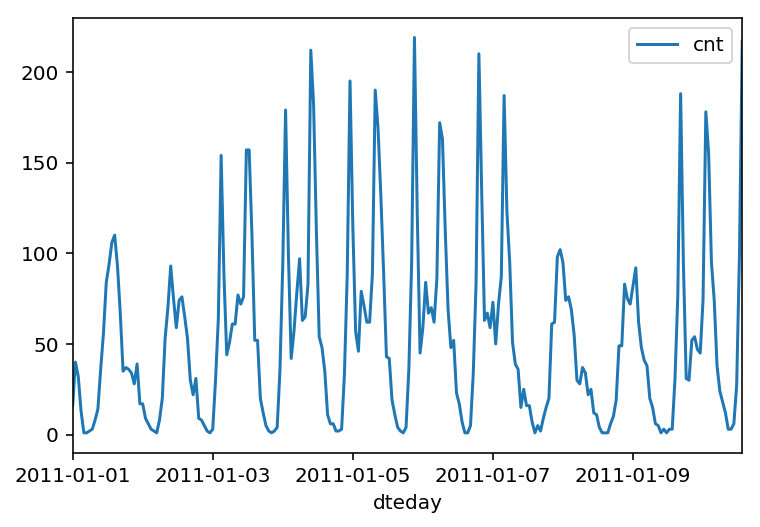

In [4]:
rides[:24*10].plot(x='dteday', y='cnt')

### Dummy variables
Here we have some categorical variables like season, weather, month. To include these in our model, we'll need to make binary dummy variables. This is simple to do with Pandas thanks to `get_dummies()`.

In [5]:
dummy_fields = ['season', 'weathersit', 'mnth', 'hr', 'weekday']
for each in dummy_fields:
    dummies = pd.get_dummies(rides[each], prefix=each, drop_first=False)
    rides = pd.concat([rides, dummies], axis=1)

fields_to_drop = ['instant', 'dteday', 'season', 'weathersit', 
                  'weekday', 'atemp', 'mnth', 'workingday', 'hr']
data = rides.drop(fields_to_drop, axis=1)
data.head()

,yr,holiday,temp,hum,windspeed,casual,registered,cnt,season_1,season_2,...,hr_21,hr_22,hr_23,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6
0,0,0,0.24,0.81,0.0,3,13,16,1,0,...,0,0,0,0,0,0,0,0,0,1
1,0,0,0.22,0.80,0.0,8,32,40,1,0,...,0,0,0,0,0,0,0,0,0,1
2,0,0,0.22,0.80,0.0,5,27,32,1,0,...,0,0,0,0,0,0,0,0,0,1
3,0,0,0.24,0.75,0.0,3,10,13,1,0,...,0,0,0,0,0,0,0,0,0,1
4,0,0,0.24,0.75,0.0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,1


### Scaling target variables
To make training the network easier, we'll standardize each of the continuous variables. That is, we'll shift and scale the variables such that they have zero mean and a standard deviation of 1.

The scaling factors are saved so we can go backwards when we use the network for predictions.

In [6]:
quant_features = ['casual', 'registered', 'cnt', 'temp', 'hum', 'windspeed']
# Store scalings in a dictionary so we can convert back later
scaled_features = {}
for each in quant_features:
    mean, std = data[each].mean(), data[each].std()
    scaled_features[each] = [mean, std]
    data.loc[:, each] = (data[each] - mean)/std

### Splitting the data into training, testing, and validation sets

We'll save the data for the last approximately 21 days to use as a test set after we've trained the network. We'll use this set to make predictions and compare them with the actual number of riders.

In [7]:
# Save data for approximately the last 21 days 
test_data = data[-21*24:]

# Now remove the test data from the data set 
data = data[:-21*24]

# Separate the data into features and targets
target_fields = ['cnt', 'casual', 'registered']
features, targets = data.drop(target_fields, axis=1), data[target_fields]
test_features, test_targets = test_data.drop(target_fields, axis=1), test_data[target_fields]

We'll split the data into two sets, one for training and one for validating as the network is being trained. Since this is time series data, we'll train on historical data, then try to predict on future data (the validation set).

In [8]:
# Hold out the last 60 days or so of the remaining data as a validation set
train_features, train_targets = features[:-60*24], targets[:-60*24]
val_features, val_targets = features[-60*24:], targets[-60*24:]

## Time to build the network

Below you'll build your network. We've built out the structure and the backwards pass. You'll implement the forward pass through the network. You'll also set the hyperparameters: the learning rate, the number of hidden units, and the number of training passes.

<img src="assets/neural_network.png" width=300px>

The network has two layers, a hidden layer and an output layer. The hidden layer will use the sigmoid function for activations. The output layer has only one node and is used for the regression, the output of the node is the same as the input of the node. That is, the activation function is $f(x)=x$. A function that takes the input signal and generates an output signal, but takes into account the threshold, is called an activation function. We work through each layer of our network calculating the outputs for each neuron. All of the outputs from one layer become inputs to the neurons on the next layer. This process is called *forward propagation*.

We use the weights to propagate signals forward from the input to the output layers in a neural network. We use the weights to also propagate error backwards from the output back into the network to update our weights. This is called *backpropagation*.

> **Hint:** You'll need the derivative of the output activation function ($f(x) = x$) for the backpropagation implementation. If you aren't familiar with calculus, this function is equivalent to the equation $y = x$. What is the slope of that equation? That is the derivative of $f(x)$.

Below, you have these tasks:
1. Implement the sigmoid function to use as the activation function. Set `self.activation_function` in `__init__` to your sigmoid function.
2. Implement the forward pass in the `train` method.
3. Implement the backpropagation algorithm in the `train` method, including calculating the output error.
4. Implement the forward pass in the `run` method.
  

In [33]:
class NeuralNetwork(object):
    def __init__(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Set number of nodes in input, hidden and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Initialize weights
        self.weights_input_to_hidden = np.random.normal(0.0, self.input_nodes**-0.5, 
                                       (self.input_nodes, self.hidden_nodes))

        self.weights_hidden_to_output = np.random.normal(0.0, self.hidden_nodes**-0.5, 
                                       (self.hidden_nodes, self.output_nodes))
        self.lr = learning_rate
        
        #### TODO: Set self.activation_function to your implemented sigmoid function ####
        #
        # Note: in Python, you can define a function with a lambda expression,
        # as shown below.
        #self.activation_function = lambda x : 0  # Replace 0 with your sigmoid calculation.
        
        ### If the lambda code above is not something you're familiar with,
        # You can uncomment out the following three lines and put your 
        # implementation there instead.
        #
        def sigmoid(x):
            return 1 / (1 + np.exp(-x))  # Replace 0 with your sigmoid calculation here
        self.activation_function = sigmoid
                    
    
    def train(self, features, targets):
        ''' Train the network on batch of features and targets. 
        
            Arguments
            ---------
            
            features: 2D array, each row is one data record, each column is a feature
            targets: 1D array of target values
        
        '''
        n_records = features.shape[0]
        delta_weights_i_h = np.zeros(self.weights_input_to_hidden.shape)
        delta_weights_h_o = np.zeros(self.weights_hidden_to_output.shape)
        for X, y in zip(features, targets):
            #### Implement the forward pass here ####
            ### Forward pass ###
            # TODO: Hidden layer - Replace these values with your calculations.
            hidden_inputs = np.dot(X, self.weights_input_to_hidden) # signals into hidden layer
            hidden_outputs = self.activation_function(hidden_inputs) # signals from hidden layer
            
            # TODO: Output layer - Replace these values with your calculations.
            final_inputs = np.dot(hidden_outputs,self.weights_hidden_to_output) # signals into final output layer
            final_outputs = final_inputs # signals from final output layer
            
            #### Implement the backward pass here ####
            ### Backward pass ###
            
            # TODO: Output error - Replace this value with your calculations.
            error = y-final_outputs # Output layer error is the difference between desired target and actual output.
            # TODO: Calculate the hidden layer's contribution to the error
            hidden_error = np.dot(self.weights_hidden_to_output,error)
            
            # TODO: Backpropagated error terms - Replace these values with your calculations.
            output_error_term = error
            hidden_error_term = hidden_error *( hidden_outputs *(1-hidden_outputs))
            # Weight step (input to hidden)
            delta_weights_i_h += hidden_error_term * X[:, None]
            # Weight step (hidden to output)
            delta_weights_h_o += (output_error_term * hidden_outputs)[:, None]

        # TODO: Update the weights - Replace these values with your calculations.
        self.weights_hidden_to_output += self.lr * delta_weights_h_o/n_records  # update hidden-to-output weights with gradient descent step
        self.weights_input_to_hidden += self.lr * delta_weights_i_h/n_records # update input-to-hidden weights with gradient descent step
       
 
            
    def run(self, features):
        ''' Run a forward pass through the network with input features 
        
            Arguments
            ---------
            features: 1D array of feature values
        '''
        
        #### Implement the forward pass here ####
        # TODO: Hidden layer - replace these values with the appropriate calculations.
        hidden_inputs = np.dot(features,self.weights_input_to_hidden) # signals into hidden layer
        hidden_outputs = self.activation_function(hidden_inputs) # signals from hidden layer
        
        # TODO: Output layer - Replace these values with the appropriate calculations.
        final_inputs = np.dot(hidden_outputs,self.weights_hidden_to_output) # signals into final output layer
        final_outputs = final_inputs # signals from final output layer 
        
        return final_outputs

In [34]:
def MSE(y, Y):
    return np.mean((y-Y)**2)

## Unit tests

Run these unit tests to check the correctness of your network implementation. This will help you be sure your network was implemented correctly befor you starting trying to train it. These tests must all be successful to pass the project.

In [35]:
import unittest

inputs = np.array([[0.5, -0.2, 0.1]])
targets = np.array([[0.4]])
test_w_i_h = np.array([[0.1, -0.2],
                       [0.4, 0.5],
                       [-0.3, 0.2]])
test_w_h_o = np.array([[0.3],
                       [-0.1]])

class TestMethods(unittest.TestCase):
    
    ##########
    # Unit tests for data loading
    ##########
    
    def test_data_path(self):
        # Test that file path to dataset has been unaltered
        self.assertTrue(data_path.lower() == 'bike-sharing-dataset/hour.csv')
        
    def test_data_loaded(self):
        # Test that data frame loaded
        self.assertTrue(isinstance(rides, pd.DataFrame))
    
    ##########
    # Unit tests for network functionality
    ##########

    def test_activation(self):
        network = NeuralNetwork(3, 2, 1, 0.5)
        # Test that the activation function is a sigmoid
        self.assertTrue(np.all(network.activation_function(0.5) == 1/(1+np.exp(-0.5))))

    def test_train(self):
        # Test that weights are updated correctly on training
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()
        
        network.train(inputs, targets)
        self.assertTrue(np.allclose(network.weights_hidden_to_output, 
                                    np.array([[ 0.37275328], 
                                              [-0.03172939]])))
        self.assertTrue(np.allclose(network.weights_input_to_hidden,
                                    np.array([[ 0.10562014, -0.20185996], 
                                              [0.39775194, 0.50074398], 
                                              [-0.29887597, 0.19962801]])))

    def test_run(self):
        # Test correctness of run method
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()
        self.assertTrue(np.allclose(network.run(inputs), 0.09998924))

suite = unittest.TestLoader().loadTestsFromModule(TestMethods())
unittest.TextTestRunner().run(suite)

.....

[[ 0.09998924]]



----------------------------------------------------------------------
Ran 5 tests in 0.014s

OK


<unittest.runner.TextTestResult run=5 errors=0 failures=0>

## Training the network

Here you'll set the hyperparameters for the network. The strategy here is to find hyperparameters such that the error on the training set is low, but you're not overfitting to the data. If you train the network too long or have too many hidden nodes, it can become overly specific to the training set and will fail to generalize to the validation set. That is, the loss on the validation set will start increasing as the training set loss drops.

You'll also be using a method know as Stochastic Gradient Descent (SGD) to train the network. The idea is that for each training pass, you grab a random sample of the data instead of using the whole data set. You use many more training passes than with normal gradient descent, but each pass is much faster. This ends up training the network more efficiently. You'll learn more about SGD later.

### Choose the number of iterations
This is the number of batches of samples from the training data we'll use to train the network. The more iterations you use, the better the model will fit the data. However, if you use too many iterations, then the model with not generalize well to other data, this is called overfitting. You want to find a number here where the network has a low training loss, and the validation loss is at a minimum. As you start overfitting, you'll see the training loss continue to decrease while the validation loss starts to increase.

### Choose the learning rate
This scales the size of weight updates. If this is too big, the weights tend to explode and the network fails to fit the data. A good choice to start at is 0.1. If the network has problems fitting the data, try reducing the learning rate. Note that the lower the learning rate, the smaller the steps are in the weight updates and the longer it takes for the neural network to converge.

### Choose the number of hidden nodes
The more hidden nodes you have, the more accurate predictions the model will make. Try a few different numbers and see how it affects the performance. You can look at the losses dictionary for a metric of the network performance. If the number of hidden units is too low, then the model won't have enough space to learn and if it is too high there are too many options for the direction that the learning can take. The trick here is to find the right balance in number of hidden units you choose.

In [30]:
import sys

### Set the hyperparameters here ###
iterations = 2000
learning_rate = 0.3
hidden_nodes = 10
output_nodes = 1

N_i = train_features.shape[1]
network = NeuralNetwork(N_i, hidden_nodes, output_nodes, learning_rate)

losses = {'train':[], 'validation':[]}
for ii in range(iterations):
    # Go through a random batch of 128 records from the training data set
    batch = np.random.choice(train_features.index, size=128)
    X, y = train_features.ix[batch].values, train_targets.ix[batch]['cnt']
                             
    network.train(X, y)
    
    # Printing out the training progress
    train_loss = MSE(network.run(train_features).T, train_targets['cnt'].values)
    val_loss = MSE(network.run(val_features).T, val_targets['cnt'].values)
    sys.stdout.write("\rProgress: {:2.1f}".format(100 * ii/float(iterations)) \
                     + "% ... Training loss: " + str(train_loss)[:5] \
                     + " ... Validation loss: " + str(val_loss)[:5])
    sys.stdout.flush()
    
    losses['train'].append(train_loss)
    losses['validation'].append(val_loss)

[[  5.25230126e-02   5.11441981e-02  -2.22362933e-01  -2.07741329e-02
   -3.41295962e-01   3.23142042e-02   9.33998634e-02   1.86445693e-01
   -1.69369744e-01   2.29911463e-02]
 [  2.35570696e-02   2.06187590e-01  -1.31414037e-02   5.04676888e-02
    5.50668430e-02  -1.11223603e-02   2.66073522e-01   3.92078104e-02
    1.45242514e-01  -1.11909006e-02]
 [  1.51702479e-01   1.76280366e-01  -9.92799190e-02   7.99105583e-02
    2.25500878e-01  -1.41833786e-02  -3.89370115e-01   7.43300684e-02
    1.23614012e-01   2.06187498e-01]
 [  2.01510850e-02  -1.43202366e-01  -1.27573785e-01   4.67160150e-02
   -1.15437921e-02   1.16770876e-01   2.04441002e-02  -4.07334572e-02
    9.00022596e-03   1.99167146e-01]
 [ -1.69238296e-02   1.89548704e-01  -1.80012390e-01   2.78855427e-02
    1.58370005e-01  -1.63812688e-01   3.53098121e-03  -9.56648673e-02
   -2.11971762e-01   3.19431093e-02]
 [ -3.50436785e-01  -2.13506071e-01  -2.65689462e-01   1.39510868e-01
    8.85428598e-02   5.82186337e-02  -6.07908

Progress: 0.0% ... Training loss: 0.976 ... Validation loss: 1.370[[  5.25053924e-02   5.32919375e-02  -2.20724873e-01  -1.95125391e-02
   -3.46340076e-01   3.22997538e-02   9.19907978e-02   1.84864130e-01
   -1.69340044e-01   2.54050684e-02]
 [  2.35569140e-02   2.06183194e-01  -1.31340360e-02   5.04729981e-02
    5.50365699e-02  -1.11224118e-02   2.66056945e-01   3.91947897e-02
    1.45242496e-01  -1.11751174e-02]
 [  1.51640778e-01   1.83498655e-01  -9.34994400e-02   8.44316272e-02
    2.08336350e-01  -1.42346682e-02  -3.94400049e-01   6.87911457e-02
    1.23716794e-01   2.14852725e-01]
 [  2.01816970e-02  -1.46602757e-01  -1.30217593e-01   4.45878076e-02
   -3.31448739e-03   1.16795367e-01   2.28607237e-02  -3.80900593e-02
    8.95021876e-03   1.95105096e-01]
 [ -1.69192189e-02   1.88699383e-01  -1.80467177e-01   2.74876069e-02
    1.60070065e-01  -1.63808628e-01   3.90352088e-03  -9.52471952e-02
   -2.11978402e-01   3.11740756e-02]
 [ -3.50417096e-01  -2.15748150e-01  -2.67496734e

Progress: 0.1% ... Training loss: 0.968 ... Validation loss: 1.365[[  5.25236115e-02   5.42489433e-02  -2.19939902e-01  -1.89705845e-02
   -3.48628134e-01   3.22834386e-02   9.13360336e-02   1.84168404e-01
   -1.69311359e-01   2.65978928e-02]
 [  2.35526278e-02   2.05942631e-01  -1.33247684e-02   5.03258781e-02
    5.55821676e-02  -1.11176459e-02   2.66222737e-01   3.93729405e-02
    1.45234055e-01  -1.14700106e-02]
 [  1.51750281e-01   1.89505949e-01  -8.87774302e-02   8.80215606e-02
    1.94524426e-01  -1.43494696e-02  -3.98824340e-01   6.44027590e-02
    1.23915434e-01   2.22104234e-01]
 [  2.00604820e-02  -1.52993894e-01  -1.34993578e-01   4.08988674e-02
    1.15242808e-02   1.16914888e-01   2.75235836e-02  -3.34334106e-02
    8.73880881e-03   1.87726537e-01]
 [ -1.69098885e-02   1.89034073e-01  -1.79982037e-01   2.77952728e-02
    1.58988780e-01  -1.63820556e-01   3.45168226e-03  -9.56224844e-02
   -2.11956495e-01   3.17184257e-02]
 [ -3.50458011e-01  -2.18003238e-01  -2.69279485e

Progress: 0.1% ... Training loss: 0.965 ... Validation loss: 1.398[[  5.24822152e-02   5.67190623e-02  -2.18165159e-01  -1.76585246e-02
   -3.54760083e-01   3.20350198e-02   8.91975542e-02   1.82158154e-01
   -1.69342527e-01   2.93964319e-02]
 [  2.35572320e-02   2.05653223e-01  -1.35433691e-02   5.01698140e-02
    5.63088279e-02  -1.10868640e-02   2.66463936e-01   3.95953591e-02
    1.45237625e-01  -1.18037093e-02]
 [  1.51661931e-01   1.94742646e-01  -8.47733224e-02   9.09086495e-02
    1.81172303e-01  -1.48955752e-02  -4.03400727e-01   6.01457525e-02
    1.23848587e-01   2.28131133e-01]
 [  2.01381551e-02  -1.57559711e-01  -1.38423421e-01   3.84085014e-02
    2.32218592e-02   1.17382332e-01   3.15568218e-02  -2.96779925e-02
    8.79667935e-03   1.82448996e-01]
 [ -1.69765790e-02   1.92971914e-01  -1.76930499e-01   2.99580659e-02
    1.48851745e-01  -1.64218816e-01   7.18887164e-05  -9.88820219e-02
   -2.12007010e-01   3.62080345e-02]
 [ -3.50447712e-01  -2.18584210e-01  -2.69743154e

Progress: 0.1% ... Training loss: 0.955 ... Validation loss: 1.373[[  5.25385591e-02   5.88432841e-02  -2.16751989e-01  -1.65977430e-02
   -3.59295790e-01   3.18676762e-02   8.76547578e-02   1.80797401e-01
   -1.69316674e-01   3.15704410e-02]
 [  2.35536563e-02   2.05525382e-01  -1.36308406e-02   5.01047414e-02
    5.66085535e-02  -1.10770237e-02   2.66566955e-01   3.96832361e-02
    1.45236203e-01  -1.19173133e-02]
 [  1.51837280e-01   2.01021150e-01  -8.03398006e-02   9.42491052e-02
    1.67000273e-01  -1.54069111e-02  -4.08334800e-01   5.58383995e-02
    1.23925865e-01   2.34884022e-01]
 [  2.00590562e-02  -1.60180958e-01  -1.40207504e-01   3.70130312e-02
    2.92690948e-02   1.17605044e-01   3.37111805e-02  -2.77873932e-02
    8.76227063e-03   1.79704177e-01]
 [ -1.69598360e-02   1.93337782e-01  -1.76541290e-01   3.02188823e-02
    1.47799242e-01  -1.64273452e-01  -3.07898965e-04  -9.93110209e-02
   -2.11998074e-01   3.65817757e-02]
 [ -3.50496522e-01  -2.20294127e-01  -2.70986172e

Progress: 0.2% ... Training loss: 0.948 ... Validation loss: 1.371[[  5.27295362e-02   6.20814307e-02  -2.14693905e-01  -1.49728572e-02
   -3.66531433e-01   3.15454374e-02   8.50066917e-02   1.78685897e-01
   -1.69257347e-01   3.49711540e-02]
 [  2.35448415e-02   2.05372821e-01  -1.37299069e-02   5.00302211e-02
    5.69394815e-02  -1.10618883e-02   2.66684678e-01   3.97798140e-02
    1.45233607e-01  -1.20712887e-02]
 [  1.52165575e-01   2.06581445e-01  -7.66502289e-02   9.71090453e-02
    1.54405853e-01  -1.59758052e-02  -4.13021560e-01   5.21247938e-02
    1.24030185e-01   2.40834001e-01]
 [  1.96501316e-02  -1.67007704e-01  -1.44632329e-01   3.35131350e-02
    4.45322214e-02   1.18311048e-01   3.95477296e-02  -2.31987090e-02
    8.63448675e-03   1.72656280e-01]
 [ -1.67721832e-02   1.96340057e-01  -1.74476621e-01   3.18317025e-02
    1.40716177e-01  -1.64589710e-01  -2.93734703e-03  -1.01424135e-01
   -2.11937591e-01   3.97731520e-02]
 [ -3.50459629e-01  -2.19730372e-01  -2.70704548e

Progress: 0.2% ... Training loss: 0.943 ... Validation loss: 1.322[[  5.29240731e-02   6.37735880e-02  -2.13672260e-01  -1.41685249e-02
   -3.69240998e-01   3.14945376e-02   8.39452785e-02   1.78040226e-01
   -1.69129181e-01   3.65494699e-02]
 [  2.35284318e-02   2.05235619e-01  -1.38071312e-02   4.99596126e-02
    5.71965584e-02  -1.10579072e-02   2.66784915e-01   3.98480823e-02
    1.45222545e-01  -1.21929400e-02]
 [  1.52893541e-01   2.12162875e-01  -7.29142927e-02   1.00194996e-01
    1.43145377e-01  -1.61642900e-02  -4.17061281e-01   4.93258828e-02
    1.24505622e-01   2.46792264e-01]
 [  1.88124018e-02  -1.73332926e-01  -1.48800728e-01   3.01123165e-02
    5.64176295e-02   1.18520510e-01   4.40655049e-02  -2.00023468e-02
    8.09918086e-03   1.66291433e-01]
 [ -1.67970209e-02   1.95904289e-01  -1.74656531e-01   3.16961144e-02
    1.41276663e-01  -1.64581042e-01  -2.70063532e-03  -1.01388839e-01
   -2.11955782e-01   3.94150476e-02]
 [ -3.50714887e-01  -2.21566735e-01  -2.71993591e

Progress: 0.3% ... Training loss: 0.934 ... Validation loss: 1.357[[  5.30656747e-02   6.53631474e-02  -2.12627058e-01  -1.33701378e-02
   -3.72640187e-01   3.13074205e-02   8.26111070e-02   1.77096285e-01
   -1.69067596e-01   3.81833528e-02]
 [  2.35394470e-02   2.05343684e-01  -1.37375937e-02   5.00110541e-02
    5.69582252e-02  -1.10705909e-02   2.66677902e-01   3.97804471e-02
    1.45226014e-01  -1.20802792e-02]
 [  1.53357016e-01   2.17554503e-01  -6.95041225e-02   1.02812101e-01
    1.31485520e-01  -1.67742050e-02  -4.21630298e-01   4.62036479e-02
    1.24698239e-01   2.52244401e-01]
 [  1.81530822e-02  -1.80940811e-01  -1.53433197e-01   2.65092143e-02
    7.25176681e-02   1.19362276e-01   5.05003060e-02  -1.56651341e-02
    7.82726038e-03   1.58907717e-01]
 [ -1.65371648e-02   1.98730404e-01  -1.72851147e-01   3.31044980e-02
    1.34907192e-01  -1.64910521e-01  -5.23010276e-03  -1.03136810e-01
   -2.11844995e-01   4.22925627e-02]
 [ -3.50762999e-01  -2.22185338e-01  -2.72371319e

Progress: 0.3% ... Training loss: 0.926 ... Validation loss: 1.343[[  5.32413269e-02   6.70212113e-02  -2.11634799e-01  -1.26043695e-02
   -3.76101584e-01   3.11208434e-02   8.13727677e-02   1.76223253e-01
   -1.68981093e-01   3.96792155e-02]
 [  2.35257215e-02   2.05186770e-01  -1.38277548e-02   4.99408761e-02
    5.72485723e-02  -1.10529683e-02   2.66796080e-01   3.98528627e-02
    1.45219212e-01  -1.22232303e-02]
 [  1.54291340e-01   2.26292576e-01  -6.41581646e-02   1.06997102e-01
    1.13495179e-01  -1.78059043e-02  -4.28742000e-01   4.15193307e-02
    1.25138614e-01   2.60684909e-01]
 [  1.74537740e-02  -1.87213849e-01  -1.57219073e-01   2.35076106e-02
    8.54227895e-02   1.20099794e-01   5.56778127e-02  -1.22666712e-02
    7.50885568e-03   1.52867597e-01]
 [ -1.62204506e-02   2.01410663e-01  -1.71149077e-01   3.44196464e-02
    1.29274909e-01  -1.65235939e-01  -7.51992153e-03  -1.04660744e-01
   -2.11699011e-01   4.49972086e-02]
 [ -3.50920881e-01  -2.23724605e-01  -2.73322311e

Progress: 0.4% ... Training loss: 0.920 ... Validation loss: 1.367[[  5.35164594e-02   6.95225645e-02  -2.10285428e-01  -1.15497277e-02
   -3.81062632e-01   3.06776656e-02   7.91030479e-02   1.74893495e-01
   -1.68964402e-01   4.18662783e-02]
 [  2.34997107e-02   2.04907858e-01  -1.39699517e-02   4.98357069e-02
    5.77805363e-02  -1.10106340e-02   2.66992724e-01   3.99831661e-02
    1.45217556e-01  -1.24508241e-02]
 [  1.54967015e-01   2.32336099e-01  -6.07308708e-02   1.09648285e-01
    1.00558946e-01  -1.89206773e-02  -4.34504239e-01   3.81408069e-02
    1.25179177e-01   2.66450162e-01]
 [  1.68995026e-02  -1.92258589e-01  -1.59887638e-01   2.13981327e-02
    9.54883447e-02   1.20986716e-01   6.02620560e-02  -9.45534581e-03
    7.47609479e-03   1.48301482e-01]
 [ -1.59613664e-02   2.03613634e-01  -1.69834571e-01   3.54033909e-02
    1.24602214e-01  -1.65646162e-01  -9.65595268e-03  -1.05982897e-01
   -2.11683871e-01   4.71337423e-02]
 [ -3.51142220e-01  -2.25773269e-01  -2.74451525e

Progress: 0.5% ... Training loss: 0.911 ... Validation loss: 1.347[[  5.37687630e-02   7.12680236e-02  -2.09330393e-01  -1.08142192e-02
   -3.84362246e-01   3.03854750e-02   7.76116676e-02   1.74008643e-01
   -1.68917255e-01   4.33546994e-02]
 [  2.35016742e-02   2.04924355e-01  -1.39615264e-02   4.98422072e-02
    5.77504551e-02  -1.10131923e-02   2.66979274e-01   3.99757384e-02
    1.45217899e-01  -1.24367488e-02]
 [  1.55917257e-01   2.39245201e-01  -5.69783348e-02   1.12527104e-01
    8.71314120e-02  -2.00441478e-02  -4.40704940e-01   3.47621321e-02
    1.25358285e-01   2.72459013e-01]
 [  1.62579732e-02  -1.96760849e-01  -1.62371856e-01   1.94792266e-02
    1.04389434e-01   1.21725759e-01   6.44544479e-02  -7.17517905e-03
    7.35541440e-03   1.44176248e-01]
 [ -1.55745047e-02   2.06177824e-01  -1.68309480e-01   3.65506946e-02
    1.18977239e-01  -1.66099442e-01  -1.21783672e-02  -1.07405160e-01
   -2.11609159e-01   4.96086250e-02]
 [ -3.51316911e-01  -2.27109205e-01  -2.75175964e

    3.18580239e-02   2.67356013e-01]]
[[ 0.03881044]
 [ 0.28696909]
 [ 0.14534485]
 [ 0.11115218]
 [-0.54141964]
 [-0.05131657]
 [-0.27179859]
 [-0.13619351]
 [ 0.00514118]
 [ 0.242703  ]]
Progress: 0.5% ... Training loss: 0.905 ... Validation loss: 1.353[[  5.42083470e-02   7.44352193e-02  -2.07697772e-01  -9.53712414e-03
   -3.90177733e-01   2.98176948e-02   7.46289601e-02   1.72479306e-01
   -1.68858918e-01   4.61276834e-02]
 [  2.35016742e-02   2.04924355e-01  -1.39615264e-02   4.98422072e-02
    5.77504551e-02  -1.10131923e-02   2.66979274e-01   3.99757384e-02
    1.45217899e-01  -1.24367488e-02]
 [  1.56760682e-01   2.45504181e-01  -5.37478644e-02   1.15052659e-01
    7.48495390e-02  -2.11589853e-02  -4.46400565e-01   3.17655994e-02
    1.25471696e-01   2.77848494e-01]
 [  1.54261622e-02  -2.02705916e-01  -1.65491520e-01   1.70650091e-02
    1.15714943e-01   1.22816564e-01   7.00971992e-02  -4.18407745e-03
    7.24655023e-03   1.38980960e-01]
 [ -1.56676998e-02   2.05230154e-01  

    3.18582790e-02   2.67369350e-01]]
[[ 0.05357254]
 [ 0.30274042]
 [ 0.15431331]
 [ 0.1230694 ]
 [-0.54078844]
 [-0.04563768]
 [-0.27154216]
 [-0.1225394 ]
 [ 0.0183415 ]
 [ 0.25382848]]
Progress: 0.6% ... Training loss: 0.896 ... Validation loss: 1.320[[  5.48247324e-02   7.79470908e-02  -2.05865260e-01  -8.07718714e-03
   -3.96243717e-01   2.92810470e-02   7.15052187e-02   1.71056492e-01
   -1.68647911e-01   4.90764739e-02]
 [  2.34806174e-02   2.04805270e-01  -1.40192771e-02   4.97938597e-02
    5.79630204e-02  -1.09954468e-02   2.67085939e-01   4.00236237e-02
    1.45210835e-01  -1.25305145e-02]
 [  1.58107401e-01   2.53124337e-01  -4.97504492e-02   1.18304402e-01
    6.08181847e-02  -2.23371587e-02  -4.53195265e-01   2.85900339e-02
    1.25942660e-01   2.84422504e-01]
 [  1.44496932e-02  -2.08077257e-01  -1.68192412e-01   1.48091689e-02
    1.25436516e-01   1.23636246e-01   7.48464220e-02  -1.91566410e-03
    6.90891307e-03   1.34349560e-01]
 [ -1.58782353e-02   2.04009918e-01  

    3.19400135e-02   2.68521499e-01]]
[[ 0.06531707]
 [ 0.31434487]
 [ 0.16119685]
 [ 0.1276662 ]
 [-0.5426642 ]
 [-0.04332322]
 [-0.27830294]
 [-0.11482548]
 [ 0.02799441]
 [ 0.26229963]]
Progress: 0.6% ... Training loss: 0.890 ... Validation loss: 1.302[[  5.53488454e-02   8.04110388e-02  -2.04597894e-01  -7.06024773e-03
   -4.00275340e-01   2.89301248e-02   6.93821783e-02   1.70116080e-01
   -1.68411445e-01   5.12389209e-02]
 [  2.34369304e-02   2.04528023e-01  -1.41518646e-02   4.96822639e-02
    5.84205080e-02  -1.09579615e-02   2.67292556e-01   4.01157639e-02
    1.45188704e-01  -1.27399017e-02]
 [  1.59744868e-01   2.60979933e-01  -4.55407037e-02   1.21657792e-01
    4.71806293e-02  -2.34603469e-02  -4.60021878e-01   2.56015900e-02
    1.26672426e-01   2.91244798e-01]
 [  1.28609318e-02  -2.15471963e-01  -1.71984897e-01   1.16986709e-02
    1.38256463e-01   1.24679616e-01   8.11848788e-02   8.95737252e-04
    6.22256609e-03   1.28147132e-01]
 [ -1.56821046e-02   2.04811131e-01  

Progress: 0.7% ... Training loss: 0.883 ... Validation loss: 1.288[[  5.59105598e-02   8.27419320e-02  -2.03326567e-01  -6.06384276e-03
   -4.03911237e-01   2.85934718e-02   6.74243946e-02   1.69302147e-01
   -1.68145349e-01   5.33516755e-02]
 [  2.33298782e-02   2.04056980e-01  -1.43977814e-02   4.94861810e-02
    5.91980987e-02  -1.08890522e-02   2.67696515e-01   4.02776591e-02
    1.45140090e-01  -1.31200800e-02]
 [  1.61860108e-01   2.69760088e-01  -4.07234718e-02   1.25557663e-01
    3.16985096e-02  -2.47872186e-02  -4.67567984e-01   2.24434617e-02
    1.27664550e-01   2.99056780e-01]
 [  1.17256836e-02  -2.20226476e-01  -1.74483100e-01   9.68489666e-03
    1.46076150e-01   1.25354271e-01   8.51189162e-02   2.60394442e-03
    5.70949098e-03   1.24100965e-01]
 [ -1.52525224e-02   2.06372634e-01  -1.67708933e-01   3.70003644e-02
    1.16304427e-01  -1.66195017e-01  -1.27511931e-02  -1.07852147e-01
   -2.11362672e-01   5.02490504e-02]
 [ -3.52422436e-01  -2.32363203e-01  -2.78151052e

    3.19814365e-02   2.68807531e-01]]
[[ 0.072106  ]
 [ 0.33025711]
 [ 0.15457844]
 [ 0.12338035]
 [-0.56184111]
 [-0.05774402]
 [-0.30919512]
 [-0.11198677]
 [ 0.02737569]
 [ 0.26532908]]
Progress: 0.7% ... Training loss: 0.873 ... Validation loss: 1.302[[  5.61997751e-02   8.38055794e-02  -2.02658619e-01  -5.57335032e-03
   -4.05958493e-01   2.83679125e-02   6.64857705e-02   1.68878868e-01
   -1.68037563e-01   5.43993262e-02]
 [  2.32690773e-02   2.03775085e-01  -1.45325394e-02   4.93804637e-02
    5.96326505e-02  -1.08378084e-02   2.67913392e-01   4.03680939e-02
    1.45118154e-01  -1.33255327e-02]
 [  1.63522055e-01   2.77241817e-01  -3.69418205e-02   1.28576249e-01
    1.82862111e-02  -2.61832645e-02  -4.74323903e-01   1.97971459e-02
    1.28307634e-01   3.05285991e-01]
 [  1.00697153e-02  -2.27714015e-01  -1.78034544e-01   6.77602836e-03
    1.59075750e-01   1.26686731e-01   9.20923055e-02   5.14617518e-03
    5.07467103e-03   1.18111935e-01]
 [ -1.53823757e-02   2.05791397e-01  

Progress: 0.8% ... Training loss: 0.869 ... Validation loss: 1.344[[ 0.05665727  0.08611636 -0.20160761 -0.0047579  -0.40966257  0.02774852
   0.0641529   0.16793425 -0.16792804  0.05630605]
 [ 0.02326213  0.20373708 -0.01454968  0.0493663   0.05968894 -0.01082805
   0.26794497  0.04039006  0.14511707 -0.01334775]
 [ 0.16475043  0.28343788 -0.03400086  0.13087563  0.0060342  -0.02789813
  -0.48082014  0.01718037  0.12861349  0.31051768]
 [ 0.00856733 -0.23530314 -0.18149848  0.00409907  0.17327058  0.12866566
   0.10015468  0.00821797  0.00470268  0.11208098]
 [-0.01493948  0.20795943 -0.16673891  0.03753493  0.11206878 -0.16665437
  -0.01475776 -0.10864097 -0.21127337  0.051482  ]
 [-0.35314016 -0.2360668  -0.27990862  0.12833433  0.1361993   0.06101828
  -0.04103126 -0.03917633 -0.02907302  0.04139035]
 [-0.00142846 -0.0884634   0.00925563  0.11269864 -0.25445952 -0.07283846
   0.11732658 -0.18264622  0.18719455  0.06488798]
 [ 0.14036206 -0.06848171  0.04540509 -0.03553113 -0.015872

Progress: 0.8% ... Training loss: 0.846 ... Validation loss: 1.285[[  5.92143164e-02   9.67080057e-02  -1.96690899e-01  -9.00671529e-04
   -4.27195203e-01   2.50707146e-02   5.38184852e-02   1.64172541e-01
   -1.67030252e-01   6.44631645e-02]
 [  2.33406750e-02   2.04015744e-01  -1.44251528e-02   4.94757590e-02
    5.91941640e-02  -1.08942182e-02   2.67659657e-01   4.03038173e-02
    1.45145575e-01  -1.31131706e-02]
 [  1.69325595e-01   3.02044197e-01  -2.51510425e-02   1.37851260e-01
   -2.67586138e-02  -3.26599918e-02  -4.99100533e-01   1.04491653e-02
    1.30216189e-01   3.25403800e-01]
 [  4.44969554e-03  -2.51453109e-01  -1.89266792e-01  -2.05046306e-03
    2.01412247e-01   1.32818610e-01   1.16668632e-01   1.40675668e-02
    3.24743037e-03   9.91568332e-02]
 [ -1.32405856e-02   2.14017142e-01  -1.63615704e-01   3.99476822e-02
    9.93739659e-02  -1.68289667e-01  -2.13968355e-02  -1.11072207e-01
   -2.10688808e-01   5.65537028e-02]
 [ -3.53682722e-01  -2.38432535e-01  -2.81041581e

Progress: 0.9% ... Training loss: 0.854 ... Validation loss: 1.222[[  5.93414885e-02   9.69394653e-02  -1.96477110e-01  -7.70956601e-04
   -4.26968498e-01   2.50126103e-02   5.37087478e-02   1.64103598e-01
   -1.66928499e-01   6.44075275e-02]
 [  2.32185171e-02   2.03534770e-01  -1.46427970e-02   4.92893333e-02
    5.98788233e-02  -1.08216210e-02   2.68021739e-01   4.03868516e-02
    1.45074007e-01  -1.34682520e-02]
 [  1.72611540e-01   3.12500648e-01  -1.99576889e-02   1.42334736e-01
   -4.24937568e-02  -3.44097770e-02  -5.07988614e-01   8.22799534e-03
    1.31980485e-01   3.33568752e-01]
 [  6.73086734e-04  -2.63057796e-01  -1.94881276e-01  -6.95347350e-03
    2.18544375e-01   1.34708064e-01   1.26985260e-01   1.65418913e-02
    1.26653211e-03   8.98135752e-02]
 [ -1.20271476e-02   2.17460482e-01  -1.61731160e-01   4.15275899e-02
    9.39664599e-02  -1.68886341e-01  -2.46995918e-02  -1.11878055e-01
   -2.10028523e-01   5.95253693e-02]
 [ -3.54551678e-01  -2.41266175e-01  -2.82440628e

Progress: 0.9% ... Training loss: 0.831 ... Validation loss: 1.233[[  5.94971836e-02   9.70130459e-02  -1.96372468e-01  -6.76408339e-04
   -4.27195652e-01   2.49834173e-02   5.37267960e-02   1.64042426e-01
   -1.66889625e-01   6.45630643e-02]
 [  2.32126717e-02   2.03447235e-01  -1.46667991e-02   4.92661703e-02
    5.99064934e-02  -1.08095967e-02   2.68038524e-01   4.03951155e-02
    1.45063152e-01  -1.35053031e-02]
 [  1.74355995e-01   3.18151103e-01  -1.72188453e-02   1.44633529e-01
   -5.18243867e-02  -3.56026415e-02  -5.12904390e-01   6.86586952e-03
    1.32791463e-01   3.38083519e-01]
 [ -5.30892222e-04  -2.67142009e-01  -1.96634444e-01  -8.50483207e-03
    2.24816652e-01   1.35521282e-01   1.30531722e-01   1.74724531e-02
    7.20722486e-04   8.67429772e-02]
 [ -1.17591022e-02   2.18277912e-01  -1.61319714e-01   4.18412697e-02
    9.25203466e-02  -1.69040240e-01  -2.53467423e-02  -1.12058748e-01
   -2.09879274e-01   5.99802838e-02]
 [ -3.55190866e-01  -2.43483661e-01  -2.83530753e

Progress: 1.0% ... Training loss: 0.819 ... Validation loss: 1.254[[  5.93767771e-02   9.63693065e-02  -1.96564667e-01  -8.68160967e-04
   -4.25689667e-01   2.51074525e-02   5.45036740e-02   1.64175836e-01
   -1.66944028e-01   6.41099843e-02]
 [  2.31532158e-02   2.03223944e-01  -1.47634667e-02   4.91868804e-02
    6.02682976e-02  -1.07538934e-02   2.68243057e-01   4.04513099e-02
    1.45040655e-01  -1.36693569e-02]
 [  1.75920033e-01   3.23540144e-01  -1.46605092e-02   1.46754942e-01
   -6.05587160e-02  -3.70220382e-02  -5.18151612e-01   5.39112806e-03
    1.33427587e-01   3.42377369e-01]
 [ -2.40129589e-03  -2.73407671e-01  -1.99424692e-01  -1.08382595e-02
    2.34203251e-01   1.37050814e-01   1.36647653e-01   1.91305742e-02
    7.84639600e-07   8.19767135e-02]
 [ -1.11663989e-02   2.20003028e-01  -1.60361565e-01   4.26024325e-02
    8.90273139e-02  -1.69546305e-01  -2.76264805e-02  -1.12610156e-01
   -2.09611952e-01   6.14858491e-02]
 [ -3.55978156e-01  -2.46444089e-01  -2.84855635e

Progress: 1.1% ... Training loss: 0.818 ... Validation loss: 1.320[[  6.02591865e-02   9.98981825e-02  -1.95107273e-01   2.92996461e-04
   -4.31774304e-01   2.39277178e-02   5.06503810e-02   1.62971705e-01
   -1.66726824e-01   6.66970756e-02]
 [  2.33254751e-02   2.03895675e-01  -1.44817784e-02   4.94186834e-02
    5.89716909e-02  -1.09786470e-02   2.67433000e-01   4.02090056e-02
    1.45083707e-01  -1.31318864e-02]
 [  1.78012545e-01   3.31733324e-01  -1.12251742e-02   1.49525016e-01
   -7.53579774e-02  -3.97996417e-02  -5.27364331e-01   2.55399238e-03
    1.33936923e-01   3.48598045e-01]
 [ -3.39552549e-03  -2.77331236e-01  -2.01026106e-01  -1.21554979e-02
    2.41055787e-01   1.38359475e-01   1.40994029e-01   2.05317884e-02
   -2.48629462e-04   7.88739189e-02]
 [ -9.96224932e-03   2.24080682e-01  -1.58521891e-01   4.40876118e-02
    8.07947155e-02  -1.70997049e-01  -3.26604145e-02  -1.14136831e-01
   -2.09326854e-01   6.48019512e-02]
 [ -3.56465442e-01  -2.48425006e-01  -2.85654329e

Progress: 1.1% ... Training loss: 0.803 ... Validation loss: 1.279[[  6.08976629e-02   1.02448107e-01  -1.94134207e-01   1.05947238e-03
   -4.35518692e-01   2.32306172e-02   4.84514819e-02   1.62301321e-01
   -1.66531459e-01   6.84408181e-02]
 [  2.32414100e-02   2.03567908e-01  -1.46108662e-02   4.93122601e-02
    5.95148872e-02  -1.08833233e-02   2.67761434e-01   4.02992942e-02
    1.45056446e-01  -1.33697960e-02]
 [  1.79334918e-01   3.36550092e-01  -9.25329016e-03   1.51147006e-01
   -8.31907456e-02  -4.12395666e-02  -5.31914889e-01   1.15547658e-03
    1.34351814e-01   3.52281145e-01]
 [ -4.73615100e-03  -2.81924804e-01  -2.02893165e-01  -1.37731474e-02
    2.49139831e-01   1.39793900e-01   1.45636214e-01   2.19101939e-02
   -6.43831984e-04   7.54457355e-02]
 [ -1.04674908e-02   2.22412563e-01  -1.59024880e-01   4.35299290e-02
    8.35750048e-02  -1.70522486e-01  -3.07535364e-02  -1.13697317e-01
   -2.09441128e-01   6.35898846e-02]
 [ -3.56706719e-01  -2.49331328e-01  -2.86023594e

Progress: 1.1% ... Training loss: 0.799 ... Validation loss: 1.283[[  6.16261505e-02   1.05219077e-01  -1.93032187e-01   1.96082552e-03
   -4.39557651e-01   2.23940176e-02   4.57981847e-02   1.61516283e-01
   -1.66284825e-01   7.04526325e-02]
 [  2.31898690e-02   2.03372165e-01  -1.46897080e-02   4.92465940e-02
    5.98437694e-02  -1.08216028e-02   2.67971071e-01   4.03553902e-02
    1.45039119e-01  -1.35196434e-02]
 [  1.81075837e-01   3.43083352e-01  -6.57263021e-03   1.53314601e-01
   -9.35578467e-02  -4.32780746e-02  -5.38601068e-01  -7.37155390e-04
    1.34943944e-01   3.57035711e-01]
 [ -5.99363879e-03  -2.86765374e-01  -2.04817484e-01  -1.53051742e-02
    2.56214992e-01   1.41265984e-01   1.50479395e-01   2.32893417e-02
   -1.06394892e-03   7.20512886e-02]
 [ -1.04277849e-02   2.22468845e-01  -1.58840749e-01   4.36262668e-02
    8.32724714e-02  -1.70615252e-01  -3.10216113e-02  -1.13825993e-01
   -2.09410080e-01   6.37110833e-02]
 [ -3.56801429e-01  -2.49748772e-01  -2.86258060e

Progress: 1.2% ... Training loss: 0.791 ... Validation loss: 1.265[[  6.14766281e-02   1.04601260e-01  -1.93244137e-01   1.77329754e-03
   -4.38222119e-01   2.25632509e-02   4.67868089e-02   1.61651587e-01
   -1.66329131e-01   6.98549371e-02]
 [  2.31800548e-02   2.03369432e-01  -1.47010680e-02   4.92354371e-02
    5.98752209e-02  -1.08112717e-02   2.68008144e-01   4.03638825e-02
    1.45035748e-01  -1.35429746e-02]
 [  1.82450674e-01   3.47852007e-01  -4.61955592e-03   1.55013596e-01
   -1.01626574e-01  -4.47299592e-02  -5.43283198e-01  -2.06686609e-03
    1.35442773e-01   3.60446181e-01]
 [ -7.63134850e-03  -2.92237425e-01  -2.07011846e-01  -1.72392861e-02
    2.65285967e-01   1.42994717e-01   1.56366607e-01   2.48022801e-02
   -1.65737689e-03   6.80399543e-02]
 [ -1.04052291e-02   2.22229159e-01  -1.58667890e-01   4.36737210e-02
    8.27422764e-02  -1.70657139e-01  -3.06131734e-02  -1.13901701e-01
   -2.09372615e-01   6.34997856e-02]
 [ -3.57420529e-01  -2.52098728e-01  -2.87171417e

Progress: 1.2% ... Training loss: 0.795 ... Validation loss: 1.316[[  6.20708038e-02   1.06440857e-01  -1.92396338e-01   2.40514566e-03
   -4.41223910e-01   2.18184072e-02   4.43494534e-02   1.60998707e-01
   -1.66164052e-01   7.13630480e-02]
 [  2.31743266e-02   2.03210529e-01  -1.47010943e-02   4.92225421e-02
    5.99880133e-02  -1.08044403e-02   2.68051269e-01   4.03797684e-02
    1.45034804e-01  -1.35512056e-02]
 [  1.84012853e-01   3.53317847e-01  -2.47753256e-03   1.56718854e-01
   -1.11114835e-01  -4.67730758e-02  -5.49656006e-01  -3.82895443e-03
    1.35851068e-01   3.64707553e-01]
 [ -9.34722583e-03  -2.98372448e-01  -2.09337966e-01  -1.90930930e-02
    2.75542899e-01   1.45221844e-01   1.63771543e-01   2.67693969e-02
   -2.11677619e-03   6.33417554e-02]
 [ -9.96945284e-03   2.22996137e-01  -1.58059492e-01   4.40226096e-02
    8.06190192e-02  -1.71063837e-01  -3.22105164e-02  -1.14323401e-01
   -2.09264603e-01   6.44770716e-02]
 [ -3.57805427e-01  -2.53529698e-01  -2.87672061e

Progress: 1.3% ... Training loss: 0.787 ... Validation loss: 1.305[[  6.32266217e-02   1.10099839e-01  -1.90884147e-01   3.59035342e-03
   -4.46698653e-01   2.04236163e-02   4.03715101e-02   1.59776356e-01
   -1.65839197e-01   7.41236675e-02]
 [  2.31231050e-02   2.03008418e-01  -1.47620363e-02   4.91664269e-02
    6.02816650e-02  -1.07427869e-02   2.68276762e-01   4.04339632e-02
    1.45021741e-01  -1.36851747e-02]
 [  1.86506069e-01   3.61824427e-01   9.68233041e-04   1.59445442e-01
   -1.25538748e-01  -4.99557898e-02  -5.59019213e-01  -6.56019256e-03
    1.36567449e-01   3.71233736e-01]
 [ -1.08411597e-02  -3.03346059e-01  -2.11333980e-01  -2.07141570e-02
    2.83682503e-01   1.47086165e-01   1.69427354e-01   2.84166215e-02
   -2.54587410e-03   5.94275252e-02]
 [ -1.01672077e-02   2.21416055e-01  -1.58214533e-01   4.38115800e-02
    8.16657989e-02  -1.70752902e-01  -3.10171847e-02  -1.14117825e-01
   -2.09303524e-01   6.39909384e-02]
 [ -3.58093361e-01  -2.54620093e-01  -2.88124229e

Progress: 1.4% ... Training loss: 0.771 ... Validation loss: 1.254[[  6.45435487e-02   1.14399108e-01  -1.89220514e-01   4.87823627e-03
   -4.51704935e-01   1.91783883e-02   3.60330478e-02   1.58746582e-01
   -1.65361597e-01   7.69139524e-02]
 [  2.29822568e-02   2.02556727e-01  -1.49318352e-02   4.90266960e-02
    6.10171400e-02  -1.06046367e-02   2.68794779e-01   4.05460075e-02
    1.44973240e-01  -1.40057747e-02]
 [  1.89411044e-01   3.71046592e-01   4.85006530e-03   1.62583126e-01
   -1.40138014e-01  -5.29874522e-02  -5.69185875e-01  -9.05905096e-03
    1.37683384e-01   3.78161221e-01]
 [ -1.32565722e-02  -3.10988592e-01  -2.14405859e-01  -2.32520653e-02
    2.95256211e-01   1.49573064e-01   1.77889508e-01   3.04236367e-02
   -3.46783345e-03   5.36154254e-02]
 [ -9.33322507e-03   2.23950262e-01  -1.57127687e-01   4.46902896e-02
    7.70632095e-02  -1.71643189e-01  -3.36826787e-02  -1.14796416e-01
   -2.08968720e-01   6.59596960e-02]
 [ -3.58736779e-01  -2.56731736e-01  -2.89023281e

Progress: 1.4% ... Training loss: 0.761 ... Validation loss: 1.226[[  6.52048758e-02   1.16222135e-01  -1.88362175e-01   5.56969495e-03
   -4.53957695e-01   1.85914767e-02   3.43336767e-02   1.58271160e-01
   -1.65082284e-01   7.83419617e-02]
 [  2.28616006e-02   2.02063242e-01  -1.51146240e-02   4.88727295e-02
    6.17598379e-02  -1.04624997e-02   2.69218666e-01   4.06445975e-02
    1.44914552e-01  -1.42961769e-02]
 [  1.91480899e-01   3.77133565e-01   7.53923514e-03   1.64814139e-01
   -1.50009234e-01  -5.49711725e-02  -5.75115568e-01  -1.05834842e-02
    1.38549272e-01   3.82757339e-01]
 [ -1.49681439e-02  -3.15870934e-01  -2.16541229e-01  -2.49982305e-02
    3.02576625e-01   1.51143097e-01   1.83160729e-01   3.16298403e-02
   -4.19199387e-03   4.98910888e-02]
 [ -8.68701994e-03   2.25429931e-01  -1.56241616e-01   4.53391700e-02
    7.40546380e-02  -1.72221947e-01  -3.57290664e-02  -1.15280129e-01
   -2.08655221e-01   6.72122272e-02]
 [ -3.59152957e-01  -2.58118290e-01  -2.89596106e

Progress: 1.4% ... Training loss: 0.754 ... Validation loss: 1.232[[  6.59452705e-02   1.18356757e-01  -1.87391958e-01   6.31490485e-03
   -4.56131908e-01   1.78794525e-02   3.21207019e-02   1.57721721e-01
   -1.64763897e-01   7.98890240e-02]
 [  2.28217467e-02   2.01955500e-01  -1.51606780e-02   4.88299181e-02
    6.19390255e-02  -1.04200963e-02   2.69356893e-01   4.06732228e-02
    1.44898873e-01  -1.43889793e-02]
 [  1.92594880e-01   3.79794538e-01   8.89277831e-03   1.65954437e-01
   -1.54272262e-01  -5.60828262e-02  -5.78200664e-01  -1.13888657e-02
    1.39025096e-01   3.85273189e-01]
 [ -1.82642938e-02  -3.25738945e-01  -2.20568535e-01  -2.83896984e-02
    3.17483953e-01   1.54462216e-01   1.94388849e-01   3.40135919e-02
   -5.57175863e-03   4.23216249e-02]
 [ -8.37138399e-03   2.25842535e-01  -1.55739280e-01   4.56885322e-02
    7.25428365e-02  -1.72518851e-01  -3.67471260e-02  -1.15546005e-01
   -2.08488390e-01   6.80773281e-02]
 [ -3.59405445e-01  -2.58736051e-01  -2.89853512e

    3.21920728e-02   2.68759579e-01]]
[[ 0.1333038 ]
 [ 0.4690527 ]
 [ 0.16447694]
 [ 0.1384229 ]
 [-0.74688613]
 [-0.15565301]
 [-0.5345644 ]
 [-0.10983843]
 [ 0.05019505]
 [ 0.3229797 ]]
Progress: 1.5% ... Training loss: 0.750 ... Validation loss: 1.256[[  6.69074383e-02   1.21498982e-01  -1.86184237e-01   7.36768283e-03
   -4.61205393e-01   1.67296836e-02   2.85972720e-02   1.56920796e-01
   -1.64398255e-01   8.21649811e-02]
 [  2.29523824e-02   2.02316975e-01  -1.49879444e-02   4.89806580e-02
    6.12335763e-02  -1.05792620e-02   2.68908835e-01   4.05534812e-02
    1.44950612e-01  -1.40965470e-02]
 [  1.94632899e-01   3.86273060e-01   1.14822600e-02   1.68202591e-01
   -1.65546918e-01  -5.85455695e-02  -5.85316416e-01  -1.31284159e-02
    1.39822694e-01   3.89771710e-01]
 [ -1.85400803e-02  -3.26407487e-01  -2.20944529e-01  -2.87062306e-02
    3.18520264e-01   1.54791849e-01   1.95377064e-01   3.43032180e-02
   -5.69233461e-03   4.18950501e-02]
 [ -7.96050728e-03   2.27014889e-01  

Progress: 1.6% ... Training loss: 0.745 ... Validation loss: 1.248[[  6.78361371e-02   1.24221282e-01  -1.85076955e-01   8.34221727e-03
   -4.64784902e-01   1.57000388e-02   2.55949026e-02   1.56224975e-01
   -1.64048173e-01   8.42104135e-02]
 [  2.28402081e-02   2.01940040e-01  -1.51158267e-02   4.88631748e-02
    6.18252925e-02  -1.04504787e-02   2.69347620e-01   4.06422333e-02
    1.44908261e-01  -1.43527884e-02]
 [  1.96358086e-01   3.92145526e-01   1.36917314e-02   1.70076132e-01
   -1.73322397e-01  -6.05782466e-02  -5.91742572e-01  -1.44817859e-02
    1.40503251e-01   3.93962550e-01]
 [ -2.03487765e-02  -3.32444703e-01  -2.23042950e-01  -3.06232656e-02
    3.26341063e-01   1.56843052e-01   2.01968949e-01   3.56740884e-02
   -6.38320349e-03   3.77119636e-02]
 [ -8.92140919e-03   2.24184125e-01  -1.56164050e-01   4.52162655e-02
    7.45155737e-02  -1.72011901e-01  -3.47369374e-02  -1.15300098e-01
   -2.08619129e-01   6.69048462e-02]
 [ -3.59913555e-01  -2.60406593e-01  -2.90551700e

Progress: 1.6% ... Training loss: 0.737 ... Validation loss: 1.224[[  6.81587316e-02   1.25221072e-01  -1.84699286e-01   8.64379068e-03
   -4.65857868e-01   1.53614043e-02   2.47522407e-02   1.55997364e-01
   -1.63905639e-01   8.49164007e-02]
 [  2.29025945e-02   2.02111438e-01  -1.50501944e-02   4.89248026e-02
    6.15322363e-02  -1.05149024e-02   2.69149592e-01   4.06015540e-02
    1.44930037e-01  -1.42212763e-02]
 [  1.97754760e-01   3.96532107e-01   1.55057083e-02   1.71641781e-01
   -1.80409368e-01  -6.21645006e-02  -5.96572961e-01  -1.55236982e-02
    1.41095348e-01   3.97422158e-01]
 [ -2.16668433e-02  -3.36192166e-01  -2.24418824e-01  -3.18844929e-02
    3.31946042e-01   1.58141461e-01   2.06695328e-01   3.65304402e-02
   -6.92614694e-03   3.48754260e-02]
 [ -8.87626192e-03   2.23748321e-01  -1.56155986e-01   4.52086616e-02
    7.47928694e-02  -1.72039511e-01  -3.48323970e-02  -1.15322222e-01
   -2.08563091e-01   6.69232471e-02]
 [ -3.60611990e-01  -2.62623758e-01  -2.91457763e

    3.21088586e-02   2.68341661e-01]]
[[ 0.1347788 ]
 [ 0.47342839]
 [ 0.14984493]
 [ 0.12758676]
 [-0.78874275]
 [-0.17693792]
 [-0.57800075]
 [-0.1175554 ]
 [ 0.043781  ]
 [ 0.3180662 ]]
Progress: 1.6% ... Training loss: 0.747 ... Validation loss: 1.297[[ 0.06978101  0.1301383  -0.18288919  0.0101819  -0.47358211  0.01324119
   0.01832766  0.15454277 -0.16337187  0.08864626]
 [ 0.02282521  0.20181269 -0.01513531  0.04884542  0.06202965 -0.0104078
   0.2694966   0.04067604  0.14490606 -0.01439138]
 [ 0.19894191  0.40013733  0.01676577  0.17274821 -0.18537598 -0.06370594
  -0.60105841 -0.01655223  0.14147539  0.40013714]
 [-0.02282376 -0.34020731 -0.22563838 -0.03298325  0.33599121  0.15968712
   0.21117017  0.03755461 -0.00732039  0.03235388]
 [-0.00991094  0.2203924  -0.15720173  0.04423804  0.08046581 -0.17070295
  -0.03092925 -0.11440732 -0.20887183  0.06447451]
 [-0.36076415 -0.26316747 -0.29162493  0.11832302  0.18488081  0.06925141
  -0.01184296 -0.03168174 -0.03212582  0.019426

Progress: 1.8% ... Training loss: 0.722 ... Validation loss: 1.189[[  7.14458515e-02   1.34702700e-01  -1.81031059e-01   1.17936224e-02
   -4.79264877e-01   1.16464416e-02   1.38568503e-02   1.53540035e-01
   -1.62588047e-01   9.18489352e-02]
 [  2.25553294e-02   2.00918990e-01  -1.54456417e-02   4.85635273e-02
    6.34461949e-02  -1.01461449e-02   2.70502487e-01   4.08331123e-02
    1.44787833e-01  -1.49946208e-02]
 [  2.02482190e-01   4.09946812e-01   2.07062883e-02   1.76239655e-01
   -1.99796790e-01  -6.71304551e-02  -6.11542365e-01  -1.86208571e-02
    1.43100872e-01   4.07093594e-01]
 [ -2.66789873e-02  -3.50649022e-01  -2.29648979e-01  -3.66295168e-02
    3.51093795e-01   1.63307674e-01   2.22861769e-01   3.97540667e-02
   -9.03322320e-03   2.45819649e-02]
 [ -7.22706857e-03   2.27609025e-01  -1.54265465e-01   4.68221798e-02
    6.74853163e-02  -1.73307889e-01  -3.88498581e-02  -1.15960891e-01
   -2.07634114e-01   6.99675338e-02]
 [ -3.61080136e-01  -2.64281555e-01  -2.92033603e

Progress: 1.8% ... Training loss: 0.724 ... Validation loss: 1.251[[  7.31885852e-02   1.38929043e-01  -1.79059867e-01   1.33944572e-02
   -4.84426605e-01   9.81900270e-03   9.20306045e-03   1.52284045e-01
   -1.61936294e-01   9.51659764e-02]
 [  2.25553294e-02   2.00918990e-01  -1.54456417e-02   4.85635273e-02
    6.34461949e-02  -1.01461449e-02   2.70502487e-01   4.08331123e-02
    1.44787833e-01  -1.49946208e-02]
 [  2.05421612e-01   4.17484228e-01   2.39932472e-02   1.79044747e-01
   -2.12684621e-01  -7.04382681e-02  -6.20532588e-01  -2.08195967e-02
    1.44174105e-01   4.13069676e-01]
 [ -3.05160696e-02  -3.61042236e-01  -2.33739725e-01  -4.01832491e-02
    3.65270269e-01   1.67420776e-01   2.35374429e-01   4.25071664e-02
   -1.04178474e-02   1.66228865e-02]
 [ -5.05830939e-03   2.32256090e-01  -1.51852381e-01   4.87993787e-02
    5.88716913e-02  -1.75488406e-01  -4.47713461e-02  -1.17568399e-01
   -2.06845846e-01   7.39938630e-02]
 [ -3.61670482e-01  -2.66160054e-01  -2.92673031e

Progress: 1.9% ... Training loss: 0.710 ... Validation loss: 1.153[[  7.41824649e-02   1.41245455e-01  -1.77894608e-01   1.43161057e-02
   -4.86673432e-01   8.98762482e-03   7.25966251e-03   1.51792969e-01
   -1.61475756e-01   9.65839533e-02]
 [  2.25641472e-02   2.00876838e-01  -1.54536811e-02   4.85604076e-02
    6.34725939e-02  -1.01432618e-02   2.70499197e-01   4.08316906e-02
    1.44786695e-01  -1.49886947e-02]
 [  2.07785050e-01   4.23489960e-01   2.65702402e-02   1.81312977e-01
   -2.20308534e-01  -7.24880620e-02  -6.26336426e-01  -2.19443881e-02
    1.45257771e-01   4.17056606e-01]
 [ -3.33906235e-02  -3.68955719e-01  -2.36719897e-01  -4.29810432e-02
    3.75755287e-01   1.69933886e-01   2.44164128e-01   4.39124682e-02
   -1.17861465e-02   1.09190823e-02]
 [ -5.65147654e-03   2.29765323e-01  -1.52542301e-01   4.80752134e-02
    6.22203431e-02  -1.74798777e-01  -4.25905568e-02  -1.17288059e-01
   -2.07077688e-01   7.24077685e-02]
 [ -3.62101611e-01  -2.67550898e-01  -2.93175567e

Progress: 1.9% ... Training loss: 0.703 ... Validation loss: 1.153[[  7.54079161e-02   1.44522596e-01  -1.76594311e-01   1.55404907e-02
   -4.90488462e-01   7.84868549e-03   3.79144016e-03   1.51159684e-01
   -1.60893378e-01   9.89964853e-02]
 [  2.24633118e-02   2.00566849e-01  -1.55645513e-02   4.84552048e-02
    6.39581052e-02  -1.00424954e-02   2.70815878e-01   4.08809385e-02
    1.44737840e-01  -1.52012266e-02]
 [  2.09303742e-01   4.28052708e-01   2.83130396e-02   1.82919052e-01
   -2.26417233e-01  -7.39928125e-02  -6.31111793e-01  -2.27080684e-02
    1.46002197e-01   4.20327608e-01]
 [ -3.53627417e-02  -3.74332514e-01  -2.38912032e-01  -4.49653867e-02
    3.82569938e-01   1.71792304e-01   2.50467088e-01   4.48950706e-02
   -1.27354736e-02   6.98680539e-03]
 [ -4.86004376e-03   2.31421537e-01  -1.51746551e-01   4.87820601e-02
    5.98541066e-02  -1.75488077e-01  -4.50320202e-02  -1.17649959e-01
   -2.06668175e-01   7.39265387e-02]
 [ -3.62452711e-01  -2.68705864e-01  -2.93604463e

    3.20049541e-02   2.67478741e-01]]
[[ 0.17668852]
 [ 0.56611131]
 [ 0.18182264]
 [ 0.17585427]
 [-0.8452934 ]
 [-0.17644605]
 [-0.62111083]
 [-0.08829837]
 [ 0.08331638]
 [ 0.37678952]]
Progress: 1.9% ... Training loss: 0.697 ... Validation loss: 1.162[[  7.57421492e-02   1.45278260e-01  -1.76300543e-01   1.58591684e-02
   -4.91418384e-01   7.51986035e-03   3.17277366e-03   1.50978699e-01
   -1.60743643e-01   9.96035923e-02]
 [  2.23779198e-02   2.00327738e-01  -1.56530386e-02   4.83700450e-02
    6.43412622e-02  -9.95648059e-03   2.71073569e-01   4.09240073e-02
    1.44699634e-01  -1.53838173e-02]
 [  2.09893702e-01   4.29815404e-01   2.89054034e-02   1.83530643e-01
   -2.28586777e-01  -7.46116074e-02  -6.33031926e-01  -2.30450484e-02
    1.46281515e-01   4.21750531e-01]
 [ -3.65648152e-02  -3.77981290e-01  -2.40036408e-01  -4.61240882e-02
    3.87349229e-01   1.72940042e-01   2.53924744e-01   4.54843106e-02
   -1.32914639e-02   4.88193138e-03]
 [ -5.26143343e-03   2.30162074e-01  

Progress: 2.0% ... Training loss: 0.699 ... Validation loss: 1.220[[  7.56239630e-02   1.44559862e-01  -1.76405005e-01   1.57253153e-02
   -4.90066317e-01   7.63541544e-03   3.87001750e-03   1.51022781e-01
   -1.60773966e-01   9.92614863e-02]
 [  2.22547517e-02   1.99912518e-01  -1.57737001e-02   4.82471629e-02
    6.49879593e-02  -9.80782642e-03   2.71536696e-01   4.10027572e-02
    1.44649120e-01  -1.56419293e-02]
 [  2.10454966e-01   4.31238008e-01   2.95095391e-02   1.84116572e-01
   -2.31220089e-01  -7.53412397e-02  -6.35311938e-01  -2.34012012e-02
    1.46524481e-01   4.22908630e-01]
 [ -3.71358212e-02  -3.79739317e-01  -2.40607032e-01  -4.66414032e-02
    3.88678782e-01   1.73568477e-01   2.55700512e-01   4.58801972e-02
   -1.35547147e-02   3.69141488e-03]
 [ -5.62472910e-03   2.28967672e-01  -1.52518187e-01   4.80170467e-02
    6.34277828e-02  -1.74628576e-01  -4.16978096e-02  -1.17269793e-01
   -2.06983748e-01   7.19378292e-02]
 [ -3.62959696e-01  -2.70388485e-01  -2.94212731e

    3.19862328e-02   2.67170897e-01]]
[[ 0.15681146]
 [ 0.54857611]
 [ 0.16081176]
 [ 0.15231696]
 [-0.87922228]
 [-0.19994839]
 [-0.65459623]
 [-0.10759378]
 [ 0.06107633]
 [ 0.35325963]]
Progress: 2.0% ... Training loss: 0.704 ... Validation loss: 1.245[[  7.72354499e-02   1.49161260e-01  -1.74705020e-01   1.72358454e-02
   -4.96720436e-01   5.69377266e-03  -1.25167540e-03   1.49900450e-01
   -1.60131137e-01   1.02252441e-01]
 [  2.22372160e-02   1.99850777e-01  -1.57918671e-02   4.82299675e-02
    6.50865767e-02  -9.78924677e-03   2.71610357e-01   4.10147624e-02
    1.44642530e-01  -1.56818553e-02]
 [  2.11902586e-01   4.35145609e-01   3.10274024e-02   1.85420418e-01
   -2.36549883e-01  -7.70063648e-02  -6.39260444e-01  -2.43811961e-02
    1.47089747e-01   4.25210734e-01]
 [ -3.94934095e-02  -3.86960322e-01  -2.43067184e-01  -4.88571966e-02
    3.98432461e-01   1.76445177e-01   2.64186510e-01   4.75167071e-02
   -1.44794880e-02  -1.09440074e-03]
 [ -4.58312207e-03   2.31344432e-01  

Progress: 2.1% ... Training loss: 0.690 ... Validation loss: 1.193[[  7.90509121e-02   1.54218656e-01  -1.72773572e-01   1.90455606e-02
   -5.03058331e-01   3.65855539e-03  -6.46669132e-03   1.48896277e-01
   -1.59321781e-01   1.05675775e-01]
 [  2.20707288e-02   1.99326219e-01  -1.59771396e-02   4.80443653e-02
    6.60558046e-02  -9.58622213e-03   2.72235679e-01   4.11156784e-02
    1.44565228e-01  -1.60569339e-02]
 [  2.14788799e-01   4.43469256e-01   3.40179909e-02   1.88433217e-01
   -2.48921677e-01  -8.04426771e-02  -6.48171373e-01  -2.60407254e-02
    1.48365508e-01   4.30760570e-01]
 [ -4.19773861e-02  -3.93872157e-01  -2.45460806e-01  -5.12565881e-02
    4.07426639e-01   1.79174834e-01   2.71855386e-01   4.88572725e-02
   -1.55359842e-02  -5.81184159e-03]
 [ -3.17563417e-03   2.34852359e-01  -1.49837927e-01   5.03827671e-02
    5.32850368e-02  -1.77334059e-01  -4.86883615e-02  -1.18736679e-01
   -2.05928001e-01   7.59516179e-02]
 [ -3.63215096e-01  -2.71078730e-01  -2.94495496e

Progress: 2.1% ... Training loss: 0.682 ... Validation loss: 1.141[[  8.03330094e-02   1.57718416e-01  -1.71598461e-01   2.03076269e-02
   -5.07475608e-01   2.45807996e-03  -9.98134113e-03   1.48362072e-01
   -1.58738635e-01   1.07939481e-01]
 [  2.22137393e-02   1.99593007e-01  -1.58483251e-02   4.81772325e-02
    6.54361266e-02  -9.72326552e-03   2.71836216e-01   4.10603344e-02
    1.44631730e-01  -1.57604513e-02]
 [  2.16957776e-01   4.50231269e-01   3.62203292e-02   1.90686571e-01
   -2.58283459e-01  -8.26987863e-02  -6.54905368e-01  -2.69910529e-02
    1.49381008e-01   4.35127244e-01]
 [ -4.32416872e-02  -3.96934279e-01  -2.46585000e-01  -5.24182014e-02
    4.11446851e-01   1.80314664e-01   2.75733577e-01   4.93825142e-02
   -1.60954424e-02  -8.14111172e-03]
 [ -3.55394145e-03   2.32656321e-01  -1.50264116e-01   4.98615660e-02
    5.57799988e-02  -1.76833736e-01  -4.71366405e-02  -1.18522746e-01
   -2.06098444e-01   7.50744240e-02]
 [ -3.63684054e-01  -2.72843407e-01  -2.95055550e

Progress: 2.2% ... Training loss: 0.678 ... Validation loss: 1.133[[  8.21216053e-02   1.63107359e-01  -1.69858674e-01   2.20897243e-02
   -5.14075988e-01   6.61744825e-04  -1.54792009e-02   1.47580521e-01
   -1.57860958e-01   1.11595869e-01]
 [  2.21854761e-02   1.99345361e-01  -1.58639600e-02   4.81404047e-02
    6.57660915e-02  -9.69647806e-03   2.72039906e-01   4.10765710e-02
    1.44620792e-01  -1.58256540e-02]
 [  2.18110972e-01   4.53863715e-01   3.75132495e-02   1.91955589e-01
   -2.62646730e-01  -8.38817781e-02  -6.58091123e-01  -2.75348588e-02
    1.49975547e-01   4.37630923e-01]
 [ -4.51627841e-02  -4.02523589e-01  -2.48422953e-01  -5.42448334e-02
    4.18824694e-01   1.82156383e-01   2.81438200e-01   5.01661224e-02
   -1.69895577e-02  -1.17598628e-02]
 [ -3.34000444e-03   2.32386176e-01  -1.50117991e-01   4.99441313e-02
    5.47786056e-02  -1.76880704e-01  -4.72542058e-02  -1.18556996e-01
   -2.06018511e-01   7.52152779e-02]
 [ -3.63626725e-01  -2.72806817e-01  -2.95089223e

Progress: 2.2% ... Training loss: 0.675 ... Validation loss: 1.120[[  8.26372015e-02   1.64369036e-01  -1.69492443e-01   2.24933512e-02
   -5.15052372e-01   2.41045346e-04  -1.68412916e-02   1.47383233e-01
   -1.57623244e-01   1.12460504e-01]
 [  2.21325688e-02   1.99198734e-01  -1.59084535e-02   4.80948742e-02
    6.59409413e-02  -9.64921352e-03   2.72242305e-01   4.10954543e-02
    1.44596984e-01  -1.59204020e-02]
 [  2.18134582e-01   4.53518323e-01   3.76310589e-02   1.92013477e-01
   -2.62830590e-01  -8.39507018e-02  -6.57820486e-01  -2.75765383e-02
    1.50013857e-01   4.37880665e-01]
 [ -4.55109696e-02  -4.03365513e-01  -2.48757213e-01  -5.45972279e-02
    4.20022925e-01   1.82463640e-01   2.82843861e-01   5.03003067e-02
   -1.72067657e-02  -1.22421632e-02]
 [ -3.33013621e-03   2.32541266e-01  -1.50011967e-01   5.00166012e-02
    5.46659677e-02  -1.76945281e-01  -4.73767541e-02  -1.18577694e-01
   -2.05977789e-01   7.52953662e-02]
 [ -3.63885471e-01  -2.73350531e-01  -2.95364227e

Progress: 2.3% ... Training loss: 0.673 ... Validation loss: 1.154[[  8.31282866e-02   1.65306085e-01  -1.68956525e-01   2.29842137e-02
   -5.16088170e-01  -2.78717307e-04  -1.80846009e-02   1.47114734e-01
   -1.57357050e-01   1.13375231e-01]
 [  2.20457057e-02   1.98886491e-01  -1.59852272e-02   4.80104690e-02
    6.63631515e-02  -9.56142855e-03   2.72577635e-01   4.11324468e-02
    1.44559092e-01  -1.60987115e-02]
 [  2.18233304e-01   4.53817321e-01   3.77296142e-02   1.92068229e-01
   -2.61612528e-01  -8.40763659e-02  -6.58246009e-01  -2.76302221e-02
    1.50066553e-01   4.38106327e-01]
 [ -4.62532275e-02  -4.05094256e-01  -2.49358161e-01  -5.51839152e-02
    4.21390205e-01   1.83119121e-01   2.85028759e-01   5.06669336e-02
   -1.75352485e-02  -1.35203572e-02]
 [ -3.46422352e-03   2.31887959e-01  -1.50236104e-01   4.97093006e-02
    5.67438532e-02  -1.76623033e-01  -4.66930283e-02  -1.18485928e-01
   -2.06107844e-01   7.46285128e-02]
 [ -3.64218059e-01  -2.74390562e-01  -2.95646992e

Progress: 2.4% ... Training loss: 0.677 ... Validation loss: 1.197[[  8.55903610e-02   1.72407456e-01  -1.66773097e-01   2.53250588e-02
   -5.27212340e-01  -3.23095431e-03  -2.63372695e-02   1.45723325e-01
   -1.56269894e-01   1.18017626e-01]
 [  2.19969855e-02   1.98740347e-01  -1.60213111e-02   4.79749759e-02
    6.65720298e-02  -9.51026047e-03   2.72781740e-01   4.11560742e-02
    1.44538663e-01  -1.61726549e-02]
 [  2.19535817e-01   4.57014465e-01   3.88561272e-02   1.93216984e-01
   -2.66279045e-01  -8.55344870e-02  -6.61328480e-01  -2.82907293e-02
    1.50606413e-01   4.39925647e-01]
 [ -4.55545303e-02  -4.02379040e-01  -2.48725036e-01  -5.45265043e-02
    4.16559085e-01   1.82330470e-01   2.81629725e-01   5.02960329e-02
   -1.72410415e-02  -1.18652155e-02]
 [ -3.72619140e-03   2.30815713e-01  -1.50432188e-01   4.94851480e-02
    5.79403739e-02  -1.76356396e-01  -4.49716481e-02  -1.18350670e-01
   -2.06199437e-01   7.38239957e-02]
 [ -3.64040786e-01  -2.73808368e-01  -2.95492061e

Progress: 2.4% ... Training loss: 0.672 ... Validation loss: 1.098[[  8.68075918e-02   1.75144944e-01  -1.65688073e-01   2.65119034e-02
   -5.31286750e-01  -4.23084660e-03  -2.89437371e-02   1.45312139e-01
   -1.55626951e-01   1.20145618e-01]
 [  2.17167113e-02   1.97931717e-01  -1.62787157e-02   4.77109142e-02
    6.78211357e-02  -9.26012181e-03   2.73707896e-01   4.12475128e-02
    1.44391698e-01  -1.67294178e-02]
 [  2.18562156e-01   4.54114105e-01   3.81045520e-02   1.92327688e-01
   -2.60781568e-01  -8.47070381e-02  -6.57867560e-01  -2.79693535e-02
    1.50122655e-01   4.38068072e-01]
 [ -4.75522908e-02  -4.07538125e-01  -2.50516842e-01  -5.64534628e-02
    4.23396963e-01   1.84046635e-01   2.87194271e-01   5.09975017e-02
   -1.83138466e-02  -1.55338791e-02]
 [ -3.12515321e-03   2.32345919e-01  -1.49863372e-01   5.00913710e-02
    5.60404711e-02  -1.76880175e-01  -4.61486480e-02  -1.18585613e-01
   -2.05872397e-01   7.47502226e-02]
 [ -3.64145498e-01  -2.74426789e-01  -2.95624096e

Progress: 2.5% ... Training loss: 0.666 ... Validation loss: 1.126[[  8.71277216e-02   1.75045873e-01  -1.65413051e-01   2.67688235e-02
   -5.30926455e-01  -4.41932847e-03  -2.85121068e-02   1.45179134e-01
   -1.55454594e-01   1.20385684e-01]
 [  2.17167113e-02   1.97931717e-01  -1.62787157e-02   4.77109142e-02
    6.78211357e-02  -9.26012181e-03   2.73707896e-01   4.12475128e-02
    1.44391698e-01  -1.67294178e-02]
 [  2.18304269e-01   4.52659875e-01   3.78942150e-02   1.92020163e-01
   -2.58069110e-01  -8.43630293e-02  -6.56140343e-01  -2.78641038e-02
    1.50032750e-01   4.37235458e-01]
 [ -5.00716830e-02  -4.14275812e-01  -2.52679489e-01  -5.88700441e-02
    4.32873586e-01   1.86486163e-01   2.95025680e-01   5.20257220e-02
   -1.95952004e-02  -2.01662114e-02]
 [ -1.34299302e-03   2.37506713e-01  -1.48243301e-01   5.18665327e-02
    4.86818308e-02  -1.78657247e-01  -5.15594065e-02  -1.19342600e-01
   -2.05001567e-01   7.80881343e-02]
 [ -3.64018382e-01  -2.74018562e-01  -2.95527649e

Progress: 2.5% ... Training loss: 0.667 ... Validation loss: 1.160[[  8.80202747e-02   1.77466807e-01  -1.64641458e-01   2.76532596e-02
   -5.33116538e-01  -5.29510623e-03  -3.11444274e-02   1.44726296e-01
   -1.55028315e-01   1.22187739e-01]
 [  2.17573658e-02   1.98076071e-01  -1.62385948e-02   4.77539118e-02
    6.76048558e-02  -9.31484601e-03   2.73581514e-01   4.12250130e-02
    1.44411462e-01  -1.66395742e-02]
 [  2.18389678e-01   4.53153961e-01   3.79241876e-02   1.92089533e-01
   -2.56555134e-01  -8.43519762e-02  -6.55893167e-01  -2.78994816e-02
    1.50018212e-01   4.37232950e-01]
 [ -5.11746901e-02  -4.18141657e-01  -2.53673345e-01  -5.99575654e-02
    4.36175366e-01   1.87728623e-01   2.98614221e-01   5.25611370e-02
   -2.01195457e-02  -2.22053216e-02]
 [ -6.82105981e-04   2.39367512e-01  -1.47804943e-01   5.24263564e-02
    4.63882607e-02  -1.79148661e-01  -5.49739160e-02  -1.19619957e-01
   -2.04626955e-01   7.97149669e-02]
 [ -3.63948597e-01  -2.73874420e-01  -2.95469597e

Progress: 2.5% ... Training loss: 0.665 ... Validation loss: 1.157[[  8.92442864e-02   1.80869161e-01  -1.63599066e-01   2.87938198e-02
   -5.37749383e-01  -6.58019100e-03  -3.50182554e-02   1.44190919e-01
   -1.54462263e-01   1.24494484e-01]
 [  2.16495661e-02   1.97745169e-01  -1.63348738e-02   4.76491982e-02
    6.80579102e-02  -9.20283722e-03   2.73926722e-01   4.12775446e-02
    1.44365712e-01  -1.68597211e-02]
 [  2.19296459e-01   4.55911354e-01   3.87629162e-02   1.93008425e-01
   -2.60481858e-01  -8.54140127e-02  -6.59409672e-01  -2.83351746e-02
    1.50450045e-01   4.39241310e-01]
 [ -5.09554464e-02  -4.16983062e-01  -2.53380989e-01  -5.96540417e-02
    4.34052727e-01   1.87399952e-01   2.97743362e-01   5.24337343e-02
   -2.00244250e-02  -2.15255770e-02]
 [ -1.26811428e-03   2.36782224e-01  -1.48321322e-01   5.18126576e-02
    4.98362751e-02  -1.78393827e-01  -5.24534922e-02  -1.19338603e-01
   -2.04904583e-01   7.84306535e-02]
 [ -3.64292947e-01  -2.75207298e-01  -2.95826761e

Progress: 2.6% ... Training loss: 0.661 ... Validation loss: 1.109[[  9.10475715e-02   1.85973644e-01  -1.61990003e-01   3.04908136e-02
   -5.43658406e-01  -8.27600585e-03  -3.95631076e-02   1.43486756e-01
   -1.53548625e-01   1.27529565e-01]
 [  2.16707268e-02   1.97823831e-01  -1.63111053e-02   4.76751531e-02
    6.79354101e-02  -9.22836536e-03   2.73862047e-01   4.12680857e-02
    1.44378302e-01  -1.68116178e-02]
 [  2.21071931e-01   4.61400277e-01   4.04366062e-02   1.94776030e-01
   -2.67112537e-01  -8.72018621e-02  -6.64316527e-01  -2.90460658e-02
    1.51385820e-01   4.42636526e-01]
 [ -5.26459221e-02  -4.21942885e-01  -2.54888591e-01  -6.12601004e-02
    4.40628914e-01   1.89062644e-01   3.02831711e-01   5.31276937e-02
   -2.09214767e-02  -2.47826123e-02]
 [ -2.15584760e-03   2.33818871e-01  -1.49107559e-01   5.10546474e-02
    5.27322589e-02  -1.77557278e-01  -4.91973829e-02  -1.19029021e-01
   -2.05276926e-01   7.64648002e-02]
 [ -3.63979783e-01  -2.74484380e-01  -2.95590368e

    3.32108734e-02   2.70617275e-01]]
[[ 0.21506368]
 [ 0.6413844 ]
 [ 0.18740688]
 [ 0.20557565]
 [-0.9686273 ]
 [-0.19861237]
 [-0.70555344]
 [-0.07410939]
 [ 0.11217951]
 [ 0.41260252]]
Progress: 2.6% ... Training loss: 0.658 ... Validation loss: 1.092[[  9.12128430e-02   1.85747516e-01  -1.61814914e-01   3.06397385e-02
   -5.43262642e-01  -8.38990592e-03  -3.96001499e-02   1.43414202e-01
   -1.53413498e-01   1.27995985e-01]
 [  2.17392908e-02   1.98020418e-01  -1.62561696e-02   4.77394879e-02
    6.76532308e-02  -9.29251249e-03   2.73654724e-01   4.12446630e-02
    1.44411455e-01  -1.67017146e-02]
 [  2.20693569e-01   4.60096331e-01   4.00102821e-02   1.94233964e-01
   -2.63808581e-01  -8.67178116e-02  -6.62451935e-01  -2.88554937e-02
    1.51120423e-01   4.41851064e-01]
 [ -5.30894119e-02  -4.23578565e-01  -2.55411493e-01  -6.16044327e-02
    4.41582673e-01   1.89432164e-01   3.04161875e-01   5.32662953e-02
   -2.11845368e-02  -2.56491620e-02]
 [  3.88423054e-06   2.39261845e-01  

Progress: 2.7% ... Training loss: 0.655 ... Validation loss: 1.106[[  9.13951201e-02   1.86353418e-01  -1.61679804e-01   3.08018021e-02
   -5.42857367e-01  -8.58201641e-03  -3.97283094e-02   1.43358541e-01
   -1.53309187e-01   1.28110755e-01]
 [  2.16799672e-02   1.97839614e-01  -1.63048502e-02   4.76823505e-02
    6.79322082e-02  -9.23305441e-03   2.73845448e-01   4.12675651e-02
    1.44379799e-01  -1.68138542e-02]
 [  2.21832193e-01   4.63457049e-01   4.10431446e-02   1.95445596e-01
   -2.67523569e-01  -8.79142453e-02  -6.65819546e-01  -2.93112779e-02
    1.51733838e-01   4.44332141e-01]
 [ -5.39893329e-02  -4.25431074e-01  -2.56120976e-01  -6.25038402e-02
    4.44329335e-01   1.90382120e-01   3.05684199e-01   5.36389737e-02
   -2.17154474e-02  -2.70074505e-02]
 [ -2.80780003e-04   2.38475526e-01  -1.47469715e-01   5.28211606e-02
    4.57915938e-02  -1.79243330e-01  -5.47017073e-02  -1.19678725e-01
   -2.04178051e-01   8.00812583e-02]
 [ -3.64444573e-01  -2.75999657e-01  -2.95988182e

Progress: 2.8% ... Training loss: 0.655 ... Validation loss: 1.140[[  9.18812329e-02   1.87100275e-01  -1.61329653e-01   3.12075252e-02
   -5.42750346e-01  -9.05805459e-03  -4.04917855e-02   1.43137245e-01
   -1.53053925e-01   1.28878235e-01]
 [  2.15459875e-02   1.97366351e-01  -1.64334606e-02   4.75341255e-02
    6.86995766e-02  -9.08341414e-03   2.74360756e-01   4.13311962e-02
    1.44308135e-01  -1.71161806e-02]
 [  2.22519450e-01   4.65777588e-01   4.15263647e-02   1.96086990e-01
   -2.69690401e-01  -8.86361582e-02  -6.68357930e-01  -2.96258403e-02
    1.52064189e-01   4.45873758e-01]
 [ -5.49789932e-02  -4.27017295e-01  -2.56792693e-01  -6.32873082e-02
    4.44790359e-01   1.91234881e-01   3.07813449e-01   5.40614914e-02
   -2.21884228e-02  -2.83232160e-02]
 [ -1.21186443e-03   2.35023715e-01  -1.48246639e-01   5.18342750e-02
    5.09221220e-02  -1.78184362e-01  -5.14478195e-02  -1.19261313e-01
   -2.04634421e-01   7.83804731e-02]
 [ -3.64714636e-01  -2.76979282e-01  -2.96236361e

Progress: 2.8% ... Training loss: 0.659 ... Validation loss: 1.167[[  9.35993201e-02   1.91444457e-01  -1.59857916e-01   3.28086876e-02
   -5.48548745e-01  -1.09718004e-02  -4.51466611e-02   1.42297565e-01
   -1.52214037e-01   1.31963383e-01]
 [  2.14482028e-02   1.97023817e-01  -1.65314621e-02   4.74177556e-02
    6.93055114e-02  -8.94477505e-03   2.74717661e-01   4.13880431e-02
    1.44259353e-01  -1.73469613e-02]
 [  2.23555591e-01   4.67804635e-01   4.23819145e-02   1.97026231e-01
   -2.72281438e-01  -8.98371980e-02  -6.70605372e-01  -3.01204850e-02
    1.52567904e-01   4.47427258e-01]
 [ -5.73005957e-02  -4.33950653e-01  -2.58725965e-01  -6.55095280e-02
    4.54221878e-01   1.93910911e-01   3.15248103e-01   5.52305202e-02
   -2.33174853e-02  -3.25501751e-02]
 [ -7.53481869e-04   2.36165612e-01  -1.47823511e-01   5.22168645e-02
    4.96912291e-02  -1.78705098e-01  -5.18369974e-02  -1.19492703e-01
   -2.04436998e-01   7.89340220e-02]
 [ -3.64416927e-01  -2.76111930e-01  -2.96004417e

    3.29817586e-02   2.69551318e-01]]
[[ 0.20551196]
 [ 0.65374993]
 [ 0.17898272]
 [ 0.20823726]
 [-1.01372807]
 [-0.21391719]
 [-0.73660021]
 [-0.08337036]
 [ 0.11040837]
 [ 0.40616785]]
Progress: 2.9% ... Training loss: 0.648 ... Validation loss: 1.111[[  9.31725249e-02   1.89539404e-01  -1.60311678e-01   3.24581204e-02
   -5.46594856e-01  -1.06021402e-02  -4.33531910e-02   1.42413407e-01
   -1.52411510e-01   1.31258624e-01]
 [  2.14482028e-02   1.97023817e-01  -1.65314621e-02   4.74177556e-02
    6.93055114e-02  -8.94477505e-03   2.74717661e-01   4.13880431e-02
    1.44259353e-01  -1.73469613e-02]
 [  2.23322015e-01   4.67322356e-01   4.23215226e-02   1.96892485e-01
   -2.70593286e-01  -8.97100440e-02  -6.69820327e-01  -3.00460545e-02
    1.52448204e-01   4.47321098e-01]
 [ -5.58126628e-02  -4.29456045e-01  -2.57525677e-01  -6.40927029e-02
    4.46423172e-01   1.92548633e-01   3.09540029e-01   5.46797509e-02
   -2.25871742e-02  -2.95887122e-02]
 [ -2.19230107e-03   2.31926089e-01  

Progress: 2.9% ... Training loss: 0.652 ... Validation loss: 1.144[[  9.40125794e-02   1.90692500e-01  -1.59699800e-01   3.31681701e-02
   -5.48442633e-01  -1.12629510e-02  -4.51000658e-02   1.42093257e-01
   -1.51983115e-01   1.32632223e-01]
 [  2.15142713e-02   1.97310533e-01  -1.64662509e-02   4.74939355e-02
    6.88708194e-02  -9.03144794e-03   2.74472234e-01   4.13555229e-02
    1.44298251e-01  -1.71909263e-02]
 [  2.23452579e-01   4.66394519e-01   4.25120629e-02   1.96859465e-01
   -2.68992207e-01  -8.95149614e-02  -6.69102812e-01  -3.00254586e-02
    1.52461840e-01   4.47518075e-01]
 [ -5.64529967e-02  -4.30210710e-01  -2.58132506e-01  -6.45738444e-02
    4.46498850e-01   1.92994769e-01   3.10565594e-01   5.49236360e-02
   -2.29201567e-02  -3.04119020e-02]
 [ -1.13184836e-03   2.33730188e-01  -1.48156777e-01   5.16233544e-02
    5.50908697e-02  -1.78177119e-01  -4.83364724e-02  -1.19367540e-01
   -2.04599778e-01   7.74251513e-02]
 [ -3.63880812e-01  -2.75074169e-01  -2.95763474e

Progress: 3.0% ... Training loss: 0.646 ... Validation loss: 1.099[[  9.45284396e-02   1.91589280e-01  -1.59268221e-01   3.36896015e-02
   -5.49115553e-01  -1.17740252e-02  -4.59032487e-02   1.41877604e-01
   -1.51633994e-01   1.33353386e-01]
 [  2.14653715e-02   1.97030181e-01  -1.65318211e-02   4.74381822e-02
    6.92587103e-02  -8.97375544e-03   2.74850200e-01   4.13724989e-02
    1.44273879e-01  -1.73402529e-02]
 [  2.25653397e-01   4.72614543e-01   4.45202195e-02   1.99170415e-01
   -2.78321748e-01  -9.17542164e-02  -6.76019281e-01  -3.08795746e-02
    1.53716350e-01   4.51510929e-01]
 [ -5.58001017e-02  -4.27847890e-01  -2.57608628e-01  -6.37799922e-02
    4.42196192e-01   1.92228323e-01   3.07835790e-01   5.46727141e-02
   -2.25507981e-02  -2.86126204e-02]
 [ -1.52061729e-03   2.31940646e-01  -1.48467123e-01   5.12098872e-02
    5.87349865e-02  -1.77758570e-01  -4.60706325e-02  -1.19255449e-01
   -2.04698498e-01   7.62987315e-02]
 [ -3.64618804e-01  -2.77281765e-01  -2.96410724e

Progress: 3.0% ... Training loss: 0.645 ... Validation loss: 1.075[[  9.40958044e-02   1.89708398e-01  -1.59691305e-01   3.31950351e-02
   -5.46474033e-01  -1.12794141e-02  -4.32779181e-02   1.42019145e-01
   -1.51905164e-01   1.32357741e-01]
 [  2.13547607e-02   1.96710891e-01  -1.66252080e-02   4.73248832e-02
    6.97677146e-02  -8.86498283e-03   2.75198837e-01   4.14079038e-02
    1.44208884e-01  -1.75485695e-02]
 [  2.26656132e-01   4.74985538e-01   4.53074872e-02   2.00075461e-01
   -2.80963762e-01  -9.26300598e-02  -6.78266780e-01  -3.11724640e-02
    1.54273404e-01   4.53188897e-01]
 [ -5.70516588e-02  -4.30985691e-01  -2.58531457e-01  -6.50397250e-02
    4.47050087e-01   1.93487641e-01   3.11337342e-01   5.50823893e-02
   -2.33002930e-02  -3.07276496e-02]
 [ -1.52566055e-03   2.31609307e-01  -1.48422420e-01   5.12127256e-02
    5.83265746e-02  -1.77837926e-01  -4.60348687e-02  -1.19245633e-01
   -2.04614586e-01   7.61481106e-02]
 [ -3.64538114e-01  -2.77171436e-01  -2.96369504e

    3.26768228e-02   2.68463634e-01]]
[[ 0.20697072]
 [ 0.65709795]
 [ 0.1713754 ]
 [ 0.2106692 ]
 [-1.03011215]
 [-0.21980105]
 [-0.75306813]
 [-0.08367434]
 [ 0.12054762]
 [ 0.40459829]]
Progress: 3.0% ... Training loss: 0.644 ... Validation loss: 1.113[[  9.54934743e-02   1.92526134e-01  -1.58631060e-01   3.45244211e-02
   -5.50953317e-01  -1.26125081e-02  -4.78611603e-02   1.41511617e-01
   -1.51110676e-01   1.34885421e-01]
 [  2.14303616e-02   1.96938897e-01  -1.65578066e-02   4.74091697e-02
    6.93817115e-02  -8.94628890e-03   2.74894230e-01   4.13758310e-02
    1.44252898e-01  -1.74027572e-02]
 [  2.25482963e-01   4.72366088e-01   4.42988746e-02   1.98600104e-01
   -2.74949513e-01  -9.12216452e-02  -6.75284986e-01  -3.05990524e-02
    1.53482529e-01   4.51169145e-01]
 [ -5.75087076e-02  -4.31689808e-01  -2.58944573e-01  -6.51822934e-02
    4.46174854e-01   1.93643134e-01   3.13263555e-01   5.51042307e-02
   -2.34595763e-02  -3.16573955e-02]
 [ -6.32414458e-04   2.33365660e-01  

Progress: 3.1% ... Training loss: 0.641 ... Validation loss: 1.087[[  9.61788006e-02   1.94302880e-01  -1.58087687e-01   3.51073269e-02
   -5.52421400e-01  -1.32930037e-02  -4.98592145e-02   1.41248369e-01
   -1.50702390e-01   1.35786985e-01]
 [  2.13906263e-02   1.96779354e-01  -1.65933796e-02   4.73628528e-02
    6.95885601e-02  -8.90491014e-03   2.75043941e-01   4.13918306e-02
    1.44229701e-01  -1.74836712e-02]
 [  2.26460819e-01   4.74669361e-01   4.51110042e-02   1.99501346e-01
   -2.78180692e-01  -9.21277188e-02  -6.78062571e-01  -3.09387002e-02
    1.54024401e-01   4.52645892e-01]
 [ -5.74946899e-02  -4.31716186e-01  -2.58904244e-01  -6.49950783e-02
    4.44860843e-01   1.93565712e-01   3.13005889e-01   5.50834869e-02
   -2.34337011e-02  -3.12995701e-02]
 [ -1.03863085e-03   2.32697790e-01  -1.47929928e-01   5.15345025e-02
    5.83105316e-02  -1.78232666e-01  -4.76728280e-02  -1.19370078e-01
   -2.04265212e-01   7.71010373e-02]
 [ -3.64245724e-01  -2.77019929e-01  -2.96163294e

Progress: 3.1% ... Training loss: 0.639 ... Validation loss: 1.082[[  9.85526178e-02   2.00240196e-01  -1.56148129e-01   3.76216065e-02
   -5.60183661e-01  -1.55819350e-02  -5.59166246e-02   1.40361776e-01
   -1.49236170e-01   1.40137156e-01]
 [  2.13618331e-02   1.96664778e-01  -1.66238957e-02   4.73247438e-02
    6.97644553e-02  -8.86895302e-03   2.75168241e-01   4.14039727e-02
    1.44207901e-01  -1.75532566e-02]
 [  2.27379207e-01   4.76164170e-01   4.60069716e-02   2.00440704e-01
   -2.79977954e-01  -9.30722733e-02  -6.79540025e-01  -3.12794446e-02
    1.54623100e-01   4.54177587e-01]
 [ -5.90277262e-02  -4.34627589e-01  -2.60262270e-01  -6.63838866e-02
    4.47499704e-01   1.94793793e-01   3.16175164e-01   5.56212686e-02
   -2.44503632e-02  -3.34904329e-02]
 [ -7.12890242e-04   2.32466070e-01  -1.47718870e-01   5.18219779e-02
    5.86319090e-02  -1.78302261e-01  -4.77500345e-02  -1.19476159e-01
   -2.03954054e-01   7.75713328e-02]
 [ -3.63388532e-01  -2.74437601e-01  -2.95572149e

Progress: 3.2% ... Training loss: 0.642 ... Validation loss: 1.038[[  9.80995325e-02   1.98557388e-01  -1.56430765e-01   3.71335861e-02
   -5.56986787e-01  -1.51434144e-02  -5.38617047e-02   1.40487693e-01
   -1.49527819e-01   1.39151914e-01]
 [  2.14334873e-02   1.96777673e-01  -1.65694657e-02   4.73926802e-02
    6.94793011e-02  -8.93920902e-03   2.75059771e-01   4.13832633e-02
    1.44261057e-01  -1.74736085e-02]
 [  2.28275731e-01   4.78336384e-01   4.67595889e-02   2.01421058e-01
   -2.82500445e-01  -9.37905187e-02  -6.81923969e-01  -3.15226003e-02
    1.55152052e-01   4.55730371e-01]
 [ -5.95318880e-02  -4.35139675e-01  -2.60716910e-01  -6.68899945e-02
    4.48333388e-01   1.95213008e-01   3.17051747e-01   5.57690537e-02
   -2.47536336e-02  -3.40186117e-02]
 [  3.23642852e-04   2.34088014e-01  -1.46823921e-01   5.29251623e-02
    5.50035010e-02  -1.79179120e-01  -5.05380358e-02  -1.19810939e-01
   -2.03238382e-01   7.90265060e-02]
 [ -3.63831598e-01  -2.75675644e-01  -2.95919491e

Progress: 3.2% ... Training loss: 0.635 ... Validation loss: 1.074[[  9.88663366e-02   1.99199657e-01  -1.55782311e-01   3.78538812e-02
   -5.57962513e-01  -1.58563306e-02  -5.48981879e-02   1.40204250e-01
   -1.49038556e-01   1.40421361e-01]
 [  2.14334873e-02   1.96777673e-01  -1.65694657e-02   4.73926802e-02
    6.94793011e-02  -8.93920902e-03   2.75059771e-01   4.13832633e-02
    1.44261057e-01  -1.74736085e-02]
 [  2.27129758e-01   4.73084199e-01   4.55935589e-02   1.99794533e-01
   -2.73910619e-01  -9.24275279e-02  -6.77395012e-01  -3.10528010e-02
    1.54341930e-01   4.53371284e-01]
 [ -6.08864230e-02  -4.37651369e-01  -2.61684173e-01  -6.80825389e-02
    4.51539443e-01   1.96425673e-01   3.20039420e-01   5.61883175e-02
   -2.55589838e-02  -3.58093082e-02]
 [  1.08882165e-03   2.35746713e-01  -1.46210321e-01   5.37438779e-02
    5.19147755e-02  -1.80000282e-01  -5.26186143e-02  -1.20080451e-01
   -2.02734473e-01   8.02705741e-02]
 [ -3.63813509e-01  -2.75701814e-01  -2.95872405e

[[ 0.20194404]
 [ 0.67389532]
 [ 0.16762797]
 [ 0.22391363]
 [-1.06475858]
 [-0.22669513]
 [-0.76651493]
 [-0.08691902]
 [ 0.12054664]
 [ 0.39988417]]
Progress: 3.3% ... Training loss: 0.637 ... Validation loss: 1.110[[ 0.1012469   0.20596774 -0.15371444  0.04062672 -0.56696328 -0.01851349
  -0.06173569  0.13912808 -0.14753672  0.14513099]
 [ 0.0215403   0.19705315 -0.01648895  0.04750122  0.06901779 -0.0090481
   0.27469897  0.04134112  0.14431257 -0.01728568]
 [ 0.22951482  0.480588    0.0476895   0.2025456  -0.28343246 -0.09512877
  -0.6844341  -0.03210122  0.15584827  0.45812874]
 [-0.06186886 -0.4399776  -0.26252059 -0.06894477  0.45333045  0.19725412
   0.3211541   0.0565265  -0.026106   -0.03736624]
 [ 0.00103616  0.23470459 -0.14645814  0.0534085   0.05278607 -0.17959605
  -0.05108479 -0.11994117 -0.20282136  0.07977113]
 [-0.36346831 -0.27480579 -0.2955679   0.11511092  0.20245568  0.07224421
   0.00220892 -0.03026179 -0.03310104  0.01111692]
 [ 0.0059752  -0.07376833  0.01707

Progress: 3.4% ... Training loss: 0.630 ... Validation loss: 1.035[[  1.01718430e-01   2.05590223e-01  -1.53538625e-01   4.08407551e-02
   -5.65037838e-01  -1.86398775e-02  -6.07553606e-02   1.39066934e-01
   -1.47315766e-01   1.45204815e-01]
 [  2.14812402e-02   1.96896441e-01  -1.65386658e-02   4.74337541e-02
    6.92838795e-02  -8.99232810e-03   2.74872182e-01   4.13580927e-02
    1.44274753e-01  -1.73949183e-02]
 [  2.29385670e-01   4.77845076e-01   4.74716084e-02   2.02045960e-01
   -2.79301289e-01  -9.47798022e-02  -6.81641507e-01  -3.19751327e-02
    1.55636162e-01   4.57294479e-01]
 [ -6.36967192e-02  -4.44024075e-01  -2.63964316e-01  -7.06426937e-02
    4.56568905e-01   1.98751843e-01   3.25600336e-01   5.70012561e-02
   -2.71932753e-02  -4.03331200e-02]
 [  2.97041078e-03   2.39433289e-01  -1.44781389e-01   5.55304411e-02
    4.57856422e-02  -1.81411965e-01  -5.62368551e-02  -1.20486510e-01
   -2.01513227e-01   8.29058075e-02]
 [ -3.63741907e-01  -2.75657970e-01  -2.95937447e

    3.18510030e-02   2.65644789e-01]]
[[ 0.20812925]
 [ 0.69562099]
 [ 0.16372934]
 [ 0.23537912]
 [-1.085402  ]
 [-0.22932976]
 [-0.78170562]
 [-0.08295874]
 [ 0.1297718 ]
 [ 0.40546629]]
Progress: 3.5% ... Training loss: 0.630 ... Validation loss: 1.092[[  1.04448129e-01   2.12948059e-01  -1.51369427e-01   4.40427512e-02
   -5.77075130e-01  -2.16654752e-02  -6.88891763e-02   1.37941808e-01
   -1.45510866e-01   1.50079262e-01]
 [  2.13958653e-02   1.96624711e-01  -1.66038298e-02   4.73361160e-02
    6.97149032e-02  -8.89684866e-03   2.75165025e-01   4.13922582e-02
    1.44221226e-01  -1.75476121e-02]
 [  2.30578835e-01   4.80923154e-01   4.84212258e-02   2.03255805e-01
   -2.82620055e-01  -9.59298447e-02  -6.84376478e-01  -3.24221345e-02
    1.56312894e-01   4.58785788e-01]
 [ -6.40876678e-02  -4.44968023e-01  -2.64351357e-01  -7.09133612e-02
    4.54772747e-01   1.99037570e-01   3.26491364e-01   5.71197833e-02
   -2.74419405e-02  -4.05873724e-02]
 [  2.17956415e-03   2.37034643e-01  

Progress: 3.5% ... Training loss: 0.638 ... Validation loss: 0.997[[  1.04402438e-01   2.12366099e-01  -1.51397632e-01   4.39709849e-02
   -5.76032027e-01  -2.16294690e-02  -6.81812047e-02   1.37937337e-01
   -1.45563363e-01   1.49970066e-01]
 [  2.13446464e-02   1.96378678e-01  -1.66527360e-02   4.72584522e-02
    7.00111365e-02  -8.83716052e-03   2.75349610e-01   4.14043398e-02
    1.44176201e-01  -1.76717308e-02]
 [  2.30146117e-01   4.79452921e-01   4.81777689e-02   2.02819006e-01
   -2.79948822e-01  -9.55995199e-02  -6.82617452e-01  -3.23623243e-02
    1.56038846e-01   4.58111075e-01]
 [ -6.57994073e-02  -4.49761470e-01  -2.65530013e-01  -7.27983247e-02
    4.60326635e-01   2.00460887e-01   3.31246000e-01   5.74560268e-02
   -2.86134084e-02  -4.32162815e-02]
 [  2.19841481e-03   2.37021258e-01  -1.45123393e-01   5.46129597e-02
    5.14926681e-02  -1.80522601e-01  -5.37614975e-02  -1.20168956e-01
   -2.01789465e-01   8.10529301e-02]
 [ -3.62988987e-01  -2.73664832e-01  -2.95382559e

Progress: 3.5% ... Training loss: 0.623 ... Validation loss: 1.045[[  1.05188852e-01   2.14460979e-01  -1.50751949e-01   4.48177875e-02
   -5.77992495e-01  -2.24751764e-02  -7.06249311e-02   1.37696497e-01
   -1.45030848e-01   1.51442206e-01]
 [  2.13833111e-02   1.96515603e-01  -1.66166237e-02   4.73104034e-02
    6.97932433e-02  -8.88239424e-03   2.75206570e-01   4.13935446e-02
    1.44200015e-01  -1.75914494e-02]
 [  2.29743603e-01   4.79303115e-01   4.78736662e-02   2.02288349e-01
   -2.78228202e-01  -9.51908111e-02  -6.83111770e-01  -3.22038587e-02
    1.55613310e-01   4.57793269e-01]
 [ -6.47847728e-02  -4.47923008e-01  -2.64681578e-01  -7.14818728e-02
    4.54513250e-01   1.99450397e-01   3.28998242e-01   5.71074993e-02
   -2.79388552e-02  -4.13164281e-02]
 [ -1.02574956e-03   2.27274671e-01  -1.47575895e-01   5.08942450e-02
    6.72497578e-02  -1.77534850e-01  -4.24805561e-02  -1.19196285e-01
   -2.03686006e-01   7.50393887e-02]
 [ -3.63390329e-01  -2.75107231e-01  -2.95706109e

Progress: 3.6% ... Training loss: 0.622 ... Validation loss: 1.055[[  1.06411985e-01   2.16657201e-01  -1.49786807e-01   4.61193132e-02
   -5.81267604e-01  -2.35573158e-02  -7.35845566e-02   1.37302776e-01
   -1.44147573e-01   1.53340036e-01]
 [  2.15491741e-02   1.97037393e-01  -1.64841049e-02   4.75017751e-02
    6.89514577e-02  -9.05744464e-03   2.74696781e-01   4.13396371e-02
    1.44314104e-01  -1.73304690e-02]
 [  2.30769667e-01   4.82520575e-01   4.86896334e-02   2.03312162e-01
   -2.81463384e-01  -9.61386426e-02  -6.87193064e-01  -3.25132959e-02
    1.56246462e-01   4.59823155e-01]
 [ -6.67169148e-02  -4.53146838e-01  -2.66103955e-01  -7.34794325e-02
    4.61233001e-01   2.01263398e-01   3.35383457e-01   5.76721609e-02
   -2.92310306e-02  -4.46358265e-02]
 [  1.14016797e-03   2.32463861e-01  -1.45987413e-01   5.31503258e-02
    6.00465123e-02  -1.79497310e-01  -4.89510236e-02  -1.19808790e-01
   -2.02240902e-01   7.86303729e-02]
 [ -3.62693827e-01  -2.73587562e-01  -2.95172001e

Progress: 3.6% ... Training loss: 0.621 ... Validation loss: 1.022[[  1.05886242e-01   2.14816337e-01  -1.50185598e-01   4.55066371e-02
   -5.77769018e-01  -2.31191210e-02  -7.04768212e-02   1.37446182e-01
   -1.44462989e-01   1.51879521e-01]
 [  2.14529389e-02   1.96720690e-01  -1.65628184e-02   4.73880024e-02
    6.94342192e-02  -8.96893086e-03   2.75055494e-01   4.13703482e-02
    1.44240015e-01  -1.75044997e-02]
 [  2.29424685e-01   4.78208829e-01   4.75621117e-02   2.01586774e-01
   -2.73790619e-01  -9.48617552e-02  -6.82162616e-01  -3.20868847e-02
    1.55275006e-01   4.56994528e-01]
 [ -6.69873322e-02  -4.54360028e-01  -2.66361961e-01  -7.38507867e-02
    4.61343908e-01   2.01599515e-01   3.36830048e-01   5.77837247e-02
   -2.94640462e-02  -4.53923143e-02]
 [  1.03917195e-03   2.32979699e-01  -1.45958101e-01   5.31247697e-02
    6.05386544e-02  -1.79485027e-01  -4.85887947e-02  -1.19821993e-01
   -2.02232359e-01   7.84767457e-02]
 [ -3.62410623e-01  -2.72815388e-01  -2.94915863e

Progress: 3.7% ... Training loss: 0.619 ... Validation loss: 1.049[[  1.08060201e-01   2.21046718e-01  -1.48414425e-01   4.78890814e-02
   -5.86004044e-01  -2.52981236e-02  -7.70384740e-02   1.36705091e-01
   -1.42989448e-01   1.55398211e-01]
 [  2.14640409e-02   1.96764178e-01  -1.65498601e-02   4.74091766e-02
    6.93343525e-02  -8.98707166e-03   2.75036034e-01   4.13636963e-02
    1.44250362e-01  -1.74796612e-02]
 [  2.30469994e-01   4.82318743e-01   4.84239506e-02   2.02647897e-01
   -2.77045935e-01  -9.59600370e-02  -6.86150917e-01  -3.24297673e-02
    1.55961191e-01   4.58892908e-01]
 [ -6.58020986e-02  -4.50871316e-01  -2.65402797e-01  -7.23227521e-02
    4.54462555e-01   2.00402748e-01   3.33001435e-01   5.73831931e-02
   -2.86666538e-02  -4.31071962e-02]
 [  5.59322355e-04   2.31907285e-01  -1.46472222e-01   5.24209800e-02
    6.31559708e-02  -1.78909988e-01  -4.72716170e-02  -1.19644975e-01
   -2.02597370e-01   7.74625704e-02]
 [ -3.61683537e-01  -2.70797807e-01  -2.94306511e

Progress: 3.8% ... Training loss: 0.619 ... Validation loss: 1.009[[  1.08654768e-01   2.22054974e-01  -1.47789670e-01   4.87404328e-02
   -5.86750628e-01  -2.59037071e-02  -7.74780576e-02   1.36510680e-01
   -1.42439783e-01   1.56488468e-01]
 [  2.14063749e-02   1.96543684e-01  -1.66084598e-02   4.73297257e-02
    6.96625713e-02  -8.92616779e-03   2.75261272e-01   4.13809258e-02
    1.44209404e-01  -1.76073746e-02]
 [  2.32044006e-01   4.86076644e-01   5.00046422e-02   2.04814736e-01
   -2.82122853e-01  -9.75751976e-02  -6.89716243e-01  -3.29340408e-02
    1.57284627e-01   4.61979170e-01]
 [ -6.66494530e-02  -4.52131059e-01  -2.66166922e-01  -7.33921786e-02
    4.56648373e-01   2.01256722e-01   3.34314894e-01   5.76516820e-02
   -2.93728879e-02  -4.43847007e-02]
 [  3.48666815e-04   2.30121183e-01  -1.46631573e-01   5.21306454e-02
    6.50488552e-02  -1.78734674e-01  -4.54347252e-02  -1.19615304e-01
   -2.02607719e-01   7.68923321e-02]
 [ -3.62115419e-01  -2.72432907e-01  -2.94688335e

Progress: 3.8% ... Training loss: 0.615 ... Validation loss: 1.019[[  1.10523505e-01   2.27574404e-01  -1.46218349e-01   5.08649954e-02
   -5.93062389e-01  -2.76880920e-02  -8.26811991e-02   1.35942869e-01
   -1.41091243e-01   1.59832605e-01]
 [  2.13681389e-02   1.96364446e-01  -1.66532447e-02   4.72754559e-02
    6.98957064e-02  -8.87635688e-03   2.75436273e-01   4.13900875e-02
    1.44170576e-01  -1.77020068e-02]
 [  2.33594194e-01   4.91323685e-01   5.13441009e-02   2.06623537e-01
   -2.89402573e-01  -9.90577366e-02  -6.94775633e-01  -3.33674062e-02
    1.58367786e-01   4.65303546e-01]
 [ -6.72403789e-02  -4.54056917e-01  -2.66636046e-01  -7.37910765e-02
    4.56347587e-01   2.01672981e-01   3.35931580e-01   5.78106236e-02
   -2.97425606e-02  -4.54815391e-02]
 [  4.93369023e-04   2.30534650e-01  -1.46569184e-01   5.23022498e-02
    6.40533237e-02  -1.78943407e-01  -4.57214625e-02  -1.19685683e-01
   -2.02448832e-01   7.69511239e-02]
 [ -3.61993070e-01  -2.72286062e-01  -2.94619711e

Progress: 3.9% ... Training loss: 0.616 ... Validation loss: 1.001[[  1.08645638e-01   2.21500019e-01  -1.47721748e-01   4.85996350e-02
   -5.82671289e-01  -2.59974792e-02  -7.56971301e-02   1.36390838e-01
   -1.42414252e-01   1.56130396e-01]
 [  2.12478965e-02   1.95980746e-01  -1.67555328e-02   4.71331768e-02
    7.05238931e-02  -8.77399188e-03   2.75897181e-01   4.14161206e-02
    1.44111604e-01  -1.79639689e-02]
 [  2.32834129e-01   4.89437099e-01   5.05945557e-02   2.05566888e-01
   -2.85042649e-01  -9.82741686e-02  -6.92847407e-01  -3.31465544e-02
    1.57725998e-01   4.64116145e-01]
 [ -6.85311815e-02  -4.58214106e-01  -2.67620807e-01  -7.52966670e-02
    4.61656275e-01   2.02901091e-01   3.40514426e-01   5.81343826e-02
   -3.06714988e-02  -4.79680324e-02]
 [  1.48361691e-03   2.34073969e-01  -1.45746180e-01   5.35839350e-02
    5.92018924e-02  -1.79911547e-01  -4.97294909e-02  -1.19968771e-01
   -2.01676729e-01   7.90480396e-02]
 [ -3.62132109e-01  -2.72981574e-01  -2.94697333e

Progress: 3.9% ... Training loss: 0.617 ... Validation loss: 1.075[[  1.09863752e-01   2.24029999e-01  -1.46839024e-01   5.00460276e-02
   -5.85447209e-01  -2.72910547e-02  -7.87346376e-02   1.35903527e-01
   -1.41568258e-01   1.58143107e-01]
 [  2.14137389e-02   1.96453441e-01  -1.66289204e-02   4.73300713e-02
    6.96772526e-02  -8.95787138e-03   2.75282640e-01   4.13536602e-02
    1.44206354e-01  -1.76410464e-02]
 [  2.32595383e-01   4.88164995e-01   5.03852589e-02   2.05222596e-01
   -2.79848975e-01  -9.78383555e-02  -6.90796197e-01  -3.30626089e-02
    1.57512054e-01   4.63440141e-01]
 [ -6.97988049e-02  -4.61441062e-01  -2.68640515e-01  -7.68929531e-02
    4.62848595e-01   2.04244484e-01   3.43602214e-01   5.86585823e-02
   -3.16076062e-02  -4.99054332e-02]
 [  1.01142306e-03   2.33294582e-01  -1.46035842e-01   5.30897822e-02
    6.13680489e-02  -1.79466023e-01  -4.84274717e-02  -1.19807838e-01
   -2.01919144e-01   7.83970433e-02]
 [ -3.61704166e-01  -2.72155813e-01  -2.94370078e

Progress: 4.0% ... Training loss: 0.610 ... Validation loss: 1.019[[  1.10920047e-01   2.26606472e-01  -1.45928245e-01   5.13674903e-02
   -5.87822755e-01  -2.83773689e-02  -8.09153817e-02   1.35571409e-01
   -1.40734766e-01   1.60021478e-01]
 [  2.14373268e-02   1.96537259e-01  -1.66016284e-02   4.73716865e-02
    6.95590598e-02  -8.98887422e-03   2.75217936e-01   4.13438250e-02
    1.44226529e-01  -1.75915182e-02]
 [  2.34332961e-01   4.93577054e-01   5.18445184e-02   2.07300850e-01
   -2.86758088e-01  -9.95220380e-02  -6.96526092e-01  -3.35567568e-02
    1.58752153e-01   4.66747294e-01]
 [ -6.92229538e-02  -4.59822780e-01  -2.68140200e-01  -7.59159337e-02
    4.57110761e-01   2.03549470e-01   3.41333299e-01   5.84390179e-02
   -3.12352545e-02  -4.82679839e-02]
 [ -1.65939925e-04   2.30405605e-01  -1.46952632e-01   5.17543864e-02
    6.68121192e-02  -1.78473817e-01  -4.49724043e-02  -1.19510215e-01
   -2.02593444e-01   7.60844323e-02]
 [ -3.62119298e-01  -2.73694745e-01  -2.94691824e

Progress: 4.0% ... Training loss: 0.608 ... Validation loss: 1.023[[  1.11005873e-01   2.25541755e-01  -1.45942942e-01   5.12279186e-02
   -5.85905925e-01  -2.82629315e-02  -7.95653550e-02   1.35566409e-01
   -1.40710002e-01   1.59503648e-01]
 [  2.14168283e-02   1.96474815e-01  -1.66194146e-02   4.73429061e-02
    6.96574657e-02  -8.96915979e-03   2.75289201e-01   4.13509424e-02
    1.44197938e-01  -1.76173288e-02]
 [  2.34141727e-01   4.91652435e-01   5.15020910e-02   2.06646945e-01
   -2.82966848e-01  -9.90264291e-02  -6.94737076e-01  -3.34401350e-02
    1.58479091e-01   4.65528703e-01]
 [ -7.03685807e-02  -4.61888963e-01  -2.68920841e-01  -7.70391595e-02
    4.59398710e-01   2.04380643e-01   3.43475516e-01   5.87598380e-02
   -3.20377075e-02  -4.96642588e-02]
 [  8.97136808e-04   2.32660501e-01  -1.46092794e-01   5.29027049e-02
    6.35803494e-02  -1.79302975e-01  -4.75184056e-02  -1.19830692e-01
   -2.01848541e-01   7.74827797e-02]
 [ -3.62324093e-01  -2.74524582e-01  -2.94855660e

Progress: 4.0% ... Training loss: 0.607 ... Validation loss: 1.031[[  1.11634464e-01   2.26971379e-01  -1.45432023e-01   5.20768981e-02
   -5.88248131e-01  -2.89632574e-02  -8.13366248e-02   1.35329134e-01
   -1.40155564e-01   1.60571293e-01]
 [  2.14017623e-02   1.96428036e-01  -1.66275478e-02   4.73292931e-02
    6.97109769e-02  -8.96170001e-03   2.75349159e-01   4.13539857e-02
    1.44187692e-01  -1.76342060e-02]
 [  2.33820523e-01   4.90100593e-01   5.10852753e-02   2.06024242e-01
   -2.79244296e-01  -9.85841875e-02  -6.93187907e-01  -3.32850354e-02
    1.58135670e-01   4.64591551e-01]
 [ -6.96300352e-02  -4.59397213e-01  -2.68421315e-01  -7.60749069e-02
    4.54756849e-01   2.03656918e-01   3.41028200e-01   5.84997236e-02
   -3.14848790e-02  -4.80002310e-02]
 [ -1.51493377e-03   2.24240917e-01  -1.47899179e-01   4.99453639e-02
    7.63468693e-02  -1.76851736e-01  -3.79568028e-02  -1.19049840e-01
   -2.03568253e-01   7.23946885e-02]
 [ -3.62088467e-01  -2.73801733e-01  -2.94583195e

Progress: 4.1% ... Training loss: 0.605 ... Validation loss: 1.006[[  1.11501871e-01   2.25492983e-01  -1.45568511e-01   5.18135021e-02
   -5.84763203e-01  -2.86797211e-02  -7.97184085e-02   1.35398654e-01
   -1.40206797e-01   1.60337417e-01]
 [  2.13452811e-02   1.96227983e-01  -1.66735871e-02   4.72590022e-02
    7.00002814e-02  -8.90941332e-03   2.75537074e-01   4.13700401e-02
    1.44144325e-01  -1.77456605e-02]
 [  2.33365252e-01   4.88559848e-01   5.06778380e-02   2.05369621e-01
   -2.75073021e-01  -9.80540262e-02  -6.91874483e-01  -3.31202433e-02
    1.57786296e-01   4.64087919e-01]
 [ -7.16011068e-02  -4.63649269e-01  -2.69881126e-01  -7.81471651e-02
    4.60200270e-01   2.05242163e-01   3.46773870e-01   5.90191471e-02
   -3.29066854e-02  -5.13297868e-02]
 [ -5.38753036e-04   2.26352943e-01  -1.47154691e-01   5.08928371e-02
    7.37618333e-02  -1.77621291e-01  -4.10004135e-02  -1.19293463e-01
   -2.02869437e-01   7.40601184e-02]
 [ -3.61914010e-01  -2.73470339e-01  -2.94467246e

Progress: 4.2% ... Training loss: 0.607 ... Validation loss: 1.045[[  1.12626869e-01   2.28794239e-01  -1.44657303e-01   5.31944086e-02
   -5.89316312e-01  -2.99270390e-02  -8.28578987e-02   1.34993418e-01
   -1.39317410e-01   1.62123080e-01]
 [  2.12335191e-02   1.95795520e-01  -1.67561500e-02   4.71282646e-02
    7.05409819e-02  -8.79661265e-03   2.75978276e-01   4.14053753e-02
    1.44062501e-01  -1.79778178e-02]
 [  2.34365647e-01   4.92613763e-01   5.15370967e-02   2.06643139e-01
   -2.80307833e-01  -9.91373855e-02  -6.95244629e-01  -3.34935343e-02
    1.58540244e-01   4.65874968e-01]
 [ -7.10321836e-02  -4.62426163e-01  -2.69478411e-01  -7.74440434e-02
    4.56529966e-01   2.04698563e-01   3.44699594e-01   5.88562808e-02
   -3.25469920e-02  -5.02347356e-02]
 [ -1.82945713e-03   2.22365556e-01  -1.48144736e-01   4.92742976e-02
    8.10248726e-02  -1.76331082e-01  -3.61073428e-02  -1.18877818e-01
   -2.03773247e-01   7.15426240e-02]
 [ -3.62044367e-01  -2.74219758e-01  -2.94573348e

Progress: 4.2% ... Training loss: 0.603 ... Validation loss: 1.016[[  1.13587911e-01   2.30614518e-01  -1.43861196e-01   5.43464994e-02
   -5.91874868e-01  -3.08824905e-02  -8.48863999e-02   1.34693429e-01
   -1.38534927e-01   1.63752883e-01]
 [  2.12953393e-02   1.95939047e-01  -1.67140578e-02   4.71998153e-02
    7.02628379e-02  -8.85268993e-03   2.75831477e-01   4.13870981e-02
    1.44100280e-01  -1.78816811e-02]
 [  2.36667067e-01   4.97818375e-01   5.31884283e-02   2.09102359e-01
   -2.88859149e-01  -1.01223032e-01  -7.01600026e-01  -3.41404427e-02
    1.60220113e-01   4.69601409e-01]
 [ -7.33918170e-02  -4.67521574e-01  -2.71265101e-01  -8.01221214e-02
    4.64678944e-01   2.06869847e-01   3.50916633e-01   5.95620412e-02
   -3.43520329e-02  -5.39490557e-02]
 [ -2.48702821e-04   2.26057161e-01  -1.46971974e-01   5.09941560e-02
    7.55521910e-02  -1.77730415e-01  -4.06858042e-02  -1.19345853e-01
   -2.02535696e-01   7.39570291e-02]
 [ -3.61680726e-01  -2.73227194e-01  -2.94252824e

 [ 0.46200355]]
Progress: 4.2% ... Training loss: 0.612 ... Validation loss: 0.958[[  1.14479237e-01   2.31832124e-01  -1.43189577e-01   5.53740396e-02
   -5.94684925e-01  -3.15985983e-02  -8.65794287e-02   1.34514984e-01
   -1.37820462e-01   1.65361367e-01]
 [  2.12393317e-02   1.95805635e-01  -1.67570293e-02   4.71344888e-02
    7.05071187e-02  -8.80695865e-03   2.76002200e-01   4.13976553e-02
    1.44060118e-01  -1.79772517e-02]
 [  2.37122302e-01   4.98715045e-01   5.34841006e-02   2.09489330e-01
   -2.90323299e-01  -1.01555148e-01  -7.02548381e-01  -3.42041863e-02
    1.60472324e-01   4.70337476e-01]
 [ -7.19689406e-02  -4.62747510e-01  -2.70080553e-01  -7.82388105e-02
    4.56911786e-01   2.05709577e-01   3.46210488e-01   5.92875772e-02
   -3.32452667e-02  -5.10085893e-02]
 [  1.84765874e-03   2.31211322e-01  -1.45332182e-01   5.33105803e-02
    6.76692695e-02  -1.79401783e-01  -4.63116867e-02  -1.19735468e-01
   -2.01034091e-01   7.72720873e-02]
 [ -3.61231990e-01  -2.72618968e-

Progress: 4.3% ... Training loss: 0.607 ... Validation loss: 0.962[[  1.14715663e-01   2.32275044e-01  -1.42967842e-01   5.55776939e-02
   -5.94444506e-01  -3.17886653e-02  -8.68055818e-02   1.34465957e-01
   -1.37649734e-01   1.65392806e-01]
 [  2.12915532e-02   1.95930348e-01  -1.67190125e-02   4.71977036e-02
    7.01862681e-02  -8.84887045e-03   2.75888789e-01   4.13890377e-02
    1.44105708e-01  -1.78888712e-02]
 [  2.35656312e-01   4.93326604e-01   5.22597522e-02   2.07565673e-01
   -2.82301634e-01  -1.00197967e-01  -6.97398021e-01  -3.38809995e-02
    1.59269414e-01   4.67565613e-01]
 [ -7.22212178e-02  -4.63271132e-01  -2.70278293e-01  -7.84521877e-02
    4.57315145e-01   2.05881746e-01   3.47054989e-01   5.93225628e-02
   -3.33997337e-02  -5.10824555e-02]
 [  1.96064013e-04   2.25787233e-01  -1.46616413e-01   5.12017194e-02
    7.53351871e-02  -1.78186125e-01  -4.02048394e-02  -1.19423308e-01
   -2.02083494e-01   7.39023842e-02]
 [ -3.61869716e-01  -2.74361997e-01  -2.94394102e

Progress: 4.3% ... Training loss: 0.599 ... Validation loss: 1.009[[  1.16028691e-01   2.35811531e-01  -1.41881631e-01   5.72821568e-02
   -5.99410286e-01  -3.30900424e-02  -9.07422388e-02   1.34059586e-01
   -1.36639045e-01   1.67985242e-01]
 [  2.13161719e-02   1.96036193e-01  -1.67041459e-02   4.72138773e-02
    7.01009184e-02  -8.86272718e-03   2.75774085e-01   4.13847758e-02
    1.44117003e-01  -1.78481338e-02]
 [  2.36990604e-01   4.97745128e-01   5.33328752e-02   2.09251351e-01
   -2.87627009e-01  -1.01521771e-01  -7.01834965e-01  -3.42842254e-02
    1.60225400e-01   4.70060528e-01]
 [ -7.14375764e-02  -4.59003532e-01  -2.69552029e-01  -7.71381759e-02
    4.50331845e-01   2.04770553e-01   3.42857767e-01   5.90333352e-02
   -3.27560541e-02  -4.88872712e-02]
 [ -2.89691677e-04   2.23773200e-01  -1.47047696e-01   5.04343731e-02
    7.87712168e-02  -1.77545808e-01  -3.82678116e-02  -1.19252579e-01
   -2.02419508e-01   7.26594336e-02]
 [ -3.61392096e-01  -2.73159407e-01  -2.94021513e

Progress: 4.4% ... Training loss: 0.603 ... Validation loss: 0.954[[  1.16750794e-01   2.37044583e-01  -1.41282163e-01   5.82208010e-02
   -6.00617090e-01  -3.35556949e-02  -9.21574471e-02   1.33909042e-01
   -1.36016664e-01   1.69284763e-01]
 [  2.15436340e-02   1.95917300e-01  -1.65249287e-02   4.74504985e-02
    6.96603495e-02  -9.01986290e-03   2.75531574e-01   4.13495604e-02
    1.44311380e-01  -1.75622710e-02]
 [  2.37248688e-01   4.97594170e-01   5.37479347e-02   2.09829001e-01
   -2.88127652e-01  -1.01761000e-01  -7.01721779e-01  -3.43720535e-02
    1.60659836e-01   4.70860273e-01]
 [ -7.35537249e-02  -4.64875917e-01  -2.71358794e-01  -7.97924450e-02
    4.59021208e-01   2.06485704e-01   3.49093092e-01   5.94406168e-02
   -3.44903221e-02  -5.26662745e-02]
 [  9.85822678e-04   2.26718528e-01  -1.46000474e-01   5.20353768e-02
    7.34712035e-02  -1.78518957e-01  -4.16358137e-02  -1.19492012e-01
   -2.01394160e-01   7.47175743e-02]
 [ -3.61594209e-01  -2.73925973e-01  -2.94245940e

Progress: 4.5% ... Training loss: 0.596 ... Validation loss: 0.974[[  1.18364716e-01   2.41720018e-01  -1.39985136e-01   6.02956384e-02
   -6.07194726e-01  -3.50835803e-02  -9.70060237e-02   1.33531161e-01
   -1.34700940e-01   1.72352335e-01]
 [  2.13699919e-02   1.95464828e-01  -1.66431448e-02   4.72602385e-02
    7.04799802e-02  -8.86646603e-03   2.76028678e-01   4.13886524e-02
    1.44192661e-01  -1.78253988e-02]
 [  2.36714491e-01   4.95909477e-01   5.34420339e-02   2.09049142e-01
   -2.83096558e-01  -1.01127471e-01  -6.98935983e-01  -3.42384493e-02
    1.60245661e-01   4.69909411e-01]
 [ -7.19669308e-02  -4.60146912e-01  -2.70248031e-01  -7.76878560e-02
    4.50556576e-01   2.04891279e-01   3.43363351e-01   5.90580915e-02
   -3.32511286e-02  -4.95994146e-02]
 [ -2.96832258e-05   2.23251830e-01  -1.46840214e-01   5.05914596e-02
    7.97078224e-02  -1.77458771e-01  -3.76638483e-02  -1.19242009e-01
   -2.02273921e-01   7.26520048e-02]
 [ -3.60630997e-01  -2.71413825e-01  -2.93531314e

Progress: 4.5% ... Training loss: 0.598 ... Validation loss: 0.954[[ 0.12056802  0.24838205 -0.13840028  0.06304088 -0.61666693 -0.03704442
  -0.10309677  0.13313036 -0.1329979   0.17607562]
 [ 0.02139963  0.19557875 -0.01661376  0.04730884  0.07027178 -0.00890271
   0.27593575  0.0413814   0.14422466 -0.01777082]
 [ 0.23578091  0.49297574  0.05281811  0.20781842 -0.27733857 -0.10038408
  -0.69595349 -0.03404798  0.1594737   0.46831989]
 [-0.07085076 -0.45764818 -0.26942799 -0.07635543  0.44630746  0.20413252
   0.34034816  0.05885612 -0.03246547 -0.04771593]
 [-0.00118447  0.22091032 -0.14776765  0.04917364  0.08423654 -0.1766425
  -0.03457619 -0.11900692 -0.20320307  0.07046557]
 [-0.35995331 -0.2693782  -0.2930489   0.11976252  0.18714669  0.06808038
  -0.00510554 -0.03161051 -0.02989593  0.01650263]
 [ 0.00397669 -0.08615161  0.01527489  0.11557842 -0.22394303 -0.0784182
   0.1120835  -0.18821239  0.18856877  0.07113028]
 [ 0.13160739 -0.1080112   0.04063684 -0.04512594  0.05553262

Progress: 4.6% ... Training loss: 0.598 ... Validation loss: 0.936[[  1.23360377e-01   2.54474332e-01  -1.36309933e-01   6.62476279e-02
   -6.22217254e-01  -3.90944805e-02  -1.08472858e-01   1.32758194e-01
   -1.30760279e-01   1.80500211e-01]
 [  2.12463736e-02   1.95012652e-01  -1.67277451e-02   4.71211393e-02
    7.10230053e-02  -8.77793192e-03   2.76477942e-01   4.14004980e-02
    1.44114743e-01  -1.80692546e-02]
 [  2.37037072e-01   4.94829925e-01   5.37468578e-02   2.08983452e-01
   -2.77736256e-01  -1.01216855e-01  -6.97461021e-01  -3.41870061e-02
    1.60398516e-01   4.69792239e-01]
 [ -7.23302403e-02  -4.62454553e-01  -2.70413907e-01  -7.79799239e-02
    4.48443790e-01   2.05255398e-01   3.44206745e-01   5.90569869e-02
   -3.35675465e-02  -4.99403510e-02]
 [ -5.09608315e-04   2.23663091e-01  -1.47124364e-01   5.02524826e-02
    8.09256742e-02  -1.77131558e-01  -3.80359679e-02  -1.19138119e-01
   -2.02420062e-01   7.20284524e-02]
 [ -3.60820523e-01  -2.72026868e-01  -2.93722021e

Progress: 4.7% ... Training loss: 0.589 ... Validation loss: 0.957[[  1.23616043e-01   2.55103885e-01  -1.36225989e-01   6.64471737e-02
   -6.22132870e-01  -3.92081659e-02  -1.08461950e-01   1.32717431e-01
   -1.30565061e-01   1.80570979e-01]
 [  2.13274793e-02   1.95282626e-01  -1.66726832e-02   4.72164783e-02
    7.06421588e-02  -8.85085175e-03   2.76219329e-01   4.13856607e-02
    1.44175540e-01  -1.79118330e-02]
 [  2.36764141e-01   4.94306627e-01   5.34404050e-02   2.08434690e-01
   -2.75616296e-01  -1.00773254e-01  -6.96312841e-01  -3.41084607e-02
    1.60030952e-01   4.69039426e-01]
 [ -7.00462487e-02  -4.55823482e-01  -2.68776106e-01  -7.51029093e-02
    4.37424023e-01   2.03264790e-01   3.36842033e-01   5.86151154e-02
   -3.18055695e-02  -4.54651614e-02]
 [ -7.91525048e-04   2.23450147e-01  -1.47343869e-01   5.00003204e-02
    8.23306033e-02  -1.77048886e-01  -3.83702978e-02  -1.19088457e-01
   -2.02559026e-01   7.19206215e-02]
 [ -3.61141624e-01  -2.73328118e-01  -2.93966093e

Progress: 4.7% ... Training loss: 0.588 ... Validation loss: 0.995[[  1.24483188e-01   2.58180449e-01  -1.35612091e-01   6.74596213e-02
   -6.24774508e-01  -4.00410310e-02  -1.10958696e-01   1.32474726e-01
   -1.29872499e-01   1.82086262e-01]
 [  2.12871276e-02   1.95128598e-01  -1.67023501e-02   4.71606020e-02
    7.08868461e-02  -8.80593727e-03   2.76387291e-01   4.13968137e-02
    1.44144635e-01  -1.79971715e-02]
 [  2.35287415e-01   4.90869471e-01   5.25134122e-02   2.06561071e-01
   -2.67614911e-01  -9.91934383e-02  -6.91613484e-01  -3.37277557e-02
    1.58774717e-01   4.66487805e-01]
 [ -6.76328640e-02  -4.49792676e-01  -2.67146348e-01  -7.21174323e-02
    4.25490227e-01   2.00877642e-01   3.28845982e-01   5.80151508e-02
   -2.99784122e-02  -4.10803245e-02]
 [ -1.96626918e-03   2.20338192e-01  -1.48246922e-01   4.84687010e-02
    8.76947203e-02  -1.75799507e-01  -3.40206090e-02  -1.18800931e-01
   -2.03443407e-01   6.94714182e-02]
 [ -3.60618321e-01  -2.72152635e-01  -2.93637355e

Progress: 4.8% ... Training loss: 0.586 ... Validation loss: 0.986[[  1.25419890e-01   2.60045491e-01  -1.35024518e-01   6.84853048e-02
   -6.27373456e-01  -4.08092813e-02  -1.12545962e-01   1.32254012e-01
   -1.29164529e-01   1.83324338e-01]
 [  2.11781954e-02   1.94676488e-01  -1.67757176e-02   4.70353778e-02
    7.14132057e-02  -8.70491040e-03   2.76826699e-01   4.14219054e-02
    1.44050871e-01  -1.81851222e-02]
 [  2.35586300e-01   4.91168233e-01   5.27033031e-02   2.06825315e-01
   -2.67576789e-01  -9.94160905e-02  -6.91152554e-01  -3.37920528e-02
    1.58979143e-01   4.66682792e-01]
 [ -6.90353358e-02  -4.52946809e-01  -2.68053496e-01  -7.35751719e-02
    4.28987941e-01   2.02092621e-01   3.32067731e-01   5.83182939e-02
   -3.09890362e-02  -4.28684803e-02]
 [ -2.60916594e-03   2.19446232e-01  -1.48635432e-01   4.76582777e-02
    9.16003232e-02  -1.75283066e-01  -3.21991126e-02  -1.18661574e-01
   -2.03849683e-01   6.83810288e-02]
 [ -3.59891680e-01  -2.70614206e-01  -2.93142277e

Progress: 4.8% ... Training loss: 0.583 ... Validation loss: 0.951[[  1.23917333e-01   2.55008366e-01  -1.35945178e-01   6.66540809e-02
   -6.19083073e-01  -3.95722560e-02  -1.07200867e-01   1.32502665e-01
   -1.30238334e-01   1.80680804e-01]
 [  2.09377112e-02   1.93883232e-01  -1.69427411e-02   4.67319377e-02
    7.26606160e-02  -8.49231805e-03   2.77687650e-01   4.14652350e-02
    1.43858936e-01  -1.86157918e-02]
 [  2.33412307e-01   4.84893164e-01   5.12168230e-02   2.04000400e-01
   -2.56032536e-01  -9.76063716e-02  -6.84418954e-01  -3.33978520e-02
    1.57284571e-01   4.63205424e-01]
 [ -6.95833917e-02  -4.56000384e-01  -2.68507046e-01  -7.42510676e-02
    4.31462046e-01   2.02711022e-01   3.34915560e-01   5.84129663e-02
   -3.14792504e-02  -4.39788840e-02]
 [ -1.87801564e-03   2.22140204e-01  -1.48110591e-01   4.85502733e-02
    8.77463444e-02  -1.75916675e-01  -3.48790832e-02  -1.18778060e-01
   -2.03326666e-01   6.96005425e-02]
 [ -3.59604283e-01  -2.69914114e-01  -2.92907664e

Progress: 4.8% ... Training loss: 0.585 ... Validation loss: 0.993[[  1.24530268e-01   2.56061498e-01  -1.35565852e-01   6.73466911e-02
   -6.21039131e-01  -4.01887680e-02  -1.08603742e-01   1.32324203e-01
   -1.29768028e-01   1.81445622e-01]
 [  2.13834461e-02   1.95089695e-01  -1.66495951e-02   4.72779800e-02
    7.03608331e-02  -8.93204447e-03   2.76259120e-01   4.13502554e-02
    1.44209307e-01  -1.78922286e-02]
 [  2.34220465e-01   4.86883926e-01   5.16829102e-02   2.04793607e-01
   -2.58230636e-01  -9.82150955e-02  -6.86148337e-01  -3.35919746e-02
    1.57780741e-01   4.64213452e-01]
 [ -6.80207901e-02  -4.51290797e-01  -2.67462072e-01  -7.22482239e-02
    4.22300826e-01   2.01149705e-01   3.29020446e-01   5.80206860e-02
   -3.02372240e-02  -4.10464797e-02]
 [ -2.58534362e-03   2.20156759e-01  -1.48521540e-01   4.77087874e-02
    9.13962728e-02  -1.75333887e-01  -3.21702287e-02  -1.18608458e-01
   -2.03839709e-01   6.82718778e-02]
 [ -3.59127833e-01  -2.68706081e-01  -2.92612679e

Progress: 4.9% ... Training loss: 0.579 ... Validation loss: 0.957[[  1.23037044e-01   2.51506999e-01  -1.36533760e-01   6.55680163e-02
   -6.13621653e-01  -3.88886780e-02  -1.03031114e-01   1.32601558e-01
   -1.30924090e-01   1.78715057e-01]
 [  2.15731839e-02   1.95584576e-01  -1.65263142e-02   4.75182399e-02
    6.94287739e-02  -9.10447831e-03   2.75649186e-01   4.13123936e-02
    1.44355607e-01  -1.75427979e-02]
 [  2.33491657e-01   4.85215880e-01   5.12288272e-02   2.03900986e-01
   -2.54822639e-01  -9.75769738e-02  -6.83666812e-01  -3.34429703e-02
    1.57171988e-01   4.63015459e-01]
 [ -6.83456319e-02  -4.52774292e-01  -2.67712155e-01  -7.26241549e-02
    4.23732046e-01   2.01495503e-01   3.30112767e-01   5.80761925e-02
   -3.05079994e-02  -4.15632979e-02]
 [ -3.56086639e-03   2.17339828e-01  -1.49217495e-01   4.65006476e-02
    9.65935794e-02  -1.74486466e-01  -2.88983208e-02  -1.18413880e-01
   -2.04634565e-01   6.65926461e-02]
 [ -3.59777292e-01  -2.70825752e-01  -2.93035530e

Progress: 5.0% ... Training loss: 0.589 ... Validation loss: 1.012[[  1.23459147e-01   2.52041072e-01  -1.36263209e-01   6.60276622e-02
   -6.14760854e-01  -3.92588674e-02  -1.03628449e-01   1.32483194e-01
   -1.30565129e-01   1.79329828e-01]
 [  2.15878239e-02   1.95632662e-01  -1.65162716e-02   4.75380611e-02
    6.93442872e-02  -9.12024898e-03   2.75599064e-01   4.13077087e-02
    1.44368300e-01  -1.75140204e-02]
 [  2.33379497e-01   4.85267934e-01   5.11711062e-02   2.03674334e-01
   -2.53205958e-01  -9.73086066e-02  -6.82602570e-01  -3.34096804e-02
    1.57043176e-01   4.62785485e-01]
 [ -6.73723335e-02  -4.50162786e-01  -2.67083467e-01  -7.12476264e-02
    4.17805987e-01   2.00432541e-01   3.26601812e-01   5.77850559e-02
   -2.96861906e-02  -3.95215157e-02]
 [ -3.72654124e-03   2.17576073e-01  -1.49295224e-01   4.63291541e-02
    9.75076640e-02  -1.74439566e-01  -2.81353056e-02  -1.18410328e-01
   -2.04690842e-01   6.59796826e-02]
 [ -3.59026401e-01  -2.68714942e-01  -2.92547232e

Progress: 5.0% ... Training loss: 0.577 ... Validation loss: 0.961[[  1.24137367e-01   2.53869030e-01  -1.35800630e-01   6.67828430e-02
   -6.16874513e-01  -3.99109811e-02  -1.05080074e-01   1.32331916e-01
   -1.29962794e-01   1.80065155e-01]
 [  2.15456577e-02   1.95483585e-01  -1.65481947e-02   4.74806674e-02
    6.95805551e-02  -9.07958309e-03   2.75777689e-01   4.13169801e-02
    1.44333219e-01  -1.76049955e-02]
 [  2.33618248e-01   4.86311663e-01   5.14068188e-02   2.03943890e-01
   -2.53944437e-01  -9.75967154e-02  -6.83592332e-01  -3.34663785e-02
    1.57293789e-01   4.62849959e-01]
 [ -6.74189338e-02  -4.50094919e-01  -2.67087998e-01  -7.12436488e-02
    4.17326635e-01   2.00437926e-01   3.26860192e-01   5.77709388e-02
   -2.97155194e-02  -3.95860397e-02]
 [ -3.34085977e-03   2.18393617e-01  -1.48942518e-01   4.68866697e-02
    9.55454942e-02  -1.74897162e-01  -2.87985415e-02  -1.18528787e-01
   -2.04251050e-01   6.64067239e-02]
 [ -3.59046616e-01  -2.68849429e-01  -2.92564219e

Progress: 5.0% ... Training loss: 0.576 ... Validation loss: 0.963[[  1.23908560e-01   2.52596822e-01  -1.36056260e-01   6.61963248e-02
   -6.13528845e-01  -3.96110535e-02  -1.03110173e-01   1.32407486e-01
   -1.30263066e-01   1.79217812e-01]
 [  2.14856170e-02   1.95317215e-01  -1.65890167e-02   4.74019417e-02
    6.98828184e-02  -9.02138217e-03   2.75962082e-01   4.13310970e-02
    1.44286178e-01  -1.77156360e-02]
 [  2.32505454e-01   4.83101975e-01   5.05614031e-02   2.02225403e-01
   -2.47417225e-01  -9.64778614e-02  -6.79487520e-01  -3.31774399e-02
    1.56219171e-01   4.60782092e-01]
 [ -6.75734374e-02  -4.50711527e-01  -2.67041659e-01  -7.12122208e-02
    4.16389170e-01   2.00568464e-01   3.26930022e-01   5.77865179e-02
   -2.97299585e-02  -3.96517845e-02]
 [ -2.75810362e-03   2.21453581e-01  -1.48595602e-01   4.76453409e-02
    9.14952719e-02  -1.75517687e-01  -3.07979568e-02  -1.18671318e-01
   -2.03810293e-01   6.73083479e-02]
 [ -3.58456053e-01  -2.67410626e-01  -2.92202185e

Progress: 5.1% ... Training loss: 0.578 ... Validation loss: 0.981[[  1.23705835e-01   2.51447346e-01  -1.36313053e-01   6.58479252e-02
   -6.11957411e-01  -3.93325724e-02  -1.01804549e-01   1.32465217e-01
   -1.30528999e-01   1.78746519e-01]
 [  2.15380946e-02   1.95478523e-01  -1.65563977e-02   4.74611336e-02
    6.96091930e-02  -9.07232860e-03   2.75766296e-01   4.13189209e-02
    1.44329700e-01  -1.76181681e-02]
 [  2.32593947e-01   4.83671524e-01   5.04789635e-02   2.02014961e-01
   -2.46497400e-01  -9.63057474e-02  -6.79590329e-01  -3.31587635e-02
    1.56104621e-01   4.61013054e-01]
 [ -6.63475261e-02  -4.46499094e-01  -2.66247181e-01  -6.93818577e-02
    4.09753779e-01   1.99218982e-01   3.22545771e-01   5.73996522e-02
   -2.86108824e-02  -3.71475187e-02]
 [ -2.96056382e-03   2.20011536e-01  -1.48706361e-01   4.73115141e-02
    9.18182862e-02  -1.75225939e-01  -3.00504699e-02  -1.18588053e-01
   -2.03862353e-01   6.67517454e-02]
 [ -3.58135598e-01  -2.66749187e-01  -2.92012210e

Progress: 5.2% ... Training loss: 0.574 ... Validation loss: 0.965[[  1.25961153e-01   2.57742942e-01  -1.34933871e-01   6.86793708e-02
   -6.20675308e-01  -4.13374430e-02  -1.08792432e-01   1.31921581e-01
   -1.28615030e-01   1.82613996e-01]
 [  2.15380946e-02   1.95478523e-01  -1.65563977e-02   4.74611336e-02
    6.96091930e-02  -9.07232860e-03   2.75766296e-01   4.13189209e-02
    1.44329700e-01  -1.76181681e-02]
 [  2.32176446e-01   4.82732284e-01   5.02108328e-02   2.01431245e-01
   -2.42562593e-01  -9.58021589e-02  -6.77251251e-01  -3.30384164e-02
    1.55721147e-01   4.60203440e-01]
 [ -6.68402072e-02  -4.47448316e-01  -2.66537696e-01  -6.99928969e-02
    4.10701489e-01   1.99669384e-01   3.24150376e-01   5.75060625e-02
   -2.90202304e-02  -3.79507541e-02]
 [ -1.56584001e-03   2.23616172e-01  -1.47911270e-01   4.90281444e-02
    8.66070222e-02  -1.76395830e-01  -3.46175890e-02  -1.18897024e-01
   -2.02679537e-01   6.91591087e-02]
 [ -3.57615461e-01  -2.65319911e-01  -2.91697687e

Progress: 5.2% ... Training loss: 0.571 ... Validation loss: 0.920[[  1.25265464e-01   2.55131316e-01  -1.35436547e-01   6.76907318e-02
   -6.16589899e-01  -4.07286908e-02  -1.05984377e-01   1.32047372e-01
   -1.29255623e-01   1.81220445e-01]
 [  2.15527825e-02   1.95436103e-01  -1.65261698e-02   4.75049300e-02
    6.95564856e-02  -9.07909344e-03   2.75752625e-01   4.13125326e-02
    1.44374878e-01  -1.76354617e-02]
 [  2.29558097e-01   4.74388093e-01   4.85440430e-02   1.97983390e-01
   -2.29158861e-01  -9.35562401e-02  -6.69294258e-01  -3.25898748e-02
    1.53385159e-01   4.55727285e-01]
 [ -6.57844806e-02  -4.44077541e-01  -2.65826438e-01  -6.85947140e-02
    4.05271875e-01   1.98812512e-01   3.21153613e-01   5.73336925e-02
   -2.80801171e-02  -3.55913842e-02]
 [ -3.54892318e-04   2.27370625e-01  -1.47130779e-01   5.06015748e-02
    8.02557658e-02  -1.77439951e-01  -3.85987212e-02  -1.19104923e-01
   -2.01616831e-01   7.09306369e-02]
 [ -3.57451733e-01  -2.64870622e-01  -2.91627915e

Progress: 5.2% ... Training loss: 0.578 ... Validation loss: 0.985[[  1.26091768e-01   2.57299804e-01  -1.34921611e-01   6.87229655e-02
   -6.19472992e-01  -4.15423964e-02  -1.07621535e-01   1.31809254e-01
   -1.28565955e-01   1.82466521e-01]
 [  2.15125629e-02   1.95310857e-01  -1.65398810e-02   4.74747448e-02
    6.96838947e-02  -9.05092627e-03   2.75935915e-01   4.13200106e-02
    1.44348235e-01  -1.77027499e-02]
 [  2.29650358e-01   4.75808872e-01   4.85606161e-02   1.97902996e-01
   -2.28096448e-01  -9.35708210e-02  -6.69716650e-01  -3.25658048e-02
    1.53339431e-01   4.55853093e-01]
 [ -6.60066598e-02  -4.45617884e-01  -2.65986200e-01  -6.88167208e-02
    4.04557860e-01   1.99052349e-01   3.21536461e-01   5.73674396e-02
   -2.81884664e-02  -3.59580701e-02]
 [ -8.60919102e-04   2.26063187e-01  -1.47472418e-01   4.98391802e-02
    8.22318006e-02  -1.76773666e-01  -3.70862676e-02  -1.18905702e-01
   -2.02140724e-01   6.99093309e-02]
 [ -3.56964880e-01  -2.63785347e-01  -2.91332199e

Progress: 5.3% ... Training loss: 0.569 ... Validation loss: 0.950[[  1.26574134e-01   2.57311202e-01  -1.34604259e-01   6.92068426e-02
   -6.19417575e-01  -4.19049652e-02  -1.07486859e-01   1.31696518e-01
   -1.28046431e-01   1.82446339e-01]
 [  2.17015936e-02   1.95791069e-01  -1.64286380e-02   4.77051011e-02
    6.87421249e-02  -9.22447547e-03   2.75321213e-01   4.12804081e-02
    1.44516524e-01  -1.74168414e-02]
 [  2.31110777e-01   4.79014917e-01   4.94038379e-02   1.99374166e-01
   -2.32270407e-01  -9.45452099e-02  -6.72198697e-01  -3.28631982e-02
    1.54510869e-01   4.57179629e-01]
 [ -6.78833199e-02  -4.50099512e-01  -2.67073764e-01  -7.08365050e-02
    4.09473704e-01   2.00456228e-01   3.26510354e-01   5.77366630e-02
   -2.97565696e-02  -3.84875565e-02]
 [  7.65169732e-04   2.29923800e-01  -1.46520087e-01   5.17906423e-02
    7.54928923e-02  -1.78211164e-01  -4.18348000e-02  -1.19257493e-01
   -2.00646980e-01   7.22022921e-02]
 [ -3.57237075e-01  -2.64785369e-01  -2.91438340e

Progress: 5.3% ... Training loss: 0.565 ... Validation loss: 0.934[[  1.27593067e-01   2.60365807e-01  -1.33903998e-01   7.06263610e-02
   -6.22822616e-01  -4.28702256e-02  -1.10983769e-01   1.31454956e-01
   -1.26993873e-01   1.84329016e-01]
 [  2.16258283e-02   1.95516027e-01  -1.64743581e-02   4.75980950e-02
    6.91722714e-02  -9.16085307e-03   2.75637548e-01   4.12985626e-02
    1.44442884e-01  -1.75403770e-02]
 [  2.31098131e-01   4.79909305e-01   4.94229963e-02   1.99366547e-01
   -2.30543402e-01  -9.46051656e-02  -6.73007785e-01  -3.28708444e-02
    1.54592002e-01   4.57466108e-01]
 [ -6.71038689e-02  -4.48245936e-01  -2.66543565e-01  -6.95940019e-02
    4.03082507e-01   1.99677161e-01   3.23790891e-01   5.75770321e-02
   -2.92007153e-02  -3.67719350e-02]
 [ -7.44316369e-04   2.26591579e-01  -1.47463455e-01   4.97458534e-02
    8.40360834e-02  -1.76901139e-01  -3.67509910e-02  -1.18943344e-01
   -2.01859316e-01   6.96087473e-02]
 [ -3.57537495e-01  -2.65850139e-01  -2.91609229e

    3.20796464e-02   2.63921692e-01]]
[[ 0.25134799]
 [ 0.81422876]
 [ 0.15177592]
 [ 0.31909417]
 [-1.29637995]
 [-0.21763264]
 [-0.87669335]
 [-0.05060856]
 [ 0.21790468]
 [ 0.44551525]]
Progress: 5.4% ... Training loss: 0.563 ... Validation loss: 0.929[[  1.27856642e-01   2.61096884e-01  -1.33669623e-01   7.09804221e-02
   -6.23818342e-01  -4.31683125e-02  -1.10590621e-01   1.31378834e-01
   -1.26702878e-01   1.84487476e-01]
 [  2.17183387e-02   1.95750856e-01  -1.64172893e-02   4.77170001e-02
    6.86673289e-02  -9.24356006e-03   2.75374691e-01   4.12787262e-02
    1.44522632e-01  -1.74055412e-02]
 [  2.30991348e-01   4.79879143e-01   4.94615351e-02   1.99115876e-01
   -2.29568169e-01  -9.45410369e-02  -6.71633018e-01  -3.28506892e-02
    1.54470052e-01   4.57064233e-01]
 [ -6.55598286e-02  -4.43609046e-01  -2.65746938e-01  -6.76142507e-02
    3.94831213e-01   1.98420189e-01   3.17548788e-01   5.72835644e-02
   -2.78879828e-02  -3.38007540e-02]
 [ -1.64949261e-03   2.24026900e-01  

Progress: 5.5% ... Training loss: 0.562 ... Validation loss: 0.914[[  1.28270707e-01   2.61061156e-01  -1.33438113e-01   7.13664909e-02
   -6.23368721e-01  -4.34196834e-02  -1.10641065e-01   1.31323640e-01
   -1.26313468e-01   1.84555336e-01]
 [  2.14288016e-02   1.94767395e-01  -1.65997745e-02   4.73271971e-02
    7.02160351e-02  -8.99503693e-03   2.76387949e-01   4.13285620e-02
    1.44252810e-01  -1.79016107e-02]
 [  2.31703734e-01   4.81293673e-01   4.98098052e-02   1.99947912e-01
   -2.31455040e-01  -9.50686539e-02  -6.73095188e-01  -3.29622559e-02
    1.55099082e-01   4.57723368e-01]
 [ -6.76944320e-02  -4.48417602e-01  -2.66928857e-01  -7.00826187e-02
    4.01192736e-01   2.00006276e-01   3.23023822e-01   5.76343718e-02
   -2.97760690e-02  -3.66209791e-02]
 [  3.89912440e-04   2.29221340e-01  -1.46691350e-01   5.12355862e-02
    8.07813860e-02  -1.77833671e-01  -3.91254434e-02  -1.19137359e-01
   -2.00611011e-01   7.11514235e-02]
 [ -3.58448574e-01  -2.68747188e-01  -2.92194483e

Progress: 5.5% ... Training loss: 0.561 ... Validation loss: 0.923[[  1.28256076e-01   2.60396479e-01  -1.33432807e-01   7.13549804e-02
   -6.22314537e-01  -4.33760527e-02  -1.09259168e-01   1.31316275e-01
   -1.26248861e-01   1.84254003e-01]
 [  2.12666290e-02   1.94304108e-01  -1.66948821e-02   4.71233495e-02
    7.10365173e-02  -8.85615891e-03   2.76874660e-01   4.13600700e-02
    1.44121903e-01  -1.81519338e-02]
 [  2.31976469e-01   4.81838476e-01   5.00421003e-02   2.00376152e-01
   -2.32329483e-01  -9.53398868e-02  -6.72591886e-01  -3.30424207e-02
    1.55415786e-01   4.58011481e-01]
 [ -6.91370682e-02  -4.52539141e-01  -2.67799744e-01  -7.19019984e-02
    4.07435309e-01   2.01251953e-01   3.27382886e-01   5.79161084e-02
   -3.10761498e-02  -3.87104019e-02]
 [  1.78983277e-03   2.34139155e-01  -1.45766126e-01   5.30980475e-02
    7.43867054e-02  -1.79210353e-01  -4.37200031e-02  -1.19435129e-01
   -1.99323494e-01   7.36765600e-02]
 [ -3.58429443e-01  -2.68933474e-01  -2.92196797e

Progress: 5.5% ... Training loss: 0.560 ... Validation loss: 0.924[[  1.30261393e-01   2.66092551e-01  -1.32160765e-01   7.39060885e-02
   -6.30031187e-01  -4.51115429e-02  -1.14879382e-01   1.30873263e-01
   -1.24333930e-01   1.87274601e-01]
 [  2.13052210e-02   1.94364071e-01  -1.66720966e-02   4.71619191e-02
    7.08729237e-02  -8.88398455e-03   2.76754794e-01   4.13527498e-02
    1.44159021e-01  -1.80910594e-02]
 [  2.33095066e-01   4.85825114e-01   5.07583807e-02   2.01774771e-01
   -2.36798151e-01  -9.63288549e-02  -6.76182470e-01  -3.32851974e-02
    1.56366901e-01   4.59694855e-01]
 [ -6.99963288e-02  -4.54713835e-01  -2.68271666e-01  -7.27549917e-02
    4.08446979e-01   2.01906442e-01   3.29451285e-01   5.80929331e-02
   -3.18598575e-02  -3.97242086e-02]
 [  6.84183837e-04   2.30672975e-01  -1.46433108e-01   5.15503609e-02
    8.12366312e-02  -1.78209993e-01  -3.99950835e-02  -1.19222738e-01
   -2.00154602e-01   7.16884434e-02]
 [ -3.58167646e-01  -2.68430670e-01  -2.92015053e

Progress: 5.6% ... Training loss: 0.560 ... Validation loss: 0.890[[  1.30848734e-01   2.67023575e-01  -1.31824519e-01   7.45105098e-02
   -6.31306418e-01  -4.55370868e-02  -1.15469114e-01   1.30800733e-01
   -1.23860903e-01   1.87931850e-01]
 [  2.12063261e-02   1.94108610e-01  -1.67330977e-02   4.70376388e-02
    7.13298558e-02  -8.81228051e-03   2.77052806e-01   4.13665074e-02
    1.44073568e-01  -1.82612360e-02]
 [  2.32421355e-01   4.84349420e-01   5.02554126e-02   2.00744655e-01
   -2.32963691e-01  -9.57294288e-02  -6.74084486e-01  -3.31589447e-02
    1.55575015e-01   4.58270205e-01]
 [ -6.88224318e-02  -4.51701314e-01  -2.67395297e-01  -7.10563977e-02
    4.01164265e-01   2.01038888e-01   3.25238731e-01   5.79121528e-02
   -3.07662228e-02  -3.72310160e-02]
 [ -1.78727565e-03   2.25255635e-01  -1.48036483e-01   4.85702344e-02
    9.33778362e-02  -1.76613988e-01  -3.27145758e-02  -1.18894761e-01
   -2.02226427e-01   6.74513383e-02]
 [ -3.58599920e-01  -2.69653447e-01  -2.92330086e

Progress: 5.7% ... Training loss: 0.557 ... Validation loss: 0.893[[  1.31577698e-01   2.68761406e-01  -1.31398776e-01   7.53135116e-02
   -6.32710326e-01  -4.60229708e-02  -1.16729108e-01   1.30688095e-01
   -1.23178229e-01   1.88714561e-01]
 [  2.09848447e-02   1.93546668e-01  -1.68843803e-02   4.67287633e-02
    7.23377126e-02  -8.63352257e-03   2.77719242e-01   4.14031231e-02
    1.43863335e-01  -1.86692859e-02]
 [  2.32947336e-01   4.86666849e-01   5.06554021e-02   2.01366679e-01
   -2.34597111e-01  -9.61024893e-02  -6.75290144e-01  -3.32472936e-02
    1.56040227e-01   4.58969515e-01]
 [ -6.99233164e-02  -4.53972842e-01  -2.68039356e-01  -7.22161524e-02
    4.03111889e-01   2.01736671e-01   3.27504458e-01   5.80758743e-02
   -3.17410696e-02  -3.85508119e-02]
 [ -2.13141509e-03   2.23437831e-01  -1.48275239e-01   4.79773292e-02
    9.54736799e-02  -1.76212093e-01  -3.07601113e-02  -1.18834012e-01
   -2.02574676e-01   6.67636627e-02]
 [ -3.58237161e-01  -2.69185329e-01  -2.92108857e

Progress: 5.7% ... Training loss: 0.558 ... Validation loss: 0.881[[  1.30864394e-01   2.66485552e-01  -1.31935345e-01   7.43319499e-02
   -6.28387626e-01  -4.54601029e-02  -1.14256789e-01   1.30783747e-01
   -1.23799454e-01   1.87309775e-01]
 [  2.08486972e-02   1.93090562e-01  -1.69704647e-02   4.65543304e-02
    7.29164105e-02  -8.51951132e-03   2.78161439e-01   4.14237499e-02
    1.43752330e-01  -1.89146425e-02]
 [  2.32621450e-01   4.86536198e-01   5.03154475e-02   2.00661038e-01
   -2.31553852e-01  -9.57596964e-02  -6.75171470e-01  -3.31804309e-02
    1.55533596e-01   4.58332857e-01]
 [ -6.79379889e-02  -4.49031077e-01  -2.66716809e-01  -6.94674960e-02
    3.92747950e-01   2.00230165e-01   3.22464975e-01   5.77951677e-02
   -2.98105053e-02  -3.49369797e-02]
 [ -4.56896891e-03   2.17030624e-01  -1.49848738e-01   4.47660738e-02
    1.06636924e-01  -1.74353006e-01  -2.38391589e-02  -1.18503888e-01
   -2.04816346e-01   6.24815033e-02]
 [ -3.58598758e-01  -2.70689987e-01  -2.92375918e

Progress: 5.8% ... Training loss: 0.553 ... Validation loss: 0.903[[  1.34085533e-01   2.75190564e-01  -1.30020318e-01   7.83865412e-02
   -6.41680916e-01  -4.80729235e-02  -1.23493369e-01   1.30190021e-01
   -1.20790436e-01   1.92308382e-01]
 [  2.12075222e-02   1.94113389e-01  -1.67513764e-02   4.70146122e-02
    7.10153961e-02  -8.82202886e-03   2.76907426e-01   4.13567141e-02
    1.44078119e-01  -1.82708671e-02]
 [  2.32725322e-01   4.87002576e-01   5.03750955e-02   2.00678064e-01
   -2.29959554e-01  -9.57674773e-02  -6.74694477e-01  -3.31884963e-02
    1.55631561e-01   4.58120752e-01]
 [ -7.00547923e-02  -4.54716148e-01  -2.68048777e-01  -7.22253889e-02
    4.00262236e-01   2.01941305e-01   3.28541322e-01   5.81897045e-02
   -3.18998095e-02  -3.80523023e-02]
 [ -3.08294687e-03   2.20354134e-01  -1.48850543e-01   4.65978947e-02
    1.00596470e-01  -1.75452084e-01  -2.82443406e-02  -1.18779444e-01
   -2.03376417e-01   6.47659744e-02]
 [ -3.58065635e-01  -2.69406166e-01  -2.92063675e

Progress: 5.8% ... Training loss: 0.557 ... Validation loss: 0.870[[  1.33717823e-01   2.72537098e-01  -1.30325691e-01   7.78398349e-02
   -6.38340789e-01  -4.76260795e-02  -1.21051938e-01   1.30235054e-01
   -1.21122029e-01   1.91266866e-01]
 [  2.09932287e-02   1.93479556e-01  -1.69002453e-02   4.67613070e-02
    7.20665463e-02  -8.66550105e-03   2.77649950e-01   4.13796255e-02
    1.43874180e-01  -1.86553535e-02]
 [  2.32756442e-01   4.86486611e-01   5.05680462e-02   2.00704544e-01
   -2.29889579e-01  -9.56823324e-02  -6.74343308e-01  -3.32018431e-02
    1.55693767e-01   4.58279614e-01]
 [ -6.87469467e-02  -4.49396581e-01  -2.67285193e-01  -7.04114802e-02
    3.92407893e-01   2.00751326e-01   3.23003280e-01   5.80284448e-02
   -3.07245492e-02  -3.52781621e-02]
 [ -2.12851088e-03   2.21632592e-01  -1.48115841e-01   4.79006039e-02
    9.70762999e-02  -1.76071464e-01  -2.94768721e-02  -1.18928816e-01
   -2.02230831e-01   6.59696515e-02]
 [ -3.58499038e-01  -2.71673714e-01  -2.92423828e

Progress: 5.8% ... Training loss: 0.550 ... Validation loss: 0.882[[  1.34078073e-01   2.73237903e-01  -1.30085085e-01   7.82291980e-02
   -6.39085342e-01  -4.79074339e-02  -1.21113816e-01   1.30169514e-01
   -1.20797830e-01   1.91537096e-01]
 [  2.10661392e-02   1.93609562e-01  -1.68654078e-02   4.68272021e-02
    7.18588172e-02  -8.70612722e-03   2.77481583e-01   4.13705854e-02
    1.43931555e-01  -1.86038892e-02]
 [  2.33016977e-01   4.87255021e-01   5.07593433e-02   2.00875073e-01
   -2.30400651e-01  -9.58481435e-02  -6.74198206e-01  -3.32453992e-02
    1.55865219e-01   4.58356543e-01]
 [ -6.83385992e-02  -4.49315468e-01  -2.66962923e-01  -6.96413805e-02
    3.90687435e-01   2.00378059e-01   3.22640692e-01   5.79467939e-02
   -3.03087612e-02  -3.43176038e-02]
 [ -1.44990849e-03   2.24342364e-01  -1.47659251e-01   4.87464393e-02
    9.42701746e-02  -1.76725753e-01  -3.15222928e-02  -1.19052851e-01
   -2.01555531e-01   6.68394668e-02]
 [ -3.57955778e-01  -2.70495952e-01  -2.92109777e

Progress: 5.9% ... Training loss: 0.550 ... Validation loss: 0.874[[  1.33136831e-01   2.69995898e-01  -1.30679692e-01   7.68383140e-02
   -6.32712817e-01  -4.70245933e-02  -1.18121156e-01   1.30313490e-01
   -1.21722789e-01   1.89864693e-01]
 [  2.08647262e-02   1.92993681e-01  -1.69885779e-02   4.65625480e-02
    7.28382010e-02  -8.55197757e-03   2.78160722e-01   4.13975382e-02
    1.43749631e-01  -1.89515859e-02]
 [  2.30674898e-01   4.81004783e-01   4.92821738e-02   1.97695630e-01
   -2.18607776e-01  -9.39819784e-02  -6.68463395e-01  -3.28793686e-02
    1.53522142e-01   4.54894209e-01]
 [ -6.80071895e-02  -4.48738280e-01  -2.66724948e-01  -6.89920343e-02
    3.88561140e-01   1.99973976e-01   3.22979476e-01   5.78820956e-02
   -2.99215570e-02  -3.38683269e-02]
 [ -2.20472423e-03   2.22191195e-01  -1.48042407e-01   4.78835058e-02
    9.79941486e-02  -1.76228460e-01  -2.91854934e-02  -1.18962788e-01
   -2.02107677e-01   6.56806276e-02]
 [ -3.57751699e-01  -2.70011963e-01  -2.91988977e

Progress: 6.0% ... Training loss: 0.556 ... Validation loss: 0.932[[  1.34385928e-01   2.73438550e-01  -1.29979879e-01   7.84456136e-02
   -6.38692231e-01  -4.82536928e-02  -1.22124116e-01   1.30000458e-01
   -1.20552259e-01   1.92052967e-01]
 [  2.07852061e-02   1.92700168e-01  -1.70172002e-02   4.64928955e-02
    7.32197908e-02  -8.48709350e-03   2.78442912e-01   4.14111431e-02
    1.43692875e-01  -1.90722045e-02]
 [  2.29974081e-01   4.79660180e-01   4.88756122e-02   1.96502723e-01
   -2.14886970e-01  -9.32318539e-02  -6.65705006e-01  -3.26353130e-02
    1.52770875e-01   4.53242637e-01]
 [ -6.66816352e-02  -4.44723217e-01  -2.65948923e-01  -6.69384802e-02
    3.80864927e-01   1.98519743e-01   3.18034684e-01   5.74784848e-02
   -2.85964804e-02  -3.11088419e-02]
 [ -5.18448599e-04   2.27893371e-01  -1.47213608e-01   5.00621707e-02
    8.96108830e-02  -1.77846270e-01  -3.59020310e-02  -1.19387527e-01
   -2.00664703e-01   6.87103283e-02]
 [ -3.56295270e-01  -2.65919853e-01  -2.91151011e

Progress: 6.0% ... Training loss: 0.545 ... Validation loss: 0.891[[  1.35458137e-01   2.76473973e-01  -1.29269897e-01   7.98908740e-02
   -6.42241464e-01  -4.91750698e-02  -1.25115183e-01   1.29800392e-01
   -1.19519855e-01   1.93750260e-01]
 [  2.09613655e-02   1.93216166e-01  -1.69025398e-02   4.67522204e-02
    7.22846845e-02  -8.63370473e-03   2.77835914e-01   4.13756810e-02
    1.43872919e-01  -1.87468241e-02]
 [  2.29898422e-01   4.80150784e-01   4.88975978e-02   1.96414241e-01
   -2.13660060e-01  -9.31908228e-02  -6.65290491e-01  -3.26298310e-02
    1.52717280e-01   4.53167880e-01]
 [ -6.76117513e-02  -4.47635223e-01  -2.66558950e-01  -6.81325310e-02
    3.83764793e-01   1.99246308e-01   3.20885793e-01   5.76280322e-02
   -2.95510142e-02  -3.26847342e-02]
 [ -1.54235152e-04   2.29098526e-01  -1.46961202e-01   5.04891807e-02
    8.92138500e-02  -1.78110087e-01  -3.73441856e-02  -1.19430315e-01
   -2.00241462e-01   6.92420992e-02]
 [ -3.56232018e-01  -2.65991716e-01  -2.91082280e

Progress: 6.0% ... Training loss: 0.546 ... Validation loss: 0.870[[  1.33456826e-01   2.69802244e-01  -1.30480914e-01   7.72280099e-02
   -6.31908031e-01  -4.75303478e-02  -1.18093699e-01   1.30085243e-01
   -1.21391208e-01   1.90361178e-01]
 [  2.09216261e-02   1.93043236e-01  -1.69274269e-02   4.66947100e-02
    7.24885207e-02  -8.60852475e-03   2.78048437e-01   4.13814777e-02
    1.43826393e-01  -1.88078606e-02]
 [  2.29651347e-01   4.78944428e-01   4.87402773e-02   1.96068049e-01
   -2.12317063e-01  -9.29193983e-02  -6.63453478e-01  -3.26032757e-02
    1.52479370e-01   4.52865188e-01]
 [ -6.71701242e-02  -4.45110342e-01  -2.66310971e-01  -6.74310538e-02
    3.80053684e-01   1.98844118e-01   3.18334764e-01   5.75662195e-02
   -2.91724362e-02  -3.14797464e-02]
 [  7.96312158e-04   2.30555467e-01  -1.46424208e-01   5.17773109e-02
    8.66972640e-02  -1.78667772e-01  -4.03131784e-02  -1.19587193e-01
   -1.99155149e-01   7.08787018e-02]
 [ -3.57176958e-01  -2.69116805e-01  -2.91662300e

Progress: 6.1% ... Training loss: 0.549 ... Validation loss: 0.918[[  1.35886041e-01   2.76708295e-01  -1.28971503e-01   8.06883073e-02
   -6.42679771e-01  -4.98197778e-02  -1.24982514e-01   1.29395511e-01
   -1.18890168e-01   1.94623551e-01]
 [  2.08258575e-02   1.92604022e-01  -1.69827098e-02   4.65737802e-02
    7.32139972e-02  -8.51489741e-03   2.78388055e-01   4.14059529e-02
    1.43756279e-01  -1.89531309e-02]
 [  2.31746288e-01   4.84773560e-01   5.01188896e-02   1.98938175e-01
   -2.20135472e-01  -9.48030651e-02  -6.67564062e-01  -3.31957758e-02
    1.54535668e-01   4.55792861e-01]
 [ -6.65123508e-02  -4.42162201e-01  -2.66067160e-01  -6.65906725e-02
    3.74909980e-01   1.98172072e-01   3.13559630e-01   5.74150711e-02
   -2.86643838e-02  -2.94590188e-02]
 [  2.65086881e-04   2.29029284e-01  -1.46810768e-01   5.10752491e-02
    8.90736894e-02  -1.78085060e-01  -3.98046166e-02  -1.19442370e-01
   -1.99507749e-01   7.01858780e-02]
 [ -3.56642508e-01  -2.67572732e-01  -2.91354242e

Progress: 6.2% ... Training loss: 0.556 ... Validation loss: 0.848[[  1.33136398e-01   2.68799483e-01  -1.30553801e-01   7.72699476e-02
   -6.29937212e-01  -4.80473125e-02  -1.16801842e-01   1.29590545e-01
   -1.21390330e-01   1.90332475e-01]
 [  2.04922791e-02   1.91646414e-01  -1.71671993e-02   4.61701408e-02
    7.46289113e-02  -8.29771611e-03   2.79409926e-01   4.14297050e-02
    1.43440433e-01  -1.94793417e-02]
 [  2.31689733e-01   4.84643090e-01   5.01127032e-02   1.98829595e-01
   -2.18954521e-01  -9.47623396e-02  -6.67649176e-01  -3.31955516e-02
    1.54472886e-01   4.55977333e-01]
 [ -6.57076913e-02  -4.40453892e-01  -2.65568235e-01  -6.54533310e-02
    3.69912924e-01   1.97645525e-01   3.10640125e-01   5.73620939e-02
   -2.79075467e-02  -2.80085794e-02]
 [ -2.28994714e-03   2.24414511e-01  -1.48217577e-01   4.81164971e-02
    9.96487462e-02  -1.76753329e-01  -3.38930969e-02  -1.19269424e-01
   -2.01772402e-01   6.64556250e-02]
 [ -3.58033911e-01  -2.71166857e-01  -2.92154645e

Progress: 6.2% ... Training loss: 0.541 ... Validation loss: 0.894[[ 0.13373221  0.2698696  -0.13022292  0.07804923 -0.63190062 -0.04859271
  -0.11852128  0.12946509 -0.12074289  0.19139249]
 [ 0.02040549  0.1913777  -0.0172166   0.04605278  0.07507437 -0.00821966
   0.27967263  0.04144597  0.14335588 -0.01962652]
 [ 0.23082648  0.48138269  0.04957385  0.19753228 -0.21200662 -0.09396266
  -0.663781   -0.0330148   0.15360436  0.45418416]
 [-0.06528331 -0.438852   -0.26535809 -0.06487466  0.366503    0.19731809
   0.30873441  0.05729464 -0.02751625 -0.02707855]
 [-0.00079199  0.22876817 -0.14736043  0.05008567  0.09219072 -0.17805756
  -0.03915098 -0.11955761 -0.20040806  0.06888711]
 [-0.35749354 -0.26971143 -0.29186202  0.12306495  0.17971893  0.06421372
  -0.00714264 -0.03296515 -0.02699135  0.01881153]
 [-0.00146076 -0.10753577  0.01165308  0.1080498  -0.17570952 -0.07418347
   0.13630535 -0.18797439  0.18432529  0.05855051]
 [ 0.11968497 -0.14924443  0.03272994 -0.06108516  0.128740

Progress: 6.3% ... Training loss: 0.536 ... Validation loss: 0.872[[  1.35660953e-01   2.74579338e-01  -1.29154923e-01   8.04515879e-02
   -6.38314558e-01  -5.02853450e-02  -1.23494950e-01   1.29124895e-01
   -1.18854307e-01   1.94547174e-01]
 [  2.05539427e-02   1.91641468e-01  -1.71381935e-02   4.62398981e-02
    7.43672271e-02  -8.31361952e-03   2.79275005e-01   4.14248573e-02
    1.43504840e-01  -1.94258492e-02]
 [  2.30919467e-01   4.83038928e-01   4.96249232e-02   1.97532073e-01
   -2.11168686e-01  -9.41535584e-02  -6.63661177e-01  -3.30377181e-02
    1.53564982e-01   4.54457100e-01]
 [ -6.50461557e-02  -4.38978773e-01  -2.65199145e-01  -6.43986286e-02
    3.63197631e-01   1.97121472e-01   3.08055553e-01   5.72265964e-02
   -2.74119214e-02  -2.62618629e-02]
 [ -4.26690888e-03   2.19317417e-01  -1.49209704e-01   4.55791138e-02
    1.07962212e-01  -1.75288775e-01  -2.80715939e-02  -1.18939963e-01
   -2.03314648e-01   6.28529992e-02]
 [ -3.56760924e-01  -2.68737399e-01  -2.91468100e

Progress: 6.3% ... Training loss: 0.536 ... Validation loss: 0.855[[  1.36395936e-01   2.75582584e-01  -1.28754235e-01   8.13448134e-02
   -6.40684727e-01  -5.08287832e-02  -1.24141371e-01   1.29036623e-01
   -1.18067746e-01   1.95285234e-01]
 [  2.04611010e-02   1.91361910e-01  -1.71890035e-02   4.61214392e-02
    7.47076246e-02  -8.24575921e-03   2.79577272e-01   4.14350916e-02
    1.43417648e-01  -1.95838554e-02]
 [  2.30379823e-01   4.81304734e-01   4.92763800e-02   1.96659878e-01
   -2.07529555e-01  -9.37813865e-02  -6.60809456e-01  -3.29673315e-02
    1.52948871e-01   4.53061190e-01]
 [ -6.55893041e-02  -4.40286228e-01  -2.65425960e-01  -6.49916703e-02
    3.64829588e-01   1.97547595e-01   3.09331240e-01   5.72768437e-02
   -2.78428749e-02  -2.66387230e-02]
 [ -3.85200858e-03   2.20471455e-01  -1.48899894e-01   4.61188966e-02
    1.06711173e-01  -1.75673761e-01  -2.86415337e-02  -1.18997506e-01
   -2.02891923e-01   6.30572741e-02]
 [ -3.56501133e-01  -2.68314758e-01  -2.91347302e

Progress: 6.4% ... Training loss: 0.534 ... Validation loss: 0.853[[  1.36220337e-01   2.74925415e-01  -1.28790259e-01   8.12095503e-02
   -6.39569521e-01  -5.07434308e-02  -1.22622928e-01   1.29042124e-01
   -1.18090004e-01   1.94768589e-01]
 [  2.03618590e-02   1.91079015e-01  -1.72428626e-02   4.59949872e-02
    7.51622694e-02  -8.18058785e-03   2.79894104e-01   4.14459164e-02
    1.43324682e-01  -1.97528365e-02]
 [  2.31340532e-01   4.84157393e-01   4.98975744e-02   1.98041797e-01
   -2.11481737e-01  -9.46183000e-02  -6.62727202e-01  -3.30922905e-02
    1.53995875e-01   4.54372669e-01]
 [ -6.50341200e-02  -4.37897861e-01  -2.65072419e-01  -6.42695242e-02
    3.60892100e-01   1.97140781e-01   3.06979519e-01   5.72246855e-02
   -2.73292310e-02  -2.55089477e-02]
 [ -4.60201425e-03   2.17938776e-01  -1.49312384e-01   4.51020398e-02
    1.11175513e-01  -1.75092807e-01  -2.58807405e-02  -1.18918433e-01
   -2.03612729e-01   6.15619318e-02]
 [ -3.56685457e-01  -2.68979776e-01  -2.91454418e

Progress: 6.5% ... Training loss: 0.531 ... Validation loss: 0.864[[  1.38214218e-01   2.78732332e-01  -1.27603036e-01   8.37103111e-02
   -6.46157193e-01  -5.22323010e-02  -1.26782724e-01   1.28744094e-01
   -1.16041406e-01   1.97599392e-01]
 [  2.05487831e-02   1.91527729e-01  -1.71444480e-02   4.62351260e-02
    7.43286052e-02  -8.32486753e-03   2.79258978e-01   4.14203617e-02
    1.43501852e-01  -1.94321766e-02]
 [  2.31785508e-01   4.84689353e-01   5.02704250e-02   1.98471850e-01
   -2.09544467e-01  -9.49606450e-02  -6.63552021e-01  -3.31697705e-02
    1.54404364e-01   4.54631697e-01]
 [ -6.50116806e-02  -4.37457499e-01  -2.65139588e-01  -6.42164143e-02
    3.58715372e-01   1.96980623e-01   3.06379999e-01   5.72322418e-02
   -2.73657494e-02  -2.50590114e-02]
 [ -3.75856559e-03   2.20185737e-01  -1.48891247e-01   4.62370421e-02
    1.07097908e-01  -1.75869154e-01  -2.84978474e-02  -1.19048484e-01
   -2.02672663e-01   6.25393961e-02]
 [ -3.56166782e-01  -2.67475164e-01  -2.91188269e

Progress: 6.5% ... Training loss: 0.530 ... Validation loss: 0.849[[  1.38990202e-01   2.79982217e-01  -1.27116324e-01   8.48092889e-02
   -6.47997896e-01  -5.27268315e-02  -1.27085497e-01   1.28630961e-01
   -1.15149669e-01   1.98627391e-01]
 [  2.04785985e-02   1.91299961e-01  -1.71858018e-02   4.61394887e-02
    7.46923089e-02  -8.26873214e-03   2.79483000e-01   4.14287704e-02
    1.43432347e-01  -1.95604531e-02]
 [  2.31620703e-01   4.83952641e-01   5.02720180e-02   1.98295531e-01
   -2.06437248e-01  -9.47308413e-02  -6.61457242e-01  -3.31681522e-02
    1.54336502e-01   4.54275675e-01]
 [ -6.57780607e-02  -4.39318766e-01  -2.65613763e-01  -6.51119352e-02
    3.60916307e-01   1.97447465e-01   3.07603781e-01   5.73264611e-02
   -2.81092561e-02  -2.61469348e-02]
 [ -3.49188010e-03   2.21250917e-01  -1.48655769e-01   4.66599257e-02
    1.06492104e-01  -1.76043434e-01  -2.95712356e-02  -1.19091582e-01
   -2.02264070e-01   6.30035157e-02]
 [ -3.55613294e-01  -2.66175134e-01  -2.90963935e

Progress: 6.5% ... Training loss: 0.527 ... Validation loss: 0.853[[  1.39888643e-01   2.81366383e-01  -1.26653479e-01   8.58663677e-02
   -6.50418561e-01  -5.33821546e-02  -1.28823276e-01   1.28513564e-01
   -1.14277115e-01   2.00024087e-01]
 [  2.04790047e-02   1.91300973e-01  -1.71855863e-02   4.61400075e-02
    7.46905602e-02  -8.26905403e-03   2.79481779e-01   4.14287175e-02
    1.43432699e-01  -1.95597521e-02]
 [  2.30038940e-01   4.79907083e-01   4.94538830e-02   1.96086960e-01
   -1.97757280e-01  -9.34108219e-02  -6.56374604e-01  -3.29651226e-02
    1.52821568e-01   4.51660953e-01]
 [ -6.47205893e-02  -4.35800067e-01  -2.65037041e-01  -6.35216197e-02
    3.53919883e-01   1.96534785e-01   3.02802058e-01   5.71958749e-02
   -2.72032395e-02  -2.40506303e-02]
 [ -3.38880688e-03   2.21662926e-01  -1.48625773e-01   4.67678536e-02
    1.06949971e-01  -1.76124676e-01  -2.93640020e-02  -1.19120339e-01
   -2.02071725e-01   6.29160578e-02]
 [ -3.55117565e-01  -2.65354950e-01  -2.90698486e

Progress: 6.6% ... Training loss: 0.525 ... Validation loss: 0.850[[  1.41151930e-01   2.84915852e-01  -1.25838763e-01   8.75983478e-02
   -6.55518130e-01  -5.43209309e-02  -1.32266890e-01   1.28329581e-01
   -1.12894082e-01   2.02079510e-01]
 [  2.03566193e-02   1.90910720e-01  -1.72570156e-02   4.59669672e-02
    7.53338825e-02  -8.17123140e-03   2.79878438e-01   4.14440707e-02
    1.43314037e-01  -1.97894117e-02]
 [  2.31806199e-01   4.85213891e-01   5.05871354e-02   1.98639737e-01
   -2.07278731e-01  -9.47754430e-02  -6.61249617e-01  -3.32156761e-02
    1.54749115e-01   4.54834558e-01]
 [ -6.61473757e-02  -4.38939482e-01  -2.65819909e-01  -6.53489050e-02
    3.60220413e-01   1.97556048e-01   3.06105189e-01   5.73742741e-02
   -2.86659384e-02  -2.62619311e-02]
 [ -8.90714678e-04   2.27271112e-01  -1.47287936e-01   4.98994382e-02
    9.51900660e-02  -1.77823194e-01  -3.55757063e-02  -1.19419212e-01
   -1.99638188e-01   6.65183985e-02]
 [ -3.55328497e-01  -2.66156779e-01  -2.90827022e

Progress: 6.7% ... Training loss: 0.530 ... Validation loss: 0.830[[  1.41499052e-01   2.85619015e-01  -1.25622049e-01   8.80035552e-02
   -6.55227541e-01  -5.45430200e-02  -1.32824373e-01   1.28295339e-01
   -1.12458811e-01   2.02578079e-01]
 [  2.02883952e-02   1.90734540e-01  -1.72944478e-02   4.58798420e-02
    7.56282851e-02  -8.12341213e-03   2.80084532e-01   4.14498592e-02
    1.43256784e-01  -1.99033502e-02]
 [  2.31024531e-01   4.83488896e-01   5.01805871e-02   1.97666414e-01
   -2.03158806e-01  -9.43113154e-02  -6.58629872e-01  -3.31482823e-02
    1.53992982e-01   4.53972739e-01]
 [ -6.66172622e-02  -4.40316906e-01  -2.66123980e-01  -6.59277247e-02
    3.60955241e-01   1.97898850e-01   3.07899712e-01   5.74259356e-02
   -2.91947499e-02  -2.69068811e-02]
 [  2.55094658e-04   2.29795585e-01  -1.46645356e-01   5.10945252e-02
    9.16617792e-02  -1.78474147e-01  -3.92358504e-02  -1.19501367e-01
   -1.98607253e-01   6.80107865e-02]
 [ -3.55717252e-01  -2.67152417e-01  -2.91011565e

Progress: 6.7% ... Training loss: 0.526 ... Validation loss: 0.831[[  1.41583895e-01   2.85096088e-01  -1.25606703e-01   8.80938867e-02
   -6.55133847e-01  -5.45824553e-02  -1.33081482e-01   1.28288684e-01
   -1.12366434e-01   2.02666566e-01]
 [  2.02447718e-02   1.90448620e-01  -1.73107255e-02   4.58535994e-02
    7.56314270e-02  -8.08327308e-03   2.80298946e-01   4.14532779e-02
    1.43247268e-01  -2.00243360e-02]
 [  2.28979528e-01   4.77800744e-01   4.89640498e-02   1.94758553e-01
   -1.93158163e-01  -9.27153859e-02  -6.52968984e-01  -3.29191937e-02
    1.51813027e-01   4.50578198e-01]
 [ -6.55251076e-02  -4.37496637e-01  -2.65377140e-01  -6.43001992e-02
    3.54765779e-01   1.97068530e-01   3.04805986e-01   5.72976303e-02
   -2.79798887e-02  -2.48878299e-02]
 [ -3.13238906e-04   2.27838612e-01  -1.46975773e-01   5.02350468e-02
    9.49243270e-02  -1.78068396e-01  -3.72955013e-02  -1.19448325e-01
   -1.99185591e-01   6.66823630e-02]
 [ -3.55884220e-01  -2.68289357e-01  -2.91075393e

Progress: 6.8% ... Training loss: 0.521 ... Validation loss: 0.843[[  1.43112753e-01   2.88992546e-01  -1.24737481e-01   9.00888557e-02
   -6.60681521e-01  -5.57961363e-02  -1.37182971e-01   1.28065235e-01
   -1.10770533e-01   2.04889739e-01]
 [  2.01883331e-02   1.90291730e-01  -1.73385486e-02   4.57848584e-02
    7.58979901e-02  -8.03999173e-03   2.80463494e-01   4.14606552e-02
    1.43193781e-01  -2.01199674e-02]
 [  2.30437828e-01   4.81890144e-01   4.97653105e-02   1.96572035e-01
   -1.98646399e-01  -9.39447051e-02  -6.57454392e-01  -3.31192458e-02
    1.53301591e-01   4.52521924e-01]
 [ -6.65782275e-02  -4.40396921e-01  -2.65952959e-01  -6.56055209e-02
    3.58270198e-01   1.97908849e-01   3.07845711e-01   5.74432402e-02
   -2.89982068e-02  -2.63010315e-02]
 [ -2.16750344e-04   2.27921584e-01  -1.46934876e-01   5.03794709e-02
    9.47748943e-02  -1.78127890e-01  -3.74297771e-02  -1.19462103e-01
   -1.99031499e-01   6.66172864e-02]
 [ -3.55745580e-01  -2.68165366e-01  -2.91021000e

Progress: 6.8% ... Training loss: 0.522 ... Validation loss: 0.831[[  1.43842154e-01   2.90746849e-01  -1.24252501e-01   9.11403713e-02
   -6.62284832e-01  -5.63838456e-02  -1.38249054e-01   1.27972982e-01
   -1.09892048e-01   2.05862914e-01]
 [  1.98334503e-02   1.89217009e-01  -1.75319083e-02   4.53260862e-02
    7.76852802e-02  -7.77060154e-03   2.81642521e-01   4.14985553e-02
    1.42849454e-01  -2.07045709e-02]
 [  2.30591115e-01   4.82256663e-01   4.99273085e-02   1.96911681e-01
   -1.98209452e-01  -9.41370103e-02  -6.57481673e-01  -3.31447562e-02
    1.53545609e-01   4.52538898e-01]
 [ -6.79662464e-02  -4.43458323e-01  -2.66663875e-01  -6.73772502e-02
    3.61964262e-01   1.98902188e-01   3.10835850e-01   5.75955669e-02
   -3.03615230e-02  -2.81829351e-02]
 [ -6.76244664e-04   2.26836152e-01  -1.47161407e-01   4.98208019e-02
    9.82547377e-02  -1.77913601e-01  -3.57599053e-02  -1.19411741e-01
   -1.99336245e-01   6.59192182e-02]
 [ -3.55425212e-01  -2.67278263e-01  -2.90850018e

Progress: 6.8% ... Training loss: 0.521 ... Validation loss: 0.827[[ 0.14286374  0.28712945 -0.12474723  0.08978882 -0.65610689 -0.05569613
  -0.13419808  0.12806633 -0.11076394  0.20396198]
 [ 0.01972841  0.18892732 -0.01759093  0.04519298  0.0782418  -0.00769252
   0.28198878  0.04150907  0.14277107 -0.02089744]
 [ 0.23215867  0.48646085  0.05077518  0.19876015 -0.20408874 -0.09521884
  -0.66169237 -0.03332761  0.15486082  0.45467396]
 [-0.06558387 -0.43681992 -0.26537707 -0.06440318  0.35161738  0.19733302
   0.30334486  0.05734419 -0.02824355 -0.02389459]
 [-0.00227926  0.22203621 -0.14804563  0.04770132  0.10658859 -0.17693178
  -0.0302825  -0.11924894 -0.20068845  0.06307176]
 [-0.3563537  -0.27005197 -0.29134277  0.12471992  0.17587551  0.06302542
  -0.00836868 -0.03319159 -0.0253521   0.02029873]
 [-0.00387389 -0.11472573  0.01041423  0.10467284 -0.1556625  -0.07258044
   0.14529376 -0.18784236  0.18218862  0.05334961]
 [ 0.11936391 -0.15399098  0.03301433 -0.06124653  0.136288

Progress: 7.0% ... Training loss: 0.521 ... Validation loss: 0.815[[ 0.1459162   0.29461024 -0.12315725  0.09365638 -0.66604626 -0.05795525
  -0.14096545  0.1276096  -0.10783253  0.20864973]
 [ 0.0195174   0.1882103  -0.01772079  0.04490363  0.07913131 -0.00756993
   0.28262758  0.04150365  0.14253296 -0.02131226]
 [ 0.23101763  0.48311859  0.05011819  0.19676196 -0.19435258 -0.09411409
  -0.65604941 -0.03326841  0.15341882  0.45198241]
 [-0.06295816 -0.42841541 -0.26408908 -0.06063076  0.33447443  0.19524163
   0.29327017  0.05711338 -0.025728   -0.01874238]
 [-0.00094875  0.22461455 -0.14743481  0.04925893  0.10148117 -0.17785945
  -0.03341967 -0.11937361 -0.19933764  0.06470681]
 [-0.35567448 -0.2684191  -0.29098535  0.12569254  0.1730035   0.06239346
  -0.01015084 -0.03330343 -0.02462389  0.0215518 ]
 [-0.00346974 -0.1129956   0.01060485  0.10509678 -0.15499456 -0.07288329
   0.14438408 -0.18795094  0.18250378  0.05388533]
 [ 0.11967241 -0.15412415  0.03318423 -0.06091785  0.136180

Progress: 7.0% ... Training loss: 0.514 ... Validation loss: 0.841[[  1.44303111e-01   2.89287677e-01  -1.23977966e-01   9.14175154e-02
   -6.56319564e-01  -5.67209156e-02  -1.35321659e-01   1.27795616e-01
   -1.09380739e-01   2.05653437e-01]
 [  1.96326935e-02   1.88371242e-01  -1.76819603e-02   4.50444942e-02
    7.86269449e-02  -7.66790274e-03   2.82227925e-01   4.14768644e-02
    1.42638505e-01  -2.11091936e-02]
 [  2.30064195e-01   4.81974731e-01   4.95774113e-02   1.95311471e-01
   -1.89500589e-01  -9.33460392e-02  -6.53250348e-01  -3.31326136e-02
    1.52322301e-01   4.50067205e-01]
 [ -6.13167212e-02  -4.24262307e-01  -2.63192003e-01  -5.81194677e-02
    3.23812548e-01   1.93737845e-01   2.88210989e-01   5.67842182e-02
   -2.39453974e-02  -1.54588161e-02]
 [ -1.44383007e-03   2.24666318e-01  -1.47589065e-01   4.86937651e-02
    1.04271277e-01  -1.77446307e-01  -3.16435113e-02  -1.19253162e-01
   -1.99610457e-01   6.38084151e-02]
 [ -3.55868412e-01  -2.69802002e-01  -2.91116149e

Progress: 7.1% ... Training loss: 0.510 ... Validation loss: 0.830[[  1.46227522e-01   2.95154255e-01  -1.22965956e-01   9.40924054e-02
   -6.64797652e-01  -5.82260296e-02  -1.41525405e-01   1.27544861e-01
   -1.07403278e-01   2.08761820e-01]
 [  1.96725556e-02   1.88423870e-01  -1.76618991e-02   4.50959605e-02
    7.83732516e-02  -7.69893744e-03   2.82129973e-01   4.14714583e-02
    1.42677275e-01  -2.10726371e-02]
 [  2.29610280e-01   4.80810457e-01   4.94045430e-02   1.94749553e-01
   -1.87151632e-01  -9.30811869e-02  -6.51507129e-01  -3.30917570e-02
    1.51901629e-01   4.49157811e-01]
 [ -6.19917697e-02  -4.25821103e-01  -2.63508361e-01  -5.88524291e-02
    3.26120841e-01   1.94181861e-01   2.90050028e-01   5.68537282e-02
   -2.45239561e-02  -1.64075083e-02]
 [ -1.01125799e-03   2.25159462e-01  -1.47416007e-01   4.91376749e-02
    1.01969612e-01  -1.77659309e-01  -3.24645751e-02  -1.19291697e-01
   -1.99203546e-01   6.40038848e-02]
 [ -3.55488342e-01  -2.68599115e-01  -2.90921391e

Progress: 7.2% ... Training loss: 0.510 ... Validation loss: 0.815[[  1.47824372e-01   2.99643121e-01  -1.22041586e-01   9.63250354e-02
   -6.71096889e-01  -5.94089941e-02  -1.45301041e-01   1.27391531e-01
   -1.05759937e-01   2.11169855e-01]
 [  1.96744931e-02   1.88431098e-01  -1.76606319e-02   4.50991623e-02
    7.83619905e-02  -7.70071463e-03   2.82123530e-01   4.14712822e-02
    1.42679550e-01  -2.10688871e-02]
 [  2.30432753e-01   4.84350768e-01   4.99150367e-02   1.95836615e-01
   -1.89924084e-01  -9.36284510e-02  -6.53330192e-01  -3.31816922e-02
    1.52633092e-01   4.50088113e-01]
 [ -5.96777051e-02  -4.20417265e-01  -2.62366762e-01  -5.58475505e-02
    3.14821733e-01   1.92653947e-01   2.83218924e-01   5.66717040e-02
   -2.22471641e-02  -1.23690435e-02]
 [ -3.92267507e-03   2.17615080e-01  -1.48934562e-01   4.51012494e-02
    1.14743425e-01  -1.75580483e-01  -2.40112741e-02  -1.19049880e-01
   -2.01916380e-01   5.88105225e-02]
 [ -3.55834203e-01  -2.70011392e-01  -2.91039917e

Progress: 7.2% ... Training loss: 0.509 ... Validation loss: 0.811[[  1.48831129e-01   3.01802991e-01  -1.21481684e-01   9.76538657e-02
   -6.72931925e-01  -6.01667533e-02  -1.47112189e-01   1.27309823e-01
   -1.04651629e-01   2.12417996e-01]
 [  1.96800407e-02   1.88435641e-01  -1.76572925e-02   4.51066095e-02
    7.83325892e-02  -7.70184682e-03   2.82094800e-01   4.14711515e-02
    1.42685724e-01  -2.10574545e-02]
 [  2.31553783e-01   4.86424639e-01   5.04184794e-02   1.97223760e-01
   -1.91573644e-01  -9.45012909e-02  -6.55115299e-01  -3.32662791e-02
    1.53902443e-01   4.51485789e-01]
 [ -6.34136036e-02  -4.30340747e-01  -2.64211570e-01  -6.08295531e-02
    3.29267000e-01   1.95466860e-01   2.93372850e-01   5.69371029e-02
   -2.61698890e-02  -1.79811333e-02]
 [ -5.61746671e-03   2.13534892e-01  -1.49644636e-01   4.30454259e-02
    1.20349412e-01  -1.74400338e-01  -1.92939577e-02  -1.18943031e-01
   -2.03542743e-01   5.62749130e-02]
 [ -3.55736985e-01  -2.69703300e-01  -2.90961000e

Progress: 7.2% ... Training loss: 0.507 ... Validation loss: 0.810[[ 0.14722581  0.29608723 -0.12237144  0.09540382 -0.66409202 -0.05886762
  -0.14104272  0.12745692 -0.1062637   0.2094662 ]
 [ 0.01960104  0.18816764 -0.01770369  0.0449955   0.07877427 -0.00763596
   0.28236082  0.04147831  0.14261433 -0.02120844]
 [ 0.22909092  0.47894513  0.0491106   0.19374969 -0.17794562 -0.0925475
  -0.6464049  -0.03303396  0.15141909  0.44739477]
 [-0.06202285 -0.42647024 -0.26346384 -0.05889129  0.32196544  0.19443256
   0.28866424  0.05681156 -0.02477825 -0.01535188]
 [-0.00412458  0.21809919 -0.14884128  0.04513079  0.1143613  -0.17552047
  -0.02310797 -0.1190935  -0.2019973   0.05882613]
 [-0.35609026 -0.27107598 -0.29116958  0.12543124  0.17510064  0.06243421
  -0.00844616 -0.03333302 -0.02475519  0.02056888]
 [-0.00591625 -0.11912785  0.00924629  0.1016966  -0.13931054 -0.07101746
   0.15239333 -0.18767341  0.17998184  0.04910808]
 [ 0.1177998  -0.16177437  0.03235562 -0.06331359  0.1478238

Progress: 7.3% ... Training loss: 0.502 ... Validation loss: 0.806[[  1.48328609e-01   2.98188579e-01  -1.21780350e-01   9.68492315e-02
   -6.67010196e-01  -5.99807058e-02  -1.43841367e-01   1.27167984e-01
   -1.04879285e-01   2.11139368e-01]
 [  2.00890255e-02   1.89405992e-01  -1.74611711e-02   4.56574662e-02
    7.61952333e-02  -8.04234931e-03   2.80947502e-01   4.14202191e-02
    1.43094674e-01  -2.04379144e-02]
 [  2.27618083e-01   4.74218394e-01   4.84105009e-02   1.91547246e-01
   -1.68231143e-01  -9.15218968e-02  -6.41874910e-01  -3.29197381e-02
    1.50115936e-01   4.44611113e-01]
 [ -5.93030959e-02  -4.19899675e-01  -2.62215680e-01  -5.53242157e-02
    3.06611025e-01   1.92479618e-01   2.80839359e-01   5.65252502e-02
   -2.23205042e-02  -1.03030843e-02]
 [ -1.58897174e-03   2.25121182e-01  -1.47651884e-01   4.82868285e-02
    1.03430120e-01  -1.77484602e-01  -3.03943029e-02  -1.19448309e-01
   -1.99382390e-01   6.26553774e-02]
 [ -3.55988567e-01  -2.70857343e-01  -2.91123810e

Progress: 7.4% ... Training loss: 0.504 ... Validation loss: 0.827[[  1.48583949e-01   2.98083808e-01  -1.21677001e-01   9.71171702e-02
   -6.66075215e-01  -6.01611460e-02  -1.43929245e-01   1.27126664e-01
   -1.04616184e-01   2.11308167e-01]
 [  1.99587989e-02   1.89040266e-01  -1.75216817e-02   4.54938935e-02
    7.68593287e-02  -7.94130724e-03   2.81398240e-01   4.14363100e-02
    1.42976182e-01  -2.06467966e-02]
 [  2.27680898e-01   4.73312702e-01   4.84050880e-02   1.91440947e-01
   -1.67471602e-01  -9.14337441e-02  -6.41079422e-01  -3.29277312e-02
    1.50167263e-01   4.44174185e-01]
 [ -5.98425527e-02  -4.20933351e-01  -2.62460352e-01  -5.59186588e-02
    3.08661814e-01   1.92915338e-01   2.81565380e-01   5.66002570e-02
   -2.29211292e-02  -1.06498695e-02]
 [ -1.49256321e-03   2.24709207e-01  -1.47565295e-01   4.85286522e-02
    1.03805524e-01  -1.77701612e-01  -2.98585992e-02  -1.19478996e-01
   -1.99233525e-01   6.27557432e-02]
 [ -3.55533174e-01  -2.70035262e-01  -2.90898395e

Progress: 7.5% ... Training loss: 0.499 ... Validation loss: 0.813[[  1.49358562e-01   2.99095708e-01  -1.21225075e-01   9.80273536e-02
   -6.67834900e-01  -6.07374664e-02  -1.45161404e-01   1.27037194e-01
   -1.03868331e-01   2.12137840e-01]
 [  1.99160020e-02   1.88858017e-01  -1.75504301e-02   4.54186666e-02
    7.71400556e-02  -7.89901715e-03   2.81549730e-01   4.14420730e-02
    1.42923865e-01  -2.07359391e-02]
 [  2.28567530e-01   4.74906514e-01   4.88488934e-02   1.92243270e-01
   -1.70157812e-01  -9.18516279e-02  -6.42330757e-01  -3.30023077e-02
    1.51009659e-01   4.44787007e-01]
 [ -5.86019962e-02  -4.15795257e-01  -2.61819359e-01  -5.38638701e-02
    2.99705230e-01   1.91681638e-01   2.75590262e-01   5.64416857e-02
   -2.15633108e-02  -7.82865557e-03]
 [ -6.85828831e-04   2.25245576e-01  -1.47116297e-01   4.95756633e-02
    9.94256272e-02  -1.78248558e-01  -3.06295117e-02  -1.19573563e-01
   -1.98309892e-01   6.35282760e-02]
 [ -3.55388539e-01  -2.70185934e-01  -2.90846209e

Progress: 7.5% ... Training loss: 0.500 ... Validation loss: 0.794[[  1.49694809e-01   2.98524036e-01  -1.21007922e-01   9.83635212e-02
   -6.66989792e-01  -6.08241137e-02  -1.44308475e-01   1.27011948e-01
   -1.03477778e-01   2.12243755e-01]
 [  1.99656026e-02   1.88968454e-01  -1.75287527e-02   4.54887058e-02
    7.68074339e-02  -7.93330859e-03   2.81387242e-01   4.14397290e-02
    1.42967742e-01  -2.06530926e-02]
 [  2.29586819e-01   4.76489358e-01   4.94518083e-02   1.93401026e-01
   -1.72193414e-01  -9.23558019e-02  -6.43112589e-01  -3.30561236e-02
    1.51976092e-01   4.45631795e-01]
 [ -6.21745458e-02  -4.24770818e-01  -2.63655449e-01  -5.85401110e-02
    3.13908904e-01   1.94074291e-01   2.84423841e-01   5.66419014e-02
   -2.51978771e-02  -1.29436145e-02]
 [  1.48914692e-03   2.32528214e-01  -1.45953323e-01   5.26291041e-02
    8.86454355e-02  -1.79909572e-01  -3.76474286e-02  -1.19702229e-01
   -1.96031953e-01   6.72774165e-02]
 [ -3.54774398e-01  -2.68704591e-01  -2.90556245e

Progress: 7.5% ... Training loss: 0.498 ... Validation loss: 0.791[[  1.50805279e-01   3.01350962e-01  -1.20489945e-01   9.97347405e-02
   -6.69395551e-01  -6.16506944e-02  -1.47091999e-01   1.26937237e-01
   -1.02414293e-01   2.13929958e-01]
 [  1.99717326e-02   1.88982581e-01  -1.75263965e-02   4.54964589e-02
    7.67780181e-02  -7.93781471e-03   2.81371531e-01   4.14393473e-02
    1.42973413e-01  -2.06439946e-02]
 [  2.27923524e-01   4.73623535e-01   4.86041187e-02   1.91144025e-01
   -1.64665685e-01  -9.11755380e-02  -6.38559573e-01  -3.29377615e-02
    1.50291419e-01   4.42932025e-01]
 [ -6.18937450e-02  -4.23926798e-01  -2.63478061e-01  -5.79130481e-02
    3.08284398e-01   1.93847299e-01   2.83828905e-01   5.66101595e-02
   -2.48373179e-02  -1.21390721e-02]
 [  1.51159158e-04   2.29716954e-01  -1.46663686e-01   5.07972254e-02
    9.55162485e-02  -1.78959068e-01  -3.36369738e-02  -1.19600737e-01
   -1.97576233e-01   6.49292299e-02]
 [ -3.54379957e-01  -2.68206564e-01  -2.90388652e

Progress: 7.6% ... Training loss: 0.494 ... Validation loss: 0.793[[  1.49186147e-01   2.96171839e-01  -1.21283568e-01   9.75010115e-02
   -6.60297502e-01  -6.04413528e-02  -1.41863832e-01   1.27068310e-01
   -1.04034512e-01   2.11182561e-01]
 [  1.99066317e-02   1.88730833e-01  -1.75564798e-02   4.54195237e-02
    7.70104530e-02  -7.89574934e-03   2.81633762e-01   4.14441503e-02
    1.42933768e-01  -2.07755766e-02]
 [  2.26554725e-01   4.69542973e-01   4.78188219e-02   1.88918150e-01
   -1.56510367e-01  -9.00514203e-02  -6.34825660e-01  -3.27985645e-02
    1.48724813e-01   4.40550292e-01]
 [ -6.13951811e-02  -4.23438787e-01  -2.63161744e-01  -5.71183003e-02
    3.04791511e-01   1.93504753e-01   2.82783742e-01   5.65631119e-02
   -2.43142032e-02  -1.11320266e-02]
 [ -1.96729410e-04   2.29527417e-01  -1.46803177e-01   5.05020887e-02
    9.75947855e-02  -1.78910378e-01  -3.25995545e-02  -1.19585894e-01
   -1.97844856e-01   6.41204080e-02]
 [ -3.54026890e-01  -2.67018219e-01  -2.90209373e

Progress: 7.7% ... Training loss: 0.495 ... Validation loss: 0.811[[  1.49367627e-01   2.95999750e-01  -1.21143640e-01   9.77851662e-02
   -6.61001315e-01  -6.06285570e-02  -1.41765322e-01   1.27033741e-01
   -1.03696512e-01   2.11290127e-01]
 [  2.00175354e-02   1.88984131e-01  -1.75078760e-02   4.55634437e-02
    7.65637528e-02  -7.97711801e-03   2.81329568e-01   4.14304399e-02
    1.43038056e-01  -2.06170983e-02]
 [  2.24866085e-01   4.64332119e-01   4.70225894e-02   1.86286912e-01
   -1.46977787e-01  -8.86346585e-02  -6.29599444e-01  -3.25579167e-02
    1.46965798e-01   4.37452562e-01]
 [ -5.86299796e-02  -4.15416578e-01  -2.61931141e-01  -5.32401583e-02
    2.90600839e-01   1.91276329e-01   2.73840333e-01   5.62158225e-02
   -2.17148438e-02  -6.23357829e-03]
 [  8.72454271e-04   2.32130821e-01  -1.46249793e-01   5.20624001e-02
    9.17690797e-02  -1.79834164e-01  -3.50821244e-02  -1.19746291e-01
   -1.96578300e-01   6.55626564e-02]
 [ -3.53538182e-01  -2.65928130e-01  -2.89935444e

Progress: 7.7% ... Training loss: 0.490 ... Validation loss: 0.795[[  1.50573845e-01   2.98822019e-01  -1.20503698e-01   9.93745052e-02
   -6.64570802e-01  -6.15205351e-02  -1.44687650e-01   1.26934957e-01
   -1.02411701e-01   2.12817957e-01]
 [  2.03169145e-02   1.89603403e-01  -1.73590675e-02   4.59698370e-02
    7.51201159e-02  -8.20443098e-03   2.80432208e-01   4.14072304e-02
    1.43346369e-01  -2.01361288e-02]
 [  2.25698612e-01   4.66582172e-01   4.74825063e-02   1.87379887e-01
   -1.51247408e-01  -8.93030913e-02  -6.31599151e-01  -3.26217857e-02
    1.47896271e-01   4.38259005e-01]
 [ -5.82764264e-02  -4.13589771e-01  -2.61725802e-01  -5.27724343e-02
    2.88243898e-01   1.90968849e-01   2.72907238e-01   5.61828946e-02
   -2.16126385e-02  -5.57278589e-03]
 [  2.31484482e-03   2.34822684e-01  -1.45504109e-01   5.41065087e-02
    8.36153976e-02  -1.80900989e-01  -3.79115223e-02  -1.19868837e-01
   -1.94910918e-01   6.75030970e-02]
 [ -3.53697027e-01  -2.66883602e-01  -2.90043963e

Progress: 7.8% ... Training loss: 0.490 ... Validation loss: 0.787[[  1.51455194e-01   3.00244080e-01  -1.20072224e-01   1.00408262e-01
   -6.67041228e-01  -6.19980336e-02  -1.46235151e-01   1.26877982e-01
   -1.01536298e-01   2.14016293e-01]
 [  2.05972773e-02   1.90420207e-01  -1.72165153e-02   4.63434387e-02
    7.38439877e-02  -8.40209498e-03   2.79570965e-01   4.13889880e-02
    1.43621368e-01  -1.96692453e-02]
 [  2.25273486e-01   4.65184251e-01   4.72618258e-02   1.86566098e-01
   -1.48058304e-01  -8.88650982e-02  -6.29963923e-01  -3.25824022e-02
    1.47397165e-01   4.37494995e-01]
 [ -5.75941638e-02  -4.10665577e-01  -2.61350564e-01  -5.15558873e-02
    2.83025586e-01   1.90311104e-01   2.69732595e-01   5.61308422e-02
   -2.08629965e-02  -4.12489483e-03]
 [  1.86329870e-03   2.32894786e-01  -1.45737840e-01   5.34317704e-02
    8.62744668e-02  -1.80590144e-01  -3.51927594e-02  -1.19844584e-01
   -1.95281813e-01   6.63443833e-02]
 [ -3.53506027e-01  -2.67102347e-01  -2.90007669e

Progress: 7.8% ... Training loss: 0.494 ... Validation loss: 0.783[[  1.50517555e-01   2.97223972e-01  -1.20529446e-01   9.91494997e-02
   -6.61918316e-01  -6.13418466e-02  -1.42469371e-01   1.26910819e-01
   -1.02440044e-01   2.12276233e-01]
 [  2.05372819e-02   1.90092363e-01  -1.72604691e-02   4.62520235e-02
    7.41110744e-02  -8.33927333e-03   2.79794041e-01   4.13910362e-02
    1.43572985e-01  -1.98349245e-02]
 [  2.25355186e-01   4.64591249e-01   4.73949825e-02   1.86684293e-01
   -1.48506392e-01  -8.88352015e-02  -6.29010651e-01  -3.25912926e-02
    1.47562141e-01   4.37147594e-01]
 [ -5.82420956e-02  -4.12031627e-01  -2.61609005e-01  -5.23854962e-02
    2.85533109e-01   1.90757612e-01   2.70940974e-01   5.61565912e-02
   -2.16835803e-02  -4.56118891e-03]
 [  5.16689138e-04   2.28581474e-01  -1.46395600e-01   5.16259265e-02
    9.29389405e-02  -1.79740800e-01  -2.98639494e-02  -1.19804304e-01
   -1.96342492e-01   6.36935724e-02]
 [ -3.53878706e-01  -2.68224739e-01  -2.90222010e

Progress: 7.8% ... Training loss: 0.486 ... Validation loss: 0.789[[  1.51132064e-01   2.97598933e-01  -1.20188481e-01   9.98796411e-02
   -6.62643519e-01  -6.17057578e-02  -1.42576681e-01   1.26862225e-01
   -1.01763808e-01   2.12769679e-01]
 [  2.06328858e-02   1.90370249e-01  -1.72170870e-02   4.63862514e-02
    7.38170116e-02  -8.40821819e-03   2.79477058e-01   4.13831563e-02
    1.43661642e-01  -1.96708905e-02]
 [  2.24345991e-01   4.61144775e-01   4.68861776e-02   1.84961072e-01
   -1.41336170e-01  -8.79035577e-02  -6.24174506e-01  -3.24936382e-02
    1.46397103e-01   4.34862611e-01]
 [ -5.87568564e-02  -4.12935543e-01  -2.61848396e-01  -5.28611192e-02
    2.85113463e-01   1.91026943e-01   2.71144681e-01   5.61874715e-02
   -2.21663494e-02  -4.90397127e-03]
 [  7.18021637e-04   2.28661384e-01  -1.46257026e-01   5.18720425e-02
    9.36626641e-02  -1.79879239e-01  -2.95898301e-02  -1.19825530e-01
   -1.96114213e-01   6.36728338e-02]
 [ -3.54246010e-01  -2.69539660e-01  -2.90388066e

Progress: 7.9% ... Training loss: 0.487 ... Validation loss: 0.797[[  1.51252643e-01   2.97754970e-01  -1.20115902e-01   9.99298743e-02
   -6.61564210e-01  -6.18286388e-02  -1.42834789e-01   1.26848610e-01
   -1.01602657e-01   2.13016396e-01]
 [  2.11105396e-02   1.91485087e-01  -1.69955825e-02   4.70069148e-02
    7.15457299e-02  -8.77841101e-03   2.78034520e-01   4.13326103e-02
    1.44148240e-01  -1.90142064e-02]
 [  2.23859009e-01   4.60077106e-01   4.65353083e-02   1.83811964e-01
   -1.36656097e-01  -8.74594473e-02  -6.22725051e-01  -3.24026557e-02
    1.45644533e-01   4.33876531e-01]
 [ -5.68229252e-02  -4.08275279e-01  -2.60856795e-01  -4.98398551e-02
    2.73478274e-01   1.89464462e-01   2.64373995e-01   5.59633429e-02
   -2.02017572e-02  -1.40470079e-03]
 [ -1.41542379e-03   2.22699503e-01  -1.47294049e-01   4.86693569e-02
    1.04969168e-01  -1.78197083e-01  -2.21516696e-02  -1.19584863e-01
   -1.98249051e-01   5.98742918e-02]
 [ -3.53971210e-01  -2.69240797e-01  -2.90235633e

Progress: 8.0% ... Training loss: 0.482 ... Validation loss: 0.786[[  1.52148136e-01   3.00146290e-01  -1.19625761e-01   1.01180654e-01
   -6.63750921e-01  -6.25759066e-02  -1.44807993e-01   1.26770118e-01
   -1.00600853e-01   2.14267716e-01]
 [  2.11798448e-02   1.91677209e-01  -1.69613267e-02   4.70967625e-02
    7.11897811e-02  -8.83081157e-03   2.77823796e-01   4.13279776e-02
    1.44219957e-01  -1.88943947e-02]
 [  2.24937333e-01   4.62481998e-01   4.71202233e-02   1.85035318e-01
   -1.40752227e-01  -8.81976148e-02  -6.24715069e-01  -3.24815960e-02
    1.46875925e-01   4.34824823e-01]
 [ -5.81254910e-02  -4.11780175e-01  -2.61464906e-01  -5.14831481e-02
    2.79149732e-01   1.90456560e-01   2.67932200e-01   5.60628438e-02
   -2.16645471e-02  -2.96429866e-03]
 [ -3.95921663e-03   2.14685181e-01  -1.48608873e-01   4.50457234e-02
    1.16516080e-01  -1.76352767e-01  -1.23020660e-02  -1.19405710e-01
   -2.00678937e-01   5.50499166e-02]
 [ -3.53737920e-01  -2.68840070e-01  -2.90099611e

Progress: 8.0% ... Training loss: 0.482 ... Validation loss: 0.775[[  1.51381759e-01   2.97509245e-01  -1.20095723e-01   9.99456337e-02
   -6.58587456e-01  -6.19634589e-02  -1.42264299e-01   1.26803710e-01
   -1.01573869e-01   2.12887393e-01]
 [  2.09037981e-02   1.90840419e-01  -1.71054006e-02   4.67242234e-02
    7.23769483e-02  -8.62494571e-03   2.78691486e-01   4.13390575e-02
    1.43963594e-01  -1.93594176e-02]
 [  2.23398885e-01   4.59158430e-01   4.62313784e-02   1.82626393e-01
   -1.32048693e-01  -8.70555666e-02  -6.21060748e-01  -3.24111603e-02
    1.44923919e-01   4.32301036e-01]
 [ -5.69261988e-02  -4.09196937e-01  -2.60736544e-01  -4.96123981e-02
    2.72046137e-01   1.89555460e-01   2.65097756e-01   5.60095261e-02
   -2.01330532e-02  -9.92397897e-04]
 [ -4.15609893e-03   2.14419118e-01  -1.48755967e-01   4.46562397e-02
    1.16856493e-01  -1.76195154e-01  -1.22100350e-02  -1.19399136e-01
   -2.00856109e-01   5.47626372e-02]
 [ -3.53572187e-01  -2.68916807e-01  -2.90034198e

Progress: 8.1% ... Training loss: 0.480 ... Validation loss: 0.787[[  1.52979905e-01   3.01306780e-01  -1.19250595e-01   1.02199273e-01
   -6.64909810e-01  -6.33239924e-02  -1.47207020e-01   1.26661347e-01
   -9.96966254e-02   2.15388043e-01]
 [  2.11386953e-02   1.91461253e-01  -1.70009011e-02   4.70343946e-02
    7.12744957e-02  -8.80702173e-03   2.77962488e-01   4.13193986e-02
    1.44204855e-01  -1.90309947e-02]
 [  2.23243768e-01   4.59044831e-01   4.61939760e-02   1.82336347e-01
   -1.31419937e-01  -8.70614615e-02  -6.20932591e-01  -3.24082136e-02
    1.44878128e-01   4.31949441e-01]
 [ -5.74751805e-02  -4.10526824e-01  -2.61066418e-01  -5.04011145e-02
    2.74105821e-01   1.89992144e-01   2.66608066e-01   5.60669457e-02
   -2.08615689e-02  -1.70825674e-03]
 [ -4.39313690e-03   2.13378720e-01  -1.48817560e-01   4.43135482e-02
    1.17624691e-01  -1.76055794e-01  -1.07911361e-02  -1.19389321e-01
   -2.01106450e-01   5.42116251e-02]
 [ -3.52806939e-01  -2.67263151e-01  -2.89651048e

Progress: 8.1% ... Training loss: 0.478 ... Validation loss: 0.774[[  1.52938362e-01   3.00376755e-01  -1.19291373e-01   1.02108779e-01
   -6.61805273e-01  -6.32313755e-02  -1.45677626e-01   1.26659501e-01
   -9.96654456e-02   2.15175881e-01]
 [  2.08790677e-02   1.90583787e-01  -1.71236003e-02   4.67163178e-02
    7.23816666e-02  -8.62633614e-03   2.78837354e-01   4.13307752e-02
    1.43974345e-01  -1.94874934e-02]
 [  2.23568431e-01   4.59498279e-01   4.63995020e-02   1.82806098e-01
   -1.31572782e-01  -8.72094370e-02  -6.21176297e-01  -3.24277839e-02
    1.45186631e-01   4.32430336e-01]
 [ -5.83038169e-02  -4.11626917e-01  -2.61546710e-01  -5.12842188e-02
    2.75036956e-01   1.90427495e-01   2.68126655e-01   5.61020924e-02
   -2.17577967e-02  -2.54856492e-03]
 [ -4.01919151e-03   2.14729153e-01  -1.48521574e-01   4.48975949e-02
    1.14932268e-01  -1.76355653e-01  -1.25216511e-02  -1.19406104e-01
   -2.00307358e-01   5.50212379e-02]
 [ -3.53306780e-01  -2.68849906e-01  -2.89934862e

Progress: 8.2% ... Training loss: 0.477 ... Validation loss: 0.780[[  1.52987856e-01   2.99027778e-01  -1.19274150e-01   1.01995311e-01
   -6.59628401e-01  -6.31031295e-02  -1.44437659e-01   1.26660563e-01
   -9.96416932e-02   2.15059974e-01]
 [  2.08920324e-02   1.90421962e-01  -1.71002279e-02   4.67824945e-02
    7.22231757e-02  -8.66278986e-03   2.78814717e-01   4.13265633e-02
    1.44014719e-01  -1.94631950e-02]
 [  2.23289724e-01   4.58002948e-01   4.61371354e-02   1.82076999e-01
   -1.28944034e-01  -8.66402720e-02  -6.19139959e-01  -3.23835954e-02
    1.44693180e-01   4.31669070e-01]
 [ -5.78675461e-02  -4.09745414e-01  -2.61317720e-01  -5.04330089e-02
    2.71701434e-01   1.89923094e-01   2.65731889e-01   5.60652365e-02
   -2.13193089e-02  -1.38016629e-03]
 [ -2.89151181e-03   2.17997325e-01  -1.47848040e-01   4.64645871e-02
    1.08729014e-01  -1.77259566e-01  -1.61392103e-02  -1.19507679e-01
   -1.98947541e-01   5.68440386e-02]
 [ -3.52297578e-01  -2.66621720e-01  -2.89405898e

Progress: 8.2% ... Training loss: 0.475 ... Validation loss: 0.772[[  1.53891515e-01   3.01289274e-01  -1.18752476e-01   1.03245100e-01
   -6.61698365e-01  -6.38346447e-02  -1.46469684e-01   1.26606822e-01
   -9.86038530e-02   2.16410146e-01]
 [  2.08183901e-02   1.90171012e-01  -1.71433482e-02   4.66667542e-02
    7.27056934e-02  -8.61275655e-03   2.79092574e-01   4.13302768e-02
    1.43915818e-01  -1.96013145e-02]
 [  2.24241604e-01   4.60434746e-01   4.65888278e-02   1.83167207e-01
   -1.32871714e-01  -8.72537408e-02  -6.21600439e-01  -3.24288470e-02
    1.45448524e-01   4.32870493e-01]
 [ -5.74860911e-02  -4.08082235e-01  -2.61034730e-01  -4.97159952e-02
    2.67243917e-01   1.89559448e-01   2.62874416e-01   5.60417447e-02
   -2.08330755e-02  -5.20541256e-04]
 [ -5.72322545e-03   2.09837697e-01  -1.49244764e-01   4.24834236e-02
    1.21757701e-01  -1.75155223e-01  -7.42411562e-03  -1.19346998e-01
   -2.01606485e-01   5.16404473e-02]
 [ -3.53077862e-01  -2.68617484e-01  -2.89760794e

Progress: 8.2% ... Training loss: 0.477 ... Validation loss: 0.761[[  1.54610980e-01   3.01737441e-01  -1.18426820e-01   1.03999788e-01
   -6.62727868e-01  -6.41350380e-02  -1.47671885e-01   1.26595948e-01
   -9.78225956e-02   2.17274830e-01]
 [  2.05784032e-02   1.89439908e-01  -1.72736768e-02   4.63318794e-02
    7.39503575e-02  -8.44841765e-03   2.79853805e-01   4.13341372e-02
    1.43692591e-01  -2.00183701e-02]
 [  2.22864634e-01   4.56717445e-01   4.58195957e-02   1.80747250e-01
   -1.24371132e-01  -8.60065863e-02  -6.16857749e-01  -3.24010168e-02
    1.43813210e-01   4.30012574e-01]
 [ -5.52031852e-02  -4.02468182e-01  -2.59827779e-01  -4.61530939e-02
    2.53999123e-01   1.87820507e-01   2.55848233e-01   5.59996344e-02
   -1.82732093e-02   3.70173650e-03]
 [ -5.21694882e-03   2.10607777e-01  -1.48961771e-01   4.29345325e-02
    1.21381320e-01  -1.75295222e-01  -7.77121293e-03  -1.19353755e-01
   -2.01065475e-01   5.18627227e-02]
 [ -3.52969800e-01  -2.69067365e-01  -2.89711395e

Progress: 8.3% ... Training loss: 0.473 ... Validation loss: 0.763[[  1.53290484e-01   2.97063499e-01  -1.19175869e-01   1.01891319e-01
   -6.54623891e-01  -6.30484525e-02  -1.42571433e-01   1.26635359e-01
   -9.92923273e-02   2.14753170e-01]
 [  2.04220161e-02   1.88971601e-01  -1.73586530e-02   4.61132030e-02
    7.47235625e-02  -8.33457664e-03   2.80312448e-01   4.13377901e-02
    1.43524592e-01  -2.02657554e-02]
 [  2.22858317e-01   4.56099057e-01   4.57902323e-02   1.80414077e-01
   -1.22282677e-01  -8.58096594e-02  -6.15802760e-01  -3.23970139e-02
    1.43647088e-01   4.29514661e-01]
 [ -5.54524145e-02  -4.02664345e-01  -2.59945672e-01  -4.62307644e-02
    2.53935607e-01   1.87860435e-01   2.55771609e-01   5.60027992e-02
   -1.84503215e-02   3.70714622e-03]
 [ -5.57525849e-03   2.09254659e-01  -1.49196530e-01   4.23085207e-02
    1.24719924e-01  -1.74991311e-01  -5.78320166e-03  -1.19342121e-01
   -2.01424754e-01   5.11709893e-02]
 [ -3.52914473e-01  -2.69183642e-01  -2.89712402e

Progress: 8.3% ... Training loss: 0.470 ... Validation loss: 0.768[[ 0.1539167   0.29863158 -0.11886909  0.1027574  -0.65585135 -0.06354571
  -0.14414036  0.12660215 -0.09854745  0.21564329]
 [ 0.01992964  0.18748564 -0.01761362  0.04540704  0.07726313 -0.00795527
   0.28197391  0.04136449  0.14304215 -0.02112487]
 [ 0.22074499  0.45085813  0.04476557  0.17724748 -0.11250905 -0.08414577
  -0.60937056 -0.03228485  0.14127799  0.42625416]
 [-0.05503393 -0.40207923 -0.2597072  -0.04543235  0.2505037   0.18749379
   0.25449856  0.05597002 -0.01802807  0.00458557]
 [-0.00470629  0.21235284 -0.14883621  0.04345538  0.12051491 -0.17564861
  -0.00843567 -0.11938419 -0.20056795  0.05233741]
 [-0.35166999 -0.26600646 -0.28908465  0.13247306  0.15812398  0.05812391
  -0.01780408 -0.03382838 -0.01885773  0.02773673]
 [-0.00276415 -0.11572762  0.01063923  0.1044577  -0.13215133 -0.07295106
   0.14748356 -0.18813435  0.18298793  0.05144653]
 [ 0.11403138 -0.1810755   0.03062922 -0.06900698  0.174282

Progress: 8.4% ... Training loss: 0.467 ... Validation loss: 0.763[[ 0.15127654  0.28980718 -0.12029449  0.09897574 -0.6405288  -0.06172141
  -0.13529733  0.12667819 -0.10133255  0.2109425 ]
 [ 0.01957742  0.1863346  -0.01777235  0.04496166  0.07893276 -0.00771384
   0.28312415  0.04138052  0.14269352 -0.02173617]
 [ 0.22023004  0.44823139  0.04440391  0.17598442 -0.10784862 -0.08339709
  -0.60767244 -0.03221674  0.14043603  0.42451988]
 [-0.05564337 -0.40293511 -0.25990362 -0.04590526  0.24920456  0.18792392
   0.25632976  0.05602237 -0.01863386  0.00458479]
 [-0.0043607   0.21369195 -0.14850393  0.04431956  0.11728139 -0.17644993
  -0.00878928 -0.11946031 -0.19969861  0.05242265]
 [-0.35228196 -0.2677823  -0.2893409   0.13187498  0.16036085  0.05831498
  -0.01584662 -0.0338534  -0.01933957  0.02688842]
 [-0.00246634 -0.11564657  0.01078162  0.10478219 -0.13069999 -0.07309189
   0.14738666 -0.18812502  0.18328121  0.05171881]
 [ 0.11195127 -0.18745255  0.02956355 -0.07197657  0.183898

Progress: 8.6% ... Training loss: 0.465 ... Validation loss: 0.762[[  1.54084745e-01   2.97804666e-01  -1.18789647e-01   1.03027997e-01
   -6.51820328e-01  -6.39041189e-02  -1.42896682e-01   1.26440592e-01
   -9.81979253e-02   2.15488074e-01]
 [  1.97832171e-02   1.86809692e-01  -1.76931186e-02   4.52253394e-02
    7.79507670e-02  -7.87428458e-03   2.82483703e-01   4.13600603e-02
    1.42902343e-01  -2.14637751e-02]
 [  2.21265452e-01   4.52339247e-01   4.50688445e-02   1.77578406e-01
   -1.12803775e-01  -8.42609145e-02  -6.10991821e-01  -3.23132459e-02
    1.41678635e-01   4.26037108e-01]
 [ -5.59437323e-02  -4.05284202e-01  -2.60141347e-01  -4.63603852e-02
    2.48476787e-01   1.88232020e-01   2.57528436e-01   5.60504656e-02
   -1.90474213e-02   4.18355749e-03]
 [ -3.07739298e-03   2.17138339e-01  -1.47886610e-01   4.58309931e-02
    1.10709617e-01  -1.77172670e-01  -1.21171310e-02  -1.19534672e-01
   -1.98263867e-01   5.37640995e-02]
 [ -3.51734796e-01  -2.66672238e-01  -2.89044850e

Progress: 8.6% ... Training loss: 0.464 ... Validation loss: 0.752[[  1.53976674e-01   2.97077810e-01  -1.18783017e-01   1.02902574e-01
   -6.49405903e-01  -6.38273667e-02  -1.41799242e-01   1.26440861e-01
   -9.81561820e-02   2.15047597e-01]
 [  1.93092884e-02   1.85523673e-01  -1.79339011e-02   4.45972470e-02
    8.02686730e-02  -7.56071207e-03   2.83963396e-01   4.13763044e-02
    1.42448641e-01  -2.22430139e-02]
 [  2.22365490e-01   4.55008738e-01   4.56337914e-02   1.79016954e-01
   -1.16497049e-01  -8.49180371e-02  -6.13509725e-01  -3.23509337e-02
    1.42779281e-01   4.27439590e-01]
 [ -5.78753311e-02  -4.09006730e-01  -2.60984287e-01  -4.87994820e-02
    2.54039881e-01   1.89400284e-01   2.62107411e-01   5.61218052e-02
   -2.09096127e-02   1.48268105e-03]
 [ -3.27497024e-03   2.16717043e-01  -1.47958872e-01   4.56465116e-02
    1.11451034e-01  -1.77163148e-01  -1.22925906e-02  -1.19534898e-01
   -1.98437238e-01   5.36636292e-02]
 [ -3.52550072e-01  -2.69015719e-01  -2.89451524e

Progress: 8.7% ... Training loss: 0.461 ... Validation loss: 0.750[[  1.53953056e-01   2.96871334e-01  -1.18787112e-01   1.02793833e-01
   -6.47873635e-01  -6.38323106e-02  -1.40802483e-01   1.26436114e-01
   -9.82433083e-02   2.14865860e-01]
 [  1.91830053e-02   1.85076640e-01  -1.80030831e-02   4.44145402e-02
    8.10017543e-02  -7.46363461e-03   2.84357856e-01   4.13832052e-02
    1.42304642e-01  -2.24296100e-02]
 [  2.21756796e-01   4.54199017e-01   4.53351763e-02   1.78019574e-01
   -1.13169483e-01  -8.44365049e-02  -6.10576518e-01  -3.23135876e-02
    1.41948331e-01   4.26292332e-01]
 [ -5.83745471e-02  -4.10439299e-01  -2.61183370e-01  -4.93644421e-02
    2.55556731e-01   1.89671762e-01   2.63712742e-01   5.61513047e-02
   -2.13348539e-02   1.01737143e-03]
 [ -2.72607899e-03   2.18321867e-01  -1.47652371e-01   4.63824502e-02
    1.08743667e-01  -1.77546810e-01  -1.48624258e-02  -1.19560187e-01
   -1.97775343e-01   5.48689616e-02]
 [ -3.51964976e-01  -2.67962902e-01  -2.89174027e

Progress: 8.7% ... Training loss: 0.460 ... Validation loss: 0.745[[  1.53814843e-01   2.95451846e-01  -1.18851088e-01   1.02536569e-01
   -6.45096474e-01  -6.37961038e-02  -1.38949336e-01   1.26442133e-01
   -9.83448114e-02   2.13980059e-01]
 [  1.98701780e-02   1.86732265e-01  -1.76555573e-02   4.53821689e-02
    7.75629349e-02  -7.95794318e-03   2.82312664e-01   4.13516370e-02
    1.43036060e-01  -2.14060418e-02]
 [  2.23361767e-01   4.58119408e-01   4.60910255e-02   1.79832987e-01
   -1.18607263e-01  -8.53789365e-02  -6.13572323e-01  -3.23774241e-02
    1.43386399e-01   4.27958723e-01]
 [ -5.89018118e-02  -4.11677203e-01  -2.61333862e-01  -4.97858140e-02
    2.55525249e-01   1.90027192e-01   2.64105660e-01   5.61708437e-02
   -2.18256351e-02   9.27475586e-04]
 [ -3.66003128e-03   2.15562931e-01  -1.48158386e-01   4.48140193e-02
    1.14811789e-01  -1.76865682e-01  -1.12913148e-02  -1.19507623e-01
   -1.98770081e-01   5.30454167e-02]
 [ -3.51256162e-01  -2.66733967e-01  -2.88814137e

    4.02720658e-02   2.71336950e-01]]
[[ 0.34863997]
 [ 0.98357096]
 [ 0.17963334]
 [ 0.47643738]
 [-1.67258226]
 [-0.23135865]
 [-1.08386806]
 [-0.01069917]
 [ 0.36904108]
 [ 0.56735735]]
Progress: 8.8% ... Training loss: 0.460 ... Validation loss: 0.739[[  1.53407525e-01   2.94167470e-01  -1.19065210e-01   1.01799996e-01
   -6.41807401e-01  -6.34433530e-02  -1.36779516e-01   1.26457832e-01
   -9.88361708e-02   2.13009412e-01]
 [  2.00133696e-02   1.87044475e-01  -1.75853032e-02   4.55827477e-02
    7.69032978e-02  -8.05366690e-03   2.81926671e-01   4.13471206e-02
    1.43181615e-01  -2.11762594e-02]
 [  2.24616915e-01   4.62361970e-01   4.67134089e-02   1.81336986e-01
   -1.23378822e-01  -8.61250101e-02  -6.16721516e-01  -3.24092219e-02
    1.44272426e-01   4.29500217e-01]
 [ -5.75835882e-02  -4.08677473e-01  -2.60506459e-01  -4.77035064e-02
    2.47673380e-01   1.89200602e-01   2.60516601e-01   5.61251731e-02
   -2.03323484e-02   3.37774322e-03]
 [ -5.83035992e-03   2.09919828e-01  

    3.92935047e-02   2.69802841e-01]]
[[ 0.33820089]
 [ 0.97453528]
 [ 0.16771693]
 [ 0.46617582]
 [-1.68813378]
 [-0.23977673]
 [-1.09995347]
 [-0.01914171]
 [ 0.36147502]
 [ 0.55736106]]
Progress: 8.8% ... Training loss: 0.457 ... Validation loss: 0.744[[  1.52301409e-01   2.90842484e-01  -1.19601103e-01   1.00192315e-01
   -6.35656348e-01  -6.26827440e-02  -1.32877598e-01   1.26519131e-01
   -1.00000618e-01   2.11306414e-01]
 [  2.04088733e-02   1.88094667e-01  -1.73807354e-02   4.61618262e-02
    7.47970519e-02  -8.36516273e-03   2.80750176e-01   4.13231030e-02
    1.43604356e-01  -2.05372464e-02]
 [  2.23233623e-01   4.59146982e-01   4.59483463e-02   1.79204648e-01
   -1.15617842e-01  -8.51357697e-02  -6.13344348e-01  -3.23252310e-02
    1.42685400e-01   4.27468150e-01]
 [ -5.50582056e-02  -4.02524203e-01  -2.59302395e-01  -4.41208718e-02
    2.33935853e-01   1.87540961e-01   2.52545450e-01   5.59896548e-02
   -1.76810492e-02   7.66458189e-03]
 [ -5.71647056e-03   2.10890047e-01  

Progress: 8.8% ... Training loss: 0.457 ... Validation loss: 0.749[[  1.52919651e-01   2.92283004e-01  -1.19377783e-01   1.01004622e-01
   -6.37944012e-01  -6.31316666e-02  -1.34691219e-01   1.26479796e-01
   -9.93018001e-02   2.12319383e-01]
 [  2.04039954e-02   1.88096274e-01  -1.73817640e-02   4.61643804e-02
    7.47846748e-02  -8.36157700e-03   2.80837825e-01   4.13233225e-02
    1.43615993e-01  -2.05391577e-02]
 [  2.21761502e-01   4.55238870e-01   4.52138558e-02   1.77045792e-01
   -1.08541383e-01  -8.40340830e-02  -6.07813879e-01  -3.22154668e-02
    1.41246263e-01   4.24636587e-01]
 [ -5.64408202e-02  -4.06339766e-01  -2.59896189e-01  -4.59137737e-02
    2.38225931e-01   1.88586614e-01   2.56216636e-01   5.60826939e-02
   -1.89434437e-02   5.71404113e-03]
 [ -4.82988548e-03   2.13659258e-01  -1.49062237e-01   4.30496614e-02
    1.20966488e-01  -1.76591920e-01  -8.08842711e-03  -1.19511337e-01
   -2.00212324e-01   5.03945443e-02]
 [ -3.52397369e-01  -2.70132680e-01  -2.89417092e

    3.88352087e-02   2.69053285e-01]]
[[ 0.33293084]
 [ 0.97048592]
 [ 0.16655709]
 [ 0.46669432]
 [-1.69586197]
 [-0.24160278]
 [-1.10213833]
 [-0.0242808 ]
 [ 0.35685059]
 [ 0.55199368]]
Progress: 8.9% ... Training loss: 0.456 ... Validation loss: 0.748[[  1.51272815e-01   2.87719854e-01  -1.20172950e-01   9.86112930e-02
   -6.28197031e-01  -6.19532322e-02  -1.28948715e-01   1.26597322e-01
   -1.01031476e-01   2.09512322e-01]
 [  2.01642256e-02   1.87412999e-01  -1.75005641e-02   4.58286902e-02
    7.59324190e-02  -8.18764551e-03   2.81623898e-01   4.13411596e-02
    1.43360055e-01  -2.09266881e-02]
 [  2.20126115e-01   4.51483486e-01   4.44849656e-02   1.74785498e-01
   -1.00006265e-01  -8.29792634e-02  -6.03126702e-01  -3.20984192e-02
    1.39455849e-01   4.22177940e-01]
 [ -5.74558341e-02  -4.10105686e-01  -2.60409580e-01  -4.73444190e-02
    2.42630004e-01   1.89383737e-01   2.60972077e-01   5.61513399e-02
   -1.99190387e-02   4.11333611e-03]
 [ -4.68015970e-03   2.13598246e-01  

Progress: 8.9% ... Training loss: 0.465 ... Validation loss: 0.765[[  1.52405857e-01   2.90712381e-01  -1.19597751e-01   1.00063513e-01
   -6.32591289e-01  -6.28061018e-02  -1.31827932e-01   1.26471108e-01
   -9.97895078e-02   2.11362546e-01]
 [  2.02694695e-02   1.87708559e-01  -1.74553146e-02   4.59649823e-02
    7.54743743e-02  -8.25977988e-03   2.81392185e-01   4.13302220e-02
    1.43465772e-01  -2.07701939e-02]
 [  2.20084171e-01   4.52312469e-01   4.44232401e-02   1.74449881e-01
   -9.96870349e-02  -8.28632147e-02  -6.02721964e-01  -3.20820307e-02
    1.39283523e-01   4.21862203e-01]
 [ -5.78269719e-02  -4.10827721e-01  -2.60562249e-01  -4.75078758e-02
    2.42803740e-01   1.89549723e-01   2.62919342e-01   5.61612968e-02
   -2.02316566e-02   3.56784641e-03]
 [ -3.09897270e-03   2.18224912e-01  -1.48186332e-01   4.55318283e-02
    1.10692247e-01  -1.77932328e-01  -1.42360199e-02  -1.19690206e-01
   -1.98170132e-01   5.27721857e-02]
 [ -3.51658354e-01  -2.68458240e-01  -2.89062156e

Progress: 9.0% ... Training loss: 0.452 ... Validation loss: 0.741[[  1.52705839e-01   2.90854653e-01  -1.19437740e-01   1.00350991e-01
   -6.32220107e-01  -6.30779141e-02  -1.31240036e-01   1.26451571e-01
   -9.93165458e-02   2.11210376e-01]
 [  2.03585951e-02   1.87827411e-01  -1.74161314e-02   4.60726135e-02
    7.50453198e-02  -8.31905059e-03   2.81138295e-01   4.13236358e-02
    1.43564140e-01  -2.06883631e-02]
 [  2.22413049e-01   4.57810508e-01   4.56231778e-02   1.77576124e-01
   -1.09610129e-01  -8.44141326e-02  -6.08726524e-01  -3.22465981e-02
    1.41896201e-01   4.25189468e-01]
 [ -5.80127772e-02  -4.10563802e-01  -2.60825288e-01  -4.78318319e-02
    2.42510383e-01   1.89611604e-01   2.62889505e-01   5.61903218e-02
   -2.05764683e-02   3.59341707e-03]
 [ -2.38834944e-03   2.19878694e-01  -1.47843389e-01   4.66524280e-02
    1.06377673e-01  -1.78437267e-01  -1.60261243e-02  -1.19743303e-01
   -1.97325511e-01   5.38103617e-02]
 [ -3.52549916e-01  -2.71250973e-01  -2.89543326e

Progress: 9.1% ... Training loss: 0.450 ... Validation loss: 0.735[[  1.52807519e-01   2.90125608e-01  -1.19382765e-01   1.00341506e-01
   -6.31018819e-01  -6.30596758e-02  -1.30101802e-01   1.26450242e-01
   -9.93107822e-02   2.10850308e-01]
 [  2.05500297e-02   1.88358932e-01  -1.73166646e-02   4.63538419e-02
    7.41232086e-02  -8.45677801e-03   2.80509281e-01   4.13115008e-02
    1.43765038e-01  -2.03669119e-02]
 [  2.24007856e-01   4.61884897e-01   4.63614842e-02   1.79509967e-01
   -1.16012910e-01  -8.53497992e-02  -6.12202335e-01  -3.23479047e-02
    1.43474403e-01   4.26997588e-01]
 [ -5.75421660e-02  -4.10175093e-01  -2.60621036e-01  -4.72486687e-02
    2.40923660e-01   1.89383906e-01   2.61942893e-01   5.61742234e-02
   -2.00857306e-02   4.41582389e-03]
 [ -2.52465520e-03   2.19688686e-01  -1.47826447e-01   4.64704598e-02
    1.05750579e-01  -1.78354066e-01  -1.60347917e-02  -1.19746471e-01
   -1.97388485e-01   5.34626685e-02]
 [ -3.52164329e-01  -2.70514923e-01  -2.89315274e

Progress: 9.1% ... Training loss: 0.449 ... Validation loss: 0.728[[  1.54868742e-01   2.95468258e-01  -1.18288777e-01   1.03327167e-01
   -6.40041709e-01  -6.45503578e-02  -1.36258919e-01   1.26338014e-01
   -9.69990987e-02   2.14037217e-01]
 [  2.04765877e-02   1.88024757e-01  -1.73618022e-02   4.62537066e-02
    7.46421061e-02  -8.40896883e-03   2.80881412e-01   4.13148467e-02
    1.43667174e-01  -2.05231431e-02]
 [  2.22838352e-01   4.59346709e-01   4.57962108e-02   1.77729355e-01
   -1.09598231e-01  -8.45874843e-02  -6.09497549e-01  -3.22858880e-02
    1.42191604e-01   4.25133854e-01]
 [ -5.71417847e-02  -4.08058147e-01  -2.60355884e-01  -4.63389247e-02
    2.36857534e-01   1.88950687e-01   2.60476920e-01   5.61432845e-02
   -1.94442435e-02   5.52618282e-03]
 [ -8.50219022e-05   2.25855759e-01  -1.46652990e-01   4.97494462e-02
    9.49603649e-02  -1.79862716e-01  -2.34354208e-02  -1.19867767e-01
   -1.94869872e-01   5.73265439e-02]
 [ -3.51488971e-01  -2.69037851e-01  -2.88974772e

Progress: 9.2% ... Training loss: 0.450 ... Validation loss: 0.723[[ 0.15400664  0.29310313 -0.11876084  0.10217726 -0.63546757 -0.06404761
  -0.13365519  0.12636253 -0.0979605   0.21258329]
 [ 0.02053561  0.18814582 -0.01733225  0.04632605  0.0743829  -0.0084466
   0.28072042  0.04131324  0.14372903 -0.02043003]
 [ 0.21999737  0.4521548   0.04427384  0.1734113  -0.09516891 -0.08265589
  -0.60188834 -0.03219024  0.1390114   0.4204702 ]
 [-0.05427994 -0.40069435 -0.25895966 -0.04230948  0.22456899  0.18715186
   0.2521104   0.05605358 -0.01642336  0.01014357]
 [-0.00173811  0.22112796 -0.14738303  0.04750263  0.10226811 -0.17888416
  -0.01849034 -0.1198153  -0.19657407  0.0544486 ]
 [-0.35174518 -0.2700934  -0.28908481  0.13310171  0.15898955  0.05729102
  -0.01468981 -0.03400418 -0.01812299  0.02742422]
 [-0.00279017 -0.11852526  0.01049319  0.10378564 -0.12010576 -0.07285531
   0.15042757 -0.188169    0.18308888  0.04998933]
 [ 0.11287815 -0.18632237  0.03014273 -0.07094407  0.1822277

Progress: 9.2% ... Training loss: 0.445 ... Validation loss: 0.724[[  1.56090563e-01   2.98593117e-01  -1.17650166e-01   1.05252585e-01
   -6.44148315e-01  -6.55713977e-02  -1.38758451e-01   1.26242487e-01
   -9.54849126e-02   2.15385835e-01]
 [  2.06996085e-02   1.88720644e-01  -1.72353973e-02   4.65927753e-02
    7.35462320e-02  -8.56475537e-03   2.80138228e-01   4.13035357e-02
    1.43891028e-01  -2.00771724e-02]
 [  2.17853455e-01   4.47721819e-01   4.32763771e-02   1.70241692e-01
   -8.45394449e-02  -8.11560000e-02  -5.95349799e-01  -3.21041968e-02
    1.36946475e-01   4.16876018e-01]
 [ -5.27080505e-02  -3.97309662e-01  -2.58165293e-01  -4.01317735e-02
    2.16625487e-01   1.86261103e-01   2.46498437e-01   5.60233115e-02
   -1.47484027e-02   1.31013886e-02]
 [ -1.14460331e-03   2.24041630e-01  -1.46939259e-01   4.85977622e-02
    9.97611080e-02  -1.79425491e-01  -1.97070304e-02  -1.19846610e-01
   -1.95924620e-01   5.53779439e-02]
 [ -3.50815225e-01  -2.68147176e-01  -2.88585342e

Progress: 9.3% ... Training loss: 0.443 ... Validation loss: 0.727[[  1.56555402e-01   2.98837163e-01  -1.17406056e-01   1.05789014e-01
   -6.44862527e-01  -6.58720105e-02  -1.39118699e-01   1.26218992e-01
   -9.49055533e-02   2.15623445e-01]
 [  2.09738983e-02   1.89262431e-01  -1.70987599e-02   4.69634864e-02
    7.23320065e-02  -8.74748561e-03   2.79326317e-01   4.12901283e-02
    1.44187859e-01  -1.96354695e-02]
 [  2.18986569e-01   4.50352030e-01   4.38071548e-02   1.71759800e-01
   -8.98066194e-02  -8.19767438e-02  -5.98235992e-01  -3.21560598e-02
    1.38037179e-01   4.18214492e-01]
 [ -5.19185317e-02  -3.95492644e-01  -2.57712813e-01  -3.88905645e-02
    2.11482870e-01   1.85842741e-01   2.45036477e-01   5.59841212e-02
   -1.39661661e-02   1.46489378e-02]
 [ -2.22335813e-03   2.20767030e-01  -1.47458175e-01   4.69858276e-02
    1.05884704e-01  -1.78788793e-01  -1.65220818e-02  -1.19794582e-01
   -1.96782784e-01   5.34180358e-02]
 [ -3.50914521e-01  -2.68481332e-01  -2.88617141e

Progress: 9.3% ... Training loss: 0.447 ... Validation loss: 0.721[[  1.55541236e-01   2.95012532e-01  -1.17937208e-01   1.03953908e-01
   -6.38100475e-01  -6.51078902e-02  -1.35040837e-01   1.26230765e-01
   -9.60663052e-02   2.13685826e-01]
 [  2.09262377e-02   1.89119255e-01  -1.71231004e-02   4.68886674e-02
    7.25772062e-02  -8.71528547e-03   2.79501271e-01   4.12906763e-02
    1.44163927e-01  -1.97222096e-02]
 [  2.17867312e-01   4.47231030e-01   4.32425405e-02   1.69866785e-01
   -8.46145658e-02  -8.12068564e-02  -5.94354627e-01  -3.21429302e-02
    1.36654062e-01   4.16402517e-01]
 [ -5.35807843e-02  -3.98293243e-01  -2.58519053e-01  -4.09015315e-02
    2.17283022e-01   1.86694112e-01   2.49131611e-01   5.59987481e-02
   -1.57396138e-02   1.21735299e-02]
 [  1.76563625e-04   2.25378982e-01  -1.46305161e-01   5.00242969e-02
    9.51782509e-02  -1.80072409e-01  -2.18843484e-02  -1.19816424e-01
   -1.94212106e-01   5.68396817e-02]
 [ -3.49879404e-01  -2.66332343e-01  -2.88101618e

Progress: 9.4% ... Training loss: 0.441 ... Validation loss: 0.724[[  1.56109995e-01   2.96111485e-01  -1.17568442e-01   1.04984520e-01
   -6.39014836e-01  -6.54816643e-02  -1.35865149e-01   1.26180266e-01
   -9.52591269e-02   2.14543223e-01]
 [  2.05260979e-02   1.87989414e-01  -1.73273611e-02   4.62772234e-02
    7.46473302e-02  -8.42694399e-03   2.80778412e-01   4.13161168e-02
    1.43743972e-01  -2.03975041e-02]
 [  2.18007221e-01   4.46826827e-01   4.33082582e-02   1.69904320e-01
   -8.32546706e-02  -8.11189279e-02  -5.94260262e-01  -3.21484917e-02
    1.36752146e-01   4.16263608e-01]
 [ -5.52430743e-02  -4.01799791e-01  -2.59331223e-01  -4.31034937e-02
    2.23226506e-01   1.87697425e-01   2.53655291e-01   5.61057353e-02
   -1.76792825e-02   1.01313722e-02]
 [ -1.11286680e-03   2.21351975e-01  -1.47022988e-01   4.80890009e-02
    1.01754770e-01  -1.79159598e-01  -1.68365688e-02  -1.19738780e-01
   -1.95422031e-01   5.41454335e-02]
 [ -3.49914086e-01  -2.66641672e-01  -2.88118033e

Progress: 9.4% ... Training loss: 0.440 ... Validation loss: 0.723[[  1.55369596e-01   2.93906602e-01  -1.17867277e-01   1.03969347e-01
   -6.34561940e-01  -6.49693118e-02  -1.33304175e-01   1.26226560e-01
   -9.59675022e-02   2.13308657e-01]
 [  2.03780505e-02   1.87524001e-01  -1.74049015e-02   4.60552402e-02
    7.54321507e-02  -8.31702313e-03   2.81358514e-01   4.13266390e-02
    1.43571492e-01  -2.06738494e-02]
 [  2.17058705e-01   4.44591445e-01   4.28801851e-02   1.68376578e-01
   -7.76438282e-02  -8.04416908e-02  -5.91186554e-01  -3.20811383e-02
    1.35772175e-01   4.14700461e-01]
 [ -5.47642225e-02  -4.01032621e-01  -2.59114202e-01  -4.22887766e-02
    2.20716653e-01   1.87393485e-01   2.52807839e-01   5.60735442e-02
   -1.72274410e-02   1.08567023e-02]
 [ -3.55385796e-04   2.23527965e-01  -1.46550820e-01   4.94579479e-02
    9.77967838e-02  -1.79862167e-01  -1.91651053e-02  -1.19807476e-01
   -1.94425859e-01   5.52496313e-02]
 [ -3.49758312e-01  -2.66477488e-01  -2.88053032e

Progress: 9.5% ... Training loss: 0.446 ... Validation loss: 0.734[[  1.53223682e-01   2.87359175e-01  -1.18909671e-01   1.00678026e-01
   -6.21882672e-01  -6.33908100e-02  -1.25249034e-01   1.26445192e-01
   -9.84333395e-02   2.09669157e-01]
 [  2.04231626e-02   1.87485828e-01  -1.73942683e-02   4.61124895e-02
    7.53370490e-02  -8.34456892e-03   2.81255413e-01   4.13208658e-02
    1.43592616e-01  -2.06212092e-02]
 [  2.15190661e-01   4.40226135e-01   4.19028074e-02   1.65271469e-01
   -6.61550075e-02  -7.89257224e-02  -5.86071414e-01  -3.18692270e-02
    1.33417817e-01   4.11949655e-01]
 [ -5.09713236e-02  -3.91577262e-01  -2.57291574e-01  -3.66320355e-02
    2.00552756e-01   1.84761197e-01   2.41788138e-01   5.56877577e-02
   -1.30802875e-02   1.69298284e-02]
 [ -2.06237648e-03   2.19416132e-01  -1.47367911e-01   4.69078160e-02
    1.07802074e-01  -1.78709558e-01  -1.31321964e-02  -1.19642769e-01
   -1.96348216e-01   5.25328975e-02]
 [ -3.49213579e-01  -2.65725836e-01  -2.87804036e

Progress: 9.6% ... Training loss: 0.460 ... Validation loss: 0.754[[  1.57139396e-01   2.99396930e-01  -1.17025596e-01   1.06607651e-01
   -6.41775634e-01  -6.65548873e-02  -1.38877612e-01   1.25921611e-01
   -9.39654458e-02   2.16287720e-01]
 [  2.04634686e-02   1.87602575e-01  -1.73773357e-02   4.61658856e-02
    7.51548962e-02  -8.37267776e-03   2.81098720e-01   4.13161444e-02
    1.43620227e-01  -2.05574001e-02]
 [  2.16158958e-01   4.44135047e-01   4.24751746e-02   1.66878710e-01
   -7.25342581e-02  -7.98643326e-02  -5.89637223e-01  -3.20226828e-02
    1.34626797e-01   4.13477833e-01]
 [ -4.98127445e-02  -3.88128536e-01  -2.56777219e-01  -3.47062800e-02
    1.93448890e-01   1.83759022e-01   2.37706577e-01   5.55188070e-02
   -1.17014116e-02   1.89329839e-02]
 [ -1.28525102e-03   2.21420283e-01  -1.47083826e-01   4.79629604e-02
    1.01810180e-01  -1.79182498e-01  -1.47730011e-02  -1.19734641e-01
   -1.95508634e-01   5.35109292e-02]
 [ -3.48652312e-01  -2.64209211e-01  -2.87585369e

Progress: 9.6% ... Training loss: 0.440 ... Validation loss: 0.716[[  1.58045257e-01   3.01174310e-01  -1.16586137e-01   1.07824493e-01
   -6.43356560e-01  -6.70900725e-02  -1.40525722e-01   1.25901384e-01
   -9.28526798e-02   2.17454922e-01]
 [  2.03284013e-02   1.87108326e-01  -1.74685479e-02   4.59330820e-02
    7.58989904e-02  -8.29035010e-03   2.81584711e-01   4.13185689e-02
    1.43471155e-01  -2.08760363e-02]
 [  2.17431599e-01   4.47538364e-01   4.31354443e-02   1.68827575e-01
   -7.92480366e-02  -8.06951253e-02  -5.92397610e-01  -3.20538582e-02
    1.36194665e-01   4.15249626e-01]
 [ -5.05972348e-02  -3.89563938e-01  -2.57046067e-01  -3.58747608e-02
    1.95888745e-01   1.84231599e-01   2.39101758e-01   5.55391115e-02
   -1.26442933e-02   1.82233636e-02]
 [ -2.27353475e-03   2.18280319e-01  -1.47524430e-01   4.65595778e-02
    1.07127441e-01  -1.78566359e-01  -1.14814190e-02  -1.19719600e-01
   -1.96503047e-01   5.17316570e-02]
 [ -3.49640242e-01  -2.67237045e-01  -2.88087805e

Progress: 9.7% ... Training loss: 0.435 ... Validation loss: 0.710[[  1.56907149e-01   2.97905870e-01  -1.17126104e-01   1.06270691e-01
   -6.37141451e-01  -6.63927855e-02  -1.37002068e-01   1.25935511e-01
   -9.40074363e-02   2.15845249e-01]
 [  1.98673134e-02   1.86018994e-01  -1.76962821e-02   4.52984952e-02
    7.80620375e-02  -8.00317209e-03   2.83002109e-01   4.13329654e-02
    1.42973916e-01  -2.16289482e-02]
 [  2.16451548e-01   4.45782874e-01   4.26999912e-02   1.67283867e-01
   -7.40614566e-02  -8.00491226e-02  -5.90021501e-01  -3.20211513e-02
    1.35089278e-01   4.13786205e-01]
 [ -5.01285157e-02  -3.88055192e-01  -2.56730768e-01  -3.48491838e-02
    1.92220553e-01   1.83767181e-01   2.37702167e-01   5.55167781e-02
   -1.20809306e-02   1.94918023e-02]
 [ -2.78836112e-03   2.17169778e-01  -1.47745941e-01   4.58930862e-02
    1.10037824e-01  -1.78313113e-01  -1.00903784e-02  -1.19704610e-01
   -1.96917331e-01   5.11728023e-02]
 [ -3.49028431e-01  -2.66031081e-01  -2.87786609e

Progress: 9.7% ... Training loss: 0.434 ... Validation loss: 0.709[[  1.57335371e-01   2.98747013e-01  -1.16862032e-01   1.06747040e-01
   -6.37572066e-01  -6.66398956e-02  -1.37671495e-01   1.25925189e-01
   -9.34543856e-02   2.16273209e-01]
 [  1.98727252e-02   1.86060327e-01  -1.76890876e-02   4.53187445e-02
    7.79964730e-02  -8.01174897e-03   2.82988632e-01   4.13326565e-02
    1.42989791e-01  -2.16166614e-02]
 [  2.15129928e-01   4.42120677e-01   4.20085095e-02   1.65003623e-01
   -6.63455506e-02  -7.91594369e-02  -5.85264844e-01  -3.19821400e-02
    1.33480234e-01   4.11149052e-01]
 [ -4.86720716e-02  -3.83631995e-01  -2.55958997e-01  -3.24815255e-02
    1.83889974e-01   1.82845050e-01   2.33032264e-01   5.54749541e-02
   -1.04352890e-02   2.22127880e-02]
 [ -1.33196471e-03   2.21460520e-01  -1.47012006e-01   4.79188731e-02
    1.03789532e-01  -1.79278469e-01  -1.44316364e-02  -1.19742840e-01
   -1.95335304e-01   5.34944691e-02]
 [ -3.50039039e-01  -2.68820751e-01  -2.88268250e

Progress: 9.8% ... Training loss: 0.431 ... Validation loss: 0.712[[  1.56722354e-01   2.95926578e-01  -1.17187491e-01   1.05565482e-01
   -6.32457229e-01  -6.60355448e-02  -1.34722574e-01   1.25957058e-01
   -9.41015555e-02   2.14905488e-01]
 [  1.95702648e-02   1.85098874e-01  -1.78369427e-02   4.48490669e-02
    7.95138444e-02  -7.79983454e-03   2.83991445e-01   4.13484436e-02
    1.42650149e-01  -2.21124979e-02]
 [  2.15030829e-01   4.41877828e-01   4.19421030e-02   1.64636302e-01
   -6.50143543e-02  -7.89414932e-02  -5.84677646e-01  -3.19752501e-02
    1.33340284e-01   4.10596846e-01]
 [ -5.04912339e-02  -3.86940087e-01  -2.56757353e-01  -3.46726124e-02
    1.90823534e-01   1.83632461e-01   2.37385942e-01   5.55640349e-02
   -1.22490241e-02   1.98156980e-02]
 [  1.75950543e-03   2.28141353e-01  -1.45510313e-01   5.22186364e-02
    9.06841568e-02  -1.80943485e-01  -2.25234589e-02  -1.19889574e-01
   -1.91922931e-01   5.80269118e-02]
 [ -3.49856585e-01  -2.68704505e-01  -2.88181961e

Progress: 9.8% ... Training loss: 0.430 ... Validation loss: 0.708[[  1.54663305e-01   2.90159956e-01  -1.18196117e-01   1.02426998e-01
   -6.21871143e-01  -6.46474424e-02  -1.27803997e-01   1.26054566e-01
   -9.62541571e-02   2.11095844e-01]
 [  1.97303983e-02   1.85516843e-01  -1.77587342e-02   4.50828792e-02
    7.87221024e-02  -7.89942008e-03   2.83550737e-01   4.13412605e-02
    1.42818041e-01  -2.18468649e-02]
 [  2.11897686e-01   4.33187735e-01   4.02818935e-02   1.59502200e-01
   -4.86555391e-02  -7.67304061e-02  -5.74771427e-01  -3.18168297e-02
    1.29701413e-01   4.05114136e-01]
 [ -5.13608450e-02  -3.88962253e-01  -2.57122025e-01  -3.57506193e-02
    1.93326524e-01   1.84105175e-01   2.39376821e-01   5.56035544e-02
   -1.31754587e-02   1.86562888e-02]
 [  1.82919735e-03   2.28596038e-01  -1.45374304e-01   5.25340304e-02
    9.01871095e-02  -1.81069660e-01  -2.26615072e-02  -1.19900848e-01
   -1.91712140e-01   5.80410811e-02]
 [ -3.50160127e-01  -2.69457004e-01  -2.88313381e

Progress: 9.8% ... Training loss: 0.432 ... Validation loss: 0.713[[  1.55163162e-01   2.90438998e-01  -1.18004484e-01   1.02854499e-01
   -6.21142744e-01  -6.49494110e-02  -1.28287941e-01   1.26015440e-01
   -9.56388765e-02   2.11183522e-01]
 [  1.97000495e-02   1.85471722e-01  -1.77753403e-02   4.50365398e-02
    7.88825444e-02  -7.88356563e-03   2.83598433e-01   4.13440315e-02
    1.42784007e-01  -2.18890293e-02]
 [  2.13871197e-01   4.38132088e-01   4.12522219e-02   1.62138433e-01
   -5.64783805e-02  -7.80423473e-02  -5.80107998e-01  -3.19734598e-02
    1.31878158e-01   4.07577217e-01]
 [ -5.18931651e-02  -3.89161381e-01  -2.57348312e-01  -3.63190506e-02
    1.93639474e-01   1.84354085e-01   2.39465861e-01   5.56390027e-02
   -1.36676359e-02   1.83338591e-02]
 [  1.47575415e-03   2.27525823e-01  -1.45585769e-01   5.20039299e-02
    9.11450204e-02  -1.80816507e-01  -2.16049360e-02  -1.19864585e-01
   -1.92197072e-01   5.72184695e-02]
 [ -3.49558955e-01  -2.68223059e-01  -2.88053750e

Progress: 9.9% ... Training loss: 0.427 ... Validation loss: 0.704[[  1.55924906e-01   2.91758441e-01  -1.17624244e-01   1.03805393e-01
   -6.23080878e-01  -6.53954290e-02  -1.30380405e-01   1.25969697e-01
   -9.47297729e-02   2.12739730e-01]
 [  1.99874518e-02   1.86205789e-01  -1.76303339e-02   4.54650950e-02
    7.74260817e-02  -8.07766905e-03   2.82771726e-01   4.13257301e-02
    1.43101006e-01  -2.14407470e-02]
 [  2.14895914e-01   4.40682939e-01   4.17339968e-02   1.63482109e-01
   -6.04995751e-02  -7.87160960e-02  -5.82994631e-01  -3.20357628e-02
    1.33011460e-01   4.09442556e-01]
 [ -5.03431163e-02  -3.84396696e-01  -2.56504792e-01  -3.37221637e-02
    1.83962602e-01   1.83201941e-01   2.34201559e-01   5.55344938e-02
   -1.18280610e-02   2.10331452e-02]
 [  1.92128347e-03   2.28897428e-01  -1.45344992e-01   5.26974870e-02
    8.93083337e-02  -1.81108422e-01  -2.31055804e-02  -1.19892843e-01
   -1.91656192e-01   5.81190880e-02]
 [ -3.50075212e-01  -2.69708512e-01  -2.88335436e

    4.26109268e-02   2.72892898e-01]]
[[ 0.36268866]
 [ 1.03068095]
 [ 0.17800912]
 [ 0.52430971]
 [-1.80243248]
 [-0.23511413]
 [-1.15556053]
 [-0.02247216]
 [ 0.3933984 ]
 [ 0.59886348]]
Progress: 9.9% ... Training loss: 0.426 ... Validation loss: 0.701[[  1.55793386e-01   2.90987045e-01  -1.17722727e-01   1.03259152e-01
   -6.20472023e-01  -6.52335910e-02  -1.28899966e-01   1.25978163e-01
   -9.48676417e-02   2.11782652e-01]
 [  2.02750392e-02   1.86996190e-01  -1.74887469e-02   4.58753966e-02
    7.60266055e-02  -8.25935043e-03   2.81906114e-01   4.13093024e-02
    1.43401918e-01  -2.09675797e-02]
 [  2.15712189e-01   4.42938207e-01   4.22737185e-02   1.64521179e-01
   -6.47197679e-02  -7.91822636e-02  -5.84337649e-01  -3.20899112e-02
    1.33815484e-01   4.10015432e-01]
 [ -5.06227698e-02  -3.84761295e-01  -2.56536923e-01  -3.37646816e-02
    1.82407215e-01   1.83252392e-01   2.34742740e-01   5.55485966e-02
   -1.20302198e-02   2.07166394e-02]
 [  2.08552510e-03   2.29228320e-01  

Progress: 10.0% ... Training loss: 0.424 ... Validation loss: 0.698[[  1.57152826e-01   2.94461040e-01  -1.16978401e-01   1.05302209e-01
   -6.25546994e-01  -6.62184769e-02  -1.32579342e-01   1.25879250e-01
   -9.32676886e-02   2.14049881e-01]
 [  1.99857336e-02   1.86184541e-01  -1.76274239e-02   4.54686351e-02
    7.74311322e-02  -8.07108782e-03   2.82818997e-01   4.13279692e-02
    1.43116148e-01  -2.14313155e-02]
 [  2.16137483e-01   4.43368874e-01   4.24653196e-02   1.64750444e-01
   -6.48236067e-02  -7.93385261e-02  -5.84712086e-01  -3.21058576e-02
    1.34088242e-01   4.10538441e-01]
 [ -4.98086301e-02  -3.81446457e-01  -2.56108874e-01  -3.25476389e-02
    1.77687161e-01   1.82741497e-01   2.31099752e-01   5.54926069e-02
   -1.12704726e-02   2.24010700e-02]
 [  6.93361043e-04   2.24540627e-01  -1.46044378e-01   5.05542959e-02
    9.55649291e-02  -1.80237602e-01  -1.76419219e-02  -1.19812354e-01
   -1.92656979e-01   5.56181062e-02]
 [ -3.49524934e-01  -2.68489113e-01  -2.88128950

Progress: 10.1% ... Training loss: 0.425 ... Validation loss: 0.693[[  1.55549461e-01   2.90737777e-01  -1.17784247e-01   1.02829065e-01
   -6.16343751e-01  -6.53024325e-02  -1.27728248e-01   1.25931115e-01
   -9.50704434e-02   2.11468531e-01]
 [  2.01901887e-02   1.86747566e-01  -1.75243031e-02   4.57627332e-02
    7.65003591e-02  -8.19470490e-03   2.82199731e-01   4.13216828e-02
    1.43329144e-01  -2.11060643e-02]
 [  2.12875990e-01   4.35651359e-01   4.06960689e-02   1.59560169e-01
   -4.76393236e-02  -7.74228769e-02  -5.75560512e-01  -3.19943529e-02
    1.30183538e-01   4.05201121e-01]
 [ -4.76207543e-02  -3.75905521e-01  -2.54832012e-01  -2.87957296e-02
    1.64379443e-01   1.81311908e-01   2.24738333e-01   5.54118208e-02
   -8.48911511e-03   2.59404917e-02]
 [  1.32579054e-03   2.26095429e-01  -1.45826871e-01   5.12212826e-02
    9.30735409e-02  -1.80591445e-01  -1.96354388e-02  -1.19826716e-01
   -1.92070495e-01   5.65118233e-02]
 [ -3.49892748e-01  -2.69529286e-01  -2.88294535

Progress: 10.1% ... Training loss: 0.423 ... Validation loss: 0.700[[  1.56519203e-01   2.92403993e-01  -1.17262652e-01   1.04196755e-01
   -6.18815497e-01  -6.58043328e-02  -1.29494893e-01   1.25848098e-01
   -9.39637408e-02   2.12930784e-01]
 [  2.03919383e-02   1.87265701e-01  -1.74270749e-02   4.60543140e-02
    7.55926731e-02  -8.32862365e-03   2.81560689e-01   4.13071116e-02
    1.43549353e-01  -2.07761653e-02]
 [  2.16091220e-01   4.43646784e-01   4.22776386e-02   1.64137367e-01
   -6.25780887e-02  -7.93207453e-02  -5.83928267e-01  -3.22524261e-02
    1.33680443e-01   4.10181034e-01]
 [ -5.16423167e-02  -3.85260754e-01  -2.56816389e-01  -3.46937603e-02
    1.82176588e-01   1.83826989e-01   2.36114390e-01   5.57298251e-02
   -1.29225787e-02   1.93506774e-02]
 [  1.15478470e-03   2.23870264e-01  -1.45945432e-01   5.05901994e-02
    9.38969702e-02  -1.80286869e-01  -1.89617882e-02  -1.19797284e-01
   -1.92191838e-01   5.55220583e-02]
 [ -3.50402390e-01  -2.71059490e-01  -2.88534994

Progress: 10.2% ... Training loss: 0.419 ... Validation loss: 0.686[[  1.56929658e-01   2.93467308e-01  -1.16978303e-01   1.04859411e-01
   -6.19004768e-01  -6.61416798e-02  -1.30422187e-01   1.25819506e-01
   -9.34987809e-02   2.13777134e-01]
 [  2.05132517e-02   1.87467888e-01  -1.73736766e-02   4.62083180e-02
    7.51230306e-02  -8.39631282e-03   2.81250021e-01   4.13019848e-02
    1.43626471e-01  -2.06123582e-02]
 [  2.16460467e-01   4.45249008e-01   4.25229727e-02   1.64709797e-01
   -6.45985584e-02  -7.95391395e-02  -5.84785241e-01  -3.22752809e-02
    1.33990170e-01   4.10827172e-01]
 [ -4.97553995e-02  -3.79903847e-01  -2.55861090e-01  -3.19191231e-02
    1.72518847e-01   1.82598279e-01   2.29158127e-01   5.56412905e-02
   -1.09928845e-02   2.25509199e-02]
 [ -2.86633713e-03   2.12528339e-01  -1.47957330e-01   4.45844770e-02
    1.13101698e-01  -1.77744117e-01  -5.90824133e-03  -1.19598884e-01
   -1.96431626e-01   4.87222055e-02]
 [ -3.51165846e-01  -2.73414385e-01  -2.88910654

Progress: 10.2% ... Training loss: 0.417 ... Validation loss: 0.683[[ 0.15633952  0.29144425 -0.11722162  0.10407236 -0.61507586 -0.0658721
  -0.12869977  0.12584494 -0.09403743  0.21261428]
 [ 0.02004524  0.18620443 -0.01760058  0.04554542  0.07739166 -0.00810855
   0.28262639  0.04132319  0.14315252 -0.02134975]
 [ 0.21569158  0.44356032  0.04212944  0.163413   -0.06063866 -0.07906614
  -0.58268915 -0.03223311  0.13306792  0.40932349]
 [-0.04858175 -0.37689543 -0.25519313 -0.02994947  0.16545611  0.18186155
   0.22556912  0.05558125 -0.00938283  0.02439173]
 [-0.00248399  0.21415181 -0.14783578  0.04494618  0.1111174  -0.17797653
  -0.00735838 -0.11961469 -0.19614129  0.04922501]
 [-0.35140806 -0.27442169 -0.28903082  0.13379894  0.16270898  0.05642761
  -0.01073139 -0.03415147 -0.01698578  0.02708469]
 [-0.00103026 -0.11742043  0.01133656  0.1048022  -0.10998414 -0.07381019
   0.14868272 -0.18844013  0.184974    0.05036872]
 [ 0.10869341 -0.19938835  0.0282707  -0.07725029  0.204073

Progress: 10.3% ... Training loss: 0.415 ... Validation loss: 0.685[[  1.56513831e-01   2.91319028e-01  -1.17172006e-01   1.04144051e-01
   -6.13748036e-01  -6.58723282e-02  -1.27693147e-01   1.25832349e-01
   -9.37263892e-02   2.12580434e-01]
 [  2.00187935e-02   1.85973358e-01  -1.76187055e-02   4.54807330e-02
    7.75621201e-02  -8.08586411e-03   2.82985890e-01   4.13250960e-02
    1.43114707e-01  -2.14434904e-02]
 [  2.14712116e-01   4.40340414e-01   4.16730031e-02   1.61577862e-01
   -5.66583295e-02  -7.82070877e-02  -5.78004008e-01  -3.21520398e-02
    1.31896462e-01   4.07190598e-01]
 [ -4.83028150e-02  -3.76097330e-01  -2.55141312e-01  -2.95587952e-02
    1.63342466e-01   1.81735161e-01   2.24090892e-01   5.55672567e-02
   -9.22321325e-03   2.52696416e-02]
 [ -3.33497228e-03   2.12156607e-01  -1.48322420e-01   4.35001638e-02
    1.15987331e-01  -1.77577258e-01  -4.18029180e-03  -1.19571795e-01
   -1.97149776e-01   4.77012919e-02]
 [ -3.49991150e-01  -2.71251854e-01  -2.88346141

Progress: 10.3% ... Training loss: 0.413 ... Validation loss: 0.681[[  1.56505592e-01   2.90652680e-01  -1.17141814e-01   1.04216595e-01
   -6.13108154e-01  -6.59098486e-02  -1.26708953e-01   1.25827020e-01
   -9.35646307e-02   2.12220783e-01]
 [  1.99025249e-02   1.85667421e-01  -1.76752169e-02   4.53127183e-02
    7.81353276e-02  -8.01261346e-03   2.83353969e-01   4.13309002e-02
    1.42992874e-01  -2.16184457e-02]
 [  2.14314228e-01   4.40049020e-01   4.16310641e-02   1.61205410e-01
   -5.61440244e-02  -7.81847398e-02  -5.77083034e-01  -3.21381723e-02
    1.31727351e-01   4.06442553e-01]
 [ -4.82601349e-02  -3.75352981e-01  -2.55069728e-01  -2.93322917e-02
    1.61677419e-01   1.81681000e-01   2.23308884e-01   5.55643341e-02
   -9.15603693e-03   2.55227900e-02]
 [ -2.92679818e-03   2.13014215e-01  -1.48078107e-01   4.41819715e-02
    1.13313421e-01  -1.77878724e-01  -4.88750932e-03  -1.19592837e-01
   -1.96667427e-01   4.81982368e-02]
 [ -3.49851879e-01  -2.71314148e-01  -2.88282350

Progress: 10.4% ... Training loss: 0.413 ... Validation loss: 0.682[[  1.55645960e-01   2.87784318e-01  -1.17530213e-01   1.02915114e-01
   -6.07820653e-01  -6.53612884e-02  -1.23546324e-01   1.25875388e-01
   -9.44466825e-02   2.10841958e-01]
 [  1.96215925e-02   1.84768530e-01  -1.78334524e-02   4.48401603e-02
    7.95413770e-02  -7.82913904e-03   2.84364410e-01   4.13504887e-02
    1.42636477e-01  -2.21490637e-02]
 [  2.12739384e-01   4.35746206e-01   4.08225999e-02   1.58537210e-01
   -4.73086450e-02  -7.70684415e-02  -5.72160240e-01  -3.20306491e-02
    1.29840808e-01   4.03726986e-01]
 [ -4.73926082e-02  -3.73445692e-01  -2.54714517e-01  -2.80624864e-02
    1.56740876e-01   1.81252159e-01   2.21010845e-01   5.55199400e-02
   -8.26862329e-03   2.69959462e-02]
 [ -3.61652769e-03   2.12289416e-01  -1.48372565e-01   4.33426426e-02
    1.16166684e-01  -1.77593553e-01  -3.58422149e-03  -1.19557448e-01
   -1.97332501e-01   4.73681592e-02]
 [ -3.49975209e-01  -2.72143105e-01  -2.88272870

Progress: 10.4% ... Training loss: 0.419 ... Validation loss: 0.691[[  1.56209057e-01   2.88622913e-01  -1.17309725e-01   1.03645353e-01
   -6.09691245e-01  -6.57192024e-02  -1.24597151e-01   1.25826593e-01
   -9.38282584e-02   2.11719903e-01]
 [  1.94706230e-02   1.84361983e-01  -1.78990892e-02   4.46315574e-02
    8.02065737e-02  -7.72998509e-03   2.84864678e-01   4.13633331e-02
    1.42475953e-01  -2.23839899e-02]
 [  2.13185529e-01   4.36268399e-01   4.09957771e-02   1.59030241e-01
   -4.93257215e-02  -7.71902827e-02  -5.72401593e-01  -3.20637767e-02
    1.30293081e-01   4.04332508e-01]
 [ -4.76477466e-02  -3.73833151e-01  -2.54846073e-01  -2.84664517e-02
    1.58031630e-01   1.81305028e-01   2.21486529e-01   5.55447017e-02
   -8.46504333e-03   2.67879106e-02]
 [ -1.53597344e-03   2.17582819e-01  -1.47393209e-01   4.62975610e-02
    1.05617412e-01  -1.78964769e-01  -9.83676093e-03  -1.19733954e-01
   -1.95078621e-01   5.06434280e-02]
 [ -3.48916971e-01  -2.69461762e-01  -2.87771592

Progress: 10.5% ... Training loss: 0.410 ... Validation loss: 0.679[[  1.56219816e-01   2.88031320e-01  -1.17290117e-01   1.03501251e-01
   -6.09275131e-01  -6.57001609e-02  -1.24690209e-01   1.25826023e-01
   -9.38312717e-02   2.11576290e-01]
 [  1.94706230e-02   1.84361983e-01  -1.78990892e-02   4.46315574e-02
    8.02065737e-02  -7.72998509e-03   2.84864678e-01   4.13633331e-02
    1.42475953e-01  -2.23839899e-02]
 [  2.13555416e-01   4.36750493e-01   4.11123598e-02   1.59302076e-01
   -5.07818978e-02  -7.72326852e-02  -5.72648544e-01  -3.20841096e-02
    1.30645880e-01   4.04412660e-01]
 [ -4.99484642e-02  -3.78838674e-01  -2.55855163e-01  -3.15568092e-02
    1.67739182e-01   1.82618742e-01   2.27854383e-01   5.56795028e-02
   -1.10055461e-02   2.36094197e-02]
 [ -7.07291903e-04   2.18944236e-01  -1.46975732e-01   4.74921180e-02
    1.01985763e-01  -1.79497675e-01  -1.24630187e-02  -1.19785768e-01
   -1.94254072e-01   5.17594835e-02]
 [ -3.47665830e-01  -2.66154390e-01  -2.87152704

Progress: 10.6% ... Training loss: 0.409 ... Validation loss: 0.673[[  1.54433448e-01   2.83658469e-01  -1.18186213e-01   1.00831775e-01
   -6.00721440e-01  -6.46095308e-02  -1.19126002e-01   1.25914914e-01
   -9.58034445e-02   2.08699067e-01]
 [  1.94293927e-02   1.84267357e-01  -1.79192601e-02   4.45757217e-02
    8.03955155e-02  -7.70474602e-03   2.84988991e-01   4.13652121e-02
    1.42430389e-01  -2.24478442e-02]
 [  2.09829118e-01   4.27833441e-01   3.91377515e-02   1.53469257e-01
   -3.21501960e-02  -7.48074533e-02  -5.62271653e-01  -3.18786438e-02
    1.26281280e-01   3.98357937e-01]
 [ -4.73294707e-02  -3.73517216e-01  -2.54628206e-01  -2.76140414e-02
    1.55532832e-01   1.81048651e-01   2.20579636e-01   5.55504746e-02
   -7.94202723e-03   2.75467283e-02]
 [ -8.59464597e-04   2.19618771e-01  -1.47008309e-01   4.71815216e-02
    1.02951231e-01  -1.79446936e-01  -1.24573776e-02  -1.19776616e-01
   -1.94589889e-01   5.17964871e-02]
 [ -3.46722410e-01  -2.63891139e-01  -2.86700013

Progress: 10.6% ... Training loss: 0.414 ... Validation loss: 0.686[[  1.54190775e-01   2.81823543e-01  -1.18296416e-01   1.00326130e-01
   -5.97800865e-01  -6.44327297e-02  -1.17507027e-01   1.25933216e-01
   -9.60138908e-02   2.08039153e-01]
 [  1.94651267e-02   1.84332839e-01  -1.79026173e-02   4.46320447e-02
    8.02713290e-02  -7.73048851e-03   2.84915001e-01   4.13622689e-02
    1.42464579e-01  -2.24097601e-02]
 [  2.10563271e-01   4.30129777e-01   3.95101260e-02   1.54657357e-01
   -3.60924444e-02  -7.53446550e-02  -5.64342291e-01  -3.19560496e-02
    1.27149602e-01   3.99213175e-01]
 [ -4.93803742e-02  -3.78270011e-01  -2.55441891e-01  -3.02571623e-02
    1.63289413e-01   1.82319404e-01   2.26048234e-01   5.57089702e-02
   -1.01336819e-02   2.50238216e-02]
 [ -2.31928151e-04   2.21006985e-01  -1.46651293e-01   4.81807194e-02
    9.97465616e-02  -1.79843893e-01  -1.44726426e-02  -1.19845927e-01
   -1.93810447e-01   5.27510093e-02]
 [ -3.46382191e-01  -2.63740981e-01  -2.86562131

Progress: 10.7% ... Training loss: 0.410 ... Validation loss: 0.680[[  1.54597155e-01   2.82635929e-01  -1.18115894e-01   1.00729051e-01
   -5.98692778e-01  -6.46684193e-02  -1.17962237e-01   1.25906388e-01
   -9.56021770e-02   2.08602001e-01]
 [  1.96839007e-02   1.84761182e-01  -1.78064967e-02   4.49207668e-02
    7.91892233e-02  -7.86831623e-03   2.84249970e-01   4.13483616e-02
    1.42705626e-01  -2.21195233e-02]
 [  2.10552243e-01   4.30598062e-01   3.94582429e-02   1.54356658e-01
   -3.47942496e-02  -7.52763650e-02  -5.64131525e-01  -3.19479124e-02
    1.27062855e-01   3.99428412e-01]
 [ -4.82526546e-02  -3.75385955e-01  -2.54903536e-01  -2.85148325e-02
    1.57073663e-01   1.81626441e-01   2.22669656e-01   5.56293820e-02
   -8.87467019e-03   2.67486598e-02]
 [ -1.38035106e-03   2.18060461e-01  -1.47216727e-01   4.65097523e-02
    1.05559564e-01  -1.79198951e-01  -1.07529884e-02  -1.19768103e-01
   -1.95066870e-01   5.07137335e-02]
 [ -3.45590156e-01  -2.62007378e-01  -2.86175900

Progress: 10.7% ... Training loss: 0.407 ... Validation loss: 0.674[[  1.56031382e-01   2.86213352e-01  -1.17289932e-01   1.03020957e-01
   -6.03781241e-01  -6.56273283e-02  -1.21044814e-01   1.25815416e-01
   -9.38875572e-02   2.10584986e-01]
 [  1.97143589e-02   1.84831318e-01  -1.77899459e-02   4.49716426e-02
    7.90243493e-02  -7.88984036e-03   2.84162728e-01   4.13464386e-02
    1.42744020e-01  -2.20660015e-02]
 [  2.12533354e-01   4.35831166e-01   4.05522558e-02   1.57395570e-01
   -4.38210774e-02  -7.65144014e-02  -5.69361400e-01  -3.20655772e-02
    1.29269666e-01   4.02175620e-01]
 [ -4.94770495e-02  -3.78484172e-01  -2.55591700e-01  -3.03810133e-02
    1.63062004e-01   1.82418329e-01   2.25617182e-01   5.57070182e-02
   -1.04579990e-02   2.50708725e-02]
 [ -1.05916168e-04   2.20132475e-01  -1.46543694e-01   4.83759473e-02
    9.68038618e-02  -1.79994240e-01  -1.36353702e-02  -1.19844058e-01
   -1.93233030e-01   5.22340741e-02]
 [ -3.45394365e-01  -2.61701433e-01  -2.86050290

Progress: 10.8% ... Training loss: 0.405 ... Validation loss: 0.664[[  1.54837559e-01   2.82735280e-01  -1.17868405e-01   1.01208591e-01
   -5.97262920e-01  -6.49069006e-02  -1.16682902e-01   1.25849342e-01
   -9.51567615e-02   2.08417526e-01]
 [  1.93936994e-02   1.83961079e-01  -1.79260996e-02   4.46002824e-02
    8.01959747e-02  -7.71029290e-03   2.85123380e-01   4.13544330e-02
    1.42430970e-01  -2.25342214e-02]
 [  2.11050562e-01   4.32392034e-01   3.98846164e-02   1.55140361e-01
   -3.65359644e-02  -7.56159743e-02  -5.65124575e-01  -3.20212749e-02
    1.27556582e-01   3.99655695e-01]
 [ -4.96896605e-02  -3.79084243e-01  -2.55719626e-01  -3.05727050e-02
    1.62668217e-01   1.82596082e-01   2.26330676e-01   5.57151476e-02
   -1.06331609e-02   2.52053831e-02]
 [ -9.70068988e-04   2.18578016e-01  -1.47019719e-01   4.71316545e-02
    1.00684093e-01  -1.79507979e-01  -1.18868681e-02  -1.19817161e-01
   -1.94254665e-01   5.07698395e-02]
 [ -3.44695287e-01  -2.60137804e-01  -2.85661560

    4.20688394e-02   2.70857218e-01]]
[[ 0.38051535]
 [ 1.06482078]
 [ 0.18296311]
 [ 0.55782034]
 [-1.90260137]
 [-0.24440256]
 [-1.21788668]
 [-0.02367189]
 [ 0.42058933]
 [ 0.62070446]]
Progress: 10.8% ... Training loss: 0.405 ... Validation loss: 0.670[[  1.57535959e-01   2.88173524e-01  -1.16564183e-01   1.05159112e-01
   -6.09913734e-01  -6.65168286e-02  -1.23568521e-01   1.25672960e-01
   -9.19316572e-02   2.12077565e-01]
 [  1.95547899e-02   1.84300410e-01  -1.78503545e-02   4.48428623e-02
    7.94236809e-02  -7.81597911e-03   2.84710797e-01   4.13442182e-02
    1.42601866e-01  -2.23018813e-02]
 [  2.14809847e-01   4.41069343e-01   4.16417179e-02   1.60457291e-01
   -5.45057540e-02  -7.78562931e-02  -5.75901353e-01  -3.22520367e-02
    1.31727545e-01   4.04807792e-01]
 [ -4.99653892e-02  -3.78590635e-01  -2.55842728e-01  -3.07400122e-02
    1.62428825e-01   1.82689595e-01   2.25344733e-01   5.57357353e-02
   -1.09172750e-02   2.55699039e-02]
 [  2.65587343e-03   2.27078080e-01 

Progress: 10.8% ... Training loss: 0.405 ... Validation loss: 0.658[[  1.60526717e-01   2.95381062e-01  -1.14998770e-01   1.09586380e-01
   -6.21140806e-01  -6.83178005e-02  -1.30967676e-01   1.25605224e-01
   -8.86060817e-02   2.16770083e-01]
 [  1.93324809e-02   1.83739449e-01  -1.79444815e-02   4.45794889e-02
    8.03610438e-02  -7.70472746e-03   2.85345426e-01   4.13480637e-02
    1.42429247e-01  -2.26112143e-02]
 [  2.16973179e-01   4.45921597e-01   4.27575742e-02   1.63460520e-01
   -6.24350754e-02  -7.90887641e-02  -5.80890158e-01  -3.22983787e-02
    1.34063156e-01   4.07922935e-01]
 [ -4.85287092e-02  -3.74283193e-01  -2.55033201e-01  -2.82726037e-02
    1.53616298e-01   1.81872047e-01   2.20420850e-01   5.57046391e-02
   -9.31756802e-03   2.84726587e-02]
 [  1.54805280e-03   2.22808132e-01  -1.45992235e-01   5.06096945e-02
    9.04782949e-02  -1.81093242e-01  -1.71721050e-02  -1.20030643e-01
   -1.91376357e-01   5.37138170e-02]
 [ -3.45765945e-01  -2.63471437e-01  -2.86119592

Progress: 10.9% ... Training loss: 0.414 ... Validation loss: 0.660[[  1.60012530e-01   2.93337114e-01  -1.15192550e-01   1.08704835e-01
   -6.16703364e-01  -6.79397756e-02  -1.28226585e-01   1.25603008e-01
   -8.91222592e-02   2.15810262e-01]
 [  1.92222482e-02   1.83560779e-01  -1.79989639e-02   4.44342009e-02
    8.08650354e-02  -7.64483257e-03   2.85648416e-01   4.13476286e-02
    1.42307351e-01  -2.27620103e-02]
 [  2.13962287e-01   4.38526954e-01   4.11868419e-02   1.58753543e-01
   -4.67947091e-02  -7.74162618e-02  -5.72544471e-01  -3.23133914e-02
    1.30611575e-01   4.03395077e-01]
 [ -4.87240444e-02  -3.74538818e-01  -2.55012020e-01  -2.82163594e-02
    1.51215444e-01   1.81974329e-01   2.20907926e-01   5.57042208e-02
   -9.33639278e-03   2.81710624e-02]
 [  2.34468084e-03   2.25365998e-01  -1.45574278e-01   5.17959228e-02
    8.74581398e-02  -1.81670360e-01  -1.88181533e-02  -1.20026505e-01
   -1.90589242e-01   5.48409658e-02]
 [ -3.46028497e-01  -2.64765485e-01  -2.86236084

Progress: 10.9% ... Training loss: 0.399 ... Validation loss: 0.656[[  1.59563683e-01   2.90797552e-01  -1.15419348e-01   1.08021331e-01
   -6.13497539e-01  -6.76619667e-02  -1.25499473e-01   1.25616784e-01
   -8.94845080e-02   2.15008574e-01]
 [  1.84595807e-02   1.81548717e-01  -1.83747691e-02   4.33027739e-02
    8.44020377e-02  -7.15644143e-03   2.87927909e-01   4.13809653e-02
    1.41511447e-01  -2.39969585e-02]
 [  2.12866449e-01   4.34860257e-01   4.06803784e-02   1.56983586e-01
   -4.05119346e-02  -7.66409496e-02  -5.68536696e-01  -3.22681292e-02
    1.29484205e-01   4.01472950e-01]
 [ -4.99131238e-02  -3.77333254e-01  -2.55626845e-01  -3.00519417e-02
    1.55412011e-01   1.82800233e-01   2.23519221e-01   5.57659833e-02
   -1.07882028e-02   2.64377315e-02]
 [  1.63992499e-03   2.23891835e-01  -1.45849445e-01   5.09417745e-02
    9.05828474e-02  -1.81351006e-01  -1.65809474e-02  -1.19999520e-01
   -1.91374790e-01   5.36338025e-02]
 [ -3.46024782e-01  -2.65189271e-01  -2.86236857

Progress: 11.0% ... Training loss: 0.401 ... Validation loss: 0.659[[  1.58796130e-01   2.87742002e-01  -1.15837621e-01   1.06771567e-01
   -6.08763609e-01  -6.71436515e-02  -1.22235050e-01   1.25668546e-01
   -9.03498087e-02   2.13485413e-01]
 [  1.83827254e-02   1.81333396e-01  -1.84102976e-02   4.31912723e-02
    8.47905126e-02  -7.10554662e-03   2.88171423e-01   4.13857909e-02
    1.41429349e-01  -2.41264105e-02]
 [  2.14696985e-01   4.38659690e-01   4.15189309e-02   1.59698594e-01
   -4.97539560e-02  -7.76978435e-02  -5.72845993e-01  -3.23877722e-02
    1.31560721e-01   4.03916600e-01]
 [ -4.94525679e-02  -3.75182009e-01  -2.55391873e-01  -2.92782947e-02
    1.52873587e-01   1.82348392e-01   2.20512573e-01   5.57476920e-02
   -1.03269247e-02   2.75323050e-02]
 [  2.42336586e-03   2.25157794e-01  -1.45385469e-01   5.21552365e-02
    8.66398724e-02  -1.81802549e-01  -1.82526693e-02  -1.20061313e-01
   -1.90420697e-01   5.47572077e-02]
 [ -3.45441650e-01  -2.64009285e-01  -2.85974360

Progress: 11.1% ... Training loss: 0.397 ... Validation loss: 0.653[[  1.56874430e-01   2.81933341e-01  -1.16731614e-01   1.03855716e-01
   -5.98774843e-01  -6.59686625e-02  -1.15880830e-01   1.25762349e-01
   -9.24333258e-02   2.10349561e-01]
 [  1.84206843e-02   1.81347895e-01  -1.84072502e-02   4.32328681e-02
    8.45769229e-02  -7.13105547e-03   2.88067646e-01   4.13834472e-02
    1.41500121e-01  -2.40986225e-02]
 [  2.13188459e-01   4.34887880e-01   4.06303532e-02   1.57019813e-01
   -4.13932206e-02  -7.65970087e-02  -5.67966076e-01  -3.23091472e-02
    1.29645242e-01   4.01138590e-01]
 [ -5.09669199e-02  -3.78370131e-01  -2.56005764e-01  -3.10122408e-02
    1.57816140e-01   1.83118649e-01   2.24077628e-01   5.58056989e-02
   -1.17463070e-02   2.56743388e-02]
 [  2.32792897e-03   2.24794255e-01  -1.45391485e-01   5.19201409e-02
    8.75607013e-02  -1.81649751e-01  -1.81161469e-02  -1.20046526e-01
   -1.90630431e-01   5.44378530e-02]
 [ -3.44956473e-01  -2.63202588e-01  -2.85675791

Progress: 11.1% ... Training loss: 0.402 ... Validation loss: 0.661[[ 0.15874442  0.28596533 -0.11581628  0.10667002 -0.60717086 -0.06709692
  -0.12078924  0.12562116 -0.09024634  0.21331788]
 [ 0.01865953  0.1820071  -0.01827826  0.04362003  0.08327707 -0.00729472
   0.28737074  0.04136543  0.14177258 -0.02368636]
 [ 0.21467994  0.43876685  0.04140781  0.15903326 -0.04868348 -0.077387
  -0.57127022 -0.03241422  0.13118321  0.40293655]
 [-0.05158709 -0.37972179 -0.25641147 -0.03186881  0.16092871  0.18341892
   0.22583505  0.05585576 -0.01266657  0.0250105 ]
 [ 0.00281537  0.22418663 -0.14514196  0.05245056  0.08561661 -0.18179584
  -0.01877442 -0.120074   -0.18984808  0.05514707]
 [-0.34455487 -0.26254225 -0.28547083  0.14496577  0.12976642  0.05125584
  -0.0275025  -0.03469398 -0.00818923  0.03832108]
 [-0.00332385 -0.12725366  0.01004191  0.10034002 -0.08687321 -0.07202984
   0.15961542 -0.18834672  0.18231264  0.04506114]
 [ 0.11007489 -0.20172558  0.02927373 -0.07473146  0.1916072

Progress: 11.2% ... Training loss: 0.394 ... Validation loss: 0.644[[ 0.15873614  0.28594228 -0.11574297  0.1065778  -0.6049589  -0.06712925
  -0.12051402  0.12560968 -0.090035    0.21304898]
 [ 0.01849484  0.18154967 -0.01836958  0.04337885  0.08423073 -0.00719496
   0.28790302  0.04137445  0.14158443 -0.02395164]
 [ 0.21479544  0.44016338  0.0414445   0.15884809 -0.04909253 -0.07735606
  -0.57164173 -0.03242362  0.13133349  0.40293509]
 [-0.04970857 -0.37466381 -0.25547348 -0.02909049  0.15304187  0.18236858
   0.22038619  0.05579859 -0.01070721  0.02806995]
 [ 0.00258356  0.22389826 -0.14538648  0.05191029  0.08632359 -0.1817564
  -0.01665581 -0.12011536 -0.19002813  0.05376327]
 [-0.34464956 -0.26337526 -0.28543969  0.14502125  0.13010268  0.05117725
  -0.02695221 -0.03470306 -0.00810593  0.0381922 ]
 [-0.0040906  -0.12895308  0.00963452  0.0991464  -0.08151316 -0.07164855
   0.16151798 -0.18833951  0.18151484  0.04385387]
 [ 0.11052436 -0.20087138  0.0295321  -0.07407203  0.189277

Progress: 11.3% ... Training loss: 0.394 ... Validation loss: 0.638[[  1.57796989e-01   2.81749038e-01  -1.16248140e-01   1.04875242e-01
   -5.97751037e-01  -6.66241009e-02  -1.15237644e-01   1.25628508e-01
   -9.10497417e-02   2.10704437e-01]
 [  1.76541949e-02   1.79210434e-01  -1.87958864e-02   4.21391536e-02
    8.82055446e-02  -6.69884414e-03   2.90502509e-01   4.13923672e-02
    1.40652348e-01  -2.52668326e-02]
 [  2.15075556e-01   4.41620975e-01   4.14517509e-02   1.58517870e-01
   -4.82912015e-02  -7.74068059e-02  -5.70178903e-01  -3.24097895e-02
    1.31032939e-01   4.02412280e-01]
 [ -4.81845535e-02  -3.69824483e-01  -2.54547313e-01  -2.63821731e-02
    1.42169959e-01   1.81553727e-01   2.13975096e-01   5.57612080e-02
   -8.86814047e-03   3.18017536e-02]
 [  4.32746280e-04   2.18308721e-01  -1.46551727e-01   4.86219844e-02
    9.75011096e-02  -1.80819685e-01  -1.04363799e-02  -1.20089867e-01
   -1.92151017e-01   4.98639621e-02]
 [ -3.45657185e-01  -2.67121019e-01  -2.85915444

Progress: 11.3% ... Training loss: 0.390 ... Validation loss: 0.639[[  1.58863688e-01   2.83501113e-01  -1.15571769e-01   1.06542065e-01
   -6.00621192e-01  -6.73043041e-02  -1.17019672e-01   1.25588106e-01
   -8.96215733e-02   2.12323436e-01]
 [  1.76508860e-02   1.79159681e-01  -1.87955826e-02   4.21526200e-02
    8.82373151e-02  -6.69774496e-03   2.90525685e-01   4.13913541e-02
    1.40645445e-01  -2.52967545e-02]
 [  2.16235157e-01   4.44351817e-01   4.21350046e-02   1.60250691e-01
   -5.26899960e-02  -7.81344469e-02  -5.72871294e-01  -3.24516783e-02
    1.32366867e-01   4.04127788e-01]
 [ -5.16377980e-02  -3.77883078e-01  -2.56299390e-01  -3.14098379e-02
    1.57225105e-01   1.83565597e-01   2.23274756e-01   5.58704268e-02
   -1.29052966e-02   2.67307669e-02]
 [ -5.57269525e-04   2.14418154e-01  -1.47104642e-01   4.69427734e-02
    1.03602057e-01  -1.80172957e-01  -6.73439091e-03  -1.20056297e-01
   -1.93249358e-01   4.79835814e-02]
 [ -3.45100926e-01  -2.66064319e-01  -2.85632199

Progress: 11.4% ... Training loss: 0.390 ... Validation loss: 0.631[[  1.55985151e-01   2.75817748e-01  -1.17036350e-01   1.02185147e-01
   -5.86804926e-01  -6.56405353e-02  -1.08292319e-01   1.25649501e-01
   -9.28438779e-02   2.07505577e-01]
 [  1.77787869e-02   1.79440425e-01  -1.87294264e-02   4.23402274e-02
    8.76780874e-02  -6.76822398e-03   2.90146981e-01   4.13888568e-02
    1.40769034e-01  -2.51072482e-02]
 [  2.13361440e-01   4.37854541e-01   4.06399258e-02   1.55596791e-01
   -3.88356278e-02  -7.63528731e-02  -5.65501615e-01  -3.23870934e-02
    1.29035893e-01   3.99511632e-01]
 [ -4.84884986e-02  -3.70078397e-01  -2.54686213e-01  -2.65371514e-02
    1.41376688e-01   1.81779606e-01   2.14118099e-01   5.58055562e-02
   -9.17132268e-03   3.16931182e-02]
 [ -1.15926048e-03   2.12696892e-01  -1.47444405e-01   4.58359822e-02
    1.07574977e-01  -1.79901911e-01  -4.40158815e-03  -1.20042806e-01
   -1.94047647e-01   4.66782168e-02]
 [ -3.45468579e-01  -2.67621639e-01  -2.85799535

Progress: 11.4% ... Training loss: 0.398 ... Validation loss: 0.656[[  1.55453134e-01   2.73800673e-01  -1.17235942e-01   1.01212823e-01
   -5.83234976e-01  -6.52705684e-02  -1.06222718e-01   1.25683446e-01
   -9.33136845e-02   2.06354157e-01]
 [  1.77787869e-02   1.79440425e-01  -1.87294264e-02   4.23402274e-02
    8.76780874e-02  -6.76822398e-03   2.90146981e-01   4.13888568e-02
    1.40769034e-01  -2.51072482e-02]
 [  2.11740963e-01   4.33967993e-01   3.98722761e-02   1.52810262e-01
   -3.08938734e-02  -7.51375243e-02  -5.60431345e-01  -3.22728356e-02
    1.27116175e-01   3.96322764e-01]
 [ -4.72671394e-02  -3.67058320e-01  -2.54130570e-01  -2.46028345e-02
    1.35318782e-01   1.80981179e-01   2.10130633e-01   5.57234351e-02
   -7.90088583e-03   3.41075841e-02]
 [ -1.46940174e-03   2.11949291e-01  -1.47539880e-01   4.54550532e-02
    1.09181608e-01  -1.79756736e-01  -2.83127605e-03  -1.20031596e-01
   -1.94282862e-01   4.60306565e-02]
 [ -3.45044595e-01  -2.67018945e-01  -2.85542733

Progress: 11.5% ... Training loss: 0.392 ... Validation loss: 0.649[[  1.56647257e-01   2.76237158e-01  -1.16745194e-01   1.02795416e-01
   -5.86686873e-01  -6.59190721e-02  -1.09428296e-01   1.25626797e-01
   -9.20355379e-02   2.08082651e-01]
 [  1.79643020e-02   1.79888289e-01  -1.86498064e-02   4.25717204e-02
    8.71993125e-02  -6.88009913e-03   2.89557616e-01   4.13802939e-02
    1.40948727e-01  -2.48231087e-02]
 [  2.10018120e-01   4.30562653e-01   3.89913919e-02   1.50097605e-01
   -2.30311389e-02  -7.40138327e-02  -5.55207462e-01  -3.21791043e-02
    1.25128847e-01   3.93536816e-01]
 [ -4.75139540e-02  -3.67812292e-01  -2.54106558e-01  -2.48208870e-02
    1.36669430e-01   1.81025963e-01   2.10566514e-01   5.57244887e-02
   -8.01113623e-03   3.39479270e-02]
 [  3.32942908e-04   2.16801960e-01  -1.46679473e-01   4.82554589e-02
    1.00021209e-01  -1.80878615e-01  -8.87679863e-03  -1.20127280e-01
   -1.92329033e-01   4.90974525e-02]
 [ -3.44503573e-01  -2.66112164e-01  -2.85302968

Progress: 11.6% ... Training loss: 0.386 ... Validation loss: 0.637[[  1.55826713e-01   2.74011452e-01  -1.17178563e-01   1.01449807e-01
   -5.81942542e-01  -6.54652778e-02  -1.06448268e-01   1.25648918e-01
   -9.28196730e-02   2.06525271e-01]
 [  1.79810501e-02   1.79932536e-01  -1.86411767e-02   4.25959274e-02
    8.71153660e-02  -6.88799881e-03   2.89504528e-01   4.13798658e-02
    1.40967919e-01  -2.47962205e-02]
 [  2.10674603e-01   4.32111170e-01   3.92248477e-02   1.50775074e-01
   -2.52114948e-02  -7.43812559e-02  -5.56594480e-01  -3.21938939e-02
    1.25906772e-01   3.94323581e-01]
 [ -4.61534097e-02  -3.64405403e-01  -2.53412080e-01  -2.28702077e-02
    1.30395522e-01   1.80301033e-01   2.06843670e-01   5.56904069e-02
   -6.44629299e-03   3.60528710e-02]
 [ -2.13979117e-04   2.16833369e-01  -1.46829181e-01   4.77046618e-02
    1.02405857e-01  -1.80819875e-01  -7.29541207e-03  -1.20118914e-01
   -1.92892829e-01   4.82101034e-02]
 [ -3.44888621e-01  -2.67118000e-01  -2.85493448

Progress: 11.6% ... Training loss: 0.388 ... Validation loss: 0.643[[  1.57248207e-01   2.77436988e-01  -1.16416304e-01   1.03759525e-01
   -5.87242186e-01  -6.62976061e-02  -1.09954273e-01   1.25576759e-01
   -9.10646610e-02   2.08823772e-01]
 [  1.78975410e-02   1.79713253e-01  -1.86803701e-02   4.24766515e-02
    8.73925417e-02  -6.83809107e-03   2.89778738e-01   4.13833740e-02
    1.40879524e-01  -2.49183253e-02]
 [  2.09592268e-01   4.30669865e-01   3.87426284e-02   1.49146264e-01
   -1.96515355e-02  -7.36545464e-02  -5.53732020e-01  -3.21482792e-02
    1.24657419e-01   3.92603966e-01]
 [ -4.55008469e-02  -3.63227205e-01  -2.53048352e-01  -2.15950069e-02
    1.25325790e-01   1.79694629e-01   2.04354605e-01   5.56577965e-02
   -5.71270857e-03   3.73840373e-02]
 [  4.84761689e-04   2.18919347e-01  -1.46517291e-01   4.86934767e-02
    9.96847752e-02  -1.81139223e-01  -9.18242230e-03  -1.20150973e-01
   -1.91995625e-01   4.92272506e-02]
 [ -3.44318041e-01  -2.66345578e-01  -2.85179142

Progress: 11.7% ... Training loss: 0.385 ... Validation loss: 0.633[[  1.58603171e-01   2.80464893e-01  -1.15613867e-01   1.05909580e-01
   -5.93446875e-01  -6.71214968e-02  -1.13196933e-01   1.25559265e-01
   -8.92052285e-02   2.10995632e-01]
 [  1.82252752e-02   1.80394214e-01  -1.85115876e-02   4.29785393e-02
    8.57703366e-02  -7.03568215e-03   2.88814206e-01   4.13797572e-02
    1.41260208e-01  -2.43993653e-02]
 [  2.12192214e-01   4.37274757e-01   4.00905773e-02   1.52785080e-01
   -3.07609837e-02  -7.50747424e-02  -5.61242957e-01  -3.21765190e-02
    1.27547712e-01   3.96315881e-01]
 [ -4.45642535e-02  -3.60233523e-01  -2.52539859e-01  -1.99414620e-02
    1.19584127e-01   1.78995504e-01   2.00515498e-01   5.56476501e-02
   -4.69722716e-03   3.91879644e-02]
 [ -7.77643867e-04   2.14753366e-01  -1.47067769e-01   4.66406043e-02
    1.06798349e-01  -1.80299642e-01  -4.40532782e-03  -1.20138353e-01
   -1.93271529e-01   4.70430720e-02]
 [ -3.45114344e-01  -2.68716653e-01  -2.85540523

Progress: 11.7% ... Training loss: 0.386 ... Validation loss: 0.629[[  1.57874567e-01   2.78462919e-01  -1.15912513e-01   1.04889908e-01
   -5.89306774e-01  -6.67484292e-02  -1.10764980e-01   1.25556989e-01
   -8.99039111e-02   2.09729585e-01]
 [  1.82096479e-02   1.80357663e-01  -1.85196133e-02   4.29554690e-02
    8.58408095e-02  -7.02688879e-03   2.88856132e-01   4.13796995e-02
    1.41243447e-01  -2.44251938e-02]
 [  2.10545123e-01   4.33841533e-01   3.91860368e-02   1.50250181e-01
   -2.37905285e-02  -7.40846040e-02  -5.56650887e-01  -3.21827857e-02
    1.25566753e-01   3.93885913e-01]
 [ -4.38179504e-02  -3.58830220e-01  -2.51999340e-01  -1.88650815e-02
    1.14962269e-01   1.78696740e-01   1.98338013e-01   5.56498456e-02
   -3.89579903e-03   4.02887947e-02]
 [ -3.06114120e-03   2.09460614e-01  -1.48115661e-01   4.33047333e-02
    1.17687277e-01  -1.79164926e-01   2.39773750e-03  -1.20146216e-01
   -1.95743157e-01   4.34800997e-02]
 [ -3.45204768e-01  -2.69330526e-01  -2.85537995

Progress: 11.8% ... Training loss: 0.382 ... Validation loss: 0.634[[  1.59446587e-01   2.82982896e-01  -1.15054597e-01   1.07461830e-01
   -5.96884995e-01  -6.77994003e-02  -1.15772155e-01   1.25507515e-01
   -8.79512813e-02   2.12331107e-01]
 [  1.84625729e-02   1.81036989e-01  -1.83967495e-02   4.33427750e-02
    8.46607463e-02  -7.17919865e-03   2.88135576e-01   4.13727459e-02
    1.41518398e-01  -2.40206982e-02]
 [  2.10682524e-01   4.35056916e-01   3.93372453e-02   1.50541881e-01
   -2.45748945e-02  -7.42640182e-02  -5.58081425e-01  -3.21906182e-02
    1.26072302e-01   3.94350891e-01]
 [ -4.29036528e-02  -3.57137729e-01  -2.51531930e-01  -1.75675486e-02
    1.11823756e-01   1.78277530e-01   1.96208559e-01   5.56242830e-02
   -3.07966754e-03   4.19490669e-02]
 [ -3.74250482e-03   2.08078871e-01  -1.48483348e-01   4.23882911e-02
    1.20819053e-01  -1.78889241e-01   4.51656881e-03  -1.20125611e-01
   -1.96456949e-01   4.19570294e-02]
 [ -3.46527619e-01  -2.73014164e-01  -2.86197308

Progress: 11.8% ... Training loss: 0.382 ... Validation loss: 0.628[[  1.60183150e-01   2.83977625e-01  -1.14732653e-01   1.08422782e-01
   -5.97909712e-01  -6.81930569e-02  -1.16512057e-01   1.25501641e-01
   -8.71173079e-02   2.13201926e-01]
 [  1.81142152e-02   1.80130165e-01  -1.85713764e-02   4.28623960e-02
    8.62667288e-02  -6.98674181e-03   2.89268038e-01   4.13756001e-02
    1.41165005e-01  -2.45620946e-02]
 [  2.09588982e-01   4.32318589e-01   3.87478389e-02   1.48583229e-01
   -1.86873129e-02  -7.35997722e-02  -5.53330348e-01  -3.21801564e-02
    1.24644501e-01   3.92004485e-01]
 [ -4.23611672e-02  -3.55238498e-01  -2.51193524e-01  -1.65087366e-02
    1.08264909e-01   1.77954873e-01   1.93456053e-01   5.56200288e-02
   -2.27166257e-03   4.31448546e-02]
 [ -4.30835961e-03   2.06933676e-01  -1.48771250e-01   4.15015816e-02
    1.23972927e-01  -1.78581310e-01   6.10967814e-03  -1.20120891e-01
   -1.97210904e-01   4.09760464e-02]
 [ -3.45920707e-01  -2.71949180e-01  -2.85865568

Progress: 11.8% ... Training loss: 0.380 ... Validation loss: 0.627[[ 0.15961357  0.28190121 -0.11503332  0.10737359 -0.59457695 -0.06787235
  -0.11437969  0.12550523 -0.08770934  0.21182051]
 [ 0.0178135   0.17932512 -0.01872427  0.04241971  0.08768602 -0.00681309
   0.29016608  0.04137731  0.14086776 -0.02496406]
 [ 0.20971164  0.43244881  0.03878176  0.14836452 -0.01864618 -0.07355003
  -0.55329138 -0.03218032  0.12447838  0.39147901]
 [-0.04124629 -0.35173664 -0.2505754  -0.01473344  0.10235563  0.17733595
   0.19013513  0.05561353 -0.00107448  0.04481889]
 [-0.00357602  0.20853671 -0.14845879  0.0424583   0.12092338 -0.17905683
   0.003888   -0.12012496 -0.1964024   0.04159873]
 [-0.34618312 -0.27284281 -0.28597411  0.14380681  0.13856563  0.05135881
  -0.0177101  -0.03475567 -0.00849156  0.0353627 ]
 [-0.005994   -0.13562391  0.00867656  0.09606555 -0.06798749 -0.07065502
   0.16802881 -0.18848332  0.17970221  0.03983306]
 [ 0.11316194 -0.19597664  0.03115739 -0.06997453  0.17564

Progress: 11.9% ... Training loss: 0.378 ... Validation loss: 0.620[[ 0.16071048  0.28346386 -0.11433827  0.1089135  -0.59708474 -0.06857575
  -0.1161284   0.12545559 -0.08634379  0.2132765 ]
 [ 0.01781758  0.17935324 -0.01872144  0.04243579  0.08768191 -0.00682768
   0.29020897  0.04137726  0.14086325 -0.02495819]
 [ 0.20903418  0.43085632  0.03864828  0.14725459 -0.01485637 -0.07326822
  -0.55146024 -0.03219902  0.12379577  0.39060645]
 [-0.04122641 -0.35153159 -0.25063416 -0.01456639  0.10096861  0.17761399
   0.18989593  0.05570972 -0.00100044  0.04485712]
 [-0.00130607  0.21381942 -0.147429    0.0455457   0.11074813 -0.18043177
  -0.00092629 -0.12019379 -0.19395083  0.0447774 ]
 [-0.3458799  -0.27247016 -0.2858182   0.14429897  0.13776538  0.05113254
  -0.01829472 -0.0347663  -0.00812097  0.03570202]
 [-0.0050705  -0.1339743   0.00917543  0.09733403 -0.07085158 -0.0711713
   0.16576726 -0.18850065  0.18079271  0.04117857]
 [ 0.11286621 -0.19651335  0.03112932 -0.07018653  0.176003

Progress: 12.1% ... Training loss: 0.379 ... Validation loss: 0.617[[ 0.15995019  0.28144696 -0.11461887  0.10786606 -0.59092204 -0.06809925
  -0.11286717  0.12544682 -0.08697727  0.21198373]
 [ 0.01748081  0.17847848 -0.01889449  0.04195201  0.0892998  -0.00665732
   0.29122711  0.04137452  0.14050503 -0.02550745]
 [ 0.21129705  0.43703041  0.03982367  0.15061458 -0.02619832 -0.07453979
  -0.55695513 -0.03222243  0.12635913  0.39416507]
 [-0.04090201 -0.34984518 -0.25051456 -0.0141565   0.09865263  0.17730393
   0.18856384  0.05570464 -0.00085825  0.04533945]
 [-0.00161301  0.21154032 -0.14757553  0.04467556  0.11297344 -0.18000163
   0.00086242 -0.12018559 -0.19424783  0.04399639]
 [-0.34676285 -0.27504156 -0.28622946  0.14308666  0.14193327  0.0516134
  -0.01535574 -0.03476654 -0.00900404  0.03423495]
 [-0.00591439 -0.13645867  0.00875904  0.09602295 -0.06558333 -0.07069653
   0.16839254 -0.18852816  0.17991462  0.03975738]
 [ 0.11481425 -0.19131257  0.03222517 -0.06700756  0.166933

Progress: 12.2% ... Training loss: 0.374 ... Validation loss: 0.616[[  1.61318875e-01   2.85188998e-01  -1.13734886e-01   1.10233751e-01
   -5.96690645e-01  -6.90727792e-02  -1.16530298e-01   1.25424579e-01
   -8.51809668e-02   2.14206519e-01]
 [  1.75215332e-02   1.78494027e-01  -1.88691483e-02   4.19725764e-02
    8.92747670e-02  -6.67928884e-03   2.91135243e-01   4.13747460e-02
    1.40521336e-01  -2.54374201e-02]
 [  2.11501981e-01   4.37996688e-01   4.01354134e-02   1.50963510e-01
   -2.63080254e-02  -7.47290371e-02  -5.56351875e-01  -3.22273231e-02
    1.26666812e-01   3.94113411e-01]
 [ -3.97617543e-02  -3.46576020e-01  -2.49896510e-01  -1.22872937e-02
    9.24801939e-02   1.76533968e-01   1.84299935e-01   5.56958146e-02
    4.29452454e-04   4.78273278e-02]
 [ -3.68477875e-03   2.05788694e-01  -1.48690068e-01   4.14482563e-02
    1.21577761e-01  -1.78629269e-01   8.09396308e-03  -1.20141027e-01
   -1.96428243e-01   4.01313996e-02]
 [ -3.46931164e-01  -2.76010271e-01  -2.86296751

    4.30796627e-02   2.69636105e-01]]
[[  4.32353393e-01]
 [  1.14969025e+00]
 [  2.11809952e-01]
 [  6.20896362e-01]
 [ -2.04378388e+00]
 [ -2.40644103e-01]
 [ -1.30219347e+00]
 [  5.94340329e-04]
 [  4.75480664e-01]
 [  6.75229871e-01]]
Progress: 12.2% ... Training loss: 0.373 ... Validation loss: 0.612[[  1.60473963e-01   2.82869519e-01  -1.14124368e-01   1.09019765e-01
   -5.91115973e-01  -6.86104668e-02  -1.13749127e-01   1.25423586e-01
   -8.60965961e-02   2.12817339e-01]
 [  1.77177697e-02   1.78918941e-01  -1.87578396e-02   4.23127686e-02
    8.82305548e-02  -6.78107635e-03   2.90583724e-01   4.13750925e-02
    1.40752252e-01  -2.51184287e-02]
 [  2.10191723e-01   4.34306943e-01   3.94381727e-02   1.48841717e-01
   -2.05435464e-02  -7.39444755e-02  -5.52529108e-01  -3.22292301e-02
    1.25187985e-01   3.91754979e-01]
 [ -3.92475455e-02  -3.44833025e-01  -2.49629548e-01  -1.16264056e-02
    9.03448874e-02   1.76304436e-01   1.82876973e-01   5.56965001e-02
    8.63910637e-04   4.

Progress: 12.2% ... Training loss: 0.372 ... Validation loss: 0.612[[ 0.16324847  0.28898358 -0.11273441  0.11281307 -0.60023413 -0.07015078
  -0.12155001  0.1254008  -0.08288683  0.21677497]
 [ 0.01798109  0.17955186 -0.01864352  0.04269325  0.08701353 -0.00693049
   0.28972734  0.04137297  0.14103457 -0.02471324]
 [ 0.21090118  0.43649221  0.03973622  0.14950833 -0.0231202  -0.07420628
  -0.55462811 -0.0322339   0.12579805  0.39232921]
 [-0.03858929 -0.342485   -0.24920717 -0.01007513  0.08591747  0.17573396
   0.18013338  0.05569115  0.00143794  0.05086492]
 [-0.00430158  0.20545445 -0.14896541  0.04051482  0.12166194 -0.1782264
   0.00946616 -0.1201071  -0.19653286  0.03899646]
 [-0.3456071  -0.27371004 -0.285646    0.14497977  0.13739446  0.05086478
  -0.01792093 -0.03477175 -0.00745343  0.03608515]
 [-0.00403182 -0.1327416   0.00973818  0.09868957 -0.07214183 -0.0717516
   0.1630317  -0.18853778  0.18191173  0.04251148]
 [ 0.11617164 -0.18802588  0.03311794 -0.06484919  0.1603323

Progress: 12.3% ... Training loss: 0.373 ... Validation loss: 0.601[[  1.59323495e-01   2.77546267e-01  -1.14706017e-01   1.06946753e-01
   -5.80691003e-01  -6.78822342e-02  -1.09249418e-01   1.25284153e-01
   -8.73304155e-02   2.10485731e-01]
 [  1.79500615e-02   1.79400712e-01  -1.86199950e-02   4.27289869e-02
    8.69647666e-02  -6.92508581e-03   2.89664654e-01   4.13711067e-02
    1.41073403e-01  -2.46600505e-02]
 [  2.07814628e-01   4.28242131e-01   3.79667820e-02   1.44441198e-01
   -6.65167545e-03  -7.22694502e-02  -5.46038320e-01  -3.22570396e-02
    1.21919402e-01   3.87392570e-01]
 [ -3.93724382e-02  -3.44459286e-01  -2.49509603e-01  -1.11782514e-02
    8.71929860e-02   1.76160063e-01   1.81871536e-01   5.55970736e-02
    4.85329824e-04   5.00257841e-02]
 [ -7.68824049e-03   1.98103413e-01  -1.50815843e-01   3.54182592e-02
    1.38135282e-01  -1.76578906e-01   1.82024649e-02  -1.20134496e-01
   -2.00430189e-01   3.35276042e-02]
 [ -3.46572354e-01  -2.76221077e-01  -2.86083372

Progress: 12.4% ... Training loss: 0.374 ... Validation loss: 0.615[[  1.58084468e-01   2.74410349e-01  -1.15375494e-01   1.04964330e-01
   -5.73856975e-01  -6.71218534e-02  -1.05124936e-01   1.25317615e-01
   -8.87307546e-02   2.08323586e-01]
 [  1.80694891e-02   1.79635390e-01  -1.85659557e-02   4.28580073e-02
    8.68664854e-02  -7.00044917e-03   2.89325548e-01   4.13684567e-02
    1.41183357e-01  -2.44771581e-02]
 [  2.08216152e-01   4.30766194e-01   3.81057895e-02   1.44783680e-01
   -7.84227280e-03  -7.23971388e-02  -5.48203080e-01  -3.22628540e-02
    1.22251236e-01   3.87729655e-01]
 [ -3.84904766e-02  -3.42398540e-01  -2.49070602e-01  -9.68302103e-03
    8.30650806e-02   1.75611313e-01   1.78970067e-01   5.55705889e-02
    1.65623544e-03   5.16617641e-02]
 [ -6.87548224e-03   2.00672651e-01  -1.50481041e-01   3.65811084e-02
    1.33301495e-01  -1.77069827e-01   1.56996595e-02  -1.20154729e-01
   -1.99497242e-01   3.49157068e-02]
 [ -3.47182894e-01  -2.78182916e-01  -2.86351840

Progress: 12.4% ... Training loss: 0.369 ... Validation loss: 0.610[[  1.60101467e-01   2.78785342e-01  -1.14339795e-01   1.07828925e-01
   -5.81471377e-01  -6.82444562e-02  -1.10997525e-01   1.25288459e-01
   -8.62753012e-02   2.11301859e-01]
 [  1.82072131e-02   1.80024518e-01  -1.84989100e-02   4.30706513e-02
    8.61818966e-02  -7.08551570e-03   2.88971233e-01   4.13665019e-02
    1.41347938e-01  -2.42597890e-02]
 [  2.07317360e-01   4.28456510e-01   3.77603601e-02   1.43310330e-01
   -3.59928678e-03  -7.18752075e-02  -5.45754342e-01  -3.22493235e-02
    1.21160547e-01   3.85983450e-01]
 [ -3.97978573e-02  -3.44839452e-01  -2.49678685e-01  -1.11157903e-02
    8.68963232e-02   1.76120775e-01   1.82466789e-01   5.55864437e-02
    3.30338429e-04   4.98875429e-02]
 [ -3.09628767e-03   2.08983679e-01  -1.48690653e-01   4.18702242e-02
    1.16088842e-01  -1.78952378e-01   4.95212373e-03  -1.20208618e-01
   -1.95188302e-01   4.03210521e-02]
 [ -3.46368955e-01  -2.76557646e-01  -2.86012246

Progress: 12.5% ... Training loss: 0.368 ... Validation loss: 0.601[[ 0.16102622  0.28018458 -0.11379976  0.10919022 -0.58553761 -0.06874091
  -0.11296795  0.12530674 -0.08497831  0.21208242]
 [ 0.01792932  0.17933264 -0.01864193  0.04265459  0.08734581 -0.00693896
   0.28977979  0.04136197  0.14102687 -0.02469267]
 [ 0.21084926  0.43527577  0.0396173   0.14848142 -0.02048563 -0.07370661
  -0.55451536 -0.03218898  0.12552516  0.39058126]
 [-0.04345214 -0.35298388 -0.25148687 -0.01644652  0.10442192  0.17804877
   0.19259788  0.0555233  -0.00391241  0.04475811]
 [ 0.00274624  0.22043086 -0.145491    0.05066455  0.08594542 -0.18203015
  -0.00986782 -0.12010692 -0.18828203  0.04849849]
 [-0.34740283 -0.27917645 -0.28659203  0.14254792  0.14589999  0.05166661
  -0.01150295 -0.03482912 -0.0092412   0.03312315]
 [-0.0067005  -0.14058581  0.0083137   0.09444596 -0.05799028 -0.07039783
   0.16976095 -0.18872597  0.17900249  0.03804735]
 [ 0.11653153 -0.18873061  0.03338596 -0.06431841  0.15737

Progress: 12.6% ... Training loss: 0.373 ... Validation loss: 0.592[[ 0.16105612  0.27952328 -0.11385778  0.10899143 -0.58348809 -0.06869805
  -0.11106512  0.1252615  -0.08494542  0.21158056]
 [ 0.01770744  0.17885321 -0.01874188  0.04234981  0.08839448 -0.00682555
   0.29032212  0.0413594   0.1407835  -0.02498706]
 [ 0.20791639  0.42828719  0.03810718  0.14360079 -0.00641009 -0.07189672
  -0.54490531 -0.03226485  0.12209173  0.38533868]
 [-0.04422961 -0.35504417 -0.25189176 -0.01738247  0.10655692  0.17850423
   0.19320332  0.0555392  -0.00482246  0.04391953]
 [ 0.0044835   0.22402598 -0.14455721  0.05294481  0.07941145 -0.18290275
  -0.01366952 -0.12008725 -0.18633064  0.05086264]
 [-0.34709544 -0.27909713 -0.28647222  0.14310521  0.14479633  0.05147671
  -0.01148439 -0.03483477 -0.00883193  0.03354799]
 [-0.00780043 -0.14310579  0.00773279  0.09284185 -0.05236445 -0.06983768
   0.17291914 -0.18876887  0.17777807  0.03624621]
 [ 0.11637895 -0.18963894  0.03327338 -0.06469967  0.15818

Progress: 12.7% ... Training loss: 0.366 ... Validation loss: 0.600[[ 0.16253974  0.28123463 -0.11303964  0.11109431 -0.58935828 -0.06959489
  -0.11358078  0.12520084 -0.08296411  0.213717  ]
 [ 0.01752326  0.17837169 -0.01883059  0.04208342  0.08925927 -0.00672461
   0.29089062  0.04135999  0.14057453 -0.02528568]
 [ 0.207312    0.42607348  0.03773701  0.14193649 -0.00277729 -0.07150682
  -0.541743   -0.0323248   0.12153101  0.38372237]
 [-0.044561   -0.35712551 -0.25214357 -0.01786925  0.10846897  0.17885545
   0.19360906  0.05555188 -0.00541067  0.0435338 ]
 [ 0.00528886  0.22570308 -0.14429206  0.0537218   0.07715835 -0.18325481
  -0.01544564 -0.12010065 -0.18549418  0.05144698]
 [-0.34690415 -0.2793363  -0.28631666  0.14364334  0.14392957  0.05123871
  -0.01142302 -0.03485757 -0.00853107  0.03390813]
 [-0.00656489 -0.14064007  0.00837475  0.09458531 -0.0570702  -0.07050337
   0.16979823 -0.18877762  0.179205    0.03806604]
 [ 0.11673774 -0.19063075  0.03341591 -0.06435166  0.15632

Progress: 12.8% ... Training loss: 0.361 ... Validation loss: 0.589[[ 0.15957832  0.27290741 -0.11440934  0.10686312 -0.57381269 -0.06810125
  -0.10416716  0.12516193 -0.08596218  0.20902968]
 [ 0.01701197  0.17693858 -0.01908924  0.041303    0.09182407 -0.00642519
   0.29238922  0.04135508  0.14000689 -0.02613532]
 [ 0.2060452   0.42502066  0.03731053  0.13999381  0.00362745 -0.07082975
  -0.53860022 -0.03231117  0.12014312  0.38201503]
 [-0.04243963 -0.35166986 -0.25112757 -0.01493541  0.09943093  0.17788913
   0.18774976  0.05557846 -0.0031595   0.04688915]
 [ 0.00400416  0.22110565 -0.14515484  0.05155336  0.08512239 -0.18257695
  -0.01085729 -0.12012745 -0.18721283  0.04897326]
 [-0.34744686 -0.28196787 -0.28664214  0.14302116  0.1467824   0.05143958
  -0.00913611 -0.03487425 -0.0090237   0.03293939]
 [-0.00774612 -0.14402016  0.00783374  0.09279458 -0.05025868 -0.0698813
   0.17327244 -0.18879117  0.17795077  0.03629546]
 [ 0.11707956 -0.1894884   0.03363942 -0.06368823  0.154414

Progress: 12.9% ... Training loss: 0.359 ... Validation loss: 0.587[[  1.57549472e-01   2.66906056e-01  -1.15435323e-01   1.03657142e-01
   -5.62189210e-01  -6.71418255e-02  -9.76624465e-02   1.25151968e-01
   -8.81002623e-02   2.05569225e-01]
 [  1.65077630e-02   1.75678687e-01  -1.93387409e-02   4.06404148e-02
    9.37172432e-02  -6.17521872e-03   2.93892419e-01   4.13518066e-02
    1.39439389e-01  -2.68998067e-02]
 [  2.09576581e-01   4.34607317e-01   3.90723899e-02   1.44452511e-01
   -1.19354331e-02  -7.25907089e-02  -5.48875976e-01  -3.22808580e-02
    1.23952697e-01   3.86905069e-01]
 [ -3.86501849e-02  -3.41761745e-01  -2.49052577e-01  -8.66292612e-03
    7.90639292e-02   1.75806543e-01   1.76421012e-01   5.55894405e-02
    1.16265028e-03   5.31882229e-02]
 [ -3.39434037e-03   2.02742299e-01  -1.48678837e-01   4.12527498e-02
    1.18158156e-01  -1.78954716e-01   1.02390654e-02  -1.20207264e-01
   -1.94911785e-01   3.75097924e-02]
 [ -3.48112109e-01  -2.84822794e-01  -2.87036760

Progress: 12.9% ... Training loss: 0.359 ... Validation loss: 0.583[[  1.56834157e-01   2.64348232e-01  -1.15686897e-01   1.02518190e-01
   -5.57614994e-01  -6.66447480e-02  -9.50082094e-02   1.25137846e-01
   -8.88195187e-02   2.04370792e-01]
 [  1.66594431e-02   1.76049546e-01  -1.92659031e-02   4.08573542e-02
    9.30632985e-02  -6.25484994e-03   2.93448355e-01   4.13550564e-02
    1.39606431e-01  -2.66661917e-02]
 [  2.06630546e-01   4.28060818e-01   3.75773875e-02   1.39846126e-01
    2.14993573e-03  -7.09927384e-02  -5.40731886e-01  -3.23499203e-02
    1.20530334e-01   3.82368199e-01]
 [ -3.91197545e-02  -3.42818387e-01  -2.49255645e-01  -9.02437848e-03
    7.96716413e-02   1.75979339e-01   1.77969006e-01   5.55848825e-02
    5.13604265e-04   5.26631794e-02]
 [ -3.35432204e-03   2.02573467e-01  -1.48522576e-01   4.12635431e-02
    1.17077342e-01  -1.78907766e-01   1.03573817e-02  -1.20206052e-01
   -1.94667243e-01   3.73997828e-02]
 [ -3.47578984e-01  -2.84165747e-01  -2.86780023

Progress: 13.0% ... Training loss: 0.357 ... Validation loss: 0.586[[  1.57704590e-01   2.66131349e-01  -1.15184645e-01   1.03827118e-01
   -5.61219909e-01  -6.71296869e-02  -9.65959394e-02   1.25142014e-01
   -8.76943700e-02   2.05665561e-01]
 [  1.68474002e-02   1.76539722e-01  -1.91804580e-02   4.11301694e-02
    9.22268646e-02  -6.36007852e-03   2.92894406e-01   4.13558380e-02
    1.39810523e-01  -2.64124357e-02]
 [  2.05541714e-01   4.26295386e-01   3.71164563e-02   1.38197499e-01
    6.84742529e-03  -7.04449528e-02  -5.37880007e-01  -3.23541280e-02
    1.19442208e-01   3.80991217e-01]
 [ -4.11354718e-02  -3.48225616e-01  -2.50311557e-01  -1.19557376e-02
    8.91760076e-02   1.77133638e-01   1.83950907e-01   5.55755108e-02
   -1.78457254e-03   4.93210828e-02]
 [ -1.75655354e-03   2.06488349e-01  -1.47767160e-01   4.35369953e-02
    1.09500989e-01  -1.79727811e-01   5.29700699e-03  -1.20198940e-01
   -1.92909157e-01   3.98619712e-02]
 [ -3.46350979e-01  -2.81531089e-01  -2.86184410

Progress: 13.1% ... Training loss: 0.356 ... Validation loss: 0.582[[  1.59010634e-01   2.68826330e-01  -1.14390445e-01   1.06041615e-01
   -5.68097652e-01  -6.78296640e-02  -9.97714970e-02   1.25159637e-01
   -8.58338626e-02   2.07389015e-01]
 [  1.64835736e-02   1.75638970e-01  -1.93793193e-02   4.05728845e-02
    9.36988215e-02  -6.13755401e-03   2.93938993e-01   4.13512011e-02
    1.39425378e-01  -2.70047299e-02]
 [  2.07274270e-01   4.30459667e-01   3.80004402e-02   1.40736931e-01
   -1.96439625e-03  -7.12177208e-02  -5.42970921e-01  -3.23342647e-02
    1.21648697e-01   3.83276895e-01]
 [ -4.54638841e-02  -3.58532657e-01  -2.52499420e-01  -1.82979278e-02
    1.09337006e-01   1.79351033e-01   1.95984889e-01   5.55250420e-02
   -6.69357616e-03   4.30181492e-02]
 [  7.15293139e-04   2.11038186e-01  -1.46498517e-01   4.70782911e-02
    9.74064760e-02  -1.80776327e-01  -1.24408717e-03  -1.20172027e-01
   -1.90090451e-01   4.31791441e-02]
 [ -3.45481817e-01  -2.79749128e-01  -2.85764836

Progress: 13.1% ... Training loss: 0.358 ... Validation loss: 0.576[[  1.56834461e-01   2.63299955e-01  -1.15520006e-01   1.02700813e-01
   -5.57673755e-01  -6.66204165e-02  -9.30765122e-02   1.25114324e-01
   -8.83111711e-02   2.03993967e-01]
 [  1.65118379e-02   1.75732568e-01  -1.93577179e-02   4.06346132e-02
    9.35516998e-02  -6.16351077e-03   2.93865021e-01   4.13519620e-02
    1.39474739e-01  -2.69568082e-02]
 [  2.05777842e-01   4.27142896e-01   3.72158193e-02   1.38228904e-01
    4.34851595e-03  -7.03678930e-02  -5.38475278e-01  -3.23671443e-02
    1.19735322e-01   3.80918029e-01]
 [ -4.44013844e-02  -3.56924844e-01  -2.51992655e-01  -1.66712597e-02
    1.04412625e-01   1.78773617e-01   1.93234858e-01   5.55496599e-02
   -5.46384847e-03   4.49819932e-02]
 [  2.62018272e-03   2.16029093e-01  -1.45606126e-01   4.97787266e-02
    8.90788855e-02  -1.81812643e-01  -6.99959090e-03  -1.20133432e-01
   -1.88023270e-01   4.60011104e-02]
 [ -3.44959293e-01  -2.78727594e-01  -2.85518019

Progress: 13.2% ... Training loss: 0.356 ... Validation loss: 0.578[[  1.57144628e-01   2.63198329e-01  -1.15431590e-01   1.03097894e-01
   -5.58547431e-01  -6.67786498e-02  -9.31842221e-02   1.25114627e-01
   -8.78213504e-02   2.04077294e-01]
 [  1.65118379e-02   1.75732568e-01  -1.93577179e-02   4.06346132e-02
    9.35516998e-02  -6.16351077e-03   2.93865021e-01   4.13519620e-02
    1.39474739e-01  -2.69568082e-02]
 [  2.06668444e-01   4.29903740e-01   3.76359236e-02   1.39301455e-01
    1.40670093e-04  -7.07259598e-02  -5.40795676e-01  -3.23664885e-02
    1.20732919e-01   3.81820527e-01]
 [ -4.21610947e-02  -3.51666227e-01  -2.50912047e-01  -1.34292073e-02
    9.37162594e-02   1.77580462e-01   1.86712528e-01   5.55512868e-02
   -3.03940729e-03   4.88126634e-02]
 [  2.77177366e-03   2.15363016e-01  -1.45591142e-01   4.98007377e-02
    8.98751177e-02  -1.81797479e-01  -6.09929771e-03  -1.20133346e-01
   -1.87880447e-01   4.56850340e-02]
 [ -3.45396669e-01  -2.80378312e-01  -2.85739110

    4.56782625e-02   2.71411628e-01]]
[[ 0.45921503]
 [ 1.20641923]
 [ 0.21952026]
 [ 0.65708758]
 [-2.13992675]
 [-0.25199404]
 [-1.35524861]
 [ 0.00315685]
 [ 0.50730022]
 [ 0.70639894]]
Progress: 13.2% ... Training loss: 0.355 ... Validation loss: 0.576[[  1.58826808e-01   2.66970281e-01  -1.14601507e-01   1.05602488e-01
   -5.65548365e-01  -6.77837238e-02  -9.80517159e-02   1.25127008e-01
   -8.57035946e-02   2.06751154e-01]
 [  1.60697208e-02   1.74509139e-01  -1.95889419e-02   3.99730833e-02
    9.56483765e-02  -5.91086512e-03   2.95273839e-01   4.13488320e-02
    1.38976526e-01  -2.76519455e-02]
 [  2.06392327e-01   4.29089271e-01   3.75166330e-02   1.38602458e-01
    2.50205679e-03  -7.05210981e-02  -5.40347633e-01  -3.23694471e-02
    1.20550656e-01   3.81383487e-01]
 [ -4.25157951e-02  -3.51957931e-01  -2.51047433e-01  -1.37025714e-02
    9.40869331e-02   1.77707684e-01   1.87688594e-01   5.55502860e-02
   -3.44611078e-03   4.84038805e-02]
 [  3.80561226e-03   2.17350612e-01 

Progress: 13.2% ... Training loss: 0.357 ... Validation loss: 0.575[[  1.56425096e-01   2.60703516e-01  -1.15794213e-01   1.01990863e-01
   -5.53787784e-01  -6.65242902e-02  -9.12035176e-02   1.25069619e-01
   -8.84551929e-02   2.03099534e-01]
 [  1.61771559e-02   1.74748038e-01  -1.95472693e-02   4.01203378e-02
    9.50846777e-02  -5.96615001e-03   2.95044672e-01   4.13506664e-02
    1.39074348e-01  -2.74759959e-02]
 [  2.03708535e-01   4.23237480e-01   3.61309576e-02   1.34415611e-01
    1.44065869e-02  -6.90756041e-02  -5.33475320e-01  -3.24364062e-02
    1.17366907e-01   3.77333117e-01]
 [ -3.88522295e-02  -3.43645913e-01  -2.49218642e-01  -8.28776418e-03
    7.68547547e-02   1.75851598e-01   1.77846754e-01   5.56333863e-02
    6.51035394e-04   5.38247989e-02]
 [  3.23258329e-03   2.16279330e-01  -1.45403645e-01   5.03908461e-02
    8.77237340e-02  -1.82085639e-01  -7.62230878e-03  -1.20139136e-01
   -1.87475918e-01   4.58978370e-02]
 [ -3.46025891e-01  -2.82756251e-01  -2.86012288

Progress: 13.3% ... Training loss: 0.354 ... Validation loss: 0.580[[  1.58360500e-01   2.65398868e-01  -1.14906277e-01   1.04676369e-01
   -5.61238321e-01  -6.75332365e-02  -9.66993819e-02   1.25074246e-01
   -8.62069644e-02   2.06030307e-01]
 [  1.61399541e-02   1.74711078e-01  -1.95606990e-02   4.00872318e-02
    9.51978525e-02  -5.95115273e-03   2.95191456e-01   4.13506174e-02
    1.39039410e-01  -2.75197466e-02]
 [  2.00056143e-01   4.14787034e-01   3.43695729e-02   1.28838153e-01
    3.10653330e-02  -6.70491388e-02  -5.22520345e-01  -3.24453004e-02
    1.13044565e-01   3.71283639e-01]
 [ -3.70121983e-02  -3.39167443e-01  -2.48313829e-01  -5.36778117e-03
    6.74863830e-02   1.74767736e-01   1.71993156e-01   5.56375837e-02
    2.77562233e-03   5.68482799e-02]
 [  2.27641651e-03   2.14120072e-01  -1.45953647e-01   4.88570003e-02
    9.24948486e-02  -1.81500823e-01  -4.90804889e-03  -1.20141138e-01
   -1.88540392e-01   4.43573536e-02]
 [ -3.43758578e-01  -2.77313598e-01  -2.84934144

Progress: 13.3% ... Training loss: 0.353 ... Validation loss: 0.582[[  1.57432036e-01   2.62838968e-01  -1.15341383e-01   1.03294959e-01
   -5.55948592e-01  -6.70053741e-02  -9.36828069e-02   1.25051199e-01
   -8.73400535e-02   2.04191197e-01]
 [  1.62610088e-02   1.75021676e-01  -1.95006099e-02   4.02733129e-02
    9.47581403e-02  -6.01664176e-03   2.94846281e-01   4.13537537e-02
    1.39175710e-01  -2.73284240e-02]
 [  2.01109932e-01   4.15921439e-01   3.49362043e-02   1.30104500e-01
    2.57662718e-02  -6.74589178e-02  -5.24441886e-01  -3.24195853e-02
    1.14250163e-01   3.72144261e-01]
 [ -3.65039203e-02  -3.36918492e-01  -2.48052393e-01  -4.64456868e-03
    6.64321183e-02   1.74657135e-01   1.69924239e-01   5.56466843e-02
    3.38486360e-03   5.79922187e-02]
 [  2.36776599e-03   2.12927833e-01  -1.45905022e-01   4.91037738e-02
    9.11450426e-02  -1.81621430e-01  -3.69066626e-03  -1.20132815e-01
   -1.88331377e-01   4.41333522e-02]
 [ -3.44881080e-01  -2.80169184e-01  -2.85452669

Progress: 13.4% ... Training loss: 0.355 ... Validation loss: 0.582[[  1.61254967e-01   2.70811643e-01  -1.13498262e-01   1.08897250e-01
   -5.72568325e-01  -6.91635908e-02  -1.03927408e-01   1.25064418e-01
   -8.27489648e-02   2.09288381e-01]
 [  1.62653573e-02   1.74972824e-01  -1.94999946e-02   4.02789817e-02
    9.49490844e-02  -6.01254021e-03   2.94852258e-01   4.13537515e-02
    1.39174126e-01  -2.73265912e-02]
 [  2.05996806e-01   4.27783019e-01   3.71939141e-02   1.36999580e-01
    3.82137105e-03  -7.02024281e-02  -5.38797942e-01  -3.24029523e-02
    1.19890330e-01   3.78697970e-01]
 [ -4.07058953e-02  -3.47058716e-01  -2.50074802e-01  -1.10700557e-02
    8.68408688e-02   1.77094183e-01   1.82608867e-01   5.56307441e-02
   -1.78944885e-03   5.16526296e-02]
 [  2.29879343e-03   2.11840608e-01  -1.45894059e-01   4.89684576e-02
    9.22757396e-02  -1.81498167e-01  -3.55096497e-03  -1.20132717e-01
   -1.88223957e-01   4.39172082e-02]
 [ -3.44651638e-01  -2.80300014e-01  -2.85311627

Progress: 13.4% ... Training loss: 0.371 ... Validation loss: 0.584[[  1.56032816e-01   2.57489509e-01  -1.16048188e-01   1.01619817e-01
   -5.50535737e-01  -6.67924289e-02  -8.92860088e-02   1.24760110e-01
   -8.82699932e-02   2.01595507e-01]
 [  1.59665183e-02   1.74269839e-01  -1.96497224e-02   3.98558553e-02
    9.62303272e-02  -5.86987723e-03   2.95610171e-01   4.13356111e-02
    1.38845758e-01  -2.77272110e-02]
 [  2.02082557e-01   4.18215964e-01   3.52565280e-02   1.31301824e-01
    2.07663022e-02  -6.82809837e-02  -5.27527621e-01  -3.26290691e-02
    1.15591955e-01   3.73002159e-01]
 [ -4.20933710e-02  -3.50050417e-01  -2.50807768e-01  -1.30652888e-02
    9.20643367e-02   1.77805411e-01   1.85981041e-01   5.55343691e-02
   -3.51454567e-03   4.98162377e-02]
 [  3.28236500e-03   2.14248112e-01  -1.45293388e-01   5.06403332e-02
    8.87819643e-02  -1.82179609e-01  -6.23830945e-03  -1.20053421e-01
   -1.86927588e-01   4.55784081e-02]
 [ -3.45727329e-01  -2.83357734e-01  -2.85828841

    4.61637745e-02   2.71211626e-01]]
[[ 0.45016127]
 [ 1.21203895]
 [ 0.21420182]
 [ 0.65271301]
 [-2.17832587]
 [-0.26186573]
 [-1.3752549 ]
 [-0.00478091]
 [ 0.50017303]
 [ 0.70212148]]
Progress: 13.5% ... Training loss: 0.358 ... Validation loss: 0.578[[ 0.15626733  0.25730457 -0.11598703  0.10180089 -0.55033981 -0.06687208
  -0.08936077  0.12475883 -0.08804037  0.20137417]
 [ 0.01609554  0.17410581 -0.01958661  0.03996511  0.09581874 -0.00591141
   0.29547804  0.04133497  0.13899305 -0.02758019]
 [ 0.20269169  0.41901283  0.03549082  0.13179904  0.01939806 -0.06846538
  -0.52850526 -0.0326324   0.11619567  0.37308162]
 [-0.04291416 -0.35206598 -0.25122559 -0.01407804  0.09607104  0.17819358
   0.1876962   0.05554269 -0.00426262  0.04894688]
 [ 0.00271629  0.21306821 -0.14546127  0.0498626   0.09082435 -0.18187062
  -0.00474285 -0.1200486  -0.18755474  0.04463673]
 [-0.34630358 -0.28524043 -0.28608077  0.14597812  0.14322248  0.05009979
  -0.00768974 -0.03493237 -0.00692577  0.0343

Progress: 13.6% ... Training loss: 0.349 ... Validation loss: 0.573[[  1.56937323e-01   2.58655013e-01  -1.15627910e-01   1.02658001e-01
   -5.51699157e-01  -6.73040407e-02  -9.12345348e-02   1.24775817e-01
   -8.74054150e-02   2.02182937e-01]
 [  1.63263546e-02   1.74678767e-01  -1.94609781e-02   4.03660520e-02
    9.47171312e-02  -6.06354558e-03   2.94980059e-01   4.13392581e-02
    1.39254967e-01  -2.72137241e-02]
 [  2.02894865e-01   4.19848689e-01   3.56280158e-02   1.30981117e-01
    1.91083237e-02  -6.83166208e-02  -5.30317062e-01  -3.25752652e-02
    1.16340762e-01   3.72940084e-01]
 [ -3.62559675e-02  -3.35381283e-01  -2.47887847e-01  -3.67076270e-03
    6.52856687e-02   1.74439838e-01   1.69080122e-01   5.56613754e-02
    3.19861525e-03   5.91731331e-02]
 [  9.83506946e-05   2.04802863e-01  -1.46634474e-01   4.60573397e-02
    1.01734034e-01  -1.80410701e-01   4.75894829e-03  -1.20094468e-01
   -1.90095406e-01   4.03068748e-02]
 [ -3.45987837e-01  -2.85028530e-01  -2.85946653

    4.57888266e-02   2.70576606e-01]]
[[ 0.47213064]
 [ 1.23032654]
 [ 0.23120715]
 [ 0.67461486]
 [-2.17171539]
 [-0.24365469]
 [-1.35823614]
 [ 0.01975045]
 [ 0.526082  ]
 [ 0.7260931 ]]
Progress: 13.7% ... Training loss: 0.349 ... Validation loss: 0.570[[  1.55795831e-01   2.55178344e-01  -1.16213292e-01   1.00967424e-01
   -5.44123530e-01  -6.66942285e-02  -8.77368046e-02   1.24728734e-01
   -8.86924377e-02   2.00468930e-01]
 [  1.59433924e-02   1.73648958e-01  -1.96532906e-02   3.98266692e-02
    9.63474389e-02  -5.86455233e-03   2.96132539e-01   4.13231004e-02
    1.38836819e-01  -2.78260488e-02]
 [  2.02141389e-01   4.18867645e-01   3.53120620e-02   1.29633358e-01
    2.21011973e-02  -6.78248406e-02  -5.27987793e-01  -3.26058627e-02
    1.15518382e-01   3.71950163e-01]
 [ -3.37839740e-02  -3.28927637e-01  -2.46627939e-01   1.93061531e-04
    5.30212905e-02   1.73059677e-01   1.60737089e-01   5.57690056e-02
    6.13066000e-03   6.34820504e-02]
 [ -1.19236974e-04   2.05611014e-01 

Progress: 13.7% ... Training loss: 0.348 ... Validation loss: 0.572[[ 0.15664684  0.25631841 -0.11570941  0.10217742 -0.54785174 -0.06705732
  -0.08989369  0.12475398 -0.08740878  0.20144707]
 [ 0.01571028  0.17304437 -0.01975682  0.03948816  0.09743017 -0.00573988
   0.29681437  0.04131723  0.13858436 -0.02814642]
 [ 0.20151877  0.41754889  0.03504542  0.12829019  0.02556626 -0.06727174
  -0.52671582 -0.03262321  0.11484884  0.37058153]
 [-0.03535596 -0.33241178 -0.24745144 -0.00182729  0.06018357  0.17377668
   0.165552    0.05572809  0.00420972  0.06139963]
 [ 0.00097311  0.20716381 -0.14607178  0.04719965  0.09619155 -0.18065353
   0.00256657 -0.12006251 -0.18887921  0.04106589]
 [-0.3449917  -0.28452515 -0.28549114  0.14846389  0.13757593  0.04918813
  -0.00920057 -0.03489756 -0.00524228  0.03607781]
 [-0.00932444 -0.15453867  0.00702833  0.08963705 -0.0374714  -0.06891393
   0.1801482  -0.18905162  0.17668117  0.0320933 ]
 [ 0.11527661 -0.19524271  0.03307757 -0.06590155  0.15606

Progress: 13.8% ... Training loss: 0.347 ... Validation loss: 0.571[[  1.55896355e-01   2.55097233e-01  -1.16128022e-01   1.01024822e-01
   -5.42075507e-01  -6.66654594e-02  -8.74250233e-02   1.24728402e-01
   -8.83871026e-02   2.00430324e-01]
 [  1.54038493e-02   1.72254448e-01  -1.99115726e-02   3.90457613e-02
    9.90979571e-02  -5.57002232e-03   2.97692889e-01   4.13084266e-02
    1.38238861e-01  -2.85865868e-02]
 [  2.00117018e-01   4.14650884e-01   3.43278272e-02   1.25860504e-01
    3.27180022e-02  -6.63087645e-02  -5.22018576e-01  -3.26685021e-02
    1.13088302e-01   3.68078778e-01]
 [ -3.70543809e-02  -3.36804948e-01  -2.48121165e-01  -3.97845379e-03
    6.80809088e-02   1.74761562e-01   1.70382651e-01   5.56833732e-02
    2.55665985e-03   5.92677052e-02]
 [ -9.94715409e-04   2.02410031e-01  -1.47077819e-01   4.43381700e-02
    1.05028270e-01  -1.79643131e-01   8.58101465e-03  -1.20116181e-01
   -1.91183360e-01   3.80849609e-02]
 [ -3.45353864e-01  -2.85763809e-01  -2.85639234

    4.44307819e-02   2.68646602e-01]]
[[ 0.46700792]
 [ 1.22648048]
 [ 0.22175674]
 [ 0.66983962]
 [-2.19325314]
 [-0.25353156]
 [-1.37245128]
 [ 0.01205088]
 [ 0.52151705]
 [ 0.71795994]]
Progress: 13.8% ... Training loss: 0.345 ... Validation loss: 0.568[[  1.57920530e-01   2.60073786e-01  -1.15125923e-01   1.04006024e-01
   -5.51204160e-01  -6.78397914e-02  -9.31172730e-02   1.24784623e-01
   -8.60743768e-02   2.03339962e-01]
 [  1.54038493e-02   1.72254448e-01  -1.99115726e-02   3.90457613e-02
    9.90979571e-02  -5.57002232e-03   2.97692889e-01   4.13084266e-02
    1.38238861e-01  -2.85865868e-02]
 [  2.01311545e-01   4.19043455e-01   3.48986940e-02   1.27407975e-01
    2.76593636e-02  -6.69222729e-02  -5.26306578e-01  -3.26360729e-02
    1.14416483e-01   3.69772706e-01]
 [ -3.69972236e-02  -3.37382936e-01  -2.48008069e-01  -3.61374137e-03
    6.81982552e-02   1.74669622e-01   1.69562240e-01   5.56889954e-02
    2.58583716e-03   5.98619085e-02]
 [ -5.09095543e-03   1.92574527e-01 

Progress: 13.9% ... Training loss: 0.354 ... Validation loss: 0.570[[  1.54597533e-01   2.51471454e-01  -1.16746138e-01   9.91662472e-02
   -5.36261516e-01  -6.62344962e-02  -8.40317489e-02   1.24579051e-01
   -8.97416208e-02   1.98117697e-01]
 [  1.50794843e-02   1.71406811e-01  -2.00810045e-02   3.85978659e-02
    1.00542106e-01  -5.41170507e-03   2.98609038e-01   4.12885891e-02
    1.37893670e-01  -2.90990445e-02]
 [  2.02170016e-01   4.20547094e-01   3.52390791e-02   1.28200345e-01
    2.38461220e-02  -6.72270448e-02  -5.28483949e-01  -3.25988838e-02
    1.15276738e-01   3.70684584e-01]
 [ -3.74839216e-02  -3.37450151e-01  -2.48252202e-01  -4.19076293e-03
    7.07358200e-02   1.74901300e-01   1.70871552e-01   5.56570895e-02
    1.88994015e-03   5.90790654e-02]
 [ -2.88366293e-03   1.96940113e-01  -1.47831406e-01   4.14670142e-02
    1.13326006e-01  -1.78419674e-01   1.46326523e-02  -1.20085962e-01
   -1.93026924e-01   3.45271534e-02]
 [ -3.45819813e-01  -2.87779695e-01  -2.85871142

 [ 0.72146481]]
Progress: 13.9% ... Training loss: 0.344 ... Validation loss: 0.563[[  1.55954020e-01   2.53442328e-01  -1.16178767e-01   1.00938686e-01
   -5.41115844e-01  -6.68261573e-02  -8.64687316e-02   1.24611973e-01
   -8.81862743e-02   1.99837162e-01]
 [  1.48632873e-02   1.70815170e-01  -2.01894759e-02   3.82716022e-02
    1.01535379e-01  -5.28896588e-03   2.99258452e-01   4.12832436e-02
    1.37647874e-01  -2.94468208e-02]
 [  2.01812171e-01   4.20461379e-01   3.51719216e-02   1.27814571e-01
    2.33642888e-02  -6.68767095e-02  -5.26824777e-01  -3.26048179e-02
    1.14904289e-01   3.69702877e-01]
 [ -3.68802327e-02  -3.35805096e-01  -2.48041797e-01  -3.21825099e-03
    6.80552654e-02   1.74381205e-01   1.68158403e-01   5.56696498e-02
    2.65590628e-03   6.04617475e-02]
 [ -2.80944402e-03   1.95855562e-01  -1.47783255e-01   4.11737436e-02
    1.13276449e-01  -1.78131509e-01   1.46138980e-02  -1.20091596e-01
   -1.93006745e-01   3.42869975e-02]
 [ -3.45712255e-01  -2.88596170e

Progress: 14.0% ... Training loss: 0.342 ... Validation loss: 0.560[[  1.58295358e-01   2.58241340e-01  -1.14943830e-01   1.04298855e-01
   -5.51136840e-01  -6.79441979e-02  -9.21796342e-02   1.24696546e-01
   -8.54439514e-02   2.03051761e-01]
 [  1.47872104e-02   1.70580734e-01  -2.02315168e-02   3.81503869e-02
    1.01916612e-01  -5.24230346e-03   2.99509028e-01   4.12803274e-02
    1.37536980e-01  -2.95683047e-02]
 [  2.03116621e-01   4.23394504e-01   3.58923408e-02   1.29341987e-01
    1.79312721e-02  -6.72177231e-02  -5.29100186e-01  -3.25613522e-02
    1.16229445e-01   3.71200618e-01]
 [ -3.71467288e-02  -3.35329819e-01  -2.48206412e-01  -3.35216395e-03
    6.84035323e-02   1.74266970e-01   1.68311255e-01   5.56628699e-02
    2.18748264e-03   6.06139971e-02]
 [ -2.22074525e-03   1.97241608e-01  -1.47471582e-01   4.23309166e-02
    1.09049665e-01  -1.78439151e-01   1.35155648e-02  -1.20062731e-01
   -1.91827495e-01   3.49919864e-02]
 [ -3.46173124e-01  -2.90421736e-01  -2.86071812

Progress: 14.1% ... Training loss: 0.354 ... Validation loss: 0.563[[  1.56945892e-01   2.54768273e-01  -1.15578400e-01   1.02313415e-01
   -5.43171359e-01  -6.72468835e-02  -8.77931530e-02   1.24610441e-01
   -8.72131433e-02   2.00937252e-01]
 [  1.44920482e-02   1.69840919e-01  -2.03688515e-02   3.77624733e-02
    1.02988531e-01  -5.11411033e-03   3.00330149e-01   4.12618660e-02
    1.37229307e-01  -2.99986773e-02]
 [  2.00124403e-01   4.16038566e-01   3.43926111e-02   1.24803229e-01
    3.18560348e-02  -6.56542516e-02  -5.20330683e-01  -3.27723518e-02
    1.12688087e-01   3.66655695e-01]
 [ -3.99664295e-02  -3.42053153e-01  -2.49565847e-01  -7.41836789e-03
    8.13595794e-02   1.75554583e-01   1.75169935e-01   5.54585838e-02
   -1.27987322e-03   5.63169461e-02]
 [ -4.93625578e-03   1.91060218e-01  -1.48850326e-01   3.83568456e-02
    1.19554669e-01  -1.77140338e-01   1.98686235e-02  -1.20251718e-01
   -1.94599372e-01   3.09681653e-02]
 [ -3.46483711e-01  -2.91632468e-01  -2.86229564

Progress: 14.1% ... Training loss: 0.341 ... Validation loss: 0.555[[  1.57504748e-01   2.55366890e-01  -1.15334373e-01   1.03107533e-01
   -5.44439083e-01  -6.75000956e-02  -8.76203159e-02   1.24642873e-01
   -8.64233574e-02   2.01004452e-01]
 [  1.44920482e-02   1.69840919e-01  -2.03688515e-02   3.77624733e-02
    1.02988531e-01  -5.11411033e-03   3.00330149e-01   4.12618660e-02
    1.37229307e-01  -2.99986773e-02]
 [  2.01542188e-01   4.19023690e-01   3.50301944e-02   1.26632301e-01
    2.67052853e-02  -6.62173788e-02  -5.22373725e-01  -3.27078216e-02
    1.14315917e-01   3.67512370e-01]
 [ -4.13358453e-02  -3.46147998e-01  -2.50134742e-01  -9.64542784e-03
    8.66723838e-02   1.76472800e-01   1.78484535e-01   5.53893849e-02
   -2.92459480e-03   5.46562009e-02]
 [ -5.23637349e-03   1.89512931e-01  -1.48935204e-01   3.79940133e-02
    1.19936044e-01  -1.77085721e-01   2.16756267e-02  -1.20259872e-01
   -1.94895334e-01   2.97597249e-02]
 [ -3.46823409e-01  -2.92564911e-01  -2.86374895

    4.50845631e-02   2.68713599e-01]]
[[ 0.48033389]
 [ 1.24557795]
 [ 0.22928563]
 [ 0.68385205]
 [-2.22371095]
 [-0.26050591]
 [-1.38875093]
 [ 0.01849867]
 [ 0.54074248]
 [ 0.73536767]]
Progress: 14.2% ... Training loss: 0.340 ... Validation loss: 0.552[[  1.55499503e-01   2.50134848e-01  -1.16316527e-01   1.00068300e-01
   -5.34916083e-01  -6.63946442e-02  -8.13389671e-02   1.24560439e-01
   -8.88353414e-02   1.97740252e-01]
 [  1.43316929e-02   1.69487824e-01  -2.04272156e-02   3.76025791e-02
    1.03419224e-01  -5.05090039e-03   3.00834838e-01   4.12567785e-02
    1.37094477e-01  -3.02178545e-02]
 [  2.00332132e-01   4.15965833e-01   3.43793951e-02   1.24487070e-01
    3.28108615e-02  -6.55753731e-02  -5.19267429e-01  -3.27653675e-02
    1.12695757e-01   3.65613306e-01]
 [ -3.92685344e-02  -3.40773063e-01  -2.49108857e-01  -6.45962405e-03
    7.63658530e-02   1.75407575e-01   1.73045310e-01   5.54726277e-02
   -6.32293713e-04   5.78497357e-02]
 [ -5.56003262e-03   1.88577880e-01 

Progress: 14.2% ... Training loss: 0.351 ... Validation loss: 0.563[[  1.58829514e-01   2.57888887e-01  -1.14663596e-01   1.05179274e-01
   -5.50329580e-01  -6.84317855e-02  -9.04886936e-02   1.24581419e-01
   -8.49667742e-02   2.02644447e-01]
 [  1.39771505e-02   1.68523364e-01  -2.05800436e-02   3.71690762e-02
    1.04685391e-01  -4.86469967e-03   3.01991088e-01   4.12548814e-02
    1.36706450e-01  -3.07400323e-02]
 [  2.03065475e-01   4.21450507e-01   3.56413162e-02   1.28081910e-01
    2.08686308e-02  -6.70065030e-02  -5.25856567e-01  -3.27500987e-02
    1.15434898e-01   3.69055939e-01]
 [ -4.13896894e-02  -3.45069371e-01  -2.50062986e-01  -9.55186641e-03
    8.67165926e-02   1.76542676e-01   1.78185002e-01   5.54611545e-02
   -2.98595246e-03   5.49699690e-02]
 [ -2.34000377e-03   1.96795630e-01  -1.47461889e-01   4.26197661e-02
    1.05332333e-01  -1.78951489e-01   1.33112666e-02  -1.20252187e-01
   -1.91355389e-01   3.39166253e-02]
 [ -3.47983733e-01  -2.95535245e-01  -2.86908856

Progress: 14.2% ... Training loss: 0.339 ... Validation loss: 0.547[[  1.58494986e-01   2.56173803e-01  -1.14895231e-01   1.04547592e-01
   -5.47277235e-01  -6.82175502e-02  -8.89897649e-02   1.24571539e-01
   -8.54796759e-02   2.01935783e-01]
 [  1.36517298e-02   1.67708291e-01  -2.07324988e-02   3.67032953e-02
    1.06198824e-01  -4.69850732e-03   3.02917004e-01   4.12452436e-02
    1.36338677e-01  -3.12416933e-02]
 [  1.99930018e-01   4.14377238e-01   3.39331020e-02   1.22748964e-01
    3.75038850e-02  -6.50684600e-02  -5.17038386e-01  -3.28560366e-02
    1.11441576e-01   3.63809337e-01]
 [ -3.73436547e-02  -3.35514580e-01  -2.48140811e-01  -3.48424071e-03
    6.94359273e-02   1.74302718e-01   1.66868947e-01   5.55855830e-02
    1.63989594e-03   6.15111266e-02]
 [ -3.79709342e-03   1.93782693e-01  -1.48151725e-01   4.04258169e-02
    1.10309209e-01  -1.78161216e-01   1.73438068e-02  -1.20297945e-01
   -1.92909166e-01   3.14259958e-02]
 [ -3.46532362e-01  -2.92801027e-01  -2.86147519

Progress: 14.3% ... Training loss: 0.338 ... Validation loss: 0.553[[  1.58514154e-01   2.56336980e-01  -1.14834704e-01   1.04540939e-01
   -5.46044002e-01  -6.82261499e-02  -8.93838831e-02   1.24577423e-01
   -8.53876662e-02   2.02062894e-01]
 [  1.39176120e-02   1.68297701e-01  -2.05749849e-02   3.71702899e-02
    1.04719168e-01  -4.85221838e-03   3.02067881e-01   4.12576534e-02
    1.36693708e-01  -3.08245931e-02]
 [  1.97638687e-01   4.08860184e-01   3.27862129e-02   1.19337700e-01
    4.69987264e-02  -6.38437697e-02  -5.10842423e-01  -3.29445615e-02
    1.08771783e-01   3.60332493e-01]
 [ -3.68315433e-02  -3.34139377e-01  -2.47875101e-01  -2.60176861e-03
    6.60972688e-02   1.74046540e-01   1.65319808e-01   5.56028378e-02
    2.31977648e-03   6.24793275e-02]
 [ -3.59217013e-03   1.94191094e-01  -1.48098775e-01   4.05672776e-02
    1.10196219e-01  -1.78375915e-01   1.69962139e-02  -1.20285674e-01
   -1.92792343e-01   3.17757206e-02]
 [ -3.46792125e-01  -2.93342783e-01  -2.86257859

Progress: 14.3% ... Training loss: 0.341 ... Validation loss: 0.555[[  1.62413009e-01   2.65689144e-01  -1.12947611e-01   1.10388996e-01
   -5.62890261e-01  -7.03907012e-02  -1.00387633e-01   1.24639906e-01
   -8.07689408e-02   2.07688398e-01]
 [  1.41521573e-02   1.68945349e-01  -2.04354128e-02   3.76237270e-02
    1.03272858e-01  -4.99531781e-03   3.01262140e-01   4.12626079e-02
    1.37019851e-01  -3.03954576e-02]
 [  1.98818586e-01   4.12911180e-01   3.33454526e-02   1.20922678e-01
    3.93785424e-02  -6.42517494e-02  -5.14544064e-01  -3.29285959e-02
    1.10248423e-01   3.61288708e-01]
 [ -3.53342231e-02  -3.31061514e-01  -2.47253833e-01  -6.15162417e-04
    6.16534828e-02   1.73093115e-01   1.61744550e-01   5.56239564e-02
    3.73597469e-03   6.50325191e-02]
 [ -4.67050122e-03   1.91947890e-01  -1.48551114e-01   3.91006158e-02
    1.11738599e-01  -1.77711121e-01   1.96117493e-02  -1.20300027e-01
   -1.93714103e-01   3.00417608e-02]
 [ -3.45477874e-01  -2.90868139e-01  -2.85608401

Progress: 14.4% ... Training loss: 0.345 ... Validation loss: 0.562[[  1.58371749e-01   2.54949746e-01  -1.14927127e-01   1.04483762e-01
   -5.43340138e-01  -6.82836041e-02  -8.90417306e-02   1.24379430e-01
   -8.54387717e-02   2.01286324e-01]
 [  1.42240811e-02   1.69061799e-01  -2.04022766e-02   3.77472718e-02
    1.02662779e-01  -5.03473235e-03   3.01023616e-01   4.12674354e-02
    1.37101317e-01  -3.03638390e-02]
 [  2.00212132e-01   4.15448690e-01   3.39544072e-02   1.22815773e-01
    3.41529198e-02  -6.48163974e-02  -5.17707272e-01  -3.28335512e-02
    1.11649935e-01   3.63069590e-01]
 [ -4.03865785e-02  -3.41784438e-01  -2.49511899e-01  -7.49820029e-03
    8.24057459e-02   1.75420123e-01   1.74707072e-01   5.53057431e-02
   -1.82220271e-03   5.80993844e-02]
 [ -6.05907992e-03   1.85923858e-01  -1.49061558e-01   3.69081182e-02
    1.17499728e-01  -1.76848871e-01   2.36448704e-02  -1.20393907e-01
   -1.94922698e-01   2.74991170e-02]
 [ -3.46706042e-01  -2.94110955e-01  -2.86238128

Progress: 14.4% ... Training loss: 0.338 ... Validation loss: 0.545[[  1.57369826e-01   2.52278745e-01  -1.15433823e-01   1.02872308e-01
   -5.37638255e-01  -6.77124308e-02  -8.53623814e-02   1.24350094e-01
   -8.66251421e-02   1.99545398e-01]
 [  1.42186902e-02   1.69153795e-01  -2.04089456e-02   3.77585437e-02
    1.02676118e-01  -5.03435289e-03   3.00999988e-01   4.12671781e-02
    1.37081957e-01  -3.03456091e-02]
 [  1.99368906e-01   4.13589398e-01   3.34201534e-02   1.21207778e-01
    4.01610215e-02  -6.43475728e-02  -5.14935014e-01  -3.28639743e-02
    1.10315293e-01   3.61582100e-01]
 [ -3.82655199e-02  -3.36980854e-01  -2.48454956e-01  -4.27469787e-03
    7.13073867e-02   1.74341728e-01   1.69164729e-01   5.53646221e-02
    5.55045415e-04   6.15600350e-02]
 [ -4.77743269e-03   1.88907639e-01  -1.48506933e-01   3.85834796e-02
    1.12424592e-01  -1.77622640e-01   2.05221756e-02  -1.20363968e-01
   -1.93327678e-01   2.93344502e-02]
 [ -3.46991476e-01  -2.94954873e-01  -2.86359555

Progress: 14.5% ... Training loss: 0.340 ... Validation loss: 0.548[[  1.59466398e-01   2.55554235e-01  -1.14453736e-01   1.05578116e-01
   -5.46112081e-01  -6.87013046e-02  -8.97033541e-02   1.24375612e-01
   -8.43774267e-02   2.02223894e-01]
 [  1.52843235e-02   1.71945300e-01  -1.99177238e-02   3.93133508e-02
    9.78644713e-02  -5.65387007e-03   2.97836729e-01   4.12803434e-02
    1.38237965e-01  -2.87737991e-02]
 [  2.03824479e-01   4.24260800e-01   3.55848293e-02   1.27597223e-01
    1.96253156e-02  -6.67724879e-02  -5.26849532e-01  -3.28069954e-02
    1.15525764e-01   3.67934223e-01]
 [ -3.62199859e-02  -3.32062680e-01  -2.47493314e-01  -1.37427819e-03
    6.23968418e-02   1.73105175e-01   1.63695827e-01   5.53895970e-02
    2.66672021e-03   6.46774128e-02]
 [ -4.34172264e-03   1.86802514e-01  -1.48242263e-01   3.88981559e-02
    1.09846494e-01  -1.77481327e-01   2.23947758e-02  -1.20359219e-01
   -1.92551628e-01   2.92077696e-02]
 [ -3.47322352e-01  -2.96248953e-01  -2.86513968

Progress: 14.6% ... Training loss: 0.335 ... Validation loss: 0.541[[  1.58447477e-01   2.53082932e-01  -1.14944766e-01   1.03917725e-01
   -5.41311953e-01  -6.81376603e-02  -8.71220629e-02   1.24342937e-01
   -8.55815776e-02   2.00488517e-01]
 [  1.56156904e-02   1.72616609e-01  -1.97545674e-02   3.98079424e-02
    9.62704265e-02  -5.84422571e-03   2.96884468e-01   4.12907334e-02
    1.38629135e-01  -2.82694830e-02]
 [  2.02585396e-01   4.21986690e-01   3.47400558e-02   1.24950620e-01
    2.73095008e-02  -6.59260516e-02  -5.24298357e-01  -3.28602967e-02
    1.13701304e-01   3.65557099e-01]
 [ -3.37798762e-02  -3.26413976e-01  -2.46119642e-01   2.49328434e-03
    5.02954852e-02   1.71703191e-01   1.57301623e-01   5.54782104e-02
    5.90508687e-03   6.84516988e-02]
 [ -3.57382764e-03   1.88883576e-01  -1.47796136e-01   4.01753336e-02
    1.06227325e-01  -1.78031275e-01   1.97349193e-02  -1.20327758e-01
   -1.91672337e-01   3.04240049e-02]
 [ -3.47625858e-01  -2.97529192e-01  -2.86593181

Progress: 14.6% ... Training loss: 0.335 ... Validation loss: 0.543[[  1.59015606e-01   2.53724179e-01  -1.14791033e-01   1.04506899e-01
   -5.41789413e-01  -6.83432369e-02  -8.82366502e-02   1.24358467e-01
   -8.49525330e-02   2.01480064e-01]
 [  1.51616505e-02   1.71484466e-01  -1.99975511e-02   3.91195895e-02
    9.80561617e-02  -5.57231935e-03   2.98142212e-01   4.12739931e-02
    1.38145097e-01  -2.90017424e-02]
 [  2.02715494e-01   4.21616520e-01   3.47408649e-02   1.24852758e-01
    2.78594302e-02  -6.59076694e-02  -5.24298839e-01  -3.28599884e-02
    1.13875828e-01   3.65580400e-01]
 [ -3.13764328e-02  -3.19766918e-01  -2.45139259e-01   5.91296506e-03
    4.20394069e-02   1.70423285e-01   1.50300388e-01   5.55578598e-02
    8.46479522e-03   7.21985986e-02]
 [ -3.29377091e-03   1.89232553e-01  -1.47579352e-01   4.06784914e-02
    1.03234359e-01  -1.78265977e-01   1.91304719e-02  -1.20310906e-01
   -1.91049905e-01   3.11527931e-02]
 [ -3.47064008e-01  -2.96349464e-01  -2.86357472

    4.54994798e-02   2.67528674e-01]]
[[ 0.49625521]
 [ 1.27672082]
 [ 0.24363756]
 [ 0.71270761]
 [-2.2564326 ]
 [-0.25721128]
 [-1.39957701]
 [ 0.02379847]
 [ 0.56762547]
 [ 0.76190986]]
Progress: 14.7% ... Training loss: 0.338 ... Validation loss: 0.546[[  1.56167985e-01   2.46905826e-01  -1.16106833e-01   1.00512872e-01
   -5.29282707e-01  -6.68549201e-02  -8.03208490e-02   1.24229414e-01
   -8.80772516e-02   1.96900624e-01]
 [  1.51395507e-02   1.71340245e-01  -2.00093793e-02   3.90917587e-02
    9.83386261e-02  -5.55602365e-03   2.98132857e-01   4.12735611e-02
    1.38114421e-01  -2.90314044e-02]
 [  2.00682079e-01   4.17202872e-01   3.38012749e-02   1.21695192e-01
    3.63453147e-02  -6.47115848e-02  -5.18811075e-01  -3.29590462e-02
    1.11393212e-01   3.62189985e-01]
 [ -3.11980495e-02  -3.19097366e-01  -2.45129749e-01   6.19981732e-03
    4.10183497e-02   1.70384174e-01   1.49950439e-01   5.55582793e-02
    8.53331469e-03   7.25924080e-02]
 [ -2.18912228e-03   1.92033853e-01 

    4.49266138e-02   2.66805297e-01]]
[[ 0.47988429]
 [ 1.26266145]
 [ 0.22793229]
 [ 0.69717218]
 [-2.27547077]
 [-0.27274431]
 [-1.41703599]
 [ 0.00954042]
 [ 0.55169518]
 [ 0.74602348]]
Progress: 14.7% ... Training loss: 0.334 ... Validation loss: 0.544[[  1.57161929e-01   2.48950972e-01  -1.15698848e-01   1.01694504e-01
   -5.32589628e-01  -6.73147768e-02  -8.30870651e-02   1.24245873e-01
   -8.71062125e-02   1.98102434e-01]
 [  1.49988208e-02   1.70923325e-01  -2.00797366e-02   3.88761197e-02
    9.90188694e-02  -5.47042503e-03   2.98568971e-01   4.12705797e-02
    1.37942075e-01  -2.92603175e-02]
 [  2.00879962e-01   4.17273555e-01   3.37905083e-02   1.21525279e-01
    3.51911803e-02  -6.46609185e-02  -5.19162017e-01  -3.29597150e-02
    1.11297423e-01   3.61994237e-01]
 [ -3.21870097e-02  -3.22440359e-01  -2.45587562e-01   4.83823576e-03
    4.52721672e-02   1.70913777e-01   1.53090455e-01   5.55394196e-02
    7.21583042e-03   7.11305338e-02]
 [ -2.36489602e-03   1.91208708e-01 

Progress: 14.8% ... Training loss: 0.332 ... Validation loss: 0.541[[  1.59491442e-01   2.54466442e-01  -1.14569563e-01   1.05005247e-01
   -5.41153540e-01  -6.86280265e-02  -8.87268530e-02   1.24321509e-01
   -8.44537348e-02   2.01540643e-01]
 [  1.54780069e-02   1.72104203e-01  -1.98537828e-02   3.95789486e-02
    9.68831716e-02  -5.73387930e-03   2.97192382e-01   4.12854342e-02
    1.38471837e-01  -2.85065641e-02]
 [  2.00276645e-01   4.16277944e-01   3.35753329e-02   1.20389768e-01
    3.91941329e-02  -6.43311429e-02  -5.17318687e-01  -3.29770842e-02
    1.10431227e-01   3.60843315e-01]
 [ -2.84857937e-02  -3.13783705e-01  -2.43830299e-01   1.02850414e-02
    2.85096352e-02   1.68919204e-01   1.43519142e-01   5.56540529e-02
    1.15665715e-02   7.70980944e-02]
 [ -1.26532572e-03   1.93449501e-01  -1.46532186e-01   4.36412010e-02
    9.39567022e-02  -1.79367518e-01   1.48483841e-02  -1.20221485e-01
   -1.88463651e-01   3.33104735e-02]
 [ -3.46607836e-01  -2.96180916e-01  -2.86200844

Progress: 14.8% ... Training loss: 0.335 ... Validation loss: 0.547[[  1.58607327e-01   2.52010945e-01  -1.15031583e-01   1.03544781e-01
   -5.36532477e-01  -6.81918803e-02  -8.57029727e-02   1.24282480e-01
   -8.55730750e-02   1.99812762e-01]
 [  1.54442017e-02   1.72002185e-01  -1.98729409e-02   3.95218144e-02
    9.70371915e-02  -5.71434219e-03   2.97277631e-01   4.12837800e-02
    1.38430159e-01  -2.85671911e-02]
 [  2.00697103e-01   4.17085548e-01   3.36886837e-02   1.20499374e-01
    3.91433061e-02  -6.45088261e-02  -5.18055443e-01  -3.29609860e-02
    1.10753627e-01   3.60875677e-01]
 [ -2.74344599e-02  -3.11435446e-01  -2.43230019e-01   1.20368688e-02
    2.31159888e-02   1.68436448e-01   1.40600329e-01   5.57010076e-02
    1.30190478e-02   7.90242816e-02]
 [ -6.04092887e-04   1.95748980e-01  -1.46165378e-01   4.46875140e-02
    9.07093677e-02  -1.79874464e-01   1.28474973e-02  -1.20184402e-01
   -1.87811069e-01   3.41683633e-02]
 [ -3.48003838e-01  -2.99804665e-01  -2.86888143

Progress: 14.8% ... Training loss: 0.334 ... Validation loss: 0.544[[  1.59118880e-01   2.53484745e-01  -1.14794914e-01   1.04457978e-01
   -5.39285258e-01  -6.85402069e-02  -8.73561795e-02   1.24292615e-01
   -8.49084019e-02   2.00546800e-01]
 [  1.56289664e-02   1.72400081e-01  -1.97916135e-02   3.97886935e-02
    9.63229821e-02  -5.81755966e-03   2.96742851e-01   4.12876958e-02
    1.38638995e-01  -2.82672683e-02]
 [  1.99491060e-01   4.15300452e-01   3.30126970e-02   1.18343158e-01
    4.57138890e-02  -6.36828685e-02  -5.15393412e-01  -3.29934367e-02
    1.09065570e-01   3.58640044e-01]
 [ -2.54044276e-02  -3.06844289e-01  -2.42242656e-01   1.50861860e-02
    1.34422940e-02   1.67304113e-01   1.34539889e-01   5.57435420e-02
    1.53548706e-02   8.21737214e-02]
 [ -3.88716561e-03   1.87803947e-01  -1.47787307e-01   3.96532582e-02
    1.06687108e-01  -1.77977253e-01   2.27860525e-02  -1.20255928e-01
   -1.91732038e-01   2.86997680e-02]
 [ -3.46634322e-01  -2.96911005e-01  -2.86197090

Progress: 14.9% ... Training loss: 0.336 ... Validation loss: 0.550[[  1.57939558e-01   2.49195418e-01  -1.15348904e-01   1.02571062e-01
   -5.34629445e-01  -6.77901248e-02  -8.37200159e-02   1.24222325e-01
   -8.62044095e-02   1.98474141e-01]
 [  1.56273774e-02   1.71849653e-01  -1.97991740e-02   3.96933805e-02
    9.65370711e-02  -5.78804948e-03   2.96955097e-01   4.12839179e-02
    1.38620104e-01  -2.83036426e-02]
 [  2.00263554e-01   4.17042744e-01   3.33364218e-02   1.19225189e-01
    4.18756337e-02  -6.39634590e-02  -5.18188297e-01  -3.29544186e-02
    1.09892073e-01   3.59767226e-01]
 [ -2.84357891e-02  -3.12719501e-01  -2.43802128e-01   1.06207919e-02
    2.64669423e-02   1.68827905e-01   1.43212874e-01   5.55771502e-02
    1.15061203e-02   7.76996881e-02]
 [ -5.05472019e-03   1.83038625e-01  -1.48333120e-01   3.76134422e-02
    1.11988964e-01  -1.77294738e-01   2.61063980e-02  -1.20328818e-01
   -1.92858481e-01   2.65086286e-02]
 [ -3.47574415e-01  -2.99779998e-01  -2.86620126

Progress: 14.9% ... Training loss: 0.332 ... Validation loss: 0.542[[  1.59087022e-01   2.51943739e-01  -1.14791297e-01   1.03992291e-01
   -5.37799155e-01  -6.83692135e-02  -8.66236558e-02   1.24267013e-01
   -8.50404881e-02   2.00210821e-01]
 [  1.57852684e-02   1.72316494e-01  -1.97287391e-02   3.99326494e-02
    9.58109494e-02  -5.87367783e-03   2.96495565e-01   4.12904364e-02
    1.38784325e-01  -2.80501460e-02]
 [  2.01265925e-01   4.20575565e-01   3.37742190e-02   1.20385582e-01
    3.62129991e-02  -6.43812718e-02  -5.20763896e-01  -3.29228102e-02
    1.10933146e-01   3.61104687e-01]
 [ -2.59866626e-02  -3.06995981e-01  -2.42507121e-01   1.39887922e-02
    1.63307382e-02   1.67715528e-01   1.37343592e-01   5.56664246e-02
    1.41129424e-02   8.12837745e-02]
 [ -7.05994793e-03   1.78901275e-01  -1.49269481e-01   3.49149687e-02
    1.18689966e-01  -1.76341151e-01   3.10211205e-02  -1.20397675e-01
   -1.94674265e-01   2.34259025e-02]
 [ -3.49046428e-01  -3.03763816e-01  -2.87296207

Progress: 15.0% ... Training loss: 0.333 ... Validation loss: 0.542[[  1.61822716e-01   2.58886541e-01  -1.13363268e-01   1.08103810e-01
   -5.50124603e-01  -6.98966111e-02  -9.44170033e-02   1.24353218e-01
   -8.17105698e-02   2.04518702e-01]
 [  1.65431463e-02   1.74217251e-01  -1.93257598e-02   4.11254782e-02
    9.24151890e-02  -6.30821131e-03   2.94258720e-01   4.13147672e-02
    1.39719164e-01  -2.68269663e-02]
 [  2.01283865e-01   4.21239130e-01   3.38549419e-02   1.20394355e-01
    3.44592985e-02  -6.43104512e-02  -5.21183999e-01  -3.29183123e-02
    1.11148785e-01   3.61167718e-01]
 [ -2.68120575e-02  -3.09037276e-01  -2.43013326e-01   1.26422909e-02
    2.08579718e-02   1.68031771e-01   1.39632993e-01   5.56325844e-02
    1.30088154e-02   7.99008535e-02]
 [ -3.97158419e-03   1.85711971e-01  -1.47834041e-01   3.91123652e-02
    1.04065359e-01  -1.77749126e-01   2.33460979e-02  -1.20305331e-01
   -1.91220297e-01   2.76772675e-02]
 [ -3.48492856e-01  -3.02389141e-01  -2.87007431

Progress: 15.1% ... Training loss: 0.336 ... Validation loss: 0.542[[  1.59254434e-01   2.52021895e-01  -1.14690826e-01   1.03994641e-01
   -5.36274190e-01  -6.84615949e-02  -8.69544511e-02   1.24213958e-01
   -8.48815724e-02   2.00131320e-01]
 [  1.63310284e-02   1.73608630e-01  -1.94424653e-02   4.07796981e-02
    9.34108843e-02  -6.18461850e-03   2.94894717e-01   4.13032066e-02
    1.39470116e-01  -2.71918764e-02]
 [  1.98003572e-01   4.13657804e-01   3.21644792e-02   1.15172036e-01
    5.02402489e-02  -6.25789668e-02  -5.12613873e-01  -3.30955209e-02
    1.07009095e-01   3.56137136e-01]
 [ -2.60328473e-02  -3.06764154e-01  -2.42557079e-01   1.40760390e-02
    1.65665228e-02   1.67625606e-01   1.37401031e-01   5.56792163e-02
    1.41083857e-02   8.12674688e-02]
 [ -3.24271300e-03   1.87625303e-01  -1.47459745e-01   4.03597422e-02
    1.00977007e-01  -1.78241730e-01   2.11815405e-02  -1.20266085e-01
   -1.90582742e-01   2.86984711e-02]
 [ -3.47781144e-01  -3.01183028e-01  -2.86677126

Progress: 15.1% ... Training loss: 0.336 ... Validation loss: 0.546[[  1.58128927e-01   2.48793357e-01  -1.15174172e-01   1.02278766e-01
   -5.30498453e-01  -6.78501381e-02  -8.32048880e-02   1.24202348e-01
   -8.61225802e-02   1.98513774e-01]
 [  1.60292617e-02   1.72781249e-01  -1.95692912e-02   4.04254287e-02
    9.46440846e-02  -6.02985683e-03   2.95822805e-01   4.13001805e-02
    1.39231119e-01  -2.76469994e-02]
 [  1.96176577e-01   4.10369744e-01   3.11857471e-02   1.11849594e-01
    5.98562523e-02  -6.12459761e-02  -5.07326343e-01  -3.31189645e-02
    1.04630620e-01   3.52930044e-01]
 [ -2.80612325e-02  -3.13469570e-01  -2.43437106e-01   1.12771268e-02
    2.56804465e-02   1.68703161e-01   1.44075835e-01   5.56555609e-02
    1.18136958e-02   7.82801233e-02]
 [ -3.05288145e-03   1.88508246e-01  -1.47356586e-01   4.04376401e-02
    1.01088510e-01  -1.78259064e-01   2.08663183e-02  -1.20264374e-01
   -1.90507478e-01   2.85705915e-02]
 [ -3.46419454e-01  -2.98740101e-01  -2.85930827

[[ 0.47592641]
 [ 1.26270562]
 [ 0.22487971]
 [ 0.70001814]
 [-2.31122223]
 [-0.28116469]
 [-1.43074659]
 [ 0.00501134]
 [ 0.55032514]
 [ 0.7459682 ]]
Progress: 15.2% ... Training loss: 0.338 ... Validation loss: 0.548[[  1.58501114e-01   2.49170184e-01  -1.14894362e-01   1.02958587e-01
   -5.32201026e-01  -6.80985080e-02  -8.35786164e-02   1.24209775e-01
   -8.54659384e-02   1.98989995e-01]
 [  1.60025407e-02   1.72721328e-01  -1.95852237e-02   4.03843058e-02
    9.47689835e-02  -6.01176446e-03   2.95928391e-01   4.12998845e-02
    1.39206494e-01  -2.76926277e-02]
 [  1.96387734e-01   4.10936148e-01   3.13106050e-02   1.11834671e-01
    6.01296165e-02  -6.12153488e-02  -5.07550346e-01  -3.31152221e-02
    1.04820412e-01   3.52879432e-01]
 [ -2.92846083e-02  -3.16320901e-01  -2.44063538e-01   9.68228460e-03
    3.09091320e-02   1.69339232e-01   1.47038640e-01   5.56410114e-02
    1.02545300e-02   7.66768670e-02]
 [ -1.52087442e-03   1.92006104e-01  -1.46694942e-01   4.25203383e-02
    

Progress: 15.2% ... Training loss: 0.329 ... Validation loss: 0.539[[  1.57370167e-01   2.45717691e-01  -1.15392764e-01   1.01287439e-01
   -5.27383819e-01  -6.75200471e-02  -8.01379430e-02   1.24178566e-01
   -8.66458447e-02   1.97065213e-01]
 [  1.58126631e-02   1.72158311e-01  -1.96666312e-02   4.01346847e-02
    9.56573060e-02  -5.89910433e-03   2.96454266e-01   4.12939838e-02
    1.39007460e-01  -2.79931727e-02]
 [  1.96631850e-01   4.11349170e-01   3.13342315e-02   1.11662856e-01
    5.90108699e-02  -6.12471020e-02  -5.07795504e-01  -3.31129898e-02
    1.04812330e-01   3.52370693e-01]
 [ -2.93488827e-02  -3.15909308e-01  -2.44032181e-01   1.00066187e-02
    3.06072085e-02   1.69287846e-01   1.46558905e-01   5.56440452e-02
    1.03781625e-02   7.73196583e-02]
 [ -2.77854285e-03   1.88343514e-01  -1.47230433e-01   4.05428727e-02
    9.95751679e-02  -1.78236430e-01   2.10410309e-02  -1.20286062e-01
   -1.89950004e-01   2.79600506e-02]
 [ -3.45102422e-01  -2.96711117e-01  -2.85190251

Progress: 15.2% ... Training loss: 0.329 ... Validation loss: 0.539[[  1.57181786e-01   2.45301136e-01  -1.15505054e-01   1.00953163e-01
   -5.25452271e-01  -6.74177334e-02  -7.96647831e-02   1.24174151e-01
   -8.67900430e-02   1.96638321e-01]
 [  1.58064658e-02   1.72189654e-01  -1.96614773e-02   4.01444960e-02
    9.56645486e-02  -5.90189367e-03   2.96513324e-01   4.12939517e-02
    1.39001633e-01  -2.79733826e-02]
 [  1.97221614e-01   4.12968157e-01   3.15505295e-02   1.12451706e-01
    5.50262899e-02  -6.14732034e-02  -5.09919939e-01  -3.30946968e-02
    1.05450923e-01   3.52880600e-01]
 [ -2.94043337e-02  -3.15457156e-01  -2.44083468e-01   9.97663579e-03
    3.12230792e-02   1.69262268e-01   1.46682061e-01   5.56431516e-02
    1.02411243e-02   7.76548770e-02]
 [ -6.15022862e-05   1.94406684e-01  -1.45931877e-01   4.43621316e-02
    8.71717692e-02  -1.79640898e-01   1.37997668e-02  -1.20202409e-01
   -1.86725563e-01   3.17851551e-02]
 [ -3.45480821e-01  -2.98015918e-01  -2.85372277

Progress: 15.3% ... Training loss: 0.328 ... Validation loss: 0.535[[  1.55937242e-01   2.41455736e-01  -1.16053542e-01   9.93504816e-02
   -5.20848781e-01  -6.67524270e-02  -7.57674646e-02   1.24139042e-01
   -8.80824133e-02   1.94647230e-01]
 [  1.58742501e-02   1.72265153e-01  -1.96308529e-02   4.02301029e-02
    9.53324751e-02  -5.93465917e-03   2.96355538e-01   4.12960073e-02
    1.39087282e-01  -2.79240246e-02]
 [  2.00512645e-01   4.21174161e-01   3.31872545e-02   1.17036043e-01
    4.15471840e-02  -6.31115107e-02  -5.19523855e-01  -3.29870001e-02
    1.09095084e-01   3.57874621e-01]
 [ -2.72703033e-02  -3.09343634e-01  -2.43123436e-01   1.27197465e-02
    2.37101102e-02   1.68299841e-01   1.39885563e-01   5.57002641e-02
    1.24575652e-02   8.14446360e-02]
 [ -2.93554342e-03   1.85874501e-01  -1.47448075e-01   4.01658059e-02
    1.00146373e-01  -1.78282101e-01   2.31487349e-02  -1.20286275e-01
   -1.89998863e-01   2.67659670e-02]
 [ -3.47804802e-01  -3.04251441e-01  -2.86529661

Progress: 15.3% ... Training loss: 0.341 ... Validation loss: 0.553[[  1.57486860e-01   2.45082579e-01  -1.15392776e-01   1.01598473e-01
   -5.27866683e-01  -6.76260260e-02  -8.00675852e-02   1.24149631e-01
   -8.63489823e-02   1.96772564e-01]
 [  1.63307312e-02   1.73419329e-01  -1.94124559e-02   4.09062611e-02
    9.33388865e-02  -6.21703328e-03   2.94981538e-01   4.12993568e-02
    1.39595209e-01  -2.72171152e-02]
 [  2.01347961e-01   4.23882963e-01   3.34962029e-02   1.18014106e-01
    3.80850537e-02  -6.35416250e-02  -5.22336136e-01  -3.29819598e-02
    1.09803720e-01   3.58988133e-01]
 [ -2.58779712e-02  -3.05985332e-01  -2.42546240e-01   1.46640205e-02
    1.66225984e-02   1.67446708e-01   1.35827905e-01   5.57097456e-02
    1.40326639e-02   8.34714020e-02]
 [ -3.01963992e-03   1.85846310e-01  -1.47511183e-01   4.00078902e-02
    1.00350371e-01  -1.78119865e-01   2.32714348e-02  -1.20287151e-01
   -1.89965135e-01   2.65122620e-02]
 [ -3.47597013e-01  -3.03848714e-01  -2.86401970

Progress: 15.4% ... Training loss: 0.329 ... Validation loss: 0.534[[  1.57318336e-01   2.43457793e-01  -1.15328230e-01   1.01537703e-01
   -5.27298732e-01  -6.75696915e-02  -7.88734872e-02   1.24147052e-01
   -8.63905174e-02   1.96386062e-01]
 [  1.62846263e-02   1.73336077e-01  -1.94287001e-02   4.08732491e-02
    9.34443778e-02  -6.20023344e-03   2.95137017e-01   4.12977811e-02
    1.39554877e-01  -2.72738440e-02]
 [  2.01952728e-01   4.24818258e-01   3.38111961e-02   1.18671024e-01
    3.57296693e-02  -6.38348006e-02  -5.24452202e-01  -3.29579509e-02
    1.10527569e-01   3.59480824e-01]
 [ -3.08769324e-02  -3.17710282e-01  -2.45011072e-01   7.44727706e-03
    3.84827791e-02   1.70141403e-01   1.49758888e-01   5.54909420e-02
    8.15031766e-03   7.62386985e-02]
 [ -2.96178327e-03   1.84048830e-01  -1.47578708e-01   3.99360426e-02
    1.00135613e-01  -1.78090755e-01   2.42150924e-02  -1.20294180e-01
   -1.90040432e-01   2.61732891e-02]
 [ -3.46489700e-01  -3.01986544e-01  -2.85833702

Progress: 15.4% ... Training loss: 0.329 ... Validation loss: 0.528[[  1.57551813e-01   2.44212463e-01  -1.15114134e-01   1.01902493e-01
   -5.27481836e-01  -6.77081863e-02  -7.95377949e-02   1.24166310e-01
   -8.59251052e-02   1.96770780e-01]
 [  1.64219078e-02   1.73660228e-01  -1.93535433e-02   4.10990584e-02
    9.27802206e-02  -6.28030612e-03   2.94840661e-01   4.13054602e-02
    1.39732040e-01  -2.70509998e-02]
 [  2.00866532e-01   4.22656336e-01   3.32648897e-02   1.16929078e-01
    4.13430983e-02  -6.32291043e-02  -5.21821721e-01  -3.30183075e-02
    1.09358221e-01   3.57811206e-01]
 [ -3.19031555e-02  -3.20106275e-01  -2.45488304e-01   5.83365970e-03
    4.29109782e-02   1.70686020e-01   1.53289659e-01   5.54318952e-02
    6.91359490e-03   7.46415883e-02]
 [ -2.00064265e-03   1.85945938e-01  -1.47059492e-01   4.14063932e-02
    9.39943624e-02  -1.78524357e-01   2.16468932e-02  -1.20241892e-01
   -1.88875239e-01   2.74722717e-02]
 [ -3.45446363e-01  -2.99733135e-01  -2.85312529

Progress: 15.5% ... Training loss: 0.328 ... Validation loss: 0.527[[ 0.1563975   0.24118514 -0.11562335  0.09996199 -0.52120208 -0.06702928
  -0.07631417  0.12410626 -0.08723283  0.19479733]
 [ 0.01625228  0.17324165 -0.01942838  0.04085302  0.09352685 -0.0061906
   0.29536462  0.04129663  0.13954409 -0.02726355]
 [ 0.19991268  0.42100681  0.03276934  0.11508267  0.04650348 -0.06263014
  -0.51982666 -0.0330734   0.10804617  0.35610191]
 [-0.03240598 -0.32136252 -0.24570363  0.00532675  0.04455842  0.17089186
   0.15504892  0.05541354  0.00645484  0.07378112]
 [-0.00273803  0.18401792 -0.14749322  0.04005778  0.09744658 -0.1781263
   0.02320275 -0.1202882  -0.18970341  0.02644161]
 [-0.3453344  -0.2997664  -0.2852495   0.15200142  0.13679409  0.04710023
   0.00100886 -0.03506732 -0.00314289  0.03589211]
 [-0.00396273 -0.14432919  0.00968623  0.09588712 -0.04765737 -0.07206072
   0.16538665 -0.18930816  0.18293683  0.03837225]
 [ 0.11436213 -0.20700736  0.03246164 -0.06812245  0.1508540

Progress: 15.6% ... Training loss: 0.329 ... Validation loss: 0.527[[  1.54921050e-01   2.36772201e-01  -1.16230295e-01   9.77445204e-02
   -5.13642055e-01  -6.62910898e-02  -7.17469907e-02   1.23999894e-01
   -8.86965331e-02   1.92514351e-01]
 [  1.58667700e-02   1.72303381e-01  -1.96245711e-02   4.03094671e-02
    9.53048846e-02  -5.98615042e-03   2.96455702e-01   4.12740024e-02
    1.39097010e-01  -2.78684961e-02]
 [  1.95993354e-01   4.12428679e-01   3.08451521e-02   1.08928911e-01
    6.41790962e-02  -6.04686996e-02  -5.09746725e-01  -3.32899732e-02
    1.03439409e-01   3.50182909e-01]
 [ -3.10649981e-02  -3.17309409e-01  -2.45030497e-01   7.28285824e-03
    3.85601228e-02   1.70155813e-01   1.51449542e-01   5.54787813e-02
    7.68237437e-03   7.58988359e-02]
 [ -7.62081955e-03   1.70785706e-01  -1.50016447e-01   3.26137709e-02
    1.18902209e-01  -1.75296440e-01   3.74049031e-02  -1.20530596e-01
   -1.95322088e-01   1.88314969e-02]
 [ -3.45615513e-01  -3.01544327e-01  -2.85328706

Progress: 15.7% ... Training loss: 0.334 ... Validation loss: 0.543[[  1.56095213e-01   2.39387335e-01  -1.15678565e-01   9.93320965e-02
   -5.18370327e-01  -6.69844422e-02  -7.49251423e-02   1.24024763e-01
   -8.73708226e-02   1.94047802e-01]
 [  1.59631931e-02   1.72516376e-01  -1.95731145e-02   4.04580550e-02
    9.47919457e-02  -6.05230831e-03   2.96126013e-01   4.12762979e-02
    1.39222833e-01  -2.77777699e-02]
 [  1.96633016e-01   4.15089092e-01   3.10982555e-02   1.09455313e-01
    6.07703778e-02  -6.07780172e-02  -5.12598499e-01  -3.32813435e-02
    1.03961511e-01   3.50847084e-01]
 [ -3.21606982e-02  -3.21360063e-01  -2.45613333e-01   5.62754622e-03
    4.43100872e-02   1.70836016e-01   1.55330049e-01   5.54515147e-02
    6.53379570e-03   7.41655819e-02]
 [ -7.82270403e-03   1.70318480e-01  -1.50075511e-01   3.24494870e-02
    1.18145380e-01  -1.75199834e-01   3.75659836e-02  -1.20532774e-01
   -1.95413979e-01   1.85312348e-02]
 [ -3.44359908e-01  -2.98901651e-01  -2.84704629

Progress: 15.7% ... Training loss: 0.326 ... Validation loss: 0.529[[  1.56818442e-01   2.40473542e-01  -1.15224643e-01   1.00291965e-01
   -5.19685898e-01  -6.73876808e-02  -7.58607484e-02   1.24062266e-01
   -8.65795411e-02   1.95057528e-01]
 [  1.56850196e-02   1.71804497e-01  -1.97063307e-02   4.00629044e-02
    9.59862257e-02  -5.90253451e-03   2.96968789e-01   4.12637526e-02
    1.38907136e-01  -2.81741322e-02]
 [  1.97137520e-01   4.16631021e-01   3.13342701e-02   1.09880813e-01
    5.94234445e-02  -6.09702725e-02  -5.13364041e-01  -3.32603949e-02
    1.04400626e-01   3.51369286e-01]
 [ -3.05991830e-02  -3.16985252e-01  -2.44774412e-01   8.06443498e-03
    3.67126761e-02   1.69908241e-01   1.51273090e-01   5.55181257e-02
    8.38950830e-03   7.66515175e-02]
 [ -8.74324275e-03   1.67596627e-01  -1.50533008e-01   3.10857761e-02
    1.22243042e-01  -1.74782415e-01   3.97995619e-02  -1.20581937e-01
   -1.96475277e-01   1.71126490e-02]
 [ -3.44632071e-01  -3.00380152e-01  -2.84780138

Progress: 15.8% ... Training loss: 0.326 ... Validation loss: 0.529[[  1.58630421e-01   2.43840026e-01  -1.14198583e-01   1.03156053e-01
   -5.28716737e-01  -6.84172317e-02  -8.02585837e-02   1.24158543e-01
   -8.41442539e-02   1.97433883e-01]
 [  1.56182749e-02   1.71576460e-01  -1.97271041e-02   4.00380392e-02
    9.60936018e-02  -5.88001248e-03   2.97194969e-01   4.12628585e-02
    1.38841710e-01  -2.81801310e-02]
 [  1.99734415e-01   4.22543455e-01   3.27433132e-02   1.13688831e-01
    4.63466883e-02  -6.23715019e-02  -5.19870330e-01  -3.31202638e-02
    1.07709039e-01   3.54287352e-01]
 [ -3.45954686e-02  -3.26815237e-01  -2.46796475e-01   2.01030279e-03
    5.57084872e-02   1.72108253e-01   1.61901702e-01   5.53216195e-02
    3.55338685e-03   7.09416266e-02]
 [ -8.68550248e-03   1.67056448e-01  -1.50349087e-01   3.12955173e-02
    1.21059059e-01  -1.74851593e-01   3.99822563e-02  -1.20572873e-01
   -1.96104662e-01   1.66936053e-02]
 [ -3.44296586e-01  -3.00204809e-01  -2.84596368

Progress: 15.8% ... Training loss: 0.328 ... Validation loss: 0.521[[  1.59563921e-01   2.44621169e-01  -1.13672631e-01   1.04412362e-01
   -5.31366575e-01  -6.88479847e-02  -8.21960568e-02   1.24214743e-01
   -8.29549928e-02   1.98754588e-01]
 [  1.57718970e-02   1.71959877e-01  -1.96494538e-02   4.02590004e-02
    9.54342392e-02  -5.96331593e-03   2.96775547e-01   4.12715432e-02
    1.39012631e-01  -2.79381567e-02]
 [  1.97584338e-01   4.17307830e-01   3.16705279e-02   1.10285098e-01
    5.66271278e-02  -6.11510756e-02  -5.14019874e-01  -3.32449812e-02
    1.05304169e-01   3.50982050e-01]
 [ -3.67001378e-02  -3.30740722e-01  -2.47891645e-01  -7.39446540e-04
    6.40715325e-02   1.72999021e-01   1.67806291e-01   5.52071412e-02
    1.11219655e-03   6.80591126e-02]
 [ -6.18418200e-03   1.71693673e-01  -1.49103850e-01   3.47797700e-02
    1.10265462e-01  -1.75971707e-01   3.31941498e-02  -1.20434316e-01
   -1.93198729e-01   2.02383736e-02]
 [ -3.43898585e-01  -2.99890500e-01  -2.84361540

Progress: 15.8% ... Training loss: 0.326 ... Validation loss: 0.519[[  1.57585091e-01   2.39464961e-01  -1.14768299e-01   1.01332466e-01
   -5.21910473e-01  -6.77432879e-02  -7.65265585e-02   1.24104611e-01
   -8.52908772e-02   1.95428463e-01]
 [  1.51669476e-02   1.70408796e-01  -1.99514391e-02   3.93943170e-02
    9.78539583e-02  -5.63049177e-03   2.98460825e-01   4.12393791e-02
    1.38387817e-01  -2.88657000e-02]
 [  1.96182185e-01   4.14458224e-01   3.09743486e-02   1.08288439e-01
    6.14937012e-02  -6.03958769e-02  -5.10624193e-01  -3.33200978e-02
    1.03846114e-01   3.48957465e-01]
 [ -3.60807053e-02  -3.29593918e-01  -2.47544903e-01   1.51714557e-04
    6.05374990e-02   1.72790508e-01   1.66324111e-01   5.52306302e-02
    2.23152239e-03   6.88595018e-02]
 [ -6.21569799e-03   1.72058042e-01  -1.48911854e-01   3.50135507e-02
    1.09816011e-01  -1.76100775e-01   3.26634777e-02  -1.20422254e-01
   -1.93302660e-01   2.07360213e-02]
 [ -3.44320497e-01  -3.01103602e-01  -2.84620769

Progress: 15.9% ... Training loss: 0.325 ... Validation loss: 0.523[[  1.59009784e-01   2.43559023e-01  -1.13986246e-01   1.03864197e-01
   -5.29223216e-01  -6.87124371e-02  -8.13405516e-02   1.24167558e-01
   -8.34017770e-02   1.97701257e-01]
 [  1.55298855e-02   1.71213288e-01  -1.97698549e-02   3.99387940e-02
    9.65996526e-02  -5.84327429e-03   2.97530575e-01   4.12525396e-02
    1.38801976e-01  -2.83120995e-02]
 [  1.96897250e-01   4.17404451e-01   3.14108163e-02   1.09486628e-01
    5.75332519e-02  -6.08182427e-02  -5.13291508e-01  -3.32903081e-02
    1.04831005e-01   3.49945419e-01]
 [ -3.27526224e-02  -3.21022376e-01  -2.45859459e-01   5.17260632e-03
    4.59858690e-02   1.70872041e-01   1.56952717e-01   5.53507973e-02
    6.01668901e-03   7.45708621e-02]
 [ -4.91941564e-03   1.75258521e-01  -1.48289256e-01   3.70134104e-02
    1.03873626e-01  -1.76906999e-01   2.95396689e-02  -1.20375700e-01
   -1.91926375e-01   2.25099591e-02]
 [ -3.43313999e-01  -2.98771907e-01  -2.84119810

Progress: 15.9% ... Training loss: 0.326 ... Validation loss: 0.522[[ 0.16034679  0.24671514 -0.11320568  0.1060032  -0.53536292 -0.06950961
  -0.08545996  0.12426698 -0.08159301  0.19966214]
 [ 0.01561144  0.17143172 -0.01972966  0.04006164  0.09625488 -0.00588803
   0.29734118  0.04125766  0.13889159 -0.02818763]
 [ 0.19963255  0.42417424  0.03284316  0.11324926  0.04525578 -0.0622009
  -0.52209079 -0.03311715  0.10815797  0.35406131]
 [-0.03276895 -0.32086757 -0.24581334  0.00509353  0.04637342  0.17110619
   0.15790239  0.05533731  0.00579805  0.07446969]
 [-0.00683069  0.17083574 -0.14911054  0.03471374  0.10996669 -0.17632239
   0.0347878  -0.12048204 -0.19386524  0.01970504]
 [-0.34491545 -0.30267649 -0.28492422  0.15404277  0.13444382  0.04611748
   0.00233729 -0.03508676 -0.00202228  0.03689696]
 [-0.0034044  -0.14555235  0.01007932  0.09649477 -0.04623019 -0.07221244
   0.16493672 -0.18926768  0.18386982  0.03855901]
 [ 0.11469974 -0.20844145  0.03280875 -0.06721935  0.144477

Progress: 16.1% ... Training loss: 0.324 ... Validation loss: 0.524[[  1.60921423e-01   2.48285640e-01  -1.12831014e-01   1.06949843e-01
   -5.37035568e-01  -6.99083472e-02  -8.66836118e-02   1.24254738e-01
   -8.07440140e-02   2.00316423e-01]
 [  1.48892410e-02   1.69633518e-01  -2.00709011e-02   3.90588294e-02
    9.95641518e-02  -5.48257087e-03   2.99345485e-01   4.12289031e-02
    1.38102387e-01  -2.92223695e-02]
 [  1.97731527e-01   4.21405751e-01   3.19273631e-02   1.10185513e-01
    5.36630058e-02  -6.12352385e-02  -5.17185741e-01  -3.32909513e-02
    1.05899115e-01   3.50764420e-01]
 [ -3.16038925e-02  -3.18141112e-01  -2.45255312e-01   7.41716186e-03
    3.79256520e-02   1.70035243e-01   1.53666666e-01   5.53715905e-02
    7.42332017e-03   7.69586296e-02]
 [ -5.82259529e-03   1.73963426e-01  -1.48576219e-01   3.59617528e-02
    1.06162194e-01  -1.76544472e-01   3.22423906e-02  -1.20399168e-01
   -1.92826107e-01   2.07790834e-02]
 [ -3.44225870e-01  -3.02107461e-01  -2.84560605

Progress: 16.1% ... Training loss: 0.328 ... Validation loss: 0.520[[  1.58283398e-01   2.41423594e-01  -1.14247228e-01   1.02826401e-01
   -5.25296943e-01  -6.84404475e-02  -7.95023426e-02   1.24043990e-01
   -8.37495728e-02   1.95930482e-01]
 [  1.47928632e-02   1.69408254e-01  -2.01141644e-02   3.89280425e-02
    9.98929329e-02  -5.43512420e-03   2.99632972e-01   4.12220279e-02
    1.38004425e-01  -2.93623884e-02]
 [  1.93594405e-01   4.11714406e-01   2.96731194e-02   1.03302033e-01
    7.26839027e-02  -5.88398261e-02  -5.06331427e-01  -3.36417370e-02
    1.00893151e-01   3.43777867e-01]
 [ -2.97449388e-02  -3.14361163e-01  -2.44299871e-01   9.94272241e-03
    2.92954370e-02   1.69432551e-01   1.49339794e-01   5.54977216e-02
    9.48410359e-03   7.97268095e-02]
 [ -6.81887032e-03   1.72100315e-01  -1.49146377e-01   3.45909423e-02
    1.11293767e-01  -1.76400380e-01   3.48723573e-02  -1.20466307e-01
   -1.94077224e-01   1.91027487e-02]
 [ -3.45445618e-01  -3.05229756e-01  -2.85128177

Progress: 16.1% ... Training loss: 0.333 ... Validation loss: 0.537[[  1.58359151e-01   2.41103117e-01  -1.14291896e-01   1.02719326e-01
   -5.23637065e-01  -6.83696513e-02  -7.86490238e-02   1.24043889e-01
   -8.39331917e-02   1.95636100e-01]
 [  1.48340739e-02   1.69494483e-01  -2.00951280e-02   3.89807296e-02
    9.97116961e-02  -5.45670446e-03   2.99505799e-01   4.12229103e-02
    1.38048467e-01  -2.92924352e-02]
 [  1.95990616e-01   4.17634968e-01   3.06439347e-02   1.06365436e-01
    6.36930524e-02  -6.00529395e-02  -5.12730839e-01  -3.35817843e-02
    1.03293548e-01   3.46894047e-01]
 [ -2.97803239e-02  -3.13564891e-01  -2.44168691e-01   1.00961824e-02
    2.87159577e-02   1.69308299e-01   1.47601299e-01   5.54956127e-02
    9.54187685e-03   8.03385689e-02]
 [ -7.86943913e-03   1.69685686e-01  -1.49543111e-01   3.32116879e-02
    1.14393367e-01  -1.75894750e-01   3.67076477e-02  -1.20490434e-01
   -1.94871035e-01   1.77281045e-02]
 [ -3.45989627e-01  -3.06627497e-01  -2.85367705

Progress: 16.2% ... Training loss: 0.326 ... Validation loss: 0.528[[ 0.15939237  0.24396199 -0.11370967  0.10441037 -0.52914105 -0.06904676
  -0.08174504  0.12409098 -0.0826516   0.19712926]
 [ 0.01525701  0.17065048 -0.01987598  0.03965492  0.09754121 -0.0057161
   0.29819638  0.04124048  0.13853253 -0.02862034]
 [ 0.19445399  0.41402173  0.02996261  0.10392096  0.07087521 -0.05914663
  -0.50867327 -0.03364098  0.10166766  0.34429684]
 [-0.03227892 -0.32046112 -0.24537684  0.00647043  0.04055272  0.1707481
   0.15520948  0.05539964  0.00654623  0.07659861]
 [-0.00778073  0.16982267 -0.14954488  0.03320423  0.11422609 -0.17590717
   0.03697239 -0.12048588 -0.1947355   0.01777087]
 [-0.34531198 -0.3049537  -0.28500221  0.15400748  0.13606637  0.046043
   0.00495984 -0.03510493 -0.0022575   0.03636956]
 [-0.00475353 -0.15007879  0.00924412  0.0939965  -0.03915717 -0.07131547
   0.16928755 -0.18935652  0.1822513   0.03586991]
 [ 0.1145002  -0.20864692  0.03270989 -0.06727612  0.14340983 

Progress: 16.3% ... Training loss: 0.322 ... Validation loss: 0.522[[ 0.15773041  0.23692109 -0.11447022  0.10176184 -0.51951352 -0.06786548
  -0.0747135   0.12401057 -0.08453417  0.19412235]
 [ 0.01496713  0.16969719 -0.02002546  0.03923659  0.09889234 -0.00552786
   0.29910527  0.04122675  0.13820139 -0.02912862]
 [ 0.1935358   0.41113558  0.02958823  0.10207103  0.07614746 -0.05830063
  -0.5052627  -0.03369833  0.10073554  0.34247144]
 [-0.03086021 -0.31647003 -0.24464318  0.00909676  0.03145783  0.16992056
   0.1506895   0.05545907  0.00848568  0.07984067]
 [-0.00824122  0.16744218 -0.1497383   0.03272443  0.11692925 -0.17577435
   0.0394889  -0.12048684 -0.19539786  0.01655341]
 [-0.34669164 -0.30918121 -0.28568082  0.15220311  0.14221691  0.04668697
   0.00962593 -0.03516242 -0.00366886  0.03425208]
 [-0.00600859 -0.15444742  0.00867614  0.09223221 -0.03346447 -0.0706019
   0.17336495 -0.18942086  0.18096258  0.03385974]
 [ 0.11406827 -0.21132664  0.03249512 -0.06812312  0.145756

Progress: 16.4% ... Training loss: 0.321 ... Validation loss: 0.519[[  1.56163221e-01   2.32280572e-01  -1.15319631e-01   9.91753159e-02
   -5.11289988e-01  -6.69422656e-02  -6.92021205e-02   1.23901397e-01
   -8.63484078e-02   1.91254318e-01]
 [  1.49292438e-02   1.69616198e-01  -2.00225589e-02   3.92272223e-02
    9.88642238e-02  -5.50597760e-03   2.99237238e-01   4.12337293e-02
    1.38233087e-01  -2.91636448e-02]
 [  1.91272565e-01   4.05958135e-01   2.82794625e-02   9.79490345e-02
    8.75831302e-02  -5.68287099e-02  -4.99533018e-01  -3.38567441e-02
    9.78059281e-02   3.38400768e-01]
 [ -2.92805808e-02  -3.13155521e-01  -2.43792081e-01   1.16714907e-02
    2.44574074e-02   1.69060693e-01   1.47140764e-01   5.55636113e-02
    1.03380989e-02   8.24872594e-02]
 [ -8.85142450e-03   1.66471716e-01  -1.49919380e-01   3.21084612e-02
    1.18530401e-01  -1.75397673e-01   3.97513987e-02  -1.20488250e-01
   -1.95950354e-01   1.62380940e-02]
 [ -3.46610295e-01  -3.09323965e-01  -2.85615988

Progress: 16.4% ... Training loss: 0.325 ... Validation loss: 0.529[[  1.57241530e-01   2.34601074e-01  -1.14816213e-01   1.00829592e-01
   -5.15924009e-01  -6.75696210e-02  -7.21163292e-02   1.23946519e-01
   -8.50071342e-02   1.92777548e-01]
 [  1.45780624e-02   1.68624640e-01  -2.02043617e-02   3.86848570e-02
    1.00466365e-01  -5.28968849e-03   3.00275981e-01   4.12191618e-02
    1.37797744e-01  -2.96855602e-02]
 [  1.93046808e-01   4.12244747e-01   2.90659507e-02   1.00262147e-01
    7.93424467e-02  -5.77512989e-02  -5.06290921e-01  -3.37898024e-02
    9.98999261e-02   3.40754064e-01]
 [ -2.73828584e-02  -3.08968109e-01  -2.42911803e-01   1.43954316e-02
    1.64340165e-02   1.67989429e-01   1.42283961e-01   5.56392457e-02
    1.23302161e-02   8.55874180e-02]
 [ -9.92503363e-03   1.63814646e-01  -1.50298484e-01   3.07291110e-02
    1.22382380e-01  -1.74871897e-01   4.28903493e-02  -1.20529057e-01
   -1.96842668e-01   1.46247695e-02]
 [ -3.46713426e-01  -3.10586199e-01  -2.85672043

Progress: 16.5% ... Training loss: 0.321 ... Validation loss: 0.523[[  1.56410961e-01   2.32605895e-01  -1.15123392e-01   9.97243211e-02
   -5.11107816e-01  -6.71773502e-02  -6.94018153e-02   1.23907136e-01
   -8.59194582e-02   1.91582566e-01]
 [  1.47566353e-02   1.69069431e-01  -2.01126409e-02   3.89512664e-02
    9.97472207e-02  -5.38945090e-03   2.99813054e-01   4.12294861e-02
    1.37999615e-01  -2.94122298e-02]
 [  1.94304131e-01   4.15546834e-01   2.97314596e-02   1.02193540e-01
    7.32185125e-02  -5.83880815e-02  -5.10164176e-01  -3.37064935e-02
    1.01441738e-01   3.42743399e-01]
 [ -2.60448145e-02  -3.04871800e-01  -2.42336328e-01   1.62281504e-02
    1.10360370e-02   1.67269665e-01   1.37869579e-01   5.56989527e-02
    1.36419233e-02   8.77695819e-02]
 [ -1.15521394e-02   1.59549498e-01  -1.51180983e-01   2.80169161e-02
    1.30380188e-01  -1.73944120e-01   4.75915783e-02  -1.20631136e-01
   -1.98837285e-01   1.18905228e-02]
 [ -3.47161522e-01  -3.12043684e-01  -2.85843413

Progress: 16.6% ... Training loss: 0.321 ... Validation loss: 0.522[[  1.58356149e-01   2.37150509e-01  -1.14134030e-01   1.02597736e-01
   -5.19567846e-01  -6.81822523e-02  -7.46208650e-02   1.24020584e-01
   -8.35772089e-02   1.94443388e-01]
 [  1.50745328e-02   1.69856355e-01  -1.99547947e-02   3.94242303e-02
    9.82476412e-02  -5.56441736e-03   2.98935174e-01   4.12483331e-02
    1.38370659e-01  -2.89242597e-02]
 [  1.92420714e-01   4.11437752e-01   2.87258862e-02   9.90241815e-02
    8.11488890e-02  -5.71671135e-02  -5.05593380e-01  -3.38395574e-02
    9.90988859e-02   3.39539590e-01]
 [ -2.83309017e-02  -3.10961336e-01  -2.43484085e-01   1.31795789e-02
    2.11147891e-02   1.68333338e-01   1.44489603e-01   5.55755850e-02
    1.10146313e-02   8.44169056e-02]
 [ -9.10495109e-03   1.64833706e-01  -1.50014974e-01   3.15321500e-02
    1.19261248e-01  -1.75188416e-01   4.11207083e-02  -1.20487960e-01
   -1.96032983e-01   1.56173189e-02]
 [ -3.46217850e-01  -3.10124283e-01  -2.85277422

Progress: 16.6% ... Training loss: 0.325 ... Validation loss: 0.524[[  1.57440876e-01   2.34155383e-01  -1.14595812e-01   1.01230191e-01
   -5.16522195e-01  -6.76329595e-02  -7.18995639e-02   1.23955153e-01
   -8.42515482e-02   1.92861037e-01]
 [  1.45080235e-02   1.68494949e-01  -2.02472918e-02   3.85945870e-02
    1.00857400e-01  -5.26971717e-03   3.00491429e-01   4.12080283e-02
    1.37744282e-01  -2.97564209e-02]
 [  1.90851344e-01   4.07830343e-01   2.79285039e-02   9.64392152e-02
    8.73738884e-02  -5.61688657e-02  -5.02106355e-01  -3.39542241e-02
    9.73461827e-02   3.37432892e-01]
 [ -2.99507215e-02  -3.14803417e-01  -2.44304902e-01   1.08166326e-02
    2.86598427e-02   1.69191513e-01   1.49473323e-01   5.54366901e-02
    9.20756644e-03   8.20213029e-02]
 [ -3.80226883e-03   1.77218344e-01  -1.47360826e-01   3.90929330e-02
    9.71330140e-02  -1.77915285e-01   2.65616423e-02  -1.20058915e-01
   -1.89969798e-01   2.34172465e-02]
 [ -3.47163597e-01  -3.12698114e-01  -2.85688532

Progress: 16.6% ... Training loss: 0.319 ... Validation loss: 0.518[[  1.56467515e-01   2.31445680e-01  -1.15114961e-01   9.97472069e-02
   -5.11886355e-01  -6.70341574e-02  -6.93066230e-02   1.23909847e-01
   -8.54194716e-02   1.91259919e-01]
 [  1.45866237e-02   1.68712136e-01  -2.02075777e-02   3.87149907e-02
    1.00464762e-01  -5.31635431e-03   3.00331600e-01   4.12116127e-02
    1.37838848e-01  -2.96319548e-02]
 [  1.91518814e-01   4.09461043e-01   2.82533942e-02   9.70609900e-02
    8.45535592e-02  -5.64421558e-02  -5.04529532e-01  -3.39276630e-02
    9.80468406e-02   3.38068616e-01]
 [ -2.76449323e-02  -3.08095436e-01  -2.43129637e-01   1.45672506e-02
    1.77414428e-02   1.67747207e-01   1.42986180e-01   5.55501673e-02
    1.20630924e-02   8.60234722e-02]
 [  5.02477660e-05   1.85959273e-01  -1.45459414e-01   4.49470395e-02
    7.82176126e-02  -1.80055259e-01   1.58661576e-02  -1.19866111e-01
   -1.85382514e-01   2.94827183e-02]
 [ -3.48214042e-01  -3.15675019e-01  -2.86191094

Progress: 16.7% ... Training loss: 0.319 ... Validation loss: 0.519[[ 0.15741494  0.23315432 -0.11461158  0.10103416 -0.51436509 -0.06755721
  -0.07157539  0.12395666 -0.08420252  0.19264796]
 [ 0.01435317  0.16804847 -0.02030328  0.03837118  0.10175509 -0.00518101
   0.30100335  0.04120077  0.13756825 -0.02992962]
 [ 0.19179914  0.41027553  0.02842318  0.0973363   0.08298323 -0.05655455
  -0.50486264 -0.03391665  0.09828247  0.33836671]
 [-0.02602283 -0.30312199 -0.24232561  0.01717991  0.00995813  0.16669486
   0.13783178  0.05562889  0.01408063  0.08884005]
 [-0.00098743  0.18282995 -0.14595832  0.04321821  0.08222704 -0.17938359
   0.0187578  -0.11992588 -0.18645241  0.02781679]
 [-0.34776315 -0.31525648 -0.28598276  0.15193965  0.14517408  0.04670374
   0.0154982  -0.03520504 -0.00403121  0.03327836]
 [-0.0023293  -0.14910887  0.01024457  0.09707459 -0.04696538 -0.07240641
   0.16492258 -0.18930073  0.1855092   0.03836375]
 [ 0.11344249 -0.21277676  0.03239145 -0.06860727  0.14426

Progress: 16.8% ... Training loss: 0.320 ... Validation loss: 0.518[[  1.59222717e-01   2.36865829e-01  -1.13660140e-01   1.03727796e-01
   -5.20322316e-01  -6.83865892e-02  -7.52669846e-02   1.24027681e-01
   -8.20630493e-02   1.95091084e-01]
 [  1.44863642e-02   1.68209845e-01  -2.02653873e-02   3.85322232e-02
    1.01394154e-01  -5.25189559e-03   3.00695030e-01   4.12019189e-02
    1.37669420e-01  -2.97001066e-02]
 [  1.91055306e-01   4.08038014e-01   2.80622568e-02   9.59699836e-02
    8.73008999e-02  -5.59287640e-02  -5.01739601e-01  -3.39728402e-02
    9.74466429e-02   3.36928674e-01]
 [ -2.96747480e-02  -3.11936045e-01  -2.44101299e-01   1.18333692e-02
    2.51972360e-02   1.68588883e-01   1.47121131e-01   5.54556125e-02
    9.83724042e-03   8.33836643e-02]
 [ -6.32198822e-04   1.84093597e-01  -1.45614862e-01   4.39915639e-02
    8.11296818e-02  -1.79503975e-01   1.84635776e-02  -1.19859366e-01
   -1.85881465e-01   2.81128822e-02]
 [ -3.48805723e-01  -3.18462056e-01  -2.86465856

Progress: 16.9% ... Training loss: 0.317 ... Validation loss: 0.512[[  1.59215838e-01   2.36873764e-01  -1.13685004e-01   1.03548495e-01
   -5.18936410e-01  -6.83250056e-02  -7.47932167e-02   1.24033270e-01
   -8.21076884e-02   1.94858109e-01]
 [  1.42944128e-02   1.67682791e-01  -2.03593369e-02   3.82571243e-02
    1.02239133e-01  -5.14833745e-03   3.01253934e-01   4.11906460e-02
    1.37448385e-01  -2.99872744e-02]
 [  1.90663236e-01   4.07276810e-01   2.77993485e-02   9.48565068e-02
    9.10988450e-02  -5.54896835e-02  -4.99863162e-01  -3.40047908e-02
    9.66930310e-02   3.35690021e-01]
 [ -2.78369518e-02  -3.07490040e-01  -2.43197363e-01   1.47755188e-02
    1.69416421e-02   1.67537252e-01   1.41334692e-01   5.55555782e-02
    1.20935552e-02   8.65273588e-02]
 [  5.15264116e-04   1.87717461e-01  -1.44931219e-01   4.58695714e-02
    7.51729541e-02  -1.80195298e-01   1.48566142e-02  -1.19769465e-01
   -1.84575939e-01   2.99052917e-02]
 [ -3.48883922e-01  -3.18856605e-01  -2.86464621

Progress: 16.9% ... Training loss: 0.316 ... Validation loss: 0.512[[  1.59526366e-01   2.37889022e-01  -1.13484731e-01   1.04175224e-01
   -5.21155473e-01  -6.85527494e-02  -7.54454493e-02   1.24062907e-01
   -8.15780334e-02   1.95476681e-01]
 [  1.38360734e-02   1.66545506e-01  -2.05663382e-02   3.76140054e-02
    1.04345993e-01  -4.89950930e-03   3.02511151e-01   4.11650303e-02
    1.36954030e-01  -3.06735986e-02]
 [  1.92169416e-01   4.12071090e-01   2.85984548e-02   9.69462808e-02
    8.44662598e-02  -5.61471300e-02  -5.04450233e-01  -3.39131582e-02
    9.84882136e-02   3.38035067e-01]
 [ -2.77511648e-02  -3.07484768e-01  -2.43332586e-01   1.46640896e-02
    1.78126573e-02   1.67614292e-01   1.40843133e-01   5.55521084e-02
    1.21789186e-02   8.70093185e-02]
 [  7.87708127e-04   1.87980276e-01  -1.44707097e-01   4.66067786e-02
    7.19438888e-02  -1.80554521e-01   1.38322818e-02  -1.19743423e-01
   -1.84156896e-01   3.01510310e-02]
 [ -3.49963316e-01  -3.21766169e-01  -2.86967488

Progress: 16.9% ... Training loss: 0.316 ... Validation loss: 0.510[[  1.59059018e-01   2.36517601e-01  -1.13843335e-01   1.03418707e-01
   -5.17964944e-01  -6.82346916e-02  -7.34803538e-02   1.24036954e-01
   -8.21828077e-02   1.94529842e-01]
 [  1.40832797e-02   1.67212701e-01  -2.04249039e-02   3.80466153e-02
    1.03008097e-01  -5.02959902e-03   3.01707294e-01   4.11810160e-02
    1.37269524e-01  -3.02488154e-02]
 [  1.92160308e-01   4.12623898e-01   2.84880218e-02   9.67365497e-02
    8.36677815e-02  -5.59618354e-02  -5.05179477e-01  -3.39136328e-02
    9.83023878e-02   3.38125382e-01]
 [ -2.85449112e-02  -3.09746320e-01  -2.43564623e-01   1.35302284e-02
    2.12298450e-02   1.68072628e-01   1.42442974e-01   5.55025672e-02
    1.14016521e-02   8.62722662e-02]
 [ -2.35241008e-04   1.85264685e-01  -1.45195268e-01   4.51817949e-02
    7.56702914e-02  -1.80038412e-01   1.73873441e-02  -1.19787279e-01
   -1.85240732e-01   2.82336227e-02]
 [ -3.49773463e-01  -3.21525820e-01  -2.86924690

Progress: 17.0% ... Training loss: 0.318 ... Validation loss: 0.510[[  1.59557836e-01   2.38091139e-01  -1.13617044e-01   1.03994972e-01
   -5.18801549e-01  -6.85726623e-02  -7.54117978e-02   1.24057103e-01
   -8.16140538e-02   1.95408237e-01]
 [  1.39409701e-02   1.67007041e-01  -2.05100694e-02   3.78038951e-02
    1.03793370e-01  -4.96526446e-03   3.02037081e-01   4.11738236e-02
    1.37078199e-01  -3.04681924e-02]
 [  1.91196688e-01   4.12216850e-01   2.80113099e-02   9.50993213e-02
    8.82335908e-02  -5.54878354e-02  -5.03408818e-01  -3.39617486e-02
    9.70396017e-02   3.36756712e-01]
 [ -2.49247725e-02  -3.01757772e-01  -2.41787491e-01   1.91919045e-02
    4.12800760e-03   1.65955060e-01   1.32742136e-01   5.56618590e-02
    1.56728736e-02   9.18638540e-02]
 [ -2.52606973e-03   1.80010903e-01  -1.46388512e-01   4.16297029e-02
    8.68955275e-02  -1.78779673e-01   2.40510976e-02  -1.19886339e-01
   -1.87883570e-01   2.45731704e-02]
 [ -3.49000332e-01  -3.20240857e-01  -2.86593773

Progress: 17.1% ... Training loss: 0.317 ... Validation loss: 0.513[[  1.59163861e-01   2.36190609e-01  -1.13694365e-01   1.03380103e-01
   -5.17943273e-01  -6.82855110e-02  -7.41072859e-02   1.24041187e-01
   -8.19408331e-02   1.94218071e-01]
 [  1.36783679e-02   1.66331051e-01  -2.06276405e-02   3.74205157e-02
    1.04866988e-01  -4.81584994e-03   3.02779504e-01   4.11621215e-02
    1.36792937e-01  -3.08725420e-02]
 [  1.97145930e-01   4.27411948e-01   3.09339814e-02   1.03758061e-01
    6.14647889e-02  -5.87582277e-02  -5.20643533e-01  -3.36956149e-02
    1.03919158e-01   3.45514562e-01]
 [ -2.56067299e-02  -3.03121157e-01  -2.42051030e-01   1.82718534e-02
    6.78779061e-03   1.66374784e-01   1.34531394e-01   5.56304249e-02
    1.48936742e-02   9.12784179e-02]
 [ -3.96436923e-04   1.84137788e-01  -1.45371351e-01   4.45815489e-02
    7.63855320e-02  -1.79945969e-01   1.81665361e-02  -1.19786941e-01
   -1.85390809e-01   2.69523506e-02]
 [ -3.50630525e-01  -3.24644527e-01  -2.87373330

Progress: 17.1% ... Training loss: 0.317 ... Validation loss: 0.505[[  1.60891827e-01   2.39025147e-01  -1.12930593e-01   1.05562493e-01
   -5.23888498e-01  -6.91721520e-02  -7.80311335e-02   1.24126865e-01
   -8.00495637e-02   1.96189676e-01]
 [  1.33569794e-02   1.65424785e-01  -2.07831581e-02   3.69432393e-02
    1.06346034e-01  -4.65251877e-03   3.03662344e-01   4.11454205e-02
    1.36446142e-01  -3.13925278e-02]
 [  1.97384073e-01   4.26386433e-01   3.08146989e-02   1.03057503e-01
    6.40289517e-02  -5.87264833e-02  -5.20402714e-01  -3.37028920e-02
    1.03970353e-01   3.44859825e-01]
 [ -2.70554875e-02  -3.05907144e-01  -2.42606388e-01   1.65042286e-02
    1.08608803e-02   1.67154902e-01   1.37430873e-01   5.55372353e-02
    1.33823842e-02   8.95806301e-02]
 [ -8.87732009e-04   1.83348348e-01  -1.45615921e-01   4.39934946e-02
    7.81589395e-02  -1.79828653e-01   1.87328339e-02  -1.19794993e-01
   -1.85882434e-01   2.60834164e-02]
 [ -3.50901703e-01  -3.25532207e-01  -2.87491158

Progress: 17.1% ... Training loss: 0.316 ... Validation loss: 0.504[[  1.60037751e-01   2.36490293e-01  -1.13317380e-01   1.04267686e-01
   -5.19000612e-01  -6.86533534e-02  -7.54587528e-02   1.24084330e-01
   -8.11888228e-02   1.95054313e-01]
 [  1.32459892e-02   1.65168270e-01  -2.08362810e-02   3.67799129e-02
    1.06862443e-01  -4.59008250e-03   3.03946830e-01   4.11397230e-02
    1.36320707e-01  -3.15613627e-02]
 [  1.94144015e-01   4.19365839e-01   2.93674665e-02   9.83664014e-02
    7.84421766e-02  -5.68927070e-02  -5.12819026e-01  -3.38683082e-02
    1.00281904e-01   3.40250972e-01]
 [ -2.96689921e-02  -3.13449680e-01  -2.43850706e-01   1.28051806e-02
    2.31731186e-02   1.68562075e-01   1.44825083e-01   5.54074813e-02
    1.04638893e-02   8.59257748e-02]
 [ -2.11006667e-03   1.79833814e-01  -1.46237426e-01   4.17948894e-02
    8.32702901e-02  -1.79012175e-01   2.25564517e-02  -1.19863308e-01
   -1.87169148e-01   2.38453797e-02]
 [ -3.50338331e-01  -3.24843569e-01  -2.87303526

Progress: 17.2% ... Training loss: 0.315 ... Validation loss: 0.505[[  1.62153324e-01   2.41535965e-01  -1.12196807e-01   1.07714867e-01
   -5.28789925e-01  -6.98841635e-02  -8.09867044e-02   1.24193044e-01
   -7.86078701e-02   1.98176943e-01]
 [  1.31609125e-02   1.64827365e-01  -2.08882457e-02   3.66750971e-02
    1.07166183e-01  -4.54281197e-03   3.04284807e-01   4.11361629e-02
    1.36183086e-01  -3.17329095e-02]
 [  1.94638808e-01   4.21425185e-01   2.98339447e-02   9.91474358e-02
    7.58720112e-02  -5.70237415e-02  -5.14314004e-01  -3.38399837e-02
    1.00841684e-01   3.40708327e-01]
 [ -3.01444317e-02  -3.14670201e-01  -2.44221484e-01   1.20761575e-02
    2.65613800e-02   1.68658248e-01   1.45716659e-01   5.53758626e-02
    1.00919323e-02   8.54868132e-02]
 [ -3.36595357e-03   1.77848123e-01  -1.46827788e-01   3.97787036e-02
    8.96793151e-02  -1.78110966e-01   2.56751122e-02  -1.19926376e-01
   -1.88718884e-01   2.19265034e-02]
 [ -3.49441196e-01  -3.23271853e-01  -2.86901687

Progress: 17.2% ... Training loss: 0.323 ... Validation loss: 0.508[[ 0.15872962  0.23236289 -0.11382052  0.10249997 -0.51400292 -0.06796208
  -0.07158648  0.12392732 -0.08239117  0.19294926]
 [ 0.01316091  0.16482737 -0.02088825  0.0366751   0.10716618 -0.00454281
   0.30428481  0.04113616  0.13618309 -0.03173291]
 [ 0.18933879  0.40838541  0.02706738  0.0904163   0.10173318 -0.05392188
  -0.49983044 -0.03429401  0.09433003  0.33241078]
 [-0.0332497  -0.32149592 -0.24558709  0.00826163  0.03862494  0.1700299
   0.1540791   0.05515816  0.0069506   0.08143689]
 [-0.00382552  0.17681617 -0.14685662  0.03929232  0.09156652 -0.17792778
   0.02769349 -0.11995162 -0.18884657  0.02134896]
 [-0.3491519  -0.32284252 -0.28668589  0.15091376  0.15203415  0.04691764
   0.02338699 -0.03524897 -0.00524668  0.03092374]
 [-0.0025626  -0.15278444  0.01010665  0.0960906  -0.04095224 -0.07211137
   0.16684961 -0.18939671  0.1852885   0.03734601]
 [ 0.11266811 -0.2158929   0.03217605 -0.06983162  0.146477

Progress: 17.4% ... Training loss: 0.320 ... Validation loss: 0.510[[  1.61246290e-01   2.36601939e-01  -1.12544630e-01   1.06022849e-01
   -5.24146713e-01  -6.92493770e-02  -7.69275642e-02   1.24017780e-01
   -7.90555928e-02   1.96383777e-01]
 [  1.28636640e-02   1.63872496e-01  -2.10540788e-02   3.61577353e-02
    1.08913747e-01  -4.34124935e-03   3.05338547e-01   4.11226854e-02
    1.35844043e-01  -3.22484700e-02]
 [  1.92849744e-01   4.17342366e-01   2.86813524e-02   9.52193487e-02
    8.61212654e-02  -5.55495290e-02  -5.08822652e-01  -3.41734375e-02
    9.84397737e-02   3.36526446e-01]
 [ -3.44621669e-02  -3.24194777e-01  -2.46194322e-01   6.59641415e-03
    4.38732538e-02   1.70557065e-01   1.56145410e-01   5.51168054e-02
    5.48802988e-03   8.03543844e-02]
 [  1.13074086e-03   1.90302444e-01  -1.44263924e-01   4.68145653e-02
    6.84722520e-02  -1.80842036e-01   1.36858380e-02  -1.19760676e-01
   -1.82892067e-01   2.89218751e-02]
 [ -3.48398577e-01  -3.22557941e-01  -2.86244644

Progress: 17.4% ... Training loss: 0.325 ... Validation loss: 0.506[[  1.61893730e-01   2.38481143e-01  -1.12182119e-01   1.07109800e-01
   -5.26126473e-01  -6.97113073e-02  -7.87942844e-02   1.24078340e-01
   -7.81758769e-02   1.97458714e-01]
 [  1.28636640e-02   1.63872496e-01  -2.10540788e-02   3.61577353e-02
    1.08913747e-01  -4.34124935e-03   3.05338547e-01   4.11226854e-02
    1.35844043e-01  -3.22484700e-02]
 [  1.93202116e-01   4.18498881e-01   2.87503196e-02   9.52687238e-02
    8.52864312e-02  -5.55340557e-02  -5.09651526e-01  -3.41779653e-02
    9.84112396e-02   3.36606128e-01]
 [ -3.20408538e-02  -3.18769612e-01  -2.44935418e-01   1.02475447e-02
    3.39461533e-02   1.69462810e-01   1.49445207e-01   5.52974557e-02
    8.19624575e-03   8.45303853e-02]
 [ -2.77205965e-03   1.81091549e-01  -1.46279371e-01   4.10850714e-02
    8.49497418e-02  -1.79035837e-01   2.39549907e-02  -1.20044233e-01
   -1.87231522e-01   2.27577225e-02]
 [ -3.49231232e-01  -3.24834037e-01  -2.86632554

Progress: 17.4% ... Training loss: 0.327 ... Validation loss: 0.510[[ 0.16168611  0.23781248 -0.11229557  0.10662935 -0.52300984 -0.06965684
  -0.07791671  0.12406219 -0.07839771  0.19693688]
 [ 0.01267939  0.16342729 -0.02114884  0.03588194  0.10976121 -0.0042455
   0.30580219  0.04110634  0.13562846 -0.03254073]
 [ 0.19131663  0.41418193  0.02767997  0.092074    0.09379661 -0.05454176
  -0.50502521 -0.03436808  0.09595628  0.33344861]
 [-0.02968109 -0.31371959 -0.24373857  0.01352575  0.02420248  0.168594
   0.14354965  0.05548211  0.0105721   0.08842638]
 [-0.00556476  0.17423037 -0.14763363  0.03726826  0.09518077 -0.17794708
   0.03175696 -0.12026448 -0.19014017  0.01822848]
 [-0.35037128 -0.32796791 -0.28715772  0.14967132  0.15791122  0.04709998
   0.02818592 -0.03534775 -0.00596428  0.02933901]
 [-0.00176464 -0.15079936  0.01053542  0.09721227 -0.04399517 -0.07264237
   0.16449595 -0.18943021  0.18639692  0.03872924]
 [ 0.11394927 -0.21530342  0.03271871 -0.06811338  0.14110316

Progress: 17.6% ... Training loss: 0.313 ... Validation loss: 0.501[[  1.57851038e-01   2.27274581e-01  -1.14011802e-01   1.00906910e-01
   -5.05916348e-01  -6.75897029e-02  -6.72034690e-02   1.23839302e-01
   -8.25270391e-02   1.91062983e-01]
 [  1.28266091e-02   1.63869036e-01  -2.10702950e-02   3.61418194e-02
    1.09029667e-01  -4.34142180e-03   3.05430075e-01   4.11164675e-02
    1.35812006e-01  -3.22971060e-02]
 [  1.91514103e-01   4.14080333e-01   2.76192849e-02   9.14453457e-02
    9.49870464e-02  -5.42476390e-02  -5.05847006e-01  -3.43773697e-02
    9.58294877e-02   3.33152843e-01]
 [ -2.97016808e-02  -3.12783543e-01  -2.43664930e-01   1.38099925e-02
    2.37835629e-02   1.68536504e-01   1.42692727e-01   5.54831196e-02
    1.07305559e-02   8.88499149e-02]
 [ -1.43497819e-03   1.84548021e-01  -1.45595771e-01   4.33731481e-02
    7.60144935e-02  -1.80396480e-01   2.04477445e-02  -1.19993224e-01
   -1.85231615e-01   2.40840302e-02]
 [ -3.50597973e-01  -3.29339718e-01  -2.87174762

Progress: 17.6% ... Training loss: 0.316 ... Validation loss: 0.504[[ 0.16201029  0.23780271 -0.11181601  0.10745209 -0.52472586 -0.07018768
  -0.07825032  0.12402949 -0.07744853  0.19762323]
 [ 0.0130449   0.16444145 -0.02097056  0.03646194  0.10802674 -0.00445195
   0.3048406   0.04112467  0.13606713 -0.03195133]
 [ 0.19449335  0.42242655  0.0291722   0.09578545  0.08164046 -0.05608534
  -0.51425936 -0.03425236  0.09922578  0.33759638]
 [-0.02978415 -0.31259927 -0.24377479  0.01374188  0.02455006  0.16865238
   0.1426532   0.05547246  0.0104829   0.08921576]
 [-0.00533022  0.1743125  -0.14750111  0.0374776   0.09366659 -0.17808079
   0.03167614 -0.12016097 -0.18969675  0.01782091]
 [-0.35021388 -0.32869006 -0.28696955  0.15038064  0.15602673  0.04675524
   0.02865551 -0.03532948 -0.00543566  0.02987473]
 [-0.00250533 -0.15330592  0.0102388   0.09592963 -0.03960978 -0.07224082
   0.16624855 -0.18950303  0.18567982  0.03744019]
 [ 0.11614037 -0.21024887  0.03384    -0.06479921  0.13094

Progress: 17.7% ... Training loss: 0.313 ... Validation loss: 0.501[[  1.58495066e-01   2.28859914e-01  -1.13633497e-01   1.01782161e-01
   -5.06784354e-01  -6.83995274e-02  -6.91332399e-02   1.23702097e-01
   -8.15397867e-02   1.92002271e-01]
 [  1.30549244e-02   1.64447881e-01  -2.09615627e-02   3.64900878e-02
    1.07933593e-01  -4.46102803e-03   3.04809252e-01   4.11257439e-02
    1.36090902e-01  -3.19142794e-02]
 [  1.90125453e-01   4.12168935e-01   2.67423027e-02   8.80983310e-02
    1.03295588e-01  -5.34466415e-02  -5.03224314e-01  -3.46185623e-02
    9.35489503e-02   3.30255832e-01]
 [ -2.56310916e-02  -3.03263128e-01  -2.41652002e-01   2.02861236e-02
    6.02983277e-03   1.66536632e-01   1.32458753e-01   5.57522188e-02
    1.54841393e-02   9.62931333e-02]
 [ -2.24982395e-03   1.81613877e-01  -1.45880871e-01   4.21415688e-02
    8.06275068e-02  -1.79770412e-01   2.43922809e-02  -1.19836480e-01
   -1.86015160e-01   2.21597907e-02]
 [ -3.50194742e-01  -3.29418176e-01  -2.86920279

Progress: 17.8% ... Training loss: 0.311 ... Validation loss: 0.502[[  1.60496368e-01   2.33081078e-01  -1.12787229e-01   1.04452036e-01
   -5.13715136e-01  -6.94381811e-02  -7.31419074e-02   1.23828689e-01
   -7.93488753e-02   1.94687092e-01]
 [  1.33415802e-02   1.65010963e-01  -2.08220418e-02   3.69302340e-02
    1.06491947e-01  -4.61672269e-03   3.04006818e-01   4.11421674e-02
    1.36434911e-01  -3.14419612e-02]
 [  1.89906787e-01   4.11655308e-01   2.66619746e-02   8.71600235e-02
    1.06804975e-01  -5.32136785e-02  -5.02242200e-01  -3.46385775e-02
    9.30952511e-02   3.29487142e-01]
 [ -2.46060153e-02  -3.01114435e-01  -2.41303756e-01   2.19395770e-02
    9.91734159e-04   1.66015597e-01   1.29445906e-01   5.58175385e-02
    1.67189935e-02   9.83769543e-02]
 [ -1.18506404e-03   1.84310084e-01  -1.45320030e-01   4.41534506e-02
    7.47183989e-02  -1.80561886e-01   2.08381807e-02  -1.19753956e-01
   -1.84507973e-01   2.41236061e-02]
 [ -3.49581537e-01  -3.28552317e-01  -2.86685486

Progress: 17.8% ... Training loss: 0.311 ... Validation loss: 0.503[[  1.61247155e-01   2.34829475e-01  -1.12295206e-01   1.05819426e-01
   -5.17062499e-01  -6.99074913e-02  -7.54666262e-02   1.23891029e-01
   -7.82642320e-02   1.95707080e-01]
 [  1.40015243e-02   1.66411679e-01  -2.04747304e-02   3.79370138e-02
    1.03264723e-01  -4.96573515e-03   3.02099782e-01   4.11860806e-02
    1.37267617e-01  -3.04061334e-02]
 [  1.91490372e-01   4.16026087e-01   2.76421930e-02   8.97547846e-02
    9.88414851e-02  -5.41765606e-02  -5.07148785e-01  -3.45093277e-02
    9.53968491e-02   3.32058075e-01]
 [ -2.55897370e-02  -3.02266055e-01  -2.41822798e-01   2.07159447e-02
    4.89387745e-03   1.66504085e-01   1.31397483e-01   5.57487660e-02
    1.54692642e-02   9.72675492e-02]
 [ -1.18163200e-03   1.83089882e-01  -1.45314176e-01   4.39775648e-02
    7.51381830e-02  -1.80515048e-01   2.13351266e-02  -1.19756442e-01
   -1.84449401e-01   2.39584731e-02]
 [ -3.49221176e-01  -3.27987314e-01  -2.86531430

Progress: 17.9% ... Training loss: 0.314 ... Validation loss: 0.503[[  1.63624484e-01   2.40572432e-01  -1.11032121e-01   1.09420688e-01
   -5.27685561e-01  -7.12158863e-02  -8.16036024e-02   1.24097507e-01
   -7.53583811e-02   1.99379380e-01]
 [  1.43200668e-02   1.67166651e-01  -2.03085754e-02   3.84770082e-02
    1.01693047e-01  -5.14267057e-03   3.01202323e-01   4.12161934e-02
    1.37666136e-01  -2.98940297e-02]
 [  1.90368300e-01   4.14448949e-01   2.72645333e-02   8.80675126e-02
    1.02515914e-01  -5.37389283e-02  -5.04634719e-01  -3.45844870e-02
    9.43567133e-02   3.30773144e-01]
 [ -2.29731141e-02  -2.96789595e-01  -2.40613225e-01   2.46104117e-02
   -5.87595774e-03   1.65313153e-01   1.24800394e-01   5.59490079e-02
    1.83554975e-02   1.01278728e-01]
 [ -5.09122623e-03   1.73890795e-01  -1.47167761e-01   3.83036624e-02
    9.16297110e-02  -1.78728549e-01   3.20616130e-02  -1.20049615e-01
   -1.88820865e-01   1.80349697e-02]
 [ -3.49542127e-01  -3.29114372e-01  -2.86708063

Progress: 17.9% ... Training loss: 0.314 ... Validation loss: 0.508[[  1.62134019e-01   2.37055962e-01  -1.11664518e-01   1.07183140e-01
   -5.20967199e-01  -7.04711131e-02  -7.77071072e-02   1.23982195e-01
   -7.69807333e-02   1.97188525e-01]
 [  1.34806650e-02   1.65051876e-01  -2.06970311e-02   3.73657558e-02
    1.05161010e-01  -4.72760786e-03   3.03392239e-01   4.11520309e-02
    1.36706002e-01  -3.11333234e-02]
 [  1.89106742e-01   4.12183398e-01   2.65304926e-02   8.55977692e-02
    1.08212522e-01  -5.29859980e-02  -5.01839496e-01  -3.47032499e-02
    9.26403853e-02   3.28721736e-01]
 [ -2.22413447e-02  -2.94814981e-01  -2.40160265e-01   2.60697189e-02
   -1.00142592e-02   1.64934802e-01   1.22676745e-01   5.60106279e-02
    1.92565320e-02   1.02589157e-01]
 [ -7.14021027e-03   1.69336639e-01  -1.48167568e-01   3.53944176e-02
    1.01782888e-01  -1.77702452e-01   3.78479357e-02  -1.20205718e-01
   -1.91269222e-01   1.47394889e-02]
 [ -3.49571727e-01  -3.29584072e-01  -2.86610366

Progress: 17.9% ... Training loss: 0.312 ... Validation loss: 0.506[[  1.63784770e-01   2.40806914e-01  -1.10854889e-01   1.09753930e-01
   -5.29766830e-01  -7.12976555e-02  -8.23266286e-02   1.24111152e-01
   -7.46750162e-02   1.99607845e-01]
 [  1.41300472e-02   1.66737033e-01  -2.03510169e-02   3.84027146e-02
    1.02029239e-01  -5.10055874e-03   3.01413112e-01   4.12013384e-02
    1.37507022e-01  -3.01172968e-02]
 [  1.91180688e-01   4.18630426e-01   2.77019379e-02   8.89723640e-02
    9.66729816e-02  -5.41296862e-02  -5.08881725e-01  -3.45307643e-02
    9.52574489e-02   3.31878907e-01]
 [ -2.53951331e-02  -3.02859884e-01  -2.41762356e-01   2.11644643e-02
    4.96459439e-03   1.66550248e-01   1.32372701e-01   5.57752390e-02
    1.53867535e-02   9.78504302e-02]
 [ -4.78703662e-03   1.73986159e-01  -1.46942556e-01   3.88765289e-02
    9.20097892e-02  -1.78881450e-01   3.12849253e-02  -1.20035071e-01
   -1.88428598e-01   1.83197294e-02]
 [ -3.48792744e-01  -3.28041529e-01  -2.86280711

Progress: 18.0% ... Training loss: 0.315 ... Validation loss: 0.504[[  1.64832694e-01   2.43313190e-01  -1.10357468e-01   1.10894436e-01
   -5.32743603e-01  -7.17056157e-02  -8.47567904e-02   1.24176311e-01
   -7.36476201e-02   2.00377110e-01]
 [  1.38398525e-02   1.66080771e-01  -2.04885874e-02   3.79801547e-02
    1.03320589e-01  -4.95444636e-03   3.02117885e-01   4.11783001e-02
    1.37190719e-01  -3.05583087e-02]
 [  1.93748047e-01   4.24983931e-01   2.87871989e-02   9.21707843e-02
    8.77559919e-02  -5.52136155e-02  -5.15511848e-01  -3.43548385e-02
    9.78811630e-02   3.34963722e-01]
 [ -2.53521753e-02  -3.02525849e-01  -2.41553987e-01   2.16303103e-02
    3.49448234e-03   1.66518268e-01   1.32636951e-01   5.57780220e-02
    1.56960340e-02   9.79496638e-02]
 [ -5.94578304e-03   1.70368621e-01  -1.47385801e-01   3.72846929e-02
    9.57370744e-02  -1.78386646e-01   3.44795919e-02  -1.20113652e-01
   -1.89571525e-01   1.64797821e-02]
 [ -3.49381720e-01  -3.29581244e-01  -2.86558857

Progress: 18.1% ... Training loss: 0.315 ... Validation loss: 0.499[[  1.63860529e-01   2.40424838e-01  -1.10670315e-01   1.09684277e-01
   -5.29396472e-01  -7.12036957e-02  -8.13954966e-02   1.24110463e-01
   -7.45429764e-02   1.98905509e-01]
 [  1.38673187e-02   1.66139757e-01  -2.04780663e-02   3.80149972e-02
    1.03208927e-01  -4.97674801e-03   3.02070991e-01   4.11802504e-02
    1.37217766e-01  -3.05179956e-02]
 [  1.93857217e-01   4.25071474e-01   2.87356003e-02   9.16169093e-02
    8.94078324e-02  -5.49673090e-02  -5.16330293e-01  -3.43624265e-02
    9.78150319e-02   3.35082766e-01]
 [ -2.49031103e-02  -3.00051171e-01  -2.41212977e-01   2.24876103e-02
    2.27851865e-03   1.66099958e-01   1.30347066e-01   5.58038313e-02
    1.62045893e-02   9.90041562e-02]
 [ -5.44097477e-03   1.71690744e-01  -1.46933621e-01   3.83329561e-02
    9.33510577e-02  -1.78700136e-01   3.32956674e-02  -1.20044933e-01
   -1.88702452e-01   1.74228647e-02]
 [ -3.50572363e-01  -3.32925054e-01  -2.86958584

Progress: 18.1% ... Training loss: 0.311 ... Validation loss: 0.495[[  1.63552747e-01   2.39595158e-01  -1.10882058e-01   1.09242318e-01
   -5.28992007e-01  -7.10553566e-02  -8.05950039e-02   1.24091457e-01
   -7.48107685e-02   1.98128162e-01]
 [  1.39488209e-02   1.66267392e-01  -2.04413320e-02   3.81282713e-02
    1.02836408e-01  -5.02168455e-03   3.01822764e-01   4.11851543e-02
    1.37312878e-01  -3.04570612e-02]
 [  1.90636631e-01   4.18930963e-01   2.71106335e-02   8.64793098e-02
    1.04181198e-01  -5.31752425e-02  -5.08406873e-01  -3.45683811e-02
    9.39136795e-02   3.29526508e-01]
 [ -2.31705607e-02  -2.96874327e-01  -2.40304214e-01   2.51374274e-02
   -5.86353227e-03   1.65182690e-01   1.26390828e-01   5.59016531e-02
    1.82902876e-02   1.01805376e-01]
 [ -4.69404677e-03   1.73707281e-01  -1.46613456e-01   3.94086505e-02
    8.99087330e-02  -1.79090269e-01   3.10437135e-02  -1.19994116e-01
   -1.87766130e-01   1.82903007e-02]
 [ -3.50092687e-01  -3.32415970e-01  -2.86729006

Progress: 18.1% ... Training loss: 0.312 ... Validation loss: 0.500[[  1.62485629e-01   2.36967358e-01  -1.11365187e-01   1.07542268e-01
   -5.23247980e-01  -7.04484504e-02  -7.75095561e-02   1.24028026e-01
   -7.59913646e-02   1.96317663e-01]
 [  1.38502118e-02   1.66018075e-01  -2.04857997e-02   3.79968608e-02
    1.03221579e-01  -4.97052501e-03   3.02078496e-01   4.11808355e-02
    1.37205048e-01  -3.06035467e-02]
 [  1.90821335e-01   4.20384207e-01   2.70741741e-02   8.62713201e-02
    1.04385251e-01  -5.29649148e-02  -5.09793178e-01  -3.45808391e-02
    9.40613392e-02   3.29536490e-01]
 [ -2.47619696e-02  -3.00615166e-01  -2.41008091e-01   2.28639540e-02
    3.35369228e-03   1.66008445e-01   1.31216778e-01   5.58092844e-02
    1.65638807e-02   9.95761053e-02]
 [ -2.06639287e-03   1.79546911e-01  -1.45351745e-01   4.34838573e-02
    7.66528047e-02  -1.80368601e-01   2.34772283e-02  -1.19844465e-01
   -1.84717056e-01   2.21476501e-02]
 [ -3.50161914e-01  -3.33205713e-01  -2.86711705

Progress: 18.2% ... Training loss: 0.314 ... Validation loss: 0.500[[  1.62790365e-01   2.37961741e-01  -1.11133831e-01   1.08101161e-01
   -5.24255147e-01  -7.06618097e-02  -7.83744003e-02   1.24042444e-01
   -7.54299842e-02   1.97138600e-01]
 [  1.34884057e-02   1.65150922e-01  -2.06500685e-02   3.74694862e-02
    1.04699111e-01  -4.77267255e-03   3.03112427e-01   4.11629394e-02
    1.36873294e-01  -3.11387760e-02]
 [  1.88155993e-01   4.15964454e-01   2.57545233e-02   8.18315478e-02
    1.16986500e-01  -5.13474128e-02  -5.04301023e-01  -3.47264907e-02
    9.07459251e-02   3.25616041e-01]
 [ -2.39692734e-02  -3.00149262e-01  -2.40722030e-01   2.39798320e-02
    1.50378855e-03   1.65580539e-01   1.30271312e-01   5.58409612e-02
    1.73554642e-02   1.00637034e-01]
 [ -1.79253569e-04   1.84706622e-01  -1.44557685e-01   4.61008451e-02
    6.93094128e-02  -1.81372998e-01   1.84283111e-02  -1.19757829e-01
   -1.82759862e-01   2.49787402e-02]
 [ -3.49190462e-01  -3.31594572e-01  -2.86209975

Progress: 18.2% ... Training loss: 0.310 ... Validation loss: 0.500[[  1.62859031e-01   2.37765121e-01  -1.11042890e-01   1.08116101e-01
   -5.24126215e-01  -7.07389844e-02  -7.82480980e-02   1.24047913e-01
   -7.52647770e-02   1.97059638e-01]
 [  1.35289312e-02   1.65264369e-01  -2.06315628e-02   3.75356533e-02
    1.04517653e-01  -4.79734495e-03   3.03026677e-01   4.11656043e-02
    1.36925228e-01  -3.10743076e-02]
 [  1.87575131e-01   4.14564923e-01   2.54845526e-02   8.06068665e-02
    1.18534928e-01  -5.12113209e-02  -5.03368162e-01  -3.47579319e-02
    9.01185471e-02   3.24683352e-01]
 [ -2.51354533e-02  -3.03024921e-01  -2.41258936e-01   2.23362452e-02
    7.47137011e-03   1.66343927e-01   1.34091945e-01   5.57670888e-02
    1.58693847e-02   9.90641989e-02]
 [ -6.34482646e-04   1.82652996e-01  -1.44740947e-01   4.52870648e-02
    7.21051928e-02  -1.81095153e-01   1.95242082e-02  -1.19791079e-01
   -1.83176510e-01   2.41775115e-02]
 [ -3.49846100e-01  -3.33540358e-01  -2.86494577

Progress: 18.3% ... Training loss: 0.311 ... Validation loss: 0.499[[  1.62724222e-01   2.37023889e-01  -1.11078082e-01   1.08309345e-01
   -5.24399187e-01  -7.07206189e-02  -7.79051107e-02   1.24049998e-01
   -7.51587392e-02   1.96929810e-01]
 [  1.28798417e-02   1.63348599e-01  -2.09323421e-02   3.66748681e-02
    1.07154097e-01  -4.45208484e-03   3.04978855e-01   4.11320986e-02
    1.36230670e-01  -3.20674214e-02]
 [  1.90475329e-01   4.22469491e-01   2.67445165e-02   8.46492213e-02
    1.06351859e-01  -5.26493689e-02  -5.11854049e-01  -3.46144939e-02
    9.34125812e-02   3.28911519e-01]
 [ -2.39200956e-02  -3.00250781e-01  -2.40487855e-01   2.42202284e-02
    2.92874869e-03   1.65698955e-01   1.31289718e-01   5.58314204e-02
    1.72122612e-02   1.01268556e-01]
 [ -1.67205361e-03   1.79735536e-01  -1.45246982e-01   4.39349867e-02
    7.78140323e-02  -1.80654624e-01   2.22711848e-02  -1.19832596e-01
   -1.84191785e-01   2.23893474e-02]
 [ -3.49580268e-01  -3.33462855e-01  -2.86349949

Progress: 18.4% ... Training loss: 0.309 ... Validation loss: 0.495[[  1.64667729e-01   2.41174141e-01  -1.10090962e-01   1.11166050e-01
   -5.32309904e-01  -7.16988777e-02  -8.27567564e-02   1.24180558e-01
   -7.27738618e-02   1.99900429e-01]
 [  1.26860894e-02   1.62858687e-01  -2.10226544e-02   3.63886738e-02
    1.07926643e-01  -4.34938816e-03   3.05486430e-01   4.11197876e-02
    1.36016134e-01  -3.23666282e-02]
 [  1.91337788e-01   4.24885173e-01   2.71815155e-02   8.55925482e-02
    1.02790034e-01  -5.29426837e-02  -5.14628016e-01  -3.45572363e-02
    9.43865412e-02   3.29945349e-01]
 [ -2.24628527e-02  -2.96323334e-01  -2.39784769e-01   2.65783097e-02
   -4.11719341e-03   1.64874462e-01   1.27123923e-01   5.59167791e-02
    1.86992345e-02   1.03673232e-01]
 [ -1.60541679e-03   1.81389356e-01  -1.45167584e-01   4.44518058e-02
    7.69613602e-02  -1.80847502e-01   2.10977044e-02  -1.19795089e-01
   -1.83869492e-01   2.28003767e-02]
 [ -3.49911522e-01  -3.34345203e-01  -2.86469749

Progress: 18.4% ... Training loss: 0.311 ... Validation loss: 0.496[[  1.65437123e-01   2.42873125e-01  -1.09653127e-01   1.12448022e-01
   -5.35054767e-01  -7.21090744e-02  -8.42457925e-02   1.24251387e-01
   -7.17012489e-02   2.01075383e-01]
 [  1.24142371e-02   1.62144331e-01  -2.11572113e-02   3.59637562e-02
    1.09229271e-01  -4.20030579e-03   3.06227262e-01   4.10992011e-02
    1.35700682e-01  -3.27625562e-02]
 [  1.93605486e-01   4.30530166e-01   2.82696839e-02   8.88191261e-02
    9.28211226e-02  -5.40070835e-02  -5.20244914e-01  -3.43795967e-02
    9.71254038e-02   3.33457526e-01]
 [ -2.63233236e-02  -3.06299845e-01  -2.41579517e-01   2.04449756e-02
    1.45335107e-02   1.66940442e-01   1.37384705e-01   5.56039489e-02
    1.40476931e-02   9.78656488e-02]
 [ -1.97506528e-03   1.81176138e-01  -1.45287978e-01   4.40409017e-02
    7.92312561e-02  -1.80699839e-01   2.20803004e-02  -1.19811733e-01
   -1.84303393e-01   2.19370422e-02]
 [ -3.50354625e-01  -3.35803638e-01  -2.86674869

Progress: 18.4% ... Training loss: 0.317 ... Validation loss: 0.492[[  1.65449709e-01   2.42176714e-01  -1.09553472e-01   1.12591583e-01
   -5.34552346e-01  -7.21038086e-02  -8.37587486e-02   1.24261041e-01
   -7.14871919e-02   2.00920604e-01]
 [  1.20140950e-02   1.61278652e-01  -2.13263281e-02   3.54979249e-02
    1.10745840e-01  -4.03160314e-03   3.07267539e-01   4.10729806e-02
    1.35356664e-01  -3.32562226e-02]
 [  1.91940616e-01   4.27536465e-01   2.74802585e-02   8.63336321e-02
    1.00727696e-01  -5.31789011e-02  -5.16574098e-01  -3.45110798e-02
    9.52522018e-02   3.31093415e-01]
 [ -2.51919680e-02  -3.04240061e-01  -2.40995153e-01   2.21399720e-02
    8.30437709e-03   1.66460018e-01   1.34486462e-01   5.56966006e-02
    1.53317426e-02   9.95252674e-02]
 [ -5.09230545e-03   1.74148166e-01  -1.46657757e-01   3.98825876e-02
    9.32749153e-02  -1.79482994e-01   3.00761713e-02  -1.20027194e-01
   -1.87427221e-01   1.71086416e-02]
 [ -3.51557800e-01  -3.39167762e-01  -2.87221691

Progress: 18.5% ... Training loss: 0.309 ... Validation loss: 0.490[[  1.62907900e-01   2.35360226e-01  -1.10691589e-01   1.08775837e-01
   -5.22733628e-01  -7.07421501e-02  -7.70082281e-02   1.24106138e-01
   -7.42115268e-02   1.97037658e-01]
 [  1.21481980e-02   1.61597572e-01  -2.12669648e-02   3.57003486e-02
    1.10122755e-01  -4.10344447e-03   3.06926928e-01   4.10811590e-02
    1.35499069e-01  -3.30449845e-02]
 [  1.90800423e-01   4.24863446e-01   2.69562951e-02   8.46411232e-02
    1.04397553e-01  -5.25704653e-02  -5.13766413e-01  -3.45848098e-02
    9.40875248e-02   3.29465882e-01]
 [ -2.67987787e-02  -3.07758423e-01  -2.41672639e-01   1.99691298e-02
    1.50331587e-02   1.67234383e-01   1.38462291e-01   5.56060367e-02
    1.35977218e-02   9.72119532e-02]
 [ -2.62342482e-03   1.79677004e-01  -1.45483196e-01   4.33409579e-02
    8.27194243e-02  -1.80714874e-01   2.34827286e-02  -1.19884159e-01
   -1.84608695e-01   2.05922095e-02]
 [ -3.52474152e-01  -3.41786830e-01  -2.87647210

Progress: 18.6% ... Training loss: 0.308 ... Validation loss: 0.489[[  1.61632816e-01   2.31580790e-01  -1.11310249e-01   1.06686318e-01
   -5.16574720e-01  -7.00700677e-02  -7.31607657e-02   1.24043744e-01
   -7.57464481e-02   1.94803495e-01]
 [  1.19959947e-02   1.61262117e-01  -2.13398429e-02   3.54966513e-02
    1.10780963e-01  -4.01092119e-03   3.07343958e-01   4.10746397e-02
    1.35329197e-01  -3.32719564e-02]
 [  1.87869998e-01   4.18401979e-01   2.53966678e-02   7.96886031e-02
    1.18923132e-01  -5.09291811e-02  -5.06203422e-01  -3.47408576e-02
    9.04145074e-02   3.24390151e-01]
 [ -2.28832367e-02  -2.98971594e-01  -2.39735422e-01   2.59033965e-02
   -2.48067961e-03   1.65169396e-01   1.28392252e-01   5.57969550e-02
    1.81820161e-02   1.03482588e-01]
 [ -3.28877924e-03   1.78426180e-01  -1.45675702e-01   4.23277706e-02
    8.61628463e-02  -1.80349169e-01   2.50402172e-02  -1.19914858e-01
   -1.85370091e-01   1.93568159e-02]
 [ -3.51818864e-01  -3.40987796e-01  -2.87268172

Progress: 18.6% ... Training loss: 0.308 ... Validation loss: 0.494[[  1.61872130e-01   2.31353512e-01  -1.11141583e-01   1.07296811e-01
   -5.17488625e-01  -7.02869773e-02  -7.29571155e-02   1.24066472e-01
   -7.52195982e-02   1.95056941e-01]
 [  1.19032767e-02   1.60947130e-01  -2.13753228e-02   3.54253289e-02
    1.11085599e-01  -3.98546991e-03   3.07728201e-01   4.10714822e-02
    1.35273776e-01  -3.33876027e-02]
 [  1.90112781e-01   4.23437464e-01   2.64582259e-02   8.26682577e-02
    1.10184232e-01  -5.20332404e-02  -5.11893440e-01  -3.46297390e-02
    9.29075387e-02   3.27680115e-01]
 [ -2.29327098e-02  -2.98795823e-01  -2.39849541e-01   2.52659211e-02
   -5.62270844e-04   1.65375871e-01   1.28660568e-01   5.57760734e-02
    1.79224696e-02   1.03114434e-01]
 [ -5.66326757e-03   1.71785380e-01  -1.46866282e-01   3.88589654e-02
    9.68186809e-02  -1.79102903e-01   3.22322120e-02  -1.20032695e-01
   -1.88414629e-01   1.54698679e-02]
 [ -3.51526085e-01  -3.41071029e-01  -2.87109809

Progress: 18.6% ... Training loss: 0.307 ... Validation loss: 0.491[[  1.60118220e-01   2.26507384e-01  -1.11966885e-01   1.04473542e-01
   -5.08171330e-01  -6.92351322e-02  -6.78487593e-02   1.23956670e-01
   -7.72169947e-02   1.92461373e-01]
 [  1.15830951e-02   1.60057673e-01  -2.15422806e-02   3.49206220e-02
    1.12630924e-01  -3.81357120e-03   3.08602473e-01   4.10511350e-02
    1.34903127e-01  -3.39161562e-02]
 [  1.88982700e-01   4.19538878e-01   2.57587524e-02   8.00111944e-02
    1.17624024e-01  -5.11016052e-02  -5.08263660e-01  -3.47264428e-02
    9.13066175e-02   3.25694683e-01]
 [ -2.60476747e-02  -3.04159445e-01  -2.41194300e-01   2.14688692e-02
    1.12298784e-02   1.66648527e-01   1.35869954e-01   5.56016214e-02
    1.46183863e-02   9.93670679e-02]
 [ -2.51592156e-03   1.78511261e-01  -1.45326465e-01   4.34113308e-02
    8.31252145e-02  -1.80601601e-01   2.42529724e-02  -1.19844094e-01
   -1.85016491e-01   1.99405492e-02]
 [ -3.52066640e-01  -3.42498913e-01  -2.87309638

Progress: 18.7% ... Training loss: 0.312 ... Validation loss: 0.495[[  1.64059199e-01   2.36021640e-01  -1.09944832e-01   1.10599193e-01
   -5.26804459e-01  -7.14258179e-02  -7.85362729e-02   1.24130490e-01
   -7.23565199e-02   1.98457736e-01]
 [  1.21844262e-02   1.61550242e-01  -2.12674072e-02   3.58344044e-02
    1.09985332e-01  -4.15040272e-03   3.06873669e-01   4.10757369e-02
    1.35568544e-01  -3.30458587e-02]
 [  1.94272954e-01   4.32859663e-01   2.83494650e-02   8.79610939e-02
    9.31361876e-02  -5.39667861e-02  -5.23142510e-01  -3.44948301e-02
    9.77263795e-02   3.33667438e-01]
 [ -2.61979532e-02  -3.03827836e-01  -2.41324369e-01   2.12715353e-02
    1.33721931e-02   1.66560173e-01   1.35663602e-01   5.55886776e-02
    1.40850419e-02   9.94107815e-02]
 [ -1.84406448e-03   1.79235264e-01  -1.44943557e-01   4.42672186e-02
    7.89956283e-02  -1.80928303e-01   2.29631590e-02  -1.19802552e-01
   -1.83749360e-01   2.09716446e-02]
 [ -3.53283314e-01  -3.45978321e-01  -2.87826908

Progress: 18.8% ... Training loss: 0.314 ... Validation loss: 0.485[[  1.61133213e-01   2.28480405e-01  -1.11326010e-01   1.06198185e-01
   -5.13138938e-01  -6.99585712e-02  -7.04498570e-02   1.23905568e-01
   -7.56628160e-02   1.94017603e-01]
 [  1.25658731e-02   1.62458148e-01  -2.10834813e-02   3.63547816e-02
    1.08583480e-01  -4.33664438e-03   3.05894695e-01   4.11049419e-02
    1.35997068e-01  -3.24786875e-02]
 [  1.90628003e-01   4.24597802e-01   2.66426555e-02   8.21142705e-02
    1.11051785e-01  -5.21288798e-02  -5.14399023e-01  -3.47905030e-02
    9.36762298e-02   3.28371643e-01]
 [ -2.63157485e-02  -3.04102275e-01  -2.41552272e-01   2.10903320e-02
    1.32307662e-02   1.66795441e-01   1.35436921e-01   5.55578190e-02
    1.40298600e-02   9.94518643e-02]
 [ -2.71920720e-03   1.77281184e-01  -1.45458334e-01   4.30374541e-02
    8.20771747e-02  -1.80629957e-01   2.50594473e-02  -1.19853800e-01
   -1.85078766e-01   1.98851567e-02]
 [ -3.53245425e-01  -3.46484101e-01  -2.87814265

Progress: 18.8% ... Training loss: 0.311 ... Validation loss: 0.492[[  1.59428168e-01   2.24446875e-01  -1.12161259e-01   1.03557537e-01
   -5.04472039e-01  -6.90044671e-02  -6.56199919e-02   1.23830037e-01
   -7.76330113e-02   1.91298657e-01]
 [  1.25493435e-02   1.62367914e-01  -2.11042034e-02   3.63211045e-02
    1.08624558e-01  -4.32949951e-03   3.05933968e-01   4.11041387e-02
    1.35985829e-01  -3.25231406e-02]
 [  1.87355640e-01   4.18637720e-01   2.49494126e-02   7.66100095e-02
    1.25469020e-01  -5.02095485e-02  -5.07154300e-01  -3.49469937e-02
    8.94343268e-02   3.22975806e-01]
 [ -2.32859789e-02  -2.98142915e-01  -2.40058729e-01   2.60050085e-02
   -9.84254559e-04   1.65114634e-01   1.28401581e-01   5.56955858e-02
    1.77175963e-02   1.04430487e-01]
 [ -4.23449863e-03   1.74583899e-01  -1.46154340e-01   4.08604947e-02
    8.81184164e-02  -1.79868810e-01   2.87580870e-02  -1.19919062e-01
   -1.86793095e-01   1.76334679e-02]
 [ -3.53038711e-01  -3.47067576e-01  -2.87662366

Progress: 18.9% ... Training loss: 0.312 ... Validation loss: 0.498[[  1.58512463e-01   2.21631916e-01  -1.12501786e-01   1.02154954e-01
   -5.01646119e-01  -6.84110777e-02  -6.25082165e-02   1.23792266e-01
   -7.85231198e-02   1.89674039e-01]
 [  1.25076127e-02   1.62223574e-01  -2.11297696e-02   3.62456471e-02
    1.08887555e-01  -4.29911198e-03   3.06055015e-01   4.11020808e-02
    1.35941183e-01  -3.25959050e-02]
 [  1.86730791e-01   4.16854797e-01   2.46010770e-02   7.49814722e-02
    1.29207368e-01  -4.95879810e-02  -5.04934551e-01  -3.49798148e-02
    8.84769680e-02   3.21353483e-01]
 [ -2.65029789e-02  -3.05543943e-01  -2.41597039e-01   2.15180983e-02
    1.24009065e-02   1.66751447e-01   1.36896354e-01   5.55451035e-02
    1.38595718e-02   1.00076229e-01]
 [ -3.11336405e-03   1.76204424e-01  -1.45631965e-01   4.22772235e-02
    8.23165968e-02  -1.80275796e-01   2.65060818e-02  -1.19861527e-01
   -1.85487267e-01   1.88682445e-02]
 [ -3.52287621e-01  -3.45738326e-01  -2.87264803

Progress: 18.9% ... Training loss: 0.310 ... Validation loss: 0.495[[  1.58959170e-01   2.21578220e-01  -1.12403810e-01   1.02616831e-01
   -5.04169110e-01  -6.84681354e-02  -6.28173377e-02   1.23803692e-01
   -7.79227929e-02   1.89707405e-01]
 [  1.27190329e-02   1.62612574e-01  -2.10258777e-02   3.65675661e-02
    1.07824910e-01  -4.43690336e-03   3.05819634e-01   4.11114100e-02
    1.36215748e-01  -3.23206822e-02]
 [  1.89232611e-01   4.23097519e-01   2.55977757e-02   7.84711866e-02
    1.18198382e-01  -5.09369659e-02  -5.11883063e-01  -3.48676944e-02
    9.13696499e-02   3.24252445e-01]
 [ -2.94059790e-02  -3.11778107e-01  -2.42754256e-01   1.71291484e-02
    2.51584425e-02   1.68177675e-01   1.44583644e-01   5.54183351e-02
    1.05549301e-02   9.52663652e-02]
 [ -1.06122563e-03   1.80198888e-01  -1.44577741e-01   4.51873216e-02
    7.43082738e-02  -1.81180686e-01   2.10625783e-02  -1.19784040e-01
   -1.83150537e-01   2.19357151e-02]
 [ -3.53242128e-01  -3.48327848e-01  -2.87690875

    3.57437327e-02   2.48810899e-01]]
[[ 0.53985286]
 [ 1.39118458]
 [ 0.25951812]
 [ 0.79047586]
 [-2.49061331]
 [-0.29001706]
 [-1.50670122]
 [ 0.0229602 ]
 [ 0.61344789]
 [ 0.82732178]]
Progress: 18.9% ... Training loss: 0.309 ... Validation loss: 0.490[[  1.60082709e-01   2.22753417e-01  -1.11902645e-01   1.04057108e-01
   -5.06783513e-01  -6.90149175e-02  -6.37479932e-02   1.23848165e-01
   -7.67496153e-02   1.91452375e-01]
 [  1.26502497e-02   1.62487329e-01  -2.10579395e-02   3.64688665e-02
    1.08105456e-01  -4.38911027e-03   3.05997097e-01   4.11079145e-02
    1.36157072e-01  -3.24227585e-02]
 [  1.91013098e-01   4.26529744e-01   2.64422372e-02   8.08013190e-02
    1.11869351e-01  -5.18058383e-02  -5.15619382e-01  -3.47932875e-02
    9.32116611e-02   3.26982288e-01]
 [ -2.99899206e-02  -3.11751200e-01  -2.43040258e-01   1.64206315e-02
    2.69344633e-02   1.68325607e-01   1.45371899e-01   5.53945901e-02
    9.79829685e-03   9.47602493e-02]
 [  1.27992037e-03   1.84868221e-01 

Progress: 19.0% ... Training loss: 0.308 ... Validation loss: 0.482[[  1.59104732e-01   2.20332385e-01  -1.12336697e-01   1.02473373e-01
   -5.01894894e-01  -6.85726643e-02  -6.05323443e-02   1.23795608e-01
   -7.78561655e-02   1.89828597e-01]
 [  1.29955698e-02   1.63349448e-01  -2.08837651e-02   3.69977837e-02
    1.06687864e-01  -4.57544501e-03   3.05259767e-01   4.11282825e-02
    1.36553880e-01  -3.19073941e-02]
 [  1.87449164e-01   4.19479750e-01   2.46623780e-02   7.49229672e-02
    1.27902748e-01  -4.98671047e-02  -5.07014678e-01  -3.50141761e-02
    8.88195774e-02   3.21541731e-01]
 [ -2.82743104e-02  -3.07562840e-01  -2.42136316e-01   1.92834118e-02
    1.72665282e-02   1.67472445e-01   1.40349376e-01   5.55037196e-02
    1.20346345e-02   9.75534250e-02]
 [  6.18963446e-04   1.83779257e-01  -1.43965471e-01   4.76050563e-02
    6.85921798e-02  -1.82057992e-01   1.69206075e-02  -1.19720346e-01
   -1.81201235e-01   2.39323297e-02]
 [ -3.53070615e-01  -3.49492424e-01  -2.87553199

Progress: 19.1% ... Training loss: 0.307 ... Validation loss: 0.488[[  1.60796229e-01   2.23908105e-01  -1.11524431e-01   1.05183448e-01
   -5.10244871e-01  -6.95100190e-02  -6.52447964e-02   1.23877489e-01
   -7.57917151e-02   1.92126991e-01]
 [  1.33328811e-02   1.64182898e-01  -2.07214501e-02   3.74873494e-02
    1.05234146e-01  -4.75045079e-03   3.04382632e-01   4.11441890e-02
    1.36934548e-01  -3.14018066e-02]
 [  1.88407599e-01   4.22434367e-01   2.51907748e-02   7.61291304e-02
    1.23734763e-01  -5.03675999e-02  -5.10478513e-01  -3.49673841e-02
    8.99167897e-02   3.22590587e-01]
 [ -2.78441666e-02  -3.07182819e-01  -2.41931846e-01   1.98625107e-02
    1.64709583e-02   1.67309378e-01   1.40219464e-01   5.55286992e-02
    1.24776898e-02   9.84855310e-02]
 [ -4.29254010e-04   1.80979306e-01  -1.44505226e-01   4.60715403e-02
    7.27393657e-02  -1.81532189e-01   1.93746095e-02  -1.19773893e-01
   -1.82355264e-01   2.23762279e-02]
 [ -3.53689026e-01  -3.51894484e-01  -2.87891025

Progress: 19.1% ... Training loss: 0.306 ... Validation loss: 0.485[[  1.61143974e-01   2.24002042e-01  -1.11432241e-01   1.05348704e-01
   -5.11169643e-01  -6.94776834e-02  -6.58064314e-02   1.23884584e-01
   -7.55069477e-02   1.92162584e-01]
 [  1.30917379e-02   1.63554539e-01  -2.08412638e-02   3.71207892e-02
    1.06362519e-01  -4.63100969e-03   3.05036136e-01   4.11293241e-02
    1.36659017e-01  -3.17757732e-02]
 [  1.86037979e-01   4.18122957e-01   2.39257609e-02   7.21669482e-02
    1.34664129e-01  -4.90363494e-02  -5.05190661e-01  -3.51275123e-02
    8.69544897e-02   3.18432575e-01]
 [ -2.65427696e-02  -3.02888580e-01  -2.41218460e-01   2.23610938e-02
    8.99870661e-03   1.66339229e-01   1.36125848e-01   5.56278332e-02
    1.41140127e-02   1.01250104e-01]
 [  2.31959167e-03   1.85900124e-01  -1.43212654e-01   4.92887028e-02
    6.40933984e-02  -1.82471096e-01   1.28469195e-02  -1.19635618e-01
   -1.79469508e-01   2.61967576e-02]
 [ -3.52658522e-01  -3.49818257e-01  -2.87369846

Progress: 19.1% ... Training loss: 0.309 ... Validation loss: 0.490[[  1.61528470e-01   2.24355647e-01  -1.11287315e-01   1.05949312e-01
   -5.12931688e-01  -6.96896492e-02  -6.64262550e-02   1.23924600e-01
   -7.48753203e-02   1.92375537e-01]
 [  1.30083050e-02   1.63359439e-01  -2.08790006e-02   3.70124624e-02
    1.06628321e-01  -4.59638458e-03   3.05239263e-01   4.11235706e-02
    1.36574429e-01  -3.18939130e-02]
 [  1.88077192e-01   4.22750503e-01   2.50443375e-02   7.49998709e-02
    1.26099222e-01  -4.98716240e-02  -5.10926520e-01  -3.49768134e-02
    8.95376653e-02   3.21472051e-01]
 [ -2.53858741e-02  -2.99983290e-01  -2.40718281e-01   2.40957372e-02
    4.74414130e-03   1.65728221e-01   1.32848763e-01   5.56903019e-02
    1.53236275e-02   1.03117470e-01]
 [  3.54437544e-03   1.87853248e-01  -1.42606678e-01   5.12289378e-02
    5.83942022e-02  -1.83096244e-01   1.03541297e-02  -1.19532177e-01
   -1.77759333e-01   2.78426745e-02]
 [ -3.54504724e-01  -3.54736871e-01  -2.88321864

Progress: 19.2% ... Training loss: 0.307 ... Validation loss: 0.487[[  1.59616968e-01   2.20023662e-01  -1.12141943e-01   1.03210365e-01
   -5.05171615e-01  -6.87617166e-02  -6.14892581e-02   1.23813811e-01
   -7.69351072e-02   1.89488037e-01]
 [  1.26900708e-02   1.62597048e-01  -2.10401477e-02   3.65684867e-02
    1.08101817e-01  -4.44084346e-03   3.06044233e-01   4.11049796e-02
    1.36283899e-01  -3.23609363e-02]
 [  1.86076711e-01   4.20236309e-01   2.40302472e-02   7.15751957e-02
    1.34481812e-01  -4.87761373e-02  -5.06964316e-01  -3.51052628e-02
    8.70369311e-02   3.18353409e-01]
 [ -2.57475722e-02  -3.01836349e-01  -2.40854625e-01   2.35656060e-02
    6.81445784e-03   1.65901149e-01   1.34111531e-01   5.56692487e-02
    1.50258372e-02   1.02896255e-01]
 [ -6.76087532e-04   1.78442516e-01  -1.44684623e-01   4.52382818e-02
    7.65452673e-02  -1.81061589e-01   2.15939513e-02  -1.19784038e-01
   -1.82584197e-01   2.16200859e-02]
 [ -3.54325949e-01  -3.55538575e-01  -2.88164436

Progress: 19.2% ... Training loss: 0.306 ... Validation loss: 0.489[[  1.58669740e-01   2.17969184e-01  -1.12540116e-01   1.01870958e-01
   -5.00893931e-01  -6.82815856e-02  -5.92705691e-02   1.23764333e-01
   -7.78882464e-02   1.88163775e-01]
 [  1.28536672e-02   1.63015117e-01  -2.09590672e-02   3.68440370e-02
    1.07349460e-01  -4.53376634e-03   3.05748983e-01   4.11152886e-02
    1.36492875e-01  -3.21259371e-02]
 [  1.85007123e-01   4.19662458e-01   2.34946341e-02   6.96240415e-02
    1.40115747e-01  -4.81336311e-02  -5.05849535e-01  -3.51734772e-02
    8.55276984e-02   3.16768231e-01]
 [ -2.61927035e-02  -3.03951548e-01  -2.40977500e-01   2.33092883e-02
    8.37431291e-03   1.65984688e-01   1.36341862e-01   5.56590855e-02
    1.48557213e-02   1.02381323e-01]
 [ -1.50451993e-03   1.75572233e-01  -1.45201201e-01   4.37269882e-02
    8.16906578e-02  -1.80600390e-01   2.40375150e-02  -1.19831675e-01
   -1.83578442e-01   2.00110192e-02]
 [ -3.53444832e-01  -3.54196358e-01  -2.87691187

Progress: 19.3% ... Training loss: 0.306 ... Validation loss: 0.489[[  1.58289713e-01   2.16426001e-01  -1.12742366e-01   1.01036619e-01
   -4.98087469e-01  -6.80454220e-02  -5.79427833e-02   1.23744056e-01
   -7.83435927e-02   1.87294223e-01]
 [  1.30045854e-02   1.63361134e-01  -2.08867015e-02   3.70606199e-02
    1.07026186e-01  -4.60332925e-03   3.05418893e-01   4.11253936e-02
    1.36659968e-01  -3.18867382e-02]
 [  1.84499093e-01   4.17986200e-01   2.32498244e-02   6.86430607e-02
    1.41233045e-01  -4.79068069e-02  -5.04746138e-01  -3.52070337e-02
    8.49809798e-02   3.16031216e-01]
 [ -2.48921722e-02  -2.99880220e-01  -2.40301239e-01   2.54745231e-02
    1.54340485e-03   1.65311119e-01   1.32422414e-01   5.57396876e-02
    1.67572091e-02   1.04571591e-01]
 [ -3.13575385e-04   1.77841101e-01  -1.44626424e-01   4.53040905e-02
    7.65621866e-02  -1.81085432e-01   2.13943190e-02  -1.19751515e-01
   -1.82453348e-01   2.18098673e-02]
 [ -3.54277461e-01  -3.56332034e-01  -2.88146119

Progress: 19.4% ... Training loss: 0.306 ... Validation loss: 0.492[[  1.56228385e-01   2.11068188e-01  -1.13770853e-01   9.80049429e-02
   -4.89381776e-01  -6.69724592e-02  -5.19702507e-02   1.23641324e-01
   -8.05289828e-02   1.83935620e-01]
 [  1.32005929e-02   1.63816265e-01  -2.07899480e-02   3.73509581e-02
    1.06184157e-01  -4.70356666e-03   3.04958681e-01   4.11351945e-02
    1.36870295e-01  -3.16009484e-02]
 [  1.81654544e-01   4.11385578e-01   2.17112546e-02   6.41677612e-02
    1.53204189e-01  -4.63098602e-02  -4.97545616e-01  -3.53529391e-02
    8.18361949e-02   3.11407593e-01]
 [ -2.91485375e-02  -3.10013024e-01  -2.42348162e-01   1.88974191e-02
    2.10145724e-02   1.67559668e-01   1.43741020e-01   5.55131926e-02
    1.16591468e-02   9.84135377e-02]
 [  1.17828866e-03   1.81578624e-01  -1.43738192e-01   4.79744354e-02
    6.88687295e-02  -1.82026508e-01   1.68969404e-02  -1.19660647e-01
   -1.80509614e-01   2.41454607e-02]
 [ -3.54052246e-01  -3.56451500e-01  -2.87988454

Progress: 19.4% ... Training loss: 0.313 ... Validation loss: 0.495[[  1.58804037e-01   2.17612507e-01  -1.12481081e-01   1.01879901e-01
   -5.01616160e-01  -6.83721697e-02  -5.89709781e-02   1.23731319e-01
   -7.73585860e-02   1.87602138e-01]
 [  1.32684942e-02   1.63927595e-01  -2.07389427e-02   3.74828194e-02
    1.05950247e-01  -4.74880981e-03   3.04936752e-01   4.11386246e-02
    1.36977970e-01  -3.14788428e-02]
 [  1.84460431e-01   4.20227664e-01   2.30216045e-02   6.76306302e-02
    1.43791894e-01  -4.76357657e-02  -5.06945610e-01  -3.52687189e-02
    8.46847395e-02   3.15176363e-01]
 [ -2.93078911e-02  -3.11433000e-01  -2.42580463e-01   1.89492447e-02
    2.20614407e-02   1.67708932e-01   1.44610924e-01   5.55147277e-02
    1.15668275e-02   9.82709814e-02]
 [  4.02654698e-04   1.80870150e-01  -1.44004727e-01   4.70464485e-02
    7.14384906e-02  -1.81759255e-01   1.86236903e-02  -1.19686662e-01
   -1.81486047e-01   2.32155190e-02]
 [ -3.53205610e-01  -3.55444751e-01  -2.87568471

Progress: 19.4% ... Training loss: 0.306 ... Validation loss: 0.487[[  1.59838902e-01   2.20088585e-01  -1.11755695e-01   1.04028802e-01
   -5.08060391e-01  -6.89850930e-02  -6.17673216e-02   1.23806186e-01
   -7.59336110e-02   1.89539887e-01]
 [  1.32551571e-02   1.63898912e-01  -2.07480216e-02   3.74615499e-02
    1.06031283e-01  -4.73936965e-03   3.04964642e-01   4.11378483e-02
    1.36959839e-01  -3.15003672e-02]
 [  1.87575341e-01   4.29345928e-01   2.47377994e-02   7.25762920e-02
    1.29369244e-01  -4.92017168e-02  -5.16133133e-01  -3.50950816e-02
    8.86307037e-02   3.20274487e-01]
 [ -2.94171465e-02  -3.11895683e-01  -2.42630250e-01   1.84994272e-02
    2.31086685e-02   1.67769552e-01   1.45060591e-01   5.54920603e-02
    1.09973671e-02   9.83806791e-02]
 [ -1.95560111e-03   1.74384873e-01  -1.45187495e-01   4.39757604e-02
    7.88337017e-02  -1.80646340e-01   2.52757961e-02  -1.19799639e-01
   -1.83880114e-01   1.95631624e-02]
 [ -3.53328848e-01  -3.56407150e-01  -2.87623110

Progress: 19.5% ... Training loss: 0.306 ... Validation loss: 0.483[[  1.60067559e-01   2.20629529e-01  -1.11565146e-01   1.04508177e-01
   -5.09948362e-01  -6.91224137e-02  -6.22370544e-02   1.23837753e-01
   -7.53867279e-02   1.89859173e-01]
 [  1.29424401e-02   1.63096572e-01  -2.09094943e-02   3.70076185e-02
    1.07419614e-01  -4.58040145e-03   3.05730353e-01   4.11198753e-02
    1.36601318e-01  -3.19821873e-02]
 [  1.89273270e-01   4.34047744e-01   2.56231246e-02   7.49710204e-02
    1.21789125e-01  -5.01170659e-02  -5.21469011e-01  -3.49695706e-02
    9.09001863e-02   3.22859010e-01]
 [ -2.95687054e-02  -3.12219288e-01  -2.42678583e-01   1.83392630e-02
    2.43047225e-02   1.67863996e-01   1.46167226e-01   5.54702842e-02
    1.07414160e-02   9.82277116e-02]
 [ -1.02724562e-03   1.76187843e-01  -1.44647257e-01   4.54744700e-02
    7.58178716e-02  -1.81082952e-01   2.33901765e-02  -1.19718297e-01
   -1.82925590e-01   2.06423528e-02]
 [ -3.53486373e-01  -3.56653097e-01  -2.87699748

Progress: 19.6% ... Training loss: 0.307 ... Validation loss: 0.479[[  1.58827170e-01   2.16663773e-01  -1.12248118e-01   1.02286513e-01
   -5.02612688e-01  -6.83908646e-02  -5.84438725e-02   1.23746919e-01
   -7.70729791e-02   1.87702145e-01]
 [  1.28657778e-02   1.62913554e-01  -2.09524607e-02   3.68910165e-02
    1.07830253e-01  -4.53118807e-03   3.05969946e-01   4.11150349e-02
    1.36515500e-01  -3.21048867e-02]
 [  1.84312286e-01   4.23004018e-01   2.29570989e-02   6.66934994e-02
    1.45388814e-01  -4.74368293e-02  -5.08974071e-01  -3.53325772e-02
    8.46492584e-02   3.14845362e-01]
 [ -2.32188971e-02  -2.97872438e-01  -2.39500104e-01   2.76930031e-02
   -3.04240101e-03   1.64664556e-01   1.29826511e-01   5.58881083e-02
    1.79238208e-02   1.08083130e-01]
 [ -4.97750787e-03   1.66920886e-01  -1.46629518e-01   3.98673029e-02
    9.28130958e-02  -1.79129024e-01   3.41658585e-02  -1.19969710e-01
   -1.87095485e-01   1.45766309e-02]
 [ -3.53604870e-01  -3.57589849e-01  -2.87726281

    3.38953467e-02   2.44955104e-01]]
[[ 0.54929245]
 [ 1.40238272]
 [ 0.26685641]
 [ 0.79864472]
 [-2.50131881]
 [-0.27767269]
 [-1.50643545]
 [ 0.03012613]
 [ 0.62473406]
 [ 0.83637945]]
Progress: 19.6% ... Training loss: 0.305 ... Validation loss: 0.490[[  1.58790487e-01   2.16520799e-01  -1.12241980e-01   1.02277852e-01
   -5.02938281e-01  -6.84430555e-02  -5.84119128e-02   1.23742611e-01
   -7.69870779e-02   1.87841004e-01]
 [  1.29150438e-02   1.63063162e-01  -2.09207869e-02   3.69860251e-02
    1.07554803e-01  -4.56342698e-03   3.05841489e-01   4.11184414e-02
    1.36587543e-01  -3.20214786e-02]
 [  1.83268262e-01   4.20755255e-01   2.23588007e-02   6.51052530e-02
    1.50329476e-01  -4.69528218e-02  -5.07014668e-01  -3.53907277e-02
    8.34130680e-02   3.13358962e-01]
 [ -2.30785747e-02  -2.98867770e-01  -2.39492642e-01   2.74842249e-02
   -3.09516844e-03   1.64814616e-01   1.29966311e-01   5.58852016e-02
    1.80961428e-02   1.08188143e-01]
 [ -5.64729471e-03   1.64883573e-01 

Progress: 19.6% ... Training loss: 0.305 ... Validation loss: 0.491[[  1.60769416e-01   2.21141132e-01  -1.11265381e-01   1.05012433e-01
   -5.10296341e-01  -6.93961018e-02  -6.33835325e-02   1.23862471e-01
   -7.46554547e-02   1.90807381e-01]
 [  1.30588799e-02   1.63409944e-01  -2.08347846e-02   3.72489635e-02
    1.06773709e-01  -4.65415346e-03   3.05531439e-01   4.11294939e-02
    1.36820787e-01  -3.17946157e-02]
 [  1.85728390e-01   4.27121821e-01   2.34719477e-02   6.83489370e-02
    1.39822130e-01  -4.79917417e-02  -5.13803655e-01  -3.52550394e-02
    8.60387213e-02   3.16675889e-01]
 [ -2.33337038e-02  -2.98405176e-01  -2.39458251e-01   2.75163942e-02
   -2.59207313e-03   1.64834657e-01   1.29657432e-01   5.58773618e-02
    1.78893469e-02   1.08407968e-01]
 [ -5.98248034e-03   1.63764526e-01  -1.47254518e-01   3.83200472e-02
    9.64854481e-02  -1.78661391e-01   3.69303843e-02  -1.20018426e-01
   -1.88383550e-01   1.26924167e-02]
 [ -3.51962321e-01  -3.55391900e-01  -2.86874332

    3.45539308e-02   2.45793533e-01]]
[[ 0.56532785]
 [ 1.41903749]
 [ 0.28128162]
 [ 0.81443838]
 [-2.49103895]
 [-0.26459457]
 [-1.49334279]
 [ 0.04386739]
 [ 0.63889658]
 [ 0.85174314]]
Progress: 19.7% ... Training loss: 0.308 ... Validation loss: 0.491[[  1.58233757e-01   2.14589767e-01  -1.12472889e-01   1.01128307e-01
   -5.00171387e-01  -6.81147322e-02  -5.70474996e-02   1.23657746e-01
   -7.75672283e-02   1.86890515e-01]
 [  1.22774578e-02   1.61507610e-01  -2.12157240e-02   3.61752923e-02
    1.10004023e-01  -4.28917096e-03   3.07622140e-01   4.10686183e-02
    1.36090168e-01  -3.29494092e-02]
 [  1.83536576e-01   4.22183313e-01   2.22104666e-02   6.44327305e-02
    1.50315538e-01  -4.67850736e-02  -5.08930431e-01  -3.54651908e-02
    8.32046540e-02   3.13331265e-01]
 [ -2.57002822e-02  -3.03665252e-01  -2.40657029e-01   2.44105933e-02
    6.61698734e-03   1.65745585e-01   1.36082230e-01   5.56892646e-02
    1.53368039e-02   1.04918888e-01]
 [  1.59699469e-04   1.78862421e-01 

Progress: 19.8% ... Training loss: 0.309 ... Validation loss: 0.493[[  1.58868038e-01   2.16006309e-01  -1.12204287e-01   1.02099879e-01
   -5.03945020e-01  -6.84678729e-02  -5.89029255e-02   1.23690802e-01
   -7.67259791e-02   1.87452907e-01]
 [  1.22632700e-02   1.61475612e-01  -2.12229009e-02   3.61548301e-02
    1.10069692e-01  -4.28098769e-03   3.07658263e-01   4.10679284e-02
    1.36073851e-01  -3.29666161e-02]
 [  1.86842645e-01   4.30102142e-01   2.36909610e-02   6.91105488e-02
    1.35676929e-01  -4.84671074e-02  -5.17809204e-01  -3.53136997e-02
    8.69477847e-02   3.17775651e-01]
 [ -2.66052109e-02  -3.06587056e-01  -2.40956931e-01   2.28356224e-02
    1.21135941e-02   1.66387587e-01   1.38991942e-01   5.56451921e-02
    1.44995502e-02   1.04009535e-01]
 [  9.80124866e-04   1.80371612e-01  -1.43703229e-01   4.87641867e-02
    6.60950669e-02  -1.81893404e-01   1.80838811e-02  -1.19489389e-01
   -1.80581369e-01   2.36810114e-02]
 [ -3.52629048e-01  -3.57907724e-01  -2.87145320

Progress: 19.8% ... Training loss: 0.305 ... Validation loss: 0.484[[  1.61588112e-01   2.23242323e-01  -1.10890834e-01   1.06169678e-01
   -5.15552047e-01  -6.98293018e-02  -6.60269934e-02   1.23844540e-01
   -7.37812381e-02   1.91378385e-01]
 [  1.19609111e-02   1.60894871e-01  -2.13716740e-02   3.58097093e-02
    1.11206443e-01  -4.15559891e-03   3.08486845e-01   4.10531506e-02
    1.35735362e-01  -3.33418862e-02]
 [  1.86921197e-01   4.31156374e-01   2.36309058e-02   6.87680674e-02
    1.36804460e-01  -4.83958444e-02  -5.18918778e-01  -3.53279021e-02
    8.66939185e-02   3.17575130e-01]
 [ -2.51982973e-02  -3.03555897e-01  -2.40324113e-01   2.48599006e-02
    6.35951036e-03   1.65658010e-01   1.35755161e-01   5.57201132e-02
    1.59505538e-02   1.06123350e-01]
 [ -1.59295857e-03   1.74870857e-01  -1.44928942e-01   4.49545148e-02
    7.65766655e-02  -1.80663376e-01   2.41977858e-02  -1.19637120e-01
   -1.83467404e-01   1.97576442e-02]
 [ -3.53456227e-01  -3.60439564e-01  -2.87530950

Progress: 19.9% ... Training loss: 0.305 ... Validation loss: 0.483[[  1.60439282e-01   2.19795218e-01  -1.11403115e-01   1.04539116e-01
   -5.11119128e-01  -6.93006843e-02  -6.28185012e-02   1.23763727e-01
   -7.50562001e-02   1.89545483e-01]
 [  1.21809922e-02   1.61288822e-01  -2.12580969e-02   3.61567826e-02
    1.10005539e-01  -4.27110967e-03   3.07860616e-01   4.10674287e-02
    1.36006134e-01  -3.30200787e-02]
 [  1.84131585e-01   4.25521276e-01   2.21838610e-02   6.41739730e-02
    1.49254301e-01  -4.69474833e-02  -5.13028142e-01  -3.55371116e-02
    8.34218541e-02   3.13642068e-01]
 [ -2.35554593e-02  -3.00251381e-01  -2.39343113e-01   2.75981582e-02
   -1.94463655e-03   1.64868686e-01   1.32398433e-01   5.58506184e-02
    1.79167378e-02   1.08613029e-01]
 [ -2.34691957e-03   1.73129134e-01  -1.45303238e-01   4.39412335e-02
    7.95551997e-02  -1.80355239e-01   2.57830507e-02  -1.19696559e-01
   -1.84354198e-01   1.86294476e-02]
 [ -3.53231353e-01  -3.61107441e-01  -2.87410034

Progress: 19.9% ... Training loss: 0.308 ... Validation loss: 0.492[[  1.62370586e-01   2.24590985e-01  -1.10317958e-01   1.07579519e-01
   -5.20977469e-01  -7.03060526e-02  -6.80098891e-02   1.23853368e-01
   -7.27424291e-02   1.92398340e-01]
 [  1.18342844e-02   1.60363614e-01  -2.14290085e-02   3.57120501e-02
    1.11287881e-01  -4.09271987e-03   3.08868452e-01   4.10520030e-02
    1.35595893e-01  -3.35759806e-02]
 [  1.85039238e-01   4.29762655e-01   2.27310274e-02   6.52026136e-02
    1.45341409e-01  -4.73283189e-02  -5.16892272e-01  -3.54948801e-02
    8.44526090e-02   3.14756491e-01]
 [ -2.28855126e-02  -2.99529323e-01  -2.38912813e-01   2.89579068e-02
   -5.62971630e-03   1.64408174e-01   1.31026820e-01   5.58879383e-02
    1.89410635e-02   1.10057720e-01]
 [ -2.45761650e-03   1.72310480e-01  -1.45390678e-01   4.37136558e-02
    7.95797112e-02  -1.80221637e-01   2.61157490e-02  -1.19699011e-01
   -1.84445483e-01   1.80032551e-02]
 [ -3.53061448e-01  -3.61725635e-01  -2.87326160

Progress: 19.9% ... Training loss: 0.304 ... Validation loss: 0.487[[  1.62941040e-01   2.25796306e-01  -1.09965432e-01   1.08396534e-01
   -5.21528384e-01  -7.06651638e-02  -6.98157697e-02   1.23903612e-01
   -7.19213557e-02   1.93301720e-01]
 [  1.21110105e-02   1.60934589e-01  -2.12950303e-02   3.61381525e-02
    1.10023919e-01  -4.23905993e-03   3.08287820e-01   4.10715824e-02
    1.35915647e-01  -3.32230059e-02]
 [  1.85938610e-01   4.32673347e-01   2.31855394e-02   6.63533520e-02
    1.42543136e-01  -4.78834532e-02  -5.20662064e-01  -3.54329950e-02
    8.56206524e-02   3.16244905e-01]
 [ -2.01281128e-02  -2.92729304e-01  -2.37517242e-01   3.29575761e-02
   -1.74397333e-02   1.63210582e-01   1.23927313e-01   5.60645019e-02
    2.20657640e-02   1.14455346e-01]
 [ -4.53525344e-03   1.67581889e-01  -1.46234778e-01   4.09959725e-02
    8.84092274e-02  -1.79338026e-01   3.19118615e-02  -1.19819314e-01
   -1.86876292e-01   1.50259019e-02]
 [ -3.53084212e-01  -3.62377452e-01  -2.87331020

Progress: 20.0% ... Training loss: 0.304 ... Validation loss: 0.488[[  1.60332414e-01   2.18213139e-01  -1.11306610e-01   1.04306332e-01
   -5.08884090e-01  -6.92796045e-02  -6.24030196e-02   1.23720445e-01
   -7.51528819e-02   1.89198156e-01]
 [  1.19940534e-02   1.60628357e-01  -2.13628279e-02   3.60408238e-02
    1.10451292e-01  -4.18532097e-03   3.08650224e-01   4.10646992e-02
    1.35751584e-01  -3.33812673e-02]
 [  1.82040159e-01   4.23576450e-01   2.12461023e-02   6.03027280e-02
    1.57928896e-01  -4.59131530e-02  -5.10555492e-01  -3.57066756e-02
    8.11184423e-02   3.10631394e-01]
 [ -2.36988025e-02  -3.01342639e-01  -2.39321766e-01   2.74326264e-02
   -1.04450338e-03   1.64888858e-01   1.33070470e-01   5.58082833e-02
    1.75286720e-02   1.09246435e-01]
 [ -7.97571698e-03   1.58377842e-01  -1.47956934e-01   3.60317858e-02
    1.01913829e-01  -1.77588556e-01   4.15365925e-02  -1.20076058e-01
   -1.90518240e-01   9.52039773e-03]
 [ -3.53531100e-01  -3.64091430e-01  -2.87573619

Progress: 20.1% ... Training loss: 0.309 ... Validation loss: 0.495[[  1.62364746e-01   2.22917676e-01  -1.10174727e-01   1.07723047e-01
   -5.19123149e-01  -7.03728099e-02  -6.79297497e-02   1.23827451e-01
   -7.26071859e-02   1.92309480e-01]
 [  1.21620903e-02   1.61022704e-01  -2.12491676e-02   3.63687302e-02
    1.09869108e-01  -4.26172501e-03   3.08244314e-01   4.10760420e-02
    1.35990728e-01  -3.30728495e-02]
 [  1.88155785e-01   4.39297482e-01   2.43353940e-02   6.95460497e-02
    1.29444303e-01  -4.90297268e-02  -5.27752622e-01  -3.54092518e-02
    8.83903058e-02   3.19918658e-01]
 [ -2.41757709e-02  -3.02646496e-01  -2.39529908e-01   2.69048465e-02
    1.89703621e-03   1.65075015e-01   1.34832233e-01   5.57840301e-02
    1.68045753e-02   1.08711154e-01]
 [ -9.91904852e-03   1.52087473e-01  -1.48785851e-01   3.34416027e-02
    1.09734498e-01  -1.76565505e-01   4.70015913e-02  -1.20166492e-01
   -1.92568954e-01   6.68840950e-03]
 [ -3.53868651e-01  -3.65187673e-01  -2.87729461

Progress: 20.1% ... Training loss: 0.311 ... Validation loss: 0.483[[  1.59933412e-01   2.16284586e-01  -1.11464360e-01   1.04013787e-01
   -5.07689338e-01  -6.91746871e-02  -6.14521560e-02   1.23612832e-01
   -7.54971342e-02   1.88135588e-01]
 [  1.23035496e-02   1.61413877e-01  -2.11602807e-02   3.66305932e-02
    1.09083720e-01  -4.32092549e-03   3.07748538e-01   4.10907792e-02
    1.36180968e-01  -3.28211505e-02]
 [  1.85725936e-01   4.32994434e-01   2.30314545e-02   6.57150588e-02
    1.40232093e-01  -4.77894297e-02  -5.21431046e-01  -3.56305200e-02
    8.54018396e-02   3.15809535e-01]
 [ -2.31472824e-02  -3.00533919e-01  -2.39009399e-01   2.86552764e-02
   -3.42185466e-03   1.64619265e-01   1.32217499e-01   5.58673444e-02
    1.82403448e-02   1.10561905e-01]
 [ -1.16691866e-02   1.47179360e-01  -1.49746778e-01   3.05497013e-02
    1.18348670e-01  -1.75772853e-01   5.21372236e-02  -1.20324640e-01
   -1.94871241e-01   3.65731169e-03]
 [ -3.54467188e-01  -3.66841426e-01  -2.88059026

Progress: 20.1% ... Training loss: 0.309 ... Validation loss: 0.494[[  1.63035278e-01   2.23215495e-01  -1.09940307e-01   1.08639483e-01
   -5.21838616e-01  -7.06886999e-02  -6.92780193e-02   1.23776201e-01
   -7.19236357e-02   1.92791744e-01]
 [  1.22408488e-02   1.61214189e-01  -2.11808615e-02   3.65691456e-02
    1.09395930e-01  -4.31156010e-03   3.07922078e-01   4.10891347e-02
    1.36138270e-01  -3.28912167e-02]
 [  1.87230505e-01   4.36499218e-01   2.36734969e-02   6.75116218e-02
    1.33183165e-01  -4.82989074e-02  -5.25395226e-01  -3.55616849e-02
    8.69152227e-02   3.17437395e-01]
 [ -2.19954594e-02  -2.97517696e-01  -2.38340589e-01   3.06018946e-02
   -7.57648430e-03   1.63842717e-01   1.28461373e-01   5.59242725e-02
    1.95359606e-02   1.12792760e-01]
 [ -1.11056338e-02   1.47505777e-01  -1.49458410e-01   3.10243540e-02
    1.15615928e-01  -1.75740272e-01   5.13815610e-02  -1.20301134e-01
   -1.94278985e-01   4.02738362e-03]
 [ -3.53163058e-01  -3.64546811e-01  -2.87410373

 [ 0.86080894]]
Progress: 20.2% ... Training loss: 0.312 ... Validation loss: 0.487[[  1.61368040e-01   2.19280035e-01  -1.10872173e-01   1.06150390e-01
   -5.14464082e-01  -6.99559765e-02  -6.52227189e-02   1.23626762e-01
   -7.38744623e-02   1.90108264e-01]
 [  1.20440251e-02   1.60946098e-01  -2.13037569e-02   3.62360519e-02
    1.10555407e-01  -4.24133214e-03   3.08290528e-01   4.10681123e-02
    1.35878433e-01  -3.31965540e-02]
 [  1.85879506e-01   4.33890245e-01   2.26069009e-02   6.44662442e-02
    1.41386304e-01  -4.74378640e-02  -5.23117404e-01  -3.57279003e-02
    8.47084537e-02   3.14994460e-01]
 [ -2.35971169e-02  -3.01295677e-01  -2.38996889e-01   2.83322499e-02
   -7.27142366e-04   1.64668068e-01   1.32426658e-01   5.57956411e-02
    1.77892820e-02   1.10705329e-01]
 [ -8.13724475e-03   1.52495424e-01  -1.47858875e-01   3.55656817e-02
    1.00701057e-01  -1.77103417e-01   4.46300200e-02  -1.20049129e-01
   -1.90764484e-01   8.50934076e-03]
 [ -3.53857267e-01  -3.66664622e

Progress: 20.2% ... Training loss: 0.304 ... Validation loss: 0.485[[  1.59828040e-01   2.14912033e-01  -1.11641181e-01   1.03745263e-01
   -5.07017048e-01  -6.91308460e-02  -6.10823177e-02   1.23532728e-01
   -7.55525741e-02   1.87629806e-01]
 [  1.19139149e-02   1.60596563e-01  -2.13778209e-02   3.60541519e-02
    1.11153723e-01  -4.18221437e-03   3.08627991e-01   4.10605222e-02
    1.35732702e-01  -3.34071442e-02]
 [  1.83822867e-01   4.29125027e-01   2.14334084e-02   6.09696217e-02
    1.50679950e-01  -4.63266203e-02  -5.17837120e-01  -3.58691611e-02
    8.22410177e-02   3.11498624e-01]
 [ -2.52163928e-02  -3.05193725e-01  -2.39732584e-01   2.59814074e-02
    7.18130214e-03   1.65497915e-01   1.37183879e-01   5.56934952e-02
    1.58159566e-02   1.08189131e-01]
 [ -6.71637582e-03   1.56168851e-01  -1.47160017e-01   3.77795328e-02
    9.33136272e-02  -1.77820379e-01   4.04336498e-02  -1.19951173e-01
   -1.89058191e-01   1.06164639e-02]
 [ -3.54409627e-01  -3.68358287e-01  -2.87843358

Progress: 20.3% ... Training loss: 0.306 ... Validation loss: 0.489[[  1.60244129e-01   2.17041991e-01  -1.11360667e-01   1.04508193e-01
   -5.09251902e-01  -6.94039961e-02  -6.27759922e-02   1.23563064e-01
   -7.48726454e-02   1.88564076e-01]
 [  1.18951622e-02   1.60563437e-01  -2.13765157e-02   3.60456498e-02
    1.11074015e-01  -4.18131439e-03   3.08791204e-01   4.10592865e-02
    1.35717131e-01  -3.34244429e-02]
 [  1.83680007e-01   4.31051077e-01   2.14794140e-02   6.08952554e-02
    1.49507246e-01  -4.62637553e-02  -5.18369595e-01  -3.58612411e-02
    8.22100164e-02   3.11460173e-01]
 [ -2.31620434e-02  -3.01549996e-01  -2.38814746e-01   2.88727873e-02
   -1.48357288e-03   1.64548174e-01   1.32924630e-01   5.57820482e-02
    1.79978717e-02   1.11283510e-01]
 [ -7.64469199e-03   1.54222152e-01  -1.47584798e-01   3.63945646e-02
    9.68475051e-02  -1.77399430e-01   4.27209829e-02  -1.19988723e-01
   -1.90014437e-01   9.18968623e-03]
 [ -3.53605871e-01  -3.66717926e-01  -2.87458433

Progress: 20.4% ... Training loss: 0.303 ... Validation loss: 0.486[[  1.58801575e-01   2.12228345e-01  -1.12089896e-01   1.02186689e-01
   -5.02333497e-01  -6.86439022e-02  -5.83347292e-02   1.23465086e-01
   -7.65173920e-02   1.86163528e-01]
 [  1.14484971e-02   1.59405713e-01  -2.15984841e-02   3.54707421e-02
    1.12589992e-01  -3.98262210e-03   3.10023937e-01   4.10318240e-02
    1.35201174e-01  -3.40974976e-02]
 [  1.82133615e-01   4.28250180e-01   2.06862466e-02   5.79009428e-02
    1.57070471e-01  -4.52835844e-02  -5.15562847e-01  -3.59745932e-02
    8.03826460e-02   3.08907267e-01]
 [ -2.21299872e-02  -2.98033694e-01  -2.38313858e-01   3.02987589e-02
   -4.73062569e-03   1.64064049e-01   1.29807160e-01   5.58558213e-02
    1.92814446e-02   1.13171269e-01]
 [ -3.83285594e-03   1.61733547e-01  -1.45688155e-01   4.21004229e-02
    8.00291125e-02  -1.79172271e-01   3.42890962e-02  -1.19760048e-01
   -1.85680200e-01   1.44878142e-02]
 [ -3.54251396e-01  -3.69143673e-01  -2.87755434

Progress: 20.4% ... Training loss: 0.304 ... Validation loss: 0.490[[  1.56518846e-01   2.06653155e-01  -1.13213795e-01   9.88833851e-02
   -4.91819369e-01  -6.75367977e-02  -5.22332681e-02   1.23346183e-01
   -7.91165808e-02   1.82814579e-01]
 [  1.18282393e-02   1.60336841e-01  -2.14178222e-02   3.59844745e-02
    1.11255974e-01  -4.17217106e-03   3.08977248e-01   4.10515734e-02
    1.35594172e-01  -3.35131414e-02]
 [  1.80976106e-01   4.26232025e-01   2.01868868e-02   5.60786904e-02
    1.63483202e-01  -4.47609407e-02  -5.12902422e-01  -3.60324177e-02
    7.91851558e-02   3.07048132e-01]
 [ -2.12745186e-02  -2.95323473e-01  -2.37995985e-01   3.15671910e-02
   -8.56274914e-03   1.63658301e-01   1.27037201e-01   5.58947995e-02
    2.01006125e-02   1.14985758e-01]
 [ -1.78506955e-03   1.67239885e-01  -1.44679268e-01   4.50505091e-02
    7.15830483e-02  -1.80252683e-01   2.83830519e-02  -1.19642598e-01
   -1.83238761e-01   1.75014687e-02]
 [ -3.54585647e-01  -3.70720200e-01  -2.87952385

Progress: 20.4% ... Training loss: 0.308 ... Validation loss: 0.497[[  1.56406133e-01   2.05785279e-01  -1.13378100e-01   9.86131624e-02
   -4.91826896e-01  -6.73704822e-02  -5.12316576e-02   1.23336599e-01
   -7.94034754e-02   1.82237524e-01]
 [  1.11036469e-02   1.58281458e-01  -2.17800088e-02   3.49837359e-02
    1.14177807e-01  -3.78877173e-03   3.11175139e-01   4.10159753e-02
    1.34726066e-01  -3.46897032e-02]
 [  1.79595939e-01   4.24254526e-01   1.93529480e-02   5.32257888e-02
    1.72019635e-01  -4.38153779e-02  -5.10744993e-01  -3.61130766e-02
    7.74145891e-02   3.04453507e-01]
 [ -2.22054357e-02  -2.97941947e-01  -2.38380551e-01   3.03361057e-02
   -4.14124555e-03   1.64147382e-01   1.29963003e-01   5.58560844e-02
    1.93554377e-02   1.13644108e-01]
 [ -1.52458293e-03   1.67979385e-01  -1.44575368e-01   4.52294856e-02
    7.18936460e-02  -1.80324961e-01   2.73348455e-02  -1.19634289e-01
   -1.83222032e-01   1.77699869e-02]
 [ -3.54788907e-01  -3.72275554e-01  -2.88044758

Progress: 20.5% ... Training loss: 0.308 ... Validation loss: 0.495[[  1.57411317e-01   2.08022527e-01  -1.12843052e-01   1.00195571e-01
   -4.96315745e-01  -6.79536427e-02  -5.35091654e-02   1.23392683e-01
   -7.81673312e-02   1.83639740e-01]
 [  1.12901033e-02   1.58706886e-01  -2.16610016e-02   3.53451533e-02
    1.13172613e-01  -3.88340345e-03   3.10589700e-01   4.10281831e-02
    1.35008216e-01  -3.43308893e-02]
 [  1.79048822e-01   4.24923075e-01   1.92200217e-02   5.22890423e-02
    1.74983793e-01  -4.35239005e-02  -5.11008828e-01  -3.61399980e-02
    7.67690677e-02   3.03505389e-01]
 [ -1.89739619e-02  -2.90904806e-01  -2.36883570e-01   3.50492508e-02
   -1.74650167e-02   1.62595410e-01   1.22538567e-01   5.60144611e-02
    2.29651660e-02   1.18674937e-01]
 [ -1.97078972e-03   1.66780475e-01  -1.44806863e-01   4.45419402e-02
    7.34756394e-02  -1.80154428e-01   2.91629487e-02  -1.19652889e-01
   -1.83501678e-01   1.69670876e-02]
 [ -3.54775458e-01  -3.73335672e-01  -2.88043755

Progress: 20.6% ... Training loss: 0.305 ... Validation loss: 0.493[[  1.56695075e-01   2.06761661e-01  -1.13126174e-01   9.93249403e-02
   -4.93112710e-01  -6.76851886e-02  -5.18649715e-02   1.23361646e-01
   -7.90035406e-02   1.82903904e-01]
 [  1.13590748e-02   1.58845329e-01  -2.16226089e-02   3.55062509e-02
    1.12704352e-01  -3.92974155e-03   3.10556578e-01   4.10324009e-02
    1.35084552e-01  -3.42128388e-02]
 [  1.77645834e-01   4.22006124e-01   1.85149253e-02   5.00412060e-02
    1.81322725e-01  -4.27855032e-02  -5.07640243e-01  -3.62220532e-02
    7.49700774e-02   3.01361953e-01]
 [ -1.98204716e-02  -2.93146153e-01  -2.37281153e-01   3.36221276e-02
   -1.27111478e-02   1.63002431e-01   1.25225834e-01   5.59687854e-02
    2.20611364e-02   1.17365925e-01]
 [ -2.26858044e-03   1.65626307e-01  -1.44993902e-01   4.42314769e-02
    7.33225195e-02  -1.79962413e-01   3.02515055e-02  -1.19675739e-01
   -1.83779405e-01   1.64722365e-02]
 [ -3.54749159e-01  -3.73301781e-01  -2.88015915

Progress: 20.6% ... Training loss: 0.310 ... Validation loss: 0.499[[  1.55434851e-01   2.02437218e-01  -1.13743508e-01   9.72863218e-02
   -4.87350196e-01  -6.70310101e-02  -4.78467564e-02   1.23292436e-01
   -8.04298709e-02   1.80856733e-01]
 [  1.21909630e-02   1.60389658e-01  -2.12184105e-02   3.66679657e-02
    1.08947065e-01  -4.33046686e-03   3.08626477e-01   4.10685233e-02
    1.36066670e-01  -3.30527267e-02]
 [  1.77235858e-01   4.20863961e-01   1.82391425e-02   4.89342859e-02
    1.83718434e-01  -4.24253223e-02  -5.06614768e-01  -3.62601102e-02
    7.43338318e-02   3.00474019e-01]
 [ -2.02598117e-02  -2.94399467e-01  -2.37497446e-01   3.30315783e-02
   -1.07572008e-02   1.63273950e-01   1.26833057e-01   5.59472039e-02
    2.15633924e-02   1.16821100e-01]
 [ -1.51486307e-03   1.67501067e-01  -1.44613683e-01   4.52428547e-02
    6.95333061e-02  -1.80356818e-01   2.79580644e-02  -1.19642516e-01
   -1.82880845e-01   1.74094822e-02]
 [ -3.54215205e-01  -3.72678716e-01  -2.87745329

Progress: 20.6% ... Training loss: 0.303 ... Validation loss: 0.490[[ 0.15722255  0.2070819  -0.11278046  0.09976282 -0.494577   -0.06790633
  -0.05219518  0.12341039 -0.0784467   0.18350562]
 [ 0.01240697  0.16099344 -0.02110917  0.03699756  0.10807246 -0.00443936
   0.30807206  0.04108481  0.13630055 -0.03270452]
 [ 0.17836726  0.42505107  0.01869407  0.04989607  0.18174068 -0.04276385
  -0.51083375 -0.03620361  0.07534574  0.30172903]
 [-0.02205138 -0.29866738 -0.23834809  0.03065779 -0.00266516  0.16402586
   0.13146942  0.05584376  0.01973452  0.11454034]
 [-0.00244191  0.16483674 -0.14511969  0.04387344  0.07342747 -0.17990634
   0.03020303 -0.11969704 -0.18388543  0.01577822]
 [-0.35359841 -0.37168399 -0.28734839  0.15622813  0.15085199  0.04444444
   0.06827368 -0.03541329 -0.00416995  0.02565782]
 [ 0.00149322 -0.15677656  0.01212494  0.09976637 -0.04338758 -0.07365982
   0.15730817 -0.18950454  0.19189462  0.04027083]
 [ 0.11701616 -0.21815057  0.03438843 -0.06433237  0.11513

Progress: 20.8% ... Training loss: 0.302 ... Validation loss: 0.481[[  1.57354037e-01   2.05397780e-01  -1.12641165e-01   9.99308900e-02
   -4.94822960e-01  -6.78271213e-02  -5.24577814e-02   1.23427005e-01
   -7.77968994e-02   1.84125092e-01]
 [  1.22020637e-02   1.60484294e-01  -2.12067142e-02   3.67397461e-02
    1.08687294e-01  -4.35534464e-03   3.08545088e-01   4.10682471e-02
    1.36081587e-01  -3.30030568e-02]
 [  1.80229071e-01   4.29299740e-01   1.97947167e-02   5.22542293e-02
    1.73973533e-01  -4.33164165e-02  -5.16207664e-01  -3.60419787e-02
    7.76703265e-02   3.05077849e-01]
 [ -2.41356041e-02  -3.02828628e-01  -2.39631242e-01   2.78121718e-02
    6.58244905e-03   1.64707423e-01   1.36393031e-01   5.56561358e-02
    1.70871147e-02   1.11765145e-01]
 [ -5.77315973e-04   1.65637153e-01  -1.44028900e-01   4.64492417e-02
    6.48160057e-02  -1.80393842e-01   2.69199108e-02  -1.19540139e-01
   -1.81332259e-01   1.81630537e-02]
 [ -3.53881676e-01  -3.73871722e-01  -2.87574725

Progress: 20.8% ... Training loss: 0.303 ... Validation loss: 0.480[[  1.56562045e-01   2.03413984e-01  -1.13055092e-01   9.84079539e-02
   -4.91012801e-01  -6.73499788e-02  -5.00240066e-02   1.23339856e-01
   -7.88482474e-02   1.82765736e-01]
 [  1.23176606e-02   1.60832048e-01  -2.11308014e-02   3.69742913e-02
    1.08016677e-01  -4.43302224e-03   3.08384131e-01   4.10796247e-02
    1.36256137e-01  -3.27870237e-02]
 [  1.77947557e-01   4.25095570e-01   1.86358133e-02   4.82089820e-02
    1.84230454e-01  -4.20988811e-02  -5.11385527e-01  -3.62591193e-02
    7.46781189e-02   3.01179101e-01]
 [ -2.24623551e-02  -2.99453690e-01  -2.38895506e-01   3.06503246e-02
   -1.33786381e-03   1.63851140e-01   1.32467366e-01   5.57938387e-02
    1.90618418e-02   1.14585957e-01]
 [  9.75385736e-04   1.68751848e-01  -1.43398061e-01   4.85818776e-02
    5.80710473e-02  -1.81104384e-01   2.39382782e-02  -1.19437869e-01
   -1.79880748e-01   2.04092097e-02]
 [ -3.52478966e-01  -3.71383137e-01  -2.86900168

Progress: 20.9% ... Training loss: 0.302 ... Validation loss: 0.484[[  1.57306712e-01   2.05494904e-01  -1.12565007e-01   9.96633580e-02
   -4.94780157e-01  -6.76785402e-02  -5.14956823e-02   1.23405120e-01
   -7.79639536e-02   1.83465108e-01]
 [  1.21132870e-02   1.60293574e-01  -2.12232087e-02   3.67076722e-02
    1.08827709e-01  -4.34089901e-03   3.08892760e-01   4.10682635e-02
    1.36048663e-01  -3.30915615e-02]
 [  1.80391449e-01   4.31064487e-01   1.97880976e-02   5.13123878e-02
    1.74042088e-01  -4.31259057e-02  -5.17078115e-01  -3.60966447e-02
    7.72863042e-02   3.04083522e-01]
 [ -2.25645476e-02  -2.99616221e-01  -2.38964932e-01   3.04892930e-02
    1.34740419e-04   1.63903060e-01   1.32080243e-01   5.57737043e-02
    1.88468825e-02   1.14644146e-01]
 [ -2.35919798e-03   1.60179113e-01  -1.44883994e-01   4.39367054e-02
    7.06503563e-02  -1.79561619e-01   3.33604262e-02  -1.19645002e-01
   -1.83614810e-01   1.52241552e-02]
 [ -3.51670882e-01  -3.69837889e-01  -2.86553407

Progress: 20.9% ... Training loss: 0.303 ... Validation loss: 0.479[[  1.57742060e-01   2.06641223e-01  -1.12329768e-01   1.00423021e-01
   -4.96146328e-01  -6.78523170e-02  -5.19963008e-02   1.23457805e-01
   -7.74797426e-02   1.83890548e-01]
 [  1.24183848e-02   1.60848177e-01  -2.10776373e-02   3.72635488e-02
    1.07197636e-01  -4.51113184e-03   3.08105191e-01   4.10980268e-02
    1.36387073e-01  -3.26345110e-02]
 [  1.82686988e-01   4.36474273e-01   2.10445968e-02   5.44066941e-02
    1.66459120e-01  -4.41572372e-02  -5.22858138e-01  -3.58852887e-02
    7.99822560e-02   3.07526968e-01]
 [ -2.24958654e-02  -2.98918703e-01  -2.38886420e-01   3.03360809e-02
   -1.60903947e-04   1.63860119e-01   1.31022635e-01   5.57609668e-02
    1.91810730e-02   1.15034634e-01]
 [ -3.54832711e-03   1.56798606e-01  -1.45500879e-01   4.25145001e-02
    7.58418037e-02  -1.79253220e-01   3.54436547e-02  -1.19734068e-01
   -1.85044345e-01   1.35802868e-02]
 [ -3.53952728e-01  -3.75338422e-01  -2.87726570

Progress: 20.9% ... Training loss: 0.301 ... Validation loss: 0.483[[  1.58778583e-01   2.08550171e-01  -1.11815418e-01   1.01794108e-01
   -5.00537210e-01  -6.82548881e-02  -5.36071237e-02   1.23537937e-01
   -7.62917083e-02   1.85236971e-01]
 [  1.21725821e-02   1.60257702e-01  -2.11954443e-02   3.69577116e-02
    1.08086894e-01  -4.39833904e-03   3.08751750e-01   4.10805492e-02
    1.36111423e-01  -3.29939954e-02]
 [  1.84754049e-01   4.41043502e-01   2.19575234e-02   5.69751552e-02
    1.59233670e-01  -4.49289967e-02  -5.27338283e-01  -3.57417610e-02
    8.21592286e-02   3.10135258e-01]
 [ -2.48404791e-02  -3.05051861e-01  -2.39918183e-01   2.70878001e-02
    1.01767534e-02   1.64909447e-01   1.37092159e-01   5.55910441e-02
    1.65420445e-02   1.11706951e-01]
 [ -2.78389812e-03   1.58445366e-01  -1.45111585e-01   4.32586589e-02
    7.35985630e-02  -1.79459182e-01   3.36169806e-02  -1.19687660e-01
   -1.84358372e-01   1.43107088e-02]
 [ -3.54667410e-01  -3.77608519e-01  -2.88060512

Progress: 21.0% ... Training loss: 0.301 ... Validation loss: 0.480[[  1.58881705e-01   2.08282765e-01  -1.11741412e-01   1.02017429e-01
   -5.01091075e-01  -6.83261415e-02  -5.37087227e-02   1.23554123e-01
   -7.60507662e-02   1.85398849e-01]
 [  1.25255457e-02   1.61153388e-01  -2.10219243e-02   3.74630485e-02
    1.06628674e-01  -4.56945448e-03   3.07875617e-01   4.11038229e-02
    1.36503154e-01  -3.24534583e-02]
 [  1.85293996e-01   4.43474431e-01   2.21369013e-02   5.75667907e-02
    1.56466262e-01  -4.50569277e-02  -5.28988996e-01  -3.57109686e-02
    8.24741307e-02   3.10504586e-01]
 [ -2.38601320e-02  -3.03263407e-01  -2.39446061e-01   2.84969514e-02
    7.83416254e-03   1.64321048e-01   1.34776167e-01   5.56562025e-02
    1.76639408e-02   1.13642630e-01]
 [ -3.01636079e-03   1.58724821e-01  -1.45217483e-01   4.30874654e-02
    7.39079016e-02  -1.79418213e-01   3.30322395e-02  -1.19697876e-01
   -1.84546917e-01   1.39176431e-02]
 [ -3.53711648e-01  -3.76015760e-01  -2.87525938

Progress: 21.1% ... Training loss: 0.303 ... Validation loss: 0.473[[  1.56690941e-01   2.03598138e-01  -1.12799685e-01   9.89704977e-02
   -4.91477734e-01  -6.73328932e-02  -4.88717921e-02   1.23389591e-01
   -7.83949637e-02   1.82531500e-01]
 [  1.14658289e-02   1.58653267e-01  -2.15416774e-02   3.59786326e-02
    1.10754569e-01  -4.10839405e-03   3.10379017e-01   4.10241071e-02
    1.35450379e-01  -3.40509169e-02]
 [  1.83141093e-01   4.39619481e-01   2.10723152e-02   5.42763565e-02
    1.64064607e-01  -4.39665646e-02  -5.24072789e-01  -3.58956354e-02
    7.98720426e-02   3.07293692e-01]
 [ -2.39980883e-02  -3.03712713e-01  -2.39472645e-01   2.85372061e-02
    9.25489418e-03   1.64283702e-01   1.35395349e-01   5.56620367e-02
    1.74836927e-02   1.14024114e-01]
 [ -2.34952700e-03   1.59858754e-01  -1.44915579e-01   4.40433960e-02
    7.19975298e-02  -1.79764591e-01   3.16792418e-02  -1.19635455e-01
   -1.83794332e-01   1.47166711e-02]
 [ -3.53482068e-01  -3.75927484e-01  -2.87377667

Progress: 21.1% ... Training loss: 0.302 ... Validation loss: 0.485[[ 0.15467093  0.19805106 -0.11378712  0.09609831 -0.48386116 -0.06631707
  -0.04321189  0.12326881 -0.08035331  0.17954475]
 [ 0.01129215  0.15821466 -0.02162693  0.03573759  0.1114627  -0.00402256
   0.3108047   0.04101486  0.13525503 -0.03431421]
 [ 0.18222658  0.43795035  0.02045751  0.05236634  0.16946808 -0.04343289
  -0.5217275  -0.03596565  0.07863373  0.30558838]
 [-0.02309746 -0.30209683 -0.23906189  0.03000307  0.0047256   0.16393061
   0.13370152  0.0557061   0.01827383  0.11570069]
 [-0.00196931  0.16150401 -0.14458382  0.04505743  0.07011395 -0.18023999
   0.03013386 -0.11958012 -0.18323718  0.01585352]
 [-0.3528479  -0.37489309 -0.28700959  0.15856016  0.14579947  0.04362561
   0.07083512 -0.03536208 -0.00283436  0.02704962]
 [-0.00128228 -0.16580581  0.01088462  0.09572582 -0.0304958  -0.07201295
   0.16541231 -0.18962503  0.18921715  0.03577308]
 [ 0.11800112 -0.21709429  0.03514276 -0.06273862  0.10837

Progress: 21.2% ... Training loss: 0.302 ... Validation loss: 0.478[[  1.56045460e-01   2.01427115e-01  -1.13157245e-01   9.80624331e-02
   -4.91415197e-01  -6.70569814e-02  -4.71970648e-02   1.23280214e-01
   -7.86656378e-02   1.81248796e-01]
 [  1.13677302e-02   1.58132009e-01  -2.15921882e-02   3.58161810e-02
    1.11262243e-01  -4.04791860e-03   3.10704675e-01   4.10206975e-02
    1.35328191e-01  -3.42210363e-02]
 [  1.77835051e-01   4.30575240e-01   1.82373107e-02   4.52288811e-02
    1.90235988e-01  -4.10619795e-02  -5.12531215e-01  -3.62937625e-02
    7.33040751e-02   2.98314469e-01]
 [ -2.02986857e-02  -2.96831561e-01  -2.37528056e-01   3.45450150e-02
   -5.70069936e-03   1.62464194e-01   1.28569684e-01   5.59319243e-02
    2.21243836e-02   1.20620354e-01]
 [ -3.73383208e-03   1.56486283e-01  -1.45320118e-01   4.26395985e-02
    7.91505751e-02  -1.79543623e-01   3.59132119e-02  -1.19725432e-01
   -1.84757437e-01   1.36465846e-02]
 [ -3.52358473e-01  -3.74819795e-01  -2.86713772

Progress: 21.2% ... Training loss: 0.304 ... Validation loss: 0.493[[  1.56322230e-01   2.01673338e-01  -1.12977448e-01   9.86530611e-02
   -4.93406794e-01  -6.71956537e-02  -4.83109587e-02   1.23305760e-01
   -7.80422986e-02   1.81880948e-01]
 [  1.21544416e-02   1.59909948e-01  -2.11837011e-02   3.70523680e-02
    1.07665867e-01  -4.44133198e-03   3.08531687e-01   4.10704315e-02
    1.36260111e-01  -3.29955444e-02]
 [  1.79621299e-01   4.35066375e-01   1.92435349e-02   4.81109202e-02
    1.80896589e-01  -4.19745230e-02  -5.18563332e-01  -3.61666182e-02
    7.58529090e-02   3.01065996e-01]
 [ -2.25323146e-02  -3.02689130e-01  -2.38835739e-01   3.07088894e-02
    6.81691591e-03   1.63665605e-01   1.35292381e-01   5.57775296e-02
    1.90881903e-02   1.16796928e-01]
 [ -6.73649294e-04   1.64514670e-01  -1.43689059e-01   4.76593940e-02
    6.37733537e-02  -1.81172331e-01   2.74752188e-02  -1.19530433e-01
   -1.81110097e-01   1.85423850e-02]
 [ -3.52353390e-01  -3.75299186e-01  -2.86707413

Progress: 21.3% ... Training loss: 0.301 ... Validation loss: 0.481[[  1.55879096e-01   2.01186647e-01  -1.13161873e-01   9.81496602e-02
   -4.92062599e-01  -6.70279500e-02  -4.70251646e-02   1.23281027e-01
   -7.84369160e-02   1.81364534e-01]
 [  1.25432624e-02   1.60732275e-01  -2.09861379e-02   3.76303726e-02
    1.06159050e-01  -4.63030994e-03   3.07536152e-01   4.10978805e-02
    1.36689033e-01  -3.23877037e-02]
 [  1.78034596e-01   4.32095796e-01   1.84005569e-02   4.54013457e-02
    1.89530297e-01  -4.11585008e-02  -5.15577182e-01  -3.62940424e-02
    7.41358052e-02   2.98787936e-01]
 [ -2.21950632e-02  -3.03283997e-01  -2.38680585e-01   3.10949226e-02
    5.41885103e-03   1.63603316e-01   1.34697818e-01   5.57950372e-02
    1.96645688e-02   1.17473328e-01]
 [  4.04027530e-04   1.67932344e-01  -1.43065595e-01   4.94969949e-02
    5.87561623e-02  -1.81827403e-01   2.44598154e-02  -1.19432582e-01
   -1.80050636e-01   2.03265841e-02]
 [ -3.52719399e-01  -3.76617363e-01  -2.86901737

Progress: 21.4% ... Training loss: 0.305 ... Validation loss: 0.492[[  1.55937766e-01   2.01146655e-01  -1.13156593e-01   9.83904459e-02
   -4.92998996e-01  -6.71477418e-02  -4.74195569e-02   1.23286643e-01
   -7.82852763e-02   1.81480383e-01]
 [  1.24962909e-02   1.60555132e-01  -2.10130366e-02   3.75547863e-02
    1.06422760e-01  -4.60256282e-03   3.07643999e-01   4.10952207e-02
    1.36634455e-01  -3.24590020e-02]
 [  1.77679687e-01   4.32959097e-01   1.81513430e-02   4.46677540e-02
    1.91331168e-01  -4.09082693e-02  -5.15681242e-01  -3.63196012e-02
    7.35679783e-02   2.98195272e-01]
 [ -1.99024404e-02  -2.98708276e-01  -2.37516164e-01   3.44550708e-02
   -3.79396910e-03   1.62540481e-01   1.28989768e-01   5.59149025e-02
    2.23554749e-02   1.20944532e-01]
 [ -1.89007796e-03   1.62492845e-01  -1.44142636e-01   4.62535806e-02
    6.81909660e-02  -1.80823367e-01   3.04568301e-02  -1.19555222e-01
   -1.82563119e-01   1.68250399e-02]
 [ -3.52176695e-01  -3.76360517e-01  -2.86633910

Progress: 21.4% ... Training loss: 0.302 ... Validation loss: 0.490[[  1.57399857e-01   2.04350211e-01  -1.12333792e-01   1.00867765e-01
   -4.99947878e-01  -6.79492940e-02  -5.13826983e-02   1.23406581e-01
   -7.64892221e-02   1.83780450e-01]
 [  1.24050450e-02   1.60306707e-01  -2.10592198e-02   3.74138923e-02
    1.06865725e-01  -4.55638679e-03   3.07888440e-01   4.10890280e-02
    1.36531218e-01  -3.26042328e-02]
 [  1.80074472e-01   4.40552305e-01   1.94952269e-02   4.83596713e-02
    1.80493558e-01  -4.20057142e-02  -5.23466230e-01  -3.61517974e-02
    7.64660901e-02   3.02017667e-01]
 [ -1.66691959e-02  -2.90423000e-01  -2.35998948e-01   3.93123316e-02
   -1.65638194e-02   1.60957648e-01   1.20824078e-01   5.61249042e-02
    2.56239921e-02   1.25939352e-01]
 [ -7.59511049e-04   1.65751169e-01  -1.43487949e-01   4.81124033e-02
    6.17837075e-02  -1.81434110e-01   2.65557725e-02  -1.19468885e-01
   -1.81001873e-01   1.86072070e-02]
 [ -3.51248050e-01  -3.75668158e-01  -2.86130750

Progress: 21.4% ... Training loss: 0.300 ... Validation loss: 0.483[[  1.59626714e-01   2.09009899e-01  -1.11139191e-01   1.04052793e-01
   -5.07629096e-01  -6.89849150e-02  -5.67267893e-02   1.23591747e-01
   -7.37860167e-02   1.87226018e-01]
 [  1.24050450e-02   1.60306707e-01  -2.10592198e-02   3.74138923e-02
    1.06865725e-01  -4.55638679e-03   3.07888440e-01   4.10890280e-02
    1.36531218e-01  -3.26042328e-02]
 [  1.82714706e-01   4.46731576e-01   2.09806013e-02   5.22866699e-02
    1.69927725e-01  -4.31607728e-02  -5.30004694e-01  -3.59335962e-02
    7.98873086e-02   3.06249335e-01]
 [ -1.66517682e-02  -2.89501586e-01  -2.36099982e-01   3.92990694e-02
   -1.69143002e-02   1.60936422e-01   1.19923028e-01   5.61081032e-02
    2.58580473e-02   1.26138984e-01]
 [  6.35855134e-04   1.68901545e-01  -1.42658685e-01   5.04358571e-02
    5.51503302e-02  -1.82105109e-01   2.35778910e-02  -1.19329353e-01
   -1.79554334e-01   2.08511537e-02]
 [ -3.50135340e-01  -3.74228340e-01  -2.85598379

Progress: 21.5% ... Training loss: 0.308 ... Validation loss: 0.476[[  1.57892092e-01   2.04678814e-01  -1.12040311e-01   1.01481105e-01
   -4.99403848e-01  -6.81844755e-02  -5.23305714e-02   1.23428093e-01
   -7.57551074e-02   1.84457161e-01]
 [  1.24714453e-02   1.60455135e-01  -2.10306661e-02   3.75220393e-02
    1.06524184e-01  -4.58797083e-03   3.07689013e-01   4.10961282e-02
    1.36606793e-01  -3.25082296e-02]
 [  1.79845693e-01   4.40779937e-01   1.93335976e-02   4.75267210e-02
    1.83453716e-01  -4.17148361e-02  -5.23147083e-01  -3.62355196e-02
    7.62329650e-02   3.01584434e-01]
 [ -1.57757431e-02  -2.87247496e-01  -2.35656817e-01   4.06005467e-02
   -2.05299488e-02   1.60653061e-01   1.17724032e-01   5.61819904e-02
    2.67948977e-02   1.27435201e-01]
 [  1.24629745e-03   1.70040229e-01  -1.42386202e-01   5.14926643e-02
    5.26822713e-02  -1.82469552e-01   2.21087002e-02  -1.19265725e-01
   -1.78830823e-01   2.16589889e-02]
 [ -3.50602305e-01  -3.76128114e-01  -2.85770013

Progress: 21.6% ... Training loss: 0.301 ... Validation loss: 0.482[[  1.56722591e-01   2.01661681e-01  -1.12601837e-01   9.99426041e-02
   -4.96086081e-01  -6.76266488e-02  -4.94646042e-02   1.23335714e-01
   -7.70461885e-02   1.82743249e-01]
 [  1.24785675e-02   1.60473357e-01  -2.10098872e-02   3.76303112e-02
    1.06246271e-01  -4.61616763e-03   3.07709287e-01   4.11014033e-02
    1.36648268e-01  -3.24306148e-02]
 [  1.79253990e-01   4.39154299e-01   1.89553447e-02   4.63432835e-02
    1.86789421e-01  -4.13600907e-02  -5.22153737e-01  -3.62908341e-02
    7.54505179e-02   3.00828064e-01]
 [ -1.57272268e-02  -2.86979858e-01  -2.35600603e-01   4.07558944e-02
   -2.11325474e-02   1.60673912e-01   1.18190968e-01   5.61882474e-02
    2.68502441e-02   1.27632491e-01]
 [  8.32368740e-04   1.69308014e-01  -1.42477189e-01   5.13124527e-02
    5.23122983e-02  -1.82425799e-01   2.22579318e-02  -1.19273525e-01
   -1.79036605e-01   2.11747102e-02]
 [ -3.51272747e-01  -3.77781270e-01  -2.86036199

Progress: 21.6% ... Training loss: 0.302 ... Validation loss: 0.488[[  1.57671603e-01   2.03984146e-01  -1.12112046e-01   1.01306680e-01
   -4.99689427e-01  -6.80842351e-02  -5.12706224e-02   1.23409279e-01
   -7.61610186e-02   1.84337905e-01]
 [  1.26446122e-02   1.60790887e-01  -2.09495330e-02   3.78700561e-02
    1.05685546e-01  -4.70202345e-03   3.07259684e-01   4.11138041e-02
    1.36820417e-01  -3.21746806e-02]
 [  1.78741923e-01   4.38218483e-01   1.87177940e-02   4.52138147e-02
    1.89863990e-01  -4.10749810e-02  -5.20798825e-01  -3.63347226e-02
    7.48099625e-02   3.00401900e-01]
 [ -1.63905201e-02  -2.89050790e-01  -2.35930740e-01   3.97322848e-02
   -1.56943532e-02   1.60986067e-01   1.20341082e-01   5.61456497e-02
    2.58286035e-02   1.26876536e-01]
 [ -8.03495833e-04   1.64991933e-01  -1.43377115e-01   4.86953447e-02
    5.81347193e-02  -1.81497632e-01   2.74934301e-02  -1.19410912e-01
   -1.80774242e-01   1.81329806e-02]
 [ -3.51054812e-01  -3.77716432e-01  -2.85964702

Progress: 21.6% ... Training loss: 0.301 ... Validation loss: 0.484[[  1.58733096e-01   2.06519776e-01  -1.11609276e-01   1.02547880e-01
   -5.02785075e-01  -6.84903873e-02  -5.37296911e-02   1.23479607e-01
   -7.51338267e-02   1.85655903e-01]
 [  1.26494267e-02   1.60812697e-01  -2.09518247e-02   3.78772569e-02
    1.05653200e-01  -4.70994441e-03   3.07255784e-01   4.11141391e-02
    1.36813972e-01  -3.21960557e-02]
 [  1.78105576e-01   4.37558619e-01   1.82780840e-02   4.34029807e-02
    1.94292436e-01  -4.04938509e-02  -5.19789508e-01  -3.64172393e-02
    7.35545550e-02   2.98643659e-01]
 [ -1.55925281e-02  -2.87433699e-01  -2.35476519e-01   4.13038455e-02
   -2.05503641e-02   1.60549902e-01   1.18433187e-01   5.62241487e-02
    2.69109869e-02   1.28573676e-01]
 [ -3.21248026e-03   1.59835454e-01  -1.44535575e-01   4.55042562e-02
    6.73616009e-02  -1.80591421e-01   3.37487908e-02  -1.19572088e-01
   -1.83286335e-01   1.47129931e-02]
 [ -3.50892221e-01  -3.78050886e-01  -2.85860478

Progress: 21.7% ... Training loss: 0.302 ... Validation loss: 0.480[[  1.59523852e-01   2.08140281e-01  -1.11188098e-01   1.03618478e-01
   -5.06222480e-01  -6.88147105e-02  -5.53668890e-02   1.23555456e-01
   -7.41596449e-02   1.86657305e-01]
 [  1.26314567e-02   1.60776325e-01  -2.09565832e-02   3.78614434e-02
    1.05741893e-01  -4.70321192e-03   3.07345167e-01   4.11129783e-02
    1.36786730e-01  -3.22023850e-02]
 [  1.81610936e-01   4.46498818e-01   1.98759536e-02   4.80025437e-02
    1.81451499e-01  -4.20466584e-02  -5.28944807e-01  -3.61053334e-02
    7.73324821e-02   3.03400245e-01]
 [ -1.75803510e-02  -2.92186451e-01  -2.36278180e-01   3.86571832e-02
   -1.31367527e-02   1.61412742e-01   1.24065715e-01   5.60511551e-02
    2.48102929e-02   1.25488024e-01]
 [ -2.27792936e-03   1.61744387e-01  -1.44101035e-01   4.65391141e-02
    6.42323715e-02  -1.80965278e-01   3.15187085e-02  -1.19496497e-01
   -1.82231610e-01   1.56967725e-02]
 [ -3.52128534e-01  -3.81329904e-01  -2.86370330

Progress: 21.8% ... Training loss: 0.302 ... Validation loss: 0.475[[  1.60128082e-01   2.09673285e-01  -1.10821537e-01   1.04464957e-01
   -5.07047490e-01  -6.90982638e-02  -5.70012602e-02   1.23618752e-01
   -7.34668524e-02   1.87493206e-01]
 [  1.26314567e-02   1.60776325e-01  -2.09565832e-02   3.78614434e-02
    1.05741893e-01  -4.70321192e-03   3.07345167e-01   4.11129783e-02
    1.36786730e-01  -3.22023850e-02]
 [  1.84201687e-01   4.51807513e-01   2.12551247e-02   5.18139787e-02
    1.68951370e-01  -4.31920003e-02  -5.35342181e-01  -3.58659378e-02
    8.05158281e-02   3.07245119e-01]
 [ -1.75295081e-02  -2.91388990e-01  -2.36231965e-01   3.83507444e-02
   -1.12306700e-02   1.61505719e-01   1.23498744e-01   5.60326803e-02
    2.47354347e-02   1.25708585e-01]
 [ -3.56743448e-03   1.57544613e-01  -1.44750084e-01   4.49082271e-02
    6.91009358e-02  -1.80455829e-01   3.52627921e-02  -1.19586199e-01
   -1.83582631e-01   1.32880601e-02]
 [ -3.54685796e-01  -3.87591234e-01  -2.87664220

Progress: 21.8% ... Training loss: 0.299 ... Validation loss: 0.476[[  1.60236490e-01   2.09238908e-01  -1.10696389e-01   1.04613261e-01
   -5.07570521e-01  -6.90323797e-02  -5.65537350e-02   1.23624116e-01
   -7.32266412e-02   1.87244745e-01]
 [  1.23508274e-02   1.60035462e-01  -2.10975966e-02   3.74563565e-02
    1.07038769e-01  -4.56780013e-03   3.08107134e-01   4.10921622e-02
    1.36469223e-01  -3.26193702e-02]
 [  1.82798314e-01   4.49134692e-01   2.05325379e-02   4.94183654e-02
    1.76201630e-01  -4.23395987e-02  -5.31880377e-01  -3.59828876e-02
    7.89405281e-02   3.04567482e-01]
 [ -1.86117312e-02  -2.94416922e-01  -2.36744636e-01   3.69541699e-02
   -7.45204782e-03   1.61939280e-01   1.26860470e-01   5.59618242e-02
    2.35368442e-02   1.24280622e-01]
 [ -1.67286733e-03   1.60735725e-01  -1.43913446e-01   4.72558960e-02
    6.22223475e-02  -1.81170063e-01   3.06308462e-02  -1.19460426e-01
   -1.81394455e-01   1.55019563e-02]
 [ -3.54656893e-01  -3.88142648e-01  -2.87617397

Progress: 21.9% ... Training loss: 0.301 ... Validation loss: 0.471[[  1.62669412e-01   2.15782186e-01  -1.09432625e-01   1.08294898e-01
   -5.15530239e-01  -7.03340010e-02  -6.27103905e-02   1.23861375e-01
   -7.03598432e-02   1.91056258e-01]
 [  1.21523832e-02   1.59535240e-01  -2.11955946e-02   3.71776989e-02
    1.07921133e-01  -4.48079430e-03   3.08644601e-01   4.10750701e-02
    1.36247403e-01  -3.28931783e-02]
 [  1.83371411e-01   4.51667154e-01   2.07745086e-02   5.01958573e-02
    1.74061112e-01  -4.26964771e-02  -5.33453735e-01  -3.59274437e-02
    7.94366082e-02   3.05198663e-01]
 [ -1.94766097e-02  -2.96187643e-01  -2.37044823e-01   3.60424839e-02
   -6.46988662e-03   1.62376139e-01   1.27975015e-01   5.58767578e-02
    2.29074650e-02   1.23451994e-01]
 [ -7.44040758e-03   1.45815288e-01  -1.46945342e-01   3.80921257e-02
    8.66372637e-02  -1.78305760e-01   4.53024443e-02  -1.19993790e-01
   -1.88262851e-01   6.00876687e-03]
 [ -3.54568754e-01  -3.88210909e-01  -2.87583283

Progress: 21.9% ... Training loss: 0.314 ... Validation loss: 0.477[[  1.59608716e-01   2.07775362e-01  -1.10928375e-01   1.03806677e-01
   -5.02699358e-01  -6.89553236e-02  -5.48421853e-02   1.23548519e-01
   -7.36670890e-02   1.86124034e-01]
 [  1.22243440e-02   1.59641267e-01  -2.11614372e-02   3.72777320e-02
    1.07615370e-01  -4.51127380e-03   3.08465139e-01   4.10839989e-02
    1.36337415e-01  -3.28077827e-02]
 [  1.79001911e-01   4.43438390e-01   1.85307129e-02   4.32907686e-02
    1.93614004e-01  -4.06002610e-02  -5.23669062e-01  -3.64179227e-02
    7.45689713e-02   2.98421314e-01]
 [ -1.79573096e-02  -2.93640575e-01  -2.36329378e-01   3.81059145e-02
   -1.09246949e-02   1.61726092e-01   1.24783922e-01   5.60441817e-02
    2.47532700e-02   1.25809663e-01]
 [ -3.56193537e-03   1.53403312e-01  -1.44903896e-01   4.35521629e-02
    7.13301961e-02  -1.79942340e-01   3.65371725e-02  -1.19575201e-01
   -1.83962906e-01   1.08767906e-02]
 [ -3.55678194e-01  -3.92028031e-01  -2.88086491

Progress: 21.9% ... Training loss: 0.298 ... Validation loss: 0.475[[  1.61968920e-01   2.12529713e-01  -1.09692076e-01   1.07083039e-01
   -5.11182083e-01  -7.00775349e-02  -6.07155489e-02   1.23750205e-01
   -7.07972038e-02   1.89487293e-01]
 [  1.23430466e-02   1.59952779e-01  -2.11004735e-02   3.74776708e-02
    1.06987304e-01  -4.57959769e-03   3.08181054e-01   4.10941849e-02
    1.36480899e-01  -3.26101341e-02]
 [  1.79954244e-01   4.47330050e-01   1.90722706e-02   4.49888583e-02
    1.87498017e-01  -4.10621912e-02  -5.26910243e-01  -3.63299185e-02
    7.59363645e-02   2.99727700e-01]
 [ -2.14589044e-02  -3.00808995e-01  -2.38182404e-01   3.28427527e-02
    4.83298804e-03   1.63430960e-01   1.33200473e-01   5.57368349e-02
    2.05566950e-02   1.20585015e-01]
 [ -3.12889424e-03   1.54203173e-01  -1.44631946e-01   4.41143409e-02
    6.75936904e-02  -1.79960648e-01   3.51192525e-02  -1.19541740e-01
   -1.83500510e-01   1.14059425e-02]
 [ -3.54334365e-01  -3.89818969e-01  -2.87407230

Progress: 22.0% ... Training loss: 0.304 ... Validation loss: 0.471[[  1.60072507e-01   2.08297567e-01  -1.10634830e-01   1.04171567e-01
   -5.02454258e-01  -6.91743887e-02  -5.63876611e-02   1.23561890e-01
   -7.29641207e-02   1.86541971e-01]
 [  1.23930687e-02   1.60081113e-01  -2.10703082e-02   3.75993038e-02
    1.06728235e-01  -4.61773751e-03   3.08124275e-01   4.11022985e-02
    1.36560849e-01  -3.25084861e-02]
 [  1.77752244e-01   4.42636796e-01   1.77932051e-02   4.09688726e-02
    1.99219536e-01  -3.99181515e-02  -5.23271781e-01  -3.65734509e-02
    7.33979392e-02   2.96419010e-01]
 [ -1.81095740e-02  -2.93629338e-01  -2.36269867e-01   3.76905748e-02
   -9.73984095e-03   1.62124599e-01   1.26251626e-01   5.60523413e-02
    2.39669584e-02   1.25486102e-01]
 [ -7.12515625e-04   1.59862454e-01  -1.43299133e-01   4.83685046e-02
    5.53898011e-02  -1.81396675e-01   2.90691992e-02  -1.19278781e-01
   -1.80254758e-01   1.48483134e-02]
 [ -3.55946727e-01  -3.93709432e-01  -2.88191649

Progress: 22.1% ... Training loss: 0.303 ... Validation loss: 0.480[[  1.61769568e-01   2.11493860e-01  -1.09765919e-01   1.06485620e-01
   -5.09743263e-01  -7.00080070e-02  -6.00069652e-02   1.23678115e-01
   -7.10439647e-02   1.88579557e-01]
 [  1.20652095e-02   1.59273028e-01  -2.12244059e-02   3.71193390e-02
    1.08113930e-01  -4.45450570e-03   3.08973764e-01   4.10812490e-02
    1.36204883e-01  -3.29760146e-02]
 [  1.79869926e-01   4.47580547e-01   1.88067287e-02   4.37551527e-02
    1.89672446e-01  -4.08828398e-02  -5.28320171e-01  -3.64336956e-02
    7.56954920e-02   2.98932443e-01]
 [ -1.70314741e-02  -2.91042209e-01  -2.35830958e-01   3.91212674e-02
   -1.28633397e-02   1.61580185e-01   1.23532481e-01   5.61122956e-02
    2.47427610e-02   1.27202977e-01]
 [  2.27184274e-04   1.62194886e-01  -1.42789947e-01   5.00110600e-02
    5.14114202e-02  -1.81972981e-01   2.60360916e-02  -1.19212731e-01
   -1.78916743e-01   1.64276512e-02]
 [ -3.55330463e-01  -3.92767156e-01  -2.87869922

Progress: 22.1% ... Training loss: 0.299 ... Validation loss: 0.469[[  1.59851656e-01   2.07499429e-01  -1.10665927e-01   1.03804484e-01
   -5.02081035e-01  -6.91218270e-02  -5.53869913e-02   1.23498500e-01
   -7.31188291e-02   1.85717321e-01]
 [  1.21699632e-02   1.59586148e-01  -2.11666057e-02   3.72927323e-02
    1.07844577e-01  -4.49353285e-03   3.08649085e-01   4.10898933e-02
    1.36412227e-01  -3.27259364e-02]
 [  1.80895917e-01   4.51042022e-01   1.92446383e-02   4.49001435e-02
    1.88560143e-01  -4.13044999e-02  -5.32224395e-01  -3.63691020e-02
    7.67411205e-02   3.00813299e-01]
 [ -1.71038822e-02  -2.90717064e-01  -2.35745236e-01   3.93050124e-02
   -1.41819140e-02   1.61636951e-01   1.23163259e-01   5.61109545e-02
    2.49165615e-02   1.27459060e-01]
 [ -1.11974405e-03   1.58666709e-01  -1.43394896e-01   4.80579123e-02
    5.74816897e-02  -1.81429676e-01   2.97055556e-02  -1.19323924e-01
   -1.80477110e-01   1.41032623e-02]
 [ -3.56702413e-01  -3.96311271e-01  -2.88521575

Progress: 22.1% ... Training loss: 0.298 ... Validation loss: 0.470[[  1.59734885e-01   2.07063792e-01  -1.10728057e-01   1.03403650e-01
   -5.01453033e-01  -6.90284425e-02  -5.56441796e-02   1.23481961e-01
   -7.31373992e-02   1.85446622e-01]
 [  1.23756905e-02   1.60111353e-01  -2.10592740e-02   3.75958812e-02
    1.06900359e-01  -4.58724852e-03   3.08165412e-01   4.11057344e-02
    1.36646868e-01  -3.23957396e-02]
 [  1.80574744e-01   4.50995332e-01   1.88954389e-02   4.36491663e-02
    1.90772044e-01  -4.10055723e-02  -5.33258181e-01  -3.64320798e-02
    7.63081963e-02   2.99945852e-01]
 [ -1.50318722e-02  -2.87088204e-01  -2.34566288e-01   4.25243264e-02
   -2.31266995e-02   1.60748704e-01   1.19135625e-01   5.62881871e-02
    2.75387817e-02   1.30761103e-01]
 [ -2.08731069e-05   1.61634445e-01  -1.42923230e-01   4.99594928e-02
    5.23206726e-02  -1.81967280e-01   2.76808539e-02  -1.19226984e-01
   -1.79172083e-01   1.53914948e-02]
 [ -3.57633199e-01  -3.99286309e-01  -2.88919562

Progress: 22.2% ... Training loss: 0.300 ... Validation loss: 0.475[[  1.61724177e-01   2.12316234e-01  -1.09789452e-01   1.06304630e-01
   -5.09961158e-01  -6.99985489e-02  -6.15013793e-02   1.23604901e-01
   -7.08721322e-02   1.88399805e-01]
 [  1.26774009e-02   1.60842763e-01  -2.08778716e-02   3.81282775e-02
    1.05384672e-01  -4.74531979e-03   3.07300716e-01   4.11307116e-02
    1.37064563e-01  -3.19081785e-02]
 [  1.79026403e-01   4.49191377e-01   1.80924518e-02   4.08924066e-02
    2.00046406e-01  -4.02065214e-02  -5.31835806e-01  -3.65453032e-02
    7.44197747e-02   2.97961810e-01]
 [ -1.44406339e-02  -2.87679914e-01  -2.34286659e-01   4.35539278e-02
   -2.63547636e-02   1.60502437e-01   1.19708954e-01   5.63308900e-02
    2.81665348e-02   1.31592616e-01]
 [  1.54463743e-03   1.66492290e-01  -1.42159937e-01   5.24488293e-02
    4.32768458e-02  -1.82732891e-01   2.37076926e-02  -1.19119276e-01
   -1.77261460e-01   1.74699307e-02]
 [ -3.56517764e-01  -3.97677866e-01  -2.88409615

Progress: 22.2% ... Training loss: 0.300 ... Validation loss: 0.473[[  1.59629173e-01   2.07594033e-01  -1.10780445e-01   1.03256699e-01
   -5.00719158e-01  -6.90452968e-02  -5.64981240e-02   1.23428247e-01
   -7.32230153e-02   1.85515444e-01]
 [  1.29855210e-02   1.61436918e-01  -2.07117275e-02   3.86016214e-02
    1.03770370e-01  -4.90064405e-03   3.06491676e-01   4.11564563e-02
    1.37441123e-01  -3.14203290e-02]
 [  1.78842454e-01   4.50031535e-01   1.80936933e-02   4.06721231e-02
    1.99872427e-01  -4.01179042e-02  -5.32228387e-01  -3.65508889e-02
    7.41982983e-02   2.98006139e-01]
 [ -1.25467436e-02  -2.84128235e-01  -2.33364835e-01   4.60351650e-02
   -3.21905646e-02   1.59750776e-01   1.15486593e-01   5.64597579e-02
    3.00245869e-02   1.34247283e-01]
 [ -7.05218611e-04   1.61329675e-01  -1.43312713e-01   4.94512692e-02
    5.13578594e-02  -1.81822054e-01   2.89057358e-02  -1.19285117e-01
   -1.79553964e-01   1.41922370e-02]
 [ -3.56741659e-01  -3.98360655e-01  -2.88519393

Progress: 22.3% ... Training loss: 0.299 ... Validation loss: 0.475[[  1.59342749e-01   2.05912094e-01  -1.10887566e-01   1.02800586e-01
   -5.00186832e-01  -6.88283693e-02  -5.55736268e-02   1.23401104e-01
   -7.34251832e-02   1.84924996e-01]
 [  1.23883171e-02   1.59900570e-01  -2.10160492e-02   3.77864671e-02
    1.06148605e-01  -4.62471170e-03   3.07937564e-01   4.11104198e-02
    1.36756879e-01  -3.23470620e-02]
 [  1.77677803e-01   4.48123087e-01   1.74537406e-02   3.86101574e-02
    2.05486708e-01  -3.95054826e-02  -5.29386743e-01  -3.66390017e-02
    7.27522552e-02   2.95899642e-01]
 [ -1.29873844e-02  -2.85005393e-01  -2.33598392e-01   4.55770535e-02
   -3.03179374e-02   1.59909288e-01   1.17014999e-01   5.64280748e-02
    2.93488889e-02   1.34116390e-01]
 [  1.84283740e-03   1.67916979e-01  -1.42018754e-01   5.31156002e-02
    4.05310396e-02  -1.82929198e-01   2.16027262e-02  -1.19084237e-01
   -1.76808656e-01   1.80644174e-02]
 [ -3.56622569e-01  -3.98986929e-01  -2.88403049

Progress: 22.4% ... Training loss: 0.298 ... Validation loss: 0.475[[  1.58224235e-01   2.03225676e-01  -1.11336671e-01   1.01392436e-01
   -4.96134996e-01  -6.83389483e-02  -5.28718905e-02   1.23323004e-01
   -7.44526923e-02   1.83279993e-01]
 [  1.24919331e-02   1.60172115e-01  -2.09607497e-02   3.79545051e-02
    1.05627067e-01  -4.68399877e-03   3.07777845e-01   4.11198565e-02
    1.36871562e-01  -3.21810785e-02]
 [  1.78394075e-01   4.50552006e-01   1.78500901e-02   3.98309121e-02
    2.01938463e-01  -3.98427212e-02  -5.31712220e-01  -3.65575398e-02
    7.38149591e-02   2.97054006e-01]
 [ -1.29440244e-02  -2.85592129e-01  -2.33642496e-01   4.54450090e-02
   -2.84835366e-02   1.59941422e-01   1.17146646e-01   5.64182652e-02
    2.90988479e-02   1.34207346e-01]
 [  2.23302696e-03   1.69280269e-01  -1.41790893e-01   5.39663810e-02
    3.78225176e-02  -1.83276672e-01   2.05739984e-02  -1.19031992e-01
   -1.76201430e-01   1.86554076e-02]
 [ -3.57070337e-01  -4.00662158e-01  -2.88570554

Progress: 22.4% ... Training loss: 0.299 ... Validation loss: 0.474[[  1.58105207e-01   2.02938883e-01  -1.11343164e-01   1.01208156e-01
   -4.95595746e-01  -6.82501608e-02  -5.30127556e-02   1.23319030e-01
   -7.45358562e-02   1.83215504e-01]
 [  1.21390720e-02   1.59379994e-01  -2.11322019e-02   3.74438049e-02
    1.07238667e-01  -4.51085250e-03   3.08651176e-01   4.10922569e-02
    1.36483679e-01  -3.27063227e-02]
 [  1.79339184e-01   4.53829158e-01   1.84111632e-02   4.12183119e-02
    1.97548029e-01  -4.03348909e-02  -5.35316598e-01  -3.64760465e-02
    7.49046963e-02   2.98581172e-01]
 [ -1.14294044e-02  -2.81549373e-01  -2.32789776e-01   4.79568924e-02
   -3.56532365e-02   1.59082303e-01   1.13707233e-01   5.65539566e-02
    3.11038667e-02   1.36952070e-01]
 [  3.52500240e-03   1.72030344e-01  -1.41118602e-01   5.59244173e-02
    3.17301461e-02  -1.83856020e-01   1.68986052e-02  -1.18920002e-01
   -1.74553098e-01   2.05475620e-02]
 [ -3.58097100e-01  -4.03524929e-01  -2.89133759

Progress: 22.4% ... Training loss: 0.300 ... Validation loss: 0.475[[  1.56072081e-01   1.97385593e-01  -1.12409248e-01   9.80515304e-02
   -4.86091784e-01  -6.72334921e-02  -4.76504991e-02   1.23159777e-01
   -7.68887044e-02   1.80307108e-01]
 [  1.24184822e-02   1.60054364e-01  -2.09866654e-02   3.79022539e-02
    1.06193853e-01  -4.66394254e-03   3.07941213e-01   4.11158749e-02
    1.36822657e-01  -3.22453915e-02]
 [  1.74306743e-01   4.43634058e-01   1.57080065e-02   3.30405114e-02
    2.21444208e-01  -3.76891085e-02  -5.23901282e-01  -3.68804235e-02
    6.88520123e-02   2.91035433e-01]
 [ -1.04680749e-02  -2.80009675e-01  -2.32334882e-01   4.92814836e-02
   -3.95347131e-02   1.58772086e-01   1.11286313e-01   5.66080298e-02
    3.22446997e-02   1.38619117e-01]
 [  2.55094901e-03   1.70103546e-01  -1.41532337e-01   5.45938979e-02
    3.59937581e-02  -1.83559851e-01   1.95879264e-02  -1.18983042e-01
   -1.75794713e-01   1.91039217e-02]
 [ -3.56615636e-01  -4.01085545e-01  -2.88350048

Progress: 22.5% ... Training loss: 0.308 ... Validation loss: 0.489[[  1.59109175e-01   2.04516781e-01  -1.10834026e-01   1.02835565e-01
   -5.01573431e-01  -6.88259376e-02  -5.52379019e-02   1.23374355e-01
   -7.33297748e-02   1.84985630e-01]
 [  1.21082028e-02   1.59181169e-01  -2.11425966e-02   3.75257285e-02
    1.07316197e-01  -4.50901905e-03   3.08827085e-01   4.10960374e-02
    1.36462141e-01  -3.27444104e-02]
 [  1.77808108e-01   4.54328579e-01   1.75720740e-02   3.84905640e-02
    2.03640156e-01  -3.95267935e-02  -5.33676939e-01  -3.66286717e-02
    7.30627702e-02   2.96257599e-01]
 [ -1.20802234e-02  -2.86091827e-01  -2.33161614e-01   4.65686065e-02
   -3.02608763e-02   1.59557033e-01   1.16414259e-01   5.65019136e-02
    3.00738541e-02   1.36540931e-01]
 [  1.92756656e-03   1.69435372e-01  -1.41922332e-01   5.38423514e-02
    3.72381897e-02  -1.83149375e-01   2.07611757e-02  -1.19024925e-01
   -1.76109281e-01   1.78033161e-02]
 [ -3.54950087e-01  -3.97860916e-01  -2.87538988

Progress: 22.6% ... Training loss: 0.301 ... Validation loss: 0.474[[  1.57093802e-01   1.99203956e-01  -1.11873877e-01   9.96178048e-02
   -4.92047781e-01  -6.78597142e-02  -4.97730819e-02   1.23170017e-01
   -7.57956006e-02   1.81833295e-01]
 [  1.20476942e-02   1.58730377e-01  -2.11718082e-02   3.73744160e-02
    1.07750116e-01  -4.45774782e-03   3.09084572e-01   4.10844845e-02
    1.36411236e-01  -3.28734313e-02]
 [  1.75609326e-01   4.49515130e-01   1.62925653e-02   3.43773642e-02
    2.15608310e-01  -3.83631387e-02  -5.28789650e-01  -3.68823167e-02
    6.98661794e-02   2.92686567e-01]
 [ -1.05640280e-02  -2.83048953e-01  -2.32347836e-01   4.89973865e-02
   -3.68070991e-02   1.58897305e-01   1.13352898e-01   5.66588243e-02
    3.21397220e-02   1.38872634e-01]
 [  2.22970632e-03   1.70437541e-01  -1.41716746e-01   5.42506460e-02
    3.63426624e-02  -1.83328242e-01   1.98641112e-02  -1.19004786e-01
   -1.76012847e-01   1.82452420e-02]
 [ -3.55547834e-01  -3.99854330e-01  -2.87803029

Progress: 22.6% ... Training loss: 0.307 ... Validation loss: 0.491[[  1.59996079e-01   2.06369165e-01  -1.10536428e-01   1.03843496e-01
   -5.04002386e-01  -6.92553840e-02  -5.76827942e-02   1.23336602e-01
   -7.24614818e-02   1.86169729e-01]
 [  1.25081799e-02   1.59861866e-01  -2.09286964e-02   3.81676902e-02
    1.05502741e-01  -4.70210403e-03   3.07596728e-01   4.11154687e-02
    1.37035255e-01  -3.21039776e-02]
 [  1.75474541e-01   4.51235338e-01   1.60091653e-02   3.35633009e-02
    2.17920310e-01  -3.81195869e-02  -5.29991566e-01  -3.69096347e-02
    6.94855563e-02   2.92002949e-01]
 [ -1.14611043e-02  -2.85604284e-01  -2.32735180e-01   4.81835615e-02
   -3.17436721e-02   1.59209850e-01   1.15835061e-01   5.66141700e-02
    3.11261798e-02   1.37993813e-01]
 [  2.75534548e-04   1.67180160e-01  -1.42598257e-01   5.13483926e-02
    4.50629467e-02  -1.82348901e-01   2.48418608e-02  -1.19106128e-01
   -1.78206064e-01   1.51075054e-02]
 [ -3.54403569e-01  -3.98274238e-01  -2.87204657

    4.33158092e-02   2.53855033e-01]]
[[ 0.57995287]
 [ 1.4494953 ]
 [ 0.28559542]
 [ 0.83103054]
 [-2.57123262]
 [-0.2685192 ]
 [-1.52007186]
 [ 0.04703121]
 [ 0.64686465]
 [ 0.87172244]]
Progress: 22.6% ... Training loss: 0.299 ... Validation loss: 0.476[[  1.59360336e-01   2.04632688e-01  -1.10829686e-01   1.02921287e-01
   -5.00521717e-01  -6.89626043e-02  -5.56311810e-02   1.23288906e-01
   -7.30742871e-02   1.85206991e-01]
 [  1.26164459e-02   1.60140301e-01  -2.08711316e-02   3.83397827e-02
    1.04969529e-01  -4.76093358e-03   3.07423494e-01   4.11252784e-02
    1.37154159e-01  -3.19317667e-02]
 [  1.75172437e-01   4.50681616e-01   1.58510351e-02   3.27575843e-02
    2.20287092e-01  -3.79314033e-02  -5.30074005e-01  -3.69446255e-02
    6.91495880e-02   2.91512093e-01]
 [ -1.29282751e-02  -2.88625581e-01  -2.33339953e-01   4.64486872e-02
   -2.59269874e-02   1.59905301e-01   1.19117279e-01   5.64973302e-02
    2.95112252e-02   1.35999116e-01]
 [  2.16613290e-03   1.71900540e-01 

Progress: 22.7% ... Training loss: 0.299 ... Validation loss: 0.476[[  1.59699537e-01   2.05382909e-01  -1.10575857e-01   1.03832981e-01
   -5.02836878e-01  -6.91846011e-02  -5.63829014e-02   1.23331902e-01
   -7.24735526e-02   1.85791767e-01]
 [  1.31895341e-02   1.61618962e-01  -2.05805323e-02   3.92721552e-02
    1.02150627e-01  -5.05302655e-03   3.05832437e-01   4.11705466e-02
    1.37825414e-01  -3.11047200e-02]
 [  1.76736404e-01   4.55590308e-01   1.66547766e-02   3.48751831e-02
    2.13730609e-01  -3.85366735e-02  -5.34826339e-01  -3.68288042e-02
    7.09602862e-02   2.93492185e-01]
 [ -1.24508171e-02  -2.87031638e-01  -2.33160221e-01   4.67794815e-02
   -2.57651621e-02   1.59770435e-01   1.17461561e-01   5.65020870e-02
    2.97708829e-02   1.36597740e-01]
 [ -2.82209909e-04   1.65564398e-01  -1.42919533e-01   5.08704761e-02
    4.74752649e-02  -1.82218995e-01   2.76012024e-02  -1.19106280e-01
   -1.78774223e-01   1.39692746e-02]
 [ -3.55269898e-01  -4.01052593e-01  -2.87567043

Progress: 22.8% ... Training loss: 0.298 ... Validation loss: 0.474[[  1.61521472e-01   2.10036543e-01  -1.09736073e-01   1.06498353e-01
   -5.09615765e-01  -7.00557829e-02  -6.17010160e-02   1.23484582e-01
   -7.03985299e-02   1.88409249e-01]
 [  1.22942603e-02   1.59345019e-01  -2.10166548e-02   3.80346355e-02
    1.05972957e-01  -4.62973738e-03   3.07958813e-01   4.11001560e-02
    1.36803880e-01  -3.24462941e-02]
 [  1.76496645e-01   4.56291376e-01   1.65138980e-02   3.42444479e-02
    2.13185735e-01  -3.84222020e-02  -5.35114017e-01  -3.68642916e-02
    7.06075808e-02   2.92741444e-01]
 [ -1.06246150e-02  -2.82757531e-01  -2.32127465e-01   5.00357184e-02
   -3.42620506e-02   1.58744943e-01   1.13550566e-01   5.66590977e-02
    3.20020439e-02   1.39613698e-01]
 [ -1.12382733e-03   1.63537151e-01  -1.43310842e-01   5.00069996e-02
    5.02141424e-02  -1.81826872e-01   2.92483308e-02  -1.19154349e-01
   -1.79614139e-01   1.31350887e-02]
 [ -3.55326318e-01  -4.01939841e-01  -2.87614689

Progress: 22.8% ... Training loss: 0.301 ... Validation loss: 0.475[[  1.58624385e-01   2.02589878e-01  -1.11080062e-01   1.02785339e-01
   -4.99421215e-01  -6.88473047e-02  -5.42584864e-02   1.23230451e-01
   -7.34218614e-02   1.84141814e-01]
 [  1.20311783e-02   1.58544787e-01  -2.11076062e-02   3.78505635e-02
    1.06925827e-01  -4.51308048e-03   3.08714541e-01   4.10812812e-02
    1.36540731e-01  -3.27847324e-02]
 [  1.78462562e-01   4.61998992e-01   1.75268726e-02   3.68538559e-02
    2.06298456e-01  -3.93074316e-02  -5.40871561e-01  -3.66752046e-02
    7.28858325e-02   2.95711207e-01]
 [ -1.20282548e-02  -2.85366642e-01  -2.32867882e-01   4.77023052e-02
   -2.79341367e-02   1.59440107e-01   1.16631558e-01   5.65208616e-02
    3.03863043e-02   1.37863192e-01]
 [ -4.52250738e-03   1.56286074e-01  -1.44922530e-01   4.55473413e-02
    6.40782284e-02  -1.80469996e-01   3.75069038e-02  -1.19466888e-01
   -1.83189826e-01   8.13724612e-03]
 [ -3.56237977e-01  -4.05050237e-01  -2.88012790

Progress: 22.9% ... Training loss: 0.298 ... Validation loss: 0.473[[  1.57014181e-01   1.98663515e-01  -1.11931550e-01   1.00384277e-01
   -4.93128089e-01  -6.80296078e-02  -5.00416825e-02   1.23083957e-01
   -7.50889317e-02   1.81624002e-01]
 [  1.13315642e-02   1.56905275e-01  -2.14273431e-02   3.69258757e-02
    1.09725547e-01  -4.18743540e-03   3.10332760e-01   4.10262728e-02
    1.35857869e-01  -3.37618180e-02]
 [  1.77345841e-01   4.60101843e-01   1.67959114e-02   3.44992171e-02
    2.12977355e-01  -3.85450524e-02  -5.39128646e-01  -3.68125139e-02
    7.13439624e-02   2.93793372e-01]
 [ -1.32916798e-02  -2.89378095e-01  -2.33448271e-01   4.60912732e-02
   -2.30418037e-02   1.59997620e-01   1.20465557e-01   5.64187453e-02
    2.92521602e-02   1.36039519e-01]
 [ -2.68296665e-03   1.61030559e-01  -1.43944653e-01   4.86554427e-02
    5.54288153e-02  -1.81526065e-01   3.30412714e-02  -1.19286564e-01
   -1.81167458e-01   1.07994088e-02]
 [ -3.56657683e-01  -4.06170357e-01  -2.88157720

Progress: 22.9% ... Training loss: 0.299 ... Validation loss: 0.479[[  1.59715161e-01   2.04568039e-01  -1.10519294e-01   1.04359843e-01
   -5.05564772e-01  -6.93836726e-02  -5.66701091e-02   1.23297668e-01
   -7.18362174e-02   1.85576579e-01]
 [  1.16071294e-02   1.57613583e-01  -2.12646008e-02   3.74119634e-02
    1.08245992e-01  -4.33862319e-03   3.09547396e-01   4.10499878e-02
    1.36206549e-01  -3.32627940e-02]
 [  1.83690759e-01   4.75314392e-01   2.01343730e-02   4.38423217e-02
    1.85275588e-01  -4.15278180e-02  -5.56090898e-01  -3.63340919e-02
    7.88331893e-02   3.03583623e-01]
 [ -1.22825247e-02  -2.85607472e-01  -2.33132706e-01   4.73395049e-02
   -2.44765197e-02   1.59539210e-01   1.17369385e-01   5.64637401e-02
    3.03974238e-02   1.37839886e-01]
 [ -3.65565716e-03   1.58056057e-01  -1.44457705e-01   4.71556895e-02
    5.90123573e-02  -1.81077529e-01   3.59974878e-02  -1.19351742e-01
   -1.82466578e-01   8.91848118e-03]
 [ -3.56481658e-01  -4.06358224e-01  -2.88091157

    4.15774614e-02   2.50869596e-01]]
[[ 0.5861761 ]
 [ 1.45925902]
 [ 0.28285   ]
 [ 0.83066047]
 [-2.5707169 ]
 [-0.26783398]
 [-1.52987847]
 [ 0.05092291]
 [ 0.65068605]
 [ 0.87681245]]
Progress: 22.9% ... Training loss: 0.299 ... Validation loss: 0.467[[  1.58203044e-01   2.01571485e-01  -1.11170847e-01   1.02288575e-01
   -5.00091650e-01  -6.87452594e-02  -5.31437524e-02   1.23181350e-01
   -7.34570060e-02   1.83435980e-01]
 [  1.18240656e-02   1.58171285e-01  -2.11553193e-02   3.77301730e-02
    1.07309582e-01  -4.44031878e-03   3.09053004e-01   4.10692676e-02
    1.36444956e-01  -3.29270482e-02]
 [  1.81393513e-01   4.72554581e-01   1.88454289e-02   4.00080605e-02
    1.96163369e-01  -4.03767103e-02  -5.52142132e-01  -3.65558976e-02
    7.58995265e-02   2.99876574e-01]
 [ -1.11955427e-02  -2.84271461e-01  -2.32511435e-01   4.91526994e-02
   -2.95241375e-02   1.58912576e-01   1.15556726e-01   5.65713762e-02
    3.17338178e-02   1.39709041e-01]
 [ -5.83995332e-03   1.53661227e-01 

Progress: 23.0% ... Training loss: 0.298 ... Validation loss: 0.471[[  1.57731144e-01   2.00365047e-01  -1.11453127e-01   1.01457898e-01
   -4.97938897e-01  -6.83935156e-02  -5.14780991e-02   1.23142593e-01
   -7.40353453e-02   1.82713037e-01]
 [  1.14434053e-02   1.57270529e-01  -2.13380043e-02   3.71997561e-02
    1.08794949e-01  -4.27035201e-03   3.09998504e-01   4.10383185e-02
    1.36021823e-01  -3.34909410e-02]
 [  1.78955468e-01   4.67775345e-01   1.76513361e-02   3.62533244e-02
    2.07424982e-01  -3.90463035e-02  -5.46278602e-01  -3.67801442e-02
    7.30870028e-02   2.96279382e-01]
 [ -1.17473810e-02  -2.84947859e-01  -2.32832351e-01   4.82308807e-02
   -2.63827149e-02   1.59057854e-01   1.16231459e-01   5.65126875e-02
    3.10888663e-02   1.39062297e-01]
 [ -6.95042309e-03   1.52117408e-01  -1.45940643e-01   4.27792718e-02
    7.11769780e-02  -1.79670688e-01   4.25521424e-02  -1.19634359e-01
   -1.85968408e-01   3.89191911e-03]
 [ -3.55526714e-01  -4.05983794e-01  -2.87570691

Progress: 23.1% ... Training loss: 0.297 ... Validation loss: 0.475[[  1.54406862e-01   1.92664176e-01  -1.13132825e-01   9.67829025e-02
   -4.85293527e-01  -6.69298059e-02  -4.34058210e-02   1.22872607e-01
   -7.77418357e-02   1.77525285e-01]
 [  1.14684969e-02   1.57271055e-01  -2.13339801e-02   3.72297757e-02
    1.08920172e-01  -4.27166379e-03   3.09879943e-01   4.10396891e-02
    1.36046999e-01  -3.34730876e-02]
 [  1.80976515e-01   4.73460066e-01   1.84558456e-02   3.87087911e-02
    2.00658133e-01  -3.98850864e-02  -5.52354341e-01  -3.66454333e-02
    7.49542192e-02   2.99481303e-01]
 [ -8.41565843e-03  -2.77624389e-01  -2.31170993e-01   5.30897214e-02
   -3.89593493e-02   1.57637628e-01   1.08470478e-01   5.67841352e-02
    3.47802438e-02   1.44035368e-01]
 [ -1.12863909e-02   1.41895044e-01  -1.48068372e-01   3.66982819e-02
    8.90207287e-02  -1.77957914e-01   5.26888650e-02  -1.19970060e-01
   -1.90586657e-01  -2.37422729e-03]
 [ -3.57387621e-01  -4.10627535e-01  -2.88452841

Progress: 23.1% ... Training loss: 0.306 ... Validation loss: 0.490[[  1.53552957e-01   1.91259728e-01  -1.13545874e-01   9.54592185e-02
   -4.82482795e-01  -6.64887257e-02  -4.14697603e-02   1.22804423e-01
   -7.87333522e-02   1.76285203e-01]
 [  1.16633231e-02   1.57608386e-01  -2.12512439e-02   3.75067542e-02
    1.07872575e-01  -4.36728550e-03   3.09409248e-01   4.10534314e-02
    1.36222162e-01  -3.31970254e-02]
 [  1.80837474e-01   4.72996425e-01   1.81466759e-02   3.76096139e-02
    2.05022452e-01  -3.95434034e-02  -5.52719259e-01  -3.66821913e-02
    7.44699607e-02   2.98890552e-01]
 [ -1.11612912e-02  -2.83950835e-01  -2.32379785e-01   4.93303484e-02
   -2.79928993e-02   1.58942570e-01   1.15393879e-01   5.66044830e-02
    3.19512537e-02   1.40210902e-01]
 [ -1.30499487e-02   1.38525284e-01  -1.48828435e-01   3.40476062e-02
    9.63053339e-02  -1.77162366e-01   5.67471297e-02  -1.20096276e-01
   -1.92601909e-01  -5.07607713e-03]
 [ -3.58126168e-01  -4.12481382e-01  -2.88740527

Progress: 23.1% ... Training loss: 0.311 ... Validation loss: 0.499[[  1.54905418e-01   1.94352731e-01  -1.12862876e-01   9.75746856e-02
   -4.88573067e-01  -6.71799523e-02  -4.50806768e-02   1.22890165e-01
   -7.70445534e-02   1.78595362e-01]
 [  1.16347649e-02   1.57542722e-01  -2.12623499e-02   3.74687276e-02
    1.07989761e-01  -4.35868619e-03   3.09518572e-01   4.10517881e-02
    1.36193746e-01  -3.32364315e-02]
 [  1.80828104e-01   4.73651294e-01   1.81026258e-02   3.72597234e-02
    2.06130129e-01  -3.93602426e-02  -5.53305001e-01  -3.66857015e-02
    7.45257231e-02   2.98656691e-01]
 [ -1.43485021e-02  -2.92600158e-01  -2.33862992e-01   4.47204739e-02
   -1.34029723e-02   1.60406366e-01   1.24307900e-01   5.64286469e-02
    2.84461043e-02   1.35525863e-01]
 [ -1.03578681e-02   1.45261882e-01  -1.47400400e-01   3.82847422e-02
    8.48478748e-02  -1.78559455e-01   4.95714106e-02  -1.19927903e-01
   -1.89358096e-01  -1.02910792e-03]
 [ -3.58457517e-01  -4.13548148e-01  -2.88829020

Progress: 23.2% ... Training loss: 0.298 ... Validation loss: 0.473[[  1.55536907e-01   1.94863715e-01  -1.12622930e-01   9.84258084e-02
   -4.91274687e-01  -6.74803418e-02  -4.63415914e-02   1.22941137e-01
   -7.61568368e-02   1.79175410e-01]
 [  1.12912053e-02   1.56628153e-01  -2.14244169e-02   3.70042566e-02
    1.09355076e-01  -4.20446472e-03   3.10408049e-01   4.10250772e-02
    1.35804405e-01  -3.37572155e-02]
 [  1.80471025e-01   4.72452085e-01   1.75146189e-02   3.55594568e-02
    2.10892268e-01  -3.88721379e-02  -5.53009829e-01  -3.67761973e-02
    7.37109585e-02   2.96914192e-01]
 [ -1.51536139e-02  -2.93861100e-01  -2.34191252e-01   4.35038868e-02
   -9.42631410e-03   1.60860980e-01   1.26555048e-01   5.63756458e-02
    2.73686575e-02   1.34578166e-01]
 [ -1.26381113e-02   1.39018996e-01  -1.48345946e-01   3.49963733e-02
    9.48077137e-02  -1.77602354e-01   5.58123696e-02  -1.20093734e-01
   -1.91755357e-01  -4.69713772e-03]
 [ -3.57906481e-01  -4.13172714e-01  -2.88483615

Progress: 23.2% ... Training loss: 0.300 ... Validation loss: 0.473[[  1.54755269e-01   1.92195347e-01  -1.13030781e-01   9.72299644e-02
   -4.88170793e-01  -6.71077245e-02  -4.39844091e-02   1.22877902e-01
   -7.68528553e-02   1.77971210e-01]
 [  1.16501456e-02   1.57526905e-01  -2.12541846e-02   3.75308620e-02
    1.07842076e-01  -4.35157964e-03   3.09449872e-01   4.10538585e-02
    1.36204297e-01  -3.32062193e-02]
 [  1.80166165e-01   4.71712469e-01   1.73848057e-02   3.50100868e-02
    2.11646154e-01  -3.86646602e-02  -5.52743943e-01  -3.67868768e-02
    7.34881112e-02   2.96771389e-01]
 [ -1.89336809e-02  -3.02086057e-01  -2.36113357e-01   3.80219100e-02
    7.20547260e-03   1.62473145e-01   1.36048533e-01   5.60378375e-02
    2.32055299e-02   1.29144969e-01]
 [ -9.70437367e-03   1.44531926e-01  -1.46810631e-01   3.94109999e-02
    8.21033999e-02  -1.78926138e-01   4.84208373e-02  -1.19833790e-01
   -1.88334822e-01  -3.29449078e-05]
 [ -3.57260703e-01  -4.12289721e-01  -2.88165813

Progress: 23.3% ... Training loss: 0.297 ... Validation loss: 0.470[[  1.55731590e-01   1.95193386e-01  -1.12566476e-01   9.84651982e-02
   -4.92750229e-01  -6.75306830e-02  -4.68212626e-02   1.22941351e-01
   -7.57068585e-02   1.79458636e-01]
 [  1.16457351e-02   1.57519951e-01  -2.12562739e-02   3.75245454e-02
    1.07860927e-01  -4.34951008e-03   3.09459981e-01   4.10535232e-02
    1.36199601e-01  -3.32125418e-02]
 [  1.77318609e-01   4.66732529e-01   1.58277520e-02   3.00654116e-02
    2.23857300e-01  -3.71117316e-02  -5.47887930e-01  -3.70486083e-02
    6.98932251e-02   2.92712885e-01]
 [ -1.66054428e-02  -2.96854043e-01  -2.34911260e-01   4.19397904e-02
   -2.83077523e-03   1.61339419e-01   1.31276369e-01   5.62554184e-02
    2.60758783e-02   1.32855184e-01]
 [ -7.06698209e-03   1.51345049e-01  -1.45450409e-01   4.34011272e-02
    7.04039942e-02  -1.80279282e-01   4.16062128e-02  -1.19623852e-01
   -1.85425654e-01   4.08961847e-03]
 [ -3.56986959e-01  -4.12197452e-01  -2.87997457

Progress: 23.4% ... Training loss: 0.297 ... Validation loss: 0.473[[  1.58203899e-01   2.01053373e-01  -1.11258402e-01   1.02040344e-01
   -5.03814343e-01  -6.86019462e-02  -5.32213981e-02   1.23140482e-01
   -7.28396841e-02   1.82936534e-01]
 [  1.20976664e-02   1.58560531e-01  -2.09979941e-02   3.82797642e-02
    1.05659485e-01  -4.56059044e-03   3.08215357e-01   4.10924544e-02
    1.36774203e-01  -3.24793162e-02]
 [  1.80068612e-01   4.72969781e-01   1.72689396e-02   3.38686243e-02
    2.14422911e-01  -3.83175402e-02  -5.55099985e-01  -3.68290167e-02
    7.30113653e-02   2.96476441e-01]
 [ -1.70892034e-02  -2.97997862e-01  -2.35249401e-01   4.11086812e-02
   -1.13902616e-03   1.61574703e-01   1.33589423e-01   5.62050559e-02
    2.54109597e-02   1.31831249e-01]
 [ -2.95653366e-03   1.60291780e-01  -1.43455350e-01   4.95280737e-02
    5.24522516e-02  -1.82190726e-01   3.13292280e-02  -1.19308659e-01
   -1.80747566e-01   1.02358104e-02]
 [ -3.56914065e-01  -4.12034074e-01  -2.87956348

Progress: 23.4% ... Training loss: 0.300 ... Validation loss: 0.467[[  1.56264048e-01   1.95944393e-01  -1.12155986e-01   9.95000803e-02
   -4.96908012e-01  -6.77355565e-02  -4.81174448e-02   1.22989940e-01
   -7.48986835e-02   1.80363084e-01]
 [  1.21031566e-02   1.58562389e-01  -2.09957641e-02   3.82855378e-02
    1.05608995e-01  -4.56385496e-03   3.08222432e-01   4.10927443e-02
    1.36783939e-01  -3.24725715e-02]
 [  1.78383674e-01   4.68908001e-01   1.65791520e-02   3.16379291e-02
    2.19374078e-01  -3.76441200e-02  -5.50578832e-01  -3.69362088e-02
    7.11540023e-02   2.94251315e-01]
 [ -1.79270692e-02  -3.00269189e-01  -2.35776519e-01   3.98059225e-02
    2.58621367e-03   1.61881492e-01   1.35856415e-01   5.61219284e-02
    2.45082196e-02   1.30644609e-01]
 [ -2.86796320e-03   1.60106811e-01  -1.43490351e-01   4.94869315e-02
    5.20524427e-02  -1.82229156e-01   3.02017141e-02  -1.19303467e-01
   -1.80645188e-01   1.01971211e-02]
 [ -3.56499905e-01  -4.11317630e-01  -2.87815098

Progress: 23.4% ... Training loss: 0.297 ... Validation loss: 0.471[[  1.57403001e-01   1.98719806e-01  -1.11632023e-01   1.01084990e-01
   -5.01935843e-01  -6.82523115e-02  -5.05977521e-02   1.23066501e-01
   -7.36068459e-02   1.81973898e-01]
 [  1.22576362e-02   1.58981739e-01  -2.09169539e-02   3.85145241e-02
    1.04989313e-01  -4.63634732e-03   3.07922107e-01   4.11031546e-02
    1.36941650e-01  -3.22499301e-02]
 [  1.77197615e-01   4.67071975e-01   1.59358610e-02   2.96116632e-02
    2.24648645e-01  -3.70680281e-02  -5.47941919e-01  -3.70212483e-02
    6.96384365e-02   2.92223131e-01]
 [ -1.84644182e-02  -3.02850383e-01  -2.35943639e-01   3.93988813e-02
    4.22897829e-03   1.61994237e-01   1.37366499e-01   5.60737126e-02
    2.40779350e-02   1.30047957e-01]
 [ -4.26930523e-03   1.58564249e-01  -1.44135978e-01   4.74371482e-02
    5.87629244e-02  -1.81521754e-01   3.30021021e-02  -1.19370150e-01
   -1.82067892e-01   8.26090934e-03]
 [ -3.56509788e-01  -4.11445435e-01  -2.87779691

Progress: 23.5% ... Training loss: 0.297 ... Validation loss: 0.471[[  1.58469209e-01   2.01355786e-01  -1.10942810e-01   1.03144184e-01
   -5.08850431e-01  -6.89110402e-02  -5.26962480e-02   1.23156864e-01
   -7.20592109e-02   1.83510782e-01]
 [  1.21838295e-02   1.58807453e-01  -2.09536290e-02   3.84082615e-02
    1.05321392e-01  -4.60076843e-03   3.08108145e-01   4.10978914e-02
    1.36859308e-01  -3.23475500e-02]
 [  1.82292779e-01   4.79604006e-01   1.86201536e-02   3.72059072e-02
    2.03633821e-01  -3.96474869e-02  -5.61057132e-01  -3.66504876e-02
    7.58213144e-02   2.99703420e-01]
 [ -1.88198374e-02  -3.04003286e-01  -2.36242551e-01   3.86498453e-02
    5.66293635e-03   1.62262633e-01   1.37902172e-01   5.60378644e-02
    2.36126886e-02   1.29777352e-01]
 [ -3.80868479e-03   1.60198496e-01  -1.43875756e-01   4.82016067e-02
    5.64252060e-02  -1.81867545e-01   3.11631546e-02  -1.19329531e-01
   -1.81437969e-01   8.82752135e-03]
 [ -3.58445026e-01  -4.15999105e-01  -2.88725732

Progress: 23.6% ... Training loss: 0.297 ... Validation loss: 0.464[[  1.59307788e-01   2.02905393e-01  -1.10517474e-01   1.04252907e-01
   -5.11075329e-01  -6.92638570e-02  -5.43532174e-02   1.23229013e-01
   -7.11032681e-02   1.84839430e-01]
 [  1.15594246e-02   1.57237350e-01  -2.12296183e-02   3.75633807e-02
    1.07872066e-01  -4.31514376e-03   3.09773972e-01   4.10524493e-02
    1.36253394e-01  -3.32429796e-02]
 [  1.82307141e-01   4.79877605e-01   1.85020117e-02   3.63978402e-02
    2.06043664e-01  -3.94760388e-02  -5.61911403e-01  -3.66787073e-02
    7.55120555e-02   2.99379622e-01]
 [ -1.80648781e-02  -3.01875911e-01  -2.35912401e-01   3.98837464e-02
    1.95847836e-03   1.61887614e-01   1.36193976e-01   5.60946240e-02
    2.45239879e-02   1.30864813e-01]
 [ -5.22380382e-04   1.66786502e-01  -1.42425303e-01   5.28095510e-02
    4.27805796e-02  -1.83257856e-01   2.35672369e-02  -1.19079821e-01
   -1.77704501e-01   1.34678529e-02]
 [ -3.58965293e-01  -4.17377055e-01  -2.88944366

Progress: 23.6% ... Training loss: 0.297 ... Validation loss: 0.466[[  1.62352993e-01   2.09913492e-01  -1.08908149e-01   1.08863611e-01
   -5.25062114e-01  -7.07442116e-02  -6.12323999e-02   1.23459638e-01
   -6.75017241e-02   1.89487802e-01]
 [  1.15456842e-02   1.57104210e-01  -2.12319745e-02   3.75633665e-02
    1.07843494e-01  -4.31395517e-03   3.10016110e-01   4.10522352e-02
    1.36249212e-01  -3.32471002e-02]
 [  1.83615722e-01   4.86049747e-01   1.92652914e-02   3.84788666e-02
    1.99653535e-01  -4.00687661e-02  -5.67059303e-01  -3.65771289e-02
    7.71339584e-02   3.01474812e-01]
 [ -2.14290985e-02  -3.11460358e-01  -2.37518484e-01   3.49237271e-02
    1.78578443e-02   1.63480490e-01   1.46313704e-01   5.58614650e-02
    2.06697648e-02   1.25646234e-01]
 [ -3.83146508e-03   1.58418467e-01  -1.43956182e-01   4.81168684e-02
    5.68798749e-02  -1.81500003e-01   3.31625935e-02  -1.19294362e-01
   -1.81430434e-01   8.13783284e-03]
 [ -3.58009844e-01  -4.16229526e-01  -2.88435383

Progress: 23.6% ... Training loss: 0.304 ... Validation loss: 0.460[[  1.59393833e-01   2.03186490e-01  -1.10526571e-01   1.04283904e-01
   -5.10507314e-01  -6.93931296e-02  -5.45779858e-02   1.23163395e-01
   -7.10979766e-02   1.84942330e-01]
 [  1.13228960e-02   1.56537004e-01  -2.13406956e-02   3.72469026e-02
    1.08842687e-01  -4.21183134e-03   3.10607969e-01   4.10309148e-02
    1.35997161e-01  -3.35565372e-02]
 [  1.73758444e-01   4.64987037e-01   1.41254160e-02   2.28202548e-02
    2.45122525e-01  -3.54014298e-02  -5.45364977e-01  -3.75815702e-02
    6.54776282e-02   2.86782616e-01]
 [ -1.32564892e-02  -2.93584001e-01  -2.33444011e-01   4.71613122e-02
   -1.74318449e-02   1.59836607e-01   1.27031436e-01   5.66511932e-02
    3.01601399e-02   1.38021020e-01]
 [ -5.16439336e-03   1.55296252e-01  -1.44545122e-01   4.64551555e-02
    6.11802487e-02  -1.81048303e-01   3.65684162e-02  -1.19377887e-01
   -1.82898394e-01   6.30583325e-03]
 [ -3.57757864e-01  -4.16721617e-01  -2.88322673

Progress: 23.7% ... Training loss: 0.300 ... Validation loss: 0.477[[ 0.16443155  0.21401529 -0.10814047  0.11165076 -0.53116577 -0.07170408
  -0.06645551  0.12351609 -0.0652246   0.19216615]
 [ 0.01102393  0.15578348 -0.02148087  0.03681484  0.11020054 -0.00408433
   0.31140355  0.04101124  0.13567735 -0.03400524]
 [ 0.17441001  0.46749137  0.01454584  0.02381682  0.24180143 -0.0355576
  -0.54694569 -0.03752348  0.06642262  0.2872908 ]
 [-0.01483399 -0.29694247 -0.23431787  0.04483138 -0.00891982  0.16033298
   0.13090007  0.05652459  0.02800095  0.13566796]
 [-0.00611624  0.1533749  -0.14478884  0.04523468  0.06361165 -0.18055556
   0.03913947 -0.11943046 -0.18356888  0.00465665]
 [-0.35632045 -0.41471248 -0.28769967  0.16207292  0.13193158  0.04210655
   0.10549963 -0.03552541 -0.00316246  0.0224884 ]
 [-0.00219008 -0.17833111  0.010405    0.0935237  -0.02164184 -0.07147996
   0.17100257 -0.18991933  0.18993116  0.03307735]
 [ 0.11852261 -0.21881761  0.03607277 -0.0611822   0.095276

   0.03237584 -0.1143576   0.03158049  0.23731483]]
[[ 0.59604393]
 [ 1.48497356]
 [ 0.2893572 ]
 [ 0.84874612]
 [-2.58804032]
 [-0.26506116]
 [-1.52589057]
 [ 0.05922588]
 [ 0.66386136]
 [ 0.88470424]]
Progress: 23.8% ... Training loss: 0.300 ... Validation loss: 0.470[[ 0.16238159  0.20773278 -0.10904734  0.10857555 -0.52127877 -0.07059391
  -0.06045166  0.12332571 -0.06745042  0.18891947]
 [ 0.01150181  0.15710698 -0.0211744   0.03765124  0.1081251  -0.0043001
   0.31002906  0.04106311  0.13624537 -0.0331739 ]
 [ 0.17750195  0.4722833   0.01616165  0.02765607  0.23141294 -0.03675812
  -0.55484646 -0.03719553  0.07032233  0.29181776]
 [-0.01839414 -0.30393407 -0.23608174  0.03992154  0.00440539  0.1616985
   0.13937348  0.05611341  0.02391506  0.13110255]
 [-0.00312903  0.15803842 -0.14356108  0.04930879  0.05180198 -0.18172284
   0.03327268 -0.11912136 -0.1802645   0.00800931]
 [-0.35831284 -0.41920333 -0.28868374  0.1594353   0.1395835   0.04293632
   0.11118108 -0.03572542 -0.0054

Progress: 23.9% ... Training loss: 0.299 ... Validation loss: 0.467[[  1.63674576e-01   2.11730915e-01  -1.08367081e-01   1.10610907e-01
   -5.26319603e-01  -7.13687433e-02  -6.44782981e-02   1.23419200e-01
   -6.59269747e-02   1.90688909e-01]
 [  1.17632671e-02   1.57691548e-01  -2.10554132e-02   3.80308608e-02
    1.07187880e-01  -4.42599075e-03   3.09375135e-01   4.10871931e-02
    1.36525989e-01  -3.27822048e-02]
 [  1.78746925e-01   4.78736237e-01   1.65177657e-02   2.86668801e-02
    2.26969212e-01  -3.71180326e-02  -5.61059342e-01  -3.71387224e-02
    7.13527495e-02   2.93305682e-01]
 [ -1.74066451e-02  -3.02452796e-01  -2.35547464e-01   4.08931876e-02
    5.03261970e-03   1.61394795e-01   1.37177586e-01   5.61592383e-02
    2.45127513e-02   1.32371185e-01]
 [ -1.13594805e-02   1.38837603e-01  -1.47306476e-01   3.78234847e-02
    8.40863755e-02  -1.78005980e-01   5.50267547e-02  -1.19750327e-01
   -1.89326408e-01  -4.53448818e-03]
 [ -3.57687581e-01  -4.19620198e-01  -2.88381610

Progress: 23.9% ... Training loss: 0.298 ... Validation loss: 0.465[[  1.58646758e-01   1.99793931e-01  -1.10930025e-01   1.02943370e-01
   -5.03966487e-01  -6.90258994e-02  -5.18682206e-02   1.22888514e-01
   -7.18135044e-02   1.83238520e-01]
 [  1.22845576e-02   1.58855791e-01  -2.07796285e-02   3.88411902e-02
    1.04801558e-01  -4.68886791e-03   3.08423653e-01   4.11437099e-02
    1.37155526e-01  -3.19664820e-02]
 [  1.72465755e-01   4.63314964e-01   1.32019604e-02   1.88358929e-02
    2.54689779e-01  -3.41006731e-02  -5.44924316e-01  -3.77987067e-02
    6.37531854e-02   2.83729966e-01]
 [ -1.87923159e-02  -3.05035764e-01  -2.36076415e-01   3.93573827e-02
    9.14241175e-03   1.62033382e-01   1.39858427e-01   5.60450844e-02
    2.33219580e-02   1.31051978e-01]
 [ -1.14807911e-02   1.39044825e-01  -1.47290576e-01   3.77543082e-02
    8.47646406e-02  -1.78127832e-01   5.54384546e-02  -1.19736025e-01
   -1.89522586e-01  -4.96216840e-03]
 [ -3.57884639e-01  -4.20141870e-01  -2.88457434

    2.73332516e-02   2.31488834e-01]]
[[ 0.56907717]
 [ 1.46048688]
 [ 0.26513788]
 [ 0.82286735]
 [-2.61997757]
 [-0.28770431]
 [-1.55254196]
 [ 0.03657906]
 [ 0.63783972]
 [ 0.85444522]]
Progress: 24.0% ... Training loss: 0.310 ... Validation loss: 0.479[[  1.60854930e-01   2.05851115e-01  -1.09783415e-01   1.06331332e-01
   -5.14537594e-01  -7.02312594e-02  -5.78284545e-02   1.23042013e-01
   -6.91740842e-02   1.86525383e-01]
 [  1.25302260e-02   1.59387861e-01  -2.06642470e-02   3.92149190e-02
    1.03686940e-01  -4.81542573e-03   3.07902573e-01   4.11595598e-02
    1.37416082e-01  -3.15903206e-02]
 [  1.75614701e-01   4.73657323e-01   1.45637963e-02   2.29390757e-02
    2.42595071e-01  -3.55335143e-02  -5.54576812e-01  -3.76061356e-02
    6.71069866e-02   2.88235610e-01]
 [ -1.78518115e-02  -3.03763212e-01  -2.35637261e-01   4.08224637e-02
    5.93785813e-03   1.61556340e-01   1.37810131e-01   5.60928072e-02
    2.42448561e-02   1.32824818e-01]
 [ -1.28221145e-02   1.35246042e-01 

Progress: 24.1% ... Training loss: 0.296 ... Validation loss: 0.467[[  1.60902412e-01   2.06638838e-01  -1.09594000e-01   1.06600266e-01
   -5.14996793e-01  -7.03151447e-02  -5.71926380e-02   1.23069993e-01
   -6.90629682e-02   1.86553316e-01]
 [  1.21514861e-02   1.58653169e-01  -2.07904118e-02   3.87408917e-02
    1.05432402e-01  -4.66473692e-03   3.08748935e-01   4.11274786e-02
    1.37031043e-01  -3.19963120e-02]
 [  1.78278609e-01   4.81394904e-01   1.59945586e-02   2.66264513e-02
    2.32997662e-01  -3.67249977e-02  -5.61457832e-01  -3.73405247e-02
    6.97634634e-02   2.92142078e-01]
 [ -1.62922693e-02  -3.01152803e-01  -2.34972391e-01   4.29275519e-02
   -6.92618562e-04   1.60953871e-01   1.34577988e-01   5.62317662e-02
    2.59489537e-02   1.35560571e-01]
 [ -1.32469029e-02   1.33891192e-01  -1.48315404e-01   3.51070910e-02
    9.30317000e-02  -1.77291402e-01   6.03163918e-02  -1.19867396e-01
   -1.91512711e-01  -7.94227538e-03]
 [ -3.58467920e-01  -4.22866370e-01  -2.88630485

Progress: 24.1% ... Training loss: 0.296 ... Validation loss: 0.465[[  1.60830147e-01   2.05643977e-01  -1.09585834e-01   1.06090798e-01
   -5.12990288e-01  -7.02066018e-02  -5.64589616e-02   1.23068613e-01
   -6.90480290e-02   1.85984342e-01]
 [  1.22330618e-02   1.58787469e-01  -2.07558001e-02   3.88532039e-02
    1.05094394e-01  -4.69993184e-03   3.08532686e-01   4.11350362e-02
    1.37114399e-01  -3.18812375e-02]
 [  1.77872949e-01   4.81543320e-01   1.56990089e-02   2.53701931e-02
    2.35930350e-01  -3.63572837e-02  -5.61536606e-01  -3.74188887e-02
    6.90234436e-02   2.90920925e-01]
 [ -1.42580552e-02  -2.97243644e-01  -2.33919720e-01   4.61231469e-02
   -8.98503574e-03   1.59865011e-01   1.30415334e-01   5.64379348e-02
    2.85026308e-02   1.38922812e-01]
 [ -1.01346057e-02   1.40873792e-01  -1.46758395e-01   3.97549462e-02
    7.84815072e-02  -1.78662105e-01   5.23373676e-02  -1.19549322e-01
   -1.87836905e-01  -3.80747426e-03]
 [ -3.56976168e-01  -4.20248040e-01  -2.87922375

    2.83859004e-02   2.32465895e-01]]
[[ 0.58486438]
 [ 1.47571168]
 [ 0.27683577]
 [ 0.84094856]
 [-2.60801307]
 [-0.27680717]
 [-1.54617539]
 [ 0.04834646]
 [ 0.65485665]
 [ 0.87403531]]
Progress: 24.1% ... Training loss: 0.295 ... Validation loss: 0.465[[  1.60804748e-01   2.05539617e-01  -1.09625707e-01   1.06135723e-01
   -5.13234858e-01  -7.02216116e-02  -5.64400295e-02   1.23070458e-01
   -6.89944958e-02   1.85965558e-01]
 [  1.24479601e-02   1.59320462e-01  -2.06238441e-02   3.92549015e-02
    1.03957748e-01  -4.83513053e-03   3.08109373e-01   4.11559469e-02
    1.37387368e-01  -3.15627815e-02]
 [  1.77362296e-01   4.81809769e-01   1.53469339e-02   2.43260286e-02
    2.39263297e-01  -3.60203024e-02  -5.61880750e-01  -3.74726715e-02
    6.84378212e-02   2.90144253e-01]
 [ -1.78649622e-02  -3.06426246e-01  -2.35601482e-01   4.07675500e-02
    7.21710114e-03   1.61658099e-01   1.40035526e-01   5.61341870e-02
    2.44997307e-02   1.33885345e-01]
 [ -7.75735687e-03   1.46527798e-01 

Progress: 24.2% ... Training loss: 0.296 ... Validation loss: 0.463[[  1.59613073e-01   2.02867615e-01  -1.10219047e-01   1.04402691e-01
   -5.07712109e-01  -6.96567614e-02  -5.33556604e-02   1.22971598e-01
   -7.03837143e-02   1.83842340e-01]
 [  1.24930180e-02   1.59402104e-01  -2.05949842e-02   3.93313829e-02
    1.03776989e-01  -4.85586199e-03   3.07997161e-01   4.11588417e-02
    1.37423762e-01  -3.14948698e-02]
 [  1.78462086e-01   4.86534228e-01   1.57638031e-02   2.53622945e-02
    2.36397553e-01  -3.64256334e-02  -5.66325612e-01  -3.74154598e-02
    6.93769735e-02   2.91184035e-01]
 [ -1.51437491e-02  -3.00598708e-01  -2.34111202e-01   4.52579358e-02
   -5.91530450e-03   1.60281295e-01   1.32973350e-01   5.63682802e-02
    2.78229844e-02   1.38706998e-01]
 [ -1.00726344e-02   1.40265858e-01  -1.46715418e-01   4.00281556e-02
    7.71274978e-02  -1.78676788e-01   5.27075075e-02  -1.19510559e-01
   -1.87740372e-01  -3.77153243e-03]
 [ -3.57120481e-01  -4.22331312e-01  -2.87929204

Progress: 24.2% ... Training loss: 0.295 ... Validation loss: 0.464[[  1.61700082e-01   2.06046063e-01  -1.09266577e-01   1.06917283e-01
   -5.13240470e-01  -7.04395329e-02  -5.66158457e-02   1.23143903e-01
   -6.81755029e-02   1.86634239e-01]
 [  1.21468889e-02   1.58230397e-01  -2.07937308e-02   3.86983706e-02
    1.05563242e-01  -4.68374078e-03   3.09213788e-01   4.11217607e-02
    1.37025654e-01  -3.21642610e-02]
 [  1.77492918e-01   4.85375180e-01   1.53218102e-02   2.34381050e-02
    2.40573266e-01  -3.57792759e-02  -5.63172102e-01  -3.75251493e-02
    6.80212731e-02   2.89316714e-01]
 [ -1.50958205e-02  -3.01281732e-01  -2.34133450e-01   4.55976670e-02
   -5.93440866e-03   1.60119819e-01   1.32421737e-01   5.63923165e-02
    2.80579828e-02   1.39279357e-01]
 [ -7.77487478e-03   1.46047742e-01  -1.45559548e-01   4.36209146e-02
    6.65298052e-02  -1.79760901e-01   4.72853109e-02  -1.19304456e-01
   -1.85185627e-01  -1.70445146e-04]
 [ -3.55056006e-01  -4.19360670e-01  -2.86985408

Progress: 24.3% ... Training loss: 0.299 ... Validation loss: 0.467[[  1.61366575e-01   2.04786343e-01  -1.09317260e-01   1.06624355e-01
   -5.12990420e-01  -7.03080980e-02  -5.53046024e-02   1.23130871e-01
   -6.84027150e-02   1.85945805e-01]
 [  1.23086531e-02   1.58625562e-01  -2.07067764e-02   3.89560616e-02
    1.04911098e-01  -4.75758249e-03   3.08881410e-01   4.11398164e-02
    1.37224688e-01  -3.19118484e-02]
 [  1.80636075e-01   4.92700698e-01   1.70476015e-02   2.83172151e-02
    2.25593050e-01  -3.72897448e-02  -5.70960117e-01  -3.71552503e-02
    7.18992921e-02   2.93908208e-01]
 [ -1.44101398e-02  -2.99856273e-01  -2.33828537e-01   4.65520003e-02
   -9.23675790e-03   1.59891730e-01   1.30835707e-01   5.64451019e-02
    2.88441985e-02   1.40428636e-01]
 [ -5.52137133e-03   1.50417455e-01  -1.44417922e-01   4.70251617e-02
    5.71180715e-02  -1.80820380e-01   4.22949368e-02  -1.19048553e-01
   -1.82493901e-01   3.03472947e-03]
 [ -3.55475408e-01  -4.20791906e-01  -2.87193566

 [ 0.88765198]]
Progress: 24.4% ... Training loss: 0.297 ... Validation loss: 0.460[[  1.59280949e-01   1.99740578e-01  -1.10377644e-01   1.03340520e-01
   -5.02828428e-01  -6.93742794e-02  -5.01976302e-02   1.22928579e-01
   -7.08515563e-02   1.82688940e-01]
 [  1.22135781e-02   1.58642976e-01  -2.07739346e-02   3.87786587e-02
    1.05457248e-01  -4.74810336e-03   3.09154128e-01   4.11266782e-02
    1.37071904e-01  -3.20626206e-02]
 [  1.76962478e-01   4.87118731e-01   1.50935055e-02   2.26503270e-02
    2.40827619e-01  -3.56098774e-02  -5.63770250e-01  -3.75442186e-02
    6.76197811e-02   2.88548723e-01]
 [ -1.38032587e-02  -2.99605313e-01  -2.33532202e-01   4.75445258e-02
   -1.16825804e-02   1.59632340e-01   1.30191318e-01   5.65261572e-02
    2.96939110e-02   1.41545016e-01]
 [ -6.20492401e-03   1.50938975e-01  -1.44824927e-01   4.61248723e-02
    5.99950343e-02  -1.80531677e-01   4.35975245e-02  -1.19125225e-01
   -1.83379159e-01   1.70880939e-03]
 [ -3.54607603e-01  -4.20355312e

Progress: 24.4% ... Training loss: 0.294 ... Validation loss: 0.462[[  1.62277844e-01   2.07004839e-01  -1.08951149e-01   1.07630223e-01
   -5.15160943e-01  -7.07181422e-02  -5.71394550e-02   1.23193677e-01
   -6.74323559e-02   1.86765489e-01]
 [  1.22992796e-02   1.58789202e-01  -2.07307099e-02   3.89161165e-02
    1.05045021e-01  -4.79250301e-03   3.09056788e-01   4.11347747e-02
    1.37178251e-01  -3.19211449e-02]
 [  1.81860289e-01   4.99121558e-01   1.73941697e-02   2.95927466e-02
    2.21497457e-01  -3.78375560e-02  -5.76326411e-01  -3.71097295e-02
    7.32379374e-02   2.95559240e-01]
 [ -1.70450558e-02  -3.06738889e-01  -2.34897735e-01   4.29825184e-02
    5.11839726e-04   1.61080840e-01   1.37864523e-01   5.62576616e-02
    2.59638008e-02   1.37129571e-01]
 [ -7.32526041e-03   1.48501385e-01  -1.45230954e-01   4.43939004e-02
    6.46833032e-02  -1.79980434e-01   4.68402312e-02  -1.19211825e-01
   -1.84379652e-01   3.26101020e-05]
 [ -3.54522796e-01  -4.20595395e-01  -2.86685858

Progress: 24.4% ... Training loss: 0.306 ... Validation loss: 0.460[[  1.59453934e-01   2.00893886e-01  -1.10281776e-01   1.03488181e-01
   -5.02106274e-01  -6.95832918e-02  -5.00354518e-02   1.22911279e-01
   -7.05151813e-02   1.82682975e-01]
 [  1.21903340e-02   1.58504581e-01  -2.07865619e-02   3.87581285e-02
    1.05461313e-01  -4.75251564e-03   3.09333861e-01   4.11226706e-02
    1.37051924e-01  -3.20781603e-02]
 [  1.78702837e-01   4.92758725e-01   1.58349694e-02   2.45597861e-02
    2.36187340e-01  -3.64673652e-02  -5.69907554e-01  -3.74691381e-02
    6.95084811e-02   2.91394846e-01]
 [ -1.37244302e-02  -2.99075323e-01  -2.33138351e-01   4.79971272e-02
   -1.33676188e-02   1.59744674e-01   1.29990072e-01   5.66206510e-02
    2.96902706e-02   1.42074294e-01]
 [ -9.02937620e-03   1.45293893e-01  -1.45987625e-01   4.22868126e-02
    7.07667088e-02  -1.79458995e-01   5.12499123e-02  -1.19364891e-01
   -1.86140582e-01  -2.53202156e-03]
 [ -3.55125438e-01  -4.22159174e-01  -2.86956648

Progress: 24.5% ... Training loss: 0.295 ... Validation loss: 0.461[[  1.59521773e-01   2.00981384e-01  -1.10289116e-01   1.03465132e-01
   -5.02473682e-01  -6.95354568e-02  -5.02290571e-02   1.22914234e-01
   -7.04763189e-02   1.82796638e-01]
 [  1.19958042e-02   1.57979001e-01  -2.08748390e-02   3.84906102e-02
    1.06313913e-01  -4.68439133e-03   3.09891248e-01   4.11076601e-02
    1.36855590e-01  -3.23558657e-02]
 [  1.78170548e-01   4.93170307e-01   1.55252475e-02   2.34617995e-02
    2.39006023e-01  -3.61212203e-02  -5.69643127e-01  -3.75375037e-02
    6.86012391e-02   2.90396762e-01]
 [ -1.55352806e-02  -3.04236725e-01  -2.33903515e-01   4.55593889e-02
   -5.61231639e-03   1.60596970e-01   1.35041120e-01   5.64732553e-02
    2.77457954e-02   1.39631709e-01]
 [ -9.14164804e-03   1.45017461e-01  -1.46111283e-01   4.19308530e-02
    7.22522416e-02  -1.79261897e-01   5.13516615e-02  -1.19380635e-01
   -1.86275442e-01  -2.78322712e-03]
 [ -3.54180475e-01  -4.20679244e-01  -2.86522563

Progress: 24.6% ... Training loss: 0.296 ... Validation loss: 0.461[[  1.60038041e-01   2.01628648e-01  -1.10003364e-01   1.04302830e-01
   -5.04590814e-01  -6.98725056e-02  -5.13912085e-02   1.22970113e-01
   -6.97055015e-02   1.83687548e-01]
 [  1.18978501e-02   1.57730678e-01  -2.09192419e-02   3.83508018e-02
    1.06737254e-01  -4.63959448e-03   3.10136501e-01   4.10998562e-02
    1.36761224e-01  -3.24999649e-02]
 [  1.77969030e-01   4.94379815e-01   1.54729508e-02   2.31162766e-02
    2.40016653e-01  -3.60126924e-02  -5.70284859e-01  -3.75504790e-02
    6.84826247e-02   2.89996417e-01]
 [ -1.04181394e-02  -2.93933961e-01  -2.31581842e-01   5.29312670e-02
   -2.57640733e-02   1.58231781e-01   1.22974215e-01   5.68548486e-02
    3.34967258e-02   1.47524002e-01]
 [ -9.76597058e-03   1.43523162e-01  -1.46387248e-01   4.12190392e-02
    7.48415109e-02  -1.78978033e-01   5.33116599e-02  -1.19422596e-01
   -1.86986669e-01  -3.68637030e-03]
 [ -3.53596663e-01  -4.20117236e-01  -2.86251877

Progress: 24.6% ... Training loss: 0.295 ... Validation loss: 0.463[[  1.59928564e-01   2.00530489e-01  -1.10090014e-01   1.04079707e-01
   -5.04596882e-01  -6.97840597e-02  -5.09155795e-02   1.22954128e-01
   -6.98281150e-02   1.83423717e-01]
 [  1.23826685e-02   1.58891368e-01  -2.06772490e-02   3.90805204e-02
    1.04660255e-01  -4.86088709e-03   3.08601250e-01   4.11482297e-02
    1.37337583e-01  -3.16614247e-02]
 [  1.77861905e-01   4.94934770e-01   1.54235564e-02   2.25345234e-02
    2.42278401e-01  -3.57611253e-02  -5.71074370e-01  -3.75747273e-02
    6.85339786e-02   2.89658261e-01]
 [ -8.98334202e-03  -2.90362674e-01  -2.31028755e-01   5.47141084e-02
   -3.01017035e-02   1.57641908e-01   1.19568410e-01   5.69465113e-02
    3.48173621e-02   1.49439488e-01]
 [ -8.45983189e-03   1.47488121e-01  -1.45627660e-01   4.33827180e-02
    6.86597768e-02  -1.79708798e-01   4.95916339e-02  -1.19278251e-01
   -1.85486231e-01  -1.43684789e-03]
 [ -3.52923895e-01  -4.19594660e-01  -2.85950881

Progress: 24.6% ... Training loss: 0.295 ... Validation loss: 0.465[[  1.61860818e-01   2.05380496e-01  -1.09119070e-01   1.06972984e-01
   -5.13579608e-01  -7.07331441e-02  -5.57977721e-02   1.23145157e-01
   -6.75459656e-02   1.86467871e-01]
 [  1.27251139e-02   1.59621509e-01  -2.05108027e-02   3.95962289e-02
    1.03088028e-01  -5.03234163e-03   3.07854900e-01   4.11800070e-02
    1.37721101e-01  -3.11573808e-02]
 [  1.81084036e-01   5.02443804e-01   1.69340861e-02   2.70046747e-02
    2.28659597e-01  -3.72037346e-02  -5.78960673e-01  -3.72861925e-02
    7.21855915e-02   2.94325456e-01]
 [ -1.31745526e-02  -3.00428576e-01  -2.32936904e-01   4.87380010e-02
   -1.18672006e-02   1.59465474e-01   1.29754387e-01   5.65666103e-02
    3.01689708e-02   1.43320693e-01]
 [ -7.74716150e-03   1.49047673e-01  -1.45334673e-01   4.43246382e-02
    6.56648180e-02  -1.79913738e-01   4.79804155e-02  -1.19224168e-01
   -1.84615598e-01  -3.70982736e-04]
 [ -3.52657781e-01  -4.19058026e-01  -2.85817612

Progress: 24.7% ... Training loss: 0.300 ... Validation loss: 0.460[[  1.60371480e-01   2.02079314e-01  -1.09742683e-01   1.04959589e-01
   -5.08044281e-01  -7.01376934e-02  -5.26341995e-02   1.23005161e-01
   -6.88879599e-02   1.84451907e-01]
 [  1.25911727e-02   1.59288662e-01  -2.05660877e-02   3.94252370e-02
    1.03518131e-01  -4.97784110e-03   3.08195566e-01   4.11665568e-02
    1.37581949e-01  -3.13328479e-02]
 [  1.80461378e-01   5.01357318e-01   1.66911110e-02   2.59497070e-02
    2.30637354e-01  -3.68513774e-02  -5.77834253e-01  -3.73444031e-02
    7.16103667e-02   2.93573351e-01]
 [ -1.29092223e-02  -2.99640831e-01  -2.32791221e-01   4.91098522e-02
   -1.30025392e-02   1.59364244e-01   1.29496489e-01   5.66038701e-02
    3.05740329e-02   1.43832631e-01]
 [ -3.71929731e-03   1.58138230e-01  -1.43365042e-01   5.01774184e-02
    4.95828972e-02  -1.81736392e-01   3.74488378e-02  -1.18769970e-01
   -1.79970738e-01   5.27867937e-03]
 [ -3.53996215e-01  -4.22583203e-01  -2.86412926

Progress: 24.8% ... Training loss: 0.294 ... Validation loss: 0.456[[  1.62662909e-01   2.08465663e-01  -1.08491696e-01   1.08939185e-01
   -5.18505851e-01  -7.12711273e-02  -5.87983358e-02   1.23236626e-01
   -6.61099138e-02   1.88264919e-01]
 [  1.25906485e-02   1.59246725e-01  -2.05507106e-02   3.95239567e-02
    1.03305465e-01  -4.99697223e-03   3.08309310e-01   4.11696026e-02
    1.37585379e-01  -3.13568427e-02]
 [  1.84680026e-01   5.12860035e-01   1.86600165e-02   3.21591254e-02
    2.13965505e-01  -3.88280753e-02  -5.89386332e-01  -3.69398665e-02
    7.64476125e-02   3.00302889e-01]
 [ -1.44975692e-02  -3.03006693e-01  -2.33487688e-01   4.61855848e-02
   -3.74348338e-03   1.60319105e-01   1.33469929e-01   5.64188247e-02
    2.86388137e-02   1.41469345e-01]
 [ -6.68891342e-03   1.50884965e-01  -1.44781773e-01   4.58138652e-02
    6.17505700e-02  -1.80347492e-01   4.52279003e-02  -1.19024078e-01
   -1.83491705e-01   5.33382731e-04]
 [ -3.55743389e-01  -4.27143054e-01  -2.87131092

Progress: 24.8% ... Training loss: 0.296 ... Validation loss: 0.452[[  1.63925543e-01   2.10313824e-01  -1.07778271e-01   1.10820490e-01
   -5.22204255e-01  -7.18969165e-02  -6.14662191e-02   1.23386175e-01
   -6.43972651e-02   1.90256462e-01]
 [  1.29125454e-02   1.60005433e-01  -2.04038016e-02   3.99765356e-02
    1.02082383e-01  -5.13780619e-03   3.07555366e-01   4.11979321e-02
    1.37935162e-01  -3.09165641e-02]
 [  1.85476815e-01   5.14849873e-01   1.91613336e-02   3.32813155e-02
    2.09015263e-01  -3.93112951e-02  -5.92003180e-01  -3.68400009e-02
    7.76050084e-02   3.01576954e-01]
 [ -1.66787840e-02  -3.08525173e-01  -2.34507740e-01   4.31656755e-02
    4.95463525e-03   1.61433638e-01   1.39750649e-01   5.61909185e-02
    2.62008088e-02   1.38723994e-01]
 [ -7.80383266e-03   1.46613880e-01  -1.45404106e-01   4.40056601e-02
    6.66544837e-02  -1.79933577e-01   4.91034030e-02  -1.19126686e-01
   -1.84566246e-01  -1.85897777e-03]
 [ -3.56667525e-01  -4.29228688e-01  -2.87556338

Progress: 24.9% ... Training loss: 0.298 ... Validation loss: 0.449[[  1.63509293e-01   2.10441965e-01  -1.07858331e-01   1.10137721e-01
   -5.19243602e-01  -7.17432833e-02  -6.08097696e-02   1.23361559e-01
   -6.48595555e-02   1.89703481e-01]
 [  1.29125454e-02   1.60005433e-01  -2.04038016e-02   3.99765356e-02
    1.02082383e-01  -5.13780619e-03   3.07555366e-01   4.11979321e-02
    1.37935162e-01  -3.09165641e-02]
 [  1.81833450e-01   5.08177480e-01   1.74270214e-02   2.72464739e-02
    2.26643647e-01  -3.75138449e-02  -5.84625601e-01  -3.72381354e-02
    7.34032246e-02   2.96346730e-01]
 [ -1.40516018e-02  -3.04182160e-01  -2.33288600e-01   4.73145748e-02
   -6.31992320e-03   1.60207490e-01   1.34981949e-01   5.64861433e-02
    2.92483708e-02   1.42623048e-01]
 [ -7.61146701e-03   1.47026088e-01  -1.45333106e-01   4.45268413e-02
    6.51512230e-02  -1.80104821e-01   4.94375175e-02  -1.19099000e-01
   -1.84030754e-01  -2.19379235e-03]
 [ -3.55927475e-01  -4.27800422e-01  -2.87216656

Progress: 24.9% ... Training loss: 0.295 ... Validation loss: 0.453[[  1.64670145e-01   2.13578087e-01  -1.07221177e-01   1.11986950e-01
   -5.23410105e-01  -7.23150413e-02  -6.43527406e-02   1.23507329e-01
   -6.32014227e-02   1.91797938e-01]
 [  1.28213743e-02   1.59815194e-01  -2.04225609e-02   3.99336631e-02
    1.02242110e-01  -5.11768645e-03   3.07965809e-01   4.11946289e-02
    1.37898088e-01  -3.10410468e-02]
 [  1.79914452e-01   5.03878715e-01   1.65661286e-02   2.42009070e-02
    2.34303210e-01  -3.66644848e-02  -5.81103573e-01  -3.74142557e-02
    7.13854409e-02   2.93851619e-01]
 [ -1.18722210e-02  -2.98503902e-01  -2.32392198e-01   5.03372368e-02
   -1.40207628e-02   1.59170247e-01   1.29367865e-01   5.66802873e-02
    3.15423505e-02   1.46039101e-01]
 [ -6.71195034e-03   1.48849073e-01  -1.44862996e-01   4.60352631e-02
    6.04988501e-02  -1.80534582e-01   4.68758403e-02  -1.18992553e-01
   -1.82813167e-01  -8.38852615e-04]
 [ -3.56628465e-01  -4.29691028e-01  -2.87502864

Progress: 24.9% ... Training loss: 0.294 ... Validation loss: 0.455[[  1.61952126e-01   2.06238966e-01  -1.08497282e-01   1.07973300e-01
   -5.12375133e-01  -7.10638478e-02  -5.77349988e-02   1.23247048e-01
   -6.61065518e-02   1.87861113e-01]
 [  1.26290099e-02   1.59330406e-01  -2.05092376e-02   3.96616057e-02
    1.03097665e-01  -5.03078032e-03   3.08483840e-01   4.11758728e-02
    1.37681969e-01  -3.13002072e-02]
 [  1.77432413e-01   4.96593903e-01   1.52780835e-02   2.01412385e-02
    2.45850816e-01  -3.55009089e-02  -5.75688074e-01  -3.76776962e-02
    6.84596832e-02   2.90285025e-01]
 [ -1.05020917e-02  -2.95386142e-01  -2.31693133e-01   5.24555416e-02
   -2.03412533e-02   1.58671759e-01   1.27144569e-01   5.68029182e-02
    3.30112442e-02   1.48004018e-01]
 [ -6.93013550e-03   1.47222834e-01  -1.45040477e-01   4.55941935e-02
    6.23137534e-02  -1.80549720e-01   4.74244025e-02  -1.19002330e-01
   -1.83233621e-01  -1.24929734e-03]
 [ -3.57263790e-01  -4.31271684e-01  -2.87795170

Progress: 25.0% ... Training loss: 0.298 ... Validation loss: 0.466[[  1.64046411e-01   2.10832154e-01  -1.07509630e-01   1.11159856e-01
   -5.21847566e-01  -7.20379606e-02  -6.27151915e-02   1.23419855e-01
   -6.35517749e-02   1.90974451e-01]
 [  1.26310693e-02   1.59367342e-01  -2.05083042e-02   3.96912787e-02
    1.03043435e-01  -5.03896402e-03   3.08439023e-01   4.11780460e-02
    1.37695337e-01  -3.12754360e-02]
 [  1.79032274e-01   5.03985981e-01   1.60326482e-02   2.25026649e-02
    2.38190790e-01  -3.61312083e-02  -5.82666350e-01  -3.75481925e-02
    7.03645061e-02   2.92787592e-01]
 [ -1.49381036e-02  -3.07025258e-01  -2.33639837e-01   4.61211978e-02
   -5.26226033e-04   1.60606833e-01   1.39182730e-01   5.64790170e-02
    2.81321813e-02   1.41507372e-01]
 [ -5.94537459e-03   1.49645761e-01  -1.44559977e-01   4.73456670e-02
    5.68145908e-02  -1.80895327e-01   4.54885252e-02  -1.18924198e-01
   -1.82140833e-01   8.42779516e-05]
 [ -3.56286626e-01  -4.30573528e-01  -2.87309740

Progress: 25.1% ... Training loss: 0.305 ... Validation loss: 0.460[[  1.61380642e-01   2.06457148e-01  -1.08738152e-01   1.07604557e-01
   -5.13147982e-01  -7.10516224e-02  -5.73753418e-02   1.23149111e-01
   -6.65383066e-02   1.87212315e-01]
 [  1.27527742e-02   1.59667405e-01  -2.04427571e-02   3.98762212e-02
    1.02435305e-01  -5.09456039e-03   3.08127013e-01   4.11913948e-02
    1.37839161e-01  -3.11259910e-02]
 [  1.79391240e-01   5.03253498e-01   1.62055872e-02   2.24983098e-02
    2.40647224e-01  -3.62543173e-02  -5.84398792e-01  -3.75160121e-02
    7.06671527e-02   2.93496253e-01]
 [ -9.62485193e-03  -2.94202114e-01  -2.31043889e-01   5.36128200e-02
   -2.20845513e-02   1.58595649e-01   1.26844985e-01   5.70867789e-02
    3.41302280e-02   1.49299074e-01]
 [ -7.27282473e-03   1.45388407e-01  -1.45214401e-01   4.58632215e-02
    6.20748272e-02  -1.80672566e-01   4.88425390e-02  -1.19066279e-01
   -1.83501914e-01  -1.62211690e-03]
 [ -3.59853985e-01  -4.36934768e-01  -2.89001693

Progress: 25.1% ... Training loss: 0.294 ... Validation loss: 0.459[[  1.62891077e-01   2.08819497e-01  -1.08017498e-01   1.09579765e-01
   -5.18747389e-01  -7.16524895e-02  -6.00740822e-02   1.23283135e-01
   -6.48053281e-02   1.89234198e-01]
 [  1.34214642e-02   1.61137515e-01  -2.01158205e-02   4.09087173e-02
    9.96659625e-02  -5.41596899e-03   3.06438740e-01   4.12487557e-02
    1.38575633e-01  -3.01784319e-02]
 [  1.83172583e-01   5.10843140e-01   1.78126312e-02   2.74430623e-02
    2.26644714e-01  -3.77390891e-02  -5.93085613e-01  -3.72095016e-02
    7.49320498e-02   2.98477365e-01]
 [ -1.39681410e-02  -3.02738552e-01  -2.33047323e-01   4.75230336e-02
   -3.94044801e-03   1.60432827e-01   1.36520170e-01   5.67163415e-02
    2.91875723e-02   1.43122000e-01]
 [ -4.48270613e-03   1.51394008e-01  -1.43937510e-01   4.97852405e-02
    5.12123081e-02  -1.81801216e-01   4.18538021e-02  -1.18834276e-01
   -1.80687946e-01   2.38106152e-03]
 [ -3.59986892e-01  -4.37683737e-01  -2.88994591

Progress: 25.1% ... Training loss: 0.299 ... Validation loss: 0.453[[  1.62209958e-01   2.06461964e-01  -1.08235600e-01   1.08610026e-01
   -5.16350674e-01  -7.13050517e-02  -5.86650015e-02   1.23220163e-01
   -6.54308319e-02   1.88197602e-01]
 [  1.35130079e-02   1.61259299e-01  -2.00692261e-02   4.10485695e-02
    9.91221518e-02  -5.45794160e-03   3.06314291e-01   4.12587847e-02
    1.38703446e-01  -3.00567884e-02]
 [  1.82630448e-01   5.09877510e-01   1.73895617e-02   2.59954970e-02
    2.30354679e-01  -3.71862411e-02  -5.92690174e-01  -3.73030590e-02
    7.41063008e-02   2.97433311e-01]
 [ -1.55078452e-02  -3.06073103e-01  -2.34007515e-01   4.50297458e-02
    3.73057223e-03   1.61080796e-01   1.40752086e-01   5.65222138e-02
    2.71627734e-02   1.40780361e-01]
 [ -2.65916688e-03   1.55701676e-01  -1.42984404e-01   5.25814203e-02
    4.30355575e-02  -1.82601554e-01   3.74165149e-02  -1.18623180e-01
   -1.78526522e-01   5.13120896e-03]
 [ -3.59420249e-01  -4.37669399e-01  -2.88605310

Progress: 25.2% ... Training loss: 0.296 ... Validation loss: 0.452[[  1.62196652e-01   2.05973653e-01  -1.08192691e-01   1.08471110e-01
   -5.15122667e-01  -7.13505607e-02  -5.82044183e-02   1.23215147e-01
   -6.54304998e-02   1.88145672e-01]
 [  1.24918719e-02   1.58604339e-01  -2.05515041e-02   3.95588947e-02
    1.03790088e-01  -4.99535425e-03   3.09013623e-01   4.11612316e-02
    1.37661663e-01  -3.12956752e-02]
 [  1.77512151e-01   4.99552353e-01   1.48447836e-02   1.78547433e-02
    2.54899256e-01  -3.47231668e-02  -5.80824351e-01  -3.78163029e-02
    6.80969943e-02   2.89661739e-01]
 [ -1.61985117e-02  -3.09192482e-01  -2.34167351e-01   4.46908849e-02
    4.76687189e-03   1.61279170e-01   1.43322200e-01   5.64862649e-02
    2.70794464e-02   1.40618010e-01]
 [ -2.70234192e-03   1.56027781e-01  -1.43082129e-01   5.24795658e-02
    4.24305565e-02  -1.82640874e-01   3.74441057e-02  -1.18632667e-01
   -1.78732688e-01   4.77113914e-03]
 [ -3.58799813e-01  -4.37035653e-01  -2.88248578

Progress: 25.2% ... Training loss: 0.294 ... Validation loss: 0.457[[  1.62235688e-01   2.05922048e-01  -1.08168970e-01   1.08650144e-01
   -5.15530660e-01  -7.13927355e-02  -5.77468332e-02   1.23226700e-01
   -6.53500350e-02   1.88293570e-01]
 [  1.30840292e-02   1.60069845e-01  -2.02785187e-02   4.03982650e-02
    1.01243794e-01  -5.26318578e-03   3.07677854e-01   4.12069529e-02
    1.38312072e-01  -3.04242882e-02]
 [  1.74451058e-01   4.94074046e-01   1.34613843e-02   1.31425068e-02
    2.69230045e-01  -3.32321423e-02  -5.74680599e-01  -3.80674147e-02
    6.44785425e-02   2.85119877e-01]
 [ -1.36871608e-02  -3.04433992e-01  -2.33068270e-01   4.85745633e-02
   -6.17510583e-03   1.60015332e-01   1.37962611e-01   5.66962921e-02
    2.99736890e-02   1.44482361e-01]
 [ -4.65819102e-03   1.52289123e-01  -1.44107829e-01   4.95423983e-02
    5.07196326e-02  -1.81701703e-01   4.19530110e-02  -1.18800421e-01
   -1.80961060e-01   1.74103198e-03]
 [ -3.58134132e-01  -4.36409643e-01  -2.87928923

Progress: 25.3% ... Training loss: 0.293 ... Validation loss: 0.461[[  1.62562042e-01   2.06208899e-01  -1.08111773e-01   1.09105205e-01
   -5.15742809e-01  -7.14670577e-02  -5.78187833e-02   1.23255292e-01
   -6.51635711e-02   1.88612229e-01]
 [  1.25748030e-02   1.58831722e-01  -2.05149524e-02   3.96699560e-02
    1.03261458e-01  -5.03891186e-03   3.08849705e-01   4.11634155e-02
    1.37750905e-01  -3.11857094e-02]
 [  1.77297899e-01   5.00151165e-01   1.47211661e-02   1.71667669e-02
    2.59221054e-01  -3.43278044e-02  -5.80925131e-01  -3.78068409e-02
    6.77311857e-02   2.89183851e-01]
 [ -1.32213865e-02  -3.02244869e-01  -2.32841159e-01   4.89416012e-02
   -5.89640255e-03   1.59834656e-01   1.35697534e-01   5.67115566e-02
    3.01032501e-02   1.44832022e-01]
 [ -8.61199884e-03   1.41667363e-01  -1.45911777e-01   4.41633698e-02
    6.57184467e-02  -1.80041101e-01   5.16738346e-02  -1.19136100e-01
   -1.84997178e-01  -3.94280691e-03]
 [ -3.58762137e-01  -4.38129282e-01  -2.88241260

Progress: 25.4% ... Training loss: 0.294 ... Validation loss: 0.460[[  1.65252649e-01   2.12951678e-01  -1.06755751e-01   1.13378868e-01
   -5.28877165e-01  -7.28062842e-02  -6.45889757e-02   1.23542627e-01
   -6.18425727e-02   1.92476441e-01]
 [  1.24112392e-02   1.58384524e-01  -2.05845031e-02   3.94683484e-02
    1.03764049e-01  -4.97567499e-03   3.09361813e-01   4.11474509e-02
    1.37574600e-01  -3.14116081e-02]
 [  1.80623554e-01   5.09133818e-01   1.64474714e-02   2.23832638e-02
    2.43294204e-01  -3.59885133e-02  -5.89909021e-01  -3.74470961e-02
    7.18509994e-02   2.93923146e-01]
 [ -1.47288224e-02  -3.06108176e-01  -2.33553924e-01   4.66176406e-02
    1.64167555e-03   1.60648281e-01   1.39760570e-01   5.65366228e-02
    2.82165892e-02   1.42824615e-01]
 [ -7.70485249e-03   1.43656308e-01  -1.45545023e-01   4.54375096e-02
    6.23781704e-02  -1.80567568e-01   4.98396353e-02  -1.19033128e-01
   -1.83900859e-01  -2.79909361e-03]
 [ -3.59022014e-01  -4.38876918e-01  -2.88361631

Progress: 25.4% ... Training loss: 0.302 ... Validation loss: 0.463[[  1.60424582e-01   2.01344007e-01  -1.09078318e-01   1.06096112e-01
   -5.07152112e-01  -7.06322398e-02  -5.34692779e-02   1.23001917e-01
   -6.71870779e-02   1.85684542e-01]
 [  1.22583369e-02   1.58117806e-01  -2.06460498e-02   3.92534884e-02
    1.04364483e-01  -4.91764972e-03   3.09660831e-01   4.11323380e-02
    1.37407764e-01  -3.16139154e-02]
 [  1.76946171e-01   5.00493105e-01   1.45294206e-02   1.60875047e-02
    2.60839025e-01  -3.42756650e-02  -5.82805602e-01  -3.78891990e-02
    6.77292031e-02   2.88792173e-01]
 [ -1.52997650e-02  -3.07147196e-01  -2.33735655e-01   4.64897768e-02
    2.82980841e-03   1.60792039e-01   1.42066829e-01   5.65129935e-02
    2.77032386e-02   1.42041490e-01]
 [ -3.69331695e-03   1.52374306e-01  -1.43325348e-01   5.19054416e-02
    4.51013118e-02  -1.82413194e-01   4.05286751e-02  -1.18538763e-01
   -1.78974751e-01   3.29484590e-03]
 [ -3.60884734e-01  -4.43027096e-01  -2.89255410

    2.60061326e-02   2.29316121e-01]]
[[ 0.59217133]
 [ 1.49868301]
 [ 0.26666156]
 [ 0.84573651]
 [-2.64070665]
 [-0.28468919]
 [-1.56735058]
 [ 0.04033561]
 [ 0.65769379]
 [ 0.86851497]]
Progress: 25.4% ... Training loss: 0.300 ... Validation loss: 0.460[[  1.63302305e-01   2.08209300e-01  -1.07654891e-01   1.10388527e-01
   -5.18712040e-01  -7.19460958e-02  -6.08682276e-02   1.23219377e-01
   -6.38387358e-02   1.89931484e-01]
 [  1.24638231e-02   1.58629790e-01  -2.05608519e-02   3.95480685e-02
    1.03470286e-01  -5.01288557e-03   3.09081126e-01   4.11450022e-02
    1.37625173e-01  -3.13092191e-02]
 [  1.76815249e-01   5.02428837e-01   1.44341655e-02   1.53973575e-02
    2.62543895e-01  -3.39923710e-02  -5.83617116e-01  -3.79082717e-02
    6.71900294e-02   2.88218162e-01]
 [ -1.20976849e-02  -3.00277676e-01  -2.32231312e-01   5.14774828e-02
   -1.30765402e-02   1.59031015e-01   1.34278573e-01   5.67397584e-02
    3.12642581e-02   1.47037226e-01]
 [ -4.87737137e-03   1.50384689e-01 

Progress: 25.5% ... Training loss: 0.293 ... Validation loss: 0.460[[  1.62661823e-01   2.07258046e-01  -1.07969044e-01   1.09405559e-01
   -5.15354031e-01  -7.16000809e-02  -5.91944822e-02   1.23159693e-01
   -6.45215208e-02   1.88534407e-01]
 [  1.22531236e-02   1.58105388e-01  -2.06597183e-02   3.92480978e-02
    1.04283499e-01  -4.91907802e-03   3.09621548e-01   4.11245476e-02
    1.37451040e-01  -3.16194609e-02]
 [  1.78409619e-01   5.07229955e-01   1.50244982e-02   1.74050123e-02
    2.56161974e-01  -3.46489722e-02  -5.87364977e-01  -3.77485758e-02
    6.87841515e-02   2.89926908e-01]
 [ -1.09268441e-02  -2.98801066e-01  -2.31549596e-01   5.32678991e-02
   -1.79134841e-02   1.58582703e-01   1.32138202e-01   5.68519631e-02
    3.25425538e-02   1.48820299e-01]
 [ -4.45400609e-03   1.50912899e-01  -1.43659985e-01   5.03916754e-02
    5.03732206e-02  -1.81775240e-01   4.34082112e-02  -1.18578380e-01
   -1.79849185e-01   1.65550180e-03]
 [ -3.60975780e-01  -4.44848677e-01  -2.89262869

Progress: 25.6% ... Training loss: 0.292 ... Validation loss: 0.456[[  1.63084521e-01   2.08439426e-01  -1.07699418e-01   1.10199593e-01
   -5.16312419e-01  -7.18740195e-02  -6.00833915e-02   1.23218097e-01
   -6.37934086e-02   1.89232026e-01]
 [  1.22095918e-02   1.58021991e-01  -2.06795409e-02   3.91938716e-02
    1.04458681e-01  -4.89789006e-03   3.09771819e-01   4.11200041e-02
    1.37402770e-01  -3.16550140e-02]
 [  1.79283573e-01   5.12638242e-01   1.55229633e-02   1.84823058e-02
    2.53768452e-01  -3.49750457e-02  -5.91676938e-01  -3.76639267e-02
    6.98182050e-02   2.91134096e-01]
 [ -8.28392666e-03  -2.94225118e-01  -2.30269112e-01   5.71070098e-02
   -2.67044663e-02   1.57456574e-01   1.26571186e-01   5.70996830e-02
    3.54767322e-02   1.52989621e-01]
 [ -6.98597019e-03   1.45641885e-01  -1.44889316e-01   4.68522399e-02
    6.00946046e-02  -1.80773626e-01   4.90425316e-02  -1.18827018e-01
   -1.82458202e-01  -2.49664021e-03]
 [ -3.61832013e-01  -4.48330542e-01  -2.89598651

Progress: 25.6% ... Training loss: 0.294 ... Validation loss: 0.459[[  1.61780946e-01   2.04638903e-01  -1.08257475e-01   1.08537377e-01
   -5.12044851e-01  -7.12678538e-02  -5.60975262e-02   1.23090534e-01
   -6.51017008e-02   1.87468089e-01]
 [  1.25847881e-02   1.58919756e-01  -2.04595043e-02   3.98336363e-02
    1.02553008e-01  -5.09500798e-03   3.09111718e-01   4.11615447e-02
    1.37894676e-01  -3.10850525e-02]
 [  1.76128187e-01   5.07341423e-01   1.41825327e-02   1.38756041e-02
    2.66358480e-01  -3.34347905e-02  -5.86095750e-01  -3.79749915e-02
    6.63984071e-02   2.86813696e-01]
 [ -9.97156680e-03  -2.97933666e-01  -2.31011508e-01   5.46664046e-02
   -1.78001456e-02   1.58133599e-01   1.30779123e-01   5.69204152e-02
    3.36046293e-02   1.50873716e-01]
 [ -1.27686677e-02   1.32752753e-01  -1.47420802e-01   3.86837955e-02
    8.44143552e-02  -1.78313324e-01   6.37427218e-02  -1.19372024e-01
   -1.88529417e-01  -1.08665007e-02]
 [ -3.61314360e-01  -4.48326319e-01  -2.89321322

Progress: 25.6% ... Training loss: 0.293 ... Validation loss: 0.460[[ 0.16494743  0.21146782 -0.10690025  0.11267569 -0.52376957 -0.07264979
  -0.06356119  0.12335799 -0.06168742  0.19169399]
 [ 0.01248757  0.1585791  -0.02050988  0.03973788  0.10320616 -0.0050321
   0.30923069  0.04115329  0.13787183 -0.03108443]
 [ 0.17571708  0.50644799  0.0137945   0.01272223  0.27075289 -0.03313649
  -0.58577621 -0.03803005  0.06571313  0.28553696]
 [-0.00864778 -0.29607041 -0.23036621  0.0565225  -0.02362748  0.15761657
   0.1283388   0.05700266  0.03503037  0.15307588]
 [-0.01341237  0.13257944 -0.14767619  0.03803127  0.08653732 -0.17815052
   0.06472989 -0.11939496 -0.18914609 -0.01171886]
 [-0.36017575 -0.44610406 -0.28878926  0.16283446  0.12547038  0.0413484
   0.13831855 -0.03585044 -0.00470399  0.01684177]
 [-0.0026176  -0.18511599  0.01017653  0.09246243 -0.01110685 -0.07167947
   0.17331204 -0.19004565  0.1902651   0.03160662]
 [ 0.11617458 -0.22811428  0.0354294  -0.06366141  0.1006556

Progress: 25.8% ... Training loss: 0.299 ... Validation loss: 0.469[[  1.64104137e-01   2.10203702e-01  -1.07366247e-01   1.11360527e-01
   -5.20247462e-01  -7.22969953e-02  -6.18335635e-02   1.23218412e-01
   -6.26728641e-02   1.90640049e-01]
 [  1.23818921e-02   1.58195405e-01  -2.05696702e-02   3.95740652e-02
    1.03900016e-01  -4.99194432e-03   3.09437554e-01   4.11395387e-02
    1.37754783e-01  -3.12763666e-02]
 [  1.75704093e-01   5.09216539e-01   1.34927407e-02   1.13715362e-02
    2.77352217e-01  -3.28240367e-02  -5.88389333e-01  -3.81209727e-02
    6.50931285e-02   2.85217901e-01]
 [ -9.29671579e-03  -2.98177610e-01  -2.30406822e-01   5.64544528e-02
   -2.22372498e-02   1.57723420e-01   1.30139823e-01   5.70083401e-02
    3.52930130e-02   1.52723543e-01]
 [ -8.73339608e-03   1.42740935e-01  -1.45571169e-01   4.46486553e-02
    6.56523236e-02  -1.80212645e-01   5.29633305e-02  -1.19034504e-01
   -1.84091766e-01  -5.27242357e-03]
 [ -3.59960715e-01  -4.46907370e-01  -2.88640224

Progress: 25.8% ... Training loss: 0.295 ... Validation loss: 0.466[[  1.64261963e-01   2.10490576e-01  -1.07378496e-01   1.11391981e-01
   -5.19502542e-01  -7.23364102e-02  -6.16994966e-02   1.23208854e-01
   -6.26794129e-02   1.90522176e-01]
 [  1.27541407e-02   1.59069062e-01  -2.03888291e-02   4.01588282e-02
    1.02231626e-01  -5.17054437e-03   3.08719273e-01   4.11818477e-02
    1.38169653e-01  -3.06977679e-02]
 [  1.75442238e-01   5.08367463e-01   1.33279071e-02   1.04706424e-02
    2.79300670e-01  -3.26560350e-02  -5.87606274e-01  -3.81850399e-02
    6.45649822e-02   2.84266175e-01]
 [ -8.96391777e-03  -2.97336479e-01  -2.30280228e-01   5.71965072e-02
   -2.43474273e-02   1.57488200e-01   1.30025186e-01   5.70689759e-02
    3.58853973e-02   1.53371220e-01]
 [ -7.54455189e-03   1.44586161e-01  -1.45071147e-01   4.65557846e-02
    6.04387383e-02  -1.80838842e-01   5.00994806e-02  -1.18911058e-01
   -1.82749556e-01  -3.41794140e-03]
 [ -3.60892405e-01  -4.49781985e-01  -2.89099192

Progress: 25.9% ... Training loss: 0.291 ... Validation loss: 0.460[[  1.64546793e-01   2.11699351e-01  -1.07238139e-01   1.11986480e-01
   -5.20576663e-01  -7.25039732e-02  -6.28138765e-02   1.23249060e-01
   -6.23962539e-02   1.91052921e-01]
 [  1.27154593e-02   1.58986388e-01  -2.04001513e-02   4.01408685e-02
    1.02411847e-01  -5.15198789e-03   3.08830950e-01   4.11778206e-02
    1.38107839e-01  -3.08057796e-02]
 [  1.77753360e-01   5.14508518e-01   1.44020537e-02   1.35363562e-02
    2.70547991e-01  -3.37198801e-02  -5.93992753e-01  -3.79594595e-02
    6.72570469e-02   2.87781860e-01]
 [ -7.01100678e-03  -2.93492344e-01  -2.29190240e-01   6.04076742e-02
   -3.12643925e-02   1.56511559e-01   1.24598064e-01   5.72814236e-02
    3.82756495e-02   1.56708616e-01]
 [ -8.61143394e-03   1.42247315e-01  -1.45505995e-01   4.49198403e-02
    6.46615085e-02  -1.80372716e-01   5.24694994e-02  -1.19013764e-01
   -1.83627533e-01  -5.20580362e-03]
 [ -3.61944233e-01  -4.52291963e-01  -2.89614269

Progress: 25.9% ... Training loss: 0.292 ... Validation loss: 0.460[[  1.64288352e-01   2.12399420e-01  -1.07229819e-01   1.11867459e-01
   -5.19768432e-01  -7.24982132e-02  -6.29480100e-02   1.23239197e-01
   -6.27197226e-02   1.91199457e-01]
 [  1.23947875e-02   1.58090560e-01  -2.05458345e-02   3.97247401e-02
    1.03795165e-01  -5.02016977e-03   3.09857927e-01   4.11481154e-02
    1.37840555e-01  -3.12780977e-02]
 [  1.77069076e-01   5.14566635e-01   1.41047930e-02   1.23858292e-02
    2.75880529e-01  -3.35376044e-02  -5.94573064e-01  -3.80235952e-02
    6.65029099e-02   2.87457752e-01]
 [ -7.82345573e-03  -2.95318321e-01  -2.29514695e-01   5.93717987e-02
   -2.67795085e-02   1.56900231e-01   1.26206900e-01   5.72060338e-02
    3.76451505e-02   1.56020894e-01]
 [ -8.24086478e-03   1.42145077e-01  -1.45302451e-01   4.54240800e-02
    6.19812096e-02  -1.80623570e-01   5.21367980e-02  -1.18992327e-01
   -1.83251660e-01  -4.84674524e-03]
 [ -3.61446293e-01  -4.51737893e-01  -2.89416835

Progress: 25.9% ... Training loss: 0.291 ... Validation loss: 0.460[[  1.62640925e-01   2.08846196e-01  -1.08033792e-01   1.09586995e-01
   -5.13974956e-01  -7.17996034e-02  -5.88766878e-02   1.23067195e-01
   -6.46274295e-02   1.88378727e-01]
 [  1.24030945e-02   1.58110517e-01  -2.05421023e-02   3.97363059e-02
    1.03760412e-01  -5.02391195e-03   3.09836806e-01   4.11489212e-02
    1.37849414e-01  -3.12661624e-02]
 [  1.73100624e-01   5.06328903e-01   1.21947435e-02   6.15364263e-03
    2.92569887e-01  -3.17990095e-02  -5.87393499e-01  -3.84212407e-02
    6.21824292e-02   2.81997407e-01]
 [ -1.94403211e-03  -2.82832738e-01  -2.26834909e-01   6.77749607e-02
   -4.93291303e-02   1.54473311e-01   1.13563253e-01   5.77292571e-02
    4.40087597e-02   1.64298322e-01]
 [ -1.02561775e-02   1.37972660e-01  -1.46146310e-01   4.28571650e-02
    6.78973136e-02  -1.79966198e-01   5.72653261e-02  -1.19116671e-01
   -1.85310829e-01  -7.72854086e-03]
 [ -3.62421121e-01  -4.54028756e-01  -2.89861817

Progress: 26.0% ... Training loss: 0.299 ... Validation loss: 0.469[[  1.63268166e-01   2.10418785e-01  -1.07737156e-01   1.10462706e-01
   -5.16133507e-01  -7.20758358e-02  -6.07042089e-02   1.23122574e-01
   -6.38869760e-02   1.89448974e-01]
 [  1.28217277e-02   1.59043552e-01  -2.03424890e-02   4.03634690e-02
    1.01852815e-01  -5.23206566e-03   3.08738180e-01   4.11846391e-02
    1.38341977e-01  -3.06545395e-02]
 [  1.73178702e-01   5.09616303e-01   1.22367226e-02   6.10266050e-03
    2.92214912e-01  -3.17402104e-02  -5.89777607e-01  -3.84222513e-02
    6.21674538e-02   2.82030876e-01]
 [ -1.44151127e-03  -2.82015808e-01  -2.26687360e-01   6.84644947e-02
   -5.01457278e-02   1.54284952e-01   1.12506077e-01   5.77780730e-02
    4.45982820e-02   1.65089816e-01]
 [ -9.49471009e-03   1.39867579e-01  -1.45817104e-01   4.40295597e-02
    6.39613120e-02  -1.80306486e-01   5.54789044e-02  -1.19050732e-01
   -1.84482567e-01  -6.76669651e-03]
 [ -3.60164066e-01  -4.50353154e-01  -2.88844898

Progress: 26.1% ... Training loss: 0.294 ... Validation loss: 0.473[[  1.65822036e-01   2.16730603e-01  -1.06479586e-01   1.14408379e-01
   -5.26936798e-01  -7.32424757e-02  -6.74870266e-02   1.23408915e-01
   -6.08178700e-02   1.93380300e-01]
 [  1.24976297e-02   1.58146708e-01  -2.05033579e-02   3.99322040e-02
    1.03461511e-01  -5.07862312e-03   3.09507619e-01   4.11460898e-02
    1.38024972e-01  -3.09978282e-02]
 [  1.77497164e-01   5.21180160e-01   1.42692942e-02   1.23871549e-02
    2.74589721e-01  -3.36747037e-02  -6.01368534e-01  -3.79533103e-02
    6.72447443e-02   2.88730487e-01]
 [ -4.78841163e-03  -2.89001936e-01  -2.28126551e-01   6.36336648e-02
   -3.56312263e-02   1.55827508e-01   1.20175387e-01   5.74306623e-02
    4.06331302e-02   1.60540469e-01]
 [ -1.10513503e-02   1.36127022e-01  -1.46438520e-01   4.17561466e-02
    6.99628524e-02  -1.79590614e-01   5.86149791e-02  -1.19232570e-01
   -1.86111758e-01  -9.12455193e-03]
 [ -3.59806957e-01  -4.50301631e-01  -2.88680854

Progress: 26.1% ... Training loss: 0.300 ... Validation loss: 0.473[[ 0.16287428  0.20951305 -0.10780623  0.11014607 -0.51740615 -0.07192502
  -0.06019861  0.1230423  -0.06407869  0.18874922]
 [ 0.01199687  0.15728213 -0.0207174   0.03930571  0.10544102 -0.00489159
   0.31048469  0.04109205  0.13748755 -0.03160788]
 [ 0.17536968  0.51733866  0.01321477  0.00896221  0.28344541 -0.03257265
  -0.59679052 -0.03823912  0.06447097  0.28520357]
 [-0.00664863 -0.29454758 -0.22917128  0.06074587 -0.02677197  0.15659488
   0.12513607  0.05720038  0.0384177   0.15749838]
 [-0.00828792  0.14259391 -0.14518341  0.04567107  0.05917651 -0.18060074
   0.05242344 -0.11892602 -0.18307044 -0.00546421]
 [-0.35944676 -0.45031707 -0.28846924  0.16569294  0.11410548  0.04041661
   0.14160163 -0.03577457 -0.00333614  0.01798052]
 [-0.00812578 -0.19828493  0.00790197  0.0845387   0.0095664  -0.06931741
   0.18665899 -0.1906448   0.18418745  0.02378217]
 [ 0.11663387 -0.226435    0.03558772 -0.06292755  0.09725

    2.68181210e-02   2.29128106e-01]]
[[ 0.60295462]
 [ 1.50591493]
 [ 0.26631636]
 [ 0.85147532]
 [-2.63105858]
 [-0.27115436]
 [-1.55862419]
 [ 0.05358508]
 [ 0.66760936]
 [ 0.87948164]]
Progress: 26.2% ... Training loss: 0.292 ... Validation loss: 0.459[[  1.62815596e-01   2.08651593e-01  -1.07874401e-01   1.09875063e-01
   -5.17061038e-01  -7.18364676e-02  -5.95905567e-02   1.23009301e-01
   -6.39808955e-02   1.88903541e-01]
 [  1.23664730e-02   1.58084467e-01  -2.05514310e-02   3.98643070e-02
    1.03868074e-01  -5.06607422e-03   3.09721736e-01   4.11292006e-02
    1.37910142e-01  -3.10719448e-02]
 [  1.72189538e-01   5.11695907e-01   1.15185604e-02   3.10165976e-03
    2.97357513e-01  -3.09194741e-02  -5.92686459e-01  -3.85763936e-02
    6.03695983e-02   2.79729127e-01]
 [ -7.20443045e-03  -2.95819997e-01  -2.29164363e-01   6.08519351e-02
   -2.49557195e-02   1.56747614e-01   1.27701204e-01   5.72072054e-02
    3.82464054e-02   1.57772666e-01]
 [ -6.69195860e-03   1.47501392e-01 

Progress: 26.2% ... Training loss: 0.291 ... Validation loss: 0.463[[  1.64526285e-01   2.12598836e-01  -1.07079577e-01   1.12502078e-01
   -5.24534298e-01  -7.26259057e-02  -6.31840114e-02   1.23181381e-01
   -6.19537245e-02   1.91207481e-01]
 [  1.26323584e-02   1.58553425e-01  -2.04371909e-02   4.02495675e-02
    1.02785011e-01  -5.17788385e-03   3.09026354e-01   4.11541709e-02
    1.38208388e-01  -3.07176424e-02]
 [  1.73479503e-01   5.17055571e-01   1.20788941e-02   4.75287418e-03
    2.92096247e-01  -3.13984181e-02  -5.96574179e-01  -3.84614271e-02
    6.17195351e-02   2.81170033e-01]
 [ -6.49549548e-03  -2.94793375e-01  -2.28801535e-01   6.19684222e-02
   -2.65968933e-02   1.56418222e-01   1.26169645e-01   5.72784935e-02
    3.91141899e-02   1.59117442e-01]
 [ -6.68991897e-03   1.47393101e-01  -1.44386082e-01   4.77656078e-02
    5.36372032e-02  -1.81523968e-01   4.74302895e-02  -1.18741460e-01
   -1.81228014e-01  -3.12581520e-03]
 [ -3.57819271e-01  -4.50222714e-01  -2.87726967

Progress: 26.3% ... Training loss: 0.292 ... Validation loss: 0.466[[  1.65816377e-01   2.15497057e-01  -1.06387277e-01   1.14465816e-01
   -5.30095779e-01  -7.31712892e-02  -6.59251230e-02   1.23321599e-01
   -6.02788364e-02   1.92787450e-01]
 [  1.27148006e-02   1.58507002e-01  -2.03770685e-02   4.04823078e-02
    1.02244807e-01  -5.20253673e-03   3.08852472e-01   4.11653829e-02
    1.38423971e-01  -3.05575260e-02]
 [  1.75992052e-01   5.22722776e-01   1.32261943e-02   7.98276963e-03
    2.80793690e-01  -3.24379100e-02  -6.02054821e-01  -3.81940231e-02
    6.45673802e-02   2.84185214e-01]
 [ -7.38874173e-03  -2.96950478e-01  -2.29115759e-01   6.09858685e-02
   -2.34200767e-02   1.56710388e-01   1.27670765e-01   5.71920639e-02
    3.81622117e-02   1.58263734e-01]
 [ -5.10766648e-03   1.51154693e-01  -1.43605302e-01   5.00842641e-02
    4.74679787e-02  -1.82232625e-01   4.39012497e-02  -1.18550806e-01
   -1.79430548e-01  -6.40949419e-04]
 [ -3.59223620e-01  -4.53508071e-01  -2.88342526

Progress: 26.4% ... Training loss: 0.292 ... Validation loss: 0.461[[  1.64615079e-01   2.12560449e-01  -1.06979867e-01   1.12497208e-01
   -5.24584757e-01  -7.26585533e-02  -6.32086253e-02   1.23171921e-01
   -6.18212702e-02   1.90885796e-01]
 [  1.21363014e-02   1.57353976e-01  -2.05982396e-02   3.97416144e-02
    1.04712651e-01  -5.00282747e-03   3.10110967e-01   4.11103288e-02
    1.37822266e-01  -3.13089900e-02]
 [  1.72801154e-01   5.18724954e-01   1.13741958e-02   2.06349951e-03
    2.97859474e-01  -3.08488405e-02  -5.96730871e-01  -3.86413306e-02
    6.01427273e-02   2.78864790e-01]
 [ -7.90548893e-03  -3.00106888e-01  -2.29092434e-01   6.11639812e-02
   -2.45516039e-02   1.56707784e-01   1.30429215e-01   5.72182518e-02
    3.80459964e-02   1.58044907e-01]
 [ -5.04284195e-03   1.50459319e-01  -1.43476201e-01   5.04715598e-02
    4.53154509e-02  -1.82259902e-01   4.40545505e-02  -1.18547736e-01
   -1.79441971e-01  -5.99966413e-04]
 [ -3.58150949e-01  -4.52840699e-01  -2.87776960

Progress: 26.4% ... Training loss: 0.290 ... Validation loss: 0.461[[  1.63967723e-01   2.10726602e-01  -1.07241558e-01   1.11565635e-01
   -5.21230419e-01  -7.23249136e-02  -6.09964712e-02   1.23105953e-01
   -6.25218643e-02   1.89889379e-01]
 [  1.20289415e-02   1.57161144e-01  -2.06129387e-02   3.96934797e-02
    1.04954094e-01  -4.98763874e-03   3.10434943e-01   4.11058394e-02
    1.37797546e-01  -3.14198856e-02]
 [  1.72066154e-01   5.17491739e-01   1.08758718e-02   7.62502429e-05
    3.04161158e-01  -3.02441754e-02  -5.95468739e-01  -3.87615291e-02
    5.87344682e-02   2.77203611e-01]
 [ -7.96214640e-03  -3.00125639e-01  -2.29120284e-01   6.11308813e-02
   -2.35408897e-02   1.56777672e-01   1.30978199e-01   5.72036817e-02
    3.80358817e-02   1.58144183e-01]
 [ -3.59412092e-03   1.54308919e-01  -1.42795122e-01   5.27470122e-02
    3.83335959e-02  -1.83027505e-01   4.00318868e-02  -1.18395284e-01
   -1.77781592e-01   1.52252873e-03]
 [ -3.57662661e-01  -4.52509321e-01  -2.87486461

Progress: 26.4% ... Training loss: 0.291 ... Validation loss: 0.461[[  1.63874501e-01   2.10798139e-01  -1.07257667e-01   1.11537104e-01
   -5.20605846e-01  -7.22768306e-02  -6.07275626e-02   1.23093192e-01
   -6.25685266e-02   1.89655612e-01]
 [  1.19326523e-02   1.56883625e-01  -2.06679195e-02   3.95937895e-02
    1.05086947e-01  -4.95012776e-03   3.10791549e-01   4.10977970e-02
    1.37667993e-01  -3.15651342e-02]
 [  1.72241510e-01   5.19347687e-01   1.11387649e-02   5.12407890e-04
    3.02043644e-01  -3.04098010e-02  -5.96860141e-01  -3.87179496e-02
    5.91786334e-02   2.77708164e-01]
 [ -5.41798976e-03  -2.95255540e-01  -2.28000616e-01   6.44990254e-02
   -3.20593831e-02   1.55954450e-01   1.24989586e-01   5.74038513e-02
    4.06706104e-02   1.61919714e-01]
 [ -8.41354408e-03   1.44080732e-01  -1.44889621e-01   4.62195889e-02
    5.62198147e-02  -1.81310826e-01   5.15678010e-02  -1.18783740e-01
   -1.82813594e-01  -5.48857857e-03]
 [ -3.58919630e-01  -4.55780685e-01  -2.88098579

    3.19271765e-02   2.35391175e-01]]
[[ 0.59926646]
 [ 1.50652997]
 [ 0.26836527]
 [ 0.85231849]
 [-2.64221435]
 [-0.26763733]
 [-1.55588157]
 [ 0.05485918]
 [ 0.66787173]
 [ 0.88127254]]
Progress: 26.5% ... Training loss: 0.292 ... Validation loss: 0.464[[  1.64710487e-01   2.13120814e-01  -1.06899977e-01   1.12716056e-01
   -5.25354156e-01  -7.26474165e-02  -6.26536558e-02   1.23160337e-01
   -6.17324186e-02   1.90626272e-01]
 [  1.19558058e-02   1.56940794e-01  -2.06567244e-02   3.96299385e-02
    1.04980390e-01  -4.95941643e-03   3.10743852e-01   4.11001132e-02
    1.37695719e-01  -3.15298803e-02]
 [  1.71352682e-01   5.17211049e-01   1.06473737e-02  -1.42268531e-03
    3.07337895e-01  -2.99858416e-02  -5.94428700e-01  -3.88380408e-02
    5.80002748e-02   2.75902400e-01]
 [ -4.88841825e-03  -2.94936374e-01  -2.27771303e-01   6.52360703e-02
   -3.43910499e-02   1.55815027e-01   1.23743914e-01   5.74393786e-02
    4.13113396e-02   1.62582846e-01]
 [ -9.24688497e-03   1.42233844e-01 

Progress: 26.6% ... Training loss: 0.291 ... Validation loss: 0.467[[  1.63174005e-01   2.10717328e-01  -1.07406152e-01   1.10833841e-01
   -5.20198108e-01  -7.20281074e-02  -5.89604287e-02   1.23039967e-01
   -6.32851178e-02   1.88749562e-01]
 [  1.19104969e-02   1.56838229e-01  -2.06776920e-02   3.95619033e-02
    1.05198300e-01  -4.93872566e-03   3.10854250e-01   4.10957927e-02
    1.37637040e-01  -3.16028754e-02]
 [  1.71226319e-01   5.19285820e-01   1.07378706e-02  -1.59148292e-03
    3.09031449e-01  -2.99318169e-02  -5.95088896e-01  -3.88406205e-02
    5.77920957e-02   2.75868022e-01]
 [ -4.95424837e-03  -2.96592560e-01  -2.27901686e-01   6.50191326e-02
   -3.43315627e-02   1.55866873e-01   1.24230608e-01   5.74045169e-02
    4.12880373e-02   1.62260949e-01]
 [ -7.63479943e-03   1.45854813e-01  -1.44610261e-01   4.72508889e-02
    5.27517020e-02  -1.81706247e-01   4.95492506e-02  -1.18699967e-01
   -1.82011438e-01  -4.42465163e-03]
 [ -3.59837137e-01  -4.58389096e-01  -2.88469100

Progress: 26.6% ... Training loss: 0.292 ... Validation loss: 0.465[[  1.64830939e-01   2.14919855e-01  -1.06636694e-01   1.13442176e-01
   -5.28631881e-01  -7.27357943e-02  -6.26505312e-02   1.23219857e-01
   -6.11871702e-02   1.91251566e-01]
 [  1.20363724e-02   1.57129117e-01  -2.06205658e-02   3.97566037e-02
    1.04668291e-01  -4.99800176e-03   3.10555692e-01   4.11084101e-02
    1.37785711e-01  -3.14093434e-02]
 [  1.72964026e-01   5.25233175e-01   1.15906289e-02   1.13390491e-03
    3.00809692e-01  -3.07423990e-02  -6.00324487e-01  -3.86474426e-02
    5.99109436e-02   2.78606697e-01]
 [ -7.77921422e-03  -3.03490286e-01  -2.29142589e-01   6.10327549e-02
   -2.46555333e-02   1.57076019e-01   1.30329008e-01   5.71295398e-02
    3.81823586e-02   1.58467790e-01]
 [ -6.54320788e-03   1.48745277e-01  -1.44025501e-01   4.90236990e-02
    4.74666219e-02  -1.82226379e-01   4.73011954e-02  -1.18587628e-01
   -1.80715195e-01  -2.60947038e-03]
 [ -3.59223620e-01  -4.58229490e-01  -2.88201032

Progress: 26.6% ... Training loss: 0.291 ... Validation loss: 0.465[[  1.63589572e-01   2.11686966e-01  -1.07295099e-01   1.11455729e-01
   -5.22613171e-01  -7.21645511e-02  -5.99826209e-02   1.23091248e-01
   -6.27254625e-02   1.89470871e-01]
 [  1.18682906e-02   1.56729538e-01  -2.06981991e-02   3.95194943e-02
    1.05345220e-01  -4.92679700e-03   3.10988343e-01   4.10926092e-02
    1.37596611e-01  -3.16582385e-02]
 [  1.72400229e-01   5.25480188e-01   1.10812502e-02  -6.36609710e-04
    3.06976955e-01  -3.02632187e-02  -6.00170396e-01  -3.87532233e-02
    5.85704171e-02   2.77361694e-01]
 [ -4.95113922e-03  -2.98349735e-01  -2.27715938e-01   6.53057017e-02
   -3.52728977e-02   1.55798328e-01   1.24327147e-01   5.74316133e-02
    4.15941938e-02   1.63165734e-01]
 [ -7.03107377e-03   1.47940711e-01  -1.44309509e-01   4.79595756e-02
    5.00673895e-02  -1.81918311e-01   4.80986294e-02  -1.18638158e-01
   -1.81616766e-01  -3.82864253e-03]
 [ -3.58952813e-01  -4.58778083e-01  -2.87987550

 [ 0.88567099]]
Progress: 26.7% ... Training loss: 0.291 ... Validation loss: 0.464[[  1.67985364e-01   2.22437427e-01  -1.05362315e-01   1.17613052e-01
   -5.41113408e-01  -7.41206515e-02  -7.11635912e-02   1.23504219e-01
   -5.79714648e-02   1.95745114e-01]
 [  1.17766505e-02   1.56508395e-01  -2.07397759e-02   3.93815297e-02
    1.05655927e-01  -4.88706374e-03   3.11214058e-01   4.10827923e-02
    1.37499541e-01  -3.17735909e-02]
 [  1.75290358e-01   5.32981001e-01   1.24251738e-02   3.68433517e-03
    2.94230744e-01  -3.16934459e-02  -6.07910995e-01  -3.84652334e-02
    6.19188264e-02   2.81652788e-01]
 [ -4.70148118e-03  -2.97688110e-01  -2.27525685e-01   6.56591108e-02
   -3.47547430e-02   1.55712070e-01   1.23632414e-01   5.74811190e-02
    4.18720410e-02   1.63932340e-01]
 [ -5.29353232e-03   1.51660075e-01  -1.43505402e-01   5.03175139e-02
    4.29486405e-02  -1.82718627e-01   4.36183113e-02  -1.18475812e-01
   -1.79797151e-01  -1.24077898e-03]
 [ -3.58749504e-01  -4.58423420e

Progress: 26.8% ... Training loss: 0.294 ... Validation loss: 0.469[[  1.68370989e-01   2.23061761e-01  -1.05266552e-01   1.17839559e-01
   -5.41759525e-01  -7.42272153e-02  -7.18773991e-02   1.23526323e-01
   -5.76696133e-02   1.95989272e-01]
 [  1.04148328e-02   1.53205660e-01  -2.13396263e-02   3.74885985e-02
    1.10654926e-01  -4.36168867e-03   3.14425140e-01   4.09339755e-02
    1.36177737e-01  -3.37364470e-02]
 [  1.74784447e-01   5.30890570e-01   1.21929489e-02   2.31254946e-03
    2.98216340e-01  -3.13419008e-02  -6.06791203e-01  -3.85660642e-02
    6.10112037e-02   2.80515529e-01]
 [ -6.18589224e-03  -3.00490748e-01  -2.28117143e-01   6.42579235e-02
   -3.13656143e-02   1.56240192e-01   1.26977079e-01   5.73551137e-02
    4.05230228e-02   1.62591574e-01]
 [ -3.24497150e-03   1.55462221e-01  -1.42681020e-01   5.30085449e-02
    3.48924877e-02  -1.83491593e-01   3.92597393e-02  -1.18262983e-01
   -1.77855914e-01   1.51259934e-03]
 [ -3.57429321e-01  -4.55920066e-01  -2.87414544

Progress: 26.8% ... Training loss: 0.290 ... Validation loss: 0.460[[  1.64839545e-01   2.14112098e-01  -1.06849769e-01   1.12571134e-01
   -5.25407000e-01  -7.25788017e-02  -6.25959852e-02   1.23168980e-01
   -6.15932131e-02   1.90835515e-01]
 [  1.06448979e-02   1.53555582e-01  -2.12325658e-02   3.78445747e-02
    1.09583332e-01  -4.46417579e-03   3.13819470e-01   4.09580829e-02
    1.36453080e-01  -3.34063969e-02]
 [  1.72892226e-01   5.25692250e-01   1.12306692e-02  -6.65002802e-04
    3.06823088e-01  -3.04688572e-02  -6.02124565e-01  -3.87739445e-02
    5.88305273e-02   2.77748256e-01]
 [ -9.37289119e-03  -3.08044597e-01  -2.29549696e-01   5.96963755e-02
   -1.79705142e-02   1.57626351e-01   1.35428115e-01   5.70347586e-02
    3.69580311e-02   1.57756295e-01]
 [ -2.29527268e-03   1.57612237e-01  -1.42248586e-01   5.43664438e-02
    3.14486426e-02  -1.83953041e-01   3.63951615e-02  -1.18167431e-01
   -1.76902549e-01   3.03407118e-03]
 [ -3.58097740e-01  -4.57293464e-01  -2.87675329

Progress: 26.9% ... Training loss: 0.295 ... Validation loss: 0.458[[  1.65981872e-01   2.17202160e-01  -1.06271132e-01   1.14218330e-01
   -5.31547057e-01  -7.30204202e-02  -6.52794897e-02   1.23257782e-01
   -6.03684861e-02   1.92364869e-01]
 [  1.09282565e-02   1.53817651e-01  -2.11086098e-02   3.81829551e-02
    1.08447041e-01  -4.55932455e-03   3.13309913e-01   4.09744362e-02
    1.36763505e-01  -3.30328421e-02]
 [  1.75211633e-01   5.32644538e-01   1.23131942e-02   1.92533589e-03
    2.99759593e-01  -3.12317001e-02  -6.09143773e-01  -3.86181700e-02
    6.09774401e-02   2.80610929e-01]
 [ -5.68822838e-03  -2.99975930e-01  -2.27857905e-01   6.57646746e-02
   -3.50628940e-02   1.55757139e-01   1.26446111e-01   5.73592102e-02
    4.14177911e-02   1.63858987e-01]
 [ -3.14597467e-03   1.54337475e-01  -1.42692511e-01   5.28789985e-02
    3.53270327e-02  -1.83502141e-01   3.96249520e-02  -1.18231405e-01
   -1.77812760e-01   1.35858974e-03]
 [ -3.57996559e-01  -4.58265923e-01  -2.87614652

Progress: 26.9% ... Training loss: 0.290 ... Validation loss: 0.459[[  1.65213339e-01   2.14769725e-01  -1.06400992e-01   1.13451888e-01
   -5.30288219e-01  -7.25782303e-02  -6.30800489e-02   1.23203334e-01
   -6.08835505e-02   1.91448574e-01]
 [  1.09282565e-02   1.53817651e-01  -2.11086098e-02   3.81829551e-02
    1.08447041e-01  -4.55932455e-03   3.13309913e-01   4.09744362e-02
    1.36763505e-01  -3.30328421e-02]
 [  1.76438917e-01   5.36265717e-01   1.30887009e-02   3.67212758e-03
    2.93788068e-01  -3.15950955e-02  -6.12697225e-01  -3.84873893e-02
    6.24462147e-02   2.82735772e-01]
 [ -8.92683830e-03  -3.06861821e-01  -2.29560003e-01   6.05812189e-02
   -1.91645805e-02   1.57202839e-01   1.34255345e-01   5.70024548e-02
    3.71917240e-02   1.58745584e-01]
 [ -5.12157437e-04   1.60288939e-01  -1.41612558e-01   5.69603253e-02
    2.40433090e-02  -1.84733310e-01   3.31298080e-02  -1.17953025e-01
   -1.74686883e-01   5.24165948e-03]
 [ -3.59409407e-01  -4.62257747e-01  -2.88245220

Progress: 26.9% ... Training loss: 0.290 ... Validation loss: 0.455[[  1.63862948e-01   2.11844332e-01  -1.06893179e-01   1.11842919e-01
   -5.27313931e-01  -7.20528854e-02  -5.98335588e-02   1.23085457e-01
   -6.22511944e-02   1.89326915e-01]
 [  1.08042839e-02   1.53402928e-01  -2.11627423e-02   3.80310782e-02
    1.08808012e-01  -4.52183252e-03   3.13679968e-01   4.09638909e-02
    1.36646260e-01  -3.32147789e-02]
 [  1.75239385e-01   5.36269859e-01   1.25598483e-02   1.52678003e-03
    3.01161167e-01  -3.10957729e-02  -6.12197829e-01  -3.86035465e-02
    6.10358230e-02   2.80885221e-01]
 [ -6.49355946e-03  -3.02554031e-01  -2.28574443e-01   6.41617163e-02
   -2.83719482e-02   1.56233401e-01   1.30302811e-01   5.72175188e-02
    3.96794595e-02   1.62313274e-01]
 [ -1.72391185e-03   1.57449304e-01  -1.42217228e-01   5.50977260e-02
    3.00714325e-02  -1.84147278e-01   3.60464990e-02  -1.18082542e-01
   -1.76307827e-01   3.31852308e-03]
 [ -3.59807073e-01  -4.64117038e-01  -2.88368770

Progress: 27.0% ... Training loss: 0.293 ... Validation loss: 0.459[[  1.64581549e-01   2.13812442e-01  -1.06611735e-01   1.13101684e-01
   -5.31410218e-01  -7.24053337e-02  -6.12357191e-02   1.23148598e-01
   -6.15011948e-02   1.90108782e-01]
 [  1.09236382e-02   1.53586952e-01  -2.11167931e-02   3.81817299e-02
    1.08357489e-01  -4.56870976e-03   3.13472570e-01   4.09733501e-02
    1.36777544e-01  -3.30600952e-02]
 [  1.76236546e-01   5.39683492e-01   1.30090020e-02   2.48680261e-03
    2.99084661e-01  -3.14247284e-02  -6.15659791e-01  -3.85339614e-02
    6.21264159e-02   2.81943217e-01]
 [ -6.04175023e-03  -3.02510366e-01  -2.28346896e-01   6.49128619e-02
   -2.88893502e-02   1.55980454e-01   1.29881255e-01   5.72619127e-02
    4.04132471e-02   1.63375167e-01]
 [ -1.15797438e-03   1.58523294e-01  -1.41976192e-01   5.60196848e-02
    2.76077038e-02  -1.84468895e-01   3.47810680e-02  -1.18033046e-01
   -1.75722325e-01   4.26661331e-03]
 [ -3.59820132e-01  -4.64941088e-01  -2.88387426

Progress: 27.1% ... Training loss: 0.290 ... Validation loss: 0.457[[  1.62694187e-01   2.08898839e-01  -1.07542403e-01   1.10150761e-01
   -5.24009981e-01  -7.15431568e-02  -5.67479770e-02   1.22938703e-01
   -6.36462157e-02   1.87089609e-01]
 [  1.04140770e-02   1.52073420e-01  -2.13855760e-02   3.72971261e-02
    1.10940399e-01  -4.32903990e-03   3.14992407e-01   4.09143397e-02
    1.36176483e-01  -3.39619303e-02]
 [  1.75865046e-01   5.38745801e-01   1.26090623e-02   1.19423326e-03
    3.04689416e-01  -3.11181279e-02  -6.16157008e-01  -3.86148863e-02
    6.16214995e-02   2.81203457e-01]
 [ -5.23372456e-03  -3.02444453e-01  -2.27956632e-01   6.61072944e-02
   -3.02062930e-02   1.55651984e-01   1.29148623e-01   5.73500472e-02
    4.14152346e-02   1.64617383e-01]
 [  8.72937310e-04   1.63961292e-01  -1.41096574e-01   5.91103011e-02
    1.96958323e-02  -1.85414621e-01   2.86131967e-02  -1.17820120e-01
   -1.73499898e-01   7.49170052e-03]
 [ -3.60895409e-01  -4.67529641e-01  -2.88807343

Progress: 27.1% ... Training loss: 0.292 ... Validation loss: 0.459[[  1.63399427e-01   2.10958533e-01  -1.07205356e-01   1.11152463e-01
   -5.27648409e-01  -7.18670022e-02  -5.83711527e-02   1.23004475e-01
   -6.29011337e-02   1.87999576e-01]
 [  1.06489511e-02   1.52656757e-01  -2.12727516e-02   3.76759196e-02
    1.09996511e-01  -4.44529302e-03   3.14556231e-01   4.09362599e-02
    1.36467480e-01  -3.35858428e-02]
 [  1.74355705e-01   5.36129058e-01   1.18939763e-02  -1.59640771e-03
    3.13694230e-01  -3.03134297e-02  -6.13726123e-01  -3.87732359e-02
    5.96358557e-02   2.78961647e-01]
 [ -6.26599355e-03  -3.05378952e-01  -2.28377291e-01   6.49269259e-02
   -2.64925288e-02   1.56089774e-01   1.32150490e-01   5.72829965e-02
    4.05794016e-02   1.63740094e-01]
 [  3.21981010e-04   1.62420138e-01  -1.41391997e-01   5.81866152e-02
    2.07639484e-02  -1.85140045e-01   2.98852358e-02  -1.17875811e-01
   -1.74122549e-01   6.17926890e-03]
 [ -3.60470087e-01  -4.67278463e-01  -2.88610560

Progress: 27.1% ... Training loss: 0.290 ... Validation loss: 0.460[[  1.66192122e-01   2.18065279e-01  -1.05939766e-01   1.15517756e-01
   -5.41902955e-01  -7.32166227e-02  -6.59339009e-02   1.23270024e-01
   -5.97420220e-02   1.92053736e-01]
 [  1.13732222e-02   1.54141528e-01  -2.09182780e-02   3.88154465e-02
    1.06580415e-01  -4.79004389e-03   3.12752862e-01   4.10087815e-02
    1.37335124e-01  -3.24333124e-02]
 [  1.79166246e-01   5.47578747e-01   1.39697259e-02   5.16771780e-03
    2.94786745e-01  -3.24813025e-02  -6.26214794e-01  -3.83381904e-02
    6.49700836e-02   2.85859590e-01]
 [ -6.93263977e-03  -3.07714461e-01  -2.28542995e-01   6.42952372e-02
   -2.45122939e-02   1.56364677e-01   1.33883062e-01   5.72387347e-02
    3.99404027e-02   1.63199136e-01]
 [ -5.48912315e-03   1.47717518e-01  -1.44033425e-01   4.94556573e-02
    4.75207886e-02  -1.82535339e-01   4.47966006e-02  -1.18423777e-01
   -1.80595332e-01  -2.49045674e-03]
 [ -3.61763754e-01  -4.70281709e-01  -2.89153715

Progress: 27.2% ... Training loss: 0.298 ... Validation loss: 0.468[[  1.64666556e-01   2.15002914e-01  -1.06556683e-01   1.13527856e-01
   -5.36839433e-01  -7.25879604e-02  -6.20740792e-02   1.23108397e-01
   -6.11790607e-02   1.89649826e-01]
 [  1.14458032e-02   1.54298544e-01  -2.08789154e-02   3.89414279e-02
    1.06189823e-01  -4.82920772e-03   3.12708028e-01   4.10192068e-02
    1.37418317e-01  -3.23152960e-02]
 [  1.80766093e-01   5.50449602e-01   1.47118272e-02   7.23473326e-03
    2.89973756e-01  -3.31098804e-02  -6.29694201e-01  -3.81367941e-02
    6.69155803e-02   2.88432595e-01]
 [ -1.03980723e-02  -3.14620569e-01  -2.30021676e-01   5.95170378e-02
   -9.76259921e-03   1.57674095e-01   1.42176159e-01   5.68493925e-02
    3.62149905e-02   1.58498538e-01]
 [ -5.54037148e-03   1.47200288e-01  -1.44092929e-01   4.94634994e-02
    4.56571301e-02  -1.82528819e-01   4.41969569e-02  -1.18436470e-01
   -1.80733747e-01  -2.63272696e-03]
 [ -3.64636405e-01  -4.76391677e-01  -2.90438016

Progress: 27.2% ... Training loss: 0.290 ... Validation loss: 0.452[[  1.63970474e-01   2.12938472e-01  -1.06865246e-01   1.12456265e-01
   -5.34754060e-01  -7.22262445e-02  -5.99487294e-02   1.23041300e-01
   -6.19719278e-02   1.88470170e-01]
 [  1.16590189e-02   1.54781007e-01  -2.07475760e-02   3.93341520e-02
    1.05078520e-01  -4.95173687e-03   3.12397248e-01   4.10444504e-02
    1.37714534e-01  -3.19403111e-02]
 [  1.82907779e-01   5.55811368e-01   1.56701280e-02   9.93998388e-03
    2.82784186e-01  -3.39335182e-02  -6.35454963e-01  -3.79375243e-02
    6.91002591e-02   2.91391760e-01]
 [ -9.76686770e-03  -3.14031923e-01  -2.29732451e-01   6.04295823e-02
   -1.08800948e-02   1.57336980e-01   1.40493105e-01   5.69099718e-02
    3.71068353e-02   1.59706891e-01]
 [ -5.32019921e-03   1.47201735e-01  -1.43977785e-01   4.96511472e-02
    4.48868742e-02  -1.82688701e-01   4.37485438e-02  -1.18415189e-01
   -1.80753822e-01  -2.48674268e-03]
 [ -3.65226462e-01  -4.78322171e-01  -2.90667413

Progress: 27.3% ... Training loss: 0.291 ... Validation loss: 0.451[[  1.63184850e-01   2.10662056e-01  -1.07173195e-01   1.11376739e-01
   -5.30338748e-01  -7.19283435e-02  -5.75695183e-02   1.22984446e-01
   -6.28116499e-02   1.87565242e-01]
 [  1.14194967e-02   1.54178819e-01  -2.08547201e-02   3.89842456e-02
    1.06166772e-01  -4.84400501e-03   3.12980752e-01   4.10223955e-02
    1.37441434e-01  -3.22873297e-02]
 [  1.80058699e-01   5.52015584e-01   1.42045433e-02   5.37713139e-03
    2.96026019e-01  -3.24800510e-02  -6.30253224e-01  -3.82251404e-02
    6.55815457e-02   2.86898473e-01]
 [ -7.67434667e-03  -3.10493536e-01  -2.28589459e-01   6.38612857e-02
   -2.06049378e-02   1.56303213e-01   1.36180089e-01   5.71269333e-02
    3.97278601e-02   1.63638983e-01]
 [ -4.67077639e-03   1.48572420e-01  -1.43790837e-01   5.04308476e-02
    4.14286189e-02  -1.82931117e-01   4.21713438e-02  -1.18371492e-01
   -1.80075710e-01  -2.16939109e-03]
 [ -3.64359992e-01  -4.77688161e-01  -2.90187576

Progress: 27.4% ... Training loss: 0.290 ... Validation loss: 0.457[[  1.62757063e-01   2.09715264e-01  -1.07309355e-01   1.10876992e-01
   -5.29815194e-01  -7.17515039e-02  -5.70326662e-02   1.22941986e-01
   -6.32152902e-02   1.87018421e-01]
 [  1.08701464e-02   1.52700582e-01  -2.11057956e-02   3.82543112e-02
    1.08084679e-01  -4.59960048e-03   3.14197397e-01   4.09690309e-02
    1.36860220e-01  -3.30630617e-02]
 [  1.79707888e-01   5.52928205e-01   1.39286139e-02   3.98051031e-03
    3.01140357e-01  -3.21952940e-02  -6.31830980e-01  -3.83119861e-02
    6.48001376e-02   2.86270465e-01]
 [ -1.91397504e-03  -2.97252169e-01  -2.25805279e-01   7.26443110e-02
   -4.44682550e-02   1.53676305e-01   1.23171159e-01   5.77609003e-02
    4.66353267e-02   1.72731125e-01]
 [ -7.97423919e-03   1.40104819e-01  -1.45312477e-01   4.58826593e-02
    5.17898599e-02  -1.81439153e-01   5.06011527e-02  -1.18705135e-01
   -1.83677051e-01  -7.15737399e-03]
 [ -3.65996708e-01  -4.82387980e-01  -2.90937164

Progress: 27.4% ... Training loss: 0.291 ... Validation loss: 0.461[[  1.67029762e-01   2.18904752e-01  -1.05347358e-01   1.17140464e-01
   -5.47810989e-01  -7.37408716e-02  -6.77696097e-02   1.23353574e-01
   -5.81439028e-02   1.93466080e-01]
 [  1.13413335e-02   1.53780342e-01  -2.09087608e-02   3.89218191e-02
    1.06168743e-01  -4.81144985e-03   3.12989566e-01   4.10117350e-02
    1.37363273e-01  -3.23791541e-02]
 [  1.84215419e-01   5.64715391e-01   1.60893505e-02   1.08084339e-02
    2.81225466e-01  -3.43213729e-02  -6.44255647e-01  -3.78720626e-02
    7.00792724e-02   2.93083065e-01]
 [ -5.89608895e-03  -3.06960985e-01  -2.27598271e-01   6.68568910e-02
   -2.69673480e-02   1.55437338e-01   1.33344018e-01   5.73850307e-02
    4.24210578e-02   1.67074377e-01]
 [ -7.27434491e-03   1.41132250e-01  -1.44989941e-01   4.67927386e-02
    5.05147341e-02  -1.81751788e-01   4.91284966e-02  -1.18645723e-01
   -1.83150422e-01  -6.17919886e-03]
 [ -3.64684247e-01  -4.80708487e-01  -2.90372191

Progress: 27.4% ... Training loss: 0.302 ... Validation loss: 0.463[[  1.67831322e-01   2.20205116e-01  -1.04969295e-01   1.17952111e-01
   -5.48894004e-01  -7.39588128e-02  -6.89228386e-02   1.23449383e-01
   -5.73313955e-02   1.94307915e-01]
 [  1.12589200e-02   1.53579702e-01  -2.09493467e-02   3.87997410e-02
    1.06505613e-01  -4.77645228e-03   3.13214468e-01   4.10012643e-02
    1.37264254e-01  -3.25118313e-02]
 [  1.81862313e-01   5.60677208e-01   1.49591752e-02   6.87407852e-03
    2.92906849e-01  -3.32355018e-02  -6.38787848e-01  -3.81766511e-02
    6.71014817e-02   2.89160623e-01]
 [ -1.90236468e-03  -2.98250863e-01  -2.25754750e-01   7.28433199e-02
   -4.38144863e-02   1.53737625e-01   1.24100271e-01   5.78722325e-02
    4.70754224e-02   1.72934503e-01]
 [ -7.38140771e-03   1.42089323e-01  -1.45126928e-01   4.63533159e-02
    5.14013130e-02  -1.81764984e-01   4.90589634e-02  -1.18627674e-01
   -1.83459070e-01  -6.59121802e-03]
 [ -3.63723682e-01  -4.79176633e-01  -2.89916050

Progress: 27.5% ... Training loss: 0.300 ... Validation loss: 0.469[[  1.63394311e-01   2.10947778e-01  -1.06985709e-01   1.11521481e-01
   -5.30678510e-01  -7.21022711e-02  -5.92894056e-02   1.22915939e-01
   -6.23494758e-02   1.88104396e-01]
 [  1.14345099e-02   1.53809357e-01  -2.08873508e-02   3.91109367e-02
    1.05368312e-01  -4.85275294e-03   3.12986453e-01   4.10239031e-02
    1.37409959e-01  -3.23317577e-02]
 [  1.78529045e-01   5.54346538e-01   1.34512155e-02   1.61233949e-03
    3.08689949e-01  -3.18124008e-02  -6.32422894e-01  -3.85969842e-02
    6.32592354e-02   2.84846710e-01]
 [ -2.04120339e-03  -2.99306255e-01  -2.25813158e-01   7.26227449e-02
   -4.12636125e-02   1.53928394e-01   1.25436905e-01   5.78417267e-02
    4.68839211e-02   1.72877495e-01]
 [ -8.67655434e-03   1.39215806e-01  -1.45714376e-01   4.47142168e-02
    5.56845250e-02  -1.81468544e-01   5.21998073e-02  -1.18764915e-01
   -1.84757730e-01  -8.38735195e-03]
 [ -3.64465111e-01  -4.81610290e-01  -2.90264048

Progress: 27.6% ... Training loss: 0.292 ... Validation loss: 0.462[[  1.62645669e-01   2.09115172e-01  -1.07241269e-01   1.10791643e-01
   -5.28282929e-01  -7.17950096e-02  -5.71273577e-02   1.22879414e-01
   -6.30885926e-02   1.87225046e-01]
 [  1.14054082e-02   1.53682407e-01  -2.08893980e-02   3.91322480e-02
    1.05264700e-01  -4.85880252e-03   3.13219706e-01   4.10246901e-02
    1.37399862e-01  -3.23381026e-02]
 [  1.76523553e-01   5.52454491e-01   1.26346846e-02  -1.67711811e-03
    3.18335815e-01  -3.07025570e-02  -6.29333935e-01  -3.87764339e-02
    6.07915297e-02   2.81679021e-01]
 [  6.91272348e-04  -2.95358754e-01  -2.24785125e-01   7.63075288e-02
   -5.10586495e-02   1.52723806e-01   1.20507828e-01   5.80536139e-02
    4.98283857e-02   1.76837333e-01]
 [ -9.78112769e-03   1.36856901e-01  -1.46254157e-01   4.30035330e-02
    6.06383701e-02  -1.81067919e-01   5.46461688e-02  -1.18873179e-01
   -1.85981173e-01  -1.00392285e-02]
 [ -3.63444318e-01  -4.80852077e-01  -2.89760461

Progress: 27.6% ... Training loss: 0.291 ... Validation loss: 0.465[[  1.65377234e-01   2.16306427e-01  -1.05932614e-01   1.14799324e-01
   -5.38960720e-01  -7.30776004e-02  -6.33675717e-02   1.23154570e-01
   -6.01087618e-02   1.91163397e-01]
 [  1.12249838e-02   1.53267681e-01  -2.09813007e-02   3.88487053e-02
    1.06146298e-01  -4.77406906e-03   3.13646467e-01   4.10068410e-02
    1.37173046e-01  -3.26316116e-02]
 [  1.77999226e-01   5.58974746e-01   1.30980453e-02  -6.65529279e-05
    3.12748350e-01  -3.12020897e-02  -6.34843981e-01  -3.86499879e-02
    6.20935238e-02   2.83583233e-01]
 [ -5.79597217e-04  -2.96945100e-01  -2.25161044e-01   7.50059014e-02
   -4.67234268e-02   1.53178713e-01   1.22854457e-01   5.79758253e-02
    4.87052272e-02   1.75681276e-01]
 [ -8.42993743e-03   1.39745046e-01  -1.45671048e-01   4.47248842e-02
    5.46246476e-02  -1.81591769e-01   5.06746404e-02  -1.18764476e-01
   -1.84712478e-01  -8.82541395e-03]
 [ -3.63915037e-01  -4.82993841e-01  -2.89844138

    2.69766770e-02   2.27340469e-01]]
[[ 0.62137861]
 [ 1.54209935]
 [ 0.28143079]
 [ 0.87528118]
 [-2.63038144]
 [-0.25379772]
 [-1.55362556]
 [ 0.07227982]
 [ 0.68839944]
 [ 0.90187917]]
Progress: 27.6% ... Training loss: 0.296 ... Validation loss: 0.471[[  1.63021559e-01   2.10779907e-01  -1.07008643e-01   1.11563519e-01
   -5.29807397e-01  -7.20723477e-02  -5.74938671e-02   1.22887622e-01
   -6.26423682e-02   1.87628236e-01]
 [  1.10221057e-02   1.52731835e-01  -2.10661921e-02   3.86097868e-02
    1.06831477e-01  -4.69013123e-03   3.14033676e-01   4.09833397e-02
    1.36948979e-01  -3.29452899e-02]
 [  1.78564333e-01   5.60109796e-01   1.31915727e-02   2.52384334e-04
    3.12997766e-01  -3.13083377e-02  -6.35898472e-01  -3.85964436e-02
    6.26022588e-02   2.83920589e-01]
 [ -3.59905237e-03  -3.03252046e-01  -2.26383746e-01   7.07245799e-02
   -3.47432394e-02   1.54380274e-01   1.29565091e-01   5.76063929e-02
    4.51435531e-02   1.71577822e-01]
 [ -7.98981446e-03   1.40270415e-01 

Progress: 27.7% ... Training loss: 0.290 ... Validation loss: 0.459[[  1.63955421e-01   2.12185518e-01  -1.06457619e-01   1.12548814e-01
   -5.32921896e-01  -7.24442440e-02  -5.90334501e-02   1.22997793e-01
   -6.16584483e-02   1.88624053e-01]
 [  1.09377281e-02   1.52455433e-01  -2.10852650e-02   3.85153181e-02
    1.07208897e-01  -4.65714891e-03   3.14350686e-01   4.09753946e-02
    1.36870218e-01  -3.30562289e-02]
 [  1.79631487e-01   5.63520431e-01   1.37690552e-02   1.42955696e-03
    3.09229640e-01  -3.17433830e-02  -6.38977425e-01  -3.84831749e-02
    6.38208640e-02   2.84968674e-01]
 [ -4.72994146e-03  -3.07131325e-01  -2.26853657e-01   6.91941136e-02
   -2.98645878e-02   1.54751479e-01   1.32645283e-01   5.75012412e-02
    4.36919509e-02   1.70044190e-01]
 [ -5.30458374e-03   1.46429456e-01  -1.44244399e-01   4.91926979e-02
    3.91320871e-02  -1.82589072e-01   4.26620292e-02  -1.18449529e-01
   -1.80877408e-01  -4.35221762e-03]
 [ -3.64610010e-01  -4.85494760e-01  -2.90058926

Progress: 27.8% ... Training loss: 0.296 ... Validation loss: 0.461[[  1.63235038e-01   2.09749470e-01  -1.06764171e-01   1.11338599e-01
   -5.29276883e-01  -7.21244852e-02  -5.66514641e-02   1.22916839e-01
   -6.25061762e-02   1.87550350e-01]
 [  1.13288352e-02   1.53283576e-01  -2.08991800e-02   3.90893494e-02
    1.05523628e-01  -4.82536648e-03   3.13813563e-01   4.10207866e-02
    1.37326184e-01  -3.25250433e-02]
 [  1.78772917e-01   5.62063360e-01   1.33840712e-02  -2.57661766e-04
    3.14642283e-01  -3.13004812e-02  -6.38284153e-01  -3.85993871e-02
    6.28306215e-02   2.83793945e-01]
 [ -8.81927855e-03  -3.17229984e-01  -2.28754277e-01   6.33041237e-02
   -1.41140745e-02   1.56426319e-01   1.42718133e-01   5.70438296e-02
    3.92298509e-02   1.64385013e-01]
 [ -3.58278533e-03   1.48301603e-01  -1.43452876e-01   5.21079382e-02
    3.10902473e-02  -1.83490017e-01   3.94159955e-02  -1.18224302e-01
   -1.78848131e-01  -1.75237640e-03]
 [ -3.64193170e-01  -4.85179103e-01  -2.89817941

Progress: 27.8% ... Training loss: 0.291 ... Validation loss: 0.455[[  1.59709510e-01   2.01545560e-01  -1.08293043e-01   1.06536346e-01
   -5.15461826e-01  -7.07047104e-02  -4.87481982e-02   1.22561363e-01
   -6.62028082e-02   1.82473656e-01]
 [  1.08752952e-02   1.52115639e-01  -2.11061884e-02   3.84141096e-02
    1.07466729e-01  -4.62434158e-03   3.14872361e-01   4.09719366e-02
    1.36824643e-01  -3.32219376e-02]
 [  1.79634074e-01   5.65828113e-01   1.38090441e-02   7.66220858e-04
    3.13157802e-01  -3.16045236e-02  -6.41774509e-01  -3.85194071e-02
    6.35190332e-02   2.85008703e-01]
 [ -3.70236094e-03  -3.05050680e-01  -2.26406837e-01   7.05658121e-02
   -3.56556226e-02   1.54439893e-01   1.31737546e-01   5.75732887e-02
    4.50347545e-02   1.71770061e-01]
 [ -6.14543655e-03   1.41528708e-01  -1.44657029e-01   4.86722008e-02
    4.16690587e-02  -1.82652760e-01   4.42265717e-02  -1.18463067e-01
   -1.81506238e-01  -5.71603203e-03]
 [ -3.65727730e-01  -4.90625397e-01  -2.90558400

Progress: 27.9% ... Training loss: 0.294 ... Validation loss: 0.466[[  1.61037227e-01   2.03888801e-01  -1.07730836e-01   1.08444918e-01
   -5.21115073e-01  -7.12922003e-02  -5.17668082e-02   1.22674738e-01
   -6.45856099e-02   1.84428603e-01]
 [  1.09294993e-02   1.51893930e-01  -2.10831576e-02   3.84380483e-02
    1.07259630e-01  -4.63723235e-03   3.14828203e-01   4.09732041e-02
    1.36907244e-01  -3.31783109e-02]
 [  1.78046943e-01   5.64862771e-01   1.28525334e-02  -2.36140333e-03
    3.21624910e-01  -3.05507617e-02  -6.40211149e-01  -3.86814958e-02
    6.14856515e-02   2.82111359e-01]
 [ -3.96707787e-03  -3.07666724e-01  -2.26601099e-01   6.99445449e-02
   -3.20322932e-02   1.54529035e-01   1.33747642e-01   5.75319545e-02
    4.45521962e-02   1.71445970e-01]
 [ -5.27366129e-03   1.42510360e-01  -1.44164619e-01   4.97594567e-02
    3.77118367e-02  -1.82853252e-01   4.27133373e-02  -1.18398406e-01
   -1.80634296e-01  -4.30245722e-03]
 [ -3.63598256e-01  -4.88023575e-01  -2.89494858

Progress: 27.9% ... Training loss: 0.287 ... Validation loss: 0.457[[  1.59901751e-01   2.00406805e-01  -1.08320455e-01   1.06617912e-01
   -5.14556737e-01  -7.07478142e-02  -4.87314928e-02   1.22558043e-01
   -6.58071029e-02   1.82709438e-01]
 [  1.15663110e-02   1.53283828e-01  -2.07957320e-02   3.93789612e-02
    1.04684111e-01  -4.92589792e-03   3.13376196e-01   4.10367255e-02
    1.37632820e-01  -3.22122133e-02]
 [  1.74630905e-01   5.56779811e-01   1.10734378e-02  -7.85357245e-03
    3.36053474e-01  -2.90050494e-02  -6.32719994e-01  -3.90604074e-02
    5.72403662e-02   2.76752926e-01]
 [ -4.13817533e-03  -3.08554607e-01  -2.26655481e-01   6.97441178e-02
   -2.97342739e-02   1.54605540e-01   1.34832647e-01   5.75355792e-02
    4.43992300e-02   1.71364523e-01]
 [ -5.73517746e-03   1.41456968e-01  -1.44346553e-01   4.89984879e-02
    4.00833819e-02  -1.82667706e-01   4.36563589e-02  -1.18448213e-01
   -1.81131335e-01  -4.93916862e-03]
 [ -3.63628391e-01  -4.88785423e-01  -2.89476352

Progress: 27.9% ... Training loss: 0.289 ... Validation loss: 0.461[[  1.62023857e-01   2.04462598e-01  -1.07305135e-01   1.09719331e-01
   -5.23051347e-01  -7.16042349e-02  -5.30075667e-02   1.22755049e-01
   -6.33099187e-02   1.85839600e-01]
 [  1.12573936e-02   1.52407094e-01  -2.09198541e-02   3.89715258e-02
    1.05854878e-01  -4.80196394e-03   3.14087112e-01   4.10128042e-02
    1.37307121e-01  -3.26199286e-02]
 [  1.73545623e-01   5.56507407e-01   1.06360485e-02  -9.40438926e-03
    3.39692157e-01  -2.85150338e-02  -6.31231072e-01  -3.91351342e-02
    5.60704661e-02   2.75036069e-01]
 [ -5.62286630e-03  -3.13351736e-01  -2.27427089e-01   6.74395020e-02
   -2.36721915e-02   1.55300704e-01   1.39079243e-01   5.73577076e-02
    4.24901193e-02   1.68881017e-01]
 [ -6.92311600e-03   1.39496099e-01  -1.44870572e-01   4.71003692e-02
    4.56747431e-02  -1.82186776e-01   4.62680681e-02  -1.18517183e-01
   -1.82510353e-01  -6.73747665e-03]
 [ -3.61715510e-01  -4.85812983e-01  -2.88579366

Progress: 28.0% ... Training loss: 0.288 ... Validation loss: 0.459[[  1.62563455e-01   2.05321252e-01  -1.07101205e-01   1.10257863e-01
   -5.24573447e-01  -7.18063248e-02  -5.43185084e-02   1.22794930e-01
   -6.28513022e-02   1.86575849e-01]
 [  1.12797102e-02   1.52353603e-01  -2.08913412e-02   3.90442390e-02
    1.05779753e-01  -4.81722883e-03   3.14148688e-01   4.10173953e-02
    1.37341849e-01  -3.25796716e-02]
 [  1.74103074e-01   5.58421955e-01   1.09265793e-02  -8.69317376e-03
    3.38080750e-01  -2.87275937e-02  -6.33256879e-01  -3.90937888e-02
    5.67937722e-02   2.75988425e-01]
 [ -3.57273436e-03  -3.09200693e-01  -2.26310122e-01   7.04422915e-02
   -3.08297963e-02   1.54423900e-01   1.34572386e-01   5.75870337e-02
    4.48726949e-02   1.72216775e-01]
 [ -1.32453974e-02   1.25948071e-01  -1.47510549e-01   3.84667377e-02
    6.96791381e-02  -1.79660640e-01   6.20728058e-02  -1.19180712e-01
   -1.88790078e-01  -1.54872696e-02]
 [ -3.61868679e-01  -4.86944361e-01  -2.88645000

Progress: 28.1% ... Training loss: 0.289 ... Validation loss: 0.463[[  1.60712470e-01   2.01134368e-01  -1.07951295e-01   1.07793895e-01
   -5.19940839e-01  -7.10210985e-02  -5.03150836e-02   1.22593842e-01
   -6.49921463e-02   1.83767056e-01]
 [  1.11429773e-02   1.51733709e-01  -2.09520039e-02   3.88720570e-02
    1.06175547e-01  -4.75499539e-03   3.14473847e-01   4.10022090e-02
    1.37198081e-01  -3.27516240e-02]
 [  1.74137281e-01   5.58489602e-01   1.07569870e-02  -9.24494167e-03
    3.40850141e-01  -2.86328464e-02  -6.33918529e-01  -3.91299288e-02
    5.66492826e-02   2.75832375e-01]
 [ -2.22788418e-03  -3.05745278e-01  -2.25451767e-01   7.27241734e-02
   -3.54558513e-02   1.53904768e-01   1.31607085e-01   5.77518855e-02
    4.64404279e-02   1.74226984e-01]
 [ -1.39917822e-02   1.23634669e-01  -1.47858744e-01   3.76848149e-02
    7.13283407e-02  -1.79438735e-01   6.42527937e-02  -1.19239405e-01
   -1.89788181e-01  -1.66006598e-02]
 [ -3.62693188e-01  -4.89403955e-01  -2.89007556

Progress: 28.1% ... Training loss: 0.293 ... Validation loss: 0.467[[  1.60978353e-01   2.03261953e-01  -1.07687411e-01   1.08547209e-01
   -5.22090950e-01  -7.12604985e-02  -5.18257228e-02   1.22639966e-01
   -6.45000813e-02   1.84668465e-01]
 [  1.11970342e-02   1.51887413e-01  -2.09287030e-02   3.89723841e-02
    1.06267646e-01  -4.76964425e-03   3.14210429e-01   4.10052183e-02
    1.37210969e-01  -3.26842849e-02]
 [  1.75234811e-01   5.61580705e-01   1.14022219e-02  -7.64447725e-03
    3.37310069e-01  -2.92093010e-02  -6.37638885e-01  -3.90117641e-02
    5.81355004e-02   2.78068166e-01]
 [ -5.46898188e-03  -3.13014337e-01  -2.26936215e-01   6.80645910e-02
   -2.08394271e-02   1.55362884e-01   1.39724578e-01   5.74749958e-02
    4.26890689e-02   1.69356388e-01]
 [ -1.43356490e-02   1.21089956e-01  -1.48097837e-01   3.68770787e-02
    7.37490303e-02  -1.79109333e-01   6.59442933e-02  -1.19299400e-01
   -1.90279376e-01  -1.75599042e-02]
 [ -3.63120555e-01  -4.90479217e-01  -2.89187673

Progress: 28.1% ... Training loss: 0.288 ... Validation loss: 0.460[[  1.61034688e-01   2.02506531e-01  -1.07623957e-01   1.08620914e-01
   -5.20794155e-01  -7.12943741e-02  -5.19200596e-02   1.22663982e-01
   -6.42677415e-02   1.84825018e-01]
 [  1.15904168e-02   1.52663155e-01  -2.07507723e-02   3.95518319e-02
    1.04526617e-01  -4.94521645e-03   3.13193420e-01   4.10407695e-02
    1.37656156e-01  -3.21044686e-02]
 [  1.77397359e-01   5.67465470e-01   1.25303739e-02  -3.95796732e-03
    3.25590704e-01  -3.01623697e-02  -6.43018280e-01  -3.87798127e-02
    6.08495351e-02   2.81303844e-01]
 [ -3.45605369e-03  -3.07911854e-01  -2.26176340e-01   7.07625413e-02
   -2.82805990e-02   1.54416751e-01   1.34999200e-01   5.76360034e-02
    4.47096927e-02   1.72140326e-01]
 [ -1.55015679e-02   1.17981283e-01  -1.48555812e-01   3.54936128e-02
    7.65082930e-02  -1.78604595e-01   6.86388812e-02  -1.19390570e-01
   -1.91313681e-01  -1.90056306e-02]
 [ -3.62102875e-01  -4.89098398e-01  -2.88778086

Progress: 28.2% ... Training loss: 0.291 ... Validation loss: 0.460[[  1.59542206e-01   1.98699278e-01  -1.08368986e-01   1.06133304e-01
   -5.11857889e-01  -7.06765290e-02  -4.80837945e-02   1.22496955e-01
   -6.61334428e-02   1.82548574e-01]
 [  1.16517781e-02   1.53034763e-01  -2.07648506e-02   3.95654727e-02
    1.04437351e-01  -4.99021193e-03   3.12885352e-01   4.10420613e-02
    1.37685863e-01  -3.20927662e-02]
 [  1.74143929e-01   5.61591044e-01   1.09254250e-02  -8.86604980e-03
    3.37226821e-01  -2.87908327e-02  -6.35968212e-01  -3.91593688e-02
    5.71126289e-02   2.76513440e-01]
 [ -4.55321248e-03  -3.10245373e-01  -2.26617945e-01   6.92899777e-02
   -2.46258732e-02   1.54923842e-01   1.38139734e-01   5.75505533e-02
    4.38043203e-02   1.70774769e-01]
 [ -1.22559190e-02   1.26731452e-01  -1.47028539e-01   4.03473878e-02
    6.14339375e-02  -1.80007942e-01   5.93863715e-02  -1.19075211e-01
   -1.87743823e-01  -1.43814991e-02]
 [ -3.62458239e-01  -4.90710471e-01  -2.88946458

Progress: 28.2% ... Training loss: 0.287 ... Validation loss: 0.458[[  1.60117426e-01   2.00400310e-01  -1.08055714e-01   1.07196082e-01
   -5.15461997e-01  -7.09974464e-02  -4.98562590e-02   1.22572379e-01
   -6.53772579e-02   1.83510122e-01]
 [  1.15677107e-02   1.52878163e-01  -2.08110278e-02   3.94588731e-02
    1.04743027e-01  -4.96272131e-03   3.13173939e-01   4.10321118e-02
    1.37584131e-01  -3.22341117e-02]
 [  1.75907365e-01   5.68034812e-01   1.17917979e-02  -6.30512048e-03
    3.31122193e-01  -2.95742002e-02  -6.41611168e-01  -3.89809835e-02
    5.91452020e-02   2.79435272e-01]
 [ -2.81123513e-03  -3.07456361e-01  -2.25958460e-01   7.14131462e-02
   -2.79790018e-02   1.54209247e-01   1.34592967e-01   5.77115822e-02
    4.57146578e-02   1.73261538e-01]
 [ -1.32657285e-02   1.25408164e-01  -1.47331836e-01   3.92598350e-02
    6.36260502e-02  -1.79653720e-01   6.10313687e-02  -1.19168558e-01
   -1.88643617e-01  -1.55283071e-02]
 [ -3.62895595e-01  -4.92703585e-01  -2.89139142

Progress: 28.3% ... Training loss: 0.291 ... Validation loss: 0.461[[  1.55317893e-01   1.90246010e-01  -1.10262818e-01   1.00175173e-01
   -4.95800468e-01  -6.90020254e-02  -3.94288868e-02   1.22028504e-01
   -7.09149424e-02   1.76450753e-01]
 [  1.13407844e-02   1.52410166e-01  -2.09045978e-02   3.91424131e-02
    1.05579630e-01  -4.87345935e-03   3.13721524e-01   4.10076204e-02
    1.37350510e-01  -3.25147869e-02]
 [  1.72468160e-01   5.60663575e-01   1.01821087e-02  -1.18701581e-02
    3.46488987e-01  -2.80144133e-02  -6.33984966e-01  -3.94031863e-02
    5.50109555e-02   2.74403163e-01]
 [ -2.66954564e-03  -3.06962651e-01  -2.25811878e-01   7.20468881e-02
   -2.83237242e-02   1.54081047e-01   1.34830088e-01   5.77638229e-02
    4.62685953e-02   1.73761250e-01]
 [ -1.00736052e-02   1.32933613e-01  -1.45935242e-01   4.37218680e-02
    5.13663351e-02  -1.80929539e-01   5.28228617e-02  -1.18822062e-01
   -1.85286046e-01  -1.10948624e-02]
 [ -3.63166466e-01  -4.93798618e-01  -2.89239508

Progress: 28.4% ... Training loss: 0.293 ... Validation loss: 0.465[[  1.57432897e-01   1.94660380e-01  -1.09277297e-01   1.03334189e-01
   -5.05134361e-01  -6.99613743e-02  -4.45964422e-02   1.22227450e-01
   -6.83460464e-02   1.79649142e-01]
 [  1.22552252e-02   1.54462686e-01  -2.04893662e-02   4.05501375e-02
    1.01594129e-01  -5.29656972e-03   3.11366473e-01   4.10919026e-02
    1.38410935e-01  -3.11686218e-02]
 [  1.74638002e-01   5.66995191e-01   1.12538038e-02  -8.46462994e-03
    3.36522641e-01  -2.89667205e-02  -6.40747452e-01  -3.91951360e-02
    5.74738914e-02   2.77779709e-01]
 [ -4.71710268e-03  -3.11729682e-01  -2.26756677e-01   6.89624901e-02
   -1.94684568e-02   1.55058049e-01   1.40638429e-01   5.75789849e-02
    4.38112615e-02   1.70640670e-01]
 [ -9.86628365e-03   1.33725361e-01  -1.45822097e-01   4.42384620e-02
    5.03355584e-02  -1.81079999e-01   5.24262023e-02  -1.18797274e-01
   -1.84807205e-01  -1.06975536e-02]
 [ -3.62107347e-01  -4.92245738e-01  -2.88797893

Progress: 28.4% ... Training loss: 0.287 ... Validation loss: 0.456[[  1.57223434e-01   1.93991574e-01  -1.09330765e-01   1.03181867e-01
   -5.04136936e-01  -6.98958204e-02  -4.42283735e-02   1.22212439e-01
   -6.84474802e-02   1.79213324e-01]
 [  1.21919871e-02   1.54143695e-01  -2.05300713e-02   4.04617932e-02
    1.01843899e-01  -5.26909951e-03   3.11502711e-01   4.10849562e-02
    1.38332554e-01  -3.12926572e-02]
 [  1.74380726e-01   5.69518779e-01   1.11736409e-02  -8.91021927e-03
    3.36838156e-01  -2.87042153e-02  -6.42639725e-01  -3.92435044e-02
    5.71940126e-02   2.77301347e-01]
 [ -3.71251261e-03  -3.10333833e-01  -2.26290720e-01   7.03819167e-02
   -2.18105003e-02   1.54607382e-01   1.39618472e-01   5.76808324e-02
    4.49665659e-02   1.72289057e-01]
 [ -7.90823817e-03   1.38902556e-01  -1.44947242e-01   4.73733329e-02
    3.90233411e-02  -1.81988318e-01   4.67402941e-02  -1.18591922e-01
   -1.82471760e-01  -8.45855448e-03]
 [ -3.60905592e-01  -4.91313050e-01  -2.88247923

Progress: 28.4% ... Training loss: 0.287 ... Validation loss: 0.455[[  1.57902280e-01   1.96212675e-01  -1.08924138e-01   1.04707852e-01
   -5.09246157e-01  -7.02215248e-02  -4.55183846e-02   1.22315924e-01
   -6.75031377e-02   1.80282270e-01]
 [  1.20024226e-02   1.53678657e-01  -2.06338945e-02   4.01760618e-02
    1.02493151e-01  -5.17267338e-03   3.11954667e-01   4.10626272e-02
    1.38067001e-01  -3.15486352e-02]
 [  1.75400443e-01   5.71240762e-01   1.18567421e-02  -7.15674083e-03
    3.32227771e-01  -2.91992600e-02  -6.45006724e-01  -3.90928549e-02
    5.88501293e-02   2.79103009e-01]
 [ -4.40840705e-03  -3.11631877e-01  -2.26693955e-01   6.89007733e-02
   -1.70283367e-02   1.54972148e-01   1.41410724e-01   5.75600345e-02
    4.39951992e-02   1.70850270e-01]
 [ -8.20221943e-03   1.36349623e-01  -1.45134566e-01   4.70220590e-02
    3.99752112e-02  -1.81973717e-01   4.88810744e-02  -1.18598164e-01
   -1.82674008e-01  -8.88054094e-03]
 [ -3.62706033e-01  -4.95257449e-01  -2.89115165

Progress: 28.5% ... Training loss: 0.288 ... Validation loss: 0.455[[  1.57676967e-01   1.94972721e-01  -1.09034628e-01   1.04177738e-01
   -5.08367658e-01  -7.01264572e-02  -4.45263625e-02   1.22290237e-01
   -6.77702822e-02   1.79632031e-01]
 [  1.27126388e-02   1.55137808e-01  -2.02772801e-02   4.13069468e-02
    9.92662838e-02  -5.51064605e-03   3.10495288e-01   4.11336286e-02
    1.38920745e-01  -3.04777448e-02]
 [  1.74162872e-01   5.67288589e-01   1.12845010e-02  -9.13854239e-03
    3.37800928e-01  -2.86080947e-02  -6.42217804e-01  -3.92102531e-02
    5.74381453e-02   2.76990974e-01]
 [ -2.96506771e-03  -3.08095820e-01  -2.26019856e-01   7.11862695e-02
   -2.29231620e-02   1.54375387e-01   1.37838102e-01   5.76893577e-02
    4.56821513e-02   1.73248115e-01]
 [ -8.53551819e-03   1.35607575e-01  -1.45211300e-01   4.66841232e-02
    4.21506218e-02  -1.81982049e-01   5.00581422e-02  -1.18602949e-01
   -1.82876396e-01  -9.15477007e-03]
 [ -3.62631817e-01  -4.94769042e-01  -2.89064128

Progress: 28.6% ... Training loss: 0.288 ... Validation loss: 0.457[[  1.58096558e-01   1.94501798e-01  -1.08723924e-01   1.04940074e-01
   -5.11853792e-01  -7.02942439e-02  -4.54909658e-02   1.22336941e-01
   -6.71433231e-02   1.80277350e-01]
 [  1.25789018e-02   1.54791706e-01  -2.03161933e-02   4.11436379e-02
    9.97589530e-02  -5.45523047e-03   3.10879739e-01   4.11225361e-02
    1.38764384e-01  -3.06538728e-02]
 [  1.75311603e-01   5.70219138e-01   1.19180855e-02  -7.49303027e-03
    3.32760638e-01  -2.89879314e-02  -6.45500642e-01  -3.90865539e-02
    5.89769156e-02   2.78696892e-01]
 [ -5.36090735e-03  -3.12828811e-01  -2.27176235e-01   6.78351666e-02
   -1.18857310e-02   1.55226597e-01   1.43910729e-01   5.74599573e-02
    4.31390035e-02   1.69875235e-01]
 [ -4.59506849e-03   1.42829015e-01  -1.43418106e-01   5.23958094e-02
    2.52225476e-02  -1.83631700e-01   3.97619081e-02  -1.18219001e-01
   -1.78459984e-01  -3.26814480e-03]
 [ -3.61594362e-01  -4.93471258e-01  -2.88571054

Progress: 28.6% ... Training loss: 0.287 ... Validation loss: 0.454[[  1.59801295e-01   1.97756557e-01  -1.07988206e-01   1.07247768e-01
   -5.18656233e-01  -7.10176980e-02  -4.91368034e-02   1.22504202e-01
   -6.51174062e-02   1.82583578e-01]
 [  1.25789018e-02   1.54791706e-01  -2.03161933e-02   4.11436379e-02
    9.97589530e-02  -5.45523047e-03   3.10879739e-01   4.11225361e-02
    1.38764384e-01  -3.06538728e-02]
 [  1.72978429e-01   5.67770302e-01   1.07487868e-02  -1.11669599e-02
    3.41599878e-01  -2.78268749e-02  -6.41527059e-01  -3.93466516e-02
    5.61116564e-02   2.74805334e-01]
 [ -4.32101589e-03  -3.11940941e-01  -2.26584205e-01   6.94153842e-02
   -1.36871615e-02   1.54709073e-01   1.41679047e-01   5.75912310e-02
    4.43931617e-02   1.71768979e-01]
 [ -4.58556363e-03   1.43973729e-01  -1.43457866e-01   5.22769523e-02
    2.49953590e-02  -1.83612840e-01   3.98904231e-02  -1.18235530e-01
   -1.78490003e-01  -3.32952142e-03]
 [ -3.60253200e-01  -4.92277488e-01  -2.87971248

Progress: 28.6% ... Training loss: 0.291 ... Validation loss: 0.459[[  1.59557828e-01   1.97866752e-01  -1.08021690e-01   1.06991982e-01
   -5.17265296e-01  -7.08600521e-02  -4.83222108e-02   1.22493713e-01
   -6.53664660e-02   1.82344889e-01]
 [  1.28209160e-02   1.55333216e-01  -2.02210780e-02   4.14819810e-02
    9.91262076e-02  -5.54269822e-03   3.10290681e-01   4.11486705e-02
    1.39014300e-01  -3.03320462e-02]
 [  1.73481949e-01   5.68650317e-01   1.09915816e-02  -1.06565363e-02
    3.40386437e-01  -2.79025619e-02  -6.42097382e-01  -3.92855057e-02
    5.66262043e-02   2.75471081e-01]
 [ -2.58940789e-03  -3.09762972e-01  -2.25637916e-01   7.16551188e-02
   -1.98914563e-02   1.54072615e-01   1.37957324e-01   5.77581424e-02
    4.64002408e-02   1.74081073e-01]
 [ -7.39435040e-03   1.38006686e-01  -1.44660518e-01   4.87037521e-02
    3.58042897e-02  -1.82510471e-01   4.65733972e-02  -1.18524508e-01
   -1.81376442e-01  -7.16665285e-03]
 [ -3.61952472e-01  -4.95925387e-01  -2.88736597

Progress: 28.7% ... Training loss: 0.288 ... Validation loss: 0.458[[  1.59536557e-01   1.97788639e-01  -1.07890792e-01   1.07261852e-01
   -5.18888566e-01  -7.08044458e-02  -4.75706310e-02   1.22518938e-01
   -6.50993613e-02   1.82324115e-01]
 [  1.26331923e-02   1.54901604e-01  -2.03052937e-02   4.12194297e-02
    9.99271420e-02  -5.46530239e-03   3.10742559e-01   4.11289510e-02
    1.38841797e-01  -3.05947672e-02]
 [  1.75901058e-01   5.74864082e-01   1.21754815e-02  -7.53698730e-03
    3.31242333e-01  -2.87706981e-02  -6.47891837e-01  -3.90300345e-02
    5.92334884e-02   2.78324111e-01]
 [ -2.76931356e-03  -3.10674688e-01  -2.25648360e-01   7.16021404e-02
   -1.92222603e-02   1.54024433e-01   1.38813997e-01   5.77292062e-02
    4.63088695e-02   1.74226337e-01]
 [ -6.17580307e-03   1.41212646e-01  -1.44092209e-01   5.06217817e-02
    2.93869850e-02  -1.83050162e-01   4.32881217e-02  -1.18373230e-01
   -1.79886614e-01  -6.03300997e-03]
 [ -3.63045744e-01  -4.98338748e-01  -2.89205859

Progress: 28.8% ... Training loss: 0.289 ... Validation loss: 0.455[[  1.57910371e-01   1.92816644e-01  -1.08685907e-01   1.04563772e-01
   -5.10766827e-01  -6.99667456e-02  -4.33133095e-02   1.22331379e-01
   -6.70591097e-02   1.79952606e-01]
 [  1.25650015e-02   1.54672787e-01  -2.03326767e-02   4.11323231e-02
    1.00087948e-01  -5.43570351e-03   3.11054838e-01   4.11223054e-02
    1.38774879e-01  -3.06496350e-02]
 [  1.75906263e-01   5.72202960e-01   1.20433381e-02  -8.14341447e-03
    3.33160698e-01  -2.85342283e-02  -6.47245025e-01  -3.90547337e-02
    5.89913916e-02   2.78252201e-01]
 [ -3.52843065e-03  -3.11188576e-01  -2.26053999e-01   7.05062106e-02
   -1.56562505e-02   1.54170686e-01   1.40094556e-01   5.76261989e-02
    4.53316226e-02   1.73169866e-01]
 [ -4.47171914e-03   1.43787221e-01  -1.43277675e-01   5.30757380e-02
    2.21446334e-02  -1.83602603e-01   3.96234426e-02  -1.18184341e-01
   -1.77965935e-01  -3.68303807e-03]
 [ -3.63562014e-01  -4.99665103e-01  -2.89440722

Progress: 28.8% ... Training loss: 0.288 ... Validation loss: 0.454[[  1.59246369e-01   1.96864777e-01  -1.08018986e-01   1.06508964e-01
   -5.15923412e-01  -7.06349166e-02  -4.68678485e-02   1.22472344e-01
   -6.55586017e-02   1.82336984e-01]
 [  1.22604799e-02   1.53902894e-01  -2.04520435e-02   4.07143628e-02
    1.01418645e-01  -5.28559571e-03   3.11936435e-01   4.10921250e-02
    1.38472431e-01  -3.10015812e-02]
 [  1.71331765e-01   5.63980806e-01   9.88761987e-03  -1.52375392e-02
    3.52088983e-01  -2.65537952e-02  -6.37923904e-01  -3.95013033e-02
    5.35172111e-02   2.71495819e-01]
 [ -3.15219041e-03  -3.12113818e-01  -2.25777464e-01   7.14158440e-02
   -1.75580027e-02   1.54010802e-01   1.40914285e-01   5.76834407e-02
    4.59051936e-02   1.74134009e-01]
 [ -6.42076090e-03   1.39628545e-01  -1.44181304e-01   5.01797139e-02
    2.92674970e-02  -1.82679360e-01   4.38202226e-02  -1.18374292e-01
   -1.80152263e-01  -6.73842642e-03]
 [ -3.62783184e-01  -4.98804055e-01  -2.89078225

Progress: 28.9% ... Training loss: 0.287 ... Validation loss: 0.457[[  1.60250715e-01   1.99173300e-01  -1.07567414e-01   1.07789790e-01
   -5.19646167e-01  -7.09953626e-02  -4.89433312e-02   1.22581831e-01
   -6.44499632e-02   1.83400186e-01]
 [  1.23988336e-02   1.54292656e-01  -2.03913113e-02   4.09082650e-02
    1.00916868e-01  -5.34547521e-03   3.11549459e-01   4.11052698e-02
    1.38619477e-01  -3.08000272e-02]
 [  1.72177991e-01   5.66336052e-01   1.02867685e-02  -1.42777953e-02
    3.49349685e-01  -2.68730286e-02  -6.39789520e-01  -3.93921763e-02
    5.43351769e-02   2.72401785e-01]
 [  6.20628692e-04  -3.03334496e-01  -2.24008472e-01   7.68307569e-02
   -3.21180081e-02   1.52420569e-01   1.32155772e-01   5.80337320e-02
    5.00422335e-02   1.79500431e-01]
 [ -7.87505617e-03   1.36207949e-01  -1.44846078e-01   4.79017998e-02
    3.30923531e-02  -1.82018904e-01   4.69050488e-02  -1.18499707e-01
   -1.81588417e-01  -9.30700036e-03]
 [ -3.62418746e-01  -4.98014792e-01  -2.88949579

Progress: 28.9% ... Training loss: 0.287 ... Validation loss: 0.460[[  1.58227073e-01   1.94243247e-01  -1.08479422e-01   1.04850069e-01
   -5.11815558e-01  -7.01047130e-02  -4.43183679e-02   1.22346593e-01
   -6.66444055e-02   1.80283231e-01]
 [  1.25252280e-02   1.54467996e-01  -2.03293729e-02   4.11071149e-02
    1.00310806e-01  -5.40633083e-03   3.11392814e-01   4.11211285e-02
    1.38762277e-01  -3.06055528e-02]
 [  1.72706374e-01   5.69126665e-01   1.04964778e-02  -1.37661720e-02
    3.48870889e-01  -2.70540195e-02  -6.42423469e-01  -3.93463489e-02
    5.51357853e-02   2.73012832e-01]
 [  1.13882321e-04  -3.05441198e-01  -2.24263778e-01   7.60073899e-02
   -2.83521628e-02   1.52632804e-01   1.35012814e-01   5.79569140e-02
    4.94078560e-02   1.78550788e-01]
 [ -6.08623535e-03   1.41392174e-01  -1.43861457e-01   5.08946322e-02
    2.52981807e-02  -1.82899945e-01   4.16732989e-02  -1.18259212e-01
   -1.79595151e-01  -6.35539766e-03]
 [ -3.63520045e-01  -5.00845274e-01  -2.89426497

Progress: 28.9% ... Training loss: 0.289 ... Validation loss: 0.459[[  1.60980664e-01   2.01023387e-01  -1.07365255e-01   1.08738985e-01
   -5.21946287e-01  -7.13299300e-02  -5.12343864e-02   1.22591722e-01
   -6.37905262e-02   1.84209888e-01]
 [  1.25252280e-02   1.54467996e-01  -2.03293729e-02   4.11071149e-02
    1.00310806e-01  -5.40633083e-03   3.11392814e-01   4.11211285e-02
    1.38762277e-01  -3.06055528e-02]
 [  1.73925173e-01   5.72656911e-01   1.08991371e-02  -1.22806974e-02
    3.44623177e-01  -2.75462788e-02  -6.45434876e-01  -3.92541432e-02
    5.63428823e-02   2.74489042e-01]
 [ -2.25188648e-03  -3.09813967e-01  -2.25105494e-01   7.28125746e-02
   -1.73155965e-02   1.53609805e-01   1.39434604e-01   5.77690147e-02
    4.69383017e-02   1.75785443e-01]
 [ -7.30623667e-03   1.38393248e-01  -1.44209040e-01   4.93833936e-02
    2.74249359e-02  -1.82393157e-01   4.35404562e-02  -1.18390057e-01
   -1.80567618e-01  -8.10653321e-03]
 [ -3.63629985e-01  -5.01438555e-01  -2.89532043

    2.60824448e-02   2.25182451e-01]]
[[ 0.62226468]
 [ 1.55481048]
 [ 0.27990987]
 [ 0.87428292]
 [-2.65600392]
 [-0.25763457]
 [-1.57267405]
 [ 0.06816359]
 [ 0.68868474]
 [ 0.9011874 ]]
Progress: 29.0% ... Training loss: 0.287 ... Validation loss: 0.456[[  1.60595755e-01   1.99772630e-01  -1.07541591e-01   1.07989255e-01
   -5.19218055e-01  -7.11404435e-02  -4.98789103e-02   1.22550903e-01
   -6.41833529e-02   1.83684104e-01]
 [  1.25270698e-02   1.54526697e-01  -2.03271951e-02   4.11229788e-02
    1.00266847e-01  -5.41130975e-03   3.11387558e-01   4.11215423e-02
    1.38774705e-01  -3.05924308e-02]
 [  1.70070499e-01   5.67383265e-01   8.93753217e-03  -1.82487907e-02
    3.61627310e-01  -2.57820727e-02  -6.39025975e-01  -3.97214873e-02
    5.16786117e-02   2.68527511e-01]
 [  4.21262257e-04  -3.05320546e-01  -2.23770763e-01   7.67101784e-02
   -2.82432501e-02   1.52449318e-01   1.34205954e-01   5.80665204e-02
    5.00279543e-02   1.79704960e-01]
 [ -8.15212162e-03   1.38611643e-01 

Progress: 29.1% ... Training loss: 0.287 ... Validation loss: 0.461[[  1.62010917e-01   2.02544477e-01  -1.06956648e-01   1.09564809e-01
   -5.22768632e-01  -7.16834085e-02  -5.33715965e-02   1.22712249e-01
   -6.24694968e-02   1.85511380e-01]
 [  1.24548952e-02   1.54270166e-01  -2.03532202e-02   4.10365916e-02
    1.00413794e-01  -5.38511037e-03   3.11625776e-01   4.11150416e-02
    1.38714334e-01  -3.06808785e-02]
 [  1.70922899e-01   5.69700133e-01   9.31940404e-03  -1.74250070e-02
    3.58232385e-01  -2.60996987e-02  -6.41307491e-01  -3.96422980e-02
    5.26030045e-02   2.69099617e-01]
 [ -1.28918684e-03  -3.11572853e-01  -2.24513738e-01   7.43692830e-02
   -2.10071862e-02   1.53133692e-01   1.39298015e-01   5.78902329e-02
    4.81237806e-02   1.77589041e-01]
 [ -7.15373140e-03   1.41627997e-01  -1.44103842e-01   4.95826311e-02
    2.85195389e-02  -1.82521059e-01   4.16205792e-02  -1.18360679e-01
   -1.80534047e-01  -7.89011445e-03]
 [ -3.61893072e-01  -5.00178900e-01  -2.88652015

Progress: 29.1% ... Training loss: 0.289 ... Validation loss: 0.460[[  1.58100096e-01   1.94245990e-01  -1.08728288e-01   1.03995327e-01
   -5.07982244e-01  -7.00442333e-02  -4.40286088e-02   1.22265594e-01
   -6.68512886e-02   1.79941161e-01]
 [  1.24226747e-02   1.54185084e-01  -2.03688285e-02   4.09865804e-02
    1.00566648e-01  -5.37168921e-03   3.11692821e-01   4.11118198e-02
    1.38676802e-01  -3.07329238e-02]
 [  1.71341222e-01   5.69181180e-01   9.46617294e-03  -1.72488424e-02
    3.59450737e-01  -2.62522285e-02  -6.41844935e-01  -3.95943861e-02
    5.30571980e-02   2.69877026e-01]
 [ -1.84516329e-03  -3.12758961e-01  -2.24768462e-01   7.32474706e-02
   -1.79392132e-02   1.53455814e-01   1.41087447e-01   5.78167857e-02
    4.75067640e-02   1.76839188e-01]
 [ -6.02925137e-03   1.44952754e-01  -1.43635451e-01   5.11975778e-02
    2.44100752e-02  -1.83011719e-01   3.81320270e-02  -1.18228798e-01
   -1.79440076e-01  -6.10200090e-03]
 [ -3.65182258e-01  -5.06691393e-01  -2.90110565

Progress: 29.1% ... Training loss: 0.295 ... Validation loss: 0.463[[  1.60737680e-01   2.00390805e-01  -1.07703783e-01   1.07479198e-01
   -5.17709487e-01  -7.10925922e-02  -5.02550479e-02   1.22473470e-01
   -6.39983469e-02   1.83726291e-01]
 [  1.25556511e-02   1.54539042e-01  -2.03083690e-02   4.11881423e-02
    9.98953009e-02  -5.42992739e-03   3.11420096e-01   4.11222131e-02
    1.38866138e-01  -3.05641854e-02]
 [  1.71762062e-01   5.70538238e-01   9.50916328e-03  -1.71580640e-02
    3.62349010e-01  -2.62587959e-02  -6.43922049e-01  -3.95778231e-02
    5.32909597e-02   2.70802158e-01]
 [ -1.14777793e-03  -3.11126755e-01  -2.24438688e-01   7.44763250e-02
   -2.28138505e-02   1.53042340e-01   1.39383957e-01   5.78805677e-02
    4.84669816e-02   1.78113310e-01]
 [ -5.73111112e-03   1.45982384e-01  -1.43524052e-01   5.14175862e-02
    2.45983209e-02  -1.83174888e-01   3.72799433e-02  -1.18212088e-01
   -1.79231011e-01  -5.90692268e-03]
 [ -3.65453269e-01  -5.07281017e-01  -2.90217471

Progress: 29.2% ... Training loss: 0.286 ... Validation loss: 0.457[[  1.59435461e-01   1.97188880e-01  -1.08345150e-01   1.05254668e-01
   -5.10633005e-01  -7.04804586e-02  -4.75509783e-02   1.22333481e-01
   -6.55276563e-02   1.81854548e-01]
 [  1.22371430e-02   1.53669679e-01  -2.04790197e-02   4.06871246e-02
    1.01396910e-01  -5.26750842e-03   3.12116839e-01   4.10861267e-02
    1.38435653e-01  -3.11138804e-02]
 [  1.68602347e-01   5.64396298e-01   8.12787876e-03  -2.19049141e-02
    3.74701620e-01  -2.48630467e-02  -6.36565570e-01  -3.99084127e-02
    4.96420512e-02   2.65995686e-01]
 [ -3.05424868e-03  -3.16036777e-01  -2.25160517e-01   7.22512132e-02
   -1.50384003e-02   1.53692803e-01   1.44400614e-01   5.77412507e-02
    4.67568538e-02   1.75966567e-01]
 [ -8.92900468e-03   1.39728379e-01  -1.44846379e-01   4.71396712e-02
    3.56671833e-02  -1.82003577e-01   4.44142690e-02  -1.18504454e-01
   -1.82510999e-01  -1.03417399e-02]
 [ -3.65377421e-01  -5.08332572e-01  -2.90223197

Progress: 29.2% ... Training loss: 0.288 ... Validation loss: 0.460[[  1.60767648e-01   2.00953023e-01  -1.07743283e-01   1.07194188e-01
   -5.16506071e-01  -7.10881143e-02  -5.12647760e-02   1.22453266e-01
   -6.39627060e-02   1.83859506e-01]
 [  1.24789882e-02   1.54275652e-01  -2.03707487e-02   4.10312702e-02
    1.00435248e-01  -5.36588178e-03   3.11517443e-01   4.11089182e-02
    1.38704785e-01  -3.07635945e-02]
 [  1.71553215e-01   5.72555431e-01   9.27522574e-03  -1.80291336e-02
    3.63583637e-01  -2.60012329e-02  -6.44539861e-01  -3.96663763e-02
    5.25875548e-02   2.69791482e-01]
 [ -1.45066085e-03  -3.14348054e-01  -2.24424673e-01   7.45359317e-02
   -2.03727093e-02   1.53014383e-01   1.41608587e-01   5.79196324e-02
    4.86086288e-02   1.78039963e-01]
 [ -8.43185595e-03   1.41670948e-01  -1.44659531e-01   4.76884549e-02
    3.38065986e-02  -1.82197240e-01   4.27217982e-02  -1.18455831e-01
   -1.81897009e-01  -9.78492431e-03]
 [ -3.66003165e-01  -5.10633331e-01  -2.90439158

Progress: 29.3% ... Training loss: 0.287 ... Validation loss: 0.460[[  1.60685299e-01   2.00780706e-01  -1.07832635e-01   1.06917039e-01
   -5.14253193e-01  -7.10043942e-02  -5.12579282e-02   1.22422209e-01
   -6.42195608e-02   1.83623890e-01]
 [  1.22103833e-02   1.53577582e-01  -2.04959769e-02   4.06499715e-02
    1.01439875e-01  -5.26537007e-03   3.12152036e-01   4.10795528e-02
    1.38382859e-01  -3.11532658e-02]
 [  1.70833122e-01   5.72198395e-01   8.92240903e-03  -1.95860851e-02
    3.70327516e-01  -2.56289581e-02  -6.44127597e-01  -3.97562045e-02
    5.17508118e-02   2.68936365e-01]
 [  9.72221705e-05  -3.11749603e-01  -2.23713163e-01   7.67573493e-02
   -2.59195156e-02   1.52381863e-01   1.39027206e-01   5.80955669e-02
    5.04646806e-02   1.80669107e-01]
 [ -1.11485878e-02   1.36210494e-01  -1.45825173e-01   4.38520429e-02
    4.49675177e-02  -1.81163699e-01   4.92246609e-02  -1.18740125e-01
   -1.84916283e-01  -1.37454821e-02]
 [ -3.66268670e-01  -5.11971948e-01  -2.90563273

Progress: 29.4% ... Training loss: 0.287 ... Validation loss: 0.462[[  1.63557825e-01   2.07416101e-01  -1.06447649e-01   1.11182324e-01
   -5.26130508e-01  -7.21266496e-02  -5.76871128e-02   1.22728468e-01
   -6.09517075e-02   1.87716278e-01]
 [  1.27778828e-02   1.54797266e-01  -2.01751740e-02   4.16545320e-02
    9.85171192e-02  -5.56353499e-03   3.11370657e-01   4.11506916e-02
    1.39134477e-01  -3.02715841e-02]
 [  1.73657311e-01   5.78013647e-01   1.01854166e-02  -1.57182142e-02
    3.60134212e-01  -2.66391115e-02  -6.50586899e-01  -3.94643306e-02
    5.48295025e-02   2.72904999e-01]
 [ -1.95288082e-03  -3.15360230e-01  -2.24700401e-01   7.37621531e-02
   -1.71808324e-02   1.53181841e-01   1.43032536e-01   5.78587473e-02
    4.78721563e-02   1.77602202e-01]
 [ -8.93728471e-03   1.40377724e-01  -1.44806213e-01   4.67451426e-02
    3.73910099e-02  -1.81952835e-01   4.47638280e-02  -1.18500081e-01
   -1.82514908e-01  -1.02524297e-02]
 [ -3.65891696e-01  -5.11154576e-01  -2.90369507

Progress: 29.4% ... Training loss: 0.292 ... Validation loss: 0.464[[  1.60526583e-01   1.99743791e-01  -1.07865080e-01   1.06743939e-01
   -5.13923043e-01  -7.09286059e-02  -5.03660541e-02   1.22374205e-01
   -6.43547189e-02   1.83321498e-01]
 [  1.24338655e-02   1.53996723e-01  -2.03247045e-02   4.11692524e-02
    9.98389887e-02  -5.42903204e-03   3.12104111e-01   4.11127743e-02
    1.38762276e-01  -3.07260800e-02]
 [  1.71782554e-01   5.72796423e-01   9.19630108e-03  -1.89327936e-02
    3.69066036e-01  -2.58324569e-02  -6.45923346e-01  -3.97098065e-02
    5.24796818e-02   2.69691209e-01]
 [  2.38551296e-04  -3.11668520e-01  -2.23640039e-01   7.71027669e-02
   -2.47516359e-02   1.52288522e-01   1.39210539e-01   5.81244935e-02
    5.03136803e-02   1.81107268e-01]
 [ -7.63277409e-03   1.43520588e-01  -1.44189391e-01   4.87171614e-02
    3.02028851e-02  -1.82450323e-01   4.16543536e-02  -1.18342501e-01
   -1.81105830e-01  -8.72843207e-03]
 [ -3.66610538e-01  -5.12939105e-01  -2.90712670

    2.38069809e-02   2.22342203e-01]]
[[ 0.6104701 ]
 [ 1.54995131]
 [ 0.26774014]
 [ 0.8662588 ]
 [-2.66930161]
 [-0.26417314]
 [-1.58410106]
 [ 0.05436819]
 [ 0.67765756]
 [ 0.8882036 ]]
Progress: 29.4% ... Training loss: 0.287 ... Validation loss: 0.457[[  1.60304226e-01   1.99303252e-01  -1.07954853e-01   1.06274905e-01
   -5.11955318e-01  -7.08779977e-02  -4.99424533e-02   1.22364499e-01
   -6.46647250e-02   1.82925881e-01]
 [  1.19623715e-02   1.52822037e-01  -2.05326572e-02   4.05375157e-02
    1.01466389e-01  -5.22480643e-03   3.13048403e-01   4.10718243e-02
    1.38226303e-01  -3.14183183e-02]
 [  1.72812592e-01   5.76549384e-01   9.64360856e-03  -1.77616724e-02
    3.67343297e-01  -2.62376312e-02  -6.48659966e-01  -3.96220010e-02
    5.34434027e-02   2.70992497e-01]
 [  2.24852949e-03  -3.07722445e-01  -2.22721015e-01   8.00527209e-02
   -3.16256000e-02   1.51419235e-01   1.33882225e-01   5.83014619e-02
    5.24169646e-02   1.83749134e-01]
 [ -1.12261053e-02   1.34539671e-01 

    2.36226923e-02   2.22100936e-01]]
[[ 0.60863012]
 [ 1.54645032]
 [ 0.26547825]
 [ 0.86429922]
 [-2.67083426]
 [-0.26482921]
 [-1.58720497]
 [ 0.05477654]
 [ 0.67651543]
 [ 0.88718878]]
Progress: 29.5% ... Training loss: 0.288 ... Validation loss: 0.460[[  1.59332398e-01   1.96206903e-01  -1.08383430e-01   1.04768387e-01
   -5.07955004e-01  -7.04409736e-02  -4.73326652e-02   1.22278848e-01
   -6.56418225e-02   1.81714348e-01]
 [  1.22965954e-02   1.53538476e-01  -2.03888976e-02   4.09966041e-02
    1.00420690e-01  -5.37102025e-03   3.12164260e-01   4.11011579e-02
    1.38587636e-01  -3.09065932e-02]
 [  1.71320034e-01   5.74696599e-01   8.99845115e-03  -2.04318605e-02
    3.74174347e-01  -2.54241831e-02  -6.47309713e-01  -3.97874262e-02
    5.15348570e-02   2.68583480e-01]
 [  2.59054899e-03  -3.09799933e-01  -2.22708544e-01   8.04850962e-02
   -3.11805782e-02   1.51300390e-01   1.35734051e-01   5.83176854e-02
    5.31579503e-02   1.84568361e-01]
 [ -8.34661700e-03   1.41713784e-01 

Progress: 29.6% ... Training loss: 0.290 ... Validation loss: 0.462[[  1.59908290e-01   1.97401436e-01  -1.08170543e-01   1.05411742e-01
   -5.09538551e-01  -7.07045603e-02  -4.84975030e-02   1.22313165e-01
   -6.48444592e-02   1.82362995e-01]
 [  1.30151171e-02   1.55261137e-01  -2.00786239e-02   4.20543995e-02
    9.73642301e-02  -5.69806816e-03   3.10348348e-01   4.11655155e-02
    1.39394012e-01  -2.98388756e-02]
 [  1.71270512e-01   5.76117954e-01   8.93100794e-03  -2.06487580e-02
    3.73826413e-01  -2.53914862e-02  -6.48115239e-01  -3.98069111e-02
    5.13766767e-02   2.68066770e-01]
 [  5.37065659e-03  -3.04461657e-01  -2.21527375e-01   8.44752887e-02
   -4.15871997e-02   1.50093989e-01   1.29568184e-01   5.85691685e-02
    5.64958261e-02   1.89072050e-01]
 [ -7.81932672e-03   1.43294773e-01  -1.44330223e-01   4.86968027e-02
    2.95418482e-02  -1.82553616e-01   4.24047531e-02  -1.18329530e-01
   -1.81561054e-01  -9.15831573e-03]
 [ -3.63492213e-01  -5.08603077e-01  -2.89351278

Progress: 29.6% ... Training loss: 0.286 ... Validation loss: 0.462[[  1.60665540e-01   1.99172603e-01  -1.07830414e-01   1.06261184e-01
   -5.11153157e-01  -7.09071794e-02  -4.98504303e-02   1.22387852e-01
   -6.41600353e-02   1.83045960e-01]
 [  1.36664830e-02   1.56588802e-01  -1.97980442e-02   4.30109231e-02
    9.46333061e-02  -5.96351839e-03   3.08752444e-01   4.12329523e-02
    1.40096576e-01  -2.89073149e-02]
 [  1.75530327e-01   5.84587830e-01   1.07755582e-02  -1.48508546e-02
    3.58073053e-01  -2.70690438e-02  -6.58041497e-01  -3.93668791e-02
    5.57975425e-02   2.73646323e-01]
 [  3.98487352e-03  -3.06709639e-01  -2.22066768e-01   8.26559125e-02
   -3.59667712e-02   1.50597075e-01   1.32490934e-01   5.84219603e-02
    5.50941899e-02   1.87164149e-01]
 [ -6.65481970e-03   1.45952354e-01  -1.43741942e-01   5.05387845e-02
    2.52000518e-02  -1.83107757e-01   3.95383887e-02  -1.18203063e-01
   -1.80104584e-01  -7.54657243e-03]
 [ -3.65694191e-01  -5.13306672e-01  -2.90306347

Progress: 29.6% ... Training loss: 0.285 ... Validation loss: 0.456[[  1.58400297e-01   1.93160001e-01  -1.08785706e-01   1.03243283e-01
   -5.02635009e-01  -6.99646233e-02  -4.36613126e-02   1.22174002e-01
   -6.65723343e-02   1.79894692e-01]
 [  1.40264705e-02   1.57393070e-01  -1.96330771e-02   4.35432977e-02
    9.29753729e-02  -6.12315257e-03   3.08057980e-01   4.12705820e-02
    1.40507505e-01  -2.84023102e-02]
 [  1.75775368e-01   5.84105654e-01   1.07365874e-02  -1.48066375e-02
    3.57680191e-01  -2.71437523e-02  -6.58018953e-01  -3.93527603e-02
    5.56942806e-02   2.73849962e-01]
 [ -9.91860111e-04  -3.17620342e-01  -2.24134688e-01   7.59971360e-02
   -1.82290623e-02   1.52687445e-01   1.44894872e-01   5.79410111e-02
    4.97707724e-02   1.80100919e-01]
 [ -8.57111810e-03   1.40620258e-01  -1.44498975e-01   4.81166940e-02
    3.30370228e-02  -1.82392000e-01   4.37034330e-02  -1.18398686e-01
   -1.82465786e-01  -1.04801100e-02]
 [ -3.65113858e-01  -5.12403979e-01  -2.90030691

[[ 0.60512974]
 [ 1.54951836]
 [ 0.26569831]
 [ 0.85927949]
 [-2.67043288]
 [-0.26763778]
 [-1.59172325]
 [ 0.05106796]
 [ 0.67158566]
 [ 0.88754642]]
Progress: 29.7% ... Training loss: 0.290 ... Validation loss: 0.459[[  1.58477413e-01   1.92794105e-01  -1.08791429e-01   1.03330367e-01
   -5.03282224e-01  -6.99898559e-02  -4.30701552e-02   1.22177215e-01
   -6.65148740e-02   1.79755102e-01]
 [  1.41386945e-02   1.57472759e-01  -1.95926480e-02   4.37140903e-02
    9.24222722e-02  -6.16261425e-03   3.08091038e-01   4.12788621e-02
    1.40595027e-01  -2.83047116e-02]
 [  1.75604752e-01   5.85588799e-01   1.06235853e-02  -1.55217017e-02
    3.60126308e-01  -2.69896491e-02  -6.58961878e-01  -3.93919406e-02
    5.54093242e-02   2.73275093e-01]
 [  3.81720443e-04  -3.15172087e-01  -2.23463900e-01   7.81634992e-02
   -2.29498180e-02   1.52121007e-01   1.41443328e-01   5.80598356e-02
    5.15660375e-02   1.82421343e-01]
 [ -1.11711269e-02   1.35470684e-01  -1.45648200e-01   4.45591221e-02
    

[[ 0.60450561]
 [ 1.54756705]
 [ 0.2667389 ]
 [ 0.85815257]
 [-2.66993605]
 [-0.26595916]
 [-1.59045189]
 [ 0.05160564]
 [ 0.67194621]
 [ 0.88799299]]
Progress: 29.8% ... Training loss: 0.289 ... Validation loss: 0.461[[  1.57450008e-01   1.89998621e-01  -1.09314089e-01   1.01498248e-01
   -4.99101143e-01  -6.94381566e-02  -3.97642094e-02   1.22070221e-01
   -6.78369785e-02   1.77953839e-01]
 [  1.41465070e-02   1.57099358e-01  -1.95976989e-02   4.36449624e-02
    9.26805624e-02  -6.16298506e-03   3.08376718e-01   4.12767340e-02
    1.40627764e-01  -2.83943904e-02]
 [  1.73198195e-01   5.79338532e-01   9.30870133e-03  -1.99555691e-02
    3.74194957e-01  -2.56884019e-02  -6.52896091e-01  -3.96440957e-02
    5.23197908e-02   2.69200886e-01]
 [ -9.85139477e-04  -3.19058313e-01  -2.24026024e-01   7.62325460e-02
   -1.69737198e-02   1.52766789e-01   1.44930105e-01   5.79472456e-02
    5.00507043e-02   1.80628501e-01]
 [ -9.37362990e-03   1.40564086e-01  -1.44763078e-01   4.76575199e-02
    

Progress: 29.8% ... Training loss: 0.298 ... Validation loss: 0.468[[  1.61735822e-01   1.99878515e-01  -1.07369472e-01   1.07737537e-01
   -5.17711816e-01  -7.12919946e-02  -5.04274778e-02   1.22399951e-01
   -6.28240159e-02   1.84421709e-01]
 [  1.43000914e-02   1.57406903e-01  -1.95052940e-02   4.39456387e-02
    9.17523453e-02  -6.25914040e-03   3.08176364e-01   4.12912203e-02
    1.40854729e-01  -2.81844908e-02]
 [  1.77932145e-01   5.91533729e-01   1.13485208e-02  -1.35190658e-02
    3.56391977e-01  -2.75926209e-02  -6.65683250e-01  -3.92941902e-02
    5.75750687e-02   2.76076680e-01]
 [ -4.78953354e-03  -3.27686830e-01  -2.25748418e-01   7.07605585e-02
   -8.61390461e-05   1.54252293e-01   1.53895493e-01   5.76491269e-02
    4.56406459e-02   1.75310173e-01]
 [ -6.38777758e-03   1.46652115e-01  -1.43534024e-01   5.18399760e-02
    2.19686790e-02  -1.83336028e-01   3.82071387e-02  -1.18221288e-01
   -1.79892282e-01  -7.05034631e-03]
 [ -3.64156357e-01  -5.12662847e-01  -2.89514771

Progress: 29.9% ... Training loss: 0.292 ... Validation loss: 0.453[[  1.60528611e-01   1.97717236e-01  -1.07894645e-01   1.05983913e-01
   -5.13030348e-01  -7.08158471e-02  -4.83429755e-02   1.22273119e-01
   -6.42635226e-02   1.82603139e-01]
 [  1.46208634e-02   1.58157279e-01  -1.93517813e-02   4.44144451e-02
    9.03560024e-02  -6.39483804e-03   3.07347832e-01   4.13277447e-02
    1.41224975e-01  -2.77703306e-02]
 [  1.77821616e-01   5.91211773e-01   1.11848685e-02  -1.40997270e-02
    3.60279767e-01  -2.74640683e-02  -6.65932774e-01  -3.93199197e-02
    5.70926832e-02   2.75763179e-01]
 [ -4.47034279e-03  -3.27827057e-01  -2.25471850e-01   7.14664274e-02
   -2.62238785e-03   1.54140011e-01   1.53862138e-01   5.76862990e-02
    4.62533620e-02   1.75811183e-01]
 [ -8.16874246e-03   1.42969781e-01  -1.44379959e-01   4.91506536e-02
    2.96471558e-02  -1.82625312e-01   4.19624848e-02  -1.18419696e-01
   -1.81904587e-01  -9.71077892e-03]
 [ -3.64886880e-01  -5.14411095e-01  -2.89813300

Progress: 29.9% ... Training loss: 0.286 ... Validation loss: 0.452[[  1.60168346e-01   1.96964039e-01  -1.07935932e-01   1.05790319e-01
   -5.11427837e-01  -7.06577967e-02  -4.69069293e-02   1.22271820e-01
   -6.45827648e-02   1.82171675e-01]
 [  1.46326795e-02   1.58093006e-01  -1.93436945e-02   4.44540618e-02
    9.02793952e-02  -6.41088015e-03   3.07393840e-01   4.13306401e-02
    1.41252299e-01  -2.77537599e-02]
 [  1.79360372e-01   5.95233135e-01   1.19948489e-02  -1.19007031e-02
    3.53601079e-01  -2.80034134e-02  -6.69877298e-01  -3.91615398e-02
    5.86468286e-02   2.77809948e-01]
 [ -7.68955126e-04  -3.18583675e-01  -2.23851402e-01   7.66287828e-02
   -1.70835242e-02   1.52580889e-01   1.45024026e-01   5.80049133e-02
    5.01900566e-02   1.81120428e-01]
 [ -9.85483135e-03   1.38892928e-01  -1.45227896e-01   4.67352487e-02
    3.63661834e-02  -1.81996035e-01   4.56843451e-02  -1.18557559e-01
   -1.83606908e-01  -1.20076288e-02]
 [ -3.65540189e-01  -5.16515927e-01  -2.90094399

    2.75224487e-02   2.27166705e-01]]
[[ 0.61440912]
 [ 1.56315432]
 [ 0.28013322]
 [ 0.86975834]
 [-2.65662073]
 [-0.25726666]
 [-1.58360307]
 [ 0.0613335 ]
 [ 0.68436715]
 [ 0.90096039]]
Progress: 29.9% ... Training loss: 0.286 ... Validation loss: 0.451[[  1.62046626e-01   2.02418681e-01  -1.06901542e-01   1.08921665e-01
   -5.20361448e-01  -7.15525905e-02  -5.14103596e-02   1.22502846e-01
   -6.22483404e-02   1.84952493e-01]
 [  1.45436202e-02   1.57858865e-01  -1.93874131e-02   4.43266398e-02
    9.06514399e-02  -6.37518042e-03   3.07685930e-01   4.13210568e-02
    1.41163664e-01  -2.78712670e-02]
 [  1.82347912e-01   6.03423200e-01   1.34343648e-02  -7.69026496e-03
    3.40971952e-01  -2.92654153e-02  -6.77446335e-01  -3.88438380e-02
    6.19424033e-02   2.81552497e-01]
 [ -1.11159590e-03  -3.19858493e-01  -2.23779881e-01   7.62325541e-02
   -1.42683473e-02   1.52750830e-01   1.47122190e-01   5.79886615e-02
    4.99216712e-02   1.81148225e-01]
 [ -9.39128610e-03   1.39077383e-01 

Progress: 30.0% ... Training loss: 0.290 ... Validation loss: 0.448[[  1.60504077e-01   1.99405496e-01  -1.07564792e-01   1.06793701e-01
   -5.13790147e-01  -7.09744491e-02  -4.77670478e-02   1.22348748e-01
   -6.39090252e-02   1.82603457e-01]
 [  1.43471962e-02   1.57270728e-01  -1.94845947e-02   4.40186492e-02
    9.16104276e-02  -6.28626862e-03   3.08180099e-01   4.12981524e-02
    1.40926348e-01  -2.81911016e-02]
 [  1.80506647e-01   5.99483620e-01   1.25747202e-02  -1.05393184e-02
    3.49211389e-01  -2.85320234e-02  -6.72810171e-01  -3.90544083e-02
    5.98057225e-02   2.78971178e-01]
 [ -1.04706837e-03  -3.19555380e-01  -2.23701639e-01   7.65666336e-02
   -1.41997500e-02   1.52744821e-01   1.47059280e-01   5.79942230e-02
    5.02245779e-02   1.81242025e-01]
 [ -8.78650267e-03   1.40811878e-01  -1.44740499e-01   4.82119203e-02
    3.11226552e-02  -1.82449258e-01   4.35508053e-02  -1.18437039e-01
   -1.82430925e-01  -1.08390143e-02]
 [ -3.66852397e-01  -5.19902242e-01  -2.90685046

Progress: 30.1% ... Training loss: 0.289 ... Validation loss: 0.454[[  1.64538445e-01   2.08543839e-01  -1.05686990e-01   1.12516456e-01
   -5.29656888e-01  -7.27256885e-02  -5.72045830e-02   1.22703493e-01
   -5.93370492e-02   1.88478334e-01]
 [  1.43389858e-02   1.57269644e-01  -1.94884872e-02   4.40112907e-02
    9.16261199e-02  -6.28187955e-03   3.08184929e-01   4.12974734e-02
    1.40917422e-01  -2.82014722e-02]
 [  1.80266145e-01   6.01652328e-01   1.25111463e-02  -1.09821683e-02
    3.50363083e-01  -2.82917468e-02  -6.73401232e-01  -3.90853552e-02
    5.94171343e-02   2.78463676e-01]
 [  1.67184282e-03  -3.14745363e-01  -2.22491957e-01   8.05665114e-02
   -2.56840946e-02   1.51438584e-01   1.41062918e-01   5.82416464e-02
    5.34030586e-02   1.85415155e-01]
 [ -1.00053488e-02   1.38285847e-01  -1.45362697e-01   4.62508520e-02
    3.62809853e-02  -1.81843882e-01   4.64361194e-02  -1.18550666e-01
   -1.83910147e-01  -1.25413866e-02]
 [ -3.66025407e-01  -5.19497135e-01  -2.90290410

    2.74301868e-02   2.27327559e-01]]
[[ 0.62352837]
 [ 1.5718016 ]
 [ 0.28272207]
 [ 0.87759267]
 [-2.66093397]
 [-0.25526863]
 [-1.5846277 ]
 [ 0.06874703]
 [ 0.69203522]
 [ 0.90883635]]
Progress: 30.1% ... Training loss: 0.290 ... Validation loss: 0.451[[  1.63664081e-01   2.07105770e-01  -1.06134196e-01   1.11142032e-01
   -5.26018219e-01  -7.23087287e-02  -5.50551453e-02   1.22603023e-01
   -6.03584345e-02   1.87151306e-01]
 [  1.46181027e-02   1.57837965e-01  -1.93463849e-02   4.44841035e-02
    9.04307314e-02  -6.40218648e-03   3.07553637e-01   4.13330561e-02
    1.41286585e-01  -2.77457949e-02]
 [  1.80273316e-01   5.99665917e-01   1.23671744e-02  -1.14761725e-02
    3.53402236e-01  -2.82389469e-02  -6.72246787e-01  -3.90836095e-02
    5.92005010e-02   2.78131908e-01]
 [ -1.24072513e-03  -3.21255516e-01  -2.23762270e-01   7.65475317e-02
   -1.55447788e-02   1.52694351e-01   1.48654882e-01   5.79095767e-02
    5.02247978e-02   1.81348948e-01]
 [ -9.11238532e-03   1.40233499e-01 

    2.83855263e-02   2.28611155e-01]]
[[ 0.61180822]
 [ 1.56739737]
 [ 0.27363978]
 [ 0.86616274]
 [-2.67375203]
 [-0.26520224]
 [-1.59944032]
 [ 0.05759245]
 [ 0.68017486]
 [ 0.89879996]]
Progress: 30.1% ... Training loss: 0.286 ... Validation loss: 0.448[[  1.62428598e-01   2.03751949e-01  -1.06625132e-01   1.09230745e-01
   -5.20654007e-01  -7.17832992e-02  -5.24882390e-02   1.22491923e-01
   -6.17123763e-02   1.85827830e-01]
 [  1.48444395e-02   1.58151566e-01  -1.92422514e-02   4.48056174e-02
    8.94302366e-02  -6.50102055e-03   3.07092690e-01   4.13528877e-02
    1.41534999e-01  -2.73983550e-02]
 [  1.76412674e-01   5.92310357e-01   1.05351436e-02  -1.73688020e-02
    3.69542104e-01  -2.63899768e-02  -6.64397288e-01  -3.94775525e-02
    5.44620881e-02   2.72425495e-01]
 [ -3.36793427e-03  -3.27034079e-01  -2.24648173e-01   7.38702699e-02
   -6.86446360e-03   1.53531743e-01   1.55039428e-01   5.77319766e-02
    4.79014107e-02   1.78652570e-01]
 [ -9.70174757e-03   1.38769066e-01 

Progress: 30.2% ... Training loss: 0.285 ... Validation loss: 0.449[[  1.62983700e-01   2.04950798e-01  -1.06329239e-01   1.10181074e-01
   -5.23813429e-01  -7.20608644e-02  -5.36635918e-02   1.22569078e-01
   -6.09382839e-02   1.86832500e-01]
 [  1.51590504e-02   1.58789760e-01  -1.90619394e-02   4.53704455e-02
    8.78935788e-02  -6.67396965e-03   3.06612466e-01   4.13886532e-02
    1.41969758e-01  -2.68589160e-02]
 [  1.78047228e-01   5.96911987e-01   1.11489530e-02  -1.54765757e-02
    3.64616350e-01  -2.69928507e-02  -6.68827860e-01  -3.93344250e-02
    5.60822125e-02   2.74631229e-01]
 [ -3.81096273e-03  -3.29036304e-01  -2.24684085e-01   7.32960335e-02
   -3.79368893e-03   1.53793683e-01   1.57351673e-01   5.76786558e-02
    4.74393453e-02   1.78393397e-01]
 [ -1.06611865e-02   1.35918742e-01  -1.45739140e-01   4.50048552e-02
    3.90588829e-02  -1.81517394e-01   4.63698158e-02  -1.18617019e-01
   -1.84791649e-01  -1.40036367e-02]
 [ -3.64120809e-01  -5.16024594e-01  -2.89283771

    2.68022729e-02   2.26992566e-01]]
[[ 0.61659601]
 [ 1.57091557]
 [ 0.27989977]
 [ 0.87509945]
 [-2.66941311]
 [-0.26129609]
 [-1.59011879]
 [ 0.0637423 ]
 [ 0.68781166]
 [ 0.90224997]]
Progress: 30.2% ... Training loss: 0.286 ... Validation loss: 0.448[[  1.62146074e-01   2.02893689e-01  -1.06731554e-01   1.08952481e-01
   -5.20678441e-01  -7.17286679e-02  -5.16679527e-02   1.22480353e-01
   -6.18343184e-02   1.85603562e-01]
 [  1.51752289e-02   1.58850364e-01  -1.90521307e-02   4.54000797e-02
    8.77983748e-02  -6.68349452e-03   3.06602403e-01   4.13906850e-02
    1.41997840e-01  -2.68295313e-02]
 [  1.76441462e-01   5.93943078e-01   1.04195046e-02  -1.82059578e-02
    3.74019873e-01  -2.62555163e-02  -6.65942999e-01  -3.95078554e-02
    5.40310218e-02   2.72075734e-01]
 [ -3.38306920e-03  -3.29071436e-01  -2.24394229e-01   7.44489249e-02
   -6.33421062e-03   1.53554234e-01   1.57449972e-01   5.77471851e-02
    4.84556577e-02   1.79310061e-01]
 [ -9.12043398e-03   1.39499618e-01 

Progress: 30.3% ... Training loss: 0.289 ... Validation loss: 0.454[[  1.60877424e-01   2.00308225e-01  -1.07320816e-01   1.07050881e-01
   -5.14789395e-01  -7.11504609e-02  -4.87161769e-02   1.22360442e-01
   -6.33047191e-02   1.83612235e-01]
 [  1.53008218e-02   1.59089471e-01  -1.90035222e-02   4.55748882e-02
    8.74603215e-02  -6.74873959e-03   3.06340969e-01   4.14030949e-02
    1.42133423e-01  -2.66691249e-02]
 [  1.76883616e-01   5.96579874e-01   1.05451665e-02  -1.77800293e-02
    3.72686849e-01  -2.64067395e-02  -6.67549986e-01  -3.94692582e-02
    5.44413724e-02   2.72625305e-01]
 [ -2.09251181e-03  -3.26563829e-01  -2.23820105e-01   7.64043963e-02
   -9.87274957e-03   1.53045687e-01   1.54687565e-01   5.78615746e-02
    4.99205306e-02   1.81378176e-01]
 [ -1.11097882e-02   1.34383792e-01  -1.45945446e-01   4.44280390e-02
    4.06163763e-02  -1.81467035e-01   4.81284227e-02  -1.18631431e-01
   -1.85281091e-01  -1.47672246e-02]
 [ -3.64811798e-01  -5.18430318e-01  -2.89564796

    2.37677964e-02   2.23216040e-01]]
[[ 0.59852094]
 [ 1.55430166]
 [ 0.25905807]
 [ 0.85643508]
 [-2.68247941]
 [-0.27695521]
 [-1.6061029 ]
 [ 0.04743556]
 [ 0.67000746]
 [ 0.88252405]]
Progress: 30.4% ... Training loss: 0.294 ... Validation loss: 0.459[[  1.61586927e-01   2.01692934e-01  -1.06964399e-01   1.08051759e-01
   -5.18054828e-01  -7.15446724e-02  -4.99512622e-02   1.22420706e-01
   -6.23435385e-02   1.84479753e-01]
 [  1.54604271e-02   1.59441960e-01  -1.89326898e-02   4.58050654e-02
    8.68674508e-02  -6.82446696e-03   3.05966091e-01   4.14151975e-02
    1.42301703e-01  -2.64349291e-02]
 [  1.78355665e-01   6.02636738e-01   1.11794121e-02  -1.60256212e-02
    3.67122294e-01  -2.70411341e-02  -6.72821419e-01  -3.93655255e-02
    5.58745186e-02   2.74323171e-01]
 [ -9.02921203e-04  -3.24297509e-01  -2.23307929e-01   7.79653443e-02
   -1.28130062e-02   1.52456001e-01   1.51976744e-01   5.79704112e-02
    5.13014290e-02   1.83313983e-01]
 [ -1.55560798e-02   1.24195546e-01 

Progress: 30.4% ... Training loss: 0.286 ... Validation loss: 0.453[[  1.61663366e-01   2.02653018e-01  -1.06843080e-01   1.08236920e-01
   -5.18325658e-01  -7.15081705e-02  -5.07641290e-02   1.22441592e-01
   -6.21409617e-02   1.84606118e-01]
 [  1.55800588e-02   1.59736127e-01  -1.88808884e-02   4.59889575e-02
    8.64142778e-02  -6.87833394e-03   3.05751260e-01   4.14265071e-02
    1.42438769e-01  -2.62649230e-02]
 [  1.81303464e-01   6.10571801e-01   1.25028711e-02  -1.22252492e-02
    3.58866986e-01  -2.80825886e-02  -6.80899137e-01  -3.91035915e-02
    5.90556864e-02   2.78361032e-01]
 [  2.02450855e-04  -3.21895966e-01  -2.22801019e-01   7.97185276e-02
   -1.75553141e-02   1.51887904e-01   1.49116293e-01   5.80785208e-02
    5.26850043e-02   1.85138012e-01]
 [ -1.49816371e-02   1.23895804e-01  -1.47506975e-01   3.92526247e-02
    5.55466787e-02  -1.79869322e-01   5.87060150e-02  -1.18922549e-01
   -1.89423648e-01  -1.99392154e-02]
 [ -3.65732570e-01  -5.22708822e-01  -2.89908528

Progress: 30.4% ... Training loss: 0.286 ... Validation loss: 0.451[[  1.62592443e-01   2.04692033e-01  -1.06425137e-01   1.09342980e-01
   -5.20793316e-01  -7.18637279e-02  -5.27417378e-02   1.22528406e-01
   -6.11087585e-02   1.85531912e-01]
 [  1.59704804e-02   1.60654850e-01  -1.87076767e-02   4.65325511e-02
    8.49642441e-02  -7.04866565e-03   3.04732798e-01   4.14637527e-02
    1.42846210e-01  -2.56887788e-02]
 [  1.82169314e-01   6.13117040e-01   1.29166595e-02  -1.11327388e-02
    3.55152990e-01  -2.84420602e-02  -6.83362258e-01  -3.90111078e-02
    5.99703547e-02   2.79095656e-01]
 [ -2.81391331e-04  -3.24360979e-01  -2.22985348e-01   7.93151577e-02
   -1.59641481e-02   1.52000620e-01   1.51106715e-01   5.80598186e-02
    5.23144228e-02   1.84657499e-01]
 [ -1.22929892e-02   1.30168523e-01  -1.46395500e-01   4.31215771e-02
    4.34699341e-02  -1.80901735e-01   5.23728782e-02  -1.18691871e-01
   -1.86557071e-01  -1.64655570e-02]
 [ -3.66193587e-01  -5.23944907e-01  -2.90112547

Progress: 30.5% ... Training loss: 0.286 ... Validation loss: 0.448[[  1.65151128e-01   2.10886757e-01  -1.05324750e-01   1.12732961e-01
   -5.29970134e-01  -7.29502500e-02  -5.89233245e-02   1.22790778e-01
   -5.82624249e-02   1.88827040e-01]
 [  1.60888934e-02   1.60949675e-01  -1.86510551e-02   4.67265437e-02
    8.44867393e-02  -7.10627186e-03   3.04433314e-01   4.14775116e-02
    1.42986899e-01  -2.55149914e-02]
 [  1.82218102e-01   6.14168708e-01   1.28287010e-02  -1.18897892e-02
    3.58497038e-01  -2.83028872e-02  -6.84923724e-01  -3.90387957e-02
    5.97878821e-02   2.78422449e-01]
 [  1.40499673e-03  -3.20523883e-01  -2.22302569e-01   8.18711706e-02
   -2.30614287e-02   1.51269397e-01   1.46787607e-01   5.82465071e-02
    5.45124276e-02   1.87385816e-01]
 [ -9.12835060e-03   1.38207709e-01  -1.44895278e-01   4.77599706e-02
    2.96800857e-02  -1.82297196e-01   4.46764779e-02  -1.18358050e-01
   -1.83180302e-01  -1.22674932e-02]
 [ -3.65673264e-01  -5.23325967e-01  -2.89852675

Progress: 30.6% ... Training loss: 0.288 ... Validation loss: 0.448[[  1.63651904e-01   2.06874043e-01  -1.05985773e-01   1.10547954e-01
   -5.24144988e-01  -7.22544628e-02  -5.51863270e-02   1.22623218e-01
   -5.97927668e-02   1.86723943e-01]
 [  1.60912984e-02   1.60969161e-01  -1.86543299e-02   4.67168204e-02
    8.44970382e-02  -7.10311689e-03   3.04416470e-01   4.14770334e-02
    1.42978673e-01  -2.55202872e-02]
 [  1.78520581e-01   6.05079716e-01   1.11387800e-02  -1.75339705e-02
    3.73694670e-01  -2.67642418e-02  -6.76832992e-01  -3.94416510e-02
    5.56015189e-02   2.73303647e-01]
 [ -1.77872510e-03  -3.27577575e-01  -2.23667215e-01   7.74416816e-02
   -9.70252171e-03   1.52564724e-01   1.54570237e-01   5.79044633e-02
    5.10685045e-02   1.82984132e-01]
 [ -7.39827224e-03   1.42226072e-01  -1.44208485e-01   5.01038690e-02
    2.32478486e-02  -1.83020954e-01   4.11754855e-02  -1.18175411e-01
   -1.81684095e-01  -9.87731822e-03]
 [ -3.66222774e-01  -5.24205889e-01  -2.90086708

Progress: 30.6% ... Training loss: 0.287 ... Validation loss: 0.453[[  1.65671076e-01   2.12231985e-01  -1.05004012e-01   1.13897549e-01
   -5.33488421e-01  -7.32334368e-02  -6.05703211e-02   1.22820516e-01
   -5.71809934e-02   1.90210652e-01]
 [  1.66042548e-02   1.62199075e-01  -1.84296570e-02   4.74477353e-02
    8.24637478e-02  -7.32897375e-03   3.03197963e-01   4.15197423e-02
    1.43517359e-01  -2.47932327e-02]
 [  1.78886316e-01   6.09180690e-01   1.13022429e-02  -1.71972830e-02
    3.72992492e-01  -2.68422571e-02  -6.80546390e-01  -3.94130098e-02
    5.60916027e-02   2.74081904e-01]
 [  1.61934502e-04  -3.23901349e-01  -2.22963635e-01   8.00365830e-02
   -1.51770861e-02   1.51802735e-01   1.49994279e-01   5.80522476e-02
    5.29692626e-02   1.85611986e-01]
 [ -9.05929223e-03   1.39506657e-01  -1.44899899e-01   4.77917058e-02
    3.03866773e-02  -1.82423198e-01   4.44839014e-02  -1.18303307e-01
   -1.83386889e-01  -1.24312701e-02]
 [ -3.66199892e-01  -5.26048582e-01  -2.90053548

Progress: 30.6% ... Training loss: 0.285 ... Validation loss: 0.449[[  1.64684155e-01   2.09160577e-01  -1.05445502e-01   1.12392439e-01
   -5.29641291e-01  -7.27821524e-02  -5.75972959e-02   1.22706296e-01
   -5.82741440e-02   1.88631657e-01]
 [  1.69044459e-02   1.62672259e-01  -1.82933698e-02   4.78616096e-02
    8.11360927e-02  -7.44869439e-03   3.02541110e-01   4.15506024e-02
    1.43843277e-01  -2.43792038e-02]
 [  1.77265863e-01   6.05330351e-01   1.03877279e-02  -2.02000696e-02
    3.82200655e-01  -2.60117481e-02  -6.77214571e-01  -3.96311982e-02
    5.41227995e-02   2.71622946e-01]
 [ -1.50003329e-03  -3.27913215e-01  -2.23609351e-01   7.79597469e-02
   -9.23392164e-03   1.52561451e-01   1.54983097e-01   5.78710295e-02
    5.09163235e-02   1.83446427e-01]
 [ -8.71273127e-03   1.40501638e-01  -1.44611886e-01   4.86619335e-02
    2.80946945e-02  -1.82678675e-01   4.35314386e-02  -1.18241544e-01
   -1.83042706e-01  -1.19429817e-02]
 [ -3.65359071e-01  -5.24917306e-01  -2.89603964

Progress: 30.7% ... Training loss: 0.284 ... Validation loss: 0.450[[  1.62341491e-01   2.03768240e-01  -1.06388858e-01   1.09266333e-01
   -5.20885092e-01  -7.17881037e-02  -5.25983691e-02   1.22483299e-01
   -6.07591520e-02   1.85557213e-01]
 [  1.69522252e-02   1.62798215e-01  -1.82295120e-02   4.81287546e-02
    7.99788843e-02  -7.49532358e-03   3.02256302e-01   4.15630043e-02
    1.43979836e-01  -2.42644571e-02]
 [  1.75369025e-01   6.03508100e-01   9.42806196e-03  -2.37309485e-02
    3.93530147e-01  -2.49883247e-02  -6.75408831e-01  -3.98405135e-02
    5.17474033e-02   2.68798875e-01]
 [ -5.20952920e-04  -3.26693179e-01  -2.23130544e-01   7.95616322e-02
   -1.34569053e-02   1.52047452e-01   1.53746146e-01   5.79567852e-02
    5.23520925e-02   1.85345736e-01]
 [ -7.85725010e-03   1.43761577e-01  -1.44178309e-01   5.03805034e-02
    2.23700758e-02  -1.83206955e-01   4.08769930e-02  -1.18091705e-01
   -1.82154563e-01  -1.06048707e-02]
 [ -3.65831159e-01  -5.27024963e-01  -2.89731298

    2.37628624e-02   2.22869170e-01]]
[[ 0.60596737]
 [ 1.56490195]
 [ 0.26484458]
 [ 0.86555975]
 [-2.66724977]
 [-0.26483137]
 [-1.59110893]
 [ 0.05614164]
 [ 0.67761354]
 [ 0.8886705 ]]
Progress: 30.8% ... Training loss: 0.286 ... Validation loss: 0.454[[  1.64758809e-01   2.09945938e-01  -1.05294205e-01   1.12719611e-01
   -5.30564159e-01  -7.28079098e-02  -5.85086733e-02   1.22712232e-01
   -5.80858960e-02   1.88857647e-01]
 [  1.71068123e-02   1.63289495e-01  -1.81602746e-02   4.83663916e-02
    7.93839986e-02  -7.57933525e-03   3.01747700e-01   4.15786518e-02
    1.44134785e-01  -2.39988522e-02]
 [  1.80096340e-01   6.16298723e-01   1.14903047e-02  -1.72356950e-02
    3.76296281e-01  -2.69251397e-02  -6.87924719e-01  -3.93940890e-02
    5.69712927e-02   2.75627031e-01]
 [ -1.44216480e-03  -3.29400051e-01  -2.23480763e-01   7.87521041e-02
   -1.06089469e-02   1.52257602e-01   1.56349888e-01   5.78730821e-02
    5.13189395e-02   1.84305054e-01]
 [ -1.01242516e-02   1.37155231e-01 

Progress: 30.8% ... Training loss: 0.291 ... Validation loss: 0.453[[  1.63847683e-01   2.07474341e-01  -1.05656335e-01   1.11459074e-01
   -5.27597021e-01  -7.24421030e-02  -5.60678282e-02   1.22624349e-01
   -5.91153597e-02   1.87501385e-01]
 [  1.74094878e-02   1.64029096e-01  -1.80424298e-02   4.87715810e-02
    7.82643968e-02  -7.68195155e-03   3.00846839e-01   4.16128764e-02
    1.44473753e-01  -2.36178995e-02]
 [  1.81430009e-01   6.19354498e-01   1.21680886e-02  -1.55793587e-02
    3.73953775e-01  -2.73901702e-02  -6.91392207e-01  -3.92232387e-02
    5.84353655e-02   2.77587442e-01]
 [  1.78994289e-03  -3.21918413e-01  -2.21973852e-01   8.35620453e-02
   -2.19871939e-02   1.50889135e-01   1.48871817e-01   5.82684668e-02
    5.50172356e-02   1.89435375e-01]
 [ -1.00737210e-02   1.36751280e-01  -1.45198180e-01   4.70294110e-02
    3.29017027e-02  -1.82125850e-01   4.80763750e-02  -1.18329322e-01
   -1.84515570e-01  -1.43056783e-02]
 [ -3.66176654e-01  -5.28446360e-01  -2.89884455

Progress: 30.9% ... Training loss: 0.284 ... Validation loss: 0.450[[  1.62885905e-01   2.05014406e-01  -1.06141504e-01   1.10014359e-01
   -5.24414238e-01  -7.19443712e-02  -5.34638760e-02   1.22527350e-01
   -6.00214018e-02   1.86079782e-01]
 [  1.71012944e-02   1.63274527e-01  -1.81752765e-02   4.83374429e-02
    7.92308922e-02  -7.55432357e-03   3.01630507e-01   4.15821639e-02
    1.44142164e-01  -2.40408585e-02]
 [  1.82554928e-01   6.21341025e-01   1.25591224e-02  -1.43738484e-02
    3.70586601e-01  -2.77199161e-02  -6.93610799e-01  -3.91331854e-02
    5.96183588e-02   2.78991809e-01]
 [ -2.90348315e-03  -3.33304849e-01  -2.23902463e-01   7.69629237e-02
   -4.32026269e-03   1.52765266e-01   1.60936958e-01   5.78166249e-02
    5.00787414e-02   1.82498537e-01]
 [ -6.66604769e-03   1.44474714e-01  -1.43776375e-01   5.19736888e-02
    1.87497868e-02  -1.83534839e-01   3.99459900e-02  -1.17979546e-01
   -1.80876613e-01  -9.31815654e-03]
 [ -3.66009086e-01  -5.28409583e-01  -2.89793935

Progress: 30.9% ... Training loss: 0.286 ... Validation loss: 0.446[[  1.61685579e-01   2.01053276e-01  -1.06703012e-01   1.08084019e-01
   -5.19107136e-01  -7.13679693e-02  -4.97272330e-02   1.22410281e-01
   -6.12969355e-02   1.84142212e-01]
 [  1.71639556e-02   1.63273051e-01  -1.81431606e-02   4.84487205e-02
    7.88972036e-02  -7.58757941e-03   3.01525808e-01   4.15898159e-02
    1.44239355e-01  -2.39354536e-02]
 [  1.80158366e-01   6.18135441e-01   1.14202252e-02  -1.85748244e-02
    3.82940226e-01  -2.64209910e-02  -6.89454364e-01  -3.94081540e-02
    5.67978097e-02   2.75239074e-01]
 [ -2.45897597e-03  -3.34305960e-01  -2.23734956e-01   7.74114503e-02
   -5.34666389e-03   1.52677200e-01   1.61164180e-01   5.78449051e-02
    5.09084602e-02   1.83424700e-01]
 [ -4.76887394e-03   1.50394865e-01  -1.42931373e-01   5.48972680e-02
    9.81760694e-03  -1.84405558e-01   3.47862268e-02  -1.17781801e-01
   -1.79102972e-01  -6.77443847e-03]
 [ -3.65921400e-01  -5.29368350e-01  -2.89729857

Progress: 30.9% ... Training loss: 0.286 ... Validation loss: 0.450[[  1.61261649e-01   2.00793915e-01  -1.06827680e-01   1.07552750e-01
   -5.17828587e-01  -7.11949730e-02  -4.93248575e-02   1.22377142e-01
   -6.16506560e-02   1.83627358e-01]
 [  1.69381298e-02   1.62760167e-01  -1.82441177e-02   4.81349444e-02
    7.98910760e-02  -7.48501307e-03   3.02093547e-01   4.15694564e-02
    1.43985190e-01  -2.42337045e-02]
 [  1.78693632e-01   6.17057700e-01   1.07529106e-02  -2.10247471e-02
    3.90156433e-01  -2.57499195e-02  -6.87986652e-01  -3.95520425e-02
    5.48267507e-02   2.73031039e-01]
 [  6.96636539e-04  -3.29301898e-01  -2.22340386e-01   8.23219240e-02
   -1.87623058e-02   1.51193762e-01   1.55614430e-01   5.81588263e-02
    5.45401811e-02   1.88337911e-01]
 [ -6.03525584e-03   1.48125191e-01  -1.43638543e-01   5.27888984e-02
    1.60825961e-02  -1.83818369e-01   3.75361035e-02  -1.17913928e-01
   -1.80528271e-01  -9.01441326e-03]
 [ -3.66092468e-01  -5.30513530e-01  -2.89785394

Progress: 31.0% ... Training loss: 0.284 ... Validation loss: 0.452[[  1.62335762e-01   2.02447189e-01  -1.06262988e-01   1.08947494e-01
   -5.20860780e-01  -7.16222137e-02  -5.15266137e-02   1.22481681e-01
   -6.03611162e-02   1.85148693e-01]
 [  1.69758636e-02   1.62848184e-01  -1.82282603e-02   4.81914857e-02
    7.97854601e-02  -7.50212287e-03   3.01979707e-01   4.15734218e-02
    1.44030851e-01  -2.41785820e-02]
 [  1.80907838e-01   6.20449831e-01   1.17273783e-02  -1.81064899e-02
    3.83579026e-01  -2.66566548e-02  -6.93974390e-01  -3.93511822e-02
    5.73949148e-02   2.76250094e-01]
 [  7.51999555e-04  -3.29289349e-01  -2.22204784e-01   8.30316618e-02
   -2.06010255e-02   1.51104904e-01   1.55899102e-01   5.81937812e-02
    5.52196955e-02   1.89315840e-01]
 [ -5.44654926e-03   1.48437560e-01  -1.43412425e-01   5.37532180e-02
    1.32775609e-02  -1.84203435e-01   3.61308944e-02  -1.17842152e-01
   -1.80131688e-01  -8.34045109e-03]
 [ -3.67463405e-01  -5.33582872e-01  -2.90401783

Progress: 31.1% ... Training loss: 0.286 ... Validation loss: 0.453[[  1.62627208e-01   2.03353855e-01  -1.06098736e-01   1.09375574e-01
   -5.22682811e-01  -7.17463338e-02  -5.25071643e-02   1.22505724e-01
   -6.01345580e-02   1.85589644e-01]
 [  1.69032580e-02   1.62285716e-01  -1.82277112e-02   4.82690070e-02
    7.89984161e-02  -7.51476625e-03   3.02332313e-01   4.15725337e-02
    1.44008814e-01  -2.42825879e-02]
 [  1.79663231e-01   6.18485573e-01   1.11563575e-02  -2.06568929e-02
    3.91127361e-01  -2.60431049e-02  -6.92426305e-01  -3.94927836e-02
    5.56781126e-02   2.74498224e-01]
 [  4.98022267e-03  -3.18566074e-01  -2.20410516e-01   8.92417907e-02
   -3.73286144e-02   1.49454568e-01   1.45238078e-01   5.85385924e-02
    5.99902905e-02   1.95113315e-01]
 [ -7.28946380e-03   1.43784606e-01  -1.44233711e-01   5.11739598e-02
    1.95528399e-02  -1.83551162e-01   4.05971522e-02  -1.17980127e-01
   -1.82037945e-01  -1.10785790e-02]
 [ -3.68510071e-01  -5.36321439e-01  -2.90794110

Progress: 31.1% ... Training loss: 0.287 ... Validation loss: 0.459[[  1.62935181e-01   2.03633186e-01  -1.05953343e-01   1.10002295e-01
   -5.24311955e-01  -7.19191057e-02  -5.24461892e-02   1.22538165e-01
   -5.97571449e-02   1.86118976e-01]
 [  1.71766553e-02   1.62854905e-01  -1.80927207e-02   4.87195969e-02
    7.77426637e-02  -7.64981291e-03   3.01985297e-01   4.15985049e-02
    1.44353639e-01  -2.38315383e-02]
 [  1.77481137e-01   6.14692504e-01   1.01337250e-02  -2.43506157e-02
    4.03605672e-01  -2.48766482e-02  -6.88230567e-01  -3.97051103e-02
    5.28888407e-02   2.71247494e-01]
 [  8.73176204e-03  -3.09743479e-01  -2.18918221e-01   9.47382903e-02
   -5.39499081e-02   1.47822167e-01   1.35915160e-01   5.88734563e-02
    6.43166469e-02   2.00949369e-01]
 [ -8.36380544e-03   1.42673940e-01  -1.44562585e-01   4.99905861e-02
    2.09146674e-02  -1.83286952e-01   4.27724748e-02  -1.18057760e-01
   -1.83058757e-01  -1.28309175e-02]
 [ -3.67341394e-01  -5.34845203e-01  -2.90226527

Progress: 31.1% ... Training loss: 0.286 ... Validation loss: 0.462[[  1.62543074e-01   2.03089320e-01  -1.06150473e-01   1.09160137e-01
   -5.21332989e-01  -7.16195325e-02  -5.16276320e-02   1.22500982e-01
   -6.03886723e-02   1.85482240e-01]
 [  1.72934021e-02   1.63086522e-01  -1.80431250e-02   4.88867098e-02
    7.73356091e-02  -7.70143869e-03   3.01674235e-01   4.16092326e-02
    1.44465322e-01  -2.36648986e-02]
 [  1.72290611e-01   6.05896516e-01   7.77742804e-03  -3.25730894e-02
    4.27664049e-01  -2.24574659e-02  -6.77748965e-01  -4.02308697e-02
    4.64946892e-02   2.63246714e-01]
 [  8.77878013e-03  -3.10691639e-01  -2.18868570e-01   9.51598044e-02
   -5.52598453e-02   1.47572982e-01   1.36313491e-01   5.88739759e-02
    6.45728819e-02   2.01459769e-01]
 [ -8.87178536e-03   1.41956772e-01  -1.44858532e-01   4.91365709e-02
    2.29667919e-02  -1.82953904e-01   4.43499890e-02  -1.18098358e-01
   -1.83752564e-01  -1.38065563e-02]
 [ -3.65703389e-01  -5.32534272e-01  -2.89476378

Progress: 31.2% ... Training loss: 0.287 ... Validation loss: 0.465[[  1.66456351e-01   2.12619835e-01  -1.04385964e-01   1.14986016e-01
   -5.39590056e-01  -7.34084492e-02  -6.12776108e-02   1.22925736e-01
   -5.58000335e-02   1.91248005e-01]
 [  1.74004636e-02   1.63381732e-01  -1.79917844e-02   4.90297192e-02
    7.69648992e-02  -7.73831052e-03   3.01577087e-01   4.16171077e-02
    1.44566900e-01  -2.35077913e-02]
 [  1.76136406e-01   6.17067541e-01   9.54289992e-03  -2.67654395e-02
    4.09171966e-01  -2.41520341e-02  -6.88611070e-01  -3.98036081e-02
    5.12626757e-02   2.68861726e-01]
 [  9.65190477e-03  -3.09779494e-01  -2.18501107e-01   9.60783101e-02
   -5.39853636e-02   1.47308831e-01   1.34578901e-01   5.89465317e-02
    6.53695593e-02   2.03026275e-01]
 [ -9.35299188e-03   1.40304258e-01  -1.44957724e-01   4.86008642e-02
    2.32868278e-02  -1.82821662e-01   4.74329712e-02  -1.18125769e-01
   -1.84219733e-01  -1.51058194e-02]
 [ -3.66077804e-01  -5.34364381e-01  -2.89656392

Progress: 31.2% ... Training loss: 0.291 ... Validation loss: 0.470[[  1.63282779e-01   2.05596153e-01  -1.05753506e-01   1.10586749e-01
   -5.28521747e-01  -7.21201180e-02  -5.45072789e-02   1.22546985e-01
   -5.91872202e-02   1.86717491e-01]
 [  1.71819912e-02   1.62856851e-01  -1.80632304e-02   4.87207963e-02
    7.79331361e-02  -7.65148404e-03   3.02128050e-01   4.15901663e-02
    1.44344632e-01  -2.38255788e-02]
 [  1.76374482e-01   6.16788806e-01   9.68005829e-03  -2.66122139e-02
    4.08531435e-01  -2.41695123e-02  -6.88821987e-01  -3.97722812e-02
    5.17364778e-02   2.69553309e-01]
 [  8.15205439e-03  -3.11652720e-01  -2.19242783e-01   9.37177160e-02
   -4.58543743e-02   1.47920324e-01   1.37896723e-01   5.87165751e-02
    6.34217300e-02   2.00403302e-01]
 [ -5.27406731e-03   1.48775204e-01  -1.43186960e-01   5.46640368e-02
    7.04301358e-03  -1.84472133e-01   3.75470182e-02  -1.17578586e-01
   -1.79521499e-01  -9.45133817e-03]
 [ -3.67759144e-01  -5.38496103e-01  -2.90400379

Progress: 31.3% ... Training loss: 0.285 ... Validation loss: 0.458[[  1.66586212e-01   2.13166817e-01  -1.04408961e-01   1.15412515e-01
   -5.41701735e-01  -7.36686133e-02  -6.26129416e-02   1.22874328e-01
   -5.55336651e-02   1.91717229e-01]
 [  1.77449807e-02   1.64050720e-01  -1.78213281e-02   4.95527344e-02
    7.57436384e-02  -7.91157458e-03   3.00966420e-01   4.16476421e-02
    1.44991494e-01  -2.30231164e-02]
 [  1.78400498e-01   6.24172320e-01   1.03669727e-02  -2.44102415e-02
    4.04063957e-01  -2.48454476e-02  -6.97059368e-01  -3.96066053e-02
    5.36669746e-02   2.72462888e-01]
 [  8.82012107e-03  -3.12345037e-01  -2.18974068e-01   9.43126407e-02
   -4.49103551e-02   1.47644956e-01   1.38257819e-01   5.87911861e-02
    6.39659787e-02   2.01256273e-01]
 [ -8.33370941e-03   1.42224216e-01  -1.44492007e-01   5.08349382e-02
    1.58252053e-02  -1.83330010e-01   4.39913824e-02  -1.17876149e-01
   -1.82673075e-01  -1.39191275e-02]
 [ -3.67379822e-01  -5.39650673e-01  -2.90229775

Progress: 31.4% ... Training loss: 0.293 ... Validation loss: 0.469[[  1.63384396e-01   2.04864853e-01  -1.05860591e-01   1.10517084e-01
   -5.27463488e-01  -7.22939565e-02  -5.48377926e-02   1.22464302e-01
   -5.92626601e-02   1.87047331e-01]
 [  1.77597851e-02   1.64090815e-01  -1.78178133e-02   4.95641384e-02
    7.57557971e-02  -7.91426554e-03   3.00924243e-01   4.16490327e-02
    1.45000071e-01  -2.29997542e-02]
 [  1.73968267e-01   6.13928326e-01   8.36712422e-03  -3.12407363e-02
    4.22187442e-01  -2.29540601e-02  -6.87340370e-01  -4.01832336e-02
    4.86384900e-02   2.66028492e-01]
 [  7.35695645e-03  -3.16123545e-01  -2.19679716e-01   9.21286932e-02
   -3.90079973e-02   1.48203256e-01   1.43049242e-01   5.85861031e-02
    6.23420509e-02   1.98959568e-01]
 [ -9.75803092e-03   1.38546460e-01  -1.45153734e-01   4.88505722e-02
    2.10444891e-02  -1.82792180e-01   4.71200169e-02  -1.18035294e-01
   -1.84207618e-01  -1.59769635e-02]
 [ -3.67186246e-01  -5.39776838e-01  -2.90172008

Progress: 31.4% ... Training loss: 0.284 ... Validation loss: 0.458[[  1.64880945e-01   2.08366905e-01  -1.05139460e-01   1.12774287e-01
   -5.34683209e-01  -7.28954865e-02  -5.76663106e-02   1.22619994e-01
   -5.75189651e-02   1.89042450e-01]
 [  1.71854152e-02   1.62558868e-01  -1.80671081e-02   4.87802191e-02
    7.83215166e-02  -7.66120688e-03   3.02380036e-01   4.15891499e-02
    1.44426064e-01  -2.36787513e-02]
 [  1.77452378e-01   6.21923407e-01   9.88041838e-03  -2.64433649e-02
    4.08920102e-01  -2.43248685e-02  -6.95108326e-01  -3.98300345e-02
    5.28128199e-02   2.70929773e-01]
 [  5.61388796e-03  -3.20923108e-01  -2.20293181e-01   8.98210845e-02
   -3.13803430e-02   1.48910719e-01   1.47430034e-01   5.83983339e-02
    6.04016628e-02   1.96501948e-01]
 [ -1.04883262e-02   1.37221236e-01  -1.45239427e-01   4.78965098e-02
    2.21285655e-02  -1.82475162e-01   4.92341646e-02  -1.18065389e-01
   -1.84916304e-01  -1.73499607e-02]
 [ -3.67733982e-01  -5.41084084e-01  -2.90361946

Progress: 31.4% ... Training loss: 0.283 ... Validation loss: 0.456[[  1.63252838e-01   2.04088720e-01  -1.05764532e-01   1.10421335e-01
   -5.27982295e-01  -7.21717715e-02  -5.34846622e-02   1.22444286e-01
   -5.92328272e-02   1.86655632e-01]
 [  1.66783138e-02   1.61425555e-01  -1.82992773e-02   4.80348288e-02
    8.06658649e-02  -7.43699225e-03   3.03509494e-01   4.15303487e-02
    1.43917398e-01  -2.44502613e-02]
 [  1.74114288e-01   6.15537286e-01   8.42924910e-03  -3.17069312e-02
    4.24568894e-01  -2.27718874e-02  -6.89258214e-01  -4.02379883e-02
    4.89245932e-02   2.66292111e-01]
 [  6.99543353e-03  -3.18578280e-01  -2.19716369e-01   9.20188983e-02
   -3.63663685e-02   1.48427850e-01   1.45165246e-01   5.85432685e-02
    6.20375556e-02   1.98539060e-01]
 [ -1.08879784e-02   1.35261995e-01  -1.45414120e-01   4.72294631e-02
    2.49571577e-02  -1.82478868e-01   5.02675014e-02  -1.18083438e-01
   -1.85416068e-01  -1.78384824e-02]
 [ -3.67697796e-01  -5.42419884e-01  -2.90321371

Progress: 31.5% ... Training loss: 0.288 ... Validation loss: 0.458[[  1.63475632e-01   2.04037469e-01  -1.05682642e-01   1.10829967e-01
   -5.29132921e-01  -7.22095830e-02  -5.39771474e-02   1.22472080e-01
   -5.88607594e-02   1.87090801e-01]
 [  1.68889362e-02   1.61893213e-01  -1.81902447e-02   4.84067953e-02
    7.95391121e-02  -7.55030659e-03   3.03207973e-01   4.15537415e-02
    1.44184086e-01  -2.41512496e-02]
 [  1.73761379e-01   6.17252576e-01   8.15410124e-03  -3.28053162e-02
    4.28184509e-01  -2.23586138e-02  -6.90980969e-01  -4.02801057e-02
    4.83315186e-02   2.65996413e-01]
 [  5.25272806e-03  -3.21754244e-01  -2.20578843e-01   8.94814417e-02
   -2.86862962e-02   1.49299659e-01   1.48514048e-01   5.83461119e-02
    6.00103497e-02   1.95900914e-01]
 [ -7.75439957e-03   1.41463589e-01  -1.44044890e-01   5.21957280e-02
    8.28324543e-03  -1.83868360e-01   4.30165676e-02  -1.17738979e-01
   -1.81680905e-01  -1.31428555e-02]
 [ -3.66449399e-01  -5.40733177e-01  -2.89717353

Progress: 31.6% ... Training loss: 0.284 ... Validation loss: 0.458[[  1.62543849e-01   2.02214895e-01  -1.06057341e-01   1.09548395e-01
   -5.26363462e-01  -7.18002725e-02  -5.17895406e-02   1.22366834e-01
   -5.98801481e-02   1.85960122e-01]
 [  1.69275845e-02   1.62059109e-01  -1.82077379e-02   4.84033262e-02
    7.96990178e-02  -7.55874874e-03   3.03107676e-01   4.15525245e-02
    1.44193540e-01  -2.41276535e-02]
 [  1.72312873e-01   6.13873327e-01   7.32641679e-03  -3.54234290e-02
    4.36196026e-01  -2.16758731e-02  -6.88364810e-01  -4.04852987e-02
    4.64517719e-02   2.63774549e-01]
 [  5.41670865e-03  -3.20326380e-01  -2.20412600e-01   8.99856803e-02
   -3.00360240e-02   1.49242076e-01   1.47331891e-01   5.83719160e-02
    6.02888957e-02   1.96442299e-01]
 [ -1.00602593e-02   1.35259619e-01  -1.45075559e-01   4.87064126e-02
    1.90454958e-02  -1.82930678e-01   4.85039983e-02  -1.17988950e-01
   -1.84281764e-01  -1.63179057e-02]
 [ -3.66853886e-01  -5.42014279e-01  -2.89836372

Progress: 31.6% ... Training loss: 0.286 ... Validation loss: 0.459[[  1.63749410e-01   2.06341551e-01  -1.05509617e-01   1.11556013e-01
   -5.33247094e-01  -7.22965713e-02  -5.56559868e-02   1.22505137e-01
   -5.83739986e-02   1.87948302e-01]
 [  1.69554182e-02   1.62157155e-01  -1.81935697e-02   4.84306330e-02
    7.98965106e-02  -7.56759770e-03   3.02949229e-01   4.15563749e-02
    1.44196546e-01  -2.40846872e-02]
 [  1.75092059e-01   6.20824942e-01   8.63918427e-03  -3.11980392e-02
    4.25957569e-01  -2.29171386e-02  -6.95583161e-01  -4.01892628e-02
    4.96875069e-02   2.68118234e-01]
 [  6.88311734e-03  -3.18506016e-01  -2.19916906e-01   9.18426774e-02
   -3.38524695e-02   1.48602926e-01   1.45126349e-01   5.84941184e-02
    6.16736348e-02   1.98203605e-01]
 [ -9.02815272e-03   1.37540028e-01  -1.44763033e-01   5.00596536e-02
    1.51352663e-02  -1.83323889e-01   4.60534421e-02  -1.17886499e-01
   -1.83129949e-01  -1.50121996e-02]
 [ -3.68966978e-01  -5.46158963e-01  -2.90754800

Progress: 31.6% ... Training loss: 0.283 ... Validation loss: 0.457[[  1.63011788e-01   2.04570060e-01  -1.05839735e-01   1.10491974e-01
   -5.31143132e-01  -7.18721499e-02  -5.36733789e-02   1.22419531e-01
   -5.91953840e-02   1.86678118e-01]
 [  1.65094195e-02   1.60910258e-01  -1.84022622e-02   4.77507916e-02
    8.17634806e-02  -7.35817962e-03   3.04275328e-01   4.15050608e-02
    1.43755341e-01  -2.47574305e-02]
 [  1.73399612e-01   6.19516492e-01   7.77546762e-03  -3.41259971e-02
    4.33786905e-01  -2.19546611e-02  -6.93518758e-01  -4.04080967e-02
    4.75482974e-02   2.65472415e-01]
 [  6.94239613e-03  -3.19725689e-01  -2.19957719e-01   9.15945475e-02
   -3.34548977e-02   1.48684367e-01   1.46027583e-01   5.84832130e-02
    6.16257422e-02   1.98022629e-01]
 [ -1.03293515e-02   1.35372300e-01  -1.45212571e-01   4.85383878e-02
    1.98132794e-02  -1.82944206e-01   4.87356722e-02  -1.17984432e-01
   -1.84250708e-01  -1.64622457e-02]
 [ -3.68548556e-01  -5.46794064e-01  -2.90507466

Progress: 31.7% ... Training loss: 0.283 ... Validation loss: 0.461[[  1.64046015e-01   2.07355451e-01  -1.05371420e-01   1.12139353e-01
   -5.34087999e-01  -7.23295092e-02  -5.63020884e-02   1.22537901e-01
   -5.79047564e-02   1.88267633e-01]
 [  1.62535760e-02   1.60092310e-01  -1.85161990e-02   4.74362728e-02
    8.22457112e-02  -7.23375401e-03   3.04834049e-01   4.14805179e-02
    1.43468983e-01  -2.51593087e-02]
 [  1.74604960e-01   6.23287055e-01   8.42092384e-03  -3.18251898e-02
    4.28044156e-01  -2.26299800e-02  -6.97459182e-01  -4.02412243e-02
    4.92993154e-02   2.67789560e-01]
 [  5.95062222e-03  -3.22092768e-01  -2.20178786e-01   9.03960787e-02
   -2.74328867e-02   1.49005066e-01   1.48316725e-01   5.83885210e-02
    6.07302840e-02   1.97011695e-01]
 [ -1.27443785e-02   1.29040142e-01  -1.46212842e-01   4.48789289e-02
    3.11729510e-02  -1.81878233e-01   5.42623536e-02  -1.18244268e-01
   -1.87058244e-01  -2.01201801e-02]
 [ -3.69390908e-01  -5.49417887e-01  -2.90917692

Progress: 31.8% ... Training loss: 0.282 ... Validation loss: 0.460[[  1.64478174e-01   2.08367515e-01  -1.05177776e-01   1.12881558e-01
   -5.37845344e-01  -7.25122669e-02  -5.74458984e-02   1.22581271e-01
   -5.72905651e-02   1.88738049e-01]
 [  1.63301401e-02   1.60255479e-01  -1.84806188e-02   4.75514080e-02
    8.18768912e-02  -7.26937996e-03   3.04710933e-01   4.14898495e-02
    1.43560340e-01  -2.50399180e-02]
 [  1.75273210e-01   6.25305628e-01   8.68381738e-03  -3.08852930e-02
    4.25389836e-01  -2.28294707e-02  -6.99064221e-01  -4.01704078e-02
    5.01432702e-02   2.68594006e-01]
 [  6.48818410e-03  -3.22354452e-01  -2.19766665e-01   9.13722302e-02
   -2.78063771e-02   1.48724340e-01   1.48082308e-01   5.85090219e-02
    6.14701744e-02   1.98317773e-01]
 [ -1.79809161e-02   1.16309043e-01  -1.48410259e-01   3.78818620e-02
    5.07384061e-02  -1.79875852e-01   6.73018368e-02  -1.18779279e-01
   -1.93108127e-01  -2.78747824e-02]
 [ -3.69758156e-01  -5.51339564e-01  -2.91058585

Progress: 31.8% ... Training loss: 0.283 ... Validation loss: 0.462[[  1.64824995e-01   2.08639331e-01  -1.04994050e-01   1.13645580e-01
   -5.41243508e-01  -7.27102085e-02  -5.75617025e-02   1.22645414e-01
   -5.67999531e-02   1.89404235e-01]
 [  1.63156490e-02   1.60130624e-01  -1.84719115e-02   4.75643252e-02
    8.16788608e-02  -7.27625461e-03   3.04852927e-01   4.14917459e-02
    1.43576143e-01  -2.50283607e-02]
 [  1.76523193e-01   6.26763551e-01   9.29991547e-03  -2.91157211e-02
    4.20908430e-01  -2.32785771e-02  -7.00453982e-01  -4.00068377e-02
    5.18548900e-02   2.70532672e-01]
 [  3.58789245e-03  -3.28509654e-01  -2.20925380e-01   8.73495485e-02
   -1.51144694e-02   1.49910133e-01   1.54386325e-01   5.81765900e-02
    5.89365726e-02   1.94733670e-01]
 [ -1.73273525e-02   1.17669430e-01  -1.48208840e-01   3.89258250e-02
    4.59609771e-02  -1.80189751e-01   6.56813665e-02  -1.18703350e-01
   -1.92863056e-01  -2.71738989e-02]
 [ -3.70674380e-01  -5.53555114e-01  -2.91456710

Progress: 31.9% ... Training loss: 0.282 ... Validation loss: 0.456[[  1.65437778e-01   2.11236210e-01  -1.04665211e-01   1.14860906e-01
   -5.45403496e-01  -7.29957744e-02  -5.98206666e-02   1.22728329e-01
   -5.59638212e-02   1.90468321e-01]
 [  1.65578250e-02   1.60642244e-01  -1.83514408e-02   4.79922506e-02
    8.04663434e-02  -7.37576852e-03   3.04302443e-01   4.15227677e-02
    1.43916401e-01  -2.45978956e-02]
 [  1.75644125e-01   6.24441247e-01   9.00555765e-03  -3.04621950e-02
    4.23938333e-01  -2.29411294e-02  -6.98503750e-01  -4.00773531e-02
    5.11529432e-02   2.69798694e-01]
 [  3.23837267e-03  -3.29764497e-01  -2.21080139e-01   8.68669994e-02
   -1.24432408e-02   1.50052999e-01   1.55346040e-01   5.81387859e-02
    5.86162842e-02   1.94207006e-01]
 [ -1.85049225e-02   1.14813589e-01  -1.48690826e-01   3.71608530e-02
    4.87538865e-02  -1.79731128e-01   6.85248924e-02  -1.18838946e-01
   -1.94221373e-01  -2.91303378e-02]
 [ -3.71455232e-01  -5.54731880e-01  -2.91759171

Progress: 31.9% ... Training loss: 0.282 ... Validation loss: 0.458[[  1.62472364e-01   2.04176854e-01  -1.05961981e-01   1.10409410e-01
   -5.34657825e-01  -7.15802716e-02  -5.26694052e-02   1.22373941e-01
   -5.94587653e-02   1.85997571e-01]
 [  1.67987502e-02   1.61206275e-01  -1.82529197e-02   4.83467317e-02
    7.94975830e-02  -7.48197873e-03   3.03777964e-01   4.15503663e-02
    1.44166260e-01  -2.42520262e-02]
 [  1.76526275e-01   6.25434417e-01   9.28686557e-03  -2.97821316e-02
    4.22546986e-01  -2.32020384e-02  -7.00826960e-01  -4.00165815e-02
    5.18898806e-02   2.70810640e-01]
 [  1.47321180e-03  -3.34400896e-01  -2.21768432e-01   8.42916661e-02
   -4.83602086e-03   1.50794958e-01   1.60000603e-01   5.79517735e-02
    5.65292635e-02   1.91618789e-01]
 [ -1.71634029e-02   1.18059382e-01  -1.48050095e-01   3.91168727e-02
    4.35653596e-02  -1.80271966e-01   6.54089506e-02  -1.18689698e-01
   -1.92376197e-01  -2.70156887e-02]
 [ -3.72884717e-01  -5.57758127e-01  -2.92374710

Progress: 31.9% ... Training loss: 0.283 ... Validation loss: 0.455[[  1.62290041e-01   2.03475786e-01  -1.06007557e-01   1.10291349e-01
   -5.34542278e-01  -7.15039401e-02  -5.16267780e-02   1.22355965e-01
   -5.96215991e-02   1.85789656e-01]
 [  1.60566920e-02   1.59302215e-01  -1.85629560e-02   4.74265099e-02
    8.14480899e-02  -7.19958180e-03   3.05539296e-01   4.14791559e-02
    1.43346049e-01  -2.53137314e-02]
 [  1.75598103e-01   6.24222821e-01   8.86830352e-03  -3.13795866e-02
    4.27655163e-01  -2.27073498e-02  -6.99821844e-01  -4.01274965e-02
    5.06917028e-02   2.69322963e-01]
 [  1.52306364e-03  -3.34526442e-01  -2.21764352e-01   8.44855726e-02
   -4.76814008e-03   1.50825048e-01   1.60562240e-01   5.79716790e-02
    5.67097173e-02   1.91950001e-01]
 [ -1.73790885e-02   1.16587862e-01  -1.48276117e-01   3.86214590e-02
    4.46763144e-02  -1.80165280e-01   6.62646643e-02  -1.18727674e-01
   -1.92684608e-01  -2.74694022e-02]
 [ -3.72708245e-01  -5.57852226e-01  -2.92245050

Progress: 32.0% ... Training loss: 0.283 ... Validation loss: 0.458[[  1.62328509e-01   2.03129112e-01  -1.05948650e-01   1.10560474e-01
   -5.34948962e-01  -7.15048940e-02  -5.19254713e-02   1.22381426e-01
   -5.93431863e-02   1.86232958e-01]
 [  1.61528336e-02   1.59511906e-01  -1.85176473e-02   4.75649060e-02
    8.12939755e-02  -7.24019962e-03   3.05388148e-01   4.14890641e-02
    1.43454874e-01  -2.51745901e-02]
 [  1.77248459e-01   6.27924653e-01   9.67273492e-03  -2.87451138e-02
    4.19136752e-01  -2.34335863e-02  -7.03707327e-01  -3.99209802e-02
    5.30153824e-02   2.72068062e-01]
 [  2.99971896e-04  -3.37578091e-01  -2.22350257e-01   8.26581330e-02
    1.34134359e-03   1.51350819e-01   1.63804658e-01   5.78313288e-02
    5.52149729e-02   1.90234470e-01]
 [ -1.45868243e-02   1.23344183e-01  -1.47046835e-01   4.27173161e-02
    3.16998539e-02  -1.81303325e-01   5.97341877e-02  -1.18418531e-01
   -1.89322647e-01  -2.35530792e-02]
 [ -3.72786712e-01  -5.58011804e-01  -2.92282735

    2.03142857e-02   2.18231480e-01]]
[[ 0.62894171]
 [ 1.59618567]
 [ 0.27327652]
 [ 0.87838431]
 [-2.66550281]
 [-0.25648954]
 [-1.59238804]
 [ 0.06993417]
 [ 0.70010025]
 [ 0.89965096]]
Progress: 32.0% ... Training loss: 0.284 ... Validation loss: 0.457[[  1.59605133e-01   1.96388523e-01  -1.07184644e-01   1.06504335e-01
   -5.25605240e-01  -7.03472014e-02  -4.49949335e-02   1.22078704e-01
   -6.23565306e-02   1.82375191e-01]
 [  1.62832857e-02   1.59827201e-01  -1.84662823e-02   4.77661177e-02
    8.07250695e-02  -7.29344618e-03   3.05093391e-01   4.15040606e-02
    1.43605241e-01  -2.50272785e-02]
 [  1.75634185e-01   6.24891187e-01   8.84666748e-03  -3.14357327e-02
    4.27706723e-01  -2.26971037e-02  -7.00208875e-01  -4.01070362e-02
    5.08302132e-02   2.69641447e-01]
 [  4.12719868e-03  -3.29948576e-01  -2.20726014e-01   8.75872981e-02
   -1.05838224e-02   1.50015453e-01   1.55742456e-01   5.82123735e-02
    5.91161549e-02   1.95467585e-01]
 [ -1.65879662e-02   1.19721494e-01 

Progress: 32.1% ... Training loss: 0.286 ... Validation loss: 0.457[[  1.62139990e-01   2.02072555e-01  -1.06053417e-01   1.10128520e-01
   -5.34718281e-01  -7.14700774e-02  -5.14421100e-02   1.22320906e-01
   -5.93090923e-02   1.86475284e-01]
 [  1.60496776e-02   1.59055389e-01  -1.85632649e-02   4.74199273e-02
    8.17496707e-02  -7.18673223e-03   3.05869259e-01   4.14822489e-02
    1.43350580e-01  -2.53388960e-02]
 [  1.75983154e-01   6.27808940e-01   8.93070954e-03  -3.12310296e-02
    4.26516094e-01  -2.26446761e-02  -7.02304437e-01  -4.01009269e-02
    5.09656316e-02   2.69893101e-01]
 [  6.12908341e-03  -3.26501522e-01  -2.19883531e-01   9.04026585e-02
   -1.76896106e-02   1.49171414e-01   1.51571817e-01   5.83899915e-02
    6.14781435e-02   1.98741973e-01]
 [ -1.87894977e-02   1.15946305e-01  -1.48962068e-01   3.67820609e-02
    4.75674336e-02  -1.79628241e-01   6.86823335e-02  -1.18811202e-01
   -1.94105701e-01  -3.01699888e-02]
 [ -3.72535746e-01  -5.59958367e-01  -2.92140404

Progress: 32.1% ... Training loss: 0.282 ... Validation loss: 0.458[[  1.60151317e-01   1.97787577e-01  -1.06900145e-01   1.07468989e-01
   -5.28301151e-01  -7.05898983e-02  -4.61309192e-02   1.22116135e-01
   -6.14887740e-02   1.83475274e-01]
 [  1.61261500e-02   1.59261753e-01  -1.85307429e-02   4.75238987e-02
    8.16601285e-02  -7.21595350e-03   3.05683213e-01   4.14886387e-02
    1.43427134e-01  -2.52346900e-02]
 [  1.77512571e-01   6.31163452e-01   9.59094271e-03  -2.92334968e-02
    4.22222457e-01  -2.32697346e-02  -7.05980418e-01  -3.99372965e-02
    5.27243395e-02   2.71757081e-01]
 [  5.33476039e-03  -3.28317880e-01  -2.20102617e-01   8.94579292e-02
   -1.34638984e-02   1.49500845e-01   1.53801331e-01   5.83205895e-02
    6.06848532e-02   1.97859061e-01]
 [ -2.07606275e-02   1.11350676e-01  -1.49644310e-01   3.44511088e-02
    5.47190743e-02  -1.78935520e-01   7.26931277e-02  -1.18948835e-01
   -1.96036278e-01  -3.31265341e-02]
 [ -3.73762442e-01  -5.63236740e-01  -2.92639751

 [ 0.87587962]]
Progress: 32.2% ... Training loss: 0.294 ... Validation loss: 0.465[[  1.59830284e-01   1.96834538e-01  -1.07055095e-01   1.06812005e-01
   -5.25957644e-01  -7.03525877e-02  -4.49834919e-02   1.22071941e-01
   -6.18733182e-02   1.83130932e-01]
 [  1.67611639e-02   1.60702317e-01  -1.82666791e-02   4.84351019e-02
    7.90577227e-02  -7.51469693e-03   3.04140623e-01   4.15437937e-02
    1.44121037e-01  -2.43147458e-02]
 [  1.77003467e-01   6.33318589e-01   9.27925408e-03  -3.08448816e-02
    4.28165892e-01  -2.27343065e-02  -7.07769994e-01  -4.00255850e-02
    5.18225701e-02   2.70615269e-01]
 [  4.02549671e-03  -3.33049826e-01  -2.20775904e-01   8.76961227e-02
   -6.96771198e-03   1.49964948e-01   1.59291029e-01   5.82126667e-02
    5.91064703e-02   1.96182984e-01]
 [ -1.77403690e-02   1.18043784e-01  -1.48306990e-01   3.91397852e-02
    3.94855717e-02  -1.80310019e-01   6.59552109e-02  -1.18687117e-01
   -1.92477934e-01  -2.84738358e-02]
 [ -3.72180411e-01  -5.61797376e

Progress: 32.2% ... Training loss: 0.283 ... Validation loss: 0.457[[  1.62496038e-01   2.03119614e-01  -1.05846191e-01   1.10659731e-01
   -5.37344128e-01  -7.15543353e-02  -5.19836626e-02   1.22345121e-01
   -5.88867124e-02   1.86997279e-01]
 [  1.72201213e-02   1.61656740e-01  -1.80445064e-02   4.91623610e-02
    7.69898272e-02  -7.71172184e-03   3.03333547e-01   4.15940849e-02
    1.44708908e-01  -2.36165989e-02]
 [  1.77868871e-01   6.38554884e-01   9.70528337e-03  -2.97491482e-02
    4.25612509e-01  -2.30771228e-02  -7.13268561e-01  -3.99404883e-02
    5.27461725e-02   2.71936251e-01]
 [  6.79536068e-03  -3.27604659e-01  -2.19532913e-01   9.20480665e-02
   -1.76098820e-02   1.48720021e-01   1.53088982e-01   5.85191091e-02
    6.26189983e-02   2.00596245e-01]
 [ -1.63199026e-02   1.21214310e-01  -1.47716775e-01   4.13699140e-02
    3.21757832e-02  -1.80992468e-01   6.34111437e-02  -1.18539500e-01
   -1.90921243e-01  -2.68956938e-02]
 [ -3.70897475e-01  -5.60146453e-01  -2.91384398

Progress: 32.3% ... Training loss: 0.287 ... Validation loss: 0.463[[  1.60002008e-01   1.97431073e-01  -1.07037346e-01   1.06967492e-01
   -5.26732242e-01  -7.05270783e-02  -4.59829552e-02   1.22030621e-01
   -6.17754626e-02   1.83383546e-01]
 [  1.75095437e-02   1.62287204e-01  -1.79117110e-02   4.95702244e-02
    7.59207661e-02  -7.82965734e-03   3.02897475e-01   4.16276785e-02
    1.45042653e-01  -2.32056753e-02]
 [  1.75306315e-01   6.33856700e-01   8.56526501e-03  -3.37056414e-02
    4.37534370e-01  -2.19919916e-02  -7.08562837e-01  -4.02677537e-02
    4.97041900e-02   2.68508280e-01]
 [  7.01898880e-03  -3.29868993e-01  -2.19405410e-01   9.23706335e-02
   -1.62078294e-02   1.48712352e-01   1.54561132e-01   5.85379582e-02
    6.30346837e-02   2.01295862e-01]
 [ -1.78527960e-02   1.18258017e-01  -1.48375172e-01   3.93046650e-02
    3.75184261e-02  -1.80511170e-01   6.69871074e-02  -1.18708980e-01
   -1.92607915e-01  -2.91769605e-02]
 [ -3.70174563e-01  -5.58667987e-01  -2.91075523

Progress: 32.4% ... Training loss: 0.282 ... Validation loss: 0.460[[  1.59892743e-01   1.96833572e-01  -1.07112383e-01   1.06479043e-01
   -5.23962406e-01  -7.03246869e-02  -4.58563807e-02   1.22000337e-01
   -6.19620562e-02   1.83169373e-01]
 [  1.75095437e-02   1.62287204e-01  -1.79117110e-02   4.95702244e-02
    7.59207661e-02  -7.82965734e-03   3.02897475e-01   4.16276785e-02
    1.45042653e-01  -2.32056753e-02]
 [  1.71597330e-01   6.26234077e-01   6.90285447e-03  -3.95676141e-02
    4.54375669e-01  -2.01970583e-02  -7.01105837e-01  -4.07149494e-02
    4.52354804e-02   2.63036982e-01]
 [  6.51462355e-03  -3.31374902e-01  -2.19683958e-01   9.16725356e-02
   -1.30919901e-02   1.48740182e-01   1.56417021e-01   5.84997285e-02
    6.26755157e-02   2.00845138e-01]
 [ -1.39640914e-02   1.25867218e-01  -1.46667212e-01   4.51648096e-02
    2.09406317e-02  -1.82087131e-01   5.94234518e-02  -1.18250614e-01
   -1.87987593e-01  -2.35902308e-02]
 [ -3.68994659e-01  -5.56628904e-01  -2.90549250

Progress: 32.4% ... Training loss: 0.282 ... Validation loss: 0.461[[  1.59802446e-01   1.98499574e-01  -1.07052600e-01   1.06782392e-01
   -5.26014381e-01  -7.03902221e-02  -4.62047491e-02   1.22027568e-01
   -6.19498207e-02   1.83302244e-01]
 [  1.70535767e-02   1.61177986e-01  -1.81057646e-02   4.89510891e-02
    7.76231161e-02  -7.64068808e-03   3.03985550e-01   4.15790803e-02
    1.44544430e-01  -2.38113229e-02]
 [  1.74863941e-01   6.34550852e-01   8.47057347e-03  -3.48120060e-02
    4.43130258e-01  -2.16912891e-02  -7.09233075e-01  -4.03134507e-02
    4.89962591e-02   2.68260158e-01]
 [  1.06102431e-02  -3.21715138e-01  -2.17823239e-01   9.76315507e-02
   -2.87130267e-02   1.47088424e-01   1.46675792e-01   5.89467831e-02
    6.75777551e-02   2.07112831e-01]
 [ -1.63301322e-02   1.18341918e-01  -1.47882140e-01   4.13313220e-02
    3.11598515e-02  -1.81133738e-01   6.56982542e-02  -1.18541846e-01
   -1.90945025e-01  -2.73971569e-02]
 [ -3.70894536e-01  -5.60171480e-01  -2.91396414

Progress: 32.5% ... Training loss: 0.282 ... Validation loss: 0.461[[  1.61218450e-01   2.01640837e-01  -1.06499814e-01   1.08511718e-01
   -5.29024003e-01  -7.09205744e-02  -5.01133404e-02   1.22172504e-01
   -6.05024929e-02   1.85157316e-01]
 [  1.69916279e-02   1.61007606e-01  -1.81318850e-02   4.88607901e-02
    7.79401408e-02  -7.61832197e-03   3.04177580e-01   4.15724061e-02
    1.44484900e-01  -2.38981376e-02]
 [  1.76045611e-01   6.36261658e-01   8.78286240e-03  -3.37787642e-02
    4.41780665e-01  -2.20064090e-02  -7.12203423e-01  -4.02244986e-02
    5.00627559e-02   2.69530926e-01]
 [  1.16987420e-02  -3.18017930e-01  -2.17306067e-01   9.93429795e-02
   -3.35722671e-02   1.46561108e-01   1.43253815e-01   5.90571535e-02
    6.88613032e-02   2.08828686e-01]
 [ -1.50677888e-02   1.19890024e-01  -1.47324480e-01   4.32936891e-02
    2.54878703e-02  -1.81740296e-01   6.38177965e-02  -1.18394205e-01
   -1.89426345e-01  -2.55790962e-02]
 [ -3.71134558e-01  -5.60745338e-01  -2.91473370

Progress: 32.5% ... Training loss: 0.282 ... Validation loss: 0.462[[  1.61592531e-01   2.03249394e-01  -1.06386846e-01   1.08914746e-01
   -5.28983784e-01  -7.10081839e-02  -5.13275526e-02   1.22203244e-01
   -6.02325345e-02   1.85657038e-01]
 [  1.69908854e-02   1.60942467e-01  -1.81325376e-02   4.88450542e-02
    7.83345529e-02  -7.61419214e-03   3.04208291e-01   4.15717663e-02
    1.44470317e-01  -2.38865995e-02]
 [  1.75224001e-01   6.35712051e-01   8.24728441e-03  -3.54028207e-02
    4.47243535e-01  -2.15399904e-02  -7.11212113e-01  -4.03626260e-02
    4.87976430e-02   2.68022949e-01]
 [  1.01199531e-02  -3.23374736e-01  -2.17770554e-01   9.73003291e-02
   -2.61813175e-02   1.47086182e-01   1.48017782e-01   5.89020147e-02
    6.73014830e-02   2.06788283e-01]
 [ -1.43913944e-02   1.21390746e-01  -1.46932541e-01   4.45894001e-02
    2.13312260e-02  -1.81964169e-01   6.25934000e-02  -1.18324789e-01
   -1.88347088e-01  -2.44790797e-02]
 [ -3.72373257e-01  -5.63645267e-01  -2.91999455

    1.97289545e-02   2.17412600e-01]]
[[ 0.6240586 ]
 [ 1.59337933]
 [ 0.27137414]
 [ 0.88133365]
 [-2.66287401]
 [-0.25686328]
 [-1.58721883]
 [ 0.06880283]
 [ 0.70145875]
 [ 0.89677909]]
Progress: 32.5% ... Training loss: 0.282 ... Validation loss: 0.461[[  1.60050794e-01   2.00844920e-01  -1.06916949e-01   1.07138437e-01
   -5.25853924e-01  -7.04795991e-02  -4.89844642e-02   1.22057301e-01
   -6.17685495e-02   1.83898581e-01]
 [  1.67727027e-02   1.60426001e-01  -1.82217644e-02   4.85694620e-02
    7.89196463e-02  -7.52459180e-03   3.04630556e-01   4.15478402e-02
    1.44220999e-01  -2.41958047e-02]
 [  1.79288780e-01   6.44803231e-01   1.00877377e-02  -2.97039648e-02
    4.34342844e-01  -2.32856206e-02  -7.20884454e-01  -3.98856818e-02
    5.36073864e-02   2.74210633e-01]
 [  9.32019736e-03  -3.23219271e-01  -2.18061930e-01   9.61694537e-02
   -2.17289954e-02   1.47536786e-01   1.48183516e-01   5.87640700e-02
    6.64136623e-02   2.05931398e-01]
 [ -1.53945713e-02   1.16839109e-01 

Progress: 32.6% ... Training loss: 0.280 ... Validation loss: 0.456[[  1.60026195e-01   2.01190176e-01  -1.06913963e-01   1.07019069e-01
   -5.24795607e-01  -7.04915833e-02  -4.96387652e-02   1.22060690e-01
   -6.20617306e-02   1.83993060e-01]
 [  1.65006181e-02   1.60101231e-01  -1.83167623e-02   4.82892091e-02
    8.00282596e-02  -7.44402137e-03   3.05223813e-01   4.15252108e-02
    1.43977612e-01  -2.44332925e-02]
 [  1.79528755e-01   6.46957887e-01   1.01296650e-02  -2.95868825e-02
    4.34826810e-01  -2.32863581e-02  -7.22479868e-01  -3.98872481e-02
    5.38381425e-02   2.74539830e-01]
 [  9.27116559e-03  -3.25476906e-01  -2.17956550e-01   9.58330237e-02
   -1.82824914e-02   1.47538324e-01   1.49275169e-01   5.87679797e-02
    6.62790521e-02   2.05953466e-01]
 [ -1.60214834e-02   1.15229572e-01  -1.47878530e-01   4.20930645e-02
    2.24166218e-02  -1.81149171e-01   6.83615992e-02  -1.18528815e-01
   -1.90188567e-01  -2.76730962e-02]
 [ -3.73753163e-01  -5.66939825e-01  -2.92577653

Progress: 32.6% ... Training loss: 0.281 ... Validation loss: 0.455[[  1.61021095e-01   2.04128784e-01  -1.06401277e-01   1.08562380e-01
   -5.29780337e-01  -7.08455820e-02  -5.23698866e-02   1.22181457e-01
   -6.08157904e-02   1.85369362e-01]
 [  1.61837219e-02   1.59312669e-01  -1.84521045e-02   4.79048070e-02
    8.09407379e-02  -7.32175087e-03   3.05913595e-01   4.14924459e-02
    1.43630595e-01  -2.48762763e-02]
 [  1.79588829e-01   6.48631220e-01   9.99951414e-03  -3.04649102e-02
    4.38809635e-01  -2.30135770e-02  -7.23991413e-01  -3.99320573e-02
    5.35180737e-02   2.73877079e-01]
 [  9.25491051e-03  -3.26262549e-01  -2.17891330e-01   9.59630208e-02
   -1.78365648e-02   1.47460525e-01   1.50123135e-01   5.87755315e-02
    6.63815159e-02   2.06159372e-01]
 [ -1.59190819e-02   1.14475328e-01  -1.47886516e-01   4.21029932e-02
    2.19924837e-02  -1.81089358e-01   6.91704706e-02  -1.18523725e-01
   -1.90132819e-01  -2.76647912e-02]
 [ -3.73605988e-01  -5.66918859e-01  -2.92423391

Progress: 32.7% ... Training loss: 0.284 ... Validation loss: 0.457[[  1.60361011e-01   2.03687573e-01  -1.06613112e-01   1.07739487e-01
   -5.26125440e-01  -7.06165628e-02  -5.14331037e-02   1.22115507e-01
   -6.14566720e-02   1.84750102e-01]
 [  1.61880785e-02   1.59213026e-01  -1.84531591e-02   4.79191060e-02
    8.09858758e-02  -7.33316835e-03   3.05929294e-01   4.14934745e-02
    1.43633555e-01  -2.48559487e-02]
 [  1.79480908e-01   6.47856751e-01   1.00575603e-02  -3.07648555e-02
    4.42704412e-01  -2.30146886e-02  -7.23457961e-01  -3.99247290e-02
    5.33863528e-02   2.73963936e-01]
 [  1.11474923e-02  -3.22796361e-01  -2.17154106e-01   9.84211648e-02
   -2.56923952e-02   1.46719651e-01   1.46719016e-01   5.89792308e-02
    6.85391023e-02   2.08827342e-01]
 [ -1.80604016e-02   1.08874949e-01  -1.48837989e-01   3.91728707e-02
    3.01511290e-02  -1.80300207e-01   7.50852179e-02  -1.18761811e-01
   -1.92348278e-01  -3.09736084e-02]
 [ -3.74558784e-01  -5.68609399e-01  -2.92863996

Progress: 32.8% ... Training loss: 0.281 ... Validation loss: 0.458[[  1.60690249e-01   2.04824509e-01  -1.06377078e-01   1.08108369e-01
   -5.27823505e-01  -7.07081726e-02  -5.29102862e-02   1.22142464e-01
   -6.10001817e-02   1.85362782e-01]
 [  1.59203558e-02   1.58502792e-01  -1.85689486e-02   4.75328749e-02
    8.21564887e-02  -7.21996593e-03   3.06525813e-01   4.14636369e-02
    1.43327152e-01  -2.52316715e-02]
 [  1.80282441e-01   6.50918483e-01   1.04477428e-02  -3.00125436e-02
    4.39925410e-01  -2.32796511e-02  -7.27189806e-01  -3.98624299e-02
    5.43063849e-02   2.75124772e-01]
 [  1.02928997e-02  -3.24684614e-01  -2.17561275e-01   9.74596412e-02
   -2.30164201e-02   1.47036164e-01   1.49022379e-01   5.89009968e-02
    6.76440949e-02   2.07048988e-01]
 [ -1.46483121e-02   1.15716395e-01  -1.47343474e-01   4.44393252e-02
    1.56158964e-02  -1.81636810e-01   6.83305035e-02  -1.18342713e-01
   -1.88333626e-01  -2.57604968e-02]
 [ -3.74675531e-01  -5.69258519e-01  -2.92910213

Progress: 32.8% ... Training loss: 0.282 ... Validation loss: 0.456[[  1.59616216e-01   2.03407556e-01  -1.06880280e-01   1.06555725e-01
   -5.21952013e-01  -7.02915008e-02  -5.06487435e-02   1.22006699e-01
   -6.23478274e-02   1.83769689e-01]
 [  1.56715020e-02   1.57909214e-01  -1.86764540e-02   4.71873646e-02
    8.31615605e-02  -7.11932367e-03   3.07163228e-01   4.14388648e-02
    1.43046461e-01  -2.55900482e-02]
 [  1.77248686e-01   6.44117443e-01   9.02939284e-03  -3.47247114e-02
    4.54458725e-01  -2.20467282e-02  -7.20268380e-01  -4.02373682e-02
    5.06037605e-02   2.70530489e-01]
 [  1.28366234e-02  -3.19366348e-01  -2.16372810e-01   1.01350474e-01
   -3.24067315e-02   1.46247757e-01   1.43932096e-01   5.91787594e-02
    7.07114309e-02   2.10790425e-01]
 [ -1.79374256e-02   1.07855417e-01  -1.48802856e-01   3.98357533e-02
    2.71133540e-02  -1.80468048e-01   7.58946298e-02  -1.18699785e-01
   -1.92251283e-01  -3.05305133e-02]
 [ -3.76709353e-01  -5.73217353e-01  -2.93803905

Progress: 32.9% ... Training loss: 0.285 ... Validation loss: 0.464[[  1.60747560e-01   2.06198782e-01  -1.06292782e-01   1.08551536e-01
   -5.27366682e-01  -7.09456234e-02  -5.32281750e-02   1.22151623e-01
   -6.07707788e-02   1.85622805e-01]
 [  1.47216198e-02   1.55532204e-01  -1.90634019e-02   4.58630789e-02
    8.63852674e-02  -6.72223340e-03   3.09495555e-01   4.13487779e-02
    1.42127769e-01  -2.69716673e-02]
 [  1.76975192e-01   6.45374136e-01   9.02111611e-03  -3.47833244e-02
    4.53463327e-01  -2.19910858e-02  -7.20028747e-01  -4.02372518e-02
    5.05644861e-02   2.70578095e-01]
 [  1.00765264e-02  -3.26328712e-01  -2.17595976e-01   9.72510900e-02
   -1.98505535e-02   1.47581547e-01   1.50434360e-01   5.89168895e-02
    6.73828336e-02   2.07145094e-01]
 [ -1.53734817e-02   1.15331510e-01  -1.47875971e-01   4.31006428e-02
    1.63330946e-02  -1.81346335e-01   6.80185505e-02  -1.18510195e-01
   -1.89813947e-01  -2.73090942e-02]
 [ -3.76829132e-01  -5.74239690e-01  -2.93842736

    1.88104716e-02   2.16188249e-01]]
[[ 0.61929457]
 [ 1.58956825]
 [ 0.26023253]
 [ 0.87082072]
 [-2.67685756]
 [-0.26570799]
 [-1.60948894]
 [ 0.06159465]
 [ 0.69457811]
 [ 0.88800759]]
Progress: 32.9% ... Training loss: 0.280 ... Validation loss: 0.457[[  1.60011173e-01   2.05470874e-01  -1.06543235e-01   1.07583481e-01
   -5.25579626e-01  -7.06071770e-02  -5.22225667e-02   1.22063845e-01
   -6.15894133e-02   1.84862928e-01]
 [  1.52181233e-02   1.56691192e-01  -1.88548032e-02   4.65775001e-02
    8.42245705e-02  -6.94277845e-03   3.08204146e-01   4.13986586e-02
    1.42685216e-01  -2.63186325e-02]
 [  1.77418902e-01   6.49613260e-01   9.23548709e-03  -3.44405503e-02
    4.53929676e-01  -2.21331017e-02  -7.24222386e-01  -4.02201292e-02
    5.10104625e-02   2.71475786e-01]
 [  6.67565594e-03  -3.34842559e-01  -2.19098283e-01   9.25310755e-02
   -5.24184666e-03   1.49038677e-01   1.60303726e-01   5.85793751e-02
    6.38998074e-02   2.02125230e-01]
 [ -1.18345346e-02   1.23345352e-01 

Progress: 33.0% ... Training loss: 0.280 ... Validation loss: 0.454[[  1.58947241e-01   2.04113540e-01  -1.06821550e-01   1.06572290e-01
   -5.22466847e-01  -7.02882727e-02  -5.04554479e-02   1.21987221e-01
   -6.25681878e-02   1.83604817e-01]
 [  1.58267756e-02   1.58064654e-01  -1.85916398e-02   4.74849014e-02
    8.16270681e-02  -7.21674550e-03   3.06979111e-01   4.14632110e-02
    1.43371427e-01  -2.54352177e-02]
 [  1.75369318e-01   6.46663020e-01   8.36589881e-03  -3.76331580e-02
    4.65298067e-01  -2.12824090e-02  -7.21307266e-01  -4.04364538e-02
    4.87911601e-02   2.68966304e-01]
 [  1.04616452e-02  -3.26531817e-01  -2.17348933e-01   9.84756910e-02
   -2.32272431e-02   1.47409599e-01   1.52805024e-01   5.89743109e-02
    6.84552187e-02   2.07516215e-01]
 [ -1.59746367e-02   1.12438730e-01  -1.48144259e-01   4.24301397e-02
    1.65207475e-02  -1.81242133e-01   6.98483797e-02  -1.18553533e-01
   -1.91135653e-01  -2.85963506e-02]
 [ -3.76229236e-01  -5.74884454e-01  -2.93499659

 [ 0.8809855 ]]
Progress: 33.0% ... Training loss: 0.281 ... Validation loss: 0.461[[  1.61046447e-01   2.09195797e-01  -1.05864004e-01   1.09793089e-01
   -5.32524396e-01  -7.12275366e-02  -5.57636137e-02   1.22203800e-01
   -6.01141854e-02   1.86567049e-01]
 [  1.65374100e-02   1.59745217e-01  -1.83023688e-02   4.84932564e-02
    7.88275743e-02  -7.53097930e-03   3.05023752e-01   4.15351033e-02
    1.44176963e-01  -2.44767476e-02]
 [  1.74943552e-01   6.49220136e-01   8.12875685e-03  -3.88865070e-02
    4.70171631e-01  -2.10236977e-02  -7.24002053e-01  -4.05104802e-02
    4.79309487e-02   2.67991226e-01]
 [  1.18395984e-02  -3.25405782e-01  -2.16746221e-01   1.00744460e-01
   -2.95679784e-02   1.46745419e-01   1.51988149e-01   5.91263905e-02
    7.03836744e-02   2.09515551e-01]
 [ -1.34386226e-02   1.18806200e-01  -1.47131967e-01   4.59186309e-02
    5.38786856e-03  -1.82229490e-01   6.28721446e-02  -1.18316745e-01
   -1.88487581e-01  -2.53862798e-02]
 [ -3.76292231e-01  -5.75772486e

Progress: 33.0% ... Training loss: 0.282 ... Validation loss: 0.463[[  1.59742472e-01   2.06199938e-01  -1.06466115e-01   1.07534935e-01
   -5.25709908e-01  -7.06063782e-02  -5.27739054e-02   1.22031815e-01
   -6.17128934e-02   1.84625952e-01]
 [  1.64159193e-02   1.59221861e-01  -1.83281998e-02   4.83906446e-02
    7.91949777e-02  -7.48760993e-03   3.05361409e-01   4.15279423e-02
    1.44111132e-01  -2.45529800e-02]
 [  1.73174468e-01   6.44613038e-01   7.07641446e-03  -4.25259433e-02
    4.83228207e-01  -2.00289208e-02  -7.20108939e-01  -4.08011013e-02
    4.51146630e-02   2.64537064e-01]
 [  1.30654830e-02  -3.23856475e-01  -2.16176761e-01   1.02776375e-01
   -3.47556873e-02   1.46179985e-01   1.50730994e-01   5.92814565e-02
    7.20489680e-02   2.11571292e-01]
 [ -1.14242460e-02   1.24248656e-01  -1.46435089e-01   4.80908605e-02
   -9.63893358e-04  -1.82909147e-01   5.69768746e-02  -1.18115140e-01
   -1.86686562e-01  -2.28977580e-02]
 [ -3.77045336e-01  -5.77272013e-01  -2.93691821

Progress: 33.1% ... Training loss: 0.282 ... Validation loss: 0.465[[  1.60464268e-01   2.08048205e-01  -1.06082481e-01   1.08598738e-01
   -5.29048170e-01  -7.09171384e-02  -5.48582108e-02   1.22129563e-01
   -6.08797568e-02   1.85845824e-01]
 [  1.62612228e-02   1.58842673e-01  -1.83866593e-02   4.81726767e-02
    7.97868177e-02  -7.42154196e-03   3.05689288e-01   4.15126596e-02
    1.43938910e-01  -2.47587095e-02]
 [  1.75224363e-01   6.49151268e-01   7.94548567e-03  -3.99610002e-02
    4.76918244e-01  -2.08296569e-02  -7.24853676e-01  -4.06067977e-02
    4.74003716e-02   2.67378301e-01]
 [  1.23789349e-02  -3.26270676e-01  -2.16415558e-01   1.02155271e-01
   -3.15203589e-02   1.46405639e-01   1.52269881e-01   5.92079601e-02
    7.12310113e-02   2.10761544e-01]
 [ -1.47219134e-02   1.17124489e-01  -1.47772482e-01   4.34449496e-02
    1.22188754e-02  -1.81437552e-01   6.49362198e-02  -1.18436669e-01
   -1.90123030e-01  -2.76812567e-02]
 [ -3.76832313e-01  -5.77223845e-01  -2.93598909

    1.51973407e-02   2.11976852e-01]]
[[ 0.62155887]
 [ 1.59279645]
 [ 0.26434549]
 [ 0.87581012]
 [-2.66314376]
 [-0.25798163]
 [-1.5989025 ]
 [ 0.06869798]
 [ 0.69537573]
 [ 0.88768734]]
Progress: 33.1% ... Training loss: 0.280 ... Validation loss: 0.462[[  1.61843578e-01   2.11386196e-01  -1.05361152e-01   1.10694626e-01
   -5.35018865e-01  -7.14812375e-02  -5.82581114e-02   1.22303952e-01
   -5.89650628e-02   1.88006213e-01]
 [  1.48206197e-02   1.54997819e-01  -1.90425687e-02   4.59846767e-02
    8.59122591e-02  -6.79359249e-03   3.09275308e-01   4.13387598e-02
    1.42279929e-01  -2.69540225e-02]
 [  1.79305870e-01   6.57835130e-01   9.90136041e-03  -3.38321546e-02
    4.60181144e-01  -2.26736089e-02  -7.34105885e-01  -4.00995480e-02
    5.26034208e-02   2.73790402e-01]
 [  6.96385266e-03  -3.37308375e-01  -2.18800542e-01   9.41538369e-02
   -6.69401664e-03   1.48669323e-01   1.64276710e-01   5.85753356e-02
    6.47506357e-02   2.02874243e-01]
 [ -1.54871606e-02   1.14797184e-01 

Progress: 33.2% ... Training loss: 0.280 ... Validation loss: 0.455[[  1.63541238e-01   2.14588440e-01  -1.04671153e-01   1.13175176e-01
   -5.41502909e-01  -7.21931616e-02  -6.17181752e-02   1.22511431e-01
   -5.69927818e-02   1.90569089e-01]
 [  1.51537850e-02   1.55668560e-01  -1.88966794e-02   4.64775480e-02
    8.47077744e-02  -6.93953779e-03   3.08702746e-01   4.13811590e-02
    1.42656338e-01  -2.64587787e-02]
 [  1.76521446e-01   6.54349274e-01   8.76679654e-03  -3.78179780e-02
    4.70106889e-01  -2.14397811e-02  -7.29388402e-01  -4.04087919e-02
    4.93675893e-02   2.69710058e-01]
 [  8.92814862e-03  -3.35901457e-01  -2.18003602e-01   9.69224815e-02
   -1.36891785e-02   1.47768368e-01   1.61791877e-01   5.87972174e-02
    6.69264691e-02   2.05862996e-01]
 [ -1.78906243e-02   1.09557688e-01  -1.48950977e-01   3.91003503e-02
    2.24176860e-02  -1.79895923e-01   7.20989928e-02  -1.18790272e-01
   -1.93527803e-01  -3.21697358e-02]
 [ -3.76533760e-01  -5.78119465e-01  -2.93555942

Progress: 33.2% ... Training loss: 0.287 ... Validation loss: 0.466[[  1.63144352e-01   2.14694910e-01  -1.04824342e-01   1.12683134e-01
   -5.40384906e-01  -7.20652609e-02  -6.11621751e-02   1.22477864e-01
   -5.76520756e-02   1.89917877e-01]
 [  1.53140234e-02   1.55927893e-01  -1.88282324e-02   4.67007513e-02
    8.41454457e-02  -7.00231154e-03   3.08358849e-01   4.14011250e-02
    1.42824242e-01  -2.62333718e-02]
 [  1.76004500e-01   6.53459087e-01   8.49030232e-03  -3.89324337e-02
    4.73189010e-01  -2.11861233e-02  -7.28633865e-01  -4.04811886e-02
    4.83628950e-02   2.68438996e-01]
 [  1.18437055e-02  -3.30468418e-01  -2.16578548e-01   1.01200705e-01
   -2.21605739e-02   1.46606555e-01   1.55908053e-01   5.91510062e-02
    7.04011778e-02   2.10131096e-01]
 [ -1.93419746e-02   1.04837588e-01  -1.49502847e-01   3.70835947e-02
    2.72435203e-02  -1.79389067e-01   7.59282693e-02  -1.18941957e-01
   -1.95052175e-01  -3.41735117e-02]
 [ -3.78050981e-01  -5.81230831e-01  -2.94216379

Progress: 33.3% ... Training loss: 0.281 ... Validation loss: 0.463[[  1.60626666e-01   2.09884877e-01  -1.05904093e-01   1.09095257e-01
   -5.30110072e-01  -7.10636317e-02  -5.61633596e-02   1.22182831e-01
   -6.06299521e-02   1.86333354e-01]
 [  1.53274269e-02   1.55906023e-01  -1.88316368e-02   4.67201221e-02
    8.40660750e-02  -7.00698083e-03   3.08338324e-01   4.14022192e-02
    1.42836676e-01  -2.62238202e-02]
 [  1.73211817e-01   6.47192623e-01   6.98816961e-03  -4.37838759e-02
    4.88726238e-01  -1.99961822e-02  -7.23968030e-01  -4.08663314e-02
    4.47862474e-02   2.63988629e-01]
 [  1.13188753e-02  -3.32510933e-01  -2.16579761e-01   1.00974020e-01
   -2.15732574e-02   1.46812225e-01   1.59453244e-01   5.91423566e-02
    7.00710179e-02   2.09739744e-01]
 [ -1.88707608e-02   1.04487814e-01  -1.49347053e-01   3.74679939e-02
    2.43918618e-02  -1.79449412e-01   7.48599782e-02  -1.18925024e-01
   -1.95016453e-01  -3.39890543e-02]
 [ -3.79085425e-01  -5.83075339e-01  -2.94641635

Progress: 33.4% ... Training loss: 0.289 ... Validation loss: 0.467[[  1.61244029e-01   2.10212584e-01  -1.05646359e-01   1.09930884e-01
   -5.31327845e-01  -7.13268110e-02  -5.74220215e-02   1.22238286e-01
   -5.97351936e-02   1.87499935e-01]
 [  1.53402163e-02   1.55939750e-01  -1.88255860e-02   4.67394839e-02
    8.40114851e-02  -7.01323914e-03   3.08315235e-01   4.14033177e-02
    1.42850828e-01  -2.62032053e-02]
 [  1.72534770e-01   6.47527589e-01   6.60124617e-03  -4.50234878e-02
    4.91576120e-01  -1.95656243e-02  -7.24748794e-01  -4.09514670e-02
    4.37386237e-02   2.62832859e-01]
 [  1.09554898e-02  -3.34744633e-01  -2.16585648e-01   1.01196882e-01
   -1.93887958e-02   1.46828555e-01   1.61473951e-01   5.91417981e-02
    7.01915004e-02   2.10159451e-01]
 [ -1.83197591e-02   1.05872809e-01  -1.49128349e-01   3.80906273e-02
    1.97445421e-02  -1.79651783e-01   7.31728168e-02  -1.18882733e-01
   -1.94637260e-01  -3.36476053e-02]
 [ -3.77798613e-01  -5.81902000e-01  -2.94073325

Progress: 33.4% ... Training loss: 0.285 ... Validation loss: 0.465[[  1.65569291e-01   2.19679844e-01  -1.03697718e-01   1.16016242e-01
   -5.48026134e-01  -7.31567031e-02  -6.75052785e-02   1.22642861e-01
   -5.46404945e-02   1.93598491e-01]
 [  1.56046462e-02   1.56576639e-01  -1.87340546e-02   4.70657606e-02
    8.29740036e-02  -7.11405763e-03   3.07646117e-01   4.14236929e-02
    1.43118572e-01  -2.59094813e-02]
 [  1.77575659e-01   6.60678852e-01   8.69488495e-03  -3.81849177e-02
    4.73694486e-01  -2.17196152e-02  -7.37388775e-01  -4.04998922e-02
    4.94115439e-02   2.69427128e-01]
 [  7.82014253e-03  -3.43036147e-01  -2.17901938e-01   9.66539220e-02
   -5.37202743e-03   1.48137303e-01   1.69413488e-01   5.88491116e-02
    6.64988212e-02   2.05688753e-01]
 [ -1.49829564e-02   1.13368310e-01  -1.47768564e-01   4.25148400e-02
    6.19622171e-03  -1.80868608e-01   6.47958256e-02  -1.18608692e-01
   -1.90904095e-01  -2.93648534e-02]
 [ -3.76819218e-01  -5.80868496e-01  -2.93615122

Progress: 33.5% ... Training loss: 0.296 ... Validation loss: 0.470[[  1.63672167e-01   2.15726606e-01  -1.04652629e-01   1.13018129e-01
   -5.38595253e-01  -7.23060332e-02  -6.28812074e-02   1.22385539e-01
   -5.71054371e-02   1.90716622e-01]
 [  1.53839122e-02   1.56013014e-01  -1.88359290e-02   4.67517227e-02
    8.38314935e-02  -7.02997040e-03   3.08090199e-01   4.13963457e-02
    1.42873205e-01  -2.61756300e-02]
 [  1.74368288e-01   6.53089894e-01   7.06975693e-03  -4.35908474e-02
    4.87066263e-01  -2.03720613e-02  -7.30707973e-01  -4.09658251e-02
    4.53801862e-02   2.64016802e-01]
 [  7.96484810e-03  -3.43090873e-01  -2.17644883e-01   9.76901932e-02
   -7.66422646e-03   1.47888945e-01   1.69965220e-01   5.89193389e-02
    6.73363452e-02   2.06808295e-01]
 [ -1.20533692e-02   1.20833628e-01  -1.46328907e-01   4.70154318e-02
   -6.73698737e-03  -1.82135848e-01   5.62129050e-02  -1.18195149e-01
   -1.87269445e-01  -2.47561920e-02]
 [ -3.77431429e-01  -5.82274555e-01  -2.93910898

Progress: 33.5% ... Training loss: 0.280 ... Validation loss: 0.456[[  1.63283760e-01   2.17002522e-01  -1.04757158e-01   1.12650672e-01
   -5.39878000e-01  -7.22074563e-02  -6.37113232e-02   1.22350165e-01
   -5.73358976e-02   1.90302923e-01]
 [  1.53820351e-02   1.56034052e-01  -1.88288282e-02   4.67806427e-02
    8.37264927e-02  -7.04243537e-03   3.08082750e-01   4.13985603e-02
    1.42896076e-01  -2.61543842e-02]
 [  1.76457287e-01   6.59626700e-01   7.95917801e-03  -4.11754116e-02
    4.82914698e-01  -2.11864709e-02  -7.37204251e-01  -4.07711241e-02
    4.76320045e-02   2.66792707e-01]
 [  9.22166481e-03  -3.42852600e-01  -2.16981376e-01   1.00016466e-01
   -1.46739821e-02   1.47322994e-01   1.69719636e-01   5.90916534e-02
    6.91360796e-02   2.08932124e-01]
 [ -1.38066625e-02   1.17041153e-01  -1.47269836e-01   4.40070172e-02
    3.12663697e-05  -1.81330879e-01   5.98960169e-02  -1.18427288e-01
   -1.89610604e-01  -2.77219667e-02]
 [ -3.77957200e-01  -5.83750414e-01  -2.94135236

Progress: 33.5% ... Training loss: 0.281 ... Validation loss: 0.458[[  1.64235413e-01   2.18992590e-01  -1.04374028e-01   1.13883184e-01
   -5.42104625e-01  -7.25487581e-02  -6.58997636e-02   1.22458063e-01
   -5.61370011e-02   1.91737098e-01]
 [  1.53707863e-02   1.56066495e-01  -1.88490312e-02   4.67351343e-02
    8.38283741e-02  -7.02815061e-03   3.08011435e-01   4.13944269e-02
    1.42838438e-01  -2.61994260e-02]
 [  1.75945728e-01   6.57508509e-01   7.67674355e-03  -4.19619379e-02
    4.83145854e-01  -2.08749723e-02  -7.36520818e-01  -4.08325296e-02
    4.71353935e-02   2.66328226e-01]
 [  1.01991980e-02  -3.39467290e-01  -2.16572099e-01   1.01267330e-01
   -1.53725528e-02   1.47112197e-01   1.67162731e-01   5.91693234e-02
    7.02429929e-02   2.10528595e-01]
 [ -1.28646524e-02   1.19311699e-01  -1.46803095e-01   4.58511680e-02
   -8.96708873e-03  -1.82092791e-01   5.76086758e-02  -1.18273469e-01
   -1.88395486e-01  -2.66308834e-02]
 [ -3.78801619e-01  -5.86330498e-01  -2.94531956

Progress: 33.6% ... Training loss: 0.279 ... Validation loss: 0.455[[  1.64557329e-01   2.20575353e-01  -1.04197563e-01   1.14428945e-01
   -5.44743177e-01  -7.26288418e-02  -6.77376280e-02   1.22489365e-01
   -5.56397663e-02   1.92210831e-01]
 [  1.46596100e-02   1.54266393e-01  -1.91739165e-02   4.57417490e-02
    8.66838550e-02  -6.71070371e-03   3.09693332e-01   4.13162200e-02
    1.42103360e-01  -2.72580928e-02]
 [  1.75639667e-01   6.57631053e-01   7.37520976e-03  -4.30239158e-02
    4.88428901e-01  -2.06288633e-02  -7.36756291e-01  -4.08916288e-02
    4.66678968e-02   2.65785184e-01]
 [  7.94027691e-03  -3.46026937e-01  -2.17563190e-01   9.81619677e-02
   -5.49279983e-03   1.48064971e-01   1.73415936e-01   5.89282896e-02
    6.80429025e-02   2.07434287e-01]
 [ -1.19773936e-02   1.23943616e-01  -1.46309618e-01   4.74604994e-02
   -1.24274094e-02  -1.82508399e-01   5.41098592e-02  -1.18139272e-01
   -1.87424600e-01  -2.52063826e-02]
 [ -3.78318226e-01  -5.86407496e-01  -2.94247381

Progress: 33.6% ... Training loss: 0.281 ... Validation loss: 0.455[[  1.64503071e-01   2.21689598e-01  -1.04237841e-01   1.14382048e-01
   -5.44925357e-01  -7.26797398e-02  -6.88862674e-02   1.22483697e-01
   -5.56336645e-02   1.92116655e-01]
 [  1.41927195e-02   1.53632101e-01  -1.93408010e-02   4.50999807e-02
    8.87101201e-02  -6.52008876e-03   3.10442769e-01   4.12662356e-02
    1.41608058e-01  -2.78356258e-02]
 [  1.78146380e-01   6.66172677e-01   8.40189140e-03  -3.98766169e-02
    4.80360491e-01  -2.15634236e-02  -7.45036207e-01  -4.06461871e-02
    4.91623420e-02   2.69425385e-01]
 [  1.08665028e-02  -3.39269339e-01  -2.16142887e-01   1.02693243e-01
   -1.68033288e-02   1.46911425e-01   1.67539605e-01   5.92773687e-02
    7.14442171e-02   2.11832381e-01]
 [ -1.43545415e-02   1.17246696e-01  -1.47419170e-01   4.39671827e-02
   -3.96616846e-03  -1.81673715e-01   5.94056337e-02  -1.18386520e-01
   -1.89953968e-01  -2.88219248e-02]
 [ -3.79765063e-01  -5.90241875e-01  -2.94851488

Progress: 33.7% ... Training loss: 0.281 ... Validation loss: 0.456[[ 0.16027964  0.21109041 -0.10619798  0.10797035 -0.52629904 -0.0708634
  -0.05890575  0.12196941 -0.06042994  0.18609604]
 [ 0.01442739  0.15424368 -0.01924408  0.04541507  0.08783603 -0.00660906
   0.30981906  0.04129152  0.14183032 -0.02752171]
 [ 0.17371726  0.65519036  0.00632838 -0.04703602  0.50126919 -0.01952959
  -0.73516689 -0.04120661  0.04386873  0.26310745]
 [ 0.0098415  -0.34248828 -0.21654204  0.10185033 -0.01443554  0.14720298
   0.17105851  0.05918779  0.07076171  0.21125668]
 [-0.01150796  0.12242442 -0.14614564  0.0481778  -0.01558295 -0.18288431
   0.05360838 -0.11804304 -0.18681574 -0.0252395 ]
 [-0.37904597 -0.58894458 -0.29458424  0.16256399  0.03308497  0.04066239
   0.28050962 -0.03724414 -0.01563477 -0.00882213]
 [-0.00431208 -0.20898833  0.00957858  0.08989415 -0.0043026  -0.07123293
   0.17716526 -0.19061841  0.19372556  0.03165328]
 [ 0.10877093 -0.25021456  0.03293679 -0.07442721  0.083712

    1.84833007e-02   2.15706527e-01]]
[[ 0.62552399]
 [ 1.60863507]
 [ 0.27097461]
 [ 0.88120193]
 [-2.68852413]
 [-0.25404441]
 [-1.61369356]
 [ 0.06842061]
 [ 0.70151145]
 [ 0.89334051]]
Progress: 33.8% ... Training loss: 0.279 ... Validation loss: 0.461[[ 0.1615214   0.21394203 -0.10565924  0.10971117 -0.5315892  -0.07134289
  -0.06202829  0.12206691 -0.05916422  0.18778816]
 [ 0.01440257  0.15409736 -0.0192654   0.04542232  0.08743305 -0.00659715
   0.30997249  0.04128747  0.14178984 -0.02758674]
 [ 0.17407043  0.65733292  0.0062691  -0.04785604  0.50418736 -0.01929498
  -0.73769175 -0.04120763  0.04366227  0.26311531]
 [ 0.01068018 -0.3398407  -0.21615468  0.10333756 -0.01616597  0.14651439
   0.16934848  0.05926902  0.07153315  0.21301895]
 [-0.01725955  0.10711591 -0.14867414  0.03972101  0.0106909  -0.1801995
   0.06905284 -0.11860513 -0.19324864 -0.0340834 ]
 [-0.37948802 -0.59039942 -0.29469861  0.16257586  0.02992257  0.04060394
   0.2820925  -0.03728686 -0.01591358 -0.00918

Progress: 33.9% ... Training loss: 0.279 ... Validation loss: 0.458[[  1.60397938e-01   2.11115059e-01  -1.06124934e-01   1.07753422e-01
   -5.25969440e-01  -7.07791492e-02  -5.88290279e-02   1.21938464e-01
   -6.04015453e-02   1.85840705e-01]
 [  1.41753669e-02   1.53615110e-01  -1.93741102e-02   4.50762316e-02
    8.84575206e-02  -6.49351048e-03   3.10456746e-01   4.12590495e-02
    1.41512268e-01  -2.79054538e-02]
 [  1.75774605e-01   6.62087635e-01   7.06646782e-03  -4.58193083e-02
    4.97670262e-01  -1.98957919e-02  -7.41258587e-01  -4.10016431e-02
    4.54747866e-02   2.65146655e-01]
 [  1.27619038e-02  -3.37368483e-01  -2.15178724e-01   1.06772020e-01
   -2.48925981e-02   1.45608448e-01   1.65542807e-01   5.95301736e-02
    7.42159930e-02   2.16620293e-01]
 [ -1.42956723e-02   1.15147002e-01  -1.47542525e-01   4.35916299e-02
   -1.72724100e-03  -1.81287538e-01   6.09535022e-02  -1.18292626e-01
   -1.89949380e-01  -3.06631682e-02]
 [ -3.81307720e-01  -5.94651383e-01  -2.95502460

Progress: 34.0% ... Training loss: 0.278 ... Validation loss: 0.456[[  1.64484858e-01   2.21903426e-01  -1.04246329e-01   1.13807118e-01
   -5.44081707e-01  -7.24509758e-02  -6.95204883e-02   1.22405402e-01
   -5.55116548e-02   1.91668918e-01]
 [  1.41861188e-02   1.53631879e-01  -1.93773643e-02   4.50657665e-02
    8.84456498e-02  -6.49046425e-03   3.10384440e-01   4.12586782e-02
    1.41503218e-01  -2.79061260e-02]
 [  1.79600246e-01   6.72394434e-01   8.79881817e-03  -4.03391519e-02
    4.82615743e-01  -2.14287667e-02  -7.51235584e-01  -4.05709083e-02
    4.96927853e-02   2.70302233e-01]
 [  1.01857918e-02  -3.45314849e-01  -2.16228512e-01   1.03366503e-01
   -1.44806325e-02   1.46541759e-01   1.73336777e-01   5.92892543e-02
    7.14903041e-02   2.12860643e-01]
 [ -1.25682116e-02   1.19844535e-01  -1.46851338e-01   4.59603542e-02
   -8.44432224e-03  -1.81967098e-01   5.60841951e-02  -1.18120905e-01
   -1.88124195e-01  -2.82056905e-02]
 [ -3.81338724e-01  -5.95255178e-01  -2.95508514

Progress: 34.0% ... Training loss: 0.293 ... Validation loss: 0.466[[  1.60246539e-01   2.12301082e-01  -1.06208889e-01   1.07828656e-01
   -5.28477264e-01  -7.08675140e-02  -5.98710435e-02   1.21846886e-01
   -6.03660967e-02   1.85692367e-01]
 [  1.42258591e-02   1.53693918e-01  -1.93677097e-02   4.51207764e-02
    8.83146019e-02  -6.50451407e-03   3.10296414e-01   4.12638959e-02
    1.41546248e-01  -2.78559200e-02]
 [  1.81298297e-01   6.74229886e-01   9.58217649e-03  -3.82086049e-02
    4.80167324e-01  -2.20414615e-02  -7.54168106e-01  -4.03493498e-02
    5.16844030e-02   2.73043509e-01]
 [  1.05877370e-02  -3.45069408e-01  -2.15969190e-01   1.03914476e-01
   -1.23599396e-02   1.46481687e-01   1.73892513e-01   5.93405503e-02
    7.23660322e-02   2.13507309e-01]
 [ -1.12957914e-02   1.21729967e-01  -1.46279651e-01   4.78569950e-02
   -1.46091873e-02  -1.82567692e-01   5.29550482e-02  -1.17912922e-01
   -1.86698548e-01  -2.64764125e-02]
 [ -3.84455943e-01  -6.01171814e-01  -2.96994370

    1.94470745e-02   2.17046312e-01]]
[[ 0.62060109]
 [ 1.62041361]
 [ 0.2641031 ]
 [ 0.87007141]
 [-2.69524946]
 [-0.26201992]
 [-1.64065342]
 [ 0.06202361]
 [ 0.69327511]
 [ 0.88921732]]
Progress: 34.0% ... Training loss: 0.280 ... Validation loss: 0.448[[  1.66005199e-01   2.25955846e-01  -1.03809254e-01   1.16069415e-01
   -5.51533572e-01  -7.33342615e-02  -7.43958255e-02   1.22437816e-01
   -5.38018465e-02   1.93930174e-01]
 [  1.43883632e-02   1.54120760e-01  -1.92981417e-02   4.53487541e-02
    8.76891764e-02  -6.57142480e-03   3.09917954e-01   4.12797950e-02
    1.41726450e-01  -2.76353821e-02]
 [  1.82760058e-01   6.79095262e-01   1.03336216e-02  -3.56919748e-02
    4.73775800e-01  -2.27949584e-02  -7.59574552e-01  -4.01719710e-02
    5.35368496e-02   2.75439780e-01]
 [  1.27436719e-02  -3.41565125e-01  -2.15191548e-01   1.06679850e-01
   -1.70461869e-02   1.45582413e-01   1.68852963e-01   5.95496685e-02
    7.47048640e-02   2.16767496e-01]
 [ -1.35942995e-02   1.15756050e-01 

Progress: 34.1% ... Training loss: 0.286 ... Validation loss: 0.455[[  1.62441341e-01   2.16114511e-01  -1.05395062e-01   1.11166021e-01
   -5.38758732e-01  -7.18783969e-02  -6.47892063e-02   1.22000405e-01
   -5.76359899e-02   1.89032708e-01]
 [  1.42868130e-02   1.53607513e-01  -1.93195045e-02   4.52999888e-02
    8.77135302e-02  -6.55971014e-03   3.10300196e-01   4.12768705e-02
    1.41660115e-01  -2.77422343e-02]
 [  1.79619659e-01   6.71599210e-01   8.96186002e-03  -4.03656557e-02
    4.88665525e-01  -2.15092906e-02  -7.52095619e-01  -4.05676114e-02
    5.01051682e-02   2.71036941e-01]
 [  1.07214699e-02  -3.46207296e-01  -2.16112333e-01   1.03956322e-01
   -1.07258759e-02   1.46336746e-01   1.74108605e-01   5.93164551e-02
    7.25116263e-02   2.14066286e-01]
 [ -1.30513743e-02   1.17041754e-01  -1.46797649e-01   4.54195954e-02
   -8.39181959e-03  -1.81952439e-01   5.82166579e-02  -1.18087455e-01
   -1.88591840e-01  -2.96821125e-02]
 [ -3.81725438e-01  -5.96297557e-01  -2.95914153

Progress: 34.1% ... Training loss: 0.278 ... Validation loss: 0.449[[  1.63425525e-01   2.17019481e-01  -1.05024750e-01   1.12577609e-01
   -5.43351451e-01  -7.22884915e-02  -6.70919553e-02   1.22103276e-01
   -5.65354840e-02   1.90463316e-01]
 [  1.47399122e-02   1.54409287e-01  -1.91215161e-02   4.59162129e-02
    8.58960566e-02  -6.73856166e-03   3.09308113e-01   4.13224399e-02
    1.42166505e-01  -2.71061784e-02]
 [  1.76406508e-01   6.65877097e-01   7.43092900e-03  -4.57629512e-02
    5.04311896e-01  -1.99449114e-02  -7.46111625e-01  -4.09708770e-02
    4.61623107e-02   2.65617410e-01]
 [  1.40955349e-02  -3.40994035e-01  -2.14635084e-01   1.09196268e-01
   -2.30830359e-02   1.44819451e-01   1.68223987e-01   5.97392605e-02
    7.66374468e-02   2.19194490e-01]
 [ -1.24916781e-02   1.20355078e-01  -1.46478788e-01   4.64919682e-02
   -1.32492796e-02  -1.82268873e-01   5.53823388e-02  -1.18036986e-01
   -1.87948330e-01  -2.87900764e-02]
 [ -3.81297976e-01  -5.97343406e-01  -2.95757283

[[ 0.62578551]
 [ 1.62231381]
 [ 0.26971027]
 [ 0.88202251]
 [-2.69172824]
 [-0.25040355]
 [-1.62419845]
 [ 0.06945135]
 [ 0.70114663]
 [ 0.89804291]]
Progress: 34.2% ... Training loss: 0.278 ... Validation loss: 0.456[[  1.65488556e-01   2.22002802e-01  -1.04150274e-01   1.15527926e-01
   -5.52833305e-01  -7.30909778e-02  -7.22409745e-02   1.22321491e-01
   -5.42071431e-02   1.93527783e-01]
 [  1.53033937e-02   1.55631985e-01  -1.88847041e-02   4.66874208e-02
    8.39372696e-02  -6.96114403e-03   3.08063081e-01   4.13849724e-02
    1.42787076e-01  -2.63040610e-02]
 [  1.78414371e-01   6.70947641e-01   8.20478260e-03  -4.34366154e-02
    4.99323874e-01  -2.06532900e-02  -7.51718831e-01  -4.07717377e-02
    4.82417273e-02   2.68237772e-01]
 [  1.36121969e-02  -3.43184099e-01  -2.14731684e-01   1.08631658e-01
   -1.87432530e-02   1.45000343e-01   1.70242236e-01   5.97060459e-02
    7.61986145e-02   2.18656235e-01]
 [ -1.27522727e-02   1.19483074e-01  -1.46530606e-01   4.61741271e-02
   -

Progress: 34.2% ... Training loss: 0.284 ... Validation loss: 0.464[[  1.64576234e-01   2.20768752e-01  -1.04519067e-01   1.14108510e-01
   -5.49411939e-01  -7.27444291e-02  -7.10693379e-02   1.22190836e-01
   -5.53536034e-02   1.92178421e-01]
 [  1.52479438e-02   1.55391111e-01  -1.89057766e-02   4.66662420e-02
    8.39959190e-02  -6.94609941e-03   3.08183395e-01   4.13787052e-02
    1.42707993e-01  -2.63769350e-02]
 [  1.76325515e-01   6.67324212e-01   7.22416697e-03  -4.70996346e-02
    5.10532871e-01  -1.97804996e-02  -7.48448695e-01  -4.10938197e-02
    4.57566000e-02   2.65202480e-01]
 [  1.49356408e-02  -3.40577636e-01  -2.13947838e-01   1.10844617e-01
   -2.18758226e-02   1.44433238e-01   1.68722589e-01   5.99132771e-02
    7.79954675e-02   2.20942389e-01]
 [ -1.33791469e-02   1.17455598e-01  -1.46921384e-01   4.50222039e-02
   -1.02198426e-02  -1.81893991e-01   5.84132769e-02  -1.18166934e-01
   -1.88973805e-01  -3.02083841e-02]
 [ -3.81396210e-01  -5.98551366e-01  -2.95772531

Progress: 34.3% ... Training loss: 0.278 ... Validation loss: 0.456[[  1.65333020e-01   2.23551384e-01  -1.04236220e-01   1.15048758e-01
   -5.51867720e-01  -7.30092994e-02  -7.28216461e-02   1.22260501e-01
   -5.46625386e-02   1.93061391e-01]
 [  1.57550669e-02   1.56408812e-01  -1.86579436e-02   4.74738434e-02
    8.18480100e-02  -7.17885342e-03   3.07413926e-01   4.14365885e-02
    1.43311870e-01  -2.56265565e-02]
 [  1.78763960e-01   6.71994501e-01   8.13625862e-03  -4.39347151e-02
    5.04195948e-01  -2.07033112e-02  -7.54670614e-01  -4.08500691e-02
    4.81411412e-02   2.68303470e-01]
 [  1.20576376e-02  -3.47564086e-01  -2.15148776e-01   1.06808883e-01
   -9.65440079e-03   1.45614906e-01   1.75997851e-01   5.96250908e-02
    7.47542856e-02   2.17033114e-01]
 [ -1.05039068e-02   1.21150060e-01  -1.45672017e-01   4.91512397e-02
   -1.88659750e-02  -1.83090100e-01   5.25067486e-02  -1.17881715e-01
   -1.85986904e-01  -2.62864638e-02]
 [ -3.81707323e-01  -5.98718255e-01  -2.95859539

Progress: 34.4% ... Training loss: 0.280 ... Validation loss: 0.455[[  1.63927075e-01   2.20569649e-01  -1.04851478e-01   1.12935797e-01
   -5.46346223e-01  -7.24951009e-02  -6.98780006e-02   1.22099944e-01
   -5.61794688e-02   1.90911926e-01]
 [  1.57916535e-02   1.56534857e-01  -1.86412506e-02   4.75371904e-02
    8.17105292e-02  -7.19124920e-03   3.07368082e-01   4.14439065e-02
    1.43364627e-01  -2.55744851e-02]
 [  1.78132899e-01   6.72046092e-01   7.75976798e-03  -4.51194785e-02
    5.09053270e-01  -2.04554296e-02  -7.54746009e-01  -4.09446735e-02
    4.71700948e-02   2.67397019e-01]
 [  1.18986377e-02  -3.48855406e-01  -2.15158781e-01   1.06511190e-01
   -9.23075841e-03   1.45779145e-01   1.77534012e-01   5.96032981e-02
    7.45874637e-02   2.16825874e-01]
 [ -1.32196009e-02   1.15564050e-01  -1.46868035e-01   4.52422962e-02
   -8.95023157e-03  -1.82063740e-01   5.80109053e-02  -1.18189170e-01
   -1.89133037e-01  -3.02862840e-02]
 [ -3.81688310e-01  -5.98566476e-01  -2.95796206

Progress: 34.4% ... Training loss: 0.278 ... Validation loss: 0.453[[  1.61758668e-01   2.14934436e-01  -1.05772342e-01   1.09960391e-01
   -5.39473014e-01  -7.17011309e-02  -6.35624731e-02   1.21879760e-01
   -5.86292863e-02   1.87805934e-01]
 [  1.56212383e-02   1.56106449e-01  -1.87118262e-02   4.73154496e-02
    8.23512549e-02  -7.13404620e-03   3.07805353e-01   4.14268848e-02
    1.43176808e-01  -2.57925493e-02]
 [  1.79224536e-01   6.74497666e-01   8.21163480e-03  -4.37502629e-02
    5.08496688e-01  -2.07629591e-02  -7.57015437e-01  -4.08442159e-02
    4.81985996e-02   2.68565641e-01]
 [  1.75965430e-02  -3.36619406e-01  -2.12551481e-01   1.14681215e-01
   -2.69022336e-02   1.43659125e-01   1.64599700e-01   6.02166602e-02
    8.11546590e-02   2.25332999e-01]
 [ -1.58811798e-02   1.09169368e-01  -1.47946480e-01   4.16147752e-02
    6.11128174e-04  -1.81148994e-01   6.49124613e-02  -1.18461245e-01
   -1.92127715e-01  -3.42767192e-02]
 [ -3.82720194e-01  -6.01805139e-01  -2.96223845

Progress: 34.5% ... Training loss: 0.281 ... Validation loss: 0.456[[  1.61025353e-01   2.12030181e-01  -1.06156794e-01   1.08560957e-01
   -5.35066690e-01  -7.13039326e-02  -6.06583129e-02   1.21792643e-01
   -5.95764498e-02   1.86535552e-01]
 [  1.53306494e-02   1.55324650e-01  -1.88370179e-02   4.69225783e-02
    8.32784089e-02  -7.02436243e-03   3.08548594e-01   4.13994650e-02
    1.42871035e-01  -2.62220924e-02]
 [  1.79651252e-01   6.78294640e-01   8.22187968e-03  -4.36719548e-02
    5.08112039e-01  -2.07753845e-02  -7.59705905e-01  -4.08420340e-02
    4.81778428e-02   2.68699794e-01]
 [  1.99334773e-02  -3.30009490e-01  -2.11548038e-01   1.18034042e-01
   -3.39150669e-02   1.42683248e-01   1.57367620e-01   6.04209006e-02
    8.36588775e-02   2.28871304e-01]
 [ -1.71278888e-02   1.06919255e-01  -1.48536468e-01   3.98015086e-02
    5.15522189e-03  -1.80664623e-01   6.77863598e-02  -1.18574382e-01
   -1.93725553e-01  -3.63165781e-02]
 [ -3.81701053e-01  -6.00938843e-01  -2.95775347

Progress: 34.5% ... Training loss: 0.278 ... Validation loss: 0.457[[  1.65034935e-01   2.21919889e-01  -1.04370484e-01   1.14311798e-01
   -5.52208682e-01  -7.27001662e-02  -6.97351649e-02   1.22227075e-01
   -5.51014284e-02   1.91773409e-01]
 [  1.51044465e-02   1.54766388e-01  -1.89445657e-02   4.66405949e-02
    8.36072136e-02  -6.92705012e-03   3.09150532e-01   4.13761483e-02
    1.42588722e-01  -2.66012337e-02]
 [  1.84626467e-01   6.87178431e-01   1.04204714e-02  -3.68222422e-02
    4.91830182e-01  -2.25848595e-02  -7.69395475e-01  -4.03139787e-02
    5.38646690e-02   2.75414887e-01]
 [  1.61571118e-02  -3.39604930e-01  -2.13229798e-01   1.12430536e-01
   -1.56766500e-02   1.44187613e-01   1.66639867e-01   6.00049847e-02
    7.92783597e-02   2.23360838e-01]
 [ -1.43143569e-02   1.14257798e-01  -1.47211756e-01   4.40445128e-02
   -9.44744673e-03  -1.81858901e-01   5.94447177e-02  -1.18254406e-01
   -1.89996692e-01  -3.21409242e-02]
 [ -3.82563387e-01  -6.02144379e-01  -2.96170716

Progress: 34.5% ... Training loss: 0.284 ... Validation loss: 0.455[[  1.64295902e-01   2.21082223e-01  -1.04830749e-01   1.12997769e-01
   -5.48751003e-01  -7.23750566e-02  -6.83634840e-02   1.22112753e-01
   -5.62359910e-02   1.90278482e-01]
 [  1.46440237e-02   1.53615734e-01  -1.91619379e-02   4.59925806e-02
    8.50486295e-02  -6.74232191e-03   3.10074513e-01   4.13200619e-02
    1.42010768e-01  -2.73336451e-02]
 [  1.82019762e-01   6.80199543e-01   9.09191528e-03  -4.11685151e-02
    5.05638356e-01  -2.15474328e-02  -7.63131826e-01  -4.06540631e-02
    5.04131265e-02   2.71062538e-01]
 [  1.82005721e-02  -3.34689105e-01  -2.12097977e-01   1.15859051e-01
   -2.49601682e-02   1.43415143e-01   1.61778462e-01   6.02639756e-02
    8.17688994e-02   2.26903525e-01]
 [ -1.57007344e-02   1.08896134e-01  -1.47928533e-01   4.17536380e-02
   -2.61012964e-03  -1.81393041e-01   6.37310680e-02  -1.18417628e-01
   -1.91814000e-01  -3.45971842e-02]
 [ -3.83475223e-01  -6.04067937e-01  -2.96611203

Progress: 34.6% ... Training loss: 0.278 ... Validation loss: 0.452[[  1.60478626e-01   2.11836370e-01  -1.06491176e-01   1.07586451e-01
   -5.32988905e-01  -7.08117414e-02  -5.84798454e-02   1.21733104e-01
   -6.06307146e-02   1.84793901e-01]
 [  1.44189644e-02   1.52918677e-01  -1.92622822e-02   4.56633483e-02
    8.59732252e-02  -6.64618595e-03   3.10522786e-01   4.12999585e-02
    1.41720640e-01  -2.76647887e-02]
 [  1.79864135e-01   6.75336875e-01   8.09140337e-03  -4.46611304e-02
    5.17550533e-01  -2.06158228e-02  -7.57939926e-01  -4.08794046e-02
    4.79952241e-02   2.67972491e-01]
 [  1.86517411e-02  -3.33022189e-01  -2.11914691e-01   1.16563327e-01
   -2.68040041e-02   1.43340579e-01   1.60325888e-01   6.02985216e-02
    8.21094533e-02   2.28009683e-01]
 [ -1.80047355e-02   1.04088191e-01  -1.48873839e-01   3.86248084e-02
    5.87903095e-03  -1.80608576e-01   6.91684648e-02  -1.18623240e-01
   -1.94240920e-01  -3.78615358e-02]
 [ -3.84499159e-01  -6.06975976e-01  -2.97054325

Progress: 34.6% ... Training loss: 0.292 ... Validation loss: 0.464[[  1.61673206e-01   2.15025946e-01  -1.06074616e-01   1.08854394e-01
   -5.36980727e-01  -7.12772619e-02  -6.11549368e-02   1.21819523e-01
   -5.94113782e-02   1.86065248e-01]
 [  1.54318589e-02   1.55234918e-01  -1.88112015e-02   4.72421565e-02
    8.15813518e-02  -7.13073151e-03   3.08415536e-01   4.13881698e-02
    1.42933928e-01  -2.61228196e-02]
 [  1.79824321e-01   6.77612021e-01   7.91712431e-03  -4.54728171e-02
    5.18891193e-01  -2.04263711e-02  -7.59770576e-01  -4.09226086e-02
    4.74621002e-02   2.67152584e-01]
 [  1.90126457e-02  -3.32747420e-01  -2.11751243e-01   1.17407887e-01
   -2.80739919e-02   1.43173143e-01   1.59344886e-01   6.03374511e-02
    8.25992397e-02   2.28938316e-01]
 [ -1.90301408e-02   1.02248679e-01  -1.49346509e-01   3.70301625e-02
    1.25302400e-02  -1.80174024e-01   7.19151312e-02  -1.18709146e-01
   -1.95270298e-01  -3.90636268e-02]
 [ -3.81577521e-01  -6.01378790e-01  -2.95816666

Progress: 34.7% ... Training loss: 0.279 ... Validation loss: 0.456[[  1.62233293e-01   2.16427395e-01  -1.05810926e-01   1.09667315e-01
   -5.39829028e-01  -7.14949495e-02  -6.31539484e-02   1.21859955e-01
   -5.88541064e-02   1.86847304e-01]
 [  1.51754496e-02   1.54647732e-01  -1.89252759e-02   4.69657416e-02
    8.16680532e-02  -7.04501726e-03   3.09046121e-01   4.13642711e-02
    1.42644371e-01  -2.64660690e-02]
 [  1.81470184e-01   6.80666922e-01   8.59421947e-03  -4.34965381e-02
    5.16310819e-01  -2.10998711e-02  -7.63958225e-01  -4.07569764e-02
    4.93724320e-02   2.69590582e-01]
 [  1.79746538e-02  -3.35212721e-01  -2.12139443e-01   1.15881834e-01
   -2.09574934e-02   1.43631143e-01   1.62325289e-01   6.02349610e-02
    8.15489116e-02   2.27622916e-01]
 [ -1.94046007e-02   1.00503290e-01  -1.49475610e-01   3.65718093e-02
    1.33326871e-02  -1.80026887e-01   7.25791379e-02  -1.18720947e-01
   -1.95691380e-01  -3.95724776e-02]
 [ -3.81942801e-01  -6.01914797e-01  -2.95955497

Progress: 34.8% ... Training loss: 0.278 ... Validation loss: 0.455[[  1.62747775e-01   2.17673294e-01  -1.05533154e-01   1.10612241e-01
   -5.42800539e-01  -7.16303371e-02  -6.38834654e-02   1.21902907e-01
   -5.81666818e-02   1.87629728e-01]
 [  1.53111701e-02   1.54971557e-01  -1.88598096e-02   4.71698737e-02
    8.09615079e-02  -7.09460807e-03   3.08853370e-01   4.13788241e-02
    1.42811581e-01  -2.62530652e-02]
 [  1.82201302e-01   6.83248997e-01   8.86514356e-03  -4.26968085e-02
    5.14871935e-01  -2.12939169e-02  -7.66810179e-01  -4.06928196e-02
    5.00950080e-02   2.70394178e-01]
 [  1.72253909e-02  -3.38479781e-01  -2.12430390e-01   1.15279358e-01
   -1.83236181e-02   1.43777893e-01   1.65283871e-01   6.01788431e-02
    8.09860934e-02   2.27116172e-01]
 [ -1.79332407e-02   1.04726243e-01  -1.48945541e-01   3.85446600e-02
    8.57895860e-03  -1.80479292e-01   6.88162539e-02  -1.18589967e-01
   -1.94293323e-01  -3.76350516e-02]
 [ -3.82389618e-01  -6.03230027e-01  -2.96097160

Progress: 34.8% ... Training loss: 0.277 ... Validation loss: 0.454[[  1.61835771e-01   2.16112268e-01  -1.05954229e-01   1.09334665e-01
   -5.41794342e-01  -7.12477389e-02  -6.20841679e-02   1.21806509e-01
   -5.92958222e-02   1.86264906e-01]
 [  1.49105386e-02   1.54460783e-01  -1.89998065e-02   4.66294714e-02
    8.27191005e-02  -6.94997099e-03   3.09437484e-01   4.13404502e-02
    1.42388558e-01  -2.67813970e-02]
 [  1.80542207e-01   6.81210715e-01   8.12888277e-03  -4.53924296e-02
    5.25598992e-01  -2.06198381e-02  -7.64802525e-01  -4.08790825e-02
    4.80650509e-02   2.68453904e-01]
 [  2.01655624e-02  -3.33166915e-01  -2.11268624e-01   1.19210907e-01
   -2.72180385e-02   1.42751071e-01   1.59736365e-01   6.04698427e-02
    8.44556672e-02   2.31169248e-01]
 [ -2.03890533e-02   9.99441519e-02  -1.50014659e-01   3.50716200e-02
    1.76308998e-02  -1.79553356e-01   7.37137036e-02  -1.18841908e-01
   -1.97286520e-01  -4.11372701e-02]
 [ -3.83087959e-01  -6.05411413e-01  -2.96422110

Progress: 34.9% ... Training loss: 0.283 ... Validation loss: 0.461[[  1.60728222e-01   2.13956235e-01  -1.06390206e-01   1.07864302e-01
   -5.38635328e-01  -7.07281344e-02  -5.93492689e-02   1.21718696e-01
   -6.04018055e-02   1.84728258e-01]
 [  1.53400554e-02   1.55521917e-01  -1.88169481e-02   4.72510000e-02
    8.11924205e-02  -7.12154864e-03   3.08429357e-01   4.13786241e-02
    1.42869139e-01  -2.61655091e-02]
 [  1.84794880e-01   6.91410227e-01   1.00021725e-02  -3.89424862e-02
    5.08662342e-01  -2.24636178e-02  -7.74591212e-01  -4.04547337e-02
    5.32438312e-02   2.75141308e-01]
 [  1.79295481e-02  -3.38259845e-01  -2.12131467e-01   1.16128554e-01
   -1.56082996e-02   1.43718899e-01   1.65057573e-01   6.02409178e-02
    8.17498557e-02   2.27984860e-01]
 [ -2.02026114e-02   1.01466589e-01  -1.49816233e-01   3.57806745e-02
    1.36574312e-02  -1.79744345e-01   7.26374354e-02  -1.18813947e-01
   -1.96888165e-01  -4.08934781e-02]
 [ -3.83387309e-01  -6.06007543e-01  -2.96517337

Progress: 34.9% ... Training loss: 0.278 ... Validation loss: 0.453[[  1.61832337e-01   2.16469985e-01  -1.05889636e-01   1.09417813e-01
   -5.41752111e-01  -7.10597866e-02  -6.20645112e-02   1.21823752e-01
   -5.92995235e-02   1.86410178e-01]
 [  1.50466949e-02   1.54772671e-01  -1.89300302e-02   4.69066060e-02
    8.18637444e-02  -7.01150005e-03   3.09125973e-01   4.13524764e-02
    1.42535222e-01  -2.65204478e-02]
 [  1.86658655e-01   6.96829684e-01   1.08049322e-02  -3.65111395e-02
    5.03862541e-01  -2.31108492e-02  -7.79514848e-01  -4.02850629e-02
    5.50619000e-02   2.77702520e-01]
 [  1.62198812e-02  -3.43748016e-01  -2.12864831e-01   1.14445452e-01
   -1.21364955e-02   1.44095982e-01   1.70480711e-01   6.01267207e-02
    8.04250389e-02   2.25826645e-01]
 [ -1.87763584e-02   1.04684984e-01  -1.49312207e-01   3.75967863e-02
    8.93163366e-03  -1.80254804e-01   6.91079422e-02  -1.18685089e-01
   -1.95167185e-01  -3.89426438e-02]
 [ -3.83296096e-01  -6.06594974e-01  -2.96494978

    2.37214125e-02   2.21816439e-01]]
[[ 0.62519773]
 [ 1.63598853]
 [ 0.2669612 ]
 [ 0.87704405]
 [-2.6866332 ]
 [-0.2511912 ]
 [-1.64038802]
 [ 0.06801159]
 [ 0.70350246]
 [ 0.90050271]]
Progress: 35.0% ... Training loss: 0.278 ... Validation loss: 0.450[[  1.61278805e-01   2.14841747e-01  -1.06140637e-01   1.08686774e-01
   -5.41071973e-01  -7.09152123e-02  -6.03996372e-02   1.21779697e-01
   -5.97948344e-02   1.85716534e-01]
 [  1.53348162e-02   1.55443602e-01  -1.88064482e-02   4.72573514e-02
    8.11655743e-02  -7.12925189e-03   3.08372402e-01   4.13849327e-02
    1.42860888e-01  -2.60949742e-02]
 [  1.84071713e-01   6.93860948e-01   9.70296727e-03  -4.05893714e-02
    5.14351966e-01  -2.19781920e-02  -7.76322483e-01  -4.05895636e-02
    5.21619254e-02   2.73621953e-01]
 [  1.94622908e-02  -3.39090091e-01  -2.11552700e-01   1.18546425e-01
   -1.77188657e-02   1.42882321e-01   1.64981779e-01   6.04724552e-02
    8.38305866e-02   2.30717392e-01]
 [ -1.95523826e-02   1.05378410e-01 

Progress: 35.0% ... Training loss: 0.277 ... Validation loss: 0.453[[  1.60654314e-01   2.13677968e-01  -1.06346352e-01   1.08082483e-01
   -5.39431183e-01  -7.07709227e-02  -5.92719216e-02   1.21728193e-01
   -6.03948944e-02   1.85006054e-01]
 [  1.53348162e-02   1.55443602e-01  -1.88064482e-02   4.72573514e-02
    8.11655743e-02  -7.12925189e-03   3.08372402e-01   4.13849327e-02
    1.42860888e-01  -2.60949742e-02]
 [  1.82720463e-01   6.90946847e-01   9.14883651e-03  -4.26955027e-02
    5.20327110e-01  -2.14341348e-02  -7.73795041e-01  -4.07439306e-02
    5.06101105e-02   2.71693132e-01]
 [  1.86747056e-02  -3.40069296e-01  -2.11836156e-01   1.17926214e-01
   -1.65032216e-02   1.43162170e-01   1.66813182e-01   6.04125193e-02
    8.31730002e-02   2.29981341e-01]
 [ -1.99593718e-02   1.04728492e-01  -1.49912031e-01   3.62304572e-02
    9.00777518e-03  -1.79742433e-01   7.03034616e-02  -1.18810129e-01
   -1.96746512e-01  -4.08757413e-02]
 [ -3.82934567e-01  -6.07195352e-01  -2.96232303

Progress: 35.0% ... Training loss: 0.277 ... Validation loss: 0.453[[  1.60222138e-01   2.12613244e-01  -1.06566920e-01   1.07436722e-01
   -5.38045707e-01  -7.06162287e-02  -5.84634683e-02   1.21687846e-01
   -6.10266162e-02   1.84316648e-01]
 [  1.54679367e-02   1.55531142e-01  -1.87170272e-02   4.75747764e-02
    7.98781231e-02  -7.21170227e-03   3.08431300e-01   4.14021430e-02
    1.43081713e-01  -2.59188237e-02]
 [  1.81088295e-01   6.86847205e-01   8.20234243e-03  -4.58622787e-02
    5.31393625e-01  -2.05721510e-02  -7.69532150e-01  -4.09602179e-02
    4.81877329e-02   2.68792588e-01]
 [  2.01383916e-02  -3.37066448e-01  -2.11240623e-01   1.19895080e-01
   -2.01378211e-02   1.42595932e-01   1.62628688e-01   6.05483460e-02
    8.48254296e-02   2.32241872e-01]
 [ -1.97096276e-02   1.05469790e-01  -1.49807519e-01   3.67010351e-02
    6.81477656e-03  -1.79870629e-01   7.04871715e-02  -1.18782611e-01
   -1.96397515e-01  -4.05668057e-02]
 [ -3.82768178e-01  -6.07525203e-01  -2.96024645

Progress: 35.1% ... Training loss: 0.281 ... Validation loss: 0.457[[  1.64752206e-01   2.24533402e-01  -1.04651784e-01   1.14234186e-01
   -5.59139852e-01  -7.25828087e-02  -7.02796560e-02   1.22142225e-01
   -5.57283849e-02   1.91045575e-01]
 [  1.51821672e-02   1.54864054e-01  -1.88350825e-02   4.71736508e-02
    8.10872694e-02  -7.09105152e-03   3.09172460e-01   4.13783483e-02
    1.42757124e-01  -2.63322507e-02]
 [  1.84641610e-01   6.97372052e-01   9.74905849e-03  -4.02956311e-02
    5.14613495e-01  -2.21658185e-02  -7.79178733e-01  -4.05869493e-02
    5.24387177e-02   2.74278640e-01]
 [  1.75615867e-02  -3.43376649e-01  -2.12300287e-01   1.16345090e-01
   -9.02449592e-03   1.43550642e-01   1.69026399e-01   6.03051136e-02
    8.17617627e-02   2.28547754e-01]
 [ -1.70817696e-02   1.13530739e-01  -1.48762971e-01   4.03135144e-02
   -3.60317640e-03  -1.80883242e-01   6.24129442e-02  -1.18536316e-01
   -1.93404510e-01  -3.65806880e-02]
 [ -3.81481783e-01  -6.04966284e-01  -2.95494465

    2.36060703e-02   2.21741290e-01]]
[[ 0.63485043]
 [ 1.63884889]
 [ 0.2730727 ]
 [ 0.88646818]
 [-2.67770349]
 [-0.24191416]
 [-1.62334051]
 [ 0.0806223 ]
 [ 0.71297428]
 [ 0.90886043]]
Progress: 35.1% ... Training loss: 0.287 ... Validation loss: 0.467[[  1.62836766e-01   2.20172502e-01  -1.05460286e-01   1.11270718e-01
   -5.49206028e-01  -7.17170209e-02  -6.60583289e-02   1.21890701e-01
   -5.79964278e-02   1.88216458e-01]
 [  1.45977691e-02   1.53797559e-01  -1.90812291e-02   4.64290159e-02
    8.27994301e-02  -6.86313560e-03   3.10283528e-01   4.13023321e-02
    1.42072040e-01  -2.71632121e-02]
 [  1.85131836e-01   6.97252959e-01   9.94599158e-03  -3.98989783e-02
    5.15532818e-01  -2.22172858e-02  -7.78868273e-01  -4.05391553e-02
    5.26991025e-02   2.74756351e-01]
 [  1.96116919e-02  -3.37733739e-01  -2.11374484e-01   1.19185705e-01
   -1.52445456e-02   1.42779136e-01   1.64378675e-01   6.05362956e-02
    8.39700944e-02   2.31319630e-01]
 [ -1.66535438e-02   1.14696901e-01 

Progress: 35.2% ... Training loss: 0.276 ... Validation loss: 0.451[[  1.62361213e-01   2.19468215e-01  -1.05644540e-01   1.10562321e-01
   -5.46113761e-01  -7.16449869e-02  -6.49222257e-02   1.21859687e-01
   -5.83999940e-02   1.87875294e-01]
 [  1.45117876e-02   1.53722896e-01  -1.91306381e-02   4.62485092e-02
    8.34889039e-02  -6.82769717e-03   3.10503388e-01   4.12886825e-02
    1.41940211e-01  -2.72896085e-02]
 [  1.85418410e-01   7.02771972e-01   9.97504271e-03  -3.97837160e-02
    5.17177510e-01  -2.23734256e-02  -7.82955397e-01  -4.05294871e-02
    5.29317024e-02   2.75311590e-01]
 [  2.20870080e-02  -3.35101062e-01  -2.10288812e-01   1.22665124e-01
   -2.44298424e-02   1.41751156e-01   1.60480420e-01   6.08195979e-02
    8.68688553e-02   2.34898366e-01]
 [ -1.80373987e-02   1.12219615e-01  -1.49220019e-01   3.84780249e-02
    3.29259782e-03  -1.80490464e-01   6.34161561e-02  -1.18643955e-01
   -1.94567095e-01  -3.80373930e-02]
 [ -3.80187568e-01  -6.04263507e-01  -2.94944195

Progress: 35.2% ... Training loss: 0.278 ... Validation loss: 0.455[[  1.60169265e-01   2.14228265e-01  -1.06516004e-01   1.07603935e-01
   -5.36996551e-01  -7.07886569e-02  -5.91317390e-02   1.21606500e-01
   -6.07454499e-02   1.85244674e-01]
 [  1.41393043e-02   1.52757910e-01  -1.92825662e-02   4.57518222e-02
    8.49668793e-02  -6.68086718e-03   3.11454080e-01   4.12458896e-02
    1.41536511e-01  -2.78045088e-02]
 [  1.82607362e-01   6.98937639e-01   8.74959113e-03  -4.41284289e-02
    5.27835837e-01  -2.11831040e-02  -7.78080125e-01  -4.08908465e-02
    4.94441796e-02   2.71462479e-01]
 [  1.84854518e-02  -3.43581045e-01  -2.11770933e-01   1.17886023e-01
   -1.06639274e-02   1.43172805e-01   1.69389374e-01   6.03947377e-02
    8.32967325e-02   2.30371554e-01]
 [ -1.94463432e-02   1.08574855e-01  -1.49902206e-01   3.62766694e-02
    9.34114676e-03  -1.79893448e-01   6.68716767e-02  -1.18825900e-01
   -1.96316555e-01  -4.01855667e-02]
 [ -3.79141401e-01  -6.03656338e-01  -2.94460638

Progress: 35.3% ... Training loss: 0.276 ... Validation loss: 0.453[[  1.60245277e-01   2.13994183e-01  -1.06422633e-01   1.07861116e-01
   -5.39854752e-01  -7.07822265e-02  -5.89935743e-02   1.21603177e-01
   -6.06520341e-02   1.85288944e-01]
 [  1.41290190e-02   1.52723632e-01  -1.92843318e-02   4.57660199e-02
    8.49402017e-02  -6.68652824e-03   3.11625919e-01   4.12471138e-02
    1.41579029e-01  -2.78033609e-02]
 [  1.84660775e-01   7.03632372e-01   9.65356321e-03  -4.14476075e-02
    5.20777541e-01  -2.18677180e-02  -7.82849480e-01  -4.06805229e-02
    5.17413050e-02   2.74352760e-01]
 [  1.58742050e-02  -3.50142394e-01  -2.12900654e-01   1.13924592e-01
    1.47836283e-03   1.44255578e-01   1.76971100e-01   6.00921101e-02
    8.05647103e-02   2.26450542e-01]
 [ -1.82605335e-02   1.10770211e-01  -1.49402978e-01   3.80269177e-02
    2.07702627e-03  -1.80291298e-01   6.32554694e-02  -1.18693550e-01
   -1.95127566e-01  -3.84441268e-02]
 [ -3.78800464e-01  -6.03531083e-01  -2.94306677

Progress: 35.4% ... Training loss: 0.276 ... Validation loss: 0.450[[  1.59957368e-01   2.12316649e-01  -1.06590064e-01   1.07452302e-01
   -5.39055345e-01  -7.06605158e-02  -5.70045111e-02   1.21583905e-01
   -6.09297504e-02   1.85150596e-01]
 [  1.43307785e-02   1.53055965e-01  -1.92038897e-02   4.60941676e-02
    8.40798211e-02  -6.77203647e-03   3.11247066e-01   4.12713277e-02
    1.41753891e-01  -2.75355689e-02]
 [  1.84895838e-01   7.06228767e-01   9.74882206e-03  -4.11032759e-02
    5.20304774e-01  -2.19148653e-02  -7.84480174e-01  -4.06594161e-02
    5.19687392e-02   2.74859899e-01]
 [  1.77167345e-02  -3.47640968e-01  -2.12102154e-01   1.16296435e-01
   -5.88780157e-04   1.43552647e-01   1.73310699e-01   6.03027528e-02
    8.25966744e-02   2.29432755e-01]
 [ -1.61335463e-02   1.15930674e-01  -1.48537395e-01   4.10694888e-02
   -7.63977795e-03  -1.81141484e-01   5.78504224e-02  -1.18453301e-01
   -1.92691107e-01  -3.56031014e-02]
 [ -3.79075686e-01  -6.05349575e-01  -2.94451395

Progress: 35.4% ... Training loss: 0.277 ... Validation loss: 0.450[[  1.60755015e-01   2.16030086e-01  -1.06317165e-01   1.08328489e-01
   -5.41103748e-01  -7.09394581e-02  -6.02009716e-02   1.21666817e-01
   -6.01634737e-02   1.86088524e-01]
 [  1.45865745e-02   1.53612870e-01  -1.90931516e-02   4.64557162e-02
    8.30661490e-02  -6.87409722e-03   3.10792501e-01   4.13011550e-02
    1.42033116e-01  -2.71766303e-02]
 [  1.85000504e-01   7.08317572e-01   9.56842776e-03  -4.17434577e-02
    5.23174207e-01  -2.18301270e-02  -7.86341408e-01  -4.07003354e-02
    5.16940472e-02   2.74902920e-01]
 [  1.92492101e-02  -3.43627256e-01  -2.11073507e-01   1.19301649e-01
   -6.63719373e-03   1.42995043e-01   1.70234505e-01   6.05341612e-02
    8.44722558e-02   2.31535423e-01]
 [ -2.14339762e-02   1.04826616e-01  -1.50664998e-01   3.37453235e-02
    1.09840271e-02  -1.79263855e-01   6.93801233e-02  -1.19057767e-01
   -1.98398497e-01  -4.32871536e-02]
 [ -3.80031764e-01  -6.07126152e-01  -2.94821496

Progress: 35.5% ... Training loss: 0.278 ... Validation loss: 0.455[[  1.61973445e-01   2.20116175e-01  -1.05713591e-01   1.10078248e-01
   -5.45082660e-01  -7.14524991e-02  -6.36253020e-02   1.21816579e-01
   -5.87653217e-02   1.87644508e-01]
 [  1.45958655e-02   1.53604797e-01  -1.90889793e-02   4.64726509e-02
    8.29885410e-02  -6.87236623e-03   3.10850137e-01   4.13011412e-02
    1.42042401e-01  -2.71900842e-02]
 [  1.85277734e-01   7.10756423e-01   9.70027732e-03  -4.13415126e-02
    5.20537740e-01  -2.20288646e-02  -7.88911402e-01  -4.06727215e-02
    5.19675467e-02   2.75042324e-01]
 [  2.17930792e-02  -3.38270566e-01  -2.09964037e-01   1.23124791e-01
   -1.65885828e-02   1.41976853e-01   1.64798149e-01   6.08280168e-02
    8.74425002e-02   2.34694402e-01]
 [ -2.23235037e-02   1.01988619e-01  -1.50992589e-01   3.25476194e-02
    1.44331121e-02  -1.78959770e-01   7.19550588e-02  -1.19145695e-01
   -1.99330574e-01  -4.45748585e-02]
 [ -3.80318068e-01  -6.08599548e-01  -2.94920332

Progress: 35.5% ... Training loss: 0.278 ... Validation loss: 0.456[[  1.61254580e-01   2.18410576e-01  -1.06077870e-01   1.08701357e-01
   -5.40221226e-01  -7.10995630e-02  -6.21475448e-02   1.21715433e-01
   -5.96378402e-02   1.86602797e-01]
 [  1.44412551e-02   1.53222770e-01  -1.91506137e-02   4.62615376e-02
    8.35317092e-02  -6.81260636e-03   3.11225850e-01   4.12838617e-02
    1.41874335e-01  -2.73854372e-02]
 [  1.84622756e-01   7.06995736e-01   9.33325535e-03  -4.25569392e-02
    5.25447512e-01  -2.17478644e-02  -7.86204412e-01  -4.07547808e-02
    5.10267476e-02   2.74241543e-01]
 [  2.01818354e-02  -3.41446655e-01  -2.10595726e-01   1.21152850e-01
   -1.02590778e-02   1.42580975e-01   1.68357623e-01   6.06504308e-02
    8.57550115e-02   2.32641780e-01]
 [ -2.07970223e-02   1.05853320e-01  -1.50290340e-01   3.46771207e-02
    6.97653571e-03  -1.79563197e-01   6.78208092e-02  -1.18971035e-01
   -1.97381152e-01  -4.23882397e-02]
 [ -3.80441436e-01  -6.08298217e-01  -2.95036222

Progress: 35.5% ... Training loss: 0.276 ... Validation loss: 0.451[[  1.59049441e-01   2.13685016e-01  -1.06930417e-01   1.05778449e-01
   -5.31841847e-01  -7.01604356e-02  -5.67240622e-02   1.21489674e-01
   -6.22442831e-02   1.83509596e-01]
 [  1.45824191e-02   1.53415272e-01  -1.90984535e-02   4.64441675e-02
    8.29704286e-02  -6.86659063e-03   3.11037087e-01   4.12974315e-02
    1.42021977e-01  -2.72188252e-02]
 [  1.85379681e-01   7.08428836e-01   9.47367816e-03  -4.22901628e-02
    5.28030258e-01  -2.18607319e-02  -7.87486248e-01  -4.07077369e-02
    5.14624792e-02   2.74906025e-01]
 [  2.31240518e-02  -3.35496616e-01  -2.09229182e-01   1.25921404e-01
   -2.29113054e-02   1.41358361e-01   1.61026907e-01   6.09792532e-02
    8.93373647e-02   2.37005330e-01]
 [ -2.45468675e-02   9.74240336e-02  -1.51580232e-01   3.04591471e-02
    1.84915363e-02  -1.78204839e-01   7.65332674e-02  -1.19281825e-01
   -2.01424672e-01  -4.74450944e-02]
 [ -3.81554131e-01  -6.10378912e-01  -2.95411835

Progress: 35.6% ... Training loss: 0.278 ... Validation loss: 0.455[[  1.61330692e-01   2.20054251e-01  -1.05851698e-01   1.09060555e-01
   -5.41193255e-01  -7.11488617e-02  -6.25277231e-02   1.21751492e-01
   -5.94820129e-02   1.86863477e-01]
 [  1.47185436e-02   1.53599056e-01  -1.90331950e-02   4.66887654e-02
    8.21834556e-02  -6.94080188e-03   3.10980368e-01   4.13146745e-02
    1.42183431e-01  -2.69982703e-02]
 [  1.88205315e-01   7.17361927e-01   1.07214664e-02  -3.83252520e-02
    5.15888269e-01  -2.30407975e-02  -7.95307316e-01  -4.04114712e-02
    5.47544320e-02   2.79074866e-01]
 [  2.24862103e-02  -3.37878741e-01  -2.09431760e-01   1.25088786e-01
   -1.97681196e-02   1.41536317e-01   1.62984144e-01   6.09222360e-02
    8.86209340e-02   2.36060751e-01]
 [ -2.07472657e-02   1.07228265e-01  -1.50001699e-01   3.58829969e-02
    2.30154724e-03  -1.79728303e-01   6.65674266e-02  -1.18869076e-01
   -1.97007209e-01  -4.18922073e-02]
 [ -3.80544417e-01  -6.08417567e-01  -2.94970910

Progress: 35.6% ... Training loss: 0.287 ... Validation loss: 0.460[[  1.58508988e-01   2.14362674e-01  -1.07080302e-01   1.04946993e-01
   -5.29850894e-01  -7.00728435e-02  -5.60868323e-02   1.21352191e-01
   -6.26824400e-02   1.82831366e-01]
 [  1.49167041e-02   1.54051097e-01  -1.89538795e-02   4.69447228e-02
    8.17299294e-02  -7.00848367e-03   3.10516113e-01   4.13391232e-02
    1.42365732e-01  -2.67248233e-02]
 [  1.84817380e-01   7.08236022e-01   9.14153342e-03  -4.34681371e-02
    5.29819510e-01  -2.17148085e-02  -7.86922908e-01  -4.09047185e-02
    5.08095736e-02   2.74295341e-01]
 [  2.17659481e-02  -3.40320412e-01  -2.09588795e-01   1.24431889e-01
   -1.66570515e-02   1.41781661e-01   1.65437349e-01   6.08718550e-02
    8.82142909e-02   2.35282348e-01]
 [ -1.82421700e-02   1.12747101e-01  -1.48877179e-01   3.95205951e-02
   -6.42218396e-03  -1.80738985e-01   6.03122587e-02  -1.18539609e-01
   -1.94213853e-01  -3.81859677e-02]
 [ -3.81387129e-01  -6.09954801e-01  -2.95357934

Progress: 35.7% ... Training loss: 0.275 ... Validation loss: 0.449[[  1.57527870e-01   2.13597313e-01  -1.07385685e-01   1.03430824e-01
   -5.26062412e-01  -6.96489849e-02  -5.50102405e-02   1.21251144e-01
   -6.38490150e-02   1.81492874e-01]
 [  1.52737105e-02   1.54930024e-01  -1.87928012e-02   4.74358911e-02
    8.02049807e-02  -7.16691124e-03   3.09845012e-01   4.13797223e-02
    1.42730425e-01  -2.62262296e-02]
 [  1.87416290e-01   7.12511126e-01   1.03571060e-02  -4.02771144e-02
    5.26342454e-01  -2.27419416e-02  -7.92821986e-01  -4.06129333e-02
    5.38412948e-02   2.78332667e-01]
 [  2.19129410e-02  -3.40832636e-01  -2.09400477e-01   1.25082642e-01
   -1.72898142e-02   1.41650463e-01   1.65498859e-01   6.09127400e-02
    8.85434599e-02   2.35792876e-01]
 [ -1.72714795e-02   1.14728111e-01  -1.48589395e-01   4.07717912e-02
   -1.13870848e-02  -1.81080025e-01   5.85912525e-02  -1.18441671e-01
   -1.93124746e-01  -3.73525283e-02]
 [ -3.82997606e-01  -6.12248146e-01  -2.96050435

Progress: 35.8% ... Training loss: 0.275 ... Validation loss: 0.447[[  1.57863268e-01   2.13343000e-01  -1.07203107e-01   1.03936592e-01
   -5.26761178e-01  -6.98007125e-02  -5.51237936e-02   1.21309847e-01
   -6.34432807e-02   1.81980852e-01]
 [  1.54298306e-02   1.55233551e-01  -1.87108775e-02   4.77128391e-02
    7.94631244e-02  -7.24906977e-03   3.09633864e-01   4.13999475e-02
    1.43010006e-01  -2.59693247e-02]
 [  1.88687185e-01   7.13598677e-01   1.09676167e-02  -3.85111501e-02
    5.19905731e-01  -2.32082678e-02  -7.95013070e-01  -4.04505629e-02
    5.53716615e-02   2.79971761e-01]
 [  1.99470237e-02  -3.45461084e-01  -2.10302834e-01   1.22317068e-01
   -9.19427845e-03   1.42458355e-01   1.70017404e-01   6.06717696e-02
    8.63391843e-02   2.33208655e-01]
 [ -1.38790945e-02   1.21638809e-01  -1.47176430e-01   4.55173761e-02
   -2.46194101e-02  -1.82411219e-01   5.08253522e-02  -1.18056027e-01
   -1.89501116e-01  -3.26796847e-02]
 [ -3.81959670e-01  -6.09855750e-01  -2.95643404

Progress: 35.8% ... Training loss: 0.276 ... Validation loss: 0.444[[  1.56752446e-01   2.11135037e-01  -1.07700031e-01   1.02348301e-01
   -5.22032663e-01  -6.93479890e-02  -5.27019794e-02   1.21195896e-01
   -6.46803741e-02   1.80580219e-01]
 [  1.51262639e-02   1.54623552e-01  -1.88480099e-02   4.73048689e-02
    8.02438458e-02  -7.13049130e-03   3.10442197e-01   4.13648638e-02
    1.42778096e-01  -2.63974796e-02]
 [  1.88584647e-01   7.14069291e-01   1.08951604e-02  -3.89514725e-02
    5.23123744e-01  -2.30457052e-02  -7.95718827e-01  -4.04809619e-02
    5.49018369e-02   2.79762154e-01]
 [  2.27868692e-02  -3.40556946e-01  -2.09003950e-01   1.26651054e-01
   -2.00340836e-02   1.41355080e-01   1.64205770e-01   6.09849285e-02
    8.97616951e-02   2.37593326e-01]
 [ -1.84294868e-02   1.10133516e-01  -1.49073131e-01   3.89191742e-02
   -7.34463390e-03  -1.80700253e-01   6.23065461e-02  -1.18567330e-01
   -1.94774392e-01  -3.91711653e-02]
 [ -3.83473309e-01  -6.14027340e-01  -2.96272455

Progress: 35.9% ... Training loss: 0.276 ... Validation loss: 0.448[[  1.53803926e-01   2.04402148e-01  -1.08901515e-01   9.83310079e-02
   -5.10155660e-01  -6.82351798e-02  -4.57919050e-02   1.20898092e-01
   -6.79600625e-02   1.76576573e-01]
 [  1.50798415e-02   1.54894664e-01  -1.89041517e-02   4.71105872e-02
    8.09851681e-02  -7.12069511e-03   3.10168457e-01   4.13548266e-02
    1.42647004e-01  -2.65351304e-02]
 [  1.84711222e-01   7.08261560e-01   9.16795138e-03  -4.47381794e-02
    5.37959064e-01  -2.15066054e-02  -7.88627723e-01  -4.09096784e-02
    5.02968111e-02   2.74380839e-01]
 [  2.67321285e-02  -3.32424597e-01  -2.07282747e-01   1.32763533e-01
   -3.55073660e-02   1.39702162e-01   1.55052093e-01   6.14209511e-02
    9.42086063e-02   2.43566428e-01]
 [ -2.25612574e-02   1.01865504e-01  -1.50869705e-01   3.29466248e-02
    7.29998937e-03  -1.78935576e-01   7.16389760e-02  -1.19033816e-01
   -1.99345081e-01  -4.51862043e-02]
 [ -3.83727060e-01  -6.15688739e-01  -2.96333506

Progress: 35.9% ... Training loss: 0.280 ... Validation loss: 0.457[[  1.54345253e-01   2.06276900e-01  -1.08654254e-01   9.89840044e-02
   -5.11895891e-01  -6.83367546e-02  -4.72341403e-02   1.20938400e-01
   -6.74405479e-02   1.77326350e-01]
 [  1.51418586e-02   1.55216011e-01  -1.88693952e-02   4.72677769e-02
    8.07558646e-02  -7.16007795e-03   3.10270543e-01   4.13614637e-02
    1.42715278e-01  -2.63852748e-02]
 [  1.84426902e-01   7.07834596e-01   9.07797496e-03  -4.49532566e-02
    5.37591827e-01  -2.13963138e-02  -7.88662427e-01  -4.09279737e-02
    5.02966992e-02   2.74290598e-01]
 [  2.41180878e-02  -3.37369932e-01  -2.08411681e-01   1.29223700e-01
   -2.62987558e-02   1.40659570e-01   1.60387678e-01   6.11541956e-02
    9.12550411e-02   2.39783325e-01]
 [ -1.73164234e-02   1.14285235e-01  -1.48688656e-01   4.04254832e-02
   -1.30951209e-02  -1.80988085e-01   5.94924923e-02  -1.18500587e-01
   -1.93515815e-01  -3.77371738e-02]
 [ -3.83163635e-01  -6.14292177e-01  -2.96106191

Progress: 36.0% ... Training loss: 0.276 ... Validation loss: 0.451[[  1.57436902e-01   2.14118608e-01  -1.07324696e-01   1.03351578e-01
   -5.22088645e-01  -6.95558683e-02  -5.49273256e-02   1.21295175e-01
   -6.39695990e-02   1.81935063e-01]
 [  1.51032374e-02   1.55104321e-01  -1.88911990e-02   4.71939066e-02
    8.09529673e-02  -7.13885282e-03   3.10339960e-01   4.13560916e-02
    1.42666970e-01  -2.64541132e-02]
 [  1.86348205e-01   7.11734361e-01   9.91898872e-03  -4.21494650e-02
    5.29686918e-01  -2.21880337e-02  -7.92985304e-01  -4.07041272e-02
    5.25443422e-02   2.77196272e-01]
 [  2.43768169e-02  -3.38118927e-01  -2.08179044e-01   1.29933125e-01
   -2.61448367e-02   1.40484477e-01   1.60490039e-01   6.11969158e-02
    9.15158317e-02   2.39773325e-01]
 [ -1.85666672e-02   1.10942058e-01  -1.49298884e-01   3.86595478e-02
   -7.36023238e-03  -1.80424116e-01   6.27714254e-02  -1.18644119e-01
   -1.94900396e-01  -3.91803410e-02]
 [ -3.83373998e-01  -6.14535079e-01  -2.96195729

Progress: 36.0% ... Training loss: 0.276 ... Validation loss: 0.449[[  1.58097779e-01   2.14674465e-01  -1.07042276e-01   1.04386450e-01
   -5.23211894e-01  -6.98248217e-02  -5.60032088e-02   1.21377413e-01
   -6.32087909e-02   1.82949066e-01]
 [  1.55111354e-02   1.55980631e-01  -1.87035866e-02   4.78296671e-02
    7.91563211e-02  -7.29956253e-03   3.09389058e-01   4.14115705e-02
    1.43147671e-01  -2.58085731e-02]
 [  1.85010811e-01   7.09104753e-01   9.43798334e-03  -4.40628418e-02
    5.36524641e-01  -2.16375870e-02  -7.90757486e-01  -4.08418933e-02
    5.10988303e-02   2.75306145e-01]
 [  2.78632954e-02  -3.32450368e-01  -2.06808773e-01   1.35104637e-01
   -4.01140730e-02   1.38998963e-01   1.53833185e-01   6.16057283e-02
    9.54435653e-02   2.44776020e-01]
 [ -2.07635612e-02   1.06506413e-01  -1.50306073e-01   3.55502781e-02
   -5.86722311e-04  -1.79472034e-01   6.78090445e-02  -1.18922532e-01
   -1.97414918e-01  -4.24302788e-02]
 [ -3.82473935e-01  -6.13036709e-01  -2.95852372

Progress: 36.0% ... Training loss: 0.279 ... Validation loss: 0.457[[  1.58433461e-01   2.16115288e-01  -1.06936041e-01   1.04691960e-01
   -5.26140896e-01  -6.98568317e-02  -5.70787802e-02   1.21414373e-01
   -6.28852179e-02   1.83318187e-01]
 [  1.55614047e-02   1.56086993e-01  -1.86850570e-02   4.79042677e-02
    7.89507913e-02  -7.32192643e-03   3.09326493e-01   4.14188229e-02
    1.43210781e-01  -2.57269943e-02]
 [  1.83284763e-01   7.04271653e-01   8.73663569e-03  -4.69580321e-02
    5.45499947e-01  -2.09800042e-02  -7.87475533e-01  -4.10645710e-02
    4.89170971e-02   2.73043530e-01]
 [  2.36766210e-02  -3.42241759e-01  -2.08419838e-01   1.29769785e-01
   -2.56317599e-02   1.40457764e-01   1.65239162e-01   6.10997297e-02
    9.12649770e-02   2.38917006e-01]
 [ -1.96554129e-02   1.07438711e-01  -1.49736808e-01   3.72005011e-02
   -2.03127657e-03  -1.79919499e-01   6.55565573e-02  -1.18756590e-01
   -1.96274736e-01  -4.07190461e-02]
 [ -3.82871630e-01  -6.12942932e-01  -2.96020393

Progress: 36.1% ... Training loss: 0.275 ... Validation loss: 0.451[[  1.57416389e-01   2.14181691e-01  -1.07427076e-01   1.03156292e-01
   -5.22845732e-01  -6.94299314e-02  -5.50978572e-02   1.21296155e-01
   -6.40986811e-02   1.81656835e-01]
 [  1.53293376e-02   1.55618889e-01  -1.87806025e-02   4.76535139e-02
    7.92136261e-02  -7.23012864e-03   3.09881714e-01   4.13926495e-02
    1.42961817e-01  -2.60867556e-02]
 [  1.85770117e-01   7.09459427e-01   9.65903686e-03  -4.36871540e-02
    5.39717673e-01  -2.18827301e-02  -7.93585428e-01  -4.07925284e-02
    5.15337180e-02   2.76556185e-01]
 [  2.29045016e-02  -3.42808908e-01  -2.08568450e-01   1.28761233e-01
   -1.92060700e-02   1.40716432e-01   1.66069813e-01   6.10388044e-02
    9.06500667e-02   2.38235736e-01]
 [ -1.88907008e-02   1.07303567e-01  -1.49395840e-01   3.82929540e-02
   -3.95298827e-03  -1.80234858e-01   6.43161880e-02  -1.18678855e-01
   -1.95549569e-01  -3.96583146e-02]
 [ -3.83712363e-01  -6.15121369e-01  -2.96382655

Progress: 36.1% ... Training loss: 0.275 ... Validation loss: 0.449[[  1.58460091e-01   2.15575920e-01  -1.06953582e-01   1.04703380e-01
   -5.27054815e-01  -6.98733460e-02  -5.69485330e-02   1.21416810e-01
   -6.28382938e-02   1.83316879e-01]
 [  1.55857886e-02   1.56192914e-01  -1.86728408e-02   4.80171148e-02
    7.85836721e-02  -7.33683912e-03   3.09305594e-01   4.14202828e-02
    1.43235772e-01  -2.57165397e-02]
 [  1.87085112e-01   7.12484093e-01   1.02009736e-02  -4.18781236e-02
    5.33499808e-01  -2.23371508e-02  -7.97087301e-01  -4.06507532e-02
    5.28777957e-02   2.78261638e-01]
 [  2.26937330e-02  -3.41921526e-01  -2.08610328e-01   1.28646577e-01
   -1.88724329e-02   1.40688682e-01   1.65645615e-01   6.10220486e-02
    9.07145107e-02   2.38167944e-01]
 [ -2.10643224e-02   1.02135450e-01  -1.50357017e-01   3.51172423e-02
    4.59450936e-03  -1.79322118e-01   7.02245072e-02  -1.18923809e-01
   -1.98099166e-01  -4.30495656e-02]
 [ -3.83177505e-01  -6.14178478e-01  -2.96140522

Progress: 36.2% ... Training loss: 0.275 ... Validation loss: 0.448[[  1.58524217e-01   2.14931852e-01  -1.06893397e-01   1.04717301e-01
   -5.26597062e-01  -6.98948228e-02  -5.64943117e-02   1.21424499e-01
   -6.28700112e-02   1.83186030e-01]
 [  1.58781217e-02   1.56695672e-01  -1.85434031e-02   4.84410256e-02
    7.72302305e-02  -7.45911950e-03   3.08528084e-01   4.14545988e-02
    1.43585464e-01  -2.53048170e-02]
 [  1.87606354e-01   7.13754832e-01   1.04331743e-02  -4.15178913e-02
    5.32967312e-01  -2.23541547e-02  -7.98722075e-01  -4.06044464e-02
    5.31611240e-02   2.78583298e-01]
 [  2.27056679e-02  -3.42549935e-01  -2.08659330e-01   1.28749979e-01
   -1.80631531e-02   1.40618475e-01   1.66196577e-01   6.10190289e-02
    9.11094122e-02   2.38757190e-01]
 [ -1.98762096e-02   1.03537491e-01  -1.49917476e-01   3.70871370e-02
   -2.60251314e-03  -1.79935645e-01   6.83870014e-02  -1.18771352e-01
   -1.96681055e-01  -4.13252172e-02]
 [ -3.82767624e-01  -6.13744568e-01  -2.95948824

Progress: 36.2% ... Training loss: 0.275 ... Validation loss: 0.447[[  1.57689769e-01   2.13974319e-01  -1.07204159e-01   1.03487151e-01
   -5.22483456e-01  -6.95044691e-02  -5.58599303e-02   1.21314826e-01
   -6.37332574e-02   1.82114562e-01]
 [  1.57269760e-02   1.56401972e-01  -1.86029564e-02   4.82460321e-02
    7.78034760e-02  -7.39976645e-03   3.08969246e-01   4.14354585e-02
    1.43443915e-01  -2.55376585e-02]
 [  1.86564821e-01   7.12272938e-01   1.00374743e-02  -4.31581435e-02
    5.38478664e-01  -2.18630344e-02  -7.97291647e-01  -4.07284299e-02
    5.20117793e-02   2.77190359e-01]
 [  2.22102788e-02  -3.45842789e-01  -2.08853300e-01   1.28318124e-01
   -1.63109417e-02   1.40793648e-01   1.69270960e-01   6.09725223e-02
    9.06689369e-02   2.37964273e-01]
 [ -1.61530732e-02   1.11833498e-01  -1.48237903e-01   4.26472577e-02
   -1.85455405e-02  -1.81517939e-01   6.02773030e-02  -1.18291040e-01
   -1.92254798e-01  -3.65054671e-02]
 [ -3.82205909e-01  -6.12899632e-01  -2.95688051

Progress: 36.3% ... Training loss: 0.275 ... Validation loss: 0.447[[  1.56930414e-01   2.12229465e-01  -1.07532355e-01   1.02224809e-01
   -5.18509741e-01  -6.91571977e-02  -5.39390852e-02   1.21217149e-01
   -6.46195403e-02   1.81281278e-01]
 [  1.60133154e-02   1.57031379e-01  -1.84823308e-02   4.86521179e-02
    7.70333426e-02  -7.51918176e-03   3.08322949e-01   4.14675219e-02
    1.43745635e-01  -2.51241916e-02]
 [  1.83629160e-01   7.05389734e-01   8.66938064e-03  -4.79150486e-02
    5.53403857e-01  -2.05596369e-02  -7.90739886e-01  -4.10972346e-02
    4.84549879e-02   2.73003861e-01]
 [  2.23431973e-02  -3.46257084e-01  -2.08892858e-01   1.28348063e-01
   -1.56534116e-02   1.40778495e-01   1.68951571e-01   6.09888630e-02
    9.05457042e-02   2.38343952e-01]
 [ -1.65770061e-02   1.11102319e-01  -1.48376911e-01   4.20926819e-02
   -1.69479798e-02  -1.81322406e-01   6.17790972e-02  -1.18362756e-01
   -1.92705776e-01  -3.69242410e-02]
 [ -3.82224436e-01  -6.13090460e-01  -2.95651488

Progress: 36.4% ... Training loss: 0.276 ... Validation loss: 0.450[[  1.60022949e-01   2.19646862e-01  -1.06242953e-01   1.06588567e-01
   -5.31603862e-01  -7.03514665e-02  -6.16503638e-02   1.21558086e-01
   -6.12327327e-02   1.85597001e-01]
 [  1.60909613e-02   1.57129195e-01  -1.84611852e-02   4.87892632e-02
    7.64650887e-02  -7.55177343e-03   3.08138698e-01   4.14756587e-02
    1.43796005e-01  -2.50583913e-02]
 [  1.86663500e-01   7.14873001e-01   1.00403451e-02  -4.35425098e-02
    5.40460382e-01  -2.17403806e-02  -8.00057658e-01  -4.07661370e-02
    5.18155492e-02   2.77807419e-01]
 [  2.12525670e-02  -3.48088381e-01  -2.09198970e-01   1.27336333e-01
   -1.05247679e-02   1.40855991e-01   1.71916541e-01   6.09226297e-02
    8.97503377e-02   2.37222435e-01]
 [ -1.66030807e-02   1.10150389e-01  -1.48414876e-01   4.20641687e-02
   -1.76649969e-02  -1.81214136e-01   6.17548897e-02  -1.18357262e-01
   -1.92811370e-01  -3.69961152e-02]
 [ -3.81161114e-01  -6.11314779e-01  -2.95257766

Progress: 36.4% ... Training loss: 0.280 ... Validation loss: 0.452[[  1.57003206e-01   2.12648494e-01  -1.07516919e-01   1.02390810e-01
   -5.19726124e-01  -6.91750582e-02  -5.43991775e-02   1.21169139e-01
   -6.45837150e-02   1.81542073e-01]
 [  1.55041086e-02   1.55577559e-01  -1.86910327e-02   4.79793619e-02
    7.88240208e-02  -7.31963982e-03   3.09725134e-01   4.13990482e-02
    1.43169591e-01  -2.57822506e-02]
 [  1.84415286e-01   7.09125023e-01   8.96405760e-03  -4.69402027e-02
    5.50835065e-01  -2.08779154e-02  -7.95194802e-01  -4.10674360e-02
    4.90234477e-02   2.74763114e-01]
 [  2.14032474e-02  -3.48387893e-01  -2.09012246e-01   1.27725002e-01
   -8.79367619e-03   1.40804248e-01   1.72244184e-01   6.09605517e-02
    9.00489008e-02   2.37694705e-01]
 [ -1.54684651e-02   1.13616803e-01  -1.47873493e-01   4.38428575e-02
   -2.20147254e-02  -1.81703810e-01   5.73095395e-02  -1.18214269e-01
   -1.91525526e-01  -3.54019531e-02]
 [ -3.81609713e-01  -6.12242656e-01  -2.95417566

Progress: 36.5% ... Training loss: 0.276 ... Validation loss: 0.448[[  1.57217785e-01   2.13360439e-01  -1.07492522e-01   1.02227812e-01
   -5.18583514e-01  -6.91739906e-02  -5.50257620e-02   1.21169768e-01
   -6.44800588e-02   1.81356755e-01]
 [  1.57017003e-02   1.56139835e-01  -1.86318568e-02   4.82250577e-02
    7.84087830e-02  -7.40449114e-03   3.09194908e-01   4.14157948e-02
    1.43344733e-01  -2.55045744e-02]
 [  1.87815630e-01   7.15830008e-01   1.02069885e-02  -4.28911382e-02
    5.45504888e-01  -2.21930250e-02  -8.03854075e-01  -4.07464017e-02
    5.26204286e-02   2.79169228e-01]
 [  2.10570506e-02  -3.48224404e-01  -2.09040432e-01   1.27604736e-01
   -8.20663959e-03   1.40817884e-01   1.72706332e-01   6.09603182e-02
    8.99498201e-02   2.37570390e-01]
 [ -1.40224881e-02   1.15718843e-01  -1.47281246e-01   4.58850129e-02
   -2.54773037e-02  -1.82260116e-01   5.41209275e-02  -1.18055153e-01
   -1.89802989e-01  -3.35694523e-02]
 [ -3.82071019e-01  -6.12574462e-01  -2.95620914

Progress: 36.5% ... Training loss: 0.275 ... Validation loss: 0.445[[  1.58537781e-01   2.17616290e-01  -1.06841848e-01   1.04332121e-01
   -5.23666073e-01  -6.96710623e-02  -5.91538774e-02   1.21347538e-01
   -6.29395775e-02   1.83416617e-01]
 [  1.56570540e-02   1.56175449e-01  -1.86487683e-02   4.81636266e-02
    7.86393872e-02  -7.39228391e-03   3.09374249e-01   4.14136722e-02
    1.43289774e-01  -2.55619880e-02]
 [  1.90906852e-01   7.21999378e-01   1.16830530e-02  -3.81122176e-02
    5.35978732e-01  -2.35121579e-02  -8.10797137e-01  -4.03299433e-02
    5.65156222e-02   2.84133966e-01]
 [  2.01064873e-02  -3.51379954e-01  -2.09575020e-01   1.26133215e-01
   -3.91810612e-03   1.41228478e-01   1.76363965e-01   6.08166340e-02
    8.85108650e-02   2.35753877e-01]
 [ -1.46275118e-02   1.14553344e-01  -1.47426967e-01   4.53267095e-02
   -2.36306677e-02  -1.82024818e-01   5.56817676e-02  -1.18087741e-01
   -1.90082495e-01  -3.40312878e-02]
 [ -3.83328801e-01  -6.14754402e-01  -2.96178696

Progress: 36.5% ... Training loss: 0.276 ... Validation loss: 0.443[[  1.54004381e-01   2.07040357e-01  -1.08926325e-01   9.73840288e-02
   -5.05557699e-01  -6.77614384e-02  -4.86048350e-02   1.20756732e-01
   -6.83052268e-02   1.76682830e-01]
 [  1.52311200e-02   1.54821032e-01  -1.88414733e-02   4.75593838e-02
    8.04468028e-02  -7.21169201e-03   3.10831546e-01   4.13624111e-02
    1.42836505e-01  -2.62018136e-02]
 [  1.88134226e-01   7.14976128e-01   1.01921637e-02  -4.29903737e-02
    5.49673726e-01  -2.21942948e-02  -8.04226090e-01  -4.07431036e-02
    5.25816751e-02   2.79489876e-01]
 [  1.88156228e-02  -3.53779291e-01  -2.09891047e-01   1.24803280e-01
   -9.00092835e-04   1.41721499e-01   1.80233124e-01   6.06813107e-02
    8.74300241e-02   2.34058779e-01]
 [ -1.64629337e-02   1.09812557e-01  -1.48098304e-01   4.28702211e-02
   -1.84586609e-02  -1.81377361e-01   5.91205542e-02  -1.18308998e-01
   -1.92016982e-01  -3.66156153e-02]
 [ -3.83247703e-01  -6.14659757e-01  -2.96051991

Progress: 36.6% ... Training loss: 0.282 ... Validation loss: 0.452[[  1.55408843e-01   2.09195720e-01  -1.08348415e-01   9.90618941e-02
   -5.08983738e-01  -6.82861835e-02  -5.11317680e-02   1.20894948e-01
   -6.69347035e-02   1.78630064e-01]
 [  1.54553109e-02   1.55238587e-01  -1.87465232e-02   4.78917981e-02
    7.95289497e-02  -7.31109523e-03   3.10479455e-01   4.13843966e-02
    1.43091572e-01  -2.58827410e-02]
 [  1.88036256e-01   7.16947942e-01   1.02001011e-02  -4.30716596e-02
    5.48870559e-01  -2.21129854e-02  -8.05759437e-01  -4.07626305e-02
    5.24624483e-02   2.79045542e-01]
 [  2.27010199e-02  -3.45538125e-01  -2.08262002e-01   1.30187936e-01
   -1.36455032e-02   1.39851751e-01   1.70677213e-01   6.10743544e-02
    9.14244851e-02   2.39851451e-01]
 [ -1.99170185e-02   1.01640165e-01  -1.49519820e-01   3.83033975e-02
   -4.89249615e-03  -1.79819301e-01   6.87007304e-02  -1.18628962e-01
   -1.95105286e-01  -4.14956759e-02]
 [ -3.81723279e-01  -6.12617345e-01  -2.95477966

Progress: 36.6% ... Training loss: 0.275 ... Validation loss: 0.448[[  1.55480335e-01   2.10119744e-01  -1.08194527e-01   9.95666060e-02
   -5.11627856e-01  -6.84059594e-02  -5.15578169e-02   1.20950167e-01
   -6.64534177e-02   1.79152773e-01]
 [  1.47272199e-02   1.53438047e-01  -1.90556996e-02   4.69011347e-02
    8.27054943e-02  -7.01636566e-03   3.12373950e-01   4.13002158e-02
    1.42384316e-01  -2.69072441e-02]
 [  1.89496227e-01   7.21065984e-01   1.10060300e-02  -4.05839975e-02
    5.41118416e-01  -2.27932353e-02  -8.09223178e-01  -4.05292670e-02
    5.45592490e-02   2.81459302e-01]
 [  2.32111741e-02  -3.43842296e-01  -2.08189248e-01   1.30891840e-01
   -1.39633433e-02   1.39842086e-01   1.69901960e-01   6.10862806e-02
    9.19632894e-02   2.40228119e-01]
 [ -1.80879494e-02   1.05733972e-01  -1.48709468e-01   4.11059429e-02
   -1.23702384e-02  -1.80604155e-01   6.35845491e-02  -1.18369898e-01
   -1.92950633e-01  -3.86952311e-02]
 [ -3.81745801e-01  -6.12740076e-01  -2.95476225

Progress: 36.7% ... Training loss: 0.274 ... Validation loss: 0.447[[  1.58795367e-01   2.17561128e-01  -1.06824851e-01   1.04264430e-01
   -5.25703437e-01  -6.96353131e-02  -5.93180583e-02   1.21349079e-01
   -6.25543672e-02   1.83969036e-01]
 [  1.45381416e-02   1.52747094e-01  -1.91556830e-02   4.66048988e-02
    8.29333115e-02  -6.92687131e-03   3.12914448e-01   4.12751651e-02
    1.42107302e-01  -2.72482636e-02]
 [  1.93715375e-01   7.30259838e-01   1.29208244e-02  -3.43296780e-02
    5.25352099e-01  -2.44028998e-02  -8.18139389e-01  -3.99939653e-02
    5.95053522e-02   2.87818209e-01]
 [  1.80833524e-02  -3.56520172e-01  -2.10400272e-01   1.23557251e-01
    7.95121105e-03   1.41771346e-01   1.81962828e-01   6.04600147e-02
    8.62570206e-02   2.33028133e-01]
 [ -1.66878674e-02   1.10010789e-01  -1.48123679e-01   4.30359884e-02
   -1.92992057e-02  -1.81071216e-01   5.86636919e-02  -1.18228339e-01
   -1.91309869e-01  -3.69840897e-02]
 [ -3.82359790e-01  -6.14139590e-01  -2.95774342

Progress: 36.8% ... Training loss: 0.287 ... Validation loss: 0.448[[  1.54974246e-01   2.09851025e-01  -1.08537036e-01   9.88743076e-02
   -5.12052566e-01  -6.81583160e-02  -5.05582912e-02   1.20824632e-01
   -6.66757217e-02   1.78484632e-01]
 [  1.46731134e-02   1.52979965e-01  -1.90894892e-02   4.68255762e-02
    8.23267760e-02  -6.98636207e-03   3.12703821e-01   4.12957262e-02
    1.42279887e-01  -2.70512911e-02]
 [  1.94151782e-01   7.30573323e-01   1.30853919e-02  -3.39002343e-02
    5.27370281e-01  -2.45887440e-02  -8.18071768e-01  -3.99465282e-02
    6.00403861e-02   2.88374389e-01]
 [  1.98496804e-02  -3.52182761e-01  -2.09586412e-01   1.26087885e-01
    4.92015811e-03   1.41183333e-01   1.78305241e-01   6.06942371e-02
    8.84251629e-02   2.35738816e-01]
 [ -1.57055761e-02   1.11729950e-01  -1.47763845e-01   4.43540373e-02
   -2.33159644e-02  -1.81394230e-01   5.59863179e-02  -1.18085361e-01
   -1.90387044e-01  -3.54353805e-02]
 [ -3.84294806e-01  -6.17511954e-01  -2.96644661

Progress: 36.8% ... Training loss: 0.277 ... Validation loss: 0.443[[  1.60442145e-01   2.21694489e-01  -1.06153468e-01   1.07112589e-01
   -5.36131360e-01  -7.06309055e-02  -6.25606393e-02   1.21444344e-01
   -6.00451104e-02   1.86021587e-01]
 [  1.47709745e-02   1.53164176e-01  -1.90388953e-02   4.69995620e-02
    8.18704789e-02  -7.03923154e-03   3.12574383e-01   4.13072382e-02
    1.42413721e-01  -2.69095507e-02]
 [  1.97545561e-01   7.41597125e-01   1.46254262e-02  -2.89405133e-02
    5.13533168e-01  -2.60227945e-02  -8.28490416e-01  -3.95652271e-02
    6.40715906e-02   2.93093277e-01]
 [  1.99602940e-02  -3.51906875e-01  -2.09703208e-01   1.26068684e-01
    7.42623654e-03   1.41230828e-01   1.78143678e-01   6.06654097e-02
    8.83352497e-02   2.35807453e-01]
 [ -1.86531705e-02   1.04514175e-01  -1.49137594e-01   3.97773572e-02
   -1.17488269e-02  -1.80083190e-01   6.23255221e-02  -1.18411319e-01
   -1.93903527e-01  -3.96390853e-02]
 [ -3.82322555e-01  -6.14967425e-01  -2.95827895

Progress: 36.9% ... Training loss: 0.294 ... Validation loss: 0.446[[  1.57596620e-01   2.14663394e-01  -1.07465428e-01   1.02775632e-01
   -5.22825982e-01  -6.95209777e-02  -5.58071779e-02   1.21015816e-01
   -6.34446175e-02   1.81847670e-01]
 [  1.47443203e-02   1.53139757e-01  -1.90536589e-02   4.69503230e-02
    8.19966723e-02  -7.02566609e-03   3.12590232e-01   4.13023151e-02
    1.42376321e-01  -2.69567642e-02]
 [  1.91340211e-01   7.29893795e-01   1.18072385e-02  -3.82257429e-02
    5.38777023e-01  -2.36057866e-02  -8.16689339e-01  -4.05275178e-02
    5.66026105e-02   2.83864035e-01]
 [  2.26037975e-02  -3.46599938e-01  -2.08491521e-01   1.30155126e-01
   -5.44797706e-04   1.40297677e-01   1.73268548e-01   6.10417109e-02
    9.18857326e-02   2.40081763e-01]
 [ -1.68009675e-02   1.09598097e-01  -1.48353695e-01   4.22983322e-02
   -1.99258471e-02  -1.80783326e-01   5.77663082e-02  -1.18156706e-01
   -1.92075706e-01  -3.73300649e-02]
 [ -3.81737217e-01  -6.15429391e-01  -2.95572196

    1.77276383e-02   2.15254144e-01]]
[[ 0.62759471]
 [ 1.65796146]
 [ 0.25881694]
 [ 0.88323255]
 [-2.71450183]
 [-0.25965429]
 [-1.67288073]
 [ 0.07345663]
 [ 0.70386029]
 [ 0.89530057]]
Progress: 36.9% ... Training loss: 0.274 ... Validation loss: 0.442[[  1.56774954e-01   2.12269452e-01  -1.07820215e-01   1.01524755e-01
   -5.16029427e-01  -6.92071685e-02  -5.37368324e-02   1.20914160e-01
   -6.45877312e-02   1.80853683e-01]
 [  1.46131088e-02   1.52794238e-01  -1.91074109e-02   4.67692089e-02
    8.24211759e-02  -6.97438944e-03   3.12939933e-01   4.12871225e-02
    1.42230735e-01  -2.71365737e-02]
 [  1.88258297e-01   7.24498445e-01   1.04660565e-02  -4.26643840e-02
    5.52592480e-01  -2.22724216e-02  -8.09954829e-01  -4.09063106e-02
    5.27626753e-02   2.79287837e-01]
 [  2.55842845e-02  -3.41751107e-01  -2.07298977e-01   1.34242327e-01
   -7.57228391e-03   1.39242167e-01   1.67689052e-01   6.13587905e-02
    9.50957232e-02   2.44472782e-01]
 [ -2.25385147e-02   9.68954985e-02 

Progress: 37.0% ... Training loss: 0.276 ... Validation loss: 0.449[[  1.58363596e-01   2.16211588e-01  -1.07188116e-01   1.03765526e-01
   -5.22234359e-01  -6.98633509e-02  -5.74048927e-02   1.21088326e-01
   -6.27995152e-02   1.83013979e-01]
 [  1.47442935e-02   1.52974827e-01  -1.90541229e-02   4.69544921e-02
    8.18631762e-02  -7.03063013e-03   3.12754057e-01   4.13023180e-02
    1.42371877e-01  -2.69548064e-02]
 [  1.89585291e-01   7.28806573e-01   1.10071634e-02  -4.09153007e-02
    5.48527874e-01  -2.28343466e-02  -8.15314041e-01  -4.07578957e-02
    5.43095331e-02   2.81293953e-01]
 [  2.74023413e-02  -3.39350355e-01  -2.06656583e-01   1.36633740e-01
   -1.51313752e-02   1.38508487e-01   1.64362793e-01   6.15429764e-02
    9.69443361e-02   2.46961677e-01]
 [ -1.98044477e-02   1.03022958e-01  -1.49645161e-01   3.82008835e-02
   -9.64957649e-03  -1.79685958e-01   6.54000097e-02  -1.18495837e-01
   -1.95618432e-01  -4.17591271e-02]
 [ -3.81262896e-01  -6.15784612e-01  -2.95411014

Progress: 37.0% ... Training loss: 0.276 ... Validation loss: 0.450[[  1.58138712e-01   2.14848731e-01  -1.07284357e-01   1.03491554e-01
   -5.21459520e-01  -6.97678873e-02  -5.60549010e-02   1.21055322e-01
   -6.29903106e-02   1.82513925e-01]
 [  1.45838329e-02   1.52558237e-01  -1.91205646e-02   4.67338776e-02
    8.23802402e-02  -6.97073085e-03   3.13171126e-01   4.12820613e-02
    1.42193162e-01  -2.71738668e-02]
 [  1.89760642e-01   7.29031132e-01   1.09914554e-02  -4.09014332e-02
    5.50599617e-01  -2.28593473e-02  -8.15661235e-01  -4.07582123e-02
    5.44813660e-02   2.81376687e-01]
 [  2.56861510e-02  -3.41200770e-01  -2.07239458e-01   1.34483448e-01
   -9.48778437e-03   1.39108102e-01   1.67244961e-01   6.13274800e-02
    9.55291566e-02   2.45030408e-01]
 [ -2.14306964e-02   9.73344849e-02  -1.50333528e-01   3.60865689e-02
   -3.82401734e-03  -1.79103624e-01   7.10505228e-02  -1.18681682e-01
   -1.97634319e-01  -4.41909723e-02]
 [ -3.79778851e-01  -6.12778364e-01  -2.94781703

Progress: 37.0% ... Training loss: 0.274 ... Validation loss: 0.447[[  1.59278203e-01   2.18263629e-01  -1.06694139e-01   1.05317477e-01
   -5.26868151e-01  -7.03526355e-02  -5.89384277e-02   1.21232655e-01
   -6.15997702e-02   1.84246601e-01]
 [  1.45382643e-02   1.52518551e-01  -1.91359314e-02   4.66795305e-02
    8.26121251e-02  -6.95429756e-03   3.13231847e-01   4.12773299e-02
    1.42143966e-01  -2.72193226e-02]
 [  1.91288597e-01   7.32207429e-01   1.16829320e-02  -3.85993078e-02
    5.46706654e-01  -2.35473309e-02  -8.19270633e-01  -4.05448116e-02
    5.64207984e-02   2.83930113e-01]
 [  2.70465445e-02  -3.37369081e-01  -2.06684237e-01   1.36341331e-01
   -1.47771683e-02   1.38620929e-01   1.63511403e-01   6.14714562e-02
    9.70607417e-02   2.46989571e-01]
 [ -2.29020153e-02   9.37117774e-02  -1.50876859e-01   3.41822414e-02
    1.84840078e-03  -1.78533568e-01   7.44454871e-02  -1.18860394e-01
   -1.99359038e-01  -4.64272980e-02]
 [ -3.80497335e-01  -6.13973545e-01  -2.95036535

Progress: 37.1% ... Training loss: 0.275 ... Validation loss: 0.447[[  1.57539730e-01   2.14364729e-01  -1.07431358e-01   1.02629296e-01
   -5.18780218e-01  -6.95665523e-02  -5.47363221e-02   1.21023900e-01
   -6.37069430e-02   1.81626762e-01]
 [  1.39924792e-02   1.51054585e-01  -1.94077966e-02   4.57919907e-02
    8.49381364e-02  -6.69338439e-03   3.14643333e-01   4.12055747e-02
    1.41457200e-01  -2.80309751e-02]
 [  1.90341653e-01   7.32074779e-01   1.12755620e-02  -4.01399417e-02
    5.52309321e-01  -2.31272620e-02  -8.18333217e-01  -4.06793054e-02
    5.52570232e-02   2.82291460e-01]
 [  2.71208610e-02  -3.40329486e-01  -2.06658988e-01   1.36816559e-01
   -1.33429074e-02   1.38569971e-01   1.66767700e-01   6.15026288e-02
    9.72301336e-02   2.47530424e-01]
 [ -2.41039530e-02   9.09415351e-02  -1.51190995e-01   3.31254860e-02
    2.82711937e-03  -1.78108271e-01   7.66529127e-02  -1.18928533e-01
   -2.00415525e-01  -4.77685027e-02]
 [ -3.80432233e-01  -6.15207270e-01  -2.95000582

Progress: 37.1% ... Training loss: 0.281 ... Validation loss: 0.451[[  1.59912246e-01   2.20073578e-01  -1.06491783e-01   1.06030524e-01
   -5.27170708e-01  -7.05359575e-02  -6.12114673e-02   1.21266119e-01
   -6.09979752e-02   1.85107319e-01]
 [  1.37087255e-02   1.50325531e-01  -1.95262666e-02   4.53630959e-02
    8.62491767e-02  -6.57624687e-03   3.15471032e-01   4.11720253e-02
    1.41122059e-01  -2.84160599e-02]
 [  1.90056860e-01   7.32427737e-01   1.11405396e-02  -4.08030761e-02
    5.52435000e-01  -2.29729637e-02  -8.19328353e-01  -4.07391277e-02
    5.50180209e-02   2.81706676e-01]
 [  2.52226365e-02  -3.47478406e-01  -2.07417375e-01   1.34258548e-01
   -5.28540409e-03   1.39219109e-01   1.72839490e-01   6.13373112e-02
    9.52161506e-02   2.44939727e-01]
 [ -2.37771211e-02   9.18548933e-02  -1.51084058e-01   3.36248881e-02
    1.97961354e-03  -1.78139283e-01   7.57156063e-02  -1.18927335e-01
   -1.99939954e-01  -4.72471385e-02]
 [ -3.80194112e-01  -6.15065440e-01  -2.94928758

Progress: 37.2% ... Training loss: 0.275 ... Validation loss: 0.450[[  1.58681454e-01   2.17916368e-01  -1.06891063e-01   1.04648023e-01
   -5.22677622e-01  -7.01563756e-02  -5.89095396e-02   1.21128980e-01
   -6.21747161e-02   1.83757847e-01]
 [  1.38643160e-02   1.50590601e-01  -1.94592872e-02   4.55897525e-02
    8.55080546e-02  -6.63644102e-03   3.15098807e-01   4.11895508e-02
    1.41300239e-01  -2.81795310e-02]
 [  1.89999030e-01   7.33567868e-01   1.12104448e-02  -4.06891245e-02
    5.52171543e-01  -2.30764439e-02  -8.20877299e-01  -4.07314027e-02
    5.48096030e-02   2.82002071e-01]
 [  2.69580542e-02  -3.43350169e-01  -2.06707680e-01   1.36927003e-01
   -1.18618325e-02   1.38556261e-01   1.69675497e-01   6.15712503e-02
    9.75192799e-02   2.47947311e-01]
 [ -2.27896068e-02   9.22203722e-02  -1.50730047e-01   3.47760690e-02
   -1.57409736e-03  -1.78562261e-01   7.32557961e-02  -1.18814085e-01
   -1.99142945e-01  -4.61209644e-02]
 [ -3.81185281e-01  -6.17410240e-01  -2.95321776

Progress: 37.2% ... Training loss: 0.274 ... Validation loss: 0.446[[  1.60192349e-01   2.22420168e-01  -1.06168670e-01   1.06963349e-01
   -5.28523211e-01  -7.08162787e-02  -6.31433881e-02   1.21328172e-01
   -6.02624194e-02   1.86040400e-01]
 [  1.38519049e-02   1.50575793e-01  -1.94744344e-02   4.55836498e-02
    8.54428699e-02  -6.62330752e-03   3.14949237e-01   4.11866414e-02
    1.41247232e-01  -2.82508198e-02]
 [  1.92419633e-01   7.40076121e-01   1.22922021e-02  -3.70941764e-02
    5.45667034e-01  -2.40949070e-02  -8.27087476e-01  -4.04268795e-02
    5.77431385e-02   2.85567363e-01]
 [  2.96134662e-02  -3.37844375e-01  -2.05491478e-01   1.40940966e-01
   -2.01698483e-02   1.37386524e-01   1.64389973e-01   6.19263794e-02
    1.00773590e-01   2.51880834e-01]
 [ -2.46312000e-02   8.89638022e-02  -1.51541581e-01   3.19839429e-02
    4.39794256e-03  -1.77725702e-01   7.64480385e-02  -1.19073032e-01
   -2.01444746e-01  -4.90166494e-02]
 [ -3.82008990e-01  -6.19467161e-01  -2.95676520

Progress: 37.3% ... Training loss: 0.276 ... Validation loss: 0.449[[  1.59849148e-01   2.21092682e-01  -1.06301133e-01   1.06179502e-01
   -5.24408602e-01  -7.06109491e-02  -6.14029359e-02   1.21274203e-01
   -6.07138664e-02   1.85576082e-01]
 [  1.40696420e-02   1.51067350e-01  -1.93821376e-02   4.58945342e-02
    8.48046802e-02  -6.69944488e-03   3.14709825e-01   4.12103740e-02
    1.41506924e-01  -2.79206981e-02]
 [  1.91510531e-01   7.38960288e-01   1.18323470e-02  -3.88328780e-02
    5.49709821e-01  -2.35962402e-02  -8.25376696e-01  -4.05653213e-02
    5.65293279e-02   2.84225011e-01]
 [  2.91395302e-02  -3.38343086e-01  -2.05675062e-01   1.40514606e-01
   -1.87279870e-02   1.37591073e-01   1.65114673e-01   6.18718866e-02
    1.00303391e-01   2.51397673e-01]
 [ -2.44819308e-02   9.03318409e-02  -1.51475468e-01   3.22809184e-02
    2.49650540e-03  -1.77835457e-01   7.48289005e-02  -1.19050934e-01
   -2.01265779e-01  -4.88566379e-02]
 [ -3.81083424e-01  -6.18514736e-01  -2.95258379

Progress: 37.4% ... Training loss: 0.275 ... Validation loss: 0.447[[  1.58717185e-01   2.17831637e-01  -1.06788174e-01   1.04328390e-01
   -5.18744394e-01  -7.01568041e-02  -5.84273354e-02   1.21128289e-01
   -6.20149445e-02   1.84105968e-01]
 [  1.39927367e-02   1.50842197e-01  -1.93890967e-02   4.58308317e-02
    8.49630980e-02  -6.67808556e-03   3.15045763e-01   4.12034089e-02
    1.41449471e-01  -2.79993575e-02]
 [  1.88085272e-01   7.33709198e-01   1.03316999e-02  -4.42216070e-02
    5.63377230e-01  -2.21000496e-02  -8.18928080e-01  -4.10322471e-02
    5.23660511e-02   2.79150052e-01]
 [  2.99308665e-02  -3.39214634e-01  -2.05368217e-01   1.41641510e-01
   -2.11334901e-02   1.37298958e-01   1.65213691e-01   6.19741824e-02
    1.01326386e-01   2.52714197e-01]
 [ -2.59031568e-02   8.65991189e-02  -1.51983466e-01   3.06344054e-02
    4.58944827e-03  -1.77382903e-01   7.87283484e-02  -1.19205836e-01
   -2.02738584e-01  -5.07223599e-02]
 [ -3.79974925e-01  -6.17724086e-01  -2.94760331

Progress: 37.4% ... Training loss: 0.275 ... Validation loss: 0.451[[  1.59589673e-01   2.20546914e-01  -1.06391933e-01   1.05660883e-01
   -5.23670767e-01  -7.05607122e-02  -6.10519522e-02   1.21254620e-01
   -6.10375237e-02   1.85569934e-01]
 [  1.39225318e-02   1.50742252e-01  -1.94190920e-02   4.57386696e-02
    8.51897213e-02  -6.65094466e-03   3.15108939e-01   4.11944073e-02
    1.41370849e-01  -2.80951254e-02]
 [  1.90326771e-01   7.37714830e-01   1.12745129e-02  -4.11295355e-02
    5.55860656e-01  -2.29298706e-02  -8.23428776e-01  -4.07294027e-02
    5.50450005e-02   2.82548384e-01]
 [  3.04652838e-02  -3.38188980e-01  -2.05095502e-01   1.42369887e-01
   -2.12836947e-02   1.37095860e-01   1.64153627e-01   6.20230422e-02
    1.01449430e-01   2.53160067e-01]
 [ -2.58850472e-02   8.66713985e-02  -1.51968683e-01   3.08443747e-02
    1.88223393e-03  -1.77421129e-01   7.90197402e-02  -1.19181598e-01
   -2.02429532e-01  -5.11832709e-02]
 [ -3.81297951e-01  -6.20658026e-01  -2.95297541

Progress: 37.5% ... Training loss: 0.276 ... Validation loss: 0.450[[  1.59713640e-01   2.19856197e-01  -1.06400678e-01   1.05595307e-01
   -5.22259087e-01  -7.05295587e-02  -6.08616128e-02   1.21270391e-01
   -6.09348593e-02   1.85628060e-01]
 [  1.36747482e-02   1.50194659e-01  -1.95244419e-02   4.53760501e-02
    8.63116963e-02  -6.55040193e-03   3.15518945e-01   4.11642601e-02
    1.41084761e-01  -2.84565348e-02]
 [  1.89131452e-01   7.33708328e-01   1.08589722e-02  -4.26587787e-02
    5.60091169e-01  -2.24959391e-02  -8.19029784e-01  -4.08679520e-02
    5.38858066e-02   2.80798412e-01]
 [  3.19229483e-02  -3.35320787e-01  -2.04416969e-01   1.44698503e-01
   -2.53481424e-02   1.36491571e-01   1.61171213e-01   6.22221484e-02
    1.02932341e-01   2.55478814e-01]
 [ -2.50600762e-02   8.95381863e-02  -1.51488155e-01   3.21925931e-02
   -2.78894083e-03  -1.77834209e-01   7.60204875e-02  -1.19059388e-01
   -2.01020631e-01  -5.01816020e-02]
 [ -3.82096338e-01  -6.22372376e-01  -2.95713392

Progress: 37.5% ... Training loss: 0.280 ... Validation loss: 0.451[[  1.60314645e-01   2.21226312e-01  -1.06162191e-01   1.06306853e-01
   -5.23856416e-01  -7.07768340e-02  -6.18906362e-02   1.21338338e-01
   -6.04268857e-02   1.86580720e-01]
 [  1.31626130e-02   1.48579668e-01  -1.97475081e-02   4.45899546e-02
    8.87653957e-02  -6.29753138e-03   3.17251302e-01   4.11017549e-02
    1.40544647e-01  -2.92390421e-02]
 [  1.85690265e-01   7.27378774e-01   9.39994165e-03  -4.79473524e-02
    5.75020399e-01  -2.09317149e-02  -8.12220208e-01  -4.12585085e-02
    4.97687354e-02   2.75989000e-01]
 [  3.07280588e-02  -3.39690439e-01  -2.04896616e-01   1.43038141e-01
   -2.04378649e-02   1.36970861e-01   1.64621258e-01   6.20935763e-02
    1.01564694e-01   2.54299459e-01]
 [ -2.46185119e-02   9.13241592e-02  -1.51350004e-01   3.28096406e-02
   -2.96968926e-03  -1.77951064e-01   7.50292836e-02  -1.19005383e-01
   -2.00426743e-01  -4.96541831e-02]
 [ -3.80516455e-01  -6.19838895e-01  -2.95061764

Progress: 37.5% ... Training loss: 0.277 ... Validation loss: 0.451[[  1.61984514e-01   2.25639897e-01  -1.05449680e-01   1.08731688e-01
   -5.29821221e-01  -7.14180232e-02  -6.60239955e-02   1.21554100e-01
   -5.84804238e-02   1.89482563e-01]
 [  1.34266634e-02   1.49226777e-01  -1.96371779e-02   4.49819420e-02
    8.76923465e-02  -6.41087478e-03   3.16646672e-01   4.11336893e-02
    1.40850488e-01  -2.88644744e-02]
 [  1.85949988e-01   7.29019907e-01   9.51430563e-03  -4.76326859e-02
    5.73475914e-01  -2.10487925e-02  -8.14143078e-01  -4.12117322e-02
    4.99454820e-02   2.76537521e-01]
 [  2.90003536e-02  -3.45590606e-01  -2.05590784e-01   1.40620752e-01
   -1.25740219e-02   1.37719200e-01   1.70375527e-01   6.18863406e-02
    9.95684277e-02   2.52340829e-01]
 [ -2.36572159e-02   9.34049992e-02  -1.50953277e-01   3.38278932e-02
   -4.69541122e-03  -1.78217570e-01   7.26778862e-02  -1.18920863e-01
   -1.99502102e-01  -4.84785711e-02]
 [ -3.79453650e-01  -6.18442956e-01  -2.94634621

Progress: 37.6% ... Training loss: 0.275 ... Validation loss: 0.452[[  1.61005977e-01   2.24797424e-01  -1.05929226e-01   1.07245905e-01
   -5.26323944e-01  -7.09129333e-02  -6.42025903e-02   1.21407847e-01
   -5.98335220e-02   1.87828864e-01]
 [  1.33144738e-02   1.49093146e-01  -1.97003102e-02   4.47635373e-02
    8.83431443e-02  -6.36204077e-03   3.16889904e-01   4.11138825e-02
    1.40685390e-01  -2.90581594e-02]
 [  1.88739192e-01   7.35034123e-01   1.04926745e-02  -4.41375538e-02
    5.65537318e-01  -2.21064993e-02  -8.20062643e-01  -4.08845965e-02
    5.26213762e-02   2.80040732e-01]
 [  2.95660416e-02  -3.44973268e-01  -2.05121070e-01   1.42209716e-01
   -1.84930398e-02   1.37407302e-01   1.70227883e-01   6.19927370e-02
    1.00614201e-01   2.53838610e-01]
 [ -2.30999163e-02   9.46519755e-02  -1.50700534e-01   3.46837616e-02
   -7.98158817e-03  -1.78495244e-01   7.06151392e-02  -1.18841790e-01
   -1.98651412e-01  -4.74511958e-02]
 [ -3.81549264e-01  -6.22735254e-01  -2.95509457

Progress: 37.6% ... Training loss: 0.274 ... Validation loss: 0.448[[  1.63855959e-01   2.30713550e-01  -1.04688630e-01   1.11169079e-01
   -5.35738945e-01  -7.19805255e-02  -7.07409841e-02   1.21779425e-01
   -5.66544232e-02   1.91805931e-01]
 [  1.35177942e-02   1.49552750e-01  -1.96118055e-02   4.50803619e-02
    8.76078983e-02  -6.45351126e-03   3.16510185e-01   4.11411678e-02
    1.40923411e-01  -2.87472971e-02]
 [  1.90001157e-01   7.36869700e-01   1.10928850e-02  -4.23625936e-02
    5.59561625e-01  -2.24934989e-02  -8.22820057e-01  -4.07229587e-02
    5.41359809e-02   2.81686884e-01]
 [  2.80857347e-02  -3.47701706e-01  -2.05762395e-01   1.39887107e-01
   -1.21993247e-02   1.37910930e-01   1.73434680e-01   6.17998314e-02
    9.85346645e-02   2.51788392e-01]
 [ -1.98074671e-02   9.97851592e-02  -1.49348187e-01   3.90923866e-02
   -1.95226265e-02  -1.79623840e-01   6.42488118e-02  -1.18430952e-01
   -1.94515895e-01  -4.35057801e-02]
 [ -3.81289821e-01  -6.22125162e-01  -2.95391442

Progress: 37.7% ... Training loss: 0.280 ... Validation loss: 0.454[[  1.62609750e-01   2.27890039e-01  -1.05122622e-01   1.09521433e-01
   -5.29442455e-01  -7.14936768e-02  -6.78021199e-02   1.21613979e-01
   -5.78662707e-02   1.90510326e-01]
 [  1.37246071e-02   1.49402587e-01  -1.95228257e-02   4.53280303e-02
    8.68625067e-02  -6.50845001e-03   3.16324395e-01   4.11566249e-02
    1.41167582e-01  -2.84709963e-02]
 [  1.92067066e-01   7.40134782e-01   1.20569727e-02  -3.92668968e-02
    5.50392640e-01  -2.33333866e-02  -8.26784440e-01  -4.04406747e-02
    5.65885381e-02   2.85079295e-01]
 [  2.46382790e-02  -3.54167363e-01  -2.07253422e-01   1.35045206e-01
    2.69723762e-03   1.39267299e-01   1.81484603e-01   6.13378387e-02
    9.46723029e-02   2.47381237e-01]
 [ -2.01919471e-02   9.85736485e-02  -1.49492013e-01   3.84361832e-02
   -1.60564027e-02  -1.79518566e-01   6.46327521e-02  -1.18489416e-01
   -1.95042080e-01  -4.37328307e-02]
 [ -3.81475710e-01  -6.22394413e-01  -2.95478108

Progress: 37.8% ... Training loss: 0.274 ... Validation loss: 0.441[[  1.59877425e-01   2.21868713e-01  -1.06233021e-01   1.05550250e-01
   -5.18780451e-01  -7.04104908e-02  -6.16069372e-02   1.21254007e-01
   -6.09592162e-02   1.86564378e-01]
 [  1.38261223e-02   1.49582232e-01  -1.94811070e-02   4.54753433e-02
    8.64699470e-02  -6.55096180e-03   3.16085162e-01   4.11698244e-02
    1.41278937e-01  -2.83214926e-02]
 [  1.86660168e-01   7.29393422e-01   9.61953851e-03  -4.78499376e-02
    5.74864319e-01  -2.09465440e-02  -8.16057543e-01  -4.12050305e-02
    4.99525309e-02   2.76662960e-01]
 [  2.72830695e-02  -3.49689884e-01  -2.06126603e-01   1.39171997e-01
   -6.49563226e-03   1.38193094e-01   1.76696462e-01   6.17094520e-02
    9.79762634e-02   2.51715380e-01]
 [ -2.03194765e-02   9.92280354e-02  -1.49332095e-01   3.90245411e-02
   -1.99728102e-02  -1.79753750e-01   6.46838669e-02  -1.18452017e-01
   -1.94795959e-01  -4.36034214e-02]
 [ -3.80892721e-01  -6.22401863e-01  -2.95182804

Progress: 37.8% ... Training loss: 0.275 ... Validation loss: 0.445[[  1.62867978e-01   2.28923660e-01  -1.04968485e-01   1.09735521e-01
   -5.30043903e-01  -7.16354131e-02  -6.82407574e-02   1.21602481e-01
   -5.76501215e-02   1.90664049e-01]
 [  1.40646301e-02   1.50198701e-01  -1.93858024e-02   4.58124487e-02
    8.54894700e-02  -6.64911823e-03   3.15477638e-01   4.11951713e-02
    1.41522726e-01  -2.79983644e-02]
 [  1.90035769e-01   7.37842878e-01   1.11214935e-02  -4.29225392e-02
    5.60975866e-01  -2.23798111e-02  -8.24423211e-01  -4.08103092e-02
    5.38325838e-02   2.81333910e-01]
 [  2.67383711e-02  -3.51697678e-01  -2.06464044e-01   1.38023087e-01
   -3.39554907e-04   1.38650888e-01   1.78836937e-01   6.15948392e-02
    9.70125413e-02   2.50460017e-01]
 [ -2.08045097e-02   9.79831429e-02  -1.49410699e-01   3.89539328e-02
   -2.09383258e-02  -1.79716111e-01   6.64630308e-02  -1.18460518e-01
   -1.94762074e-01  -4.38859355e-02]
 [ -3.80667346e-01  -6.22281125e-01  -2.95079736

Progress: 37.9% ... Training loss: 0.281 ... Validation loss: 0.454[[  1.62010014e-01   2.28692378e-01  -1.05182652e-01   1.08807665e-01
   -5.28082071e-01  -7.13817831e-02  -6.73614513e-02   1.21512085e-01
   -5.85406005e-02   1.89685192e-01]
 [  1.46026037e-02   1.51468415e-01  -1.91572026e-02   4.65843871e-02
    8.32092288e-02  -6.86365524e-03   3.13946782e-01   4.12684798e-02
    1.42135035e-01  -2.73152697e-02]
 [  1.92320241e-01   7.40907649e-01   1.21517778e-02  -3.96551783e-02
    5.53396424e-01  -2.33105670e-02  -8.26808155e-01  -4.04949774e-02
    5.63154021e-02   2.84521673e-01]
 [  2.35375263e-02  -3.59052849e-01  -2.07781442e-01   1.33511686e-01
    1.16244758e-02   1.39959224e-01   1.86061227e-01   6.11319743e-02
    9.33548136e-02   2.45587535e-01]
 [ -2.29376600e-02   9.27681485e-02  -1.50349421e-01   3.58003404e-02
   -1.39623826e-02  -1.78876833e-01   6.96211480e-02  -1.18766345e-01
   -1.97119037e-01  -4.71223175e-02]
 [ -3.82355744e-01  -6.24481472e-01  -2.95800586

Progress: 37.9% ... Training loss: 0.274 ... Validation loss: 0.440[[  1.62599034e-01   2.30595615e-01  -1.04878920e-01   1.09671151e-01
   -5.30942096e-01  -7.15778117e-02  -6.90064748e-02   1.21573059e-01
   -5.78428243e-02   1.90382135e-01]
 [  1.44006634e-02   1.50911342e-01  -1.92454484e-02   4.62836929e-02
    8.39598912e-02  -6.77808156e-03   3.14359378e-01   4.12436686e-02
    1.41896294e-01  -2.76016919e-02]
 [  1.94680942e-01   7.46183137e-01   1.31769759e-02  -3.64141191e-02
    5.45349236e-01  -2.41876180e-02  -8.32262101e-01  -4.02040975e-02
    5.89820603e-02   2.87586042e-01]
 [  2.44825657e-02  -3.56474679e-01  -2.07349206e-01   1.35104454e-01
    7.89980759e-03   1.39492085e-01   1.83464088e-01   6.12566054e-02
    9.46641098e-02   2.47173972e-01]
 [ -1.81760598e-02   1.04854064e-01  -1.48485328e-01   4.26079384e-02
   -3.15069534e-02  -1.80857355e-01   5.77311207e-02  -1.18155056e-01
   -1.91931996e-01  -4.03904171e-02]
 [ -3.82985594e-01  -6.25317312e-01  -2.96055580

Progress: 38.0% ... Training loss: 0.277 ... Validation loss: 0.439[[  1.61226312e-01   2.26233368e-01  -1.05448904e-01   1.07726238e-01
   -5.24205499e-01  -7.09975138e-02  -6.51496421e-02   1.21389822e-01
   -5.93589260e-02   1.88690969e-01]
 [  1.40149647e-02   1.49694125e-01  -1.93661394e-02   4.58396534e-02
    8.50856937e-02  -6.65511795e-03   3.15590693e-01   4.12040016e-02
    1.41552603e-01  -2.80669078e-02]
 [  1.92626844e-01   7.41372660e-01   1.21331716e-02  -3.98985721e-02
    5.54417501e-01  -2.32049888e-02  -8.28091951e-01  -4.05089486e-02
    5.63037000e-02   2.84355157e-01]
 [  2.48332012e-02  -3.55118606e-01  -2.07189914e-01   1.35797711e-01
    5.29780857e-03   1.39350319e-01   1.82622329e-01   6.12946107e-02
    9.50170348e-02   2.47846781e-01]
 [ -1.89756805e-02   1.03675180e-01  -1.48855500e-01   4.13352059e-02
   -2.71904260e-02  -1.80533334e-01   5.91618577e-02  -1.18260730e-01
   -1.92829271e-01  -4.15204593e-02]
 [ -3.83138314e-01  -6.26100604e-01  -2.96036262

Progress: 38.0% ... Training loss: 0.274 ... Validation loss: 0.436[[  1.61195852e-01   2.25701663e-01  -1.05382270e-01   1.07997346e-01
   -5.24583028e-01  -7.09882676e-02  -6.47811975e-02   1.21421399e-01
   -5.91000333e-02   1.89031909e-01]
 [  1.42581129e-02   1.50290161e-01  -1.92676647e-02   4.61935241e-02
    8.39567920e-02  -6.76023951e-03   3.15105118e-01   4.12328135e-02
    1.41829328e-01  -2.77375784e-02]
 [  1.91536897e-01   7.41828851e-01   1.16761090e-02  -4.14890069e-02
    5.58890790e-01  -2.26619259e-02  -8.28488923e-01  -4.06383106e-02
    5.49762422e-02   2.82818561e-01]
 [  2.59205453e-02  -3.55247497e-01  -2.06756357e-01   1.37399822e-01
    3.02204145e-03   1.38993900e-01   1.82520638e-01   6.14224901e-02
    9.63589836e-02   2.49456454e-01]
 [ -1.99440938e-02   1.00584095e-01  -1.49309955e-01   3.97108930e-02
   -2.27815602e-02  -1.79932479e-01   6.23563110e-02  -1.18366389e-01
   -1.94372518e-01  -4.29405432e-02]
 [ -3.81921745e-01  -6.24801459e-01  -2.95500459

Progress: 38.0% ... Training loss: 0.274 ... Validation loss: 0.438[[  1.59557794e-01   2.21229533e-01  -1.06086890e-01   1.05421298e-01
   -5.17889731e-01  -7.02099552e-02  -6.07323195e-02   1.21222299e-01
   -6.10716490e-02   1.86874849e-01]
 [  1.45382339e-02   1.50735709e-01  -1.91505287e-02   4.66045248e-02
    8.26884655e-02  -6.88284088e-03   3.14600180e-01   4.12636850e-02
    1.42163052e-01  -2.73161607e-02]
 [  1.89415523e-01   7.37101339e-01   1.06771082e-02  -4.53998254e-02
    5.71891936e-01  -2.15059404e-02  -8.24156226e-01  -4.09448438e-02
    5.20583404e-02   2.79482203e-01]
 [  2.86722984e-02  -3.50022455e-01  -2.05712259e-01   1.41628917e-01
   -6.23079782e-03   1.37728512e-01   1.76811531e-01   6.17654989e-02
    9.95791837e-02   2.53947440e-01]
 [ -1.98706824e-02   1.01376961e-01  -1.49279271e-01   3.98463551e-02
   -2.28152033e-02  -1.79920899e-01   6.21307847e-02  -1.18360446e-01
   -1.94223455e-01  -4.28418401e-02]
 [ -3.81720912e-01  -6.24898550e-01  -2.95405145

Progress: 38.1% ... Training loss: 0.276 ... Validation loss: 0.442[[  1.60378333e-01   2.24611830e-01  -1.05738285e-01   1.06729350e-01
   -5.21471725e-01  -7.05925112e-02  -6.36225478e-02   1.21327750e-01
   -6.01969403e-02   1.88217381e-01]
 [  1.45382339e-02   1.50735709e-01  -1.91505287e-02   4.66045248e-02
    8.26884655e-02  -6.88284088e-03   3.14600180e-01   4.12636850e-02
    1.42163052e-01  -2.73161607e-02]
 [  1.89658089e-01   7.37198721e-01   1.07126818e-02  -4.53145109e-02
    5.73474959e-01  -2.15956591e-02  -8.25303340e-01  -4.09304046e-02
    5.22171942e-02   2.79715994e-01]
 [  2.90648312e-02  -3.49751542e-01  -2.05423090e-01   1.42549793e-01
   -8.15807707e-03   1.37475418e-01   1.77045318e-01   6.18301305e-02
    1.00329751e-01   2.54809837e-01]
 [ -2.24381733e-02   9.47328885e-02  -1.50249674e-01   3.62287979e-02
   -1.37533305e-02  -1.78810898e-01   6.92555163e-02  -1.18637095e-01
   -1.96866648e-01  -4.64264921e-02]
 [ -3.83068710e-01  -6.27105746e-01  -2.95923559

Progress: 38.1% ... Training loss: 0.274 ... Validation loss: 0.443[[  1.59187724e-01   2.22471223e-01  -1.06145922e-01   1.05178798e-01
   -5.17483052e-01  -7.01439620e-02  -6.08429716e-02   1.21217990e-01
   -6.13274451e-02   1.86601406e-01]
 [  1.45226226e-02   1.50697430e-01  -1.91564946e-02   4.65816368e-02
    8.27433748e-02  -6.87649448e-03   3.14638258e-01   4.12618375e-02
    1.42145793e-01  -2.73379686e-02]
 [  1.88439071e-01   7.36650571e-01   1.01705554e-02  -4.74724975e-02
    5.80994350e-01  -2.10250673e-02  -8.25178667e-01  -4.10806095e-02
    5.07668267e-02   2.77999517e-01]
 [  3.14764772e-02  -3.44116087e-01  -2.04407014e-01   1.46184166e-01
   -1.86073536e-02   1.36441091e-01   1.71629614e-01   6.21141751e-02
    1.03045226e-01   2.58160046e-01]
 [ -2.07230134e-02   9.91879760e-02  -1.49417689e-01   3.91606215e-02
   -2.17783055e-02  -1.79610720e-01   6.50051995e-02  -1.18416077e-01
   -1.94764569e-01  -4.39804795e-02]
 [ -3.83520706e-01  -6.28602816e-01  -2.96023880

Progress: 38.2% ... Training loss: 0.275 ... Validation loss: 0.445[[  1.61183341e-01   2.28857989e-01  -1.05466906e-01   1.07626971e-01
   -5.26094066e-01  -7.09628441e-02  -6.69022905e-02   1.21430050e-01
   -5.92085316e-02   1.89145894e-01]
 [  1.50718696e-02   1.51994083e-01  -1.89407519e-02   4.73619299e-02
    8.07689855e-02  -7.10395482e-03   3.13163566e-01   4.13268826e-02
    1.42804602e-01  -2.65373483e-02]
 [  1.90185052e-01   7.40489140e-01   1.07803879e-02  -4.55060488e-02
    5.78703306e-01  -2.17029281e-02  -8.29416489e-01  -4.09075561e-02
    5.23504012e-02   2.79928893e-01]
 [  3.37363866e-02  -3.39296146e-01  -2.03523885e-01   1.49538183e-01
   -2.65386619e-02   1.35607334e-01   1.66644600e-01   6.23783787e-02
    1.05476619e-01   2.60903196e-01]
 [ -2.22028859e-02   9.53903925e-02  -1.50015171e-01   3.68882387e-02
   -1.58162143e-02  -1.79091056e-01   6.82971904e-02  -1.18583628e-01
   -1.96338428e-01  -4.57941237e-02]
 [ -3.83796276e-01  -6.28575143e-01  -2.96174749

Progress: 38.2% ... Training loss: 0.274 ... Validation loss: 0.451[[  1.60827216e-01   2.27508320e-01  -1.05568661e-01   1.07183179e-01
   -5.23865225e-01  -7.07411913e-02  -6.52386961e-02   1.21402311e-01
   -5.95286664e-02   1.89149088e-01]
 [  1.50729040e-02   1.52022945e-01  -1.89435925e-02   4.73559559e-02
    8.07411442e-02  -7.10134286e-03   3.13154109e-01   4.13260767e-02
    1.42797596e-01  -2.65506643e-02]
 [  1.91707072e-01   7.42644751e-01   1.14676394e-02  -4.31664779e-02
    5.73461905e-01  -2.22416858e-02  -8.32246882e-01  -4.06913202e-02
    5.41913924e-02   2.82633218e-01]
 [  2.75010530e-02  -3.53954072e-01  -2.06121982e-01   1.40331009e-01
    2.82635420e-04   1.38076701e-01   1.81949729e-01   6.16009562e-02
    9.85776810e-02   2.52390498e-01]
 [ -1.93838250e-02   1.00037617e-01  -1.48744472e-01   4.11136361e-02
   -2.63595927e-02  -1.80213181e-01   6.19522507e-02  -1.18233691e-01
   -1.93148179e-01  -4.16027792e-02]
 [ -3.82933448e-01  -6.26440935e-01  -2.95844686

Progress: 38.3% ... Training loss: 0.275 ... Validation loss: 0.446[[  1.60670296e-01   2.27836395e-01  -1.05622144e-01   1.07077495e-01
   -5.23746531e-01  -7.05873006e-02  -6.47187332e-02   1.21394060e-01
   -5.96005312e-02   1.89080456e-01]
 [  1.52577383e-02   1.52472654e-01  -1.88592766e-02   4.76572313e-02
    7.99856710e-02  -7.18573349e-03   3.12691391e-01   4.13522094e-02
    1.43014332e-01  -2.62915507e-02]
 [  1.93413605e-01   7.46043374e-01   1.21404015e-02  -4.08779651e-02
    5.69848403e-01  -2.28809781e-02  -8.36043379e-01  -4.04884388e-02
    5.61742771e-02   2.84937702e-01]
 [  2.70100941e-02  -3.54494296e-01  -2.06224743e-01   1.39932632e-01
    4.08933195e-04   1.38140413e-01   1.82342968e-01   6.15382207e-02
    9.83855392e-02   2.51807283e-01]
 [ -1.75563932e-02   1.03267864e-01  -1.48015511e-01   4.37281709e-02
   -3.12440593e-02  -1.80961614e-01   5.88534588e-02  -1.17975242e-01
   -1.91472651e-01  -3.90996358e-02]
 [ -3.83824416e-01  -6.27890349e-01  -2.96208569

Progress: 38.4% ... Training loss: 0.276 ... Validation loss: 0.444[[  1.61835036e-01   2.30962945e-01  -1.05104461e-01   1.08815886e-01
   -5.28413193e-01  -7.10727297e-02  -6.74213383e-02   1.21533763e-01
   -5.82425938e-02   1.90548385e-01]
 [  1.57026377e-02   1.53538807e-01  -1.86566389e-02   4.83340922e-02
    7.84771562e-02  -7.38119054e-03   3.11943706e-01   4.14068863e-02
    1.43508916e-01  -2.56953863e-02]
 [  1.94275589e-01   7.49028812e-01   1.25750704e-02  -4.02084394e-02
    5.69648725e-01  -2.31183548e-02  -8.39523377e-01  -4.03826005e-02
    5.69458970e-02   2.85568175e-01]
 [  2.76054590e-02  -3.54986607e-01  -2.05994630e-01   1.40889527e-01
    1.51332942e-05   1.37910778e-01   1.83063311e-01   6.15955259e-02
    9.93881407e-02   2.52787007e-01]
 [ -1.54656615e-02   1.07676025e-01  -1.47061796e-01   4.71518502e-02
   -4.27212361e-02  -1.81950588e-01   5.54964253e-02  -1.17650528e-01
   -1.88896276e-01  -3.62472059e-02]
 [ -3.83116650e-01  -6.26764803e-01  -2.95912466

    8.45887200e-03   2.04605020e-01]]
[[ 0.64571095]
 [ 1.69110458]
 [ 0.26415701]
 [ 0.90539891]
 [-2.72667766]
 [-0.26100905]
 [-1.67999001]
 [ 0.0813613 ]
 [ 0.71843689]
 [ 0.90341253]]
Progress: 38.4% ... Training loss: 0.277 ... Validation loss: 0.444[[  1.58590419e-01   2.22934423e-01  -1.06491431e-01   1.04010983e-01
   -5.15543607e-01  -6.97045708e-02  -5.95681780e-02   1.21116425e-01
   -6.18580824e-02   1.86112300e-01]
 [  1.53388167e-02   1.52623680e-01  -1.88010874e-02   4.78300540e-02
    7.97865213e-02  -7.23368859e-03   3.12709613e-01   4.13614890e-02
    1.43111226e-01  -2.61938335e-02]
 [  1.92756263e-01   7.44777734e-01   1.18413689e-02  -4.28445969e-02
    5.77000367e-01  -2.24205048e-02  -8.35535716e-01  -4.06020010e-02
    5.49537456e-02   2.83244315e-01]
 [  2.57219693e-02  -3.61001410e-01  -2.06775153e-01   1.38228102e-01
    7.56067108e-03   1.38748438e-01   1.89724025e-01   6.13479709e-02
    9.74387940e-02   2.50294703e-01]
 [ -1.36100888e-02   1.12794882e-01 

Progress: 38.5% ... Training loss: 0.276 ... Validation loss: 0.438[[  1.60472926e-01   2.27459765e-01  -1.05700068e-01   1.06903517e-01
   -5.25277438e-01  -7.05784620e-02  -6.50196360e-02   1.21317967e-01
   -5.96949880e-02   1.88765071e-01]
 [  1.53976036e-02   1.52451883e-01  -1.87743224e-02   4.79230767e-02
    7.95179535e-02  -7.26432720e-03   3.12828595e-01   4.13682497e-02
    1.43171500e-01  -2.60957293e-02]
 [  1.94688901e-01   7.51086383e-01   1.27006238e-02  -4.00580539e-02
    5.69426998e-01  -2.32362384e-02  -8.41388400e-01  -4.03761348e-02
    5.73077702e-02   2.85819189e-01]
 [  2.85284613e-02  -3.54740946e-01  -2.05635743e-01   1.42520096e-01
   -3.15818466e-03   1.37539565e-01   1.83154329e-01   6.16603507e-02
    1.00539923e-01   2.54216054e-01]
 [ -1.72910696e-02   1.04680639e-01  -1.47752442e-01   4.44184153e-02
   -3.55107610e-02  -1.81147197e-01   5.85800998e-02  -1.17815007e-01
   -1.91064627e-01  -3.88410274e-02]
 [ -3.82592394e-01  -6.26863129e-01  -2.95749063

Progress: 38.5% ... Training loss: 0.274 ... Validation loss: 0.440[[  1.58997709e-01   2.24329109e-01  -1.06361480e-01   1.04686730e-01
   -5.20752466e-01  -6.99802030e-02  -6.18488648e-02   1.21124325e-01
   -6.14112941e-02   1.86468838e-01]
 [  1.52022309e-02   1.51911955e-01  -1.88681611e-02   4.76789256e-02
    7.95073794e-02  -7.18536030e-03   3.13270337e-01   4.13454363e-02
    1.42932025e-01  -2.64206921e-02]
 [  1.95728356e-01   7.52883743e-01   1.31186028e-02  -3.86322879e-02
    5.68496274e-01  -2.36007623e-02  -8.43210425e-01  -4.02473330e-02
    5.83688797e-02   2.87317934e-01]
 [  2.83360833e-02  -3.54695184e-01  -2.05617136e-01   1.42113682e-01
    8.31502216e-04   1.37706213e-01   1.84019627e-01   6.16091599e-02
    1.00403298e-01   2.53592640e-01]
 [ -1.94871680e-02   9.92816999e-02  -1.48613507e-01   4.17849666e-02
   -3.23240895e-02  -1.80459324e-01   6.28925028e-02  -1.18035299e-01
   -1.93256672e-01  -4.18469896e-02]
 [ -3.83648935e-01  -6.29763179e-01  -2.96244356

Progress: 38.5% ... Training loss: 0.273 ... Validation loss: 0.438[[  1.60156440e-01   2.27284159e-01  -1.05840554e-01   1.06467795e-01
   -5.25810252e-01  -7.04875404e-02  -6.42059201e-02   1.21258052e-01
   -5.99255033e-02   1.88068640e-01]
 [  1.50488622e-02   1.51480788e-01  -1.89159299e-02   4.75124557e-02
    8.02878792e-02  -7.15554924e-03   3.13979345e-01   4.13288642e-02
    1.42768570e-01  -2.66155654e-02]
 [  1.94312706e-01   7.53184805e-01   1.24771612e-02  -4.08703176e-02
    5.75131389e-01  -2.29275285e-02  -8.43180364e-01  -4.04175228e-02
    5.65276846e-02   2.85280212e-01]
 [  3.15163057e-02  -3.47091996e-01  -2.04202096e-01   1.47134559e-01
   -1.23987459e-02   1.36266768e-01   1.76458268e-01   6.19939652e-02
    1.04144923e-01   2.58440878e-01]
 [ -2.09385589e-02   9.73637497e-02  -1.49159130e-01   3.98457641e-02
   -2.96586112e-02  -1.79923358e-01   6.43176731e-02  -1.18196945e-01
   -1.95135437e-01  -4.40087177e-02]
 [ -3.83038297e-01  -6.29899653e-01  -2.95928185

    8.66576675e-03   2.04441011e-01]]
[[ 0.63299617]
 [ 1.6768259 ]
 [ 0.25386795]
 [ 0.89034762]
 [-2.73244455]
 [-0.26723693]
 [-1.69317695]
 [ 0.07240334]
 [ 0.70518717]
 [ 0.89290684]]
Progress: 38.6% ... Training loss: 0.272 ... Validation loss: 0.441[[  1.62452686e-01   2.30939245e-01  -1.04968913e-01   1.09578213e-01
   -5.33728197e-01  -7.13822362e-02  -6.86428297e-02   1.21526934e-01
   -5.73080961e-02   1.91058381e-01]
 [  1.53898585e-02   1.52248490e-01  -1.87803336e-02   4.80034096e-02
    7.88202588e-02  -7.30182904e-03   3.12992187e-01   4.13678228e-02
    1.43137085e-01  -2.61752901e-02]
 [  1.96286234e-01   7.56783514e-01   1.33248765e-02  -3.77622181e-02
    5.65505824e-01  -2.37263744e-02  -8.46425277e-01  -4.01813464e-02
    5.89269226e-02   2.87926945e-01]
 [  2.91115455e-02  -3.53529097e-01  -2.05323756e-01   1.43403266e-01
   -1.06002239e-03   1.37380613e-01   1.82343081e-01   6.16856816e-02
    1.01351153e-01   2.55049446e-01]
 [ -2.06837484e-02   1.01040769e-01 

Progress: 38.6% ... Training loss: 0.274 ... Validation loss: 0.440[[  1.59493668e-01   2.24385421e-01  -1.06192616e-01   1.05580147e-01
   -5.22538905e-01  -7.01860767e-02  -6.17260886e-02   1.21154502e-01
   -6.06122598e-02   1.86857295e-01]
 [  1.51332201e-02   1.51697085e-01  -1.88833754e-02   4.76409274e-02
    7.97544034e-02  -7.19662025e-03   3.13506212e-01   4.13366504e-02
    1.42872768e-01  -2.65348149e-02]
 [  1.95700419e-01   7.55593349e-01   1.30423666e-02  -3.88027806e-02
    5.68239230e-01  -2.34701213e-02  -8.45933848e-01  -4.02813433e-02
    5.80809765e-02   2.86659715e-01]
 [  2.96053155e-02  -3.53211250e-01  -2.05063880e-01   1.44821993e-01
   -6.14421098e-03   1.37123219e-01   1.83071768e-01   6.17854202e-02
    1.02382983e-01   2.56395278e-01]
 [ -2.14434472e-02   9.90688263e-02  -1.49318489e-01   3.92386142e-02
   -2.77233899e-02  -1.79873223e-01   6.22513991e-02  -1.18229189e-01
   -1.95910404e-01  -4.44013512e-02]
 [ -3.83922556e-01  -6.32695428e-01  -2.96316060

Progress: 38.7% ... Training loss: 0.277 ... Validation loss: 0.443[[  1.60082225e-01   2.25932203e-01  -1.05917855e-01   1.06566487e-01
   -5.26596505e-01  -7.04993873e-02  -6.35484843e-02   1.21226972e-01
   -5.99085999e-02   1.87832693e-01]
 [  1.50839921e-02   1.51240473e-01  -1.88778883e-02   4.77136819e-02
    7.88513812e-02  -7.20612232e-03   3.13675330e-01   4.13414259e-02
    1.42885276e-01  -2.65053122e-02]
 [  1.97691477e-01   7.60861870e-01   1.38537351e-02  -3.62348188e-02
    5.63075483e-01  -2.42823159e-02  -8.51547106e-01  -4.00744855e-02
    6.03720989e-02   2.89403246e-01]
 [  3.08249320e-02  -3.51857067e-01  -2.04577806e-01   1.46430830e-01
   -8.58059228e-03   1.36594797e-01   1.82250966e-01   6.18909855e-02
    1.03421586e-01   2.57935599e-01]
 [ -2.08735345e-02   1.00380755e-01  -1.49038418e-01   4.01230063e-02
   -3.07525012e-02  -1.80064852e-01   6.18099224e-02  -1.18172825e-01
   -1.95282209e-01  -4.37077063e-02]
 [ -3.83948766e-01  -6.33145096e-01  -2.96285863

    8.18453453e-03   2.03936135e-01]]
[[ 0.63313614]
 [ 1.6822421 ]
 [ 0.25096676]
 [ 0.88569402]
 [-2.73231227]
 [-0.26955919]
 [-1.70043609]
 [ 0.07320358]
 [ 0.70211379]
 [ 0.89277062]]
Progress: 38.8% ... Training loss: 0.273 ... Validation loss: 0.438[[  1.59813121e-01   2.25112653e-01  -1.06034770e-01   1.06195669e-01
   -5.24597395e-01  -7.02715366e-02  -6.23916344e-02   1.21163521e-01
   -6.02683483e-02   1.87576686e-01]
 [  1.54512327e-02   1.52015346e-01  -1.87363700e-02   4.82330839e-02
    7.72526770e-02  -7.36379550e-03   3.12754180e-01   4.13801018e-02
    1.43305149e-01  -2.60121187e-02]
 [  1.98127188e-01   7.60178784e-01   1.39867849e-02  -3.60599192e-02
    5.65310538e-01  -2.42997174e-02  -8.52134361e-01  -4.00601353e-02
    6.06291651e-02   2.89834169e-01]
 [  2.78015010e-02  -3.59770292e-01  -2.05808772e-01   1.42541445e-01
    3.87190197e-03   1.37762195e-01   1.91207533e-01   6.15503054e-02
    1.00216887e-01   2.54257435e-01]
 [ -1.71915157e-02   1.09094578e-01 

Progress: 38.8% ... Training loss: 0.274 ... Validation loss: 0.436[[  1.59914295e-01   2.25177560e-01  -1.05994980e-01   1.06140376e-01
   -5.24405519e-01  -7.02918530e-02  -6.24915992e-02   1.21178890e-01
   -6.01290019e-02   1.87677692e-01]
 [  1.55165955e-02   1.52337143e-01  -1.87021002e-02   4.83917100e-02
    7.67744799e-02  -7.40035302e-03   3.12625622e-01   4.13886636e-02
    1.43443528e-01  -2.58817220e-02]
 [  1.95817945e-01   7.57971077e-01   1.31362135e-02  -3.96272597e-02
    5.77812017e-01  -2.32802068e-02  -8.49914632e-01  -4.03279204e-02
    5.79938071e-02   2.86595263e-01]
 [  3.03797017e-02  -3.56371825e-01  -2.04791607e-01   1.46294419e-01
   -3.77828083e-03   1.36719918e-01   1.87296534e-01   6.18347491e-02
    1.03009665e-01   2.57604822e-01]
 [ -1.90237346e-02   1.03514708e-01  -1.48093521e-01   4.38755215e-02
   -4.34339908e-02  -1.81123611e-01   5.97344619e-02  -1.17889918e-01
   -1.92853696e-01  -4.07178082e-02]
 [ -3.84987719e-01  -6.35740177e-01  -2.96701996

Progress: 38.9% ... Training loss: 0.274 ... Validation loss: 0.440[[  1.62247793e-01   2.31375740e-01  -1.04972684e-01   1.09752246e-01
   -5.35195333e-01  -7.13412713e-02  -6.84415535e-02   1.21447724e-01
   -5.73513207e-02   1.90941679e-01]
 [  1.54423540e-02   1.52027162e-01  -1.87290381e-02   4.82756287e-02
    7.72344361e-02  -7.36787780e-03   3.12898584e-01   4.13800879e-02
    1.43355798e-01  -2.59853498e-02]
 [  2.00494989e-01   7.71411551e-01   1.49101426e-02  -3.30529189e-02
    5.60092735e-01  -2.52231485e-02  -8.63887554e-01  -3.98275509e-02
    6.29867542e-02   2.93059202e-01]
 [  3.09344721e-02  -3.56132364e-01  -2.04584835e-01   1.47001179e-01
   -4.85749570e-03   1.36542508e-01   1.86448009e-01   6.18832581e-02
    1.03564335e-01   2.58302185e-01]
 [ -1.72800191e-02   1.07147550e-01  -1.47379759e-01   4.63016309e-02
   -4.92441002e-02  -1.81851114e-01   5.51672583e-02  -1.17706666e-01
   -1.91011367e-01  -3.86221116e-02]
 [ -3.84271543e-01  -6.35120657e-01  -2.96389223

Progress: 38.9% ... Training loss: 0.277 ... Validation loss: 0.437[[  1.61915602e-01   2.31517077e-01  -1.05094901e-01   1.09269820e-01
   -5.33108462e-01  -7.11226125e-02  -6.82363983e-02   1.21399067e-01
   -5.77836336e-02   1.90615095e-01]
 [  1.52896345e-02   1.51607980e-01  -1.87953080e-02   4.80622134e-02
    7.76002039e-02  -7.31527465e-03   3.13289263e-01   4.13611306e-02
    1.43187281e-01  -2.62105346e-02]
 [  1.97980913e-01   7.67065822e-01   1.38042801e-02  -3.72037966e-02
    5.73868319e-01  -2.40012188e-02  -8.59771678e-01  -4.01974406e-02
    5.97020678e-02   2.89020834e-01]
 [  3.19403301e-02  -3.56484605e-01  -2.04048222e-01   1.49061119e-01
   -9.90444833e-03   1.36122168e-01   1.87224439e-01   6.20167841e-02
    1.04941760e-01   2.60187588e-01]
 [ -1.93380779e-02   1.02144661e-01  -1.48288681e-01   4.35747679e-02
   -4.32496441e-02  -1.81128908e-01   6.01313504e-02  -1.17930139e-01
   -1.93179831e-01  -4.15013235e-02]
 [ -3.85197016e-01  -6.37230477e-01  -2.96757361

Progress: 39.0% ... Training loss: 0.273 ... Validation loss: 0.438[[  1.58472345e-01   2.23628444e-01  -1.06522481e-01   1.04402664e-01
   -5.20782268e-01  -6.96043058e-02  -5.96614391e-02   1.20985503e-01
   -6.16911897e-02   1.85592023e-01]
 [  1.49241630e-02   1.50857742e-01  -1.89445891e-02   4.75492024e-02
    7.86710378e-02  -7.15586992e-03   3.13895859e-01   4.13179718e-02
    1.42775211e-01  -2.67343983e-02]
 [  1.97010546e-01   7.64822848e-01   1.33607998e-02  -3.87948852e-02
    5.78740709e-01  -2.36382390e-02  -8.57170820e-01  -4.03130847e-02
    5.84544297e-02   2.87351048e-01]
 [  3.50778728e-02  -3.49734113e-01  -2.02837010e-01   1.53326082e-01
   -2.16394420e-02   1.35014985e-01   1.80553221e-01   6.23021458e-02
    1.08255107e-01   2.64309742e-01]
 [ -2.06748941e-02   9.99788523e-02  -1.48874236e-01   4.17011677e-02
   -3.94942583e-02  -1.80688801e-01   6.24762850e-02  -1.18032310e-01
   -1.94808603e-01  -4.36012714e-02]
 [ -3.85920107e-01  -6.38620707e-01  -2.97042312

Progress: 39.0% ... Training loss: 0.281 ... Validation loss: 0.451[[  1.60552801e-01   2.28002390e-01  -1.05782875e-01   1.07203321e-01
   -5.26799751e-01  -7.04454774e-02  -6.34136788e-02   1.21176185e-01
   -5.94077698e-02   1.88572158e-01]
 [  1.52718523e-02   1.51613817e-01  -1.87805343e-02   4.81445379e-02
    7.69538090e-02  -7.33153065e-03   3.13336314e-01   4.13567543e-02
    1.43233079e-01  -2.62452727e-02]
 [  1.95820577e-01   7.65777879e-01   1.26467911e-02  -4.11338785e-02
    5.84275987e-01  -2.28770130e-02  -8.57637328e-01  -4.04721985e-02
    5.65068038e-02   2.85251483e-01]
 [  3.23175695e-02  -3.57141375e-01  -2.03842952e-01   1.49591317e-01
   -1.39603320e-02   1.36147714e-01   1.88289594e-01   6.20401343e-02
    1.05604672e-01   2.60630018e-01]
 [ -2.13801177e-02   9.86101269e-02  -1.49039536e-01   4.03671869e-02
   -3.34436030e-02  -1.80101813e-01   6.32136680e-02  -1.18117495e-01
   -1.95700371e-01  -4.41566178e-02]
 [ -3.83971988e-01  -6.36049171e-01  -2.96194814

Progress: 39.0% ... Training loss: 0.273 ... Validation loss: 0.441[[  1.60310290e-01   2.28165278e-01  -1.05855401e-01   1.06838697e-01
   -5.28089228e-01  -7.04164013e-02  -6.25037713e-02   1.21143425e-01
   -5.95566782e-02   1.87736167e-01]
 [  1.54936827e-02   1.52144374e-01  -1.86804210e-02   4.84851765e-02
    7.60078070e-02  -7.43225623e-03   3.12847107e-01   4.13865462e-02
    1.43494345e-01  -2.59471224e-02]
 [  1.96999827e-01   7.71672100e-01   1.31484477e-02  -3.95298365e-02
    5.80018772e-01  -2.33813469e-02  -8.62010707e-01  -4.03345905e-02
    5.79072413e-02   2.86349511e-01]
 [  3.60679509e-02  -3.50388462e-01  -2.02191205e-01   1.55396812e-01
   -2.86841045e-02   1.34613868e-01   1.81068870e-01   6.25231937e-02
    1.10035193e-01   2.66228411e-01]
 [ -2.54676450e-02   9.03683479e-02  -1.50724577e-01   3.46080593e-02
   -1.94173913e-02  -1.78442336e-01   7.21942355e-02  -1.18615358e-01
   -2.00440705e-01  -5.01239951e-02]
 [ -3.83575888e-01  -6.35461579e-01  -2.96014466

Progress: 39.1% ... Training loss: 0.274 ... Validation loss: 0.444[[  1.58323083e-01   2.22586290e-01  -1.06709608e-01   1.03711271e-01
   -5.19529393e-01  -6.96004150e-02  -5.70448055e-02   1.20867780e-01
   -6.17372092e-02   1.84948662e-01]
 [  1.54608251e-02   1.51636871e-01  -1.87300007e-02   4.82874482e-02
    7.67304580e-02  -7.40704769e-03   3.13296023e-01   4.13695528e-02
    1.43426005e-01  -2.61391962e-02]
 [  1.98389816e-01   7.72672040e-01   1.36323082e-02  -3.80047312e-02
    5.79681028e-01  -2.39311059e-02  -8.64328025e-01  -4.01824812e-02
    5.89883846e-02   2.88198300e-01]
 [  3.74880430e-02  -3.47207250e-01  -2.01605858e-01   1.57520541e-01
   -3.44610726e-02   1.34010653e-01   1.78336396e-01   6.27237480e-02
    1.11604956e-01   2.68476165e-01]
 [ -2.31618842e-02   9.39450529e-02  -1.49897246e-01   3.75440048e-02
   -2.54552783e-02  -1.79381927e-01   6.68637930e-02  -1.18340920e-01
   -1.98245431e-01  -4.70850142e-02]
 [ -3.83775962e-01  -6.36279850e-01  -2.96098484

Progress: 39.1% ... Training loss: 0.273 ... Validation loss: 0.443[[  1.56964877e-01   2.19277399e-01  -1.07260883e-01   1.01446452e-01
   -5.13154474e-01  -6.89893689e-02  -5.41253684e-02   1.20691015e-01
   -6.33483596e-02   1.82954074e-01]
 [  1.55707426e-02   1.51818855e-01  -1.86635372e-02   4.85310798e-02
    7.59936176e-02  -7.47947695e-03   3.13203399e-01   4.13883618e-02
    1.43599095e-01  -2.59491466e-02]
 [  1.96746116e-01   7.70141241e-01   1.27241635e-02  -4.12088470e-02
    5.89395543e-01  -2.29825176e-02  -8.62201738e-01  -4.04614223e-02
    5.64605785e-02   2.84875513e-01]
 [  4.06006125e-02  -3.42744361e-01  -2.00281988e-01   1.62040627e-01
   -4.52970568e-02   1.32685041e-01   1.72332784e-01   6.31082754e-02
    1.15463533e-01   2.73586070e-01]
 [ -2.29980806e-02   9.46976083e-02  -1.49885305e-01   3.76802335e-02
   -2.71565240e-02  -1.79495546e-01   6.66775117e-02  -1.18329532e-01
   -1.98225751e-01  -4.69916173e-02]
 [ -3.84035031e-01  -6.37204908e-01  -2.96113716

Progress: 39.2% ... Training loss: 0.274 ... Validation loss: 0.448[[  1.59120826e-01   2.24995096e-01  -1.06306323e-01   1.04553642e-01
   -5.20141237e-01  -6.98628621e-02  -5.97043955e-02   1.20946888e-01
   -6.10602423e-02   1.86020069e-01]
 [  1.58635272e-02   1.52466326e-01  -1.85410126e-02   4.89566905e-02
    7.47212511e-02  -7.60584370e-03   3.12418287e-01   4.14223807e-02
    1.43926940e-01  -2.55395558e-02]
 [  1.97958308e-01   7.73318596e-01   1.32181160e-02  -3.96532619e-02
    5.88151090e-01  -2.34400877e-02  -8.65646069e-01  -4.03182356e-02
    5.73830072e-02   2.86364124e-01]
 [  4.15281463e-02  -3.40766698e-01  -1.99838736e-01   1.63653605e-01
   -5.04085206e-02   1.32192567e-01   1.70872634e-01   6.32424591e-02
    1.16748895e-01   2.75066787e-01]
 [ -2.39453443e-02   9.19973608e-02  -1.50307734e-01   3.61356364e-02
   -2.33635484e-02  -1.79097230e-01   6.86198372e-02  -1.18470703e-01
   -1.99149769e-01  -4.82026582e-02]
 [ -3.83893740e-01  -6.37129993e-01  -2.96058589

Progress: 39.2% ... Training loss: 0.274 ... Validation loss: 0.447[[  1.58572422e-01   2.24605657e-01  -1.06464436e-01   1.03712414e-01
   -5.16305938e-01  -6.96405635e-02  -5.91287459e-02   1.20886265e-01
   -6.16850679e-02   1.85459734e-01]
 [  1.64310918e-02   1.53840376e-01  -1.82923408e-02   4.98114233e-02
    7.24193168e-02  -7.83678925e-03   3.11055856e-01   4.14939098e-02
    1.44596087e-01  -2.46807863e-02]
 [  1.93400408e-01   7.64900289e-01   1.13426825e-02  -4.62750985e-02
    6.06196716e-01  -2.14554477e-02  -8.57007746e-01  -4.08618401e-02
    5.21691210e-02   2.79947075e-01]
 [  4.14504831e-02  -3.42794857e-01  -1.99902324e-01   1.63476657e-01
   -4.93305050e-02   1.32251013e-01   1.72547424e-01   6.32205768e-02
    1.16810553e-01   2.74815329e-01]
 [ -2.53916879e-02   8.93288267e-02  -1.50875540e-01   3.41367064e-02
   -1.63738967e-02  -1.78643622e-01   7.17466206e-02  -1.18599909e-01
   -2.00723824e-01  -5.00869286e-02]
 [ -3.83253765e-01  -6.36681281e-01  -2.95763952

Progress: 39.3% ... Training loss: 0.279 ... Validation loss: 0.453[[  1.56380284e-01   2.19745726e-01  -1.07315323e-01   1.00695548e-01
   -5.08065594e-01  -6.87395931e-02  -5.41226327e-02   1.20658318e-01
   -6.39157051e-02   1.82427931e-01]
 [  1.58979053e-02   1.52387075e-01  -1.85159773e-02   4.90156166e-02
    7.43059767e-02  -7.59841246e-03   3.12362051e-01   4.14343519e-02
    1.44071907e-01  -2.54650221e-02]
 [  1.90901511e-01   7.59863946e-01   1.04018641e-02  -4.98305289e-02
    6.16484107e-01  -2.04315599e-02  -8.51524075e-01  -4.11155451e-02
    4.93722449e-02   2.76603534e-01]
 [  4.12397601e-02  -3.43846391e-01  -1.99982099e-01   1.63323573e-01
   -4.60944327e-02   1.32343593e-01   1.74726278e-01   6.32019165e-02
    1.16558965e-01   2.74782919e-01]
 [ -2.50009936e-02   9.14525544e-02  -1.50739853e-01   3.47331053e-02
   -2.06981616e-02  -1.78870257e-01   6.93691817e-02  -1.18544528e-01
   -2.00331375e-01  -4.96146238e-02]
 [ -3.83376934e-01  -6.36994361e-01  -2.95822813

Progress: 39.4% ... Training loss: 0.286 ... Validation loss: 0.460[[  1.61189759e-01   2.30823944e-01  -1.05304413e-01   1.08004188e-01
   -5.28441748e-01  -7.09214111e-02  -6.53150867e-02   1.21186955e-01
   -5.81378340e-02   1.89705649e-01]
 [  1.61030303e-02   1.52867159e-01  -1.84385395e-02   4.93153963e-02
    7.34629868e-02  -7.69237424e-03   3.11810534e-01   4.14550554e-02
    1.44303937e-01  -2.51713535e-02]
 [  1.94970375e-01   7.70616871e-01   1.20128072e-02  -4.39318480e-02
    5.97826598e-01  -2.21608687e-02  -8.62881775e-01  -4.06828722e-02
    5.42013680e-02   2.82733057e-01]
 [  3.50764468e-02  -3.57140354e-01  -2.02576258e-01   1.53843363e-01
   -1.80040533e-02   1.35106242e-01   1.88277963e-01   6.25311785e-02
    1.09113321e-01   2.65601185e-01]
 [ -2.42081300e-02   9.32234833e-02  -1.50460271e-01   3.57432289e-02
   -2.24563258e-02  -1.79025185e-01   6.83046433e-02  -1.18482760e-01
   -1.99687401e-01  -4.85751417e-02]
 [ -3.81089790e-01  -6.33037469e-01  -2.94835245

Progress: 39.4% ... Training loss: 0.287 ... Validation loss: 0.455[[  1.59339822e-01   2.25954920e-01  -1.06008978e-01   1.05334369e-01
   -5.18945022e-01  -7.02968869e-02  -6.04035860e-02   1.20959911e-01
   -6.00049349e-02   1.87753493e-01]
 [  1.61564473e-02   1.52987175e-01  -1.84173599e-02   4.94064487e-02
    7.33008986e-02  -7.71522093e-03   3.11561607e-01   4.14646339e-02
    1.44378112e-01  -2.50737424e-02]
 [  1.95618752e-01   7.72838588e-01   1.24875251e-02  -4.20934165e-02
    5.92289129e-01  -2.25791308e-02  -8.63546318e-01  -4.05165672e-02
    5.52423346e-02   2.84342354e-01]
 [  3.22900154e-02  -3.65501408e-01  -2.03695735e-01   1.50078722e-01
   -3.65449570e-03   1.36267963e-01   1.96310041e-01   6.21244585e-02
    1.06085361e-01   2.62120288e-01]
 [ -2.85636491e-02   8.36804383e-02  -1.52347601e-01   2.92970285e-02
   -7.36159831e-03  -1.77362537e-01   7.74537166e-02  -1.19128756e-01
   -2.04669883e-01  -5.53531095e-02]
 [ -3.82312985e-01  -6.36102295e-01  -2.95390609

Progress: 39.5% ... Training loss: 0.275 ... Validation loss: 0.441[[  1.58596773e-01   2.24196996e-01  -1.06308764e-01   1.04262602e-01
   -5.15515117e-01  -7.00046724e-02  -5.86005775e-02   1.20865859e-01
   -6.08985888e-02   1.87043275e-01]
 [  1.53218272e-02   1.51007980e-01  -1.87360910e-02   4.83088434e-02
    7.66356457e-02  -7.39355923e-03   3.13945976e-01   4.13621499e-02
    1.43476811e-01  -2.60637692e-02]
 [  1.92914572e-01   7.65542287e-01   1.14282999e-02  -4.59122438e-02
    6.06544687e-01  -2.14591196e-02  -8.58139167e-01  -4.08703438e-02
    5.23213449e-02   2.80918411e-01]
 [  3.41118701e-02  -3.63746996e-01  -2.03046498e-01   1.52477070e-01
   -7.52228535e-03   1.35532828e-01   1.94743898e-01   6.23688792e-02
    1.07943217e-01   2.64578722e-01]
 [ -2.68880348e-02   8.87011531e-02  -1.51659349e-01   3.21862267e-02
   -1.77302238e-02  -1.78148393e-01   7.30439058e-02  -1.18904649e-01
   -2.02777991e-01  -5.28687352e-02]
 [ -3.82670003e-01  -6.36787507e-01  -2.95550948

Progress: 39.5% ... Training loss: 0.272 ... Validation loss: 0.442[[  1.60198759e-01   2.27281793e-01  -1.05619883e-01   1.06617807e-01
   -5.21935918e-01  -7.06929897e-02  -6.18187281e-02   1.21082988e-01
   -5.90034205e-02   1.89474200e-01]
 [  1.54880604e-02   1.51416164e-01  -1.86599045e-02   4.85759128e-02
    7.58102716e-02  -7.47400443e-03   3.13776762e-01   4.13830402e-02
    1.43673754e-01  -2.58682590e-02]
 [  1.95970059e-01   7.73075564e-01   1.27634785e-02  -4.12601149e-02
    5.95657772e-01  -2.28624922e-02  -8.66203496e-01  -4.04760732e-02
    5.61937565e-02   2.85759514e-01]
 [  3.59966633e-02  -3.59804080e-01  -2.02398382e-01   1.54903057e-01
   -1.25179498e-02   1.34852326e-01   1.90624649e-01   6.25479323e-02
    1.09882978e-01   2.67008292e-01]
 [ -2.43291958e-02   9.10302503e-02  -1.50683502e-01   3.60356756e-02
   -2.89712195e-02  -1.79337120e-01   6.93926168e-02  -1.18575572e-01
   -1.99709052e-01  -4.89316506e-02]
 [ -3.83558633e-01  -6.38741663e-01  -2.95948509

Progress: 39.5% ... Training loss: 0.275 ... Validation loss: 0.441[[  1.59102891e-01   2.24294907e-01  -1.06084119e-01   1.04946500e-01
   -5.15159420e-01  -7.00947796e-02  -5.83480379e-02   1.20930266e-01
   -6.01545248e-02   1.88090452e-01]
 [  1.51517362e-02   1.50490954e-01  -1.87938448e-02   4.81230202e-02
    7.71316561e-02  -7.34484129e-03   3.14649241e-01   4.13444666e-02
    1.43312407e-01  -2.63133135e-02]
 [  1.91257602e-01   7.62912283e-01   1.06944455e-02  -4.81234881e-02
    6.12697490e-01  -2.08829755e-02  -8.56209733e-01  -4.11205096e-02
    5.09361091e-02   2.78745727e-01]
 [  3.74468810e-02  -3.58466805e-01  -2.01711041e-01   1.57089626e-01
   -2.03149036e-02   1.34125503e-01   1.88513909e-01   6.27396675e-02
    1.11532893e-01   2.69059120e-01]
 [ -2.38224541e-02   9.44283526e-02  -1.50381175e-01   3.68957679e-02
   -3.14439104e-02  -1.79494615e-01   6.73476312e-02  -1.18498547e-01
   -1.99088303e-01  -4.82562563e-02]
 [ -3.83396031e-01  -6.38566437e-01  -2.95870250

Progress: 39.6% ... Training loss: 0.271 ... Validation loss: 0.443[[  1.57998070e-01   2.22454800e-01  -1.06473748e-01   1.03603810e-01
   -5.13572748e-01  -6.96309292e-02  -5.62487531e-02   1.20812572e-01
   -6.13124688e-02   1.86687840e-01]
 [  1.52972502e-02   1.50768919e-01  -1.87261174e-02   4.83544368e-02
    7.64338235e-02  -7.41514598e-03   3.14433836e-01   4.13634052e-02
    1.43496385e-01  -2.60843934e-02]
 [  1.90524666e-01   7.60030238e-01   1.03845409e-02  -4.94788847e-02
    6.18637291e-01  -2.05859301e-02  -8.54950965e-01  -4.12136107e-02
    5.01683976e-02   2.77660891e-01]
 [  3.61704602e-02  -3.62027457e-01  -2.02294362e-01   1.55385148e-01
   -1.54206637e-02   1.34673268e-01   1.92429762e-01   6.25828917e-02
    1.10075174e-01   2.67342752e-01]
 [ -2.32971611e-02   9.38983976e-02  -1.50191055e-01   3.75343626e-02
   -3.42181119e-02  -1.79679678e-01   6.74592005e-02  -1.18445294e-01
   -1.98257725e-01  -4.77183062e-02]
 [ -3.83967205e-01  -6.38944951e-01  -2.96105263

    9.77040282e-03   2.05830130e-01]]
[[ 0.61877502]
 [ 1.68117633]
 [ 0.24591868]
 [ 0.88114141]
 [-2.74843426]
 [-0.27417704]
 [-1.70739523]
 [ 0.06547863]
 [ 0.69269216]
 [ 0.88570237]]
Progress: 39.6% ... Training loss: 0.276 ... Validation loss: 0.447[[  1.58340756e-01   2.23840585e-01  -1.06272912e-01   1.04205292e-01
   -5.13943766e-01  -6.98381518e-02  -5.74500258e-02   1.20870154e-01
   -6.06738073e-02   1.87556831e-01]
 [  1.55549742e-02   1.51345669e-01  -1.86237524e-02   4.87305472e-02
    7.53857995e-02  -7.53522914e-03   3.13849814e-01   4.13913710e-02
    1.43776834e-01  -2.57016705e-02]
 [  1.90845981e-01   7.62845264e-01   1.05167400e-02  -4.90975936e-02
    6.17038535e-01  -2.07045367e-02  -8.57450398e-01  -4.11792953e-02
    5.04824400e-02   2.78406140e-01]
 [  3.57775894e-02  -3.65726923e-01  -2.02452181e-01   1.54957138e-01
   -1.64596621e-02   1.34807837e-01   1.95112639e-01   6.25542187e-02
    1.09716757e-01   2.66968082e-01]
 [ -2.44272067e-02   9.11926267e-02 

Progress: 39.7% ... Training loss: 0.270 ... Validation loss: 0.443[[  1.57925659e-01   2.21145122e-01  -1.06553900e-01   1.03221303e-01
   -5.11291751e-01  -6.95389272e-02  -5.57611390e-02   1.20803627e-01
   -6.12052953e-02   1.86978471e-01]
 [  1.56598120e-02   1.51550993e-01  -1.85754257e-02   4.89136186e-02
    7.48035103e-02  -7.58773630e-03   3.13712998e-01   4.14061165e-02
    1.43905936e-01  -2.55310116e-02]
 [  1.91333810e-01   7.61076606e-01   1.05975682e-02  -4.88980023e-02
    6.20005912e-01  -2.07161763e-02  -8.58247435e-01  -4.11548226e-02
    5.06488394e-02   2.78987068e-01]
 [  3.48419608e-02  -3.67225037e-01  -2.02851866e-01   1.53440372e-01
   -1.17430255e-02   1.35134776e-01   1.97573065e-01   6.24526621e-02
    1.08637460e-01   2.65540950e-01]
 [ -2.19355493e-02   9.46211654e-02  -1.49554926e-01   3.99045344e-02
   -3.95063316e-02  -1.80247563e-01   6.58781848e-02  -1.18224068e-01
   -1.96424939e-01  -4.55200975e-02]
 [ -3.82449596e-01  -6.35929050e-01  -2.95506183

Progress: 39.8% ... Training loss: 0.272 ... Validation loss: 0.445[[  1.61537732e-01   2.29281131e-01  -1.05007387e-01   1.08786637e-01
   -5.25820561e-01  -7.12184685e-02  -6.45740081e-02   1.21240907e-01
   -5.67785204e-02   1.92382514e-01]
 [  1.57504901e-02   1.51629901e-01  -1.85372669e-02   4.90458241e-02
    7.44188855e-02  -7.62840189e-03   3.13625624e-01   4.14163681e-02
    1.43990293e-01  -2.53958975e-02]
 [  1.91428969e-01   7.63180845e-01   1.08068759e-02  -4.82364295e-02
    6.16433645e-01  -2.09254898e-02  -8.60039332e-01  -4.10875182e-02
    5.13237957e-02   2.79748916e-01]
 [  3.73978902e-02  -3.63377817e-01  -2.01911978e-01   1.57013219e-01
   -1.87540612e-02   1.34133629e-01   1.93067909e-01   6.27151195e-02
    1.11176038e-01   2.69006709e-01]
 [ -2.49822276e-02   8.88315086e-02  -1.50753044e-01   3.53919028e-02
   -2.72641555e-02  -1.78939604e-01   7.24405203e-02  -1.18564860e-01
   -1.99637820e-01  -4.99687286e-02]
 [ -3.82414368e-01  -6.36376258e-01  -2.95517923

Progress: 39.8% ... Training loss: 0.278 ... Validation loss: 0.451[[  1.58737187e-01   2.23049385e-01  -1.06159367e-01   1.04802585e-01
   -5.13975737e-01  -7.01165513e-02  -5.80894847e-02   1.20873738e-01
   -5.99040059e-02   1.88697348e-01]
 [  1.57722243e-02   1.51663234e-01  -1.85281273e-02   4.90763895e-02
    7.43533572e-02  -7.63678367e-03   3.13607100e-01   4.14192044e-02
    1.44014454e-01  -2.53637089e-02]
 [  1.92101894e-01   7.62695776e-01   1.11323730e-02  -4.68770087e-02
    6.15363584e-01  -2.12927699e-02  -8.60926369e-01  -4.09354742e-02
    5.21006908e-02   2.80953454e-01]
 [  3.55467260e-02  -3.67628920e-01  -2.02572190e-01   1.54561108e-01
   -1.27307779e-02   1.34856811e-01   1.97759871e-01   6.24622275e-02
    1.09277711e-01   2.66674145e-01]
 [ -2.34519593e-02   9.16735860e-02  -1.50070002e-01   3.76796675e-02
   -3.21286580e-02  -1.79592294e-01   6.87658907e-02  -1.18324953e-01
   -1.98027526e-01  -4.76996022e-02]
 [ -3.83337456e-01  -6.37788919e-01  -2.95902508

Progress: 39.9% ... Training loss: 0.270 ... Validation loss: 0.442[[  1.60528762e-01   2.29456053e-01  -1.05365643e-01   1.07560713e-01
   -5.21687238e-01  -7.08931417e-02  -6.45700021e-02   1.21104049e-01
   -5.77258053e-02   1.91438331e-01]
 [  1.55402355e-02   1.51215299e-01  -1.86241659e-02   4.87403728e-02
    7.52928596e-02  -7.53732802e-03   3.13804153e-01   4.13897880e-02
    1.43751314e-01  -2.56938163e-02]
 [  1.91160461e-01   7.63264552e-01   1.07155716e-02  -4.84888699e-02
    6.19071504e-01  -2.09443759e-02  -8.61522246e-01  -4.10723014e-02
    5.09661359e-02   2.80195111e-01]
 [  3.47814092e-02  -3.71119020e-01  -2.02907467e-01   1.53619941e-01
   -8.83973326e-03   1.35171181e-01   2.01104577e-01   6.23920276e-02
    1.08260164e-01   2.65332650e-01]
 [ -2.35558107e-02   9.12216955e-02  -1.50146775e-01   3.74299423e-02
   -3.20965412e-02  -1.79494210e-01   6.99482958e-02  -1.18365400e-01
   -1.97953042e-01  -4.80604895e-02]
 [ -3.84323026e-01  -6.39821775e-01  -2.96314332

Progress: 39.9% ... Training loss: 0.274 ... Validation loss: 0.444[[  1.57849796e-01   2.22997239e-01  -1.06531765e-01   1.03365705e-01
   -5.10917559e-01  -6.97465684e-02  -5.82907909e-02   1.20733194e-01
   -6.09576940e-02   1.87585030e-01]
 [  1.60420123e-02   1.52422775e-01  -1.84280406e-02   4.93759061e-02
    7.37021624e-02  -7.73898554e-03   3.12361101e-01   4.14551936e-02
    1.44250271e-01  -2.49756447e-02]
 [  1.89974972e-01   7.59704539e-01   1.02953855e-02  -4.99696440e-02
    6.23185609e-01  -2.05657205e-02  -8.58193042e-01  -4.12225286e-02
    4.95738467e-02   2.78730975e-01]
 [  3.51466890e-02  -3.72442424e-01  -2.02789046e-01   1.54140185e-01
   -1.01868694e-02   1.35070441e-01   2.02942305e-01   6.24258298e-02
    1.08838180e-01   2.65823722e-01]
 [ -2.33499041e-02   9.17923367e-02  -1.50163334e-01   3.76431777e-02
   -3.40070350e-02  -1.79548450e-01   6.94808621e-02  -1.18346056e-01
   -1.97945912e-01  -4.78934756e-02]
 [ -3.85242668e-01  -6.41456775e-01  -2.96757783

    8.62821164e-03   2.04328081e-01]]
[[ 0.62673419]
 [ 1.68843852]
 [ 0.24971921]
 [ 0.88287   ]
 [-2.74330585]
 [-0.27212495]
 [-1.70583534]
 [ 0.06804897]
 [ 0.69957243]
 [ 0.88693496]]
Progress: 40.0% ... Training loss: 0.273 ... Validation loss: 0.444[[  1.57774319e-01   2.23050962e-01  -1.06550942e-01   1.03262257e-01
   -5.10451298e-01  -6.96873188e-02  -5.83563119e-02   1.20703760e-01
   -6.09006487e-02   1.87594837e-01]
 [  1.60856386e-02   1.52449624e-01  -1.83990859e-02   4.94582094e-02
    7.34575410e-02  -7.77192918e-03   3.12304837e-01   4.14616889e-02
    1.44308386e-01  -2.48948922e-02]
 [  1.88559791e-01   7.58209904e-01   9.67368343e-03  -5.23822545e-02
    6.30340147e-01  -1.97528142e-02  -8.56428795e-01  -4.14133398e-02
    4.78792845e-02   2.76559235e-01]
 [  3.57103926e-02  -3.74197244e-01  -2.02651160e-01   1.54978729e-01
   -1.27215211e-02   1.34866043e-01   2.04528273e-01   6.24765061e-02
    1.09438282e-01   2.66683154e-01]
 [ -2.51465330e-02   8.78226148e-02 

 [ 0.88445166]]
Progress: 40.0% ... Training loss: 0.274 ... Validation loss: 0.448[[  1.61278894e-01   2.32710750e-01  -1.05183800e-01   1.08199835e-01
   -5.23946396e-01  -7.11215783e-02  -6.83330764e-02   1.21060376e-01
   -5.69749404e-02   1.92243905e-01]
 [  1.60488206e-02   1.52354795e-01  -1.84205781e-02   4.93814002e-02
    7.36158289e-02  -7.74856561e-03   3.12358214e-01   4.14561875e-02
    1.44258067e-01  -2.49605322e-02]
 [  1.92066373e-01   7.66538822e-01   1.09946594e-02  -4.76485497e-02
    6.18181677e-01  -2.12313737e-02  -8.65178210e-01  -4.10563846e-02
    5.15910980e-02   2.81211379e-01]
 [  3.84872157e-02  -3.68233589e-01  -2.01444508e-01   1.59283749e-01
   -2.30150465e-02   1.33670099e-01   1.98055213e-01   6.28210955e-02
    1.12541186e-01   2.70840725e-01]
 [ -2.05377748e-02   9.89372662e-02  -1.49182614e-01   4.13333879e-02
   -4.41768560e-02  -1.80735760e-01   6.13378324e-02  -1.18089966e-01
   -1.94998507e-01  -4.41497136e-02]
 [ -3.84343622e-01  -6.40410647e

    8.99782846e-03   2.04519779e-01]]
[[ 0.63694862]
 [ 1.69676543]
 [ 0.25916025]
 [ 0.89475892]
 [-2.7268591 ]
 [-0.26016655]
 [-1.69101987]
 [ 0.07934913]
 [ 0.70884831]
 [ 0.89982343]]
Progress: 40.0% ... Training loss: 0.271 ... Validation loss: 0.443[[  1.61969585e-01   2.34325513e-01  -1.04909570e-01   1.09035886e-01
   -5.24341526e-01  -7.14604575e-02  -6.96417908e-02   1.21142341e-01
   -5.62788663e-02   1.93329823e-01]
 [  1.69648186e-02   1.54624142e-01  -1.80463325e-02   5.06469368e-02
    7.03766252e-02  -8.11688335e-03   3.10026195e-01   4.15698476e-02
    1.45262422e-01  -2.36959239e-02]
 [  1.91728031e-01   7.66147726e-01   1.09012728e-02  -4.78911894e-02
    6.19820558e-01  -2.12597010e-02  -8.64740529e-01  -4.10752637e-02
    5.13191074e-02   2.80686406e-01]
 [  3.90114156e-02  -3.67819321e-01  -2.01169952e-01   1.60018822e-01
   -2.65114967e-02   1.33453848e-01   1.97545871e-01   6.29113734e-02
    1.13082321e-01   2.71697032e-01]
 [ -2.25339750e-02   9.44850568e-02 

Progress: 40.1% ... Training loss: 0.275 ... Validation loss: 0.446[[  1.61125773e-01   2.33057020e-01  -1.05278272e-01   1.07761966e-01
   -5.22050300e-01  -7.10385628e-02  -6.79749005e-02   1.21009658e-01
   -5.73956584e-02   1.92176799e-01]
 [  1.67948606e-02   1.54243948e-01  -1.81187518e-02   5.03963983e-02
    7.09677873e-02  -8.04777562e-03   3.10349213e-01   4.15463235e-02
    1.45080597e-01  -2.39279617e-02]
 [  1.94538841e-01   7.69057222e-01   1.20488897e-02  -4.41617491e-02
    6.13578515e-01  -2.22826678e-02  -8.68381725e-01  -4.07130072e-02
    5.43690623e-02   2.84637135e-01]
 [  3.84963762e-02  -3.66385904e-01  -2.01156557e-01   1.59829676e-01
   -2.26588983e-02   1.33541015e-01   1.97585200e-01   6.28682946e-02
    1.12611542e-01   2.71292769e-01]
 [ -2.13233361e-02   9.78478372e-02  -1.49620300e-01   4.01913069e-02
   -4.18701449e-02  -1.80289829e-01   6.30171798e-02  -1.18174207e-01
   -1.96050748e-01  -4.57021771e-02]
 [ -3.86407002e-01  -6.43032269e-01  -2.97226168

Progress: 40.1% ... Training loss: 0.270 ... Validation loss: 0.441[[  1.61813314e-01   2.34664604e-01  -1.05011215e-01   1.08628873e-01
   -5.22346992e-01  -7.12563561e-02  -6.93101204e-02   1.21105408e-01
   -5.66272163e-02   1.93098736e-01]
 [  1.71986730e-02   1.54930783e-01  -1.79351938e-02   5.10373741e-02
    6.92490642e-02  -8.21737216e-03   3.09476235e-01   4.16018433e-02
    1.45582195e-01  -2.33049415e-02]
 [  1.94370605e-01   7.68430723e-01   1.19247123e-02  -4.43927889e-02
    6.11493201e-01  -2.22681709e-02  -8.67964932e-01  -4.07361039e-02
    5.42291791e-02   2.84165783e-01]
 [  3.77872324e-02  -3.68852333e-01  -2.01430981e-01   1.58960611e-01
   -1.98703416e-02   1.33768977e-01   1.99784807e-01   6.27756421e-02
    1.11821601e-01   2.70183541e-01]
 [ -1.99635512e-02   1.00956081e-01  -1.48973934e-01   4.23651165e-02
   -4.62394921e-02  -1.80866761e-01   6.03271311e-02  -1.17983748e-01
   -1.94222260e-01  -4.37045926e-02]
 [ -3.86008565e-01  -6.42010091e-01  -2.97079714

Progress: 40.2% ... Training loss: 0.274 ... Validation loss: 0.440[[  1.62191979e-01   2.35722460e-01  -1.04772531e-01   1.09349937e-01
   -5.23965389e-01  -7.14098873e-02  -6.99746374e-02   1.21186505e-01
   -5.61003145e-02   1.93778057e-01]
 [  1.71408922e-02   1.54776980e-01  -1.79593063e-02   5.09623067e-02
    6.94529571e-02  -8.19372848e-03   3.09616020e-01   4.15952921e-02
    1.45517702e-01  -2.33950310e-02]
 [  1.94326444e-01   7.68644937e-01   1.19630296e-02  -4.43383084e-02
    6.13257114e-01  -2.21578009e-02  -8.67718323e-01  -4.07329984e-02
    5.41814420e-02   2.84113519e-01]
 [  3.72497092e-02  -3.71185910e-01  -2.01673415e-01   1.58118919e-01
   -1.66723255e-02   1.33865907e-01   2.01451475e-01   6.26943308e-02
    1.11150309e-01   2.69560543e-01]
 [ -2.23187276e-02   9.39812830e-02  -1.49944423e-01   3.90116194e-02
   -3.93924709e-02  -1.79829402e-01   6.65290894e-02  -1.18274196e-01
   -1.96784283e-01  -4.66694356e-02]
 [ -3.85283788e-01  -6.40697520e-01  -2.96764698

Progress: 40.2% ... Training loss: 0.275 ... Validation loss: 0.441[[  1.63661585e-01   2.38762284e-01  -1.04199167e-01   1.11445632e-01
   -5.29435565e-01  -7.19862112e-02  -7.28017848e-02   1.21381193e-01
   -5.45027690e-02   1.95713320e-01]
 [  1.71883625e-02   1.54836668e-01  -1.79363164e-02   5.10394057e-02
    6.92234108e-02  -8.21750560e-03   3.09562412e-01   4.16029995e-02
    1.45573426e-01  -2.33212003e-02]
 [  1.92679873e-01   7.63951174e-01   1.12137636e-02  -4.70550817e-02
    6.19603730e-01  -2.14582892e-02  -8.62611302e-01  -4.09721050e-02
    5.21103440e-02   2.81513625e-01]
 [  3.58818854e-02  -3.75164773e-01  -2.02230590e-01   1.56500153e-01
   -1.34409680e-02   1.34479977e-01   2.04484306e-01   6.24922397e-02
    1.09598199e-01   2.67523260e-01]
 [ -2.73088629e-02   8.32121476e-02  -1.51987401e-01   3.20156979e-02
   -2.22388444e-02  -1.77948730e-01   7.71170714e-02  -1.18941966e-01
   -2.02280685e-01  -5.38360164e-02]
 [ -3.85554458e-01  -6.41155717e-01  -2.96887057

Progress: 40.3% ... Training loss: 0.272 ... Validation loss: 0.442[[  1.65464720e-01   2.43963945e-01  -1.03405753e-01   1.13966934e-01
   -5.35702859e-01  -7.26863706e-02  -7.84589767e-02   1.21634324e-01
   -5.23420917e-02   1.98468908e-01]
 [  1.66723371e-02   1.53619381e-01  -1.81385777e-02   5.03125087e-02
    7.11451965e-02  -8.00576637e-03   3.10747957e-01   4.15343176e-02
    1.45101842e-01  -2.40434587e-02]
 [  1.94591125e-01   7.69283109e-01   1.21332805e-02  -4.42866548e-02
    6.15635637e-01  -2.22427755e-02  -8.69370235e-01  -4.06918627e-02
    5.44495249e-02   2.84815339e-01]
 [  3.63091565e-02  -3.75513905e-01  -2.02103932e-01   1.57138137e-01
   -1.23195750e-02   1.34206909e-01   2.05347076e-01   6.25821574e-02
    1.10087801e-01   2.67590917e-01]
 [ -2.46162610e-02   8.86609640e-02  -1.50802071e-01   3.61328148e-02
   -3.32411004e-02  -1.79169979e-01   7.09675880e-02  -1.18561289e-01
   -1.98940326e-01  -4.97126057e-02]
 [ -3.86547249e-01  -6.42512804e-01  -2.97337567

Progress: 40.4% ... Training loss: 0.277 ... Validation loss: 0.444[[  1.65705767e-01   2.44432923e-01  -1.03184658e-01   1.14484182e-01
   -5.35483872e-01  -7.28380238e-02  -7.91771932e-02   1.21701542e-01
   -5.21086218e-02   1.99172871e-01]
 [  1.68775499e-02   1.53992140e-01  -1.80407888e-02   5.06435107e-02
    7.01696843e-02  -8.09908536e-03   3.10529872e-01   4.15640099e-02
    1.45354232e-01  -2.37387350e-02]
 [  1.97213741e-01   7.73353161e-01   1.34189106e-02  -4.02011685e-02
    6.07322688e-01  -2.33745174e-02  -8.74440639e-01  -4.02881329e-02
    5.77772337e-02   2.89137567e-01]
 [  3.80680025e-02  -3.71982128e-01  -2.01338784e-01   1.59686346e-01
   -1.65981801e-02   1.33464867e-01   2.00227590e-01   6.28353276e-02
    1.12077053e-01   2.70334934e-01]
 [ -2.51809706e-02   8.54531785e-02  -1.51067176e-01   3.56686160e-02
   -3.33728678e-02  -1.78976394e-01   7.44250534e-02  -1.18615125e-01
   -1.99243231e-01  -5.07874997e-02]
 [ -3.88324883e-01  -6.45415586e-01  -2.98126176

Progress: 40.4% ... Training loss: 0.272 ... Validation loss: 0.438[[  1.63147680e-01   2.37550972e-01  -1.04218909e-01   1.10881465e-01
   -5.24310007e-01  -7.18078174e-02  -7.26200335e-02   1.21380637e-01
   -5.49386306e-02   1.95934986e-01]
 [  1.67636525e-02   1.53590964e-01  -1.80751694e-02   5.05248104e-02
    7.05680911e-02  -8.06734883e-03   3.11102135e-01   4.15573993e-02
    1.45260307e-01  -2.38723819e-02]
 [  1.93258724e-01   7.67243428e-01   1.18015731e-02  -4.57426848e-02
    6.21319176e-01  -2.17550201e-02  -8.67759733e-01  -4.07911983e-02
    5.33475502e-02   2.83792887e-01]
 [  4.11173863e-02  -3.67041399e-01  -2.00083245e-01   1.64171776e-01
   -2.91073098e-02   1.32195780e-01   1.94079453e-01   6.32179092e-02
    1.15435923e-01   2.74382222e-01]
 [ -2.61132960e-02   8.39967716e-02  -1.51426821e-01   3.44007855e-02
   -3.13482501e-02  -1.78612290e-01   7.60585640e-02  -1.18715639e-01
   -2.00182273e-01  -5.20760562e-02]
 [ -3.88325722e-01  -6.46496938e-01  -2.98135421

Progress: 40.5% ... Training loss: 0.272 ... Validation loss: 0.446[[  1.63309746e-01   2.39378827e-01  -1.04127165e-01   1.11047828e-01
   -5.26166679e-01  -7.18286091e-02  -7.40596884e-02   1.21401602e-01
   -5.48629765e-02   1.96185080e-01]
 [  1.68004957e-02   1.53538347e-01  -1.80385047e-02   5.06415616e-02
    7.03390301e-02  -8.08190019e-03   3.11033153e-01   4.15671847e-02
    1.45357302e-01  -2.37356910e-02]
 [  1.97200028e-01   7.75039464e-01   1.33417183e-02  -4.02996403e-02
    6.10448707e-01  -2.34081624e-02  -8.76386068e-01  -4.03246123e-02
    5.75647169e-02   2.89493460e-01]
 [  4.08693505e-02  -3.68079270e-01  -2.00107688e-01   1.64085509e-01
   -2.64361507e-02   1.32255745e-01   1.94098665e-01   6.32318043e-02
    1.15017366e-01   2.74281513e-01]
 [ -2.56739393e-02   8.39635527e-02  -1.51188185e-01   3.53971146e-02
   -3.36500502e-02  -1.78804669e-01   7.46838100e-02  -1.18683054e-01
   -1.99609766e-01  -5.14568149e-02]
 [ -3.89094233e-01  -6.47845213e-01  -2.98449750

Progress: 40.5% ... Training loss: 0.272 ... Validation loss: 0.441[[  1.63610002e-01   2.39596430e-01  -1.04014641e-01   1.11436435e-01
   -5.27063541e-01  -7.19631634e-02  -7.45942244e-02   1.21437895e-01
   -5.44394391e-02   1.96564082e-01]
 [  1.65476824e-02   1.53110110e-01  -1.81178398e-02   5.03968671e-02
    7.04512786e-02  -7.97751667e-03   3.11406116e-01   4.15369694e-02
    1.45104924e-01  -2.40492287e-02]
 [  1.95143706e-01   7.70015269e-01   1.24178842e-02  -4.34657192e-02
    6.18197806e-01  -2.24931372e-02  -8.72325057e-01  -4.06011876e-02
    5.51237067e-02   2.86356262e-01]
 [  4.00294270e-02  -3.71007806e-01  -2.00430395e-01   1.62837098e-01
   -2.04043661e-02   1.32611797e-01   1.97075117e-01   6.31356255e-02
    1.14122847e-01   2.73118567e-01]
 [ -2.32600131e-02   8.98876113e-02  -1.50159299e-01   3.89827803e-02
   -4.45707102e-02  -1.79921019e-01   6.85827667e-02  -1.18384059e-01
   -1.96847129e-01  -4.81611671e-02]
 [ -3.89471272e-01  -6.49201622e-01  -2.98624469

Progress: 40.5% ... Training loss: 0.270 ... Validation loss: 0.441[[  1.61869695e-01   2.36159167e-01  -1.04671360e-01   1.08910884e-01
   -5.19542473e-01  -7.11477882e-02  -7.15541264e-02   1.21222637e-01
   -5.63737591e-02   1.94155642e-01]
 [  1.69642660e-02   1.54053331e-01  -1.79489587e-02   5.10160815e-02
    6.88626963e-02  -8.15438057e-03   3.10488799e-01   4.15856021e-02
    1.45555552e-01  -2.34616526e-02]
 [  1.94005130e-01   7.68722607e-01   1.19242396e-02  -4.55163381e-02
    6.25420211e-01  -2.20050576e-02  -8.71181938e-01  -4.07566068e-02
    5.37096871e-02   2.84666397e-01]
 [  3.93258494e-02  -3.73695297e-01  -2.00727647e-01   1.61865902e-01
   -1.53354685e-02   1.32860992e-01   1.99459320e-01   6.30585751e-02
    1.13382690e-01   2.71974087e-01]
 [ -2.26625043e-02   9.19498303e-02  -1.49862088e-01   4.00041319e-02
   -4.52354281e-02  -1.80186190e-01   6.70270412e-02  -1.18304013e-01
   -1.96014743e-01  -4.71988778e-02]
 [ -3.91184406e-01  -6.52967888e-01  -2.99313295

Progress: 40.6% ... Training loss: 0.270 ... Validation loss: 0.440[[  1.62650926e-01   2.36183998e-01  -1.04321884e-01   1.10023137e-01
   -5.20259451e-01  -7.14522023e-02  -7.24545728e-02   1.21316348e-01
   -5.54471825e-02   1.95364152e-01]
 [  1.71581473e-02   1.54467458e-01  -1.78771140e-02   5.12961699e-02
    6.78481393e-02  -8.24602024e-03   3.09873096e-01   4.16042263e-02
    1.45791701e-01  -2.32036399e-02]
 [  1.94163149e-01   7.68179456e-01   1.19967886e-02  -4.50449063e-02
    6.22094062e-01  -2.20138696e-02  -8.71549019e-01  -4.07159042e-02
    5.41032549e-02   2.85046738e-01]
 [  3.87716879e-02  -3.72938950e-01  -2.00927400e-01   1.60947824e-01
   -8.71102003e-03   1.33166168e-01   1.99595159e-01   6.29767442e-02
    1.12663364e-01   2.70865909e-01]
 [ -2.53630843e-02   8.42275670e-02  -1.50828008e-01   3.64676119e-02
   -3.92976480e-02  -1.79275343e-01   7.43765299e-02  -1.18582950e-01
   -1.98817973e-01  -5.03839918e-02]
 [ -3.91462983e-01  -6.54048842e-01  -2.99400130

Progress: 40.6% ... Training loss: 0.270 ... Validation loss: 0.440[[  1.62554369e-01   2.37189143e-01  -1.04349711e-01   1.09818406e-01
   -5.19633555e-01  -7.14166927e-02  -7.27396014e-02   1.21301876e-01
   -5.57840812e-02   1.95264026e-01]
 [  1.66224243e-02   1.53357164e-01  -1.80991706e-02   5.05270989e-02
    6.92302736e-02  -8.01448595e-03   3.10912680e-01   4.15401673e-02
    1.45178718e-01  -2.39547096e-02]
 [  1.92714800e-01   7.66419652e-01   1.14791496e-02  -4.70871655e-02
    6.31101876e-01  -2.14377944e-02  -8.69212086e-01  -4.08792998e-02
    5.23005641e-02   2.83139606e-01]
 [  4.10708917e-02  -3.68296713e-01  -1.99964108e-01   1.64377583e-01
   -1.40161197e-02   1.32123518e-01   1.95075994e-01   6.32760850e-02
    1.15403710e-01   2.74242525e-01]
 [ -2.46812786e-02   8.62011274e-02  -1.50556990e-01   3.75477064e-02
   -4.12488062e-02  -1.79537132e-01   7.25570704e-02  -1.18515957e-01
   -1.98020169e-01  -4.91700412e-02]
 [ -3.91832834e-01  -6.54769657e-01  -2.99546136

Progress: 40.7% ... Training loss: 0.270 ... Validation loss: 0.442[[  1.59592193e-01   2.30862457e-01  -1.05532588e-01   1.05613083e-01
   -5.08618816e-01  -7.01064451e-02  -6.52398962e-02   1.20955688e-01
   -5.90687779e-02   1.90895593e-01]
 [  1.62536467e-02   1.52211057e-01  -1.82431175e-02   5.00553151e-02
    7.13136653e-02  -7.85200415e-03   3.11982060e-01   4.14965961e-02
    1.44885627e-01  -2.44340665e-02]
 [  1.93997627e-01   7.69287008e-01   1.18327188e-02  -4.58533747e-02
    6.30190695e-01  -2.18467024e-02  -8.72689116e-01  -4.07646577e-02
    5.35605520e-02   2.84404312e-01]
 [  3.98308000e-02  -3.71305335e-01  -2.00410921e-01   1.63027554e-01
   -1.01617333e-02   1.32664964e-01   1.99403977e-01   6.31302525e-02
    1.14312306e-01   2.72665216e-01]
 [ -2.29893297e-02   8.93063913e-02  -1.49812546e-01   4.01375785e-02
   -4.80571418e-02  -1.80357207e-01   6.81521840e-02  -1.18300255e-01
   -1.96261928e-01  -4.65659535e-02]
 [ -3.92978986e-01  -6.57174034e-01  -2.99965295

Progress: 40.8% ... Training loss: 0.279 ... Validation loss: 0.457[[  1.60305554e-01   2.30217928e-01  -1.05304554e-01   1.06681018e-01
   -5.12911396e-01  -7.04178745e-02  -6.48113769e-02   1.21035587e-01
   -5.81754631e-02   1.92130391e-01]
 [  1.66168143e-02   1.52963226e-01  -1.81051625e-02   5.05682617e-02
    7.00581994e-02  -8.02709042e-03   3.11086378e-01   4.15319861e-02
    1.45292914e-01  -2.38969817e-02]
 [  1.95189457e-01   7.72809722e-01   1.21565938e-02  -4.46307279e-02
    6.27806789e-01  -2.22143314e-02  -8.76981637e-01  -4.06727182e-02
    5.46802060e-02   2.85907071e-01]
 [  3.87840169e-02  -3.75850158e-01  -2.00866071e-01   1.61523181e-01
   -6.18083512e-03   1.33253202e-01   2.03410741e-01   6.30046520e-02
    1.13020489e-01   2.71355072e-01]
 [ -2.42014633e-02   8.58719599e-02  -1.50267480e-01   3.87193001e-02
   -4.39062441e-02  -1.79923754e-01   7.23386288e-02  -1.18385467e-01
   -1.97382544e-01  -4.82607100e-02]
 [ -3.91271404e-01  -6.54886530e-01  -2.99247438

Progress: 40.8% ... Training loss: 0.271 ... Validation loss: 0.447[[  1.62883475e-01   2.36558372e-01  -1.04160840e-01   1.10649145e-01
   -5.24069083e-01  -7.16081472e-02  -7.08844587e-02   1.21343042e-01
   -5.52360510e-02   1.96097137e-01]
 [  1.71229731e-02   1.54100005e-01  -1.79030357e-02   5.12725800e-02
    6.85404428e-02  -8.24785556e-03   3.09806435e-01   4.15871289e-02
    1.45843048e-01  -2.31793917e-02]
 [  1.93944504e-01   7.72351576e-01   1.17169144e-02  -4.64375503e-02
    6.33110687e-01  -2.17333961e-02  -8.76531841e-01  -4.08011667e-02
    5.32744757e-02   2.84398808e-01]
 [  4.18989562e-02  -3.69165659e-01  -1.99660626e-01   1.65901636e-01
   -1.52740369e-02   1.31952820e-01   1.96362007e-01   6.33204165e-02
    1.16554437e-01   2.75739964e-01]
 [ -2.79066342e-02   7.84882004e-02  -1.51850370e-01   3.32319917e-02
   -3.20163564e-02  -1.78358479e-01   7.99423186e-02  -1.18794353e-01
   -2.01506157e-01  -5.36002812e-02]
 [ -3.91508742e-01  -6.55969951e-01  -2.99321613

    3.29116594e-03   1.97855233e-01]]
[[ 0.63684995]
 [ 1.70763452]
 [ 0.25374143]
 [ 0.89391863]
 [-2.73488085]
 [-0.26520628]
 [-1.70986639]
 [ 0.07567974]
 [ 0.71009397]
 [ 0.89435148]]
Progress: 40.9% ... Training loss: 0.270 ... Validation loss: 0.444[[  1.63087083e-01   2.35823014e-01  -1.04198967e-01   1.10450119e-01
   -5.22062595e-01  -7.15370370e-02  -7.20761794e-02   1.21319367e-01
   -5.52459501e-02   1.96492793e-01]
 [  1.73452452e-02   1.54536512e-01  -1.78164538e-02   5.16246781e-02
    6.75386137e-02  -8.34849631e-03   3.09266452e-01   4.16163662e-02
    1.46097417e-01  -2.28848521e-02]
 [  1.91755065e-01   7.66538593e-01   1.06080857e-02  -5.05926135e-02
    6.49261542e-01  -2.05376911e-02  -8.74230193e-01  -4.11605226e-02
    5.04172177e-02   2.81359310e-01]
 [  4.23560094e-02  -3.68903650e-01  -1.99373151e-01   1.66955318e-01
   -1.74416727e-02   1.31608994e-01   1.97564123e-01   6.34130610e-02
    1.17138717e-01   2.76333147e-01]
 [ -2.38855293e-02   8.49329405e-02 

Progress: 40.9% ... Training loss: 0.272 ... Validation loss: 0.450[[  1.62835497e-01   2.34344785e-01  -1.04304009e-01   1.10006469e-01
   -5.21363696e-01  -7.14028086e-02  -7.10788377e-02   1.21298183e-01
   -5.57389250e-02   1.96383449e-01]
 [  1.74354515e-02   1.54601402e-01  -1.77771664e-02   5.17888624e-02
    6.70149451e-02  -8.40292568e-03   3.09367190e-01   4.16301860e-02
    1.46214329e-01  -2.27543700e-02]
 [  1.89751936e-01   7.64617028e-01   9.72987986e-03  -5.40249444e-02
    6.55796628e-01  -1.95381541e-02  -8.72420413e-01  -4.13945406e-02
    4.78532280e-02   2.78268997e-01]
 [  4.39060424e-02  -3.66347987e-01  -1.98669590e-01   1.69433335e-01
   -2.11079018e-02   1.31034320e-01   1.95122568e-01   6.35673778e-02
    1.18887995e-01   2.78780530e-01]
 [ -2.71533928e-02   7.80117988e-02  -1.51665513e-01   3.37584210e-02
   -3.63173268e-02  -1.78323000e-01   7.93282723e-02  -1.18699929e-01
   -2.00699059e-01  -5.30988671e-02]
 [ -3.92408426e-01  -6.57960897e-01  -2.99662163

Progress: 41.0% ... Training loss: 0.269 ... Validation loss: 0.449[[  1.62121536e-01   2.34104976e-01  -1.04540631e-01   1.09106167e-01
   -5.21495231e-01  -7.11481141e-02  -7.00948336e-02   1.21227953e-01
   -5.64238212e-02   1.95779685e-01]
 [  1.73568923e-02   1.54381766e-01  -1.78098803e-02   5.16648673e-02
    6.75510027e-02  -8.36573921e-03   3.09625590e-01   4.16197717e-02
    1.46113878e-01  -2.28504757e-02]
 [  1.92348532e-01   7.69578248e-01   1.08085609e-02  -5.03404065e-02
    6.48583830e-01  -2.06637731e-02  -8.77039416e-01  -4.10853371e-02
    5.07212523e-02   2.82280053e-01]
 [  4.28825912e-02  -3.67319544e-01  -1.98975263e-01   1.68226967e-01
   -1.59297815e-02   1.31578320e-01   1.96848966e-01   6.34425355e-02
    1.17405617e-01   2.76870344e-01]
 [ -2.94525097e-02   7.15606460e-02  -1.52603474e-01   3.01951278e-02
   -2.75968931e-02  -1.77384746e-01   8.52703599e-02  -1.18963420e-01
   -2.03014523e-01  -5.61693246e-02]
 [ -3.93149293e-01  -6.58933982e-01  -2.99961913

Progress: 41.0% ... Training loss: 0.270 ... Validation loss: 0.448[[  1.60509413e-01   2.30685720e-01  -1.05205376e-01   1.06702963e-01
   -5.14264999e-01  -7.04441681e-02  -6.59148061e-02   1.21027831e-01
   -5.81004021e-02   1.93401228e-01]
 [  1.74565440e-02   1.54143187e-01  -1.77955268e-02   5.16999125e-02
    6.77030140e-02  -8.40103438e-03   3.09634141e-01   4.16255773e-02
    1.46279066e-01  -2.28291647e-02]
 [  1.93298088e-01   7.70358133e-01   1.11783757e-02  -4.90224523e-02
    6.46246771e-01  -2.09739493e-02  -8.78657398e-01  -4.09754288e-02
    5.20391540e-02   2.83463096e-01]
 [  4.12162301e-02  -3.70075570e-01  -1.99694452e-01   1.65513522e-01
   -9.26164379e-03   1.32236876e-01   1.99776336e-01   6.32264063e-02
    1.15306031e-01   2.74065254e-01]
 [ -2.59492905e-02   7.85895078e-02  -1.51207246e-01   3.52906434e-02
   -4.19634778e-02  -1.78862803e-01   7.76065265e-02  -1.18558515e-01
   -1.99135124e-01  -5.13008726e-02]
 [ -3.94509122e-01  -6.61652461e-01  -3.00496396

Progress: 41.0% ... Training loss: 0.269 ... Validation loss: 0.447[[  1.62382357e-01   2.35752424e-01  -1.04462868e-01   1.09187820e-01
   -5.19739508e-01  -7.10926431e-02  -7.12759057e-02   1.21209179e-01
   -5.60373123e-02   1.95805564e-01]
 [  1.77462311e-02   1.54906584e-01  -1.76779741e-02   5.21372710e-02
    6.64537371e-02  -8.53526022e-03   3.09092705e-01   4.16607332e-02
    1.46616437e-01  -2.24137599e-02]
 [  1.93682685e-01   7.72202161e-01   1.13501785e-02  -4.88362524e-02
    6.46679253e-01  -2.11190885e-02  -8.82465343e-01  -4.09442374e-02
    5.25400922e-02   2.84227339e-01]
 [  3.75308432e-02  -3.79854236e-01  -2.01228745e-01   1.60403396e-01
    3.11976897e-03   1.33696774e-01   2.10712145e-01   6.28517058e-02
    1.11031653e-01   2.68850600e-01]
 [ -2.09363706e-02   9.01744677e-02  -1.49179966e-01   4.24012993e-02
   -5.96987401e-02  -1.80861941e-01   6.48846473e-02  -1.18034063e-01
   -1.93347307e-01  -4.43518831e-02]
 [ -3.94364424e-01  -6.60234067e-01  -3.00430439

Progress: 41.1% ... Training loss: 0.272 ... Validation loss: 0.440[[  1.63064087e-01   2.37633921e-01  -1.04128968e-01   1.10085259e-01
   -5.20701374e-01  -7.13750787e-02  -7.29736550e-02   1.21291489e-01
   -5.52170127e-02   1.96940375e-01]
 [  1.74061708e-02   1.54025051e-01  -1.78176915e-02   5.16581859e-02
    6.77187248e-02  -8.39118164e-03   3.09766847e-01   4.16212596e-02
    1.46233143e-01  -2.28895699e-02]
 [  1.93607037e-01   7.72685607e-01   1.13651414e-02  -4.87295251e-02
    6.47695235e-01  -2.11024190e-02  -8.83350169e-01  -4.09524887e-02
    5.24308040e-02   2.84168533e-01]
 [  3.86514973e-02  -3.78542204e-01  -2.00703287e-01   1.62070186e-01
   -1.05295523e-03   1.33134457e-01   2.10004623e-01   6.30088684e-02
    1.12189500e-01   2.70514238e-01]
 [ -2.05415304e-02   9.12185371e-02  -1.49014803e-01   4.28744829e-02
   -6.00534529e-02  -1.80930791e-01   6.37315935e-02  -1.18005332e-01
   -1.92804527e-01  -4.36656812e-02]
 [ -3.94316312e-01  -6.60013687e-01  -3.00431602

Progress: 41.1% ... Training loss: 0.275 ... Validation loss: 0.441[[  1.59527764e-01   2.30154124e-01  -1.05604549e-01   1.04887112e-01
   -5.06292192e-01  -6.99233451e-02  -6.47254317e-02   1.20837141e-01
   -5.92378469e-02   1.92118814e-01]
 [  1.74061708e-02   1.54025051e-01  -1.78176915e-02   5.16581859e-02
    6.77187248e-02  -8.39118164e-03   3.09766847e-01   4.16212596e-02
    1.46233143e-01  -2.28895699e-02]
 [  1.91283753e-01   7.65599166e-01   1.02282316e-02  -5.26272856e-02
    6.60052263e-01  -2.00022607e-02  -8.76283600e-01  -4.12944109e-02
    4.94393483e-02   2.80627628e-01]
 [  3.49073815e-02  -3.86898727e-01  -2.02124013e-01   1.57199814e-01
    1.29293872e-02   1.34655590e-01   2.18717400e-01   6.25629575e-02
    1.08404572e-01   2.65628458e-01]
 [ -2.07092651e-02   9.22949728e-02  -1.48976204e-01   4.27936922e-02
   -5.81220203e-02  -1.80987691e-01   6.34120419e-02  -1.18015592e-01
   -1.93035281e-01  -4.39485680e-02]
 [ -3.95121925e-01  -6.60928404e-01  -3.00674253

Progress: 41.2% ... Training loss: 0.272 ... Validation loss: 0.444[[  1.63068308e-01   2.36704663e-01  -1.04331959e-01   1.09668745e-01
   -5.18712496e-01  -7.13922873e-02  -7.23002941e-02   1.21188434e-01
   -5.52797938e-02   1.97031637e-01]
 [  1.77163639e-02   1.54748831e-01  -1.77017272e-02   5.20548120e-02
    6.67461335e-02  -8.51694315e-03   3.08964142e-01   4.16504561e-02
    1.46545228e-01  -2.24921406e-02]
 [  1.91891418e-01   7.66982816e-01   1.03355056e-02  -5.19089846e-02
    6.57580674e-01  -2.02096177e-02  -8.79042759e-01  -4.12524126e-02
    4.97687405e-02   2.81256385e-01]
 [  3.29325019e-02  -3.93923531e-01  -2.02952893e-01   1.54342036e-01
    1.94916276e-02   1.35531219e-01   2.25956438e-01   6.23572607e-02
    1.06421885e-01   2.62959321e-01]
 [ -2.19046099e-02   8.62913897e-02  -1.49459971e-01   4.07742426e-02
   -4.95932020e-02  -1.80366452e-01   6.75233840e-02  -1.18147275e-01
   -1.94758580e-01  -4.60135577e-02]
 [ -3.94015815e-01  -6.60115959e-01  -3.00281444

Progress: 41.2% ... Training loss: 0.271 ... Validation loss: 0.441[[  1.64077370e-01   2.41101810e-01  -1.03896735e-01   1.11077620e-01
   -5.22190293e-01  -7.18510513e-02  -7.55149133e-02   1.21294969e-01
   -5.41227423e-02   1.98248043e-01]
 [  1.74872606e-02   1.54559679e-01  -1.78160354e-02   5.16517027e-02
    6.79739946e-02  -8.44097086e-03   3.09250234e-01   4.16208207e-02
    1.46238310e-01  -2.28594262e-02]
 [  1.94077595e-01   7.74370045e-01   1.11860389e-02  -4.91405289e-02
    6.51693881e-01  -2.11240568e-02  -8.85510136e-01  -4.10422245e-02
    5.20180905e-02   2.83830924e-01]
 [  3.54041340e-02  -3.90248597e-01  -2.01886361e-01   1.58092357e-01
    1.15748881e-02   1.34525120e-01   2.22078694e-01   6.26454283e-02
    1.09543045e-01   2.66809420e-01]
 [ -2.04169433e-02   9.00306661e-02  -1.48889311e-01   4.27650843e-02
   -5.55684850e-02  -1.81049095e-01   6.32980516e-02  -1.17988778e-01
   -1.93183413e-01  -4.41173843e-02]
 [ -3.94073336e-01  -6.60011430e-01  -3.00284813

Progress: 41.3% ... Training loss: 0.276 ... Validation loss: 0.440[[  1.65106018e-01   2.43767614e-01  -1.03426048e-01   1.12451626e-01
   -5.25457094e-01  -7.22478773e-02  -7.77623222e-02   1.21424989e-01
   -5.30030450e-02   1.99393029e-01]
 [  1.68613457e-02   1.52913276e-01  -1.81033056e-02   5.06515246e-02
    7.06084467e-02  -8.15508493e-03   3.10828989e-01   4.15427007e-02
    1.45489174e-01  -2.38022708e-02]
 [  1.95032284e-01   7.77820042e-01   1.15351977e-02  -4.81141455e-02
    6.48546700e-01  -2.15187798e-02  -8.88566659e-01  -4.09390942e-02
    5.28636848e-02   2.84698455e-01]
 [  3.72314634e-02  -3.85774777e-01  -2.00985018e-01   1.61196743e-01
    4.03547296e-03   1.33766150e-01   2.17984010e-01   6.29058695e-02
    1.12001470e-01   2.69858550e-01]
 [ -2.01740361e-02   9.21905595e-02  -1.48763925e-01   4.30712878e-02
   -5.75202423e-02  -1.81162439e-01   6.14314307e-02  -1.17959629e-01
   -1.92918135e-01  -4.39855650e-02]
 [ -3.94144880e-01  -6.60185374e-01  -3.00301463

Progress: 41.4% ... Training loss: 0.274 ... Validation loss: 0.440[[  1.63263619e-01   2.40216906e-01  -1.04163632e-01   1.09904277e-01
   -5.19034799e-01  -7.15712691e-02  -7.43123592e-02   1.21228919e-01
   -5.49885666e-02   1.97187515e-01]
 [  1.72717049e-02   1.53764735e-01  -1.79369504e-02   5.12489495e-02
    6.87935005e-02  -8.33035072e-03   3.09993269e-01   4.15935063e-02
    1.45941948e-01  -2.32684403e-02]
 [  1.91028075e-01   7.70316380e-01   9.79023122e-03  -5.38659151e-02
    6.65518556e-01  -1.98274821e-02  -8.81034692e-01  -4.14518405e-02
    4.82697342e-02   2.79148246e-01]
 [  3.91773277e-02  -3.83753645e-01  -2.00254782e-01   1.64015945e-01
    8.65864024e-04   1.32954526e-01   2.15405293e-01   6.31231180e-02
    1.14253824e-01   2.72960230e-01]
 [ -2.11004776e-02   9.14164436e-02  -1.49201128e-01   4.17021835e-02
   -5.73069603e-02  -1.80825469e-01   6.28748381e-02  -1.18046067e-01
   -1.93921709e-01  -4.54187809e-02]
 [ -3.94168146e-01  -6.60699795e-01  -3.00308151

Progress: 41.4% ... Training loss: 0.270 ... Validation loss: 0.444[[  1.62222945e-01   2.37163183e-01  -1.04552832e-01   1.08533966e-01
   -5.15463837e-01  -7.11573771e-02  -7.14888922e-02   1.21124622e-01
   -5.60818404e-02   1.96052833e-01]
 [  1.74557824e-02   1.54107098e-01  -1.78623158e-02   5.15400032e-02
    6.83180608e-02  -8.41642000e-03   3.09616337e-01   4.16147788e-02
    1.46134885e-01  -2.30062059e-02]
 [  1.91415071e-01   7.71290024e-01   9.95370226e-03  -5.33307749e-02
    6.63644401e-01  -1.99641519e-02  -8.82235562e-01  -4.14047243e-02
    4.87210015e-02   2.79983722e-01]
 [  3.86757523e-02  -3.85885032e-01  -2.00514783e-01   1.63257023e-01
    5.61999435e-03   1.33227627e-01   2.17459972e-01   6.30664147e-02
    1.13655451e-01   2.72259571e-01]
 [ -2.17781064e-02   8.88782394e-02  -1.49408499e-01   4.10091060e-02
   -5.66406444e-02  -1.80645506e-01   6.54445511e-02  -1.18097408e-01
   -1.94648662e-01  -4.58106475e-02]
 [ -3.93430538e-01  -6.59863386e-01  -2.99991302

Progress: 41.5% ... Training loss: 0.270 ... Validation loss: 0.444[[  1.61800429e-01   2.34287730e-01  -1.04875580e-01   1.07359386e-01
   -5.10471577e-01  -7.08262214e-02  -6.97368596e-02   1.21034642e-01
   -5.67248334e-02   1.94972688e-01]
 [  1.76637214e-02   1.54544530e-01  -1.77774306e-02   5.18394180e-02
    6.77577112e-02  -8.50656455e-03   3.09119863e-01   4.16376736e-02
    1.46365757e-01  -2.27135806e-02]
 [  1.87388894e-01   7.62635404e-01   8.06782032e-03  -5.99092196e-02
    6.80777136e-01  -1.80182136e-02  -8.74098650e-01  -4.19142370e-02
    4.39860545e-02   2.73621886e-01]
 [  4.25055700e-02  -3.78528525e-01  -1.98917501e-01   1.69174451e-01
   -1.09967536e-02   1.31535145e-01   2.09423563e-01   6.35067897e-02
    1.17996934e-01   2.77891230e-01]
 [ -2.34647457e-02   9.02712179e-02  -1.49763779e-01   3.96705255e-02
   -5.53487097e-02  -1.80125522e-01   6.69725233e-02  -1.18218294e-01
   -1.96306497e-01  -4.77015542e-02]
 [ -3.92385264e-01  -6.58627208e-01  -2.99597059

Progress: 41.5% ... Training loss: 0.271 ... Validation loss: 0.451[[  1.61356060e-01   2.33296534e-01  -1.05043742e-01   1.06590109e-01
   -5.08738835e-01  -7.06258625e-02  -6.82819367e-02   1.20982629e-01
   -5.71990340e-02   1.94489941e-01]
 [  1.76419399e-02   1.54495672e-01  -1.77872979e-02   5.18025402e-02
    6.78589800e-02  -8.49605042e-03   3.09162356e-01   4.16349851e-02
    1.46337273e-01  -2.27472236e-02]
 [  1.88009907e-01   7.64571724e-01   8.26358062e-03  -5.93741132e-02
    6.81076027e-01  -1.82776210e-02  -8.76297344e-01  -4.18715994e-02
    4.44397703e-02   2.74197598e-01]
 [  4.25038456e-02  -3.80760096e-01  -1.98865380e-01   1.69691313e-01
   -1.21629055e-02   1.31439979e-01   2.11328547e-01   6.35462054e-02
    1.18249898e-01   2.78289859e-01]
 [ -2.18576427e-02   9.49963468e-02  -1.49205238e-01   4.18134077e-02
   -6.21157403e-02  -1.80766917e-01   6.18977999e-02  -1.18072576e-01
   -1.94377087e-01  -4.55938577e-02]
 [ -3.91696065e-01  -6.57714672e-01  -2.99306469

Progress: 41.5% ... Training loss: 0.270 ... Validation loss: 0.449[[  1.62123508e-01   2.34983874e-01  -1.04750261e-01   1.07677909e-01
   -5.12862022e-01  -7.08700777e-02  -7.01844790e-02   1.21072236e-01
   -5.62541111e-02   1.95477788e-01]
 [  1.77988731e-02   1.54708377e-01  -1.77366858e-02   5.20030367e-02
    6.70715821e-02  -8.55333378e-03   3.08612043e-01   4.16506927e-02
    1.46496685e-01  -2.25687923e-02]
 [  1.89188800e-01   7.67560531e-01   8.72312309e-03  -5.78828410e-02
    6.76540009e-01  -1.87217396e-02  -8.79916915e-01  -4.17151022e-02
    4.58540440e-02   2.75911684e-01]
 [  4.14045058e-02  -3.82829697e-01  -1.99336295e-01   1.68047812e-01
   -6.83182417e-03   1.31934773e-01   2.13634566e-01   6.33684267e-02
    1.16963808e-01   2.76559700e-01]
 [ -2.35576320e-02   9.02056307e-02  -1.49912393e-01   3.94918388e-02
   -5.52339682e-02  -1.80140471e-01   6.66946583e-02  -1.18200682e-01
   -1.96249078e-01  -4.79923353e-02]
 [ -3.91596887e-01  -6.57077295e-01  -2.99266839

Progress: 41.6% ... Training loss: 0.269 ... Validation loss: 0.448[[  1.60818025e-01   2.33294219e-01  -1.05273482e-01   1.05603745e-01
   -5.07556855e-01  -7.02762581e-02  -6.78958858e-02   1.20908302e-01
   -5.79198503e-02   1.93232156e-01]
 [  1.79168855e-02   1.54920061e-01  -1.76885022e-02   5.21751458e-02
    6.66553578e-02  -8.60280271e-03   3.08382541e-01   4.16647656e-02
    1.46612368e-01  -2.24001051e-02]
 [  1.85746530e-01   7.63415223e-01   7.18012436e-03  -6.34140428e-02
    6.89930961e-01  -1.71856179e-02  -8.74441336e-01  -4.21515227e-02
    4.14957470e-02   2.70223019e-01]
 [  4.59695330e-02  -3.73636544e-01  -1.97431810e-01   1.74658889e-01
   -2.40203522e-02   1.30063063e-01   2.03328902e-01   6.39199639e-02
    1.22175365e-01   2.83066422e-01]
 [ -2.47341146e-02   8.71846738e-02  -1.50469019e-01   3.75163614e-02
   -4.92433897e-02  -1.79603624e-01   6.99321583e-02  -1.18359338e-01
   -1.97406096e-01  -4.99534955e-02]
 [ -3.91330911e-01  -6.56737332e-01  -2.99118128

Progress: 41.6% ... Training loss: 0.270 ... Validation loss: 0.454[[  1.61240213e-01   2.37386124e-01  -1.05039440e-01   1.06054283e-01
   -5.10454044e-01  -7.04622277e-02  -7.16330075e-02   1.20960126e-01
   -5.74318265e-02   1.93781114e-01]
 [  1.82081713e-02   1.55707759e-01  -1.75718100e-02   5.25896588e-02
    6.54154478e-02  -8.72190486e-03   3.07653862e-01   4.17007872e-02
    1.46940074e-01  -2.19974274e-02]
 [  1.89759269e-01   7.70813097e-01   8.93032285e-03  -5.75524301e-02
    6.80102365e-01  -1.89687757e-02  -8.82981623e-01  -4.16257267e-02
    4.64625514e-02   2.76233824e-01]
 [  4.92359440e-02  -3.64444375e-01  -1.95934046e-01   1.79665497e-01
   -3.02272368e-02   1.28934338e-01   1.93930116e-01   6.43038755e-02
    1.26079782e-01   2.87339788e-01]
 [ -2.65661377e-02   8.28265261e-02  -1.51131425e-01   3.48541080e-02
   -4.45080317e-02  -1.79048491e-01   7.42531821e-02  -1.18559011e-01
   -1.99721713e-01  -5.22568999e-02]
 [ -3.93405048e-01  -6.59718929e-01  -3.00006068

Progress: 41.7% ... Training loss: 0.270 ... Validation loss: 0.455[[  1.59003024e-01   2.33644829e-01  -1.05890890e-01   1.02988898e-01
   -5.01804008e-01  -6.95793074e-02  -6.75221810e-02   1.20721937e-01
   -5.98143503e-02   1.90836992e-01]
 [  1.83066210e-02   1.55994292e-01  -1.75297476e-02   5.27477138e-02
    6.50382363e-02  -8.76948328e-03   3.07363952e-01   4.17126786e-02
    1.47049988e-01  -2.18392345e-02]
 [  1.88887627e-01   7.69301723e-01   8.63018255e-03  -5.87279306e-02
    6.84238488e-01  -1.87567023e-02  -8.81859307e-01  -4.17115232e-02
    4.56116575e-02   2.75304713e-01]
 [  4.82384551e-02  -3.67431591e-01  -1.96315576e-01   1.78279048e-01
   -2.63496484e-02   1.29399544e-01   1.97617018e-01   6.41871082e-02
    1.24882904e-01   2.85693798e-01]
 [ -2.70326301e-02   8.13498297e-02  -1.51409830e-01   3.39748224e-02
   -4.39148973e-02  -1.78857170e-01   7.50069261e-02  -1.18625587e-01
   -2.00458754e-01  -5.30892799e-02]
 [ -3.93238916e-01  -6.58743966e-01  -2.99957356

Progress: 41.8% ... Training loss: 0.274 ... Validation loss: 0.459[[  1.60702372e-01   2.38406822e-01  -1.05226955e-01   1.05389878e-01
   -5.09011837e-01  -7.03268574e-02  -7.21628967e-02   1.20904173e-01
   -5.79527045e-02   1.93339427e-01]
 [  1.82576096e-02   1.55876423e-01  -1.75437666e-02   5.26776464e-02
    6.52017847e-02  -8.74796444e-03   3.07479988e-01   4.17075820e-02
    1.46999835e-01  -2.19048398e-02]
 [  1.90715637e-01   7.72294517e-01   9.27227815e-03  -5.64373823e-02
    6.80311412e-01  -1.94286376e-02  -8.85845918e-01  -4.15350826e-02
    4.73852494e-02   2.77652120e-01]
 [  4.67039700e-02  -3.73480408e-01  -1.96879250e-01   1.76263591e-01
   -1.92195546e-02   1.30074582e-01   2.02701912e-01   6.40310488e-02
    1.23353769e-01   2.83710507e-01]
 [ -2.77124181e-02   8.00852453e-02  -1.51610763e-01   3.31411639e-02
   -4.25132397e-02  -1.78643085e-01   7.64694413e-02  -1.18682569e-01
   -2.01045829e-01  -5.37416885e-02]
 [ -3.93427955e-01  -6.58983487e-01  -3.00014978

Progress: 41.8% ... Training loss: 0.269 ... Validation loss: 0.451[[  1.59990181e-01   2.37017228e-01  -1.05598330e-01   1.04160858e-01
   -5.06236824e-01  -6.99820682e-02  -7.10023512e-02   1.20817416e-01
   -5.86527159e-02   1.92184074e-01]
 [  1.81058039e-02   1.55660778e-01  -1.76067046e-02   5.24560884e-02
    6.58470864e-02  -8.68835622e-03   3.07814796e-01   4.16926915e-02
    1.46827257e-01  -2.21285598e-02]
 [  1.89488139e-01   7.67782704e-01   8.72195660e-03  -5.84896948e-02
    6.86878461e-01  -1.88148729e-02  -8.82901785e-01  -4.16976252e-02
    4.60072239e-02   2.75883118e-01]
 [  4.67204269e-02  -3.73416335e-01  -1.96954552e-01   1.76256834e-01
   -1.81540945e-02   1.30119857e-01   2.02150639e-01   6.40041889e-02
    1.23400815e-01   2.84151861e-01]
 [ -2.64720586e-02   8.29128928e-02  -1.51056440e-01   3.52551208e-02
   -4.68470135e-02  -1.79232350e-01   7.52929979e-02  -1.18507730e-01
   -1.99859700e-01  -5.19738505e-02]
 [ -3.91785063e-01  -6.55018347e-01  -2.99424295

Progress: 41.9% ... Training loss: 0.269 ... Validation loss: 0.452[[  1.59585807e-01   2.36091186e-01  -1.05775967e-01   1.03575330e-01
   -5.04225053e-01  -6.97789396e-02  -7.01437943e-02   1.20769999e-01
   -5.91948317e-02   1.91763562e-01]
 [  1.71456719e-02   1.53463621e-01  -1.79797519e-02   5.10333159e-02
    6.98007477e-02  -8.27015821e-03   3.09732428e-01   4.15766051e-02
    1.45709182e-01  -2.34724475e-02]
 [  1.89344150e-01   7.68584393e-01   8.67283157e-03  -5.88158746e-02
    6.87577913e-01  -1.87880903e-02  -8.83627511e-01  -4.17209901e-02
    4.59378836e-02   2.76189423e-01]
 [  4.38767516e-02  -3.81230464e-01  -1.98149818e-01   1.72371550e-01
   -6.39762133e-03   1.31422752e-01   2.09681089e-01   6.36585233e-02
    1.20145971e-01   2.79964234e-01]
 [ -2.70041890e-02   8.19530253e-02  -1.51218947e-01   3.46527510e-02
   -4.51868162e-02  -1.79099714e-01   7.62765422e-02  -1.18547100e-01
   -2.00281176e-01  -5.25105142e-02]
 [ -3.91988108e-01  -6.55598349e-01  -2.99515296

Progress: 41.9% ... Training loss: 0.269 ... Validation loss: 0.450[[  1.59860615e-01   2.37672813e-01  -1.05565502e-01   1.04455560e-01
   -5.08228754e-01  -6.99474039e-02  -7.06229870e-02   1.20847833e-01
   -5.86656211e-02   1.92611329e-01]
 [  1.70765788e-02   1.53254713e-01  -1.79858837e-02   5.09878494e-02
    6.99192550e-02  -8.25499952e-03   3.10098619e-01   4.15723760e-02
    1.45675457e-01  -2.35366697e-02]
 [  1.92351829e-01   7.73770796e-01   9.92200835e-03  -5.45499688e-02
    6.77585053e-01  -2.00814768e-02  -8.89320088e-01  -4.13519599e-02
    4.94760843e-02   2.80864283e-01]
 [  4.00726569e-02  -3.88949315e-01  -1.99733361e-01   1.67119129e-01
    1.00078079e-02   1.33204082e-01   2.17527842e-01   6.31951135e-02
    1.15549344e-01   2.74240612e-01]
 [ -2.71906159e-02   8.02427350e-02  -1.51293612e-01   3.42627860e-02
   -4.42895790e-02  -1.79086735e-01   7.76571083e-02  -1.18563765e-01
   -2.00521243e-01  -5.27173947e-02]
 [ -3.92424777e-01  -6.55313307e-01  -2.99675112

Progress: 42.0% ... Training loss: 0.268 ... Validation loss: 0.446[[  1.60985612e-01   2.41244078e-01  -1.05102032e-01   1.05937514e-01
   -5.12489299e-01  -7.02937311e-02  -7.37061929e-02   1.20962474e-01
   -5.73764185e-02   1.94041455e-01]
 [  1.72630293e-02   1.53585910e-01  -1.79113548e-02   5.12443802e-02
    6.92175846e-02  -8.33339766e-03   3.09679073e-01   4.15940450e-02
    1.45874620e-01  -2.32722270e-02]
 [  1.93108492e-01   7.75251437e-01   1.01706727e-02  -5.37288827e-02
    6.75511682e-01  -2.02662781e-02  -8.91005948e-01  -4.12729710e-02
    5.02575275e-02   2.81914903e-01]
 [  3.96212626e-02  -3.89504943e-01  -1.99949727e-01   1.66496557e-01
    1.22732792e-02   1.33331897e-01   2.18242648e-01   6.31534491e-02
    1.15002565e-01   2.73504633e-01]
 [ -2.46187607e-02   8.73947951e-02  -1.50263780e-01   3.79174857e-02
   -5.53580321e-02  -1.80165618e-01   7.02733609e-02  -1.18278188e-01
   -1.97751720e-01  -4.91311331e-02]
 [ -3.92237673e-01  -6.54576664e-01  -2.99578953

Progress: 42.0% ... Training loss: 0.270 ... Validation loss: 0.443[[  1.57039635e-01   2.32146159e-01  -1.06673119e-01   1.00302537e-01
   -4.96350413e-01  -6.86693218e-02  -6.47371565e-02   1.20485713e-01
   -6.16400850e-02   1.89236072e-01]
 [  1.62074822e-02   1.50931924e-01  -1.83350814e-02   4.97549516e-02
    7.35154575e-02  -7.91440768e-03   3.12451961e-01   4.14636949e-02
    1.44784525e-01  -2.47233333e-02]
 [  1.91174319e-01   7.68713908e-01   9.60465973e-03  -5.62330639e-02
    6.89060496e-01  -1.95125762e-02  -8.85169190e-01  -4.14772378e-02
    4.83782657e-02   2.80025154e-01]
 [  4.29479233e-02  -3.83432346e-01  -1.98522582e-01   1.71593165e-01
    3.55148470e-03   1.31987878e-01   2.12181954e-01   6.35420930e-02
    1.18762544e-01   2.78609117e-01]
 [ -2.68375306e-02   8.19957071e-02  -1.51256430e-01   3.47268007e-02
   -4.82132028e-02  -1.79376257e-01   7.58867609e-02  -1.18506383e-01
   -2.00442260e-01  -5.24185913e-02]
 [ -3.94208325e-01  -6.58534523e-01  -3.00462401

Progress: 42.0% ... Training loss: 0.292 ... Validation loss: 0.474[[  1.62220107e-01   2.43499075e-01  -1.04669648e-01   1.07837665e-01
   -5.15672076e-01  -7.12200423e-02  -7.74500626e-02   1.20953046e-01
   -5.55711610e-02   1.96830683e-01]
 [  1.68516879e-02   1.52333954e-01  -1.80930097e-02   5.06761966e-02
    7.05686377e-02  -8.22258292e-03   3.10672433e-01   4.15173910e-02
    1.45496066e-01  -2.38041487e-02]
 [  1.92937660e-01   7.77871091e-01   1.04293038e-02  -5.32946120e-02
    6.76265957e-01  -2.04693745e-02  -8.93546259e-01  -4.13237721e-02
    5.06137151e-02   2.82511225e-01]
 [  4.30082707e-02  -3.87226447e-01  -1.98565363e-01   1.71845044e-01
    3.81049602e-03   1.31854232e-01   2.14956789e-01   6.35770895e-02
    1.18931629e-01   2.78985243e-01]
 [ -2.97191788e-02   7.72240165e-02  -1.52278204e-01   3.05954587e-02
   -3.68725205e-02  -1.78053125e-01   8.18882853e-02  -1.18789013e-01
   -2.03454640e-01  -5.66935928e-02]
 [ -3.91540697e-01  -6.54524250e-01  -2.99466743

Progress: 42.1% ... Training loss: 0.273 ... Validation loss: 0.447[[  1.60314934e-01   2.39537898e-01  -1.05412655e-01   1.05138367e-01
   -5.08146672e-01  -7.04991769e-02  -7.31168489e-02   1.20708558e-01
   -5.76130702e-02   1.94340060e-01]
 [  1.67550320e-02   1.52139764e-01  -1.81116794e-02   5.06128483e-02
    7.07277653e-02  -8.20440747e-03   3.10977463e-01   4.15089479e-02
    1.45450274e-01  -2.38913774e-02]
 [  1.90065821e-01   7.71434787e-01   9.18757574e-03  -5.76548399e-02
    6.89642704e-01  -1.93061662e-02  -8.88055282e-01  -4.17010371e-02
    4.73497933e-02   2.78473629e-01]
 [  4.29516579e-02  -3.88715647e-01  -1.98610177e-01   1.71737004e-01
    4.08592492e-03   1.31890787e-01   2.16155032e-01   6.35580464e-02
    1.18890211e-01   2.78857014e-01]
 [ -2.84740052e-02   7.94846016e-02  -1.51737921e-01   3.24701075e-02
   -4.20928429e-02  -1.78619361e-01   7.87651047e-02  -1.18609015e-01
   -2.02036766e-01  -5.48168681e-02]
 [ -3.91532494e-01  -6.54045266e-01  -2.99419360

Progress: 42.1% ... Training loss: 0.268 ... Validation loss: 0.447[[  1.60044660e-01   2.37245990e-01  -1.05590532e-01   1.04467840e-01
   -5.05301880e-01  -7.01558983e-02  -7.07557659e-02   1.20641905e-01
   -5.79305513e-02   1.93890344e-01]
 [  1.67457723e-02   1.52097221e-01  -1.81127379e-02   5.06012020e-02
    7.07723502e-02  -8.20081512e-03   3.11040890e-01   4.15083022e-02
    1.45433529e-01  -2.38943502e-02]
 [  1.92027037e-01   7.73277659e-01   1.00311857e-02  -5.48342732e-02
    6.82399066e-01  -1.99629162e-02  -8.90728890e-01  -4.14662014e-02
    4.95916308e-02   2.81364092e-01]
 [  3.78292542e-02  -3.99695492e-01  -2.00773407e-01   1.64271966e-01
    2.28308038e-02   1.33767798e-01   2.27984880e-01   6.29490225e-02
    1.13128959e-01   2.71114377e-01]
 [ -2.49595959e-02   8.67333066e-02  -1.50267829e-01   3.76132457e-02
   -5.54481377e-02  -1.79979727e-01   7.01652638e-02  -1.18206439e-01
   -1.98065196e-01  -4.97369934e-02]
 [ -3.91846464e-01  -6.54200589e-01  -2.99586158

Progress: 42.2% ... Training loss: 0.270 ... Validation loss: 0.443[[  1.60929685e-01   2.39649181e-01  -1.05209866e-01   1.05494336e-01
   -5.04422498e-01  -7.04345810e-02  -7.28396406e-02   1.20741809e-01
   -5.72460959e-02   1.94976387e-01]
 [  1.67457723e-02   1.52097221e-01  -1.81127379e-02   5.06012020e-02
    7.07723502e-02  -8.20081512e-03   3.11040890e-01   4.15083022e-02
    1.45433529e-01  -2.38943502e-02]
 [  1.91282468e-01   7.71924827e-01   9.63592527e-03  -5.61856827e-02
    6.87391145e-01  -1.95969998e-02  -8.90035529e-01  -4.15672688e-02
    4.83860298e-02   2.79789392e-01]
 [  4.02758925e-02  -3.94614570e-01  -1.99580032e-01   1.68329560e-01
    9.21735703e-03   1.32574910e-01   2.22405507e-01   6.32470075e-02
    1.16210890e-01   2.74698286e-01]
 [ -2.45067113e-02   8.73582111e-02  -1.50001596e-01   3.84383732e-02
   -5.39352840e-02  -1.80109896e-01   6.92301133e-02  -1.18135830e-01
   -1.97592071e-01  -4.86681433e-02]
 [ -3.90735974e-01  -6.52497410e-01  -2.99125231

Progress: 42.2% ... Training loss: 0.269 ... Validation loss: 0.444[[  1.61190359e-01   2.41477673e-01  -1.05084750e-01   1.05855979e-01
   -5.05643718e-01  -7.04836918e-02  -7.41699991e-02   1.20765516e-01
   -5.70612894e-02   1.95412127e-01]
 [  1.66966872e-02   1.51843140e-01  -1.81255426e-02   5.05545662e-02
    7.06809143e-02  -8.18502770e-03   3.11200393e-01   4.15034583e-02
    1.45380853e-01  -2.39541489e-02]
 [  1.93015997e-01   7.74629047e-01   1.03792247e-02  -5.36870174e-02
    6.82852178e-01  -2.02832030e-02  -8.93635146e-01  -4.13759886e-02
    5.02674833e-02   2.82108739e-01]
 [  4.32614893e-02  -3.86039345e-01  -1.98332600e-01   1.73056083e-01
   -1.21471551e-03   1.31268638e-01   2.14316732e-01   6.35864231e-02
    1.19614138e-01   2.79114562e-01]
 [ -2.42014864e-02   8.65158148e-02  -1.49854350e-01   3.88557650e-02
   -5.71499499e-02  -1.80316857e-01   6.92898653e-02  -1.18064330e-01
   -1.97049879e-01  -4.81276346e-02]
 [ -3.91771657e-01  -6.54403862e-01  -2.99552824

Progress: 42.3% ... Training loss: 0.268 ... Validation loss: 0.445[[  1.60811740e-01   2.40800338e-01  -1.05273930e-01   1.05211027e-01
   -5.05689778e-01  -7.02902265e-02  -7.36966449e-02   1.20722557e-01
   -5.75439142e-02   1.94763860e-01]
 [  1.67413908e-02   1.51885825e-01  -1.80996359e-02   5.06354919e-02
    7.04442097e-02  -8.21229179e-03   3.11166679e-01   4.15104166e-02
    1.45446399e-01  -2.38723509e-02]
 [  1.94749451e-01   7.78321433e-01   1.10672684e-02  -5.14177052e-02
    6.79597989e-01  -2.09846303e-02  -8.98092357e-01  -4.11844096e-02
    5.21035919e-02   2.84351125e-01]
 [  4.76215486e-02  -3.76607859e-01  -1.96605579e-01   1.79270506e-01
   -1.48251221e-02   1.29411198e-01   2.04983009e-01   6.40581283e-02
    1.24454188e-01   2.85368226e-01]
 [ -2.68089599e-02   7.97411050e-02  -1.50876487e-01   3.51347887e-02
   -5.01394074e-02  -1.79205539e-01   7.62148779e-02  -1.18336182e-01
   -1.99827431e-01  -5.19198496e-02]
 [ -3.92654498e-01  -6.55800723e-01  -2.99933438

Progress: 42.4% ... Training loss: 0.268 ... Validation loss: 0.446[[  1.60279932e-01   2.39447571e-01  -1.05518726e-01   1.04119545e-01
   -5.01117279e-01  -6.99887597e-02  -7.15088330e-02   1.20646799e-01
   -5.83045011e-02   1.93601528e-01]
 [  1.66231060e-02   1.51683306e-01  -1.81429559e-02   5.04650607e-02
    7.09905271e-02  -8.16128729e-03   3.11426440e-01   4.14960989e-02
    1.45310654e-01  -2.40310803e-02]
 [  1.97139101e-01   7.82597600e-01   1.20963585e-02  -4.80444762e-02
    6.70906494e-01  -2.20940672e-02  -9.03467607e-01  -4.08944631e-02
    5.45973022e-02   2.87579677e-01]
 [  4.74533884e-02  -3.76340983e-01  -1.96572080e-01   1.79293006e-01
   -1.43397643e-02   1.29472879e-01   2.05815997e-01   6.40649406e-02
    1.24472476e-01   2.85455797e-01]
 [ -2.59948660e-02   8.13422848e-02  -1.50625580e-01   3.59986775e-02
   -4.98713351e-02  -1.79507174e-01   7.39283321e-02  -1.18259509e-01
   -1.99159445e-01  -5.09539663e-02]
 [ -3.92396007e-01  -6.54520509e-01  -2.99892882

Progress: 42.4% ... Training loss: 0.268 ... Validation loss: 0.445[[  1.60296214e-01   2.38530934e-01  -1.05492728e-01   1.03913031e-01
   -4.97882832e-01  -6.99252610e-02  -7.08841140e-02   1.20644524e-01
   -5.83004863e-02   1.93412959e-01]
 [  1.65852569e-02   1.51509420e-01  -1.81573271e-02   5.04100927e-02
    7.11025522e-02  -8.14446143e-03   3.11495183e-01   4.14916300e-02
    1.45261174e-01  -2.40873306e-02]
 [  1.93066458e-01   7.75198863e-01   1.03672955e-02  -5.42993423e-02
    6.85750243e-01  -2.01532118e-02  -8.95878513e-01  -4.14051948e-02
    4.95954753e-02   2.80870378e-01]
 [  5.20211103e-02  -3.68050385e-01  -1.94750301e-01   1.86056847e-01
   -2.74205953e-02   1.27583145e-01   1.96423303e-01   6.45698364e-02
    1.29567590e-01   2.91689346e-01]
 [ -2.55500229e-02   8.27321664e-02  -1.50517301e-01   3.63946590e-02
   -5.32577823e-02  -1.79657626e-01   7.32357913e-02  -1.18162040e-01
   -1.98560095e-01  -5.02745495e-02]
 [ -3.91516635e-01  -6.54335080e-01  -2.99437755

Progress: 42.5% ... Training loss: 0.268 ... Validation loss: 0.449[[  1.60363940e-01   2.39944165e-01  -1.05456363e-01   1.04078372e-01
   -4.97826909e-01  -6.99931275e-02  -7.19235189e-02   1.20651962e-01
   -5.81688845e-02   1.93393064e-01]
 [  1.62992099e-02   1.50976218e-01  -1.82718924e-02   4.99991373e-02
    7.22965051e-02  -8.02319769e-03   3.12137414e-01   4.14583463e-02
    1.44954755e-01  -2.44765927e-02]
 [  1.88663139e-01   7.66922394e-01   8.58752066e-03  -6.09170055e-02
    7.02436247e-01  -1.83394450e-02  -8.87317466e-01  -4.19693146e-02
    4.45592144e-02   2.74599653e-01]
 [  5.27186049e-02  -3.69973206e-01  -1.94541219e-01   1.87341207e-01
   -2.70956459e-02   1.27392134e-01   1.96990140e-01   6.46464234e-02
    1.30407572e-01   2.93376164e-01]
 [ -2.68518981e-02   7.96976058e-02  -1.50976992e-01   3.50137113e-02
   -5.38437306e-02  -1.79234398e-01   7.66642834e-02  -1.18265944e-01
   -1.99416713e-01  -5.18844310e-02]
 [ -3.91325116e-01  -6.53450582e-01  -2.99361058

Progress: 42.5% ... Training loss: 0.271 ... Validation loss: 0.455[[  1.62850818e-01   2.45696384e-01  -1.04522686e-01   1.07455624e-01
   -5.07557383e-01  -7.10472244e-02  -7.76571484e-02   1.20935534e-01
   -5.54771148e-02   1.96785901e-01]
 [  1.64982081e-02   1.51356973e-01  -1.82025806e-02   5.02963010e-02
    7.15566062e-02  -8.11195897e-03   3.11784957e-01   4.14797346e-02
    1.45181268e-01  -2.41958440e-02]
 [  1.89540275e-01   7.67929851e-01   8.88481579e-03  -5.97468864e-02
    6.97665543e-01  -1.87021861e-02  -8.89451547e-01  -4.18776554e-02
    4.53891147e-02   2.75674754e-01]
 [  5.23935276e-02  -3.71489348e-01  -1.94739538e-01   1.86531477e-01
   -2.27809660e-02   1.27567171e-01   1.97733825e-01   6.45940677e-02
    1.30077248e-01   2.92831256e-01]
 [ -2.43551594e-02   8.52336024e-02  -1.49881629e-01   3.90943900e-02
   -6.63275241e-02  -1.80463331e-01   7.14548325e-02  -1.17944447e-01
   -1.96763663e-01  -4.78029894e-02]
 [ -3.90945654e-01  -6.53037594e-01  -2.99270302

Progress: 42.5% ... Training loss: 0.269 ... Validation loss: 0.449[[  1.64656268e-01   2.51314588e-01  -1.03784190e-01   1.09974476e-01
   -5.12861564e-01  -7.17387883e-02  -8.34526485e-02   1.21151139e-01
   -5.35741304e-02   1.99460317e-01]
 [  1.65146116e-02   1.51560574e-01  -1.81881505e-02   5.04105692e-02
    7.06028217e-02  -8.10456445e-03   3.11400528e-01   4.14849538e-02
    1.45222624e-01  -2.41244168e-02]
 [  1.91724668e-01   7.71839539e-01   9.87529456e-03  -5.64268324e-02
    6.88876814e-01  -1.96400256e-02  -8.93560031e-01  -4.15665424e-02
    4.80529904e-02   2.79058040e-01]
 [  5.05584485e-02  -3.75405828e-01  -1.95438968e-01   1.83871947e-01
   -1.34805185e-02   1.28404956e-01   2.01925560e-01   6.43570674e-02
    1.27854972e-01   2.89950338e-01]
 [ -2.79709826e-02   7.60398864e-02  -1.51377445e-01   3.38619763e-02
   -5.05216183e-02  -1.78930498e-01   8.06477540e-02  -1.18401034e-01
   -2.00780101e-01  -5.31674676e-02]
 [ -3.91656625e-01  -6.54216292e-01  -2.99608820

Progress: 42.6% ... Training loss: 0.271 ... Validation loss: 0.447[[  1.62908429e-01   2.48015447e-01  -1.04563727e-01   1.07297112e-01
   -5.06480522e-01  -7.09265790e-02  -8.02297482e-02   1.20868294e-01
   -5.55684712e-02   1.97090239e-01]
 [  1.62529704e-02   1.50769618e-01  -1.82807604e-02   5.00509890e-02
    7.15180817e-02  -8.00883816e-03   3.12240067e-01   4.14527870e-02
    1.44953209e-01  -2.44363869e-02]
 [  1.92268721e-01   7.70382775e-01   1.00882426e-02  -5.56500525e-02
    6.89799371e-01  -1.98462482e-02  -8.92516064e-01  -4.14930756e-02
    4.88583279e-02   2.80096217e-01]
 [  4.70508959e-02  -3.84696846e-01  -1.96824050e-01   1.78831850e-01
   -2.39281452e-03   1.29853786e-01   2.10907604e-01   6.38765177e-02
    1.24048950e-01   2.85044122e-01]
 [ -2.94276353e-02   7.10647492e-02  -1.51984789e-01   3.14837196e-02
   -4.13599716e-02  -1.78253009e-01   8.59571075e-02  -1.18605066e-01
   -2.02443335e-01  -5.54910166e-02]
 [ -3.92915639e-01  -6.55488084e-01  -3.00177534

Progress: 42.6% ... Training loss: 0.268 ... Validation loss: 0.443[[  1.60179575e-01   2.41629646e-01  -1.05588605e-01   1.03411902e-01
   -4.95650858e-01  -6.97768218e-02  -7.35581092e-02   1.20549264e-01
   -5.86329378e-02   1.93484771e-01]
 [  1.64739888e-02   1.51294325e-01  -1.81922615e-02   5.03589616e-02
    7.09228902e-02  -8.09654596e-03   3.11822961e-01   4.14795482e-02
    1.45191736e-01  -2.41381430e-02]
 [  1.89260203e-01   7.64173724e-01   8.84345199e-03  -6.03756782e-02
    7.02708520e-01  -1.84873001e-02  -8.88396276e-01  -4.18934139e-02
    4.53066814e-02   2.75724227e-01]
 [  4.97270265e-02  -3.80738349e-01  -1.95731717e-01   1.82869586e-01
   -1.17724985e-02   1.28677452e-01   2.06307073e-01   6.42198701e-02
    1.27211633e-01   2.89399816e-01]
 [ -2.93352383e-02   7.08086087e-02  -1.51890399e-01   3.18273959e-02
   -4.08888486e-02  -1.78421904e-01   8.76701871e-02  -1.18557757e-01
   -2.02182472e-01  -5.49041354e-02]
 [ -3.92482224e-01  -6.55121941e-01  -3.00018692

Progress: 42.7% ... Training loss: 0.273 ... Validation loss: 0.456[[  1.60206987e-01   2.42454467e-01  -1.05565991e-01   1.03444332e-01
   -4.95964382e-01  -6.97971519e-02  -7.45237331e-02   1.20551580e-01
   -5.85471149e-02   1.93505817e-01]
 [  1.60972441e-02   1.50771732e-01  -1.83033392e-02   4.98629266e-02
    7.24704117e-02  -7.95623867e-03   3.12413569e-01   4.14454305e-02
    1.44812888e-01  -2.46250775e-02]
 [  1.89377895e-01   7.67046516e-01   8.84193464e-03  -6.02875898e-02
    7.03622290e-01  -1.85252216e-02  -8.92023176e-01  -4.19000099e-02
    4.51087962e-02   2.75629099e-01]
 [  5.19100154e-02  -3.77503651e-01  -1.94790954e-01   1.86172063e-01
   -2.07590665e-02   1.27681850e-01   2.02962609e-01   6.44596072e-02
    1.30055119e-01   2.92675214e-01]
 [ -2.80881908e-02   7.40312033e-02  -1.51472463e-01   3.34784988e-02
   -4.62903533e-02  -1.78933128e-01   8.36521183e-02  -1.18433717e-01
   -2.00935429e-01  -5.31705577e-02]
 [ -3.91895660e-01  -6.54402577e-01  -2.99771570

Progress: 42.8% ... Training loss: 0.269 ... Validation loss: 0.452[[  1.65031817e-01   2.54826108e-01  -1.03567047e-01   1.10667870e-01
   -5.14529033e-01  -7.20152430e-02  -8.68521003e-02   1.21171609e-01
   -5.29659920e-02   2.00800658e-01]
 [  1.59188928e-02   1.50522393e-01  -1.83711981e-02   4.96580221e-02
    7.24928846e-02  -7.89088402e-03   3.12534234e-01   4.14245053e-02
    1.44606810e-01  -2.48706033e-02]
 [  1.93356692e-01   7.78205027e-01   1.04651080e-02  -5.41951326e-02
    6.86547727e-01  -2.03374713e-02  -9.03403229e-01  -4.13960365e-02
    4.97039527e-02   2.81592997e-01]
 [  4.95982478e-02  -3.82802968e-01  -1.95693069e-01   1.83197500e-01
   -9.20372895e-03   1.28647506e-01   2.08466144e-01   6.41943869e-02
    1.27730607e-01   2.89989891e-01]
 [ -2.71532382e-02   7.43473540e-02  -1.51167684e-01   3.45056952e-02
   -4.72845607e-02  -1.79354323e-01   8.18442349e-02  -1.18320578e-01
   -1.99881085e-01  -5.19783067e-02]
 [ -3.90833317e-01  -6.52023124e-01  -2.99320293

Progress: 42.8% ... Training loss: 0.276 ... Validation loss: 0.447[[  1.62828668e-01   2.49886621e-01  -1.04571863e-01   1.07294827e-01
   -5.05783560e-01  -7.10596843e-02  -8.15342134e-02   1.20820900e-01
   -5.55453946e-02   1.97702368e-01]
 [  1.55792561e-02   1.49728312e-01  -1.85160091e-02   4.91471420e-02
    7.37932855e-02  -7.74737771e-03   3.13310152e-01   4.13738867e-02
    1.44205683e-01  -2.53500550e-02]
 [  1.93641715e-01   7.75971509e-01   1.05092667e-02  -5.41133727e-02
    6.88008439e-01  -2.04478362e-02  -9.01688343e-01  -4.13707785e-02
    4.99776874e-02   2.81889251e-01]
 [  4.99595466e-02  -3.81007519e-01  -1.95496717e-01   1.83942944e-01
   -9.48255129e-03   1.28610440e-01   2.08050453e-01   6.42331896e-02
    1.28391340e-01   2.89626051e-01]
 [ -2.68883484e-02   7.32102180e-02  -1.51014946e-01   3.47594434e-02
   -4.76772570e-02  -1.79504691e-01   8.14386118e-02  -1.18273642e-01
   -1.99818461e-01  -5.17313740e-02]
 [ -3.92704041e-01  -6.55702605e-01  -3.00120522

Progress: 42.9% ... Training loss: 0.268 ... Validation loss: 0.447[[  1.64137432e-01   2.51972707e-01  -1.04032827e-01   1.08974553e-01
   -5.09491006e-01  -7.14739851e-02  -8.42953885e-02   1.20978218e-01
   -5.40448958e-02   1.99577013e-01]
 [  1.58967129e-02   1.50571646e-01  -1.83899378e-02   4.95869985e-02
    7.24689956e-02  -7.87750241e-03   3.12539924e-01   4.14106221e-02
    1.44547895e-01  -2.49385461e-02]
 [  1.95047125e-01   7.79808273e-01   1.10439548e-02  -5.24085618e-02
    6.83824660e-01  -2.08421693e-02  -9.05927152e-01  -4.12290590e-02
    5.14191802e-02   2.83693179e-01]
 [  4.72675288e-02  -3.86877121e-01  -1.96657656e-01   1.79927939e-01
    1.47177089e-03   1.29580810e-01   2.15023933e-01   6.39155622e-02
    1.25124957e-01   2.85824226e-01]
 [ -2.42358665e-02   7.79299127e-02  -1.49880558e-01   3.88748471e-02
   -5.72761745e-02  -1.80573892e-01   7.57082350e-02  -1.17947468e-01
   -1.96408655e-01  -4.77570906e-02]
 [ -3.92187180e-01  -6.55476679e-01  -2.99895708

Progress: 42.9% ... Training loss: 0.271 ... Validation loss: 0.440[[  1.63069399e-01   2.48930254e-01  -1.04508462e-01   1.07371588e-01
   -5.07245074e-01  -7.09801932e-02  -8.11945566e-02   1.20834038e-01
   -5.51808890e-02   1.98097333e-01]
 [  1.55369725e-02   1.49729449e-01  -1.85354860e-02   4.90539006e-02
    7.38420544e-02  -7.72736504e-03   3.13335520e-01   4.13634834e-02
    1.44168027e-01  -2.53948458e-02]
 [  1.93812801e-01   7.76795959e-01   1.05148628e-02  -5.41445000e-02
    6.90159221e-01  -2.02602787e-02  -9.03122416e-01  -4.13881018e-02
    4.99326544e-02   2.82028875e-01]
 [  4.99116785e-02  -3.81135903e-01  -1.95569966e-01   1.83597219e-01
   -7.36006081e-03   1.28467615e-01   2.09032938e-01   6.42529541e-02
    1.28129850e-01   2.89324706e-01]
 [ -2.69554300e-02   7.23258067e-02  -1.50989283e-01   3.49095639e-02
   -4.62967481e-02  -1.79395704e-01   8.09952069e-02  -1.18303360e-01
   -1.99552130e-01  -5.18348836e-02]
 [ -3.91759736e-01  -6.55131004e-01  -2.99719227

Progress: 43.0% ... Training loss: 0.267 ... Validation loss: 0.443[[  1.62055536e-01   2.47259815e-01  -1.04776003e-01   1.06292857e-01
   -5.04098179e-01  -7.05249498e-02  -7.92112594e-02   1.20713546e-01
   -5.62003871e-02   1.96709760e-01]
 [  1.52106203e-02   1.48985330e-01  -1.86810980e-02   4.85223549e-02
    7.56013165e-02  -7.62507769e-03   3.14485354e-01   4.13169302e-02
    1.43759769e-01  -2.58984408e-02]
 [  1.92168557e-01   7.71932694e-01   9.81657886e-03  -5.70096451e-02
    7.01383087e-01  -1.96310483e-02  -8.99783690e-01  -4.15852312e-02
    4.83039323e-02   2.79701576e-01]
 [  4.67636898e-02  -3.89213156e-01  -1.96648972e-01   1.79782434e-01
   -1.67848761e-03   1.29874547e-01   2.17028770e-01   6.39058756e-02
    1.24957161e-01   2.85176200e-01]
 [ -3.05554955e-02   6.47291069e-02  -1.52085887e-01   3.07525274e-02
   -3.60602403e-02  -1.78123390e-01   8.98621589e-02  -1.18664251e-01
   -2.03694794e-01  -5.66239622e-02]
 [ -3.92367805e-01  -6.55759678e-01  -2.99981986

Progress: 43.0% ... Training loss: 0.275 ... Validation loss: 0.454[[  1.65121903e-01   2.55689249e-01  -1.03581248e-01   1.10859443e-01
   -5.16968790e-01  -7.18310601e-02  -8.79996910e-02   1.21041226e-01
   -5.25849638e-02   2.01274634e-01]
 [  1.54563274e-02   1.49432304e-01  -1.86013329e-02   4.88833854e-02
    7.40684060e-02  -7.73244198e-03   3.13688641e-01   4.13415325e-02
    1.44018116e-01  -2.56050402e-02]
 [  1.94309622e-01   7.77473956e-01   1.06611282e-02  -5.36763919e-02
    6.91423189e-01  -2.07095682e-02  -9.06192717e-01  -4.13380723e-02
    5.08413936e-02   2.83207600e-01]
 [  4.50964656e-02  -3.94233048e-01  -1.97197290e-01   1.77618760e-01
    1.96884597e-03   1.30527675e-01   2.21823902e-01   6.37240409e-02
    1.22980066e-01   2.82525587e-01]
 [ -3.04007757e-02   6.56455557e-02  -1.51974166e-01   3.11060832e-02
   -3.67500808e-02  -1.78015040e-01   8.89382805e-02  -1.18640278e-01
   -2.03239041e-01  -5.63899831e-02]
 [ -3.92572612e-01  -6.56532557e-01  -3.00093606

Progress: 43.0% ... Training loss: 0.268 ... Validation loss: 0.442[[  1.63604533e-01   2.51321885e-01  -1.04177591e-01   1.08584025e-01
   -5.11183233e-01  -7.11625933e-02  -8.34750746e-02   1.20862758e-01
   -5.42937762e-02   1.99324642e-01]
 [  1.54563274e-02   1.49432304e-01  -1.86013329e-02   4.88833854e-02
    7.40684060e-02  -7.73244198e-03   3.13688641e-01   4.13415325e-02
    1.44018116e-01  -2.56050402e-02]
 [  1.92348314e-01   7.74340766e-01   9.96086073e-03  -5.64587222e-02
    7.02446978e-01  -1.98725096e-02  -9.03233970e-01  -4.15848180e-02
    4.86617449e-02   2.80553879e-01]
 [  4.60150108e-02  -3.96156015e-01  -1.96791539e-01   1.79456060e-01
    5.63043358e-04   1.30055458e-01   2.22770019e-01   6.38691440e-02
    1.24246579e-01   2.84286549e-01]
 [ -3.12321970e-02   6.46093203e-02  -1.52319514e-01   3.02123701e-02
   -3.58760176e-02  -1.77714715e-01   9.07209468e-02  -1.18731414e-01
   -2.03928367e-01  -5.75295702e-02]
 [ -3.92571498e-01  -6.57601496e-01  -3.00110125

Progress: 43.1% ... Training loss: 0.268 ... Validation loss: 0.446[[  1.67347105e-01   2.59028607e-01  -1.02750254e-01   1.13948510e-01
   -5.26832534e-01  -7.27315490e-02  -9.17300764e-02   1.21282517e-01
   -5.00947377e-02   2.04353974e-01]
 [  1.54085700e-02   1.49296056e-01  -1.86267851e-02   4.87894344e-02
    7.42766978e-02  -7.70379308e-03   3.13769385e-01   4.13347517e-02
    1.43958552e-01  -2.56896876e-02]
 [  1.96781997e-01   7.83248292e-01   1.16872586e-02  -5.01074809e-02
    6.84459015e-01  -2.17346332e-02  -9.12276000e-01  -4.10911580e-02
    5.37002679e-02   2.86638814e-01]
 [  4.59502547e-02  -3.96412734e-01  -1.96797195e-01   1.79562413e-01
    3.77181676e-04   1.29976695e-01   2.22110889e-01   6.38410993e-02
    1.23961328e-01   2.84280353e-01]
 [ -3.01688554e-02   6.73554851e-02  -1.51830292e-01   3.19019419e-02
   -4.02059963e-02  -1.78295544e-01   8.71412297e-02  -1.18584406e-01
   -2.02206002e-01  -5.55630782e-02]
 [ -3.91762434e-01  -6.56308014e-01  -2.99814840

Progress: 43.1% ... Training loss: 0.286 ... Validation loss: 0.451[[  1.66363700e-01   2.57019705e-01  -1.03144118e-01   1.12534432e-01
   -5.22196307e-01  -7.22287355e-02  -9.00012027e-02   1.21137725e-01
   -5.12096530e-02   2.03094423e-01]
 [  1.55433209e-02   1.49716845e-01  -1.85822762e-02   4.89597788e-02
    7.37984752e-02  -7.75011575e-03   3.13320653e-01   4.13529515e-02
    1.44089836e-01  -2.55279324e-02]
 [  1.94930142e-01   7.76979640e-01   1.09570606e-02  -5.25338358e-02
    6.93056682e-01  -2.09109431e-02  -9.06483200e-01  -4.13694353e-02
    5.16789124e-02   2.83856032e-01]
 [  4.79322895e-02  -3.90525725e-01  -1.95996953e-01   1.82223246e-01
   -4.28723905e-03   1.29168994e-01   2.16980819e-01   6.41203763e-02
    1.26203023e-01   2.87024854e-01]
 [ -2.78637970e-02   7.42686187e-02  -1.50817286e-01   3.55353020e-02
   -5.10499373e-02  -1.79259086e-01   8.08398860e-02  -1.18179353e-01
   -1.99257624e-01  -5.15103788e-02]
 [ -3.91862406e-01  -6.56316795e-01  -2.99891028

Progress: 43.2% ... Training loss: 0.269 ... Validation loss: 0.441[[  1.63079392e-01   2.48408692e-01  -1.04405647e-01   1.07938563e-01
   -5.10484425e-01  -7.07992267e-02  -8.14153799e-02   1.20722678e-01
   -5.47130244e-02   1.98578362e-01]
 [  1.54078246e-02   1.49459082e-01  -1.86379450e-02   4.87606652e-02
    7.43763090e-02  -7.69285603e-03   3.13467454e-01   4.13351599e-02
    1.43936848e-01  -2.57214247e-02]
 [  1.96004937e-01   7.77777768e-01   1.14678951e-02  -5.07691839e-02
    6.90635161e-01  -2.13946284e-02  -9.06951168e-01  -4.12132100e-02
    5.31202388e-02   2.85248208e-01]
 [  4.71172897e-02  -3.92365331e-01  -1.96237166e-01   1.81548794e-01
   -9.89346070e-04   1.29335691e-01   2.19277854e-01   6.40249719e-02
    1.25394117e-01   2.86309837e-01]
 [ -2.78402030e-02   7.30322447e-02  -1.50831900e-01   3.54510893e-02
   -4.77961300e-02  -1.79129426e-01   8.11613977e-02  -1.18152631e-01
   -1.98999752e-01  -5.14265178e-02]
 [ -3.92924027e-01  -6.58539191e-01  -3.00313674

Progress: 43.2% ... Training loss: 0.268 ... Validation loss: 0.444[[  1.64762084e-01   2.51719132e-01  -1.03775507e-01   1.10317991e-01
   -5.16053943e-01  -7.14613445e-02  -8.47619752e-02   1.20914978e-01
   -5.27870523e-02   2.00881155e-01]
 [  1.48587728e-02   1.48126482e-01  -1.88606584e-02   4.80084428e-02
    7.51894233e-02  -7.46183473e-03   3.14853812e-01   4.12719801e-02
    1.43416765e-01  -2.65257148e-02]
 [  1.97776948e-01   7.81706491e-01   1.21795960e-02  -4.81774238e-02
    6.85105961e-01  -2.20745810e-02  -9.11509671e-01  -4.10187135e-02
    5.51274810e-02   2.87800325e-01]
 [  4.87285212e-02  -3.87719339e-01  -1.95659599e-01   1.83657803e-01
   -5.40093154e-03   1.28654408e-01   2.14882307e-01   6.42058081e-02
    1.27065143e-01   2.88701199e-01]
 [ -2.58663958e-02   7.72605700e-02  -1.50121441e-01   3.82368178e-02
   -5.46885451e-02  -1.79869104e-01   7.71146330e-02  -1.17918890e-01
   -1.96835870e-01  -4.86763638e-02]
 [ -3.92681964e-01  -6.57781971e-01  -3.00258847

Progress: 43.3% ... Training loss: 0.267 ... Validation loss: 0.441[[  1.64415461e-01   2.50266930e-01  -1.03877061e-01   1.09843354e-01
   -5.12739851e-01  -7.12692924e-02  -8.33606266e-02   1.20871394e-01
   -5.31048540e-02   2.00650470e-01]
 [  1.45929485e-02   1.47410327e-01  -1.89636401e-02   4.76444997e-02
    7.61380501e-02  -7.34839729e-03   3.15497376e-01   4.12413998e-02
    1.43127738e-01  -2.68908957e-02]
 [  1.96977075e-01   7.79365968e-01   1.18554219e-02  -4.93263865e-02
    6.88897354e-01  -2.17410157e-02  -9.09709407e-01  -4.11201453e-02
    5.42616521e-02   2.86730477e-01]
 [  4.66847505e-02  -3.93453674e-01  -1.96537859e-01   1.80414612e-01
    3.61052974e-03   1.29496823e-01   2.20074029e-01   6.39300482e-02
    1.24459737e-01   2.85691857e-01]
 [ -2.68424866e-02   7.49547363e-02  -1.50439788e-01   3.70135243e-02
   -5.20240630e-02  -1.79393004e-01   7.88248718e-02  -1.18024567e-01
   -1.97634074e-01  -4.99522283e-02]
 [ -3.92578105e-01  -6.57842555e-01  -3.00173156

Progress: 43.4% ... Training loss: 0.267 ... Validation loss: 0.442[[  1.64625419e-01   2.51444575e-01  -1.03841405e-01   1.09909369e-01
   -5.10853633e-01  -7.12854796e-02  -8.44901032e-02   1.20884827e-01
   -5.29131870e-02   2.01042355e-01]
 [  1.47248852e-02   1.47537469e-01  -1.89001771e-02   4.78743812e-02
    7.54148957e-02  -7.42320508e-03   3.15362459e-01   4.12621455e-02
    1.43298886e-01  -2.66778370e-02]
 [  1.95348160e-01   7.77355551e-01   1.11142185e-02  -5.21543473e-02
    6.97113576e-01  -2.09240466e-02  -9.06970133e-01  -4.13378272e-02
    5.22895736e-02   2.84215547e-01]
 [  4.65909956e-02  -3.94188120e-01  -1.96451029e-01   1.80708559e-01
   -2.37854638e-05   1.29420519e-01   2.20105266e-01   6.39309544e-02
    1.24545860e-01   2.85855997e-01]
 [ -2.72051790e-02   7.48248680e-02  -1.50535477e-01   3.65013959e-02
   -4.89614127e-02  -1.79238313e-01   7.92692615e-02  -1.18049208e-01
   -1.97998131e-01  -5.04468959e-02]
 [ -3.91623732e-01  -6.55936407e-01  -2.99772333

Progress: 43.4% ... Training loss: 0.267 ... Validation loss: 0.441[[  1.67501011e-01   2.60215659e-01  -1.02664539e-01   1.14139166e-01
   -5.23268791e-01  -7.25621907e-02  -9.25680845e-02   1.21238755e-01
   -4.97887855e-02   2.04888357e-01]
 [  1.44680410e-02   1.46869358e-01  -1.89981610e-02   4.75198729e-02
    7.61059857e-02  -7.31476248e-03   3.15872968e-01   4.12303309e-02
    1.43014274e-01  -2.70302280e-02]
 [  1.98856964e-01   7.86610662e-01   1.24260479e-02  -4.75521914e-02
    6.86884073e-01  -2.24332084e-02  -9.15909762e-01  -4.09238937e-02
    5.60863801e-02   2.88805751e-01]
 [  4.65064859e-02  -3.95901646e-01  -1.96587169e-01   1.80425306e-01
    1.98752608e-03   1.29580744e-01   2.20780415e-01   6.39000158e-02
    1.24060490e-01   2.85326114e-01]
 [ -2.88732749e-02   7.10454215e-02  -1.51156649e-01   3.41157824e-02
   -4.20085496e-02  -1.78542426e-01   8.38419650e-02  -1.18247527e-01
   -1.99733334e-01  -5.28147096e-02]
 [ -3.91981892e-01  -6.57104430e-01  -2.99870323

Progress: 43.5% ... Training loss: 0.288 ... Validation loss: 0.449[[  1.60963945e-01   2.44715261e-01  -1.05388681e-01   1.04569149e-01
   -4.95884919e-01  -6.99391510e-02  -7.67448059e-02   1.20235788e-01
   -5.72530836e-02   1.95720708e-01]
 [  1.45737462e-02   1.47172193e-01  -1.89514991e-02   4.76808208e-02
    7.56763870e-02  -7.35338959e-03   3.15651240e-01   4.12468694e-02
    1.43141541e-01  -2.68775798e-02]
 [  1.94081446e-01   7.73551549e-01   1.04919787e-02  -5.43716174e-02
    7.07247971e-01  -2.06389395e-02  -9.03560356e-01  -4.16084323e-02
    5.05536360e-02   2.82199489e-01]
 [  4.77951834e-02  -3.93693239e-01  -1.96078055e-01   1.82194051e-01
   -2.25149043e-03   1.29176316e-01   2.18899791e-01   6.40662830e-02
    1.25579325e-01   2.87472023e-01]
 [ -2.82548253e-02   7.33200287e-02  -1.50757983e-01   3.51918106e-02
   -4.53472459e-02  -1.78877415e-01   8.14751570e-02  -1.18107951e-01
   -1.98895984e-01  -5.18972093e-02]
 [ -3.93114778e-01  -6.59262742e-01  -3.00402573

Progress: 43.5% ... Training loss: 0.270 ... Validation loss: 0.451[[  1.63692184e-01   2.51664342e-01  -1.04361489e-01   1.08383651e-01
   -5.05867326e-01  -7.11275285e-02  -8.34995605e-02   1.20544172e-01
   -5.41476892e-02   1.99545709e-01]
 [  1.49255082e-02   1.47808731e-01  -1.88004122e-02   4.82926573e-02
    7.33803179e-02  -7.54113303e-03   3.14845943e-01   4.12867473e-02
    1.43599865e-01  -2.63852959e-02]
 [  1.93607407e-01   7.74650650e-01   1.02860071e-02  -5.54358215e-02
    7.11539730e-01  -2.02742296e-02  -9.05232550e-01  -4.17044371e-02
    4.98883532e-02   2.81146948e-01]
 [  5.17337465e-02  -3.87516377e-01  -1.94677098e-01   1.87664150e-01
   -1.43165056e-02   1.27427340e-01   2.11318221e-01   6.45281645e-02
    1.29976363e-01   2.93190739e-01]
 [ -2.60974466e-02   7.96510169e-02  -1.49949188e-01   3.83755667e-02
   -5.57967274e-02  -1.79824161e-01   7.60672215e-02  -1.17873114e-01
   -1.96557776e-01  -4.89889622e-02]
 [ -3.92174512e-01  -6.58630076e-01  -3.00047498

Progress: 43.5% ... Training loss: 0.268 ... Validation loss: 0.445[[  1.62890328e-01   2.49624009e-01  -1.04641274e-01   1.07290297e-01
   -5.03094963e-01  -7.07944860e-02  -8.04618051e-02   1.20450549e-01
   -5.49487956e-02   1.98519189e-01]
 [  1.49337596e-02   1.47804410e-01  -1.88113299e-02   4.82752370e-02
    7.31916125e-02  -7.53063338e-03   3.14853790e-01   4.12818908e-02
    1.43600476e-01  -2.63062005e-02]
 [  1.97034405e-01   7.80684548e-01   1.17214062e-02  -5.03853207e-02
    6.97745067e-01  -2.17592819e-02  -9.11140830e-01  -4.12212188e-02
    5.41451898e-02   2.86033715e-01]
 [  5.30034480e-02  -3.82377367e-01  -1.94198887e-01   1.89690542e-01
   -1.72025944e-02   1.26983781e-01   2.06042404e-01   6.46547938e-02
    1.31019471e-01   2.94537505e-01]
 [ -2.77461216e-02   7.55267017e-02  -1.50552811e-01   3.62779886e-02
   -4.98277930e-02  -1.79293957e-01   8.03373947e-02  -1.18025798e-01
   -1.98099602e-01  -5.12107957e-02]
 [ -3.94244190e-01  -6.63184454e-01  -3.00915584

Progress: 43.6% ... Training loss: 0.267 ... Validation loss: 0.443[[  1.64197499e-01   2.52781489e-01  -1.04002214e-01   1.09553372e-01
   -5.11457872e-01  -7.13486756e-02  -8.32207735e-02   1.20650615e-01
   -5.32878562e-02   2.00736870e-01]
 [  1.42267559e-02   1.46056590e-01  -1.91149906e-02   4.72849554e-02
    7.43597066e-02  -7.24498288e-03   3.16348271e-01   4.11873332e-02
    1.42772026e-01  -2.73046247e-02]
 [  2.00810455e-01   7.88537092e-01   1.34510043e-02  -4.45533889e-02
    6.86858272e-01  -2.33111254e-02  -9.18770172e-01  -4.06847417e-02
    5.87590550e-02   2.91901281e-01]
 [  5.28365270e-02  -3.82323474e-01  -1.94261205e-01   1.89528358e-01
   -1.43934848e-02   1.27013718e-01   2.06839424e-01   6.46164978e-02
    1.30635921e-01   2.94160470e-01]
 [ -2.67073457e-02   7.60221438e-02  -1.50096636e-01   3.79474930e-02
   -5.52504629e-02  -1.79766007e-01   7.80911092e-02  -1.17847804e-01
   -1.96577118e-01  -4.93084083e-02]
 [ -3.95739824e-01  -6.66382031e-01  -3.01550903

Progress: 43.6% ... Training loss: 0.268 ... Validation loss: 0.441[[  1.62875884e-01   2.50106295e-01  -1.04473792e-01   1.07673903e-01
   -5.06353757e-01  -7.08536673e-02  -7.97130075e-02   1.20491376e-01
   -5.47944059e-02   1.98835292e-01]
 [  1.42426036e-02   1.46085313e-01  -1.91083175e-02   4.73087266e-02
    7.42975997e-02  -7.25225368e-03   3.16330822e-01   4.11895008e-02
    1.42791127e-01  -2.72807544e-02]
 [  1.99421408e-01   7.85287438e-01   1.28329972e-02  -4.70727943e-02
    6.98563659e-01  -2.26704088e-02  -9.16659102e-01  -4.09157484e-02
    5.66662930e-02   2.89322054e-01]
 [  5.46417088e-02  -3.79701503e-01  -1.93563913e-01   1.92392812e-01
   -1.97677012e-02   1.26231185e-01   2.04495316e-01   6.48745061e-02
    1.33015730e-01   2.97136177e-01]
 [ -2.94310050e-02   7.00101352e-02  -1.51229788e-01   3.38988378e-02
   -4.59374966e-02  -1.78654396e-01   8.42255709e-02  -1.18198518e-01
   -1.99609375e-01  -5.33934660e-02]
 [ -3.96707672e-01  -6.67757560e-01  -3.01977216

Progress: 43.7% ... Training loss: 0.275 ... Validation loss: 0.464[[  1.65313098e-01   2.56381701e-01  -1.03504269e-01   1.11433030e-01
   -5.16950776e-01  -7.21007262e-02  -8.54224662e-02   1.20763187e-01
   -5.18235570e-02   2.02504045e-01]
 [  1.45563998e-02   1.46789693e-01  -1.89873060e-02   4.77601173e-02
    7.35327348e-02  -7.39719290e-03   3.15940380e-01   4.12198698e-02
    1.43129760e-01  -2.68519529e-02]
 [  1.98529713e-01   7.86460906e-01   1.25840407e-02  -4.81447973e-02
    7.02420485e-01  -2.22968768e-02  -9.17642073e-01  -4.09979621e-02
    5.57353164e-02   2.88393924e-01]
 [  5.55008601e-02  -3.81588850e-01  -1.93275830e-01   1.93625354e-01
   -2.25187894e-02   1.25838887e-01   2.05450104e-01   6.49667319e-02
    1.33937993e-01   2.98552857e-01]
 [ -3.15022914e-02   6.43527635e-02  -1.51994901e-01   3.10875204e-02
   -3.86329507e-02  -1.77775965e-01   9.05096949e-02  -1.18423919e-01
   -2.02000791e-01  -5.66207938e-02]
 [ -3.95359071e-01  -6.66145520e-01  -3.01478671

Progress: 43.8% ... Training loss: 0.267 ... Validation loss: 0.447[[  1.66841255e-01   2.60396949e-01  -1.02879473e-01   1.13575741e-01
   -5.20278063e-01  -7.27288117e-02  -8.93654631e-02   1.20949004e-01
   -5.03653746e-02   2.04577576e-01]
 [  1.46145210e-02   1.46892047e-01  -1.89640002e-02   4.78467886e-02
    7.32911664e-02  -7.42333468e-03   3.15875224e-01   4.12277526e-02
    1.43197568e-01  -2.67687299e-02]
 [  1.97007438e-01   7.83050173e-01   1.18821308e-02  -5.07102895e-02
    7.08132380e-01  -2.15841875e-02  -9.15051056e-01  -4.12477646e-02
    5.35654995e-02   2.85934826e-01]
 [  5.64196082e-02  -3.77418818e-01  -1.92812160e-01   1.95267610e-01
   -2.89616647e-02   1.25422467e-01   2.02365295e-01   6.51099151e-02
    1.35028514e-01   2.99716917e-01]
 [ -2.92556334e-02   6.79848998e-02  -1.51187929e-01   3.42901194e-02
   -4.55391978e-02  -1.78778517e-01   8.73269503e-02  -1.18119394e-01
   -1.99364192e-01  -5.30147441e-02]
 [ -3.95109320e-01  -6.65588097e-01  -3.01344131

Progress: 43.8% ... Training loss: 0.267 ... Validation loss: 0.447[[  1.64494605e-01   2.55568081e-01  -1.03737596e-01   1.10252766e-01
   -5.10527041e-01  -7.17059689e-02  -8.37557468e-02   1.20649708e-01
   -5.29783701e-02   2.01764382e-01]
 [  1.45201620e-02   1.47168599e-01  -1.90035112e-02   4.77145718e-02
    7.27659417e-02  -7.37685440e-03   3.15738083e-01   4.12126939e-02
    1.43195648e-01  -2.69075254e-02]
 [  1.99039509e-01   7.86659648e-01   1.27880524e-02  -4.76510407e-02
    7.05016220e-01  -2.25002004e-02  -9.18610257e-01  -4.09459482e-02
    5.58675008e-02   2.89186808e-01]
 [  5.88736389e-02  -3.72744243e-01  -1.91915726e-01   1.98933998e-01
   -3.60645664e-02   1.24367075e-01   1.97731856e-01   6.54465193e-02
    1.37611159e-01   3.03361349e-01]
 [ -2.89099933e-02   6.86296001e-02  -1.51121040e-01   3.47997863e-02
   -4.58686374e-02  -1.78864958e-01   8.64126450e-02  -1.18058494e-01
   -1.98971507e-01  -5.25054379e-02]
 [ -3.97061758e-01  -6.69055425e-01  -3.02134680

Progress: 43.9% ... Training loss: 0.269 ... Validation loss: 0.456[[  1.64467899e-01   2.54964857e-01  -1.03729264e-01   1.10355982e-01
   -5.11605465e-01  -7.17150142e-02  -8.32092291e-02   1.20669653e-01
   -5.29546361e-02   2.01921195e-01]
 [  1.42209271e-02   1.46541207e-01  -1.91166315e-02   4.72778173e-02
    7.39393246e-02  -7.23851758e-03   3.16134455e-01   4.11781739e-02
    1.42856066e-01  -2.73306218e-02]
 [  1.98980139e-01   7.85050761e-01   1.27051823e-02  -4.79216020e-02
    7.08510931e-01  -2.23336546e-02  -9.17586166e-01  -4.09765649e-02
    5.55381606e-02   2.89078467e-01]
 [  5.67497182e-02  -3.78342956e-01  -1.92739706e-01   1.95946485e-01
   -2.55984063e-02   1.25311686e-01   2.02832457e-01   6.51809479e-02
    1.35338370e-01   3.00916587e-01]
 [ -2.91266811e-02   6.67685245e-02  -1.51245831e-01   3.46174717e-02
   -4.21220605e-02  -1.78748035e-01   8.74228001e-02  -1.18093059e-01
   -1.99319137e-01  -5.28622282e-02]
 [ -3.96497056e-01  -6.68349172e-01  -3.01894549

Progress: 43.9% ... Training loss: 0.267 ... Validation loss: 0.450[[  1.64011102e-01   2.55336820e-01  -1.03860901e-01   1.09841465e-01
   -5.11672516e-01  -7.15623560e-02  -8.31331577e-02   1.20628555e-01
   -5.34681746e-02   2.01175369e-01]
 [  1.41201477e-02   1.46346749e-01  -1.91409750e-02   4.72306852e-02
    7.40219893e-02  -7.20282103e-03   3.16234716e-01   4.11676021e-02
    1.42756138e-01  -2.74618072e-02]
 [  2.00766315e-01   7.90340171e-01   1.33882555e-02  -4.56597073e-02
    7.02523050e-01  -2.30584931e-02  -9.22815239e-01  -4.07654772e-02
    5.73780101e-02   2.91204531e-01]
 [  5.71077886e-02  -3.78234009e-01  -1.92593098e-01   1.96863595e-01
   -2.79980956e-02   1.25137956e-01   2.02432337e-01   6.52310755e-02
    1.35867797e-01   3.01722414e-01]
 [ -2.99304600e-02   6.51099695e-02  -1.51533081e-01   3.37153026e-02
   -4.07488828e-02  -1.78490846e-01   8.95690993e-02  -1.18172914e-01
   -2.00028092e-01  -5.37919350e-02]
 [ -3.96331328e-01  -6.67651542e-01  -3.01814827

Progress: 44.0% ... Training loss: 0.267 ... Validation loss: 0.447[[  1.62835624e-01   2.52767082e-01  -1.04242623e-01   1.08206883e-01
   -5.05965972e-01  -7.09783796e-02  -7.98727462e-02   1.20473947e-01
   -5.48917930e-02   1.99353876e-01]
 [  1.33806622e-02   1.44234120e-01  -1.94193752e-02   4.62011073e-02
    7.69731020e-02  -6.86745199e-03   3.18254597e-01   4.10626647e-02
    1.42054680e-01  -2.84844545e-02]
 [  2.04372912e-01   7.94043367e-01   1.46929176e-02  -4.08351318e-02
    6.93855397e-01  -2.44924199e-02  -9.28265613e-01  -4.02844550e-02
    6.12901693e-02   2.96325697e-01]
 [  5.41006040e-02  -3.79957106e-01  -1.93516763e-01   1.93460823e-01
   -2.00321184e-02   1.26439358e-01   2.06730408e-01   6.48538437e-02
    1.32805136e-01   2.97710116e-01]
 [ -2.91613185e-02   6.45504066e-02  -1.51147698e-01   3.49701142e-02
   -4.43263694e-02  -1.79034129e-01   8.91023610e-02  -1.18044582e-01
   -1.99087500e-01  -5.24988689e-02]
 [ -3.98400799e-01  -6.69996761e-01  -3.02573443

Progress: 44.0% ... Training loss: 0.272 ... Validation loss: 0.458[[  1.63436690e-01   2.52821903e-01  -1.04069147e-01   1.09035391e-01
   -5.05132704e-01  -7.11418709e-02  -7.98208157e-02   1.20539427e-01
   -5.42257770e-02   2.00359658e-01]
 [  1.33806622e-02   1.44234120e-01  -1.94193752e-02   4.62011073e-02
    7.69731020e-02  -6.86745199e-03   3.18254597e-01   4.10626647e-02
    1.42054680e-01  -2.84844545e-02]
 [  1.99858092e-01   7.85603500e-01   1.28810343e-02  -4.77711783e-02
    7.09646398e-01  -2.23723747e-02  -9.20536148e-01  -4.08379527e-02
    5.58641217e-02   2.89767824e-01]
 [  5.10496328e-02  -3.88698523e-01  -1.94519106e-01   1.89515928e-01
   -1.09276754e-02   1.27677675e-01   2.15670080e-01   6.45179214e-02
    1.29644864e-01   2.93813811e-01]
 [ -3.07738712e-02   6.05822797e-02  -1.51667324e-01   3.24785664e-02
   -3.43125288e-02  -1.78319449e-01   9.34975738e-02  -1.18237587e-01
   -2.00975076e-01  -5.49865211e-02]
 [ -3.97242478e-01  -6.68725594e-01  -3.02124529

Progress: 44.0% ... Training loss: 0.269 ... Validation loss: 0.454[[  1.64525502e-01   2.56038729e-01  -1.03597026e-01   1.10576716e-01
   -5.09896281e-01  -7.15344867e-02  -8.27158855e-02   1.20666889e-01
   -5.30401643e-02   2.01652508e-01]
 [  1.35713402e-02   1.44758564e-01  -1.93477836e-02   4.64685864e-02
    7.62858957e-02  -6.95034746e-03   3.17818119e-01   4.10841657e-02
    1.42263291e-01  -2.82267634e-02]
 [  2.02022048e-01   7.91990946e-01   1.36643480e-02  -4.49309330e-02
    7.03638767e-01  -2.32078199e-02  -9.28376838e-01  -4.05947899e-02
    5.80286266e-02   2.92557025e-01]
 [  5.18039345e-02  -3.87921532e-01  -1.94172582e-01   1.91059381e-01
   -1.57456145e-02   1.27278461e-01   2.16326675e-01   6.46189681e-02
    1.30826220e-01   2.94908541e-01]
 [ -3.00749645e-02   6.11337205e-02  -1.51354086e-01   3.36017937e-02
   -3.85697670e-02  -1.78645796e-01   9.33704962e-02  -1.18144499e-01
   -2.00107943e-01  -5.42447394e-02]
 [ -3.97503332e-01  -6.68542054e-01  -3.02162151

Progress: 44.1% ... Training loss: 0.267 ... Validation loss: 0.446[[  1.67380010e-01   2.63705977e-01  -1.02530594e-01   1.14497893e-01
   -5.19445038e-01  -7.27309352e-02  -8.99751688e-02   1.21011024e-01
   -4.98804487e-02   2.05817993e-01]
 [  1.33415586e-02   1.44110274e-01  -1.94349169e-02   4.61433119e-02
    7.71801817e-02  -6.84867313e-03   3.18469701e-01   4.10547409e-02
    1.42008116e-01  -2.85336273e-02]
 [  2.00973953e-01   7.88492842e-01   1.32035535e-02  -4.66144431e-02
    7.09187402e-01  -2.26716275e-02  -9.25082004e-01  -4.07280130e-02
    5.69276271e-02   2.90995519e-01]
 [  4.72027521e-02  -4.01693944e-01  -1.95910077e-01   1.84550933e-01
    3.71084819e-03   1.29303490e-01   2.29458500e-01   6.40626767e-02
    1.25799321e-01   2.88446264e-01]
 [ -2.71281929e-02   7.03895095e-02  -1.50084506e-01   3.77149805e-02
   -5.07404908e-02  -1.79719909e-01   8.35312684e-02  -1.17809990e-01
   -1.96888163e-01  -5.05808289e-02]
 [ -3.96587646e-01  -6.66917199e-01  -3.01849797

Progress: 44.1% ... Training loss: 0.269 ... Validation loss: 0.439[[  1.65874443e-01   2.60165946e-01  -1.02995735e-01   1.12606304e-01
   -5.12477080e-01  -7.21930075e-02  -8.62055818e-02   1.20848561e-01
   -5.12981520e-02   2.04183093e-01]
 [  1.33703570e-02   1.44119313e-01  -1.94183357e-02   4.62019924e-02
    7.69919394e-02  -6.86337496e-03   3.18501727e-01   4.10599867e-02
    1.42049683e-01  -2.84768807e-02]
 [  2.01625534e-01   7.90808380e-01   1.34777243e-02  -4.52783770e-02
    7.06848709e-01  -2.31099423e-02  -9.27370809e-01  -4.06034686e-02
    5.77754767e-02   2.92159823e-01]
 [  4.66098209e-02  -4.03468412e-01  -1.96079306e-01   1.83923379e-01
    4.27281695e-03   1.29623016e-01   2.31951114e-01   6.39887482e-02
    1.25381758e-01   2.87954035e-01]
 [ -2.68651804e-02   7.21212859e-02  -1.50001571e-01   3.79091594e-02
   -5.12929240e-02  -1.79837068e-01   8.24391624e-02  -1.17782439e-01
   -1.96806335e-01  -5.04045873e-02]
 [ -3.95781610e-01  -6.65344725e-01  -3.01545710

Progress: 44.2% ... Training loss: 0.268 ... Validation loss: 0.439[[ 0.16318956  0.25299436 -0.10407323  0.10860321 -0.50005237 -0.07100063
  -0.07890437  0.12047257 -0.05432654  0.20041481]
 [ 0.01226507  0.14155676 -0.01985936  0.04460076  0.08032196 -0.00637465
   0.32105688  0.0409091   0.14086383 -0.03002127]
 [ 0.19838138  0.78311378  0.01222424 -0.05014951  0.72232618 -0.02171038
  -0.92012453 -0.04104954  0.05405691  0.28735115]
 [ 0.05010772 -0.39730182 -0.19466163  0.18922875 -0.0049894   0.1280896
   0.22631131  0.06448235  0.12935051  0.29333265]
 [-0.0287553   0.06732654 -0.15064617  0.03531133 -0.04472426 -0.17912184
   0.08713345 -0.11800232 -0.19863398 -0.05308384]
 [-0.39733545 -0.66859576 -0.30218761  0.14911271 -0.13888624  0.0424678
   0.37287108 -0.0397951  -0.03214604 -0.03387528]
 [-0.00576686 -0.24556374  0.00928851  0.08949027 -0.01297477 -0.07138817
   0.18406856 -0.19151797  0.19650609  0.03631805]
 [ 0.11008994 -0.26730735  0.03249795 -0.07218642 -0.0022538

Progress: 44.3% ... Training loss: 0.267 ... Validation loss: 0.438[[  1.67064972e-01   2.61287081e-01  -1.02593564e-01   1.14106302e-01
   -5.11535598e-01  -7.28108876e-02  -8.68683001e-02   1.20880650e-01
   -5.01194559e-02   2.06041069e-01]
 [  1.17521398e-02   1.39983082e-01  -2.00661700e-02   4.38487402e-02
    8.28832927e-02  -6.14052854e-03   3.22668640e-01   4.08417324e-02
    1.40346972e-01  -3.07559288e-02]
 [  1.96812868e-01   7.82249009e-01   1.15901861e-02  -5.23651147e-02
    7.23044559e-01  -2.11012310e-02  -9.18444377e-01  -4.12905983e-02
    5.22368176e-02   2.84915815e-01]
 [  4.83515261e-02  -4.01923291e-01  -1.95252750e-01   1.87238001e-01
    4.82041470e-04   1.28833859e-01   2.31283922e-01   6.43724371e-02
    1.27711649e-01   2.91577363e-01]
 [ -3.03592813e-02   6.15947220e-02  -1.51352303e-01   3.31514274e-02
   -3.82050802e-02  -1.78240411e-01   9.35087527e-02  -1.18205361e-01
   -2.00568787e-01  -5.52617304e-02]
 [ -3.95507347e-01  -6.65892130e-01  -3.01471164

Progress: 44.4% ... Training loss: 0.266 ... Validation loss: 0.442[[  1.67463530e-01   2.61707110e-01  -1.02462941e-01   1.14788191e-01
   -5.12762448e-01  -7.29581097e-02  -8.71774346e-02   1.20933313e-01
   -4.94856098e-02   2.06885434e-01]
 [  1.07983132e-02   1.37211923e-01  -2.04218635e-02   4.25185695e-02
    8.72890571e-02  -5.71206564e-03   3.25442383e-01   4.07114004e-02
    1.39439759e-01  -3.19663121e-02]
 [  1.97700718e-01   7.84161054e-01   1.19289062e-02  -5.11523470e-02
    7.22112252e-01  -2.14285315e-02  -9.20230664e-01  -4.11892930e-02
    5.30970225e-02   2.86156470e-01]
 [  4.91034939e-02  -4.01717366e-01  -1.94972281e-01   1.88156770e-01
    7.24426665e-04   1.28604958e-01   2.29418683e-01   6.44409327e-02
    1.28743442e-01   2.92640207e-01]
 [ -3.28141741e-02   5.46094371e-02  -1.52162059e-01   2.97585100e-02
   -2.62499797e-02  -1.77324476e-01   1.00549365e-01  -1.18487662e-01
   -2.03657875e-01  -5.89603804e-02]
 [ -3.95217882e-01  -6.65454931e-01  -3.01397745

Progress: 44.4% ... Training loss: 0.267 ... Validation loss: 0.445[[  1.66901236e-01   2.60114151e-01  -1.02755254e-01   1.13667222e-01
   -5.09518636e-01  -7.26853095e-02  -8.65711450e-02   1.20857740e-01
   -5.01728292e-02   2.06082603e-01]
 [  1.07313813e-02   1.37061141e-01  -2.04480750e-02   4.24235549e-02
    8.75253964e-02  -5.68314530e-03   3.25617281e-01   4.07025341e-02
    1.39369822e-01  -3.20357308e-02]
 [  1.96348618e-01   7.81500445e-01   1.12721486e-02  -5.34153071e-02
    7.26954976e-01  -2.07959933e-02  -9.17379069e-01  -4.13909236e-02
    5.13609097e-02   2.84076601e-01]
 [  5.14044950e-02  -3.97855189e-01  -1.94033907e-01   1.91523933e-01
   -9.08309634e-03   1.27569676e-01   2.24245871e-01   6.47537708e-02
    1.31294669e-01   2.96111316e-01]
 [ -3.49072689e-02   5.02515739e-02  -1.52861944e-01   2.70608183e-02
   -1.91057253e-02  -1.76465606e-01   1.06033375e-01  -1.18738217e-01
   -2.05646474e-01  -6.16844718e-02]
 [ -3.94434671e-01  -6.63819821e-01  -3.01121815

Progress: 44.5% ... Training loss: 0.267 ... Validation loss: 0.449[[  1.67122676e-01   2.59599092e-01  -1.02642418e-01   1.13711285e-01
   -5.08149596e-01  -7.27351122e-02  -8.69520086e-02   1.20876369e-01
   -4.98178706e-02   2.06297403e-01]
 [  9.96334730e-03   1.34994265e-01  -2.07523999e-02   4.13206221e-02
    9.08001482e-02  -5.33195803e-03   3.27526269e-01   4.05896249e-02
    1.38612898e-01  -3.31234894e-02]
 [  1.98867151e-01   7.86743891e-01   1.22828709e-02  -4.96907026e-02
    7.13865416e-01  -2.18003017e-02  -9.22223162e-01  -4.10655835e-02
    5.43758475e-02   2.87540684e-01]
 [  5.08114979e-02  -3.99374009e-01  -1.94380787e-01   1.90292220e-01
   -2.95023257e-03   1.27803380e-01   2.25264022e-01   6.46647275e-02
    1.30490536e-01   2.94830159e-01]
 [ -3.02632312e-02   6.24155939e-02  -1.50980969e-01   3.36866104e-02
   -4.05894188e-02  -1.78467277e-01   9.36388494e-02  -1.18109639e-01
   -2.00748032e-01  -5.52832553e-02]
 [ -3.93652653e-01  -6.62246519e-01  -3.00853426

Progress: 44.5% ... Training loss: 0.269 ... Validation loss: 0.442[[  1.64849174e-01   2.54446710e-01  -1.03560853e-01   1.10297470e-01
   -5.00260423e-01  -7.18342868e-02  -8.17388224e-02   1.20545203e-01
   -5.23654798e-02   2.03049055e-01]
 [  9.92246198e-03   1.34961470e-01  -2.07688424e-02   4.12627320e-02
    9.09619377e-02  -5.31480930e-03   3.27545975e-01   4.05835085e-02
    1.38565589e-01  -3.31824898e-02]
 [  1.97049474e-01   7.82398141e-01   1.15985394e-02  -5.24317263e-02
    7.23538885e-01  -2.10828877e-02  -9.18138887e-01  -4.13185084e-02
    5.23625589e-02   2.84899291e-01]
 [  5.36943459e-02  -3.94826524e-01  -1.93295436e-01   1.94273501e-01
   -1.11559904e-02   1.26736909e-01   2.20639222e-01   6.50336819e-02
    1.33625241e-01   2.98596019e-01]
 [ -3.04589894e-02   6.17332470e-02  -1.51037060e-01   3.36587841e-02
   -4.01123272e-02  -1.78520157e-01   9.45698137e-02  -1.18085312e-01
   -2.00763574e-01  -5.56125035e-02]
 [ -3.93921920e-01  -6.62612644e-01  -3.00956562

   -2.32074409e-03   1.92489495e-01]]
[[ 0.63089619]
 [ 1.72808764]
 [ 0.23987762]
 [ 0.88912398]
 [-2.77097106]
 [-0.26548371]
 [-1.7434187 ]
 [ 0.08468077]
 [ 0.70119284]
 [ 0.89270479]]
Progress: 44.5% ... Training loss: 0.266 ... Validation loss: 0.446[[  1.62198636e-01   2.48908325e-01  -1.04615406e-01   1.06363846e-01
   -4.91876302e-01  -7.06576030e-02  -7.58719755e-02   1.20162371e-01
   -5.52080630e-02   1.99152734e-01]
 [  1.05758152e-02   1.36454896e-01  -2.04921605e-02   4.23031429e-02
    8.81988083e-02  -5.61290704e-03   3.25890368e-01   4.06809696e-02
    1.39376639e-01  -3.21705256e-02]
 [  1.99477492e-01   7.85778560e-01   1.25648732e-02  -4.90453297e-02
    7.19812573e-01  -2.22060325e-02  -9.22915712e-01  -4.09762908e-02
    5.53340138e-02   2.88505227e-01]
 [  5.40937001e-02  -3.93018506e-01  -1.93219836e-01   1.94855136e-01
   -1.37911491e-02   1.26693786e-01   2.18977361e-01   6.50667713e-02
    1.33900801e-01   2.98922641e-01]
 [ -2.88861678e-02   6.62042945e-02 

   -3.27285564e-03   1.91354467e-01]]
[[ 0.62363766]
 [ 1.72513906]
 [ 0.23383395]
 [ 0.87981381]
 [-2.7714507 ]
 [-0.2717281 ]
 [-1.75339802]
 [ 0.0772573 ]
 [ 0.69191725]
 [ 0.8851446 ]]
Progress: 44.6% ... Training loss: 0.267 ... Validation loss: 0.452[[  1.64060521e-01   2.51878174e-01  -1.03907647e-01   1.09112607e-01
   -5.00035112e-01  -7.14120844e-02  -7.90154113e-02   1.20400341e-01
   -5.30269435e-02   2.01672722e-01]
 [  1.05781392e-02   1.36068330e-01  -2.04606963e-02   4.23784409e-02
    8.80385784e-02  -5.61389856e-03   3.26083514e-01   4.06884455e-02
    1.39441776e-01  -3.20918817e-02]
 [  2.02113840e-01   7.90162178e-01   1.35800147e-02  -4.52282351e-02
    7.05994601e-01  -2.32573481e-02  -9.27532125e-01  -4.06332329e-02
    5.84921862e-02   2.92059307e-01]
 [  5.19432981e-02  -3.98351994e-01  -1.94108487e-01   1.91893134e-01
   -4.38827366e-03   1.27626900e-01   2.23924404e-01   6.47732269e-02
    1.31277681e-01   2.95936386e-01]
 [ -2.81591080e-02   6.87730948e-02 

   -3.46195600e-03   1.91075416e-01]]
[[ 0.63573611]
 [ 1.73965724]
 [ 0.24490331]
 [ 0.89094556]
 [-2.76200212]
 [-0.26266592]
 [-1.74556784]
 [ 0.08790734]
 [ 0.70347368]
 [ 0.8976173 ]]
Progress: 44.6% ... Training loss: 0.267 ... Validation loss: 0.440[[ 0.16529637  0.25659074 -0.10341817  0.11082733 -0.50436844 -0.07188274
  -0.08305735  0.12057676 -0.05158768  0.20341976]
 [ 0.01073578  0.13649435 -0.02040476  0.04260277  0.08741609 -0.00568037
   0.3256712   0.04070997  0.13960299 -0.03189902]
 [ 0.20305636  0.79160358  0.01390475 -0.04392122  0.70344259 -0.02363162
  -0.92892416 -0.0404915   0.05943907  0.29321391]
 [ 0.05066855 -0.40193323 -0.19450498  0.19035862 -0.00281178  0.12815811
   0.22786681  0.06460367  0.12987309  0.29417913]
 [-0.02773648  0.06956572 -0.1498473   0.03791152 -0.04897485 -0.17968233
   0.0882933  -0.11768511 -0.19734547 -0.0516201 ]
 [-0.39576321 -0.66488397 -0.30170519  0.15112015 -0.14604345  0.04159967
   0.36769454 -0.03964927 -0.03044447 -0.0315

Progress: 44.8% ... Training loss: 0.270 ... Validation loss: 0.440[[  1.64894503e-01   2.57012244e-01  -1.03661183e-01   1.09851701e-01
   -5.00015458e-01  -7.16603147e-02  -8.29135459e-02   1.20494641e-01
   -5.19600932e-02   2.02855179e-01]
 [  9.96536940e-03   1.34163216e-01  -2.07081442e-02   4.16018577e-02
    9.12468083e-02  -5.35874257e-03   3.27997906e-01   4.06026406e-02
    1.38988780e-01  -3.28472906e-02]
 [  2.01658790e-01   7.87720478e-01   1.33758149e-02  -4.58858781e-02
    7.10876083e-01  -2.30505621e-02  -9.25177422e-01  -4.06774946e-02
    5.80162750e-02   2.91355844e-01]
 [  5.25281468e-02  -3.99424722e-01  -1.93850213e-01   1.92954416e-01
   -6.33925368e-03   1.27559149e-01   2.24377727e-01   6.48370440e-02
    1.31968330e-01   2.97075571e-01]
 [ -2.95607935e-02   6.54496672e-02  -1.50426485e-01   3.57277739e-02
   -4.54574136e-02  -1.79057027e-01   9.32865150e-02  -1.17833275e-01
   -1.99285542e-01  -5.45228331e-02]
 [ -3.94849839e-01  -6.62174560e-01  -3.01416587

Progress: 44.8% ... Training loss: 0.266 ... Validation loss: 0.442[[  1.65333824e-01   2.58033771e-01  -1.03524893e-01   1.10592342e-01
   -5.01206144e-01  -7.18215150e-02  -8.40474118e-02   1.20565240e-01
   -5.13864728e-02   2.03320665e-01]
 [  9.97931462e-03   1.33956031e-01  -2.06839186e-02   4.16879233e-02
    9.10271895e-02  -5.38174873e-03   3.28308891e-01   4.06089767e-02
    1.39023268e-01  -3.28085577e-02]
 [  2.01537284e-01   7.87509460e-01   1.33348102e-02  -4.60582776e-02
    7.11779105e-01  -2.29699734e-02  -9.25977353e-01  -4.06983668e-02
    5.80585765e-02   2.91248125e-01]
 [  5.31209696e-02  -3.99200047e-01  -1.93679555e-01   1.94096875e-01
   -8.31708257e-03   1.27285917e-01   2.23716204e-01   6.49241652e-02
    1.32508850e-01   2.98243914e-01]
 [ -2.55384141e-02   7.59871654e-02  -1.48938035e-01   4.15988763e-02
   -6.20915361e-02  -1.80760795e-01   8.38247890e-02  -1.17234033e-01
   -1.94636320e-01  -4.86373066e-02]
 [ -3.93807579e-01  -6.60099151e-01  -3.01040558

Progress: 44.9% ... Training loss: 0.267 ... Validation loss: 0.439[[ 0.16423982  0.25624653 -0.10394336  0.10905121 -0.49751795 -0.07136289
  -0.08175182  0.12039798 -0.05260744  0.20193434]
 [ 0.0093983   0.1327553  -0.0209079   0.04090578  0.09349057 -0.00514475
   0.32956901  0.04052631  0.13836897 -0.03352386]
 [ 0.20123821  0.78799351  0.01319314 -0.04684925  0.71694289 -0.02284584
  -0.9257287  -0.0407852   0.05747774  0.29060309]
 [ 0.05816    -0.38858658 -0.19176581  0.20122419 -0.02602612  0.12520207
   0.21245776  0.06564818  0.13808761  0.30549341]
 [-0.02615069  0.07614883 -0.14921698  0.04064833 -0.05880763 -0.18051774
   0.08403623 -0.11733726 -0.19548373 -0.04957869]
 [-0.39520344 -0.66339393 -0.30157755  0.15168344 -0.1519257   0.04136711
   0.36632324 -0.03959586 -0.02985978 -0.03127442]
 [-0.00605811 -0.24864224  0.00919823  0.0895262  -0.01663583 -0.07121715
   0.18494386 -0.1915879   0.19697017  0.03639975]
 [ 0.11003399 -0.27067434  0.03234675 -0.07217039 -0.00780

Progress: 45.0% ... Training loss: 0.272 ... Validation loss: 0.441[[ 0.16496452  0.25793831 -0.10371991  0.11000339 -0.4990255  -0.07164054
  -0.08282277  0.12048618 -0.05167117  0.20346885]
 [ 0.00864339  0.13065048 -0.02119885  0.03979292  0.09687973 -0.00483031
   0.33185775  0.04040625  0.13757448 -0.03455672]
 [ 0.19996443  0.78754609  0.0127337  -0.04836847  0.72220177 -0.0224513
  -0.92440916 -0.04096615  0.05623723  0.28941655]
 [ 0.05405717 -0.40329811 -0.19323424  0.19556745 -0.00297996  0.12689572
   0.22579328  0.06510643  0.13396277  0.30079615]
 [-0.02410234  0.08404699 -0.14840075  0.04395628 -0.06875847 -0.18164141
   0.07762928 -0.11707481 -0.19308287 -0.04612505]
 [-0.3937025  -0.6611308  -0.30107677  0.153545   -0.15764384  0.04080619
   0.36366748 -0.03939597 -0.02835601 -0.02938781]
 [-0.00671066 -0.25027787  0.00895418  0.08882152 -0.01679181 -0.07099483
   0.18724222 -0.19171903  0.1965415   0.0357864 ]
 [ 0.109245   -0.27287659  0.03202313 -0.0731438  -0.005335

Progress: 45.0% ... Training loss: 0.267 ... Validation loss: 0.449[[  1.63060135e-01   2.54124783e-01  -1.04359945e-01   1.07156736e-01
   -4.89061728e-01  -7.09123025e-02  -7.83888340e-02   1.20259404e-01
   -5.36659028e-02   2.01110575e-01]
 [  8.96491580e-03   1.31181781e-01  -2.10600656e-02   4.03265432e-02
    9.53283530e-02  -4.98742981e-03   3.31468437e-01   4.04539795e-02
    1.37948805e-01  -3.41038868e-02]
 [  1.97798528e-01   7.85239023e-01   1.19463059e-02  -5.17026158e-02
    7.33663839e-01  -2.16165037e-02  -9.22084951e-01  -4.12342246e-02
    5.37379931e-02   2.86585101e-01]
 [  5.98910522e-02  -3.89594370e-01  -1.90969514e-01   2.04355834e-01
   -2.74676258e-02   1.24476598e-01   2.11491644e-01   6.58160702e-02
    1.40586094e-01   3.09092322e-01]
 [ -2.91535662e-02   7.15593417e-02  -1.50282789e-01   3.67175169e-02
   -4.87303084e-02  -1.79522183e-01   9.04909684e-02  -1.17714778e-01
   -1.98910964e-01  -5.35656064e-02]
 [ -3.93771951e-01  -6.61858384e-01  -3.01116020

Progress: 45.1% ... Training loss: 0.267 ... Validation loss: 0.452[[  1.63270444e-01   2.53433268e-01  -1.04324817e-01   1.07138308e-01
   -4.87344059e-01  -7.07080335e-02  -7.86260399e-02   1.20242709e-01
   -5.36253643e-02   2.01245419e-01]
 [  8.90224072e-03   1.31017493e-01  -2.10830343e-02   4.02399473e-02
    9.55814097e-02  -4.96065058e-03   3.31613878e-01   4.04466307e-02
    1.37879902e-01  -3.41925666e-02]
 [  1.96401207e-01   7.82088444e-01   1.13232837e-02  -5.42962487e-02
    7.41163891e-01  -2.06869510e-02  -9.20841241e-01  -4.14916631e-02
    5.18518190e-02   2.84209200e-01]
 [  5.80453703e-02  -3.93381173e-01  -1.91646227e-01   2.01864951e-01
   -2.13079288e-02   1.24895595e-01   2.17182856e-01   6.56062356e-02
    1.38587823e-01   3.06055604e-01]
 [ -2.40840437e-02   8.20968616e-02  -1.48395669e-01   4.39083934e-02
   -6.67184365e-02  -1.81232805e-01   7.82613728e-02  -1.17045394e-01
   -1.93102746e-01  -4.60866481e-02]
 [ -3.93898874e-01  -6.62691231e-01  -3.01178558

Progress: 45.1% ... Training loss: 0.267 ... Validation loss: 0.450[[  1.63550078e-01   2.52033078e-01  -1.04205797e-01   1.07573725e-01
   -4.88304399e-01  -7.08103867e-02  -7.80680197e-02   1.20268788e-01
   -5.32396985e-02   2.01894942e-01]
 [  8.83314183e-03   1.30892048e-01  -2.11070711e-02   4.01387328e-02
    9.59029089e-02  -4.92996186e-03   3.31771238e-01   4.04373085e-02
    1.37800258e-01  -3.42878097e-02]
 [  1.98344961e-01   7.83720263e-01   1.19518058e-02  -5.17705169e-02
    7.37070124e-01  -2.14133873e-02  -9.23311124e-01  -4.12493061e-02
    5.40060768e-02   2.86712332e-01]
 [  5.68756869e-02  -3.96960454e-01  -1.92142380e-01   2.00040137e-01
   -1.56358585e-02   1.25448250e-01   2.21102276e-01   6.54324001e-02
    1.37271876e-01   3.04495226e-01]
 [ -2.52121088e-02   7.96697746e-02  -1.48772283e-01   4.23005831e-02
   -6.18390668e-02  -1.80741517e-01   8.00594519e-02  -1.17195507e-01
   -1.94298531e-01  -4.75941729e-02]
 [ -3.94249550e-01  -6.63334361e-01  -3.01263174

Progress: 45.2% ... Training loss: 0.265 ... Validation loss: 0.446[[ 0.160088    0.24461218 -0.10550619  0.10298482 -0.47681382 -0.06930451
  -0.07009239  0.11980599 -0.05702762  0.19753779]
 [ 0.00884025  0.13090995 -0.02110439  0.04014871  0.09587258 -0.0049326
   0.33175404  0.04043823  0.13780814 -0.03427871]
 [ 0.19751319  0.77973635  0.0117331  -0.0525592   0.73965    -0.02114258
  -0.91919606 -0.04133285  0.05335432  0.28634349]
 [ 0.05602482 -0.40019977 -0.1925083   0.19904324 -0.01168546  0.12585437
   0.22349382  0.06530658  0.13621582  0.30351491]
 [-0.02777255  0.07276931 -0.14979166  0.03836971 -0.04845389 -0.17965787
   0.08830628 -0.11755532 -0.19731328 -0.05118403]
 [-0.39565277 -0.66533481 -0.30185535  0.15063367 -0.15258765  0.0416646
   0.36861593 -0.03966233 -0.03064876 -0.03208247]
 [-0.00548049 -0.24992252  0.00946739  0.09068981 -0.02444298 -0.07130114
   0.18566854 -0.19155705  0.19812698  0.03803547]
 [ 0.10702336 -0.27861522  0.03109044 -0.07660295  0.0029303

Progress: 45.3% ... Training loss: 0.266 ... Validation loss: 0.450[[  1.61352368e-01   2.47364909e-01  -1.05084630e-01   1.04518258e-01
   -4.81902775e-01  -6.98067434e-02  -7.27192619e-02   1.19986303e-01
   -5.54914022e-02   1.99082902e-01]
 [  8.87382657e-03   1.30637334e-01  -2.10781110e-02   4.03258372e-02
    9.56761817e-02  -4.95147964e-03   3.32228621e-01   4.04411214e-02
    1.37955267e-01  -3.40516776e-02]
 [  1.98206004e-01   7.82161673e-01   1.18352998e-02  -5.20685129e-02
    7.40084487e-01  -2.12417622e-02  -9.20422487e-01  -4.12914124e-02
    5.37237432e-02   2.87019454e-01]
 [  5.62839207e-02  -4.01263113e-01  -1.92361429e-01   1.99707748e-01
   -1.03411147e-02   1.25669592e-01   2.22478655e-01   6.53359219e-02
    1.36740234e-01   3.04489097e-01]
 [ -3.06415104e-02   6.89423499e-02  -1.50767060e-01   3.42694042e-02
   -4.27235575e-02  -1.78466464e-01   9.42335482e-02  -1.17907615e-01
   -2.00328677e-01  -5.55287131e-02]
 [ -3.94588286e-01  -6.63954073e-01  -3.01445671

[[ 0.63177412]
 [ 1.73216512]
 [ 0.23964688]
 [ 0.88872112]
 [-2.7633459 ]
 [-0.2649753 ]
 [-1.74317154]
 [ 0.08719436]
 [ 0.70291147]
 [ 0.88875234]]
Progress: 45.4% ... Training loss: 0.265 ... Validation loss: 0.448[[  1.62545481e-01   2.49595216e-01  -1.04579527e-01   1.06455786e-01
   -4.87430858e-01  -7.03007760e-02  -7.42346900e-02   1.20185552e-01
   -5.39646032e-02   2.00896027e-01]
 [  8.15571497e-03   1.28514227e-01  -2.13559116e-02   3.93482259e-02
    9.89166955e-02  -4.63561979e-03   3.34151449e-01   4.03367011e-02
    1.37234699e-01  -3.48408170e-02]
 [  2.02532420e-01   7.89033496e-01   1.37172369e-02  -4.51419280e-02
    7.26297849e-01  -2.31807372e-02  -9.26739752e-01  -4.06166733e-02
    5.92527567e-02   2.94062397e-01]
 [  5.32300756e-02  -4.06620132e-01  -1.93555642e-01   1.95369974e-01
    5.24053621e-03   1.26932343e-01   2.27439532e-01   6.48610705e-02
    1.33307320e-01   3.00257725e-01]
 [ -3.16489286e-02   6.67370082e-02  -1.51188449e-01   3.27263079e-02
   -

   -7.78491051e-03   1.86406502e-01]]
[[ 0.62977567]
 [ 1.73625327]
 [ 0.23405939]
 [ 0.88203746]
 [-2.76525903]
 [-0.27150633]
 [-1.75834751]
 [ 0.0824071 ]
 [ 0.69801234]
 [ 0.88449831]]
Progress: 45.4% ... Training loss: 0.265 ... Validation loss: 0.445[[  1.65396628e-01   2.57183434e-01  -1.03414922e-01   1.10967171e-01
   -5.00583777e-01  -7.16597820e-02  -8.14727539e-02   1.20609637e-01
   -5.05658895e-02   2.05365886e-01]
 [  8.85184039e-03   1.29815700e-01  -2.10588322e-02   4.04768764e-02
    9.57864133e-02  -4.96588719e-03   3.32695453e-01   4.04448558e-02
    1.38135260e-01  -3.37152625e-02]
 [  2.07569354e-01   7.99078954e-01   1.57946903e-02  -3.73574762e-02
    7.06257002e-01  -2.55106502e-02  -9.37352240e-01  -3.98815750e-02
    6.52170845e-02   3.01742580e-01]
 [  5.40672090e-02  -4.05144562e-01  -1.93302003e-01   1.96800622e-01
    3.91016527e-03   1.26647198e-01   2.23834094e-01   6.49317301e-02
    1.34209522e-01   3.00596583e-01]
 [ -3.38065082e-02   5.92829717e-02 

Progress: 45.5% ... Training loss: 0.271 ... Validation loss: 0.442[[  1.64923751e-01   2.56104356e-01  -1.03616195e-01   1.10300061e-01
   -4.98370550e-01  -7.15257495e-02  -8.04930227e-02   1.20559156e-01
   -5.10514460e-02   2.04710759e-01]
 [  8.86127261e-03   1.29806225e-01  -2.10523654e-02   4.05021306e-02
    9.56604849e-02  -4.97317183e-03   3.32721528e-01   4.04473442e-02
    1.38148994e-01  -3.36951905e-02]
 [  2.05305467e-01   7.90437511e-01   1.49214573e-02  -4.06498257e-02
    7.14660837e-01  -2.46329663e-02  -9.30410369e-01  -4.02157048e-02
    6.26944453e-02   2.98565717e-01]
 [  5.57241309e-02  -3.99728925e-01  -1.92637766e-01   1.99532479e-01
   -3.11556360e-03   1.26024086e-01   2.19231377e-01   6.51473390e-02
    1.35946446e-01   3.02681754e-01]
 [ -3.62635419e-02   5.24733223e-02  -1.53055341e-01   2.59057565e-02
   -1.82804201e-02  -1.76076323e-01   1.11218113e-01  -1.18679541e-01
   -2.06855341e-01  -6.36557738e-02]
 [ -3.97745823e-01  -6.67642213e-01  -3.02740677

Progress: 45.5% ... Training loss: 0.269 ... Validation loss: 0.451[[  1.65897990e-01   2.58700454e-01  -1.03254421e-01   1.11650712e-01
   -5.00470218e-01  -7.20016770e-02  -8.28992141e-02   1.20681858e-01
   -4.99589122e-02   2.06244233e-01]
 [  8.57866164e-03   1.28947219e-01  -2.11700722e-02   4.00645694e-02
    9.61770371e-02  -4.83517254e-03   3.33516420e-01   4.04081676e-02
    1.37782142e-01  -3.41500984e-02]
 [  2.04811420e-01   7.90827414e-01   1.47320012e-02  -4.14051676e-02
    7.18269774e-01  -2.44018383e-02  -9.30684535e-01  -4.02868966e-02
    6.20822429e-02   2.97908599e-01]
 [  5.80550928e-02  -3.95295531e-01  -1.91803721e-01   2.02995717e-01
   -1.21063141e-02   1.25006367e-01   2.14549069e-01   6.54617689e-02
    1.38671309e-01   3.06135777e-01]
 [ -3.44599665e-02   5.54226839e-02  -1.52424482e-01   2.82374408e-02
   -2.46477996e-02  -1.76918420e-01   1.07253825e-01  -1.18460295e-01
   -2.04952166e-01  -6.13082039e-02]
 [ -3.97262979e-01  -6.66951619e-01  -3.02592383

Progress: 45.5% ... Training loss: 0.266 ... Validation loss: 0.448[[  1.69386422e-01   2.65385446e-01  -1.01998555e-01   1.16310411e-01
   -5.13035113e-01  -7.33525426e-02  -9.01359365e-02   1.21138408e-01
   -4.61260977e-02   2.11166308e-01]
 [  7.81508789e-03   1.26453968e-01  -2.14537768e-02   3.90624611e-02
    9.97253884e-02  -4.49694620e-03   3.35918859e-01   4.02998985e-02
    1.37071558e-01  -3.49358882e-02]
 [  2.06164252e-01   7.92135890e-01   1.51819500e-02  -3.96945891e-02
    7.14197118e-01  -2.48828054e-02  -9.33765330e-01  -4.00981755e-02
    6.35228987e-02   3.00090768e-01]
 [  5.43791028e-02  -4.04619099e-01  -1.93164119e-01   1.97737142e-01
    5.25302963e-03   1.26638183e-01   2.24259912e-01   6.49624411e-02
    1.34504780e-01   3.01389361e-01]
 [ -2.71644903e-02   7.08253655e-02  -1.49702991e-01   3.86646354e-02
   -5.31269247e-02  -1.79931892e-01   9.12830596e-02  -1.17466081e-01
   -1.96897612e-01  -5.13407150e-02]
 [ -3.96318502e-01  -6.65374360e-01  -3.02268812

   -6.34418235e-03   1.88111539e-01]]
[[ 0.63550704]
 [ 1.7446996 ]
 [ 0.23436414]
 [ 0.88311837]
 [-2.75892286]
 [-0.26877424]
 [-1.75920492]
 [ 0.08631603]
 [ 0.69895837]
 [ 0.89037053]]
Progress: 45.6% ... Training loss: 0.266 ... Validation loss: 0.440[[  1.66546044e-01   2.60508174e-01  -1.03037318e-01   1.12369481e-01
   -5.03362833e-01  -7.21439917e-02  -8.41310924e-02   1.20732682e-01
   -4.94205136e-02   2.07213975e-01]
 [  7.92075808e-03   1.26779018e-01  -2.14028346e-02   3.92561759e-02
    9.94861124e-02  -4.55194469e-03   3.35793144e-01   4.03126504e-02
    1.37183643e-01  -3.48105325e-02]
 [  2.04234486e-01   7.86467627e-01   1.42909428e-02  -4.32682293e-02
    7.26813024e-01  -2.39704266e-02  -9.30035063e-01  -4.04217000e-02
    6.08791497e-02   2.97062292e-01]
 [  5.58463425e-02  -4.00914571e-01  -1.92535577e-01   2.00291675e-01
   -5.27229535e-03   1.26030531e-01   2.20536927e-01   6.51791505e-02
    1.36263786e-01   3.03845995e-01]
 [ -2.84311347e-02   6.66789729e-02 

Progress: 45.6% ... Training loss: 0.266 ... Validation loss: 0.448[[  1.68081964e-01   2.64637025e-01  -1.02392939e-01   1.14922834e-01
   -5.09579482e-01  -7.28983299e-02  -8.75132981e-02   1.20954360e-01
   -4.77753620e-02   2.09570028e-01]
 [  8.49287505e-03   1.27887085e-01  -2.11842586e-02   4.00860665e-02
    9.71739310e-02  -4.81367796e-03   3.34713714e-01   4.03858839e-02
    1.37791712e-01  -3.40505190e-02]
 [  2.07377370e-01   7.92824004e-01   1.55314463e-02  -3.84645735e-02
    7.18597972e-01  -2.54612564e-02  -9.36871891e-01  -3.99703344e-02
    6.46567790e-02   3.01961442e-01]
 [  5.63860853e-02  -3.98472580e-01  -1.92383078e-01   2.00919760e-01
   -4.95666808e-03   1.25798587e-01   2.17234533e-01   6.52261847e-02
    1.36530797e-01   3.04444735e-01]
 [ -2.91553591e-02   6.53191055e-02  -1.50515070e-01   3.55747037e-02
   -4.03297450e-02  -1.79115846e-01   9.76307645e-02  -1.17736334e-01
   -1.99306301e-01  -5.43625666e-02]
 [ -3.97402312e-01  -6.66235606e-01  -3.02602360

Progress: 45.7% ... Training loss: 0.269 ... Validation loss: 0.445[[  1.69180540e-01   2.68223369e-01  -1.01866312e-01   1.16964062e-01
   -5.16040713e-01  -7.33911146e-02  -9.11852193e-02   1.21126940e-01
   -4.64039811e-02   2.11222132e-01]
 [  8.72689105e-03   1.28302869e-01  -2.10611986e-02   4.05108436e-02
    9.59043695e-02  -4.93768116e-03   3.34398221e-01   4.04280683e-02
    1.38129266e-01  -3.36490708e-02]
 [  2.06878644e-01   7.92640326e-01   1.53092472e-02  -3.96114529e-02
    7.23294152e-01  -2.52996835e-02  -9.37890839e-01  -4.00599843e-02
    6.41633262e-02   3.01461964e-01]
 [  5.20718318e-02  -4.09721132e-01  -1.93928684e-01   1.95530207e-01
    1.10532291e-02   1.27586558e-01   2.28832937e-01   6.46285034e-02
    1.32295199e-01   2.99039764e-01]
 [ -2.84531369e-02   6.79045490e-02  -1.50046486e-01   3.73889365e-02
   -5.03923264e-02  -1.79530615e-01   9.62494565e-02  -1.17593386e-01
   -1.98500546e-01  -5.38057261e-02]
 [ -3.97058471e-01  -6.65598001e-01  -3.02426034

Progress: 45.8% ... Training loss: 0.268 ... Validation loss: 0.442[[ 0.16816765  0.26500494 -0.10218621  0.11577515 -0.51331396 -0.07297633
  -0.08772462  0.12099364 -0.04751768  0.20980399]
 [ 0.00865253  0.12807094 -0.02109363  0.04037542  0.09638373 -0.00490288
   0.33463684  0.04041597  0.13803943 -0.03378586]
 [ 0.20390081  0.78600757  0.01404063 -0.04450723  0.73470994 -0.02405166
  -0.93210246 -0.04051006  0.06069792  0.29702913]
 [ 0.05305616 -0.40731663 -0.19345916  0.19757443  0.00443043  0.12721661
   0.22767378  0.06481342  0.13366913  0.30075847]
 [-0.02647446  0.07356466 -0.14923179  0.04052721 -0.06129878 -0.18045858
   0.0910223  -0.117329   -0.19630928 -0.05127934]
 [-0.39699751 -0.66613349 -0.30239258  0.14930319 -0.16171055  0.04209854
   0.37187771 -0.03985394 -0.03229548 -0.03466256]
 [-0.0072296  -0.25775762  0.0088254   0.0885388  -0.02571966 -0.07057196
   0.19160979 -0.1918265   0.19645881  0.03591921]
 [ 0.10724542 -0.27983276  0.03121962 -0.07529449 -0.00482

Progress: 45.9% ... Training loss: 0.264 ... Validation loss: 0.445[[  1.68603770e-01   2.66601454e-01  -1.01970510e-01   1.16309517e-01
   -5.12128062e-01  -7.31833780e-02  -8.90393980e-02   1.21079282e-01
   -4.68150077e-02   2.10639576e-01]
 [  8.73016590e-03   1.27995432e-01  -2.10601428e-02   4.05113893e-02
    9.62343665e-02  -4.94804157e-03   3.34744736e-01   4.04341679e-02
    1.38138373e-01  -3.36770690e-02]
 [  2.05950156e-01   7.91493126e-01   1.47901388e-02  -4.16502621e-02
    7.27873623e-01  -2.49433566e-02  -9.38274776e-01  -4.02195159e-02
    6.30262408e-02   3.00071028e-01]
 [  5.50833611e-02  -4.03118884e-01  -1.92591942e-01   2.00698173e-01
   -5.15814096e-04   1.26343378e-01   2.23669985e-01   6.50892214e-02
    1.36115803e-01   3.04208842e-01]
 [ -2.91210086e-02   6.64305519e-02  -1.50215434e-01   3.67973737e-02
   -5.27059854e-02  -1.79484443e-01   9.74654377e-02  -1.17612310e-01
   -1.99113163e-01  -5.52191439e-02]
 [ -3.96257697e-01  -6.64310590e-01  -3.02073980

Progress: 45.9% ... Training loss: 0.266 ... Validation loss: 0.443[[  1.66798362e-01   2.62223384e-01  -1.02744399e-01   1.13307699e-01
   -5.05050835e-01  -7.22516952e-02  -8.49401129e-02   1.20774894e-01
   -4.89641872e-02   2.07926665e-01]
 [  8.95794424e-03   1.28571257e-01  -2.09797559e-02   4.08304007e-02
    9.53777582e-02  -5.04183021e-03   3.34124706e-01   4.04646253e-02
    1.38387751e-01  -3.33696415e-02]
 [  2.05876704e-01   7.90108810e-01   1.46658840e-02  -4.23282433e-02
    7.29356412e-01  -2.47224937e-02  -9.37323933e-01  -4.03034902e-02
    6.25731803e-02   2.99243053e-01]
 [  5.43718216e-02  -4.06651043e-01  -1.92858419e-01   1.99963587e-01
    3.33008639e-03   1.26615596e-01   2.27541544e-01   6.49902075e-02
    1.35574078e-01   3.03454868e-01]
 [ -2.75213126e-02   7.00690682e-02  -1.49663971e-01   3.88635735e-02
   -5.80902538e-02  -1.80054861e-01   9.35515829e-02  -1.17404452e-01
   -1.97485254e-01  -5.31710879e-02]
 [ -3.97359672e-01  -6.66355003e-01  -3.02515373

Progress: 46.0% ... Training loss: 0.264 ... Validation loss: 0.442[[  1.65578524e-01   2.58465648e-01  -1.03287758e-01   1.11194957e-01
   -4.98870603e-01  -7.16599201e-02  -8.31076641e-02   1.20587420e-01
   -5.04221396e-02   2.06319369e-01]
 [  8.95794424e-03   1.28571257e-01  -2.09797559e-02   4.08304007e-02
    9.53777582e-02  -5.04183021e-03   3.34124706e-01   4.04646253e-02
    1.38387751e-01  -3.33696415e-02]
 [  2.01890885e-01   7.81109507e-01   1.31045451e-02  -4.85440639e-02
    7.47796105e-01  -2.29757303e-02  -9.31270064e-01  -4.08604940e-02
    5.79559200e-02   2.93772322e-01]
 [  5.71756818e-02  -4.01755737e-01  -1.91755584e-01   2.04092101e-01
   -7.11759409e-03   1.25336464e-01   2.22876657e-01   6.53563991e-02
    1.38701414e-01   3.07353417e-01]
 [ -2.67171955e-02   7.21749205e-02  -1.49409090e-01   3.98881644e-02
   -6.14326757e-02  -1.80277286e-01   9.23202318e-02  -1.17298127e-01
   -1.96556410e-01  -5.19327319e-02]
 [ -3.97825924e-01  -6.67383017e-01  -3.02738330

Progress: 46.0% ... Training loss: 0.266 ... Validation loss: 0.449[[  1.67614121e-01   2.63877474e-01  -1.02512764e-01   1.13983036e-01
   -5.03690982e-01  -7.24939396e-02  -8.84727012e-02   1.20810577e-01
   -4.82872730e-02   2.09330255e-01]
 [  9.19484484e-03   1.29109986e-01  -2.08973986e-02   4.11458273e-02
    9.44657656e-02  -5.12923226e-03   3.33536195e-01   4.04901835e-02
    1.38636191e-01  -3.30750789e-02]
 [  2.01552989e-01   7.82490262e-01   1.29721139e-02  -4.92274144e-02
    7.49988084e-01  -2.27623065e-02  -9.32849945e-01  -4.09293267e-02
    5.75129890e-02   2.93445769e-01]
 [  5.69419214e-02  -4.03254591e-01  -1.91852618e-01   2.03851096e-01
   -9.17421688e-03   1.25401005e-01   2.24155341e-01   6.53436505e-02
    1.38525431e-01   3.07481132e-01]
 [ -2.56678383e-02   7.29434259e-02  -1.49048508e-01   4.13929196e-02
   -6.58951410e-02  -1.80729920e-01   9.20518645e-02  -1.17167637e-01
   -1.95374139e-01  -5.08932247e-02]
 [ -3.95997687e-01  -6.63739554e-01  -3.02032777

Progress: 46.0% ... Training loss: 0.265 ... Validation loss: 0.449[[  1.67465570e-01   2.62814736e-01  -1.02520016e-01   1.13738677e-01
   -5.03663854e-01  -7.24155748e-02  -8.70258200e-02   1.20786857e-01
   -4.85255790e-02   2.09116313e-01]
 [  8.44499783e-03   1.27070195e-01  -2.11794832e-02   4.01743566e-02
    9.74924522e-02  -4.82175210e-03   3.35499434e-01   4.03913583e-02
    1.37959926e-01  -3.39767754e-02]
 [  2.00929322e-01   7.79793107e-01   1.27408718e-02  -5.01556558e-02
    7.55090879e-01  -2.25023295e-02  -9.30467243e-01  -4.10298908e-02
    5.69968525e-02   2.92758965e-01]
 [  5.72744960e-02  -4.02940694e-01  -1.91781581e-01   2.04775987e-01
   -6.98068767e-03   1.25382593e-01   2.23167785e-01   6.53748130e-02
    1.38991316e-01   3.08152268e-01]
 [ -3.04209866e-02   6.20664265e-02  -1.50840108e-01   3.52143534e-02
   -5.29915657e-02  -1.78920374e-01   1.03613680e-01  -1.17765657e-01
   -2.00473498e-01  -5.75094118e-02]
 [ -3.97073378e-01  -6.66130196e-01  -3.02433811

Progress: 46.1% ... Training loss: 0.266 ... Validation loss: 0.450[[  1.70029584e-01   2.69104659e-01  -1.01551385e-01   1.17441462e-01
   -5.12300790e-01  -7.35428609e-02  -9.29100696e-02   1.21107581e-01
   -4.55600733e-02   2.12881310e-01]
 [  8.46746411e-03   1.27120343e-01  -2.11717264e-02   4.02039226e-02
    9.74176435e-02  -4.83013514e-03   3.35411626e-01   4.03937438e-02
    1.37979188e-01  -3.39492524e-02]
 [  1.99908792e-01   7.77991510e-01   1.23963152e-02  -5.13733014e-02
    7.58320162e-01  -2.20314840e-02  -9.28834558e-01  -4.11605942e-02
    5.59439749e-02   2.91359676e-01]
 [  5.73269391e-02  -4.04191634e-01  -1.91701935e-01   2.05034062e-01
   -6.28008731e-03   1.25277576e-01   2.24029992e-01   6.54109403e-02
    1.39123544e-01   3.08446487e-01]
 [ -3.24796807e-02   5.83567600e-02  -1.51639134e-01   3.21541037e-02
   -4.53721568e-02  -1.77983573e-01   1.07863733e-01  -1.18020965e-01
   -2.02882281e-01  -6.06683143e-02]
 [ -3.96064319e-01  -6.64217739e-01  -3.02090270

Progress: 46.1% ... Training loss: 0.264 ... Validation loss: 0.452[[  1.69228225e-01   2.67857748e-01  -1.01856985e-01   1.16284571e-01
   -5.07309953e-01  -7.32039755e-02  -9.11113889e-02   1.21007397e-01
   -4.64028338e-02   2.11751654e-01]
 [  8.81872203e-03   1.27876685e-01  -2.10453145e-02   4.06802302e-02
    9.63608426e-02  -4.97862100e-03   3.34536533e-01   4.04391150e-02
    1.38358137e-01  -3.34555760e-02]
 [  1.99433370e-01   7.74893173e-01   1.22904655e-02  -5.17895650e-02
    7.60279674e-01  -2.19737369e-02  -9.25602241e-01  -4.11812720e-02
    5.56375198e-02   2.91049470e-01]
 [  5.52653017e-02  -4.09277131e-01  -1.92420076e-01   2.02585841e-01
    6.29411201e-04   1.26123978e-01   2.28320430e-01   6.51622387e-02
    1.37038086e-01   3.06123955e-01]
 [ -3.19470046e-02   5.93148056e-02  -1.51416835e-01   3.28896358e-02
   -4.82833844e-02  -1.78188643e-01   1.06853785e-01  -1.17967651e-01
   -2.02483843e-01  -6.01599131e-02]
 [ -3.97021644e-01  -6.65941539e-01  -3.02466506

 [ 0.8754451 ]]
Progress: 46.2% ... Training loss: 0.266 ... Validation loss: 0.450[[  1.71279975e-01   2.71936309e-01  -1.01184407e-01   1.18750340e-01
   -5.14278499e-01  -7.39606340e-02  -9.58758952e-02   1.21217856e-01
   -4.43960675e-02   2.14434683e-01]
 [  9.26462279e-03   1.28944755e-01  -2.08826075e-02   4.13080140e-02
    9.48895186e-02  -5.17215690e-03   3.33489818e-01   4.04939865e-02
    1.38835847e-01  -3.28381080e-02]
 [  2.02286181e-01   7.80700046e-01   1.32715736e-02  -4.79550277e-02
    7.48825750e-01  -2.30828299e-02  -9.31661517e-01  -4.08521594e-02
    5.86158040e-02   2.94664525e-01]
 [  5.34675158e-02  -4.14500215e-01  -1.93022002e-01   1.99988797e-01
    1.02843312e-02   1.26839287e-01   2.33678179e-01   6.49599509e-02
    1.35023288e-01   3.03430889e-01]
 [ -3.14678876e-02   6.24822849e-02  -1.51211015e-01   3.35162866e-02
   -5.41531737e-02  -1.78271931e-01   1.03274687e-01  -1.17943360e-01
   -2.02100407e-01  -5.96668701e-02]
 [ -3.96283464e-01  -6.64967840e

Progress: 46.2% ... Training loss: 0.266 ... Validation loss: 0.450[[  1.71050528e-01   2.71348898e-01  -1.01187924e-01   1.18491447e-01
   -5.11278516e-01  -7.39298709e-02  -9.49806729e-02   1.21211814e-01
   -4.44778970e-02   2.14150426e-01]
 [  9.03546502e-03   1.28549791e-01  -2.09727618e-02   4.09785407e-02
    9.57245435e-02  -5.07507430e-03   3.33965038e-01   4.04618379e-02
    1.38601078e-01  -3.31375831e-02]
 [  1.98478957e-01   7.73070480e-01   1.18096813e-02  -5.31236520e-02
    7.63615741e-01  -2.16112824e-02  -9.24047408e-01  -4.13575386e-02
    5.44732714e-02   2.88894730e-01]
 [  5.55703536e-02  -4.12226033e-01  -1.92125339e-01   2.03089875e-01
    3.57154063e-03   1.25940607e-01   2.31015210e-01   6.52400106e-02
    1.37391680e-01   3.06103850e-01]
 [ -3.39252085e-02   5.76583244e-02  -1.52064042e-01   3.03188144e-02
   -4.65639842e-02  -1.77378504e-01   1.08512577e-01  -1.18268630e-01
   -2.04836299e-01  -6.31912296e-02]
 [ -3.95979323e-01  -6.64994196e-01  -3.02152915

Progress: 46.3% ... Training loss: 0.268 ... Validation loss: 0.451[[  1.68851357e-01   2.67893263e-01  -1.02007424e-01   1.15331384e-01
   -5.02593344e-01  -7.29491404e-02  -9.07086331e-02   1.20951116e-01
   -4.69925281e-02   2.11177045e-01]
 [  9.00575198e-03   1.27740495e-01  -2.09954075e-02   4.09370640e-02
    9.64692268e-02  -5.05058400e-03   3.34706124e-01   4.04583432e-02
    1.38642363e-01  -3.30398198e-02]
 [  1.98428201e-01   7.72269371e-01   1.17471551e-02  -5.32603153e-02
    7.67936368e-01  -2.15612692e-02  -9.24074449e-01  -4.13720248e-02
    5.42838380e-02   2.88789003e-01]
 [  5.91413386e-02  -4.05623107e-01  -1.90770313e-01   2.08537021e-01
   -1.01338020e-02   1.24391603e-01   2.24484089e-01   6.56835793e-02
    1.41647994e-01   3.11464125e-01]
 [ -3.35696689e-02   5.78494460e-02  -1.51892744e-01   3.08983238e-02
   -4.84805423e-02  -1.77690409e-01   1.07702316e-01  -1.18198102e-01
   -2.04400767e-01  -6.26286749e-02]
 [ -3.96964825e-01  -6.67114524e-01  -3.02509657

Progress: 46.4% ... Training loss: 0.274 ... Validation loss: 0.456[[  1.70335312e-01   2.71258913e-01  -1.01372773e-01   1.17778774e-01
   -5.09682499e-01  -7.36331266e-02  -9.42522866e-02   1.21138968e-01
   -4.50517471e-02   2.13692762e-01]
 [  8.87232858e-03   1.27375164e-01  -2.10420831e-02   4.07409137e-02
    9.69535970e-02  -4.98954366e-03   3.35057153e-01   4.04418145e-02
    1.38503075e-01  -3.32065560e-02]
 [  1.98601802e-01   7.73879081e-01   1.18062834e-02  -5.29700861e-02
    7.66641317e-01  -2.16217622e-02  -9.25614095e-01  -4.13548042e-02
    5.45794050e-02   2.89263879e-01]
 [  5.60879828e-02  -4.15054862e-01  -1.91864084e-01   2.04408055e-01
    3.41666740e-04   1.25701495e-01   2.34110381e-01   6.53430231e-02
    1.38240128e-01   3.07316840e-01]
 [ -3.57261640e-02   5.21630860e-02  -1.52790618e-01   2.75383370e-02
   -4.04499590e-02  -1.76595629e-01   1.13735401e-01  -1.18469290e-01
   -2.06774287e-01  -6.58027523e-02]
 [ -3.96414772e-01  -6.66553525e-01  -3.02257128

   -5.61626772e-03   1.90080609e-01]]
[[ 0.62534294]
 [ 1.7278777 ]
 [ 0.23454031]
 [ 0.87591162]
 [-2.76324457]
 [-0.26601029]
 [-1.75343387]
 [ 0.07936119]
 [ 0.6911443 ]
 [ 0.87679838]]
Progress: 46.4% ... Training loss: 0.265 ... Validation loss: 0.452[[  1.71038716e-01   2.74033030e-01  -1.01107977e-01   1.18586626e-01
   -5.12081003e-01  -7.39564841e-02  -9.69478357e-02   1.21239055e-01
   -4.43644246e-02   2.14429853e-01]
 [  8.95720030e-03   1.27599361e-01  -2.10135026e-02   4.08457339e-02
    9.68338610e-02  -5.01531279e-03   3.34951675e-01   4.04508969e-02
    1.38579605e-01  -3.31086795e-02]
 [  1.99180851e-01   7.73874192e-01   1.20377815e-02  -5.19981640e-02
    7.65407944e-01  -2.19259184e-02  -9.26172552e-01  -4.12571864e-02
    5.52422293e-02   2.90196958e-01]
 [  5.86453926e-02  -4.10329676e-01  -1.90826510e-01   2.08002092e-01
   -3.37607134e-03   1.24554669e-01   2.28880804e-01   6.56743260e-02
    1.40951527e-01   3.10882709e-01]
 [ -3.41426350e-02   5.70868688e-02 

Progress: 46.5% ... Training loss: 0.265 ... Validation loss: 0.451[[  1.69449860e-01   2.70697557e-01  -1.01799784e-01   1.15886787e-01
   -5.05271465e-01  -7.31698057e-02  -9.40230419e-02   1.21005564e-01
   -4.63190621e-02   2.11693267e-01]
 [  8.81934957e-03   1.27131428e-01  -2.10570806e-02   4.06920684e-02
    9.65796256e-02  -4.96650415e-03   3.35455948e-01   4.04345764e-02
    1.38409940e-01  -3.33726357e-02]
 [  1.98455937e-01   7.70351825e-01   1.15558505e-02  -5.40798099e-02
    7.75263258e-01  -2.14645763e-02  -9.24592094e-01  -4.14171335e-02
    5.40132439e-02   2.88378843e-01]
 [  6.02050133e-02  -4.06770222e-01  -1.90126808e-01   2.10589698e-01
   -8.96353818e-03   1.23878385e-01   2.25770835e-01   6.58965670e-02
    1.42831410e-01   3.13396506e-01]
 [ -3.11416838e-02   6.21416942e-02  -1.51028731e-01   3.42298767e-02
   -6.06502755e-02  -1.78672355e-01   1.03893307e-01  -1.17861186e-01
   -2.01268017e-01  -5.96543890e-02]
 [ -3.98440027e-01  -6.70320683e-01  -3.03032326

Progress: 46.5% ... Training loss: 0.273 ... Validation loss: 0.455[[ 0.17031352  0.27394634 -0.10148122  0.11707376 -0.50981893 -0.07360571
  -0.0971379   0.12110127 -0.04531109  0.2129286 ]
 [ 0.00869274  0.12675121 -0.02110646  0.04051724  0.09704602 -0.00490864
   0.33578173  0.0404208   0.13827656 -0.03352625]
 [ 0.20172294  0.77961376  0.01263282 -0.04987714  0.76186689 -0.02291006
  -0.93338423 -0.04108595  0.05756168  0.29253131]
 [ 0.06081137 -0.4051381  -0.18983174  0.21180302 -0.01464798  0.1235321
   0.22409897  0.06599208  0.14373442  0.31467987]
 [-0.02987046  0.06451771 -0.15049318  0.03651361 -0.06762275 -0.17930959
   0.10143362 -0.11770656 -0.19961279 -0.05804086]
 [-0.39822598 -0.67038063 -0.30289997  0.14709631 -0.17128318  0.04250635
   0.37570472 -0.04005779 -0.03387157 -0.0367024 ]
 [-0.00768926 -0.26066392  0.00871205  0.08792526 -0.02613623 -0.07035554
   0.19155172 -0.19189535  0.19605242  0.03643695]
 [ 0.10708861 -0.28497504  0.03091485 -0.07649346 -0.004585

   -6.87119358e-03   1.88592646e-01]]
[[ 0.63546171]
 [ 1.73901157]
 [ 0.24233604]
 [ 0.88972206]
 [-2.75094183]
 [-0.25829179]
 [-1.74703689]
 [ 0.0876289 ]
 [ 0.69967941]
 [ 0.88820392]]
Progress: 46.6% ... Training loss: 0.266 ... Validation loss: 0.455[[  1.68116741e-01   2.69804352e-01  -1.02398150e-01   1.13663281e-01
   -4.99535086e-01  -7.26413188e-02  -9.17591616e-02   1.20781848e-01
   -4.76690186e-02   2.09577426e-01]
 [  9.27696219e-03   1.27927059e-01  -2.08973514e-02   4.13646054e-02
    9.50758851e-02  -5.16854173e-03   3.34540370e-01   4.04928685e-02
    1.38886979e-01  -3.27308148e-02]
 [  2.01775365e-01   7.78530166e-01   1.25811497e-02  -5.02994797e-02
    7.68489054e-01  -2.29521643e-02  -9.34817386e-01  -4.11059710e-02
    5.76203834e-02   2.92318000e-01]
 [  6.21196483e-02  -4.06338137e-01  -1.89208706e-01   2.14304546e-01
   -1.89461678e-02   1.22933436e-01   2.25445436e-01   6.61600592e-02
    1.45292559e-01   3.17034905e-01]
 [ -2.98704460e-02   6.65483758e-02 

Progress: 46.6% ... Training loss: 0.266 ... Validation loss: 0.451[[ 0.16578034  0.26482115 -0.10329801  0.11014975 -0.4887234  -0.07154659
  -0.08628378  0.12046296 -0.05038441  0.20621627]
 [ 0.00954733  0.12858624 -0.02079668  0.04175134  0.09416918 -0.00528632
   0.33403954  0.04052622  0.13917252 -0.03234438]
 [ 0.20073603  0.77563542  0.01210161 -0.05204029  0.77864746 -0.02238364
  -0.93387762 -0.04126793  0.05624728  0.29076639]
 [ 0.0626611  -0.40660332 -0.18887564  0.21562903 -0.02215611  0.12254967
   0.22613292  0.06629917  0.14657521  0.31829781]
 [-0.02755578  0.07019833 -0.1495323   0.04040615 -0.07956982 -0.18070172
   0.09645196 -0.11729909 -0.19654849 -0.05440767]
 [-0.39811837 -0.66768615 -0.30292885  0.1470406  -0.17569944  0.04253507
   0.3746157  -0.04008255 -0.03395652 -0.03681136]
 [-0.00956467 -0.26511285  0.00794871  0.08522223 -0.01984503 -0.06965216
   0.19614739 -0.19213654  0.19407111  0.0338516 ]
 [ 0.10540479 -0.29037983  0.03017932 -0.07933764  0.00373

Progress: 46.8% ... Training loss: 0.267 ... Validation loss: 0.453[[  1.69755746e-01   2.74272532e-01  -1.01834902e-01   1.15716729e-01
   -5.01980938e-01  -7.32564636e-02  -9.59271403e-02   1.20960263e-01
   -4.59097334e-02   2.11559992e-01]
 [  9.85140419e-03   1.29041030e-01  -2.06581864e-02   4.22871044e-02
    9.27049628e-02  -5.43899419e-03   3.33477528e-01   4.05709421e-02
    1.39580287e-01  -3.18201404e-02]
 [  2.04514606e-01   7.86204599e-01   1.35887839e-02  -4.62745152e-02
    7.60539870e-01  -2.41004783e-02  -9.44034648e-01  -4.07509177e-02
    6.09952314e-02   2.96145438e-01]
 [  6.59555887e-02  -3.99488017e-01  -1.87663560e-01   2.20093044e-01
   -3.03777807e-02   1.21056822e-01   2.17170085e-01   6.66950228e-02
    1.49950256e-01   3.22827348e-01]
 [ -2.72343640e-02   7.22227333e-02  -1.49309114e-01   4.14170724e-02
   -7.99239886e-02  -1.80806780e-01   9.70862737e-02  -1.17231888e-01
   -1.95892232e-01  -5.37920872e-02]
 [ -3.97074095e-01  -6.65938645e-01  -3.02554282

Progress: 46.8% ... Training loss: 0.266 ... Validation loss: 0.453[[  1.70992728e-01   2.76787631e-01  -1.01418530e-01   1.17081211e-01
   -5.04518308e-01  -7.35911399e-02  -9.84574583e-02   1.21112754e-01
   -4.46830454e-02   2.13143045e-01]
 [  9.65371956e-03   1.28685873e-01  -2.07502561e-02   4.19672154e-02
    9.30210060e-02  -5.34236722e-03   3.33734221e-01   4.05390523e-02
    1.39313830e-01  -3.20699079e-02]
 [  2.06599842e-01   7.88869628e-01   1.44519604e-02  -4.32020052e-02
    7.53295764e-01  -2.49182782e-02  -9.46061525e-01  -4.04466117e-02
    6.32623027e-02   2.98866061e-01]
 [  6.56912579e-02  -4.00469417e-01  -1.87686225e-01   2.19724664e-01
   -2.72753115e-02   1.21149885e-01   2.17269121e-01   6.66643050e-02
    1.49750704e-01   3.22369426e-01]
 [ -2.65907023e-02   7.26305207e-02  -1.48965327e-01   4.20733038e-02
   -8.42300049e-02  -1.81070764e-01   9.57257555e-02  -1.17155980e-01
   -1.95318979e-01  -5.34159010e-02]
 [ -3.97962820e-01  -6.68273894e-01  -3.02951327

   -6.92851594e-03   1.89067018e-01]]
[[ 0.63580232]
 [ 1.74148212]
 [ 0.23976894]
 [ 0.88781367]
 [-2.74822963]
 [-0.26041448]
 [-1.75354606]
 [ 0.08762279]
 [ 0.69732708]
 [ 0.89101237]]
Progress: 46.9% ... Training loss: 0.266 ... Validation loss: 0.450[[  1.67618143e-01   2.67429329e-01  -1.02717358e-01   1.12230020e-01
   -4.91254548e-01  -7.21362408e-02  -8.83754894e-02   1.20643573e-01
   -4.84387332e-02   2.08795778e-01]
 [  9.85478722e-03   1.29059106e-01  -2.06569397e-02   4.23125102e-02
    9.20505986e-02  -5.44333095e-03   3.33549405e-01   4.05701777e-02
    1.39572623e-01  -3.18184253e-02]
 [  2.06059539e-01   7.86072736e-01   1.42545761e-02  -4.41403742e-02
    7.57529848e-01  -2.46712440e-02  -9.43992882e-01  -4.05135572e-02
    6.25685722e-02   2.98289025e-01]
 [  6.28783575e-02  -4.06358597e-01  -1.88849963e-01   2.15683821e-01
   -1.89169819e-02   1.22345113e-01   2.23951540e-01   6.62566540e-02
    1.46474702e-01   3.18687119e-01]
 [ -2.55417967e-02   7.40871338e-02 

Progress: 46.9% ... Training loss: 0.265 ... Validation loss: 0.449[[ 0.16917623  0.27004458 -0.10215207  0.11437356 -0.49562658 -0.07278653
  -0.09088384  0.12082665 -0.04664144  0.21086778]
 [ 0.01054433  0.13040543 -0.02039543  0.04330829  0.08939819 -0.00575412
   0.3321036   0.04065301  0.14032047 -0.0308758 ]
 [ 0.20553984  0.78429178  0.01410863 -0.04476332  0.75901667 -0.02446954
  -0.9425661  -0.04055622  0.06217331  0.2975785 ]
 [ 0.06043919 -0.41341457 -0.18976808  0.21202543 -0.0074025   0.12348168
   0.2310747   0.0659547   0.14376445  0.31557971]
 [-0.0258014   0.07349252 -0.14855614  0.04373275 -0.08676391 -0.18138161
   0.09587363 -0.11701806 -0.19425722 -0.05249747]
 [-0.39732561 -0.66706872 -0.30276862  0.14775301 -0.17860273  0.04221474
   0.37350543 -0.04001898 -0.03326954 -0.03596625]
 [-0.00804857 -0.26271965  0.00847862  0.08738627 -0.02791789 -0.07026308
   0.19261269 -0.19196962  0.19572073  0.03609766]
 [ 0.10678792 -0.28875591  0.03071744 -0.07735219 -0.00394

Progress: 47.0% ... Training loss: 0.269 ... Validation loss: 0.454[[  1.67458418e-01   2.66425439e-01  -1.02809443e-01   1.11651382e-01
   -4.87940325e-01  -7.20475202e-02  -8.79916196e-02   1.20580998e-01
   -4.86496720e-02   2.08058787e-01]
 [  1.04763983e-02   1.30126456e-01  -2.04393455e-02   4.31771766e-02
    8.88465243e-02  -5.70624558e-03   3.32380084e-01   4.06403704e-02
    1.40126235e-01  -3.11067116e-02]
 [  2.06969816e-01   7.85722546e-01   1.44584232e-02  -4.33411170e-02
    7.58452679e-01  -2.51167254e-02  -9.46928212e-01  -4.04757976e-02
    6.34814614e-02   2.98876785e-01]
 [  6.41557435e-02  -4.05099381e-01  -1.88210993e-01   2.18081145e-01
   -2.47998991e-02   1.21726329e-01   2.22741380e-01   6.63916516e-02
    1.48006374e-01   3.20538871e-01]
 [ -2.64645579e-02   7.09072038e-02  -1.48769283e-01   4.27634962e-02
   -8.52053552e-02  -1.81116875e-01   9.91818175e-02  -1.17096220e-01
   -1.94485442e-01  -5.35432551e-02]
 [ -3.99618864e-01  -6.71598699e-01  -3.03633659

Progress: 47.0% ... Training loss: 0.264 ... Validation loss: 0.452[[  1.64814247e-01   2.59904642e-01  -1.03810634e-01   1.07687686e-01
   -4.74997550e-01  -7.08927595e-02  -8.13703208e-02   1.20273074e-01
   -5.16211384e-02   2.04296978e-01]
 [  1.06226331e-02   1.30564176e-01  -2.03715833e-02   4.34159150e-02
    8.83312129e-02  -5.78051193e-03   3.32069428e-01   4.06665371e-02
    1.40298126e-01  -3.08683989e-02]
 [  2.04963117e-01   7.83155246e-01   1.36762225e-02  -4.63736471e-02
    7.65962207e-01  -2.42806667e-02  -9.44094150e-01  -4.07067631e-02
    6.13640246e-02   2.96200855e-01]
 [  6.41206658e-02  -4.05358724e-01  -1.88164767e-01   2.18226641e-01
   -2.39998312e-02   1.21742535e-01   2.23512825e-01   6.63647593e-02
    1.47985314e-01   3.20301073e-01]
 [ -2.63539209e-02   7.13275582e-02  -1.48741251e-01   4.28360638e-02
   -8.64348798e-02  -1.81201103e-01   9.90605168e-02  -1.17081917e-01
   -1.94570421e-01  -5.37061304e-02]
 [ -3.99480551e-01  -6.71535786e-01  -3.03587127

Progress: 47.1% ... Training loss: 0.269 ... Validation loss: 0.459[[  1.64403851e-01   2.58680697e-01  -1.04027914e-01   1.07033771e-01
   -4.73273888e-01  -7.04636584e-02  -8.02394344e-02   1.20180997e-01
   -5.20170424e-02   2.03724079e-01]
 [  1.05743062e-02   1.30427004e-01  -2.03897805e-02   4.33463760e-02
    8.85041913e-02  -5.75883607e-03   3.32204288e-01   4.06610775e-02
    1.40248060e-01  -3.09359985e-02]
 [  2.03031722e-01   7.77163353e-01   1.28968138e-02  -4.97478887e-02
    7.78190087e-01  -2.31863555e-02  -9.39710808e-01  -4.09608171e-02
    5.91992623e-02   2.93330558e-01]
 [  6.38731254e-02  -4.07795268e-01  -1.88412482e-01   2.17884552e-01
   -2.72404119e-02   1.21828649e-01   2.25443465e-01   6.63289441e-02
    1.47706617e-01   3.20271420e-01]
 [ -2.27570282e-02   8.03852600e-02  -1.47312701e-01   4.82657429e-02
   -1.00435163e-01  -1.82853725e-01   8.96196340e-02  -1.16645966e-01
   -1.90317454e-01  -4.82461682e-02]
 [ -4.00147495e-01  -6.72313805e-01  -3.03816260

Progress: 47.1% ... Training loss: 0.272 ... Validation loss: 0.461[[ 0.16784058  0.26583324 -0.10279362  0.11156292 -0.48078131 -0.07190132
  -0.08786466  0.12054285 -0.04823578  0.20847045]
 [ 0.0104715   0.13013988 -0.02042699  0.04320118  0.08880622 -0.00571255
   0.33249886  0.04065013  0.14014273 -0.03107989]
 [ 0.20275847  0.77825527  0.01287765 -0.04978722  0.77500689 -0.0230839
  -0.94016337 -0.0409808   0.059175    0.2928022 ]
 [ 0.06321443 -0.41239582 -0.18862967  0.21715032 -0.02478891  0.12193159
   0.22894747  0.06627457  0.14669032  0.31909229]
 [-0.02427692  0.08024523 -0.14785375  0.04581614 -0.09640843 -0.18205818
   0.09140639 -0.11682039 -0.1918135  -0.05039396]
 [-0.39901401 -0.67067942 -0.3034253   0.14516126 -0.17543615  0.04298385
   0.37832436 -0.04022154 -0.03533252 -0.03840303]
 [-0.00341706 -0.25390933  0.01014786  0.0939903  -0.04382921 -0.07214898
   0.18204087 -0.19148147  0.2008984   0.04314979]
 [ 0.1077743  -0.28668973  0.03090151 -0.07680015 -0.008397

Progress: 47.2% ... Training loss: 0.271 ... Validation loss: 0.459[[  1.66547560e-01   2.64466478e-01  -1.03231864e-01   1.09944720e-01
   -4.76074986e-01  -7.14490066e-02  -8.61352075e-02   1.20348672e-01
   -4.96192306e-02   2.07137502e-01]
 [  1.01555483e-02   1.29391035e-01  -2.05434189e-02   4.27253874e-02
    8.98387224e-02  -5.56353547e-03   3.33225386e-01   4.06087874e-02
    1.39730916e-01  -3.15464206e-02]
 [  2.03152918e-01   7.80918752e-01   1.30297805e-02  -4.87221656e-02
    7.72136228e-01  -2.33862457e-02  -9.43787630e-01  -4.10219532e-02
    6.00657165e-02   2.93905776e-01]
 [  6.31754712e-02  -4.16109754e-01  -1.88702298e-01   2.17158008e-01
   -1.71877508e-02   1.22009285e-01   2.32882372e-01   6.62790927e-02
    1.47069408e-01   3.19320349e-01]
 [ -2.37207829e-02   8.06633385e-02  -1.47528291e-01   4.72679165e-02
   -1.03558285e-01  -1.82499655e-01   9.08689786e-02  -1.16654075e-01
   -1.91213633e-01  -4.87084187e-02]
 [ -3.99540404e-01  -6.71876555e-01  -3.03616776

Progress: 47.3% ... Training loss: 0.266 ... Validation loss: 0.451[[  1.66648838e-01   2.64694451e-01  -1.03204259e-01   1.09980769e-01
   -4.75065436e-01  -7.15075120e-02  -8.59884674e-02   1.20364503e-01
   -4.95373367e-02   2.07219372e-01]
 [  1.02707393e-02   1.29675778e-01  -2.04840449e-02   4.29351497e-02
    8.95904455e-02  -5.63356790e-03   3.33277528e-01   4.06319052e-02
    1.39887908e-01  -3.14059121e-02]
 [  2.02407968e-01   7.80066582e-01   1.27326005e-02  -4.98815284e-02
    7.75038076e-01  -2.31067826e-02  -9.43031613e-01  -4.11205935e-02
    5.90976174e-02   2.92851802e-01]
 [  6.37779871e-02  -4.15070840e-01  -1.88430541e-01   2.18197479e-01
   -1.57397274e-02   1.21751045e-01   2.31612994e-01   6.63693773e-02
    1.47727683e-01   3.20547925e-01]
 [ -2.58614482e-02   7.55821697e-02  -1.48371735e-01   4.44168254e-02
   -9.67659577e-02  -1.81650020e-01   9.62428580e-02  -1.16925949e-01
   -1.93466779e-01  -5.13775889e-02]
 [ -3.99752725e-01  -6.72916331e-01  -3.03713649

Progress: 47.4% ... Training loss: 0.265 ... Validation loss: 0.451[[  1.66357978e-01   2.64683484e-01  -1.03353988e-01   1.09536325e-01
   -4.76275102e-01  -7.12780380e-02  -8.56790256e-02   1.20316296e-01
   -4.98292164e-02   2.06840091e-01]
 [  9.92144947e-03   1.28915680e-01  -2.06257405e-02   4.24522762e-02
    9.06111810e-02  -5.48223458e-03   3.33838117e-01   4.05864815e-02
    1.39480291e-01  -3.19204289e-02]
 [  2.06021581e-01   7.85719242e-01   1.42229685e-02  -4.45999469e-02
    7.66582853e-01  -2.45896569e-02  -9.48218653e-01  -4.06355517e-02
    6.34512374e-02   2.98258316e-01]
 [  6.23303617e-02  -4.17999727e-01  -1.88995023e-01   2.16275583e-01
   -6.99367740e-03   1.22342658e-01   2.35360492e-01   6.61754987e-02
    1.46052915e-01   3.18455487e-01]
 [ -2.44394970e-02   7.93038976e-02  -1.47812557e-01   4.66202807e-02
   -1.02119803e-01  -1.82160934e-01   9.17690644e-02  -1.16712353e-01
   -1.91511488e-01  -4.88024819e-02]
 [ -4.01780167e-01  -6.75456804e-01  -3.04550654

Progress: 47.4% ... Training loss: 0.264 ... Validation loss: 0.447[[  1.67777723e-01   2.68210025e-01  -1.02775785e-01   1.11380844e-01
   -4.80124664e-01  -7.18649951e-02  -8.84602826e-02   1.20510718e-01
   -4.81272484e-02   2.08732224e-01]
 [  9.92144947e-03   1.28915680e-01  -2.06257405e-02   4.24522762e-02
    9.06111810e-02  -5.48223458e-03   3.33838117e-01   4.05864815e-02
    1.39480291e-01  -3.19204289e-02]
 [  2.04674298e-01   7.82846095e-01   1.36985851e-02  -4.66265912e-02
    7.69811023e-01  -2.40289013e-02  -9.46532074e-01  -4.08093699e-02
    6.18280146e-02   2.96247933e-01]
 [  6.46198915e-02  -4.13170520e-01  -1.88215793e-01   2.19277722e-01
   -1.44989683e-02   1.21366013e-01   2.30259223e-01   6.64158853e-02
    1.48684026e-01   3.21550835e-01]
 [ -2.25573966e-02   8.33787015e-02  -1.47118013e-01   4.91616709e-02
   -1.05351987e-01  -1.82886537e-01   8.72510157e-02  -1.16490981e-01
   -1.89545764e-01  -4.63680063e-02]
 [ -4.00720151e-01  -6.74120820e-01  -3.04150583

Progress: 47.5% ... Training loss: 0.264 ... Validation loss: 0.449[[  1.68523576e-01   2.70808884e-01  -1.02457955e-01   1.12371462e-01
   -4.83644595e-01  -7.21864187e-02  -9.14742870e-02   1.20601076e-01
   -4.74583949e-02   2.09831245e-01]
 [  8.81763057e-03   1.26228231e-01  -2.10339130e-02   4.09615972e-02
    9.44959247e-02  -4.99872440e-03   3.36160131e-01   4.04513251e-02
    1.38379044e-01  -3.33274655e-02]
 [  2.04475164e-01   7.83897601e-01   1.36567858e-02  -4.72123762e-02
    7.75177860e-01  -2.38573235e-02  -9.47241794e-01  -4.08344327e-02
    6.16119547e-02   2.96015747e-01]
 [  6.56388549e-02  -4.13746892e-01  -1.87804819e-01   2.21281425e-01
   -1.62511879e-02   1.20888954e-01   2.31225914e-01   6.65525644e-02
    1.50248003e-01   3.23234097e-01]
 [ -2.28887838e-02   8.29046924e-02  -1.47198802e-01   4.87646891e-02
   -1.09187700e-01  -1.82865240e-01   8.75562277e-02  -1.16507371e-01
   -1.89786843e-01  -4.70796886e-02]
 [ -4.01671954e-01  -6.76491386e-01  -3.04484917

   -1.23622737e-02   1.82907569e-01]]
[[ 0.62953553]
 [ 1.73863418]
 [ 0.2328823 ]
 [ 0.88278523]
 [-2.74784998]
 [-0.26672384]
 [-1.75493813]
 [ 0.07662137]
 [ 0.69047082]
 [ 0.88089526]]
Progress: 47.5% ... Training loss: 0.264 ... Validation loss: 0.449[[  1.69113308e-01   2.73522603e-01  -1.02211207e-01   1.13378825e-01
   -4.87366046e-01  -7.24606870e-02  -9.30619388e-02   1.20681852e-01
   -4.67210003e-02   2.10537796e-01]
 [  9.20516371e-03   1.27092054e-01  -2.08927298e-02   4.15109536e-02
    9.29775180e-02  -5.16414419e-03   3.35396704e-01   4.05009759e-02
    1.38766853e-01  -3.28085008e-02]
 [  2.09186800e-01   7.93283827e-01   1.53486427e-02  -4.04542206e-02
    7.60427097e-01  -2.59208791e-02  -9.56398894e-01  -4.02462764e-02
    6.68315646e-02   3.02372817e-01]
 [  6.27230401e-02  -4.19575884e-01  -1.88827999e-01   2.17198548e-01
   -6.90809075e-03   1.22209931e-01   2.37509648e-01   6.61785267e-02
    1.47033652e-01   3.19169899e-01]
 [ -2.50795378e-02   7.83716479e-02 

Progress: 47.5% ... Training loss: 0.264 ... Validation loss: 0.445[[  1.67731629e-01   2.70022303e-01  -1.02672478e-01   1.11523980e-01
   -4.81182879e-01  -7.19469561e-02  -8.95871807e-02   1.20523280e-01
   -4.81299574e-02   2.08800367e-01]
 [  9.38414537e-03   1.27076212e-01  -2.08077123e-02   4.18133259e-02
    9.19073256e-02  -5.25013285e-03   3.35276671e-01   4.05277610e-02
    1.39002965e-01  -3.24777980e-02]
 [  2.08656983e-01   7.94085960e-01   1.50657085e-02  -4.12544405e-02
    7.60728499e-01  -2.57007313e-02  -9.57214040e-01  -4.03373973e-02
    6.64391071e-02   3.01679126e-01]
 [  6.45936324e-02  -4.16010321e-01  -1.88126824e-01   2.20106110e-01
   -1.45901176e-02   1.21454542e-01   2.33473478e-01   6.64184162e-02
    1.49820179e-01   3.22323166e-01]
 [ -2.42224919e-02   8.07264603e-02  -1.47614548e-01   4.67728339e-02
   -1.03195091e-01  -1.82492392e-01   8.93728132e-02  -1.16654558e-01
   -1.91725238e-01  -4.92058521e-02]
 [ -4.02595047e-01  -6.78103427e-01  -3.04758163

Progress: 47.6% ... Training loss: 0.264 ... Validation loss: 0.448[[  1.67617639e-01   2.70287099e-01  -1.02690204e-01   1.11378555e-01
   -4.80452318e-01  -7.19047150e-02  -8.92512598e-02   1.20522691e-01
   -4.82503327e-02   2.08871569e-01]
 [  9.59861287e-03   1.27510578e-01  -2.07242227e-02   4.21260399e-02
    9.13387395e-02  -5.34264199e-03   3.34772433e-01   4.05534313e-02
    1.39216371e-01  -3.21609787e-02]
 [  2.07444481e-01   7.91835442e-01   1.46018975e-02  -4.29377839e-02
    7.66812774e-01  -2.51857554e-02  -9.56159730e-01  -4.04808799e-02
    6.49300839e-02   3.00105484e-01]
 [  6.54860357e-02  -4.14235111e-01  -1.87728265e-01   2.21405652e-01
   -1.79510891e-02   1.21044555e-01   2.31879054e-01   6.65223226e-02
    1.50746762e-01   3.23494794e-01]
 [ -2.53063458e-02   7.81144343e-02  -1.48040356e-01   4.51602154e-02
   -9.93952192e-02  -1.82018235e-01   9.19987620e-02  -1.16794059e-01
   -1.92742618e-01  -5.08003012e-02]
 [ -4.02921169e-01  -6.78873893e-01  -3.04901563

Progress: 47.6% ... Training loss: 0.264 ... Validation loss: 0.449[[  1.66632167e-01   2.67729536e-01  -1.03114609e-01   1.09717960e-01
   -4.74998455e-01  -7.14341267e-02  -8.71659391e-02   1.20394265e-01
   -4.93386707e-02   2.07478302e-01]
 [  9.66065554e-03   1.27669338e-01  -2.06956598e-02   4.22138537e-02
    9.10019914e-02  -5.36946864e-03   3.34610808e-01   4.05609874e-02
    1.39269532e-01  -3.20770012e-02]
 [  2.05304397e-01   7.87582070e-01   1.37079472e-02  -4.64443149e-02
    7.76030590e-01  -2.41698803e-02  -9.52309433e-01  -4.07690733e-02
    6.22950738e-02   2.96896222e-01]
 [  6.59784821e-02  -4.14879222e-01  -1.87562314e-01   2.22107868e-01
   -1.89739163e-02   1.20947998e-01   2.32795830e-01   6.65776280e-02
    1.51393415e-01   3.24248665e-01]
 [ -2.44576529e-02   7.94894644e-02  -1.47773265e-01   4.63305225e-02
   -1.03056243e-01  -1.82295228e-01   8.94761271e-02  -1.16687092e-01
   -1.91790157e-01  -4.95310201e-02]
 [ -4.02106271e-01  -6.77617545e-01  -3.04601963

Progress: 47.7% ... Training loss: 0.265 ... Validation loss: 0.453[[  1.65325405e-01   2.65300973e-01  -1.03633508e-01   1.07737833e-01
   -4.67568832e-01  -7.09064090e-02  -8.52977506e-02   1.20260475e-01
   -5.08313296e-02   2.05752281e-01]
 [  9.43800788e-03   1.27104060e-01  -2.07652989e-02   4.19235987e-02
    9.19253326e-02  -5.27179846e-03   3.35192545e-01   4.05396166e-02
    1.39035076e-01  -3.23642272e-02]
 [  2.03415325e-01   7.83375572e-01   1.29915547e-02  -4.92838896e-02
    7.84706761e-01  -2.34310959e-02  -9.47925169e-01  -4.09822027e-02
    6.02304087e-02   2.94217011e-01]
 [  6.95715888e-02  -4.08136870e-01  -1.86242510e-01   2.27367903e-01
   -3.41493914e-02   1.19460762e-01   2.24267445e-01   6.69762699e-02
    1.55048205e-01   3.29306058e-01]
 [ -2.86256814e-02   7.04788520e-02  -1.49263570e-01   4.04818829e-02
   -8.76739743e-02  -1.80509010e-01   1.00845225e-01  -1.17144451e-01
   -1.95945638e-01  -5.53948381e-02]
 [ -4.02516877e-01  -6.78269134e-01  -3.04773040

Progress: 47.8% ... Training loss: 0.264 ... Validation loss: 0.455[[  1.67568466e-01   2.70384480e-01  -1.02758444e-01   1.11030697e-01
   -4.77250592e-01  -7.18184985e-02  -8.99910240e-02   1.20538172e-01
   -4.82379005e-02   2.08820266e-01]
 [  8.94368313e-03   1.25725488e-01  -2.09570001e-02   4.12135231e-02
    9.42018233e-02  -5.04805667e-03   3.36556792e-01   4.04787526e-02
    1.38542626e-01  -3.30802777e-02]
 [  2.08529499e-01   7.93915761e-01   1.49052246e-02  -4.17096661e-02
    7.63643633e-01  -2.55536964e-02  -9.57748283e-01  -4.03721857e-02
    6.60798108e-02   3.00944119e-01]
 [  6.81744518e-02  -4.10347544e-01  -1.86806074e-01   2.25257605e-01
   -2.65082498e-02   1.20051504e-01   2.25699419e-01   6.67934091e-02
    1.53384920e-01   3.27369776e-01]
 [ -2.91353200e-02   6.90447696e-02  -1.49449810e-01   3.97896797e-02
   -8.53116290e-02  -1.80215425e-01   1.02136345e-01  -1.17207749e-01
   -1.96450495e-01  -5.59847453e-02]
 [ -4.02296570e-01  -6.77311019e-01  -3.04649284

Progress: 47.8% ... Training loss: 0.267 ... Validation loss: 0.450[[  1.67090119e-01   2.69453489e-01  -1.02897598e-01   1.10381895e-01
   -4.74525627e-01  -7.15964127e-02  -8.82116914e-02   1.20480558e-01
   -4.86994382e-02   2.08142015e-01]
 [  9.28405472e-03   1.26609170e-01  -2.08296691e-02   4.16868847e-02
    9.27971471e-02  -5.18352008e-03   3.35770096e-01   4.05231654e-02
    1.38907458e-01  -3.26170239e-02]
 [  2.08588361e-01   7.92382203e-01   1.49735941e-02  -4.15627581e-02
    7.64155053e-01  -2.56054164e-02  -9.55594521e-01  -4.03222192e-02
    6.63124322e-02   3.01254064e-01]
 [  6.80186206e-02  -4.07685378e-01  -1.86861989e-01   2.25156726e-01
   -2.54931751e-02   1.20218228e-01   2.23184995e-01   6.67234603e-02
    1.53056552e-01   3.27261771e-01]
 [ -3.11737539e-02   6.47674177e-02  -1.50104268e-01   3.70795257e-02
   -7.80653157e-02  -1.79437020e-01   1.06131130e-01  -1.17444357e-01
   -1.98627086e-01  -5.89265150e-02]
 [ -4.02635143e-01  -6.77490718e-01  -3.04735421

Progress: 47.9% ... Training loss: 0.263 ... Validation loss: 0.450[[  1.69340967e-01   2.73191964e-01  -1.02077768e-01   1.13561199e-01
   -4.81237775e-01  -7.24511221e-02  -9.22912512e-02   1.20779336e-01
   -4.63466006e-02   2.11560354e-01]
 [  9.65432002e-03   1.27263783e-01  -2.06740016e-02   4.22654184e-02
    9.12816423e-02  -5.34035110e-03   3.34989667e-01   4.05756400e-02
    1.39364856e-01  -3.20421573e-02]
 [  2.07442457e-01   7.87518700e-01   1.44563094e-02  -4.32249001e-02
    7.67147230e-01  -2.50104577e-02  -9.52287958e-01  -4.04715361e-02
    6.50277146e-02   2.99719301e-01]
 [  6.57116726e-02  -4.11552529e-01  -1.87762320e-01   2.21836319e-01
   -1.62299374e-02   1.21118841e-01   2.27551721e-01   6.64239851e-02
    1.50514858e-01   3.24528015e-01]
 [ -2.82738383e-02   7.19359843e-02  -1.48997218e-01   4.13876862e-02
   -8.88552795e-02  -1.80325278e-01   9.80645193e-02  -1.17070559e-01
   -1.95371287e-01  -5.43993090e-02]
 [ -4.01934798e-01  -6.76114139e-01  -3.04480082

Progress: 47.9% ... Training loss: 0.263 ... Validation loss: 0.447[[ 0.16878573  0.27203704 -0.10227798  0.11276844 -0.47841474 -0.07230232
  -0.09110858  0.12070859 -0.04704001  0.21079629]
 [ 0.00904585  0.12562783 -0.02088816  0.04152146  0.09389622 -0.00510898
   0.3366923   0.04050018  0.13886816 -0.03284578]
 [ 0.20664062  0.786008    0.01422962 -0.04441884  0.77063498 -0.02475846
  -0.95028937 -0.04058034  0.06422206  0.2986972 ]
 [ 0.06913462 -0.40384116 -0.18655677  0.22663976 -0.02618664  0.11971302
   0.21954127  0.06686595  0.15434843  0.32955091]
 [-0.02625438  0.07720652 -0.14825031  0.04403071 -0.09383179 -0.18117925
   0.09191404 -0.11683309 -0.19321862 -0.05180821]
 [-0.40180297 -0.67590999 -0.3044359   0.1412978  -0.17891121  0.04411423
   0.38296271 -0.04058642 -0.03866499 -0.04280205]
 [-0.00190147 -0.25352561  0.0106414   0.09566729 -0.04475607 -0.07283067
   0.18019929 -0.1912974   0.20246803  0.04601304]
 [ 0.10856845 -0.28583446  0.03121206 -0.07520165 -0.01969

Progress: 48.0% ... Training loss: 0.264 ... Validation loss: 0.449[[  1.70467305e-01   2.77918808e-01  -1.01652437e-01   1.14824420e-01
   -4.81198176e-01  -7.27783771e-02  -9.61646974e-02   1.20890654e-01
   -4.53881988e-02   2.13002750e-01]
 [  7.99880886e-03   1.23124318e-01  -2.12648586e-02   4.00657615e-02
    9.64958381e-02  -4.67464028e-03   3.39394849e-01   4.03696724e-02
    1.37817887e-01  -3.43402877e-02]
 [  2.09107389e-01   7.90078590e-01   1.50477923e-02  -4.17564553e-02
    7.65903215e-01  -2.56705490e-02  -9.56478477e-01  -4.03244734e-02
    6.64370700e-02   3.01790279e-01]
 [  6.67264342e-02  -4.08132349e-01  -1.87459222e-01   2.23913865e-01
   -2.14196017e-02   1.20650534e-01   2.24187526e-01   6.65853112e-02
    1.51609381e-01   3.25180516e-01]
 [ -2.17374693e-02   8.73428317e-02  -1.46473091e-01   5.06784438e-02
   -1.08820800e-01  -1.83142119e-01   8.18113466e-02  -1.16239825e-01
   -1.88026289e-01  -4.53388196e-02]
 [ -4.02736728e-01  -6.76767664e-01  -3.04742932

Progress: 48.0% ... Training loss: 0.265 ... Validation loss: 0.447[[  1.71920631e-01   2.80984775e-01  -1.01131834e-01   1.16877531e-01
   -4.86520235e-01  -7.34360458e-02  -9.91822784e-02   1.21072455e-01
   -4.38258737e-02   2.15105336e-01]
 [  8.24451969e-03   1.23469790e-01  -2.11847514e-02   4.03796912e-02
    9.56180156e-02  -4.76906995e-03   3.38950264e-01   4.03972878e-02
    1.37997699e-01  -3.40376650e-02]
 [  2.10170746e-01   7.92710780e-01   1.54707856e-02  -4.00361014e-02
    7.61108573e-01  -2.61964077e-02  -9.59610034e-01  -4.01880291e-02
    6.76026890e-02   3.03264763e-01]
 [  6.78159419e-02  -4.04955139e-01  -1.86918395e-01   2.26048770e-01
   -2.42709901e-02   1.20224458e-01   2.21923836e-01   6.67191791e-02
    1.52804882e-01   3.26781075e-01]
 [ -2.46968721e-02   8.00097650e-02  -1.47610150e-01   4.63256940e-02
   -9.84736146e-02  -1.81918032e-01   8.89147611e-02  -1.16567917e-01
   -1.91062873e-01  -4.91807821e-02]
 [ -4.03686041e-01  -6.79563431e-01  -3.05150218

Progress: 48.1% ... Training loss: 0.266 ... Validation loss: 0.447[[  1.69770722e-01   2.74510367e-01  -1.01932961e-01   1.13789608e-01
   -4.77399612e-01  -7.25218413e-02  -9.26486574e-02   1.20808303e-01
   -4.62862211e-02   2.12184825e-01]
 [  8.45392046e-03   1.23851141e-01  -2.11148910e-02   4.06705973e-02
    9.46140186e-02  -4.86344684e-03   3.38572076e-01   4.04228647e-02
    1.38192436e-01  -3.37862626e-02]
 [  2.09008815e-01   7.88644356e-01   1.51112399e-02  -4.18077287e-02
    7.67205171e-01  -2.56478875e-02  -9.56011555e-01  -4.03339321e-02
    6.63250266e-02   3.01875119e-01]
 [  6.58409859e-02  -4.09688382e-01  -1.87673183e-01   2.23203932e-01
   -1.41523691e-02   1.21068056e-01   2.27588303e-01   6.64390708e-02
    1.50734156e-01   3.24252893e-01]
 [ -2.53742509e-02   7.77955230e-02  -1.47988277e-01   4.51234532e-02
   -9.33245469e-02  -1.81621476e-01   9.01907622e-02  -1.16671622e-01
   -1.92036979e-01  -5.03138535e-02]
 [ -4.04028185e-01  -6.79818433e-01  -3.05307771

[[ 0.63119855]
 [ 1.74924666]
 [ 0.23163904]
 [ 0.88065145]
 [-2.75532166]
 [-0.26691377]
 [-1.76810139]
 [ 0.07570901]
 [ 0.69082569]
 [ 0.88444128]]
Progress: 48.1% ... Training loss: 0.263 ... Validation loss: 0.446[[  1.68412184e-01   2.71080084e-01  -1.02493432e-01   1.11613513e-01
   -4.70762002e-01  -7.18231919e-02  -8.90745797e-02   1.20641139e-01
   -4.78721384e-02   2.09976177e-01]
 [  8.10708006e-03   1.23007806e-01  -2.12476876e-02   4.01686444e-02
    9.54344501e-02  -4.71413552e-03   3.39224594e-01   4.03804061e-02
    1.37802778e-01  -3.42645773e-02]
 [  2.08235156e-01   7.87351230e-01   1.47738228e-02  -4.31996144e-02
    7.72197406e-01  -2.52463973e-02  -9.54024563e-01  -4.04288421e-02
    6.54982308e-02   3.00517268e-01]
 [  6.67354504e-02  -4.07480082e-01  -1.87356494e-01   2.24364359e-01
   -2.04440004e-02   1.20623384e-01   2.25438092e-01   6.65554839e-02
    1.51648418e-01   3.25268391e-01]
 [ -2.49372778e-02   8.01354847e-02  -1.47814787e-01   4.58401269e-02
   -

Progress: 48.2% ... Training loss: 0.263 ... Validation loss: 0.448[[  1.68088396e-01   2.70637552e-01  -1.02631117e-01   1.10870989e-01
   -4.69753510e-01  -7.16612100e-02  -8.92581843e-02   1.20585982e-01
   -4.83474714e-02   2.09395065e-01]
 [  8.27888984e-03   1.23603754e-01  -2.11898767e-02   4.04100620e-02
    9.45925113e-02  -4.78615120e-03   3.38536211e-01   4.04006868e-02
    1.37982979e-01  -3.40692935e-02]
 [  2.07415459e-01   7.85577669e-01   1.44464720e-02  -4.47754944e-02
    7.76924468e-01  -2.48076137e-02  -9.53365741e-01  -4.05412578e-02
    6.42494501e-02   2.99075234e-01]
 [  6.97055346e-02  -4.01646881e-01  -1.86236800e-01   2.28857186e-01
   -2.90353251e-02   1.19386797e-01   2.19762222e-01   6.69125141e-02
    1.54936919e-01   3.29572477e-01]
 [ -2.51434634e-02   8.11022235e-02  -1.47826513e-01   4.57090472e-02
   -9.61088832e-02  -1.81801607e-01   8.88634128e-02  -1.16619528e-01
   -1.91474744e-01  -5.01481589e-02]
 [ -4.04122756e-01  -6.80921459e-01  -3.05376049

Progress: 48.2% ... Training loss: 0.265 ... Validation loss: 0.452[[  1.66109727e-01   2.65678242e-01  -1.03395972e-01   1.07852041e-01
   -4.62308906e-01  -7.06744243e-02  -8.39236528e-02   1.20346630e-01
   -5.04505250e-02   2.06514884e-01]
 [  8.33243078e-03   1.23585244e-01  -2.11722497e-02   4.05000263e-02
    9.40544786e-02  -4.81211894e-03   3.38500046e-01   4.04071765e-02
    1.38015337e-01  -3.40133359e-02]
 [  2.07906567e-01   7.86041715e-01   1.45628178e-02  -4.45791182e-02
    7.81275005e-01  -2.48412459e-02  -9.53696930e-01  -4.05073307e-02
    6.47522217e-02   2.99590628e-01]
 [  6.70011052e-02  -4.09347929e-01  -1.87176486e-01   2.25241838e-01
   -1.80037369e-02   1.20689809e-01   2.28242513e-01   6.65641807e-02
    1.51839318e-01   3.25907018e-01]
 [ -2.89872986e-02   7.20240410e-02  -1.49114479e-01   4.04188843e-02
   -8.58449202e-02  -1.80228608e-01   9.90808280e-02  -1.17031824e-01
   -1.95384061e-01  -5.55474668e-02]
 [ -4.05358474e-01  -6.83292651e-01  -3.05785655

Progress: 48.3% ... Training loss: 0.272 ... Validation loss: 0.460[[  1.68061577e-01   2.70529965e-01  -1.02736479e-01   1.10444619e-01
   -4.67200109e-01  -7.14947541e-02  -8.86873937e-02   1.20538096e-01
   -4.84873494e-02   2.08992180e-01]
 [  8.57074686e-03   1.24214303e-01  -2.10895924e-02   4.08374473e-02
    9.31082527e-02  -4.92131629e-03   3.38003636e-01   4.04307103e-02
    1.38262461e-01  -3.36749513e-02]
 [  2.03036488e-01   7.76519858e-01   1.27249841e-02  -5.17226381e-02
    7.94580015e-01  -2.26289344e-02  -9.45059212e-01  -4.10205154e-02
    5.90049688e-02   2.92094170e-01]
 [  6.99749441e-02  -4.04463012e-01  -1.86090257e-01   2.29695847e-01
   -3.11275517e-02   1.19274880e-01   2.22669384e-01   6.68598569e-02
    1.55160682e-01   3.30187640e-01]
 [ -3.16314173e-02   6.57232107e-02  -1.50031071e-01   3.65670358e-02
   -7.18023748e-02  -1.78981795e-01   1.07032909e-01  -1.17263795e-01
   -1.97948995e-01  -5.93488044e-02]
 [ -4.04493279e-01  -6.82126310e-01  -3.05466078

Progress: 48.4% ... Training loss: 0.265 ... Validation loss: 0.456[[  1.69196495e-01   2.73557771e-01  -1.02314228e-01   1.11917392e-01
   -4.68611841e-01  -7.19665457e-02  -9.19126222e-02   1.20667937e-01
   -4.72278606e-02   2.10575543e-01]
 [  8.33296462e-03   1.23564986e-01  -2.11906182e-02   4.05003053e-02
    9.26695829e-02  -4.80956788e-03   3.38319976e-01   4.03986271e-02
    1.37947361e-01  -3.40453575e-02]
 [  2.03226011e-01   7.77309290e-01   1.27220235e-02  -5.12807415e-02
    7.93209925e-01  -2.27579697e-02  -9.46163542e-01  -4.09905506e-02
    5.93859568e-02   2.92716595e-01]
 [  6.88534516e-02  -4.06918976e-01  -1.86362126e-01   2.28377960e-01
   -2.35804441e-02   1.19750241e-01   2.25601224e-01   6.67413766e-02
    1.54010291e-01   3.28911561e-01]
 [ -3.24437991e-02   6.38879049e-02  -1.50256739e-01   3.54004624e-02
   -6.76828815e-02  -1.78551602e-01   1.09198514e-01  -1.17364780e-01
   -1.98843547e-01  -6.05592934e-02]
 [ -4.03739407e-01  -6.80117688e-01  -3.05224611

Progress: 48.4% ... Training loss: 0.264 ... Validation loss: 0.455[[  1.69434125e-01   2.74903076e-01  -1.02127803e-01   1.12307833e-01
   -4.69755469e-01  -7.20508710e-02  -9.27350068e-02   1.20705230e-01
   -4.67582507e-02   2.11080646e-01]
 [  8.39884253e-03   1.23625665e-01  -2.11499781e-02   4.06503745e-02
    9.21275532e-02  -4.85205799e-03   3.38418484e-01   4.04089903e-02
    1.38056365e-01  -3.39292384e-02]
 [  2.04712986e-01   7.81068615e-01   1.33799738e-02  -4.91216124e-02
    7.86771184e-01  -2.33180311e-02  -9.49812819e-01  -4.07981334e-02
    6.13858105e-02   2.94829322e-01]
 [  6.54056800e-02  -4.15131639e-01  -1.87578708e-01   2.23657851e-01
   -1.09365227e-02   1.21064319e-01   2.34340263e-01   6.63486345e-02
    1.50503702e-01   3.24188751e-01]
 [ -3.08526797e-02   6.76127525e-02  -1.49599422e-01   3.77782394e-02
   -7.59288518e-02  -1.79189839e-01   1.05850326e-01  -1.17159536e-01
   -1.97328222e-01  -5.86444398e-02]
 [ -4.03930139e-01  -6.80466545e-01  -3.05304230

Progress: 48.5% ... Training loss: 0.262 ... Validation loss: 0.450[[  1.71723346e-01   2.80958918e-01  -1.01246869e-01   1.15517193e-01
   -4.75086972e-01  -7.30423022e-02  -9.91475060e-02   1.20980882e-01
   -4.41680565e-02   2.14156056e-01]
 [  8.56025875e-03   1.23892905e-01  -2.10856641e-02   4.08650452e-02
    9.15182426e-02  -4.92067641e-03   3.38050695e-01   4.04282431e-02
    1.38229646e-01  -3.36981181e-02]
 [  2.04641199e-01   7.81180291e-01   1.33930326e-02  -4.90818469e-02
    7.86559113e-01  -2.33018670e-02  -9.50091643e-01  -4.08004440e-02
    6.13250879e-02   2.94576043e-01]
 [  6.79822192e-02  -4.09920540e-01  -1.86652478e-01   2.27221055e-01
   -1.95682111e-02   1.19984067e-01   2.28727888e-01   6.66487760e-02
    1.53326008e-01   3.27701483e-01]
 [ -3.09904680e-02   6.83605478e-02  -1.49665420e-01   3.78289594e-02
   -7.83129184e-02  -1.79107902e-01   1.05777113e-01  -1.17165189e-01
   -1.97420063e-01  -5.86965355e-02]
 [ -4.03817251e-01  -6.79984966e-01  -3.05293380

Progress: 48.5% ... Training loss: 0.263 ... Validation loss: 0.451[[  1.71416985e-01   2.79651457e-01  -1.01426691e-01   1.14960603e-01
   -4.72028218e-01  -7.28200018e-02  -9.82528377e-02   1.20909181e-01
   -4.46541806e-02   2.13621988e-01]
 [  8.28296584e-03   1.23385085e-01  -2.11942442e-02   4.04342848e-02
    9.24232946e-02  -4.79218345e-03   3.38427579e-01   4.03901137e-02
    1.37901501e-01  -3.40807021e-02]
 [  2.04281751e-01   7.78119500e-01   1.32542362e-02  -4.94348431e-02
    7.89551632e-01  -2.31713779e-02  -9.46987625e-01  -4.08562563e-02
    6.09806346e-02   2.94013059e-01]
 [  6.64626394e-02  -4.15501882e-01  -1.87307864e-01   2.25207454e-01
   -1.22441625e-02   1.20576422e-01   2.33477833e-01   6.64747790e-02
    1.51660266e-01   3.25936724e-01]
 [ -3.02444780e-02   6.95661897e-02  -1.49304255e-01   3.91126736e-02
   -7.95401610e-02  -1.79412221e-01   1.05270683e-01  -1.17085294e-01
   -1.96395106e-01  -5.75689338e-02]
 [ -4.03528183e-01  -6.78392548e-01  -3.05215125

Progress: 48.5% ... Training loss: 0.263 ... Validation loss: 0.450[[  1.69182028e-01   2.74410112e-01  -1.02246212e-01   1.11779121e-01
   -4.62438826e-01  -7.18969341e-02  -9.22482634e-02   1.20623037e-01
   -4.70418263e-02   2.10876359e-01]
 [  8.61053183e-03   1.24128102e-01  -2.10584227e-02   4.09592230e-02
    9.10986193e-02  -4.94666468e-03   3.37880907e-01   4.04361330e-02
    1.38292285e-01  -3.36034434e-02]
 [  2.01262055e-01   7.71665439e-01   1.20698134e-02  -5.40221451e-02
    8.00271175e-01  -2.18833742e-02  -9.41585389e-01  -4.12592854e-02
    5.74963823e-02   2.89742653e-01]
 [  6.59682137e-02  -4.17798413e-01  -1.87426405e-01   2.24702360e-01
   -1.09062892e-02   1.20871853e-01   2.36234553e-01   6.63896312e-02
    1.51069293e-01   3.25333062e-01]
 [ -3.06024846e-02   6.87510067e-02  -1.49368303e-01   3.88058361e-02
   -7.96811476e-02  -1.79391265e-01   1.06875462e-01  -1.17092110e-01
   -1.96698626e-01  -5.78959084e-02]
 [ -4.03367485e-01  -6.77348772e-01  -3.05118673

   -9.16340805e-03   1.86800340e-01]]
[[ 0.62305948]
 [ 1.74245611]
 [ 0.22798237]
 [ 0.87995732]
 [-2.77040546]
 [-0.26669734]
 [-1.7608145 ]
 [ 0.075214  ]
 [ 0.68898655]
 [ 0.87907652]]
Progress: 48.6% ... Training loss: 0.264 ... Validation loss: 0.452[[  1.70144576e-01   2.76709848e-01  -1.01921298e-01   1.13132982e-01
   -4.66460260e-01  -7.22711648e-02  -9.46446120e-02   1.20732075e-01
   -4.60060324e-02   2.12128076e-01]
 [  8.62734895e-03   1.24197648e-01  -2.10707410e-02   4.09310126e-02
    9.08515057e-02  -4.93120384e-03   3.37654018e-01   4.04341157e-02
    1.38295027e-01  -3.36207785e-02]
 [  2.02119905e-01   7.71487650e-01   1.23784632e-02  -5.27421203e-02
    7.99665097e-01  -2.22537236e-02  -9.42346896e-01  -4.11642769e-02
    5.86024240e-02   2.90970651e-01]
 [  6.45558229e-02  -4.21452270e-01  -1.87907673e-01   2.23003798e-01
   -5.62294720e-03   1.21447166e-01   2.39641026e-01   6.62246614e-02
    1.49906597e-01   3.23407014e-01]
 [ -3.07147781e-02   6.89258949e-02 

Progress: 48.6% ... Training loss: 0.264 ... Validation loss: 0.452[[  1.69180026e-01   2.73807959e-01  -1.02263669e-01   1.11946375e-01
   -4.62505547e-01  -7.17091129e-02  -9.20978364e-02   1.20619121e-01
   -4.70407724e-02   2.11022027e-01]
 [  8.92615046e-03   1.24696667e-01  -2.09622764e-02   4.13484367e-02
    8.99905955e-02  -5.06147975e-03   3.37096846e-01   4.04707486e-02
    1.38606011e-01  -3.31805623e-02]
 [  2.02850612e-01   7.71536643e-01   1.25829645e-02  -5.17572498e-02
    7.98536679e-01  -2.24256531e-02  -9.43354599e-01  -4.10825038e-02
    5.93139048e-02   2.92329721e-01]
 [  6.14392644e-02  -4.27942102e-01  -1.89096449e-01   2.18678900e-01
    6.99096924e-03   1.22785511e-01   2.46510907e-01   6.58110000e-02
    1.46274974e-01   3.19060024e-01]
 [ -2.96764868e-02   6.97465876e-02  -1.48957827e-01   4.04501066e-02
   -8.15773658e-02  -1.79755064e-01   1.05210827e-01  -1.16941816e-01
   -1.95443161e-01  -5.63261132e-02]
 [ -4.03108845e-01  -6.76531604e-01  -3.05036062

Progress: 48.7% ... Training loss: 0.264 ... Validation loss: 0.450[[  1.69250712e-01   2.75128597e-01  -1.02124329e-01   1.12262089e-01
   -4.62291028e-01  -7.17759328e-02  -9.30847984e-02   1.20647048e-01
   -4.70790002e-02   2.11551991e-01]
 [  9.24269448e-03   1.25388037e-01  -2.08450743e-02   4.18287807e-02
    8.87951786e-02  -5.20601259e-03   3.36400357e-01   4.05109558e-02
    1.38948396e-01  -3.27339709e-02]
 [  2.02101058e-01   7.71084671e-01   1.23039335e-02  -5.29192553e-02
    8.01431891e-01  -2.20805511e-02  -9.42328147e-01  -4.12004539e-02
    5.83671591e-02   2.91462667e-01]
 [  6.35984120e-02  -4.23156561e-01  -1.88306938e-01   2.21864187e-01
   -1.58177946e-03   1.21801263e-01   2.41438366e-01   6.61188984e-02
    1.48586269e-01   3.22365663e-01]
 [ -3.13231420e-02   6.56105591e-02  -1.49568253e-01   3.81619146e-02
   -7.83526106e-02  -1.79001684e-01   1.09784369e-01  -1.17148093e-01
   -1.97163583e-01  -5.83754471e-02]
 [ -4.03916908e-01  -6.78718764e-01  -3.05299048

Progress: 48.8% ... Training loss: 0.263 ... Validation loss: 0.452[[  1.69321131e-01   2.74908583e-01  -1.02116892e-01   1.12209783e-01
   -4.61627983e-01  -7.17716544e-02  -9.27263666e-02   1.20666328e-01
   -4.70810063e-02   2.11728996e-01]
 [  9.43544599e-03   1.25809959e-01  -2.07658776e-02   4.21296726e-02
    8.80554869e-02  -5.29200105e-03   3.36054387e-01   4.05359809e-02
    1.39174884e-01  -3.24705752e-02]
 [  2.00971297e-01   7.67616002e-01   1.18718089e-02  -5.46313558e-02
    8.06582884e-01  -2.16179240e-02  -9.39071165e-01  -4.13276316e-02
    5.70750833e-02   2.89958989e-01]
 [  6.47234929e-02  -4.21877372e-01  -1.87872661e-01   2.23545493e-01
   -6.40632326e-03   1.21329224e-01   2.38811795e-01   6.62555865e-02
    1.49807451e-01   3.24008881e-01]
 [ -3.21049000e-02   6.44609788e-02  -1.49792657e-01   3.72174582e-02
   -7.53164982e-02  -1.78697701e-01   1.11870069e-01  -1.17232655e-01
   -1.97917135e-01  -5.93053569e-02]
 [ -4.04016659e-01  -6.78446747e-01  -3.05338330

Progress: 48.8% ... Training loss: 0.263 ... Validation loss: 0.454[[  1.70742918e-01   2.78236728e-01  -1.01609451e-01   1.14090170e-01
   -4.65167277e-01  -7.23156016e-02  -9.62944052e-02   1.20833536e-01
   -4.55741739e-02   2.13720466e-01]
 [  9.54005530e-03   1.26154073e-01  -2.07290599e-02   4.22717285e-02
    8.76526631e-02  -5.33526715e-03   3.35702056e-01   4.05483921e-02
    1.39285662e-01  -3.23207715e-02]
 [  2.02494494e-01   7.70155786e-01   1.24932205e-02  -5.22174332e-02
    8.01537125e-01  -2.23392494e-02  -9.42965104e-01  -4.11373861e-02
    5.87420726e-02   2.91874178e-01]
 [  6.34024615e-02  -4.24442321e-01  -1.88200102e-01   2.22029269e-01
   -2.33637492e-03   1.21797920e-01   2.43114726e-01   6.61501278e-02
    1.48792940e-01   3.22143946e-01]
 [ -2.92770435e-02   7.03005118e-02  -1.48805769e-01   4.11537542e-02
   -8.22158749e-02  -1.79868682e-01   1.05452032e-01  -1.16883288e-01
   -1.95135657e-01  -5.53601896e-02]
 [ -4.04695934e-01  -6.79397697e-01  -3.05619009

Progress: 48.9% ... Training loss: 0.263 ... Validation loss: 0.451[[  1.71961946e-01   2.80227701e-01  -1.01106065e-01   1.15866836e-01
   -4.70089514e-01  -7.28674296e-02  -9.86854428e-02   1.20978913e-01
   -4.39031309e-02   2.15752364e-01]
 [  9.69825477e-03   1.26349659e-01  -2.06680191e-02   4.24987415e-02
    8.70479133e-02  -5.40705812e-03   3.35550925e-01   4.05668026e-02
    1.39452345e-01  -3.20833101e-02]
 [  2.05706227e-01   7.78841158e-01   1.37341486e-02  -4.74488373e-02
    7.87512441e-01  -2.37444261e-02  -9.51103169e-01  -4.07605084e-02
    6.25113873e-02   2.96186526e-01]
 [  6.48994506e-02  -4.22336392e-01  -1.87737222e-01   2.23927864e-01
   -6.69108852e-03   1.21163280e-01   2.40226895e-01   6.62940908e-02
    1.50295503e-01   3.23955493e-01]
 [ -2.92315484e-02   7.10906148e-02  -1.48787075e-01   4.12698706e-02
   -8.33807962e-02  -1.79827892e-01   1.04199199e-01  -1.16889139e-01
   -1.94917159e-01  -5.50317728e-02]
 [ -4.04297535e-01  -6.79472661e-01  -3.05448446

Progress: 48.9% ... Training loss: 0.267 ... Validation loss: 0.454[[  1.69308830e-01   2.73467277e-01  -1.02183097e-01   1.11892913e-01
   -4.60619351e-01  -7.17689751e-02  -9.18770510e-02   1.20602213e-01
   -4.67685172e-02   2.11957703e-01]
 [  9.54487300e-03   1.25968773e-01  -2.07262181e-02   4.22773140e-02
    8.76302878e-02  -5.34394134e-03   3.35886137e-01   4.05463819e-02
    1.39291640e-01  -3.22742183e-02]
 [  2.07799471e-01   7.80229564e-01   1.44871958e-02  -4.45334515e-02
    7.83833600e-01  -2.45943162e-02  -9.53071925e-01  -4.04784360e-02
    6.47503764e-02   2.98983478e-01]
 [  6.41771407e-02  -4.23319483e-01  -1.87980057e-01   2.23006337e-01
   -2.06228991e-03   1.21530179e-01   2.41895709e-01   6.61834889e-02
    1.49225096e-01   3.22694992e-01]
 [ -2.92292222e-02   7.08702408e-02  -1.48771363e-01   4.15675246e-02
   -8.58026796e-02  -1.79903347e-01   1.03569265e-01  -1.16873811e-01
   -1.94606054e-01  -5.46171075e-02]
 [ -4.05470781e-01  -6.80882702e-01  -3.05916957

Progress: 49.0% ... Training loss: 0.262 ... Validation loss: 0.447[[  1.67049123e-01   2.67118603e-01  -1.03037604e-01   1.08369244e-01
   -4.51456660e-01  -7.07238853e-02  -8.62339000e-02   1.20310932e-01
   -4.92943319e-02   2.08867088e-01]
 [  9.91091251e-03   1.27426855e-01  -2.05512896e-02   4.28167975e-02
    8.66232605e-02  -5.49386237e-03   3.34207637e-01   4.05969702e-02
    1.39746129e-01  -3.16319015e-02]
 [  2.05976548e-01   7.78679281e-01   1.39570547e-02  -4.69009643e-02
    7.90515896e-01  -2.38459695e-02  -9.51107241e-01  -4.06880808e-02
    6.26623472e-02   2.96818621e-01]
 [  6.57217652e-02  -4.24698002e-01  -1.87434116e-01   2.25219211e-01
   -6.84677522e-03   1.20963257e-01   2.43116356e-01   6.63706883e-02
    1.50889757e-01   3.24935521e-01]
 [ -3.30223334e-02   5.94716963e-02  -1.50257328e-01   3.60518380e-02
   -7.30316769e-02  -1.78305278e-01   1.14992047e-01  -1.17344068e-01
   -1.98754003e-01  -5.99408754e-02]
 [ -4.05335825e-01  -6.81298929e-01  -3.05929089

Progress: 49.0% ... Training loss: 0.263 ... Validation loss: 0.452[[  1.69473718e-01   2.73661792e-01  -1.02217510e-01   1.11625960e-01
   -4.61795255e-01  -7.17971559e-02  -9.33126270e-02   1.20590893e-01
   -4.67083317e-02   2.12174921e-01]
 [  9.62295642e-03   1.26645813e-01  -2.06561514e-02   4.24027129e-02
    8.76311317e-02  -5.36518979e-03   3.35083545e-01   4.05640670e-02
    1.39468367e-01  -3.20246472e-02]
 [  2.07686252e-01   7.83126922e-01   1.45762197e-02  -4.42180897e-02
    7.84688582e-01  -2.46383056e-02  -9.56473494e-01  -4.04788948e-02
    6.44894286e-02   2.99246949e-01]
 [  6.96512214e-02  -4.15235925e-01  -1.85999035e-01   2.30833877e-01
   -1.81036746e-02   1.19118676e-01   2.33771019e-01   6.68368604e-02
    1.55168719e-01   3.30561047e-01]
 [ -3.42781187e-02   5.49114571e-02  -1.50719979e-01   3.44553778e-02
   -7.20967407e-02  -1.77816652e-01   1.18919877e-01  -1.17466677e-01
   -1.99864187e-01  -6.15925658e-02]
 [ -4.05300627e-01  -6.81515342e-01  -3.05962879

Progress: 49.0% ... Training loss: 0.262 ... Validation loss: 0.453[[  1.68862350e-01   2.72151947e-01  -1.02484752e-01   1.10575631e-01
   -4.58588315e-01  -7.14599751e-02  -9.12653867e-02   1.20479450e-01
   -4.74704518e-02   2.11170892e-01]
 [  1.05308909e-02   1.28718699e-01  -2.03024277e-02   4.37652432e-02
    8.40601680e-02  -5.77811049e-03   3.32989503e-01   4.06838279e-02
    1.40510805e-01  -3.08174087e-02]
 [  2.10190330e-01   7.88124874e-01   1.54720062e-02  -4.09807978e-02
    7.78663502e-01  -2.55849448e-02  -9.62427328e-01  -4.02110540e-02
    6.69143205e-02   3.02442596e-01]
 [  6.94469836e-02  -4.15172176e-01  -1.86020521e-01   2.30888118e-01
   -1.88652034e-02   1.19115962e-01   2.35341936e-01   6.68104015e-02
    1.55011047e-01   3.29671433e-01]
 [ -3.36643557e-02   5.41279722e-02  -1.50505242e-01   3.56208409e-02
   -7.55654003e-02  -1.78145502e-01   1.19421548e-01  -1.17360575e-01
   -1.98997416e-01  -6.07534771e-02]
 [ -4.06345400e-01  -6.83521664e-01  -3.06353130

Progress: 49.1% ... Training loss: 0.262 ... Validation loss: 0.451[[  1.67250743e-01   2.68021647e-01  -1.03030668e-01   1.08451442e-01
   -4.51748559e-01  -7.08166226e-02  -8.64898434e-02   1.20297791e-01
   -4.91874170e-02   2.08889958e-01]
 [  1.02009357e-02   1.27830268e-01  -2.04277743e-02   4.32804520e-02
    8.52236435e-02  -5.62982331e-03   3.33763266e-01   4.06425661e-02
    1.40134973e-01  -3.12752575e-02]
 [  2.07324120e-01   7.80941883e-01   1.44645491e-02  -4.49474749e-02
    7.88996285e-01  -2.44588523e-02  -9.54779587e-01  -4.05419832e-02
    6.38298349e-02   2.98550052e-01]
 [  7.03965002e-02  -4.14057036e-01  -1.85728505e-01   2.32047632e-01
   -2.45940413e-02   1.18803352e-01   2.33101539e-01   6.69080604e-02
    1.56128719e-01   3.30991316e-01]
 [ -3.30645373e-02   5.45651666e-02  -1.50316778e-01   3.65630868e-02
   -7.69307742e-02  -1.78450400e-01   1.18457513e-01  -1.17294834e-01
   -1.98513430e-01  -6.01698089e-02]
 [ -4.05975936e-01  -6.82626464e-01  -3.06220341

Progress: 49.1% ... Training loss: 0.263 ... Validation loss: 0.456[[  1.69386841e-01   2.72718880e-01  -1.02141437e-01   1.12147400e-01
   -4.62429578e-01  -7.17757472e-02  -9.05425598e-02   1.20565775e-01
   -4.64958507e-02   2.12298989e-01]
 [  1.02555375e-02   1.27961891e-01  -2.03933193e-02   4.34110302e-02
    8.51143729e-02  -5.65817792e-03   3.33749771e-01   4.06507194e-02
    1.40196558e-01  -3.11735236e-02]
 [  2.12058979e-01   7.89633749e-01   1.62346158e-02  -3.77329135e-02
    7.68798522e-01  -2.65555178e-02  -9.63946866e-01  -3.99579789e-02
    6.97615306e-02   3.05590543e-01]
 [  6.20495833e-02  -4.32277246e-01  -1.88667546e-01   2.20360520e-01
    3.94442775e-03   1.22502150e-01   2.51877403e-01   6.58894613e-02
    1.46527767e-01   3.19048935e-01]
 [ -3.34476404e-02   5.13386952e-02  -1.50197564e-01   3.62756510e-02
   -7.50895473e-02  -1.78133611e-01   1.21244442e-01  -1.17344258e-01
   -1.98961024e-01  -6.10702207e-02]
 [ -4.06576974e-01  -6.83113863e-01  -3.06437714

   -1.33717803e-02   1.81864793e-01]]
[[ 0.62653382]
 [ 1.75585949]
 [ 0.23473799]
 [ 0.87798269]
 [-2.74918666]
 [-0.26754305]
 [-1.77322866]
 [ 0.07397786]
 [ 0.69272458]
 [ 0.88143218]]
Progress: 49.2% ... Training loss: 0.263 ... Validation loss: 0.446[[  1.69169228e-01   2.72676253e-01  -1.02161010e-01   1.11782238e-01
   -4.61392294e-01  -7.16905566e-02  -9.04044807e-02   1.20547767e-01
   -4.67964103e-02   2.12024601e-01]
 [  1.02025903e-02   1.27735269e-01  -2.03959554e-02   4.34079758e-02
    8.49706974e-02  -5.65908892e-03   3.33997677e-01   4.06490032e-02
    1.40188258e-01  -3.12181352e-02]
 [  2.11376203e-01   7.89288589e-01   1.59563680e-02  -3.89437033e-02
    7.75397697e-01  -2.61529821e-02  -9.64648035e-01  -4.00679423e-02
    6.88025637e-02   3.04740072e-01]
 [  6.14560428e-02  -4.34900857e-01  -1.88913209e-01   2.19968382e-01
    8.69368735e-03   1.22679044e-01   2.55344911e-01   6.58201831e-02
    1.46186411e-01   3.18524786e-01]
 [ -3.28036050e-02   5.17379388e-02 

Progress: 49.2% ... Training loss: 0.264 ... Validation loss: 0.451[[  1.68396324e-01   2.70825988e-01  -1.02432958e-01   1.10734874e-01
   -4.59158010e-01  -7.13448268e-02  -8.81288635e-02   1.20454857e-01
   -4.76048442e-02   2.10935904e-01]
 [  1.05950062e-02   1.28472021e-01  -2.02325770e-02   4.40491153e-02
    8.36120032e-02  -5.86453297e-03   3.33540560e-01   4.06948092e-02
    1.40651028e-01  -3.05975584e-02]
 [  2.11805044e-01   7.90749212e-01   1.59835485e-02  -3.87039210e-02
    7.74687050e-01  -2.62660971e-02  -9.66671098e-01  -4.00387567e-02
    6.91217851e-02   3.05339996e-01]
 [  6.31522641e-02  -4.30118202e-01  -1.88294143e-01   2.22364336e-01
    5.40004593e-04   1.22078279e-01   2.49642592e-01   6.59844171e-02
    1.47819379e-01   3.20843760e-01]
 [ -3.52569307e-02   4.79971197e-02  -1.50859490e-01   3.40572539e-02
   -7.22523980e-02  -1.77348611e-01   1.24638136e-01  -1.17514728e-01
   -2.00894387e-01  -6.32024200e-02]
 [ -4.06734034e-01  -6.84329015e-01  -3.06376411

Progress: 49.3% ... Training loss: 0.263 ... Validation loss: 0.452[[ 0.16893407  0.27152222 -0.10220439  0.11153176 -0.45928036 -0.0715976
  -0.08866986  0.12052293 -0.04699816  0.21163647]
 [ 0.01043718  0.12810192 -0.02029979  0.04379045  0.08416628 -0.00578206
   0.33383573  0.0406746   0.14044807 -0.03084554]
 [ 0.20964007  0.78744502  0.01517404 -0.04206018  0.78233674 -0.02524591
  -0.96374748 -0.0402979   0.06656734  0.30220819]
 [ 0.0641118  -0.42744925 -0.18792801  0.2239343  -0.00507515  0.12162834
   0.24718906  0.06609041  0.14882942  0.32214279]
 [-0.03662004  0.04399079 -0.15134367  0.03224793 -0.06700645 -0.17672808
   0.12964073 -0.11764489 -0.20237368 -0.06514192]
 [-0.40545589 -0.68227054 -0.30590984  0.13576003 -0.1896559   0.04568658
   0.39222958 -0.04106814 -0.04331596 -0.0488452 ]
 [-0.00160059 -0.26106635  0.01076006  0.09593625 -0.04964672 -0.07255797
   0.18336584 -0.19132611  0.20331009  0.04732933]
 [ 0.10832582 -0.29334933  0.03096453 -0.07603994 -0.026385

   0.12316034 -0.1235878  -0.01392372  0.18157158]]
[[ 0.62922975]
 [ 1.75458183]
 [ 0.23513934]
 [ 0.88072594]
 [-2.75367134]
 [-0.26442108]
 [-1.7715281 ]
 [ 0.07992939]
 [ 0.69661001]
 [ 0.88265931]]
Progress: 49.4% ... Training loss: 0.263 ... Validation loss: 0.452[[  1.73575724e-01   2.84431153e-01  -1.00425669e-01   1.18353522e-01
   -4.78246649e-01  -7.36403889e-02  -1.00727672e-01   1.21144318e-01
   -4.17875119e-02   2.18224553e-01]
 [  1.04738535e-02   1.28512300e-01  -2.02627634e-02   4.39460825e-02
    8.39445433e-02  -5.80909824e-03   3.33474102e-01   4.06910126e-02
    1.40553789e-01  -3.06382432e-02]
 [  2.12395488e-01   7.91981556e-01   1.63381192e-02  -3.79173955e-02
    7.72410578e-01  -2.64427530e-02  -9.69948495e-01  -3.99091210e-02
    6.97749027e-02   3.06046225e-01]
 [  6.41981006e-02  -4.27816547e-01  -1.87818232e-01   2.24277695e-01
   -2.03455424e-03   1.21434509e-01   2.48115748e-01   6.60900609e-02
    1.49106080e-01   3.22516285e-01]
 [ -3.92155685e-02   3

Progress: 49.5% ... Training loss: 0.265 ... Validation loss: 0.449[[ 0.16945611  0.27508966 -0.10192646  0.11246313 -0.46113182 -0.07188454
  -0.09208665  0.12059684 -0.04633627  0.21269703]
 [ 0.01054166  0.12867622 -0.02023917  0.044039    0.08373297 -0.00583776
   0.33332347  0.04069944  0.14062531 -0.03055042]
 [ 0.20740157  0.78092213  0.01446412 -0.04509138  0.79186506 -0.02429057
  -0.96020113 -0.04056137  0.06436613  0.2993966 ]
 [ 0.06465763 -0.42833132 -0.18767321  0.22505853 -0.00426377  0.1212247
   0.24956665  0.06616613  0.14982624  0.32339028]
 [-0.03610618  0.04338155 -0.15093306  0.03394822 -0.07007218 -0.17727791
   0.13076267 -0.11744353 -0.20134815 -0.0634515 ]
 [-0.40703982 -0.68424807 -0.30648416  0.13357185 -0.18630908  0.04637947
   0.39461555 -0.04128003 -0.04519364 -0.05108031]
 [-0.00225962 -0.2622731   0.01048138  0.09488358 -0.0444085  -0.07230655
   0.18429386 -0.1913768   0.20241628  0.04692033]
 [ 0.10754519 -0.29504422  0.03067473 -0.07720596 -0.026261

   0.12323371 -0.12369349 -0.01454368  0.18055574]]
[[ 0.6174534 ]
 [ 1.74340232]
 [ 0.22391668]
 [ 0.86913995]
 [-2.76518746]
 [-0.27466274]
 [-1.77792765]
 [ 0.07011507]
 [ 0.68449004]
 [ 0.87185845]]
Progress: 49.5% ... Training loss: 0.262 ... Validation loss: 0.453[[  1.70320058e-01   2.77518578e-01  -1.01674534e-01   1.13794804e-01
   -4.60778346e-01  -7.21322200e-02  -9.44614414e-02   1.20646788e-01
   -4.53304680e-02   2.14095123e-01]
 [  1.13269419e-02   1.30668507e-01  -1.99569558e-02   4.51967956e-02
    8.16117627e-02  -6.19361059e-03   3.31666874e-01   4.07882632e-02
    1.41503886e-01  -2.93532050e-02]
 [  2.03582024e-01   7.73875560e-01   1.27802088e-02  -5.14109354e-02
    8.07927253e-01  -2.23762879e-02  -9.56061516e-01  -4.10531537e-02
    5.98812443e-02   2.93861650e-01]
 [  6.40816671e-02  -4.31442297e-01  -1.87853151e-01   2.25082014e-01
   -1.32170949e-02   1.21471486e-01   2.51447409e-01   6.60878498e-02
    1.49416389e-01   3.21499218e-01]
 [ -3.58897365e-02   4

   -1.49182902e-02   1.79956510e-01]]
[[ 0.61285066]
 [ 1.73985605]
 [ 0.22217907]
 [ 0.86722023]
 [-2.76782702]
 [-0.27719634]
 [-1.77353336]
 [ 0.06910202]
 [ 0.6800548 ]
 [ 0.86694984]]
Progress: 49.6% ... Training loss: 0.264 ... Validation loss: 0.454[[  1.73975087e-01   2.88065571e-01  -1.00258821e-01   1.19094278e-01
   -4.74600218e-01  -7.38253536e-02  -1.04668315e-01   1.21073341e-01
   -4.13303573e-02   2.19247993e-01]
 [  1.13013666e-02   1.30454469e-01  -1.99493853e-02   4.52257638e-02
    8.15912392e-02  -6.20739649e-03   3.31935170e-01   4.07891160e-02
    1.41491563e-01  -2.93863079e-02]
 [  2.06755057e-01   7.83424409e-01   1.40079185e-02  -4.68014190e-02
    7.96368090e-01  -2.37386782e-02  -9.65161926e-01  -4.06989228e-02
    6.33290251e-02   2.98170697e-01]
 [  6.76616189e-02  -4.21956497e-01  -1.86560409e-01   2.30195003e-01
   -2.70164199e-02   1.19837520e-01   2.41943063e-01   6.65064369e-02
    1.53212322e-01   3.25966343e-01]
 [ -3.66697148e-02   4.16158360e-02 

Progress: 49.6% ... Training loss: 0.265 ... Validation loss: 0.458[[  1.73547911e-01   2.87828678e-01  -1.00402420e-01   1.18346556e-01
   -4.72544956e-01  -7.35841701e-02  -1.04761891e-01   1.21003897e-01
   -4.19468764e-02   2.18456209e-01]
 [  1.15655715e-02   1.31136322e-01  -1.98426180e-02   4.56316083e-02
    8.05591728e-02  -6.32827210e-03   3.31299689e-01   4.08258682e-02
    1.41793435e-01  -2.90396351e-02]
 [  2.07367338e-01   7.84177042e-01   1.42171240e-02  -4.63545204e-02
    7.96005372e-01  -2.38952626e-02  -9.67045192e-01  -4.06584885e-02
    6.36543120e-02   2.98563289e-01]
 [  6.73026778e-02  -4.22140841e-01  -1.86664728e-01   2.30553493e-01
   -2.70381916e-02   1.19873369e-01   2.43255377e-01   6.65236419e-02
    1.53070980e-01   3.25391371e-01]
 [ -3.74118086e-02   3.93709770e-02  -1.51224687e-01   3.26419896e-02
   -6.57269258e-02  -1.76913719e-01   1.36601584e-01  -1.17535876e-01
   -2.01440755e-01  -6.37100150e-02]
 [ -4.07141321e-01  -6.85651812e-01  -3.06492110

Progress: 49.7% ... Training loss: 0.264 ... Validation loss: 0.456[[  1.72112627e-01   2.85497046e-01  -1.00855706e-01   1.16394764e-01
   -4.65945575e-01  -7.29996520e-02  -1.01999226e-01   1.20834546e-01
   -4.35621593e-02   2.16611220e-01]
 [  1.17867330e-02   1.31704883e-01  -1.97615114e-02   4.59409837e-02
    7.95958838e-02  -6.42150206e-03   3.30722559e-01   4.08521857e-02
    1.42015577e-01  -2.87422157e-02]
 [  2.07697303e-01   7.84586380e-01   1.44189680e-02  -4.57874233e-02
    7.96104556e-01  -2.40332887e-02  -9.67251792e-01  -4.06081266e-02
    6.42041607e-02   2.99191480e-01]
 [  6.69282110e-02  -4.23084031e-01  -1.86771832e-01   2.30151711e-01
   -2.45126180e-02   1.20032227e-01   2.44452752e-01   6.64870846e-02
    1.52477114e-01   3.25026698e-01]
 [ -3.69131787e-02   4.11568275e-02  -1.51057318e-01   3.33382437e-02
   -7.10943778e-02  -1.77112102e-01   1.35071485e-01  -1.17462964e-01
   -2.00718955e-01  -6.35234941e-02]
 [ -4.07659993e-01  -6.86728129e-01  -3.06720236

Progress: 49.8% ... Training loss: 0.262 ... Validation loss: 0.452[[  1.71953205e-01   2.83747623e-01  -1.00901649e-01   1.15857687e-01
   -4.61302668e-01  -7.28763755e-02  -1.00888562e-01   1.20815961e-01
   -4.37700921e-02   2.16459753e-01]
 [  1.20780848e-02   1.32261098e-01  -1.96489629e-02   4.63749546e-02
    7.89040420e-02  -6.55505751e-03   3.30407822e-01   4.08885627e-02
    1.42338027e-01  -2.83198485e-02]
 [  2.06771952e-01   7.79618768e-01   1.40354170e-02  -4.73790421e-02
    8.00562101e-01  -2.35564989e-02  -9.63847947e-01  -4.07346569e-02
    6.32520170e-02   2.97700608e-01]
 [  6.55648750e-02  -4.26181790e-01  -1.87215784e-01   2.28371546e-01
   -1.81325806e-02   1.20715134e-01   2.47008905e-01   6.63070287e-02
    1.51267855e-01   3.23040115e-01]
 [ -3.51578303e-02   4.41984613e-02  -1.50413632e-01   3.60290712e-02
   -7.56849818e-02  -1.77889409e-01   1.31717025e-01  -1.17238547e-01
   -1.98729919e-01  -6.10342125e-02]
 [ -4.07204336e-01  -6.85455394e-01  -3.06561933

Progress: 49.8% ... Training loss: 0.261 ... Validation loss: 0.451[[  1.69547264e-01   2.77901068e-01  -1.01781659e-01   1.12179644e-01
   -4.53871311e-01  -7.16941475e-02  -9.54878143e-02   1.20499259e-01
   -4.65227765e-02   2.12881397e-01]
 [  1.22483274e-02   1.32506238e-01  -1.95874815e-02   4.66145277e-02
    7.81429241e-02  -6.63204987e-03   3.30199695e-01   4.09087221e-02
    1.42514936e-01  -2.80855068e-02]
 [  2.08107404e-01   7.80817461e-01   1.44532335e-02  -4.58438457e-02
    7.97485123e-01  -2.39760422e-02  -9.66051895e-01  -4.05965801e-02
    6.44691721e-02   2.99512037e-01]
 [  6.55040655e-02  -4.25046116e-01  -1.87251279e-01   2.28361582e-01
   -1.69812479e-02   1.20623733e-01   2.46490989e-01   6.63040281e-02
    1.51036400e-01   3.22735341e-01]
 [ -3.52562384e-02   4.33571321e-02  -1.50461144e-01   3.59477978e-02
   -7.51799442e-02  -1.77799973e-01   1.32984241e-01  -1.17244490e-01
   -1.98810221e-01  -6.09010522e-02]
 [ -4.07614270e-01  -6.86026695e-01  -3.06723026

Progress: 49.9% ... Training loss: 0.263 ... Validation loss: 0.452[[  1.72835329e-01   2.84691413e-01  -1.00543625e-01   1.16565173e-01
   -4.61649438e-01  -7.32083312e-02  -1.03451182e-01   1.20873632e-01
   -4.30823612e-02   2.17900916e-01]
 [  1.21673261e-02   1.32308434e-01  -1.96127301e-02   4.64973437e-02
    7.83151434e-02  -6.59231071e-03   3.30398403e-01   4.08997654e-02
    1.42423048e-01  -2.81822047e-02]
 [  2.07356612e-01   7.79190870e-01   1.41350766e-02  -4.72122946e-02
    7.98533827e-01  -2.34960274e-02  -9.64679391e-01  -4.07002432e-02
    6.32906802e-02   2.98400090e-01]
 [  6.52312411e-02  -4.25645368e-01  -1.87347502e-01   2.27943057e-01
   -1.63565734e-02   1.20610060e-01   2.46322414e-01   6.62985434e-02
    1.50367628e-01   3.22638855e-01]
 [ -3.81056028e-02   3.66006615e-02  -1.51610830e-01   3.18384121e-02
   -6.71594857e-02  -1.76339727e-01   1.40799342e-01  -1.17595598e-01
   -2.01288093e-01  -6.52716924e-02]
 [ -4.05254095e-01  -6.81819872e-01  -3.05904470

Progress: 49.9% ... Training loss: 0.267 ... Validation loss: 0.460[[  1.69676396e-01   2.78744988e-01  -1.01617476e-01   1.12568129e-01
   -4.51144513e-01  -7.19270283e-02  -9.59334964e-02   1.20463124e-01
   -4.65064033e-02   2.13607494e-01]
 [  1.25389958e-02   1.33213867e-01  -1.94673083e-02   4.70444340e-02
    7.71799321e-02  -6.75052361e-03   3.29593368e-01   4.09499335e-02
    1.42832294e-01  -2.76476664e-02]
 [  2.08752576e-01   7.80223333e-01   1.45934165e-02  -4.56554555e-02
    7.97265574e-01  -2.41414714e-02  -9.66170750e-01  -4.05012249e-02
    6.48656443e-02   3.00413069e-01]
 [  6.26457847e-02  -4.29076674e-01  -1.88159811e-01   2.25155016e-01
   -9.23893042e-03   1.21714475e-01   2.50502965e-01   6.59864555e-02
    1.47807963e-01   3.19342813e-01]
 [ -3.48788705e-02   4.53469394e-02  -1.50439112e-01   3.65013519e-02
   -8.04846001e-02  -1.77710580e-01   1.31624647e-01  -1.17201603e-01
   -1.97919439e-01  -6.11345377e-02]
 [ -4.06629439e-01  -6.83853710e-01  -3.06364531

Progress: 50.0% ... Training loss: 0.261 ... Validation loss: 0.449[[  1.72486849e-01   2.86394973e-01  -1.00512434e-01   1.16702330e-01
   -4.64138198e-01  -7.32036852e-02  -1.02644110e-01   1.20790556e-01
   -4.31588824e-02   2.17522698e-01]
 [  1.28102451e-02   1.33952434e-01  -1.93533154e-02   4.74827299e-02
    7.59442954e-02  -6.86089249e-03   3.28915363e-01   4.09848197e-02
    1.43178010e-01  -2.71930441e-02]
 [  2.12897202e-01   7.90590948e-01   1.62317496e-02  -3.94431223e-02
    7.80364464e-01  -2.60387435e-02  -9.76571448e-01  -4.00121532e-02
    6.97784200e-02   3.06278232e-01]
 [  6.35469606e-02  -4.25354533e-01  -1.87787519e-01   2.26506026e-01
   -1.22156841e-02   1.21177705e-01   2.47398984e-01   6.60634831e-02
    1.49097264e-01   3.20538359e-01]
 [ -3.26417688e-02   4.90180247e-02  -1.49630524e-01   3.98274298e-02
   -8.96043533e-02  -1.78689843e-01   1.26931630e-01  -1.16926137e-01
   -1.95402822e-01  -5.80294975e-02]
 [ -4.06656476e-01  -6.84212073e-01  -3.06389077

Progress: 50.0% ... Training loss: 0.263 ... Validation loss: 0.445[[  1.72644933e-01   2.86760602e-01  -1.00355535e-01   1.17172039e-01
   -4.63347302e-01  -7.32936456e-02  -1.02135555e-01   1.20843563e-01
   -4.28394523e-02   2.18001249e-01]
 [  1.21803102e-02   1.32252591e-01  -1.95818604e-02   4.65989690e-02
    7.83514946e-02  -6.58190746e-03   3.30498317e-01   4.09044910e-02
    1.42505130e-01  -2.80493260e-02]
 [  2.11374882e-01   7.85738078e-01   1.56729826e-02  -4.16670218e-02
    7.85129844e-01  -2.53399365e-02  -9.72401059e-01  -4.02138974e-02
    6.81507157e-02   3.04276573e-01]
 [  6.15129509e-02  -4.30712751e-01  -1.88692092e-01   2.23253363e-01
   -4.29117974e-03   1.22129880e-01   2.52092188e-01   6.57477197e-02
    1.46561370e-01   3.17515283e-01]
 [ -3.23207710e-02   4.91777823e-02  -1.49467878e-01   4.04284149e-02
   -8.87591784e-02  -1.78847277e-01   1.27123249e-01  -1.16860024e-01
   -1.94749035e-01  -5.74802800e-02]
 [ -4.06194905e-01  -6.83181899e-01  -3.06188227

Progress: 50.0% ... Training loss: 0.261 ... Validation loss: 0.444[[  1.73575100e-01   2.89545537e-01  -1.00062206e-01   1.18301209e-01
   -4.66189208e-01  -7.36896696e-02  -1.05390494e-01   1.20936779e-01
   -4.19990955e-02   2.18900325e-01]
 [  1.22622696e-02   1.32363268e-01  -1.95373474e-02   4.67362799e-02
    7.84512978e-02  -6.62939546e-03   3.30578032e-01   4.09173051e-02
    1.42642924e-01  -2.78956397e-02]
 [  2.12813290e-01   7.89923583e-01   1.60385214e-02  -3.99533656e-02
    7.81186507e-01  -2.59163519e-02  -9.77384238e-01  -4.00736139e-02
    6.94765022e-02   3.05481974e-01]
 [  6.36415322e-02  -4.24756749e-01  -1.87734880e-01   2.26696961e-01
   -8.92664057e-03   1.21254262e-01   2.47415112e-01   6.60169437e-02
    1.49029337e-01   3.20637768e-01]
 [ -3.43472868e-02   4.30520628e-02  -1.50155894e-01   3.75222661e-02
   -8.54758659e-02  -1.78140656e-01   1.32408838e-01  -1.17069642e-01
   -1.96694819e-01  -5.99796570e-02]
 [ -4.06579588e-01  -6.84067927e-01  -3.06327456

Progress: 50.1% ... Training loss: 0.263 ... Validation loss: 0.446[[  1.74066114e-01   2.90917192e-01  -9.98960634e-02   1.18800358e-01
   -4.66297304e-01  -7.38598417e-02  -1.06388125e-01   1.20977061e-01
   -4.16146837e-02   2.19333693e-01]
 [  1.22679912e-02   1.32220535e-01  -1.95152877e-02   4.68190707e-02
    7.83894741e-02  -6.65217913e-03   3.30842908e-01   4.09215698e-02
    1.42681941e-01  -2.78260782e-02]
 [  2.09922640e-01   7.84458283e-01   1.49064407e-02  -4.45510116e-02
    7.91804090e-01  -2.46233760e-02  -9.72793908e-01  -4.04708275e-02
    6.61257856e-02   3.01059014e-01]
 [  6.60263837e-02  -4.19623633e-01  -1.86836162e-01   2.30310034e-01
   -1.89553411e-02   1.20195375e-01   2.42200595e-01   6.63143149e-02
    1.51629810e-01   3.23804134e-01]
 [ -3.56644422e-02   3.95083350e-02  -1.50571440e-01   3.56309208e-02
   -8.12538163e-02  -1.77719799e-01   1.37097872e-01  -1.17222563e-01
   -1.97852947e-01  -6.15800640e-02]
 [ -4.06723345e-01  -6.85085794e-01  -3.06335410

Progress: 50.1% ... Training loss: 0.261 ... Validation loss: 0.449[[  1.75159986e-01   2.94430341e-01  -9.95331484e-02   1.20178669e-01
   -4.70364583e-01  -7.42629993e-02  -1.08937521e-01   1.21088714e-01
   -4.07020338e-02   2.20499695e-01]
 [  1.23405888e-02   1.32399588e-01  -1.94887705e-02   4.69228602e-02
    7.83158200e-02  -6.68446383e-03   3.30646528e-01   4.09308901e-02
    1.42755963e-01  -2.77227839e-02]
 [  2.10307968e-01   7.87039649e-01   1.49409926e-02  -4.44886264e-02
    7.92100499e-01  -2.46870469e-02  -9.74537477e-01  -4.04710266e-02
    6.60836426e-02   3.01350125e-01]
 [  6.82084422e-02  -4.16851842e-01  -1.86030622e-01   2.33732016e-01
   -2.86912279e-02   1.19228498e-01   2.38533312e-01   6.65940184e-02
    1.54138001e-01   3.26890609e-01]
 [ -4.02922428e-02   2.80088883e-02  -1.52316416e-01   2.90663110e-02
   -6.28493467e-02  -1.75649316e-01   1.46946504e-01  -1.17790739e-01
   -2.02833551e-01  -6.77171673e-02]
 [ -4.06148193e-01  -6.84424277e-01  -3.06111526

Progress: 50.2% ... Training loss: 0.265 ... Validation loss: 0.456[[  1.72953411e-01   2.88957538e-01  -1.00400899e-01   1.16612132e-01
   -4.58014427e-01  -7.32617876e-02  -1.03555175e-01   1.20769447e-01
   -4.32869437e-02   2.17457561e-01]
 [  1.23568259e-02   1.32561160e-01  -1.94756098e-02   4.69493889e-02
    7.80825957e-02  -6.69379621e-03   3.30471452e-01   4.09342669e-02
    1.42750304e-01  -2.76769161e-02]
 [  2.07989838e-01   7.79627506e-01   1.40248243e-02  -4.80565438e-02
    8.03510849e-01  -2.36456025e-02  -9.68226761e-01  -4.07992100e-02
    6.32236145e-02   2.98142081e-01]
 [  6.75247120e-02  -4.17842015e-01  -1.86216783e-01   2.33142367e-01
   -2.72614365e-02   1.19455892e-01   2.40265443e-01   6.65188760e-02
    1.53442058e-01   3.26220497e-01]
 [ -3.76864894e-02   3.42722928e-02  -1.51292714e-01   3.29929936e-02
   -7.44217172e-02  -1.76840740e-01   1.40791389e-01  -1.17422360e-01
   -1.99749830e-01  -6.39121067e-02]
 [ -4.06486609e-01  -6.85142147e-01  -3.06259516

Progress: 50.2% ... Training loss: 0.262 ... Validation loss: 0.452[[ 0.17346808  0.29193725 -0.10019589  0.11751351 -0.45982163 -0.07354262
  -0.10657295  0.12081479 -0.04280577  0.21818139]
 [ 0.01237046  0.13251658 -0.01947033  0.0469742   0.07814328 -0.00670029
   0.33059356  0.04093541  0.14276965 -0.02763033]
 [ 0.20801738  0.77979816  0.014108   -0.04811548  0.80464697 -0.02368125
  -0.96970596 -0.04080072  0.06324415  0.29830663]
 [ 0.06972868 -0.41239632 -0.18537719  0.23688156 -0.03821152  0.11833706
   0.23493597  0.06680729  0.15626576  0.32970365]
 [-0.03726482  0.03317075 -0.1511347   0.03371558 -0.07298727 -0.17711727
   0.14320333 -0.11734535 -0.1992156  -0.06302725]
 [-0.40636252 -0.6840282  -0.30626908  0.13464049 -0.19683133  0.04596153
   0.3953216  -0.04126891 -0.04461681 -0.05022821]
 [-0.00279615 -0.26576996  0.01053078  0.09422826 -0.04498814 -0.07227559
   0.18438958 -0.19149502  0.20196578  0.04680997]
 [ 0.10639344 -0.29753395  0.03008245 -0.07995827 -0.02591

Progress: 50.4% ... Training loss: 0.265 ... Validation loss: 0.456[[  1.73143495e-01   2.92637578e-01  -1.00291070e-01   1.17194045e-01
   -4.55951343e-01  -7.33611443e-02  -1.07432843e-01   1.20758282e-01
   -4.33482431e-02   2.18189321e-01]
 [  1.23317636e-02   1.32685166e-01  -1.94859703e-02   4.69055671e-02
    7.80873121e-02  -6.68264511e-03   3.30559932e-01   4.09296356e-02
    1.42742202e-01  -2.76904291e-02]
 [  2.05312599e-01   7.73600408e-01   1.30017878e-02  -5.26998387e-02
    8.15951546e-01  -2.23636723e-02  -9.64196883e-01  -4.11447091e-02
    5.99017771e-02   2.94927543e-01]
 [  6.42081509e-02  -4.26384637e-01  -1.87264583e-01   2.29364499e-01
   -2.04220503e-02   1.20905671e-01   2.49532362e-01   6.62012554e-02
    1.50517158e-01   3.22097292e-01]
 [ -3.72831379e-02   3.16554113e-02  -1.51177458e-01   3.39633338e-02
   -6.97628781e-02  -1.77077034e-01   1.43356814e-01  -1.17350353e-01
   -1.99448537e-01  -6.24242582e-02]
 [ -4.05447936e-01  -6.81970800e-01  -3.05887057

Progress: 50.4% ... Training loss: 0.261 ... Validation loss: 0.453[[  1.75948974e-01   3.00042401e-01  -9.92711279e-02   1.21288754e-01
   -4.67371328e-01  -7.45760411e-02  -1.15479556e-01   1.21086049e-01
   -4.01894325e-02   2.22192432e-01]
 [  1.17443390e-02   1.30979394e-01  -1.97007587e-02   4.61306601e-02
    8.07915744e-02  -6.41915612e-03   3.32248037e-01   4.08605485e-02
    1.42214079e-01  -2.84714480e-02]
 [  2.07231429e-01   7.77119212e-01   1.37753456e-02  -4.97989300e-02
    8.07400287e-01  -2.32815093e-02  -9.68328230e-01  -4.08983276e-02
    6.25411763e-02   2.97966918e-01]
 [  6.29988040e-02  -4.28983963e-01  -1.87756180e-01   2.27843419e-01
   -1.47664135e-02   1.21402044e-01   2.51402100e-01   6.60675165e-02
    1.49149707e-01   3.20358399e-01]
 [ -3.61733809e-02   3.44382918e-02  -1.50820586e-01   3.53148108e-02
   -7.51550269e-02  -1.77434257e-01   1.40923911e-01  -1.17250701e-01
   -1.98244408e-01  -6.10759209e-02]
 [ -4.05168758e-01  -6.81060920e-01  -3.05829525

Progress: 50.5% ... Training loss: 0.269 ... Validation loss: 0.459[[  1.74653908e-01   2.97655789e-01  -9.97191535e-02   1.19336103e-01
   -4.61030062e-01  -7.40123877e-02  -1.12901521e-01   1.20903668e-01
   -4.16135557e-02   2.20264988e-01]
 [  1.14928169e-02   1.30476027e-01  -1.98121877e-02   4.57323099e-02
    8.12982834e-02  -6.29940807e-03   3.32620180e-01   4.08229130e-02
    1.41886760e-01  -2.87965522e-02]
 [  2.06051253e-01   7.70876052e-01   1.34540312e-02  -5.10840213e-02
    8.15522032e-01  -2.29856612e-02  -9.63725095e-01  -4.10015950e-02
    6.14524555e-02   2.96523028e-01]
 [  6.46600499e-02  -4.24416029e-01  -1.87186115e-01   2.30375738e-01
   -1.93527599e-02   1.20826356e-01   2.47490151e-01   6.62923887e-02
    1.51059050e-01   3.22793644e-01]
 [ -3.43547620e-02   3.82845847e-02  -1.50145909e-01   3.77829626e-02
   -7.94574352e-02  -1.78256289e-01   1.37741764e-01  -1.16976420e-01
   -1.96274945e-01  -5.82668169e-02]
 [ -4.07103303e-01  -6.83697312e-01  -3.06660390

Progress: 50.5% ... Training loss: 0.261 ... Validation loss: 0.451[[  1.73937799e-01   2.96079627e-01  -9.99845458e-02   1.18235574e-01
   -4.58043387e-01  -7.36305937e-02  -1.10342842e-01   1.20824104e-01
   -4.23967731e-02   2.19327826e-01]
 [  1.13935508e-02   1.30553195e-01  -1.98518949e-02   4.55176223e-02
    8.24492144e-02  -6.25775734e-03   3.32631558e-01   4.08101382e-02
    1.41748617e-01  -2.89594110e-02]
 [  2.09060245e-01   7.77534697e-01   1.44590220e-02  -4.70129716e-02
    8.05125979e-01  -2.41898324e-02  -9.69585489e-01  -4.06780485e-02
    6.47653594e-02   3.00532888e-01]
 [  6.40147406e-02  -4.24687781e-01  -1.87363397e-01   2.29639825e-01
   -1.63838671e-02   1.21064332e-01   2.48152406e-01   6.62136278e-02
    1.50445653e-01   3.22149899e-01]
 [ -3.39464414e-02   4.00177273e-02  -1.49938888e-01   3.86260689e-02
   -8.32875410e-02  -1.78512543e-01   1.36024886e-01  -1.16901767e-01
   -1.95620041e-01  -5.74179561e-02]
 [ -4.08341148e-01  -6.85354312e-01  -3.07092624

Progress: 50.5% ... Training loss: 0.260 ... Validation loss: 0.448[[  1.75878680e-01   3.00882151e-01  -9.92552127e-02   1.20971444e-01
   -4.63793500e-01  -7.44125352e-02  -1.15279811e-01   1.21020697e-01
   -4.01642517e-02   2.22287768e-01]
 [  1.13342319e-02   1.30480000e-01  -1.98742419e-02   4.54317776e-02
    8.26588788e-02  -6.22879292e-03   3.32681031e-01   4.08028210e-02
    1.41676614e-01  -2.90505392e-02]
 [  2.10393373e-01   7.80348160e-01   1.48213167e-02  -4.54295517e-02
    8.04816629e-01  -2.47226070e-02  -9.72478554e-01  -4.05518003e-02
    6.60056453e-02   3.02252977e-01]
 [  6.29135235e-02  -4.27352755e-01  -1.87733426e-01   2.28128969e-01
   -1.50640394e-02   1.21576618e-01   2.50972245e-01   6.60724407e-02
    1.49234331e-01   3.20799271e-01]
 [ -3.16735357e-02   4.76614881e-02  -1.49189699e-01   4.17288500e-02
   -9.26801422e-02  -1.79505454e-01   1.27812315e-01  -1.16643026e-01
   -1.93244177e-01  -5.44064941e-02]
 [ -4.08898795e-01  -6.86376873e-01  -3.07228969

Progress: 50.6% ... Training loss: 0.261 ... Validation loss: 0.446[[  1.73282929e-01   2.95036503e-01  -1.00270802e-01   1.16939961e-01
   -4.52359164e-01  -7.32350314e-02  -1.09844697e-01   1.20678716e-01
   -4.33071404e-02   2.18642342e-01]
 [  1.12741363e-02   1.30359018e-01  -1.98985193e-02   4.53379660e-02
    8.28576968e-02  -6.19954885e-03   3.32765166e-01   4.07950092e-02
    1.41603916e-01  -2.91415376e-02]
 [  2.06179653e-01   7.69739010e-01   1.31176276e-02  -5.22043934e-02
    8.27306279e-01  -2.28216388e-02  -9.63747129e-01  -4.11131108e-02
    6.07858863e-02   2.95609076e-01]
 [  6.48524950e-02  -4.25049255e-01  -1.86952993e-01   2.31336365e-01
   -2.27490396e-02   1.20639096e-01   2.49023188e-01   6.63482903e-02
    1.51660952e-01   3.24005017e-01]
 [ -3.20105407e-02   4.64473736e-02  -1.49299683e-01   4.11722632e-02
   -9.15826447e-02  -1.79324335e-01   1.28625336e-01  -1.16706882e-01
   -1.93570718e-01  -5.49906155e-02]
 [ -4.09377577e-01  -6.87454228e-01  -3.07376745

Progress: 50.6% ... Training loss: 0.267 ... Validation loss: 0.455[[  1.75983486e-01   3.00375286e-01  -9.93003381e-02   1.20974852e-01
   -4.63933494e-01  -7.44841480e-02  -1.15561726e-01   1.20917410e-01
   -4.01944049e-02   2.22708785e-01]
 [  1.14857996e-02   1.30886077e-01  -1.98212098e-02   4.56583657e-02
    8.22596778e-02  -6.30486741e-03   3.32441444e-01   4.08156436e-02
    1.41846845e-01  -2.88361547e-02]
 [  2.07871659e-01   7.73457198e-01   1.37717407e-02  -4.95534760e-02
    8.17710633e-01  -2.37068843e-02  -9.69392423e-01  -4.09521779e-02
    6.29011724e-02   2.98331996e-01]
 [  6.46218470e-02  -4.27529896e-01  -1.87094919e-01   2.30945390e-01
   -1.97822414e-02   1.20848945e-01   2.50269015e-01   6.63528626e-02
    1.50955082e-01   3.23396695e-01]
 [ -3.05334293e-02   5.14668997e-02  -1.48727354e-01   4.31597097e-02
   -9.88528267e-02  -1.80093640e-01   1.23734703e-01  -1.16594080e-01
   -1.91615344e-01  -5.28422737e-02]
 [ -4.09780675e-01  -6.87964003e-01  -3.07514079

Progress: 50.7% ... Training loss: 0.260 ... Validation loss: 0.449[[  1.78667248e-01   3.07943708e-01  -9.82769216e-02   1.25062061e-01
   -4.77080103e-01  -7.57583791e-02  -1.23602613e-01   1.21225824e-01
   -3.74066229e-02   2.26676166e-01]
 [  1.16586051e-02   1.30997124e-01  -1.97592128e-02   4.58977700e-02
    8.14946874e-02  -6.37159577e-03   3.32198763e-01   4.08302703e-02
    1.42029002e-01  -2.86058861e-02]
 [  2.08252119e-01   7.73215484e-01   1.38291184e-02  -4.90502155e-02
    8.17775103e-01  -2.37984582e-02  -9.70048117e-01  -4.09217841e-02
    6.32556166e-02   2.99023785e-01]
 [  6.69016576e-02  -4.21886122e-01  -1.86233311e-01   2.34311073e-01
   -2.75652060e-02   1.19818671e-01   2.44078536e-01   6.66145082e-02
    1.53175530e-01   3.26672004e-01]
 [ -3.22019882e-02   4.62568247e-02  -1.49283603e-01   4.07289092e-02
   -9.31386744e-02  -1.79339394e-01   1.28898527e-01  -1.16775503e-01
   -1.93425912e-01  -5.51072680e-02]
 [ -4.10504990e-01  -6.88898853e-01  -3.07721850

Progress: 50.8% ... Training loss: 0.261 ... Validation loss: 0.454[[  1.77310064e-01   3.04709577e-01  -9.87920190e-02   1.22830883e-01
   -4.70114889e-01  -7.50798598e-02  -1.19795583e-01   1.21051768e-01
   -3.89860013e-02   2.24620991e-01]
 [  1.08634231e-02   1.28617164e-01  -2.00572707e-02   4.46977727e-02
    8.52493613e-02  -6.02027103e-03   3.34480676e-01   4.07348934e-02
    1.41195635e-01  -2.95422837e-02]
 [  2.06726233e-01   7.68325571e-01   1.32184009e-02  -5.12469574e-02
    8.22851820e-01  -2.31279341e-02  -9.65623082e-01  -4.11188638e-02
    6.16436063e-02   2.96623522e-01]
 [  6.62611109e-02  -4.24326275e-01  -1.86484762e-01   2.33346898e-01
   -2.30574504e-02   1.20147748e-01   2.46664659e-01   6.65139424e-02
    1.52510760e-01   3.26173465e-01]
 [ -3.26198021e-02   4.47619934e-02  -1.49376502e-01   4.05051933e-02
   -9.37902572e-02  -1.79211013e-01   1.30768202e-01  -1.16795305e-01
   -1.93761298e-01  -5.59542709e-02]
 [ -4.10748257e-01  -6.88531717e-01  -3.07824874

Progress: 50.8% ... Training loss: 0.261 ... Validation loss: 0.449[[  1.78265440e-01   3.06968411e-01  -9.85092264e-02   1.23810190e-01
   -4.74074576e-01  -7.53645577e-02  -1.21336532e-01   1.21126923e-01
   -3.82423386e-02   2.25716609e-01]
 [  1.14175445e-02   1.29943681e-01  -1.98638923e-02   4.54584444e-02
    8.38251565e-02  -6.27634209e-03   3.33071115e-01   4.07898754e-02
    1.41785097e-01  -2.87513563e-02]
 [  2.09139485e-01   7.72707997e-01   1.39992509e-02  -4.82293235e-02
    8.15385926e-01  -2.41626472e-02  -9.70146761e-01  -4.08771825e-02
    6.39307409e-02   2.99616127e-01]
 [  6.36026749e-02  -4.30031312e-01  -1.87391972e-01   2.29863839e-01
   -1.24316315e-02   1.21311033e-01   2.52221231e-01   6.62330899e-02
    1.49469553e-01   3.22596134e-01]
 [ -3.44424745e-02   3.94422673e-02  -1.50055673e-01   3.80012385e-02
   -8.69277383e-02  -1.78403390e-01   1.34396723e-01  -1.16973435e-01
   -1.95563725e-01  -5.87770906e-02]
 [ -4.10885178e-01  -6.88734655e-01  -3.07891187

Progress: 50.9% ... Training loss: 0.261 ... Validation loss: 0.450[[  1.79206491e-01   3.08612921e-01  -9.82097460e-02   1.24734336e-01
   -4.73884278e-01  -7.58010499e-02  -1.23085800e-01   1.21223889e-01
   -3.74122942e-02   2.27197205e-01]
 [  1.14856236e-02   1.30129762e-01  -1.98388770e-02   4.55492745e-02
    8.37230573e-02  -6.30310994e-03   3.32887537e-01   4.07971671e-02
    1.41853704e-01  -2.86570551e-02]
 [  2.08160574e-01   7.73042232e-01   1.36032898e-02  -4.93006819e-02
    8.14934179e-01  -2.38087619e-02  -9.70936603e-01  -4.09969306e-02
    6.25411324e-02   2.98315753e-01]
 [  6.88105533e-02  -4.17737992e-01  -1.85366749e-01   2.37524575e-01
   -3.41025204e-02   1.19024578e-01   2.40943516e-01   6.68510955e-02
    1.55415247e-01   3.29762887e-01]
 [ -3.38332705e-02   3.88913409e-02  -1.49886659e-01   3.88353878e-02
   -8.53642666e-02  -1.78770396e-01   1.33533305e-01  -1.16912256e-01
   -1.95077503e-01  -5.77121647e-02]
 [ -4.10492316e-01  -6.89281103e-01  -3.07782146

Progress: 50.9% ... Training loss: 0.265 ... Validation loss: 0.458[[  1.77625090e-01   3.04715977e-01  -9.87623424e-02   1.22447681e-01
   -4.66831879e-01  -7.51548037e-02  -1.18822531e-01   1.21048828e-01
   -3.90879799e-02   2.25104304e-01]
 [  1.16866926e-02   1.30665384e-01  -1.97711484e-02   4.58309435e-02
    8.29511558e-02  -6.38784469e-03   3.32305125e-01   4.08203765e-02
    1.42079878e-01  -2.83857593e-02]
 [  2.09734984e-01   7.72922412e-01   1.41545445e-02  -4.70671503e-02
    8.10585010e-01  -2.45334426e-02  -9.72067366e-01  -4.08043488e-02
    6.43988999e-02   3.00365154e-01]
 [  6.73434860e-02  -4.18441000e-01  -1.85876675e-01   2.35608621e-01
   -2.86669129e-02   1.19656231e-01   2.42597165e-01   6.66633093e-02
    1.53998273e-01   3.27724567e-01]
 [ -3.20188372e-02   4.32470941e-02  -1.49023810e-01   4.18631693e-02
   -9.23933680e-02  -1.79656339e-01   1.28597412e-01  -1.16675372e-01
   -1.93403150e-01  -5.47946109e-02]
 [ -4.10879434e-01  -6.89668346e-01  -3.07922434

Progress: 51.0% ... Training loss: 0.260 ... Validation loss: 0.447[[  1.76719922e-01   3.02899705e-01  -9.91518128e-02   1.21075091e-01
   -4.61048718e-01  -7.47017019e-02  -1.17062359e-01   1.20953041e-01
   -4.02315077e-02   2.24103905e-01]
 [  1.14489501e-02   1.30025686e-01  -1.98532279e-02   4.54887623e-02
    8.39386531e-02  -6.28115571e-03   3.32883140e-01   4.07967484e-02
    1.41830949e-01  -2.86906914e-02]
 [  2.05932147e-01   7.64474920e-01   1.25774949e-02  -5.29140283e-02
    8.25549026e-01  -2.28041504e-02  -9.66125764e-01  -4.12192608e-02
    5.96311577e-02   2.94793750e-01]
 [  7.12892412e-02  -4.10581652e-01  -1.84452571e-01   2.41735191e-01
   -4.79805151e-02   1.17860949e-01   2.34522857e-01   6.70648853e-02
    1.58430610e-01   3.34053627e-01]
 [ -3.29742436e-02   4.15028717e-02  -1.49418582e-01   4.02897348e-02
   -8.56261155e-02  -1.79142647e-01   1.30293668e-01  -1.16790783e-01
   -1.94543953e-01  -5.65124938e-02]
 [ -4.10683130e-01  -6.88958050e-01  -3.07848411

Progress: 51.0% ... Training loss: 0.264 ... Validation loss: 0.455[[  1.77532955e-01   3.05842342e-01  -9.88234888e-02   1.22296630e-01
   -4.65087429e-01  -7.51173061e-02  -1.20357714e-01   1.21043639e-01
   -3.93203876e-02   2.25709805e-01]
 [  1.19069014e-02   1.31184662e-01  -1.97135374e-02   4.60797077e-02
    8.20905220e-02  -6.46683809e-03   3.31598608e-01   4.08400452e-02
    1.42346095e-01  -2.80288755e-02]
 [  2.08260119e-01   7.69077877e-01   1.34233633e-02  -4.93733503e-02
    8.18477644e-01  -2.39574161e-02  -9.70974466e-01  -4.09676819e-02
    6.23968965e-02   2.98473615e-01]
 [  7.01456942e-02  -4.13653211e-01  -1.84827086e-01   2.40180266e-01
   -4.34289517e-02   1.18325066e-01   2.37313625e-01   6.69620548e-02
    1.57254469e-01   3.32283875e-01]
 [ -3.26317443e-02   4.21942149e-02  -1.49211033e-01   4.11260153e-02
   -8.58280615e-02  -1.79354585e-01   1.29390357e-01  -1.16746974e-01
   -1.94068540e-01  -5.56432190e-02]
 [ -4.10568494e-01  -6.88053421e-01  -3.07794468

Progress: 51.0% ... Training loss: 0.261 ... Validation loss: 0.452[[  1.77174328e-01   3.06772892e-01  -9.88187781e-02   1.22249713e-01
   -4.65035012e-01  -7.50475930e-02  -1.20727361e-01   1.21036286e-01
   -3.94673994e-02   2.25714184e-01]
 [  1.13371206e-02   1.30082320e-01  -1.99210668e-02   4.52853898e-02
    8.44742241e-02  -6.21731139e-03   3.32658211e-01   4.07825092e-02
    1.41714550e-01  -2.87582780e-02]
 [  2.10395593e-01   7.72986894e-01   1.42612285e-02  -4.61142950e-02
    8.11388563e-01  -2.49691785e-02  -9.74592523e-01  -4.07303247e-02
    6.50528157e-02   3.01907575e-01]
 [  6.90636077e-02  -4.16236240e-01  -1.85211399e-01   2.38783206e-01
   -4.05631951e-02   1.18702732e-01   2.38641780e-01   6.68464793e-02
    1.55958912e-01   3.30638604e-01]
 [ -3.44772762e-02   3.59530648e-02  -1.49872684e-01   3.83551446e-02
   -7.92228104e-02  -1.78579932e-01   1.35885929e-01  -1.16928358e-01
   -1.95741903e-01  -5.84057160e-02]
 [ -4.11260738e-01  -6.88552468e-01  -3.08022043

Progress: 51.1% ... Training loss: 0.262 ... Validation loss: 0.453[[  1.75507593e-01   3.02954343e-01  -9.94954382e-02   1.19621935e-01
   -4.57191733e-01  -7.42153591e-02  -1.16735739e-01   1.20828281e-01
   -4.13785276e-02   2.23350538e-01]
 [  1.15310580e-02   1.30444284e-01  -1.98586549e-02   4.55688938e-02
    8.36251135e-02  -6.30104224e-03   3.32322967e-01   4.08036218e-02
    1.41910481e-01  -2.84981719e-02]
 [  2.06734388e-01   7.65731931e-01   1.28256253e-02  -5.15951315e-02
    8.24802147e-01  -2.32827492e-02  -9.67044725e-01  -4.11687990e-02
    6.08017144e-02   2.96473201e-01]
 [  6.65459982e-02  -4.23851951e-01  -1.86035823e-01   2.35418809e-01
   -3.07064119e-02   1.19816904e-01   2.46982767e-01   6.65811394e-02
    1.53271606e-01   3.27433895e-01]
 [ -3.35453008e-02   3.79494598e-02  -1.49527658e-01   3.99725883e-02
   -8.48941192e-02  -1.79031416e-01   1.33356789e-01  -1.16816680e-01
   -1.94578947e-01  -5.71804010e-02]
 [ -4.10341523e-01  -6.87326207e-01  -3.07695575

   -1.94723632e-02   1.75474433e-01]]
[[ 0.62714421]
 [ 1.76100639]
 [ 0.23029606]
 [ 0.88712668]
 [-2.79060801]
 [-0.27233119]
 [-1.78078511]
 [ 0.06722519]
 [ 0.69768859]
 [ 0.88254016]]
Progress: 51.1% ... Training loss: 0.261 ... Validation loss: 0.451[[  1.74229491e-01   3.00558453e-01  -1.00003689e-01   1.17680046e-01
   -4.53176520e-01  -7.35919806e-02  -1.13689798e-01   1.20673269e-01
   -4.28276716e-02   2.21412031e-01]
 [  1.19177637e-02   1.31482958e-01  -1.96987801e-02   4.62160183e-02
    8.15888805e-02  -6.49247543e-03   3.31236524e-01   4.08523545e-02
    1.42407580e-01  -2.78695005e-02]
 [  2.10312045e-01   7.72475638e-01   1.41437277e-02  -4.66724799e-02
    8.12981509e-01  -2.48048404e-02  -9.74772068e-01  -4.07770585e-02
    6.49070634e-02   3.01637457e-01]
 [  6.71079366e-02  -4.22333089e-01  -1.85781545e-01   2.36319911e-01
   -3.23755458e-02   1.19593384e-01   2.44458529e-01   6.66425526e-02
    1.53804657e-01   3.27976131e-01]
 [ -3.19597562e-02   4.07764983e-02 

Progress: 51.2% ... Training loss: 0.260 ... Validation loss: 0.448[[ 0.17311128  0.2975114  -0.10035803  0.11623107 -0.44716488 -0.07317401
  -0.10944531  0.12056818 -0.04389831  0.22012653]
 [ 0.01187545  0.13129289 -0.01971326  0.04616252  0.08203056 -0.00647654
   0.33159639  0.0408477   0.14236871 -0.02790283]
 [ 0.20748479  0.76598321  0.0131642  -0.05048647  0.82460403 -0.02359746
  -0.9674646  -0.04106132  0.06189241  0.29769129]
 [ 0.06703169 -0.42235631 -0.18579911  0.23627838 -0.03293669  0.1196149
   0.24456769  0.06662442  0.15392927  0.32844981]
 [-0.03322629  0.03850337 -0.14931015  0.04060596 -0.08570256 -0.1792748
   0.13279268 -0.1167607  -0.1942127  -0.05681971]
 [-0.41074709 -0.68872797 -0.30785352  0.12860016 -0.20076292  0.04785265
   0.40339493 -0.04182293 -0.04972424 -0.05622251]
 [ 0.0017433  -0.25815902  0.0120298   0.09993138 -0.05742579 -0.07442932
   0.17208485 -0.19110236  0.20675548  0.05390138]
 [ 0.10527119 -0.30678874  0.02938982 -0.0815601  -0.0356869

Progress: 51.3% ... Training loss: 0.260 ... Validation loss: 0.448[[  1.73934070e-01   2.98741298e-01  -9.99879334e-02   1.17559870e-01
   -4.47692210e-01  -7.35174827e-02  -1.10332258e-01   1.20670497e-01
   -4.29070976e-02   2.21830856e-01]
 [  1.21694521e-02   1.32098542e-01  -1.96041904e-02   4.65660121e-02
    8.10032331e-02  -6.60624149e-03   3.30850520e-01   4.08770885e-02
    1.42674448e-01  -2.75172766e-02]
 [  2.07667566e-01   7.66906477e-01   1.31827833e-02  -5.02518587e-02
    8.21796542e-01  -2.36117983e-02  -9.67596012e-01  -4.10343571e-02
    6.23899600e-02   2.98051613e-01]
 [  6.83614616e-02  -4.20178086e-01  -1.85363436e-01   2.38259449e-01
   -3.92552912e-02   1.18920510e-01   2.41495512e-01   6.67500524e-02
    1.55718050e-01   3.30286861e-01]
 [ -3.33944663e-02   3.84648962e-02  -1.49269721e-01   4.08179596e-02
   -8.44682539e-02  -1.79407059e-01   1.32810459e-01  -1.16723765e-01
   -1.94473987e-01  -5.63808183e-02]
 [ -4.08696573e-01  -6.84749868e-01  -3.07049653

Progress: 51.4% ... Training loss: 0.260 ... Validation loss: 0.451[[  1.74261841e-01   3.00401064e-01  -9.99029054e-02   1.17866986e-01
   -4.48105083e-01  -7.36199848e-02  -1.11953526e-01   1.20698695e-01
   -4.25748240e-02   2.22141004e-01]
 [  1.24680373e-02   1.32940372e-01  -1.94957673e-02   4.69893425e-02
    7.97472791e-02  -6.73581889e-03   3.30080731e-01   4.09104209e-02
    1.43006257e-01  -2.71058240e-02]
 [  2.05405627e-01   7.60382316e-01   1.23077239e-02  -5.37837576e-02
    8.32294215e-01  -2.25909383e-02  -9.62173689e-01  -4.12943509e-02
    5.99526107e-02   2.95019205e-01]
 [  6.69829005e-02  -4.24106963e-01  -1.85921352e-01   2.36266795e-01
   -3.20708734e-02   1.19610843e-01   2.45268989e-01   6.65934829e-02
    1.54228750e-01   3.28497662e-01]
 [ -3.29002688e-02   4.18160121e-02  -1.48911129e-01   4.22204243e-02
   -8.64987237e-02  -1.79847966e-01   1.30919219e-01  -1.16619494e-01
   -1.93679158e-01  -5.52716637e-02]
 [ -4.07917218e-01  -6.83009735e-01  -3.06784047

Progress: 51.4% ... Training loss: 0.261 ... Validation loss: 0.451[[  1.75280793e-01   3.03588862e-01  -9.95273269e-02   1.19479918e-01
   -4.52887263e-01  -7.39895670e-02  -1.15650269e-01   1.20811145e-01
   -4.13542127e-02   2.23967777e-01]
 [  1.18908328e-02   1.31193777e-01  -1.97320660e-02   4.60729718e-02
    8.23993717e-02  -6.45207516e-03   3.31684511e-01   4.08428532e-02
    1.42383389e-01  -2.79832833e-02]
 [  2.06620318e-01   7.62413111e-01   1.27936662e-02  -5.18026677e-02
    8.30679485e-01  -2.31211317e-02  -9.65232391e-01  -4.11628589e-02
    6.15207978e-02   2.97019216e-01]
 [  6.61298313e-02  -4.28564551e-01  -1.86236870e-01   2.35154815e-01
   -2.74585743e-02   1.19865876e-01   2.49548124e-01   6.64971116e-02
    1.53333694e-01   3.27446555e-01]
 [ -3.18595301e-02   4.46375437e-02  -1.48614017e-01   4.35843684e-02
   -9.12793367e-02  -1.80202429e-01   1.27731322e-01  -1.16511435e-01
   -1.92706106e-01  -5.36873450e-02]
 [ -4.08454140e-01  -6.83361642e-01  -3.07041813

Progress: 51.5% ... Training loss: 0.260 ... Validation loss: 0.450[[  1.73402231e-01   2.98465331e-01  -1.00287598e-01   1.16602485e-01
   -4.43926680e-01  -7.30402198e-02  -1.10469129e-01   1.20594526e-01
   -4.35081033e-02   2.21343487e-01]
 [  1.13282657e-02   1.29408203e-01  -1.99686825e-02   4.52355182e-02
    8.49087300e-02  -6.16239940e-03   3.33364781e-01   4.07746928e-02
    1.41869346e-01  -2.87758925e-02]
 [  2.06230342e-01   7.62612346e-01   1.25912549e-02  -5.26518224e-02
    8.32516886e-01  -2.28712928e-02  -9.65204839e-01  -4.12231864e-02
    6.09054994e-02   2.96243361e-01]
 [  6.78260670e-02  -4.25610948e-01  -1.85674633e-01   2.37792651e-01
   -3.52958858e-02   1.19027714e-01   2.46892786e-01   6.66958993e-02
    1.55234137e-01   3.29975049e-01]
 [ -3.02624529e-02   4.81334921e-02  -1.48042340e-01   4.56876864e-02
   -9.63108729e-02  -1.80838742e-01   1.23312918e-01  -1.16364507e-01
   -1.90639852e-01  -5.15552189e-02]
 [ -4.08018350e-01  -6.82610986e-01  -3.06892425

Progress: 51.5% ... Training loss: 0.260 ... Validation loss: 0.451[[  1.72491238e-01   2.95300709e-01  -1.00567568e-01   1.15151273e-01
   -4.40975389e-01  -7.25731903e-02  -1.07182108e-01   1.20475863e-01
   -4.43421282e-02   2.20176178e-01]
 [  1.08580228e-02   1.28031706e-01  -2.01266317e-02   4.45743351e-02
    8.70924064e-02  -5.94931569e-03   3.34764275e-01   4.07223983e-02
    1.41384651e-01  -2.93172723e-02]
 [  2.06971576e-01   7.64797672e-01   1.28969018e-02  -5.15243000e-02
    8.28651471e-01  -2.31225613e-02  -9.67358512e-01  -4.11605418e-02
    6.17847006e-02   2.97108599e-01]
 [  7.03845530e-02  -4.20154548e-01  -1.84794853e-01   2.41381418e-01
   -4.02651093e-02   1.17969566e-01   2.41196330e-01   6.69873453e-02
    1.57867910e-01   3.33591959e-01]
 [ -2.54080405e-02   6.28343517e-02  -1.46276995e-01   5.24621735e-02
   -1.14111738e-01  -1.83001672e-01   1.09235881e-01  -1.15848328e-01
   -1.85040171e-01  -4.46790602e-02]
 [ -4.07997773e-01  -6.83425419e-01  -3.06894643

Progress: 51.5% ... Training loss: 0.261 ... Validation loss: 0.451[[  1.74029641e-01   2.99834581e-01  -1.00065124e-01   1.17037824e-01
   -4.43308675e-01  -7.31853863e-02  -1.11588449e-01   1.20627101e-01
   -4.28307049e-02   2.22055254e-01]
 [  1.08430344e-02   1.28001120e-01  -2.01322181e-02   4.45516683e-02
    8.71619167e-02  -5.94244356e-03   3.34793058e-01   4.07206351e-02
    1.41367873e-01  -2.93378268e-02]
 [  2.07661010e-01   7.65101976e-01   1.31625004e-02  -5.05386807e-02
    8.29877922e-01  -2.33851447e-02  -9.68399988e-01  -4.11008487e-02
    6.23007053e-02   2.97736200e-01]
 [  7.12879799e-02  -4.17056157e-01  -1.84365493e-01   2.42951986e-01
   -4.65045474e-02   1.17466174e-01   2.38450495e-01   6.70971383e-02
    1.59139275e-01   3.34935302e-01]
 [ -2.53508336e-02   6.22902728e-02  -1.46380274e-01   5.21568225e-02
   -1.12625497e-01  -1.82895098e-01   1.10096525e-01  -1.15848514e-01
   -1.84931567e-01  -4.49737653e-02]
 [ -4.07705700e-01  -6.82523399e-01  -3.06832358

Progress: 51.6% ... Training loss: 0.261 ... Validation loss: 0.451[[  1.75939085e-01   3.04735508e-01  -9.92692560e-02   1.20446738e-01
   -4.51728118e-01  -7.40029277e-02  -1.16037140e-01   1.20856959e-01
   -4.04908458e-02   2.25171105e-01]
 [  1.12209365e-02   1.29016680e-01  -1.99810434e-02   4.51340485e-02
    8.57216308e-02  -6.12960847e-03   3.33868315e-01   4.07660946e-02
    1.41812006e-01  -2.87614636e-02]
 [  2.10736365e-01   7.71262066e-01   1.43711605e-02  -4.56440713e-02
    8.18752977e-01  -2.47772507e-02  -9.75131180e-01  -4.07290317e-02
    6.60178219e-02   3.02658588e-01]
 [  6.79026829e-02  -4.22765622e-01  -1.85655394e-01   2.38309600e-01
   -3.47325565e-02   1.18858814e-01   2.45070518e-01   6.67097894e-02
    1.54945972e-01   3.29482655e-01]
 [ -2.55936186e-02   6.02613840e-02  -1.46436872e-01   5.24161240e-02
   -1.14999085e-01  -1.82625874e-01   1.10594244e-01  -1.15876965e-01
   -1.84952267e-01  -4.47579972e-02]
 [ -4.08557734e-01  -6.83646732e-01  -3.07102193

Progress: 51.6% ... Training loss: 0.262 ... Validation loss: 0.449[[  1.79648673e-01   3.14196337e-01  -9.78602577e-02   1.25972324e-01
   -4.62321357e-01  -7.56887671e-02  -1.25615795e-01   1.21273514e-01
   -3.62569247e-02   2.30816265e-01]
 [  1.05291648e-02   1.27121844e-01  -2.02294968e-02   4.41474600e-02
    8.74924734e-02  -5.86069798e-03   3.35686204e-01   4.06896566e-02
    1.41156220e-01  -2.97063294e-02]
 [  2.08842246e-01   7.68285306e-01   1.37020443e-02  -4.80562175e-02
    8.23014532e-01  -2.40611488e-02  -9.71836067e-01  -4.09224799e-02
    6.43079470e-02   3.00050318e-01]
 [  6.66029984e-02  -4.27461846e-01  -1.86162851e-01   2.36320762e-01
   -2.98666827e-02   1.19449690e-01   2.50515286e-01   6.65745613e-02
    1.53315845e-01   3.27658639e-01]
 [ -2.41350095e-02   6.49653520e-02  -1.45889075e-01   5.46152863e-02
   -1.20306235e-01  -1.83213031e-01   1.05410377e-01  -1.15704932e-01
   -1.83049720e-01  -4.26645760e-02]
 [ -4.07890505e-01  -6.81733966e-01  -3.06849813

Progress: 51.7% ... Training loss: 0.271 ... Validation loss: 0.459[[  1.76264111e-01   3.06763365e-01  -9.92484401e-02   1.20767087e-01
   -4.48275206e-01  -7.41489494e-02  -1.17300583e-01   1.20812142e-01
   -4.02662689e-02   2.26155434e-01]
 [  1.04599538e-02   1.26954836e-01  -2.02618508e-02   4.40371280e-02
    8.76083984e-02  -5.82270315e-03   3.35883669e-01   4.06792364e-02
    1.41052427e-01  -2.97930662e-02]
 [  2.06065872e-01   7.58316142e-01   1.25927243e-02  -5.21746295e-02
    8.37411165e-01  -2.29155141e-02  -9.63494993e-01  -4.12754365e-02
    6.11620600e-02   2.96209907e-01]
 [  6.42799631e-02  -4.33008794e-01  -1.86935568e-01   2.33278618e-01
   -2.38684794e-02   1.20386287e-01   2.55540077e-01   6.62976466e-02
    1.51414343e-01   3.25163950e-01]
 [ -2.00328202e-02   7.60968773e-02  -1.44314777e-01   6.05549644e-02
   -1.31485037e-01  -1.84917971e-01   9.33458127e-02  -1.15176797e-01
   -1.78727280e-01  -3.70740485e-02]
 [ -4.08887133e-01  -6.82631218e-01  -3.07273263

Progress: 51.8% ... Training loss: 0.266 ... Validation loss: 0.446[[  1.73167408e-01   2.98299158e-01  -1.00359728e-01   1.16147193e-01
   -4.36535993e-01  -7.26820747e-02  -1.09946737e-01   1.20505429e-01
   -4.34406968e-02   2.21918586e-01]
 [  1.03892407e-02   1.26433172e-01  -2.02814062e-02   4.39310267e-02
    8.77797560e-02  -5.78198322e-03   3.36122202e-01   4.06694695e-02
    1.40984287e-01  -2.98629867e-02]
 [  2.04054979e-01   7.51351539e-01   1.16859680e-02  -5.59866964e-02
    8.51757202e-01  -2.17447547e-02  -9.59462928e-01  -4.15271954e-02
    5.86766074e-02   2.93274928e-01]
 [  6.52515068e-02  -4.29586081e-01  -1.86523206e-01   2.35108098e-01
   -2.36160998e-02   1.20019105e-01   2.52345775e-01   6.63880826e-02
    1.52939682e-01   3.26725860e-01]
 [ -1.95513186e-02   7.82536530e-02  -1.44174349e-01   6.11818444e-02
   -1.34404509e-01  -1.85212856e-01   9.14091629e-02  -1.15125352e-01
   -1.78657904e-01  -3.62075801e-02]
 [ -4.09052262e-01  -6.83847091e-01  -3.07294341

Progress: 51.8% ... Training loss: 0.287 ... Validation loss: 0.461[[  1.75474665e-01   3.04549615e-01  -9.95447004e-02   1.19648208e-01
   -4.49537608e-01  -7.38829190e-02  -1.16029836e-01   1.20682911e-01
   -4.08462838e-02   2.25011418e-01]
 [  1.03892407e-02   1.26433172e-01  -2.02814062e-02   4.39310267e-02
    8.77797560e-02  -5.78198322e-03   3.36122202e-01   4.06694695e-02
    1.40984287e-01  -2.98629867e-02]
 [  2.06814139e-01   7.58537010e-01   1.26522021e-02  -5.19286914e-02
    8.38413572e-01  -2.32594588e-02  -9.67190822e-01  -4.13212553e-02
    6.16981160e-02   2.96894832e-01]
 [  6.73612811e-02  -4.24226388e-01  -1.85740943e-01   2.38524612e-01
   -3.18620718e-02   1.18975251e-01   2.46237463e-01   6.65573426e-02
    1.55196203e-01   3.29472693e-01]
 [ -2.30142426e-02   6.89441953e-02  -1.45434583e-01   5.57280771e-02
   -1.18363679e-01  -1.83429139e-01   1.00926629e-01  -1.15395842e-01
   -1.82517439e-01  -4.13309174e-02]
 [ -4.09466776e-01  -6.84468377e-01  -3.07445499

Progress: 51.9% ... Training loss: 0.264 ... Validation loss: 0.450[[  1.76436465e-01   3.08024890e-01  -9.91509378e-02   1.21218873e-01
   -4.56285375e-01  -7.43481712e-02  -1.18320849e-01   1.20787077e-01
   -3.97906708e-02   2.26577400e-01]
 [  9.66388771e-03   1.24162935e-01  -2.05506465e-02   4.28957233e-02
    9.16731529e-02  -5.46012382e-03   3.38320270e-01   4.05916088e-02
    1.40333401e-01  -3.09049558e-02]
 [  2.10298640e-01   7.67014419e-01   1.38619470e-02  -4.69353782e-02
    8.26489305e-01  -2.48629851e-02  -9.75048339e-01  -4.09745207e-02
    6.56394815e-02   3.02029077e-01]
 [  6.28910537e-02  -4.36622228e-01  -1.87253623e-01   2.32352469e-01
   -1.27760557e-02   1.21119625e-01   2.58193693e-01   6.61148580e-02
    1.50364064e-01   3.23005868e-01]
 [ -2.37764189e-02   6.74292370e-02  -1.45759691e-01   5.45289613e-02
   -1.16273596e-01  -1.83038013e-01   1.02368663e-01  -1.15473592e-01
   -1.83511798e-01  -4.20904190e-02]
 [ -4.09785847e-01  -6.84816118e-01  -3.07537316

Progress: 51.9% ... Training loss: 0.261 ... Validation loss: 0.446[[  1.76529061e-01   3.06999732e-01  -9.91225863e-02   1.21214785e-01
   -4.53278718e-01  -7.43663547e-02  -1.17317682e-01   1.20785278e-01
   -3.97789662e-02   2.26581195e-01]
 [  9.62264098e-03   1.24086125e-01  -2.05539256e-02   4.28654524e-02
    9.20884247e-02  -5.45174156e-03   3.38471488e-01   4.05861576e-02
    1.40287211e-01  -3.09656447e-02]
 [  2.08513806e-01   7.62519618e-01   1.32606071e-02  -4.92961406e-02
    8.29604910e-01  -2.41590712e-02  -9.71715443e-01  -4.11490442e-02
    6.37927818e-02   2.99459927e-01]
 [  6.43217707e-02  -4.33817471e-01  -1.86759637e-01   2.34454458e-01
   -2.10548325e-02   1.20439731e-01   2.55030236e-01   6.62579521e-02
    1.51876554e-01   3.24989528e-01]
 [ -2.76852321e-02   5.70325955e-02  -1.47214749e-01   4.88411543e-02
   -9.92698280e-02  -1.81378379e-01   1.13358604e-01  -1.15881071e-01
   -1.87815162e-01  -4.75316634e-02]
 [ -4.09582710e-01  -6.84352273e-01  -3.07504267

Progress: 52.0% ... Training loss: 0.260 ... Validation loss: 0.447[[  1.76908961e-01   3.07993896e-01  -9.89598902e-02   1.21711921e-01
   -4.55432451e-01  -7.45550613e-02  -1.17878625e-01   1.20827196e-01
   -3.93926971e-02   2.26965046e-01]
 [  9.54184133e-03   1.23717408e-01  -2.05744413e-02   4.27625571e-02
    9.22431946e-02  -5.42524496e-03   3.39020206e-01   4.05785586e-02
    1.40218871e-01  -3.11354841e-02]
 [  2.09914153e-01   7.65699973e-01   1.37052407e-02  -4.74227840e-02
    8.24036884e-01  -2.47210583e-02  -9.74610785e-01  -4.10199420e-02
    6.55139087e-02   3.00836296e-01]
 [  6.49914446e-02  -4.30618411e-01  -1.86386886e-01   2.35704878e-01
   -2.27958341e-02   1.20124261e-01   2.51470585e-01   6.63367051e-02
    1.52529485e-01   3.25109706e-01]
 [ -2.59362910e-02   6.41348029e-02  -1.46478756e-01   5.16943157e-02
   -1.11617853e-01  -1.82310037e-01   1.07628579e-01  -1.15673276e-01
   -1.85886606e-01  -4.51573275e-02]
 [ -4.09929422e-01  -6.85280882e-01  -3.07609850

Progress: 52.0% ... Training loss: 0.260 ... Validation loss: 0.448[[  1.76681649e-01   3.07178706e-01  -9.90716911e-02   1.20968454e-01
   -4.55041904e-01  -7.44172533e-02  -1.17548760e-01   1.20795117e-01
   -3.98072540e-02   2.26490703e-01]
 [  9.61514065e-03   1.23895794e-01  -2.05480474e-02   4.27995038e-02
    9.23163041e-02  -5.44790579e-03   3.38691306e-01   4.05852400e-02
    1.40273929e-01  -3.10525843e-02]
 [  2.10354193e-01   7.66133998e-01   1.38761286e-02  -4.67982111e-02
    8.24404421e-01  -2.49370127e-02  -9.75777392e-01  -4.09667737e-02
    6.60310305e-02   3.01363684e-01]
 [  6.94412240e-02  -4.21588934e-01  -1.84744768e-01   2.41807530e-01
   -3.82241152e-02   1.18144194e-01   2.40238460e-01   6.68385712e-02
    1.56978721e-01   3.31187504e-01]
 [ -2.74064451e-02   6.22093628e-02  -1.47066866e-01   4.98696733e-02
   -1.07523566e-01  -1.81623657e-01   1.10617164e-01  -1.15845384e-01
   -1.87307586e-01  -4.72781127e-02]
 [ -4.10409217e-01  -6.86377106e-01  -3.07816121

Progress: 52.0% ... Training loss: 0.260 ... Validation loss: 0.449[[  1.76236370e-01   3.07605197e-01  -9.91874326e-02   1.20345105e-01
   -4.53535392e-01  -7.41919125e-02  -1.17811415e-01   1.20725166e-01
   -4.01573132e-02   2.25869979e-01]
 [  8.84587302e-03   1.21586555e-01  -2.08269165e-02   4.16793668e-02
    9.58107362e-02  -5.07820884e-03   3.40836751e-01   4.04954373e-02
    1.39529987e-01  -3.21315450e-02]
 [  2.11886685e-01   7.67325631e-01   1.43706692e-02  -4.47602053e-02
    8.22503099e-01  -2.55721977e-02  -9.78171311e-01  -4.08147899e-02
    6.76703318e-02   3.03418159e-01]
 [  6.65221414e-02  -4.28687973e-01  -1.85686984e-01   2.38039031e-01
   -3.06587224e-02   1.19361208e-01   2.47716902e-01   6.65591566e-02
    1.54120209e-01   3.27237295e-01]
 [ -2.52484585e-02   6.81569254e-02  -1.46262456e-01   5.30048005e-02
   -1.14389595e-01  -1.82597860e-01   1.04784041e-01  -1.15596938e-01
   -1.85394892e-01  -4.46531046e-02]
 [ -4.11050484e-01  -6.87272765e-01  -3.08049414

Progress: 52.1% ... Training loss: 0.261 ... Validation loss: 0.447[[  1.78389058e-01   3.11636223e-01  -9.83921349e-02   1.23435582e-01
   -4.59707990e-01  -7.51645569e-02  -1.22092328e-01   1.20951198e-01
   -3.78668137e-02   2.29235421e-01]
 [  8.93881975e-03   1.21811021e-01  -2.07938126e-02   4.18116218e-02
    9.53914508e-02  -5.12110522e-03   3.40595095e-01   4.05047448e-02
    1.39624593e-01  -3.20075810e-02]
 [  2.12759025e-01   7.71436143e-01   1.46032156e-02  -4.34488772e-02
    8.16058138e-01  -2.58253531e-02  -9.81179218e-01  -4.07450687e-02
    6.86320344e-02   3.04633637e-01]
 [  6.56011331e-02  -4.33195293e-01  -1.86087262e-01   2.36287337e-01
   -2.55873988e-02   1.19747170e-01   2.50574116e-01   6.64560474e-02
    1.52724697e-01   3.25804188e-01]
 [ -2.57369777e-02   6.81487835e-02  -1.46459843e-01   5.24403591e-02
   -1.16293239e-01  -1.82314180e-01   1.06756187e-01  -1.15652678e-01
   -1.85641528e-01  -4.51326253e-02]
 [ -4.10294617e-01  -6.86060460e-01  -3.07731719

Progress: 52.1% ... Training loss: 0.268 ... Validation loss: 0.454[[  1.74894524e-01   3.03811985e-01  -9.97303455e-02   1.18375369e-01
   -4.45793554e-01  -7.36144324e-02  -1.14512444e-01   1.20498741e-01
   -4.17597502e-02   2.24701368e-01]
 [  8.54171197e-03   1.21066701e-01  -2.09471164e-02   4.12384110e-02
    9.67774257e-02  -4.95746205e-03   3.41200326e-01   4.04530409e-02
    1.39193592e-01  -3.25489714e-02]
 [  2.10903891e-01   7.63248877e-01   1.38840319e-02  -4.62100463e-02
    8.29956662e-01  -2.49800950e-02  -9.73701648e-01  -4.09925730e-02
    6.65182494e-02   3.02521141e-01]
 [  6.22120550e-02  -4.42269375e-01  -1.87421955e-01   2.31877279e-01
   -1.66217302e-02   1.21282087e-01   2.59653147e-01   6.59838821e-02
    1.49101219e-01   3.21860051e-01]
 [ -2.78461909e-02   6.37532047e-02  -1.47189129e-01   4.94288738e-02
   -1.06431778e-01  -1.81466377e-01   1.11380022e-01  -1.15879017e-01
   -1.87910704e-01  -4.79646904e-02]
 [ -4.10984420e-01  -6.87206592e-01  -3.08033752

Progress: 52.2% ... Training loss: 0.266 ... Validation loss: 0.449[[  1.76330825e-01   3.07055129e-01  -9.93628313e-02   1.20009034e-01
   -4.48362724e-01  -7.41058636e-02  -1.17364287e-01   1.20605556e-01
   -4.03324237e-02   2.26716694e-01]
 [  8.29002851e-03   1.20310203e-01  -2.10697251e-02   4.07227142e-02
    9.84632564e-02  -4.82229954e-03   3.41937540e-01   4.04198975e-02
    1.38888349e-01  -3.30514103e-02]
 [  2.11371035e-01   7.64110328e-01   1.38372180e-02  -4.62104749e-02
    8.30568472e-01  -2.51290580e-02  -9.75267420e-01  -4.09811831e-02
    6.68485866e-02   3.03149487e-01]
 [  5.90510243e-02  -4.51119197e-01  -1.88479626e-01   2.27295332e-01
   -2.45530107e-03   1.22835600e-01   2.68173715e-01   6.56878641e-02
    1.45477016e-01   3.17812351e-01]
 [ -2.83811538e-02   6.39937381e-02  -1.47359107e-01   4.87065740e-02
   -1.05606786e-01  -1.81257831e-01   1.11092000e-01  -1.15923065e-01
   -1.88541186e-01  -4.85775375e-02]
 [ -4.10008053e-01  -6.84502736e-01  -3.07665397

Progress: 52.2% ... Training loss: 0.263 ... Validation loss: 0.445[[  1.77409010e-01   3.08842290e-01  -9.90150129e-02   1.21286369e-01
   -4.53690128e-01  -7.45141149e-02  -1.20041018e-01   1.20690562e-01
   -3.91414477e-02   2.28136562e-01]
 [  8.42962574e-03   1.20664200e-01  -2.10171023e-02   4.09289011e-02
    9.79282615e-02  -4.88485462e-03   3.41589461e-01   4.04342024e-02
    1.39039339e-01  -3.28614680e-02]
 [  2.15522481e-01   7.72658636e-01   1.53913351e-02  -4.03447980e-02
    8.15295290e-01  -2.70599107e-02  -9.85344358e-01  -4.05677586e-02
    7.16785902e-02   3.09153143e-01]
 [  5.76442710e-02  -4.54127808e-01  -1.89025051e-01   2.25114702e-01
    3.16960701e-03   1.23543053e-01   2.71167736e-01   6.55428651e-02
    1.43723188e-01   3.15754056e-01]
 [ -2.67786852e-02   6.94090694e-02  -1.46734253e-01   5.13031105e-02
   -1.11422044e-01  -1.82044400e-01   1.06656978e-01  -1.15760445e-01
   -1.86652938e-01  -4.64460957e-02]
 [ -4.09861437e-01  -6.84463430e-01  -3.07672628

Progress: 52.3% ... Training loss: 0.263 ... Validation loss: 0.443[[  1.78602247e-01   3.10455690e-01  -9.85789849e-02   1.22579493e-01
   -4.54556634e-01  -7.48996895e-02  -1.22465778e-01   1.20822124e-01
   -3.79775011e-02   2.29809025e-01]
 [  7.91721514e-03   1.19558717e-01  -2.12311708e-02   4.01903787e-02
    9.86053725e-02  -4.63367797e-03   3.42433920e-01   4.03737023e-02
    1.38396948e-01  -3.36801908e-02]
 [  2.16738102e-01   7.74582852e-01   1.58661421e-02  -3.87552408e-02
    8.11791749e-01  -2.75401563e-02  -9.87090669e-01  -4.04424123e-02
    7.30209055e-02   3.10973077e-01]
 [  5.94810382e-02  -4.47760939e-01  -1.88405720e-01   2.27532042e-01
   -2.01195932e-03   1.22665435e-01   2.64649878e-01   6.57519654e-02
    1.45208714e-01   3.18125364e-01]
 [ -2.39186790e-02   7.67488625e-02  -1.45696286e-01   5.56844973e-02
   -1.24909769e-01  -1.83161796e-01   9.91707582e-02  -1.15454694e-01
   -1.83055324e-01  -4.24708487e-02]
 [ -4.09822621e-01  -6.85036200e-01  -3.07674581

Progress: 52.4% ... Training loss: 0.264 ... Validation loss: 0.441[[  1.77930664e-01   3.09023064e-01  -9.88823132e-02   1.21384404e-01
   -4.51983740e-01  -7.45192376e-02  -1.21513831e-01   1.20718767e-01
   -3.88572479e-02   2.28703593e-01]
 [  7.49378234e-03   1.18412181e-01  -2.14064538e-02   3.95410696e-02
    9.95358760e-02  -4.43037280e-03   3.43522721e-01   4.03245036e-02
    1.37872487e-01  -3.43265373e-02]
 [  2.14853887e-01   7.68801497e-01   1.50489582e-02  -4.18412456e-02
    8.22571057e-01  -2.65556373e-02  -9.83175302e-01  -4.06971435e-02
    7.08952675e-02   3.08152718e-01]
 [  5.83508205e-02  -4.50626854e-01  -1.88655753e-01   2.26472198e-01
    2.88615292e-03   1.23038415e-01   2.68920572e-01   6.56594558e-02
    1.44180741e-01   3.17031419e-01]
 [ -2.29671300e-02   7.96771546e-02  -1.45244867e-01   5.73445391e-02
   -1.31597781e-01  -1.83648377e-01   9.72911477e-02  -1.15339713e-01
   -1.81888268e-01  -4.11699647e-02]
 [ -4.10633913e-01  -6.87025937e-01  -3.07975969

Progress: 52.4% ... Training loss: 0.264 ... Validation loss: 0.444[[  1.78507834e-01   3.11016213e-01  -9.87125616e-02   1.21990441e-01
   -4.51790537e-01  -7.48029425e-02  -1.23428931e-01   1.20778194e-01
   -3.82069217e-02   2.29244131e-01]
 [  7.74763705e-03   1.18975426e-01  -2.13260960e-02   3.98891512e-02
    9.86063565e-02  -4.54752960e-03   3.42952136e-01   4.03469338e-02
    1.38121677e-01  -3.39767018e-02]
 [  2.15145596e-01   7.70009521e-01   1.51483042e-02  -4.12218264e-02
    8.22678373e-01  -2.68097304e-02  -9.84548079e-01  -4.06660360e-02
    7.14117656e-02   3.08510677e-01]
 [  6.09795452e-02  -4.45044049e-01  -1.87635197e-01   2.30037444e-01
   -6.72360548e-03   1.21849530e-01   2.62073247e-01   6.59193861e-02
    1.46707665e-01   3.20496425e-01]
 [ -2.57538335e-02   7.36725327e-02  -1.46200538e-01   5.33863308e-02
   -1.21012988e-01  -1.82403578e-01   1.03569820e-01  -1.15613845e-01
   -1.84572472e-01  -4.49920868e-02]
 [ -4.10529920e-01  -6.86264536e-01  -3.07982425

Progress: 52.5% ... Training loss: 0.262 ... Validation loss: 0.442[[  1.80404195e-01   3.16592432e-01  -9.79907112e-02   1.24820328e-01
   -4.58431853e-01  -7.56042950e-02  -1.28993345e-01   1.20967633e-01
   -3.61612183e-02   2.31936759e-01]
 [  7.61395174e-03   1.18597596e-01  -2.13757794e-02   3.97141320e-02
    9.89451227e-02  -4.49061308e-03   3.43257995e-01   4.03339635e-02
    1.37957309e-01  -3.41697542e-02]
 [  2.13567559e-01   7.67736314e-01   1.46636515e-02  -4.32668024e-02
    8.31982737e-01  -2.62449185e-02  -9.83259163e-01  -4.08367640e-02
    6.99323508e-02   3.06395801e-01]
 [  6.33849292e-02  -4.40735846e-01  -1.86746034e-01   2.34020813e-01
   -1.89773613e-02   1.20699288e-01   2.59415536e-01   6.62281228e-02
    1.49628055e-01   3.23882766e-01]
 [ -2.38238522e-02   7.71433600e-02  -1.45564187e-01   5.58021270e-02
   -1.23715370e-01  -1.83262742e-01   1.00054503e-01  -1.15445610e-01
   -1.82405044e-01  -4.21561979e-02]
 [ -4.10466291e-01  -6.86375639e-01  -3.08007424

Progress: 52.5% ... Training loss: 0.262 ... Validation loss: 0.446[[  1.81482293e-01   3.19700424e-01  -9.75176355e-02   1.26445920e-01
   -4.62000988e-01  -7.60945117e-02  -1.31451509e-01   1.21103105e-01
   -3.48727045e-02   2.33575534e-01]
 [  8.14840231e-03   1.19901422e-01  -2.11798262e-02   4.04446323e-02
    9.72501512e-02  -4.71915775e-03   3.41834180e-01   4.03925614e-02
    1.38505577e-01  -3.34059430e-02]
 [  2.14454255e-01   7.71091018e-01   1.50613492e-02  -4.17993203e-02
    8.27161827e-01  -2.67107953e-02  -9.85601355e-01  -4.07121857e-02
    7.09421528e-02   3.07935865e-01]
 [  6.66704794e-02  -4.35283501e-01  -1.85628773e-01   2.38730620e-01
   -3.50426198e-02   1.19319138e-01   2.52325740e-01   6.65295548e-02
    1.52990908e-01   3.28674308e-01]
 [ -2.93855489e-02   6.39886575e-02  -1.47631863e-01   4.77209381e-02
   -1.00372219e-01  -1.80850240e-01   1.13380526e-01  -1.16021742e-01
   -1.88571799e-01  -5.04532174e-02]
 [ -4.10866990e-01  -6.87119039e-01  -3.08153541

Progress: 52.5% ... Training loss: 0.262 ... Validation loss: 0.449[[  1.82288858e-01   3.22399426e-01  -9.72266776e-02   1.27300981e-01
   -4.62716861e-01  -7.63599558e-02  -1.33740755e-01   1.21174759e-01
   -3.40310427e-02   2.34897230e-01]
 [  8.24427030e-03   1.20130008e-01  -2.11436611e-02   4.05763823e-02
    9.71128085e-02  -4.76356080e-03   3.41615780e-01   4.04036095e-02
    1.38606173e-01  -3.32618372e-02]
 [  2.15856011e-01   7.73743512e-01   1.55121929e-02  -4.01938227e-02
    8.25258312e-01  -2.72632607e-02  -9.88834385e-01  -4.05765413e-02
    7.23735405e-02   3.09960476e-01]
 [  6.37476278e-02  -4.42512146e-01  -1.86597359e-01   2.35141099e-01
   -2.54973729e-02   1.20578653e-01   2.59223439e-01   6.62357960e-02
    1.49912018e-01   3.24467913e-01]
 [ -3.12515000e-02   5.93060447e-02  -1.48280036e-01   4.51077548e-02
   -9.69249712e-02  -1.80202193e-01   1.18358200e-01  -1.16219724e-01
   -1.90485431e-01  -5.29039994e-02]
 [ -4.10978540e-01  -6.87547463e-01  -3.08193782

Progress: 52.6% ... Training loss: 0.261 ... Validation loss: 0.445[[  1.79253306e-01   3.15381549e-01  -9.83288317e-02   1.23235961e-01
   -4.53322824e-01  -7.49973265e-02  -1.27080538e-01   1.20830590e-01
   -3.72393290e-02   2.30741247e-01]
 [  8.04218180e-03   1.19576335e-01  -2.12183047e-02   4.02963340e-02
    9.75837750e-02  -4.67300494e-03   3.42087430e-01   4.03814416e-02
    1.38373495e-01  -3.35416657e-02]
 [  2.16793806e-01   7.72283807e-01   1.58014743e-02  -3.90522220e-02
    8.27043057e-01  -2.77444597e-02  -9.88642137e-01  -4.04684164e-02
    7.34838391e-02   3.11327144e-01]
 [  6.11903759e-02  -4.46975730e-01  -1.87477433e-01   2.31944232e-01
   -1.91692484e-02   1.21779847e-01   2.64822204e-01   6.59317455e-02
    1.47265034e-01   3.20599092e-01]
 [ -3.32098833e-02   5.45029362e-02  -1.48967801e-01   4.23335638e-02
   -8.88229006e-02  -1.79395815e-01   1.21806305e-01  -1.16423491e-01
   -1.92727114e-01  -5.57243347e-02]
 [ -4.12466481e-01  -6.89605542e-01  -3.08753855

   -2.76507763e-02   1.66635803e-01]]
[[ 0.60849356]
 [ 1.76650415]
 [ 0.21144491]
 [ 0.86285705]
 [-2.79636843]
 [-0.29271647]
 [-1.82421622]
 [ 0.05138141]
 [ 0.66880119]
 [ 0.85933533]]
Progress: 52.6% ... Training loss: 0.266 ... Validation loss: 0.448[[  1.82936287e-01   3.24754422e-01  -9.70472761e-02   1.28379927e-01
   -4.68341419e-01  -7.68231422e-02  -1.36464593e-01   1.21157871e-01
   -3.30777302e-02   2.35950506e-01]
 [  8.12798034e-03   1.19713021e-01  -2.11774560e-02   4.04557990e-02
    9.72420466e-02  -4.72713305e-03   3.42003956e-01   4.03908404e-02
    1.38489733e-01  -3.33960069e-02]
 [  2.19606076e-01   7.79151170e-01   1.67432767e-02  -3.50270771e-02
    8.15384361e-01  -2.91086226e-02  -9.95526932e-01  -4.02253055e-02
    7.66435114e-02   3.15140526e-01]
 [  6.41043908e-02  -4.43057539e-01  -1.86481838e-01   2.36164930e-01
   -2.91908773e-02   1.20353491e-01   2.58672718e-01   6.61801158e-02
    1.50455660e-01   3.24960399e-01]
 [ -3.66769266e-02   4.52776337e-02 

Progress: 52.7% ... Training loss: 0.266 ... Validation loss: 0.448[[  1.81889819e-01   3.21913254e-01  -9.73829744e-02   1.27042050e-01
   -4.62185817e-01  -7.63797745e-02  -1.32996774e-01   1.21032927e-01
   -3.42280077e-02   2.34737854e-01]
 [  8.33808838e-03   1.20177921e-01  -2.10931220e-02   4.07805926e-02
    9.63094325e-02  -4.81553354e-03   3.41600909e-01   4.04148240e-02
    1.38746591e-01  -3.30803909e-02]
 [  2.15198526e-01   7.69189848e-01   1.50820899e-02  -4.11723566e-02
    8.29353366e-01  -2.72333763e-02  -9.87089287e-01  -4.07665607e-02
    7.15200701e-02   3.08994990e-01]
 [  6.61310634e-02  -4.40529220e-01  -1.85815129e-01   2.39013918e-01
   -3.42040007e-02   1.19579098e-01   2.56576463e-01   6.64032138e-02
    1.52680986e-01   3.27807865e-01]
 [ -3.78942792e-02   4.06551452e-02  -1.50591323e-01   3.55193915e-02
   -6.81903560e-02  -1.77304926e-01   1.35485198e-01  -1.16839673e-01
   -1.97681229e-01  -6.20683294e-02]
 [ -4.10893899e-01  -6.86261552e-01  -3.08177018

Progress: 52.8% ... Training loss: 0.259 ... Validation loss: 0.448[[  1.80384341e-01   3.18645759e-01  -9.78591258e-02   1.24986587e-01
   -4.54708144e-01  -7.57115514e-02  -1.28636684e-01   1.20881432e-01
   -3.59683198e-02   2.32856426e-01]
 [  8.25952637e-03   1.20020442e-01  -2.11273795e-02   4.06429341e-02
    9.65782664e-02  -4.77287302e-03   3.41739536e-01   4.04047718e-02
    1.38639142e-01  -3.32127365e-02]
 [  2.12503631e-01   7.62023673e-01   1.39997135e-02  -4.54421429e-02
    8.41256286e-01  -2.59650930e-02  -9.80148178e-01  -4.10794661e-02
    6.82152707e-02   3.04897472e-01]
 [  6.52459819e-02  -4.43366823e-01  -1.86102915e-01   2.38066007e-01
   -3.46352373e-02   1.20085108e-01   2.60494896e-01   6.62940524e-02
    1.51604881e-01   3.26602700e-01]
 [ -4.00543263e-02   3.71225896e-02  -1.51262035e-01   3.25789075e-02
   -5.90863333e-02  -1.76331561e-01   1.38959082e-01  -1.17063439e-01
   -1.99798507e-01  -6.46950353e-02]
 [ -4.11499983e-01  -6.87052512e-01  -3.08317235

Progress: 52.8% ... Training loss: 0.261 ... Validation loss: 0.450[[  1.82164821e-01   3.22634310e-01  -9.71912859e-02   1.27545113e-01
   -4.59433241e-01  -7.65029178e-02  -1.32253801e-01   1.21072870e-01
   -3.40203246e-02   2.35106856e-01]
 [  8.26369077e-03   1.20031932e-01  -2.11259535e-02   4.06492618e-02
    9.65622636e-02  -4.77472635e-03   3.41727424e-01   4.04052138e-02
    1.38643961e-01  -3.32069033e-02]
 [  2.14743209e-01   7.66700219e-01   1.49166049e-02  -4.19781210e-02
    8.30775626e-01  -2.70817157e-02  -9.85082010e-01  -4.08232139e-02
    7.09237648e-02   3.08282436e-01]
 [  6.35765095e-02  -4.45169183e-01  -1.86693289e-01   2.35869639e-01
   -3.06842922e-02   1.20787987e-01   2.62641457e-01   6.61182979e-02
    1.49605905e-01   3.23835119e-01]
 [ -3.79934463e-02   4.34520042e-02  -1.50490574e-01   3.57800281e-02
   -7.03728068e-02  -1.77289065e-01   1.32318503e-01  -1.16837204e-01
   -1.97505521e-01  -6.16741305e-02]
 [ -4.11195923e-01  -6.86167496e-01  -3.08213268

Progress: 52.9% ... Training loss: 0.259 ... Validation loss: 0.447[[  1.79529190e-01   3.15766546e-01  -9.81635778e-02   1.23604252e-01
   -4.45523693e-01  -7.52298165e-02  -1.25536808e-01   1.20767682e-01
   -3.68974607e-02   2.31439318e-01]
 [  8.37214712e-03   1.20259260e-01  -2.10775992e-02   4.08363420e-02
    9.61479572e-02  -4.82687576e-03   3.41559413e-01   4.04191338e-02
    1.38789138e-01  -3.30422743e-02]
 [  2.13367615e-01   7.62814567e-01   1.43730348e-02  -4.37384901e-02
    8.37340177e-01  -2.64432023e-02  -9.81525575e-01  -4.09801466e-02
    6.94045474e-02   3.06599105e-01]
 [  6.04480227e-02  -4.52390447e-01  -1.87779132e-01   2.31740281e-01
   -1.93152159e-02   1.22065999e-01   2.71073286e-01   6.57935899e-02
    1.46133674e-01   3.19381739e-01]
 [ -3.59930993e-02   4.92407630e-02  -1.49754323e-01   3.87081075e-02
   -7.97381522e-02  -1.78051706e-01   1.25148895e-01  -1.16648845e-01
   -1.95335314e-01  -5.86340374e-02]
 [ -4.11779279e-01  -6.88040429e-01  -3.08468320

Progress: 52.9% ... Training loss: 0.263 ... Validation loss: 0.444[[  1.80173454e-01   3.18617732e-01  -9.79549398e-02   1.24397227e-01
   -4.46572340e-01  -7.54472023e-02  -1.27836625e-01   1.20814647e-01
   -3.62360148e-02   2.32236423e-01]
 [  8.66505139e-03   1.20854218e-01  -2.09760702e-02   4.12461197e-02
    9.52325556e-02  -4.96401128e-03   3.40777523e-01   4.04454410e-02
    1.39078428e-01  -3.26181656e-02]
 [  2.13794918e-01   7.64102149e-01   1.44264789e-02  -4.37097853e-02
    8.38331931e-01  -2.66042092e-02  -9.82855606e-01  -4.09739426e-02
    6.96732774e-02   3.07112633e-01]
 [  5.97117981e-02  -4.55337591e-01  -1.88028024e-01   2.31136169e-01
   -1.77405157e-02   1.22375510e-01   2.73006192e-01   6.57302449e-02
    1.45515387e-01   3.18564753e-01]
 [ -3.39695116e-02   5.54805655e-02  -1.49005509e-01   4.16069761e-02
   -8.46740721e-02  -1.78884871e-01   1.18964538e-01  -1.16452753e-01
   -1.93028186e-01  -5.59246770e-02]
 [ -4.10936788e-01  -6.86222263e-01  -3.08156108

Progress: 53.0% ... Training loss: 0.259 ... Validation loss: 0.442[[  1.79693688e-01   3.17712448e-01  -9.81400111e-02   1.23620729e-01
   -4.45985114e-01  -7.52033929e-02  -1.26823376e-01   1.20753925e-01
   -3.66881417e-02   2.31274168e-01]
 [  8.35819722e-03   1.20061503e-01  -2.10853099e-02   4.08390083e-02
    9.63954739e-02  -4.84991878e-03   3.41553992e-01   4.04158492e-02
    1.38744472e-01  -3.30099847e-02]
 [  2.13680943e-01   7.63653978e-01   1.43390059e-02  -4.41470132e-02
    8.38200422e-01  -2.64794351e-02  -9.83184780e-01  -4.10105060e-02
    6.92913618e-02   3.06539027e-01]
 [  6.22524358e-02  -4.48776871e-01  -1.87126169e-01   2.34841744e-01
   -2.90971059e-02   1.21183742e-01   2.65912712e-01   6.60210030e-02
    1.48302770e-01   3.22315091e-01]
 [ -3.16050060e-02   6.17576251e-02  -1.48161450e-01   4.48799104e-02
   -9.19780903e-02  -1.80005782e-01   1.13451502e-01  -1.16217953e-01
   -1.90307222e-01  -5.27404186e-02]
 [ -4.10763377e-01  -6.86012342e-01  -3.08054198

Progress: 53.0% ... Training loss: 0.259 ... Validation loss: 0.444[[  1.77424323e-01   3.11667431e-01  -9.90001505e-02   1.20197140e-01
   -4.33041511e-01  -7.40642901e-02  -1.20900922e-01   1.20483174e-01
   -3.91984919e-02   2.28254207e-01]
 [  8.48805027e-03   1.20085474e-01  -2.10363545e-02   4.10192001e-02
    9.62464592e-02  -4.91372505e-03   3.41596485e-01   4.04302143e-02
    1.38859892e-01  -3.28036737e-02]
 [  2.10390813e-01   7.56095808e-01   1.31387510e-02  -4.89971852e-02
    8.52509982e-01  -2.49118781e-02  -9.76302262e-01  -4.13980856e-02
    6.56276441e-02   3.02144252e-01]
 [  6.43407322e-02  -4.45736047e-01  -1.86399035e-01   2.38047601e-01
   -3.79078116e-02   1.20134191e-01   2.61893961e-01   6.62573215e-02
    1.50720028e-01   3.25267564e-01]
 [ -3.08287927e-02   6.43265712e-02  -1.47857012e-01   4.60482322e-02
   -9.63747256e-02  -1.80310900e-01   1.11383374e-01  -1.16138755e-01
   -1.89382471e-01  -5.17014089e-02]
 [ -4.10348968e-01  -6.85644675e-01  -3.07940361

Progress: 53.0% ... Training loss: 0.263 ... Validation loss: 0.447[[  1.77751478e-01   3.11939517e-01  -9.88434449e-02   1.20629222e-01
   -4.33909674e-01  -7.41839173e-02  -1.21344919e-01   1.20516846e-01
   -3.89015071e-02   2.28966634e-01]
 [  8.52995956e-03   1.20204086e-01  -2.10197393e-02   4.10830895e-02
    9.61704389e-02  -4.93330002e-03   3.41523300e-01   4.04339987e-02
    1.38895225e-01  -3.27513077e-02]
 [  2.13461966e-01   7.63357988e-01   1.41731873e-02  -4.45767789e-02
    8.38977763e-01  -2.63421764e-02  -9.84060993e-01  -4.11106113e-02
    6.93060915e-02   3.06611079e-01]
 [  6.62107188e-02  -4.39771500e-01  -1.85806133e-01   2.40462701e-01
   -4.43184113e-02   1.19180840e-01   2.54826704e-01   6.64225426e-02
    1.52567632e-01   3.28054479e-01]
 [ -3.24734767e-02   5.98641194e-02  -1.48413234e-01   4.37100723e-02
   -8.88956947e-02  -1.79543252e-01   1.15977443e-01  -1.16283383e-01
   -1.91057902e-01  -5.38458767e-02]
 [ -4.10062281e-01  -6.84499525e-01  -3.07821888

Progress: 53.1% ... Training loss: 0.259 ... Validation loss: 0.446[[  1.75623617e-01   3.06143232e-01  -9.97016857e-02   1.17291517e-01
   -4.27325370e-01  -7.31436392e-02  -1.15265718e-01   1.20273372e-01
   -4.14332281e-02   2.26036262e-01]
 [  8.71694610e-03   1.20885467e-01  -2.09568274e-02   4.13591231e-02
    9.55627297e-02  -5.02609488e-03   3.40905749e-01   4.04570970e-02
    1.39090734e-01  -3.25285819e-02]
 [  2.11315767e-01   7.55971657e-01   1.33152099e-02  -4.80945044e-02
    8.49810641e-01  -2.53101367e-02  -9.78202732e-01  -4.13472739e-02
    6.66430761e-02   3.03147732e-01]
 [  6.56157604e-02  -4.42741286e-01  -1.86066917e-01   2.39541715e-01
   -4.33739835e-02   1.19544996e-01   2.57827129e-01   6.63523338e-02
    1.51886712e-01   3.27336347e-01]
 [ -3.51416994e-02   5.27704448e-02  -1.49344569e-01   3.99364823e-02
   -7.49768451e-02  -1.78349881e-01   1.23773217e-01  -1.16561409e-01
   -1.94099863e-01  -5.75916639e-02]
 [ -4.10878395e-01  -6.86163330e-01  -3.08139496

Progress: 53.1% ... Training loss: 0.266 ... Validation loss: 0.453[[  1.75710850e-01   3.06758368e-01  -9.95566800e-02   1.17704814e-01
   -4.28030765e-01  -7.31335343e-02  -1.15133560e-01   1.20294170e-01
   -4.12067102e-02   2.26552459e-01]
 [  9.08777914e-03   1.21905363e-01  -2.08250701e-02   4.18927339e-02
    9.41113068e-02  -5.20540993e-03   3.40008858e-01   4.04898832e-02
    1.39476895e-01  -3.19980610e-02]
 [  2.14775782e-01   7.63740251e-01   1.45257998e-02  -4.29758877e-02
    8.34699178e-01  -2.68020552e-02  -9.85795646e-01  -4.10315366e-02
    7.07583888e-02   3.08052426e-01]
 [  6.20778567e-02  -4.49545784e-01  -1.87280295e-01   2.34458072e-01
   -2.30184682e-02   1.21082301e-01   2.64300066e-01   6.60297323e-02
    1.47959859e-01   3.22286493e-01]
 [ -3.31422711e-02   5.63491383e-02  -1.48548945e-01   4.31682480e-02
   -8.11090222e-02  -1.79246969e-01   1.19472937e-01  -1.16370467e-01
   -1.91875840e-01  -5.48778578e-02]
 [ -4.10985016e-01  -6.86243347e-01  -3.08161580

Progress: 53.2% ... Training loss: 0.260 ... Validation loss: 0.444[[  1.73577195e-01   3.01864695e-01  -1.00416625e-01   1.14285947e-01
   -4.20742131e-01  -7.20742708e-02  -1.10412036e-01   1.20064721e-01
   -4.37000297e-02   2.23177796e-01]
 [  9.31551697e-03   1.22513907e-01  -2.07418406e-02   4.22066452e-02
    9.35013488e-02  -5.31376272e-03   3.39408811e-01   4.05118125e-02
    1.39720684e-01  -3.16774784e-02]
 [  2.15104126e-01   7.64130993e-01   1.45279498e-02  -4.30238914e-02
    8.35928551e-01  -2.68622969e-02  -9.87108600e-01  -4.10268496e-02
    7.09519275e-02   3.08151594e-01]
 [  6.26373320e-02  -4.48752227e-01  -1.87074852e-01   2.35295151e-01
   -2.50432269e-02   1.20846831e-01   2.63187638e-01   6.60736891e-02
    1.48768568e-01   3.23172580e-01]
 [ -3.12966373e-02   6.12436601e-02  -1.47831187e-01   4.60605054e-02
   -8.89856552e-02  -1.80254129e-01   1.14573798e-01  -1.16156043e-01
   -1.89841237e-01  -5.18918570e-02]
 [ -4.11561250e-01  -6.87204052e-01  -3.08366391

Progress: 53.2% ... Training loss: 0.264 ... Validation loss: 0.449[[  1.78331291e-01   3.11764386e-01  -9.87155717e-02   1.20863595e-01
   -4.34215604e-01  -7.44309324e-02  -1.21365610e-01   1.20490372e-01
   -3.83571933e-02   2.29711922e-01]
 [  9.44396638e-03   1.22685205e-01  -2.06899867e-02   4.24129048e-02
    9.32322362e-02  -5.37863345e-03   3.39355550e-01   4.05245751e-02
    1.39849913e-01  -3.15058849e-02]
 [  2.11800866e-01   7.63770606e-01   1.32625214e-02  -4.77578268e-02
    8.38159805e-01  -2.51920458e-02  -9.84059434e-01  -4.13457850e-02
    6.71928331e-02   3.03353948e-01]
 [  6.37155317e-02  -4.48647090e-01  -1.86704088e-01   2.36722006e-01
   -2.68649809e-02   1.20459817e-01   2.61067855e-01   6.61541253e-02
    1.50141963e-01   3.24733788e-01]
 [ -3.17268070e-02   6.33472339e-02  -1.47978797e-01   4.54376330e-02
   -9.14547198e-02  -1.80050241e-01   1.13805250e-01  -1.16204909e-01
   -1.90620908e-01  -5.23729418e-02]
 [ -4.08694167e-01  -6.83765766e-01  -3.07298017

Progress: 53.3% ... Training loss: 0.264 ... Validation loss: 0.453[[  1.78122883e-01   3.10786166e-01  -9.87461572e-02   1.20574729e-01
   -4.32742798e-01  -7.43637104e-02  -1.19479180e-01   1.20489467e-01
   -3.85155496e-02   2.29477294e-01]
 [  9.11018521e-03   1.21741150e-01  -2.08256202e-02   4.19140497e-02
    9.41085085e-02  -5.22957265e-03   3.40048420e-01   4.04826421e-02
    1.39453442e-01  -3.19901754e-02]
 [  2.13458121e-01   7.65767515e-01   1.39975739e-02  -4.49583488e-02
    8.32784333e-01  -2.59899477e-02  -9.85438447e-01  -4.11121661e-02
    6.93165340e-02   3.05878208e-01]
 [  6.31507148e-02  -4.49553776e-01  -1.86909480e-01   2.35916913e-01
   -2.36589726e-02   1.20729302e-01   2.62236083e-01   6.60519457e-02
    1.49381318e-01   3.23889567e-01]
 [ -3.23710782e-02   6.32627321e-02  -1.48117122e-01   4.47088310e-02
   -9.00866296e-02  -1.79959778e-01   1.14376053e-01  -1.16253248e-01
   -1.91187274e-01  -5.30700651e-02]
 [ -4.08760528e-01  -6.83681722e-01  -3.07336966

Progress: 53.4% ... Training loss: 0.259 ... Validation loss: 0.445[[  1.75863070e-01   3.05518825e-01  -9.95680396e-02   1.17475073e-01
   -4.22699293e-01  -7.33229404e-02  -1.13323489e-01   1.20240499e-01
   -4.10469887e-02   2.26453570e-01]
 [  9.00754402e-03   1.21482999e-01  -2.08686835e-02   4.17498483e-02
    9.43722275e-02  -5.17688545e-03   3.40225301e-01   4.04696965e-02
    1.39334653e-01  -3.21598198e-02]
 [  2.12667856e-01   7.64020933e-01   1.37527620e-02  -4.59936941e-02
    8.37111740e-01  -2.56831198e-02  -9.83520215e-01  -4.11952911e-02
    6.84454194e-02   3.04881038e-01]
 [  6.15525700e-02  -4.52994145e-01  -1.87490947e-01   2.34094499e-01
   -1.92384626e-02   1.21315840e-01   2.67245140e-01   6.58832753e-02
    1.47513002e-01   3.22115604e-01]
 [ -3.18859981e-02   6.42070620e-02  -1.47937951e-01   4.53133916e-02
   -9.08979950e-02  -1.80132296e-01   1.12875716e-01  -1.16193740e-01
   -1.90394035e-01  -5.22714458e-02]
 [ -4.09182092e-01  -6.84902172e-01  -3.07520165

   -2.71089106e-02   1.67557707e-01]]
[[ 0.61269932]
 [ 1.77122882]
 [ 0.22308291]
 [ 0.87613091]
 [-2.79614417]
 [-0.28776208]
 [-1.80674975]
 [ 0.0590779 ]
 [ 0.67953538]
 [ 0.87023746]]
Progress: 53.4% ... Training loss: 0.261 ... Validation loss: 0.444[[  1.76565947e-01   3.07487528e-01  -9.92454671e-02   1.18633739e-01
   -4.27004586e-01  -7.37294782e-02  -1.14629062e-01   1.20325974e-01
   -3.99379302e-02   2.27632523e-01]
 [  9.06891579e-03   1.21554883e-01  -2.08417260e-02   4.18659640e-02
    9.40815065e-02  -5.21566723e-03   3.40191662e-01   4.04774596e-02
    1.39414919e-01  -3.20552283e-02]
 [  2.13163895e-01   7.66394140e-01   1.40133977e-02  -4.49827693e-02
    8.34248350e-01  -2.59959408e-02  -9.87671533e-01  -4.11258962e-02
    6.91427966e-02   3.05665419e-01]
 [  6.24528331e-02  -4.51243017e-01  -1.87079555e-01   2.35493701e-01
   -2.44302695e-02   1.20941565e-01   2.66513305e-01   6.59728606e-02
    1.48490395e-01   3.23238964e-01]
 [ -2.93485853e-02   7.23307663e-02 

Progress: 53.5% ... Training loss: 0.261 ... Validation loss: 0.444[[  1.75676166e-01   3.05163035e-01  -9.95883649e-02   1.17263553e-01
   -4.23997316e-01  -7.33315931e-02  -1.12305825e-01   1.20236008e-01
   -4.09661944e-02   2.26245137e-01]
 [  8.71569607e-03   1.20425769e-01  -2.09784712e-02   4.13642998e-02
    9.49496103e-02  -5.05639329e-03   3.41209400e-01   4.04444020e-02
    1.39026713e-01  -3.25678749e-02]
 [  2.12060110e-01   7.63666155e-01   1.35519697e-02  -4.68652828e-02
    8.43634883e-01  -2.53804741e-02  -9.85218489e-01  -4.12550439e-02
    6.77934395e-02   3.03910172e-01]
 [  6.80567291e-02  -4.38256984e-01  -1.85010517e-01   2.43620621e-01
   -4.20061273e-02   1.18357173e-01   2.52449913e-01   6.64937071e-02
    1.54495509e-01   3.31290229e-01]
 [ -3.29098821e-02   6.46665091e-02  -1.48320352e-01   4.41189334e-02
   -9.02206243e-02  -1.79817651e-01   1.14709181e-01  -1.16244652e-01
   -1.90992661e-01  -5.32083348e-02]
 [ -4.10280321e-01  -6.87970237e-01  -3.07900075

Progress: 53.5% ... Training loss: 0.260 ... Validation loss: 0.450[[  1.76913097e-01   3.08715647e-01  -9.90284734e-02   1.19344167e-01
   -4.30037957e-01  -7.39753614e-02  -1.15798398e-01   1.20375013e-01
   -3.94369068e-02   2.28002123e-01]
 [  9.23489850e-03   1.21741410e-01  -2.07703418e-02   4.22060455e-02
    9.27452726e-02  -5.31532839e-03   3.39829478e-01   4.05031322e-02
    1.39682732e-01  -3.17444073e-02]
 [  2.14061991e-01   7.69872374e-01   1.43534483e-02  -4.38407525e-02
    8.34464124e-01  -2.63326442e-02  -9.91719630e-01  -4.10497159e-02
    7.03725935e-02   3.06568552e-01]
 [  6.93559044e-02  -4.35929390e-01  -1.84596683e-01   2.45483858e-01
   -4.52610597e-02   1.17763143e-01   2.49768494e-01   6.66204626e-02
    1.55882925e-01   3.33153734e-01]
 [ -3.48728079e-02   6.10985241e-02  -1.49071333e-01   4.14427731e-02
   -8.50277498e-02  -1.78921862e-01   1.19751854e-01  -1.16441228e-01
   -1.93092283e-01  -5.63185497e-02]
 [ -4.09229011e-01  -6.86110080e-01  -3.07518764

Progress: 53.5% ... Training loss: 0.259 ... Validation loss: 0.449[[  1.78271650e-01   3.13932799e-01  -9.85149898e-02   1.21125182e-01
   -4.31856749e-01  -7.45769878e-02  -1.21199841e-01   1.20508125e-01
   -3.81935999e-02   2.29989334e-01]
 [  9.15772802e-03   1.21553438e-01  -2.08026134e-02   4.20809424e-02
    9.30181018e-02  -5.27690710e-03   3.39964862e-01   4.04934472e-02
    1.39585974e-01  -3.18557040e-02]
 [  2.14891056e-01   7.70435084e-01   1.46673447e-02  -4.26180371e-02
    8.33596063e-01  -2.67490792e-02  -9.93048685e-01  -4.09737415e-02
    7.11353073e-02   3.07717066e-01]
 [  6.96909629e-02  -4.34494519e-01  -1.84373849e-01   2.46481975e-01
   -4.89564081e-02   1.17526454e-01   2.48744103e-01   6.66965520e-02
    1.56355484e-01   3.33771886e-01]
 [ -3.63608861e-02   5.51479064e-02  -1.49643651e-01   3.93177461e-02
   -7.85015745e-02  -1.78301674e-01   1.24814306e-01  -1.16627280e-01
   -1.94454279e-01  -5.83326172e-02]
 [ -4.09729643e-01  -6.86671595e-01  -3.07717902

Progress: 53.6% ... Training loss: 0.259 ... Validation loss: 0.448[[  1.75335453e-01   3.08506669e-01  -9.95942408e-02   1.17080734e-01
   -4.24127522e-01  -7.32467677e-02  -1.15169552e-01   1.20179791e-01
   -4.12665505e-02   2.26132525e-01]
 [  9.06738854e-03   1.21156991e-01  -2.08390496e-02   4.19675859e-02
    9.25515456e-02  -5.23597510e-03   3.40370190e-01   4.04830099e-02
    1.39484346e-01  -3.20653493e-02]
 [  2.15566492e-01   7.70596926e-01   1.49068800e-02  -4.15007180e-02
    8.36824040e-01  -2.71485162e-02  -9.94030600e-01  -4.08939169e-02
    7.19173717e-02   3.08995928e-01]
 [  6.51723702e-02  -4.46199677e-01  -1.85947832e-01   2.40641969e-01
   -3.48254031e-02   1.19483193e-01   2.61605961e-01   6.62393760e-02
    1.51889801e-01   3.28174805e-01]
 [ -3.52776276e-02   5.68962214e-02  -1.49302527e-01   4.08360688e-02
   -8.09409951e-02  -1.78770191e-01   1.22782366e-01  -1.16533273e-01
   -1.93569417e-01  -5.71815647e-02]
 [ -4.10477790e-01  -6.87501699e-01  -3.08004888

Progress: 53.6% ... Training loss: 0.258 ... Validation loss: 0.447[[  1.76625000e-01   3.11132462e-01  -9.91284026e-02   1.18825318e-01
   -4.26953883e-01  -7.37194921e-02  -1.18062283e-01   1.20294103e-01
   -3.98562802e-02   2.28250981e-01]
 [  9.16340684e-03   1.21394431e-01  -2.08048248e-02   4.21039225e-02
    9.21468637e-02  -5.28027934e-03   3.40117259e-01   4.04924033e-02
    1.39583480e-01  -3.19368662e-02]
 [  2.13818605e-01   7.66941600e-01   1.42332890e-02  -4.39662974e-02
    8.45138254e-01  -2.62567013e-02  -9.90561102e-01  -4.10629947e-02
    6.98806289e-02   3.06702187e-01]
 [  6.35904661e-02  -4.51764584e-01  -1.86524309e-01   2.38598377e-01
   -2.98121334e-02   1.20114241e-01   2.67389117e-01   6.60937988e-02
    1.50296914e-01   3.26078660e-01]
 [ -3.51565501e-02   5.57315207e-02  -1.49261127e-01   4.09625696e-02
   -8.10149924e-02  -1.78756342e-01   1.23311319e-01  -1.16523689e-01
   -1.93191512e-01  -5.71787528e-02]
 [ -4.10594256e-01  -6.88408207e-01  -3.08043541

Progress: 53.7% ... Training loss: 0.259 ... Validation loss: 0.448[[  1.77680171e-01   3.14258589e-01  -9.88225909e-02   1.20017986e-01
   -4.30869760e-01  -7.41460073e-02  -1.21284330e-01   1.20365911e-01
   -3.88743396e-02   2.29388060e-01]
 [  9.11504516e-03   1.21260930e-01  -2.08222255e-02   4.20376432e-02
    9.23549632e-02  -5.25744641e-03   3.40238023e-01   4.04879367e-02
    1.39529963e-01  -3.20023854e-02]
 [  2.13763805e-01   7.66370145e-01   1.40586843e-02  -4.46003747e-02
    8.46794881e-01  -2.60835858e-02  -9.90931191e-01  -4.10947699e-02
    6.94040227e-02   3.06016865e-01]
 [  6.23619215e-02  -4.55464041e-01  -1.86842683e-01   2.37195903e-01
   -2.61889484e-02   1.20697234e-01   2.71503876e-01   6.60206534e-02
    1.49114356e-01   3.24660274e-01]
 [ -3.60698192e-02   5.40508781e-02  -1.49563433e-01   3.96812069e-02
   -7.84060424e-02  -1.78437131e-01   1.25524168e-01  -1.16602973e-01
   -1.94065770e-01  -5.84238227e-02]
 [ -4.10393524e-01  -6.88083837e-01  -3.07949954

Progress: 53.8% ... Training loss: 0.258 ... Validation loss: 0.446[[  1.76215095e-01   3.09650072e-01  -9.93983854e-02   1.17840735e-01
   -4.24073448e-01  -7.33992145e-02  -1.16928199e-01   1.20207501e-01
   -4.05418017e-02   2.27310045e-01]
 [  9.25170600e-03   1.21694158e-01  -2.07761272e-02   4.22440496e-02
    9.19710571e-02  -5.32608358e-03   3.39814429e-01   4.05017894e-02
    1.39672453e-01  -3.18097981e-02]
 [  2.11671408e-01   7.60995289e-01   1.32213944e-02  -4.75306148e-02
    8.54038384e-01  -2.51087496e-02  -9.86910102e-01  -4.13351662e-02
    6.68821643e-02   3.02691216e-01]
 [  6.36628471e-02  -4.53944418e-01  -1.86431702e-01   2.39403201e-01
   -2.80311370e-02   1.20122584e-01   2.70200013e-01   6.61580282e-02
    1.50714703e-01   3.27303749e-01]
 [ -3.68165625e-02   5.18820810e-02  -1.49835022e-01   3.84836441e-02
   -8.08748374e-02  -1.78220821e-01   1.26527611e-01  -1.16670162e-01
   -1.94875817e-01  -5.96164950e-02]
 [ -4.10396080e-01  -6.88539723e-01  -3.07963127

Progress: 53.8% ... Training loss: 0.259 ... Validation loss: 0.448[[  1.76974993e-01   3.11021439e-01  -9.91618870e-02   1.18663243e-01
   -4.23878986e-01  -7.36887154e-02  -1.18627472e-01   1.20269283e-01
   -3.97737846e-02   2.28286458e-01]
 [  9.52272972e-03   1.22493054e-01  -2.06779757e-02   4.26276086e-02
    9.09719368e-02  -5.45128435e-03   3.39176408e-01   4.05270792e-02
    1.39955508e-01  -3.14180382e-02]
 [  2.09615229e-01   7.57238135e-01   1.24080868e-02  -5.07789441e-02
    8.61977715e-01  -2.40422761e-02  -9.83101363e-01  -4.15406743e-02
    6.43630324e-02   2.99708278e-01]
 [  6.76748490e-02  -4.46332024e-01  -1.84989447e-01   2.45064834e-01
   -4.34273070e-02   1.18330430e-01   2.61433575e-01   6.65162783e-02
    1.55167049e-01   3.32998065e-01]
 [ -3.71602917e-02   5.22355199e-02  -1.49940753e-01   3.78209445e-02
   -8.18215898e-02  -1.78196868e-01   1.26207285e-01  -1.16678769e-01
   -1.95109585e-01  -6.00343797e-02]
 [ -4.09547099e-01  -6.87448262e-01  -3.07696092

Progress: 53.9% ... Training loss: 0.259 ... Validation loss: 0.452[[  1.75047164e-01   3.03612295e-01  -1.00003855e-01   1.15039954e-01
   -4.08840141e-01  -7.27261864e-02  -1.12466954e-01   1.20060752e-01
   -4.20646445e-02   2.25509375e-01]
 [  9.70939182e-03   1.22967536e-01  -2.06158606e-02   4.28660053e-02
    9.00856039e-02  -5.53021273e-03   3.38642520e-01   4.05452289e-02
    1.40136342e-01  -3.11495684e-02]
 [  2.04962440e-01   7.43832826e-01   1.05900667e-02  -5.73878407e-02
    8.77820658e-01  -2.18447850e-02  -9.70135369e-01  -4.20360420e-02
    5.91849709e-02   2.92931804e-01]
 [  6.81570753e-02  -4.46504890e-01  -1.84833503e-01   2.45645366e-01
   -4.12884737e-02   1.18084064e-01   2.60326745e-01   6.65717327e-02
    1.56526734e-01   3.34467922e-01]
 [ -3.61734781e-02   5.66915262e-02  -1.49513092e-01   3.92826467e-02
   -8.76487025e-02  -1.78828171e-01   1.22415681e-01  -1.16565142e-01
   -1.94264560e-01  -5.91246918e-02]
 [ -4.08260140e-01  -6.85708837e-01  -3.07289842

Progress: 53.9% ... Training loss: 0.275 ... Validation loss: 0.465[[  1.76137060e-01   3.07251825e-01  -9.95003299e-02   1.17009130e-01
   -4.15874745e-01  -7.32960322e-02  -1.15771095e-01   1.20158711e-01
   -4.04449241e-02   2.27676472e-01]
 [  1.00165197e-02   1.23789588e-01  -2.05057121e-02   4.33258533e-02
    8.89456345e-02  -5.68390251e-03   3.37851896e-01   4.05683359e-02
    1.40473720e-01  -3.07243722e-02]
 [  2.08617065e-01   7.52433888e-01   1.18647303e-02  -5.19815989e-02
    8.61954502e-01  -2.35577001e-02  -9.79397627e-01  -4.17522012e-02
    6.36020682e-02   2.98527221e-01]
 [  6.52506279e-02  -4.54647284e-01  -1.85954442e-01   2.40897604e-01
   -2.83703375e-02   1.19604723e-01   2.66529257e-01   6.63180323e-02
    1.52792264e-01   3.30618933e-01]
 [ -3.45763467e-02   6.17008869e-02  -1.48959820e-01   4.13991383e-02
   -9.38373476e-02  -1.79433772e-01   1.18077797e-01  -1.16450667e-01
   -1.92610039e-01  -5.71567005e-02]
 [ -4.07558059e-01  -6.84228831e-01  -3.06961055

Progress: 54.0% ... Training loss: 0.260 ... Validation loss: 0.449[[  1.73866072e-01   3.01880561e-01  -1.00363141e-01   1.13627092e-01
   -4.05099652e-01  -7.22085307e-02  -1.09916837e-01   1.19915986e-01
   -4.31279769e-02   2.24354723e-01]
 [  1.01819891e-02   1.24166677e-01  -2.04490526e-02   4.35480493e-02
    8.82647640e-02  -5.75873844e-03   3.37468113e-01   4.05835209e-02
    1.40644333e-01  -3.04906172e-02]
 [  2.07683077e-01   7.50077112e-01   1.15052439e-02  -5.34892428e-02
    8.66428235e-01  -2.31729292e-02  -9.76673146e-01  -4.18600662e-02
    6.24173823e-02   2.97066408e-01]
 [  6.69360811e-02  -4.51327107e-01  -1.85303934e-01   2.43475758e-01
   -3.53624566e-02   1.18777564e-01   2.63296700e-01   6.65143364e-02
    1.54836416e-01   3.33261076e-01]
 [ -3.47334630e-02   6.23235991e-02  -1.49005451e-01   4.11143856e-02
   -9.09132058e-02  -1.79309297e-01   1.18028971e-01  -1.16474008e-01
   -1.92718644e-01  -5.74416105e-02]
 [ -4.07685411e-01  -6.84428893e-01  -3.07021246

Progress: 54.0% ... Training loss: 0.261 ... Validation loss: 0.452[[  1.75125757e-01   3.04799545e-01  -9.99029335e-02   1.15472496e-01
   -4.09345179e-01  -7.28249101e-02  -1.12142590e-01   1.20034910e-01
   -4.18322560e-02   2.26138204e-01]
 [  1.06067132e-02   1.25346903e-01  -2.03017106e-02   4.41055308e-02
    8.64548355e-02  -5.95232425e-03   3.36027263e-01   4.06211638e-02
    1.41076566e-01  -2.99416407e-02]
 [  2.10496099e-01   7.54895545e-01   1.25183634e-02  -4.93693075e-02
    8.55413040e-01  -2.45447065e-02  -9.80989557e-01  -4.15743588e-02
    6.55095865e-02   3.01011782e-01]
 [  6.63441117e-02  -4.51126145e-01  -1.85524466e-01   2.42533694e-01
   -3.44203981e-02   1.19111364e-01   2.62990448e-01   6.64402905e-02
    1.54084679e-01   3.32321911e-01]
 [ -3.62700693e-02   5.80087803e-02  -1.49596846e-01   3.88749964e-02
   -8.24387330e-02  -1.78629070e-01   1.21336434e-01  -1.16622244e-01
   -1.94627620e-01  -5.95097602e-02]
 [ -4.08231945e-01  -6.85363246e-01  -3.07213564

Progress: 54.0% ... Training loss: 0.259 ... Validation loss: 0.449[[  1.75192306e-01   3.04689898e-01  -9.99077109e-02   1.15602757e-01
   -4.09369241e-01  -7.28186563e-02  -1.11678171e-01   1.20052919e-01
   -4.19057101e-02   2.26239403e-01]
 [  1.04542424e-02   1.25028347e-01  -2.03655166e-02   4.38994854e-02
    8.65415440e-02  -5.87571902e-03   3.36244644e-01   4.06038788e-02
    1.40882013e-01  -3.01918723e-02]
 [  2.12232208e-01   7.58824683e-01   1.32203912e-02  -4.63444989e-02
    8.45537869e-01  -2.54509529e-02  -9.84357170e-01  -4.13507509e-02
    6.76802866e-02   3.03628008e-01]
 [  6.78598130e-02  -4.47637427e-01  -1.85081083e-01   2.44548117e-01
   -3.79819093e-02   1.18528919e-01   2.59195817e-01   6.65752465e-02
    1.55394179e-01   3.34260243e-01]
 [ -3.73377751e-02   5.59252298e-02  -1.49954965e-01   3.71962356e-02
   -7.93074441e-02  -1.78080911e-01   1.22757147e-01  -1.16719189e-01
   -1.95828324e-01  -6.07999749e-02]
 [ -4.08409521e-01  -6.85833340e-01  -3.07318528

Progress: 54.1% ... Training loss: 0.260 ... Validation loss: 0.448[[  1.75126221e-01   3.05338900e-01  -9.98895717e-02   1.15935979e-01
   -4.08707942e-01  -7.27937956e-02  -1.11917813e-01   1.20046502e-01
   -4.18151037e-02   2.26152012e-01]
 [  1.04258271e-02   1.24976336e-01  -2.03797456e-02   4.38477276e-02
    8.66186940e-02  -5.85927958e-03   3.36244006e-01   4.06002453e-02
    1.40853323e-01  -3.02464602e-02]
 [  2.12978068e-01   7.59289848e-01   1.33929886e-02  -4.52484066e-02
    8.43451653e-01  -2.56955691e-02  -9.85859085e-01  -4.12888939e-02
    6.84195899e-02   3.04071188e-01]
 [  6.57187386e-02  -4.52901463e-01  -1.85964936e-01   2.41805447e-01
   -2.85493661e-02   1.19618119e-01   2.64717381e-01   6.63051084e-02
    1.53015821e-01   3.30563001e-01]
 [ -3.86015005e-02   5.17645938e-02  -1.50356093e-01   3.56554002e-02
   -7.64730439e-02  -1.77637881e-01   1.26030110e-01  -1.16840388e-01
   -1.97434735e-01  -6.19279613e-02]
 [ -4.09206610e-01  -6.87573838e-01  -3.07575583

Progress: 54.1% ... Training loss: 0.258 ... Validation loss: 0.445[[  1.72642639e-01   2.99509985e-01  -1.00805808e-01   1.12021578e-01
   -3.98102462e-01  -7.15410941e-02  -1.06456037e-01   1.19764156e-01
   -4.47076268e-02   2.22462033e-01]
 [  9.94133953e-03   1.23504675e-01  -2.05708931e-02   4.31395808e-02
    8.89177871e-02  -5.62484206e-03   3.37645931e-01   4.05459734e-02
    1.40365695e-01  -3.09633261e-02]
 [  2.10700919e-01   7.52102511e-01   1.24848372e-02  -4.87278437e-02
    8.53857010e-01  -2.45321058e-02  -9.79999223e-01  -4.15586194e-02
    6.57249809e-02   3.00568103e-01]
 [  6.54389104e-02  -4.53802673e-01  -1.86089774e-01   2.41713624e-01
   -2.68169649e-02   1.19600780e-01   2.66959423e-01   6.63054268e-02
    1.52835363e-01   3.30265896e-01]
 [ -3.65718207e-02   5.64184395e-02  -1.49578370e-01   3.88361331e-02
   -8.18364656e-02  -1.78449978e-01   1.21296228e-01  -1.16622432e-01
   -1.95159602e-01  -5.88249373e-02]
 [ -4.09267109e-01  -6.87172504e-01  -3.07614130

   -3.18711885e-02   1.61179695e-01]]
[[ 0.6018385 ]
 [ 1.75923804]
 [ 0.21245971]
 [ 0.87269319]
 [-2.8113899 ]
 [-0.29398882]
 [-1.81346694]
 [ 0.04840291]
 [ 0.6770297 ]
 [ 0.86185021]]
Progress: 54.2% ... Training loss: 0.267 ... Validation loss: 0.456[[  1.74259211e-01   3.05717068e-01  -1.00164106e-01   1.14624093e-01
   -4.04920184e-01  -7.23323198e-02  -1.11996927e-01   1.19901077e-01
   -4.30047549e-02   2.24866435e-01]
 [  1.00725527e-02   1.23852146e-01  -2.05264364e-02   4.33332309e-02
    8.85311532e-02  -5.68825665e-03   3.37327977e-01   4.05552315e-02
    1.40509882e-01  -3.07897282e-02]
 [  2.12739638e-01   7.57380803e-01   1.32184815e-02  -4.55659124e-02
    8.45831780e-01  -2.55627084e-02  -9.86224363e-01  -4.13859813e-02
    6.81558778e-02   3.03609344e-01]
 [  6.71689601e-02  -4.49297549e-01  -1.85459419e-01   2.44203673e-01
   -3.33339284e-02   1.18794709e-01   2.61340914e-01   6.64279575e-02
    1.54664494e-01   3.32354572e-01]
 [ -3.59620403e-02   5.78827795e-02 

   -3.25423275e-02   1.60387611e-01]]
[[ 0.61435413]
 [ 1.76840024]
 [ 0.22269987]
 [ 0.88458486]
 [-2.80047932]
 [-0.28445962]
 [-1.80289119]
 [ 0.05922277]
 [ 0.69040671]
 [ 0.87450552]]
Progress: 54.2% ... Training loss: 0.258 ... Validation loss: 0.447[[  1.74926462e-01   3.08671312e-01  -9.98920578e-02   1.15592121e-01
   -4.06813676e-01  -7.26319363e-02  -1.14419452e-01   1.19959778e-01
   -4.23292696e-02   2.25903683e-01]
 [  9.77124918e-03   1.23193135e-01  -2.06515059e-02   4.28544111e-02
    8.91681222e-02  -5.52589944e-03   3.37922031e-01   4.05234211e-02
    1.40111599e-01  -3.12632216e-02]
 [  2.12246189e-01   7.58260005e-01   1.30869870e-02  -4.61652847e-02
    8.46795751e-01  -2.54296751e-02  -9.87659492e-01  -4.14406361e-02
    6.74809134e-02   3.03077833e-01]
 [  6.89854242e-02  -4.46725308e-01  -1.84769277e-01   2.47015131e-01
   -4.36561573e-02   1.17937632e-01   2.58696486e-01   6.66265190e-02
    1.56652527e-01   3.34919393e-01]
 [ -3.56314368e-02   5.87483452e-02 

Progress: 54.3% ... Training loss: 0.258 ... Validation loss: 0.447[[  1.71175568e-01   2.98759023e-01  -1.01283884e-01   1.10220924e-01
   -3.91360699e-01  -7.09003230e-02  -1.04794752e-01   1.19556219e-01
   -4.66087475e-02   2.20679826e-01]
 [  9.20085116e-03   1.21344460e-01  -2.09006497e-02   4.19466590e-02
    9.20641139e-02  -5.21871113e-03   3.39576186e-01   4.04534687e-02
    1.39528106e-01  -3.20683720e-02]
 [  2.11067135e-01   7.51113788e-01   1.25593246e-02  -4.80330674e-02
    8.58692079e-01  -2.48261088e-02  -9.81830577e-01  -4.15765989e-02
    6.61562415e-02   3.01656938e-01]
 [  6.85995476e-02  -4.46220130e-01  -1.84874823e-01   2.46854362e-01
   -4.66079705e-02   1.18179558e-01   2.58156323e-01   6.65704400e-02
    1.56313746e-01   3.35077546e-01]
 [ -3.64946246e-02   5.67323779e-02  -1.49472451e-01   3.93592420e-02
   -8.24423373e-02  -1.78625479e-01   1.22219271e-01  -1.16609150e-01
   -1.94636573e-01  -5.86040738e-02]
 [ -4.10352234e-01  -6.86789088e-01  -3.08014694

Progress: 54.4% ... Training loss: 0.268 ... Validation loss: 0.458[[  1.73251558e-01   3.03908125e-01  -1.00554380e-01   1.13179934e-01
   -4.00117668e-01  -7.18415407e-02  -1.09703328e-01   1.19717062e-01
   -4.44180344e-02   2.23407454e-01]
 [  9.07996711e-03   1.21186340e-01  -2.09579748e-02   4.17148759e-02
    9.20914740e-02  -5.13987522e-03   3.39638048e-01   4.04409405e-02
    1.39331105e-01  -3.22342570e-02]
 [  2.13564557e-01   7.59701546e-01   1.33668865e-02  -4.47870059e-02
    8.52025644e-01  -2.60091263e-02  -9.91066927e-01  -4.13875418e-02
    6.86977946e-02   3.04622990e-01]
 [  7.09567928e-02  -4.43039996e-01  -1.84003857e-01   2.50596796e-01
   -5.35087349e-02   1.17009753e-01   2.54170338e-01   6.67578474e-02
    1.59144935e-01   3.38638437e-01]
 [ -3.75910148e-02   5.33315030e-02  -1.49833810e-01   3.79048868e-02
   -7.90474880e-02  -1.78187111e-01   1.25883491e-01  -1.16696183e-01
   -1.95866911e-01  -6.01874621e-02]
 [ -4.09984781e-01  -6.86776704e-01  -3.07860795

Progress: 54.4% ... Training loss: 0.259 ... Validation loss: 0.451[[  1.73087806e-01   3.02699643e-01  -1.00532442e-01   1.13247791e-01
   -4.02303148e-01  -7.17988301e-02  -1.07957708e-01   1.19702642e-01
   -4.43722906e-02   2.23316526e-01]
 [  9.11478717e-03   1.21286252e-01  -2.09421317e-02   4.17781226e-02
    9.20002740e-02  -5.15959740e-03   3.39582440e-01   4.04446377e-02
    1.39369828e-01  -3.21779230e-02]
 [  2.14305958e-01   7.59124228e-01   1.36818548e-02  -4.37519086e-02
    8.49103515e-01  -2.63994375e-02  -9.91591120e-01  -4.13265748e-02
    6.98630084e-02   3.05722679e-01]
 [  6.98673133e-02  -4.44742312e-01  -1.84485718e-01   2.48577171e-01
   -4.85068608e-02   1.17746610e-01   2.55614417e-01   6.66293500e-02
    1.57467700e-01   3.36433119e-01]
 [ -3.88461659e-02   5.08026541e-02  -1.50288078e-01   3.60048798e-02
   -7.43616648e-02  -1.77710495e-01   1.28389030e-01  -1.16819019e-01
   -1.97159697e-01  -6.10613602e-02]
 [ -4.10482810e-01  -6.88151245e-01  -3.08031404

Progress: 54.5% ... Training loss: 0.264 ... Validation loss: 0.458[[  1.75505485e-01   3.08443718e-01  -9.96910476e-02   1.16678000e-01
   -4.10479274e-01  -7.27810678e-02  -1.14002076e-01   1.19883628e-01
   -4.15972101e-02   2.27102198e-01]
 [  8.94832689e-03   1.20854923e-01  -2.10053104e-02   4.15190991e-02
    9.26377752e-02  -5.06763766e-03   3.39930501e-01   4.04299499e-02
    1.39184474e-01  -3.23909346e-02]
 [  2.16226693e-01   7.63423348e-01   1.43632776e-02  -4.09716098e-02
    8.43142870e-01  -2.71375561e-02  -9.96399147e-01  -4.11830398e-02
    7.21378516e-02   3.08845836e-01]
 [  6.71587550e-02  -4.51533477e-01  -1.85387620e-01   2.44896120e-01
   -3.62952811e-02   1.18808150e-01   2.63296380e-01   6.64317685e-02
    1.54694876e-01   3.32939775e-01]
 [ -3.54754962e-02   5.75892385e-02  -1.49125855e-01   4.09927683e-02
   -8.31019128e-02  -1.79004125e-01   1.20400928e-01  -1.16563074e-01
   -1.93473644e-01  -5.57564286e-02]
 [ -4.10627340e-01  -6.88920621e-01  -3.08118605

Progress: 54.5% ... Training loss: 0.258 ... Validation loss: 0.445[[  1.77347562e-01   3.13912996e-01  -9.90207351e-02   1.19095155e-01
   -4.17273188e-01  -7.36260750e-02  -1.18451121e-01   1.20052389e-01
   -3.97383077e-02   2.29455825e-01]
 [  9.10275468e-03   1.21235433e-01  -2.09402197e-02   4.17788972e-02
    9.18509707e-02  -5.15162521e-03   3.39793967e-01   4.04460271e-02
    1.39370220e-01  -3.22170002e-02]
 [  2.16739269e-01   7.66206580e-01   1.45707161e-02  -4.01535177e-02
    8.42831365e-01  -2.73294661e-02  -9.99791728e-01  -4.11465384e-02
    7.27802323e-02   3.09678666e-01]
 [  6.89896484e-02  -4.48099139e-01  -1.84759858e-01   2.47266615e-01
   -4.20234881e-02   1.18084001e-01   2.59119069e-01   6.66049405e-02
    1.56533400e-01   3.35590783e-01]
 [ -3.39870206e-02   6.19552563e-02  -1.48512260e-01   4.34286757e-02
   -9.20876133e-02  -1.79820589e-01   1.17246786e-01  -1.16411004e-01
   -1.91949358e-01  -5.37063919e-02]
 [ -4.10470548e-01  -6.88577138e-01  -3.08067916

Progress: 54.5% ... Training loss: 0.257 ... Validation loss: 0.446[[  1.80555042e-01   3.21789001e-01  -9.78100332e-02   1.23720959e-01
   -4.28884648e-01  -7.51300101e-02  -1.25743343e-01   1.20367271e-01
   -3.60900894e-02   2.34064455e-01]
 [  8.62240016e-03   1.20059596e-01  -2.11357491e-02   4.10130233e-02
    9.28494006e-02  -4.89936840e-03   3.40827774e-01   4.03955935e-02
    1.38760417e-01  -3.29817654e-02]
 [  2.17156203e-01   7.66433229e-01   1.47180025e-02  -3.98280889e-02
    8.40870556e-01  -2.74934305e-02  -1.00130939e+00  -4.11064669e-02
    7.32782739e-02   3.10160408e-01]
 [  6.87138223e-02  -4.48990641e-01  -1.84822443e-01   2.47098891e-01
   -3.91864919e-02   1.18155370e-01   2.59947507e-01   6.65950128e-02
    1.56175401e-01   3.35291456e-01]
 [ -3.26909148e-02   6.42753668e-02  -1.48032565e-01   4.53837788e-02
   -9.60000922e-02  -1.80518794e-01   1.15174376e-01  -1.16286456e-01
   -1.90365323e-01  -5.17675272e-02]
 [ -4.10713887e-01  -6.89704821e-01  -3.08178027

Progress: 54.6% ... Training loss: 0.259 ... Validation loss: 0.444[[  1.79321840e-01   3.17823308e-01  -9.83007994e-02   1.21724010e-01
   -4.23546503e-01  -7.45092108e-02  -1.22143595e-01   1.20234016e-01
   -3.74854695e-02   2.32123959e-01]
 [  8.67837758e-03   1.20034644e-01  -2.11203887e-02   4.11425542e-02
    9.32831341e-02  -4.91065581e-03   3.40740636e-01   4.03975569e-02
    1.38913607e-01  -3.26843703e-02]
 [  2.18055732e-01   7.65299088e-01   1.49795440e-02  -3.86598254e-02
    8.39773040e-01  -2.79065103e-02  -1.00303000e+00  -4.10286885e-02
    7.42254742e-02   3.11468499e-01]
 [  6.80715971e-02  -4.49884600e-01  -1.84993875e-01   2.46448801e-01
   -3.80189590e-02   1.18508447e-01   2.60992524e-01   6.65285511e-02
    1.55481859e-01   3.34518170e-01]
 [ -3.40027012e-02   6.06312410e-02  -1.48455749e-01   4.35103181e-02
   -9.33074516e-02  -1.80075804e-01   1.20187977e-01  -1.16401544e-01
   -1.91727046e-01  -5.37126524e-02]
 [ -4.11607072e-01  -6.91425676e-01  -3.08535448

Progress: 54.6% ... Training loss: 0.258 ... Validation loss: 0.444[[  1.79761470e-01   3.17745284e-01  -9.80286441e-02   1.22922119e-01
   -4.26600066e-01  -7.46943279e-02  -1.20601260e-01   1.20303520e-01
   -3.64975373e-02   2.33522707e-01]
 [  9.26400364e-03   1.21749363e-01  -2.09003475e-02   4.20330847e-02
    9.11344852e-02  -5.19227813e-03   3.39314894e-01   4.04532463e-02
    1.39566764e-01  -3.18320269e-02]
 [  2.19832931e-01   7.66920116e-01   1.57232344e-02  -3.57260967e-02
    8.29915576e-01  -2.86922637e-02  -1.00468628e+00  -4.08370510e-02
    7.66452579e-02   3.14926341e-01]
 [  6.47001677e-02  -4.52966388e-01  -1.86285359e-01   2.40939462e-01
   -2.47292453e-02   1.20045119e-01   2.64832460e-01   6.61788882e-02
    1.51490604e-01   3.29722343e-01]
 [ -3.26383641e-02   6.12083445e-02  -1.48053301e-01   4.53196241e-02
   -9.90706363e-02  -1.80580996e-01   1.18340282e-01  -1.16274307e-01
   -1.90340007e-01  -5.15154248e-02]
 [ -4.11425356e-01  -6.91392561e-01  -3.08453004

Progress: 54.7% ... Training loss: 0.258 ... Validation loss: 0.440[[  1.79882546e-01   3.17254772e-01  -9.79859434e-02   1.23194480e-01
   -4.24999227e-01  -7.47497440e-02  -1.20354522e-01   1.20321877e-01
   -3.63975624e-02   2.33727880e-01]
 [  9.04366428e-03   1.21185571e-01  -2.09864592e-02   4.16926614e-02
    9.18993667e-02  -5.08373594e-03   3.39869697e-01   4.04303657e-02
    1.39298623e-01  -3.21504804e-02]
 [  2.18484952e-01   7.62021561e-01   1.52101542e-02  -3.74205579e-02
    8.40506812e-01  -2.81154473e-02  -1.00162556e+00  -4.09601036e-02
    7.52364423e-02   3.13268727e-01]
 [  6.83179170e-02  -4.43662602e-01  -1.84899321e-01   2.46598557e-01
   -3.83805057e-02   1.18202247e-01   2.55564101e-01   6.65777682e-02
    1.55990138e-01   3.35128754e-01]
 [ -3.28528753e-02   6.07935748e-02  -1.48126157e-01   4.52070717e-02
   -1.00760027e-01  -1.80584868e-01   1.19171159e-01  -1.16253188e-01
   -1.90536210e-01  -5.16608216e-02]
 [ -4.12418961e-01  -6.93729584e-01  -3.08863738

Progress: 54.8% ... Training loss: 0.261 ... Validation loss: 0.449[[  1.82984506e-01   3.24117333e-01  -9.69014630e-02   1.27697771e-01
   -4.33257586e-01  -7.62760045e-02  -1.26634813e-01   1.20582149e-01
   -3.30496506e-02   2.37944912e-01]
 [  9.08983727e-03   1.21396989e-01  -2.09694555e-02   4.17645477e-02
    9.16773212e-02  -5.10771246e-03   3.39724047e-01   4.04341078e-02
    1.39349252e-01  -3.20774732e-02]
 [  2.17544859e-01   7.60705925e-01   1.48663795e-02  -3.88482207e-02
    8.41026715e-01  -2.76118813e-02  -9.99797516e-01  -4.10416285e-02
    7.40494523e-02   3.11382931e-01]
 [  6.83665847e-02  -4.43929782e-01  -1.84844303e-01   2.46556267e-01
   -4.24349493e-02   1.18127893e-01   2.54712637e-01   6.65874249e-02
    1.56059962e-01   3.35120364e-01]
 [ -3.46788732e-02   5.59802629e-02  -1.48713054e-01   4.26619845e-02
   -8.91376208e-02  -1.79742945e-01   1.24576612e-01  -1.16409271e-01
   -1.92409622e-01  -5.41024652e-02]
 [ -4.10560354e-01  -6.89528727e-01  -3.08188407

   -3.63435981e-02   1.56914510e-01]]
[[ 0.6248064 ]
 [ 1.78741099]
 [ 0.22674341]
 [ 0.89803969]
 [-2.7990567 ]
 [-0.27792478]
 [-1.80411989]
 [ 0.0686865 ]
 [ 0.6963503 ]
 [ 0.88438134]]
Progress: 54.8% ... Training loss: 0.259 ... Validation loss: 0.446[[  1.83160167e-01   3.26111552e-01  -9.68681441e-02   1.27657532e-01
   -4.31916828e-01  -7.62657760e-02  -1.27423288e-01   1.20586814e-01
   -3.28236692e-02   2.38140574e-01]
 [  9.14765002e-03   1.21561668e-01  -2.09491657e-02   4.18449968e-02
    9.15746100e-02  -5.13186552e-03   3.39588908e-01   4.04404982e-02
    1.39405097e-01  -3.19953046e-02]
 [  2.17512850e-01   7.59595609e-01   1.48179252e-02  -3.91632100e-02
    8.40330807e-01  -2.75782226e-02  -9.99304890e-01  -4.10676580e-02
    7.38099207e-02   3.11265373e-01]
 [  6.49400591e-02  -4.51848936e-01  -1.86101673e-01   2.41727732e-01
   -3.08844754e-02   1.19642916e-01   2.63343985e-01   6.62231789e-02
    1.52465579e-01   3.30628468e-01]
 [ -3.22369337e-02   6.22182520e-02 

Progress: 54.9% ... Training loss: 0.257 ... Validation loss: 0.442[[  1.81812758e-01   3.22828168e-01  -9.73289126e-02   1.25756180e-01
   -4.28198158e-01  -7.56828839e-02  -1.23970666e-01   1.20460875e-01
   -3.43498805e-02   2.36413066e-01]
 [  8.94243744e-03   1.20836339e-01  -2.10234726e-02   4.15485503e-02
    9.22852715e-02  -5.03915291e-03   3.40227823e-01   4.04194679e-02
    1.39167650e-01  -3.22602808e-02]
 [  2.18772210e-01   7.61480885e-01   1.53178247e-02  -3.71985329e-02
    8.38709646e-01  -2.82164569e-02  -1.00118709e+00  -4.09282750e-02
    7.52690494e-02   3.13150944e-01]
 [  6.71586782e-02  -4.45778610e-01  -1.85253087e-01   2.45246702e-01
   -3.64058828e-02   1.18591760e-01   2.57580959e-01   6.64520397e-02
    1.54825126e-01   3.33761281e-01]
 [ -3.50544125e-02   5.39507339e-02  -1.48913550e-01   4.22340590e-02
   -8.57162746e-02  -1.79562141e-01   1.24788931e-01  -1.16436681e-01
   -1.92799226e-01  -5.50187034e-02]
 [ -4.10842944e-01  -6.89171163e-01  -3.08303341

Progress: 54.9% ... Training loss: 0.257 ... Validation loss: 0.444[[  1.85469966e-01   3.31515649e-01  -9.60822197e-02   1.30750562e-01
   -4.37784827e-01  -7.72771577e-02  -1.32471135e-01   1.20796697e-01
   -3.02418963e-02   2.41300617e-01]
 [  9.24399531e-03   1.21596431e-01  -2.09184621e-02   4.20002748e-02
    9.10837279e-02  -5.17303118e-03   3.39615146e-01   4.04471937e-02
    1.39511304e-01  -3.18241505e-02]
 [  2.19011002e-01   7.63415375e-01   1.52973106e-02  -3.70908835e-02
    8.35374862e-01  -2.83250936e-02  -1.00305015e+00  -4.09339250e-02
    7.54560218e-02   3.13021152e-01]
 [  6.41751764e-02  -4.55791670e-01  -1.86265044e-01   2.41242365e-01
   -2.79383725e-02   1.19902160e-01   2.67051520e-01   6.61789985e-02
    1.51617663e-01   3.29653724e-01]
 [ -3.52528898e-02   5.61214496e-02  -1.48978147e-01   4.16499662e-02
   -8.57217933e-02  -1.79379176e-01   1.23609233e-01  -1.16482239e-01
   -1.93064408e-01  -5.54738555e-02]
 [ -4.09629622e-01  -6.86637914e-01  -3.07838593

Progress: 55.0% ... Training loss: 0.266 ... Validation loss: 0.446[[  1.82885340e-01   3.25021468e-01  -9.71335374e-02   1.26686530e-01
   -4.24767745e-01  -7.60751982e-02  -1.26755973e-01   1.20474360e-01
   -3.32658404e-02   2.37756768e-01]
 [  9.89253657e-03   1.23215710e-01  -2.06766599e-02   4.29373135e-02
    8.87600172e-02  -5.45229820e-03   3.38132431e-01   4.05246947e-02
    1.40213056e-01  -3.09104932e-02]
 [  2.16790667e-01   7.57461945e-01   1.44290748e-02  -4.05813131e-02
    8.44995052e-01  -2.72981417e-02  -9.97353834e-01  -4.12112607e-02
    7.30784960e-02   3.10033780e-01]
 [  6.61132660e-02  -4.51758250e-01  -1.85648694e-01   2.44002198e-01
   -3.65692998e-02   1.19121906e-01   2.61905976e-01   6.63877159e-02
    1.53559485e-01   3.32211175e-01]
 [ -3.73999002e-02   5.02998207e-02  -1.49850177e-01   3.85518871e-02
   -7.91233977e-02  -1.78448438e-01   1.29082509e-01  -1.16747355e-01
   -1.95383201e-01  -5.85007725e-02]
 [ -4.09582587e-01  -6.86399915e-01  -3.07821589

Progress: 55.0% ... Training loss: 0.259 ... Validation loss: 0.447[[  1.81060465e-01   3.20265769e-01  -9.78455869e-02   1.24002786e-01
   -4.17496405e-01  -7.51857844e-02  -1.22238426e-01   1.20238700e-01
   -3.53252374e-02   2.35218083e-01]
 [  9.88137569e-03   1.23167184e-01  -2.06777661e-02   4.29378392e-02
    8.88783312e-02  -5.45749432e-03   3.38177273e-01   4.05240038e-02
    1.40199973e-01  -3.09277691e-02]
 [  2.15957391e-01   7.52231032e-01   1.40393321e-02  -4.20745839e-02
    8.49822766e-01  -2.68073829e-02  -9.93346236e-01  -4.13454371e-02
    7.22184062e-02   3.08471675e-01]
 [  6.54445171e-02  -4.54460637e-01  -1.86018705e-01   2.42683516e-01
   -3.19978211e-02   1.19484966e-01   2.64881223e-01   6.62873704e-02
    1.52358013e-01   3.31013007e-01]
 [ -3.55253738e-02   5.46732075e-02  -1.49072709e-01   4.15163827e-02
   -8.93111199e-02  -1.79286338e-01   1.26552338e-01  -1.16525833e-01
   -1.93127277e-01  -5.57324796e-02]
 [ -4.10818879e-01  -6.88502481e-01  -3.08283605

Progress: 55.0% ... Training loss: 0.258 ... Validation loss: 0.445[[  1.79690172e-01   3.17445747e-01  -9.83222815e-02   1.22005285e-01
   -4.12113888e-01  -7.45456547e-02  -1.19223142e-01   1.20099784e-01
   -3.68569369e-02   2.33379493e-01]
 [  9.91175260e-03   1.23167710e-01  -2.06689975e-02   4.29616840e-02
    8.86118711e-02  -5.47121223e-03   3.38096931e-01   4.05258398e-02
    1.40220303e-01  -3.08865490e-02]
 [  2.17822207e-01   7.56490542e-01   1.45960395e-02  -3.97661702e-02
    8.47272914e-01  -2.76798744e-02  -9.98140505e-01  -4.11709670e-02
    7.40568782e-02   3.10937318e-01]
 [  6.64458845e-02  -4.51038477e-01  -1.85586455e-01   2.44564740e-01
   -3.94141458e-02   1.18976803e-01   2.62158349e-01   6.63965871e-02
    1.53467772e-01   3.32228919e-01]
 [ -3.63567482e-02   5.04909005e-02  -1.49379975e-01   4.02223651e-02
   -8.13627900e-02  -1.78847150e-01   1.28701040e-01  -1.16609524e-01
   -1.93996970e-01  -5.68387653e-02]
 [ -4.11906701e-01  -6.90697382e-01  -3.08672931

Progress: 55.1% ... Training loss: 0.259 ... Validation loss: 0.448[[  1.81327376e-01   3.21621871e-01  -9.76950161e-02   1.24451795e-01
   -4.18632719e-01  -7.53639222e-02  -1.23251741e-01   1.20253836e-01
   -3.50745305e-02   2.35479694e-01]
 [  1.04058005e-02   1.24565617e-01  -2.04971254e-02   4.37051053e-02
    8.65471776e-02  -5.71704909e-03   3.36709801e-01   4.05716952e-02
    1.40775606e-01  -3.02649363e-02]
 [  2.19344011e-01   7.61509122e-01   1.51836825e-02  -3.73556799e-02
    8.41318160e-01  -2.84121719e-02  -1.00268563e+00  -4.10278293e-02
    7.56935252e-02   3.12849800e-01]
 [  6.77562350e-02  -4.46910873e-01  -1.85178157e-01   2.46325664e-01
   -4.73723842e-02   1.18298092e-01   2.58316115e-01   6.65031104e-02
    1.54736250e-01   3.34157788e-01]
 [ -3.84564732e-02   4.40807414e-02  -1.50189435e-01   3.67791898e-02
   -7.24145260e-02  -1.77659546e-01   1.34539152e-01  -1.16817631e-01
   -1.96276910e-01  -6.01056365e-02]
 [ -4.10528844e-01  -6.87806268e-01  -3.08176068

Progress: 55.1% ... Training loss: 0.262 ... Validation loss: 0.449[[  1.81414756e-01   3.21574712e-01  -9.75530482e-02   1.25010821e-01
   -4.18026478e-01  -7.54605401e-02  -1.22860290e-01   1.20298659e-01
   -3.47156806e-02   2.35762142e-01]
 [  1.05613668e-02   1.24891816e-01  -2.04196893e-02   4.39940987e-02
    8.58895378e-02  -5.80563861e-03   3.36476809e-01   4.05954082e-02
    1.41004419e-01  -2.99148489e-02]
 [  2.19201383e-01   7.59901225e-01   1.52411203e-02  -3.73500659e-02
    8.44015085e-01  -2.83965437e-02  -1.00169562e+00  -4.10279500e-02
    7.57051654e-02   3.12847407e-01]
 [  6.95209539e-02  -4.39533831e-01  -1.84464678e-01   2.49204814e-01
   -5.79329555e-02   1.17551009e-01   2.52215900e-01   6.67039099e-02
    1.56301383e-01   3.35737644e-01]
 [ -3.89424519e-02   4.22902897e-02  -1.50359039e-01   3.63673546e-02
   -7.44986155e-02  -1.77501039e-01   1.35996257e-01  -1.16850453e-01
   -1.96548017e-01  -6.00350040e-02]
 [ -4.10802837e-01  -6.89408079e-01  -3.08325114

Progress: 55.2% ... Training loss: 0.258 ... Validation loss: 0.449[[  1.80705966e-01   3.20400255e-01  -9.77851892e-02   1.23968215e-01
   -4.14017821e-01  -7.51180179e-02  -1.20590810e-01   1.20230306e-01
   -3.54112603e-02   2.34872956e-01]
 [  1.06631843e-02   1.25052738e-01  -2.03807493e-02   4.41467438e-02
    8.55953397e-02  -5.85385329e-03   3.36365552e-01   4.06060590e-02
    1.41127144e-01  -2.97559045e-02]
 [  2.18641188e-01   7.58321521e-01   1.49416418e-02  -3.81666161e-02
    8.46718329e-01  -2.81255433e-02  -9.99556840e-01  -4.10741612e-02
    7.51762746e-02   3.11941053e-01]
 [  6.81350794e-02  -4.41650096e-01  -1.84925777e-01   2.47598920e-01
   -5.74399268e-02   1.18169365e-01   2.53993795e-01   6.65265126e-02
    1.54760905e-01   3.33739122e-01]
 [ -4.07539098e-02   3.83254605e-02  -1.50932522e-01   3.38088863e-02
   -6.47954017e-02  -1.76783846e-01   1.40276226e-01  -1.16990731e-01
   -1.98283215e-01  -6.22991109e-02]
 [ -4.11117610e-01  -6.89942028e-01  -3.08389212

Progress: 55.2% ... Training loss: 0.260 ... Validation loss: 0.453[[  1.83323193e-01   3.27977215e-01  -9.67837105e-02   1.28030789e-01
   -4.24846909e-01  -7.64085741e-02  -1.27489162e-01   1.20491719e-01
   -3.25125194e-02   2.38801379e-01]
 [  1.13848337e-02   1.26711645e-01  -2.01170188e-02   4.52858649e-02
    8.23833431e-02  -6.19827941e-03   3.34740486e-01   4.06805621e-02
    1.42005528e-01  -2.87175480e-02]
 [  2.21467817e-01   7.64360170e-01   1.60050547e-02  -3.37133234e-02
    8.35218867e-01  -2.95434525e-02  -1.00608795e+00  -4.07770192e-02
    7.84186384e-02   3.15941807e-01]
 [  6.59938823e-02  -4.47612785e-01  -1.85668959e-01   2.44503766e-01
   -5.17634553e-02   1.19119741e-01   2.60093477e-01   6.63283423e-02
    1.52009175e-01   3.30402024e-01]
 [ -4.14567098e-02   3.75691603e-02  -1.51111889e-01   3.28673122e-02
   -6.47692571e-02  -1.76470232e-01   1.41379562e-01  -1.17057597e-01
   -1.98685933e-01  -6.28767702e-02]
 [ -4.10775303e-01  -6.89520111e-01  -3.08254640

Progress: 55.3% ... Training loss: 0.258 ... Validation loss: 0.446[[  1.83136889e-01   3.28660025e-01  -9.68425835e-02   1.27574766e-01
   -4.23842887e-01  -7.62740631e-02  -1.27195240e-01   1.20482572e-01
   -3.28073425e-02   2.38646268e-01]
 [  1.18761472e-02   1.27953245e-01  -1.99330389e-02   4.60411055e-02
    8.05236363e-02  -6.43470890e-03   3.33479448e-01   4.07348074e-02
    1.42601747e-01  -2.79703827e-02]
 [  2.20567767e-01   7.63999596e-01   1.55801209e-02  -3.56497091e-02
    8.38702511e-01  -2.89675304e-02  -1.00517891e+00  -4.08870677e-02
    7.70799963e-02   3.14462179e-01]
 [  6.66998725e-02  -4.46904791e-01  -1.85364658e-01   2.45831730e-01
   -5.64883337e-02   1.18745693e-01   2.59167267e-01   6.64056745e-02
    1.52811695e-01   3.31843657e-01]
 [ -4.36415162e-02   3.16798986e-02  -1.51875126e-01   2.99031855e-02
   -5.68439611e-02  -1.75472933e-01   1.47447005e-01  -1.17263522e-01
   -2.00888321e-01  -6.59056369e-02]
 [ -4.10007951e-01  -6.88379890e-01  -3.07941415

Progress: 55.4% ... Training loss: 0.259 ... Validation loss: 0.448[[  1.79544071e-01   3.19571950e-01  -9.82166812e-02   1.22303282e-01
   -4.09904040e-01  -7.45249241e-02  -1.18242797e-01   1.20092569e-01
   -3.68424879e-02   2.33483532e-01]
 [  1.21338156e-02   1.28701835e-01  -1.98249935e-02   4.64991812e-02
    7.87500294e-02  -6.58022022e-03   3.32654662e-01   4.07652222e-02
    1.42972382e-01  -2.76229748e-02]
 [  2.19098785e-01   7.58280829e-01   1.48005768e-02  -3.88040818e-02
    8.48676350e-01  -2.81044459e-02  -1.00115457e+00  -4.10969271e-02
    7.51023990e-02   3.12138681e-01]
 [  6.47450531e-02  -4.50004016e-01  -1.85811642e-01   2.43803824e-01
   -5.40819371e-02   1.19617922e-01   2.62061603e-01   6.62223569e-02
    1.50671202e-01   3.29744246e-01]
 [ -4.34482930e-02   3.26347531e-02  -1.51668671e-01   3.11691983e-02
   -6.12477264e-02  -1.75631359e-01   1.47182200e-01  -1.17199319e-01
   -2.00416125e-01  -6.57137632e-02]
 [ -4.09783836e-01  -6.87736300e-01  -3.07837785

Progress: 55.4% ... Training loss: 0.259 ... Validation loss: 0.450[[  1.79217079e-01   3.19885274e-01  -9.84160972e-02   1.21522260e-01
   -4.09676009e-01  -7.42494212e-02  -1.18173808e-01   1.20047745e-01
   -3.75720453e-02   2.32839514e-01]
 [  1.15743261e-02   1.26997925e-01  -2.00367380e-02   4.57292331e-02
    8.12743327e-02  -6.29625000e-03   3.34331827e-01   4.07071088e-02
    1.42429050e-01  -2.82128013e-02]
 [  2.20896806e-01   7.62003168e-01   1.53746904e-02  -3.62515655e-02
    8.46297926e-01  -2.88832616e-02  -1.00507693e+00  -4.09294588e-02
    7.69922811e-02   3.14622497e-01]
 [  6.51660319e-02  -4.49172424e-01  -1.85490886e-01   2.44663499e-01
   -5.47767151e-02   1.19355895e-01   2.60494988e-01   6.62634033e-02
    1.51596373e-01   3.30944600e-01]
 [ -4.08239034e-02   4.02773339e-02  -1.50644840e-01   3.50945002e-02
   -7.11101776e-02  -1.76982992e-01   1.37858814e-01  -1.16935177e-01
   -1.97723042e-01  -6.23109537e-02]
 [ -4.10547893e-01  -6.89012011e-01  -3.08131853

Progress: 55.5% ... Training loss: 0.259 ... Validation loss: 0.449[[  1.81180813e-01   3.24550055e-01  -9.77216646e-02   1.24135891e-01
   -4.15847593e-01  -7.51103445e-02  -1.22450971e-01   1.20223848e-01
   -3.55099194e-02   2.35308496e-01]
 [  1.17783991e-02   1.27388517e-01  -1.99516965e-02   4.60919913e-02
    8.03519825e-02  -6.40067662e-03   3.34025077e-01   4.07283374e-02
    1.42675818e-01  -2.79223668e-02]
 [  2.22007942e-01   7.65394059e-01   1.57588025e-02  -3.47086765e-02
    8.42162623e-01  -2.92638775e-02  -1.00803581e+00  -4.08324618e-02
    7.82376331e-02   3.15840249e-01]
 [  6.49483882e-02  -4.49332587e-01  -1.85575441e-01   2.44384982e-01
   -5.28749127e-02   1.19440616e-01   2.61145851e-01   6.62346941e-02
    1.51320799e-01   3.30651275e-01]
 [ -3.76623603e-02   4.92441934e-02  -1.49479361e-01   3.97044605e-02
   -8.68709935e-02  -1.78491627e-01   1.29421968e-01  -1.16628160e-01
   -1.94246354e-01  -5.80157600e-02]
 [ -4.10076588e-01  -6.88851849e-01  -3.07954963

Progress: 55.5% ... Training loss: 0.257 ... Validation loss: 0.444[[  1.81317805e-01   3.24895735e-01  -9.76756180e-02   1.24311478e-01
   -4.17371555e-01  -7.51689969e-02  -1.22941333e-01   1.20240225e-01
   -3.53913822e-02   2.35675010e-01]
 [  1.18127611e-02   1.27449381e-01  -1.99385094e-02   4.61476786e-02
    8.02408029e-02  -6.41866797e-03   3.33963812e-01   4.07322181e-02
    1.42717482e-01  -2.78716723e-02]
 [  2.21284915e-01   7.64549221e-01   1.54320430e-02  -3.62644266e-02
    8.42212681e-01  -2.88911532e-02  -1.00829858e+00  -4.09391344e-02
    7.71996183e-02   3.14744464e-01]
 [  6.63853866e-02  -4.47407347e-01  -1.85052933e-01   2.46567504e-01
   -5.79381790e-02   1.18751350e-01   2.58670109e-01   6.64000193e-02
    1.52713897e-01   3.32641264e-01]
 [ -3.63897195e-02   5.44471173e-02  -1.48963925e-01   4.19114859e-02
   -9.39468377e-02  -1.79210772e-01   1.25635377e-01  -1.16479035e-01
   -1.92477842e-01  -5.59922895e-02]
 [ -4.09815226e-01  -6.89119547e-01  -3.07820472

Progress: 55.5% ... Training loss: 0.257 ... Validation loss: 0.445[[  1.81935988e-01   3.26615774e-01  -9.73902577e-02   1.25199576e-01
   -4.16028208e-01  -7.54817712e-02  -1.23809813e-01   1.20318944e-01
   -3.48246603e-02   2.36638621e-01]
 [  1.17509295e-02   1.26888630e-01  -1.99784750e-02   4.60534471e-02
    8.09648712e-02  -6.37568628e-03   3.34479017e-01   4.07215375e-02
    1.42695500e-01  -2.79947954e-02]
 [  2.19289451e-01   7.59246510e-01   1.45438299e-02  -3.96059541e-02
    8.48911808e-01  -2.79576255e-02  -1.00481990e+00  -4.11765341e-02
    7.49026631e-02   3.11955011e-01]
 [  6.30541548e-02  -4.55382706e-01  -1.86255947e-01   2.42095900e-01
   -4.88568585e-02   1.20308437e-01   2.66554424e-01   6.60547526e-02
    1.49050705e-01   3.28219716e-01]
 [ -3.35088449e-02   6.17762260e-02  -1.47909337e-01   4.58925760e-02
   -1.05699639e-01  -1.80333715e-01   1.19738905e-01  -1.16209575e-01
   -1.89327816e-01  -5.24937912e-02]
 [ -4.09424465e-01  -6.88125556e-01  -3.07622948

Progress: 55.6% ... Training loss: 0.257 ... Validation loss: 0.442[[  1.82187259e-01   3.27338721e-01  -9.72723052e-02   1.25757352e-01
   -4.17209493e-01  -7.55525730e-02  -1.23183426e-01   1.20348281e-01
   -3.44216245e-02   2.36984953e-01]
 [  1.21760842e-02   1.28134685e-01  -1.98271100e-02   4.66416952e-02
    7.87330648e-02  -6.56488882e-03   3.33041432e-01   4.07655727e-02
    1.43137300e-01  -2.74619858e-02]
 [  2.19256293e-01   7.58640667e-01   1.46286221e-02  -3.90363416e-02
    8.48301731e-01  -2.80076320e-02  -1.00399838e+00  -4.11577288e-02
    7.52408416e-02   3.12251204e-01]
 [  6.06038209e-02  -4.61557297e-01  -1.87218768e-01   2.38909798e-01
   -4.24160417e-02   1.21525560e-01   2.72774355e-01   6.57808550e-02
    1.46345265e-01   3.25021744e-01]
 [ -3.55068441e-02   5.61539423e-02  -1.48705357e-01   4.31172945e-02
   -9.60266178e-02  -1.79402248e-01   1.25062506e-01  -1.16405615e-01
   -1.91574637e-01  -5.49876580e-02]
 [ -4.09589018e-01  -6.88675408e-01  -3.07712303

Progress: 55.6% ... Training loss: 0.257 ... Validation loss: 0.442[[  1.82230633e-01   3.27573871e-01  -9.73076411e-02   1.25495205e-01
   -4.16836774e-01  -7.55572796e-02  -1.23188023e-01   1.20328289e-01
   -3.43509972e-02   2.36943696e-01]
 [  1.14362674e-02   1.26382911e-01  -2.00434235e-02   4.56413155e-02
    8.22951073e-02  -6.25188831e-03   3.34877388e-01   4.07004776e-02
    1.42452669e-01  -2.82967364e-02]
 [  2.16480168e-01   7.52697915e-01   1.35435907e-02  -4.37675415e-02
    8.63671867e-01  -2.66126937e-02  -9.99089410e-01  -4.14622062e-02
    7.20068575e-02   3.08030762e-01]
 [  6.35483221e-02  -4.56574308e-01  -1.86224664e-01   2.42958282e-01
   -5.69923398e-02   1.20293021e-01   2.66228904e-01   6.60477984e-02
    1.49532336e-01   3.29249537e-01]
 [ -3.72414121e-02   5.27637515e-02  -1.49320937e-01   4.08266595e-02
   -8.96105957e-02  -1.78792300e-01   1.30053362e-01  -1.16560858e-01
   -1.93604382e-01  -5.80466659e-02]
 [ -4.09249011e-01  -6.88793953e-01  -3.07575547

Progress: 55.7% ... Training loss: 0.259 ... Validation loss: 0.449[[  1.82343072e-01   3.29836494e-01  -9.72003262e-02   1.25924936e-01
   -4.18181564e-01  -7.56417522e-02  -1.24954200e-01   1.20333814e-01
   -3.41116424e-02   2.37673875e-01]
 [  1.17407612e-02   1.26899929e-01  -1.99138301e-02   4.61675540e-02
    8.10764489e-02  -6.42692954e-03   3.34279440e-01   4.07335666e-02
    1.42824085e-01  -2.78476071e-02]
 [  2.19405118e-01   7.59274658e-01   1.45934824e-02  -3.95884323e-02
    8.57640936e-01  -2.79991069e-02  -1.00628343e+00  -4.11943259e-02
    7.52532453e-02   3.12234719e-01]
 [  6.29283487e-02  -4.58476208e-01  -1.86390651e-01   2.42435977e-01
   -5.45741010e-02   1.20521997e-01   2.67929131e-01   6.60007188e-02
    1.48916407e-01   3.28550617e-01]
 [ -3.87665557e-02   4.73635681e-02  -1.49893749e-01   3.83946572e-02
   -8.24681374e-02  -1.78081049e-01   1.35302857e-01  -1.16693961e-01
   -1.95163517e-01  -5.99857969e-02]
 [ -4.10316233e-01  -6.90529319e-01  -3.07962373

Progress: 55.8% ... Training loss: 0.258 ... Validation loss: 0.447[[  1.83147341e-01   3.30827798e-01  -9.69825290e-02   1.27126386e-01
   -4.21427406e-01  -7.59161812e-02  -1.24910588e-01   1.20406070e-01
   -3.31055440e-02   2.38696034e-01]
 [  1.18592433e-02   1.27189345e-01  -1.98786995e-02   4.63651209e-02
    7.99128145e-02  -6.47744754e-03   3.33951976e-01   4.07439764e-02
    1.42909510e-01  -2.77137550e-02]
 [  2.22611959e-01   7.66571087e-01   1.56736154e-02  -3.51515190e-02
    8.45390553e-01  -2.94226814e-02  -1.01264368e+00  -4.08797642e-02
    7.88771960e-02   3.16979197e-01]
 [  5.97550365e-02  -4.65660598e-01  -1.87487553e-01   2.37931638e-01
   -4.39534606e-02   1.21997831e-01   2.73615484e-01   6.56898592e-02
    1.45322196e-01   3.24263145e-01]
 [ -3.85180990e-02   4.94121837e-02  -1.49724209e-01   3.90618575e-02
   -8.20388706e-02  -1.78326396e-01   1.32812767e-01  -1.16657073e-01
   -1.95114499e-01  -5.96678344e-02]
 [ -4.09731419e-01  -6.88997967e-01  -3.07712728

Progress: 55.8% ... Training loss: 0.258 ... Validation loss: 0.442[[  1.82383529e-01   3.28724364e-01  -9.72373997e-02   1.26077878e-01
   -4.17428643e-01  -7.56049828e-02  -1.22743159e-01   1.20331562e-01
   -3.39578787e-02   2.37579318e-01]
 [  1.16789838e-02   1.26890830e-01  -1.99457559e-02   4.61017978e-02
    8.05513451e-02  -6.39225545e-03   3.34268712e-01   4.07240562e-02
    1.42709515e-01  -2.79683757e-02]
 [  2.23296985e-01   7.65768014e-01   1.58922495e-02  -3.45249331e-02
    8.46182292e-01  -2.96913818e-02  -1.01227253e+00  -4.08137833e-02
    7.97023492e-02   3.17568106e-01]
 [  5.94931025e-02  -4.63775935e-01  -1.87577139e-01   2.37974166e-01
   -4.36624289e-02   1.22180228e-01   2.72603318e-01   6.56371107e-02
    1.45097718e-01   3.24183020e-01]
 [ -3.99203532e-02   4.58286091e-02  -1.50218313e-01   3.72308764e-02
   -7.77975732e-02  -1.77805869e-01   1.37298683e-01  -1.16782506e-01
   -1.96559272e-01  -6.16894567e-02]
 [ -4.10243250e-01  -6.90457382e-01  -3.07871269

Progress: 55.9% ... Training loss: 0.258 ... Validation loss: 0.445[[  1.82986521e-01   3.31236340e-01  -9.70479305e-02   1.27035380e-01
   -4.21316070e-01  -7.59135891e-02  -1.24793255e-01   1.20400376e-01
   -3.32776937e-02   2.38634274e-01]
 [  1.21010882e-02   1.28088571e-01  -1.97954772e-02   4.67118151e-02
    7.89488536e-02  -6.58656275e-03   3.33190320e-01   4.07651523e-02
    1.43182815e-01  -2.73811039e-02]
 [  2.22806535e-01   7.64375949e-01   1.56764870e-02  -3.52946317e-02
    8.46036584e-01  -2.94867885e-02  -1.01185056e+00  -4.08672892e-02
    7.93156555e-02   3.17170335e-01]
 [  6.04813361e-02  -4.63286412e-01  -1.87211067e-01   2.39782965e-01
   -4.87097729e-02   1.21706499e-01   2.70920558e-01   6.57357485e-02
    1.46818111e-01   3.26177425e-01]
 [ -3.99479259e-02   4.55549833e-02  -1.50264144e-01   3.66836637e-02
   -7.33468160e-02  -1.77717967e-01   1.38523809e-01  -1.16794385e-01
   -1.97190613e-01  -6.24694973e-02]
 [ -4.10832261e-01  -6.91489578e-01  -3.08099060

Progress: 55.9% ... Training loss: 0.257 ... Validation loss: 0.444[[  1.85105270e-01   3.38348764e-01  -9.62710436e-02   1.30154399e-01
   -4.31145993e-01  -7.69222788e-02  -1.30526921e-01   1.20625355e-01
   -3.07576063e-02   2.41478760e-01]
 [  1.23677787e-02   1.28737907e-01  -1.96945403e-02   4.71197985e-02
    7.78465764e-02  -6.71488939e-03   3.32650534e-01   4.07937125e-02
    1.43490138e-01  -2.70070028e-02]
 [  2.25126577e-01   7.71285355e-01   1.64195585e-02  -3.23549644e-02
    8.33534353e-01  -3.04985849e-02  -1.01861397e+00  -4.06405042e-02
    8.18991541e-02   3.20048552e-01]
 [  6.16560900e-02  -4.60694409e-01  -1.86688898e-01   2.42002329e-01
   -4.94821979e-02   1.21142267e-01   2.67413743e-01   6.58450030e-02
    1.48243032e-01   3.27864127e-01]
 [ -3.93739882e-02   4.70994654e-02  -1.49978717e-01   3.80461844e-02
   -7.51000834e-02  -1.78085232e-01   1.37559606e-01  -1.16697796e-01
   -1.96309161e-01  -6.13105271e-02]
 [ -4.09944581e-01  -6.89416880e-01  -3.07751972

Progress: 56.0% ... Training loss: 0.259 ... Validation loss: 0.442[[  1.86660219e-01   3.40101293e-01  -9.56483840e-02   1.32243801e-01
   -4.32027326e-01  -7.74684230e-02  -1.32254175e-01   1.20815728e-01
   -2.94205143e-02   2.43538534e-01]
 [  1.25776266e-02   1.29156020e-01  -1.96015363e-02   4.74759706e-02
    7.68523725e-02  -6.80679320e-03   3.32182046e-01   4.08214944e-02
    1.43770948e-01  -2.66593028e-02]
 [  2.26317561e-01   7.71876547e-01   1.70206078e-02  -3.01178631e-02
    8.30541537e-01  -3.09810619e-02  -1.01839614e+00  -4.04717857e-02
    8.35342502e-02   3.22078637e-01]
 [  6.08955858e-02  -4.61935389e-01  -1.86994555e-01   2.40401728e-01
   -4.72751292e-02   1.21315996e-01   2.67999691e-01   6.57507449e-02
    1.47166829e-01   3.26856224e-01]
 [ -4.08542472e-02   4.28523134e-02  -1.50574392e-01   3.64762578e-02
   -6.89805555e-02  -1.77337623e-01   1.41777499e-01  -1.16843247e-01
   -1.97689650e-01  -6.31587888e-02]
 [ -4.08705825e-01  -6.86274363e-01  -3.07363443

Progress: 56.0% ... Training loss: 0.262 ... Validation loss: 0.442[[  1.87244807e-01   3.42853303e-01  -9.53897580e-02   1.33226446e-01
   -4.34750883e-01  -7.77470235e-02  -1.34366013e-01   1.20900097e-01
   -2.88891397e-02   2.44250576e-01]
 [  1.27304412e-02   1.29448689e-01  -1.95419450e-02   4.77142026e-02
    7.63947437e-02  -6.87940984e-03   3.31755456e-01   4.08402995e-02
    1.43942128e-01  -2.64407723e-02]
 [  2.27940339e-01   7.74733565e-01   1.76595690e-02  -2.74877213e-02
    8.28231198e-01  -3.17961941e-02  -1.02309170e+00  -4.02665246e-02
    8.53410310e-02   3.24341027e-01]
 [  6.23717572e-02  -4.58280024e-01  -1.86328799e-01   2.42788129e-01
   -5.23937486e-02   1.20658737e-01   2.64769015e-01   6.59277915e-02
    1.48860364e-01   3.29042624e-01]
 [ -4.19826227e-02   3.82474505e-02  -1.50962317e-01   3.49102921e-02
   -6.40811865e-02  -1.76807023e-01   1.46722106e-01  -1.16969142e-01
   -1.98755797e-01  -6.48129994e-02]
 [ -4.09923873e-01  -6.87772678e-01  -3.07837696

Progress: 56.0% ... Training loss: 0.262 ... Validation loss: 0.441[[  1.80285287e-01   3.27318222e-01  -9.79388029e-02   1.23011423e-01
   -4.09440769e-01  -7.44561399e-02  -1.18251583e-01   1.20092573e-01
   -3.67316308e-02   2.34634010e-01]
 [  1.25745437e-02   1.29102453e-01  -1.96139734e-02   4.74150100e-02
    7.68507001e-02  -6.79559291e-03   3.31709965e-01   4.08169099e-02
    1.43725456e-01  -2.67411680e-02]
 [  2.25605629e-01   7.66544134e-01   1.66875162e-02  -3.14514419e-02
    8.41431124e-01  -3.06303947e-02  -1.01566791e+00  -4.05678207e-02
    8.24103105e-02   3.20558154e-01]
 [  6.36084191e-02  -4.55050243e-01  -1.85796464e-01   2.45101111e-01
   -5.65842840e-02   1.20066765e-01   2.61701861e-01   6.60880596e-02
    1.50333274e-01   3.31302726e-01]
 [ -4.37106005e-02   3.45276983e-02  -1.51529576e-01   3.24365249e-02
   -6.11776134e-02  -1.76036034e-01   1.50713900e-01  -1.17147699e-01
   -2.00657454e-01  -6.71669524e-02]
 [ -4.11527275e-01  -6.90450856e-01  -3.08441643

Progress: 56.1% ... Training loss: 0.273 ... Validation loss: 0.465[[  1.82014842e-01   3.32978447e-01  -9.72642103e-02   1.25925782e-01
   -4.19527929e-01  -7.55036957e-02  -1.23494992e-01   1.20255061e-01
   -3.45833882e-02   2.37388541e-01]
 [  1.28643771e-02   1.29933832e-01  -1.95125094e-02   4.78264992e-02
    7.56437172e-02  -6.94395529e-03   3.30882495e-01   4.08394614e-02
    1.44031737e-01  -2.63573071e-02]
 [  2.26212230e-01   7.72172558e-01   1.69103074e-02  -3.05530970e-02
    8.35587301e-01  -3.09529657e-02  -1.02048538e+00  -4.05075518e-02
    8.31704321e-02   3.21747582e-01]
 [  6.62687235e-02  -4.48272101e-01  -1.84868301e-01   2.49289259e-01
   -6.65211608e-02   1.18625973e-01   2.53329651e-01   6.63058906e-02
    1.53447895e-01   3.35427076e-01]
 [ -4.46335395e-02   3.33599955e-02  -1.51802402e-01   3.13244211e-02
   -5.90846846e-02  -1.75645444e-01   1.53820059e-01  -1.17217634e-01
   -2.01626603e-01  -6.86681938e-02]
 [ -4.11106204e-01  -6.90633098e-01  -3.08261183

Progress: 56.1% ... Training loss: 0.259 ... Validation loss: 0.447[[  1.81835004e-01   3.32622538e-01  -9.73293765e-02   1.25602875e-01
   -4.16979802e-01  -7.54216582e-02  -1.22841926e-01   1.20237817e-01
   -3.47403032e-02   2.37046873e-01]
 [  1.27636712e-02   1.29771254e-01  -1.95472959e-02   4.76847079e-02
    7.60316271e-02  -6.89619230e-03   3.30997731e-01   4.08290943e-02
    1.43928518e-01  -2.65004600e-02]
 [  2.24858384e-01   7.69937010e-01   1.63692081e-02  -3.28639707e-02
    8.38980603e-01  -3.02192864e-02  -1.01914928e+00  -4.06718923e-02
    8.16432765e-02   3.19831787e-01]
 [  6.66254439e-02  -4.48086593e-01  -1.84668016e-01   2.50284304e-01
   -6.74405925e-02   1.18328397e-01   2.53533287e-01   6.63520775e-02
    1.54083001e-01   3.36326405e-01]
 [ -4.22048310e-02   3.98798078e-02  -1.50855265e-01   3.48872344e-02
   -7.19563384e-02  -1.76917525e-01   1.47749743e-01  -1.16940392e-01
   -1.98695414e-01  -6.52624382e-02]
 [ -4.11147950e-01  -6.91418240e-01  -3.08284359

Progress: 56.2% ... Training loss: 0.258 ... Validation loss: 0.445[[  1.82476440e-01   3.33082984e-01  -9.70994484e-02   1.26340488e-01
   -4.15751573e-01  -7.56478445e-02  -1.24015630e-01   1.20288219e-01
   -3.41220758e-02   2.38010044e-01]
 [  1.21696880e-02   1.27937520e-01  -1.97582009e-02   4.68558830e-02
    7.73918031e-02  -6.63028993e-03   3.33070994e-01   4.07662183e-02
    1.43394550e-01  -2.73313441e-02]
 [  2.23339203e-01   7.67204124e-01   1.58306475e-02  -3.50608697e-02
    8.42032446e-01  -2.94650247e-02  -1.01700763e+00  -4.08310634e-02
    7.99571551e-02   3.17927271e-01]
 [  6.70764690e-02  -4.47417262e-01  -1.84578595e-01   2.51181435e-01
   -6.90355339e-02   1.18062049e-01   2.52910619e-01   6.64359339e-02
    1.54444503e-01   3.37144897e-01]
 [ -3.96193735e-02   4.65463491e-02  -1.49868548e-01   3.84907565e-02
   -8.49164137e-02  -1.78118400e-01   1.40759673e-01  -1.16686760e-01
   -1.95722358e-01  -6.15281088e-02]
 [ -4.10882474e-01  -6.91647867e-01  -3.08201621

Progress: 56.2% ... Training loss: 0.259 ... Validation loss: 0.445[[  1.83397714e-01   3.37225658e-01  -9.67029301e-02   1.27715338e-01
   -4.21082201e-01  -7.61433768e-02  -1.28027638e-01   1.20407928e-01
   -3.29732507e-02   2.39080059e-01]
 [  1.18436884e-02   1.26952011e-01  -1.98795081e-02   4.63651116e-02
    7.87701604e-02  -6.47493033e-03   3.34025940e-01   4.07274608e-02
    1.43005002e-01  -2.77506034e-02]
 [  2.25454039e-01   7.72457359e-01   1.66236719e-02  -3.21257971e-02
    8.35316341e-01  -3.04342687e-02  -1.02163781e+00  -4.05893229e-02
    8.24517358e-02   3.20553500e-01]
 [  6.72366073e-02  -4.46821960e-01  -1.84440121e-01   2.51796829e-01
   -6.69205589e-02   1.17905882e-01   2.52192383e-01   6.64757680e-02
    1.54790920e-01   3.37545921e-01]
 [ -3.92156618e-02   4.74878548e-02  -1.49731267e-01   3.91877700e-02
   -8.81893819e-02  -1.78328771e-01   1.39912860e-01  -1.16628623e-01
   -1.95207763e-01  -6.08886506e-02]
 [ -4.10771634e-01  -6.91128115e-01  -3.08155513

Progress: 56.3% ... Training loss: 0.260 ... Validation loss: 0.443[[  1.79538442e-01   3.29218523e-01  -9.81308857e-02   1.21892260e-01
   -4.05760857e-01  -7.41852380e-02  -1.20135317e-01   1.19935915e-01
   -3.74732494e-02   2.33873084e-01]
 [  1.20628228e-02   1.27375796e-01  -1.97943417e-02   4.67196152e-02
    7.76501231e-02  -6.59114324e-03   3.33778397e-01   4.07562726e-02
    1.43287868e-01  -2.74491500e-02]
 [  2.24769683e-01   7.71012024e-01   1.62096518e-02  -3.39629871e-02
    8.41876412e-01  -2.98717695e-02  -1.02084645e+00  -4.07204935e-02
    8.14617537e-02   3.19837424e-01]
 [  6.51565917e-02  -4.52205205e-01  -1.85197572e-01   2.49327732e-01
   -6.09477222e-02   1.18806289e-01   2.57485189e-01   6.62540733e-02
    1.52620348e-01   3.34777405e-01]
 [ -3.40152720e-02   6.06270060e-02  -1.47754911e-01   4.71100427e-02
   -1.07629027e-01  -1.80755962e-01   1.27116047e-01  -1.15988580e-01
   -1.89139354e-01  -5.32780094e-02]
 [ -4.11235516e-01  -6.91523427e-01  -3.08285128

Progress: 56.4% ... Training loss: 0.257 ... Validation loss: 0.441[[  1.77241962e-01   3.23235807e-01  -9.89918686e-02   1.18367056e-01
   -3.94499576e-01  -7.30123271e-02  -1.13803462e-01   1.19688927e-01
   -4.02032250e-02   2.30624099e-01]
 [  1.17407358e-02   1.26470610e-01  -1.98872362e-02   4.63036965e-02
    7.92401977e-02  -6.45532164e-03   3.34884125e-01   4.07264991e-02
    1.43033578e-01  -2.77801520e-02]
 [  2.21290287e-01   7.61264627e-01   1.48349800e-02  -3.98498146e-02
    8.58634254e-01  -2.80423831e-02  -1.01316468e+00  -4.11095741e-02
    7.71186684e-02   3.14501976e-01]
 [  6.42625790e-02  -4.55884493e-01  -1.85470427e-01   2.48444274e-01
   -5.70725173e-02   1.19275211e-01   2.62004524e-01   6.61848900e-02
    1.52016352e-01   3.34054877e-01]
 [ -3.19760337e-02   6.64666127e-02  -1.47008516e-01   5.03315543e-02
   -1.15494737e-01  -1.81880992e-01   1.21965898e-01  -1.15791695e-01
   -1.86641005e-01  -5.01908755e-02]
 [ -4.11224890e-01  -6.91758066e-01  -3.08261482

Progress: 56.4% ... Training loss: 0.270 ... Validation loss: 0.457[[  1.80678567e-01   3.31080713e-01  -9.77300137e-02   1.23739664e-01
   -4.06847397e-01  -7.47149339e-02  -1.23185115e-01   1.19958627e-01
   -3.61140181e-02   2.35892269e-01]
 [  1.20502890e-02   1.27389818e-01  -1.97644917e-02   4.68083828e-02
    7.80223140e-02  -6.63577573e-03   3.34121273e-01   4.07542349e-02
    1.43411502e-01  -2.72858018e-02]
 [  2.22868864e-01   7.66290286e-01   1.53833787e-02  -3.75715851e-02
    8.47976065e-01  -2.87661143e-02  -1.01918048e+00  -4.09969082e-02
    7.91657971e-02   3.16808538e-01]
 [  6.14985669e-02  -4.64468400e-01  -1.86435459e-01   2.44403852e-01
   -4.91699589e-02   1.20439108e-01   2.68950353e-01   6.60046943e-02
    1.48635624e-01   3.30100969e-01]
 [ -3.10734594e-02   7.05024393e-02  -1.46639948e-01   5.22862909e-02
   -1.22829483e-01  -1.82045748e-01   1.18162463e-01  -1.15742666e-01
   -1.85405720e-01  -4.88040862e-02]
 [ -4.09791052e-01  -6.89062853e-01  -3.07771516

Progress: 56.5% ... Training loss: 0.259 ... Validation loss: 0.438[[  1.80652190e-01   3.30376227e-01  -9.77492574e-02   1.23501134e-01
   -4.03469681e-01  -7.46679228e-02  -1.22781269e-01   1.19958194e-01
   -3.62940157e-02   2.35796732e-01]
 [  1.21936162e-02   1.27899803e-01  -1.97117335e-02   4.70170455e-02
    7.74497371e-02  -6.70218538e-03   3.33639469e-01   4.07694968e-02
    1.43556952e-01  -2.70852108e-02]
 [  2.21002690e-01   7.63291883e-01   1.47329270e-02  -4.00800925e-02
    8.55178296e-01  -2.78383516e-02  -1.01650440e+00  -4.11925284e-02
    7.68793270e-02   3.14105302e-01]
 [  6.40252637e-02  -4.58936230e-01  -1.85407714e-01   2.48594892e-01
   -5.82309136e-02   1.19049974e-01   2.64397022e-01   6.63090820e-02
    1.51854205e-01   3.34332929e-01]
 [ -3.16464847e-02   6.95312274e-02  -1.46867367e-01   5.14100878e-02
   -1.21608241e-01  -1.81795171e-01   1.18033427e-01  -1.15783619e-01
   -1.85978703e-01  -4.94461599e-02]
 [ -4.09267865e-01  -6.88578867e-01  -3.07620324

Progress: 56.5% ... Training loss: 0.257 ... Validation loss: 0.440[[  1.81639620e-01   3.31393709e-01  -9.73994500e-02   1.24832102e-01
   -4.04909979e-01  -7.49530229e-02  -1.23164046e-01   1.20048563e-01
   -3.51532439e-02   2.37610431e-01]
 [  1.20557608e-02   1.27667894e-01  -1.97602424e-02   4.68445075e-02
    7.75076880e-02  -6.63712492e-03   3.33718975e-01   4.07558154e-02
    1.43387137e-01  -2.72946432e-02]
 [  2.20788226e-01   7.63010254e-01   1.46403122e-02  -4.04698237e-02
    8.52575151e-01  -2.75023597e-02  -1.01539551e+00  -4.12148383e-02
    7.66545659e-02   3.14132849e-01]
 [  6.01558284e-02  -4.68498346e-01  -1.86820841e-01   2.42829051e-01
   -4.08114197e-02   1.20818174e-01   2.73585648e-01   6.59030791e-02
    1.47265775e-01   3.29005919e-01]
 [ -3.01010105e-02   7.61989144e-02  -1.46277075e-01   5.38286321e-02
   -1.32588984e-01  -1.82452896e-01   1.11119492e-01  -1.15614448e-01
   -1.84222083e-01  -4.71164703e-02]
 [ -4.07940287e-01  -6.86380508e-01  -3.07145551

Progress: 56.5% ... Training loss: 0.260 ... Validation loss: 0.438[[  1.81582813e-01   3.31462330e-01  -9.73527228e-02   1.24787270e-01
   -4.06493640e-01  -7.50287788e-02  -1.22762898e-01   1.20083298e-01
   -3.52584433e-02   2.37780787e-01]
 [  1.19198300e-02   1.27275390e-01  -1.98089373e-02   4.66529231e-02
    7.80526283e-02  -6.57657648e-03   3.34111551e-01   4.07425123e-02
    1.43237719e-01  -2.74610272e-02]
 [  2.20518863e-01   7.62568271e-01   1.45222399e-02  -4.07576406e-02
    8.53390880e-01  -2.74393941e-02  -1.01365668e+00  -4.12346295e-02
    7.61752723e-02   3.13888273e-01]
 [  6.21024988e-02  -4.62660539e-01  -1.86074979e-01   2.45553980e-01
   -4.49999564e-02   1.20114719e-01   2.67779003e-01   6.60867562e-02
    1.49126616e-01   3.31749446e-01]
 [ -3.71605363e-02   5.77817475e-02  -1.48762514e-01   4.36268734e-02
   -1.08539324e-01  -1.79365564e-01   1.28321057e-01  -1.16322895e-01
   -1.91631672e-01  -5.69155838e-02]
 [ -4.07516901e-01  -6.86123337e-01  -3.07023736

Progress: 56.6% ... Training loss: 0.257 ... Validation loss: 0.440[[  1.82397413e-01   3.34980504e-01  -9.70313291e-02   1.26102255e-01
   -4.08242469e-01  -7.53995593e-02  -1.25171553e-01   1.20176586e-01
   -3.45746358e-02   2.38840016e-01]
 [  1.16292080e-02   1.26655153e-01  -1.99103052e-02   4.62009173e-02
    7.88924259e-02  -6.42383880e-03   3.34636689e-01   4.07081036e-02
    1.42862207e-01  -2.78270737e-02]
 [  2.21021663e-01   7.64152910e-01   1.47719838e-02  -3.98356144e-02
    8.54041480e-01  -2.77423868e-02  -1.01381608e+00  -4.11338257e-02
    7.66275907e-02   3.14370481e-01]
 [  6.14779947e-02  -4.64883367e-01  -1.86184525e-01   2.44820492e-01
   -4.54686905e-02   1.20317909e-01   2.70412046e-01   6.60177088e-02
    1.48713859e-01   3.31098817e-01]
 [ -3.72090449e-02   5.84269344e-02  -1.48781621e-01   4.36819673e-02
   -1.08001611e-01  -1.79373992e-01   1.26771400e-01  -1.16270198e-01
   -1.91494930e-01  -5.68308767e-02]
 [ -4.06467496e-01  -6.82946861e-01  -3.06656403

Progress: 56.6% ... Training loss: 0.257 ... Validation loss: 0.439[[  1.80110397e-01   3.29017614e-01  -9.78347482e-02   1.22610889e-01
   -3.99154348e-01  -7.43745283e-02  -1.19225214e-01   1.19914056e-01
   -3.71123366e-02   2.35567259e-01]
 [  1.16292080e-02   1.26655153e-01  -1.99103052e-02   4.62009173e-02
    7.88924259e-02  -6.42383880e-03   3.34636689e-01   4.07081036e-02
    1.42862207e-01  -2.78270737e-02]
 [  2.20647296e-01   7.61625399e-01   1.47061653e-02  -4.02302480e-02
    8.57021672e-01  -2.76967724e-02  -1.01188589e+00  -4.11628647e-02
    7.64194489e-02   3.14171923e-01]
 [  6.16031020e-02  -4.63853138e-01  -1.86080863e-01   2.45156257e-01
   -4.48380954e-02   1.20354800e-01   2.70119503e-01   6.60312854e-02
    1.48757110e-01   3.31526218e-01]
 [ -3.96798203e-02   5.39493799e-02  -1.49506314e-01   4.07236393e-02
   -1.01598208e-01  -1.78547024e-01   1.32639720e-01  -1.16503528e-01
   -1.94010444e-01  -5.93376836e-02]
 [ -4.07662384e-01  -6.85614846e-01  -3.07099588

Progress: 56.7% ... Training loss: 0.256 ... Validation loss: 0.440[[  1.81008233e-01   3.31801683e-01  -9.75192548e-02   1.23836564e-01
   -4.00479182e-01  -7.47858663e-02  -1.22013160e-01   1.19988473e-01
   -3.62743135e-02   2.36857193e-01]
 [  1.06582027e-02   1.23834382e-01  -2.02450135e-02   4.48272889e-02
    8.15774192e-02  -5.98761062e-03   3.37622587e-01   4.06078766e-02
    1.41899820e-01  -2.91693679e-02]
 [  2.19415530e-01   7.58355902e-01   1.41289436e-02  -4.28338303e-02
    8.63389385e-01  -2.69493023e-02  -1.01066023e+00  -4.13214361e-02
    7.45643534e-02   3.11687828e-01]
 [  6.20962113e-02  -4.61965707e-01  -1.85789912e-01   2.46657346e-01
   -5.01288985e-02   1.20077691e-01   2.68759058e-01   6.61069065e-02
    1.49459886e-01   3.32664610e-01]
 [ -4.38181220e-02   4.35828471e-02  -1.50950444e-01   3.47793458e-02
   -8.28534970e-02  -1.76689914e-01   1.43462392e-01  -1.16921415e-01
   -1.98689302e-01  -6.49024412e-02]
 [ -4.07606775e-01  -6.85179832e-01  -3.07065184

Progress: 56.8% ... Training loss: 0.258 ... Validation loss: 0.444[[  1.82325230e-01   3.35421935e-01  -9.70243870e-02   1.25781172e-01
   -4.04111395e-01  -7.53866421e-02  -1.25497616e-01   1.20128536e-01
   -3.47793790e-02   2.38910683e-01]
 [  1.06567065e-02   1.23832402e-01  -2.02456880e-02   4.48244459e-02
    8.15814055e-02  -5.98665244e-03   3.37623450e-01   4.06076837e-02
    1.41897866e-01  -2.91713867e-02]
 [  2.21046778e-01   7.62207611e-01   1.47062876e-02  -4.05832370e-02
    8.57747496e-01  -2.77267440e-02  -1.01483323e+00  -4.11530669e-02
    7.64339139e-02   3.14218093e-01]
 [  6.23142982e-02  -4.62583116e-01  -1.85737819e-01   2.46999502e-01
   -5.28840779e-02   1.19848841e-01   2.68279280e-01   6.61249944e-02
    1.49680175e-01   3.33020196e-01]
 [ -4.30025464e-02   4.55524288e-02  -1.50652461e-01   3.60666070e-02
   -8.66932334e-02  -1.76901288e-01   1.40858017e-01  -1.16843551e-01
   -1.97677496e-01  -6.37378120e-02]
 [ -4.07065262e-01  -6.83849815e-01  -3.06878339

Progress: 56.8% ... Training loss: 0.256 ... Validation loss: 0.441[[  1.81090941e-01   3.32975425e-01  -9.74034132e-02   1.24132198e-01
   -3.98398963e-01  -7.48198525e-02  -1.21838755e-01   1.19996285e-01
   -3.60175209e-02   2.37166902e-01]
 [  1.09411037e-02   1.24631575e-01  -2.01459261e-02   4.52418513e-02
    8.04810671e-02  -6.12191227e-03   3.36831655e-01   4.06399650e-02
    1.42195983e-01  -2.87890075e-02]
 [  2.18183429e-01   7.57094011e-01   1.37135979e-02  -4.47865229e-02
    8.69236407e-01  -2.64886468e-02  -1.01013321e+00  -4.14672261e-02
    7.33666471e-02   3.10155239e-01]
 [  6.43747957e-02  -4.59198881e-01  -1.85005597e-01   2.50185410e-01
   -6.22163878e-02   1.18968798e-01   2.64078542e-01   6.63383993e-02
    1.51950241e-01   3.35909297e-01]
 [ -4.75196016e-02   3.53702911e-02  -1.52257379e-01   2.98766323e-02
   -7.14423243e-02  -1.74938225e-01   1.51568118e-01  -1.17270296e-01
   -2.02867045e-01  -7.01866078e-02]
 [ -4.07092889e-01  -6.84372770e-01  -3.06882072

Progress: 56.9% ... Training loss: 0.259 ... Validation loss: 0.448[[  1.86372353e-01   3.46597525e-01  -9.55009675e-02   1.31940517e-01
   -4.18472160e-01  -7.73791482e-02  -1.35907715e-01   1.20562691e-01
   -3.00815981e-02   2.44481668e-01]
 [  1.10072283e-02   1.24842989e-01  -2.01378976e-02   4.53192333e-02
    8.02608219e-02  -6.14524832e-03   3.36635253e-01   4.06454721e-02
    1.42254530e-01  -2.87211162e-02]
 [  2.21961382e-01   7.67345612e-01   1.50859510e-02  -3.90528296e-02
    8.52077300e-01  -2.83835958e-02  -1.01936380e+00  -4.10423185e-02
    7.76513939e-02   3.15195790e-01]
 [  6.18566795e-02  -4.67021391e-01  -1.85851669e-01   2.46731375e-01
   -5.16516208e-02   1.20089678e-01   2.71447910e-01   6.61047548e-02
    1.49066624e-01   3.32683241e-01]
 [ -4.78108328e-02   3.43891381e-02  -1.52428128e-01   2.93010540e-02
   -7.29074330e-02  -1.74694868e-01   1.52043450e-01  -1.17326285e-01
   -2.03024652e-01  -7.06032468e-02]
 [ -4.06770171e-01  -6.84195848e-01  -3.06778544

Progress: 56.9% ... Training loss: 0.275 ... Validation loss: 0.459[[  1.86385190e-01   3.46827518e-01  -9.54802607e-02   1.31799944e-01
   -4.17256969e-01  -7.73493918e-02  -1.35183460e-01   1.20585906e-01
   -3.00050927e-02   2.44544227e-01]
 [  1.10072283e-02   1.24842989e-01  -2.01378976e-02   4.53192333e-02
    8.02608219e-02  -6.14524832e-03   3.36635253e-01   4.06454721e-02
    1.42254530e-01  -2.87211162e-02]
 [  2.22018483e-01   7.67879414e-01   1.52578319e-02  -3.83304371e-02
    8.52204152e-01  -2.85203775e-02  -1.01927391e+00  -4.09951462e-02
    7.79290932e-02   3.15416516e-01]
 [  6.43253327e-02  -4.59553299e-01  -1.84956406e-01   2.50347351e-01
   -5.41632517e-02   1.19060243e-01   2.65726090e-01   6.64354827e-02
    1.51784045e-01   3.36248057e-01]
 [ -4.59718803e-02   3.87550495e-02  -1.51829918e-01   3.18976204e-02
   -7.99765314e-02  -1.75531872e-01   1.46728420e-01  -1.17080344e-01
   -2.00836758e-01  -6.78281993e-02]
 [ -4.07275675e-01  -6.85827422e-01  -3.07009553

Progress: 57.0% ... Training loss: 0.259 ... Validation loss: 0.444[[  1.86172743e-01   3.46223209e-01  -9.55374479e-02   1.31560731e-01
   -4.13471854e-01  -7.71921869e-02  -1.33615795e-01   1.20574557e-01
   -3.00634804e-02   2.44475295e-01]
 [  1.06689272e-02   1.24044401e-01  -2.02425112e-02   4.48776118e-02
    8.06543588e-02  -5.99388626e-03   3.37645918e-01   4.06022424e-02
    1.42013484e-01  -2.91614023e-02]
 [  2.20704825e-01   7.64295269e-01   1.48189874e-02  -4.01408584e-02
    8.57644327e-01  -2.79539713e-02  -1.01750217e+00  -4.11500007e-02
    7.63937909e-02   3.13538335e-01]
 [  6.42464351e-02  -4.58954983e-01  -1.84857293e-01   2.50867874e-01
   -5.55835845e-02   1.19012102e-01   2.66439116e-01   6.64630904e-02
    1.51922559e-01   3.36681996e-01]
 [ -4.07722698e-02   5.04258989e-02  -1.50011658e-01   3.90773993e-02
   -9.68201518e-02  -1.77816521e-01   1.35536955e-01  -1.16436951e-01
   -1.95193061e-01  -6.09633814e-02]
 [ -4.07129096e-01  -6.84887410e-01  -3.06964292

Progress: 57.0% ... Training loss: 0.255 ... Validation loss: 0.439[[  1.88770391e-01   3.52997933e-01  -9.45738850e-02   1.35650894e-01
   -4.20716019e-01  -7.85174078e-02  -1.38774665e-01   1.20871079e-01
   -2.72257202e-02   2.48335718e-01]
 [  1.09421186e-02   1.24806449e-01  -2.01584249e-02   4.52493600e-02
    7.95069204e-02  -6.11775943e-03   3.36800974e-01   4.06308611e-02
    1.42281840e-01  -2.88347698e-02]
 [  2.19054102e-01   7.60289810e-01   1.43347245e-02  -4.17742374e-02
    8.60512245e-01  -2.73027376e-02  -1.01332548e+00  -4.12951029e-02
    7.46802664e-02   3.11684703e-01]
 [  6.16511073e-02  -4.66423683e-01  -1.85695415e-01   2.47524444e-01
   -4.66855463e-02   1.20201020e-01   2.74086867e-01   6.62077243e-02
    1.49055703e-01   3.33442119e-01]
 [ -4.11667435e-02   4.86154898e-02  -1.50316111e-01   3.80024920e-02
   -9.20962869e-02  -1.77418625e-01   1.37766170e-01  -1.16509912e-01
   -1.95671726e-01  -6.15988929e-02]
 [ -4.05770662e-01  -6.82397187e-01  -3.06523448

Progress: 57.0% ... Training loss: 0.256 ... Validation loss: 0.439[[  1.88317483e-01   3.53295780e-01  -9.46405565e-02   1.35161451e-01
   -4.21204708e-01  -7.83297063e-02  -1.38286077e-01   1.20838590e-01
   -2.75675812e-02   2.47918841e-01]
 [  1.08802328e-02   1.24606431e-01  -2.01699125e-02   4.51911732e-02
    7.97743282e-02  -6.09683612e-03   3.37013569e-01   4.06259473e-02
    1.42232895e-01  -2.88950150e-02]
 [  2.21014292e-01   7.63647215e-01   1.50416408e-02  -3.87718257e-02
    8.55623253e-01  -2.81631880e-02  -1.01562904e+00  -4.10718121e-02
    7.68255812e-02   3.13965319e-01]
 [  6.40608068e-02  -4.60920961e-01  -1.84812276e-01   2.51155808e-01
   -5.31061928e-02   1.19115772e-01   2.68342269e-01   6.64562074e-02
    1.51667711e-01   3.36782139e-01]
 [ -4.44984214e-02   4.06218634e-02  -1.51474517e-01   3.31918588e-02
   -8.53646289e-02  -1.75886012e-01   1.46450761e-01  -1.16850894e-01
   -1.99211958e-01  -6.62052022e-02]
 [ -4.06181982e-01  -6.82501981e-01  -3.06655129

Progress: 57.1% ... Training loss: 0.258 ... Validation loss: 0.442[[  1.88096031e-01   3.52533933e-01  -9.47158793e-02   1.34731500e-01
   -4.20700923e-01  -7.82140540e-02  -1.36921199e-01   1.20821898e-01
   -2.77530570e-02   2.47319154e-01]
 [  1.05994368e-02   1.23715085e-01  -2.02839277e-02   4.47566580e-02
    8.02412979e-02  -5.96103550e-03   3.37670378e-01   4.05940725e-02
    1.41877368e-01  -2.93211224e-02]
 [  2.17068143e-01   7.54634141e-01   1.36778609e-02  -4.46297164e-02
    8.71744370e-01  -2.63122609e-02  -1.00791093e+00  -4.15348284e-02
    7.24376689e-02   3.07724346e-01]
 [  6.76074039e-02  -4.52216266e-01  -1.83543068e-01   2.56288852e-01
   -6.79186450e-02   1.17398958e-01   2.60820203e-01   6.68877994e-02
    1.55795106e-01   3.42389331e-01]
 [ -4.39360186e-02   4.12529974e-02  -1.51301630e-01   3.41491042e-02
   -8.77085752e-02  -1.76159391e-01   1.45833256e-01  -1.16764980e-01
   -1.98795890e-01  -6.57741812e-02]
 [ -4.06145433e-01  -6.82626464e-01  -3.06648880

Progress: 57.1% ... Training loss: 0.256 ... Validation loss: 0.446[[  1.88946487e-01   3.53328937e-01  -9.44524155e-02   1.35717681e-01
   -4.22823955e-01  -7.85154474e-02  -1.36494852e-01   1.20917060e-01
   -2.69320148e-02   2.48499049e-01]
 [  1.06569997e-02   1.23797316e-01  -2.02641956e-02   4.48407304e-02
    7.99779241e-02  -5.98833558e-03   3.37588572e-01   4.06006920e-02
    1.41934262e-01  -2.92441297e-02]
 [  2.20591615e-01   7.61281031e-01   1.49258586e-02  -3.93334546e-02
    8.55199072e-01  -2.79566318e-02  -1.01346238e+00  -4.11101453e-02
    7.65727795e-02   3.12838735e-01]
 [  6.55725130e-02  -4.55233595e-01  -1.84312171e-01   2.53192808e-01
   -5.87033430e-02   1.18355359e-01   2.62296995e-01   6.66195334e-02
    1.52978496e-01   3.38582247e-01]
 [ -4.53019165e-02   3.61510571e-02  -1.51727692e-01   3.22682845e-02
   -8.30331943e-02  -1.75472131e-01   1.49834397e-01  -1.16915470e-01
   -1.99915979e-01  -6.64324679e-02]
 [ -4.05976871e-01  -6.82905791e-01  -3.06655746

Progress: 57.2% ... Training loss: 0.259 ... Validation loss: 0.445[[  1.88166083e-01   3.52036122e-01  -9.46348179e-02   1.34717106e-01
   -4.22395466e-01  -7.81672764e-02  -1.34722701e-01   1.20830548e-01
   -2.76037032e-02   2.47303809e-01]
 [  1.06596668e-02   1.23782697e-01  -2.02664704e-02   4.48388421e-02
    7.99983891e-02  -5.98659052e-03   3.37632513e-01   4.06000119e-02
    1.41923541e-01  -2.92270321e-02]
 [  2.20198937e-01   7.60761000e-01   1.47903952e-02  -4.01479180e-02
    8.58489200e-01  -2.76561016e-02  -1.01460159e+00  -4.11702425e-02
    7.59679237e-02   3.11947157e-01]
 [  6.72422184e-02  -4.51547957e-01  -1.83709305e-01   2.56172555e-01
   -6.66173156e-02   1.17484830e-01   2.60482382e-01   6.68592986e-02
    1.55070740e-01   3.41435055e-01]
 [ -4.26725197e-02   4.23916674e-02  -1.50817987e-01   3.61554569e-02
   -8.98698775e-02  -1.76705673e-01   1.43840118e-01  -1.16573608e-01
   -1.96927503e-01  -6.24434933e-02]
 [ -4.06575863e-01  -6.84837174e-01  -3.06836346

Progress: 57.2% ... Training loss: 0.255 ... Validation loss: 0.440[[  1.90287638e-01   3.57532551e-01  -9.38407399e-02   1.37924301e-01
   -4.30659105e-01  -7.91232387e-02  -1.39424842e-01   1.21098950e-01
   -2.50157347e-02   2.50418037e-01]
 [  1.07400419e-02   1.24287762e-01  -2.02278172e-02   4.50586328e-02
    7.88187531e-02  -6.01299926e-03   3.37019962e-01   4.06122191e-02
    1.42032348e-01  -2.90770937e-02]
 [  2.22841829e-01   7.64793519e-01   1.58271387e-02  -3.58892869e-02
    8.46914135e-01  -2.88977478e-02  -1.01987963e+00  -4.08322595e-02
    7.93958922e-02   3.15811085e-01]
 [  6.57163971e-02  -4.54410120e-01  -1.84347917e-01   2.53591087e-01
   -6.24692977e-02   1.18212529e-01   2.62836811e-01   6.66390497e-02
    1.52734982e-01   3.38946189e-01]
 [ -3.96744032e-02   4.93940084e-02  -1.49751717e-01   4.06048525e-02
   -1.02941488e-01  -1.78142872e-01   1.38187807e-01  -1.16201880e-01
   -1.93378608e-01  -5.83744909e-02]
 [ -4.06768464e-01  -6.84795268e-01  -3.06960131

Progress: 57.3% ... Training loss: 0.257 ... Validation loss: 0.438[[  1.89552560e-01   3.55564831e-01  -9.40780393e-02   1.36906412e-01
   -4.26793531e-01  -7.87247346e-02  -1.36887254e-01   1.21002002e-01
   -2.59363547e-02   2.49288386e-01]
 [  1.04893496e-02   1.23552024e-01  -2.03015179e-02   4.47583099e-02
    7.94527391e-02  -5.89365069e-03   3.37887601e-01   4.05874141e-02
    1.41887979e-01  -2.93646650e-02]
 [  2.22110480e-01   7.62475894e-01   1.55509694e-02  -3.73143057e-02
    8.48991027e-01  -2.85372900e-02  -1.01847219e+00  -4.09262751e-02
    7.84628695e-02   3.14802821e-01]
 [  6.44960410e-02  -4.55863570e-01  -1.84754872e-01   2.52136746e-01
   -6.18296519e-02   1.18873968e-01   2.65031389e-01   6.64916914e-02
    1.51432524e-01   3.37185672e-01]
 [ -3.79155468e-02   5.44663184e-02  -1.49064514e-01   4.33833080e-02
   -1.12040166e-01  -1.79031558e-01   1.32635515e-01  -1.15992006e-01
   -1.91490610e-01  -5.57915758e-02]
 [ -4.06910002e-01  -6.85148634e-01  -3.06988139

Progress: 57.4% ... Training loss: 0.256 ... Validation loss: 0.435[[  1.90348052e-01   3.58757414e-01  -9.38508049e-02   1.37960844e-01
   -4.28751891e-01  -7.90627876e-02  -1.39259740e-01   1.21089550e-01
   -2.51405417e-02   2.50304465e-01]
 [  1.04893496e-02   1.23552024e-01  -2.03015179e-02   4.47583099e-02
    7.94527391e-02  -5.89365069e-03   3.37887601e-01   4.05874141e-02
    1.41887979e-01  -2.93646650e-02]
 [  2.23852064e-01   7.66911058e-01   1.60710036e-02  -3.49946307e-02
    8.43532622e-01  -2.93864720e-02  -1.02363204e+00  -4.07409245e-02
    8.03000022e-02   3.17021169e-01]
 [  6.48130056e-02  -4.55549856e-01  -1.84614470e-01   2.52575181e-01
   -6.35619531e-02   1.18763648e-01   2.64302805e-01   6.65196298e-02
    1.51953688e-01   3.37535996e-01]
 [ -3.91459081e-02   5.10922752e-02  -1.49457195e-01   4.15435135e-02
   -1.09002676e-01  -1.78499327e-01   1.34340265e-01  -1.16138172e-01
   -1.92924490e-01  -5.76514147e-02]
 [ -4.06717332e-01  -6.84656763e-01  -3.06926367

Progress: 57.4% ... Training loss: 0.257 ... Validation loss: 0.434[[  1.87346586e-01   3.52048412e-01  -9.48741356e-02   1.33546882e-01
   -4.19648848e-01  -7.75946005e-02  -1.32028275e-01   1.20745329e-01
   -2.83664119e-02   2.46507681e-01]
 [  1.09585966e-02   1.24445198e-01  -2.01170020e-02   4.55371397e-02
    7.72113840e-02  -6.12794637e-03   3.37187378e-01   4.06467523e-02
    1.42464336e-01  -2.86836021e-02]
 [  2.23769577e-01   7.64809593e-01   1.59664564e-02  -3.55839465e-02
    8.49441077e-01  -2.92465933e-02  -1.02173457e+00  -4.07547268e-02
    8.01401487e-02   3.16872609e-01]
 [  6.54042892e-02  -4.54313129e-01  -1.84455319e-01   2.53412235e-01
   -6.49942834e-02   1.18588710e-01   2.63484180e-01   6.65546508e-02
    1.52712774e-01   3.38687758e-01]
 [ -3.79624717e-02   5.42597717e-02  -1.49030263e-01   4.33654974e-02
   -1.13806156e-01  -1.79096769e-01   1.30417228e-01  -1.15967110e-01
   -1.91803849e-01  -5.58200860e-02]
 [ -4.07111699e-01  -6.84600858e-01  -3.07032968

Progress: 57.5% ... Training loss: 0.256 ... Validation loss: 0.436[[  1.89834762e-01   3.58937465e-01  -9.40193665e-02   1.37291585e-01
   -4.25316458e-01  -7.88595481e-02  -1.38921321e-01   1.21013979e-01
   -2.56121941e-02   2.50130236e-01]
 [  1.10736413e-02   1.24774313e-01  -2.00810596e-02   4.56992326e-02
    7.69540399e-02  -6.18240057e-03   3.36898497e-01   4.06585961e-02
    1.42580494e-01  -2.85225865e-02]
 [  2.23219250e-01   7.63754582e-01   1.57609571e-02  -3.64217293e-02
    8.50126767e-01  -2.89641186e-02  -1.02161018e+00  -4.08165651e-02
    7.93615192e-02   3.16156875e-01]
 [  6.41265783e-02  -4.56848259e-01  -1.84834292e-01   2.51700464e-01
   -6.50037592e-02   1.19171745e-01   2.66286546e-01   6.64341333e-02
    1.51485188e-01   3.36957167e-01]
 [ -3.62128839e-02   5.88256133e-02  -1.48409768e-01   4.58601357e-02
   -1.16499562e-01  -1.79889200e-01   1.25485199e-01  -1.15774850e-01
   -1.89813825e-01  -5.29843369e-02]
 [ -4.06028621e-01  -6.81801232e-01  -3.06662332

Progress: 57.5% ... Training loss: 0.256 ... Validation loss: 0.435[[  1.87568911e-01   3.53302566e-01  -9.48289358e-02   1.33809118e-01
   -4.14368315e-01  -7.76660083e-02  -1.32508909e-01   1.20746618e-01
   -2.82772998e-02   2.46919555e-01]
 [  1.12418647e-02   1.25263436e-01  -2.00286036e-02   4.59475553e-02
    7.62690868e-02  -6.26533921e-03   3.36454113e-01   4.06772414e-02
    1.42751784e-01  -2.83240438e-02]
 [  2.20521146e-01   7.56962483e-01   1.47413977e-02  -4.08713586e-02
    8.64452568e-01  -2.74601068e-02  -1.01530448e+00  -4.11541937e-02
    7.60141584e-02   3.12488293e-01]
 [  6.46775174e-02  -4.55048076e-01  -1.84585790e-01   2.52901541e-01
   -6.80291782e-02   1.18877490e-01   2.64999253e-01   6.65125995e-02
    1.52302822e-01   3.37961398e-01]
 [ -3.72698005e-02   5.46845853e-02  -1.48727478e-01   4.43242857e-02
   -1.14475521e-01  -1.79476815e-01   1.29327669e-01  -1.15876379e-01
   -1.90833531e-01  -5.45390876e-02]
 [ -4.06047512e-01  -6.82754705e-01  -3.06678101

Progress: 57.5% ... Training loss: 0.257 ... Validation loss: 0.438[[  1.90595684e-01   3.61146392e-01  -9.38388075e-02   1.37803168e-01
   -4.21643029e-01  -7.91383142e-02  -1.41425181e-01   1.21034908e-01
   -2.49725032e-02   2.51240356e-01]
 [  1.08927183e-02   1.24168572e-01  -2.01387571e-02   4.54416655e-02
    7.72705057e-02  -6.09852946e-03   3.37519175e-01   4.06411127e-02
    1.42374744e-01  -2.88059678e-02]
 [  2.20271210e-01   7.57073966e-01   1.45887107e-02  -4.11629996e-02
    8.65032335e-01  -2.72241001e-02  -1.01490490e+00  -4.12006316e-02
    7.55514686e-02   3.11884045e-01]
 [  6.37536729e-02  -4.59745503e-01  -1.84898557e-01   2.51366708e-01
   -6.35712387e-02   1.19424203e-01   2.70573916e-01   6.64228360e-02
    1.51516606e-01   3.36517858e-01]
 [ -3.79203576e-02   5.43673027e-02  -1.48957211e-01   4.33984618e-02
   -1.16512817e-01  -1.79129605e-01   1.30080816e-01  -1.15949459e-01
   -1.91883050e-01  -5.54578296e-02]
 [ -4.04763350e-01  -6.80022463e-01  -3.06246599

Progress: 57.6% ... Training loss: 0.256 ... Validation loss: 0.438[[  1.86648514e-01   3.52212440e-01  -9.52412781e-02   1.31837248e-01
   -4.05022548e-01  -7.72457940e-02  -1.31868850e-01   1.20568742e-01
   -2.96706396e-02   2.45696921e-01]
 [  1.08764630e-02   1.24147024e-01  -2.01459711e-02   4.54112073e-02
    7.73115739e-02  -6.08855740e-03   3.37528381e-01   4.06387773e-02
    1.42353773e-01  -2.88277517e-02]
 [  2.16519571e-01   7.47512509e-01   1.30988140e-02  -4.74815053e-02
    8.85789737e-01  -2.53003648e-02  -1.00900390e+00  -4.17080386e-02
    7.04849209e-02   3.06054386e-01]
 [  6.59502461e-02  -4.55612938e-01  -1.83999402e-01   2.55312515e-01
   -7.20585101e-02   1.18323784e-01   2.67082871e-01   6.67149237e-02
    1.54039699e-01   3.39518939e-01]
 [ -3.93929221e-02   4.91942111e-02  -1.49587950e-01   4.06604120e-02
   -1.07706141e-01  -1.78352730e-01   1.35355717e-01  -1.16160589e-01
   -1.93583769e-01  -5.79051652e-02]
 [ -4.05503768e-01  -6.81628097e-01  -3.06491400

Progress: 57.6% ... Training loss: 0.264 ... Validation loss: 0.444[[  1.90797948e-01   3.61475679e-01  -9.37933489e-02   1.38277519e-01
   -4.19809927e-01  -7.94254105e-02  -1.40500219e-01   1.20962594e-01
   -2.47909389e-02   2.51338813e-01]
 [  1.10151469e-02   1.24435559e-01  -2.01010152e-02   4.55980290e-02
    7.67827069e-02  -6.16120778e-03   3.37085214e-01   4.06498542e-02
    1.42511277e-01  -2.86567870e-02]
 [  2.18613632e-01   7.54156352e-01   1.38445950e-02  -4.38935781e-02
    8.65212995e-01  -2.64885361e-02  -1.01379630e+00  -4.14954846e-02
    7.31761826e-02   3.09379088e-01]
 [  6.22749058e-02  -4.65529553e-01  -1.85274042e-01   2.50171052e-01
   -6.18791957e-02   1.20272091e-01   2.75698751e-01   6.63759795e-02
    1.50100102e-01   3.34800433e-01]
 [ -3.91567373e-02   4.95432397e-02  -1.49484343e-01   4.09155720e-02
   -1.10142520e-01  -1.78409578e-01   1.34973983e-01  -1.16129123e-01
   -1.93612490e-01  -5.80610082e-02]
 [ -4.04421422e-01  -6.79933749e-01  -3.06106770

Progress: 57.7% ... Training loss: 0.259 ... Validation loss: 0.444[[  1.88295452e-01   3.56277564e-01  -9.46940903e-02   1.34523453e-01
   -4.11602582e-01  -7.81829160e-02  -1.34523600e-01   1.20640072e-01
   -2.77061918e-02   2.47919968e-01]
 [  1.11379366e-02   1.24740538e-01  -2.00540608e-02   4.57987305e-02
    7.64615280e-02  -6.22308177e-03   3.36799347e-01   4.06660752e-02
    1.42652874e-01  -2.84745314e-02]
 [  2.17781535e-01   7.50656754e-01   1.34298183e-02  -4.54063338e-02
    8.72242454e-01  -2.60147519e-02  -1.01027872e+00  -4.16157274e-02
    7.20580177e-02   3.08416542e-01]
 [  6.06686000e-02  -4.70802546e-01  -1.85911886e-01   2.47962445e-01
   -5.63894208e-02   1.21190233e-01   2.81770705e-01   6.61668404e-02
    1.48227544e-01   3.32574947e-01]
 [ -4.02140454e-02   4.72538961e-02  -1.49817480e-01   3.93844180e-02
   -1.05966118e-01  -1.77993958e-01   1.36429988e-01  -1.16262216e-01
   -1.94932832e-01  -5.96348220e-02]
 [ -4.06033926e-01  -6.82671203e-01  -3.06668595

Progress: 57.8% ... Training loss: 0.258 ... Validation loss: 0.437[[  1.91479280e-01   3.65190251e-01  -9.35260584e-02   1.39182900e-01
   -4.21551892e-01  -7.98203161e-02  -1.42478921e-01   1.20973452e-01
   -2.42205813e-02   2.52475383e-01]
 [  1.10412042e-02   1.24197263e-01  -2.00875114e-02   4.56295419e-02
    7.67364585e-02  -6.17677149e-03   3.37338355e-01   4.06560327e-02
    1.42540269e-01  -2.86202023e-02]
 [  2.19673818e-01   7.55544709e-01   1.41137042e-02  -4.25726346e-02
    8.66005278e-01  -2.70008791e-02  -1.01492295e+00  -4.14118223e-02
    7.40866084e-02   3.11193372e-01]
 [  5.98895908e-02  -4.72792800e-01  -1.86132580e-01   2.46715617e-01
   -5.55549650e-02   1.21502501e-01   2.83999994e-01   6.60955352e-02
    1.47326334e-01   3.31422021e-01]
 [ -3.94872712e-02   4.82896988e-02  -1.49498868e-01   4.06568730e-02
   -1.06580982e-01  -1.78445040e-01   1.34225248e-01  -1.16166778e-01
   -1.93878110e-01  -5.85684427e-02]
 [ -4.05759774e-01  -6.81802235e-01  -3.06573786

Progress: 57.8% ... Training loss: 0.259 ... Validation loss: 0.443[[  1.89012709e-01   3.60814891e-01  -9.43550754e-02   1.35725210e-01
   -4.10828987e-01  -7.86113748e-02  -1.37121680e-01   1.20673078e-01
   -2.69791839e-02   2.49111361e-01]
 [  1.08621648e-02   1.23757456e-01  -2.01560726e-02   4.53428812e-02
    7.70516541e-02  -6.07936023e-03   3.37603774e-01   4.06332453e-02
    1.42318144e-01  -2.88736424e-02]
 [  2.16947209e-01   7.49228653e-01   1.30827067e-02  -4.70351831e-02
    8.79398448e-01  -2.56741726e-02  -1.01119595e+00  -4.17683130e-02
    7.10339157e-02   3.07012607e-01]
 [  6.27544888e-02  -4.65727461e-01  -1.85141798e-01   2.50928199e-01
   -6.88569905e-02   1.20198088e-01   2.78065392e-01   6.64412643e-02
    1.50310282e-01   3.35518836e-01]
 [ -3.74069817e-02   5.35538130e-02  -1.48653288e-01   4.39213853e-02
   -1.15569194e-01  -1.79485472e-01   1.30903934e-01  -1.15894898e-01
   -1.91040647e-01  -5.53584117e-02]
 [ -4.06102786e-01  -6.81914455e-01  -3.06656400

Progress: 57.9% ... Training loss: 0.257 ... Validation loss: 0.437[[  1.89211206e-01   3.62061016e-01  -9.42948649e-02   1.35730460e-01
   -4.09661883e-01  -7.85852092e-02  -1.37970058e-01   1.20683724e-01
   -2.69074818e-02   2.49146364e-01]
 [  1.03950508e-02   1.22802714e-01  -2.03142181e-02   4.46865008e-02
    7.91688180e-02  -5.84945471e-03   3.38625924e-01   4.05833401e-02
    1.41791196e-01  -2.93810315e-02]
 [  2.17875108e-01   7.51573824e-01   1.33356168e-02  -4.59889357e-02
    8.79237928e-01  -2.59440519e-02  -1.01427196e+00  -4.16983473e-02
    7.19115018e-02   3.08098979e-01]
 [  6.33115926e-02  -4.62780387e-01  -1.84909754e-01   2.51838709e-01
   -7.08891505e-02   1.19762573e-01   2.75964179e-01   6.64930570e-02
    1.51232118e-01   3.36035004e-01]
 [ -3.62687642e-02   5.73080649e-02  -1.48224916e-01   4.54144038e-02
   -1.17766613e-01  -1.79976423e-01   1.28344839e-01  -1.15756572e-01
   -1.89789176e-01  -5.36125430e-02]
 [ -4.06489167e-01  -6.82100569e-01  -3.06792532

Progress: 57.9% ... Training loss: 0.257 ... Validation loss: 0.436[[  1.90284870e-01   3.64077692e-01  -9.38957424e-02   1.37221254e-01
   -4.12452841e-01  -7.91093942e-02  -1.39557070e-01   1.20808866e-01
   -2.55629100e-02   2.50644211e-01]
 [  1.06423396e-02   1.23361020e-01  -2.02258815e-02   4.50582768e-02
    7.82903097e-02  -5.98123372e-03   3.38071771e-01   4.06090705e-02
    1.42074897e-01  -2.90423257e-02]
 [  2.18182612e-01   7.52698158e-01   1.34737683e-02  -4.51187946e-02
    8.72622906e-01  -2.61250184e-02  -1.01607041e+00  -4.16556308e-02
    7.23735266e-02   3.08828274e-01]
 [  6.47391553e-02  -4.59102316e-01  -1.84541679e-01   2.53828913e-01
   -7.59489137e-02   1.19200808e-01   2.71321062e-01   6.66029798e-02
    1.52737896e-01   3.38444076e-01]
 [ -3.73551294e-02   5.29251195e-02  -1.48596593e-01   4.38550649e-02
   -1.12102597e-01  -1.79422095e-01   1.32773875e-01  -1.15851519e-01
   -1.90936607e-01  -5.50772755e-02]
 [ -4.06394802e-01  -6.82158747e-01  -3.06735979

Progress: 58.0% ... Training loss: 0.256 ... Validation loss: 0.441[[  1.91643822e-01   3.67978789e-01  -9.34561374e-02   1.38830527e-01
   -4.16336950e-01  -7.97369981e-02  -1.42196431e-01   1.20953866e-01
   -2.39291183e-02   2.52492908e-01]
 [  1.02249990e-02   1.21830717e-01  -2.03867669e-02   4.43962085e-02
    8.04562309e-02  -5.76396384e-03   3.39597492e-01   4.05584524e-02
    1.41595173e-01  -2.96948751e-02]
 [  2.20227946e-01   7.57215005e-01   1.42084661e-02  -4.21279469e-02
    8.62001231e-01  -2.72833580e-02  -1.01991286e+00  -4.13934093e-02
    7.49495029e-02   3.11967399e-01]
 [  6.04338146e-02  -4.68402945e-01  -1.86025704e-01   2.47939909e-01
   -6.12154242e-02   1.21193958e-01   2.81064665e-01   6.61294770e-02
    1.48084848e-01   3.32610022e-01]
 [ -3.47483890e-02   5.89442906e-02  -1.47651313e-01   4.75657294e-02
   -1.23149463e-01  -1.80616443e-01   1.25883955e-01  -1.15564075e-01
   -1.88356955e-01  -5.14604169e-02]
 [ -4.06258338e-01  -6.81194624e-01  -3.06686545

Progress: 58.0% ... Training loss: 0.260 ... Validation loss: 0.439[[  1.89667870e-01   3.64043929e-01  -9.42195671e-02   1.35508037e-01
   -4.07740621e-01  -7.86953866e-02  -1.38441599e-01   1.20694804e-01
   -2.65393831e-02   2.49405123e-01]
 [  1.03342501e-02   1.21863766e-01  -2.03474699e-02   4.45448949e-02
    7.99742766e-02  -5.80864413e-03   3.39462312e-01   4.05683451e-02
    1.41723617e-01  -2.95424197e-02]
 [  2.19492590e-01   7.53119911e-01   1.38347606e-02  -4.35717124e-02
    8.67359084e-01  -2.68174726e-02  -1.01743348e+00  -4.15212395e-02
    7.37005813e-02   3.10615558e-01]
 [  6.12525291e-02  -4.64124186e-01  -1.85649188e-01   2.49438009e-01
   -6.81968946e-02   1.20677776e-01   2.78317140e-01   6.62651659e-02
    1.49190013e-01   3.34155241e-01]
 [ -3.54177713e-02   5.56475444e-02  -1.48019787e-01   4.62164357e-02
   -1.18523302e-01  -1.80178584e-01   1.27290590e-01  -1.15668162e-01
   -1.89155572e-01  -5.25895080e-02]
 [ -4.07091165e-01  -6.82283582e-01  -3.06993758

Progress: 58.0% ... Training loss: 0.256 ... Validation loss: 0.434[[  1.89096021e-01   3.62603921e-01  -9.44360522e-02   1.34490451e-01
   -4.04819092e-01  -7.83356042e-02  -1.36580740e-01   1.20628723e-01
   -2.73154157e-02   2.48389768e-01]
 [  1.04435923e-02   1.21976542e-01  -2.03064140e-02   4.47038437e-02
    7.94397302e-02  -5.86482063e-03   3.39344221e-01   4.05810007e-02
    1.41838190e-01  -2.93764103e-02]
 [  2.17940673e-01   7.46501081e-01   1.32598375e-02  -4.59495457e-02
    8.75040484e-01  -2.60323816e-02  -1.01299954e+00  -4.17026088e-02
    7.20078823e-02   3.08305139e-01]
 [  6.11283154e-02  -4.64607300e-01  -1.85644410e-01   2.49922749e-01
   -6.72083626e-02   1.20767093e-01   2.79368494e-01   6.62473542e-02
    1.49834315e-01   3.34630777e-01]
 [ -3.45633550e-02   5.76714693e-02  -1.47694067e-01   4.72134152e-02
   -1.20889820e-01  -1.80635312e-01   1.26248465e-01  -1.15553028e-01
   -1.88790062e-01  -5.16684746e-02]
 [ -4.07821167e-01  -6.83682470e-01  -3.07325588

Progress: 58.1% ... Training loss: 0.258 ... Validation loss: 0.434[[  1.90279300e-01   3.65458725e-01  -9.39633600e-02   1.36422292e-01
   -4.08683806e-01  -7.90726077e-02  -1.38550338e-01   1.20771400e-01
   -2.58715277e-02   2.50333182e-01]
 [  1.05588898e-02   1.22324431e-01  -2.02609421e-02   4.49019241e-02
    7.90849124e-02  -5.93098295e-03   3.39115875e-01   4.05938308e-02
    1.41952704e-01  -2.91877036e-02]
 [  2.19505548e-01   7.53357980e-01   1.37956075e-02  -4.36150778e-02
    8.62188212e-01  -2.68443065e-02  -1.01888941e+00  -4.15461839e-02
    7.37989799e-02   3.10419167e-01]
 [  6.36620227e-02  -4.58278133e-01  -1.84728041e-01   2.53644657e-01
   -7.59155845e-02   1.19539762e-01   2.71362096e-01   6.65082219e-02
    1.52605515e-01   3.38352721e-01]
 [ -3.33716405e-02   6.15065624e-02  -1.47242335e-01   4.91108607e-02
   -1.25071547e-01  -1.81215569e-01   1.23756845e-01  -1.15444815e-01
   -1.87221436e-01  -5.00191835e-02]
 [ -4.06417293e-01  -6.80912733e-01  -3.06799685

Progress: 58.1% ... Training loss: 0.262 ... Validation loss: 0.444[[  1.89352239e-01   3.64943573e-01  -9.42738839e-02   1.34619363e-01
   -4.01388434e-01  -7.84938490e-02  -1.38167329e-01   1.20617968e-01
   -2.70723998e-02   2.48642675e-01]
 [  9.79720559e-03   1.19993699e-01  -2.05338125e-02   4.38126042e-02
    8.25546758e-02  -5.56069384e-03   3.41337820e-01   4.04940355e-02
    1.41205349e-01  -3.02793578e-02]
 [  2.14517664e-01   7.39993367e-01   1.18856572e-02  -5.15633381e-02
    8.87103756e-01  -2.42728027e-02  -1.00770281e+00  -4.22528267e-02
    6.78001771e-02   3.02665257e-01]
 [  6.40659492e-02  -4.56624968e-01  -1.84491285e-01   2.54701202e-01
   -7.52071449e-02   1.19224005e-01   2.71779495e-01   6.65897116e-02
    1.53398146e-01   3.39308685e-01]
 [ -3.34277566e-02   6.03944448e-02  -1.47281995e-01   4.88436941e-02
   -1.24387043e-01  -1.81328084e-01   1.24638748e-01  -1.15417921e-01
   -1.86983800e-01  -4.98286035e-02]
 [ -4.06697391e-01  -6.81245512e-01  -3.06904711

Progress: 58.2% ... Training loss: 0.259 ... Validation loss: 0.436[[  1.90397779e-01   3.65991833e-01  -9.38546856e-02   1.36577887e-01
   -4.05232909e-01  -7.90730772e-02  -1.38494386e-01   1.20757686e-01
   -2.58114850e-02   2.50723898e-01]
 [  1.00170191e-02   1.20434285e-01  -2.04474550e-02   4.41835732e-02
    8.17495636e-02  -5.69135033e-03   3.40949453e-01   4.05195639e-02
    1.41478404e-01  -2.99414782e-02]
 [  2.16144937e-01   7.43579754e-01   1.24638065e-02  -4.89652236e-02
    8.77048287e-01  -2.50912883e-02  -1.01105171e+00  -4.20651397e-02
    6.96508272e-02   3.05281752e-01]
 [  6.43298665e-02  -4.54968384e-01  -1.84309732e-01   2.55418338e-01
   -7.59249998e-02   1.19102885e-01   2.67701468e-01   6.65921305e-02
    1.53520221e-01   3.39406213e-01]
 [ -3.60089200e-02   5.29788842e-02  -1.48248712e-01   4.49444180e-02
   -1.15537295e-01  -1.79917143e-01   1.33102042e-01  -1.15676478e-01
   -1.89875027e-01  -5.31293971e-02]
 [ -4.06449133e-01  -6.81142619e-01  -3.06828103

Progress: 58.2% ... Training loss: 0.256 ... Validation loss: 0.439[[  1.90427399e-01   3.65257145e-01  -9.38605856e-02   1.36420456e-01
   -4.01075593e-01  -7.90189912e-02  -1.37635362e-01   1.20746840e-01
   -2.58770207e-02   2.50699038e-01]
 [  9.85288547e-03   1.19873272e-01  -2.04835172e-02   4.40072993e-02
    8.22561870e-02  -5.62760930e-03   3.41517534e-01   4.05043061e-02
    1.41340589e-01  -3.01361057e-02]
 [  2.14525304e-01   7.40567925e-01   1.19434568e-02  -5.12305752e-02
    8.81057629e-01  -2.42853907e-02  -1.00824612e+00  -4.22692073e-02
    6.77256987e-02   3.02865851e-01]
 [  6.44504741e-02  -4.55352451e-01  -1.84221070e-01   2.55832866e-01
   -7.67597788e-02   1.18915726e-01   2.67799085e-01   6.66221476e-02
    1.53599331e-01   3.39785820e-01]
 [ -3.52280387e-02   5.46749686e-02  -1.48022023e-01   4.61311599e-02
   -1.17395027e-01  -1.80128577e-01   1.31270097e-01  -1.15593393e-01
   -1.88763784e-01  -5.20004794e-02]
 [ -4.05241878e-01  -6.78620378e-01  -3.06422682

Progress: 58.3% ... Training loss: 0.256 ... Validation loss: 0.439[[  1.90208431e-01   3.66552783e-01  -9.38886209e-02   1.36239433e-01
   -3.98014530e-01  -7.89065802e-02  -1.37715067e-01   1.20742047e-01
   -2.59454832e-02   2.50735329e-01]
 [  9.74514379e-03   1.19562250e-01  -2.05208331e-02   4.38493967e-02
    8.25313926e-02  -5.57715642e-03   3.41690633e-01   4.04916539e-02
    1.41211486e-01  -3.02929687e-02]
 [  2.16371636e-01   7.44259399e-01   1.26955213e-02  -4.81661448e-02
    8.74039375e-01  -2.54065258e-02  -1.01168900e+00  -4.20216482e-02
    7.01514782e-02   3.05986458e-01]
 [  6.33087102e-02  -4.58326460e-01  -1.84608502e-01   2.54233595e-01
   -7.22176891e-02   1.19530359e-01   2.70832740e-01   6.64734225e-02
    1.52216000e-01   3.38461121e-01]
 [ -3.60564422e-02   5.36976334e-02  -1.48331471e-01   4.48368948e-02
   -1.09689666e-01  -1.79701982e-01   1.33811942e-01  -1.15679253e-01
   -1.89612504e-01  -5.32669971e-02]
 [ -4.05262343e-01  -6.77979716e-01  -3.06458457

   -4.45456952e-02   1.48314425e-01]]
[[ 0.62783404]
 [ 1.81307681]
 [ 0.21923423]
 [ 0.91223223]
 [-2.86141052]
 [-0.30411326]
 [-1.84219905]
 [ 0.07543332]
 [ 0.70209248]
 [ 0.8875284 ]]
Progress: 58.4% ... Training loss: 0.256 ... Validation loss: 0.439[[  1.86499917e-01   3.58168474e-01  -9.51272943e-02   1.30912197e-01
   -3.84734534e-01  -7.71967273e-02  -1.28986157e-01   1.20307474e-01
   -2.98844229e-02   2.45805339e-01]
 [  9.70678033e-03   1.19761454e-01  -2.05363394e-02   4.37843252e-02
    8.26026017e-02  -5.55118088e-03   3.41618130e-01   4.04860374e-02
    1.41160421e-01  -3.03281169e-02]
 [  2.13748226e-01   7.37951233e-01   1.17587404e-02  -5.20576269e-02
    8.85603072e-01  -2.42475520e-02  -1.00740344e+00  -4.23426131e-02
    6.70935877e-02   3.02331117e-01]
 [  6.51462972e-02  -4.52203196e-01  -1.83913053e-01   2.57004189e-01
   -7.83951816e-02   1.18745690e-01   2.67007547e-01   6.67010105e-02
    1.54604178e-01   3.40973464e-01]
 [ -3.64164452e-02   5.22034859e-02 

Progress: 58.4% ... Training loss: 0.271 ... Validation loss: 0.443[[  1.90404440e-01   3.68260885e-01  -9.38158242e-02   1.36558300e-01
   -3.99960152e-01  -7.93171848e-02  -1.39783196e-01   1.20665577e-01
   -2.54996525e-02   2.51224298e-01]
 [  9.84278074e-03   1.20127406e-01  -2.04842478e-02   4.40114284e-02
    8.19196108e-02  -5.62835199e-03   3.41269018e-01   4.04983636e-02
    1.41318902e-01  -3.01207255e-02]
 [  2.17537183e-01   7.46437775e-01   1.29623545e-02  -4.67892196e-02
    8.71673740e-01  -2.62506802e-02  -1.01704205e+00  -4.19899630e-02
    7.14215885e-02   3.07772523e-01]
 [  6.38480151e-02  -4.54150679e-01  -1.84332103e-01   2.55043601e-01
   -7.54275181e-02   1.19454887e-01   2.68012501e-01   6.65820690e-02
    1.52971671e-01   3.39111438e-01]
 [ -3.36234661e-02   6.07909606e-02  -1.47416497e-01   4.86585094e-02
   -1.21230359e-01  -1.81239875e-01   1.26031055e-01  -1.15442443e-01
   -1.87023131e-01  -4.96856781e-02]
 [ -4.05331590e-01  -6.77508351e-01  -3.06442439

Progress: 58.5% ... Training loss: 0.255 ... Validation loss: 0.435[[  1.93984013e-01   3.77667099e-01  -9.24462746e-02   1.42357193e-01
   -4.16092941e-01  -8.12370653e-02  -1.47707929e-01   1.21090270e-01
   -2.11377953e-02   2.56721675e-01]
 [  1.01012955e-02   1.20974520e-01  -2.03960071e-02   4.43972734e-02
    8.09092984e-02  -5.75928173e-03   3.40418470e-01   4.05253420e-02
    1.41583066e-01  -2.97745673e-02]
 [  2.23396790e-01   7.61188452e-01   1.51228732e-02  -3.74420965e-02
    8.44497272e-01  -2.93653451e-02  -1.03044849e+00  -4.12996782e-02
    7.84084523e-02   3.16436851e-01]
 [  6.23311886e-02  -4.56930322e-01  -1.84832299e-01   2.52676227e-01
   -6.70881925e-02   1.20325163e-01   2.69583139e-01   6.63804289e-02
    1.50927672e-01   3.36692132e-01]
 [ -3.40071873e-02   5.83727820e-02  -1.47603868e-01   4.80796986e-02
   -1.19352739e-01  -1.81143935e-01   1.28465281e-01  -1.15470490e-01
   -1.87127463e-01  -4.99944594e-02]
 [ -4.05330581e-01  -6.77996978e-01  -3.06450044

Progress: 58.5% ... Training loss: 0.270 ... Validation loss: 0.444[[  1.92367419e-01   3.74214788e-01  -9.30247641e-02   1.39882155e-01
   -4.09425597e-01  -8.04402131e-02  -1.44676660e-01   1.20883865e-01
   -2.29619493e-02   2.54488254e-01]
 [  1.06868429e-02   1.22177927e-01  -2.01467576e-02   4.52969113e-02
    7.87556010e-02  -6.06895521e-03   3.39252056e-01   4.06126939e-02
    1.42253979e-01  -2.88816819e-02]
 [  2.23076138e-01   7.56738232e-01   1.49958211e-02  -3.80632811e-02
    8.49097154e-01  -2.91376339e-02  -1.02823112e+00  -4.13493910e-02
    7.80563187e-02   3.15796082e-01]
 [  6.39217057e-02  -4.52225125e-01  -1.84435149e-01   2.54598349e-01
   -7.14139843e-02   1.19638197e-01   2.65689555e-01   6.65317260e-02
    1.52274064e-01   3.38343694e-01]
 [ -3.53922333e-02   5.54398676e-02  -1.48100352e-01   4.62331657e-02
   -1.14962629e-01  -1.80582116e-01   1.31926206e-01  -1.15638281e-01
   -1.88566836e-01  -5.17769773e-02]
 [ -4.06924226e-01  -6.80767036e-01  -3.07000980

Progress: 58.5% ... Training loss: 0.256 ... Validation loss: 0.433[[  1.90049099e-01   3.68430086e-01  -9.38071436e-02   1.36567600e-01
   -4.03570581e-01  -7.93098496e-02  -1.38671430e-01   1.20650135e-01
   -2.53445918e-02   2.51611772e-01]
 [  1.14091510e-02   1.23663469e-01  -1.98862893e-02   4.63772006e-02
    7.58882075e-02  -6.42479922e-03   3.37832391e-01   4.07011203e-02
    1.43102889e-01  -2.78239243e-02]
 [  2.22920940e-01   7.52878909e-01   1.49767352e-02  -3.81708680e-02
    8.55965721e-01  -2.89806425e-02  -1.02537685e+00  -4.13471429e-02
    7.79555426e-02   3.16139535e-01]
 [  6.35937037e-02  -4.50633364e-01  -1.84574404e-01   2.53895154e-01
   -6.82245590e-02   1.19893188e-01   2.64982200e-01   6.64413456e-02
    1.51641528e-01   3.37870609e-01]
 [ -3.78113041e-02   4.83305826e-02  -1.48891336e-01   4.29227444e-02
   -1.10062364e-01  -1.79440574e-01   1.39351812e-01  -1.15899868e-01
   -1.91143845e-01  -5.52162297e-02]
 [ -4.08323492e-01  -6.82626691e-01  -3.07499080

Progress: 58.6% ... Training loss: 0.256 ... Validation loss: 0.432[[  1.91689096e-01   3.73574740e-01  -9.32195194e-02   1.39034185e-01
   -4.07765393e-01  -8.02055630e-02  -1.43049846e-01   1.20820316e-01
   -2.35496088e-02   2.54184039e-01]
 [  1.16262362e-02   1.24060650e-01  -1.97921676e-02   4.67412760e-02
    7.48262786e-02  -6.55994054e-03   3.37450582e-01   4.07282984e-02
    1.43390451e-01  -2.74273408e-02]
 [  2.23286164e-01   7.56277292e-01   1.51266350e-02  -3.76949221e-02
    8.54433418e-01  -2.91545512e-02  -1.02819473e+00  -4.13014940e-02
    7.81988580e-02   3.17101853e-01]
 [  6.28184168e-02  -4.54686760e-01  -1.84934556e-01   2.52791376e-01
   -6.87041544e-02   1.20286016e-01   2.68405706e-01   6.63584181e-02
    1.50548269e-01   3.37006673e-01]
 [ -3.84286123e-02   4.53799868e-02  -1.49185173e-01   4.15358856e-02
   -1.06874432e-01  -1.79068252e-01   1.41322720e-01  -1.15994776e-01
   -1.91822877e-01  -5.63656629e-02]
 [ -4.07325320e-01  -6.81284457e-01  -3.07158293

Progress: 58.6% ... Training loss: 0.262 ... Validation loss: 0.441[[  1.88440457e-01   3.67241240e-01  -9.43177409e-02   1.34640868e-01
   -3.96244097e-01  -7.87464422e-02  -1.36523305e-01   1.20416575e-01
   -2.70426644e-02   2.50038924e-01]
 [  1.10271842e-02   1.22308705e-01  -1.99943898e-02   4.58898064e-02
    7.76877274e-02  -6.27336976e-03   3.39187295e-01   4.06527160e-02
    1.42756387e-01  -2.81090350e-02]
 [  2.26152867e-01   7.60929555e-01   1.61889164e-02  -3.33653895e-02
    8.47808071e-01  -3.06642096e-02  -1.03246921e+00  -4.09109086e-02
    8.16114914e-02   3.21388373e-01]
 [  6.03479212e-02  -4.58146242e-01  -1.85792127e-01   2.49602823e-01
   -6.23832658e-02   1.21468907e-01   2.72202171e-01   6.60650421e-02
    1.47823013e-01   3.33746537e-01]
 [ -3.93957431e-02   4.36995307e-02  -1.49378526e-01   4.05948655e-02
   -1.07428513e-01  -1.78695182e-01   1.41481357e-01  -1.16076649e-01
   -1.92769446e-01  -5.76034823e-02]
 [ -4.08480501e-01  -6.83256694e-01  -3.07595100

Progress: 58.7% ... Training loss: 0.256 ... Validation loss: 0.429[[  1.89789144e-01   3.69595730e-01  -9.39593475e-02   1.36056844e-01
   -3.97074293e-01  -7.92889753e-02  -1.39955471e-01   1.20558860e-01
   -2.56145403e-02   2.51763882e-01]
 [  1.09105036e-02   1.21957169e-01  -2.00349565e-02   4.57301054e-02
    7.82920888e-02  -6.21909317e-03   3.39517957e-01   4.06410695e-02
    1.42624954e-01  -2.82669099e-02]
 [  2.23821681e-01   7.56381774e-01   1.53810317e-02  -3.65607630e-02
    8.58442111e-01  -2.95034297e-02  -1.02990719e+00  -4.11858680e-02
    7.88769258e-02   3.18568445e-01]
 [  6.30503560e-02  -4.53177663e-01  -1.84845509e-01   2.53069790e-01
   -7.38729408e-02   1.20127534e-01   2.68150961e-01   6.63858550e-02
    1.50791262e-01   3.37264068e-01]
 [ -3.95413509e-02   4.50275449e-02  -1.49390563e-01   4.08011582e-02
   -1.08988878e-01  -1.78630896e-01   1.40421849e-01  -1.16085569e-01
   -1.92734833e-01  -5.76313280e-02]
 [ -4.07639316e-01  -6.81999445e-01  -3.07356552

Progress: 58.8% ... Training loss: 0.254 ... Validation loss: 0.432[[  1.87191274e-01   3.63489625e-01  -9.49530519e-02   1.32130366e-01
   -3.85286407e-01  -7.80434064e-02  -1.32667849e-01   1.20272791e-01
   -2.84472387e-02   2.48479685e-01]
 [  1.09949553e-02   1.22179612e-01  -1.99962417e-02   4.58931333e-02
    7.81577225e-02  -6.26414439e-03   3.39432738e-01   4.06512773e-02
    1.42716380e-01  -2.81415447e-02]
 [  2.19469357e-01   7.46639098e-01   1.38159611e-02  -4.32598692e-02
    8.79379116e-01  -2.73691935e-02  -1.02103668e+00  -4.16830993e-02
    7.38750535e-02   3.12757515e-01]
 [  6.40465315e-02  -4.52813767e-01  -1.84469170e-01   2.54721498e-01
   -7.74598767e-02   1.19741992e-01   2.68036135e-01   6.64805284e-02
    1.51830428e-01   3.38872590e-01]
 [ -4.24037673e-02   3.88155329e-02  -1.50402303e-01   3.66442642e-02
   -9.72735496e-02  -1.77416443e-01   1.46691803e-01  -1.16355362e-01
   -1.95841999e-01  -6.16528644e-02]
 [ -4.06910454e-01  -6.80358897e-01  -3.07151821

Progress: 58.8% ... Training loss: 0.265 ... Validation loss: 0.441[[  1.87636316e-01   3.66143815e-01  -9.47688054e-02   1.32944701e-01
   -3.90214239e-01  -7.82965709e-02  -1.34870028e-01   1.20316882e-01
   -2.78723173e-02   2.49143395e-01]
 [  1.11511966e-02   1.22481628e-01  -1.99268367e-02   4.62044452e-02
    7.73100757e-02  -6.37603786e-03   3.39166634e-01   4.06686831e-02
    1.42930790e-01  -2.78898240e-02]
 [  2.21140659e-01   7.51194772e-01   1.43474221e-02  -4.10678945e-02
    8.74809115e-01  -2.82215088e-02  -1.02542722e+00  -4.15272441e-02
    7.58562894e-02   3.15090911e-01]
 [  6.20102018e-02  -4.60046002e-01  -1.85182858e-01   2.51878804e-01
   -6.93194731e-02   1.20919765e-01   2.74046187e-01   6.62831457e-02
    1.49556107e-01   3.35990403e-01]
 [ -4.18326631e-02   4.11408798e-02  -1.50174128e-01   3.75947571e-02
   -9.94491993e-02  -1.77751976e-01   1.43839137e-01  -1.16292832e-01
   -1.95397948e-01  -6.09367494e-02]
 [ -4.06440739e-01  -6.78894460e-01  -3.06937281

Progress: 58.9% ... Training loss: 0.256 ... Validation loss: 0.436[[  1.87801571e-01   3.67190596e-01  -9.47170394e-02   1.32935840e-01
   -3.87786559e-01  -7.83819989e-02  -1.34891007e-01   1.20332992e-01
   -2.78299760e-02   2.49273524e-01]
 [  1.16435241e-02   1.23795774e-01  -1.97465421e-02   4.69747764e-02
    7.56978719e-02  -6.64309814e-03   3.38235530e-01   4.07178192e-02
    1.43483324e-01  -2.71812811e-02]
 [  2.19973042e-01   7.48527056e-01   1.37453612e-02  -4.34756255e-02
    8.80673503e-01  -2.74997901e-02  -1.02339531e+00  -4.16681065e-02
    7.43134972e-02   3.13046917e-01]
 [  6.08583889e-02  -4.62760358e-01  -1.85419364e-01   2.50434791e-01
   -6.75724076e-02   1.21646220e-01   2.76915931e-01   6.61756918e-02
    1.48302240e-01   3.34514890e-01]
 [ -4.39504999e-02   3.52907668e-02  -1.50877404e-01   3.44924937e-02
   -9.19259566e-02  -1.76564232e-01   1.50147550e-01  -1.16519912e-01
   -1.97698820e-01  -6.44581270e-02]
 [ -4.07335697e-01  -6.80444859e-01  -3.07171826

Progress: 58.9% ... Training loss: 0.254 ... Validation loss: 0.436[[  1.87206181e-01   3.66572410e-01  -9.49230632e-02   1.32040959e-01
   -3.86978865e-01  -7.80810058e-02  -1.35012316e-01   1.20272336e-01
   -2.85228267e-02   2.48483883e-01]
 [  1.18840091e-02   1.24121635e-01  -1.96596020e-02   4.73515386e-02
    7.44305237e-02  -6.76538155e-03   3.37737081e-01   4.07442805e-02
    1.43727065e-01  -2.68680951e-02]
 [  2.22187692e-01   7.52279283e-01   1.45892353e-02  -3.98823057e-02
    8.71803389e-01  -2.87581530e-02  -1.02722766e+00  -4.14095263e-02
    7.71595141e-02   3.16670216e-01]
 [  5.95995986e-02  -4.65849946e-01  -1.85916939e-01   2.48816767e-01
   -5.77884431e-02   1.22320284e-01   2.79653526e-01   6.60592587e-02
    1.47156896e-01   3.33036924e-01]
 [ -4.21134717e-02   3.98806805e-02  -1.50198691e-01   3.69927679e-02
   -9.82414852e-02  -1.77364978e-01   1.44239204e-01  -1.16340987e-01
   -1.95993128e-01  -6.22180901e-02]
 [ -4.07822230e-01  -6.80915419e-01  -3.07385536

Progress: 59.0% ... Training loss: 0.254 ... Validation loss: 0.433[[  1.85002386e-01   3.62339510e-01  -9.56743049e-02   1.28791063e-01
   -3.78646967e-01  -7.70470285e-02  -1.29701095e-01   1.20025432e-01
   -3.08905686e-02   2.45392864e-01]
 [  1.16188687e-02   1.23654950e-01  -1.97543831e-02   4.69679131e-02
    7.53043166e-02  -6.63496997e-03   3.38279982e-01   4.07146897e-02
    1.43454384e-01  -2.72444313e-02]
 [  2.20344279e-01   7.48564620e-01   1.39111164e-02  -4.26869108e-02
    8.79702837e-01  -2.79946381e-02  -1.02533431e+00  -4.16221141e-02
    7.50107580e-02   3.14443751e-01]
 [  5.99672605e-02  -4.63278699e-01  -1.85721808e-01   2.49718687e-01
   -5.97769063e-02   1.22283281e-01   2.79321207e-01   6.61099666e-02
    1.47736775e-01   3.34012572e-01]
 [ -4.18068103e-02   4.09515610e-02  -1.50083683e-01   3.71854382e-02
   -1.02844956e-01  -1.77661064e-01   1.42278793e-01  -1.16308829e-01
   -1.95774784e-01  -6.22308225e-02]
 [ -4.08199522e-01  -6.81813137e-01  -3.07528472

Progress: 59.0% ... Training loss: 0.255 ... Validation loss: 0.434[[  1.87316776e-01   3.66225749e-01  -9.49225868e-02   1.31933262e-01
   -3.83493564e-01  -7.80644665e-02  -1.34634748e-01   1.20235616e-01
   -2.84456557e-02   2.48613631e-01]
 [  1.17188094e-02   1.23826567e-01  -1.97117659e-02   4.71500059e-02
    7.49556636e-02  -6.69684955e-03   3.38168289e-01   4.07258998e-02
    1.43590159e-01  -2.71042415e-02]
 [  2.18136737e-01   7.44834977e-01   1.31211055e-02  -4.59010003e-02
    8.86368297e-01  -2.67462411e-02  -1.02359928e+00  -4.18679467e-02
    7.24414513e-02   3.11498145e-01]
 [  6.02780229e-02  -4.64196966e-01  -1.85701631e-01   2.49767587e-01
   -6.02130272e-02   1.22088991e-01   2.80583553e-01   6.61468135e-02
    1.47935734e-01   3.34085174e-01]
 [ -4.16020202e-02   4.14954420e-02  -1.49945738e-01   3.81185454e-02
   -1.07850339e-01  -1.77790572e-01   1.42323704e-01  -1.16278861e-01
   -1.95198157e-01  -6.15782030e-02]
 [ -4.05891570e-01  -6.77238509e-01  -3.06758075

Progress: 59.0% ... Training loss: 0.255 ... Validation loss: 0.436[[  1.85860418e-01   3.63040230e-01  -9.54360559e-02   1.29931064e-01
   -3.76470818e-01  -7.73909010e-02  -1.31597958e-01   1.20055439e-01
   -3.01494754e-02   2.46575039e-01]
 [  1.16045328e-02   1.23524898e-01  -1.97561074e-02   4.69701456e-02
    7.52419420e-02  -6.63987339e-03   3.38393777e-01   4.07116560e-02
    1.43452121e-01  -2.72679375e-02]
 [  2.15238660e-01   7.36771733e-01   1.18961871e-02  -5.09566409e-02
    8.99412401e-01  -2.52050870e-02  -1.01877981e+00  -4.22512681e-02
    6.87129923e-02   3.07124772e-01]
 [  6.08167598e-02  -4.63203632e-01  -1.85470270e-01   2.50871142e-01
   -6.37599720e-02   1.21860477e-01   2.79845407e-01   6.62267217e-02
    1.48515645e-01   3.35140205e-01]
 [ -4.29811971e-02   3.67517304e-02  -1.50395871e-01   3.60204997e-02
   -1.00646979e-01  -1.77218992e-01   1.47375630e-01  -1.16426036e-01
   -1.96554618e-01  -6.35154918e-02]
 [ -4.06507427e-01  -6.78586163e-01  -3.06933805

Progress: 59.1% ... Training loss: 0.257 ... Validation loss: 0.438[[  1.87054997e-01   3.66992404e-01  -9.49592352e-02   1.32139422e-01
   -3.80916430e-01  -7.80814908e-02  -1.34836330e-01   1.20213996e-01
   -2.84633523e-02   2.48658639e-01]
 [  1.15841412e-02   1.23484464e-01  -1.97659621e-02   4.69292069e-02
    7.52965797e-02  -6.62541582e-03   3.38417236e-01   4.07091843e-02
    1.43422957e-01  -2.72937847e-02]
 [  2.17489232e-01   7.44181818e-01   1.27507179e-02  -4.70682243e-02
    8.89640310e-01  -2.65512946e-02  -1.02615721e+00  -4.20042119e-02
    7.14751177e-02   3.10520472e-01]
 [  6.35167643e-02  -4.57338415e-01  -1.84527024e-01   2.54845419e-01
   -7.25745728e-02   1.20526381e-01   2.73350925e-01   6.64895127e-02
    1.51584312e-01   3.39245359e-01]
 [ -4.25220984e-02   3.81595407e-02  -1.50293507e-01   3.64825258e-02
   -9.95485384e-02  -1.77389903e-01   1.45622199e-01  -1.16380063e-01
   -1.96205587e-01  -6.32095131e-02]
 [ -4.06348305e-01  -6.78803544e-01  -3.06886074

Progress: 59.1% ... Training loss: 0.255 ... Validation loss: 0.439[[  1.86874537e-01   3.66369883e-01  -9.49933700e-02   1.31952224e-01
   -3.78370024e-01  -7.80037931e-02  -1.32821219e-01   1.20200584e-01
   -2.86501708e-02   2.48358356e-01]
 [  1.14547112e-02   1.23088341e-01  -1.98094116e-02   4.67500975e-02
    7.58365905e-02  -6.56607464e-03   3.38845309e-01   4.06970449e-02
    1.43287635e-01  -2.74646060e-02]
 [  2.17924689e-01   7.44147229e-01   1.29505647e-02  -4.60557114e-02
    8.89731967e-01  -2.68072629e-02  -1.02629740e+00  -4.19291044e-02
    7.21201386e-02   3.11364643e-01]
 [  6.15843233e-02  -4.62225658e-01  -1.85202757e-01   2.51890504e-01
   -6.29212788e-02   1.21558749e-01   2.78611759e-01   6.62474877e-02
    1.49318603e-01   3.36852156e-01]
 [ -4.14042488e-02   4.18119157e-02  -1.50049850e-01   3.81435926e-02
   -1.09063836e-01  -1.77899480e-01   1.41840593e-01  -1.16268565e-01
   -1.95244889e-01  -6.17881822e-02]
 [ -4.06424437e-01  -6.78580056e-01  -3.06933769

Progress: 59.2% ... Training loss: 0.254 ... Validation loss: 0.434[[  1.88762868e-01   3.71607029e-01  -9.42949290e-02   1.34917207e-01
   -3.84650543e-01  -7.88948743e-02  -1.37147411e-01   1.20389439e-01
   -2.65952791e-02   2.51023634e-01]
 [  1.18434496e-02   1.23952339e-01  -1.96740196e-02   4.73372019e-02
    7.40660179e-02  -6.76091205e-03   3.37772309e-01   4.07393106e-02
    1.43739403e-01  -2.69478500e-02]
 [  2.22244347e-01   7.52493297e-01   1.46088161e-02  -3.95857236e-02
    8.74534994e-01  -2.90037403e-02  -1.03490138e+00  -4.14292268e-02
    7.73999867e-02   3.17527717e-01]
 [  5.92778382e-02  -4.67371947e-01  -1.86092670e-01   2.48993737e-01
   -5.81884467e-02   1.22672941e-01   2.82351791e-01   6.60270026e-02
    1.46740539e-01   3.33684663e-01]
 [ -4.03020829e-02   4.63743533e-02  -1.49603802e-01   3.99716388e-02
   -1.10990587e-01  -1.78485827e-01   1.37928988e-01  -1.16148634e-01
   -1.93862776e-01  -6.02165131e-02]
 [ -4.06571831e-01  -6.77384437e-01  -3.07049629

Progress: 59.2% ... Training loss: 0.259 ... Validation loss: 0.434[[  1.84950469e-01   3.62680600e-01  -9.57304801e-02   1.28973815e-01
   -3.70327894e-01  -7.70632518e-02  -1.28095540e-01   1.19910134e-01
   -3.08036441e-02   2.45777125e-01]
 [  1.15896720e-02   1.23177341e-01  -1.97954924e-02   4.68901438e-02
    7.42855522e-02  -6.62071135e-03   3.38225666e-01   4.07049319e-02
    1.43412996e-01  -2.73716082e-02]
 [  2.24831556e-01   7.59460245e-01   1.55898362e-02  -3.57669478e-02
    8.68845134e-01  -3.02731579e-02  -1.04053690e+00  -4.11236043e-02
    8.02977074e-02   3.21604141e-01]
 [  5.97423156e-02  -4.66277906e-01  -1.85836349e-01   2.50203643e-01
   -5.85115207e-02   1.22335008e-01   2.82141709e-01   6.61134635e-02
    1.47439027e-01   3.34526591e-01]
 [ -3.96850366e-02   4.85718759e-02  -1.49387320e-01   4.05510598e-02
   -1.18456128e-01  -1.78819078e-01   1.32921188e-01  -1.16091399e-01
   -1.93393802e-01  -5.96205074e-02]
 [ -4.07870777e-01  -6.80119545e-01  -3.07584710

Progress: 59.3% ... Training loss: 0.254 ... Validation loss: 0.429[[  1.83753116e-01   3.59274440e-01  -9.61522412e-02   1.27152697e-01
   -3.65224439e-01  -7.64668508e-02  -1.24468435e-01   1.19794803e-01
   -3.21482899e-02   2.44364229e-01]
 [  1.15555118e-02   1.23057306e-01  -1.98048962e-02   4.68516722e-02
    7.43916652e-02  -6.60473129e-03   3.38377744e-01   4.07017582e-02
    1.43383322e-01  -2.74095019e-02]
 [  2.24367008e-01   7.57479506e-01   1.55340905e-02  -3.60407376e-02
    8.70976336e-01  -3.01557982e-02  -1.03938579e+00  -4.11423271e-02
    8.00205741e-02   3.21253351e-01]
 [  6.31473849e-02  -4.58230126e-01  -1.84716933e-01   2.54856043e-01
   -6.99654107e-02   1.20698263e-01   2.74357026e-01   6.64601336e-02
    1.50671355e-01   3.39287181e-01]
 [ -4.09775056e-02   4.52714262e-02  -1.49730032e-01   3.90283562e-02
   -1.13069432e-01  -1.78408957e-01   1.36230530e-01  -1.16196060e-01
   -1.94177037e-01  -6.11504237e-02]
 [ -4.08840452e-01  -6.81842537e-01  -3.07959067

Progress: 59.4% ... Training loss: 0.254 ... Validation loss: 0.432[[  1.86004600e-01   3.65457331e-01  -9.52490414e-02   1.30908352e-01
   -3.76305840e-01  -7.76895453e-02  -1.29358950e-01   1.20058605e-01
   -2.93542125e-02   2.47914765e-01]
 [  1.16703066e-02   1.23431157e-01  -1.97643042e-02   4.70502486e-02
    7.40913831e-02  -6.65587634e-03   3.38230002e-01   4.07120347e-02
    1.43552039e-01  -2.72574151e-02]
 [  2.28502684e-01   7.67347668e-01   1.70211866e-02  -2.97949787e-02
    8.52399524e-01  -3.23411915e-02  -1.04932061e+00  -4.06911747e-02
    8.49305278e-02   3.27288092e-01]
 [  5.91163700e-02  -4.66277153e-01  -1.86112170e-01   2.48890770e-01
   -5.65387041e-02   1.22748859e-01   2.82606802e-01   6.60199023e-02
    1.46219192e-01   3.33212731e-01]
 [ -3.79065567e-02   5.22145466e-02  -1.48726754e-01   4.35726917e-02
   -1.24167375e-01  -1.79789120e-01   1.30400235e-01  -1.15898910e-01
   -1.91136332e-01  -5.73180957e-02]
 [ -4.08554190e-01  -6.80862251e-01  -3.07819751

Progress: 59.4% ... Training loss: 0.259 ... Validation loss: 0.426[[  1.85405314e-01   3.63080254e-01  -9.53821069e-02   1.30219778e-01
   -3.69859912e-01  -7.73783059e-02  -1.26104084e-01   1.20007930e-01
   -3.00329927e-02   2.47219389e-01]
 [  1.18598802e-02   1.23711606e-01  -1.96841591e-02   4.73759956e-02
    7.32409438e-02  -6.76571464e-03   3.38061414e-01   4.07365798e-02
    1.43782414e-01  -2.70076602e-02]
 [  2.25328664e-01   7.59748945e-01   1.58895449e-02  -3.40738125e-02
    8.64839638e-01  -3.07833320e-02  -1.04228679e+00  -4.10449623e-02
    8.12013666e-02   3.23121263e-01]
 [  5.71256977e-02  -4.72229547e-01  -1.86788595e-01   2.45741058e-01
   -5.10119051e-02   1.23691930e-01   2.88100575e-01   6.57961024e-02
    1.44169854e-01   3.30830638e-01]
 [ -3.99554362e-02   4.84935424e-02  -1.49375985e-01   4.05976158e-02
   -1.18907804e-01  -1.78871595e-01   1.33542397e-01  -1.16143429e-01
   -1.93326330e-01  -6.00986216e-02]
 [ -4.08124696e-01  -6.80472560e-01  -3.07638683

Progress: 59.5% ... Training loss: 0.255 ... Validation loss: 0.429[[  1.84238972e-01   3.61552421e-01  -9.57234058e-02   1.28644720e-01
   -3.65300450e-01  -7.68434310e-02  -1.24597572e-01   1.19884385e-01
   -3.14003546e-02   2.45518432e-01]
 [  1.13774296e-02   1.22176503e-01  -1.98737668e-02   4.65748486e-02
    7.56224084e-02  -6.48990158e-03   3.39537830e-01   4.06828156e-02
    1.43224893e-01  -2.77243470e-02]
 [  2.24942068e-01   7.57983860e-01   1.56864334e-02  -3.48662948e-02
    8.71447792e-01  -3.06656895e-02  -1.04133183e+00  -4.10916577e-02
    8.07283696e-02   3.22494995e-01]
 [  5.74465710e-02  -4.70825823e-01  -1.86593880e-01   2.46582793e-01
   -5.51776478e-02   1.23590196e-01   2.87208271e-01   6.58200587e-02
    1.44725808e-01   3.31453055e-01]
 [ -4.25190450e-02   4.26721838e-02  -1.50174602e-01   3.72670450e-02
   -1.13766305e-01  -1.77655675e-01   1.39787586e-01  -1.16381923e-01
   -1.96115338e-01  -6.38503986e-02]
 [ -4.07747755e-01  -6.79312254e-01  -3.07519660

Progress: 59.5% ... Training loss: 0.258 ... Validation loss: 0.435[[  1.85614338e-01   3.65122687e-01  -9.52278968e-02   1.30840206e-01
   -3.70897113e-01  -7.75997414e-02  -1.27339053e-01   1.20018123e-01
   -2.98107775e-02   2.47441280e-01]
 [  1.10411519e-02   1.21270018e-01  -1.99883721e-02   4.60693179e-02
    7.70614192e-02  -6.31474085e-03   3.40506836e-01   4.06515229e-02
    1.42875679e-01  -2.81940445e-02]
 [  2.25058110e-01   7.58939909e-01   1.57157597e-02  -3.49335805e-02
    8.69417911e-01  -3.07676143e-02  -1.04228086e+00  -4.10830558e-02
    8.09206865e-02   3.22723273e-01]
 [  5.88710174e-02  -4.66578448e-01  -1.86190067e-01   2.48380682e-01
   -6.20322937e-02   1.23056876e-01   2.82055843e-01   6.59151985e-02
    1.45790951e-01   3.32512498e-01]
 [ -4.39943810e-02   4.00402858e-02  -1.50591512e-01   3.52467416e-02
   -1.06073855e-01  -1.77142951e-01   1.42794884e-01  -1.16495082e-01
   -1.97477926e-01  -6.57364161e-02]
 [ -4.07753163e-01  -6.80034667e-01  -3.07497911

Progress: 59.5% ... Training loss: 0.254 ... Validation loss: 0.430[[  1.84737156e-01   3.61561448e-01  -9.55054690e-02   1.29681703e-01
   -3.66986345e-01  -7.71286444e-02  -1.23469342e-01   1.19943762e-01
   -3.06786882e-02   2.46524459e-01]
 [  1.15786351e-02   1.22206406e-01  -1.97810727e-02   4.69119777e-02
    7.48289014e-02  -6.60501780e-03   3.39602593e-01   4.07150070e-02
    1.43491359e-01  -2.73800247e-02]
 [  2.24113193e-01   7.56179966e-01   1.53469241e-02  -3.65342161e-02
    8.74958402e-01  -3.03030800e-02  -1.04115883e+00  -4.11784846e-02
    7.98832386e-02   3.21694298e-01]
 [  6.02852396e-02  -4.62385545e-01  -1.85689108e-01   2.50378935e-01
   -6.87395375e-02   1.22415330e-01   2.78320569e-01   6.60591298e-02
    1.47110695e-01   3.34214305e-01]
 [ -4.46008355e-02   3.93440855e-02  -1.50802489e-01   3.45733034e-02
   -1.02801472e-01  -1.76745838e-01   1.43390008e-01  -1.16552461e-01
   -1.98052321e-01  -6.69507252e-02]
 [ -4.08467159e-01  -6.82515071e-01  -3.07743310

Progress: 59.6% ... Training loss: 0.254 ... Validation loss: 0.433[[  1.88364194e-01   3.70837262e-01  -9.42166790e-02   1.34982188e-01
   -3.79914217e-01  -7.89820699e-02  -1.32213815e-01   1.20348714e-01
   -2.66329147e-02   2.51548016e-01]
 [  1.15688592e-02   1.22042743e-01  -1.97968270e-02   4.68814192e-02
    7.44781546e-02  -6.58140348e-03   3.39479581e-01   4.07115232e-02
    1.43433265e-01  -2.74630023e-02]
 [  2.26914876e-01   7.63377033e-01   1.64124010e-02  -3.20465523e-02
    8.60469898e-01  -3.18080586e-02  -1.04790993e+00  -4.08524508e-02
    8.33792657e-02   3.25745848e-01]
 [  6.18962471e-02  -4.57888923e-01  -1.85184140e-01   2.52483818e-01
   -7.22530095e-02   1.21562606e-01   2.71818981e-01   6.62177351e-02
    1.48626044e-01   3.36515620e-01]
 [ -4.35027267e-02   4.26375751e-02  -1.50408908e-01   3.64756927e-02
   -1.10055318e-01  -1.77313964e-01   1.40789992e-01  -1.16415701e-01
   -1.96508140e-01  -6.52781608e-02]
 [ -4.07828169e-01  -6.81775405e-01  -3.07563403

Progress: 59.6% ... Training loss: 0.266 ... Validation loss: 0.437[[  1.86951762e-01   3.67478964e-01  -9.47022656e-02   1.32970583e-01
   -3.72643792e-01  -7.83795666e-02  -1.28209934e-01   1.20156628e-01
   -2.81225319e-02   2.49716587e-01]
 [  1.13822899e-02   1.21494017e-01  -1.98683975e-02   4.66267691e-02
    7.48461252e-02  -6.48680719e-03   3.39861104e-01   4.06862198e-02
    1.43219103e-01  -2.77411399e-02]
 [  2.22251580e-01   7.53624595e-01   1.46806729e-02  -3.91210747e-02
    8.76767142e-01  -2.96876194e-02  -1.03911024e+00  -4.14926524e-02
    7.81607675e-02   3.19261687e-01]
 [  6.40825006e-02  -4.53553952e-01  -1.84362478e-01   2.55772233e-01
   -7.97111965e-02   1.20535364e-01   2.68656359e-01   6.65225274e-02
    1.51187472e-01   3.39956402e-01]
 [ -4.46593851e-02   4.02454241e-02  -1.50805411e-01   3.46751331e-02
   -1.04629384e-01  -1.76742815e-01   1.42538231e-01  -1.16565869e-01
   -1.97821875e-01  -6.68045273e-02]
 [ -4.07254654e-01  -6.81196671e-01  -3.07367667

Progress: 59.7% ... Training loss: 0.254 ... Validation loss: 0.434[[  1.87488727e-01   3.70151775e-01  -9.44524335e-02   1.33680566e-01
   -3.73415625e-01  -7.86593164e-02  -1.30698781e-01   1.20239096e-01
   -2.73535537e-02   2.50648398e-01]
 [  1.13771635e-02   1.21541293e-01  -1.98745018e-02   4.65981868e-02
    7.48366443e-02  -6.47560933e-03   3.39804891e-01   4.06835832e-02
    1.43203147e-01  -2.77605527e-02]
 [  2.20744491e-01   7.48007304e-01   1.41455072e-02  -4.14294675e-02
    8.83692371e-01  -2.89374714e-02  -1.03381541e+00  -4.16764602e-02
    7.65134620e-02   3.17091848e-01]
 [  6.42625522e-02  -4.54396382e-01  -1.84329059e-01   2.56005501e-01
   -7.85459615e-02   1.20502516e-01   2.68802396e-01   6.65185711e-02
    1.51246789e-01   3.40174702e-01]
 [ -4.61464141e-02   3.67801094e-02  -1.51164628e-01   3.29184163e-02
   -9.83713819e-02  -1.76140218e-01   1.47303114e-01  -1.16704094e-01
   -1.99311182e-01  -6.86991723e-02]
 [ -4.07077526e-01  -6.80359308e-01  -3.07284452

Progress: 59.8% ... Training loss: 0.254 ... Validation loss: 0.435[[  1.90475833e-01   3.79305738e-01  -9.33237617e-02   1.38144674e-01
   -3.82448865e-01  -8.01644482e-02  -1.38306683e-01   1.20581490e-01
   -2.38538352e-02   2.54661410e-01]
 [  1.15460604e-02   1.21978624e-01  -1.98249859e-02   4.68250446e-02
    7.43595745e-02  -6.55662167e-03   3.39351224e-01   4.07016792e-02
    1.43368061e-01  -2.75263974e-02]
 [  2.21409226e-01   7.51946320e-01   1.43388200e-02  -4.06649901e-02
    8.75867765e-01  -2.93352446e-02  -1.03731644e+00  -4.16095782e-02
    7.71960535e-02   3.17973663e-01]
 [  6.27172656e-02  -4.57160062e-01  -1.84873037e-01   2.53694826e-01
   -7.54244691e-02   1.21241909e-01   2.71273909e-01   6.63499573e-02
    1.49264784e-01   3.37449812e-01]
 [ -4.66610434e-02   3.33412717e-02  -1.51346605e-01   3.23034496e-02
   -9.47609583e-02  -1.75878342e-01   1.50744229e-01  -1.16780067e-01
   -1.99701506e-01  -6.94369132e-02]
 [ -4.06445204e-01  -6.79366195e-01  -3.07044821

Progress: 59.8% ... Training loss: 0.263 ... Validation loss: 0.440[[  1.88638559e-01   3.75152998e-01  -9.39178526e-02   1.35767810e-01
   -3.77965722e-01  -7.93196262e-02  -1.33519986e-01   1.20358356e-01
   -2.56886627e-02   2.52437075e-01]
 [  1.13501536e-02   1.21597919e-01  -1.99116063e-02   4.64970554e-02
    7.45769513e-02  -6.44646237e-03   3.39588343e-01   4.06718985e-02
    1.43101224e-01  -2.77693323e-02]
 [  2.21600406e-01   7.49965299e-01   1.45586716e-02  -4.00168736e-02
    8.77785852e-01  -2.94455218e-02  -1.03610326e+00  -4.15643647e-02
    7.76819004e-02   3.18357658e-01]
 [  6.26679035e-02  -4.56261347e-01  -1.85025070e-01   2.53472321e-01
   -7.17954825e-02   1.21309027e-01   2.71955517e-01   6.62900602e-02
    1.49125805e-01   3.37222001e-01]
 [ -4.57564127e-02   3.38147571e-02  -1.51005460e-01   3.38540769e-02
   -9.81839222e-02  -1.76372078e-01   1.49485451e-01  -1.16601021e-01
   -1.98393050e-01  -6.79185517e-02]
 [ -4.07870497e-01  -6.81807563e-01  -3.07610454

Progress: 59.9% ... Training loss: 0.253 ... Validation loss: 0.432[[  1.89166408e-01   3.73366798e-01  -9.37716378e-02   1.36062001e-01
   -3.76238254e-01  -7.94124816e-02  -1.32960842e-01   1.20387658e-01
   -2.51951465e-02   2.52750429e-01]
 [  1.11799347e-02   1.21013516e-01  -1.99887803e-02   4.61618173e-02
    7.48073904e-02  -6.33815091e-03   3.39858636e-01   4.06488908e-02
    1.42900406e-01  -2.80277863e-02]
 [  2.21423684e-01   7.46915469e-01   1.45382048e-02  -4.00388139e-02
    8.76190683e-01  -2.92702818e-02  -1.03308688e+00  -4.15889854e-02
    7.77299785e-02   3.17682292e-01]
 [  6.06280642e-02  -4.62726811e-01  -1.85751313e-01   2.49950402e-01
   -6.12137552e-02   1.22416474e-01   2.77436452e-01   6.60326952e-02
    1.46745465e-01   3.34217041e-01]
 [ -4.76647038e-02   2.83436513e-02  -1.51663874e-01   3.08709691e-02
   -9.15302886e-02  -1.75389537e-01   1.54585863e-01  -1.16803312e-01
   -2.00724719e-01  -7.06887600e-02]
 [ -4.07984546e-01  -6.82716843e-01  -3.07699798

   -5.65926503e-02   1.33516690e-01]]
[[ 0.63076588]
 [ 1.82599171]
 [ 0.21765568]
 [ 0.90741361]
 [-2.87099089]
 [-0.31505197]
 [-1.86726223]
 [ 0.06934354]
 [ 0.69696721]
 [ 0.8754554 ]]
Progress: 59.9% ... Training loss: 0.254 ... Validation loss: 0.432[[  1.91116041e-01   3.78383326e-01  -9.29847813e-02   1.39074861e-01
   -3.82489900e-01  -8.05089925e-02  -1.37056691e-01   1.20626435e-01
   -2.30356257e-02   2.55497937e-01]
 [  1.09163857e-02   1.20320327e-01  -2.00829862e-02   4.57696685e-02
    7.59858616e-02  -6.20051324e-03   3.40606473e-01   4.06192660e-02
    1.42616990e-01  -2.83674677e-02]
 [  2.24444944e-01   7.53870572e-01   1.55364351e-02  -3.57362552e-02
    8.65282484e-01  -3.07274921e-02  -1.03922773e+00  -4.12599877e-02
    8.10909014e-02   3.21615592e-01]
 [  5.89177437e-02  -4.65660436e-01  -1.86286899e-01   2.47149121e-01
   -5.59716689e-02   1.23219904e-01   2.77561331e-01   6.58405576e-02
    1.44853684e-01   3.32164750e-01]
 [ -4.80114216e-02   2.95311698e-02 

Progress: 60.0% ... Training loss: 0.266 ... Validation loss: 0.436[[  1.88090925e-01   3.68713520e-01  -9.41251550e-02   1.34470393e-01
   -3.71389737e-01  -7.90608436e-02  -1.27817357e-01   1.20213461e-01
   -2.64292638e-02   2.51585851e-01]
 [  1.09039842e-02   1.20300808e-01  -2.00853138e-02   4.57587416e-02
    7.60533615e-02  -6.19704597e-03   3.40670538e-01   4.06181197e-02
    1.42612512e-01  -2.83760141e-02]
 [  2.23344421e-01   7.45610614e-01   1.50659837e-02  -3.76639812e-02
    8.76215531e-01  -3.01514043e-02  -1.03357184e+00  -4.14321953e-02
    7.96384289e-02   3.19741031e-01]
 [  5.97547159e-02  -4.63143897e-01  -1.86053729e-01   2.48431582e-01
   -6.09358232e-02   1.22918742e-01   2.76415933e-01   6.59591382e-02
    1.45997330e-01   3.33790500e-01]
 [ -4.44878313e-02   3.58785327e-02  -1.50391788e-01   3.59864397e-02
   -9.92473282e-02  -1.76985238e-01   1.46874370e-01  -1.16363491e-01
   -1.96740920e-01  -6.65003199e-02]
 [ -4.08326949e-01  -6.82556935e-01  -3.07825983

Progress: 60.0% ... Training loss: 0.254 ... Validation loss: 0.432[[  1.88490177e-01   3.69055710e-01  -9.40178966e-02   1.34787023e-01
   -3.69092605e-01  -7.91712385e-02  -1.28255616e-01   1.20244268e-01
   -2.61392660e-02   2.52057863e-01]
 [  1.09660640e-02   1.20682180e-01  -2.00594405e-02   4.58750061e-02
    7.51131524e-02  -6.25052289e-03   3.40495561e-01   4.06262268e-02
    1.42790717e-01  -2.82875346e-02]
 [  2.23865498e-01   7.46819349e-01   1.51600113e-02  -3.72250662e-02
    8.75858098e-01  -3.02809064e-02  -1.03536576e+00  -4.14057373e-02
    8.01051908e-02   3.20160091e-01]
 [  5.96004936e-02  -4.62456604e-01  -1.86106643e-01   2.48055786e-01
   -5.99439220e-02   1.22907311e-01   2.76076448e-01   6.59392003e-02
    1.46074989e-01   3.33867037e-01]
 [ -4.09306247e-02   4.50235189e-02  -1.49072248e-01   4.13640299e-02
   -1.12703841e-01  -1.78895257e-01   1.37426125e-01  -1.15955651e-01
   -1.92985585e-01  -6.13993429e-02]
 [ -4.07003590e-01  -6.80033766e-01  -3.07374249

Progress: 60.0% ... Training loss: 0.254 ... Validation loss: 0.430[[  1.91628845e-01   3.77001642e-01  -9.29548542e-02   1.39096340e-01
   -3.76429654e-01  -8.07995122e-02  -1.36028111e-01   1.20577905e-01
   -2.26939227e-02   2.56481884e-01]
 [  1.09034264e-02   1.20515673e-01  -2.00769393e-02   4.57912199e-02
    7.53837524e-02  -6.22389636e-03   3.40691971e-01   4.06207548e-02
    1.42722362e-01  -2.83541360e-02]
 [  2.24787302e-01   7.48654460e-01   1.54515007e-02  -3.56765019e-02
    8.72089149e-01  -3.08377603e-02  -1.03657581e+00  -4.13022869e-02
    8.11867155e-02   3.21210231e-01]
 [  6.36210805e-02  -4.51656229e-01  -1.84673587e-01   2.54191475e-01
   -7.74103184e-02   1.20808571e-01   2.64295402e-01   6.63805354e-02
    1.50334449e-01   3.39108841e-01]
 [ -4.27878103e-02   3.93776376e-02  -1.49771620e-01   3.86636088e-02
   -1.04033966e-01  -1.77960152e-01   1.43827949e-01  -1.16161400e-01
   -1.94793278e-01  -6.41257560e-02]
 [ -4.07292479e-01  -6.80773009e-01  -3.07441260

Progress: 60.1% ... Training loss: 0.256 ... Validation loss: 0.432[[  1.91618310e-01   3.77694736e-01  -9.29348739e-02   1.39206994e-01
   -3.76466335e-01  -8.07961808e-02  -1.36633577e-01   1.20574221e-01
   -2.27948616e-02   2.56825499e-01]
 [  1.04788715e-02   1.18930746e-01  -2.02078857e-02   4.53300874e-02
    7.74309480e-02  -6.03069889e-03   3.42393475e-01   4.05694708e-02
    1.42374643e-01  -2.86837091e-02]
 [  2.26786352e-01   7.49162084e-01   1.60570413e-02  -3.31991912e-02
    8.69998019e-01  -3.17915001e-02  -1.03761581e+00  -4.10647667e-02
    8.36011345e-02   3.24256628e-01]
 [  5.93784752e-02  -4.60366966e-01  -1.86096382e-01   2.48496680e-01
   -5.88381657e-02   1.22842478e-01   2.73176205e-01   6.58624394e-02
    1.45916802e-01   3.33806441e-01]
 [ -4.24067093e-02   3.91796629e-02  -1.49601451e-01   3.93062122e-02
   -1.05574369e-01  -1.78093047e-01   1.44561162e-01  -1.16102475e-01
   -1.94438790e-01  -6.37410119e-02]
 [ -4.07739780e-01  -6.80330416e-01  -3.07562318

Progress: 60.1% ... Training loss: 0.254 ... Validation loss: 0.426[[  1.89286256e-01   3.72163643e-01  -9.37521282e-02   1.35821683e-01
   -3.68948571e-01  -7.95572945e-02  -1.29979183e-01   1.20312465e-01
   -2.54067977e-02   2.53889183e-01]
 [  1.03973825e-02   1.18698638e-01  -2.02443626e-02   4.52052618e-02
    7.74261605e-02  -5.98849514e-03   3.42577884e-01   4.05586921e-02
    1.42267984e-01  -2.88218835e-02]
 [  2.26868814e-01   7.48575196e-01   1.61219740e-02  -3.31928959e-02
    8.75909076e-01  -3.17988242e-02  -1.03708800e+00  -4.10509855e-02
    8.35584271e-02   3.24321995e-01]
 [  6.27349350e-02  -4.51041821e-01  -1.84892777e-01   2.53509907e-01
   -6.96265089e-02   1.21235347e-01   2.65092233e-01   6.61993724e-02
    1.49583461e-01   3.38411635e-01]
 [ -4.47872132e-02   3.09495199e-02  -1.50471059e-01   3.57604493e-02
   -9.83381883e-02  -1.77039973e-01   1.51501120e-01  -1.16311430e-01
   -1.97030543e-01  -6.68150523e-02]
 [ -4.09496672e-01  -6.84742761e-01  -3.08222671

Progress: 60.2% ... Training loss: 0.258 ... Validation loss: 0.436[[  1.92578918e-01   3.80187664e-01  -9.25285598e-02   1.41091400e-01
   -3.81983709e-01  -8.13613192e-02  -1.36431087e-01   1.20648745e-01
   -2.15381849e-02   2.58655203e-01]
 [  1.08542423e-02   1.19722679e-01  -2.00652473e-02   4.59806734e-02
    7.62796806e-02  -6.26856677e-03   3.41852394e-01   4.06008220e-02
    1.42787340e-01  -2.82135969e-02]
 [  2.26930944e-01   7.51081071e-01   1.60925134e-02  -3.34188628e-02
    8.70529533e-01  -3.16284299e-02  -1.03930494e+00  -4.10360788e-02
    8.34019008e-02   3.24740544e-01]
 [  6.29266793e-02  -4.51636485e-01  -1.84976506e-01   2.53374940e-01
   -7.06447654e-02   1.21051387e-01   2.62464522e-01   6.61868301e-02
    1.49473203e-01   3.38425915e-01]
 [ -4.71777068e-02   2.69819095e-02  -1.51314670e-01   3.20098789e-02
   -8.78967266e-02  -1.75789417e-01   1.56703073e-01  -1.16543823e-01
   -1.99782094e-01  -7.03496340e-02]
 [ -4.08556129e-01  -6.83748953e-01  -3.07801695

Progress: 60.2% ... Training loss: 0.259 ... Validation loss: 0.435[[  1.91492822e-01   3.76030362e-01  -9.29676738e-02   1.39309644e-01
   -3.74896674e-01  -8.07522879e-02  -1.33052295e-01   1.20504571e-01
   -2.28172273e-02   2.56593923e-01]
 [  1.10323699e-02   1.20092958e-01  -1.99861855e-02   4.63124129e-02
    7.44842866e-02  -6.39361605e-03   3.41392533e-01   4.06287839e-02
    1.43024325e-01  -2.80125381e-02]
 [  2.24571836e-01   7.44096025e-01   1.51300080e-02  -3.73662401e-02
    8.79914686e-01  -3.02350360e-02  -1.03311499e+00  -4.13452682e-02
    8.07291956e-02   3.21280514e-01]
 [  6.40049591e-02  -4.46847314e-01  -1.84710466e-01   2.54556610e-01
   -7.37955295e-02   1.20648066e-01   2.57349345e-01   6.63084313e-02
    1.50758220e-01   3.40068916e-01]
 [ -4.35695945e-02   3.63700823e-02  -1.49872450e-01   3.78608589e-02
   -1.02610425e-01  -1.77672756e-01   1.48499173e-01  -1.16083965e-01
   -1.95671439e-01  -6.51258106e-02]
 [ -4.07910274e-01  -6.83128203e-01  -3.07524535

Progress: 60.3% ... Training loss: 0.254 ... Validation loss: 0.432[[  1.90200361e-01   3.74642595e-01  -9.33368157e-02   1.37567859e-01
   -3.69517077e-01  -8.00389930e-02  -1.30537818e-01   1.20358127e-01
   -2.41606023e-02   2.55184404e-01]
 [  1.07107905e-02   1.19446936e-01  -2.00874490e-02   4.59380909e-02
    7.59047060e-02  -6.25702049e-03   3.42125881e-01   4.05940597e-02
    1.42686727e-01  -2.83207290e-02]
 [  2.25371400e-01   7.46726591e-01   1.54057092e-02  -3.62658417e-02
    8.78677543e-01  -3.06266975e-02  -1.03493979e+00  -4.12473866e-02
    8.19182351e-02   3.23064984e-01]
 [  5.89893338e-02  -4.57400721e-01  -1.86420095e-01   2.47353105e-01
   -5.62261554e-02   1.23171500e-01   2.68040934e-01   6.57308305e-02
    1.44884096e-01   3.33078841e-01]
 [ -4.28412198e-02   3.77642054e-02  -1.49529126e-01   3.91183414e-02
   -1.05369111e-01  -1.78003377e-01   1.46965895e-01  -1.15994593e-01
   -1.94503575e-01  -6.39885424e-02]
 [ -4.07725385e-01  -6.82380366e-01  -3.07449283

Progress: 60.4% ... Training loss: 0.254 ... Validation loss: 0.428[[  1.88239357e-01   3.68454705e-01  -9.40181090e-02   1.34618014e-01
   -3.58520907e-01  -7.89953340e-02  -1.24420467e-01   1.20136686e-01
   -2.64032299e-02   2.52700402e-01]
 [  1.07309063e-02   1.19558394e-01  -2.00745908e-02   4.59761219e-02
    7.61244216e-02  -6.26165088e-03   3.41926507e-01   4.05966988e-02
    1.42722721e-01  -2.81689172e-02]
 [  2.24580015e-01   7.43960856e-01   1.50196800e-02  -3.76963570e-02
    8.87925014e-01  -3.00796352e-02  -1.03303361e+00  -4.13733478e-02
    8.09176996e-02   3.21999226e-01]
 [  5.94962560e-02  -4.55235211e-01  -1.86231458e-01   2.48647829e-01
   -5.81157358e-02   1.23003720e-01   2.66691091e-01   6.57767557e-02
    1.45522073e-01   3.33767638e-01]
 [ -4.21554951e-02   4.05385882e-02  -1.49227592e-01   4.01118859e-02
   -1.12013754e-01  -1.78443060e-01   1.44536659e-01  -1.15909380e-01
   -1.93849352e-01  -6.30147011e-02]
 [ -4.09024667e-01  -6.85949260e-01  -3.07866182

Progress: 60.4% ... Training loss: 0.260 ... Validation loss: 0.436[[  1.87899325e-01   3.66596029e-01  -9.41501218e-02   1.33861441e-01
   -3.54140863e-01  -7.87996397e-02  -1.23119502e-01   1.20096603e-01
   -2.68007239e-02   2.52051861e-01]
 [  1.10907303e-02   1.20692268e-01  -1.99636168e-02   4.64155177e-02
    7.48018223e-02  -6.44255395e-03   3.40700784e-01   4.06269853e-02
    1.43090399e-01  -2.76988880e-02]
 [  2.22679494e-01   7.38745277e-01   1.42996355e-02  -4.10446273e-02
    8.95461631e-01  -2.90285035e-02  -1.03113195e+00  -4.15668376e-02
    7.88018639e-02   3.19162587e-01]
 [  6.00197002e-02  -4.55359636e-01  -1.86086571e-01   2.49377498e-01
   -6.14327816e-02   1.22963654e-01   2.66532819e-01   6.58110825e-02
    1.46017866e-01   3.34506152e-01]
 [ -4.38749233e-02   3.71711015e-02  -1.49748682e-01   3.78698418e-02
   -1.06482629e-01  -1.77699600e-01   1.50738483e-01  -1.16043387e-01
   -1.95613156e-01  -6.51692755e-02]
 [ -4.08073402e-01  -6.83945524e-01  -3.07542181

Progress: 60.5% ... Training loss: 0.261 ... Validation loss: 0.440[[  1.92519898e-01   3.78911117e-01  -9.24662952e-02   1.41043997e-01
   -3.68838603e-01  -8.13047725e-02  -1.35018230e-01   1.20537375e-01
   -2.15825300e-02   2.58667244e-01]
 [  1.16479349e-02   1.22242283e-01  -1.97722436e-02   4.72791652e-02
    7.20606019e-02  -6.75863111e-03   3.39366023e-01   4.06791832e-02
    1.43733480e-01  -2.69747595e-02]
 [  2.22826902e-01   7.42789715e-01   1.43117768e-02  -4.09005293e-02
    8.86724902e-01  -2.90197280e-02  -1.03433035e+00  -4.15573503e-02
    7.86967046e-02   3.18974989e-01]
 [  6.15543342e-02  -4.52438093e-01  -1.85578251e-01   2.51721004e-01
   -7.00573608e-02   1.22174105e-01   2.61969338e-01   6.59321788e-02
    1.47665053e-01   3.36354315e-01]
 [ -4.77963374e-02   2.74507917e-02  -1.51091471e-01   3.22602730e-02
   -9.18542861e-02  -1.75578116e-01   1.61722399e-01  -1.16395106e-01
   -1.99839739e-01  -7.04319846e-02]
 [ -4.05584186e-01  -6.79315951e-01  -3.06633668

Progress: 60.5% ... Training loss: 0.260 ... Validation loss: 0.441[[  1.93899555e-01   3.82226077e-01  -9.19777560e-02   1.42833247e-01
   -3.72455634e-01  -8.18714342e-02  -1.37510690e-01   1.20703843e-01
   -1.99389873e-02   2.60770530e-01]
 [  1.13084796e-02   1.21288745e-01  -1.99060050e-02   4.67531448e-02
    7.25082502e-02  -6.59814636e-03   3.40114563e-01   4.06339571e-02
    1.43354996e-01  -2.74513377e-02]
 [  2.24046059e-01   7.42552056e-01   1.47336860e-02  -3.91594636e-02
    8.86811140e-01  -2.96420713e-02  -1.03650131e+00  -4.13926149e-02
    8.03645438e-02   3.21106034e-01]
 [  5.69552082e-02  -4.63576771e-01  -1.87277288e-01   2.45073528e-01
   -5.32652096e-02   1.24512492e-01   2.74022320e-01   6.53318079e-02
    1.42324814e-01   3.29784970e-01]
 [ -4.63531575e-02   3.18585746e-02  -1.50464114e-01   3.45928474e-02
   -1.00916718e-01  -1.76274881e-01   1.57875157e-01  -1.16212349e-01
   -1.98346682e-01  -6.84511634e-02]
 [ -4.06349079e-01  -6.79910689e-01  -3.06913033

Progress: 60.5% ... Training loss: 0.257 ... Validation loss: 0.434[[  1.93741382e-01   3.82078557e-01  -9.20052122e-02   1.42640598e-01
   -3.70007273e-01  -8.17290830e-02  -1.36632212e-01   1.20681776e-01
   -2.01393158e-02   2.60359306e-01]
 [  1.08975308e-02   1.20061306e-01  -2.00577660e-02   4.61900506e-02
    7.30279040e-02  -6.40606187e-03   3.41647397e-01   4.05823954e-02
    1.42996180e-01  -2.80770049e-02]
 [  2.26471913e-01   7.45915854e-01   1.54848087e-02  -3.60762598e-02
    8.80028404e-01  -3.07241979e-02  -1.04071162e+00  -4.11164877e-02
    8.28003597e-02   3.24093247e-01]
 [  5.71597672e-02  -4.60320706e-01  -1.87080250e-01   2.45876912e-01
   -5.75418304e-02   1.24321234e-01   2.70700944e-01   6.53707375e-02
    1.42826138e-01   3.30142578e-01]
 [ -4.37100940e-02   3.70741103e-02  -1.49461053e-01   3.85504074e-02
   -1.10615340e-01  -1.77682457e-01   1.51938686e-01  -1.15874304e-01
   -1.95384291e-01  -6.49144031e-02]
 [ -4.07285285e-01  -6.80556760e-01  -3.07240197

Progress: 60.6% ... Training loss: 0.257 ... Validation loss: 0.430[[  1.92784222e-01   3.79551799e-01  -9.23534758e-02   1.41150429e-01
   -3.65092334e-01  -8.12493869e-02  -1.33543889e-01   1.20547448e-01
   -2.12443010e-02   2.58629110e-01]
 [  1.09292254e-02   1.20146452e-01  -2.00442897e-02   4.62436301e-02
    7.29683531e-02  -6.42367453e-03   3.41594383e-01   4.05858013e-02
    1.43032079e-01  -2.80326401e-02]
 [  2.26731393e-01   7.48487288e-01   1.55518399e-02  -3.58035559e-02
    8.77961311e-01  -3.08215042e-02  -1.04304746e+00  -4.11143852e-02
    8.29194567e-02   3.23950839e-01]
 [  5.96912113e-02  -4.54511414e-01  -1.86113754e-01   2.49808314e-01
   -6.72289954e-02   1.23081403e-01   2.65205581e-01   6.56754107e-02
    1.45514652e-01   3.33313363e-01]
 [ -4.21511167e-02   4.26573271e-02  -1.48909123e-01   4.07874417e-02
   -1.15975506e-01  -1.78396522e-01   1.47504402e-01  -1.15713798e-01
   -1.93817008e-01  -6.28040729e-02]
 [ -4.07312759e-01  -6.81217009e-01  -3.07234605

Progress: 60.6% ... Training loss: 0.256 ... Validation loss: 0.429[[  1.93052169e-01   3.79776465e-01  -9.22833111e-02   1.41299079e-01
   -3.63291499e-01  -8.12911488e-02  -1.33382746e-01   1.20569043e-01
   -2.11580160e-02   2.58909979e-01]
 [  1.10574619e-02   1.20234293e-01  -1.99584405e-02   4.65331623e-02
    7.24110708e-02  -6.52081821e-03   3.41668735e-01   4.06071019e-02
    1.43251106e-01  -2.78046728e-02]
 [  2.23557228e-01   7.41912736e-01   1.42631163e-02  -4.14449017e-02
    8.91286505e-01  -2.89353617e-02  -1.03687898e+00  -4.15503176e-02
    7.88751951e-02   3.18944342e-01]
 [  5.82660783e-02  -4.59405288e-01  -1.86621483e-01   2.47854259e-01
   -6.05653108e-02   1.23824496e-01   2.70878343e-01   6.55073626e-02
    1.44282592e-01   3.31726100e-01]
 [ -4.22252950e-02   4.31339905e-02  -1.48917694e-01   4.06082257e-02
   -1.16751713e-01  -1.78282712e-01   1.47377107e-01  -1.15729711e-01
   -1.94152029e-01  -6.30643438e-02]
 [ -4.06120199e-01  -6.79426412e-01  -3.06773488

   -5.44973849e-02   1.36998060e-01]]
[[ 0.62198311]
 [ 1.8325494 ]
 [ 0.21803552]
 [ 0.90755545]
 [-2.88753465]
 [-0.31871438]
 [-1.87316899]
 [ 0.063146  ]
 [ 0.69066772]
 [ 0.87815392]]
Progress: 60.7% ... Training loss: 0.253 ... Validation loss: 0.429[[  1.93987887e-01   3.82413687e-01  -9.18874150e-02   1.42834023e-01
   -3.66220558e-01  -8.18582073e-02  -1.35889966e-01   1.20693623e-01
   -1.98858262e-02   2.60484397e-01]
 [  1.09268687e-02   1.19980776e-01  -2.00033588e-02   4.63409885e-02
    7.28968383e-02  -6.45551462e-03   3.41872799e-01   4.05937151e-02
    1.43116157e-01  -2.79907131e-02]
 [  2.25272090e-01   7.46973772e-01   1.49121682e-02  -3.88637310e-02
    8.85195656e-01  -2.98811223e-02  -1.04167606e+00  -4.13557363e-02
    8.06630228e-02   3.21458585e-01]
 [  6.10689056e-02  -4.52891385e-01  -1.85619514e-01   2.52188253e-01
   -7.12808811e-02   1.22427231e-01   2.62928044e-01   6.57704851e-02
    1.47529871e-01   3.36105062e-01]
 [ -4.53749140e-02   3.30241214e-02 

Progress: 60.8% ... Training loss: 0.255 ... Validation loss: 0.432[[  1.92369141e-01   3.77610987e-01  -9.24847931e-02   1.40357316e-01
   -3.60395233e-01  -8.09307859e-02  -1.30329571e-01   1.20490307e-01
   -2.16047145e-02   2.57916942e-01]
 [  1.08341200e-02   1.19770836e-01  -2.00374900e-02   4.62003325e-02
    7.32705559e-02  -6.40812478e-03   3.42012428e-01   4.05823346e-02
    1.43013010e-01  -2.81207418e-02]
 [  2.24427559e-01   7.43751018e-01   1.45937120e-02  -4.02783653e-02
    8.91596692e-01  -2.92840368e-02  -1.03876469e+00  -4.14771945e-02
    7.96125337e-02   3.20061329e-01]
 [  5.92551282e-02  -4.56829769e-01  -1.86282247e-01   2.49814468e-01
   -6.54356537e-02   1.23301414e-01   2.68394805e-01   6.55708319e-02
    1.45879845e-01   3.34189243e-01]
 [ -4.38354825e-02   3.69123443e-02  -1.49415519e-01   3.85903776e-02
   -1.13978914e-01  -1.77698057e-01   1.53600846e-01  -1.15853611e-01
   -1.96094903e-01  -6.50905695e-02]
 [ -4.06200299e-01  -6.79865338e-01  -3.06808543

Progress: 60.8% ... Training loss: 0.255 ... Validation loss: 0.436[[  1.94191751e-01   3.80733693e-01  -9.18843369e-02   1.42665563e-01
   -3.66814350e-01  -8.16939398e-02  -1.32877755e-01   1.20637114e-01
   -1.95206781e-02   2.60433842e-01]
 [  1.05999202e-02   1.19161259e-01  -2.01302319e-02   4.58065756e-02
    7.34169639e-02  -6.26494223e-03   3.42441521e-01   4.05568703e-02
    1.42712504e-01  -2.85244915e-02]
 [  2.27560439e-01   7.52285659e-01   1.55998711e-02  -3.61436232e-02
    8.77364377e-01  -3.08271719e-02  -1.04846920e+00  -4.12171177e-02
    8.30044407e-02   3.24058798e-01]
 [  5.86756144e-02  -4.58773080e-01  -1.86407314e-01   2.49673793e-01
   -6.18062851e-02   1.23607875e-01   2.70182163e-01   6.55522232e-02
    1.45292829e-01   3.33163741e-01]
 [ -3.94077963e-02   4.76531859e-02  -1.47926195e-01   4.48703972e-02
   -1.28836625e-01  -1.79956010e-01   1.41643138e-01  -1.15454547e-01
   -1.91273997e-01  -5.88380063e-02]
 [ -4.06341171e-01  -6.81053024e-01  -3.06891282

Progress: 60.9% ... Training loss: 0.254 ... Validation loss: 0.429[[  1.92581404e-01   3.75681266e-01  -9.24249669e-02   1.40215530e-01
   -3.60037193e-01  -8.08970239e-02  -1.28297069e-01   1.20467136e-01
   -2.10548141e-02   2.58681647e-01]
 [  1.05394945e-02   1.18988773e-01  -2.01511713e-02   4.57248143e-02
    7.36551198e-02  -6.23534427e-03   3.42622498e-01   4.05509036e-02
    1.42647757e-01  -2.86017963e-02]
 [  2.24938273e-01   7.44203293e-01   1.46587860e-02  -4.00546767e-02
    8.88510575e-01  -2.94285144e-02  -1.04257541e+00  -4.15053919e-02
    7.98765351e-02   3.20330000e-01]
 [  6.00260316e-02  -4.56034616e-01  -1.85936111e-01   2.51522342e-01
   -6.75230636e-02   1.22892393e-01   2.67834411e-01   6.56987604e-02
    1.47063594e-01   3.35542841e-01]
 [ -3.81158999e-02   5.00850214e-02  -1.47514867e-01   4.66198872e-02
   -1.35163161e-01  -1.80603927e-01   1.39563890e-01  -1.15334731e-01
   -1.89933569e-01  -5.68447395e-02]
 [ -4.06497677e-01  -6.81311406e-01  -3.06945112

Progress: 60.9% ... Training loss: 0.260 ... Validation loss: 0.442[[  1.94481472e-01   3.78925626e-01  -9.17567808e-02   1.42788527e-01
   -3.68253275e-01  -8.18299153e-02  -1.32323464e-01   1.20615030e-01
   -1.88956164e-02   2.60848195e-01]
 [  9.84422017e-03   1.16798374e-01  -2.03925702e-02   4.47349199e-02
    7.67920244e-02  -5.84243689e-03   3.44867750e-01   4.04885766e-02
    1.41971704e-01  -2.93902818e-02]
 [  2.26728123e-01   7.47165043e-01   1.52310297e-02  -3.79102675e-02
    8.79919939e-01  -3.02682580e-02  -1.04755442e+00  -4.13810165e-02
    8.19612339e-02   3.22706522e-01]
 [  5.96484567e-02  -4.57131136e-01  -1.86127133e-01   2.50966772e-01
   -6.31205254e-02   1.23070179e-01   2.68474127e-01   6.56651117e-02
    1.46549856e-01   3.35041534e-01]
 [ -3.42763099e-02   6.03651600e-02  -1.46148185e-01   5.23012637e-02
   -1.54537225e-01  -1.82706482e-01   1.27946593e-01  -1.15008681e-01
   -1.85629566e-01  -5.13181545e-02]
 [ -4.06243963e-01  -6.81321487e-01  -3.06852726

Progress: 61.0% ... Training loss: 0.256 ... Validation loss: 0.430[[  1.93644297e-01   3.77606201e-01  -9.20354958e-02   1.41530097e-01
   -3.67532953e-01  -8.14547119e-02  -1.30347849e-01   1.20536318e-01
   -1.96832031e-02   2.59768519e-01]
 [  9.63295017e-03   1.16672977e-01  -2.04905234e-02   4.43344642e-02
    7.74933429e-02  -5.77163375e-03   3.44919627e-01   4.04605880e-02
    1.41652888e-01  -2.97792891e-02]
 [  2.26607139e-01   7.47727279e-01   1.50772759e-02  -3.84070033e-02
    8.81781768e-01  -3.02366677e-02  -1.04873372e+00  -4.14063260e-02
    8.16130658e-02   3.22133805e-01]
 [  6.33675601e-02  -4.49433412e-01  -1.84713659e-01   2.56734082e-01
   -8.10277016e-02   1.21387933e-01   2.60233434e-01   6.60259898e-02
    1.50177778e-01   3.39603881e-01]
 [ -3.88616187e-02   5.12019921e-02  -1.47739931e-01   4.55207774e-02
   -1.40331740e-01  -1.80504577e-01   1.39792317e-01  -1.15483329e-01
   -1.90354276e-01  -5.71406390e-02]
 [ -4.07327752e-01  -6.83960381e-01  -3.07175942

   -5.06414488e-02   1.41868972e-01]]
[[ 0.62331602]
 [ 1.83229682]
 [ 0.22012713]
 [ 0.91109392]
 [-2.88048115]
 [-0.31459167]
 [-1.86885808]
 [ 0.06429126]
 [ 0.6878077 ]
 [ 0.88378118]]
Progress: 61.0% ... Training loss: 0.254 ... Validation loss: 0.433[[  1.93882764e-01   3.78708210e-01  -9.19975748e-02   1.41766328e-01
   -3.67287110e-01  -8.14364817e-02  -1.31016096e-01   1.20554908e-01
   -1.94547548e-02   2.60086762e-01]
 [  9.58950945e-03   1.16777727e-01  -2.04720393e-02   4.43017594e-02
    7.82201309e-02  -5.77467566e-03   3.44537782e-01   4.04619340e-02
    1.41648166e-01  -2.97881656e-02]
 [  2.25265708e-01   7.42270304e-01   1.45680098e-02  -4.08748913e-02
    8.91514595e-01  -2.95446877e-02  -1.04565529e+00  -4.15458184e-02
    8.01827845e-02   3.20154669e-01]
 [  6.33869829e-02  -4.48652000e-01  -1.84707154e-01   2.57054201e-01
   -8.41485649e-02   1.21299848e-01   2.59802483e-01   6.60165978e-02
    1.50134924e-01   3.39727697e-01]
 [ -3.72782582e-02   5.66482707e-02 

Progress: 61.0% ... Training loss: 0.257 ... Validation loss: 0.442[[  1.95121020e-01   3.80652063e-01  -9.15706760e-02   1.43434924e-01
   -3.73651277e-01  -8.20802106e-02  -1.32327520e-01   1.20666452e-01
   -1.79447099e-02   2.61634009e-01]
 [  9.58950945e-03   1.16777727e-01  -2.04720393e-02   4.43017594e-02
    7.82201309e-02  -5.77467566e-03   3.44537782e-01   4.04619340e-02
    1.41648166e-01  -2.97881656e-02]
 [  2.29657081e-01   7.53040444e-01   1.61043693e-02  -3.44351671e-02
    8.72878361e-01  -3.18759637e-02  -1.05505805e+00  -4.11364345e-02
    8.52855615e-02   3.26112977e-01]
 [  6.25645587e-02  -4.50745206e-01  -1.85055704e-01   2.55717147e-01
   -7.94270732e-02   1.21805980e-01   2.60486399e-01   6.59344820e-02
    1.48891463e-01   3.38711563e-01]
 [ -3.87619426e-02   5.37160918e-02  -1.47523670e-01   4.59508419e-02
   -1.42051308e-01  -1.80683818e-01   1.37052630e-01  -1.15402759e-01
   -1.90124599e-01  -5.66732283e-02]
 [ -4.07623344e-01  -6.84800689e-01  -3.07285056

Progress: 61.1% ... Training loss: 0.256 ... Validation loss: 0.430[[  1.92835116e-01   3.75656769e-01  -9.23435341e-02   1.40123769e-01
   -3.64650182e-01  -8.10679221e-02  -1.27764486e-01   1.20414371e-01
   -2.04825611e-02   2.58735771e-01]
 [  9.46450675e-03   1.16473620e-01  -2.05232381e-02   4.40984925e-02
    7.85022973e-02  -5.70257466e-03   3.44736252e-01   4.04468738e-02
    1.41501417e-01  -2.99807125e-02]
 [  2.25104284e-01   7.41384562e-01   1.44615241e-02  -4.10720869e-02
    8.92896257e-01  -2.96471301e-02  -1.04482993e+00  -4.16625543e-02
    8.02708696e-02   3.19854842e-01]
 [  6.03329440e-02  -4.57225337e-01  -1.85731781e-01   2.52881484e-01
   -6.92212931e-02   1.22881960e-01   2.68807073e-01   6.57149951e-02
    1.46868619e-01   3.36279116e-01]
 [ -3.96612006e-02   5.19581654e-02  -1.47823332e-01   4.43835646e-02
   -1.41144510e-01  -1.80350659e-01   1.37361237e-01  -1.15531042e-01
   -1.91341560e-01  -5.80772689e-02]
 [ -4.07730320e-01  -6.85124155e-01  -3.07294582

Progress: 61.1% ... Training loss: 0.258 ... Validation loss: 0.444[[  1.94572976e-01   3.80826335e-01  -9.16753479e-02   1.42645043e-01
   -3.71310985e-01  -8.19793749e-02  -1.33800198e-01   1.20571485e-01
   -1.88180881e-02   2.61209846e-01]
 [  9.11453101e-03   1.15342238e-01  -2.06460597e-02   4.36674254e-02
    8.02431592e-02  -5.51184383e-03   3.45812138e-01   4.04149847e-02
    1.41251739e-01  -3.04154896e-02]
 [  2.25675781e-01   7.42739561e-01   1.46186880e-02  -4.01094791e-02
    8.90148737e-01  -2.98295406e-02  -1.04641506e+00  -4.16255245e-02
    8.11370750e-02   3.20977723e-01]
 [  6.15776253e-02  -4.56131305e-01  -1.85235144e-01   2.54601823e-01
   -7.18368885e-02   1.22129626e-01   2.64428377e-01   6.58440055e-02
    1.47978522e-01   3.38214466e-01]
 [ -4.27633632e-02   4.60407670e-02  -1.48726187e-01   4.07175268e-02
   -1.34097575e-01  -1.78619714e-01   1.46421042e-01  -1.15804812e-01
   -1.94360126e-01  -6.25249579e-02]
 [ -4.07199379e-01  -6.84116276e-01  -3.07120831

Progress: 61.2% ... Training loss: 0.253 ... Validation loss: 0.434[[  1.91919802e-01   3.73682673e-01  -9.26618325e-02   1.38452754e-01
   -3.57147329e-01  -8.06309771e-02  -1.26870466e-01   1.20266381e-01
   -2.19607141e-02   2.57286445e-01]
 [  8.97022312e-03   1.14984053e-01  -2.06985741e-02   4.34848707e-02
    8.01572443e-02  -5.47363518e-03   3.46053701e-01   4.04011223e-02
    1.41074503e-01  -3.06201451e-02]
 [  2.21139629e-01   7.31975479e-01   1.28307422e-02  -4.74156306e-02
    9.10169477e-01  -2.74918510e-02  -1.03777899e+00  -4.21702051e-02
    7.56029051e-02   3.13934682e-01]
 [  6.49765788e-02  -4.48034532e-01  -1.83904064e-01   2.60287667e-01
   -9.02212728e-02   1.20461441e-01   2.57177802e-01   6.62256311e-02
    1.51722175e-01   3.43173680e-01]
 [ -4.68760130e-02   3.90488945e-02  -1.50222276e-01   3.47832763e-02
   -1.20051838e-01  -1.76611589e-01   1.53983592e-01  -1.16247634e-01
   -1.98665408e-01  -6.81801344e-02]
 [ -4.08138985e-01  -6.86694927e-01  -3.07453762

Progress: 61.2% ... Training loss: 0.256 ... Validation loss: 0.448[[  1.93696142e-01   3.78763450e-01  -9.20525032e-02   1.41014546e-01
   -3.61555146e-01  -8.15269906e-02  -1.31535763e-01   1.20430230e-01
   -2.00695768e-02   2.60023632e-01]
 [  8.50254707e-03   1.13912182e-01  -2.08414810e-02   4.27777154e-02
    8.16812367e-02  -5.23502233e-03   3.46879904e-01   4.03589553e-02
    1.40543044e-01  -3.12316143e-02]
 [  2.19633308e-01   7.28369425e-01   1.22723623e-02  -4.98930699e-02
    9.12357634e-01  -2.66777196e-02  -1.03628794e+00  -4.23175640e-02
    7.37102654e-02   3.11951136e-01]
 [  6.52675123e-02  -4.47545358e-01  -1.83776372e-01   2.60874307e-01
   -9.30607802e-02   1.20284879e-01   2.56888525e-01   6.62533788e-02
    1.52134704e-01   3.43501813e-01]
 [ -4.65561794e-02   4.01086892e-02  -1.50119129e-01   3.51017957e-02
   -1.17724327e-01  -1.76679933e-01   1.52443131e-01  -1.16227608e-01
   -1.98533237e-01  -6.80102357e-02]
 [ -4.07321794e-01  -6.84729442e-01  -3.07156310

Progress: 61.3% ... Training loss: 0.253 ... Validation loss: 0.442[[  1.93632323e-01   3.80487173e-01  -9.19206981e-02   1.41446086e-01
   -3.60986906e-01  -8.16165475e-02  -1.32890425e-01   1.20441869e-01
   -1.97693179e-02   2.60591301e-01]
 [  9.25449062e-03   1.15890787e-01  -2.05910804e-02   4.38290473e-02
    7.88070865e-02  -5.59896903e-03   3.44837785e-01   4.04319287e-02
    1.41334252e-01  -3.01884745e-02]
 [  2.22496773e-01   7.32233375e-01   1.34736190e-02  -4.50637607e-02
    9.06840896e-01  -2.84091893e-02  -1.04143866e+00  -4.19693723e-02
    7.75472406e-02   3.17041952e-01]
 [  6.13676977e-02  -4.54833601e-01  -1.85127579e-01   2.55498848e-01
   -8.60192316e-02   1.22302312e-01   2.65241680e-01   6.58538529e-02
    1.47894247e-01   3.38016612e-01]
 [ -4.39404316e-02   4.54290027e-02  -1.49114209e-01   3.92903521e-02
   -1.24974942e-01  -1.78101629e-01   1.46525582e-01  -1.15938016e-01
   -1.95386183e-01  -6.41269508e-02]
 [ -4.07919260e-01  -6.83811079e-01  -3.07383730

Progress: 61.4% ... Training loss: 0.252 ... Validation loss: 0.437[[  1.91251807e-01   3.73500685e-01  -9.27935560e-02   1.37852371e-01
   -3.50081687e-01  -8.03139906e-02  -1.25556484e-01   1.20198847e-01
   -2.25945492e-02   2.57717771e-01]
 [  8.63552988e-03   1.13903568e-01  -2.08182457e-02   4.29043520e-02
    8.18199617e-02  -5.24819519e-03   3.46502349e-01   4.03618140e-02
    1.40764443e-01  -3.10239961e-02]
 [  2.20714477e-01   7.27795031e-01   1.28573602e-02  -4.73762454e-02
    9.11498885e-01  -2.75689880e-02  -1.03697830e+00  -4.21539710e-02
    7.56626271e-02   3.14574713e-01]
 [  5.94339089e-02  -4.61334067e-01  -1.85750510e-01   2.52985513e-01
   -7.93389126e-02   1.23362855e-01   2.72389620e-01   6.56777979e-02
    1.45432361e-01   3.36004749e-01]
 [ -4.66319681e-02   4.05874609e-02  -1.50040785e-01   3.62897628e-02
   -1.18555012e-01  -1.76748367e-01   1.53623534e-01  -1.16175729e-01
   -1.98218046e-01  -6.77492641e-02]
 [ -4.08489687e-01  -6.84771545e-01  -3.07605612

Progress: 61.4% ... Training loss: 0.257 ... Validation loss: 0.446[[  1.93073653e-01   3.78334886e-01  -9.21280234e-02   1.40547461e-01
   -3.54917054e-01  -8.14480739e-02  -1.30828551e-01   1.20373388e-01
   -2.08259983e-02   2.60292441e-01]
 [  8.65306314e-03   1.13428703e-01  -2.08124543e-02   4.30079191e-02
    8.18725605e-02  -5.26060640e-03   3.47063025e-01   4.03625706e-02
    1.40906086e-01  -3.08141156e-02]
 [  2.19473025e-01   7.24844507e-01   1.23408564e-02  -4.93898190e-02
    9.16866918e-01  -2.69090009e-02  -1.03572033e+00  -4.22791783e-02
    7.39934511e-02   3.12710330e-01]
 [  6.08202587e-02  -4.57504684e-01  -1.85251709e-01   2.54917690e-01
   -8.46589110e-02   1.22659287e-01   2.67557048e-01   6.57988591e-02
    1.47025318e-01   3.38202696e-01]
 [ -5.11946956e-02   2.91002368e-02  -1.51576222e-01   2.97722674e-02
   -9.86251756e-02  -1.74448825e-01   1.64907170e-01  -1.16571441e-01
   -2.03144454e-01  -7.40923283e-02]
 [ -4.08009308e-01  -6.84466349e-01  -3.07412904

Progress: 61.5% ... Training loss: 0.254 ... Validation loss: 0.441[[  1.94719389e-01   3.83057560e-01  -9.15267417e-02   1.42877781e-01
   -3.62021674e-01  -8.23717957e-02  -1.34869346e-01   1.20545388e-01
   -1.89205284e-02   2.62539814e-01]
 [  8.68374356e-03   1.13472880e-01  -2.07954753e-02   4.30790257e-02
    8.17706411e-02  -5.28549020e-03   3.47044246e-01   4.03664274e-02
    1.40955614e-01  -3.07601145e-02]
 [  2.22223113e-01   7.30436889e-01   1.32958627e-02  -4.53277739e-02
    9.04981225e-01  -2.84552113e-02  -1.04127282e+00  -4.19839337e-02
    7.72179241e-02   3.16672217e-01]
 [  5.68425701e-02  -4.66091828e-01  -1.86574657e-01   2.49470380e-01
   -7.25366792e-02   1.24744169e-01   2.76267114e-01   6.54066312e-02
    1.42713177e-01   3.32624042e-01]
 [ -5.01139190e-02   3.31455628e-02  -1.51172202e-01   3.15532040e-02
   -1.02632845e-01  -1.75078145e-01   1.60144438e-01  -1.16476938e-01
   -2.02074383e-01  -7.25562928e-02]
 [ -4.07779917e-01  -6.83653720e-01  -3.07297636

Progress: 61.5% ... Training loss: 0.252 ... Validation loss: 0.436[[  1.95237878e-01   3.83490945e-01  -9.13403890e-02   1.43524758e-01
   -3.60814333e-01  -8.27108702e-02  -1.34538017e-01   1.20606775e-01
   -1.85172174e-02   2.63313130e-01]
 [  9.23602327e-03   1.15070779e-01  -2.05770045e-02   4.39960914e-02
    7.89492489e-02  -5.61309612e-03   3.45600555e-01   4.04288169e-02
    1.41628372e-01  -3.00221779e-02]
 [  2.21252245e-01   7.31238108e-01   1.29229387e-02  -4.66740854e-02
    9.04865063e-01  -2.79307905e-02  -1.04189935e+00  -4.20918631e-02
    7.62690930e-02   3.15358460e-01]
 [  5.93307048e-02  -4.62180741e-01  -1.85698917e-01   2.52749458e-01
   -7.67171170e-02   1.23499281e-01   2.70996299e-01   6.56419666e-02
    1.45146455e-01   3.36246899e-01]
 [ -5.04531717e-02   3.35858662e-02  -1.51252161e-01   3.17446523e-02
   -1.05185073e-01  -1.75078839e-01   1.59436194e-01  -1.16488500e-01
   -2.01945855e-01  -7.30014024e-02]
 [ -4.06594493e-01  -6.82495084e-01  -3.06876152

Progress: 61.5% ... Training loss: 0.253 ... Validation loss: 0.437[[  1.90177731e-01   3.72591381e-01  -9.31821782e-02   1.35600363e-01
   -3.39842623e-01  -8.01942740e-02  -1.24072784e-01   1.20039331e-01
   -2.44005046e-02   2.56167514e-01]
 [  8.61857642e-03   1.13253504e-01  -2.07971072e-02   4.30593534e-02
    8.16063924e-02  -5.28886403e-03   3.47394398e-01   4.03583232e-02
    1.40960327e-01  -3.07740963e-02]
 [  2.17612343e-01   7.21273965e-01   1.15154858e-02  -5.27202771e-02
    9.26657579e-01  -2.60718147e-02  -1.03403880e+00  -4.25224180e-02
    7.18255865e-02   3.09896734e-01]
 [  6.51719083e-02  -4.47617331e-01  -1.83556322e-01   2.62024908e-01
   -9.74604993e-02   1.20613499e-01   2.57637101e-01   6.62992343e-02
    1.52212256e-01   3.44849725e-01]
 [ -5.05192030e-02   3.15390339e-02  -1.51355354e-01   3.15987696e-02
   -1.05044420e-01  -1.75194533e-01   1.60512586e-01  -1.16475804e-01
   -2.02092250e-01  -7.32654734e-02]
 [ -4.07689274e-01  -6.83464698e-01  -3.07292078

Progress: 61.6% ... Training loss: 0.267 ... Validation loss: 0.455[[  1.92255556e-01   3.79002007e-01  -9.23879035e-02   1.38974898e-01
   -3.49017794e-01  -8.14339889e-02  -1.30002869e-01   1.20249153e-01
   -2.20560342e-02   2.59610050e-01]
 [  8.44079953e-03   1.13004731e-01  -2.08653802e-02   4.27651018e-02
    8.19854186e-02  -5.18093393e-03   3.47674136e-01   4.03405725e-02
    1.40755807e-01  -3.10555977e-02]
 [  2.18476967e-01   7.24411704e-01   1.18202720e-02  -5.12093739e-02
    9.19313088e-01  -2.66523949e-02  -1.03675341e+00  -4.24413869e-02
    7.27684844e-02   3.11461124e-01]
 [  6.38616193e-02  -4.51589128e-01  -1.84016306e-01   2.60072177e-01
   -8.95107480e-02   1.21370624e-01   2.61473380e-01   6.61741560e-02
    1.50712245e-01   3.42912780e-01]
 [ -5.28053686e-02   2.41144854e-02  -1.52159599e-01   2.80657337e-02
   -9.34250776e-02  -1.73877494e-01   1.68475040e-01  -1.16689415e-01
   -2.04569083e-01  -7.66337639e-02]
 [ -4.07829222e-01  -6.84063305e-01  -3.07327729

Progress: 61.6% ... Training loss: 0.256 ... Validation loss: 0.447[[  1.90765628e-01   3.74470467e-01  -9.29352712e-02   1.36624205e-01
   -3.39964996e-01  -8.06021222e-02  -1.24706377e-01   1.20109112e-01
   -2.37234324e-02   2.57990343e-01]
 [  8.34699635e-03   1.12871977e-01  -2.08971175e-02   4.26293742e-02
    8.23369175e-02  -5.13274163e-03   3.47765279e-01   4.03314945e-02
    1.40660930e-01  -3.11887818e-02]
 [  2.16439797e-01   7.18165234e-01   1.10186921e-02  -5.43706489e-02
    9.25830835e-01  -2.55354774e-02  -1.03183532e+00  -4.26519273e-02
    7.05210187e-02   3.08905742e-01]
 [  6.08438590e-02  -4.59033991e-01  -1.85133550e-01   2.55287330e-01
   -7.53678886e-02   1.22959398e-01   2.69209430e-01   6.58562220e-02
    1.47369874e-01   3.38956338e-01]
 [ -5.17798322e-02   2.52574467e-02  -1.51742566e-01   2.98496793e-02
   -9.60810371e-02  -1.74480356e-01   1.66482826e-01  -1.16580294e-01
   -2.03321262e-01  -7.54128227e-02]
 [ -4.07648143e-01  -6.84157800e-01  -3.07276908

Progress: 61.7% ... Training loss: 0.264 ... Validation loss: 0.451[[  1.93344144e-01   3.81107865e-01  -9.20987076e-02   1.40076065e-01
   -3.47854964e-01  -8.18946776e-02  -1.31588814e-01   1.20319603e-01
   -2.10136385e-02   2.61717952e-01]
 [  8.28092772e-03   1.12722628e-01  -2.09179266e-02   4.25543974e-02
    8.29553725e-02  -5.09874425e-03   3.47974109e-01   4.03246159e-02
    1.40553697e-01  -3.11938731e-02]
 [  2.16627868e-01   7.20120608e-01   1.10528906e-02  -5.42389853e-02
    9.24417358e-01  -2.56679437e-02  -1.03487344e+00  -4.26449281e-02
    7.07062066e-02   3.09278180e-01]
 [  6.25724971e-02  -4.57938707e-01  -1.84527897e-01   2.58231249e-01
   -8.62801535e-02   1.22004653e-01   2.66647941e-01   6.60141746e-02
    1.49240384e-01   3.41427946e-01]
 [ -5.06553824e-02   2.93164217e-02  -1.51406348e-01   3.16337974e-02
   -9.98505619e-02  -1.74912194e-01   1.63247245e-01  -1.16501834e-01
   -2.02108252e-01  -7.38520784e-02]
 [ -4.07218480e-01  -6.83294584e-01  -3.07136783

Progress: 61.8% ... Training loss: 0.254 ... Validation loss: 0.445[[  1.92163420e-01   3.78498859e-01  -9.26394513e-02   1.37934931e-01
   -3.44239853e-01  -8.12096097e-02  -1.29424234e-01   1.20152025e-01
   -2.23127383e-02   2.60005643e-01]
 [  7.38224866e-03   1.09900607e-01  -2.12925746e-02   4.11610112e-02
    8.71408954e-02  -4.59097372e-03   3.50507009e-01   4.02135745e-02
    1.39616907e-01  -3.24190833e-02]
 [  2.16820276e-01   7.19357324e-01   1.11055909e-02  -5.42037091e-02
    9.28322893e-01  -2.57524391e-02  -1.03479650e+00  -4.26369745e-02
    7.12606280e-02   3.09852241e-01]
 [  6.08152117e-02  -4.64340289e-01  -1.85116816e-01   2.56110369e-01
   -7.83611741e-02   1.22907616e-01   2.73245437e-01   6.58362807e-02
    1.47303169e-01   3.39240493e-01]
 [ -5.02307819e-02   3.13991050e-02  -1.51144662e-01   3.23944212e-02
   -1.07611837e-01  -1.75269203e-01   1.62592613e-01  -1.16429004e-01
   -2.01405728e-01  -7.30869250e-02]
 [ -4.07906595e-01  -6.84070882e-01  -3.07454244

Progress: 61.8% ... Training loss: 0.254 ... Validation loss: 0.443[[  1.94173761e-01   3.82278131e-01  -9.19094528e-02   1.40542230e-01
   -3.45243876e-01  -8.21122058e-02  -1.31928135e-01   1.20352306e-01
   -2.01980096e-02   2.62776358e-01]
 [  7.27690393e-03   1.09428364e-01  -2.13298691e-02   4.09818813e-02
    8.75661139e-02  -4.53838144e-03   3.51005953e-01   4.02023596e-02
    1.39497870e-01  -3.25753964e-02]
 [  2.17462779e-01   7.22109357e-01   1.14201695e-02  -5.26849283e-02
    9.17968613e-01  -2.61547495e-02  -1.03685840e+00  -4.25541063e-02
    7.21463582e-02   3.10785882e-01]
 [  6.05084014e-02  -4.64643264e-01  -1.85248724e-01   2.55673137e-01
   -7.68858179e-02   1.22994392e-01   2.73169398e-01   6.57986686e-02
    1.46780277e-01   3.38743673e-01]
 [ -4.98910667e-02   3.31439218e-02  -1.50991614e-01   3.31502510e-02
   -1.11126310e-01  -1.75466819e-01   1.60529591e-01  -1.16367404e-01
   -2.00795491e-01  -7.22632181e-02]
 [ -4.06005199e-01  -6.80489372e-01  -3.06820780

Progress: 61.9% ... Training loss: 0.257 ... Validation loss: 0.447[[  1.92619981e-01   3.78951223e-01  -9.25059147e-02   1.38105584e-01
   -3.38095229e-01  -8.14138330e-02  -1.29169080e-01   1.20160420e-01
   -2.20310894e-02   2.60572797e-01]
 [  6.89468964e-03   1.08024658e-01  -2.14929191e-02   4.03578619e-02
    8.96744155e-02  -4.33413611e-03   3.52232274e-01   4.01505773e-02
    1.39135099e-01  -3.31622032e-02]
 [  2.18986132e-01   7.22791099e-01   1.20585327e-02  -5.00579653e-02
    9.13268257e-01  -2.70024335e-02  -1.03723154e+00  -4.23420122e-02
    7.41879113e-02   3.12981014e-01]
 [  6.12271555e-02  -4.62814093e-01  -1.85018071e-01   2.56878259e-01
   -7.65379494e-02   1.22685737e-01   2.70558161e-01   6.58651076e-02
    1.47625319e-01   3.39504745e-01]
 [ -5.06285788e-02   2.98954335e-02  -1.51287833e-01   3.22300681e-02
   -1.11236701e-01  -1.75182140e-01   1.63135340e-01  -1.16441269e-01
   -2.01692877e-01  -7.33024468e-02]
 [ -4.06244224e-01  -6.80303583e-01  -3.06968817

Progress: 61.9% ... Training loss: 0.253 ... Validation loss: 0.440[[  1.92244282e-01   3.76541135e-01  -9.26811085e-02   1.37477337e-01
   -3.35077923e-01  -8.10070837e-02  -1.26377768e-01   1.20116155e-01
   -2.21663450e-02   2.60548913e-01]
 [  6.23994597e-03   1.05962144e-01  -2.17671457e-02   3.93362738e-02
    9.30562720e-02  -3.95474677e-03   3.54107077e-01   4.00644275e-02
    1.38490634e-01  -3.40377827e-02]
 [  2.18979243e-01   7.19241229e-01   1.20971403e-02  -4.96797184e-02
    9.12239504e-01  -2.68212499e-02  -1.03516699e+00  -4.23383972e-02
    7.44578886e-02   3.13370139e-01]
 [  5.92843830e-02  -4.68076760e-01  -1.85908553e-01   2.53583317e-01
   -6.46979503e-02   1.23617506e-01   2.75467098e-01   6.56248135e-02
    1.45241265e-01   3.36551819e-01]
 [ -4.48084387e-02   4.29995100e-02  -1.49103409e-01   4.09561482e-02
   -1.30461114e-01  -1.77917718e-01   1.51116892e-01  -1.15745218e-01
   -1.94763691e-01  -6.49171731e-02]
 [ -4.06699902e-01  -6.80594422e-01  -3.07181002

Progress: 62.0% ... Training loss: 0.253 ... Validation loss: 0.436[[  1.90122875e-01   3.71146036e-01  -9.35206482e-02   1.33990468e-01
   -3.25889961e-01  -7.97747575e-02  -1.20165075e-01   1.19864560e-01
   -2.48519022e-02   2.57580030e-01]
 [  6.81956317e-03   1.07644447e-01  -2.15613566e-02   4.01826241e-02
    9.04475309e-02  -4.23865202e-03   3.52497964e-01   4.01253265e-02
    1.39098024e-01  -3.32415261e-02]
 [  2.19274463e-01   7.17779874e-01   1.21851345e-02  -4.93006316e-02
    9.13225336e-01  -2.69348920e-02  -1.03398700e+00  -4.23104854e-02
    7.46274625e-02   3.13877022e-01]
 [  5.78211625e-02  -4.73386304e-01  -1.86460908e-01   2.51324290e-01
   -5.90472559e-02   1.24392149e-01   2.79893521e-01   6.54735503e-02
    1.43587253e-01   3.34698868e-01]
 [ -4.56348397e-02   4.24477573e-02  -1.49408384e-01   3.98629943e-02
   -1.26900806e-01  -1.77526843e-01   1.51361979e-01  -1.15842557e-01
   -1.95799410e-01  -6.61535340e-02]
 [ -4.07578111e-01  -6.82305788e-01  -3.07520610

Progress: 62.0% ... Training loss: 0.254 ... Validation loss: 0.436[[  1.90887053e-01   3.73355312e-01  -9.32103553e-02   1.35282519e-01
   -3.31067534e-01  -8.01754172e-02  -1.22024738e-01   1.19949369e-01
   -2.37602796e-02   2.59087319e-01]
 [  6.61971875e-03   1.06547440e-01  -2.16423673e-02   3.98732740e-02
    9.19930243e-02  -4.11391806e-03   3.53277536e-01   4.01016953e-02
    1.38917975e-01  -3.35210627e-02]
 [  2.20754526e-01   7.19262748e-01   1.27323597e-02  -4.66847810e-02
    9.07577480e-01  -2.77160383e-02  -1.03730582e+00  -4.21683391e-02
    7.65118900e-02   3.16165936e-01]
 [  5.72674541e-02  -4.74445773e-01  -1.86673745e-01   2.50400125e-01
   -5.27807918e-02   1.24678384e-01   2.81825165e-01   6.54066687e-02
    1.43042735e-01   3.33852753e-01]
 [ -4.53098566e-02   4.39013135e-02  -1.49201639e-01   4.04020241e-02
   -1.30957819e-01  -1.77800079e-01   1.49299310e-01  -1.15783172e-01
   -1.95262775e-01  -6.53657377e-02]
 [ -4.08687629e-01  -6.84992383e-01  -3.07923094

Progress: 62.0% ... Training loss: 0.255 ... Validation loss: 0.437[[  1.92524850e-01   3.77924526e-01  -9.26711273e-02   1.37465967e-01
   -3.37363942e-01  -8.09936067e-02  -1.26572845e-01   1.20088419e-01
   -2.20906336e-02   2.60707678e-01]
 [  6.53719287e-03   1.06437167e-01  -2.16707923e-02   3.97508242e-02
    9.23400886e-02  -4.07069666e-03   3.53361837e-01   4.00940863e-02
    1.38832295e-01  -3.36337002e-02]
 [  2.23687116e-01   7.26654786e-01   1.37128986e-02  -4.27274979e-02
    8.97522436e-01  -2.91488745e-02  -1.04442876e+00  -4.19198648e-02
    7.96140335e-02   3.19705799e-01]
 [  5.88362705e-02  -4.70329718e-01  -1.86117836e-01   2.52926585e-01
   -6.03315724e-02   1.23887103e-01   2.76308320e-01   6.55443216e-02
    1.44608438e-01   3.36011352e-01]
 [ -4.67847768e-02   4.03570192e-02  -1.49718949e-01   3.83379636e-02
   -1.23764892e-01  -1.77067041e-01   1.53450634e-01  -1.15917168e-01
   -1.96703171e-01  -6.74191943e-02]
 [ -4.08745500e-01  -6.85727725e-01  -3.07964124

Progress: 62.1% ... Training loss: 0.252 ... Validation loss: 0.434[[  1.89624021e-01   3.71413038e-01  -9.37116008e-02   1.33068931e-01
   -3.23869074e-01  -7.94615027e-02  -1.20091268e-01   1.19767534e-01
   -2.52952027e-02   2.56974606e-01]
 [  6.00131112e-03   1.04776281e-01  -2.18476233e-02   3.89996265e-02
    9.47214593e-02  -3.80459632e-03   3.55060795e-01   4.00367474e-02
    1.38283254e-01  -3.42487283e-02]
 [  2.23659604e-01   7.25180123e-01   1.37138467e-02  -4.28317142e-02
    9.02930276e-01  -2.92170171e-02  -1.04287832e+00  -4.19124337e-02
    7.96025182e-02   3.19751017e-01]
 [  6.10621586e-02  -4.66248163e-01  -1.85332582e-01   2.56477078e-01
   -6.95271671e-02   1.22872692e-01   2.71129467e-01   6.57648196e-02
    1.46936974e-01   3.38992954e-01]
 [ -4.75175607e-02   4.02906939e-02  -1.50027350e-01   3.70791879e-02
   -1.18748982e-01  -1.76715751e-01   1.54604024e-01  -1.15973366e-01
   -1.97385784e-01  -6.80778043e-02]
 [ -4.08896737e-01  -6.85416014e-01  -3.08065914

Progress: 62.1% ... Training loss: 0.253 ... Validation loss: 0.438[[  1.89932738e-01   3.69838485e-01  -9.36037298e-02   1.33606742e-01
   -3.24197414e-01  -7.95986307e-02  -1.18163887e-01   1.19796308e-01
   -2.49057382e-02   2.57549414e-01]
 [  6.13268960e-03   1.05125736e-01  -2.18031298e-02   3.91863719e-02
    9.41224448e-02  -3.86628359e-03   3.54669241e-01   4.00482496e-02
    1.38386862e-01  -3.40492536e-02]
 [  2.22997353e-01   7.23138546e-01   1.34781785e-02  -4.39671238e-02
    9.01373803e-01  -2.89122072e-02  -1.04169620e+00  -4.19837080e-02
    7.89446571e-02   3.19154241e-01]
 [  5.90742454e-02  -4.69390865e-01  -1.86057620e-01   2.53782303e-01
   -6.42235113e-02   1.23904753e-01   2.73378640e-01   6.55612513e-02
    1.44553361e-01   3.36246100e-01]
 [ -4.85903582e-02   3.64063930e-02  -1.50390883e-01   3.54545232e-02
   -1.14149008e-01  -1.76174138e-01   1.59946082e-01  -1.16074710e-01
   -1.98617592e-01  -6.95668140e-02]
 [ -4.07554481e-01  -6.83097492e-01  -3.07626660

Progress: 62.2% ... Training loss: 0.252 ... Validation loss: 0.437[[  1.92733446e-01   3.75787235e-01  -9.26691999e-02   1.37379522e-01
   -3.31816613e-01  -8.08171131e-02  -1.23786777e-01   1.20068309e-01
   -2.18421151e-02   2.61279629e-01]
 [  6.31055533e-03   1.05748442e-01  -2.17461022e-02   3.94599776e-02
    9.34519795e-02  -3.96513154e-03   3.54113305e-01   4.00680135e-02
    1.38562744e-01  -3.38057268e-02]
 [  2.24646889e-01   7.24233130e-01   1.40152400e-02  -4.16872181e-02
    8.90987994e-01  -2.96926991e-02  -1.04183133e+00  -4.18228838e-02
    8.07780474e-02   3.21178502e-01]
 [  5.57338419e-02  -4.76481409e-01  -1.87178372e-01   2.49266130e-01
   -5.46224260e-02   1.25475841e-01   2.79422218e-01   6.52141462e-02
    1.40732642e-01   3.32139838e-01]
 [ -4.67947763e-02   4.18120396e-02  -1.49712495e-01   3.84091656e-02
   -1.20132710e-01  -1.76854034e-01   1.54491261e-01  -1.15884936e-01
   -1.96455551e-01  -6.76416880e-02]
 [ -4.06758131e-01  -6.81587364e-01  -3.07370118

Progress: 62.2% ... Training loss: 0.255 ... Validation loss: 0.433[[  1.91634179e-01   3.72645909e-01  -9.30498426e-02   1.35868332e-01
   -3.24187616e-01  -8.02028197e-02  -1.20532530e-01   1.19928745e-01
   -2.30692262e-02   2.59944015e-01]
 [  6.26758466e-03   1.05679541e-01  -2.17626746e-02   3.93910420e-02
    9.35927472e-02  -3.94226651e-03   3.54190909e-01   4.00625319e-02
    1.38511594e-01  -3.38661094e-02]
 [  2.23059075e-01   7.17851726e-01   1.34490916e-02  -4.39740629e-02
    8.98708120e-01  -2.89202855e-02  -1.03977207e+00  -4.20338709e-02
    7.86629537e-02   3.19106196e-01]
 [  5.79521664e-02  -4.68214046e-01  -1.86322024e-01   2.53489957e-01
   -6.87986986e-02   1.24275785e-01   2.72320762e-01   6.55246769e-02
    1.43508819e-01   3.35412529e-01]
 [ -4.67692848e-02   4.08498883e-02  -1.49790057e-01   3.86345911e-02
   -1.17888888e-01  -1.76847394e-01   1.55634287e-01  -1.15878216e-01
   -1.96463711e-01  -6.75350608e-02]
 [ -4.07341175e-01  -6.82204807e-01  -3.07611005

Progress: 62.3% ... Training loss: 0.253 ... Validation loss: 0.437[[  1.92423638e-01   3.74192266e-01  -9.27335664e-02   1.37191517e-01
   -3.29634325e-01  -8.06488120e-02  -1.21330101e-01   1.20031250e-01
   -2.20353787e-02   2.61192772e-01]
 [  6.39827832e-03   1.06138219e-01  -2.17087611e-02   3.96200460e-02
    9.27130992e-02  -4.02248670e-03   3.53911917e-01   4.00767919e-02
    1.38657477e-01  -3.37183779e-02]
 [  2.25578018e-01   7.23180351e-01   1.43048014e-02  -4.02622466e-02
    8.88318049e-01  -3.02423058e-02  -1.04553139e+00  -4.17824343e-02
    8.15495311e-02   3.22534286e-01]
 [  5.75212773e-02  -4.67631514e-01  -1.86505175e-01   2.52978236e-01
   -6.54646968e-02   1.24605573e-01   2.71545161e-01   6.54566011e-02
    1.43086409e-01   3.34953341e-01]
 [ -4.65442424e-02   4.11919255e-02  -1.49692913e-01   3.91353485e-02
   -1.16214770e-01  -1.77022589e-01   1.54589583e-01  -1.15835362e-01
   -1.96247906e-01  -6.70841900e-02]
 [ -4.07159035e-01  -6.81285897e-01  -3.07539555

Progress: 62.4% ... Training loss: 0.252 ... Validation loss: 0.435[[  1.94578531e-01   3.79258595e-01  -9.18827421e-02   1.40605592e-01
   -3.35888315e-01  -8.17460599e-02  -1.26228590e-01   1.20263873e-01
   -1.93889437e-02   2.64307505e-01]
 [  5.89644233e-03   1.04457575e-01  -2.18849824e-02   3.89446941e-02
    9.48765235e-02  -3.74966793e-03   3.55404262e-01   4.00246008e-02
    1.38211144e-01  -3.43659165e-02]
 [  2.24948153e-01   7.22714235e-01   1.41832787e-02  -4.07934370e-02
    8.90154323e-01  -2.99410576e-02  -1.04488107e+00  -4.18225090e-02
    8.12429373e-02   3.21929064e-01]
 [  5.69490371e-02  -4.69139591e-01  -1.86810385e-01   2.52125811e-01
   -6.54802614e-02   1.24850544e-01   2.72395705e-01   6.53847384e-02
    1.42355652e-01   3.34320389e-01]
 [ -4.56409960e-02   4.38880926e-02  -1.49350842e-01   4.05722063e-02
   -1.19044784e-01  -1.77438702e-01   1.52172081e-01  -1.15713035e-01
   -1.95112022e-01  -6.57066312e-02]
 [ -4.06732634e-01  -6.81398865e-01  -3.07356344

Progress: 62.4% ... Training loss: 0.252 ... Validation loss: 0.433[[  1.94053978e-01   3.77226652e-01  -9.20679819e-02   1.39747565e-01
   -3.35054632e-01  -8.14448681e-02  -1.23728222e-01   1.20195232e-01
   -1.98991709e-02   2.63672887e-01]
 [  5.98552597e-03   1.04543872e-01  -2.18528295e-02   3.90765135e-02
    9.44542033e-02  -3.79583951e-03   3.55301125e-01   4.00343666e-02
    1.38295732e-01  -3.42380695e-02]
 [  2.24133646e-01   7.20462697e-01   1.38500092e-02  -4.23127850e-02
    8.90054244e-01  -2.94854291e-02  -1.04354231e+00  -4.19322966e-02
    8.04649956e-02   3.20628408e-01]
 [  5.57585765e-02  -4.73155440e-01  -1.87213641e-01   2.50794089e-01
   -6.25783806e-02   1.25498557e-01   2.76736895e-01   6.52556051e-02
    1.41236369e-01   3.33053722e-01]
 [ -4.35676810e-02   4.98196994e-02  -1.48587977e-01   4.37308817e-02
   -1.24663219e-01  -1.78435743e-01   1.46034370e-01  -1.15462601e-01
   -1.92813041e-01  -6.31148899e-02]
 [ -4.06764970e-01  -6.81342401e-01  -3.07377506

Progress: 62.5% ... Training loss: 0.253 ... Validation loss: 0.434[[  1.94513274e-01   3.79202153e-01  -9.19483800e-02   1.40070981e-01
   -3.36004023e-01  -8.16225115e-02  -1.25307667e-01   1.20230297e-01
   -1.96482060e-02   2.64332492e-01]
 [  5.92885828e-03   1.04380924e-01  -2.18722069e-02   3.89965199e-02
    9.47016991e-02  -3.76988678e-03   3.55452536e-01   4.00288988e-02
    1.38233266e-01  -3.43142495e-02]
 [  2.26266146e-01   7.22002390e-01   1.45486453e-02  -3.92995150e-02
    8.87724885e-01  -3.05497083e-02  -1.04692195e+00  -4.17040111e-02
    8.25801679e-02   3.23168503e-01]
 [  5.51640224e-02  -4.75835856e-01  -1.87320876e-01   2.50131800e-01
   -6.14829701e-02   1.25786450e-01   2.79337002e-01   6.52105184e-02
    1.40479869e-01   3.32119948e-01]
 [ -4.27949907e-02   5.10387718e-02  -1.48341857e-01   4.47810470e-02
   -1.24658794e-01  -1.78869448e-01   1.44217080e-01  -1.15392376e-01
   -1.91846830e-01  -6.20389431e-02]
 [ -4.07547724e-01  -6.81601225e-01  -3.07687981

Progress: 62.5% ... Training loss: 0.253 ... Validation loss: 0.433[[  1.92844096e-01   3.74428350e-01  -9.25463877e-02   1.37534536e-01
   -3.26538649e-01  -8.07152872e-02  -1.20700810e-01   1.20032808e-01
   -2.15941712e-02   2.62247614e-01]
 [  6.09484228e-03   1.04663672e-01  -2.17786508e-02   3.93937003e-02
    9.37478022e-02  -3.90586865e-03   3.55324346e-01   4.00566199e-02
    1.38505225e-01  -3.40696435e-02]
 [  2.22059231e-01   7.10478243e-01   1.29599631e-02  -4.58208576e-02
    9.05848240e-01  -2.82089177e-02  -1.03780363e+00  -4.22079948e-02
    7.76664238e-02   3.17316658e-01]
 [  5.43474193e-02  -4.78886482e-01  -1.87688917e-01   2.48626527e-01
   -6.06143540e-02   1.26319653e-01   2.83294646e-01   6.51033225e-02
    1.39711943e-01   3.31614954e-01]
 [ -4.17316296e-02   5.35923535e-02  -1.47962243e-01   4.63385625e-02
   -1.31188258e-01  -1.79423628e-01   1.42293912e-01  -1.15283804e-01
   -1.90639453e-01  -6.05465269e-02]
 [ -4.07972522e-01  -6.82518577e-01  -3.07781407

Progress: 62.5% ... Training loss: 0.255 ... Validation loss: 0.435[[  1.94733069e-01   3.80282733e-01  -9.18405614e-02   1.40317622e-01
   -3.34092047e-01  -8.18219849e-02  -1.25937006e-01   1.20229212e-01
   -1.93255320e-02   2.64939391e-01]
 [  6.48318685e-03   1.05511842e-01  -2.16303792e-02   3.99947550e-02
    9.23827649e-02  -4.12100004e-03   3.54662212e-01   4.00953520e-02
    1.38943775e-01  -3.34844789e-02]
 [  2.22649512e-01   7.12555512e-01   1.31877786e-02  -4.49726086e-02
    9.03321576e-01  -2.85594708e-02  -1.03947265e+00  -4.21555674e-02
    7.85925359e-02   3.18089284e-01]
 [  5.41867215e-02  -4.80301152e-01  -1.87817207e-01   2.48101886e-01
   -6.14109946e-02   1.26534060e-01   2.83897557e-01   6.50724748e-02
    1.39797938e-01   3.31415662e-01]
 [ -4.31094932e-02   4.93777406e-02  -1.48388934e-01   4.42402218e-02
   -1.23886738e-01  -1.78788293e-01   1.46516255e-01  -1.15412318e-01
   -1.92478272e-01  -6.25988193e-02]
 [ -4.08126960e-01  -6.83163918e-01  -3.07831630

Progress: 62.6% ... Training loss: 0.253 ... Validation loss: 0.435[[  1.95823520e-01   3.83089284e-01  -9.14363382e-02   1.42008288e-01
   -3.35231687e-01  -8.24075840e-02  -1.28622676e-01   1.20346830e-01
   -1.80309475e-02   2.66537109e-01]
 [  6.47388957e-03   1.05540622e-01  -2.16178146e-02   4.00633343e-02
    9.17407661e-02  -4.14599958e-03   3.54559447e-01   4.00966913e-02
    1.38969337e-01  -3.35058434e-02]
 [  2.24578504e-01   7.16311810e-01   1.38252589e-02  -4.21588786e-02
    8.96642754e-01  -2.96000145e-02  -1.04333847e+00  -4.19543251e-02
    8.07516092e-02   3.20896447e-01]
 [  5.23508179e-02  -4.82962284e-01  -1.88439801e-01   2.45616892e-01
   -5.81206655e-02   1.27559589e-01   2.86857668e-01   6.48675311e-02
    1.37773982e-01   3.29207910e-01]
 [ -4.34032669e-02   4.96041374e-02  -1.48467176e-01   4.41411154e-02
   -1.26443914e-01  -1.78666231e-01   1.46364305e-01  -1.15431569e-01
   -1.92736719e-01  -6.29090606e-02]
 [ -4.08547332e-01  -6.83893058e-01  -3.07923225

Progress: 62.6% ... Training loss: 0.253 ... Validation loss: 0.433[[  1.94536838e-01   3.80455849e-01  -9.18482695e-02   1.40208389e-01
   -3.30027150e-01  -8.17712180e-02  -1.24824517e-01   1.20214719e-01
   -1.94825558e-02   2.64929654e-01]
 [  6.55051556e-03   1.05762722e-01  -2.15896264e-02   4.01785487e-02
    9.14436478e-02  -4.18148332e-03   3.54336102e-01   4.01050986e-02
    1.39046513e-01  -3.34065257e-02]
 [  2.24964239e-01   7.16562460e-01   1.40500009e-02  -4.12802437e-02
    8.96933319e-01  -3.00198435e-02  -1.04396363e+00  -4.18608974e-02
    8.12296309e-02   3.21489626e-01]
 [  5.69182538e-02  -4.71865203e-01  -1.86790122e-01   2.52687547e-01
   -8.00700217e-02   1.25330615e-01   2.76635106e-01   6.53512505e-02
    1.42697840e-01   3.35763541e-01]
 [ -4.70353845e-02   4.16540444e-02  -1.49732216e-01   3.89857518e-02
   -1.13444387e-01  -1.77076661e-01   1.54970778e-01  -1.15771400e-01
   -1.96562294e-01  -6.75277778e-02]
 [ -4.09529114e-01  -6.85770899e-01  -3.08281660

Progress: 62.7% ... Training loss: 0.251 ... Validation loss: 0.435[[  1.94487652e-01   3.80637591e-01  -9.18740717e-02   1.39849663e-01
   -3.26565381e-01  -8.16329249e-02  -1.24265961e-01   1.20206015e-01
   -1.95748771e-02   2.65186631e-01]
 [  6.51085021e-03   1.05676364e-01  -2.16049423e-02   4.01144923e-02
    9.15709370e-02  -4.15878191e-03   3.54391823e-01   4.01005965e-02
    1.38998503e-01  -3.34662309e-02]
 [  2.23411506e-01   7.11906594e-01   1.35182781e-02  -4.35042669e-02
    9.01567314e-01  -2.92683538e-02  -1.04040002e+00  -4.20136174e-02
    7.94344523e-02   3.19448207e-01]
 [  5.64402690e-02  -4.73721140e-01  -1.86952569e-01   2.52204989e-01
   -7.81030899e-02   1.25553092e-01   2.79654822e-01   6.52960413e-02
    1.42165589e-01   3.35628124e-01]
 [ -4.64590020e-02   4.29113326e-02  -1.49581942e-01   3.95051483e-02
   -1.12164939e-01  -1.77286251e-01   1.53545481e-01  -1.15712846e-01
   -1.95927646e-01  -6.66466844e-02]
 [ -4.08785471e-01  -6.83682307e-01  -3.08049308

Progress: 62.8% ... Training loss: 0.252 ... Validation loss: 0.436[[  1.96138080e-01   3.83890951e-01  -9.13400152e-02   1.41747012e-01
   -3.28843647e-01  -8.23947763e-02  -1.27862534e-01   1.20367934e-01
   -1.80057375e-02   2.67443902e-01]
 [  6.84788216e-03   1.06559193e-01  -2.14819951e-02   4.06182749e-02
    9.01829022e-02  -4.33903806e-03   3.53553020e-01   4.01351833e-02
    1.39369978e-01  -3.30392053e-02]
 [  2.21702974e-01   7.05930930e-01   1.28213933e-02  -4.63779485e-02
    9.08976698e-01  -2.82861734e-02  -1.03646745e+00  -4.22034237e-02
    7.73270658e-02   3.16893826e-01]
 [  5.71226858e-02  -4.71946315e-01  -1.86733289e-01   2.52843951e-01
   -7.99807085e-02   1.25265929e-01   2.77259388e-01   6.53588860e-02
    1.42696602e-01   3.36417739e-01]
 [ -4.82503757e-02   3.70935651e-02  -1.50204892e-01   3.69470549e-02
   -1.02208335e-01  -1.76296673e-01   1.58759599e-01  -1.15893693e-01
   -1.97920641e-01  -6.91925022e-02]
 [ -4.08264382e-01  -6.82989819e-01  -3.07869476

Progress: 62.8% ... Training loss: 0.253 ... Validation loss: 0.438[[  1.95666411e-01   3.83967048e-01  -9.14768832e-02   1.41059187e-01
   -3.26079128e-01  -8.20742388e-02  -1.27790738e-01   1.20316564e-01
   -1.85707836e-02   2.66814112e-01]
 [  6.85476634e-03   1.06438976e-01  -2.14577418e-02   4.06697417e-02
    9.00461505e-02  -4.35538225e-03   3.53789222e-01   4.01404944e-02
    1.39476313e-01  -3.29610360e-02]
 [  2.25194847e-01   7.10875932e-01   1.40854771e-02  -4.11587688e-02
    8.98965935e-01  -3.01610197e-02  -1.04221713e+00  -4.18394887e-02
    8.13353702e-02   3.22107690e-01]
 [  5.68150622e-02  -4.71193079e-01  -1.86867591e-01   2.52399680e-01
   -8.37008804e-02   1.25484778e-01   2.75252751e-01   6.53095467e-02
    1.42226621e-01   3.35740012e-01]
 [ -4.92772739e-02   3.29078938e-02  -1.50514202e-01   3.54468705e-02
   -9.98444826e-02  -1.75814859e-01   1.62673411e-01  -1.15983657e-01
   -1.98903894e-01  -7.05801604e-02]
 [ -4.09590396e-01  -6.84664602e-01  -3.08313213

Progress: 62.9% ... Training loss: 0.251 ... Validation loss: 0.436[[  1.95335247e-01   3.82467396e-01  -9.15968543e-02   1.40572319e-01
   -3.25911895e-01  -8.18733753e-02  -1.25132652e-01   1.20276340e-01
   -1.89482070e-02   2.66204340e-01]
 [  6.66613227e-03   1.05758755e-01  -2.15251387e-02   4.04031043e-02
    8.98590656e-02  -4.26290268e-03   3.54436781e-01   4.01223273e-02
    1.39251438e-01  -3.33057685e-02]
 [  2.25155948e-01   7.11496561e-01   1.40117004e-02  -4.13812905e-02
    8.97231643e-01  -3.01518396e-02  -1.04333535e+00  -4.18637729e-02
    8.12122961e-02   3.22111884e-01]
 [  5.48260244e-02  -4.75538224e-01  -1.87523301e-01   2.49389958e-01
   -7.83119534e-02   1.26702146e-01   2.80486763e-01   6.50722254e-02
    1.39781833e-01   3.33125830e-01]
 [ -5.07746474e-02   3.03719894e-02  -1.51009732e-01   3.32522723e-02
   -9.63354131e-02  -1.75050282e-01   1.65062364e-01  -1.16122203e-01
   -2.00559884e-01  -7.25041887e-02]
 [ -4.09958488e-01  -6.85691427e-01  -3.08371761

Progress: 62.9% ... Training loss: 0.252 ... Validation loss: 0.438[[  1.94511252e-01   3.79076001e-01  -9.19039955e-02   1.39281720e-01
   -3.23185366e-01  -8.13367633e-02  -1.20775725e-01   1.20182910e-01
   -1.97893987e-02   2.65044369e-01]
 [  7.27368017e-03   1.07088307e-01  -2.12760562e-02   4.13768533e-02
    8.76880401e-02  -4.58219752e-03   3.53198444e-01   4.01974434e-02
    1.40004463e-01  -3.24055516e-02]
 [  2.27377095e-01   7.12043206e-01   1.47787988e-02  -3.80812576e-02
    8.93913336e-01  -3.11257212e-02  -1.04614739e+00  -4.16190765e-02
    8.37553937e-02   3.25138208e-01]
 [  5.13880430e-02  -4.81827319e-01  -1.88747312e-01   2.44407304e-01
   -6.74964999e-02   1.28284439e-01   2.87846691e-01   6.47027561e-02
    1.36015916e-01   3.28698874e-01]
 [ -4.60247288e-02   4.20007468e-02  -1.49211087e-01   4.06523716e-02
   -1.12522669e-01  -1.77441168e-01   1.54421565e-01  -1.15587610e-01
   -1.95035833e-01  -6.56782189e-02]
 [ -4.10752259e-01  -6.86287042e-01  -3.08667834

Progress: 63.0% ... Training loss: 0.252 ... Validation loss: 0.434[[  1.96230844e-01   3.83696884e-01  -9.12760135e-02   1.41845550e-01
   -3.28163297e-01  -8.22840223e-02  -1.25314140e-01   1.20359950e-01
   -1.77247026e-02   2.67843284e-01]
 [  6.89042467e-03   1.06002847e-01  -2.14130462e-02   4.08442946e-02
    8.81749865e-02  -4.39304934e-03   3.54069178e-01   4.01620868e-02
    1.39592390e-01  -3.29742046e-02]
 [  2.28589038e-01   7.15639448e-01   1.52924571e-02  -3.59655897e-02
    8.92246369e-01  -3.18919959e-02  -1.05043527e+00  -4.14848501e-02
    8.53644695e-02   3.27345470e-01]
 [  5.06422525e-02  -4.85240609e-01  -1.88962623e-01   2.43329741e-01
   -6.28931266e-02   1.28690073e-01   2.91378563e-01   6.46085437e-02
    1.35361098e-01   3.27780772e-01]
 [ -5.13069056e-02   2.71166803e-02  -1.50921384e-01   3.31363139e-02
   -9.92575502e-02  -1.74768829e-01   1.68043848e-01  -1.16085889e-01
   -2.00522466e-01  -7.29787857e-02]
 [ -4.10386887e-01  -6.85820062e-01  -3.08543757

Progress: 63.0% ... Training loss: 0.253 ... Validation loss: 0.435[[  1.95411826e-01   3.79731655e-01  -9.16608498e-02   1.40342464e-01
   -3.22180024e-01  -8.17912409e-02  -1.21524044e-01   1.20263306e-01
   -1.86620885e-02   2.66488567e-01]
 [  7.03501049e-03   1.06207772e-01  -2.13563573e-02   4.10654684e-02
    8.76879372e-02  -4.47726423e-03   3.53956418e-01   4.01772827e-02
    1.39765475e-01  -3.27603558e-02]
 [  2.26600240e-01   7.11641091e-01   1.45105476e-02  -3.91148276e-02
    8.95448517e-01  -3.07824781e-02  -1.04767881e+00  -4.17201302e-02
    8.29597966e-02   3.24075734e-01]
 [  5.51564225e-02  -4.72785522e-01  -1.87296197e-01   2.50292498e-01
   -8.28939131e-02   1.26323060e-01   2.78796056e-01   6.50667965e-02
    1.40148143e-01   3.34094382e-01]
 [ -4.90349871e-02   3.45440164e-02  -1.50070980e-01   3.63940175e-02
   -1.06328213e-01  -1.76019321e-01   1.61987104e-01  -1.15846430e-01
   -1.97618245e-01  -6.95945060e-02]
 [ -4.10131206e-01  -6.86050827e-01  -3.08453985

Progress: 63.0% ... Training loss: 0.252 ... Validation loss: 0.437[[  1.96300218e-01   3.82557061e-01  -9.12803352e-02   1.41836755e-01
   -3.24364602e-01  -8.23775239e-02  -1.24261169e-01   1.20374378e-01
   -1.76139664e-02   2.67920011e-01]
 [  6.84870965e-03   1.05834092e-01  -2.14209035e-02   4.07921695e-02
    8.85293582e-02  -4.39118930e-03   3.54366856e-01   4.01606953e-02
    1.39556969e-01  -3.30059578e-02]
 [  2.27315607e-01   7.13185132e-01   1.47963309e-02  -3.83018949e-02
    8.94063775e-01  -3.12351410e-02  -1.04914860e+00  -4.16363520e-02
    8.40552076e-02   3.25124498e-01]
 [  5.61088545e-02  -4.70495557e-01  -1.86949501e-01   2.51863572e-01
   -8.44002443e-02   1.25991460e-01   2.75324405e-01   6.51221440e-02
    1.41509637e-01   3.35180786e-01]
 [ -5.05518125e-02   3.07976756e-02  -1.50695374e-01   3.37476260e-02
   -1.02925236e-01  -1.75410083e-01   1.65473191e-01  -1.15941916e-01
   -1.99563561e-01  -7.19154050e-02]
 [ -4.10259143e-01  -6.86606590e-01  -3.08482954

Progress: 63.1% ... Training loss: 0.252 ... Validation loss: 0.438[[  1.97282236e-01   3.86494855e-01  -9.08511732e-02   1.43379450e-01
   -3.30884868e-01  -8.28812714e-02  -1.26521525e-01   1.20476567e-01
   -1.64952326e-02   2.69494080e-01]
 [  6.79123496e-03   1.05705747e-01  -2.14483065e-02   4.06788836e-02
    8.87179411e-02  -4.35675675e-03   3.54434099e-01   4.01530727e-02
    1.39486778e-01  -3.30940626e-02]
 [  2.30096628e-01   7.21890140e-01   1.58355585e-02  -3.39359794e-02
    8.79610258e-01  -3.28112356e-02  -1.05678397e+00  -4.13204059e-02
    8.72022854e-02   3.29039111e-01]
 [  5.62860171e-02  -4.69855663e-01  -1.86907028e-01   2.51935540e-01
   -8.41345344e-02   1.26033221e-01   2.74855819e-01   6.51250614e-02
    1.41480559e-01   3.34283878e-01]
 [ -5.18703326e-02   2.69255239e-02  -1.51303008e-01   3.12041990e-02
   -9.41653319e-02  -1.74478765e-01   1.68360898e-01  -1.16130232e-01
   -2.01170996e-01  -7.37027548e-02]
 [ -4.09778417e-01  -6.86117229e-01  -3.08346451

Progress: 63.1% ... Training loss: 0.256 ... Validation loss: 0.437[[  2.00294513e-01   3.96161106e-01  -8.96305001e-02   1.48119811e-01
   -3.40336421e-01  -8.44720212e-02  -1.34051298e-01   1.20864603e-01
   -1.30449244e-02   2.73984026e-01]
 [  6.06575482e-03   1.03742939e-01  -2.16842369e-02   3.96442471e-02
    9.20148099e-02  -4.00096631e-03   3.56497705e-01   4.00696260e-02
    1.38770488e-01  -3.39701698e-02]
 [  2.29663837e-01   7.21846307e-01   1.58101047e-02  -3.40507897e-02
    8.77634803e-01  -3.27063450e-02  -1.05602522e+00  -4.13271523e-02
    8.69391925e-02   3.28726510e-01]
 [  5.38465556e-02  -4.75753871e-01  -1.87720658e-01   2.48470506e-01
   -7.70050951e-02   1.27251194e-01   2.80004461e-01   6.48118730e-02
    1.38962739e-01   3.30825169e-01]
 [ -5.24520521e-02   2.43355016e-02  -1.51536019e-01   3.00618698e-02
   -8.40254246e-02  -1.74241905e-01   1.70769685e-01  -1.16181723e-01
   -2.01966612e-01  -7.44263933e-02]
 [ -4.08907951e-01  -6.83640942e-01  -3.08028922

Progress: 63.2% ... Training loss: 0.261 ... Validation loss: 0.440[[  1.98957737e-01   3.92573847e-01  -9.01325514e-02   1.46089519e-01
   -3.30227898e-01  -8.37558730e-02  -1.30158414e-01   1.20692040e-01
   -1.45368241e-02   2.72042997e-01]
 [  5.93161888e-03   1.03325053e-01  -2.17331527e-02   3.94517341e-02
    9.25891236e-02  -3.93567027e-03   3.56875610e-01   4.00554412e-02
    1.38623518e-01  -3.41530609e-02]
 [  2.27005166e-01   7.13773693e-01   1.46735097e-02  -3.86013138e-02
    8.87677219e-01  -3.13191060e-02  -1.04993444e+00  -4.16899892e-02
    8.34627002e-02   3.24459525e-01]
 [  5.47969567e-02  -4.71306885e-01  -1.87291456e-01   2.50024000e-01
   -8.32372514e-02   1.26742268e-01   2.77034647e-01   6.49253723e-02
    1.40258517e-01   3.32092197e-01]
 [ -5.16098707e-02   2.71466528e-02  -1.51245625e-01   3.13096606e-02
   -8.55322888e-02  -1.74614656e-01   1.66857967e-01  -1.16065235e-01
   -2.01091557e-01  -7.30528774e-02]
 [ -4.08702713e-01  -6.83568685e-01  -3.07923845

Progress: 63.2% ... Training loss: 0.251 ... Validation loss: 0.435[[  2.01262274e-01   4.00170689e-01  -8.92747930e-02   1.49607266e-01
   -3.37866174e-01  -8.49458972e-02  -1.37262196e-01   1.20946354e-01
   -1.19398407e-02   2.75524893e-01]
 [  6.26473973e-03   1.04048921e-01  -2.15987468e-02   4.00067284e-02
    9.10201567e-02  -4.10140962e-03   3.56146951e-01   4.00955301e-02
    1.39043264e-01  -3.36316193e-02]
 [  2.29486392e-01   7.20589604e-01   1.55269467e-02  -3.50156060e-02
    8.76752776e-01  -3.26623938e-02  -1.05711598e+00  -4.14245902e-02
    8.62864905e-02   3.28122533e-01]
 [  5.16345166e-02  -4.78623877e-01  -1.88290587e-01   2.45739504e-01
   -7.38451716e-02   1.28372977e-01   2.85179359e-01   6.45964501e-02
    1.36817658e-01   3.27323473e-01]
 [ -5.36721053e-02   2.31529106e-02  -1.51917013e-01   2.85741345e-02
   -7.70352977e-02  -1.73427978e-01   1.71789939e-01  -1.16279112e-01
   -2.03448725e-01  -7.61552966e-02]
 [ -4.07897019e-01  -6.81830000e-01  -3.07647705

Progress: 63.3% ... Training loss: 0.255 ... Validation loss: 0.434[[  1.99253947e-01   3.94042236e-01  -9.00357873e-02   1.46166679e-01
   -3.26930969e-01  -8.38727303e-02  -1.31272506e-01   1.20710804e-01
   -1.41792932e-02   2.72659365e-01]
 [  6.13102227e-03   1.03641900e-01  -2.16427098e-02   3.98423497e-02
    9.10418285e-02  -4.04188983e-03   3.56382015e-01   4.00822970e-02
    1.38906141e-01  -3.38014033e-02]
 [  2.28465582e-01   7.18407079e-01   1.51446838e-02  -3.68049670e-02
    8.84692851e-01  -3.20863763e-02  -1.05458163e+00  -4.15525668e-02
    8.49502075e-02   3.26384625e-01]
 [  5.54080098e-02  -4.68274616e-01  -1.86950783e-01   2.51258633e-01
   -8.64399182e-02   1.26454281e-01   2.75715935e-01   6.50239417e-02
    1.41061177e-01   3.32734344e-01]
 [ -5.24624202e-02   2.56388545e-02  -1.51504151e-01   3.05669471e-02
   -8.05152722e-02  -1.74138472e-01   1.69867066e-01  -1.16116455e-01
   -2.01964592e-01  -7.46283888e-02]
 [ -4.07741593e-01  -6.81965236e-01  -3.07608945

Progress: 63.4% ... Training loss: 0.252 ... Validation loss: 0.435[[  2.00437881e-01   3.96273474e-01  -8.97262554e-02   1.47517641e-01
   -3.27290700e-01  -8.43919237e-02  -1.33714301e-01   1.20813104e-01
   -1.29654254e-02   2.74366810e-01]
 [  6.07325797e-03   1.03435306e-01  -2.16722906e-02   3.97627382e-02
    9.14302789e-02  -4.01192404e-03   3.56841436e-01   4.00757219e-02
    1.38868396e-01  -3.38206641e-02]
 [  2.27830559e-01   7.14266534e-01   1.48373434e-02  -3.81874825e-02
    8.90582038e-01  -3.17305859e-02  -1.05314661e+00  -4.16514935e-02
    8.41898457e-02   3.25416186e-01]
 [  5.35561702e-02  -4.73519644e-01  -1.87566140e-01   2.48712387e-01
   -8.08856275e-02   1.27448804e-01   2.80080289e-01   6.48166563e-02
    1.39033004e-01   3.30091411e-01]
 [ -4.92891927e-02   3.30639264e-02  -1.50471173e-01   3.48326862e-02
   -8.90781497e-02  -1.75664409e-01   1.61356024e-01  -1.15815979e-01
   -1.98639193e-01  -7.02386222e-02]
 [ -4.08176266e-01  -6.82332149e-01  -3.07789874

Progress: 63.4% ... Training loss: 0.251 ... Validation loss: 0.432[[  2.02646611e-01   4.02502863e-01  -8.89544096e-02   1.50622454e-01
   -3.34996375e-01  -8.54026962e-02  -1.39830329e-01   1.21037000e-01
   -1.05581904e-02   2.77438199e-01]
 [  6.47333591e-03   1.04482101e-01  -2.15300812e-02   4.03565691e-02
    8.96740739e-02  -4.22702699e-03   3.55731077e-01   4.01184726e-02
    1.39306793e-01  -3.32798617e-02]
 [  2.29526981e-01   7.17759826e-01   1.53784860e-02  -3.59890807e-02
    8.87149632e-01  -3.23484339e-02  -1.05764684e+00  -4.14989182e-02
    8.59550557e-02   3.27726850e-01]
 [  5.31436162e-02  -4.72649516e-01  -1.87691681e-01   2.48301896e-01
   -8.14216214e-02   1.27338546e-01   2.80181512e-01   6.47862575e-02
    1.38614879e-01   3.29386078e-01]
 [ -4.36614803e-02   4.42077157e-02  -1.48394814e-01   4.37370592e-02
   -1.09751471e-01  -1.78444807e-01   1.50099588e-01  -1.15213666e-01
   -1.92224065e-01  -6.22895702e-02]
 [ -4.08157381e-01  -6.82041064e-01  -3.07760378

Progress: 63.5% ... Training loss: 0.252 ... Validation loss: 0.430[[  2.01846798e-01   4.00238704e-01  -8.92234758e-02   1.49024367e-01
   -3.27464989e-01  -8.49696891e-02  -1.37944994e-01   1.20929362e-01
   -1.15946841e-02   2.76326659e-01]
 [  6.37257125e-03   1.04317527e-01  -2.15536916e-02   4.02836484e-02
    8.93551423e-02  -4.19932301e-03   3.55785999e-01   4.01099821e-02
    1.39221359e-01  -3.33877082e-02]
 [  2.24963848e-01   7.05460453e-01   1.35696462e-02  -4.34994555e-02
    9.09448583e-01  -2.98334085e-02  -1.04943473e+00  -4.20671330e-02
    8.00956947e-02   3.21029575e-01]
 [  5.50505410e-02  -4.67662652e-01  -1.86896913e-01   2.51698773e-01
   -9.42421274e-02   1.26293948e-01   2.76727450e-01   6.50085775e-02
    1.41096686e-01   3.32362894e-01]
 [ -4.55019997e-02   3.83306183e-02  -1.49033804e-01   4.14347663e-02
   -1.01857799e-01  -1.77708293e-01   1.56738165e-01  -1.15385249e-01
   -1.94374247e-01  -6.48290867e-02]
 [ -4.07026348e-01  -6.79920335e-01  -3.07286637

Progress: 63.5% ... Training loss: 0.251 ... Validation loss: 0.435[[  2.00087977e-01   3.94677623e-01  -8.97991660e-02   1.46607531e-01
   -3.21124388e-01  -8.40125230e-02  -1.32451294e-01   1.20760203e-01
   -1.33418716e-02   2.73931299e-01]
 [  6.83613288e-03   1.05690842e-01  -2.13965844e-02   4.09503964e-02
    8.77026485e-02  -4.43985896e-03   3.54676962e-01   4.01565584e-02
    1.39713769e-01  -3.27304026e-02]
 [  2.26863083e-01   7.07918937e-01   1.42419370e-02  -4.02015846e-02
    9.04015247e-01  -3.07543241e-02  -1.05399624e+00  -4.18646597e-02
    8.24672435e-02   3.24018232e-01]
 [  5.52034848e-02  -4.66577352e-01  -1.86923592e-01   2.52198549e-01
   -9.54352110e-02   1.26110912e-01   2.76212802e-01   6.50134783e-02
    1.41739461e-01   3.32888331e-01]
 [ -4.42130859e-02   4.10120868e-02  -1.48433170e-01   4.34816032e-02
   -1.09087010e-01  -1.78446531e-01   1.54106605e-01  -1.15229757e-01
   -1.92981760e-01  -6.33331368e-02]
 [ -4.07577612e-01  -6.80650946e-01  -3.07498696

Progress: 63.5% ... Training loss: 0.254 ... Validation loss: 0.438[[  2.00429586e-01   3.94823259e-01  -8.96272793e-02   1.47167101e-01
   -3.19930767e-01  -8.42184383e-02  -1.31814922e-01   1.20806792e-01
   -1.26891690e-02   2.74935724e-01]
 [  7.17558961e-03   1.06501248e-01  -2.12562199e-02   4.15432933e-02
    8.61915729e-02  -4.63411383e-03   3.53943553e-01   4.01940655e-02
    1.40161747e-01  -3.21839417e-02]
 [  2.26204639e-01   7.07935481e-01   1.40062136e-02  -4.11189495e-02
    9.01488274e-01  -3.04116630e-02  -1.05393591e+00  -4.19146515e-02
    8.18867706e-02   3.23633047e-01]
 [  5.12136361e-02  -4.76551721e-01  -1.88311955e-01   2.46209512e-01
   -8.18012513e-02   1.28305329e-01   2.86800634e-01   6.46326572e-02
    1.37239249e-01   3.27605865e-01]
 [ -4.34390991e-02   4.31841721e-02  -1.48151666e-01   4.48216428e-02
   -1.15090422e-01  -1.78884355e-01   1.51116026e-01  -1.15143514e-01
   -1.92041171e-01  -6.24615807e-02]
 [ -4.06590183e-01  -6.79666874e-01  -3.07146594

Progress: 63.6% ... Training loss: 0.251 ... Validation loss: 0.433[[  1.99840267e-01   3.92440704e-01  -8.98539528e-02   1.45984105e-01
   -3.15683942e-01  -8.38639126e-02  -1.29279329e-01   1.20749477e-01
   -1.33926853e-02   2.73986326e-01]
 [  7.24763162e-03   1.06790201e-01  -2.12425811e-02   4.16176377e-02
    8.55583655e-02  -4.64880376e-03   3.53556342e-01   4.01983641e-02
    1.40200040e-01  -3.20785062e-02]
 [  2.25597398e-01   7.05057903e-01   1.37239557e-02  -4.21257607e-02
    9.05419717e-01  -3.00712593e-02  -1.05272513e+00  -4.19870552e-02
    8.09976624e-02   3.22391392e-01]
 [  5.49682528e-02  -4.67226444e-01  -1.86984222e-01   2.51695507e-01
   -9.43294669e-02   1.26406783e-01   2.76203684e-01   6.50112231e-02
    1.41127631e-01   3.32736180e-01]
 [ -4.64086810e-02   3.57957104e-02  -1.49182243e-01   4.03050064e-02
   -1.02179604e-01  -1.77464793e-01   1.58356467e-01  -1.15410050e-01
   -1.95093171e-01  -6.65174222e-02]
 [ -4.06675277e-01  -6.80102885e-01  -3.07198634

Progress: 63.6% ... Training loss: 0.250 ... Validation loss: 0.437[[  1.98073412e-01   3.88349259e-01  -9.04848849e-02   1.43204074e-01
   -3.07489224e-01  -8.28993814e-02  -1.25860811e-01   1.20555669e-01
   -1.53918977e-02   2.71616345e-01]
 [  7.26823511e-03   1.06679524e-01  -2.12345286e-02   4.16519670e-02
    8.59329973e-02  -4.65042855e-03   3.53831179e-01   4.01994389e-02
    1.40227357e-01  -3.20323522e-02]
 [  2.25947933e-01   7.04717565e-01   1.37871916e-02  -4.19511484e-02
    9.09077634e-01  -3.00716219e-02  -1.05336964e+00  -4.19789434e-02
    8.13010189e-02   3.22661754e-01]
 [  6.08682988e-02  -4.52637676e-01  -1.84929197e-01   2.60795891e-01
   -1.13204877e-01   1.23429185e-01   2.60669346e-01   6.56287151e-02
    1.47754140e-01   3.40664714e-01]
 [ -4.50158871e-02   4.02844753e-02  -1.48637105e-01   4.24345731e-02
   -1.08459405e-01  -1.78324481e-01   1.54833997e-01  -1.15240077e-01
   -1.93560355e-01  -6.42902868e-02]
 [ -4.08355535e-01  -6.83759883e-01  -3.07785278

Progress: 63.7% ... Training loss: 0.254 ... Validation loss: 0.444[[  1.96523295e-01   3.85803439e-01  -9.10199717e-02   1.40731888e-01
   -3.02681386e-01  -8.19924744e-02  -1.22261402e-01   1.20381429e-01
   -1.71861251e-02   2.69121568e-01]
 [  7.40420661e-03   1.07003070e-01  -2.11732328e-02   4.19121455e-02
    8.57721007e-02  -4.73997624e-03   3.53756624e-01   4.02154488e-02
    1.40375953e-01  -3.18163566e-02]
 [  2.25795829e-01   7.03483162e-01   1.36176866e-02  -4.30100373e-02
    9.10885163e-01  -3.00505970e-02  -1.05274676e+00  -4.20146944e-02
    8.09267988e-02   3.22130777e-01]
 [  5.98441271e-02  -4.55453072e-01  -1.85279348e-01   2.59497348e-01
   -1.12546250e-01   1.24111312e-01   2.63088359e-01   6.55290331e-02
    1.46589426e-01   3.39458380e-01]
 [ -4.54068581e-02   3.91329773e-02  -1.48792925e-01   4.17046636e-02
   -1.03220562e-01  -1.78049619e-01   1.56099025e-01  -1.15305980e-01
   -1.94027204e-01  -6.50370113e-02]
 [ -4.08685549e-01  -6.83907502e-01  -3.07876010

Progress: 63.8% ... Training loss: 0.255 ... Validation loss: 0.446[[  1.94819141e-01   3.81767390e-01  -9.15558808e-02   1.38405630e-01
   -2.97411373e-01  -8.10691543e-02  -1.17210367e-01   1.20222900e-01
   -1.91381694e-02   2.66949297e-01]
 [  7.51123634e-03   1.07243442e-01  -2.11289038e-02   4.21031180e-02
    8.52671762e-02  -4.80918745e-03   3.53534832e-01   4.02276801e-02
    1.40508364e-01  -3.16664110e-02]
 [  2.25783506e-01   7.02088370e-01   1.36027478e-02  -4.32261921e-02
    9.12159703e-01  -3.00309534e-02  -1.05085938e+00  -4.20076528e-02
    8.08020191e-02   3.22325510e-01]
 [  5.82789328e-02  -4.58441563e-01  -1.85873186e-01   2.57291147e-01
   -1.10006532e-01   1.25066792e-01   2.66469782e-01   6.53501797e-02
    1.44771826e-01   3.37374973e-01]
 [ -4.63678409e-02   3.67930958e-02  -1.49085780e-01   4.06628632e-02
   -1.01040448e-01  -1.77641751e-01   1.57244234e-01  -1.15367447e-01
   -1.95010635e-01  -6.63180590e-02]
 [ -4.09188366e-01  -6.84690301e-01  -3.08032907

   -7.06520289e-02   1.20421631e-01]]
[[ 0.60460855]
 [ 1.81980942]
 [ 0.2076246 ]
 [ 0.89818015]
 [-2.87374328]
 [-0.32784051]
 [-1.87410487]
 [ 0.05776513]
 [ 0.66921966]
 [ 0.85367424]]
Progress: 63.8% ... Training loss: 0.257 ... Validation loss: 0.447[[  1.95486833e-01   3.81665729e-01  -9.13285595e-02   1.39337736e-01
   -3.00831126e-01  -8.13983946e-02  -1.16648439e-01   1.20265268e-01
   -1.82969953e-02   2.67577773e-01]
 [  7.78451658e-03   1.08046026e-01  -2.10349378e-02   4.25077126e-02
    8.39705286e-02  -4.95386219e-03   3.52687027e-01   4.02532635e-02
    1.40771737e-01  -3.12898349e-02]
 [  2.25961233e-01   7.01732976e-01   1.36597728e-02  -4.30979601e-02
    9.12017807e-01  -2.99345790e-02  -1.05114704e+00  -4.20240953e-02
    8.09512407e-02   3.22280335e-01]
 [  5.76737644e-02  -4.60286365e-01  -1.86139576e-01   2.56121242e-01
   -1.08789665e-01   1.25429103e-01   2.66571997e-01   6.52963017e-02
    1.43985431e-01   3.36574647e-01]
 [ -4.75757139e-02   3.29582133e-02 

   -7.00706901e-02   1.21141668e-01]]
[[ 0.60997081]
 [ 1.82267099]
 [ 0.21501806]
 [ 0.90379282]
 [-2.86760954]
 [-0.32121916]
 [-1.86500857]
 [ 0.06352651]
 [ 0.67481266]
 [ 0.86076986]]
Progress: 63.9% ... Training loss: 0.252 ... Validation loss: 0.444[[  1.97531722e-01   3.88452476e-01  -9.05083804e-02   1.42501180e-01
   -3.09556760e-01  -8.24087188e-02  -1.21786499e-01   1.20491120e-01
   -1.55545702e-02   2.70643280e-01]
 [  7.78451658e-03   1.08046026e-01  -2.10349378e-02   4.25077126e-02
    8.39705286e-02  -4.95386219e-03   3.52687027e-01   4.02532635e-02
    1.40771737e-01  -3.12898349e-02]
 [  2.26438334e-01   7.04333412e-01   1.38345255e-02  -4.22275578e-02
    9.06598611e-01  -3.01723997e-02  -1.05479497e+00  -4.19944017e-02
    8.15347510e-02   3.22915404e-01]
 [  5.34853735e-02  -4.70945068e-01  -1.87692364e-01   2.49666251e-01
   -9.48886649e-02   1.27723527e-01   2.78536146e-01   6.48519001e-02
    1.39367520e-01   3.30681053e-01]
 [ -4.25867810e-02   4.49791556e-02 

Progress: 63.9% ... Training loss: 0.250 ... Validation loss: 0.436[[  1.95953198e-01   3.84127077e-01  -9.10615391e-02   1.40308177e-01
   -2.99693138e-01  -8.15143598e-02  -1.17324379e-01   1.20301798e-01
   -1.72878701e-02   2.68507635e-01]
 [  7.73110900e-03   1.07878987e-01  -2.10614732e-02   4.24017886e-02
    8.40979574e-02  -4.91598390e-03   3.52747305e-01   4.02460808e-02
    1.40708954e-01  -3.13711579e-02]
 [  2.26244308e-01   7.02502232e-01   1.36703909e-02  -4.24897140e-02
    9.09246306e-01  -3.00701862e-02  -1.05351393e+00  -4.20229970e-02
    8.12745918e-02   3.22917093e-01]
 [  5.11537997e-02  -4.75187287e-01  -1.88497204e-01   2.46569548e-01
   -8.88142025e-02   1.28808506e-01   2.83422030e-01   6.46143560e-02
    1.36886340e-01   3.27799606e-01]
 [ -4.19028402e-02   4.60410045e-02  -1.47243454e-01   4.80269319e-02
   -1.17125597e-01  -1.80070036e-01   1.49168881e-01  -1.14860841e-01
   -1.89856173e-01  -6.01609445e-02]
 [ -4.07803617e-01  -6.82891845e-01  -3.07491986

Progress: 64.0% ... Training loss: 0.252 ... Validation loss: 0.439[[  1.98637018e-01   3.91248238e-01  -9.00370486e-02   1.44397657e-01
   -3.07606192e-01  -8.30127208e-02  -1.23770896e-01   1.20571158e-01
   -1.43941387e-02   2.72196177e-01]
 [  8.50464442e-03   1.09986116e-01  -2.07869385e-02   4.35498056e-02
    8.10712149e-02  -5.33029903e-03   3.50606161e-01   4.03223678e-02
    1.41536747e-01  -3.02894653e-02]
 [  2.27743163e-01   7.05804698e-01   1.42380442e-02  -4.01772143e-02
    9.03031093e-01  -3.08550232e-02  -1.05630095e+00  -4.18657983e-02
    8.31861201e-02   3.24995513e-01]
 [  4.85004693e-02  -4.82716117e-01  -1.89417267e-01   2.43041589e-01
   -8.13000138e-02   1.30218804e-01   2.90895919e-01   6.43421381e-02
    1.34332740e-01   3.24619025e-01]
 [ -4.24713010e-02   4.52847451e-02  -1.47453851e-01   4.71414155e-02
   -1.14491433e-01  -1.79684765e-01   1.50518936e-01  -1.14890427e-01
   -1.90370874e-01  -6.09707851e-02]
 [ -4.06901757e-01  -6.80133589e-01  -3.07163512

Progress: 64.0% ... Training loss: 0.251 ... Validation loss: 0.434[[  1.97440669e-01   3.87990713e-01  -9.05225429e-02   1.42343522e-01
   -3.01133833e-01  -8.22921095e-02  -1.20610686e-01   1.20427973e-01
   -1.61204558e-02   2.70449858e-01]
 [  8.50709373e-03   1.09859846e-01  -2.07734515e-02   4.35927697e-02
    8.10402636e-02  -5.34449516e-03   3.50805608e-01   4.03246392e-02
    1.41574153e-01  -3.02410713e-02]
 [  2.26881178e-01   7.02593376e-01   1.37998943e-02  -4.18780253e-02
    9.10573838e-01  -3.02368129e-02  -1.05423766e+00  -4.19916001e-02
    8.18567365e-02   3.23561929e-01]
 [  4.99450056e-02  -4.78868300e-01  -1.88912013e-01   2.45258997e-01
   -8.95677239e-02   1.29580631e-01   2.86863330e-01   6.44871407e-02
    1.36000560e-01   3.26648223e-01]
 [ -4.17222715e-02   4.59858678e-02  -1.47187642e-01   4.81463661e-02
   -1.18143396e-01  -1.80020570e-01   1.50844003e-01  -1.14808995e-01
   -1.89302423e-01  -5.97992297e-02]
 [ -4.07542907e-01  -6.81231536e-01  -3.07350543

Progress: 64.0% ... Training loss: 0.251 ... Validation loss: 0.437[[  2.00274844e-01   3.97595002e-01  -8.94503752e-02   1.46607279e-01
   -3.09957000e-01  -8.38446664e-02  -1.29648018e-01   1.20737550e-01
   -1.29438843e-02   2.73990949e-01]
 [  8.82282889e-03   1.10676156e-01  -2.06705032e-02   4.40327384e-02
    7.99354021e-02  -5.52063315e-03   3.50162018e-01   4.03581749e-02
    1.41911948e-01  -2.98070052e-02]
 [  2.28296084e-01   7.06380936e-01   1.43462926e-02  -4.00169527e-02
    9.07108163e-01  -3.10282800e-02  -1.05987836e+00  -4.18483120e-02
    8.34181145e-02   3.25172741e-01]
 [  4.96495127e-02  -4.78884935e-01  -1.88949754e-01   2.45185756e-01
   -9.32118206e-02   1.29741452e-01   2.87204968e-01   6.44694946e-02
    1.35799732e-01   3.26103932e-01]
 [ -4.26242089e-02   4.41191917e-02  -1.47539247e-01   4.67954768e-02
   -1.14554727e-01  -1.79610940e-01   1.53911311e-01  -1.14888690e-01
   -1.90280976e-01  -6.12174030e-02]
 [ -4.06890337e-01  -6.79431339e-01  -3.07136524

Progress: 64.1% ... Training loss: 0.253 ... Validation loss: 0.435[[  1.97809954e-01   3.92362183e-01  -9.03096677e-02   1.43012748e-01
   -3.03761864e-01  -8.25543268e-02  -1.23678104e-01   1.20450691e-01
   -1.55426653e-02   2.70697527e-01]
 [  8.55941064e-03   1.10039981e-01  -2.07782110e-02   4.36170193e-02
    8.02903334e-02  -5.37647109e-03   3.50608555e-01   4.03235566e-02
    1.41592165e-01  -3.02009947e-02]
 [  2.29486296e-01   7.08970343e-01   1.49063632e-02  -3.78291564e-02
    9.03247028e-01  -3.18567099e-02  -1.06204326e+00  -4.16599955e-02
    8.51740097e-02   3.27221757e-01]
 [  5.05986370e-02  -4.76646538e-01  -1.88627314e-01   2.46399615e-01
   -9.94836554e-02   1.29446783e-01   2.85197018e-01   6.45389827e-02
    1.36586351e-01   3.26835460e-01]
 [ -4.55704494e-02   3.80693571e-02  -1.48570069e-01   4.26338754e-02
   -1.07157746e-01  -1.78182778e-01   1.59657249e-01  -1.15238432e-01
   -1.93493462e-01  -6.52154068e-02]
 [ -4.07172791e-01  -6.79880257e-01  -3.07293634

   -7.30441186e-02   1.17733025e-01]]
[[ 0.61325005]
 [ 1.83340544]
 [ 0.21915649]
 [ 0.90691142]
 [-2.86976936]
 [-0.32230699]
 [-1.86979088]
 [ 0.06552541]
 [ 0.67344014]
 [ 0.86453314]]
Progress: 64.2% ... Training loss: 0.250 ... Validation loss: 0.436[[  1.97966618e-01   3.93476546e-01  -9.02702705e-02   1.43096582e-01
   -3.05915278e-01  -8.25630086e-02  -1.22850178e-01   1.20459787e-01
   -1.53932979e-02   2.71095952e-01]
 [  9.39870151e-03   1.12232629e-01  -2.04734323e-02   4.48941203e-02
    7.69555392e-02  -5.81899108e-03   3.48712165e-01   4.04195720e-02
    1.42572337e-01  -2.90052411e-02]
 [  2.31057456e-01   7.11717386e-01   1.54632718e-02  -3.55787199e-02
    8.98205715e-01  -3.26670196e-02  -1.06473032e+00  -4.14786108e-02
    8.69879820e-02   3.29400954e-01]
 [  4.78751708e-02  -4.85648844e-01  -1.89675256e-01   2.42630238e-01
   -9.15886512e-02   1.30981467e-01   2.93938657e-01   6.42258073e-02
    1.33632212e-01   3.23449768e-01]
 [ -4.68950841e-02   3.48395019e-02 

Progress: 64.2% ... Training loss: 0.251 ... Validation loss: 0.434[[  1.96903662e-01   3.91357321e-01  -9.06210578e-02   1.41586123e-01
   -3.01405328e-01  -8.19714628e-02  -1.20347618e-01   1.20348545e-01
   -1.65874485e-02   2.69548918e-01]
 [  8.70794512e-03   1.10867883e-01  -2.07358191e-02   4.38751066e-02
    7.84356040e-02  -5.42957807e-03   3.49835701e-01   4.03389082e-02
    1.41772337e-01  -2.99989002e-02]
 [  2.31681693e-01   7.12100731e-01   1.56649840e-02  -3.48952426e-02
    8.98037121e-01  -3.29778042e-02  -1.06489710e+00  -4.14307597e-02
    8.74523697e-02   3.29871970e-01]
 [  4.72116624e-02  -4.86540254e-01  -1.89797545e-01   2.42272231e-01
   -8.88347701e-02   1.31209413e-01   2.96833104e-01   6.41849179e-02
    1.32995037e-01   3.22923840e-01]
 [ -4.75189396e-02   3.24190756e-02  -1.49270761e-01   3.97810567e-02
   -9.93323802e-02  -1.77013203e-01   1.65678456e-01  -1.15455065e-01
   -1.95450199e-01  -6.81319715e-02]
 [ -4.08715397e-01  -6.83624733e-01  -3.07881673

Progress: 64.2% ... Training loss: 0.252 ... Validation loss: 0.437[[  1.96959230e-01   3.91169808e-01  -9.06339566e-02   1.41457474e-01
   -2.99062182e-01  -8.18951905e-02  -1.20114202e-01   1.20345044e-01
   -1.66379346e-02   2.69491766e-01]
 [  8.77730957e-03   1.11080453e-01  -2.07071136e-02   4.39923313e-02
    7.80631185e-02  -5.47023624e-03   3.49702308e-01   4.03465710e-02
    1.41858168e-01  -2.99129951e-02]
 [  2.30570118e-01   7.09370722e-01   1.51445179e-02  -3.70805794e-02
    9.01998455e-01  -3.21545413e-02  -1.06245713e+00  -4.15664989e-02
    8.59838361e-02   3.28143123e-01]
 [  4.63145466e-02  -4.90290408e-01  -1.90135830e-01   2.41279633e-01
   -8.75337359e-02   1.31697093e-01   2.98941306e-01   6.41159614e-02
    1.32105557e-01   3.22173107e-01]
 [ -4.83815581e-02   3.19261066e-02  -1.49512869e-01   3.85324986e-02
   -9.97108447e-02  -1.76472246e-01   1.66536691e-01  -1.15544072e-01
   -1.96616176e-01  -6.95581530e-02]
 [ -4.06964461e-01  -6.80151153e-01  -3.07260651

Progress: 64.3% ... Training loss: 0.251 ... Validation loss: 0.436[[  1.96537970e-01   3.90774300e-01  -9.07506623e-02   1.40924171e-01
   -3.00779897e-01  -8.16382003e-02  -1.18867346e-01   1.20302677e-01
   -1.68894655e-02   2.69219900e-01]
 [  9.21121353e-03   1.12194260e-01  -2.05423582e-02   4.46807435e-02
    7.59324407e-02  -5.69134772e-03   3.48737203e-01   4.03951370e-02
    1.42376454e-01  -2.92741491e-02]
 [  2.32097283e-01   7.12491575e-01   1.57105902e-02  -3.46359677e-02
    8.98102713e-01  -3.29548974e-02  -1.06597604e+00  -4.13982486e-02
    8.78314988e-02   3.30733962e-01]
 [  4.40719129e-02  -4.93908460e-01  -1.90917721e-01   2.38039034e-01
   -7.77625561e-02   1.32906737e-01   3.05080346e-01   6.38774932e-02
    1.29764312e-01   3.19248660e-01]
 [ -4.81001807e-02   3.16480947e-02  -1.49505857e-01   3.86132474e-02
   -1.01618427e-01  -1.76534432e-01   1.63283231e-01  -1.15565565e-01
   -1.96631024e-01  -6.96753662e-02]
 [ -4.07934896e-01  -6.82258523e-01  -3.07624094

Progress: 64.3% ... Training loss: 0.254 ... Validation loss: 0.439[[  1.98775058e-01   3.96334459e-01  -8.99839437e-02   1.43825547e-01
   -3.08420530e-01  -8.27980458e-02  -1.24367351e-01   1.20498369e-01
   -1.43898161e-02   2.72143028e-01]
 [  9.56538481e-03   1.13180547e-01  -2.04149381e-02   4.52230902e-02
    7.46784503e-02  -5.89089677e-03   3.47964088e-01   4.04276740e-02
    1.42757008e-01  -2.87758124e-02]
 [  2.28804290e-01   7.02895375e-01   1.43453829e-02  -4.03432173e-02
    9.10886485e-01  -3.09569364e-02  -1.05962136e+00  -4.17609097e-02
    8.38767013e-02   3.25618553e-01]
 [  4.40378515e-02  -4.93837310e-01  -1.91015210e-01   2.38062918e-01
   -8.18732808e-02   1.32970783e-01   3.05160177e-01   6.38647355e-02
    1.29511263e-01   3.19201482e-01]
 [ -4.72616540e-02   3.41334045e-02  -1.49218390e-01   4.01101649e-02
   -1.05057635e-01  -1.76963530e-01   1.62652476e-01  -1.15479424e-01
   -1.95671495e-01  -6.86003043e-02]
 [ -4.07280235e-01  -6.81034972e-01  -3.07374579

Progress: 64.4% ... Training loss: 0.251 ... Validation loss: 0.436[[  2.01238242e-01   4.04187046e-01  -8.90176377e-02   1.47728107e-01
   -3.21082077e-01  -8.41966953e-02  -1.29544151e-01   1.20772504e-01
   -1.14454270e-02   2.75380135e-01]
 [  9.49879311e-03   1.12958267e-01  -2.04367863e-02   4.51215748e-02
    7.49616813e-02  -5.85363103e-03   3.48246333e-01   4.04206022e-02
    1.42692538e-01  -2.88449880e-02]
 [  2.32326495e-01   7.12887162e-01   1.57137553e-02  -3.48522946e-02
    8.94943039e-01  -3.29388125e-02  -1.06869078e+00  -4.13789535e-02
    8.78863875e-02   3.30433746e-01]
 [  4.59741183e-02  -4.88377950e-01  -1.90330735e-01   2.41146547e-01
   -8.66441600e-02   1.31953129e-01   2.99443715e-01   6.40518342e-02
    1.31641335e-01   3.22097048e-01]
 [ -4.69765658e-02   3.21205742e-02  -1.49180482e-01   4.00706389e-02
   -1.03900272e-01  -1.76943524e-01   1.62998669e-01  -1.15483445e-01
   -1.95509367e-01  -6.87333634e-02]
 [ -4.08319845e-01  -6.83521533e-01  -3.07749635

Progress: 64.5% ... Training loss: 0.253 ... Validation loss: 0.435[[  2.01567482e-01   4.06479030e-01  -8.88601127e-02   1.48351554e-01
   -3.24072610e-01  -8.44395454e-02  -1.31150690e-01   1.20821009e-01
   -1.09995979e-02   2.75962042e-01]
 [  9.88424535e-03   1.14106738e-01  -2.02996108e-02   4.57097701e-02
    7.35151590e-02  -6.04942598e-03   3.47219587e-01   4.04633218e-02
    1.43100504e-01  -2.83236772e-02]
 [  2.33703876e-01   7.16897852e-01   1.63194986e-02  -3.24375656e-02
    8.88894495e-01  -3.38657758e-02  -1.07234993e+00  -4.11892308e-02
    8.97747007e-02   3.32910833e-01]
 [  4.42983496e-02  -4.92256348e-01  -1.91017826e-01   2.38720098e-01
   -7.93193908e-02   1.32972042e-01   3.04215188e-01   6.38403536e-02
    1.29837960e-01   3.19677357e-01]
 [ -4.57218667e-02   3.48558937e-02  -1.48660945e-01   4.18961695e-02
   -1.08254161e-01  -1.77679456e-01   1.59702515e-01  -1.15328641e-01
   -1.94096776e-01  -6.70083013e-02]
 [ -4.09069238e-01  -6.85444367e-01  -3.08042945

Progress: 64.5% ... Training loss: 0.253 ... Validation loss: 0.432[[  2.01505214e-01   4.05009976e-01  -8.89180718e-02   1.47920643e-01
   -3.23135873e-01  -8.42722191e-02  -1.29207245e-01   1.20798434e-01
   -1.10777962e-02   2.75086700e-01]
 [  8.75332519e-03   1.10903048e-01  -2.07178360e-02   4.39977943e-02
    7.77826323e-02  -5.42261524e-03   3.50409924e-01   4.03386708e-02
    1.41997970e-01  -2.99335141e-02]
 [  2.34277058e-01   7.18375133e-01   1.64691877e-02  -3.19433854e-02
    8.83203669e-01  -3.40476708e-02  -1.07380967e+00  -4.11473305e-02
    9.01562664e-02   3.33528969e-01]
 [  4.57006415e-02  -4.89244257e-01  -1.90566007e-01   2.40831416e-01
   -8.75412832e-02   1.32222560e-01   2.98712175e-01   6.39767720e-02
    1.31254951e-01   3.21781649e-01]
 [ -4.47078649e-02   3.80382051e-02  -1.48238084e-01   4.37484896e-02
   -1.12206125e-01  -1.78292468e-01   1.58685200e-01  -1.15205237e-01
   -1.93074123e-01  -6.52164527e-02]
 [ -4.08588899e-01  -6.85071533e-01  -3.07870647

Progress: 64.5% ... Training loss: 0.257 ... Validation loss: 0.434[[  2.00935920e-01   4.03265704e-01  -8.90832324e-02   1.46940589e-01
   -3.20441500e-01  -8.39242133e-02  -1.26822563e-01   1.20724230e-01
   -1.16074943e-02   2.74407997e-01]
 [  8.46552714e-03   1.09647805e-01  -2.08308937e-02   4.35484121e-02
    7.97559547e-02  -5.23601231e-03   3.51108784e-01   4.02944966e-02
    1.41768347e-01  -3.02884692e-02]
 [  2.31669096e-01   7.08663350e-01   1.55100553e-02  -3.57368184e-02
    8.97575535e-01  -3.27311533e-02  -1.06787056e+00  -4.14577642e-02
    8.74262864e-02   3.30011461e-01]
 [  4.71109310e-02  -4.86074342e-01  -1.90083946e-01   2.42863466e-01
   -9.71562470e-02   1.31625775e-01   2.96519777e-01   6.41310521e-02
    1.32746875e-01   3.23574090e-01]
 [ -4.39076511e-02   3.94964171e-02  -1.47876605e-01   4.52175751e-02
   -1.15013481e-01  -1.78842122e-01   1.57844844e-01  -1.15072517e-01
   -1.92405253e-01  -6.39590657e-02]
 [ -4.09364637e-01  -6.86063864e-01  -3.08150294

Progress: 64.6% ... Training loss: 0.251 ... Validation loss: 0.435[[  2.00778565e-01   4.03269503e-01  -8.91023710e-02   1.46768539e-01
   -3.18076156e-01  -8.38458327e-02  -1.26377781e-01   1.20713488e-01
   -1.18230367e-02   2.74571623e-01]
 [  8.57210826e-03   1.09848493e-01  -2.07927144e-02   4.37017422e-02
    7.94335713e-02  -5.29024553e-03   3.50978003e-01   4.03042354e-02
    1.41852279e-01  -3.01401331e-02]
 [  2.29871294e-01   7.03966461e-01   1.49172811e-02  -3.79844920e-02
    9.05890857e-01  -3.18224813e-02  -1.06484667e+00  -4.16207467e-02
    8.54808592e-02   3.28197153e-01]
 [  4.85533475e-02  -4.82010302e-01  -1.89530646e-01   2.45037397e-01
   -1.06378790e-01   1.30862857e-01   2.93589471e-01   6.42761297e-02
    1.34477434e-01   3.25532333e-01]
 [ -4.50147940e-02   3.62461411e-02  -1.48243293e-01   4.37998954e-02
   -1.11972966e-01  -1.78302887e-01   1.62811418e-01  -1.15169834e-01
   -1.93436926e-01  -6.55441450e-02]
 [ -4.09501287e-01  -6.86101144e-01  -3.08198991

Progress: 64.7% ... Training loss: 0.250 ... Validation loss: 0.437[[  2.01076768e-01   4.05149875e-01  -8.89214213e-02   1.47373958e-01
   -3.17529402e-01  -8.39669879e-02  -1.27932828e-01   1.20758111e-01
   -1.14741401e-02   2.75434627e-01]
 [  8.52576384e-03   1.09707908e-01  -2.08072900e-02   4.36343064e-02
    7.96233841e-02  -5.26498404e-03   3.51116960e-01   4.02999691e-02
    1.41802569e-01  -3.02004685e-02]
 [  2.30918258e-01   7.06307516e-01   1.52629389e-02  -3.64472157e-02
    9.02771206e-01  -3.23384738e-02  -1.06762777e+00  -4.15055856e-02
    8.67514599e-02   3.29841221e-01]
 [  4.92815816e-02  -4.80115931e-01  -1.89296806e-01   2.46161778e-01
   -1.09557377e-01   1.30517476e-01   2.90658864e-01   6.43344658e-02
    1.35049978e-01   3.26390895e-01]
 [ -4.68727134e-02   3.34526143e-02  -1.48751950e-01   4.13136548e-02
   -1.05770851e-01  -1.77403920e-01   1.66973578e-01  -1.15305290e-01
   -1.95120194e-01  -6.74991360e-02]
 [ -4.09574312e-01  -6.86056456e-01  -3.08213153

Progress: 64.7% ... Training loss: 0.250 ... Validation loss: 0.437[[  1.99842978e-01   4.02405110e-01  -8.93776151e-02   1.45732631e-01
   -3.14453590e-01  -8.32818522e-02  -1.24690031e-01   1.20643499e-01
   -1.28908911e-02   2.73965108e-01]
 [  8.73717058e-03   1.10162727e-01  -2.07282998e-02   4.39771753e-02
    7.89284531e-02  -5.38930797e-03   3.50771229e-01   4.03221511e-02
    1.42038585e-01  -2.98956192e-02]
 [  2.31120039e-01   7.05694339e-01   1.52663118e-02  -3.62156037e-02
    9.02820421e-01  -3.24213918e-02  -1.06927540e+00  -4.15026568e-02
    8.68355272e-02   3.30386008e-01]
 [  4.85751115e-02  -4.82333025e-01  -1.89497551e-01   2.45052566e-01
   -1.11273778e-01   1.30967938e-01   2.92476522e-01   6.42545215e-02
    1.34094336e-01   3.25089943e-01]
 [ -4.60893191e-02   3.56685484e-02  -1.48517186e-01   4.25383474e-02
   -1.07321097e-01  -1.77841112e-01   1.66217361e-01  -1.15219772e-01
   -1.94372143e-01  -6.62621636e-02]
 [ -4.09924008e-01  -6.86756436e-01  -3.08333091

Progress: 64.8% ... Training loss: 0.252 ... Validation loss: 0.439[[  1.99673751e-01   4.01648992e-01  -8.93218125e-02   1.45650883e-01
   -3.15627453e-01  -8.32277815e-02  -1.22598557e-01   1.20653602e-01
   -1.29976183e-02   2.74108938e-01]
 [  9.13272203e-03   1.11294044e-01  -2.05809624e-02   4.46101549e-02
    7.70510117e-02  -5.60237312e-03   3.49807389e-01   4.03603548e-02
    1.42494227e-01  -2.92790120e-02]
 [  2.34723915e-01   7.16078910e-01   1.65695798e-02  -3.08991031e-02
    8.86507099e-01  -3.44616381e-02  -1.07790313e+00  -4.11638575e-02
    9.10450035e-02   3.35893507e-01]
 [  4.73459776e-02  -4.86078966e-01  -1.89919886e-01   2.43320560e-01
   -1.04691463e-01   1.31567846e-01   2.93875435e-01   6.41544527e-02
    1.32435294e-01   3.23612032e-01]
 [ -4.42597552e-02   4.24074602e-02  -1.47888068e-01   4.52895044e-02
   -1.15333553e-01  -1.78668958e-01   1.58350912e-01  -1.15086728e-01
   -1.92347801e-01  -6.41320836e-02]
 [ -4.09485295e-01  -6.86529808e-01  -3.08179020

   -8.05831165e-02   1.09255226e-01]]
[[ 0.61355188]
 [ 1.84621206]
 [ 0.2158837 ]
 [ 0.90446933]
 [-2.85815092]
 [-0.33022892]
 [-1.88476961]
 [ 0.05933893]
 [ 0.66714353]
 [ 0.85713411]]
Progress: 64.8% ... Training loss: 0.251 ... Validation loss: 0.434[[  1.97663925e-01   3.95861654e-01  -9.00662347e-02   1.42459467e-01
   -3.04375750e-01  -8.21200954e-02  -1.16355447e-01   1.20441643e-01
   -1.52125161e-02   2.71547440e-01]
 [  9.13272203e-03   1.11294044e-01  -2.05809624e-02   4.46101549e-02
    7.70510117e-02  -5.60237312e-03   3.49807389e-01   4.03603548e-02
    1.42494227e-01  -2.92790120e-02]
 [  2.30443825e-01   7.06230565e-01   1.49970729e-02  -3.75079207e-02
    9.01405572e-01  -3.21372362e-02  -1.07038274e+00  -4.16158171e-02
    8.60741937e-02   3.29930873e-01]
 [  4.82866006e-02  -4.83919183e-01  -1.89548803e-01   2.44968901e-01
   -1.11914247e-01   1.31187019e-01   2.94003313e-01   6.42388601e-02
    1.33744283e-01   3.25338559e-01]
 [ -4.46969296e-02   3.98737192e-02 

Progress: 64.8% ... Training loss: 0.256 ... Validation loss: 0.447[[  1.98869443e-01   3.98550153e-01  -8.96125883e-02   1.44099746e-01
   -3.05389611e-01  -8.28713520e-02  -1.18415602e-01   1.20547965e-01
   -1.38984670e-02   2.72957890e-01]
 [  9.06790262e-03   1.10993075e-01  -2.06160357e-02   4.45092764e-02
    7.68941278e-02  -5.57433502e-03   3.50126480e-01   4.03534991e-02
    1.42419881e-01  -2.93817438e-02]
 [  2.30652412e-01   7.10664031e-01   1.50239406e-02  -3.74107445e-02
    8.99473483e-01  -3.21986899e-02  -1.07548699e+00  -4.16186221e-02
    8.61227560e-02   3.29878038e-01]
 [  5.08769214e-02  -4.78209459e-01  -1.88703681e-01   2.48702935e-01
   -1.19676448e-01   1.29863887e-01   2.87919421e-01   6.44441116e-02
    1.36593767e-01   3.28979504e-01]
 [ -4.51841106e-02   3.84488574e-02  -1.48267475e-01   4.38284931e-02
   -1.10093652e-01  -1.78353821e-01   1.60013251e-01  -1.15177813e-01
   -1.93590804e-01  -6.59480384e-02]
 [ -4.05830591e-01  -6.80738245e-01  -3.06879642

   -8.09237564e-02   1.08840513e-01]]
[[ 0.60620181]
 [ 1.83417786]
 [ 0.21007463]
 [ 0.90455471]
 [-2.8645551 ]
 [-0.32854217]
 [-1.8777782 ]
 [ 0.05507342]
 [ 0.66215931]
 [ 0.85193364]]
Progress: 64.9% ... Training loss: 0.250 ... Validation loss: 0.441[[  1.96853159e-01   3.93902155e-01  -9.03177175e-02   1.41177789e-01
   -3.00294523e-01  -8.17628728e-02  -1.13558075e-01   1.20361643e-01
   -1.61115690e-02   2.70243609e-01]
 [  9.43342335e-03   1.11636677e-01  -2.04757027e-02   4.51103121e-02
    7.52085970e-02  -5.79266458e-03   3.49449547e-01   4.03891473e-02
    1.42824770e-01  -2.89114872e-02]
 [  2.31032518e-01   7.10204887e-01   1.50938210e-02  -3.72191386e-02
    8.99947942e-01  -3.23568365e-02  -1.07701400e+00  -4.15838378e-02
    8.64746246e-02   3.30382543e-01]
 [  5.32815178e-02  -4.72518153e-01  -1.87921371e-01   2.52407180e-01
   -1.31748105e-01   1.28723926e-01   2.80640793e-01   6.46472717e-02
    1.39082607e-01   3.32282554e-01]
 [ -4.62455348e-02   3.51937995e-02 

   -8.07240092e-02   1.09042439e-01]]
[[ 0.60426211]
 [ 1.82955487]
 [ 0.2082507 ]
 [ 0.90174348]
 [-2.86174711]
 [-0.32787945]
 [-1.87652503]
 [ 0.05446408]
 [ 0.6614422 ]
 [ 0.85071904]]
Progress: 65.0% ... Training loss: 0.251 ... Validation loss: 0.446[[  1.98734181e-01   3.98497298e-01  -8.96786731e-02   1.43749123e-01
   -3.07147763e-01  -8.27816149e-02  -1.18518189e-01   1.20532123e-01
   -1.42025910e-02   2.72912608e-01]
 [  9.59804900e-03   1.11950853e-01  -2.04054412e-02   4.54109988e-02
    7.42731299e-02  -5.90021099e-03   3.49308804e-01   4.04058698e-02
    1.43037938e-01  -2.86679820e-02]
 [  2.33243353e-01   7.16491052e-01   1.58170696e-02  -3.41446922e-02
    8.88798159e-01  -3.35209315e-02  -1.08311125e+00  -4.13824725e-02
    8.90545135e-02   3.33470590e-01]
 [  5.17904921e-02  -4.77759630e-01  -1.88434766e-01   2.50003453e-01
   -1.25574297e-01   1.29591842e-01   2.83679746e-01   6.45066506e-02
    1.36815808e-01   3.30046723e-01]
 [ -4.69933905e-02   3.34421675e-02 

Progress: 65.0% ... Training loss: 0.257 ... Validation loss: 0.440[[  1.99606298e-01   4.02425298e-01  -8.93110742e-02   1.45023737e-01
   -3.08200653e-01  -8.32100236e-02  -1.21096528e-01   1.20641996e-01
   -1.33485275e-02   2.74038474e-01]
 [  9.65346153e-03   1.11992405e-01  -2.03731252e-02   4.55342504e-02
    7.36378547e-02  -5.93407134e-03   3.49320253e-01   4.04136675e-02
    1.43119050e-01  -2.86306337e-02]
 [  2.34618621e-01   7.21108388e-01   1.64116361e-02  -3.17259212e-02
    8.83280960e-01  -3.43415967e-02  -1.08613997e+00  -4.11980321e-02
    9.06552592e-02   3.35656975e-01]
 [  5.01577672e-02  -4.79183364e-01  -1.88994957e-01   2.47803116e-01
   -1.16755662e-01   1.30359920e-01   2.87318862e-01   6.43306498e-02
    1.35171819e-01   3.28552484e-01]
 [ -4.66952084e-02   3.18561408e-02  -1.48743308e-01   4.19946970e-02
   -1.07514666e-01  -1.77671109e-01   1.68103316e-01  -1.15293086e-01
   -1.94562304e-01  -6.79928932e-02]
 [ -4.06272732e-01  -6.82617954e-01  -3.07015059

   -7.76753504e-02   1.12889668e-01]]
[[ 0.62988908]
 [ 1.85027632]
 [ 0.23171165]
 [ 0.92134692]
 [-2.84883894]
 [-0.30949647]
 [-1.86194156]
 [ 0.07427759]
 [ 0.68573004]
 [ 0.8730191 ]]
Progress: 65.0% ... Training loss: 0.264 ... Validation loss: 0.438[[  2.00345393e-01   4.04955771e-01  -8.91488038e-02   1.45571394e-01
   -3.07538160e-01  -8.34742150e-02  -1.23907061e-01   1.20703555e-01
   -1.26438971e-02   2.74955099e-01]
 [  8.88442096e-03   1.09749007e-01  -2.06634102e-02   4.44749870e-02
    7.66910114e-02  -5.53641565e-03   3.51574539e-01   4.03193098e-02
    1.42388532e-01  -2.94262143e-02]
 [  2.34280403e-01   7.17554446e-01   1.62590794e-02  -3.25568974e-02
    8.90787499e-01  -3.41772219e-02  -1.08401516e+00  -4.12501340e-02
    9.04246258e-02   3.35803342e-01]
 [  4.88009486e-02  -4.82323623e-01  -1.89507729e-01   2.46332580e-01
   -1.11903682e-01   1.31121238e-01   2.91187401e-01   6.41569403e-02
    1.33856218e-01   3.27287964e-01]
 [ -4.26133632e-02   4.31749985e-02 

Progress: 65.1% ... Training loss: 0.251 ... Validation loss: 0.432[[  2.02777798e-01   4.11192347e-01  -8.83158961e-02   1.48848217e-01
   -3.13973571e-01  -8.45061331e-02  -1.30065343e-01   1.20926234e-01
   -1.01276963e-02   2.78285702e-01]
 [  8.91745847e-03   1.09925684e-01  -2.06597726e-02   4.44945971e-02
    7.65206248e-02  -5.54222268e-03   3.51342087e-01   4.03205480e-02
    1.42403376e-01  -2.93964013e-02]
 [  2.33806927e-01   7.15400279e-01   1.61372565e-02  -3.37344073e-02
    8.91678697e-01  -3.38685291e-02  -1.08444061e+00  -4.13280284e-02
    8.96404005e-02   3.35010838e-01]
 [  4.78890888e-02  -4.82841692e-01  -1.89959678e-01   2.44955976e-01
   -1.09097547e-01   1.31531205e-01   2.93450060e-01   6.40636535e-02
    1.32590140e-01   3.25885028e-01]
 [ -4.12797154e-02   4.40225329e-02  -1.46415801e-01   5.02846509e-02
   -1.28075439e-01  -1.80742649e-01   1.57419914e-01  -1.14640377e-01
   -1.88123793e-01  -6.08184058e-02]
 [ -4.05969301e-01  -6.80493671e-01  -3.07005755

Progress: 65.2% ... Training loss: 0.252 ... Validation loss: 0.432[[  1.99415933e-01   4.02096475e-01  -8.95041259e-02   1.43792762e-01
   -2.98326869e-01  -8.28060026e-02  -1.20422381e-01   1.20596241e-01
   -1.36453076e-02   2.74013868e-01]
 [  9.54494456e-03   1.11732976e-01  -2.04324963e-02   4.54407300e-02
    7.44988413e-02  -5.85788502e-03   3.49691457e-01   4.03840238e-02
    1.43098778e-01  -2.84816837e-02]
 [  2.33961041e-01   7.14173769e-01   1.62380736e-02  -3.34683739e-02
    8.96036656e-01  -3.39658595e-02  -1.08264466e+00  -4.12947385e-02
    8.99088400e-02   3.35208400e-01]
 [  4.88546162e-02  -4.81498449e-01  -1.89655219e-01   2.46532394e-01
   -1.13766033e-01   1.31123079e-01   2.91678609e-01   6.41315790e-02
    1.33597106e-01   3.27483688e-01]
 [ -4.24650355e-02   4.19394786e-02  -1.46787937e-01   4.87594936e-02
   -1.25350087e-01  -1.80193361e-01   1.59567086e-01  -1.14732186e-01
   -1.89294429e-01  -6.24866333e-02]
 [ -4.06833867e-01  -6.82598994e-01  -3.07340249

[[ 0.60989035]
 [ 1.84151877]
 [ 0.20903373]
 [ 0.90330403]
 [-2.86732854]
 [-0.32926867]
 [-1.88424414]
 [ 0.05388545]
 [ 0.66634992]
 [ 0.85267031]]
Progress: 65.2% ... Training loss: 0.250 ... Validation loss: 0.436[[  1.98999898e-01   4.01688345e-01  -8.96556697e-02   1.43272127e-01
   -2.97679903e-01  -8.25843984e-02  -1.19428498e-01   1.20553362e-01
   -1.42102226e-02   2.73522167e-01]
 [  9.95230685e-03   1.13137874e-01  -2.02980719e-02   4.60517847e-02
    7.26783363e-02  -6.06465246e-03   3.48497672e-01   4.04188200e-02
    1.43492358e-01  -2.79420240e-02]
 [  2.33996821e-01   7.14402966e-01   1.62088579e-02  -3.37655787e-02
    8.97759119e-01  -3.39993137e-02  -1.08357905e+00  -4.13023346e-02
    8.97452005e-02   3.35419081e-01]
 [  5.02728313e-02  -4.81241028e-01  -1.89107410e-01   2.49033852e-01
   -1.22876774e-01   1.30454721e-01   2.89962883e-01   6.42865368e-02
    1.35215815e-01   3.29517996e-01]
 [ -4.58112655e-02   3.48438610e-02  -1.47986550e-01   4.37793829e-02
   -

   -7.87837895e-02   1.11706679e-01]]
[[ 0.61253516]
 [ 1.84182126]
 [ 0.21357399]
 [ 0.90582128]
 [-2.86258523]
 [-0.3233434 ]
 [-1.87752535]
 [ 0.05870927]
 [ 0.67087048]
 [ 0.85676555]]
Progress: 65.2% ... Training loss: 0.249 ... Validation loss: 0.436[[  1.97940408e-01   3.98248646e-01  -9.01531557e-02   1.41220209e-01
   -2.91725148e-01  -8.19227668e-02  -1.16775918e-01   1.20426269e-01
   -1.54616568e-02   2.71966804e-01]
 [  1.01601197e-02   1.13549539e-01  -2.02061158e-02   4.64419773e-02
    7.16731565e-02  -6.20265194e-03   3.48339504e-01   4.04425458e-02
    1.43761399e-01  -2.77051391e-02]
 [  2.30334443e-01   7.05223898e-01   1.47631622e-02  -3.98763590e-02
    9.12102100e-01  -3.18418572e-02  -1.07668861e+00  -4.16916994e-02
    8.55290068e-02   3.30520537e-01]
 [  5.07030971e-02  -4.81797237e-01  -1.88993422e-01   2.49574644e-01
   -1.22164024e-01   1.30400233e-01   2.89488414e-01   6.43024589e-02
    1.35657600e-01   3.30309246e-01]
 [ -4.39992324e-02   3.95221170e-02 

Progress: 65.3% ... Training loss: 0.249 ... Validation loss: 0.438[[  2.01249266e-01   4.05755882e-01  -8.90021268e-02   1.46032488e-01
   -3.03327761e-01  -8.35805588e-02  -1.22524650e-01   1.20732548e-01
   -1.17941398e-02   2.76345691e-01]
 [  1.01253152e-02   1.13750584e-01  -2.02122682e-02   4.64064556e-02
    7.19720688e-02  -6.18764433e-03   3.48012117e-01   4.04397687e-02
    1.43745112e-01  -2.77397209e-02]
 [  2.30600807e-01   7.06277968e-01   1.47714253e-02  -3.96076765e-02
    9.09231378e-01  -3.17728435e-02  -1.07887945e+00  -4.16921628e-02
    8.57646709e-02   3.30432609e-01]
 [  4.98133455e-02  -4.84635118e-01  -1.89299216e-01   2.48387105e-01
   -1.17703633e-01   1.30820419e-01   2.92273389e-01   6.42247951e-02
    1.34723853e-01   3.29497032e-01]
 [ -4.36894773e-02   4.06734166e-02  -1.47093326e-01   4.71396942e-02
   -1.20964575e-01  -1.79933274e-01   1.66435216e-01  -1.14799365e-01
   -1.89968251e-01  -6.43137836e-02]
 [ -4.05802781e-01  -6.82043124e-01  -3.06950358

Progress: 65.3% ... Training loss: 0.253 ... Validation loss: 0.438[[  1.97778511e-01   3.96507553e-01  -9.03408193e-02   1.40437343e-01
   -2.87598576e-01  -8.17053705e-02  -1.13612024e-01   1.20305164e-01
   -1.58746669e-02   2.70881805e-01]
 [  9.94667252e-03   1.13195836e-01  -2.02598792e-02   4.61816447e-02
    7.27337015e-02  -6.11354405e-03   3.48839785e-01   4.04207014e-02
    1.43632784e-01  -2.79272967e-02]
 [  2.30626952e-01   7.04166337e-01   1.47103992e-02  -4.01844666e-02
    9.15935821e-01  -3.16325831e-02  -1.07943040e+00  -4.17407856e-02
    8.55040320e-02   3.29835371e-01]
 [  5.10342946e-02  -4.82448616e-01  -1.88729379e-01   2.50799095e-01
   -1.20835088e-01   1.30129493e-01   2.91263157e-01   6.43756486e-02
    1.36539244e-01   3.31664929e-01]
 [ -4.40903971e-02   3.94124105e-02  -1.47141779e-01   4.70855104e-02
   -1.19580194e-01  -1.79873691e-01   1.68199115e-01  -1.14807269e-01
   -1.90355744e-01  -6.48746251e-02]
 [ -4.07563525e-01  -6.85365985e-01  -3.07612547

Progress: 65.4% ... Training loss: 0.250 ... Validation loss: 0.439[[  1.99404630e-01   4.00568897e-01  -8.97642363e-02   1.42666346e-01
   -2.93107314e-01  -8.25100590e-02  -1.16401513e-01   1.20441879e-01
   -1.41977785e-02   2.72988136e-01]
 [  1.03347246e-02   1.14031541e-01  -2.01246174e-02   4.67629052e-02
    7.13371211e-02  -6.32330745e-03   3.47749549e-01   4.04569082e-02
    1.44023545e-01  -2.73791484e-02]
 [  2.29493900e-01   7.01755946e-01   1.42358959e-02  -4.22718462e-02
    9.14491472e-01  -3.09786018e-02  -1.07809172e+00  -4.18835376e-02
    8.39110212e-02   3.28144526e-01]
 [  5.07293349e-02  -4.85502516e-01  -1.88927021e-01   2.50450804e-01
   -1.20069887e-01   1.30413707e-01   2.93061400e-01   6.43543444e-02
    1.36181974e-01   3.31515825e-01]
 [ -4.21835883e-02   4.51295035e-02  -1.46419153e-01   4.96928121e-02
   -1.25031656e-01  -1.80886516e-01   1.61925758e-01  -1.14640090e-01
   -1.88102783e-01  -6.20033198e-02]
 [ -4.07255404e-01  -6.85024829e-01  -3.07482135

Progress: 65.5% ... Training loss: 0.251 ... Validation loss: 0.437[[  1.97267537e-01   3.94585029e-01  -9.05394331e-02   1.39257937e-01
   -2.81175171e-01  -8.14092254e-02  -1.11131712e-01   1.20187074e-01
   -1.66722421e-02   2.69983783e-01]
 [  9.54178453e-03   1.11768775e-01  -2.04209719e-02   4.56398608e-02
    7.38403267e-02  -5.89991886e-03   3.49778099e-01   4.03627736e-02
    1.43235245e-01  -2.82520313e-02]
 [  2.26059310e-01   6.92016618e-01   1.29168170e-02  -4.73742358e-02
    9.28130975e-01  -2.92288997e-02  -1.06920994e+00  -4.22893473e-02
    8.00497294e-02   3.23538071e-01]
 [  5.03525691e-02  -4.87616171e-01  -1.89040592e-01   2.50079387e-01
   -1.21619525e-01   1.30699331e-01   2.95186165e-01   6.43201500e-02
    1.36128201e-01   3.31601735e-01]
 [ -4.44094016e-02   3.98673698e-02  -1.47102861e-01   4.67591940e-02
   -1.17737182e-01  -1.79910448e-01   1.66195313e-01  -1.14878941e-01
   -1.90600222e-01  -6.52889859e-02]
 [ -4.07125862e-01  -6.84686802e-01  -3.07417591

Progress: 65.5% ... Training loss: 0.252 ... Validation loss: 0.442[[  1.98607204e-01   3.98596138e-01  -9.00899910e-02   1.41105351e-01
   -2.85096265e-01  -8.21231124e-02  -1.15075921e-01   1.20309859e-01
   -1.51807734e-02   2.71983429e-01]
 [  9.51167844e-03   1.11998747e-01  -2.04279555e-02   4.56134235e-02
    7.36489789e-02  -5.88970951e-03   3.49765053e-01   4.03606197e-02
    1.43225662e-01  -2.82868747e-02]
 [  2.27263667e-01   6.96620395e-01   1.33361297e-02  -4.58762588e-02
    9.22152651e-01  -2.98672485e-02  -1.07373172e+00  -4.21814240e-02
    8.13509319e-02   3.25321156e-01]
 [  5.06884901e-02  -4.87448727e-01  -1.88907377e-01   2.51112369e-01
   -1.25443069e-01   1.30448216e-01   2.93961462e-01   6.43508763e-02
    1.36525716e-01   3.32078133e-01]
 [ -4.42406051e-02   4.03329521e-02  -1.47026711e-01   4.69544341e-02
   -1.15760516e-01  -1.80074396e-01   1.67365055e-01  -1.14862319e-01
   -1.90324022e-01  -6.52614673e-02]
 [ -4.07081295e-01  -6.84460041e-01  -3.07382951

Progress: 65.5% ... Training loss: 0.249 ... Validation loss: 0.439[[  2.00568263e-01   4.04312010e-01  -8.93409904e-02   1.44105150e-01
   -2.93361049e-01  -8.31588904e-02  -1.18662259e-01   1.20525567e-01
   -1.30205112e-02   2.74701593e-01]
 [  9.35018474e-03   1.11645758e-01  -2.04954341e-02   4.53654382e-02
    7.43158061e-02  -5.79305699e-03   3.50182980e-01   4.03429781e-02
    1.43076068e-01  -2.84484343e-02]
 [  2.29066986e-01   7.01432466e-01   1.40334298e-02  -4.33381690e-02
    9.09744605e-01  -3.09111467e-02  -1.07753055e+00  -4.19736741e-02
    8.34593067e-02   3.28000321e-01]
 [  4.58299875e-02  -4.98831639e-01  -1.90717382e-01   2.43914150e-01
   -1.08037312e-01   1.33106360e-01   3.03894085e-01   6.38451478e-02
    1.31006701e-01   3.25458225e-01]
 [ -4.31355782e-02   4.35732797e-02  -1.46678561e-01   4.81800526e-02
   -1.17560575e-01  -1.80568085e-01   1.62910089e-01  -1.14791623e-01
   -1.89551582e-01  -6.42987148e-02]
 [ -4.06344137e-01  -6.82930374e-01  -3.07120109

Progress: 65.6% ... Training loss: 0.253 ... Validation loss: 0.436[[  1.99018870e-01   3.99886039e-01  -8.99905364e-02   1.41420154e-01
   -2.85040383e-01  -8.23148242e-02  -1.14955443e-01   1.20334311e-01
   -1.49646953e-02   2.72650033e-01]
 [  9.62387648e-03   1.12137627e-01  -2.03956530e-02   4.57510661e-02
    7.36733685e-02  -5.93919524e-03   3.49824415e-01   4.03736649e-02
    1.43365924e-01  -2.80990468e-02]
 [  2.29220335e-01   6.98369896e-01   1.40461018e-02  -4.35345140e-02
    9.18817541e-01  -3.09290893e-02  -1.07707192e+00  -4.19870994e-02
    8.34830118e-02   3.28255468e-01]
 [  4.94040657e-02  -4.87247741e-01  -1.89280484e-01   2.49390351e-01
   -1.19417710e-01   1.31340280e-01   2.92658945e-01   6.42723467e-02
    1.34968508e-01   3.29316531e-01]
 [ -4.54913806e-02   3.72563875e-02  -1.47415969e-01   4.49270286e-02
   -1.10786114e-01  -1.79461773e-01   1.67665028e-01  -1.15046782e-01
   -1.91752702e-01  -6.70308714e-02]
 [ -4.08926029e-01  -6.89410099e-01  -3.08118903

Progress: 65.7% ... Training loss: 0.251 ... Validation loss: 0.441[[  2.00690482e-01   4.02982401e-01  -8.94077727e-02   1.44101259e-01
   -2.86981144e-01  -8.32594215e-02  -1.17746589e-01   1.20494519e-01
   -1.29639216e-02   2.75803529e-01]
 [  9.28149206e-03   1.11439603e-01  -2.04943344e-02   4.52133147e-02
    7.53249434e-02  -5.74930497e-03   3.50270943e-01   4.03433177e-02
    1.42998480e-01  -2.85138889e-02]
 [  2.24886038e-01   6.89293133e-01   1.24847372e-02  -4.99014806e-02
    9.32032847e-01  -2.84064898e-02  -1.07166395e+00  -4.23858413e-02
    7.86546368e-02   3.22858536e-01]
 [  4.98399363e-02  -4.87793181e-01  -1.89192313e-01   2.50175953e-01
   -1.22221119e-01   1.31093137e-01   2.92485055e-01   6.43144046e-02
    1.35456172e-01   3.30257093e-01]
 [ -4.53042472e-02   3.89398572e-02  -1.47355800e-01   4.52020286e-02
   -1.13758838e-01  -1.79548986e-01   1.66712401e-01  -1.15023517e-01
   -1.91504243e-01  -6.68368533e-02]
 [ -4.06771612e-01  -6.85980451e-01  -3.07357443

Progress: 65.7% ... Training loss: 0.251 ... Validation loss: 0.441[[  2.01056559e-01   4.05089774e-01  -8.92381748e-02   1.44841623e-01
   -2.88810041e-01  -8.34353119e-02  -1.19321423e-01   1.20538854e-01
   -1.25466598e-02   2.76451801e-01]
 [  9.56366378e-03   1.12291665e-01  -2.03917785e-02   4.56528091e-02
    7.39076055e-02  -5.90494129e-03   3.49306455e-01   4.03703595e-02
    1.43310183e-01  -2.81528734e-02]
 [  2.27772191e-01   6.97068514e-01   1.34860566e-02  -4.56674024e-02
    9.22296965e-01  -2.99997234e-02  -1.08009670e+00  -4.21013276e-02
    8.19473958e-02   3.27037747e-01]
 [  4.98137430e-02  -4.88078840e-01  -1.89156320e-01   2.50503462e-01
   -1.22350747e-01   1.31147385e-01   2.92896209e-01   6.43065056e-02
    1.35575034e-01   3.30178571e-01]
 [ -4.20146199e-02   4.70558151e-02  -1.46240060e-01   5.00824444e-02
   -1.25328507e-01  -1.81306879e-01   1.58107323e-01  -1.14698946e-01
   -1.87843466e-01  -6.21525272e-02]
 [ -4.07253193e-01  -6.87228023e-01  -3.07515080

Progress: 65.8% ... Training loss: 0.249 ... Validation loss: 0.437[[  2.00472054e-01   4.05069128e-01  -8.94564930e-02   1.43661604e-01
   -2.84861363e-01  -8.30464262e-02  -1.18734448e-01   1.20465636e-01
   -1.32795479e-02   2.75548780e-01]
 [  1.03934838e-02   1.14424464e-01  -2.00959468e-02   4.68929052e-02
    7.08431641e-02  -6.32766918e-03   3.47330659e-01   4.04543893e-02
    1.44250545e-01  -2.69537401e-02]
 [  2.29767039e-01   7.01795291e-01   1.41716081e-02  -4.29106182e-02
    9.14933157e-01  -3.10642279e-02  -1.08472774e+00  -4.19215382e-02
    8.40916099e-02   3.29734800e-01]
 [  4.95373934e-02  -4.88478115e-01  -1.89215577e-01   2.50246515e-01
   -1.22578376e-01   1.31337884e-01   2.93569920e-01   6.42871807e-02
    1.35309104e-01   3.29737585e-01]
 [ -4.27615150e-02   4.46165942e-02  -1.46543585e-01   4.88473712e-02
   -1.23531619e-01  -1.80938162e-01   1.59447142e-01  -1.14784144e-01
   -1.88687957e-01  -6.33647140e-02]
 [ -4.07661647e-01  -6.87833411e-01  -3.07679482

Progress: 65.8% ... Training loss: 0.249 ... Validation loss: 0.436[[  1.99306972e-01   4.00927598e-01  -8.99527884e-02   1.41402460e-01
   -2.80426618e-01  -8.23307460e-02  -1.15309273e-01   1.20327314e-01
   -1.49119487e-02   2.73655779e-01]
 [  1.02865608e-02   1.14546312e-01  -2.01043838e-02   4.67740002e-02
    7.07296664e-02  -6.30708195e-03   3.46632091e-01   4.04475046e-02
    1.44177493e-01  -2.70472903e-02]
 [  2.27719044e-01   6.96901875e-01   1.34580801e-02  -4.61539403e-02
    9.25736221e-01  -3.00320403e-02  -1.08155420e+00  -4.21415423e-02
    8.16758508e-02   3.26893717e-01]
 [  5.25098627e-02  -4.82801573e-01  -1.88201028e-01   2.54521956e-01
   -1.30348825e-01   1.29955351e-01   2.88753366e-01   6.45598806e-02
    1.38451508e-01   3.33457382e-01]
 [ -4.57177368e-02   3.70793104e-02  -1.47630152e-01   4.42079234e-02
   -1.15530667e-01  -1.79366387e-01   1.67768210e-01  -1.15081394e-01
   -1.91994347e-01  -6.73694869e-02]
 [ -4.07892650e-01  -6.89017214e-01  -3.07802823

Progress: 65.8% ... Training loss: 0.250 ... Validation loss: 0.442[[  2.00385947e-01   4.03882454e-01  -8.95108657e-02   1.43097309e-01
   -2.83693993e-01  -8.29804329e-02  -1.17515604e-01   1.20438289e-01
   -1.38471865e-02   2.75320106e-01]
 [  1.03544563e-02   1.14655999e-01  -2.00734776e-02   4.69018537e-02
    7.05924778e-02  -6.35535594e-03   3.46582995e-01   4.04546027e-02
    1.44271041e-01  -2.69296748e-02]
 [  2.27096302e-01   6.95064673e-01   1.32189727e-02  -4.71178078e-02
    9.23954816e-01  -2.96606295e-02  -1.08114260e+00  -4.21977912e-02
    8.10533010e-02   3.25884794e-01]
 [  5.38875724e-02  -4.82119552e-01  -1.87818951e-01   2.56012721e-01
   -1.33995384e-01   1.29350033e-01   2.85687449e-01   6.46686504e-02
    1.39313846e-01   3.35185309e-01]
 [ -4.60067767e-02   3.80426839e-02  -1.47726278e-01   4.41923990e-02
   -1.14180836e-01  -1.79222550e-01   1.69436417e-01  -1.15095672e-01
   -1.92001470e-01  -6.74950596e-02]
 [ -4.07391770e-01  -6.87483016e-01  -3.07614515

Progress: 65.9% ... Training loss: 0.249 ... Validation loss: 0.441[[  1.99948759e-01   4.04054503e-01  -8.96105685e-02   1.42766302e-01
   -2.86326872e-01  -8.28145613e-02  -1.16042753e-01   1.20422101e-01
   -1.43499573e-02   2.74758020e-01]
 [  9.93679163e-03   1.13812746e-01  -2.02218140e-02   4.63036019e-02
    7.18284975e-02  -6.13686913e-03   3.47374510e-01   4.04143318e-02
    1.43827288e-01  -2.75089210e-02]
 [  2.29656747e-01   7.01351441e-01   1.42194996e-02  -4.29371707e-02
    9.11574580e-01  -3.12023467e-02  -1.08663464e+00  -4.19079486e-02
    8.40898025e-02   3.29895148e-01]
 [  5.30751647e-02  -4.82276581e-01  -1.88119301e-01   2.54909779e-01
   -1.30120157e-01   1.29854578e-01   2.86077983e-01   6.45755143e-02
    1.38353582e-01   3.34119610e-01]
 [ -4.61394627e-02   3.64024318e-02  -1.47777934e-01   4.40578915e-02
   -1.14022395e-01  -1.79141473e-01   1.70238886e-01  -1.15112422e-01
   -1.92131515e-01  -6.77625006e-02]
 [ -4.08144998e-01  -6.89362113e-01  -3.07916509

Progress: 66.0% ... Training loss: 0.249 ... Validation loss: 0.439[[  1.99108039e-01   4.01992330e-01  -8.99616443e-02   1.41305062e-01
   -2.81200974e-01  -8.23174508e-02  -1.14740693e-01   1.20333140e-01
   -1.53355059e-02   2.73571870e-01]
 [  9.81037668e-03   1.13518979e-01  -2.02655157e-02   4.61163587e-02
    7.23091282e-02  -6.07332657e-03   3.47685181e-01   4.04028956e-02
    1.43716291e-01  -2.76804392e-02]
 [  2.27552514e-01   6.95591934e-01   1.33861535e-02  -4.63141704e-02
    9.21340433e-01  -3.00668949e-02  -1.08269879e+00  -4.21190035e-02
    8.16594060e-02   3.27107999e-01]
 [  5.27217497e-02  -4.83597500e-01  -1.88213594e-01   2.54445562e-01
   -1.32363234e-01   1.30115797e-01   2.88229077e-01   6.45420767e-02
    1.38057279e-01   3.33738381e-01]
 [ -4.54715794e-02   3.91602243e-02  -1.47454863e-01   4.49634590e-02
   -1.18162950e-01  -1.79581254e-01   1.67005535e-01  -1.15050510e-01
   -1.91485156e-01  -6.67204234e-02]
 [ -4.07721893e-01  -6.88605581e-01  -3.07776195

Progress: 66.0% ... Training loss: 0.253 ... Validation loss: 0.446[[  2.03176083e-01   4.12741708e-01  -8.85673436e-02   1.47597127e-01
   -2.96001421e-01  -8.45783816e-02  -1.23924415e-01   1.20687284e-01
   -1.06952958e-02   2.78997155e-01]
 [  1.01525747e-02   1.14381586e-01  -2.01500937e-02   4.66156560e-02
    7.05169992e-02  -6.26059413e-03   3.46545417e-01   4.04315430e-02
    1.44088254e-01  -2.71994416e-02]
 [  2.29182266e-01   7.00652399e-01   1.39104797e-02  -4.40425550e-02
    9.10367950e-01  -3.09224407e-02  -1.08628673e+00  -4.19828474e-02
    8.35218706e-02   3.29395378e-01]
 [  5.10762017e-02  -4.90863547e-01  -1.88815706e-01   2.51827437e-01
   -1.27833066e-01   1.31010380e-01   2.91851439e-01   6.43947023e-02
    1.36138131e-01   3.31740437e-01]
 [ -4.68989546e-02   3.68193128e-02  -1.47913432e-01   4.29993011e-02
   -1.11552675e-01  -1.78911601e-01   1.70461529e-01  -1.15165316e-01
   -1.92966662e-01  -6.86649783e-02]
 [ -4.05557352e-01  -6.83912121e-01  -3.07040226

Progress: 66.0% ... Training loss: 0.252 ... Validation loss: 0.441[[  2.00683929e-01   4.06971047e-01  -8.95007396e-02   1.43924314e-01
   -2.87321675e-01  -8.32315621e-02  -1.17477303e-01   1.20393571e-01
   -1.33133817e-02   2.75958010e-01]
 [  9.84533684e-03   1.13466304e-01  -2.02688166e-02   4.61091567e-02
    7.17957840e-02  -6.09706486e-03   3.47420614e-01   4.03953700e-02
    1.43743130e-01  -2.76470831e-02]
 [  2.27632235e-01   6.93509646e-01   1.32018995e-02  -4.68222632e-02
    9.21117916e-01  -3.00646815e-02  -1.08191284e+00  -4.21852398e-02
    8.16500506e-02   3.27143740e-01]
 [  4.43502445e-02  -5.07870907e-01  -1.91156242e-01   2.42312951e-01
   -1.08277391e-01   1.34347654e-01   3.10450469e-01   6.36759038e-02
    1.29280622e-01   3.22951899e-01]
 [ -4.49291069e-02   4.07308383e-02  -1.46938613e-01   4.66364908e-02
   -1.23735160e-01  -1.80115595e-01   1.65252445e-01  -1.14905765e-01
   -1.90492158e-01  -6.56087569e-02]
 [ -4.06132568e-01  -6.84100989e-01  -3.07223904

Progress: 66.1% ... Training loss: 0.253 ... Validation loss: 0.442[[  2.04480403e-01   4.17099945e-01  -8.81561732e-02   1.49899469e-01
   -3.01891675e-01  -8.53330976e-02  -1.26557362e-01   1.20722902e-01
   -8.97075835e-03   2.81136157e-01]
 [  1.05615929e-02   1.15561931e-01  -2.00252453e-02   4.72096585e-02
    6.92561674e-02  -6.51005539e-03   3.45495022e-01   4.04562700e-02
    1.44526472e-01  -2.66182564e-02]
 [  2.30526840e-01   7.00468842e-01   1.43163699e-02  -4.21054125e-02
    9.04736731e-01  -3.17633395e-02  -1.08846569e+00  -4.19153742e-02
    8.52395270e-02   3.31242622e-01]
 [  4.55352750e-02  -5.03257756e-01  -1.90783070e-01   2.43817898e-01
   -1.16096876e-01   1.33656903e-01   3.03038914e-01   6.37465914e-02
    1.30133347e-01   3.23851720e-01]
 [ -4.35386440e-02   4.26978278e-02  -1.46469650e-01   4.86558565e-02
   -1.23999632e-01  -1.80574704e-01   1.66412333e-01  -1.14764827e-01
   -1.88880460e-01  -6.34870478e-02]
 [ -4.05247920e-01  -6.82098842e-01  -3.06959053

Progress: 66.2% ... Training loss: 0.252 ... Validation loss: 0.436[[  2.00851192e-01   4.08806728e-01  -8.94877937e-02   1.44517996e-01
   -2.90093442e-01  -8.35224263e-02  -1.18232538e-01   1.20335441e-01
   -1.29327775e-02   2.76461030e-01]
 [  1.04662979e-02   1.15423023e-01  -2.00570821e-02   4.70768968e-02
    6.96326743e-02  -6.46336516e-03   3.45692718e-01   4.04461917e-02
    1.44429553e-01  -2.67578270e-02]
 [  2.29627026e-01   6.95249673e-01   1.40202810e-02  -4.35582787e-02
    9.13982480e-01  -3.14168726e-02  -1.08640332e+00  -4.20010716e-02
    8.44025600e-02   3.30167902e-01]
 [  4.79976385e-02  -4.96382995e-01  -1.89841673e-01   2.48055529e-01
   -1.22165694e-01   1.32646870e-01   2.97776422e-01   6.40010424e-02
    1.32877268e-01   3.26991880e-01]
 [ -4.65891262e-02   3.38483499e-02  -1.47550945e-01   4.42871509e-02
   -1.19751880e-01  -1.79335594e-01   1.73909861e-01  -1.15041727e-01
   -1.92162972e-01  -6.70841571e-02]
 [ -4.07149403e-01  -6.86276820e-01  -3.07734843

Progress: 66.2% ... Training loss: 0.252 ... Validation loss: 0.443[[  2.03942358e-01   4.16012108e-01  -8.84436997e-02   1.48920314e-01
   -2.96017724e-01  -8.52049895e-02  -1.24958624e-01   1.20581656e-01
   -9.45410390e-03   2.80534016e-01]
 [  1.05393829e-02   1.15635151e-01  -2.00325669e-02   4.71865468e-02
    6.94131256e-02  -6.50409174e-03   3.45469444e-01   4.04519866e-02
    1.44508247e-01  -2.66556961e-02]
 [  2.28120282e-01   6.90675456e-01   1.34437499e-02  -4.61781063e-02
    9.16786455e-01  -3.04606845e-02  -1.08386245e+00  -4.21515551e-02
    8.24908022e-02   3.27478655e-01]
 [  4.82845496e-02  -4.95634675e-01  -1.89725250e-01   2.48704739e-01
   -1.25832388e-01   1.32457315e-01   2.95665497e-01   6.40351710e-02
    1.33055840e-01   3.27361809e-01]
 [ -4.74899804e-02   3.03607305e-02  -1.47866612e-01   4.27748761e-02
   -1.11737958e-01  -1.78832268e-01   1.78530541e-01  -1.15116109e-01
   -1.93010467e-01  -6.82675864e-02]
 [ -4.05009538e-01  -6.81718923e-01  -3.07003235

Progress: 66.2% ... Training loss: 0.248 ... Validation loss: 0.439[[  2.06291480e-01   4.22349311e-01  -8.75638258e-02   1.52469697e-01
   -3.04755602e-01  -8.64283311e-02  -1.30312509e-01   1.20825783e-01
   -6.90115273e-03   2.83952627e-01]
 [  1.08198675e-02   1.16321321e-01  -1.99329579e-02   4.76332069e-02
    6.81589610e-02  -6.66098444e-03   3.44715454e-01   4.04813464e-02
    1.44813417e-01  -2.62594267e-02]
 [  2.28648302e-01   6.92124202e-01   1.36987627e-02  -4.52595846e-02
    9.11119325e-01  -3.08094323e-02  -1.08627348e+00  -4.20777611e-02
    8.30583276e-02   3.28227934e-01]
 [  4.87056035e-02  -4.94711009e-01  -1.89590171e-01   2.49260029e-01
   -1.29473998e-01   1.32235063e-01   2.94928898e-01   6.40784476e-02
    1.33489667e-01   3.28315671e-01]
 [ -4.80879082e-02   2.87377813e-02  -1.48076701e-01   4.19130035e-02
   -1.09083843e-01  -1.78497725e-01   1.80204733e-01  -1.15185256e-01
   -1.93762819e-01  -6.92979496e-02]
 [ -4.03957268e-01  -6.80084132e-01  -3.06661646

Progress: 66.3% ... Training loss: 0.249 ... Validation loss: 0.440[[  2.03375761e-01   4.15019409e-01  -8.86706641e-02   1.47802085e-01
   -2.94673047e-01  -8.48295330e-02  -1.22956366e-01   1.20493498e-01
   -1.03404131e-02   2.79988094e-01]
 [  1.10395197e-02   1.17054078e-01  -1.98610483e-02   4.79154802e-02
    6.68401743e-02  -6.75690860e-03   3.44033575e-01   4.05016811e-02
    1.45016095e-01  -2.59860077e-02]
 [  2.26721034e-01   6.84884350e-01   1.28573460e-02  -4.86848662e-02
    9.22015239e-01  -2.96871328e-02  -1.08210585e+00  -4.23247674e-02
    8.04608803e-02   3.25135545e-01]
 [  4.81771326e-02  -4.95412895e-01  -1.89675607e-01   2.49185298e-01
   -1.30131901e-01   1.32473608e-01   2.97360839e-01   6.40506212e-02
    1.33508417e-01   3.27913232e-01]
 [ -4.77123428e-02   2.98663020e-02  -1.47967894e-01   4.26259125e-02
   -1.11287907e-01  -1.78877828e-01   1.78637867e-01  -1.15140388e-01
   -1.93429672e-01  -6.88965788e-02]
 [ -4.04720717e-01  -6.81069814e-01  -3.06978442

Progress: 66.3% ... Training loss: 0.255 ... Validation loss: 0.445[[  2.09123439e-01   4.30598207e-01  -8.66493241e-02   1.56722469e-01
   -3.16886965e-01  -8.81600707e-02  -1.38026327e-01   1.20947259e-01
   -3.87875886e-03   2.87870244e-01]
 [  1.12493109e-02   1.17636002e-01  -1.97720705e-02   4.83009827e-02
    6.63530474e-02  -6.90305180e-03   3.43807959e-01   4.05181978e-02
    1.45259490e-01  -2.56841384e-02]
 [  2.27586932e-01   6.88486149e-01   1.31170508e-02  -4.74221163e-02
    9.10197254e-01  -3.02556747e-02  -1.08808883e+00  -4.22560469e-02
    8.15745701e-02   3.26068834e-01]
 [  4.85136702e-02  -4.93120418e-01  -1.89581923e-01   2.49602135e-01
   -1.34655414e-01   1.32241568e-01   2.95265364e-01   6.40833047e-02
    1.33949718e-01   3.28967626e-01]
 [ -4.31198293e-02   4.47032216e-02  -1.46219285e-01   5.05015507e-02
   -1.30004981e-01  -1.81515844e-01   1.66891357e-01  -1.14760548e-01
   -1.88048992e-01  -6.21816744e-02]
 [ -4.03538989e-01  -6.78083426e-01  -3.06542789

Progress: 66.4% ... Training loss: 0.251 ... Validation loss: 0.441[[  2.08519168e-01   4.27074959e-01  -8.68878238e-02   1.55496714e-01
   -3.12146547e-01  -8.78393976e-02  -1.34544911e-01   1.20879060e-01
   -4.42379094e-03   2.87113044e-01]
 [  1.12897276e-02   1.17683739e-01  -1.97508243e-02   4.83916742e-02
    6.61805224e-02  -6.93418150e-03   3.43793014e-01   4.05239491e-02
    1.45310029e-01  -2.56406124e-02]
 [  2.26527078e-01   6.84295625e-01   1.26467319e-02  -4.90414365e-02
    9.10780169e-01  -2.95854589e-02  -1.08608837e+00  -4.23996905e-02
    8.02758801e-02   3.24410607e-01]
 [  4.89035086e-02  -4.89401631e-01  -1.89427675e-01   2.49922858e-01
   -1.37062817e-01   1.32047044e-01   2.93080143e-01   6.41031209e-02
    1.34334370e-01   3.29375215e-01]
 [ -4.29367403e-02   4.30232529e-02  -1.46184392e-01   5.06899386e-02
   -1.31783453e-01  -1.81553151e-01   1.66916359e-01  -1.14724363e-01
   -1.87674438e-01  -6.17795485e-02]
 [ -4.02950764e-01  -6.77328711e-01  -3.06343847

Progress: 66.5% ... Training loss: 0.247 ... Validation loss: 0.438[[  2.07735355e-01   4.26283088e-01  -8.71722013e-02   1.54065401e-01
   -3.06968723e-01  -8.73280703e-02  -1.33527559e-01   1.20777409e-01
   -5.40794127e-03   2.85870570e-01]
 [  1.08796606e-02   1.16681194e-01  -1.98961310e-02   4.77885152e-02
    6.70928981e-02  -6.71254941e-03   3.44387377e-01   4.04838050e-02
    1.44847805e-01  -2.62007942e-02]
 [  2.28095183e-01   6.87832672e-01   1.31697422e-02  -4.71222708e-02
    9.07849863e-01  -3.03769555e-02  -1.09038512e+00  -4.22721157e-02
    8.18153515e-02   3.26431060e-01]
 [  4.80709403e-02  -4.91028133e-01  -1.89720352e-01   2.49193450e-01
   -1.33369894e-01   1.32425687e-01   2.95837459e-01   6.40465220e-02
    1.33208769e-01   3.28225273e-01]
 [ -4.34201357e-02   4.20656888e-02  -1.46407733e-01   4.96982953e-02
   -1.30378693e-01  -1.81193596e-01   1.66826842e-01  -1.14794138e-01
   -1.88122156e-01  -6.22843178e-02]
 [ -4.03213582e-01  -6.77307606e-01  -3.06461193

Progress: 66.5% ... Training loss: 0.247 ... Validation loss: 0.435[[  2.11505054e-01   4.36253168e-01  -8.57287686e-02   1.60108700e-01
   -3.21093521e-01  -8.95650564e-02  -1.42616927e-01   1.21161385e-01
   -1.28815070e-03   2.91342807e-01]
 [  1.13815688e-02   1.17981158e-01  -1.97253946e-02   4.85216405e-02
    6.51000716e-02  -6.98037531e-03   3.43127364e-01   4.05293723e-02
    1.45364226e-01  -2.55155499e-02]
 [  2.29767049e-01   6.93186149e-01   1.38968940e-02  -4.37381934e-02
    8.94990261e-01  -3.14732682e-02  -1.09585216e+00  -4.20803923e-02
    8.39413561e-02   3.29069052e-01]
 [  4.90273252e-02  -4.91460832e-01  -1.89407482e-01   2.50285379e-01
   -1.32700537e-01   1.32006025e-01   2.95216908e-01   6.41226294e-02
    1.34037988e-01   3.29510842e-01]
 [ -4.63425125e-02   3.57216512e-02  -1.47431502e-01   4.53002613e-02
   -1.22584745e-01  -1.79600357e-01   1.72367915e-01  -1.15066347e-01
   -1.91376673e-01  -6.61757022e-02]
 [ -4.03131840e-01  -6.77776819e-01  -3.06460284

Progress: 66.5% ... Training loss: 0.255 ... Validation loss: 0.442[[  2.10352567e-01   4.33186192e-01  -8.61216596e-02   1.58453542e-01
   -3.17954133e-01  -8.89548659e-02  -1.37816524e-01   1.21038009e-01
   -2.52312159e-03   2.89791154e-01]
 [  1.05067581e-02   1.15106061e-01  -2.00918117e-02   4.69649432e-02
    6.93747941e-02  -6.49814809e-03   3.45244966e-01   4.04111185e-02
    1.44373906e-01  -2.68752774e-02]
 [  2.32388872e-01   6.94493176e-01   1.48675651e-02  -3.97198549e-02
    8.90143841e-01  -3.28344256e-02  -1.09574365e+00  -4.17582673e-02
    8.71010877e-02   3.32587773e-01]
 [  4.38838525e-02  -5.02501573e-01  -1.91251714e-01   2.42598769e-01
   -1.12522842e-01   1.34713998e-01   3.07611278e-01   6.35181361e-02
    1.28439702e-01   3.22690516e-01]
 [ -4.54690368e-02   3.73664872e-02  -1.47017407e-01   4.69114326e-02
   -1.25713971e-01  -1.80174048e-01   1.70722756e-01  -1.14938930e-01
   -1.90299344e-01  -6.46334736e-02]
 [ -4.04288639e-01  -6.79147006e-01  -3.06884468

Progress: 66.6% ... Training loss: 0.248 ... Validation loss: 0.431[[  2.08948439e-01   4.28456342e-01  -8.66549191e-02   1.56244815e-01
   -3.13301986e-01  -8.80337918e-02  -1.32991767e-01   1.20899453e-01
   -4.08872720e-03   2.87551391e-01]
 [  1.05067581e-02   1.15106061e-01  -2.00918117e-02   4.69649432e-02
    6.93747941e-02  -6.49814809e-03   3.45244966e-01   4.04111185e-02
    1.44373906e-01  -2.68752774e-02]
 [  2.31673895e-01   6.90765680e-01   1.45607788e-02  -4.09202731e-02
    8.95431119e-01  -3.22939982e-02  -1.09410584e+00  -4.18281092e-02
    8.62092132e-02   3.31396562e-01]
 [  4.52535905e-02  -4.98718545e-01  -1.90838365e-01   2.44419288e-01
   -1.18635384e-01   1.34024321e-01   3.03854950e-01   6.36098177e-02
    1.29786674e-01   3.24815799e-01]
 [ -4.65581186e-02   3.52168793e-02  -1.47306646e-01   4.56355155e-02
   -1.23174467e-01  -1.79794970e-01   1.73701710e-01  -1.14987776e-01
   -1.91335433e-01  -6.59414686e-02]
 [ -4.04353579e-01  -6.79118924e-01  -3.06893911

Progress: 66.7% ... Training loss: 0.248 ... Validation loss: 0.435[[  2.08577815e-01   4.28114393e-01  -8.67309755e-02   1.55865557e-01
   -3.13700250e-01  -8.78500965e-02  -1.31489486e-01   1.20881752e-01
   -4.27332122e-03   2.87330055e-01]
 [  1.06399556e-02   1.15158368e-01  -2.00451700e-02   4.71552246e-02
    6.89445559e-02  -6.56296619e-03   3.45181589e-01   4.04197042e-02
    1.44525449e-01  -2.66507853e-02]
 [  2.33463476e-01   6.95773463e-01   1.51568733e-02  -3.81520689e-02
    8.92552159e-01  -3.32780163e-02  -1.10012669e+00  -4.16755224e-02
    8.83746107e-02   3.33910922e-01]
 [  4.85937854e-02  -4.90207645e-01  -1.89722583e-01   2.49119134e-01
   -1.27835081e-01   1.32256840e-01   2.95112004e-01   6.38831144e-02
    1.33415244e-01   3.29391304e-01]
 [ -4.57616386e-02   3.60287109e-02  -1.47090109e-01   4.67196014e-02
   -1.24891089e-01  -1.80256722e-01   1.72430004e-01  -1.14922131e-01
   -1.90534088e-01  -6.51390641e-02]
 [ -4.05232106e-01  -6.81693294e-01  -3.07203035

Progress: 66.7% ... Training loss: 0.249 ... Validation loss: 0.437[[  2.10514162e-01   4.34394010e-01  -8.60529841e-02   1.58705633e-01
   -3.19057904e-01  -8.87947702e-02  -1.36486398e-01   1.21049378e-01
   -2.06446609e-03   2.90344550e-01]
 [  1.07654748e-02   1.15408540e-01  -2.00002156e-02   4.73607136e-02
    6.89254618e-02  -6.63533807e-03   3.45229006e-01   4.04317117e-02
    1.44663348e-01  -2.64502941e-02]
 [  2.33465613e-01   6.97727002e-01   1.51407978e-02  -3.81971494e-02
    8.91762996e-01  -3.33115249e-02  -1.10254501e+00  -4.16774580e-02
    8.85361884e-02   3.34105426e-01]
 [  4.77715667e-02  -4.94455258e-01  -1.89982497e-01   2.47882364e-01
   -1.23603952e-01   1.32623890e-01   2.98910895e-01   6.38282111e-02
    1.32525081e-01   3.28189242e-01]
 [ -4.31914835e-02   4.42444767e-02  -1.46241740e-01   5.05110840e-02
   -1.34127283e-01  -1.81342702e-01   1.63401453e-01  -1.14705978e-01
   -1.87588980e-01  -6.12798616e-02]
 [ -4.04353089e-01  -6.80271091e-01  -3.06931724

Progress: 66.8% ... Training loss: 0.248 ... Validation loss: 0.432[[  2.12034400e-01   4.39650177e-01  -8.54830995e-02   1.60900428e-01
   -3.23007693e-01  -8.95604959e-02  -1.40828095e-01   1.21198042e-01
   -3.75867559e-04   2.92200690e-01]
 [  1.08044217e-02   1.15500892e-01  -1.99869020e-02   4.74191045e-02
    6.87325012e-02  -6.65623679e-03   3.45123594e-01   4.04353157e-02
    1.44702713e-01  -2.63989809e-02]
 [  2.34829886e-01   7.00042391e-01   1.56529634e-02  -3.62853633e-02
    8.88921829e-01  -3.39803044e-02  -1.10550401e+00  -4.15387987e-02
    9.00755957e-02   3.35869914e-01]
 [  4.74011590e-02  -4.94311399e-01  -1.90112238e-01   2.47066027e-01
   -1.21494901e-01   1.32782608e-01   2.98530351e-01   6.37812716e-02
    1.31993616e-01   3.27303477e-01]
 [ -4.30887509e-02   4.34114763e-02  -1.46138421e-01   5.10422364e-02
   -1.34101805e-01  -1.81496570e-01   1.65359054e-01  -1.14662132e-01
   -1.87311393e-01  -6.13289627e-02]
 [ -4.04039500e-01  -6.78408883e-01  -3.06847034

Progress: 66.8% ... Training loss: 0.249 ... Validation loss: 0.431[[  2.12100053e-01   4.39629784e-01  -8.54468949e-02   1.60913156e-01
   -3.19488536e-01  -8.95843367e-02  -1.40602168e-01   1.21206727e-01
   -2.28872956e-04   2.92190743e-01]
 [  1.05572439e-02   1.14983369e-01  -2.00692307e-02   4.70872419e-02
    6.92049163e-02  -6.53284947e-03   3.45507599e-01   4.04118333e-02
    1.44438213e-01  -2.67213622e-02]
 [  2.35205209e-01   7.00446298e-01   1.58328097e-02  -3.53273462e-02
    8.87707234e-01  -3.42369937e-02  -1.10470204e+00  -4.14898033e-02
    9.07751301e-02   3.36651107e-01]
 [  4.97567700e-02  -4.88089437e-01  -1.89372669e-01   2.50415980e-01
   -1.25529417e-01   1.32018409e-01   2.90511175e-01   6.39316935e-02
    1.34483735e-01   3.29563124e-01]
 [ -4.39855832e-02   4.17522938e-02  -1.46410389e-01   4.99130213e-02
   -1.35261960e-01  -1.81303754e-01   1.66793318e-01  -1.14703221e-01
   -1.88345434e-01  -6.20447645e-02]
 [ -4.04789555e-01  -6.80405620e-01  -3.07156447

Progress: 66.8% ... Training loss: 0.248 ... Validation loss: 0.432[[  2.10898551e-01   4.36195714e-01  -8.59117928e-02   1.58731767e-01
   -3.13036114e-01  -8.88117797e-02  -1.37702002e-01   1.21086924e-01
   -1.79977092e-03   2.90345391e-01]
 [  1.03429575e-02   1.14744366e-01  -2.01491924e-02   4.67758582e-02
    6.95158465e-02  -6.40835876e-03   3.45626888e-01   4.03907422e-02
    1.44195919e-01  -2.70307145e-02]
 [  2.32718903e-01   6.94949709e-01   1.48684813e-02  -3.96875349e-02
    8.97842744e-01  -3.26732324e-02  -1.10011818e+00  -4.17590406e-02
    8.77100740e-02   3.33138086e-01]
 [  5.28304341e-02  -4.82601929e-01  -1.88360256e-01   2.54692724e-01
   -1.35800417e-01   1.30391996e-01   2.83632952e-01   6.42192688e-02
    1.37796590e-01   3.33966723e-01]
 [ -4.23174544e-02   4.57997084e-02  -1.45814426e-01   5.24976694e-02
   -1.42322101e-01  -1.82232386e-01   1.62992057e-01  -1.14563039e-01
   -1.86614706e-01  -6.01574532e-02]
 [ -4.04679311e-01  -6.81165830e-01  -3.07130622

Progress: 66.9% ... Training loss: 0.248 ... Validation loss: 0.434[[  2.12471135e-01   4.41788656e-01  -8.53082938e-02   1.61238723e-01
   -3.17261126e-01  -8.97926880e-02  -1.42704955e-01   1.21263629e-01
   -5.59114193e-05   2.92669123e-01]
 [  1.13040289e-02   1.17343898e-01  -1.98174162e-02   4.82150116e-02
    6.57562846e-02  -6.91510310e-03   3.43255205e-01   4.04832903e-02
    1.45205137e-01  -2.56956393e-02]
 [  2.34042342e-01   6.97815888e-01   1.53100673e-02  -3.78527631e-02
    8.93415552e-01  -3.34515312e-02  -1.10286885e+00  -4.16228658e-02
    8.91326761e-02   3.34590399e-01]
 [  5.54576230e-02  -4.75453703e-01  -1.87432371e-01   2.58775465e-01
   -1.45110263e-01   1.29256894e-01   2.75057606e-01   6.44501900e-02
    1.40773488e-01   3.37078612e-01]
 [ -4.51248385e-02   3.94656616e-02  -1.46734640e-01   4.83648617e-02
   -1.29576541e-01  -1.81029732e-01   1.70720719e-01  -1.14805299e-01
   -1.89717569e-01  -6.37678396e-02]
 [ -4.04710966e-01  -6.80937902e-01  -3.07104897

Progress: 67.0% ... Training loss: 0.254 ... Validation loss: 0.439[[  2.12387513e-01   4.42647835e-01  -8.53106232e-02   1.61295451e-01
   -3.12922021e-01  -8.96940575e-02  -1.42020847e-01   1.21255024e-01
   -1.66276086e-04   2.92728242e-01]
 [  1.06806581e-02   1.15523093e-01  -2.00408716e-02   4.72553336e-02
    6.85876500e-02  -6.59520273e-03   3.45031166e-01   4.04141691e-02
    1.44542330e-01  -2.64458312e-02]
 [  2.32519788e-01   6.92682228e-01   1.48077862e-02  -4.03807154e-02
    9.02481733e-01  -3.26668963e-02  -1.09904096e+00  -4.17969654e-02
    8.74562086e-02   3.32396575e-01]
 [  5.26239601e-02  -4.81982845e-01  -1.88520371e-01   2.54578156e-01
   -1.38540229e-01   1.30677515e-01   2.83016945e-01   6.41502141e-02
    1.37783897e-01   3.33537439e-01]
 [ -4.45697747e-02   3.94208961e-02  -1.46303990e-01   4.90603937e-02
   -1.27031707e-01  -1.81556205e-01   1.69758316e-01  -1.14749159e-01
   -1.88943794e-01  -6.33741481e-02]
 [ -4.04808350e-01  -6.80541418e-01  -3.07129836

Progress: 67.0% ... Training loss: 0.248 ... Validation loss: 0.434[[  2.13824284e-01   4.47155966e-01  -8.48665159e-02   1.62901361e-01
   -3.12462382e-01  -9.03300655e-02  -1.44724879e-01   1.21390024e-01
    1.32276247e-03   2.94468831e-01]
 [  1.08774695e-02   1.15799290e-01  -1.99674512e-02   4.75839332e-02
    6.80860426e-02  -6.68958008e-03   3.44798518e-01   4.04342351e-02
    1.44793506e-01  -2.60643457e-02]
 [  2.31955720e-01   6.90123461e-01   1.46257748e-02  -4.13957282e-02
    9.04160702e-01  -3.25058887e-02  -1.09847542e+00  -4.18580493e-02
    8.69234412e-02   3.31810363e-01]
 [  5.08232960e-02  -4.84587608e-01  -1.89209971e-01   2.51786023e-01
   -1.29583714e-01   1.31786791e-01   2.86029745e-01   6.39649427e-02
    1.35756913e-01   3.31967245e-01]
 [ -4.26271591e-02   4.37348020e-02  -1.45613268e-01   5.19752227e-02
   -1.30474620e-01  -1.82564322e-01   1.66008989e-01  -1.14544700e-01
   -1.86882737e-01  -6.10775117e-02]
 [ -4.04142632e-01  -6.79225306e-01  -3.06972942

Progress: 67.0% ... Training loss: 0.249 ... Validation loss: 0.433[[  2.15633804e-01   4.53428454e-01  -8.40834115e-02   1.66107685e-01
   -3.16794796e-01  -9.13945170e-02  -1.49121371e-01   1.21617932e-01
    3.69878679e-03   2.97326465e-01]
 [  1.11047678e-02   1.16301806e-01  -1.98633014e-02   4.79942202e-02
    6.71277624e-02  -6.83454397e-03   3.44509355e-01   4.04639834e-02
    1.45091542e-01  -2.56544480e-02]
 [  2.33398329e-01   6.91756818e-01   1.52981472e-02  -3.84962454e-02
    8.95093536e-01  -3.36287403e-02  -1.09950095e+00  -4.16417744e-02
    8.90603714e-02   3.34566818e-01]
 [  4.55571251e-02  -4.96571455e-01  -1.91144354e-01   2.43624849e-01
   -1.12208255e-01   1.34580786e-01   2.96564681e-01   6.34041486e-02
    1.29739516e-01   3.24380174e-01]
 [ -4.25622386e-02   4.43149466e-02  -1.45639699e-01   5.19708309e-02
   -1.33074339e-01  -1.82518474e-01   1.65609872e-01  -1.14549376e-01
   -1.86882081e-01  -6.12586278e-02]
 [ -4.03923533e-01  -6.78487414e-01  -3.06850640

Progress: 67.1% ... Training loss: 0.259 ... Validation loss: 0.435[[  2.15622069e-01   4.53971475e-01  -8.40457865e-02   1.65972397e-01
   -3.12961970e-01  -9.15107481e-02  -1.49801814e-01   1.21625492e-01
    3.67171966e-03   2.97471033e-01]
 [  1.10635424e-02   1.16170180e-01  -1.98862582e-02   4.78973116e-02
    6.71134797e-02  -6.80196774e-03   3.44576125e-01   4.04570606e-02
    1.45006930e-01  -2.57389173e-02]
 [  2.30604712e-01   6.84145473e-01   1.42958169e-02  -4.28314744e-02
    9.05838227e-01  -3.21537423e-02  -1.09295280e+00  -4.19648545e-02
    8.59043489e-02   3.30809297e-01]
 [  4.83987630e-02  -4.88936270e-01  -1.90190993e-01   2.47879087e-01
   -1.21070745e-01   1.33138949e-01   2.89445853e-01   6.37282818e-02
    1.32900177e-01   3.28516167e-01]
 [ -4.57988609e-02   3.39703783e-02  -1.46831227e-01   4.71593140e-02
   -1.19055578e-01  -1.80895423e-01   1.76479028e-01  -1.14882751e-01
   -1.90167924e-01  -6.60415110e-02]
 [ -4.03461638e-01  -6.78221105e-01  -3.06711056

Progress: 67.2% ... Training loss: 0.250 ... Validation loss: 0.433[[  2.13040821e-01   4.47904899e-01  -8.49596427e-02   1.62072194e-01
   -3.01538992e-01  -9.01080803e-02  -1.42769668e-01   1.21347082e-01
    8.05597938e-04   2.93994336e-01]
 [  1.12827420e-02   1.16875355e-01  -1.98083099e-02   4.82571036e-02
    6.60091728e-02  -6.92418431e-03   3.44011293e-01   4.04797530e-02
    1.45265227e-01  -2.54734911e-02]
 [  2.29086499e-01   6.78298339e-01   1.36866882e-02  -4.52372448e-02
    9.14338999e-01  -3.14604977e-02  -1.08903762e+00  -4.21111714e-02
    8.41033225e-02   3.28951164e-01]
 [  4.87025988e-02  -4.86372693e-01  -1.90033273e-01   2.48533658e-01
   -1.25916618e-01   1.33155995e-01   2.88348577e-01   6.37337261e-02
    1.33361955e-01   3.29542419e-01]
 [ -4.78363851e-02   2.87615251e-02  -1.47491856e-01   4.43555207e-02
   -1.11165533e-01  -1.80119665e-01   1.81312114e-01  -1.15028541e-01
   -1.92053833e-01  -6.88754554e-02]
 [ -4.04917776e-01  -6.80925568e-01  -3.07210277

Progress: 67.2% ... Training loss: 0.248 ... Validation loss: 0.432[[  2.15031795e-01   4.52916501e-01  -8.42555526e-02   1.65156987e-01
   -3.11172371e-01  -9.12046946e-02  -1.47304740e-01   1.21530810e-01
    3.10871013e-03   2.96888805e-01]
 [  1.17975021e-02   1.18386308e-01  -1.96372000e-02   4.90290275e-02
    6.37554510e-02  -7.20568730e-03   3.42634394e-01   4.05233354e-02
    1.45828247e-01  -2.48110004e-02]
 [  2.31806164e-01   6.85409271e-01   1.45665237e-02  -4.10314303e-02
    9.01651300e-01  -3.28761364e-02  -1.09623342e+00  -4.18821051e-02
    8.70834241e-02   3.32718926e-01]
 [  4.91336173e-02  -4.85099791e-01  -1.89956747e-01   2.48806649e-01
   -1.26607344e-01   1.32905383e-01   2.86577726e-01   6.37451246e-02
    1.33647466e-01   3.30001659e-01]
 [ -4.97660162e-02   2.31746928e-02  -1.48038151e-01   4.17470711e-02
   -1.04557807e-01  -1.78986284e-01   1.87462809e-01  -1.15175083e-01
   -1.94045170e-01  -7.11805748e-02]
 [ -4.03935419e-01  -6.78606138e-01  -3.06872465

Progress: 67.2% ... Training loss: 0.249 ... Validation loss: 0.434[[  2.16251164e-01   4.58691935e-01  -8.37004746e-02   1.67241120e-01
   -3.17954171e-01  -9.18699239e-02  -1.51635673e-01   1.21660016e-01
    4.45109870e-03   2.98755065e-01]
 [  1.23677579e-02   1.20121668e-01  -1.94400277e-02   4.98696653e-02
    6.15543301e-02  -7.50338270e-03   3.40926945e-01   4.05817307e-02
    1.46441083e-01  -2.40080435e-02]
 [  2.34603879e-01   6.94394909e-01   1.55657886e-02  -3.69505757e-02
    8.88229483e-01  -3.44176173e-02  -1.10305501e+00  -4.15856547e-02
    9.01984211e-02   3.36675131e-01]
 [  4.70830789e-02  -4.89361447e-01  -1.90664440e-01   2.46064973e-01
   -1.21321993e-01   1.33891905e-01   2.91504122e-01   6.35364949e-02
    1.31347865e-01   3.27024067e-01]
 [ -4.96485228e-02   2.36794646e-02  -1.48051115e-01   4.15966101e-02
   -1.01476072e-01  -1.78858021e-01   1.85486814e-01  -1.15181033e-01
   -1.94075800e-01  -7.09680379e-02]
 [ -4.04534811e-01  -6.79602234e-01  -3.07044940

Progress: 67.3% ... Training loss: 0.258 ... Validation loss: 0.436[[  2.14498295e-01   4.57005833e-01  -8.43099099e-02   1.64658406e-01
   -3.10881265e-01  -9.10346437e-02  -1.49318720e-01   1.21449423e-01
    2.42106283e-03   2.96487474e-01]
 [  1.20462540e-02   1.19148558e-01  -1.95524910e-02   4.93912104e-02
    6.31102303e-02  -7.33657169e-03   3.41840997e-01   4.05434954e-02
    1.46115570e-01  -2.43833701e-02]
 [  2.32723445e-01   6.87229830e-01   1.48015446e-02  -3.98358520e-02
    8.98102247e-01  -3.36278748e-02  -1.09788804e+00  -4.18084548e-02
    8.81247299e-02   3.34269724e-01]
 [  4.65787858e-02  -4.90676530e-01  -1.90826415e-01   2.45396907e-01
   -1.19569755e-01   1.34234617e-01   2.92815351e-01   6.34999307e-02
    1.30792785e-01   3.26638191e-01]
 [ -5.01117608e-02   2.09211268e-02  -1.48142612e-01   4.14777189e-02
   -1.00058813e-01  -1.78794694e-01   1.87631339e-01  -1.15214286e-01
   -1.94252807e-01  -7.14870944e-02]
 [ -4.05454434e-01  -6.80698932e-01  -3.07345597

Progress: 67.3% ... Training loss: 0.250 ... Validation loss: 0.431[[  2.15929681e-01   4.63090506e-01  -8.38599067e-02   1.66163767e-01
   -3.09487016e-01  -9.17004664e-02  -1.55525588e-01   1.21574794e-01
    3.73772402e-03   2.97923359e-01]
 [  1.15206529e-02   1.17168509e-01  -1.97898455e-02   4.83366345e-02
    6.61480704e-02  -7.02290782e-03   3.43387569e-01   4.04715593e-02
    1.45484968e-01  -2.53369267e-02]
 [  2.29953778e-01   6.79273638e-01   1.37876758e-02  -4.45938893e-02
    9.11876876e-01  -3.23173311e-02  -1.09366027e+00  -4.21215646e-02
    8.49254223e-02   3.30113134e-01]
 [  4.80753254e-02  -4.84978865e-01  -1.90157325e-01   2.48126680e-01
   -1.28521921e-01   1.33453825e-01   2.89921992e-01   6.36820269e-02
    1.32711963e-01   3.28587695e-01]
 [ -4.84044755e-02   2.57986529e-02  -1.47531940e-01   4.41116853e-02
   -1.06391017e-01  -1.79675677e-01   1.82487663e-01  -1.15034370e-01
   -1.92352281e-01  -6.92348446e-02]
 [ -4.05434971e-01  -6.80300226e-01  -3.07343814

Progress: 67.4% ... Training loss: 0.247 ... Validation loss: 0.430[[  2.14643276e-01   4.60310555e-01  -8.42733725e-02   1.64351110e-01
   -3.03710531e-01  -9.10454587e-02  -1.51524641e-01   1.21461146e-01
    2.45646230e-03   2.96277689e-01]
 [  1.16030874e-02   1.17459197e-01  -1.97600582e-02   4.84663452e-02
    6.59503744e-02  -7.06412391e-03   3.43132400e-01   4.04793932e-02
    1.45575573e-01  -2.52060312e-02]
 [  2.29612106e-01   6.78480315e-01   1.37655754e-02  -4.46906676e-02
    9.09161126e-01  -3.21810985e-02  -1.09151907e+00  -4.21383285e-02
    8.48952666e-02   3.30080428e-01]
 [  4.66813822e-02  -4.88385791e-01  -1.90588780e-01   2.46207260e-01
   -1.20957584e-01   1.34136946e-01   2.92434177e-01   6.35541725e-02
    1.31455275e-01   3.26966329e-01]
 [ -4.89798415e-02   2.42402629e-02  -1.47715056e-01   4.32698680e-02
   -1.06246779e-01  -1.79393519e-01   1.84458059e-01  -1.15091138e-01
   -1.92867242e-01  -6.99398316e-02]
 [ -4.05556621e-01  -6.80356895e-01  -3.07410056

Progress: 67.5% ... Training loss: 0.247 ... Validation loss: 0.428[[  2.17174926e-01   4.66711374e-01  -8.34225125e-02   1.68011205e-01
   -3.14549569e-01  -9.24142041e-02  -1.57413124e-01   1.21711827e-01
    5.25581805e-03   2.99742025e-01]
 [  1.17725577e-02   1.17882870e-01  -1.97029136e-02   4.87354648e-02
    6.52980127e-02  -7.16161097e-03   3.42787264e-01   4.04970197e-02
    1.45764536e-01  -2.50437600e-02]
 [  2.31135147e-01   6.81861939e-01   1.42962865e-02  -4.21927872e-02
    8.97804209e-01  -3.30763227e-02  -1.09607008e+00  -4.19885267e-02
    8.66588716e-02   3.32201774e-01]
 [  4.71327492e-02  -4.87661958e-01  -1.90478703e-01   2.46360461e-01
   -1.17925112e-01   1.34002686e-01   2.91018807e-01   6.35846356e-02
    1.31681168e-01   3.27605185e-01]
 [ -4.81880033e-02   2.69254319e-02  -1.47475043e-01   4.46136763e-02
   -1.08265704e-01  -1.79770139e-01   1.82319960e-01  -1.15019790e-01
   -1.91968678e-01  -6.88692865e-02]
 [ -4.05333527e-01  -6.79759124e-01  -3.07334267

Progress: 67.5% ... Training loss: 0.256 ... Validation loss: 0.434[[  2.15742159e-01   4.63615858e-01  -8.39994928e-02   1.65460196e-01
   -3.06967361e-01  -9.14960341e-02  -1.53741798e-01   1.21532359e-01
    3.48401053e-03   2.97535600e-01]
 [  1.18140368e-02   1.17802438e-01  -1.96970990e-02   4.87644808e-02
    6.49333147e-02  -7.16936178e-03   3.42695516e-01   4.04997150e-02
    1.45786857e-01  -2.49927437e-02]
 [  2.30141406e-01   6.77316045e-01   1.38814364e-02  -4.39208641e-02
    9.01376741e-01  -3.25758541e-02  -1.09280231e+00  -4.21112967e-02
    8.55493484e-02   3.30751500e-01]
 [  4.58266355e-02  -4.89296582e-01  -1.90867054e-01   2.44587849e-01
   -1.13103489e-01   1.34634465e-01   2.93880013e-01   6.34282924e-02
    1.30273886e-01   3.25590245e-01]
 [ -4.75781307e-02   2.74992150e-02  -1.47147746e-01   4.58252537e-02
   -1.10289556e-01  -1.80213916e-01   1.82005347e-01  -1.14910044e-01
   -1.91106276e-01  -6.77744303e-02]
 [ -4.05209554e-01  -6.79159337e-01  -3.07315580

Progress: 67.5% ... Training loss: 0.247 ... Validation loss: 0.425[[  2.16537428e-01   4.66318836e-01  -8.37565621e-02   1.66381585e-01
   -3.07557887e-01  -9.17397874e-02  -1.56247288e-01   1.21587523e-01
    4.18209048e-03   2.98760600e-01]
 [  1.19489472e-02   1.18208113e-01  -1.96457622e-02   4.89871371e-02
    6.45627641e-02  -7.23166888e-03   3.42463604e-01   4.05132860e-02
    1.45947122e-01  -2.48045209e-02]
 [  2.28721079e-01   6.73394008e-01   1.32801137e-02  -4.66181316e-02
    9.08925538e-01  -3.16811162e-02  -1.09114665e+00  -4.22764409e-02
    8.36303208e-02   3.29095478e-01]
 [  4.34323529e-02  -4.95948925e-01  -1.91668097e-01   2.41272177e-01
   -1.08247046e-01   1.35950914e-01   3.01168998e-01   6.31757787e-02
    1.27834589e-01   3.22467973e-01]
 [ -4.60291952e-02   3.11296525e-02  -1.46630099e-01   4.84716080e-02
   -1.13695988e-01  -1.81166611e-01   1.79547883e-01  -1.14712417e-01
   -1.89240325e-01  -6.54473858e-02]
 [ -4.05423077e-01  -6.79438604e-01  -3.07359499

Progress: 67.6% ... Training loss: 0.248 ... Validation loss: 0.426[[  2.16382578e-01   4.65264165e-01  -8.38127033e-02   1.66240241e-01
   -3.06547897e-01  -9.16530399e-02  -1.54289934e-01   1.21584127e-01
    3.97823531e-03   2.98323958e-01]
 [  1.17888185e-02   1.17859475e-01  -1.97018049e-02   4.87320351e-02
    6.51765518e-02  -7.14862300e-03   3.42771639e-01   4.04957583e-02
    1.45770796e-01  -2.49745966e-02]
 [  2.29624442e-01   6.74296356e-01   1.34861176e-02  -4.55386956e-02
    9.02940215e-01  -3.20029632e-02  -1.09203446e+00  -4.21953518e-02
    8.44377121e-02   3.30011627e-01]
 [  4.27996444e-02  -4.95575875e-01  -1.91842250e-01   2.40477165e-01
   -1.05820534e-01   1.36411296e-01   3.00426261e-01   6.30677490e-02
    1.27060818e-01   3.21794355e-01]
 [ -4.87261966e-02   2.32305837e-02  -1.47562697e-01   4.46251256e-02
   -1.02887000e-01  -1.79954578e-01   1.88243519e-01  -1.14946669e-01
   -1.91959196e-01  -6.90633923e-02]
 [ -4.05358654e-01  -6.79011975e-01  -3.07318948

Progress: 67.7% ... Training loss: 0.249 ... Validation loss: 0.426[[  2.12749808e-01   4.55351328e-01  -8.52427670e-02   1.60313275e-01
   -2.92083580e-01  -8.95183510e-02  -1.46100431e-01   1.21165801e-01
   -3.44572352e-04   2.93388710e-01]
 [  1.11898776e-02   1.16487199e-01  -1.99360332e-02   4.78149011e-02
    6.64395270e-02  -6.81436191e-03   3.43471925e-01   4.04287104e-02
    1.45070992e-01  -2.58755138e-02]
 [  2.27909655e-01   6.66190697e-01   1.27330090e-02  -4.86801123e-02
    9.14543002e-01  -3.10407225e-02  -1.08612346e+00  -4.23921272e-02
    8.24296968e-02   3.27845532e-01]
 [  4.39220563e-02  -4.92776826e-01  -1.91471929e-01   2.42246854e-01
   -1.12619314e-01   1.35971033e-01   2.97479165e-01   6.31685403e-02
    1.28266719e-01   3.23427643e-01]
 [ -4.92268882e-02   2.31301490e-02  -1.47606170e-01   4.42934508e-02
   -1.01462931e-01  -1.79769265e-01   1.88117244e-01  -1.14977909e-01
   -1.92338832e-01  -6.96304899e-02]
 [ -4.06126282e-01  -6.80203667e-01  -3.07620065

Progress: 67.7% ... Training loss: 0.250 ... Validation loss: 0.431[[  2.11806825e-01   4.52433196e-01  -8.55347370e-02   1.58893336e-01
   -2.89244899e-01  -8.89766533e-02  -1.40603317e-01   1.21078486e-01
   -1.21231944e-03   2.91694825e-01]
 [  1.09091499e-02   1.15360622e-01  -2.00047931e-02   4.74594171e-02
    6.77014222e-02  -6.67105117e-03   3.44819689e-01   4.04065495e-02
    1.44842074e-01  -2.61116618e-02]
 [  2.29738492e-01   6.70753771e-01   1.34212026e-02  -4.58974832e-02
    9.06701883e-01  -3.20412652e-02  -1.08822185e+00  -4.22454884e-02
    8.46103555e-02   3.29698813e-01]
 [  4.22126973e-02  -4.97839948e-01  -1.92083819e-01   2.39876343e-01
   -1.03019216e-01   1.37019212e-01   3.02663252e-01   6.30246344e-02
    1.26358218e-01   3.21485707e-01]
 [ -4.70069928e-02   2.84916079e-02  -1.46867972e-01   4.75181138e-02
   -1.12372908e-01  -1.81002485e-01   1.82640420e-01  -1.14780098e-01
   -1.89885451e-01  -6.69386823e-02]
 [ -4.06997068e-01  -6.82462426e-01  -3.07919136

Progress: 67.8% ... Training loss: 0.250 ... Validation loss: 0.427[[  2.14165241e-01   4.59342015e-01  -8.46963067e-02   1.62346052e-01
   -2.95232451e-01  -9.02892618e-02  -1.46258505e-01   1.21278278e-01
    1.16672699e-03   2.94696602e-01]
 [  1.04950696e-02   1.14525828e-01  -2.01460615e-02   4.68531719e-02
    6.83599482e-02  -6.44747112e-03   3.45844857e-01   4.03709922e-02
    1.44493400e-01  -2.66741709e-02]
 [  2.28736811e-01   6.67709990e-01   1.29943196e-02  -4.78562476e-02
    9.09368622e-01  -3.15053469e-02  -1.08858626e+00  -4.23448939e-02
    8.31368678e-02   3.27774237e-01]
 [  4.56177546e-02  -4.88509589e-01  -1.90831799e-01   2.45353649e-01
   -1.22083147e-01   1.35149519e-01   2.94322312e-01   6.33345448e-02
    1.30075036e-01   3.26133807e-01]
 [ -4.80080902e-02   2.32918841e-02  -1.47246641e-01   4.57716076e-02
   -1.04981908e-01  -1.80479113e-01   1.87497457e-01  -1.14859077e-01
   -1.90913642e-01  -6.83817564e-02]
 [ -4.06246843e-01  -6.80853208e-01  -3.07648593

Progress: 67.8% ... Training loss: 0.247 ... Validation loss: 0.428[[  2.13663547e-01   4.58214760e-01  -8.48789158e-02   1.61455821e-01
   -2.92663473e-01  -8.99376084e-02  -1.44263003e-01   1.21232085e-01
    5.07787373e-04   2.93932689e-01]
 [  1.10188081e-02   1.15969400e-01  -1.99573117e-02   4.76783500e-02
    6.58399837e-02  -6.75362278e-03   3.44373897e-01   4.04205860e-02
    1.45062707e-01  -2.59533407e-02]
 [  2.29709480e-01   6.70470229e-01   1.33035181e-02  -4.63309711e-02
    9.06023176e-01  -3.19291886e-02  -1.09278493e+00  -4.22635742e-02
    8.40845366e-02   3.29094961e-01]
 [  4.90915239e-02  -4.78265324e-01  -1.89626778e-01   2.50407071e-01
   -1.30958537e-01   1.33479779e-01   2.82574137e-01   6.36449526e-02
    1.33702157e-01   3.29917625e-01]
 [ -4.76318254e-02   2.34354632e-02  -1.47094655e-01   4.64638137e-02
   -1.08627267e-01  -1.80821331e-01   1.88068052e-01  -1.14796740e-01
   -1.90598747e-01  -6.75366129e-02]
 [ -4.07170184e-01  -6.84142703e-01  -3.07987156

   -8.18952797e-02   1.10304618e-01]]
[[ 0.61234756]
 [ 1.86188667]
 [ 0.21156387]
 [ 0.91454024]
 [-2.91227555]
 [-0.33418301]
 [-1.90551868]
 [ 0.05647421]
 [ 0.66522462]
 [ 0.8599516 ]]
Progress: 67.8% ... Training loss: 0.247 ... Validation loss: 0.429[[  2.11976308e-01   4.53695115e-01  -8.54786142e-02   1.58796413e-01
   -2.86405378e-01  -8.89887899e-02  -1.39399116e-01   1.21082531e-01
   -1.22244471e-03   2.91851920e-01]
 [  1.13223105e-02   1.16583537e-01  -1.98278852e-02   4.82366044e-02
    6.45415638e-02  -6.92967263e-03   3.43888002e-01   4.04556673e-02
    1.45461677e-01  -2.54426947e-02]
 [  2.30328024e-01   6.70330559e-01   1.35230062e-02  -4.54777792e-02
    9.04313486e-01  -3.21932647e-02  -1.09281891e+00  -4.22031046e-02
    8.47685276e-02   3.29960266e-01]
 [  5.16247062e-02  -4.72840295e-01  -1.88759817e-01   2.54145295e-01
   -1.38388877e-01   1.32130441e-01   2.76565714e-01   6.38693538e-02
    1.36405133e-01   3.33249446e-01]
 [ -4.60720009e-02   2.75095021e-02 

Progress: 67.9% ... Training loss: 0.248 ... Validation loss: 0.431[[  2.13984956e-01   4.58462423e-01  -8.48251955e-02   1.61768520e-01
   -2.92549419e-01  -8.99582910e-02  -1.42795382e-01   1.21264876e-01
    9.77884900e-04   2.94682289e-01]
 [  1.15103497e-02   1.17027074e-01  -1.97548784e-02   4.85413858e-02
    6.41536321e-02  -7.04284744e-03   3.43560873e-01   4.04741500e-02
    1.45667753e-01  -2.51532529e-02]
 [  2.28686965e-01   6.64982864e-01   1.28907750e-02  -4.81301354e-02
    9.07859116e-01  -3.11473765e-02  -1.08985460e+00  -4.23765550e-02
    8.29844267e-02   3.27672651e-01]
 [  4.83145701e-02  -4.81479131e-01  -1.89882774e-01   2.49324486e-01
   -1.26785174e-01   1.33905882e-01   2.85752765e-01   6.35456628e-02
    1.33076650e-01   3.28909177e-01]
 [ -4.37834334e-02   3.51089058e-02  -1.45667584e-01   5.23486871e-02
   -1.21794998e-01  -1.82921379e-01   1.75714815e-01  -1.14425434e-01
   -1.86213985e-01  -6.20548119e-02]
 [ -4.06617415e-01  -6.83274617e-01  -3.07763898

Progress: 68.0% ... Training loss: 0.247 ... Validation loss: 0.428[[  2.15200475e-01   4.62486372e-01  -8.43562706e-02   1.63690638e-01
   -2.97696973e-01  -9.06298993e-02  -1.45751380e-01   1.21391552e-01
    2.36695189e-03   2.96292640e-01]
 [  1.18860411e-02   1.18153335e-01  -1.96270890e-02   4.90845800e-02
    6.28077921e-02  -7.24326315e-03   3.42316642e-01   4.05086935e-02
    1.46062476e-01  -2.45858103e-02]
 [  2.30811562e-01   6.71443170e-01   1.36103009e-02  -4.52246338e-02
    8.98514764e-01  -3.23110784e-02  -1.09695361e+00  -4.21863234e-02
    8.52594883e-02   3.30600249e-01]
 [  4.80791409e-02  -4.83331714e-01  -1.89917715e-01   2.49464428e-01
   -1.26081243e-01   1.33965156e-01   2.86837834e-01   6.35356759e-02
    1.32893570e-01   3.28787070e-01]
 [ -4.36076868e-02   3.50345390e-02  -1.45608478e-01   5.25264328e-02
   -1.21554806e-01  -1.82960135e-01   1.75352700e-01  -1.14422113e-01
   -1.86008314e-01  -6.18847678e-02]
 [ -4.06248036e-01  -6.82326228e-01  -3.07629175

   -8.02356650e-02   1.12419904e-01]]
[[ 0.62217425]
 [ 1.87083844]
 [ 0.22121053]
 [ 0.92357474]
 [-2.90208097]
 [-0.32512282]
 [-1.89222624]
 [ 0.06616684]
 [ 0.67301318]
 [ 0.8690704 ]]
Progress: 68.0% ... Training loss: 0.248 ... Validation loss: 0.427[[  2.13681823e-01   4.59527971e-01  -8.48504266e-02   1.61563007e-01
   -2.90292237e-01  -8.98780591e-02  -1.41428712e-01   1.21243686e-01
    8.07838153e-04   2.94220374e-01]
 [  1.15388597e-02   1.17041213e-01  -1.97365917e-02   4.85647602e-02
    6.43188403e-02  -7.05884183e-03   3.43446867e-01   4.04714193e-02
    1.45705910e-01  -2.50411705e-02]
 [  2.30925887e-01   6.71715174e-01   1.37836886e-02  -4.47910682e-02
    8.99955998e-01  -3.25504810e-02  -1.09625451e+00  -4.21204738e-02
    8.56991064e-02   3.31201404e-01]
 [  5.08430628e-02  -4.76407585e-01  -1.88917958e-01   2.54049529e-01
   -1.34955409e-01   1.32582440e-01   2.78421829e-01   6.38120664e-02
    1.35754084e-01   3.32639878e-01]
 [ -4.96779640e-02   1.94212178e-02 

Progress: 68.0% ... Training loss: 0.248 ... Validation loss: 0.430[[  2.12099070e-01   4.56184183e-01  -8.53819802e-02   1.59211758e-01
   -2.84049888e-01  -8.90196092e-02  -1.37702290e-01   1.21060322e-01
   -9.20238025e-04   2.91997558e-01]
 [  1.15676071e-02   1.16804083e-01  -1.97123463e-02   4.86421892e-02
    6.43510107e-02  -7.08695335e-03   3.43644470e-01   4.04759532e-02
    1.45819146e-01  -2.48877424e-02]
 [  2.30043027e-01   6.68213516e-01   1.34380290e-02  -4.62620388e-02
    9.05511509e-01  -3.20443807e-02  -1.09341972e+00  -4.22257095e-02
    8.47844285e-02   3.30129758e-01]
 [  4.96329904e-02  -4.77636536e-01  -1.89228992e-01   2.52472637e-01
   -1.32735751e-01   1.33301424e-01   2.82380269e-01   6.36721747e-02
    1.34853477e-01   3.30991094e-01]
 [ -4.92467111e-02   1.98457986e-02  -1.47549991e-01   4.44278947e-02
   -1.02678726e-01  -1.80409707e-01   1.89255648e-01  -1.14945602e-01
   -1.92517724e-01  -6.91659890e-02]
 [ -4.06885609e-01  -6.84199246e-01  -3.07921525

Progress: 68.1% ... Training loss: 0.247 ... Validation loss: 0.431[[  2.14468363e-01   4.62534955e-01  -8.45168889e-02   1.62772482e-01
   -2.91166284e-01  -9.02632519e-02  -1.43786144e-01   1.21281721e-01
    1.73668034e-03   2.95455935e-01]
 [  1.18146319e-02   1.17502443e-01  -1.96267471e-02   4.89911870e-02
    6.33285649e-02  -7.22171587e-03   3.42928040e-01   4.04989101e-02
    1.46066961e-01  -2.45791681e-02]
 [  2.29728701e-01   6.69088233e-01   1.33137765e-02  -4.66773326e-02
    9.07106556e-01  -3.17761992e-02  -1.09537805e+00  -4.22779636e-02
    8.44280532e-02   3.29769557e-01]
 [  4.85547067e-02  -4.81406508e-01  -1.89585814e-01   2.51111060e-01
   -1.28546471e-01   1.33789429e-01   2.88383917e-01   6.35873457e-02
    1.33824824e-01   3.29909409e-01]
 [ -4.79829097e-02   2.45729870e-02  -1.47143602e-01   4.65445413e-02
   -1.09416159e-01  -1.80985596e-01   1.85568612e-01  -1.14832771e-01
   -1.91195867e-01  -6.74139681e-02]
 [ -4.06326012e-01  -6.83773772e-01  -3.07721346

Progress: 68.2% ... Training loss: 0.246 ... Validation loss: 0.428[[  2.14250693e-01   4.63264885e-01  -8.45777158e-02   1.62228550e-01
   -2.91119218e-01  -9.01176883e-02  -1.44471346e-01   1.21244399e-01
    1.34484114e-03   2.95322687e-01]
 [  1.13122610e-02   1.15891573e-01  -1.97997182e-02   4.82030090e-02
    6.52667374e-02  -6.92604135e-03   3.44373210e-01   4.04422682e-02
    1.45513702e-01  -2.51570606e-02]
 [  2.30406034e-01   6.69262935e-01   1.35537278e-02  -4.55044986e-02
    9.05855238e-01  -3.21632186e-02  -1.09603588e+00  -4.22082744e-02
    8.52407974e-02   3.30981531e-01]
 [  4.68645199e-02  -4.84579572e-01  -1.90174451e-01   2.48567000e-01
   -1.23795257e-01   1.34609197e-01   2.91117746e-01   6.34388233e-02
    1.32074556e-01   3.27612246e-01]
 [ -4.63095034e-02   2.80494127e-02  -1.46599396e-01   4.91696170e-02
   -1.15214955e-01  -1.81796287e-01   1.82971366e-01  -1.14677920e-01
   -1.89382310e-01  -6.52341539e-02]
 [ -4.07315200e-01  -6.85030583e-01  -3.08090286

Progress: 68.2% ... Training loss: 0.246 ... Validation loss: 0.426[[  2.15271972e-01   4.66278900e-01  -8.41656226e-02   1.63643874e-01
   -2.94645127e-01  -9.06194839e-02  -1.46713309e-01   1.21357909e-01
    2.63067687e-03   2.97016722e-01]
 [  1.12326382e-02   1.15696493e-01  -1.98256105e-02   4.80908604e-02
    6.55987475e-02  -6.88331806e-03   3.44597025e-01   4.04345517e-02
    1.45432542e-01  -2.52537543e-02]
 [  2.30440338e-01   6.69331837e-01   1.35530005e-02  -4.56682935e-02
    9.01512185e-01  -3.21252721e-02  -1.09598073e+00  -4.22033597e-02
    8.51981062e-02   3.31084353e-01]
 [  4.51977221e-02  -4.88389485e-01  -1.90858557e-01   2.45565658e-01
   -1.17601731e-01   1.35701941e-01   2.95351293e-01   6.32487894e-02
    1.29934355e-01   3.24672388e-01]
 [ -4.51697605e-02   3.07814898e-02  -1.46142931e-01   5.07878087e-02
   -1.19401419e-01  -1.82412178e-01   1.78336624e-01  -1.14554736e-01
   -1.88165178e-01  -6.40463008e-02]
 [ -4.06242814e-01  -6.82257198e-01  -3.07691564

Progress: 68.2% ... Training loss: 0.248 ... Validation loss: 0.424[[  2.11847713e-01   4.56397720e-01  -8.53614524e-02   1.58638141e-01
   -2.78465518e-01  -8.87307111e-02  -1.36001547e-01   1.20986953e-01
   -9.74489929e-04   2.92850635e-01]
 [  1.06184959e-02   1.13569974e-01  -2.00490306e-02   4.71699847e-02
    6.91464373e-02  -6.52276749e-03   3.46517511e-01   4.03608982e-02
    1.44899314e-01  -2.60061496e-02]
 [  2.27349418e-01   6.58377302e-01   1.25106003e-02  -5.03110730e-02
    9.15640920e-01  -3.06352647e-02  -1.08601269e+00  -4.25300337e-02
    8.19336498e-02   3.27220933e-01]
 [  4.28981901e-02  -4.93416575e-01  -1.91594030e-01   2.42827886e-01
   -1.14878418e-01   1.36893813e-01   3.01481398e-01   6.30138031e-02
    1.27672910e-01   3.22273629e-01]
 [ -4.42263134e-02   3.22904108e-02  -1.45759286e-01   5.25421538e-02
   -1.22998142e-01  -1.83154352e-01   1.77436851e-01  -1.14429086e-01
   -1.87230958e-01  -6.27347609e-02]
 [ -4.06765537e-01  -6.83365650e-01  -3.07934078

Progress: 68.3% ... Training loss: 0.258 ... Validation loss: 0.435[[  2.11858715e-01   4.57034311e-01  -8.53456997e-02   1.58630629e-01
   -2.79111753e-01  -8.87754989e-02  -1.36798117e-01   1.20994398e-01
   -9.99818187e-04   2.92919635e-01]
 [  1.06009111e-02   1.13527586e-01  -2.00554578e-02   4.71410484e-02
    6.92052989e-02  -6.51146288e-03   3.46543302e-01   4.03594360e-02
    1.44878661e-01  -2.60324445e-02]
 [  2.27380960e-01   6.57481297e-01   1.24581391e-02  -5.07823776e-02
    9.16652486e-01  -3.06366960e-02  -1.08748004e+00  -4.25368249e-02
    8.19352147e-02   3.27151069e-01]
 [  4.37829841e-02  -4.92841447e-01  -1.91334549e-01   2.44325212e-01
   -1.16172658e-01   1.36662306e-01   3.00158135e-01   6.30660279e-02
    1.28862499e-01   3.23438813e-01]
 [ -4.47878083e-02   3.13304488e-02  -1.45958881e-01   5.16921491e-02
   -1.24849621e-01  -1.83038289e-01   1.78682302e-01  -1.14455268e-01
   -1.88192624e-01  -6.32986564e-02]
 [ -4.06801348e-01  -6.83899380e-01  -3.07948347

Progress: 68.3% ... Training loss: 0.250 ... Validation loss: 0.431[[  2.12442279e-01   4.57926944e-01  -8.51320741e-02   1.59549344e-01
   -2.78135009e-01  -8.90788446e-02  -1.37478723e-01   1.21044914e-01
   -3.52115313e-04   2.93636546e-01]
 [  1.07050127e-02   1.13770087e-01  -2.00170967e-02   4.73165153e-02
    6.89216291e-02  -6.56173954e-03   3.46430816e-01   4.03680882e-02
    1.45007853e-01  -2.59200473e-02]
 [  2.24260074e-01   6.51127345e-01   1.14077817e-02  -5.55661361e-02
    9.25359012e-01  -2.88150182e-02  -1.08310286e+00  -4.28111081e-02
    7.84649077e-02   3.22984577e-01]
 [  4.39467287e-02  -4.94420541e-01  -1.91316067e-01   2.44539076e-01
   -1.19348997e-01   1.36649769e-01   3.01374019e-01   6.30669077e-02
    1.29087325e-01   3.24093371e-01]
 [ -4.43496534e-02   3.29988348e-02  -1.45678708e-01   5.27752442e-02
   -1.27582994e-01  -1.83364962e-01   1.78201345e-01  -1.14396558e-01
   -1.87526075e-01  -6.24501230e-02]
 [ -4.04579062e-01  -6.79451897e-01  -3.07182207

Progress: 68.4% ... Training loss: 0.246 ... Validation loss: 0.428[[  2.14939410e-01   4.64309067e-01  -8.42062927e-02   1.63141190e-01
   -2.85485404e-01  -9.04162274e-02  -1.42503559e-01   1.21311494e-01
    2.37238595e-03   2.97108435e-01]
 [  1.01327884e-02   1.12608454e-01  -2.01956307e-02   4.64497974e-02
    7.15708120e-02  -6.25404643e-03   3.47223471e-01   4.03115153e-02
    1.44404083e-01  -2.66398520e-02]
 [  2.22417805e-01   6.47134671e-01   1.08432037e-02  -5.77287570e-02
    9.25418557e-01  -2.79582233e-02  -1.07996913e+00  -4.29653145e-02
    7.66042891e-02   3.20712217e-01]
 [  4.50918365e-02  -4.92015710e-01  -1.90989433e-01   2.46157134e-01
   -1.26479916e-01   1.35908134e-01   2.98980955e-01   6.31835266e-02
    1.30181663e-01   3.25659176e-01]
 [ -4.27680909e-02   3.69353223e-02  -1.45083259e-01   5.51727020e-02
   -1.30737373e-01  -1.84098392e-01   1.74559989e-01  -1.14242342e-01
   -1.85550136e-01  -6.02188617e-02]
 [ -4.03686729e-01  -6.77802598e-01  -3.06846146

Progress: 68.5% ... Training loss: 0.249 ... Validation loss: 0.434[[  2.15427146e-01   4.68509851e-01  -8.39439232e-02   1.64127150e-01
   -2.88880810e-01  -9.07439985e-02  -1.45939592e-01   1.21385667e-01
    2.82000457e-03   2.97744087e-01]
 [  1.09809380e-02   1.14847063e-01  -1.98559145e-02   4.77864365e-02
    6.82781710e-02  -6.71834005e-03   3.45424260e-01   4.04194506e-02
    1.45383574e-01  -2.54224024e-02]
 [  2.24172806e-01   6.53675339e-01   1.15811039e-02  -5.50356265e-02
    9.17346706e-01  -2.91281563e-02  -1.08721128e+00  -4.27417082e-02
    7.84015539e-02   3.23257947e-01]
 [  4.98500578e-02  -4.77244810e-01  -1.89209590e-01   2.54382839e-01
   -1.46349521e-01   1.33441160e-01   2.86167339e-01   6.37563026e-02
    1.35323905e-01   3.31557418e-01]
 [ -4.52878976e-02   3.02767776e-02  -1.46063558e-01   5.09868926e-02
   -1.21366087e-01  -1.82714967e-01   1.80023578e-01  -1.14562941e-01
   -1.88173343e-01  -6.36045113e-02]
 [ -4.04985474e-01  -6.80491456e-01  -3.07304092

Progress: 68.5% ... Training loss: 0.251 ... Validation loss: 0.436[[  2.12992428e-01   4.63069249e-01  -8.47363690e-02   1.60660274e-01
   -2.77900873e-01  -8.96080442e-02  -1.38723468e-01   1.21118663e-01
    3.88086645e-04   2.94957609e-01]
 [  1.12625614e-02   1.15477839e-01  -1.97351023e-02   4.82929122e-02
    6.74138463e-02  -6.88984910e-03   3.45133083e-01   4.04587360e-02
    1.45737659e-01  -2.50108290e-02]
 [  2.22102035e-01   6.48481922e-01   1.08027613e-02  -5.78602470e-02
    9.23200285e-01  -2.80825681e-02  -1.08202119e+00  -4.29884413e-02
    7.60571465e-02   3.20518524e-01]
 [  4.79814488e-02  -4.80477560e-01  -1.89791214e-01   2.51746389e-01
   -1.38891204e-01   1.34384751e-01   2.91684451e-01   6.35497898e-02
    1.33641288e-01   3.29497079e-01]
 [ -4.49712546e-02   3.00116196e-02  -1.45961419e-01   5.13924333e-02
   -1.23565974e-01  -1.82906385e-01   1.77902402e-01  -1.14527629e-01
   -1.87858533e-01  -6.32422632e-02]
 [ -4.04816698e-01  -6.80714673e-01  -3.07216034

Progress: 68.5% ... Training loss: 0.246 ... Validation loss: 0.430[[  2.13906647e-01   4.64352351e-01  -8.44891101e-02   1.61647179e-01
   -2.76847940e-01  -9.00719772e-02  -1.40323815e-01   1.21221564e-01
    1.32731024e-03   2.96457593e-01]
 [  1.12988440e-02   1.15611026e-01  -1.97194834e-02   4.83604631e-02
    6.72183438e-02  -6.91596549e-03   3.44948409e-01   4.04632079e-02
    1.45771342e-01  -2.49445398e-02]
 [  2.21243539e-01   6.45496482e-01   1.04308850e-02  -5.91296035e-02
    9.25753531e-01  -2.75560623e-02  -1.07946966e+00  -4.30918394e-02
    7.49745818e-02   3.19102799e-01]
 [  4.92339208e-02  -4.78144591e-01  -1.89357875e-01   2.53951949e-01
   -1.38795027e-01   1.33860313e-01   2.89093482e-01   6.36417424e-02
    1.34915916e-01   3.30975460e-01]
 [ -4.56737642e-02   2.98286521e-02  -1.46060349e-01   5.06530252e-02
   -1.23873410e-01  -1.82612686e-01   1.78094728e-01  -1.14558916e-01
   -1.88266966e-01  -6.38005116e-02]
 [ -4.03553528e-01  -6.78964273e-01  -3.06848873

Progress: 68.6% ... Training loss: 0.247 ... Validation loss: 0.431[[  2.10799950e-01   4.56934442e-01  -8.55507858e-02   1.57009808e-01
   -2.69283287e-01  -8.85538375e-02  -1.31794139e-01   1.20896460e-01
   -2.05418215e-03   2.92547983e-01]
 [  1.10611367e-02   1.15030679e-01  -1.98147104e-02   4.79627896e-02
    6.80903000e-02  -6.77267798e-03   3.45428343e-01   4.04330046e-02
    1.45478684e-01  -2.52752479e-02]
 [  2.22093247e-01   6.46679253e-01   1.08436583e-02  -5.75451295e-02
    9.22004567e-01  -2.82581998e-02  -1.08145038e+00  -4.29531763e-02
    7.60982036e-02   3.20621698e-01]
 [  4.99937140e-02  -4.76329851e-01  -1.89023533e-01   2.55334486e-01
   -1.39158891e-01   1.33658370e-01   2.87377385e-01   6.37176067e-02
    1.35611513e-01   3.32260175e-01]
 [ -4.67412168e-02   2.61106946e-02  -1.46359963e-01   4.93665356e-02
   -1.21629064e-01  -1.82236188e-01   1.82390099e-01  -1.14662081e-01
   -1.89134520e-01  -6.51393410e-02]
 [ -4.04522864e-01  -6.81065182e-01  -3.07214305

Progress: 68.7% ... Training loss: 0.248 ... Validation loss: 0.433[[  2.11993539e-01   4.61410225e-01  -8.50908710e-02   1.58960046e-01
   -2.72324787e-01  -8.91136499e-02  -1.33469007e-01   1.21021254e-01
   -6.52161493e-04   2.94329482e-01]
 [  1.10976212e-02   1.15329427e-01  -1.98043157e-02   4.80144267e-02
    6.75042481e-02  -6.79015296e-03   3.45106795e-01   4.04345813e-02
    1.45509247e-01  -2.52451855e-02]
 [  2.23992293e-01   6.51552020e-01   1.14896144e-02  -5.45868786e-02
    9.13631024e-01  -2.91569096e-02  -1.08557103e+00  -4.27731481e-02
    7.80236617e-02   3.22994952e-01]
 [  4.87339083e-02  -4.80664675e-01  -1.89470509e-01   2.53588773e-01
   -1.36956024e-01   1.34226587e-01   2.90839123e-01   6.35815738e-02
    1.34209033e-01   3.30376272e-01]
 [ -4.41436239e-02   3.29728829e-02  -1.45453261e-01   5.34577977e-02
   -1.28787570e-01  -1.83443085e-01   1.76615964e-01  -1.14427991e-01
   -1.86325759e-01  -6.13834211e-02]
 [ -4.04619950e-01  -6.81306025e-01  -3.07208273

Progress: 68.7% ... Training loss: 0.245 ... Validation loss: 0.426[[  2.12308070e-01   4.62071458e-01  -8.50122947e-02   1.58921047e-01
   -2.70258949e-01  -8.92754350e-02  -1.34058973e-01   1.21058773e-01
   -5.49475636e-04   2.95161227e-01]
 [  1.06324859e-02   1.14305931e-01  -1.99618883e-02   4.73580704e-02
    6.96048148e-02  -6.56849409e-03   3.45970805e-01   4.03886774e-02
    1.45013638e-01  -2.57566551e-02]
 [  2.23883389e-01   6.51596477e-01   1.14679392e-02  -5.43971504e-02
    9.13830600e-01  -2.90534726e-02  -1.08459379e+00  -4.27741327e-02
    7.80370101e-02   3.23133321e-01]
 [  5.05876893e-02  -4.75942644e-01  -1.88776384e-01   2.55912150e-01
   -1.39952539e-01   1.33155610e-01   2.85315701e-01   6.37747195e-02
    1.35637779e-01   3.32596242e-01]
 [ -4.49970782e-02   3.23196878e-02  -1.45715410e-01   5.24478594e-02
   -1.29808971e-01  -1.82987260e-01   1.77441881e-01  -1.14531669e-01
   -1.86644566e-01  -6.21565214e-02]
 [ -4.04234556e-01  -6.80331907e-01  -3.07099505

Progress: 68.8% ... Training loss: 0.246 ... Validation loss: 0.426[[  2.12112399e-01   4.62625363e-01  -8.51135600e-02   1.58154060e-01
   -2.67567434e-01  -8.90863897e-02  -1.34322234e-01   1.21008949e-01
   -1.19934646e-03   2.94780684e-01]
 [  1.05005238e-02   1.13932848e-01  -2.00079883e-02   4.71904733e-02
    6.98583035e-02  -6.50281278e-03   3.46293694e-01   4.03766380e-02
    1.44882207e-01  -2.59413405e-02]
 [  2.22125319e-01   6.45737768e-01   1.08980693e-02  -5.70150715e-02
    9.21300637e-01  -2.82017459e-02  -1.07982034e+00  -4.29472467e-02
    7.61441844e-02   3.20930340e-01]
 [  5.23147091e-02  -4.71193766e-01  -1.88152511e-01   2.58428785e-01
   -1.48692049e-01   1.32302499e-01   2.82136684e-01   6.39564470e-02
    1.37649594e-01   3.35047466e-01]
 [ -4.50424452e-02   3.21242877e-02  -1.45753908e-01   5.25387520e-02
   -1.32760507e-01  -1.82989433e-01   1.75920668e-01  -1.14523031e-01
   -1.86751581e-01  -6.24549341e-02]
 [ -4.04775344e-01  -6.81103139e-01  -3.07348199

Progress: 68.8% ... Training loss: 0.248 ... Validation loss: 0.428[[  2.11286161e-01   4.60479596e-01  -8.54203733e-02   1.56718299e-01
   -2.61162065e-01  -8.85628059e-02  -1.32886356e-01   1.20916633e-01
   -2.20162089e-03   2.93594509e-01]
 [  1.00128723e-02   1.12066272e-01  -2.02200641e-02   4.61992812e-02
    7.27725556e-02  -6.19723492e-03   3.47761387e-01   4.03143070e-02
    1.44293223e-01  -2.68176272e-02]
 [  2.19517861e-01   6.40649198e-01   9.88069851e-03  -6.13038823e-02
    9.32662347e-01  -2.66247213e-02  -1.07598911e+00  -4.32329498e-02
    7.30359415e-02   3.17378703e-01]
 [  5.15012215e-02  -4.75335219e-01  -1.88385249e-01   2.57464866e-01
   -1.46363305e-01   1.32669158e-01   2.86895595e-01   6.38953979e-02
    1.36901088e-01   3.34262335e-01]
 [ -4.72444713e-02   2.60221003e-02  -1.46400796e-01   4.98399889e-02
   -1.22986571e-01  -1.81882784e-01   1.82305764e-01  -1.14730360e-01
   -1.89084436e-01  -6.53596053e-02]
 [ -4.03930374e-01  -6.79352328e-01  -3.07032294

Progress: 68.8% ... Training loss: 0.252 ... Validation loss: 0.433[[  2.13112775e-01   4.65737450e-01  -8.47175072e-02   1.59722460e-01
   -2.67772936e-01  -8.95874034e-02  -1.36404374e-01   1.21104191e-01
   -4.45725045e-05   2.96243364e-01]
 [  1.03510663e-02   1.12910366e-01  -2.01083558e-02   4.67052203e-02
    7.09295410e-02  -6.37935601e-03   3.46740154e-01   4.03443138e-02
    1.44598391e-01  -2.63703814e-02]
 [  2.22592222e-01   6.50544369e-01   1.09527494e-02  -5.65040157e-02
    9.14542109e-01  -2.83255924e-02  -1.08376751e+00  -4.29319883e-02
    7.66310108e-02   3.21775145e-01]
 [  4.81168008e-02  -4.84527718e-01  -1.89582472e-01   2.52482990e-01
   -1.32754008e-01   1.34584066e-01   2.94273713e-01   6.35706064e-02
    1.33107570e-01   3.29656166e-01]
 [ -4.70064718e-02   2.67667080e-02  -1.46236074e-01   5.05042244e-02
   -1.26018407e-01  -1.82022964e-01   1.81431820e-01  -1.14694003e-01
   -1.88690507e-01  -6.49980693e-02]
 [ -4.03235246e-01  -6.78304956e-01  -3.06787029

Progress: 68.9% ... Training loss: 0.247 ... Validation loss: 0.426[[  2.12255048e-01   4.64029808e-01  -8.49856725e-02   1.58376331e-01
   -2.66848697e-01  -8.91584532e-02  -1.33476881e-01   1.21010305e-01
   -1.19545768e-03   2.94952735e-01]
 [  1.01132604e-02   1.12291593e-01  -2.02070728e-02   4.62920861e-02
    7.15591488e-02  -6.23528474e-03   3.47165257e-01   4.03132239e-02
    1.44304491e-01  -2.67306617e-02]
 [  2.24431559e-01   6.54355094e-01   1.17164396e-02  -5.38868737e-02
    9.11323087e-01  -2.94928611e-02  -1.08651541e+00  -4.26844591e-02
    7.88516195e-02   3.24509567e-01]
 [  4.79363361e-02  -4.82727957e-01  -1.89650253e-01   2.52608665e-01
   -1.31103954e-01   1.34704050e-01   2.92933075e-01   6.35473827e-02
    1.32915891e-01   3.29600437e-01]
 [ -4.89130822e-02   1.96102216e-02  -1.46887045e-01   4.81277128e-02
   -1.16056721e-01  -1.80981880e-01   1.87027593e-01  -1.14911662e-01
   -1.90702113e-01  -6.77181144e-02]
 [ -4.04184338e-01  -6.80074292e-01  -3.07149058

Progress: 69.0% ... Training loss: 0.245 ... Validation loss: 0.424[[  2.12454572e-01   4.64494046e-01  -8.49375558e-02   1.58488554e-01
   -2.63864550e-01  -8.91880317e-02  -1.33691027e-01   1.21034961e-01
   -9.92753112e-04   2.95299933e-01]
 [  1.02136322e-02   1.12638543e-01  -2.01708709e-02   4.64342963e-02
    7.09906259e-02  -6.28808333e-03   3.46776424e-01   4.03221148e-02
    1.44394719e-01  -2.66419941e-02]
 [  2.22162862e-01   6.48808245e-01   1.08530279e-02  -5.72007546e-02
    9.21174752e-01  -2.81406396e-02  -1.08277791e+00  -4.29435727e-02
    7.63841290e-02   3.21416141e-01]
 [  4.72043516e-02  -4.83693607e-01  -1.89859745e-01   2.51249732e-01
   -1.25042085e-01   1.35151983e-01   2.95350431e-01   6.34612680e-02
    1.32379858e-01   3.29056053e-01]
 [ -4.70938410e-02   2.43990050e-02  -1.46188938e-01   5.09013837e-02
   -1.23413374e-01  -1.82015389e-01   1.80134600e-01  -1.14711978e-01
   -1.88877675e-01  -6.53553440e-02]
 [ -4.03954356e-01  -6.80479320e-01  -3.07072696

Progress: 69.0% ... Training loss: 0.246 ... Validation loss: 0.425[[  2.14909168e-01   4.70924502e-01  -8.41209597e-02   1.61752655e-01
   -2.69945373e-01  -9.04821854e-02  -1.39932406e-01   1.21262716e-01
    1.32935603e-03   2.98459694e-01]
 [  1.06902855e-02   1.13702492e-01  -2.00004573e-02   4.71685729e-02
    6.95058056e-02  -6.55695334e-03   3.46200432e-01   4.03681152e-02
    1.44912942e-01  -2.60102396e-02]
 [  2.22689766e-01   6.49784044e-01   1.08932134e-02  -5.67954888e-02
    9.19020019e-01  -2.82718617e-02  -1.08625171e+00  -4.29223993e-02
    7.68309751e-02   3.21996061e-01]
 [  4.90664628e-02  -4.79285890e-01  -1.89219439e-01   2.53815760e-01
   -1.26949935e-01   1.34105502e-01   2.90137361e-01   6.36471076e-02
    1.34268801e-01   3.31631632e-01]
 [ -4.59305897e-02   2.76967814e-02  -1.45769735e-01   5.28388451e-02
   -1.30135216e-01  -1.82642481e-01   1.78189841e-01  -1.14597776e-01
   -1.87368509e-01  -6.40196574e-02]
 [ -4.03519146e-01  -6.79283917e-01  -3.06902821

   -8.52491245e-02   1.07570614e-01]]
[[ 0.63119283]
 [ 1.87378187]
 [ 0.22160443]
 [ 0.93883628]
 [-2.93088469]
 [-0.33196724]
 [-1.89049595]
 [ 0.07070027]
 [ 0.68405487]
 [ 0.86576208]]
Progress: 69.0% ... Training loss: 0.247 ... Validation loss: 0.427[[  2.15175407e-01   4.72178376e-01  -8.40480162e-02   1.62000875e-01
   -2.67927128e-01  -9.05660897e-02  -1.40848111e-01   1.21297926e-01
    1.49797445e-03   2.99004845e-01]
 [  1.06754333e-02   1.13636945e-01  -2.00111099e-02   4.71361775e-02
    6.95870546e-02  -6.52916981e-03   3.46338484e-01   4.03640144e-02
    1.44911473e-01  -2.60404119e-02]
 [  2.21551505e-01   6.45880465e-01   1.05204886e-02  -5.81834563e-02
    9.22478609e-01  -2.76348021e-02  -1.08395707e+00  -4.30413351e-02
    7.56182857e-02   3.20671620e-01]
 [  4.69719724e-02  -4.82274031e-01  -1.89836729e-01   2.50973926e-01
   -1.22568981e-01   1.34995524e-01   2.94683588e-01   6.34510995e-02
    1.32161767e-01   3.29256003e-01]
 [ -4.47043291e-02   2.96087182e-02 

Progress: 69.1% ... Training loss: 0.246 ... Validation loss: 0.425[[  2.12757251e-01   4.66348589e-01  -8.48928918e-02   1.58376175e-01
   -2.58763153e-01  -8.91087091e-02  -1.34931432e-01   1.21009811e-01
   -1.24196893e-03   2.95755514e-01]
 [  1.01787627e-02   1.12439328e-01  -2.01828027e-02   4.63988483e-02
    7.15025220e-02  -6.25623349e-03   3.47178668e-01   4.03076739e-02
    1.44396480e-01  -2.66472678e-02]
 [  2.20484245e-01   6.39053758e-01   1.01834815e-02  -5.93312726e-02
    9.32618196e-01  -2.70578813e-02  -1.07816785e+00  -4.31520602e-02
    7.45084734e-02   3.19599235e-01]
 [  4.33222238e-02  -4.90140904e-01  -1.91075914e-01   2.45535151e-01
   -1.11648485e-01   1.36907209e-01   3.05182558e-01   6.30628517e-02
    1.28697941e-01   3.25110947e-01]
 [ -4.56094148e-02   2.41349062e-02  -1.45538980e-01   5.35315104e-02
   -1.33335258e-01  -1.82893225e-01   1.79448196e-01  -1.14555252e-01
   -1.87234678e-01  -6.35983580e-02]
 [ -4.04443826e-01  -6.81044124e-01  -3.07283914

Progress: 69.2% ... Training loss: 0.252 ... Validation loss: 0.426[[  2.16387140e-01   4.75082464e-01  -8.37081205e-02   1.63260624e-01
   -2.70726491e-01  -9.10885239e-02  -1.43291044e-01   1.21316692e-01
    2.80457926e-03   3.00688666e-01]
 [  1.04556639e-02   1.13093366e-01  -2.00625036e-02   4.68928834e-02
    7.03637934e-02  -6.45065273e-03   3.46815753e-01   4.03382683e-02
    1.44760569e-01  -2.61587632e-02]
 [  2.21974122e-01   6.44184306e-01   1.06790610e-02  -5.72785698e-02
    9.21716952e-01  -2.78588544e-02  -1.08417907e+00  -4.30228796e-02
    7.62850806e-02   3.21645056e-01]
 [  4.36813265e-02  -4.92353281e-01  -1.91101843e-01   2.45796919e-01
   -1.13674381e-01   1.36811647e-01   3.05608315e-01   6.30556726e-02
    1.28651450e-01   3.25270784e-01]
 [ -4.47937720e-02   2.71534102e-02  -1.45231249e-01   5.49110109e-02
   -1.36999095e-01  -1.83361603e-01   1.75935376e-01  -1.14462736e-01
   -1.86063569e-01  -6.24690493e-02]
 [ -4.02649766e-01  -6.76924517e-01  -3.06682190

Progress: 69.2% ... Training loss: 0.249 ... Validation loss: 0.427[[  2.13757824e-01   4.68852951e-01  -8.46979322e-02   1.59060473e-01
   -2.60401417e-01  -8.96389863e-02  -1.37359678e-01   1.21010228e-01
   -2.79485277e-04   2.96924566e-01]
 [  1.02738792e-02   1.12777563e-01  -2.01366543e-02   4.65782272e-02
    7.06694652e-02  -6.33922862e-03   3.46957470e-01   4.03140710e-02
    1.44559021e-01  -2.64443680e-02]
 [  2.21479376e-01   6.40280467e-01   1.05094925e-02  -5.82664396e-02
    9.31549617e-01  -2.76777645e-02  -1.08255185e+00  -4.30799217e-02
    7.57203285e-02   3.20874743e-01]
 [  4.83080589e-02  -4.78446776e-01  -1.89286171e-01   2.53573606e-01
   -1.35843525e-01   1.34401972e-01   2.93246823e-01   6.35891619e-02
    1.33905006e-01   3.31792296e-01]
 [ -4.84499001e-02   1.78926200e-02  -1.46526016e-01   4.91036762e-02
   -1.22830514e-01  -1.81501792e-01   1.84653095e-01  -1.14867080e-01
   -1.90030401e-01  -6.74461174e-02]
 [ -4.04423292e-01  -6.79832429e-01  -3.07333810

Progress: 69.2% ... Training loss: 0.251 ... Validation loss: 0.429[[  2.15829079e-01   4.74597794e-01  -8.39531809e-02   1.62492423e-01
   -2.68163226e-01  -9.08866721e-02  -1.42095388e-01   1.21212366e-01
    2.19411548e-03   2.99878303e-01]
 [  1.02738792e-02   1.12777563e-01  -2.01366543e-02   4.65782272e-02
    7.06694652e-02  -6.33922862e-03   3.46957470e-01   4.03140710e-02
    1.44559021e-01  -2.64443680e-02]
 [  2.23520819e-01   6.45974225e-01   1.12063615e-02  -5.53796836e-02
    9.23946692e-01  -2.88081298e-02  -1.08674440e+00  -4.28960953e-02
    7.80822100e-02   3.23602969e-01]
 [  4.69143365e-02  -4.83788924e-01  -1.89810499e-01   2.51664992e-01
   -1.34474961e-01   1.35240921e-01   2.96493731e-01   6.34468889e-02
    1.32210443e-01   3.30093679e-01]
 [ -4.95257980e-02   1.65628153e-02  -1.46805858e-01   4.78368541e-02
   -1.19269602e-01  -1.80945925e-01   1.88282781e-01  -1.14952378e-01
   -1.91131515e-01  -6.87956262e-02]
 [ -4.03467119e-01  -6.77820277e-01  -3.06973550

Progress: 69.3% ... Training loss: 0.246 ... Validation loss: 0.428[[  2.15924761e-01   4.73533844e-01  -8.39109833e-02   1.62142532e-01
   -2.66944266e-01  -9.08899120e-02  -1.40600653e-01   1.21227928e-01
    2.04144085e-03   3.00261156e-01]
 [  1.03212844e-02   1.12939181e-01  -2.01205014e-02   4.66454420e-02
    7.06248187e-02  -6.36189633e-03   3.46887938e-01   4.03202180e-02
    1.44605390e-01  -2.63822565e-02]
 [  2.25451171e-01   6.49315129e-01   1.19875621e-02  -5.19977722e-02
    9.15749434e-01  -2.99448745e-02  -1.08879955e+00  -4.26404957e-02
    8.05989906e-02   3.26481890e-01]
 [  4.77949258e-02  -4.83313279e-01  -1.89610698e-01   2.52559670e-01
   -1.28471268e-01   1.34876964e-01   2.95213176e-01   6.35197093e-02
    1.32548034e-01   3.30890303e-01]
 [ -5.03718560e-02   1.56287165e-02  -1.47024042e-01   4.70042177e-02
   -1.20021775e-01  -1.80685602e-01   1.87866926e-01  -1.15029859e-01
   -1.91629169e-01  -6.97448354e-02]
 [ -4.04530493e-01  -6.81119580e-01  -3.07388219

   -8.95399682e-02   1.02795918e-01]]
[[ 0.62905241]
 [ 1.8796979 ]
 [ 0.21589184]
 [ 0.93717405]
 [-2.93034911]
 [-0.34086885]
 [-1.90382209]
 [ 0.0688914 ]
 [ 0.68256363]
 [ 0.86359102]]
Progress: 69.3% ... Training loss: 0.246 ... Validation loss: 0.427[[  2.13869735e-01   4.68147308e-01  -8.46105090e-02   1.58883241e-01
   -2.55704006e-01  -8.97794264e-02  -1.35498566e-01   1.21008674e-01
   -2.09577259e-04   2.97574941e-01]
 [  1.05737722e-02   1.13483252e-01  -2.00266691e-02   4.70295032e-02
    6.96523436e-02  -6.50701548e-03   3.46337974e-01   4.03485834e-02
    1.44875077e-01  -2.60943269e-02]
 [  2.23719588e-01   6.44660890e-01   1.13674236e-02  -5.49375409e-02
    9.22888489e-01  -2.89504872e-02  -1.08639179e+00  -4.28406560e-02
    7.85449148e-02   3.24136236e-01]
 [  5.08180629e-02  -4.74406244e-01  -1.88523518e-01   2.57185126e-01
   -1.42627762e-01   1.33136735e-01   2.86382955e-01   6.38561646e-02
    1.35945303e-01   3.34932794e-01]
 [ -4.97573101e-02   1.50409117e-02 

Progress: 69.4% ... Training loss: 0.246 ... Validation loss: 0.427[[  2.15555025e-01   4.72579471e-01  -8.40502938e-02   1.61116042e-01
   -2.60349937e-01  -9.05260268e-02  -1.38863758e-01   1.21170558e-01
    1.52749069e-03   2.99834885e-01]
 [  1.01664909e-02   1.12731668e-01  -2.01699674e-02   4.63889614e-02
    7.09451518e-02  -6.27051586e-03   3.46998109e-01   4.03042170e-02
    1.44422019e-01  -2.66716925e-02]
 [  2.24371008e-01   6.44323715e-01   1.16300420e-02  -5.39725517e-02
    9.19238774e-01  -2.91779194e-02  -1.08618824e+00  -4.27796791e-02
    7.91226716e-02   3.25269534e-01]
 [  4.77190415e-02  -4.81829428e-01  -1.89554258e-01   2.52653950e-01
   -1.31297747e-01   1.34778706e-01   2.93753466e-01   6.35309897e-02
    1.32646063e-01   3.30638285e-01]
 [ -4.88110825e-02   1.66428767e-02  -1.46605441e-01   4.90853613e-02
   -1.24179698e-01  -1.81386637e-01   1.89177410e-01  -1.14868721e-01
   -1.90147104e-01  -6.76986419e-02]
 [ -4.03834703e-01  -6.79335925e-01  -3.07156354

Progress: 69.5% ... Training loss: 0.245 ... Validation loss: 0.425[[  2.16023164e-01   4.74167878e-01  -8.38243546e-02   1.61812223e-01
   -2.60865904e-01  -9.07896867e-02  -1.39387261e-01   1.21225638e-01
    2.25646155e-03   3.00730030e-01]
 [  1.04908671e-02   1.13401746e-01  -2.00527383e-02   4.69043708e-02
    6.95477654e-02  -6.45576180e-03   3.46131387e-01   4.03394372e-02
    1.44787140e-01  -2.62441784e-02]
 [  2.23881454e-01   6.42568121e-01   1.14546685e-02  -5.45484565e-02
    9.18620671e-01  -2.88361290e-02  -1.08578706e+00  -4.28389159e-02
    7.88255837e-02   3.24686246e-01]
 [  4.61932195e-02  -4.86910653e-01  -1.90104165e-01   2.50501625e-01
   -1.23607825e-01   1.35588091e-01   2.96825413e-01   6.33622964e-02
    1.31183979e-01   3.28705302e-01]
 [ -4.33415390e-02   3.24252645e-02  -1.44708002e-01   5.70905449e-02
   -1.43429285e-01  -1.84370790e-01   1.74335672e-01  -1.14281205e-01
   -1.84376522e-01  -6.04466908e-02]
 [ -4.03541262e-01  -6.78910294e-01  -3.07054176

Progress: 69.5% ... Training loss: 0.246 ... Validation loss: 0.423[[  2.16692283e-01   4.76849843e-01  -8.35988949e-02   1.62868946e-01
   -2.62343273e-01  -9.11199850e-02  -1.41906637e-01   1.21285978e-01
    3.10569172e-03   3.01752600e-01]
 [  1.07078793e-02   1.13986664e-01  -1.99716848e-02   4.72778896e-02
    6.89080608e-02  -6.59532780e-03   3.45647174e-01   4.03619908e-02
    1.45047620e-01  -2.59341401e-02]
 [  2.26737178e-01   6.47799503e-01   1.24967084e-02  -4.97329396e-02
    9.11268449e-01  -3.05878831e-02  -1.09113996e+00  -4.25218135e-02
    8.23024501e-02   3.28689053e-01]
 [  4.28850378e-02  -4.95602675e-01  -1.91170195e-01   2.45566011e-01
   -1.14451016e-01   1.37324185e-01   3.06866619e-01   6.30482592e-02
    1.27694381e-01   3.24195233e-01]
 [ -4.08803645e-02   3.92175111e-02  -1.43808164e-01   6.10403119e-02
   -1.48804487e-01  -1.85658443e-01   1.66994653e-01  -1.14031526e-01
   -1.81602743e-01  -5.71929793e-02]
 [ -4.03718654e-01  -6.77393258e-01  -3.07136497

Progress: 69.5% ... Training loss: 0.246 ... Validation loss: 0.420[[  2.17396987e-01   4.79478126e-01  -8.32775060e-02   1.64109986e-01
   -2.64901274e-01  -9.15037689e-02  -1.43347243e-01   1.21364073e-01
    3.94796002e-03   3.02420802e-01]
 [  1.07193309e-02   1.14041663e-01  -1.99661378e-02   4.73093183e-02
    6.88580242e-02  -6.60132855e-03   3.45617625e-01   4.03634222e-02
    1.45067807e-01  -2.59189943e-02]
 [  2.25907763e-01   6.45292957e-01   1.22679009e-02  -5.10979765e-02
    9.13092931e-01  -2.99944796e-02  -1.08856884e+00  -4.26277565e-02
    8.16964848e-02   3.26876132e-01]
 [  4.31408624e-02  -4.93959704e-01  -1.91041792e-01   2.46272802e-01
   -1.13822291e-01   1.37257796e-01   3.06140930e-01   6.30580812e-02
    1.27973157e-01   3.24490372e-01]
 [ -4.20177355e-02   3.81259815e-02  -1.44126291e-01   5.97789567e-02
   -1.47747084e-01  -1.85210896e-01   1.69752706e-01  -1.14112825e-01
   -1.82452294e-01  -5.85102120e-02]
 [ -4.03616549e-01  -6.77412529e-01  -3.07104392

Progress: 69.6% ... Training loss: 0.246 ... Validation loss: 0.420[[  2.15813604e-01   4.75955996e-01  -8.38137703e-02   1.61323502e-01
   -2.56222783e-01  -9.06360295e-02  -1.39784873e-01   1.21222942e-01
    2.17830562e-03   3.00591248e-01]
 [  1.04517247e-02   1.13247640e-01  -2.00566588e-02   4.69421786e-02
    7.02069020e-02  -6.43790553e-03   3.46634467e-01   4.03346647e-02
    1.44854726e-01  -2.60744045e-02]
 [  2.25102659e-01   6.41108982e-01   1.19752088e-02  -5.23389015e-02
    9.18962764e-01  -2.96609098e-02  -1.08626050e+00  -4.26963382e-02
    8.08690397e-02   3.26287053e-01]
 [  4.39818230e-02  -4.91945979e-01  -1.90774680e-01   2.47273984e-01
   -1.16730876e-01   1.36858379e-01   3.03896568e-01   6.31222630e-02
    1.28825412e-01   3.25743601e-01]
 [ -4.04705001e-02   4.07165155e-02  -1.43607109e-01   6.22519964e-02
   -1.50518050e-01  -1.86197779e-01   1.67060986e-01  -1.13953246e-01
   -1.80936416e-01  -5.67303801e-02]
 [ -4.03826503e-01  -6.77807851e-01  -3.07173746

Progress: 69.7% ... Training loss: 0.251 ... Validation loss: 0.423[[  2.18453808e-01   4.83791937e-01  -8.29902270e-02   1.65325759e-01
   -2.69414242e-01  -9.22172787e-02  -1.45741480e-01   1.21453316e-01
    4.95030032e-03   3.03687277e-01]
 [  1.14911812e-02   1.16413562e-01  -1.97257968e-02   4.85485880e-02
    6.53840799e-02  -7.04907724e-03   3.43592290e-01   4.04234551e-02
    1.45948781e-01  -2.47887025e-02]
 [  2.31668638e-01   6.59730705e-01   1.40345535e-02  -4.26645814e-02
    8.90818882e-01  -3.34938993e-02  -1.10335565e+00  -4.21262789e-02
    8.78101985e-02   3.34632387e-01]
 [  4.38341011e-02  -4.94209682e-01  -1.90780795e-01   2.47288882e-01
   -1.16110337e-01   1.36803480e-01   3.02564396e-01   6.31199141e-02
    1.28797578e-01   3.25375451e-01]
 [ -4.37410042e-02   3.35375463e-02  -1.44614858e-01   5.71255858e-02
   -1.37524110e-01  -1.84344184e-01   1.74861239e-01  -1.14248539e-01
   -1.84328249e-01  -6.10608236e-02]
 [ -4.03723281e-01  -6.77640604e-01  -3.07118883

Progress: 69.7% ... Training loss: 0.250 ... Validation loss: 0.421[[  2.17707552e-01   4.82268440e-01  -8.32426187e-02   1.63789476e-01
   -2.63166286e-01  -9.17756828e-02  -1.44466835e-01   1.21361649e-01
    4.09458709e-03   3.02728241e-01]
 [  1.15015387e-02   1.16426995e-01  -1.97217259e-02   4.85663489e-02
    6.53369381e-02  -7.05522985e-03   3.43582258e-01   4.04247657e-02
    1.45961160e-01  -2.47725405e-02]
 [  2.28701301e-01   6.51964122e-01   1.30422031e-02  -4.71956699e-02
    9.06789500e-01  -3.18887301e-02  -1.09757598e+00  -4.24663870e-02
    8.45143808e-02   3.30825264e-01]
 [  4.64699427e-02  -4.84581105e-01  -1.89885001e-01   2.51014702e-01
   -1.29422087e-01   1.35477841e-01   2.97597374e-01   6.34259968e-02
    1.31748514e-01   3.28938778e-01]
 [ -4.36341064e-02   3.36384583e-02  -1.44443784e-01   5.75637098e-02
   -1.39721408e-01  -1.84709184e-01   1.73100968e-01  -1.14198544e-01
   -1.84265821e-01  -6.11734911e-02]
 [ -4.04343964e-01  -6.79477126e-01  -3.07349440

Progress: 69.8% ... Training loss: 0.246 ... Validation loss: 0.421[[  2.18958341e-01   4.84535582e-01  -8.28139215e-02   1.65617994e-01
   -2.65221108e-01  -9.25966565e-02  -1.45553754e-01   1.21506545e-01
    5.40425390e-03   3.04352198e-01]
 [  1.16305587e-02   1.16859477e-01  -1.96993289e-02   4.86655741e-02
    6.38434948e-02  -7.10077521e-03   3.42962603e-01   4.04334591e-02
    1.46008504e-01  -2.46085111e-02]
 [  2.29569872e-01   6.52203152e-01   1.33271868e-02  -4.56851723e-02
    9.06712067e-01  -3.25541649e-02  -1.09754093e+00  -4.23636013e-02
    8.54438483e-02   3.31627103e-01]
 [  4.86604761e-02  -4.78355636e-01  -1.89150717e-01   2.54159368e-01
   -1.37950909e-01   1.34365060e-01   2.88558318e-01   6.36153431e-02
    1.34241160e-01   3.32360921e-01]
 [ -4.75070696e-02   2.68562384e-02  -1.45627280e-01   5.18822237e-02
   -1.25022247e-01  -1.82742627e-01   1.80396056e-01  -1.14539956e-01
   -1.88259019e-01  -6.64388210e-02]
 [ -4.03855474e-01  -6.78843024e-01  -3.07198306

Progress: 69.8% ... Training loss: 0.245 ... Validation loss: 0.422[[  2.18167195e-01   4.82220047e-01  -8.31031656e-02   1.63867705e-01
   -2.58669099e-01  -9.20840323e-02  -1.43369065e-01   1.21397371e-01
    4.56452790e-03   3.03994037e-01]
 [  1.13317608e-02   1.16110669e-01  -1.98141270e-02   4.82082247e-02
    6.43520986e-02  -6.91341280e-03   3.43511798e-01   4.03988020e-02
    1.45653164e-01  -2.50473852e-02]
 [  2.24121486e-01   6.38692603e-01   1.13971596e-02  -5.43353438e-02
    9.25602268e-01  -2.94062657e-02  -1.08703787e+00  -4.29880939e-02
    7.94536447e-02   3.24480646e-01]
 [  4.55669883e-02  -4.87007298e-01  -1.90186324e-01   2.49353890e-01
   -1.29121445e-01   1.36141612e-01   3.00823698e-01   6.32845328e-02
    1.31110500e-01   3.28855148e-01]
 [ -4.48350917e-02   3.59066581e-02  -1.44694399e-01   5.61716779e-02
   -1.37273924e-01  -1.84306475e-01   1.72275475e-01  -1.14245832e-01
   -1.85491693e-01  -6.30037610e-02]
 [ -4.01792884e-01  -6.74776338e-01  -3.06488796

   -9.15834948e-02   1.00824651e-01]]
[[ 0.6117364 ]
 [ 1.87401253]
 [ 0.1986731 ]
 [ 0.92834552]
 [-2.94459351]
 [-0.35484086]
 [-1.91817339]
 [ 0.05568457]
 [ 0.66414137]
 [ 0.8493082 ]]
Progress: 69.8% ... Training loss: 0.249 ... Validation loss: 0.423[[  2.19608200e-01   4.87385206e-01  -8.25804446e-02   1.66268524e-01
   -2.64583154e-01  -9.30431922e-02  -1.47306783e-01   1.21549639e-01
    6.09266253e-03   3.06215404e-01]
 [  1.12252262e-02   1.15782461e-01  -1.98534377e-02   4.80246206e-02
    6.46233147e-02  -6.85260787e-03   3.43814416e-01   4.03900224e-02
    1.45517193e-01  -2.52097913e-02]
 [  2.25056997e-01   6.42291337e-01   1.17964302e-02  -5.24975845e-02
    9.19330896e-01  -3.00762802e-02  -1.09190855e+00  -4.28844945e-02
    8.05367716e-02   3.25893080e-01]
 [  4.67920207e-02  -4.83823573e-01  -1.89771467e-01   2.51385274e-01
   -1.33514917e-01   1.35346908e-01   2.98316185e-01   6.34010416e-02
    1.32270230e-01   3.30673446e-01]
 [ -4.59857385e-02   3.36405343e-02 

Progress: 69.9% ... Training loss: 0.244 ... Validation loss: 0.423[[  2.20380573e-01   4.89135291e-01  -8.23570962e-02   1.66817720e-01
   -2.64406952e-01  -9.34531481e-02  -1.48609699e-01   1.21611904e-01
    6.63161140e-03   3.07257839e-01]
 [  1.12084875e-02   1.15772228e-01  -1.98616971e-02   4.79885566e-02
    6.46775123e-02  -6.83722853e-03   3.43805481e-01   4.03875335e-02
    1.45486921e-01  -2.52339958e-02]
 [  2.24508282e-01   6.41523355e-01   1.14832864e-02  -5.37271785e-02
    9.20673963e-01  -2.96285459e-02  -1.09237268e+00  -4.29642739e-02
    7.96060046e-02   3.24648669e-01]
 [  4.63560101e-02  -4.87583144e-01  -1.90059825e-01   2.50761311e-01
   -1.31393099e-01   1.35720849e-01   3.02790852e-01   6.33376135e-02
    1.31854564e-01   3.30006699e-01]
 [ -4.42934226e-02   3.92304521e-02  -1.44434480e-01   5.73465992e-02
   -1.37839019e-01  -1.84707628e-01   1.70214943e-01  -1.14161523e-01
   -1.84613563e-01  -6.16814986e-02]
 [ -4.00677963e-01  -6.72977982e-01  -3.06104892

Progress: 70.0% ... Training loss: 0.247 ... Validation loss: 0.427[[  2.21806524e-01   4.92529453e-01  -8.19290657e-02   1.68592053e-01
   -2.64499875e-01  -9.41547858e-02  -1.50716805e-01   1.21766904e-01
    8.22716346e-03   3.09124788e-01]
 [  1.15019944e-02   1.16063179e-01  -1.97679514e-02   4.83945372e-02
    6.30669013e-02  -6.99697898e-03   3.43116165e-01   4.04176677e-02
    1.45770227e-01  -2.49031366e-02]
 [  2.23516194e-01   6.38592253e-01   1.11594385e-02  -5.46930787e-02
    9.22058923e-01  -2.92157991e-02  -1.08867108e+00  -4.30449424e-02
    7.90491565e-02   3.23289332e-01]
 [  4.40312963e-02  -4.95194610e-01  -1.90902154e-01   2.47456326e-01
   -1.20395609e-01   1.37060762e-01   3.10533420e-01   6.30588502e-02
    1.29799414e-01   3.27337657e-01]
 [ -4.36864266e-02   4.06455330e-02  -1.44129128e-01   5.81774231e-02
   -1.38934995e-01  -1.85106158e-01   1.66120713e-01  -1.14057250e-01
   -1.84238433e-01  -6.13115624e-02]
 [ -4.00386018e-01  -6.72374827e-01  -3.06039309

Progress: 70.0% ... Training loss: 0.248 ... Validation loss: 0.426[[  2.18849885e-01   4.85388125e-01  -8.29572585e-02   1.64288483e-01
   -2.51715833e-01  -9.25060020e-02  -1.42702174e-01   1.21426439e-01
    4.92787232e-03   3.05269510e-01]
 [  1.13158389e-02   1.15528162e-01  -1.98301204e-02   4.81285690e-02
    6.39595246e-02  -6.90424127e-03   3.43685512e-01   4.03997774e-02
    1.45568995e-01  -2.51429309e-02]
 [  2.23517265e-01   6.35642614e-01   1.11788671e-02  -5.44446583e-02
    9.29554804e-01  -2.93160298e-02  -1.08738404e+00  -4.30250545e-02
    7.92430600e-02   3.23722744e-01]
 [  4.10486314e-02  -5.03340879e-01  -1.91870402e-01   2.43673530e-01
   -1.10093751e-01   1.38887555e-01   3.19190500e-01   6.27081230e-02
    1.26483145e-01   3.23449042e-01]
 [ -4.45812493e-02   3.90353717e-02  -1.44361245e-01   5.69252309e-02
   -1.37816679e-01  -1.84809604e-01   1.67557984e-01  -1.14133154e-01
   -1.85195441e-01  -6.26056889e-02]
 [ -4.01847738e-01  -6.74436075e-01  -3.06555478

Progress: 70.0% ... Training loss: 0.248 ... Validation loss: 0.419[[  2.20145736e-01   4.90580639e-01  -8.24754501e-02   1.66456716e-01
   -2.56538671e-01  -9.33552124e-02  -1.48745268e-01   1.21548525e-01
    6.46975172e-03   3.07198519e-01]
 [  1.19330234e-02   1.17015622e-01  -1.96405638e-02   4.90419293e-02
    6.15316040e-02  -7.26252558e-03   3.42486380e-01   4.04539936e-02
    1.46205454e-01  -2.42997460e-02]
 [  2.21200084e-01   6.28935639e-01   1.02844633e-02  -5.84332990e-02
    9.37811839e-01  -2.79313666e-02  -1.08443586e+00  -4.32831350e-02
    7.64981730e-02   3.20265784e-01]
 [  4.04500410e-02  -5.04217124e-01  -1.92002516e-01   2.43243002e-01
   -1.12285363e-01   1.39087565e-01   3.21775847e-01   6.26888994e-02
    1.26146083e-01   3.22975553e-01]
 [ -4.54095349e-02   3.67809083e-02  -1.44576814e-01   5.55343188e-02
   -1.34789207e-01  -1.84510678e-01   1.69225938e-01  -1.14210530e-01
   -1.86222642e-01  -6.40256979e-02]
 [ -4.02072722e-01  -6.74794714e-01  -3.06628661

Progress: 70.1% ... Training loss: 0.250 ... Validation loss: 0.422[[  2.21414708e-01   4.93623595e-01  -8.20630013e-02   1.68331881e-01
   -2.58804445e-01  -9.41270030e-02  -1.51799977e-01   1.21662006e-01
    7.83717202e-03   3.08925895e-01]
 [  1.20124649e-02   1.17201878e-01  -1.96122895e-02   4.91599161e-02
    6.12006041e-02  -7.30522168e-03   3.42320483e-01   4.04606017e-02
    1.46291600e-01  -2.41848662e-02]
 [  2.21218516e-01   6.29973625e-01   1.01791995e-02  -5.87882175e-02
    9.33510331e-01  -2.77738094e-02  -1.08648909e+00  -4.33035790e-02
    7.61898630e-02   3.19933706e-01]
 [  4.13018566e-02  -5.03048426e-01  -1.91715639e-01   2.44627299e-01
   -1.17833718e-01   1.38508310e-01   3.19986258e-01   6.27669436e-02
    1.27294203e-01   3.24576352e-01]
 [ -4.66476971e-02   3.43989074e-02  -1.44968691e-01   5.36602878e-02
   -1.30879026e-01  -1.83883697e-01   1.73105793e-01  -1.14302995e-01
   -1.87523701e-01  -6.56196251e-02]
 [ -4.01221984e-01  -6.72948698e-01  -3.06328828

Progress: 70.2% ... Training loss: 0.246 ... Validation loss: 0.425[[  2.19391626e-01   4.87285744e-01  -8.28845437e-02   1.64373990e-01
   -2.52653306e-01  -9.27918410e-02  -1.45516518e-01   1.21404565e-01
    5.18819207e-03   3.05746181e-01]
 [  1.22027460e-02   1.17659649e-01  -1.95517545e-02   4.94201727e-02
    6.04471304e-02  -7.41190258e-03   3.41934743e-01   4.04793836e-02
    1.46478032e-01  -2.39227541e-02]
 [  2.20067840e-01   6.26605810e-01   9.64545916e-03  -6.13700944e-02
    9.38123226e-01  -2.69191757e-02  -1.08671670e+00  -4.34725553e-02
    7.44555894e-02   3.17808192e-01]
 [  4.14989209e-02  -5.05447455e-01  -1.91675641e-01   2.44618314e-01
   -1.16084727e-01   1.38567999e-01   3.23495575e-01   6.27867719e-02
    1.27560035e-01   3.25228171e-01]
 [ -4.80605352e-02   3.08958363e-02  -1.45397575e-01   5.19975166e-02
   -1.23766174e-01  -1.83320992e-01   1.75218293e-01  -1.14431862e-01
   -1.89164618e-01  -6.75752368e-02]
 [ -4.00933630e-01  -6.72881676e-01  -3.06266517

Progress: 70.2% ... Training loss: 0.246 ... Validation loss: 0.425[[  2.20730674e-01   4.92229687e-01  -8.23344730e-02   1.66788745e-01
   -2.60673970e-01  -9.36625097e-02  -1.48620715e-01   1.21561009e-01
    6.66702305e-03   3.07411350e-01]
 [  1.17936193e-02   1.16843766e-01  -1.96676687e-02   4.88001602e-02
    6.24467521e-02  -7.20564155e-03   3.42391995e-01   4.04440619e-02
    1.46060584e-01  -2.44393790e-02]
 [  2.21423825e-01   6.29965738e-01   1.02080428e-02  -5.89294702e-02
    9.33051870e-01  -2.78562340e-02  -1.09100377e+00  -4.33161742e-02
    7.60909475e-02   3.19666141e-01]
 [  4.50762727e-02  -4.95054253e-01  -1.90392304e-01   2.50250603e-01
   -1.31519985e-01   1.36565610e-01   3.14483140e-01   6.31379723e-02
    1.31344540e-01   3.30165675e-01]
 [ -5.17004696e-02   2.11824814e-02  -1.46604564e-01   4.65094339e-02
   -1.11169124e-01  -1.81311565e-01   1.82001687e-01  -1.14783410e-01
   -1.92910568e-01  -7.24473678e-02]
 [ -4.01570884e-01  -6.74150777e-01  -3.06506649

Progress: 70.2% ... Training loss: 0.245 ... Validation loss: 0.427[[  2.18371686e-01   4.86738347e-01  -8.30768237e-02   1.63367245e-01
   -2.53304573e-01  -9.24372807e-02  -1.42463183e-01   1.21364199e-01
    4.40875100e-03   3.04726962e-01]
 [  1.15287567e-02   1.15754890e-01  -1.97733649e-02   4.83576645e-02
    6.21241710e-02  -7.04302979e-03   3.42954809e-01   4.04173257e-02
    1.45702132e-01  -2.48921100e-02]
 [  2.22342661e-01   6.34520306e-01   1.05066237e-02  -5.77755125e-02
    9.30045910e-01  -2.83885925e-02  -1.09623462e+00  -4.32375295e-02
    7.69939932e-02   3.21010534e-01]
 [  4.78065983e-02  -4.87861676e-01  -1.89414869e-01   2.55004535e-01
   -1.39477854e-01   1.35060872e-01   3.07672637e-01   6.33868151e-02
    1.34198512e-01   3.33415694e-01]
 [ -5.35901799e-02   1.50495748e-02  -1.47298211e-01   4.36763874e-02
   -1.03014730e-01  -1.80271000e-01   1.87053659e-01  -1.14947881e-01
   -1.94740735e-01  -7.46730343e-02]
 [ -4.02252954e-01  -6.76773035e-01  -3.06758359

Progress: 70.3% ... Training loss: 0.246 ... Validation loss: 0.429[[  2.19317262e-01   4.88758429e-01  -8.27540129e-02   1.64804998e-01
   -2.57533631e-01  -9.29571277e-02  -1.43210917e-01   1.21457565e-01
    5.58256537e-03   3.06234984e-01]
 [  1.09270940e-02   1.13850222e-01  -1.99658376e-02   4.74360576e-02
    6.51227228e-02  -6.68505540e-03   3.44837231e-01   4.03614335e-02
    1.45087329e-01  -2.55542942e-02]
 [  2.23599045e-01   6.38451945e-01   1.09967889e-02  -5.61131655e-02
    9.22759052e-01  -2.91338528e-02  -1.09991702e+00  -4.31151833e-02
    7.85769037e-02   3.23268069e-01]
 [  4.55367126e-02  -4.93590635e-01  -1.90195621e-01   2.51753895e-01
   -1.27108993e-01   1.36428627e-01   3.12452203e-01   6.31783020e-02
    1.31616022e-01   3.30583927e-01]
 [ -5.08903629e-02   2.22783455e-02  -1.46446775e-01   4.74232878e-02
   -1.11659511e-01  -1.81670149e-01   1.80975127e-01  -1.14705532e-01
   -1.91930826e-01  -7.12589382e-02]
 [ -4.01428205e-01  -6.75790773e-01  -3.06528352

Progress: 70.3% ... Training loss: 0.244 ... Validation loss: 0.426[[  2.18665540e-01   4.87587613e-01  -8.29233277e-02   1.64001273e-01
   -2.55440610e-01  -9.26380849e-02  -1.41104902e-01   1.21407474e-01
    4.93867241e-03   3.05351443e-01]
 [  1.14944460e-02   1.15518814e-01  -1.97799870e-02   4.82448810e-02
    6.24170484e-02  -6.98024004e-03   3.43289965e-01   4.04176567e-02
    1.45698439e-01  -2.47609165e-02]
 [  2.22440569e-01   6.35959391e-01   1.06417138e-02  -5.74307402e-02
    9.29005512e-01  -2.85466779e-02  -1.10015228e+00  -4.32129612e-02
    7.74822678e-02   3.21573970e-01]
 [  4.81592087e-02  -4.87596829e-01  -1.89221658e-01   2.55901773e-01
   -1.38289558e-01   1.34846413e-01   3.08669684e-01   6.34507559e-02
    1.34584907e-01   3.34447361e-01]
 [ -5.03582181e-02   2.42588080e-02  -1.46251430e-01   4.83783265e-02
   -1.14519131e-01  -1.81973786e-01   1.79906525e-01  -1.14656048e-01
   -1.91311101e-01  -7.05262958e-02]
 [ -4.01853744e-01  -6.77319758e-01  -3.06702551

Progress: 70.4% ... Training loss: 0.246 ... Validation loss: 0.428[[  2.18485267e-01   4.87179713e-01  -8.29121179e-02   1.63819483e-01
   -2.55062860e-01  -9.26594709e-02  -1.39572101e-01   1.21409592e-01
    4.90113894e-03   3.05519785e-01]
 [  1.14666175e-02   1.15479972e-01  -1.97900109e-02   4.82014917e-02
    6.24883562e-02  -6.96178209e-03   3.43310170e-01   4.04148902e-02
    1.45664457e-01  -2.48042860e-02]
 [  2.23818824e-01   6.39209777e-01   1.11460097e-02  -5.54023838e-02
    9.23560357e-01  -2.94532629e-02  -1.10352156e+00  -4.30709062e-02
    7.91316624e-02   3.23746688e-01]
 [  4.97379950e-02  -4.84726466e-01  -1.88684340e-01   2.58639988e-01
   -1.45402478e-01   1.33965250e-01   3.03933077e-01   6.35832880e-02
    1.36345287e-01   3.36497910e-01]
 [ -5.13137229e-02   2.05300899e-02  -1.46558736e-01   4.67871760e-02
   -1.08323322e-01  -1.81561557e-01   1.83850200e-01  -1.14728902e-01
   -1.92210873e-01  -7.16069588e-02]
 [ -4.02112294e-01  -6.77949657e-01  -3.06802520

Progress: 70.5% ... Training loss: 0.244 ... Validation loss: 0.429[[  2.14829333e-01   4.77400388e-01  -8.41637174e-02   1.57917760e-01
   -2.37888405e-01  -9.04935323e-02  -1.29385758e-01   1.21033241e-01
    8.25925460e-04   3.00535919e-01]
 [  1.14887538e-02   1.15522785e-01  -1.97654270e-02   4.82988652e-02
    6.25788702e-02  -6.99648863e-03   3.43540188e-01   4.04196702e-02
    1.45719671e-01  -2.47279111e-02]
 [  2.20115283e-01   6.27634269e-01   9.88262107e-03  -6.14137208e-02
    9.43254881e-01  -2.72486084e-02  -1.09311283e+00  -4.34556637e-02
    7.50945553e-02   3.18728533e-01]
 [  4.93902461e-02  -4.84907744e-01  -1.88836549e-01   2.58083455e-01
   -1.42707506e-01   1.34304366e-01   3.06225726e-01   6.35266697e-02
    1.36369343e-01   3.36092307e-01]
 [ -4.95179133e-02   2.44199539e-02  -1.45955731e-01   4.94758884e-02
   -1.14533447e-01  -1.82717872e-01   1.79372573e-01  -1.14540226e-01
   -1.90674755e-01  -6.93722515e-02]
 [ -4.02751993e-01  -6.79734226e-01  -3.07009132

Progress: 70.5% ... Training loss: 0.264 ... Validation loss: 0.444[[  2.17622407e-01   4.85763241e-01  -8.32409739e-02   1.62106224e-01
   -2.49579258e-01  -9.21670921e-02  -1.37157991e-01   1.21237652e-01
    3.97388425e-03   3.04513387e-01]
 [  1.26227433e-02   1.18262558e-01  -1.93762110e-02   5.01339318e-02
    5.64415253e-02  -7.70175882e-03   3.41141787e-01   4.05089747e-02
    1.47038037e-01  -2.30882471e-02]
 [  2.24210440e-01   6.39269005e-01   1.12203333e-02  -5.52524519e-02
    9.23246925e-01  -2.97170352e-02  -1.10458109e+00  -4.31464997e-02
    7.98430684e-02   3.24574217e-01]
 [  4.83432097e-02  -4.90407695e-01  -1.89233920e-01   2.56721151e-01
   -1.40430913e-01   1.34888876e-01   3.09644187e-01   6.34544296e-02
    1.35089796e-01   3.34382130e-01]
 [ -4.81019015e-02   2.96909103e-02  -1.45543162e-01   5.14272008e-02
   -1.20855187e-01  -1.83438786e-01   1.76275871e-01  -1.14462738e-01
   -1.88990399e-01  -6.78506956e-02]
 [ -4.02939585e-01  -6.80897611e-01  -3.07063004

Progress: 70.5% ... Training loss: 0.245 ... Validation loss: 0.428[[  2.16293355e-01   4.82934412e-01  -8.36909583e-02   1.60031981e-01
   -2.43833512e-01  -9.14143785e-02  -1.32577267e-01   1.21096226e-01
    2.59718049e-03   3.02808598e-01]
 [  1.24839856e-02   1.18156251e-01  -1.93888220e-02   4.99419391e-02
    5.73699350e-02  -7.65930953e-03   3.41063240e-01   4.04993158e-02
    1.46917510e-01  -2.32656586e-02]
 [  2.24269693e-01   6.39467561e-01   1.13303665e-02  -5.52213851e-02
    9.27333750e-01  -2.98183372e-02  -1.10576307e+00  -4.31189680e-02
    8.00230368e-02   3.25083919e-01]
 [  4.72913706e-02  -4.92007519e-01  -1.89730717e-01   2.54924900e-01
   -1.38656306e-01   1.35660709e-01   3.11984854e-01   6.32956605e-02
    1.33806963e-01   3.32721254e-01]
 [ -4.75211121e-02   3.09731277e-02  -1.45242930e-01   5.27256953e-02
   -1.26405953e-01  -1.83919485e-01   1.74901730e-01  -1.14366040e-01
   -1.88202500e-01  -6.68856982e-02]
 [ -4.02501315e-01  -6.80193367e-01  -3.06907330

Progress: 70.6% ... Training loss: 0.244 ... Validation loss: 0.427[[  2.18108507e-01   4.87473709e-01  -8.31199803e-02   1.62547918e-01
   -2.46829172e-01  -9.22184558e-02  -1.37574182e-01   1.21257413e-01
    4.35939303e-03   3.05104139e-01]
 [  1.24839856e-02   1.18156251e-01  -1.93888220e-02   4.99419391e-02
    5.73699350e-02  -7.65930953e-03   3.41063240e-01   4.04993158e-02
    1.46917510e-01  -2.32656586e-02]
 [  2.24040109e-01   6.39579995e-01   1.11952098e-02  -5.57184018e-02
    9.27062080e-01  -2.95264030e-02  -1.10644226e+00  -4.31691019e-02
    7.96640971e-02   3.24821422e-01]
 [  4.75188378e-02  -4.92968128e-01  -1.89672425e-01   2.55446893e-01
   -1.42112842e-01   1.35340866e-01   3.11824640e-01   6.33237202e-02
    1.34198428e-01   3.33229195e-01]
 [ -4.44391977e-02   4.14072408e-02  -1.44118829e-01   5.75955462e-02
   -1.34332815e-01  -1.85460031e-01   1.66646273e-01  -1.14063118e-01
   -1.84915545e-01  -6.24333479e-02]
 [ -4.00878850e-01  -6.76153943e-01  -3.06385555

Progress: 70.7% ... Training loss: 0.248 ... Validation loss: 0.429[[  2.15796754e-01   4.81176208e-01  -8.39579594e-02   1.58963592e-01
   -2.33695095e-01  -9.08726281e-02  -1.31144888e-01   1.20974516e-01
    1.65452772e-03   3.01990230e-01]
 [  1.30471475e-02   1.19871942e-01  -1.91716830e-02   5.08418388e-02
    5.52415878e-02  -7.98494153e-03   3.39890090e-01   4.05699215e-02
    1.47537328e-01  -2.24380552e-02]
 [  2.20564727e-01   6.30336141e-01   9.94612418e-03  -6.10629923e-02
    9.41471228e-01  -2.76613662e-02  -1.09977626e+00  -4.35758295e-02
    7.60156158e-02   3.20474505e-01]
 [  4.68356661e-02  -4.95092215e-01  -1.89935720e-01   2.55117844e-01
   -1.43622149e-01   1.35820452e-01   3.15028433e-01   6.32430571e-02
    1.34116402e-01   3.33094132e-01]
 [ -4.23013920e-02   4.63667180e-02  -1.43354591e-01   6.05416525e-02
   -1.41122992e-01  -1.86705463e-01   1.60704329e-01  -1.13823259e-01
   -1.83107395e-01  -5.99387890e-02]
 [ -4.01850823e-01  -6.78603122e-01  -3.06737130

   -8.46039889e-02   1.10696586e-01]]
[[ 0.61306762]
 [ 1.86647761]
 [ 0.20807783]
 [ 0.92266498]
 [-2.92610189]
 [-0.34620032]
 [-1.8955049 ]
 [ 0.05974324]
 [ 0.66344176]
 [ 0.85209547]]
Progress: 70.7% ... Training loss: 0.246 ... Validation loss: 0.427[[  2.15147767e-01   4.80116162e-01  -8.41676771e-02   1.58041307e-01
   -2.28800920e-01  -9.05255382e-02  -1.30168982e-01   1.20906946e-01
    9.68505271e-04   3.01273176e-01]
 [  1.30471475e-02   1.19871942e-01  -1.91716830e-02   5.08418388e-02
    5.52415878e-02  -7.98494153e-03   3.39890090e-01   4.05699215e-02
    1.47537328e-01  -2.24380552e-02]
 [  2.18489489e-01   6.24508202e-01   9.16285983e-03  -6.45282973e-02
    9.51195826e-01  -2.64651321e-02  -1.09560404e+00  -4.37998740e-02
    7.37097196e-02   3.17552612e-01]
 [  4.75844526e-02  -4.92542008e-01  -1.89663926e-01   2.56452264e-01
   -1.52594143e-01   1.35384475e-01   3.12929529e-01   6.33179019e-02
    1.34928457e-01   3.33706822e-01]
 [ -4.38885327e-02   4.31715963e-02 

   -8.54976593e-02   1.09588278e-01]]
[[ 0.60450424]
 [ 1.85776518]
 [ 0.20051764]
 [ 0.91579796]
 [-2.93298052]
 [-0.35212568]
 [-1.90058079]
 [ 0.05314589]
 [ 0.65544882]
 [ 0.8428374 ]]
Progress: 70.8% ... Training loss: 0.251 ... Validation loss: 0.432[[  2.19498807e-01   4.92939969e-01  -8.26531691e-02   1.64846768e-01
   -2.47626227e-01  -9.31060159e-02  -1.41661207e-01   1.21294791e-01
    5.74929737e-03   3.07287510e-01]
 [  1.27528197e-02   1.19253761e-01  -1.92489135e-02   5.03652497e-02
    5.68181077e-02  -7.82350128e-03   3.40139553e-01   4.05440771e-02
    1.47213446e-01  -2.27998956e-02]
 [  2.23046754e-01   6.37263558e-01   1.07885039e-02  -5.74950962e-02
    9.29630502e-01  -2.91514515e-02  -1.10761428e+00  -4.33835280e-02
    7.89986472e-02   3.24050364e-01]
 [  4.58105658e-02  -4.98200900e-01  -1.90286360e-01   2.53695222e-01
   -1.45893592e-01   1.36487780e-01   3.17352389e-01   6.31644988e-02
    1.32830330e-01   3.30838531e-01]
 [ -4.37014316e-02   4.25861524e-02 

Progress: 70.8% ... Training loss: 0.254 ... Validation loss: 0.436[[  2.17674633e-01   4.89129013e-01  -8.33517505e-02   1.61775868e-01
   -2.38591687e-01  -9.21123206e-02  -1.38145011e-01   1.21062525e-01
    3.60597783e-03   3.04680813e-01]
 [  1.28258834e-02   1.19361315e-01  -1.92237787e-02   5.04657819e-02
    5.65309200e-02  -7.86209779e-03   3.39937121e-01   4.05525749e-02
    1.47285521e-01  -2.27095429e-02]
 [  2.20697861e-01   6.27793935e-01   9.88334603e-03  -6.12524451e-02
    9.43747908e-01  -2.79508930e-02  -1.10046431e+00  -4.36871351e-02
    7.62711973e-02   3.20833342e-01]
 [  4.46910849e-02  -4.97954529e-01  -1.90647083e-01   2.52003286e-01
   -1.43920288e-01   1.37082601e-01   3.19361317e-01   6.30520186e-02
    1.31557715e-01   3.29326799e-01]
 [ -4.44107161e-02   3.85463350e-02  -1.43961930e-01   5.75176361e-02
   -1.29591511e-01  -1.85684833e-01   1.68531689e-01  -1.14030139e-01
   -1.85237575e-01  -6.25431113e-02]
 [ -4.02813692e-01  -6.79471577e-01  -3.07105944

Progress: 70.8% ... Training loss: 0.246 ... Validation loss: 0.427[[  2.20719028e-01   4.96717802e-01  -8.23118887e-02   1.66208784e-01
   -2.48544433e-01  -9.38244451e-02  -1.44715297e-01   1.21333909e-01
    6.86161590e-03   3.08518784e-01]
 [  1.27908123e-02   1.19185654e-01  -1.92351860e-02   5.04132269e-02
    5.64742945e-02  -7.85261647e-03   3.40100844e-01   4.05499576e-02
    1.47247974e-01  -2.27568996e-02]
 [  2.22350747e-01   6.30664276e-01   1.05373520e-02  -5.82568067e-02
    9.35585195e-01  -2.87933256e-02  -1.10261218e+00  -4.35291314e-02
    7.82870094e-02   3.23017791e-01]
 [  4.63259056e-02  -4.94232809e-01  -1.90215788e-01   2.54048868e-01
   -1.45224184e-01   1.36198658e-01   3.14131284e-01   6.31829359e-02
    1.33652897e-01   3.31748263e-01]
 [ -4.47863679e-02   3.73949557e-02  -1.44122314e-01   5.63999694e-02
   -1.25767853e-01  -1.85706079e-01   1.69913525e-01  -1.14045037e-01
   -1.86197793e-01  -6.34171180e-02]
 [ -4.01052527e-01  -6.75384958e-01  -3.06572498

Progress: 70.9% ... Training loss: 0.244 ... Validation loss: 0.426[[  2.20935589e-01   4.97251683e-01  -8.21314184e-02   1.66688479e-01
   -2.47687070e-01  -9.39344736e-02  -1.44080507e-01   1.21387540e-01
    7.36434070e-03   3.09506668e-01]
 [  1.21297497e-02   1.16954203e-01  -1.94623388e-02   4.93810411e-02
    5.95682677e-02  -7.44032323e-03   3.41756893e-01   4.04751601e-02
    1.46634203e-01  -2.36184652e-02]
 [  2.24265563e-01   6.33207491e-01   1.12476705e-02  -5.49474457e-02
    9.30629623e-01  -2.99069117e-02  -1.10450336e+00  -4.33136010e-02
    8.08121113e-02   3.26476782e-01]
 [  4.13724945e-02  -5.05503215e-01  -1.91916133e-01   2.46447842e-01
   -1.27829332e-01   1.38989761e-01   3.23700445e-01   6.26507921e-02
    1.27982642e-01   3.24866307e-01]
 [ -4.47683592e-02   3.88997244e-02  -1.44034011e-01   5.68550062e-02
   -1.27346405e-01  -1.85908639e-01   1.69763225e-01  -1.14003876e-01
   -1.86126884e-01  -6.34376480e-02]
 [ -4.01762377e-01  -6.76737648e-01  -3.06803016

Progress: 71.0% ... Training loss: 0.244 ... Validation loss: 0.422[[  2.20280156e-01   4.93081794e-01  -8.24114273e-02   1.65242976e-01
   -2.43513042e-01  -9.34067472e-02  -1.39986957e-01   1.21305082e-01
    6.42666566e-03   3.08371973e-01]
 [  1.22409473e-02   1.17138974e-01  -1.94257748e-02   4.95469918e-02
    5.90413350e-02  -7.50009520e-03   3.41561972e-01   4.04856966e-02
    1.46737238e-01  -2.34664805e-02]
 [  2.22349173e-01   6.26057151e-01   1.04650858e-02  -5.90300867e-02
    9.40677552e-01  -2.85589362e-02  -1.09928617e+00  -4.35482524e-02
    7.83242931e-02   3.23323345e-01]
 [  4.36775161e-02  -4.99489188e-01  -1.91168177e-01   2.50333118e-01
   -1.38304081e-01   1.37681069e-01   3.17993543e-01   6.28772464e-02
    1.30415600e-01   3.28353339e-01]
 [ -4.56262809e-02   3.34509855e-02  -1.44417773e-01   5.50298035e-02
   -1.23779764e-01  -1.85391329e-01   1.73082766e-01  -1.14110137e-01
   -1.87424935e-01  -6.52383246e-02]
 [ -4.00853668e-01  -6.75411345e-01  -3.06491963

   -8.71608683e-02   1.07584542e-01]]
[[ 0.60699213]
 [ 1.86784981]
 [ 0.1964651 ]
 [ 0.9164932 ]
 [-2.93514978]
 [-0.35556533]
 [-1.91007866]
 [ 0.05192072]
 [ 0.65697656]
 [ 0.84429168]]
Progress: 71.0% ... Training loss: 0.248 ... Validation loss: 0.427[[  2.20442558e-01   4.92409989e-01  -8.24184488e-02   1.65271558e-01
   -2.44006357e-01  -9.34015415e-02  -1.39849313e-01   1.21296309e-01
    6.59275947e-03   3.08796370e-01]
 [  1.17984880e-02   1.15345894e-01  -1.95921113e-02   4.88784683e-02
    6.17429996e-02  -7.20299652e-03   3.43223589e-01   4.04409389e-02
    1.46357864e-01  -2.40307542e-02]
 [  2.21849784e-01   6.24350316e-01   1.02509943e-02  -5.98494754e-02
    9.42287965e-01  -2.80912855e-02  -1.09903848e+00  -4.36112792e-02
    7.76820404e-02   3.22875468e-01]
 [  4.41556540e-02  -4.99939287e-01  -1.90994305e-01   2.51055813e-01
   -1.45245727e-01   1.37505021e-01   3.17859600e-01   6.29118509e-02
    1.31127896e-01   3.29336954e-01]
 [ -5.16162486e-02   1.86160678e-02 

Progress: 71.0% ... Training loss: 0.245 ... Validation loss: 0.429[[  2.24312899e-01   5.03020296e-01  -8.11345645e-02   1.70543831e-01
   -2.53274728e-01  -9.56535424e-02  -1.50252462e-01   1.21649714e-01
    1.05386544e-02   3.13909550e-01]
 [  1.18252843e-02   1.15401928e-01  -1.95781856e-02   4.89422544e-02
    6.16205265e-02  -7.22687649e-03   3.43197328e-01   4.04446302e-02
    1.46400471e-01  -2.39913948e-02]
 [  2.20749465e-01   6.21940007e-01   9.90919681e-03  -6.14333773e-02
    9.40954322e-01  -2.75701028e-02  -1.09671234e+00  -4.37124247e-02
    7.66776947e-02   3.21500956e-01]
 [  4.59927563e-02  -4.95268997e-01  -1.90431079e-01   2.53505222e-01
   -1.52307948e-01   1.36552312e-01   3.11912603e-01   6.30720441e-02
    1.32571778e-01   3.31384067e-01]
 [ -5.37362028e-02   1.44622470e-02  -1.46784924e-01   4.36047983e-02
   -1.10519053e-01  -1.81072292e-01   1.91355542e-01  -1.14781266e-01
   -1.95125395e-01  -7.56548714e-02]
 [ -3.98956695e-01  -6.71994094e-01  -3.05880731

Progress: 71.1% ... Training loss: 0.246 ... Validation loss: 0.437[[  2.24575646e-01   5.05100148e-01  -8.10140324e-02   1.71192002e-01
   -2.55968852e-01  -9.57938538e-02  -1.52046474e-01   1.21681501e-01
    1.08858957e-02   3.14341925e-01]
 [  1.18030396e-02   1.15161641e-01  -1.95952105e-02   4.88623450e-02
    6.18215960e-02  -7.20084801e-03   3.43430238e-01   4.04395221e-02
    1.46354504e-01  -2.40223362e-02]
 [  2.21660062e-01   6.23865646e-01   1.02603216e-02  -6.00090020e-02
    9.37968930e-01  -2.81980584e-02  -1.10075506e+00  -4.36114415e-02
    7.77445890e-02   3.22770822e-01]
 [  4.81364622e-02  -4.89053338e-01  -1.89683802e-01   2.56956260e-01
   -1.59022491e-01   1.35428914e-01   3.07870909e-01   6.33255043e-02
    1.34879379e-01   3.34031614e-01]
 [ -5.35885663e-02   1.45283119e-02  -1.46783128e-01   4.38009677e-02
   -1.15760040e-01  -1.81177644e-01   1.89596245e-01  -1.14764971e-01
   -1.95086106e-01  -7.51735568e-02]
 [ -3.99788017e-01  -6.73958961e-01  -3.06189310

Progress: 71.2% ... Training loss: 0.245 ... Validation loss: 0.436[[  2.23850236e-01   5.02790351e-01  -8.12658807e-02   1.69792629e-01
   -2.49301318e-01  -9.53515323e-02  -1.49658473e-01   1.21587322e-01
    1.00356551e-02   3.13010788e-01]
 [  1.19250337e-02   1.15505340e-01  -1.95348131e-02   4.91088055e-02
    6.16823888e-02  -7.29080000e-03   3.43310998e-01   4.04527750e-02
    1.46511300e-01  -2.38427292e-02]
 [  2.20602967e-01   6.18684083e-01   9.77852359e-03  -6.23559038e-02
    9.45958506e-01  -2.74954302e-02  -1.09751721e+00  -4.37618457e-02
    7.63898541e-02   3.20521335e-01]
 [  4.86158293e-02  -4.85398073e-01  -1.89458135e-01   2.58202580e-01
   -1.61508498e-01   1.35035925e-01   3.06515237e-01   6.33989688e-02
    1.35716794e-01   3.35018720e-01]
 [ -5.28106771e-02   1.77572561e-02  -1.46469846e-01   4.48546764e-02
   -1.19637616e-01  -1.81453449e-01   1.87480863e-01  -1.14671902e-01
   -1.94239744e-01  -7.40044012e-02]
 [ -4.01372975e-01  -6.77232384e-01  -3.06688362

Progress: 71.2% ... Training loss: 0.246 ... Validation loss: 0.431[[  2.24712914e-01   5.07267980e-01  -8.08584776e-02   1.71282328e-01
   -2.55797563e-01  -9.58004967e-02  -1.52208216e-01   1.21683345e-01
    1.11037877e-02   3.14259050e-01]
 [  1.24126735e-02   1.17080853e-01  -1.93694402e-02   4.98801226e-02
    5.91966327e-02  -7.58695699e-03   3.41731905e-01   4.05011172e-02
    1.47056386e-01  -2.32626994e-02]
 [  2.23869817e-01   6.27893490e-01   1.09639895e-02  -5.69618532e-02
    9.29963827e-01  -2.95952759e-02  -1.10540935e+00  -4.34171493e-02
    8.03792147e-02   3.25438623e-01]
 [  4.63290807e-02  -4.91773111e-01  -1.90237920e-01   2.54830375e-01
   -1.59863360e-01   1.36351061e-01   3.12574953e-01   6.31803553e-02
    1.33157345e-01   3.31764140e-01]
 [ -5.04500599e-02   2.39954392e-02  -1.45695434e-01   4.86770766e-02
   -1.25011948e-01  -1.82740019e-01   1.79349087e-01  -1.14433701e-01
   -1.91696525e-01  -7.04481051e-02]
 [ -4.01489165e-01  -6.76354627e-01  -3.06730828

Progress: 71.2% ... Training loss: 0.247 ... Validation loss: 0.435[[  2.22418928e-01   5.01929861e-01  -8.15791263e-02   1.67985562e-01
   -2.45793085e-01  -9.45417415e-02  -1.45217710e-01   1.21439563e-01
    8.58545441e-03   3.11110052e-01]
 [  1.25369349e-02   1.17385627e-01  -1.93278982e-02   5.00581213e-02
    5.86249168e-02  -7.65351780e-03   3.41458771e-01   4.05145683e-02
    1.47171687e-01  -2.30902980e-02]
 [  2.25687634e-01   6.30759774e-01   1.16067816e-02  -5.41326654e-02
    9.28323262e-01  -3.07128062e-02  -1.10630300e+00  -4.32070399e-02
    8.24204218e-02   3.28279594e-01]
 [  4.29143377e-02  -4.98728862e-01  -1.91443627e-01   2.49506013e-01
   -1.44380167e-01   1.38318771e-01   3.20682732e-01   6.27681190e-02
    1.29429004e-01   3.27297398e-01]
 [ -4.96236953e-02   2.52680235e-02  -1.45422070e-01   5.01280598e-02
   -1.31449071e-01  -1.83259055e-01   1.76293913e-01  -1.14326085e-01
   -1.90600424e-01  -6.91010309e-02]
 [ -4.01165124e-01  -6.74992397e-01  -3.06640562

Progress: 71.3% ... Training loss: 0.244 ... Validation loss: 0.423[[  2.22010139e-01   5.01107588e-01  -8.17159986e-02   1.67372036e-01
   -2.41955785e-01  -9.43558398e-02  -1.42988929e-01   1.21413867e-01
    8.21785656e-03   3.10487221e-01]
 [  1.30624367e-02   1.18553391e-01  -1.91639919e-02   5.08508222e-02
    5.67243970e-02  -7.97318617e-03   3.40584612e-01   4.05669132e-02
    1.47720878e-01  -2.23669094e-02]
 [  2.26117986e-01   6.34026791e-01   1.17088962e-02  -5.36330709e-02
    9.24848923e-01  -3.09554779e-02  -1.10878362e+00  -4.31667885e-02
    8.27935909e-02   3.28871983e-01]
 [  4.44545668e-02  -4.95358810e-01  -1.90909403e-01   2.52116582e-01
   -1.46395879e-01   1.37635404e-01   3.15207477e-01   6.28765700e-02
    1.31002525e-01   3.29279390e-01]
 [ -5.46171991e-02   1.27834062e-02  -1.47028893e-01   4.25034610e-02
   -1.17752381e-01  -1.80580012e-01   1.88630461e-01  -1.14759714e-01
   -1.95719154e-01  -7.57673900e-02]
 [ -4.00216557e-01  -6.72998851e-01  -3.06329750

Progress: 71.3% ... Training loss: 0.244 ... Validation loss: 0.426[[  2.23915262e-01   5.05370598e-01  -8.10657235e-02   1.70268773e-01
   -2.47976071e-01  -9.53914089e-02  -1.45381581e-01   1.21603079e-01
    1.03612614e-02   3.13228172e-01]
 [  1.29197524e-02   1.17878515e-01  -1.92022329e-02   5.06602620e-02
    5.73508285e-02  -7.91690440e-03   3.41246960e-01   4.05553095e-02
    1.47621349e-01  -2.25807413e-02]
 [  2.27551606e-01   6.35279382e-01   1.21843212e-02  -5.16197365e-02
    9.21777068e-01  -3.16888999e-02  -1.11062574e+00  -4.30246112e-02
    8.45038580e-02   3.30879302e-01]
 [  4.14206551e-02  -5.02268280e-01  -1.92034753e-01   2.47172940e-01
   -1.38219563e-01   1.39388821e-01   3.20579484e-01   6.25386514e-02
    1.27581224e-01   3.24735314e-01]
 [ -5.27785850e-02   1.92188298e-02  -1.46293002e-01   4.54599897e-02
   -1.30239548e-01  -1.81676358e-01   1.83040137e-01  -1.14563668e-01
   -1.93756069e-01  -7.34829532e-02]
 [ -4.00010834e-01  -6.71957624e-01  -3.06237970

Progress: 71.4% ... Training loss: 0.244 ... Validation loss: 0.423[[  2.23829485e-01   5.05899224e-01  -8.10349109e-02   1.70146729e-01
   -2.46372834e-01  -9.53261693e-02  -1.45303258e-01   1.21608559e-01
    1.03384536e-02   3.13164874e-01]
 [  1.27797987e-02   1.17658881e-01  -1.92123270e-02   5.04933208e-02
    5.81608264e-02  -7.86207140e-03   3.41102819e-01   4.05441320e-02
    1.47522103e-01  -2.26658371e-02]
 [  2.26979837e-01   6.31271005e-01   1.19897554e-02  -5.28175578e-02
    9.27029233e-01  -3.14492144e-02  -1.10882447e+00  -4.30853019e-02
    8.37418938e-02   3.29786313e-01]
 [  4.32829687e-02  -4.97063214e-01  -1.91411225e-01   2.50163281e-01
   -1.48446717e-01   1.38364014e-01   3.16033619e-01   6.27247844e-02
    1.29431349e-01   3.27155347e-01]
 [ -5.41259054e-02   1.72451422e-02  -1.46727675e-01   4.34533869e-02
   -1.25288197e-01  -1.80725671e-01   1.84596310e-01  -1.14702793e-01
   -1.95249243e-01  -7.56015467e-02]
 [ -3.99860344e-01  -6.71462548e-01  -3.06151570

Progress: 71.5% ... Training loss: 0.243 ... Validation loss: 0.425[[  2.23343560e-01   5.04258240e-01  -8.12901592e-02   1.68995337e-01
   -2.42145750e-01  -9.49892098e-02  -1.44140726e-01   1.21537372e-01
    9.56884894e-03   3.12002130e-01]
 [  1.27266893e-02   1.17367217e-01  -1.92375166e-02   5.03745172e-02
    5.83325217e-02  -7.82807988e-03   3.41250375e-01   4.05380512e-02
    1.47453111e-01  -2.27492890e-02]
 [  2.25435176e-01   6.26799424e-01   1.13578702e-02  -5.55189234e-02
    9.33615117e-01  -3.04388222e-02  -1.10515403e+00  -4.32716876e-02
    8.16637003e-02   3.27082270e-01]
 [  4.68678577e-02  -4.88081559e-01  -1.90224170e-01   2.55733226e-01
   -1.62990201e-01   1.36337764e-01   3.07421605e-01   6.30752595e-02
    1.33305051e-01   3.32005173e-01]
 [ -5.69256667e-02   1.00500896e-02  -1.47730041e-01   3.92616603e-02
   -1.17729113e-01  -1.79233543e-01   1.91612494e-01  -1.14968497e-01
   -1.98169189e-01  -7.90424455e-02]
 [ -3.98968480e-01  -6.70092926e-01  -3.05889767

Progress: 71.5% ... Training loss: 0.244 ... Validation loss: 0.429[[  2.24141970e-01   5.07726840e-01  -8.09799167e-02   1.70394222e-01
   -2.45036831e-01  -9.54461471e-02  -1.47759220e-01   1.21615725e-01
    1.04480443e-02   3.13402979e-01]
 [  1.30068493e-02   1.18212816e-01  -1.91447799e-02   5.07955790e-02
    5.72722420e-02  -7.98840460e-03   3.40525422e-01   4.05655244e-02
    1.47733296e-01  -2.23617194e-02]
 [  2.25685168e-01   6.26183946e-01   1.14166382e-02  -5.49952980e-02
    9.34255908e-01  -3.06860577e-02  -1.10750466e+00  -4.32470536e-02
    8.19069332e-02   3.27961449e-01]
 [  4.39520704e-02  -4.93428144e-01  -1.91087393e-01   2.51680218e-01
   -1.57479953e-01   1.37851207e-01   3.12086698e-01   6.27965362e-02
    1.30442108e-01   3.28242107e-01]
 [ -5.66349651e-02   1.03022091e-02  -1.47596180e-01   3.96929725e-02
   -1.20111071e-01  -1.79372767e-01   1.90209850e-01  -1.14942768e-01
   -1.98131458e-01  -7.88962146e-02]
 [ -4.00057778e-01  -6.72102315e-01  -3.06201952

Progress: 71.5% ... Training loss: 0.244 ... Validation loss: 0.430[[  2.23159654e-01   5.05048025e-01  -8.13160205e-02   1.68789358e-01
   -2.40205409e-01  -9.47727589e-02  -1.44207696e-01   1.21508001e-01
    9.46125156e-03   3.12195842e-01]
 [  1.29561334e-02   1.17814317e-01  -1.91494729e-02   5.07291645e-02
    5.76023830e-02  -7.96676005e-03   3.40934815e-01   4.05599269e-02
    1.47698686e-01  -2.24155402e-02]
 [  2.25953226e-01   6.24528117e-01   1.15082844e-02  -5.48092522e-02
    9.34816147e-01  -3.06459500e-02  -1.10547676e+00  -4.32298457e-02
    8.22132451e-02   3.28360244e-01]
 [  4.00345941e-02  -5.01177601e-01  -1.92400489e-01   2.45632097e-01
   -1.40707204e-01   1.40064169e-01   3.21702663e-01   6.23721511e-02
    1.25827194e-01   3.22047179e-01]
 [ -5.49660268e-02   1.30453072e-02  -1.47015676e-01   4.22386244e-02
   -1.29741478e-01  -1.80299460e-01   1.88287928e-01  -1.14765899e-01
   -1.96119829e-01  -7.58469845e-02]
 [ -4.01073494e-01  -6.74587738e-01  -3.06554168

Progress: 71.6% ... Training loss: 0.245 ... Validation loss: 0.423[[  2.19777786e-01   4.96604343e-01  -8.23925017e-02   1.63814757e-01
   -2.27114706e-01  -9.28643730e-02  -1.35405081e-01   1.21214497e-01
    5.80670109e-03   3.07852584e-01]
 [  1.29561334e-02   1.17814317e-01  -1.91494729e-02   5.07291645e-02
    5.76023830e-02  -7.96676005e-03   3.40934815e-01   4.05599269e-02
    1.47698686e-01  -2.24155402e-02]
 [  2.23994333e-01   6.18916081e-01   1.07783230e-02  -5.81214995e-02
    9.45087100e-01  -2.94682483e-02  -1.10178237e+00  -4.34227057e-02
    7.98341968e-02   3.25514918e-01]
 [  4.36360022e-02  -4.90947434e-01  -1.91123832e-01   2.51417567e-01
   -1.54124900e-01   1.38000585e-01   3.12374063e-01   6.27077541e-02
    1.29855444e-01   3.27236026e-01]
 [ -5.59450519e-02   9.31934760e-03  -1.47318408e-01   4.08010491e-02
   -1.30318056e-01  -1.79805040e-01   1.90958605e-01  -1.14854395e-01
   -1.97138890e-01  -7.73662555e-02]
 [ -4.01561661e-01  -6.76300617e-01  -3.06706652

Progress: 71.7% ... Training loss: 0.255 ... Validation loss: 0.431[[  2.23331751e-01   5.06288775e-01  -8.12381178e-02   1.69264264e-01
   -2.38132209e-01  -9.49966652e-02  -1.44150532e-01   1.21487176e-01
    9.73377572e-03   3.12851230e-01]
 [  1.30778194e-02   1.18137224e-01  -1.91093400e-02   5.09440083e-02
    5.69606475e-02  -8.04967598e-03   3.40506121e-01   4.05704389e-02
    1.47850525e-01  -2.22308873e-02]
 [  2.24788897e-01   6.21856342e-01   1.10533821e-02  -5.67415509e-02
    9.36313167e-01  -2.99929468e-02  -1.10505186e+00  -4.33506030e-02
    8.09599132e-02   3.26778040e-01]
 [  4.28321030e-02  -4.94250340e-01  -1.91421592e-01   2.50160517e-01
   -1.53426831e-01   1.38528395e-01   3.13820360e-01   6.26331996e-02
    1.28900286e-01   3.26073975e-01]
 [ -5.46804043e-02   1.40039056e-02  -1.46821864e-01   4.31176632e-02
   -1.35654862e-01  -1.80649432e-01   1.86049112e-01  -1.14746391e-01
   -1.95549702e-01  -7.56051744e-02]
 [ -3.99939802e-01  -6.72526513e-01  -3.06228375

Progress: 71.7% ... Training loss: 0.243 ... Validation loss: 0.426[[  2.23335094e-01   5.05180266e-01  -8.12263026e-02   1.69055297e-01
   -2.34152358e-01  -9.49722311e-02  -1.43156852e-01   1.21485734e-01
    9.72430066e-03   3.13058418e-01]
 [  1.30913207e-02   1.18168174e-01  -1.91085564e-02   5.09461611e-02
    5.68254929e-02  -8.05008187e-03   3.40450174e-01   4.05707609e-02
    1.47846068e-01  -2.22295309e-02]
 [  2.24215199e-01   6.18678275e-01   1.07932114e-02  -5.79152657e-02
    9.37394806e-01  -2.95595803e-02  -1.10363637e+00  -4.34319176e-02
    8.00778158e-02   3.25681964e-01]
 [  4.29108459e-02  -4.92761112e-01  -1.91376443e-01   2.50628513e-01
   -1.55761871e-01   1.38542484e-01   3.12739275e-01   6.26405037e-02
    1.29024652e-01   3.26697788e-01]
 [ -5.68585014e-02   7.09654504e-03  -1.47592283e-01   3.99813064e-02
   -1.27211142e-01  -1.79502102e-01   1.92837675e-01  -1.14961075e-01
   -1.98136766e-01  -7.88283444e-02]
 [ -3.99191054e-01  -6.70571037e-01  -3.05954614

Progress: 71.8% ... Training loss: 0.245 ... Validation loss: 0.431[[  2.25178656e-01   5.10824947e-01  -8.04986970e-02   1.72146470e-01
   -2.41835315e-01  -9.59485904e-02  -1.47577652e-01   1.21701269e-01
    1.18739212e-02   3.15670537e-01]
 [  1.30913207e-02   1.18168174e-01  -1.91085564e-02   5.09461611e-02
    5.68254929e-02  -8.05008187e-03   3.40450174e-01   4.05707609e-02
    1.47846068e-01  -2.22295309e-02]
 [  2.26878766e-01   6.23280272e-01   1.18309172e-02  -5.34341640e-02
    9.24617216e-01  -3.12053846e-02  -1.10828948e+00  -4.31001290e-02
    8.33190863e-02   3.29831418e-01]
 [  3.87373610e-02  -5.01053938e-01  -1.92772998e-01   2.44902701e-01
   -1.45777925e-01   1.40694892e-01   3.19903934e-01   6.21773420e-02
    1.24237949e-01   3.20770266e-01]
 [ -5.48859356e-02   1.11614909e-02  -1.46929513e-01   4.31547843e-02
   -1.32233407e-01  -1.80336466e-01   1.88515210e-01  -1.14734606e-01
   -1.95971306e-01  -7.61424558e-02]
 [ -3.98463424e-01  -6.68022079e-01  -3.05724271

Progress: 71.8% ... Training loss: 0.250 ... Validation loss: 0.433[[  2.20672730e-01   4.99016741e-01  -8.21213585e-02   1.65489639e-01
   -2.25005742e-01  -9.35147574e-02  -1.36050468e-01   1.21179444e-01
    6.90570725e-03   3.09712654e-01]
 [  1.29718467e-02   1.17880321e-01  -1.91543122e-02   5.07670549e-02
    5.70060979e-02  -7.96971061e-03   3.40347721e-01   4.05553448e-02
    1.47694129e-01  -2.24147867e-02]
 [  2.26083644e-01   6.17897796e-01   1.15514951e-02  -5.40715932e-02
    9.34545493e-01  -3.08683028e-02  -1.10231756e+00  -4.31637603e-02
    8.25824517e-02   3.29070272e-01]
 [  3.95162630e-02  -4.96207407e-01  -1.92405287e-01   2.46531439e-01
   -1.45315535e-01   1.40359734e-01   3.16500112e-01   6.22617516e-02
    1.24949469e-01   3.21819538e-01]
 [ -5.62234554e-02   7.30353296e-03  -1.47371561e-01   4.09077153e-02
   -1.31265536e-01  -1.79690404e-01   1.90749152e-01  -1.14885695e-01
   -1.97389609e-01  -7.77188107e-02]
 [ -4.00522669e-01  -6.72083199e-01  -3.06479804

Progress: 71.8% ... Training loss: 0.245 ... Validation loss: 0.423[[  2.23505476e-01   5.07670595e-01  -8.11690738e-02   1.69469396e-01
   -2.35542686e-01  -9.51962043e-02  -1.44126653e-01   1.21442572e-01
    9.92946176e-03   3.13752811e-01]
 [  1.27738502e-02   1.17632789e-01  -1.92197307e-02   5.05151036e-02
    5.75630613e-02  -7.87585261e-03   3.40257840e-01   4.05375382e-02
    1.47461445e-01  -2.26117107e-02]
 [  2.27719654e-01   6.23079737e-01   1.20886668e-02  -5.17758261e-02
    9.28287731e-01  -3.19231539e-02  -1.10852914e+00  -4.30244844e-02
    8.45821577e-02   3.31814254e-01]
 [  3.98135271e-02  -4.96984155e-01  -1.92349590e-01   2.46586768e-01
   -1.42661161e-01   1.40255367e-01   3.14334463e-01   6.22776914e-02
    1.25155754e-01   3.22183295e-01]
 [ -5.45180400e-02   1.04715338e-02  -1.46792223e-01   4.38445720e-02
   -1.33471873e-01  -1.80763061e-01   1.87471813e-01  -1.14742570e-01
   -1.95632892e-01  -7.55489846e-02]
 [ -4.00567638e-01  -6.72637453e-01  -3.06486811

Progress: 71.9% ... Training loss: 0.246 ... Validation loss: 0.427[[  2.23741173e-01   5.08983921e-01  -8.11070299e-02   1.70015717e-01
   -2.35500340e-01  -9.52867719e-02  -1.44242833e-01   1.21470358e-01
    1.02385889e-02   3.14069128e-01]
 [  1.31919795e-02   1.19037296e-01  -1.90468325e-02   5.12706274e-02
    5.56968089e-02  -8.12234272e-03   3.39252166e-01   4.05949982e-02
    1.48026874e-01  -2.19602927e-02]
 [  2.28891560e-01   6.25454085e-01   1.24810404e-02  -4.96221988e-02
    9.23778101e-01  -3.26117446e-02  -1.11102262e+00  -4.28803253e-02
    8.60254925e-02   3.33783736e-01]
 [  3.69401450e-02  -5.03327145e-01  -1.93178222e-01   2.43222068e-01
   -1.34334917e-01   1.41750497e-01   3.20686350e-01   6.19667036e-02
    1.22489146e-01   3.18864798e-01]
 [ -5.35632192e-02   1.16865193e-02  -1.46475523e-01   4.55242551e-02
   -1.34783871e-01  -1.81236371e-01   1.84798346e-01  -1.14645923e-01
   -1.94733397e-01  -7.40678204e-02]
 [ -4.01345833e-01  -6.74462459e-01  -3.06789564

Progress: 72.0% ... Training loss: 0.244 ... Validation loss: 0.421[[  2.23100406e-01   5.08298695e-01  -8.13326523e-02   1.69182088e-01
   -2.31924093e-01  -9.47563250e-02  -1.42164009e-01   1.21410585e-01
    9.71856747e-03   3.13845873e-01]
 [  1.29840950e-02   1.18403176e-01  -1.91246544e-02   5.09619886e-02
    5.61133349e-02  -7.99545269e-03   3.39642822e-01   4.05726559e-02
    1.47807923e-01  -2.22534952e-02]
 [  2.30442345e-01   6.28463515e-01   1.30562892e-02  -4.71005771e-02
    9.19564172e-01  -3.35263383e-02  -1.11157323e+00  -4.26925205e-02
    8.79791589e-02   3.36444885e-01]
 [  3.30036290e-02  -5.14470024e-01  -1.94555451e-01   2.37969022e-01
   -1.18486184e-01   1.43974548e-01   3.31183271e-01   6.15505153e-02
    1.18257848e-01   3.13891699e-01]
 [ -5.10328607e-02   1.83782634e-02  -1.45583202e-01   4.92415113e-02
   -1.42971584e-01  -1.82560631e-01   1.77491184e-01  -1.14370793e-01
   -1.91937393e-01  -7.06399252e-02]
 [ -4.01991662e-01  -6.75333973e-01  -3.07040035

Progress: 72.0% ... Training loss: 0.246 ... Validation loss: 0.417[[  2.22975985e-01   5.08197756e-01  -8.13410371e-02   1.69034580e-01
   -2.32772602e-01  -9.47510146e-02  -1.41846411e-01   1.21414121e-01
    9.71169768e-03   3.13725435e-01]
 [  1.31448101e-02   1.18825844e-01  -1.90820507e-02   5.11935456e-02
    5.55623640e-02  -8.08655561e-03   3.39335625e-01   4.05865106e-02
    1.47961877e-01  -2.20510556e-02]
 [  2.30404232e-01   6.28133136e-01   1.31139263e-02  -4.69344554e-02
    9.18393400e-01  -3.36112473e-02  -1.11218348e+00  -4.26702668e-02
    8.80860190e-02   3.36750753e-01]
 [  3.58249172e-02  -5.06338327e-01  -1.93597900e-01   2.42480608e-01
   -1.33610676e-01   1.42315305e-01   3.23760255e-01   6.18482643e-02
    1.21498048e-01   3.18184842e-01]
 [ -4.99210882e-02   1.97059175e-02  -1.45223098e-01   5.08132517e-02
   -1.46068032e-01  -1.83393977e-01   1.74848236e-01  -1.14233102e-01
   -1.90558737e-01  -6.94962259e-02]
 [ -4.02160584e-01  -6.75890333e-01  -3.07103781

   -9.33540853e-02   1.00815648e-01]]
[[ 0.62992797]
 [ 1.89354603]
 [ 0.20903043]
 [ 0.92419421]
 [-2.93420949]
 [-0.35319873]
 [-1.92335948]
 [ 0.06412316]
 [ 0.67395395]
 [ 0.85530998]]
Progress: 72.0% ... Training loss: 0.245 ... Validation loss: 0.418[[  2.21706944e-01   5.05420159e-01  -8.17482118e-02   1.67152733e-01
   -2.29532255e-01  -9.40083316e-02  -1.39225216e-01   1.21281498e-01
    8.38369929e-03   3.11924059e-01]
 [  1.31782596e-02   1.18813931e-01  -1.90685809e-02   5.12761575e-02
    5.50796138e-02  -8.11877082e-03   3.39395584e-01   4.05925434e-02
    1.48008809e-01  -2.21155284e-02]
 [  2.30077418e-01   6.24784984e-01   1.29998412e-02  -4.79264712e-02
    9.23070623e-01  -3.35607562e-02  -1.11064045e+00  -4.27024493e-02
    8.77781845e-02   3.36212835e-01]
 [  3.71932637e-02  -5.01826304e-01  -1.93179124e-01   2.44463901e-01
   -1.42015884e-01   1.41767978e-01   3.20857092e-01   6.19644204e-02
    1.22473935e-01   3.19667278e-01]
 [ -5.18653401e-02   1.51984232e-02 

Progress: 72.1% ... Training loss: 0.243 ... Validation loss: 0.418[[  2.20503125e-01   5.03099118e-01  -8.21293648e-02   1.65431133e-01
   -2.23417963e-01  -9.33820332e-02  -1.37065232e-01   1.21173346e-01
    7.06095156e-03   3.10602229e-01]
 [  1.32926005e-02   1.18997565e-01  -1.90308834e-02   5.14451730e-02
    5.45358446e-02  -8.18435158e-03   3.39191870e-01   4.06031103e-02
    1.48112200e-01  -2.19678939e-02]
 [  2.29797431e-01   6.22947692e-01   1.29753373e-02  -4.81637481e-02
    9.28323233e-01  -3.35284717e-02  -1.10913650e+00  -4.27181722e-02
    8.75840507e-02   3.35915951e-01]
 [  3.91582231e-02  -4.96240315e-01  -1.92539150e-01   2.47806285e-01
   -1.47488078e-01   1.40697742e-01   3.16591846e-01   6.21528357e-02
    1.24751517e-01   3.22623418e-01]
 [ -5.32355034e-02   1.07762424e-02  -1.46108828e-01   4.61731723e-02
   -1.37372027e-01  -1.82081044e-01   1.83608843e-01  -1.14531474e-01
   -1.93663156e-01  -7.40806388e-02]
 [ -4.04479454e-01  -6.80127983e-01  -3.07896983

Progress: 72.2% ... Training loss: 0.245 ... Validation loss: 0.421[[  2.21193492e-01   5.04941361e-01  -8.18724521e-02   1.66710081e-01
   -2.24943333e-01  -9.37807187e-02  -1.37612960e-01   1.21231504e-01
    7.61093862e-03   3.11837369e-01]
 [  1.32475687e-02   1.18845023e-01  -1.90504285e-02   5.13580498e-02
    5.46434323e-02  -8.14879838e-03   3.39241560e-01   4.05983420e-02
    1.48060653e-01  -2.20341111e-02]
 [  2.29325348e-01   6.24123545e-01   1.27598612e-02  -4.91255651e-02
    9.25722819e-01  -3.30892375e-02  -1.11025171e+00  -4.27902546e-02
    8.67627221e-02   3.35133069e-01]
 [  3.86581715e-02  -5.00790281e-01  -1.92699201e-01   2.47376176e-01
   -1.49881696e-01   1.40982550e-01   3.20934663e-01   6.21451887e-02
    1.24493459e-01   3.22608093e-01]
 [ -5.44939368e-02   8.05350062e-03  -1.46532338e-01   4.43245983e-02
   -1.34352874e-01  -1.81423635e-01   1.86165694e-01  -1.14652292e-01
   -1.94884514e-01  -7.55080675e-02]
 [ -4.03066913e-01  -6.78101217e-01  -3.07405718

Progress: 72.2% ... Training loss: 0.243 ... Validation loss: 0.422[[  2.22624749e-01   5.08328520e-01  -8.13546484e-02   1.68873893e-01
   -2.31398998e-01  -9.44817337e-02  -1.39168725e-01   1.21364876e-01
    9.23324034e-03   3.13658392e-01]
 [  1.33002312e-02   1.18844321e-01  -1.90166516e-02   5.15238395e-02
    5.44638319e-02  -8.21112178e-03   3.39412359e-01   4.06080491e-02
    1.48163076e-01  -2.19290009e-02]
 [  2.29281717e-01   6.22714310e-01   1.27032599e-02  -4.93980945e-02
    9.27050268e-01  -3.29274657e-02  -1.10896431e+00  -4.28095789e-02
    8.66963212e-02   3.34944604e-01]
 [  3.50954102e-02  -5.07139916e-01  -1.93946288e-01   2.41836404e-01
   -1.36004384e-01   1.42921848e-01   3.29051676e-01   6.17837291e-02
    1.20399376e-01   3.18012545e-01]
 [ -5.15463807e-02   1.35060321e-02  -1.45566863e-01   4.85632593e-02
   -1.42182913e-01  -1.82748239e-01   1.80487316e-01  -1.14378118e-01
   -1.91675392e-01  -7.18352071e-02]
 [ -4.03508952e-01  -6.80037001e-01  -3.07498889

Progress: 72.2% ... Training loss: 0.244 ... Validation loss: 0.420[[  2.23686966e-01   5.10468906e-01  -8.10119468e-02   1.70177031e-01
   -2.35719982e-01  -9.49260606e-02  -1.42198902e-01   1.21449247e-01
    1.01849005e-02   3.15066125e-01]
 [  1.25544150e-02   1.16982824e-01  -1.92867878e-02   5.03653984e-02
    5.64569465e-02  -7.74833892e-03   3.41191274e-01   4.05295309e-02
    1.47377986e-01  -2.30167735e-02]
 [  2.29856586e-01   6.22448477e-01   1.28547856e-02  -4.88148596e-02
    9.25924561e-01  -3.31472433e-02  -1.11225123e+00  -4.27784697e-02
    8.71618611e-02   3.35651388e-01]
 [  3.41011578e-02  -5.09258178e-01  -1.94242348e-01   2.40462219e-01
   -1.29805285e-01   1.43391052e-01   3.32084453e-01   6.16887187e-02
    1.19487913e-01   3.16502561e-01]
 [ -5.19261696e-02   1.33485605e-02  -1.45558701e-01   4.80243168e-02
   -1.42188255e-01  -1.82526903e-01   1.79564488e-01  -1.14409002e-01
   -1.92097006e-01  -7.21794332e-02]
 [ -4.03881217e-01  -6.80767056e-01  -3.07630811

Progress: 72.3% ... Training loss: 0.245 ... Validation loss: 0.420[[  2.23794350e-01   5.10994564e-01  -8.10166286e-02   1.70243162e-01
   -2.35470430e-01  -9.48717558e-02  -1.42603219e-01   1.21436627e-01
    1.01754411e-02   3.14880630e-01]
 [  1.26695341e-02   1.17331083e-01  -1.92485447e-02   5.05342315e-02
    5.60747015e-02  -7.81124955e-03   3.40922183e-01   4.05405977e-02
    1.47498450e-01  -2.28605896e-02]
 [  2.29982069e-01   6.20084024e-01   1.28130600e-02  -4.88232456e-02
    9.30500867e-01  -3.31647558e-02  -1.11220711e+00  -4.27961461e-02
    8.70760053e-02   3.35376266e-01]
 [  3.39561321e-02  -5.08177542e-01  -1.94323781e-01   2.40053969e-01
   -1.30712923e-01   1.43403802e-01   3.33505927e-01   6.16979471e-02
    1.19119668e-01   3.16001066e-01]
 [ -5.14009267e-02   1.25329800e-02  -1.45366533e-01   4.91129308e-02
   -1.41677637e-01  -1.82781801e-01   1.78965451e-01  -1.14382861e-01
   -1.91287257e-01  -7.13757721e-02]
 [ -4.04717853e-01  -6.82389136e-01  -3.07919953

Progress: 72.3% ... Training loss: 0.244 ... Validation loss: 0.420[[  2.21498418e-01   5.04184475e-01  -8.18274155e-02   1.66671060e-01
   -2.25261889e-01  -9.34738989e-02  -1.36342100e-01   1.21205608e-01
    7.64838561e-03   3.11806002e-01]
 [  1.23389119e-02   1.16510305e-01  -1.93642592e-02   5.00328326e-02
    5.76211329e-02  -7.61678902e-03   3.41624894e-01   4.05102055e-02
    1.47131438e-01  -2.32578544e-02]
 [  2.27635213e-01   6.12331936e-01   1.19236833e-02  -5.27962812e-02
    9.43203174e-01  -3.16554407e-02  -1.10786176e+00  -4.30546034e-02
    8.43580594e-02   3.31930830e-01]
 [  3.63389700e-02  -5.03711979e-01  -1.93516414e-01   2.43521612e-01
   -1.40320366e-01   1.42160794e-01   3.30025534e-01   6.19296899e-02
    1.21624453e-01   3.19628145e-01]
 [ -5.24396007e-02   1.13151265e-02  -1.45595915e-01   4.78978291e-02
   -1.40177100e-01  -1.82459063e-01   1.81458621e-01  -1.14455367e-01
   -1.92096383e-01  -7.29375369e-02]
 [ -4.05265191e-01  -6.83935129e-01  -3.08117113

Progress: 72.4% ... Training loss: 0.246 ... Validation loss: 0.420[[  2.22893620e-01   5.08395820e-01  -8.13411861e-02   1.68773257e-01
   -2.32799461e-01  -9.43054219e-02  -1.38759351e-01   1.21337215e-01
    9.41865172e-03   3.13592680e-01]
 [  1.28400519e-02   1.17954618e-01  -1.92175788e-02   5.07982589e-02
    5.54234273e-02  -7.91887551e-03   3.40329633e-01   4.05538048e-02
    1.47684755e-01  -2.26612953e-02]
 [  2.29924640e-01   6.20311480e-01   1.25759648e-02  -4.98030029e-02
    9.30716165e-01  -3.28651116e-02  -1.11581608e+00  -4.28674079e-02
    8.66602334e-02   3.34425208e-01]
 [  3.62943992e-02  -5.05936337e-01  -1.93500341e-01   2.43688678e-01
   -1.40546614e-01   1.42227579e-01   3.31110971e-01   6.19281615e-02
    1.21821616e-01   3.19938975e-01]
 [ -5.01679431e-02   1.93280883e-02  -1.44740992e-01   5.16642655e-02
   -1.48393958e-01  -1.83916859e-01   1.75210045e-01  -1.14238672e-01
   -1.89546180e-01  -6.99497618e-02]
 [ -4.05791625e-01  -6.85363209e-01  -3.08270314

Progress: 72.5% ... Training loss: 0.244 ... Validation loss: 0.421[[  2.22032405e-01   5.05790229e-01  -8.16143157e-02   1.67315697e-01
   -2.28343309e-01  -9.38385028e-02  -1.35733319e-01   1.21254568e-01
    8.52967217e-03   3.12595336e-01]
 [  1.29047614e-02   1.18045290e-01  -1.91948041e-02   5.08944033e-02
    5.53205069e-02  -7.95742469e-03   3.40080708e-01   4.05607738e-02
    1.47773912e-01  -2.25702929e-02]
 [  2.27618721e-01   6.13999337e-01   1.17712394e-02  -5.35549046e-02
    9.39204705e-01  -3.15741003e-02  -1.11182863e+00  -4.31050640e-02
    8.40877443e-02   3.31643898e-01]
 [  3.83028888e-02  -5.02079262e-01  -1.92850583e-01   2.46474318e-01
   -1.49154620e-01   1.41277287e-01   3.26490683e-01   6.21045146e-02
    1.23840953e-01   3.22614265e-01]
 [ -5.12437998e-02   1.69369520e-02  -1.45138791e-01   4.98599258e-02
   -1.44800205e-01  -1.83423090e-01   1.79030045e-01  -1.14339390e-01
   -1.90794239e-01  -7.14081067e-02]
 [ -4.05063943e-01  -6.84122119e-01  -3.08000310

Progress: 72.5% ... Training loss: 0.243 ... Validation loss: 0.421[[  2.22212066e-01   5.07736337e-01  -8.15591858e-02   1.67407459e-01
   -2.27148036e-01  -9.38653248e-02  -1.37827220e-01   1.21261356e-01
    8.60941441e-03   3.12770801e-01]
 [  1.28789458e-02   1.18098289e-01  -1.92065864e-02   5.08415709e-02
    5.54111453e-02  -7.93651480e-03   3.40121825e-01   4.05564060e-02
    1.47731950e-01  -2.25966509e-02]
 [  2.27512266e-01   6.12771893e-01   1.16542551e-02  -5.38532958e-02
    9.41678683e-01  -3.14609182e-02  -1.11246908e+00  -4.31220998e-02
    8.38944471e-02   3.31487554e-01]
 [  3.85209309e-02  -5.00150407e-01  -1.92759648e-01   2.46712220e-01
   -1.53612693e-01   1.41139566e-01   3.25535044e-01   6.21294842e-02
    1.23972446e-01   3.22657791e-01]
 [ -4.98596546e-02   1.99886334e-02  -1.44664596e-01   5.18559794e-02
   -1.48147172e-01  -1.84196362e-01   1.75729971e-01  -1.14216323e-01
   -1.89229556e-01  -6.96239024e-02]
 [ -4.05755919e-01  -6.85682096e-01  -3.08211351

Progress: 72.5% ... Training loss: 0.243 ... Validation loss: 0.420[[  2.21620135e-01   5.06152611e-01  -8.17386235e-02   1.66523752e-01
   -2.25449058e-01  -9.34968546e-02  -1.35703349e-01   1.21215890e-01
    7.87209025e-03   3.12088757e-01]
 [  1.21209321e-02   1.16379985e-01  -1.94428488e-02   4.97083687e-02
    5.80986507e-02  -7.51193843e-03   3.41097975e-01   4.04921468e-02
    1.46916163e-01  -2.35765220e-02]
 [  2.26968225e-01   6.11273715e-01   1.14706323e-02  -5.46056039e-02
    9.44891086e-01  -3.11250379e-02  -1.11239190e+00  -4.31673576e-02
    8.33303911e-02   3.30966670e-01]
 [  3.78282625e-02  -5.04182040e-01  -1.93020947e-01   2.45634996e-01
   -1.53295285e-01   1.41661234e-01   3.29354448e-01   6.20637176e-02
    1.23054827e-01   3.21802584e-01]
 [ -5.29539663e-02   1.28012805e-02  -1.45621383e-01   4.75397913e-02
   -1.36220540e-01  -1.82541581e-01   1.83712272e-01  -1.14477894e-01
   -1.92489546e-01  -7.39410459e-02]
 [ -4.05790337e-01  -6.85947228e-01  -3.08218506

Progress: 72.6% ... Training loss: 0.244 ... Validation loss: 0.421[[  2.24698595e-01   5.13210074e-01  -8.07239047e-02   1.70743399e-01
   -2.31806745e-01  -9.51745339e-02  -1.41945155e-01   1.21485170e-01
    1.12295051e-02   3.16362159e-01]
 [  1.24228424e-02   1.17339785e-01  -1.93452560e-02   5.01376089e-02
    5.68474179e-02  -7.69212171e-03   3.40662593e-01   4.05188071e-02
    1.47225663e-01  -2.31601657e-02]
 [  2.28033749e-01   6.13492830e-01   1.18584829e-02  -5.28401809e-02
    9.34742530e-01  -3.18460473e-02  -1.11335696e+00  -4.30663533e-02
    8.45743948e-02   3.32524053e-01]
 [  3.39185623e-02  -5.16583130e-01  -1.94280159e-01   2.39554475e-01
   -1.39002204e-01   1.43716310e-01   3.38137967e-01   6.17189171e-02
    1.18783850e-01   3.16468151e-01]
 [ -5.12909424e-02   1.63025036e-02  -1.45010136e-01   5.00003540e-02
   -1.42089545e-01  -1.83234012e-01   1.78107007e-01  -1.14340528e-01
   -1.90700674e-01  -7.16036614e-02]
 [ -4.03793886e-01  -6.81615810e-01  -3.07581432

Progress: 72.7% ... Training loss: 0.248 ... Validation loss: 0.426[[  2.24307651e-01   5.11651998e-01  -8.09388463e-02   1.69825401e-01
   -2.26940216e-01  -9.48826381e-02  -1.40186453e-01   1.21433482e-01
    1.07790512e-02   3.15905571e-01]
 [  1.24047844e-02   1.17293533e-01  -1.93514535e-02   5.01132427e-02
    5.69477123e-02  -7.68266703e-03   3.40716439e-01   4.05173125e-02
    1.47207441e-01  -2.31827178e-02]
 [  2.29798249e-01   6.15531678e-01   1.26598223e-02  -4.98818222e-02
    9.32970440e-01  -3.30771562e-02  -1.11515228e+00  -4.28441652e-02
    8.68515074e-02   3.35194571e-01]
 [  3.54554923e-02  -5.11431800e-01  -1.93775054e-01   2.41989900e-01
   -1.46939256e-01   1.43013586e-01   3.34051504e-01   6.18756958e-02
    1.20348930e-01   3.18569771e-01]
 [ -5.13467161e-02   1.55289864e-02  -1.44992261e-01   4.99533389e-02
   -1.42563529e-01  -1.83384995e-01   1.78042995e-01  -1.14330454e-01
   -1.90514315e-01  -7.17389720e-02]
 [ -4.04166187e-01  -6.82547543e-01  -3.07828466

Progress: 72.7% ... Training loss: 0.243 ... Validation loss: 0.419[[  2.23429407e-01   5.09185142e-01  -8.12272025e-02   1.68382920e-01
   -2.22250102e-01  -9.44346430e-02  -1.37068867e-01   1.21352463e-01
    9.79589262e-03   3.14995015e-01]
 [  1.23513406e-02   1.17316048e-01  -1.93805627e-02   4.99965564e-02
    5.61402147e-02  -7.64765670e-03   3.40492618e-01   4.05102601e-02
    1.47122452e-01  -2.32450506e-02]
 [  2.28296844e-01   6.14078743e-01   1.20885107e-02  -5.24190528e-02
    9.35498131e-01  -3.20733214e-02  -1.11423823e+00  -4.30091154e-02
    8.50046473e-02   3.33047365e-01]
 [  3.86627511e-02  -5.05844966e-01  -1.92628855e-01   2.47387316e-01
   -1.64885169e-01   1.41090023e-01   3.27470030e-01   6.22032092e-02
    1.23802189e-01   3.23308498e-01]
 [ -5.46506137e-02   5.98542986e-03  -1.46203096e-01   4.46356751e-02
   -1.28464610e-01  -1.81410402e-01   1.86549065e-01  -1.14657638e-01
   -1.93905749e-01  -7.62738857e-02]
 [ -4.03364226e-01  -6.82119954e-01  -3.07552103

Progress: 72.8% ... Training loss: 0.244 ... Validation loss: 0.426[[  2.21693816e-01   5.04496871e-01  -8.19077084e-02   1.65330705e-01
   -2.15249143e-01  -9.34264831e-02  -1.32311977e-01   1.21149710e-01
    7.81570283e-03   3.12525256e-01]
 [  1.22132913e-02   1.16856280e-01  -1.94336798e-02   4.97659511e-02
    5.65454582e-02  -7.56426961e-03   3.40819683e-01   4.04938526e-02
    1.46955762e-01  -2.34375632e-02]
 [  2.26966112e-01   6.09027865e-01   1.15417341e-02  -5.48861559e-02
    9.41694545e-01  -3.13208070e-02  -1.11275569e+00  -4.31726819e-02
    8.33704140e-02   3.31112888e-01]
 [  3.98350807e-02  -5.02643212e-01  -1.92238215e-01   2.49352182e-01
   -1.67625056e-01   1.40515027e-01   3.24555783e-01   6.23459985e-02
    1.24826099e-01   3.24863935e-01]
 [ -5.62875797e-02   2.71366563e-03  -1.46660547e-01   4.25209129e-02
   -1.24968195e-01  -1.80638532e-01   1.91671523e-01  -1.14814186e-01
   -1.95286245e-01  -7.82395769e-02]
 [ -4.03759126e-01  -6.82903395e-01  -3.07667508

Progress: 72.8% ... Training loss: 0.242 ... Validation loss: 0.423[[  2.22073777e-01   5.05223724e-01  -8.17179574e-02   1.66075642e-01
   -2.14648266e-01  -9.36645338e-02  -1.33741811e-01   1.21190130e-01
    8.36272813e-03   3.13196703e-01]
 [  1.15185183e-02   1.14568563e-01  -1.96918326e-02   4.86908637e-02
    5.96056120e-02  -7.13925519e-03   3.42898211e-01   4.04200083e-02
    1.46271831e-01  -2.44047279e-02]
 [  2.25931525e-01   6.05546290e-01   1.12057663e-02  -5.60426893e-02
    9.44216357e-01  -3.07666751e-02  -1.11011019e+00  -4.32813467e-02
    8.23604905e-02   3.29895941e-01]
 [  3.82189234e-02  -5.06165107e-01  -1.92819797e-01   2.47410118e-01
   -1.59608758e-01   1.41707720e-01   3.28478601e-01   6.21569403e-02
    1.23383430e-01   3.22727296e-01]
 [ -5.51233817e-02   7.01949570e-03  -1.46224125e-01   4.44500204e-02
   -1.32483144e-01  -1.81475691e-01   1.88712740e-01  -1.14685893e-01
   -1.93981327e-01  -7.63319776e-02]
 [ -4.02966272e-01  -6.81261893e-01  -3.07370113

Progress: 72.8% ... Training loss: 0.243 ... Validation loss: 0.422[[  2.24540358e-01   5.12525680e-01  -8.08914754e-02   1.69778747e-01
   -2.24950807e-01  -9.50108107e-02  -1.39397318e-01   1.21409895e-01
    1.10373549e-02   3.16232296e-01]
 [  1.20831313e-02   1.16204306e-01  -1.95090586e-02   4.94772597e-02
    5.77356823e-02  -7.44518092e-03   3.41182027e-01   4.04696273e-02
    1.46833954e-01  -2.36544773e-02]
 [  2.29533939e-01   6.14469872e-01   1.23686316e-02  -5.10991506e-02
    9.27344628e-01  -3.27550773e-02  -1.11794750e+00  -4.29573500e-02
    8.62538496e-02   3.34634487e-01]
 [  3.56445470e-02  -5.12937704e-01  -1.93796548e-01   2.43570754e-01
   -1.50843358e-01   1.43176967e-01   3.33221819e-01   6.19152005e-02
    1.20394913e-01   3.19465097e-01]
 [ -5.31994619e-02   1.08622833e-02  -1.45507279e-01   4.74426488e-02
   -1.36655958e-01  -1.82532101e-01   1.85088340e-01  -1.14494959e-01
   -1.91634316e-01  -7.37220239e-02]
 [ -4.02447736e-01  -6.80062247e-01  -3.07186826

Progress: 72.9% ... Training loss: 0.245 ... Validation loss: 0.424[[  2.26315135e-01   5.16252989e-01  -8.03129401e-02   1.72271660e-01
   -2.29061264e-01  -9.60182024e-02  -1.43959016e-01   1.21608603e-01
    1.30168847e-02   3.18215780e-01]
 [  1.16969259e-02   1.15275838e-01  -1.96447274e-02   4.88996394e-02
    5.93370880e-02  -7.23727296e-03   3.42000208e-01   4.04338380e-02
    1.46427366e-01  -2.41890246e-02]
 [  2.27141345e-01   6.06889837e-01   1.14708856e-02  -5.43240399e-02
    9.36800925e-01  -3.14751592e-02  -1.11617542e+00  -4.32040985e-02
    8.36175657e-02   3.30778031e-01]
 [  3.83818424e-02  -5.03769926e-01  -1.92779996e-01   2.47599090e-01
   -1.61473020e-01   1.41811911e-01   3.27101056e-01   6.21724779e-02
    1.23440530e-01   3.23347433e-01]
 [ -5.44704602e-02   9.27456529e-03  -1.45838777e-01   4.59928667e-02
   -1.34408050e-01  -1.82089652e-01   1.87568005e-01  -1.14572987e-01
   -1.92725763e-01  -7.50069504e-02]
 [ -4.01613121e-01  -6.78534576e-01  -3.06942028

Progress: 73.0% ... Training loss: 0.243 ... Validation loss: 0.425[[  2.27321700e-01   5.20842983e-01  -7.99020114e-02   1.73966311e-01
   -2.33541843e-01  -9.66397018e-02  -1.47745247e-01   1.21731862e-01
    1.40423083e-02   3.19511423e-01]
 [  1.16764034e-02   1.15246991e-01  -1.96517583e-02   4.88689172e-02
    5.94315170e-02  -7.22579970e-03   3.42039808e-01   4.04316541e-02
    1.46409196e-01  -2.42166636e-02]
 [  2.25276763e-01   6.02402280e-01   1.09305066e-02  -5.66248765e-02
    9.42395514e-01  -3.06314146e-02  -1.11264051e+00  -4.33804166e-02
    8.18114213e-02   3.28424408e-01]
 [  3.75003717e-02  -5.05360663e-01  -1.92992896e-01   2.46687287e-01
   -1.62999411e-01   1.42188811e-01   3.30199059e-01   6.21014941e-02
    1.22488727e-01   3.22460180e-01]
 [ -5.94750419e-02  -3.78518295e-03  -1.47546139e-01   3.85331100e-02
   -1.18010705e-01  -1.79305352e-01   2.00744023e-01  -1.15123564e-01
   -1.97961127e-01  -8.19704863e-02]
 [ -4.00864522e-01  -6.76329060e-01  -3.06712564

Progress: 73.0% ... Training loss: 0.245 ... Validation loss: 0.431[[  2.25124187e-01   5.16146236e-01  -8.06843979e-02   1.70412419e-01
   -2.24470012e-01  -9.53209750e-02  -1.44164767e-01   1.21464986e-01
    1.13416432e-02   3.16323120e-01]
 [  1.12037774e-02   1.14124095e-01  -1.98198652e-02   4.81551998e-02
    6.10156327e-02  -6.97101556e-03   3.43063029e-01   4.03800216e-02
    1.45919335e-01  -2.48474937e-02]
 [  2.26049074e-01   6.02378614e-01   1.11315456e-02  -5.58866229e-02
    9.44519916e-01  -3.09061383e-02  -1.11257387e+00  -4.33491417e-02
    8.23682012e-02   3.29079715e-01]
 [  3.92864383e-02  -4.97920313e-01  -1.92212576e-01   2.50148856e-01
   -1.70494436e-01   1.41057162e-01   3.23679150e-01   6.23478958e-02
    1.24415743e-01   3.24606227e-01]
 [ -5.77087606e-02   1.35302865e-03  -1.46838796e-01   4.16832749e-02
   -1.25374970e-01  -1.80425043e-01   1.97342089e-01  -1.14899062e-01
   -1.95735947e-01  -7.92822814e-02]
 [ -4.02339271e-01  -6.79180985e-01  -3.07256080

Progress: 73.0% ... Training loss: 0.243 ... Validation loss: 0.422[[  2.25659877e-01   5.18875830e-01  -8.04112448e-02   1.71433276e-01
   -2.27641864e-01  -9.56438434e-02  -1.45188617e-01   1.21528979e-01
    1.19765247e-02   3.17040871e-01]
 [  1.11966446e-02   1.14043931e-01  -1.98235341e-02   4.81239858e-02
    6.11828193e-02  -6.96180599e-03   3.43124694e-01   4.03785670e-02
    1.45907872e-01  -2.48647473e-02]
 [  2.27861867e-01   6.06837681e-01   1.17255242e-02  -5.33087213e-02
    9.37896756e-01  -3.19370093e-02  -1.11588981e+00  -4.31617899e-02
    8.43755636e-02   3.31776203e-01]
 [  4.03310714e-02  -4.95948917e-01  -1.91862635e-01   2.52059727e-01
   -1.77717981e-01   1.40502699e-01   3.20546231e-01   6.24415470e-02
    1.25556467e-01   3.26331200e-01]
 [ -5.65697143e-02   5.00398836e-03  -1.46363894e-01   4.35992074e-02
   -1.27721772e-01  -1.81348701e-01   1.92981602e-01  -1.14759819e-01
   -1.94251828e-01  -7.74881198e-02]
 [ -4.02500373e-01  -6.79499460e-01  -3.07279399

   -9.51377837e-02   9.96281418e-02]]
[[ 0.61743961]
 [ 1.89081765]
 [ 0.20571197]
 [ 0.92259597]
 [-2.9474245 ]
 [-0.35752245]
 [-1.9286508 ]
 [ 0.0593398 ]
 [ 0.66914593]
 [ 0.85191328]]
Progress: 73.1% ... Training loss: 0.242 ... Validation loss: 0.422[[  2.27716497e-01   5.23622861e-01  -7.97056180e-02   1.74441438e-01
   -2.30262062e-01  -9.67739425e-02  -1.48176187e-01   1.21732214e-01
    1.40778109e-02   3.19539972e-01]
 [  1.13205829e-02   1.14248159e-01  -1.97747311e-02   4.83408707e-02
    6.07131576e-02  -7.04831243e-03   3.43009736e-01   4.03919378e-02
    1.46061749e-01  -2.46770464e-02]
 [  2.27811377e-01   6.07244706e-01   1.17279855e-02  -5.32684740e-02
    9.32989953e-01  -3.19458968e-02  -1.11527559e+00  -4.31495157e-02
    8.44075267e-02   3.31771546e-01]
 [  4.06539645e-02  -4.93905583e-01  -1.91739218e-01   2.52652403e-01
   -1.81660717e-01   1.40218265e-01   3.17616895e-01   6.24878095e-02
    1.26001199e-01   3.27278696e-01]
 [ -5.48603334e-02   8.17082238e-03 

Progress: 73.2% ... Training loss: 0.247 ... Validation loss: 0.430[[  2.25838210e-01   5.17769512e-01  -8.04352017e-02   1.71376012e-01
   -2.24492401e-01  -9.56194574e-02  -1.42482001e-01   1.21475171e-01
    1.19137823e-02   3.17043747e-01]
 [  1.15666657e-02   1.14740733e-01  -1.96702592e-02   4.87671398e-02
    5.95218977e-02  -7.18859433e-03   3.42736063e-01   4.04262185e-02
    1.46382941e-01  -2.42727460e-02]
 [  2.25364964e-01   5.99290525e-01   1.07520876e-02  -5.70882107e-02
    9.45667553e-01  -3.04699192e-02  -1.11108774e+00  -4.34567785e-02
    8.16335892e-02   3.28647602e-01]
 [  3.81283991e-02  -4.99141004e-01  -1.92517822e-01   2.49094513e-01
   -1.81297980e-01   1.41599852e-01   3.27231307e-01   6.22085366e-02
    1.23550069e-01   3.24232200e-01]
 [ -5.26167496e-02   1.52088258e-02  -1.44819490e-01   4.99925274e-02
   -1.40687321e-01  -1.83784319e-01   1.83080548e-01  -1.14303027e-01
   -1.89764538e-01  -7.18364129e-02]
 [ -4.01486551e-01  -6.77722209e-01  -3.06915357

   -9.50535153e-02   1.00144907e-01]]
[[ 0.60543984]
 [ 1.88347557]
 [ 0.19684265]
 [ 0.9141595 ]
 [-2.95181504]
 [-0.36625849]
 [-1.93487691]
 [ 0.04938588]
 [ 0.65614368]
 [ 0.84071916]]
Progress: 73.2% ... Training loss: 0.247 ... Validation loss: 0.423[[  2.29414309e-01   5.27423273e-01  -7.92330905e-02   1.76828029e-01
   -2.37248998e-01  -9.77584383e-02  -1.50351546e-01   1.21783480e-01
    1.59343956e-02   3.22154892e-01]
 [  1.15311557e-02   1.14450126e-01  -1.96744737e-02   4.87361958e-02
    5.91555261e-02  -7.17040217e-03   3.43124156e-01   4.04239240e-02
    1.46432765e-01  -2.43235128e-02]
 [  2.28055229e-01   6.07016878e-01   1.16745167e-02  -5.26816241e-02
    9.28899973e-01  -3.20435822e-02  -1.11762927e+00  -4.32245719e-02
    8.46364823e-02   3.32404055e-01]
 [  3.79684727e-02  -5.01572326e-01  -1.92651689e-01   2.48627070e-01
   -1.76732121e-01   1.41620708e-01   3.24703611e-01   6.21856697e-02
    1.23254605e-01   3.23636918e-01]
 [ -5.19539455e-02   1.64954574e-02 

   -9.51268114e-02   1.00052676e-01]]
[[ 0.62534316]
 [ 1.90015005]
 [ 0.21454564]
 [ 0.93327892]
 [-2.93723421]
 [-0.35113328]
 [-1.91750887]
 [ 0.06636578]
 [ 0.67700529]
 [ 0.8618757 ]]
Progress: 73.2% ... Training loss: 0.244 ... Validation loss: 0.424[[  2.25898693e-01   5.18892142e-01  -8.05630595e-02   1.71109626e-01
   -2.23049471e-01  -9.56731293e-02  -1.41156321e-01   1.21380777e-01
    1.18740162e-02   3.17276756e-01]
 [  1.20444401e-02   1.16044704e-01  -1.95015081e-02   4.95089521e-02
    5.70058694e-02  -7.45657914e-03   3.41751585e-01   4.04773414e-02
    1.46953629e-01  -2.36870723e-02]
 [  2.27169303e-01   6.03841627e-01   1.12226443e-02  -5.46619095e-02
    9.34366433e-01  -3.14381930e-02  -1.11409807e+00  -4.33542281e-02
    8.33910211e-02   3.30871022e-01]
 [  3.69651626e-02  -5.03612872e-01  -1.92977379e-01   2.47450277e-01
   -1.74268558e-01   1.42321566e-01   3.27334478e-01   6.20658883e-02
    1.22258945e-01   3.22619357e-01]
 [ -5.00520758e-02   2.00604080e-02 

Progress: 73.3% ... Training loss: 0.242 ... Validation loss: 0.418[[  2.26894248e-01   5.21041904e-01  -8.02181634e-02   1.72579859e-01
   -2.25169097e-01  -9.62479441e-02  -1.41820607e-01   1.21472147e-01
    1.29773909e-02   3.18454448e-01]
 [  1.21644013e-02   1.16316886e-01  -1.94654627e-02   4.96837638e-02
    5.67683808e-02  -7.51931621e-03   3.41428584e-01   4.04871303e-02
    1.47073327e-01  -2.34924766e-02]
 [  2.28402098e-01   6.07994719e-01   1.17152152e-02  -5.25536005e-02
    9.24926103e-01  -3.22638268e-02  -1.11716552e+00  -4.32337990e-02
    8.48150249e-02   3.32559538e-01]
 [  3.79075752e-02  -5.01952723e-01  -1.92708522e-01   2.48819061e-01
   -1.74614890e-01   1.41845458e-01   3.24618511e-01   6.21450900e-02
    1.23229795e-01   3.23886023e-01]
 [ -4.86876473e-02   2.59724742e-02  -1.43515015e-01   5.62029925e-02
   -1.53580324e-01  -1.86124731e-01   1.68924328e-01  -1.13951271e-01
   -1.85706990e-01  -6.75031538e-02]
 [ -4.00418827e-01  -6.76401346e-01  -3.06605659

Progress: 73.3% ... Training loss: 0.241 ... Validation loss: 0.418[[  2.27391736e-01   5.22323294e-01  -8.00653077e-02   1.73106398e-01
   -2.26248759e-01  -9.65150762e-02  -1.41778829e-01   1.21520642e-01
    1.34912491e-02   3.18750113e-01]
 [  1.21341286e-02   1.16223262e-01  -1.94774346e-02   4.96311014e-02
    5.68912985e-02  -7.49994658e-03   3.41469706e-01   4.04840950e-02
    1.47043878e-01  -2.35322155e-02]
 [  2.29257711e-01   6.08415436e-01   1.19573232e-02  -5.14486842e-02
    9.20511486e-01  -3.27052263e-02  -1.11882693e+00  -4.31651653e-02
    8.56037696e-02   3.33351891e-01]
 [  3.80989898e-02  -5.02091917e-01  -1.92673479e-01   2.49181282e-01
   -1.79775163e-01   1.41648970e-01   3.24134656e-01   6.21869362e-02
    1.23421076e-01   3.24255501e-01]
 [ -4.98084824e-02   2.36856191e-02  -1.43861621e-01   5.47758413e-02
   -1.49697054e-01  -1.85514633e-01   1.72610279e-01  -1.14073127e-01
   -1.86853843e-01  -6.90693783e-02]
 [ -3.99649509e-01  -6.75188109e-01  -3.06348573

Progress: 73.4% ... Training loss: 0.243 ... Validation loss: 0.419[[  2.25690578e-01   5.18686870e-01  -8.06096079e-02   1.70517118e-01
   -2.20007431e-01  -9.56195974e-02  -1.38336498e-01   1.21344962e-01
    1.14121226e-02   3.16721834e-01]
 [  1.27262544e-02   1.17887101e-01  -1.92905186e-02   5.04725523e-02
    5.41980198e-02  -7.82438413e-03   3.39997995e-01   4.05434592e-02
    1.47627176e-01  -2.27346755e-02]
 [  2.27565096e-01   6.03614316e-01   1.13235451e-02  -5.40844090e-02
    9.28237757e-01  -3.17204503e-02  -1.11589705e+00  -4.33566894e-02
    8.35936130e-02   3.31107283e-01]
 [  4.12203406e-02  -4.93211270e-01  -1.91567720e-01   2.54221595e-01
   -1.90820651e-01   1.40120209e-01   3.16453037e-01   6.24942383e-02
    1.27284912e-01   3.28579578e-01]
 [ -5.50537544e-02   8.96531837e-03  -1.45753797e-01   4.64636281e-02
   -1.27336527e-01  -1.82590717e-01   1.86988686e-01  -1.14608753e-01
   -1.92662985e-01  -7.62755775e-02]
 [ -4.01051931e-01  -6.79041667e-01  -3.06810055

   -9.52462584e-02   1.00158860e-01]]
[[ 0.61582075]
 [ 1.89128647]
 [ 0.20401478]
 [ 0.9253661 ]
 [-2.94177179]
 [-0.35696534]
 [-1.92352491]
 [ 0.05559514]
 [ 0.66809281]
 [ 0.8508022 ]]
Progress: 73.5% ... Training loss: 0.241 ... Validation loss: 0.422[[  2.25838276e-01   5.19699690e-01  -8.05048867e-02   1.70808185e-01
   -2.19250968e-01  -9.56896386e-02  -1.38213508e-01   1.21369834e-01
    1.17959180e-02   3.16932921e-01]
 [  1.27694588e-02   1.17996380e-01  -1.92732568e-02   5.05494846e-02
    5.40267024e-02  -7.85260836e-03   3.39945435e-01   4.05479576e-02
    1.47680473e-01  -2.26694579e-02]
 [  2.27797339e-01   6.03658365e-01   1.13818817e-02  -5.35797459e-02
    9.26586063e-01  -3.18624400e-02  -1.11720811e+00  -4.33231097e-02
    8.40081938e-02   3.31568090e-01]
 [  4.15702911e-02  -4.90372262e-01  -1.91496842e-01   2.54540338e-01
   -1.93225426e-01   1.40051187e-01   3.13994864e-01   6.24951773e-02
    1.27502356e-01   3.28798129e-01]
 [ -5.47374400e-02   1.02278808e-02 

Progress: 73.5% ... Training loss: 0.242 ... Validation loss: 0.423[[  2.27170775e-01   5.23730481e-01  -8.01012938e-02   1.72602189e-01
   -2.22738964e-01  -9.65058441e-02  -1.42644261e-01   1.21486316e-01
    1.31799261e-02   3.18549791e-01]
 [  1.25525398e-02   1.16550000e-01  -1.93954919e-02   4.99341590e-02
    5.58048904e-02  -7.68656275e-03   3.40981665e-01   4.05128771e-02
    1.47357168e-01  -2.31696386e-02]
 [  2.27567875e-01   6.03845858e-01   1.12166030e-02  -5.43043315e-02
    9.23654811e-01  -3.17478229e-02  -1.11931460e+00  -4.33645223e-02
    8.35940428e-02   3.31086352e-01]
 [  4.07353068e-02  -4.92328568e-01  -1.91745254e-01   2.53434248e-01
   -1.91530048e-01   1.40534624e-01   3.16397860e-01   6.24266717e-02
    1.26563228e-01   3.27765505e-01]
 [ -5.72616756e-02   4.11466905e-03  -1.46281550e-01   4.35409956e-02
   -1.20522625e-01  -1.81352354e-01   1.91907854e-01  -1.14761421e-01
   -1.94840376e-01  -7.87444420e-02]
 [ -4.00186362e-01  -6.78122344e-01  -3.06499378

Progress: 73.5% ... Training loss: 0.242 ... Validation loss: 0.424[[  2.26173221e-01   5.22005407e-01  -8.04436888e-02   1.70800036e-01
   -2.19502039e-01  -9.58548805e-02  -1.42263543e-01   1.21379771e-01
    1.19140932e-02   3.17385607e-01]
 [  1.23847124e-02   1.16058127e-01  -1.94565082e-02   4.96580139e-02
    5.59580398e-02  -7.58050204e-03   3.41224432e-01   4.04951987e-02
    1.47158677e-01  -2.33997156e-02]
 [  2.28197975e-01   6.03522909e-01   1.13437654e-02  -5.37844594e-02
    9.24367094e-01  -3.20423220e-02  -1.12122832e+00  -4.33195023e-02
    8.41962620e-02   3.32007971e-01]
 [  4.18373656e-02  -4.86693906e-01  -1.91320298e-01   2.55354942e-01
   -1.99458414e-01   1.39935667e-01   3.11236818e-01   6.25391964e-02
    1.27669101e-01   3.28505469e-01]
 [ -5.69062895e-02   5.69901094e-03  -1.46044014e-01   4.47685592e-02
   -1.26833720e-01  -1.81827749e-01   1.92117409e-01  -1.14683622e-01
   -1.94353419e-01  -7.76182736e-02]
 [ -4.00570170e-01  -6.78303917e-01  -3.06653117

Progress: 73.6% ... Training loss: 0.242 ... Validation loss: 0.423[[  2.28008959e-01   5.25839055e-01  -7.98400721e-02   1.73441834e-01
   -2.23338224e-01  -9.68717090e-02  -1.45955195e-01   1.21540677e-01
    1.38290008e-02   3.19894288e-01]
 [  1.26540262e-02   1.16442665e-01  -1.93641801e-02   5.00617484e-02
    5.49177265e-02  -7.74095816e-03   3.40882040e-01   4.05186228e-02
    1.47447667e-01  -2.30227631e-02]
 [  2.28875587e-01   6.02546678e-01   1.15588100e-02  -5.28430422e-02
    9.23064627e-01  -3.23808237e-02  -1.12203788e+00  -4.32611522e-02
    8.48714925e-02   3.33156239e-01]
 [  3.95393140e-02  -4.91886711e-01  -1.92106911e-01   2.52349795e-01
   -1.90556815e-01   1.41202898e-01   3.16956959e-01   6.23218446e-02
    1.25930988e-01   3.25535317e-01]
 [ -5.37535103e-02   1.26642524e-02  -1.45000634e-01   4.94937615e-02
   -1.37750771e-01  -1.83731817e-01   1.83772929e-01  -1.14404149e-01
   -1.91162723e-01  -7.35433429e-02]
 [ -4.00628765e-01  -6.77633492e-01  -3.06674770

Progress: 73.7% ... Training loss: 0.241 ... Validation loss: 0.421[[  2.29216991e-01   5.30730206e-01  -7.93326868e-02   1.75536249e-01
   -2.28117562e-01  -9.77067486e-02  -1.49715840e-01   1.21666057e-01
    1.51388657e-02   3.21750547e-01]
 [  1.25257273e-02   1.16189876e-01  -1.94071282e-02   4.98817005e-02
    5.56899970e-02  -7.67298329e-03   3.41201184e-01   4.05092821e-02
    1.47311144e-01  -2.31847685e-02]
 [  2.29137210e-01   6.03727836e-01   1.15646669e-02  -5.31255789e-02
    9.19777213e-01  -3.24774229e-02  -1.12346937e+00  -4.32480337e-02
    8.49881915e-02   3.33580170e-01]
 [  3.52641128e-02  -5.01890357e-01  -1.93483103e-01   2.46550493e-01
   -1.77371436e-01   1.43764892e-01   3.26536598e-01   6.19505662e-02
    1.21511807e-01   3.19935780e-01]
 [ -5.56762246e-02   7.17960536e-03  -1.45532272e-01   4.71205162e-02
   -1.29659563e-01  -1.82825451e-01   1.89325065e-01  -1.14559501e-01
   -1.93359710e-01  -7.61668127e-02]
 [ -3.99428770e-01  -6.74667446e-01  -3.06230588

   -9.36138462e-02   1.02439356e-01]]
[[ 0.62126488]
 [ 1.90076974]
 [ 0.21144963]
 [ 0.92895891]
 [-2.94244565]
 [-0.35332759]
 [-1.92004348]
 [ 0.06077099]
 [ 0.67079755]
 [ 0.85566682]]
Progress: 73.7% ... Training loss: 0.241 ... Validation loss: 0.420[[  2.27579404e-01   5.27155015e-01  -7.98295195e-02   1.73181034e-01
   -2.21036842e-01  -9.69050855e-02  -1.46032715e-01   1.21517432e-01
    1.34364276e-02   3.19832841e-01]
 [  1.28654094e-02   1.16638357e-01  -1.92809192e-02   5.04265216e-02
    5.42085062e-02  -7.88813523e-03   3.40524515e-01   4.05453573e-02
    1.47703474e-01  -2.27752168e-02]
 [  2.28093560e-01   5.99254700e-01   1.12350388e-02  -5.47148577e-02
    9.25935154e-01  -3.19090840e-02  -1.12192884e+00  -4.33514863e-02
    8.37851966e-02   3.32270177e-01]
 [  3.68408662e-02  -4.96520038e-01  -1.92914732e-01   2.49235385e-01
   -1.86305333e-01   1.42867340e-01   3.21835551e-01   6.21187675e-02
    1.23191855e-01   3.22496914e-01]
 [ -5.74265885e-02   2.30609038e-03 

Progress: 73.8% ... Training loss: 0.241 ... Validation loss: 0.422[[  2.26961395e-01   5.27757967e-01  -7.99236058e-02   1.72652118e-01
   -2.21066078e-01  -9.67223611e-02  -1.45897682e-01   1.21489963e-01
    1.30196511e-02   3.19497659e-01]
 [  1.17660514e-02   1.13521055e-01  -1.96401001e-02   4.87506959e-02
    5.69823900e-02  -7.28430270e-03   3.43270122e-01   4.04484225e-02
    1.46630948e-01  -2.42741138e-02]
 [  2.30329981e-01   6.06350408e-01   1.19534104e-02  -5.14557050e-02
    9.18448294e-01  -3.32777028e-02  -1.12745417e+00  -4.31335730e-02
    8.62818192e-02   3.35744439e-01]
 [  3.77833816e-02  -4.92223044e-01  -1.92603248e-01   2.50534017e-01
   -1.89260034e-01   1.42483063e-01   3.17786617e-01   6.21860943e-02
    1.24022692e-01   3.23994206e-01]
 [ -5.69397682e-02   3.03375437e-03  -1.46155133e-01   4.44936415e-02
   -1.22662409e-01  -1.81919942e-01   1.93060608e-01  -1.14714834e-01
   -1.94911829e-01  -7.84421467e-02]
 [ -3.98962397e-01  -6.74278241e-01  -3.06059208

   -9.50928490e-02   1.00833465e-01]]
[[ 0.62043033]
 [ 1.89676921]
 [ 0.20630372]
 [ 0.92628634]
 [-2.94661298]
 [-0.35458005]
 [-1.9269024 ]
 [ 0.06131673]
 [ 0.6673652 ]
 [ 0.85291115]]
Progress: 73.8% ... Training loss: 0.241 ... Validation loss: 0.420[[  2.27677993e-01   5.30400695e-01  -7.96354738e-02   1.73681669e-01
   -2.22910677e-01  -9.70133636e-02  -1.46752108e-01   1.21569816e-01
    1.37824349e-02   3.20535865e-01]
 [  1.12130581e-02   1.11582585e-01  -1.98454474e-02   4.78390415e-02
    5.97448949e-02  -6.93837073e-03   3.44908936e-01   4.03877385e-02
    1.46086651e-01  -2.50614666e-02]
 [  2.30764899e-01   6.06074924e-01   1.21511302e-02  -5.08206942e-02
    9.19366656e-01  -3.34330271e-02  -1.12686290e+00  -4.30921678e-02
    8.70343047e-02   3.36375179e-01]
 [  3.60905508e-02  -4.96043766e-01  -1.93249322e-01   2.47789327e-01
   -1.79128117e-01   1.43544426e-01   3.21764216e-01   6.19917177e-02
    1.21920086e-01   3.21709602e-01]
 [ -5.75392888e-02  -4.79964872e-04 

Progress: 73.8% ... Training loss: 0.241 ... Validation loss: 0.420[[  2.25965648e-01   5.27164472e-01  -8.02284850e-02   1.70905185e-01
   -2.14911112e-01  -9.57330020e-02  -1.42155682e-01   1.21395178e-01
    1.17360610e-02   3.18280183e-01]
 [  1.13905522e-02   1.12052745e-01  -1.97898182e-02   4.80960329e-02
    5.89585866e-02  -7.03760369e-03   3.44432488e-01   4.04038101e-02
    1.46266161e-01  -2.48102969e-02]
 [  2.31791404e-01   6.06932236e-01   1.24286326e-02  -4.94061872e-02
    9.19433629e-01  -3.37681217e-02  -1.12675753e+00  -4.30099784e-02
    8.80348798e-02   3.37609561e-01]
 [  3.19694109e-02  -5.05022812e-01  -1.94598172e-01   2.41980410e-01
   -1.68370418e-01   1.45636888e-01   3.32750991e-01   6.15992834e-02
    1.17725993e-01   3.15975226e-01]
 [ -5.48923939e-02   6.04566592e-03  -1.45125571e-01   4.88065259e-02
   -1.33885967e-01  -1.83504296e-01   1.90226436e-01  -1.14465425e-01
   -1.91961122e-01  -7.48358828e-02]
 [ -3.98756108e-01  -6.72575919e-01  -3.06014113

Progress: 73.9% ... Training loss: 0.245 ... Validation loss: 0.423[[  2.25415657e-01   5.26571873e-01  -8.04286246e-02   1.69577445e-01
   -2.14290105e-01  -9.53298598e-02  -1.40826084e-01   1.21345096e-01
    1.10815911e-02   3.17585972e-01]
 [  1.12781671e-02   1.11879844e-01  -1.98228783e-02   4.79422642e-02
    5.93184729e-02  -6.97540855e-03   3.44652440e-01   4.03958482e-02
    1.46155771e-01  -2.49580785e-02]
 [  2.29837800e-01   6.01346452e-01   1.17882456e-02  -5.29183618e-02
    9.23717853e-01  -3.25585996e-02  -1.12398009e+00  -4.31676716e-02
    8.57745781e-02   3.34935039e-01]
 [  3.39069672e-02  -5.00645757e-01  -1.94026850e-01   2.45104216e-01
   -1.79709324e-01   1.44511905e-01   3.28682203e-01   6.17478337e-02
    1.19961966e-01   3.19063280e-01]
 [ -5.68994710e-02   1.82405203e-03  -1.45800422e-01   4.55773402e-02
   -1.24279399e-01  -1.82212719e-01   1.93126290e-01  -1.14629615e-01
   -1.94235406e-01  -7.75225766e-02]
 [ -3.98417818e-01  -6.72511186e-01  -3.05920608

   -9.85536337e-02   9.68809947e-02]]
[[ 0.60933113]
 [ 1.89097546]
 [ 0.19520157]
 [ 0.9160567 ]
 [-2.95469254]
 [-0.3655477 ]
 [-1.93832796]
 [ 0.04855497]
 [ 0.65526344]
 [ 0.8383052 ]]
Progress: 74.0% ... Training loss: 0.243 ... Validation loss: 0.424[[  2.26866741e-01   5.32349183e-01  -7.99028214e-02   1.71854482e-01
   -2.21752686e-01  -9.63010856e-02  -1.45386869e-01   1.21469859e-01
    1.27718045e-02   3.19426492e-01]
 [  1.08833602e-02   1.11147952e-01  -1.99599485e-02   4.74203168e-02
    6.07353783e-02  -6.73299112e-03   3.45553149e-01   4.03622251e-02
    1.45833786e-01  -2.54895960e-02]
 [  2.31143872e-01   6.06367560e-01   1.22674006e-02  -5.08862560e-02
    9.18619641e-01  -3.34689270e-02  -1.12691334e+00  -4.30499372e-02
    8.74586034e-02   3.36884659e-01]
 [  3.23391123e-02  -5.05550061e-01  -1.94635408e-01   2.42809689e-01
   -1.74384975e-01   1.45583020e-01   3.33114262e-01   6.16188414e-02
    1.18521654e-01   3.17747631e-01]
 [ -5.52397369e-02   5.78645452e-03 

Progress: 74.0% ... Training loss: 0.240 ... Validation loss: 0.418[[  2.27385675e-01   5.32452351e-01  -7.97370526e-02   1.72252656e-01
   -2.18736381e-01  -9.65393165e-02  -1.45355997e-01   1.21505751e-01
    1.32802710e-02   3.20266420e-01]
 [  1.08722229e-02   1.11121184e-01  -1.99647212e-02   4.73986681e-02
    6.07638259e-02  -6.72441583e-03   3.45566403e-01   4.03610862e-02
    1.45819344e-01  -2.55040686e-02]
 [  2.28287049e-01   5.97026587e-01   1.12737835e-02  -5.53772685e-02
    9.30143579e-01  -3.15819138e-02  -1.11779699e+00  -4.33271639e-02
    8.41722946e-02   3.32719384e-01]
 [  3.10360164e-02  -5.09020151e-01  -1.95034427e-01   2.41017681e-01
   -1.69081386e-01   1.46216866e-01   3.38242370e-01   6.15255741e-02
    1.17345076e-01   3.16567750e-01]
 [ -5.35065146e-02   1.19327811e-02  -1.44643080e-01   5.09298154e-02
   -1.45955405e-01  -1.84342999e-01   1.82957801e-01  -1.14373716e-01
   -1.90597704e-01  -7.37501266e-02]
 [ -3.97005858e-01  -6.69456915e-01  -3.05463884

Progress: 74.0% ... Training loss: 0.242 ... Validation loss: 0.420[[  2.27042553e-01   5.30800015e-01  -7.98578975e-02   1.71391634e-01
   -2.16961066e-01  -9.62022445e-02  -1.43247425e-01   1.21466342e-01
    1.28924741e-02   3.19515184e-01]
 [  1.08722229e-02   1.11121184e-01  -1.99647212e-02   4.73986681e-02
    6.07638259e-02  -6.72441583e-03   3.45566403e-01   4.03610862e-02
    1.45819344e-01  -2.55040686e-02]
 [  2.28159601e-01   5.97580290e-01   1.11435966e-02  -5.62375865e-02
    9.29302717e-01  -3.12860776e-02  -1.11887012e+00  -4.33742245e-02
    8.37951104e-02   3.31880956e-01]
 [  3.16190642e-02  -5.07588411e-01  -1.94805653e-01   2.41946507e-01
   -1.74272966e-01   1.45849602e-01   3.37422689e-01   6.15774787e-02
    1.18202522e-01   3.17701670e-01]
 [ -5.19141773e-02   1.75291965e-02  -1.44035197e-01   5.36857182e-02
   -1.53765425e-01  -1.85400627e-01   1.80152193e-01  -1.14235424e-01
   -1.88748181e-01  -7.14973406e-02]
 [ -3.96408919e-01  -6.69009667e-01  -3.05233159

Progress: 74.1% ... Training loss: 0.241 ... Validation loss: 0.420[[  2.28584204e-01   5.36486787e-01  -7.92672989e-02   1.73925680e-01
   -2.22401647e-01  -9.71531784e-02  -1.47503256e-01   1.21612241e-01
    1.43957835e-02   3.22092798e-01]
 [  1.07133057e-02   1.10776208e-01  -2.00160360e-02   4.72087861e-02
    6.05553105e-02  -6.61170458e-03   3.45808010e-01   4.03441615e-02
    1.45650734e-01  -2.57354195e-02]
 [  2.29913762e-01   6.01668676e-01   1.18023627e-02  -5.33749156e-02
    9.21134520e-01  -3.23994803e-02  -1.12189669e+00  -4.32153143e-02
    8.59188279e-02   3.34735973e-01]
 [  3.05162886e-02  -5.08594040e-01  -1.95138136e-01   2.41011190e-01
   -1.75563395e-01   1.46416162e-01   3.39351840e-01   6.14935945e-02
    1.17270650e-01   3.16472426e-01]
 [ -5.25493342e-02   1.33622244e-02  -1.44315382e-01   5.23694324e-02
   -1.51996500e-01  -1.84884713e-01   1.82232539e-01  -1.14306090e-01
   -1.89433910e-01  -7.24448337e-02]
 [ -3.96637917e-01  -6.69219193e-01  -3.05316688

Progress: 74.2% ... Training loss: 0.240 ... Validation loss: 0.416[[  2.31046520e-01   5.44125617e-01  -7.83794339e-02   1.77545899e-01
   -2.28028456e-01  -9.85036067e-02  -1.53759064e-01   1.21845514e-01
    1.72672793e-02   3.25471229e-01]
 [  1.05837763e-02   1.10455806e-01  -2.00665991e-02   4.69733461e-02
    6.09835948e-02  -6.51981820e-03   3.46035628e-01   4.03307329e-02
    1.45484840e-01  -2.59264037e-02]
 [  2.30172484e-01   6.03485711e-01   1.19523556e-02  -5.26227901e-02
    9.15091194e-01  -3.27484897e-02  -1.12134867e+00  -4.31689382e-02
    8.64965461e-02   3.35220757e-01]
 [  2.84669860e-02  -5.14577588e-01  -1.95811738e-01   2.37789203e-01
   -1.65533851e-01   1.47662485e-01   3.44297323e-01   6.12984086e-02
    1.14748853e-01   3.13283580e-01]
 [ -5.28345265e-02   1.33108443e-02  -1.44380173e-01   5.21188396e-02
   -1.51873861e-01  -1.84748849e-01   1.81686495e-01  -1.14333400e-01
   -1.89582886e-01  -7.31751810e-02]
 [ -3.96129860e-01  -6.67917621e-01  -3.05114232

Progress: 74.2% ... Training loss: 0.245 ... Validation loss: 0.416[[  2.29238306e-01   5.39334002e-01  -7.90329577e-02   1.74491162e-01
   -2.15781959e-01  -9.74086629e-02  -1.48539827e-01   1.21653073e-01
    1.53632872e-02   3.23211267e-01]
 [  1.06042682e-02   1.10480041e-01  -2.00578638e-02   4.70151856e-02
    6.09169423e-02  -6.53600999e-03   3.46028060e-01   4.03336134e-02
    1.45511539e-01  -2.58922747e-02]
 [  2.27678418e-01   5.98131982e-01   1.10892032e-02  -5.63345914e-02
    9.22093343e-01  -3.13243624e-02  -1.11809280e+00  -4.34443517e-02
    8.37178343e-02   3.31607695e-01]
 [  3.04090733e-02  -5.10262021e-01  -1.95116394e-01   2.41042749e-01
   -1.77094072e-01   1.46614132e-01   3.41165320e-01   6.15062598e-02
    1.16876718e-01   3.16032418e-01]
 [ -5.61117572e-02   5.61149257e-03  -1.45448033e-01   4.73667315e-02
   -1.40221211e-01  -1.82924964e-01   1.89023940e-01  -1.14651350e-01
   -1.93047212e-01  -7.77244430e-02]
 [ -3.96078292e-01  -6.67831872e-01  -3.05101139

Progress: 74.2% ... Training loss: 0.240 ... Validation loss: 0.416[[  2.27645365e-01   5.35876578e-01  -7.94635917e-02   1.72290195e-01
   -2.08750363e-01  -9.66023247e-02  -1.45658270e-01   1.21518523e-01
    1.38768709e-02   3.21583540e-01]
 [  1.04673268e-02   1.10210249e-01  -2.01041332e-02   4.68070265e-02
    6.15461341e-02  -6.46593729e-03   3.46307576e-01   4.03225261e-02
    1.45367432e-01  -2.60807282e-02]
 [  2.26547222e-01   5.94679722e-01   1.07275917e-02  -5.80699209e-02
    9.30336104e-01  -3.06445712e-02  -1.11631211e+00  -4.35527154e-02
    8.25693334e-02   3.30496041e-01]
 [  3.03039376e-02  -5.12562606e-01  -1.95271615e-01   2.40951686e-01
   -1.78429321e-01   1.46934606e-01   3.44162159e-01   6.14859314e-02
    1.16932301e-01   3.15691949e-01]
 [ -5.38008806e-02   1.13641083e-02  -1.44639255e-01   5.10654060e-02
   -1.50845987e-01  -1.84729127e-01   1.83424778e-01  -1.14396710e-01
   -1.90572239e-01  -7.46243700e-02]
 [ -3.96731427e-01  -6.69474211e-01  -3.05294282

Progress: 74.3% ... Training loss: 0.240 ... Validation loss: 0.416[[  2.27467360e-01   5.36698343e-01  -7.94092763e-02   1.72434038e-01
   -2.08949623e-01  -9.67070785e-02  -1.45694977e-01   1.21534835e-01
    1.38627644e-02   3.21684363e-01]
 [  1.05432362e-02   1.10495440e-01  -2.00776944e-02   4.69243757e-02
    6.10880795e-02  -6.50980379e-03   3.46088641e-01   4.03288861e-02
    1.45449717e-01  -2.60023405e-02]
 [  2.28230016e-01   5.98041267e-01   1.13113423e-02  -5.54558439e-02
    9.28004922e-01  -3.17515753e-02  -1.12025659e+00  -4.33675394e-02
    8.45118978e-02   3.32673872e-01]
 [  3.29543162e-02  -5.04282027e-01  -1.94397602e-01   2.45058945e-01
   -1.88060453e-01   1.45631741e-01   3.35233001e-01   6.17031351e-02
    1.19494309e-01   3.18890947e-01]
 [ -5.49817601e-02   7.01009709e-03  -1.45067957e-01   4.89597866e-02
   -1.47307575e-01  -1.83976324e-01   1.86630787e-01  -1.14495399e-01
   -1.91693872e-01  -7.64803112e-02]
 [ -3.96987857e-01  -6.69036565e-01  -3.05338254

Progress: 74.3% ... Training loss: 0.240 ... Validation loss: 0.417[[  2.28307011e-01   5.39705741e-01  -7.90278484e-02   1.74046335e-01
   -2.14199892e-01  -9.71231608e-02  -1.47858515e-01   1.21624453e-01
    1.49177064e-02   3.23197694e-01]
 [  1.08536687e-02   1.11221602e-01  -1.99692236e-02   4.74128026e-02
    5.95060597e-02  -6.70097252e-03   3.45606221e-01   4.03591856e-02
    1.45785940e-01  -2.55635748e-02]
 [  2.30825654e-01   6.03385033e-01   1.22314980e-02  -5.16014688e-02
    9.16986529e-01  -3.31346259e-02  -1.12445184e+00  -4.30825656e-02
    8.77026101e-02   3.36842957e-01]
 [  2.91683497e-02  -5.14336389e-01  -1.95868534e-01   2.39010610e-01
   -1.68794369e-01   1.47730743e-01   3.42635622e-01   6.12786349e-02
    1.14905292e-01   3.13036124e-01]
 [ -5.56273786e-02   2.64576531e-03  -1.45183398e-01   4.83819427e-02
   -1.47033938e-01  -1.83651334e-01   1.91010667e-01  -1.14527907e-01
   -1.92132622e-01  -7.66415264e-02]
 [ -3.97155145e-01  -6.68942076e-01  -3.05354931

Progress: 74.4% ... Training loss: 0.247 ... Validation loss: 0.417[[  2.27375123e-01   5.39075866e-01  -7.94103067e-02   1.72280225e-01
   -2.08055532e-01  -9.65271062e-02  -1.46265087e-01   1.21504052e-01
    1.37400641e-02   3.21858415e-01]
 [  1.06370121e-02   1.10761345e-01  -2.00706233e-02   4.69708459e-02
    6.08883700e-02  -6.56863140e-03   3.45853200e-01   4.03268306e-02
    1.45494876e-01  -2.58898765e-02]
 [  2.27926064e-01   5.93242926e-01   1.10646619e-02  -5.64471394e-02
    9.28505717e-01  -3.15384549e-02  -1.11785238e+00  -4.34412581e-02
    8.43423064e-02   3.32694674e-01]
 [  2.77337443e-02  -5.17249325e-01  -1.96300107e-01   2.37259814e-01
   -1.68414469e-01   1.48553188e-01   3.47076639e-01   6.11212886e-02
    1.13463022e-01   3.11160625e-01]
 [ -5.43190715e-02   4.49095939e-03  -1.44754837e-01   5.02060948e-02
   -1.50503726e-01  -1.84397821e-01   1.88386827e-01  -1.14386867e-01
   -1.90848021e-01  -7.49426937e-02]
 [ -3.97066113e-01  -6.66952266e-01  -3.05335074

Progress: 74.5% ... Training loss: 0.240 ... Validation loss: 0.416[[  2.24265542e-01   5.29325087e-01  -8.05088816e-02   1.67046315e-01
   -1.96686833e-01  -9.45908374e-02  -1.37381672e-01   1.21194306e-01
    1.03928760e-02   3.17507862e-01]
 [  1.00039783e-02   1.08475566e-01  -2.02917890e-02   4.59705685e-02
    6.40764625e-02  -6.14989939e-03   3.47534428e-01   4.02600463e-02
    1.44935999e-01  -2.66921153e-02]
 [  2.26855486e-01   5.88246301e-01   1.06412352e-02  -5.85618665e-02
    9.33113015e-01  -3.07987211e-02  -1.11502852e+00  -4.35716890e-02
    8.31915080e-02   3.31031325e-01]
 [  2.91562652e-02  -5.13228913e-01  -1.95775788e-01   2.39451417e-01
   -1.74031276e-01   1.47868681e-01   3.42953020e-01   6.12362819e-02
    1.15184597e-01   3.13100868e-01]
 [ -5.71224983e-02  -1.42249166e-03  -1.45560936e-01   4.62773533e-02
   -1.46800118e-01  -1.82899564e-01   1.94894876e-01  -1.14609831e-01
   -1.93630785e-01  -7.88398122e-02]
 [ -3.97966297e-01  -6.68835455e-01  -3.05625614

   -9.87515909e-02   9.73624507e-02]]
[[ 0.60160298]
 [ 1.89431107]
 [ 0.19529175]
 [ 0.9142434 ]
 [-2.96094488]
 [-0.37174112]
 [-1.9417575 ]
 [ 0.04661116]
 [ 0.64878028]
 [ 0.83180577]]
Progress: 74.5% ... Training loss: 0.248 ... Validation loss: 0.428[[  2.28516813e-01   5.41487179e-01  -7.90850052e-02   1.73494011e-01
   -2.11346873e-01  -9.71614918e-02  -1.47356609e-01   1.21527822e-01
    1.52798744e-02   3.23519960e-01]
 [  1.06653095e-02   1.10611587e-01  -2.00837155e-02   4.69685145e-02
    6.13720252e-02  -6.55894057e-03   3.45867165e-01   4.03116464e-02
    1.45608677e-01  -2.57433963e-02]
 [  2.30602959e-01   6.00255563e-01   1.19083231e-02  -5.27989271e-02
    9.14163328e-01  -3.31449573e-02  -1.12573935e+00  -4.32629104e-02
    8.74863015e-02   3.36359396e-01]
 [  2.66344748e-02  -5.22043767e-01  -1.96684401e-01   2.35597761e-01
   -1.64037704e-01   1.49437324e-01   3.50090452e-01   6.10338575e-02
    1.12125113e-01   3.09658680e-01]
 [ -5.39322018e-02   7.26010383e-03 

Progress: 74.5% ... Training loss: 0.244 ... Validation loss: 0.414[[  2.26446078e-01   5.36977663e-01  -7.97876320e-02   1.70416166e-01
   -2.02684056e-01  -9.60448194e-02  -1.42516589e-01   1.21301791e-01
    1.30390841e-02   3.20843266e-01]
 [  9.91703053e-03   1.08865195e-01  -2.03150918e-02   4.58863734e-02
    6.46674602e-02  -6.17015301e-03   3.47180856e-01   4.02375855e-02
    1.44842916e-01  -2.66523588e-02]
 [  2.28902953e-01   5.93589906e-01   1.13285227e-02  -5.55409117e-02
    9.27312271e-01  -3.22827883e-02  -1.12225162e+00  -4.34561595e-02
    8.57284749e-02   3.34151318e-01]
 [  2.62537997e-02  -5.20470332e-01  -1.96782275e-01   2.35287322e-01
   -1.68136573e-01   1.49834409e-01   3.50939135e-01   6.09850495e-02
    1.11948784e-01   3.09167262e-01]
 [ -5.59329838e-02   1.08989381e-03  -1.45250987e-01   4.76690718e-02
   -1.51605138e-01  -1.83644834e-01   1.89474263e-01  -1.14611602e-01
   -1.92588479e-01  -7.74044186e-02]
 [ -3.97860910e-01  -6.68307709e-01  -3.05636013

Progress: 74.6% ... Training loss: 0.243 ... Validation loss: 0.420[[  2.28494778e-01   5.42476338e-01  -7.90997438e-02   1.73426889e-01
   -2.08083697e-01  -9.72081838e-02  -1.47329830e-01   1.21470123e-01
    1.52300046e-02   3.23613202e-01]
 [  9.61102547e-03   1.08036019e-01  -2.04120181e-02   4.54162990e-02
    6.61542828e-02  -5.98804388e-03   3.48022692e-01   4.02108706e-02
    1.44559601e-01  -2.70086091e-02]
 [  2.28313177e-01   5.92444868e-01   1.10350004e-02  -5.68023304e-02
    9.26964050e-01  -3.18117177e-02  -1.12241998e+00  -4.35325789e-02
    8.49174035e-02   3.33458613e-01]
 [  2.25717148e-02  -5.31314537e-01  -1.97967400e-01   2.30133641e-01
   -1.54550062e-01   1.51947168e-01   3.61487476e-01   6.06918463e-02
    1.08329755e-01   3.04425815e-01]
 [ -5.47937657e-02   4.03955361e-03  -1.44861938e-01   4.94900594e-02
   -1.56918359e-01  -1.84335168e-01   1.85112320e-01  -1.14506611e-01
   -1.91492002e-01  -7.60143045e-02]
 [ -3.97248398e-01  -6.67720939e-01  -3.05436621

Progress: 74.7% ... Training loss: 0.242 ... Validation loss: 0.414[[  2.29936994e-01   5.46763203e-01  -7.86822045e-02   1.75392189e-01
   -2.12934003e-01  -9.79627505e-02  -1.51768021e-01   1.21601937e-01
    1.65641935e-02   3.25461104e-01]
 [  9.61102547e-03   1.08036019e-01  -2.04120181e-02   4.54162990e-02
    6.61542828e-02  -5.98804388e-03   3.48022692e-01   4.02108706e-02
    1.44559601e-01  -2.70086091e-02]
 [  2.30826297e-01   5.98855873e-01   1.18189399e-02  -5.33323375e-02
    9.18219477e-01  -3.31167201e-02  -1.12948715e+00  -4.33047282e-02
    8.75258526e-02   3.36732188e-01]
 [  2.34431463e-02  -5.28951973e-01  -1.97682190e-01   2.31592378e-01
   -1.57460092e-01   1.51483421e-01   3.57377168e-01   6.07623988e-02
    1.09050509e-01   3.05243906e-01]
 [ -5.45441667e-02   5.21105780e-03  -1.44728862e-01   4.99633543e-02
   -1.54972652e-01  -1.84651520e-01   1.86626759e-01  -1.14450932e-01
   -1.90987013e-01  -7.53100960e-02]
 [ -3.97062187e-01  -6.67292791e-01  -3.05421961

Progress: 74.7% ... Training loss: 0.247 ... Validation loss: 0.415[[  2.29262279e-01   5.44761220e-01  -7.88908443e-02   1.74156049e-01
   -2.05908852e-01  -9.76171380e-02  -1.48663233e-01   1.21544116e-01
    1.56552740e-02   3.24464545e-01]
 [  9.17495906e-03   1.06334775e-01  -2.05877752e-02   4.46826970e-02
    6.86956902e-02  -5.71331850e-03   3.49568370e-01   4.01596167e-02
    1.44097350e-01  -2.76623238e-02]
 [  2.28125674e-01   5.92297621e-01   1.08964393e-02  -5.71158884e-02
    9.29952632e-01  -3.16940345e-02  -1.12376672e+00  -4.35897218e-02
    8.45183332e-02   3.33192916e-01]
 [  2.62199903e-02  -5.21435770e-01  -1.96629479e-01   2.36107897e-01
   -1.66289802e-01   1.49791036e-01   3.50307448e-01   6.11042561e-02
    1.12251469e-01   3.09609200e-01]
 [ -5.44334422e-02   6.50308895e-03  -1.44571402e-01   5.04435836e-02
   -1.55057016e-01  -1.84862730e-01   1.84811591e-01  -1.14435844e-01
   -1.90482036e-01  -7.50522895e-02]
 [ -3.96904607e-01  -6.68041679e-01  -3.05389916

   -9.70558160e-02   9.91744513e-02]]
[[ 0.62747119]
 [ 1.91750971]
 [ 0.21962237]
 [ 0.93859451]
 [-2.95079604]
 [-0.3511998 ]
 [-1.91717637]
 [ 0.06780277]
 [ 0.67540387]
 [ 0.85683576]]
Progress: 74.8% ... Training loss: 0.243 ... Validation loss: 0.417[[  2.27845812e-01   5.42699997e-01  -7.94133570e-02   1.71756814e-01
   -1.98937126e-01  -9.67704478e-02  -1.46542007e-01   1.21383638e-01
    1.40564650e-02   3.22563256e-01]
 [  8.89058602e-03   1.05588583e-01  -2.06882248e-02   4.42690406e-02
    7.02136966e-02  -5.55996140e-03   3.49987191e-01   4.01288315e-02
    1.43779029e-01  -2.79071318e-02]
 [  2.26450951e-01   5.87653142e-01   1.03032575e-02  -5.93868664e-02
    9.38816721e-01  -3.08114004e-02  -1.12065243e+00  -4.37763567e-02
    8.27779477e-02   3.31333991e-01]
 [  2.45949797e-02  -5.23674995e-01  -1.97098791e-01   2.34719325e-01
   -1.62914599e-01   1.50617425e-01   3.55807536e-01   6.09332209e-02
    1.11394921e-01   3.08272401e-01]
 [ -5.40279637e-02   7.52242251e-03 

   -9.74655519e-02   9.86830048e-02]]
[[ 0.61645247]
 [ 1.91002031]
 [ 0.20832291]
 [ 0.92632186]
 [-2.96167303]
 [-0.36257204]
 [-1.92985409]
 [ 0.05766158]
 [ 0.66369831]
 [ 0.84398465]]
Progress: 74.8% ... Training loss: 0.241 ... Validation loss: 0.414[[  2.31792286e-01   5.55640695e-01  -7.79740896e-02   1.78011461e-01
   -2.15118321e-01  -9.91292405e-02  -1.57293100e-01   1.21774896e-01
    1.85708992e-02   3.27894922e-01]
 [  9.22782988e-03   1.06640364e-01  -2.05851371e-02   4.47577280e-02
    6.83965550e-02  -5.74234616e-03   3.48989916e-01   4.01532268e-02
    1.44115787e-01  -2.75175547e-02]
 [  2.30270985e-01   5.99106367e-01   1.17327549e-02  -5.30009801e-02
    9.21295078e-01  -3.31137937e-02  -1.13031588e+00  -4.33930491e-02
    8.74840698e-02   3.36268002e-01]
 [  2.76790470e-02  -5.17142442e-01  -1.96048048e-01   2.39272290e-01
   -1.69464424e-01   1.48882160e-01   3.48722453e-01   6.12275949e-02
    1.14781427e-01   3.12095289e-01]
 [ -5.14373815e-02   1.47987778e-02 

Progress: 74.8% ... Training loss: 0.251 ... Validation loss: 0.420[[  2.29362093e-01   5.51383087e-01  -7.87925195e-02   1.74515757e-01
   -2.07082573e-01  -9.77562705e-02  -1.53151086e-01   1.21485708e-01
    1.59195521e-02   3.24535036e-01]
 [  8.69041237e-03   1.04841310e-01  -2.08038034e-02   4.38351428e-02
    7.12302430e-02  -5.40221070e-03   3.50434647e-01   4.00821446e-02
    1.43574049e-01  -2.83043468e-02]
 [  2.29025795e-01   5.93348949e-01   1.12188013e-02  -5.50956328e-02
    9.30418020e-01  -3.24391787e-02  -1.12718618e+00  -4.35523883e-02
    8.61987724e-02   3.34418236e-01]
 [  2.68259514e-02  -5.17498791e-01  -1.96235278e-01   2.38566330e-01
   -1.71585168e-01   1.49424871e-01   3.50689593e-01   6.11317419e-02
    1.14123361e-01   3.11082528e-01]
 [ -5.06610319e-02   1.70597594e-02  -1.43024944e-01   5.67466706e-02
   -1.76338104e-01  -1.87544234e-01   1.73088808e-01  -1.13964531e-01
   -1.86950451e-01  -6.95244327e-02]
 [ -4.00163143e-01  -6.75149666e-01  -3.06561088

Progress: 74.9% ... Training loss: 0.241 ... Validation loss: 0.411[[  2.27333311e-01   5.46043247e-01  -7.94983466e-02   1.71445747e-01
   -2.00217807e-01  -9.64774069e-02  -1.47407002e-01   1.21278014e-01
    1.37830288e-02   3.21766047e-01]
 [  8.15488200e-03   1.03442431e-01  -2.09742313e-02   4.31065848e-02
    7.14707284e-02  -5.08878715e-03   3.51657586e-01   4.00337265e-02
    1.43046075e-01  -2.89145711e-02]
 [  2.30785028e-01   5.94911111e-01   1.18124560e-02  -5.26339684e-02
    9.26888474e-01  -3.34902558e-02  -1.12988409e+00  -4.33706769e-02
    8.81196339e-02   3.36734430e-01]
 [  2.80788833e-02  -5.12029673e-01  -1.95783581e-01   2.40820165e-01
   -1.80776233e-01   1.48750174e-01   3.45854956e-01   6.12341397e-02
    1.15223652e-01   3.11722228e-01]
 [ -4.81938348e-02   2.30822537e-02  -1.42198387e-01   6.09371799e-02
   -1.81006785e-01  -1.89099157e-01   1.67244346e-01  -1.13702946e-01
   -1.84216721e-01  -6.59617549e-02]
 [ -4.01680144e-01  -6.78141819e-01  -3.07081562

   -9.68273365e-02   9.92965059e-02]]
[[ 0.60571069]
 [ 1.90478257]
 [ 0.19462831]
 [ 0.90976275]
 [-2.96320843]
 [-0.37781114]
 [-1.95123013]
 [ 0.04604029]
 [ 0.64800183]
 [ 0.83517088]]
Progress: 75.0% ... Training loss: 0.247 ... Validation loss: 0.419[[  2.29941137e-01   5.54104720e-01  -7.86377172e-02   1.75216340e-01
   -2.07424107e-01  -9.80899607e-02  -1.54866663e-01   1.21476771e-01
    1.65478209e-02   3.24892394e-01]
 [  8.19927549e-03   1.03557930e-01  -2.09639832e-02   4.31717907e-02
    7.12491180e-02  -5.14815838e-03   3.51797328e-01   4.00383782e-02
    1.43092223e-01  -2.88300832e-02]
 [  2.30094152e-01   5.96975204e-01   1.15863819e-02  -5.35247030e-02
    9.29059385e-01  -3.32771717e-02  -1.13415933e+00  -4.34244888e-02
    8.72579485e-02   3.35627819e-01]
 [  3.22832824e-02  -5.02754762e-01  -1.94383897e-01   2.47363832e-01
   -2.00028161e-01   1.46228276e-01   3.37915249e-01   6.15572835e-02
    1.19701869e-01   3.17446707e-01]
 [ -5.09529019e-02   1.58596322e-02 

Progress: 75.0% ... Training loss: 0.241 ... Validation loss: 0.413[[  2.29829149e-01   5.54275288e-01  -7.86837764e-02   1.74982890e-01
   -2.04746177e-01  -9.80353730e-02  -1.54963807e-01   1.21470549e-01
    1.63866323e-02   3.24606185e-01]
 [  7.55365928e-03   1.01826572e-01  -2.11972758e-02   4.21841581e-02
    7.29895037e-02  -4.74868698e-03   3.52927798e-01   3.99682713e-02
    1.42382715e-01  -2.96433679e-02]
 [  2.30742996e-01   5.99038164e-01   1.18712204e-02  -5.20300847e-02
    9.27560039e-01  -3.38561316e-02  -1.13459172e+00  -4.33421097e-02
    8.79963980e-02   3.36544286e-01]
 [  3.23672643e-02  -5.02997170e-01  -1.94371473e-01   2.47326542e-01
   -1.99151728e-01   1.46334530e-01   3.38505688e-01   6.15498410e-02
    1.19787476e-01   3.17679228e-01]
 [ -4.92601127e-02   2.05952617e-02  -1.42609608e-01   5.86120192e-02
   -1.70279259e-01  -1.88508035e-01   1.68122737e-01  -1.13734160e-01
   -1.85412264e-01  -6.70044489e-02]
 [ -4.01640243e-01  -6.78398877e-01  -3.07154152

Progress: 75.0% ... Training loss: 0.240 ... Validation loss: 0.411[[  2.27501830e-01   5.48628331e-01  -7.94603820e-02   1.71666736e-01
   -1.94358478e-01  -9.66112755e-02  -1.49617092e-01   1.21239317e-01
    1.38071094e-02   3.21458668e-01]
 [  8.02143608e-03   1.03046326e-01  -2.10430470e-02   4.29285956e-02
    7.05145327e-02  -5.03009387e-03   3.51765607e-01   4.00110912e-02
    1.42903526e-01  -2.90658827e-02]
 [  2.29955896e-01   5.96708444e-01   1.15493006e-02  -5.31177995e-02
    9.33648311e-01  -3.32482850e-02  -1.13476709e+00  -4.34408378e-02
    8.69472729e-02   3.35629925e-01]
 [  3.32295368e-02  -5.00956321e-01  -1.94071446e-01   2.48505421e-01
   -2.04370106e-01   1.45891612e-01   3.37830188e-01   6.16264260e-02
    1.20765707e-01   3.18866803e-01]
 [ -4.83394872e-02   2.26793015e-02  -1.42113337e-01   6.06934159e-02
   -1.75089829e-01  -1.89209618e-01   1.66431519e-01  -1.13597796e-01
   -1.84108352e-01  -6.56432993e-02]
 [ -4.01535341e-01  -6.78436217e-01  -3.07123007

Progress: 75.1% ... Training loss: 0.241 ... Validation loss: 0.414[[  2.27914563e-01   5.50996293e-01  -7.93051991e-02   1.72087051e-01
   -1.96477401e-01  -9.68126407e-02  -1.51867264e-01   1.21271162e-01
    1.42179443e-02   3.22032661e-01]
 [  8.11476405e-03   1.03072285e-01  -2.10018173e-02   4.31428649e-02
    6.97854551e-02  -5.11404842e-03   3.51631182e-01   4.00221873e-02
    1.42988321e-01  -2.89036308e-02]
 [  2.29817180e-01   5.96852989e-01   1.14226484e-02  -5.39827561e-02
    9.36642933e-01  -3.29278794e-02  -1.13655725e+00  -4.34893113e-02
    8.65706777e-02   3.35108334e-01]
 [  3.41059172e-02  -5.00158489e-01  -1.93749207e-01   2.50282160e-01
   -2.08776870e-01   1.45248352e-01   3.37334734e-01   6.17234353e-02
    1.21814855e-01   3.20103046e-01]
 [ -5.00695118e-02   1.71880954e-02  -1.42741367e-01   5.82626244e-02
   -1.73101806e-01  -1.88180759e-01   1.69898335e-01  -1.13746213e-01
   -1.85830173e-01  -6.80873283e-02]
 [ -4.01744859e-01  -6.79235979e-01  -3.07176322

Progress: 75.2% ... Training loss: 0.240 ... Validation loss: 0.413[[  2.29370533e-01   5.55107571e-01  -7.88044292e-02   1.74084607e-01
   -1.99039695e-01  -9.75802574e-02  -1.55169108e-01   1.21393503e-01
    1.58129504e-02   3.23828686e-01]
 [  8.24109215e-03   1.03289248e-01  -2.09492541e-02   4.33642253e-02
    6.96121382e-02  -5.20213411e-03   3.51540331e-01   4.00363151e-02
    1.43146215e-01  -2.87023855e-02]
 [  2.28299856e-01   5.92592679e-01   1.08408065e-02  -5.63521531e-02
    9.44519678e-01  -3.18457984e-02  -1.13498407e+00  -4.36592356e-02
    8.48839068e-02   3.32853627e-01]
 [  3.24261258e-02  -5.03685055e-01  -1.94320658e-01   2.47841075e-01
   -2.06168022e-01   1.46185987e-01   3.42194478e-01   6.15805155e-02
    1.20123093e-01   3.17896262e-01]
 [ -4.99852709e-02   1.75012917e-02  -1.42636493e-01   5.87327380e-02
   -1.75369530e-01  -1.88256223e-01   1.69911144e-01  -1.13714087e-01
   -1.85782092e-01  -6.79128162e-02]
 [ -4.00431926e-01  -6.76154067e-01  -3.06670112

Progress: 75.2% ... Training loss: 0.240 ... Validation loss: 0.413[[  2.30625123e-01   5.58688335e-01  -7.83131330e-02   1.75854271e-01
   -2.03501511e-01  -9.83192043e-02  -1.56833513e-01   1.21518191e-01
    1.71111386e-02   3.25758275e-01]
 [  8.60713237e-03   1.04247328e-01  -2.08048463e-02   4.39930033e-02
    6.79266158e-02  -5.42542324e-03   3.50924378e-01   4.00773779e-02
    1.43601037e-01  -2.81388479e-02]
 [  2.27159600e-01   5.90966038e-01   1.03767237e-02  -5.87294192e-02
    9.42140775e-01  -3.08542443e-02  -1.13395922e+00  -4.37969963e-02
    8.35495253e-02   3.31136133e-01]
 [  3.41611015e-02  -4.99047966e-01  -1.93724726e-01   2.50530301e-01
   -2.08870636e-01   1.45104687e-01   3.38456196e-01   6.17621405e-02
    1.21875698e-01   3.20722214e-01]
 [ -4.79431075e-02   2.43693355e-02  -1.41979953e-01   6.20301194e-02
   -1.85389507e-01  -1.89510187e-01   1.65068330e-01  -1.13507826e-01
   -1.83287172e-01  -6.50184525e-02]
 [ -3.99875303e-01  -6.75697921e-01  -3.06425063

Progress: 75.2% ... Training loss: 0.241 ... Validation loss: 0.414[[  2.29909298e-01   5.56809747e-01  -7.85298906e-02   1.74825992e-01
   -2.00888165e-01  -9.79691993e-02  -1.53542026e-01   1.21441046e-01
    1.64116289e-02   3.24576293e-01]
 [  8.64232573e-03   1.04438289e-01  -2.08100018e-02   4.40582886e-02
    6.75759984e-02  -5.44746505e-03   3.50792633e-01   4.00825064e-02
    1.43638438e-01  -2.81759604e-02]
 [  2.26283169e-01   5.89336197e-01   1.00640241e-02  -6.02090472e-02
    9.42512345e-01  -3.03732863e-02  -1.13135551e+00  -4.38815647e-02
    8.27802072e-02   3.29921415e-01]
 [  3.30952707e-02  -5.00604243e-01  -1.94067805e-01   2.49128137e-01
   -2.05105913e-01   1.45982048e-01   3.40975089e-01   6.16202843e-02
    1.20533521e-01   3.19100892e-01]
 [ -5.12904645e-02   1.65646471e-02  -1.43071770e-01   5.69638668e-02
   -1.75544190e-01  -1.87935185e-01   1.73772475e-01  -1.13808506e-01
   -1.86692770e-01  -6.93291941e-02]
 [ -4.00148355e-01  -6.77063266e-01  -3.06528300

   -9.65688099e-02   9.95981868e-02]]
[[ 0.61217229]
 [ 1.90839869]
 [ 0.20378023]
 [ 0.92634466]
 [-2.97379397]
 [-0.36535519]
 [-1.93650552]
 [ 0.05787044]
 [ 0.65876096]
 [ 0.84772991]]
Progress: 75.3% ... Training loss: 0.240 ... Validation loss: 0.414[[  2.30769949e-01   5.58661021e-01  -7.82633904e-02   1.76048451e-01
   -2.03498126e-01  -9.85026378e-02  -1.55988667e-01   1.21519587e-01
    1.73085485e-02   3.25778877e-01]
 [  8.37737458e-03   1.03733028e-01  -2.09013996e-02   4.36443239e-02
    6.89066211e-02  -5.28411284e-03   3.51654229e-01   4.00569306e-02
    1.43362165e-01  -2.85136552e-02]
 [  2.28066216e-01   5.94211835e-01   1.05988978e-02  -5.77880987e-02
    9.35653064e-01  -3.13237530e-02  -1.13727350e+00  -4.37413004e-02
    8.46608266e-02   3.32092158e-01]
 [  3.59932831e-02  -4.93817252e-01  -1.93106019e-01   2.53703231e-01
   -2.15822655e-01   1.44168704e-01   3.33862364e-01   6.19167220e-02
    1.23860968e-01   3.23437291e-01]
 [ -4.98766073e-02   2.19666082e-02 

Progress: 75.3% ... Training loss: 0.241 ... Validation loss: 0.414[[  2.29959012e-01   5.57051944e-01  -7.84303038e-02   1.75101746e-01
   -1.98226276e-01  -9.81052417e-02  -1.53439640e-01   1.21459835e-01
    1.64650700e-02   3.25150200e-01]
 [  8.51910699e-03   1.04553497e-01  -2.08486236e-02   4.38767097e-02
    6.78805257e-02  -5.38095372e-03   3.50691895e-01   4.00742542e-02
    1.43536321e-01  -2.83973015e-02]
 [  2.28052821e-01   5.94179448e-01   1.06137226e-02  -5.74961644e-02
    9.32744983e-01  -3.14747598e-02  -1.13816387e+00  -4.37322070e-02
    8.46097649e-02   3.32353798e-01]
 [  3.43907070e-02  -4.97223467e-01  -1.93562385e-01   2.51644559e-01
   -2.13532381e-01   1.45000720e-01   3.36789324e-01   6.17565779e-02
    1.22447379e-01   3.21235121e-01]
 [ -5.25581960e-02   1.51900491e-02  -1.43535296e-01   5.53167330e-02
   -1.70742672e-01  -1.87142719e-01   1.75166826e-01  -1.13956617e-01
   -1.88062587e-01  -7.10414737e-02]
 [ -4.01110735e-01  -6.79862328e-01  -3.06860355

Progress: 75.4% ... Training loss: 0.240 ... Validation loss: 0.413[[  2.32013634e-01   5.62992671e-01  -7.77437335e-02   1.78050559e-01
   -2.04354300e-01  -9.89254980e-02  -1.58755957e-01   1.21652763e-01
    1.86666472e-02   3.27604784e-01]
 [  8.54365258e-03   1.04374648e-01  -2.08286634e-02   4.39830041e-02
    6.70008536e-02  -5.39807765e-03   3.50748954e-01   4.00735783e-02
    1.43577417e-01  -2.83521808e-02]
 [  2.27820831e-01   5.93154840e-01   1.05317769e-02  -5.82415172e-02
    9.33225133e-01  -3.11799827e-02  -1.13609559e+00  -4.37872742e-02
    8.43086743e-02   3.31598836e-01]
 [  3.09845452e-02  -5.06200022e-01  -1.94707300e-01   2.46740925e-01
   -2.05027913e-01   1.46688588e-01   3.46231723e-01   6.14226884e-02
    1.18791228e-01   3.16811274e-01]
 [ -5.16526175e-02   1.72558889e-02  -1.42971792e-01   5.71155069e-02
   -1.75956955e-01  -1.87661177e-01   1.74046937e-01  -1.13876997e-01
   -1.86545320e-01  -6.96446214e-02]
 [ -4.00411667e-01  -6.77907009e-01  -3.06610520

Progress: 75.5% ... Training loss: 0.242 ... Validation loss: 0.412[[  2.29496787e-01   5.57688890e-01  -7.85661358e-02   1.74184667e-01
   -1.93540461e-01  -9.74490933e-02  -1.52078049e-01   1.21361542e-01
    1.59990139e-02   3.24338772e-01]
 [  8.41858176e-03   1.04169962e-01  -2.08856942e-02   4.38010084e-02
    6.72517755e-02  -5.32417774e-03   3.51184778e-01   4.00592863e-02
    1.43467022e-01  -2.85203675e-02]
 [  2.29270614e-01   5.95085037e-01   1.10225607e-02  -5.62596912e-02
    9.28901335e-01  -3.20512195e-02  -1.13669553e+00  -4.36318623e-02
    8.60366813e-02   3.33763555e-01]
 [  2.69559328e-02  -5.13310099e-01  -1.95930861e-01   2.41691749e-01
   -1.97704550e-01   1.48983967e-01   3.53134922e-01   6.09999842e-02
    1.14640694e-01   3.11339870e-01]
 [ -5.50962809e-02   8.18788753e-03  -1.43866886e-01   5.28314289e-02
   -1.74749790e-01  -1.85814687e-01   1.79833347e-01  -1.14237825e-01
   -1.89733858e-01  -7.42656052e-02]
 [ -4.01124948e-01  -6.79365016e-01  -3.06858544

Progress: 75.5% ... Training loss: 0.240 ... Validation loss: 0.411[[  2.28208771e-01   5.53206502e-01  -7.90702935e-02   1.71794764e-01
   -1.87788802e-01  -9.65519430e-02  -1.48933018e-01   1.21214154e-01
    1.45146040e-02   3.22223912e-01]
 [  8.24798680e-03   1.03725836e-01  -2.09350403e-02   4.35493705e-02
    6.81855357e-02  -5.22972866e-03   3.51846816e-01   4.00427683e-02
    1.43336702e-01  -2.86809048e-02]
 [  2.28435819e-01   5.90863335e-01   1.05735390e-02  -5.82136247e-02
    9.34964386e-01  -3.13696053e-02  -1.13592430e+00  -4.37681391e-02
    8.48255801e-02   3.32078611e-01]
 [  2.83270660e-02  -5.07967083e-01  -1.95401509e-01   2.44162054e-01
   -2.02401324e-01   1.48390022e-01   3.49576337e-01   6.11158432e-02
    1.16352588e-01   3.12737921e-01]
 [ -5.45188418e-02   8.59817072e-03  -1.43652910e-01   5.37709126e-02
   -1.77892187e-01  -1.86469877e-01   1.79452047e-01  -1.14128527e-01
   -1.89026354e-01  -7.29227207e-02]
 [ -4.01886308e-01  -6.81198546e-01  -3.07097386

Progress: 75.5% ... Training loss: 0.247 ... Validation loss: 0.422[[  2.30401910e-01   5.59102241e-01  -7.83598337e-02   1.75108285e-01
   -1.92885418e-01  -9.79012942e-02  -1.53769034e-01   1.21392508e-01
    1.68457401e-02   3.25739806e-01]
 [  8.21618610e-03   1.03612425e-01  -2.09449660e-02   4.35114164e-02
    6.82285372e-02  -5.21281029e-03   3.51952210e-01   4.00407700e-02
    1.43307192e-01  -2.87244319e-02]
 [  2.25613299e-01   5.84932898e-01   9.70447561e-03  -6.23037491e-02
    9.36905870e-01  -2.96016162e-02  -1.13139814e+00  -4.39918078e-02
    8.17622846e-02   3.28747875e-01]
 [  2.71122766e-02  -5.12212732e-01  -1.95848187e-01   2.42364259e-01
   -2.03117251e-01   1.49062662e-01   3.52947212e-01   6.10223016e-02
    1.14839400e-01   3.11254295e-01]
 [ -5.49374372e-02   7.35319179e-03  -1.43857078e-01   5.28433471e-02
   -1.75276657e-01  -1.85984010e-01   1.80987459e-01  -1.14170074e-01
   -1.89421765e-01  -7.35419549e-02]
 [ -4.00111271e-01  -6.78182754e-01  -3.06538526

Progress: 75.6% ... Training loss: 0.240 ... Validation loss: 0.413[[  2.32203961e-01   5.64051056e-01  -7.77624475e-02   1.77477434e-01
   -1.95381256e-01  -9.88550543e-02  -1.58844124e-01   1.21589691e-01
    1.85111011e-02   3.28335626e-01]
 [  8.33612488e-03   1.03969935e-01  -2.09040117e-02   4.36990972e-02
    6.78749530e-02  -5.29343921e-03   3.51743385e-01   4.00537933e-02
    1.43411510e-01  -2.85344718e-02]
 [  2.23723042e-01   5.77279963e-01   8.96707914e-03  -6.53417734e-02
    9.42266796e-01  -2.83733660e-02  -1.12525272e+00  -4.42192392e-02
    7.98620500e-02   3.26211267e-01]
 [  2.84704193e-02  -5.07093773e-01  -1.95357995e-01   2.44286517e-01
   -2.09847535e-01   1.48312509e-01   3.47125749e-01   6.11516538e-02
    1.16297562e-01   3.12500665e-01]
 [ -5.45445366e-02   9.80670532e-03  -1.43657991e-01   5.34218567e-02
   -1.73527446e-01  -1.86088235e-01   1.79733096e-01  -1.14098172e-01
   -1.89130135e-01  -7.24717321e-02]
 [ -3.99626015e-01  -6.76248182e-01  -3.06402645

Progress: 75.7% ... Training loss: 0.239 ... Validation loss: 0.414[[  2.33847708e-01   5.69173854e-01  -7.71476811e-02   1.80033893e-01
   -2.01696184e-01  -9.96865262e-02  -1.62304290e-01   1.21750548e-01
    2.02890814e-02   3.30394422e-01]
 [  8.64190056e-03   1.04968788e-01  -2.07956027e-02   4.40921365e-02
    6.68660396e-02  -5.48340519e-03   3.50738258e-01   4.00854822e-02
    1.43684767e-01  -2.81222751e-02]
 [  2.26493129e-01   5.85240407e-01   1.00022164e-02  -6.07521046e-02
    9.28425706e-01  -2.99685070e-02  -1.13100235e+00  -4.39157976e-02
    8.30322543e-02   3.30288896e-01]
 [  2.32251350e-02  -5.18256679e-01  -1.97033342e-01   2.36484463e-01
   -1.93646530e-01   1.51047632e-01   3.56915141e-01   6.06252217e-02
    1.10824618e-01   3.05480615e-01]
 [ -5.46383242e-02   9.03848220e-03  -1.43698435e-01   5.32780444e-02
   -1.73760334e-01  -1.85771974e-01   1.80166446e-01  -1.14132647e-01
   -1.89218587e-01  -7.27139762e-02]
 [ -3.99781074e-01  -6.76793413e-01  -3.06470425

Progress: 75.7% ... Training loss: 0.248 ... Validation loss: 0.416[[  2.31870957e-01   5.64603304e-01  -7.78566610e-02   1.76849468e-01
   -1.93523634e-01  -9.85580571e-02  -1.57886317e-01   1.21528779e-01
    1.81490393e-02   3.27694970e-01]
 [  8.63045592e-03   1.04976756e-01  -2.07970599e-02   4.40900207e-02
    6.69642538e-02  -5.47386508e-03   3.50763564e-01   4.00846451e-02
    1.43670243e-01  -2.81401488e-02]
 [  2.25805492e-01   5.78973264e-01   9.71996816e-03  -6.17413451e-02
    9.39346677e-01  -2.95886842e-02  -1.12740016e+00  -4.39952943e-02
    8.21778224e-02   3.29015873e-01]
 [  2.44470342e-02  -5.12984930e-01  -1.96565061e-01   2.38208806e-01
   -1.97438554e-01   1.50520565e-01   3.55111646e-01   6.07631659e-02
    1.12395617e-01   3.07545360e-01]
 [ -5.72643090e-02   2.01056685e-03  -1.44598004e-01   4.93510730e-02
   -1.63999541e-01  -1.84365394e-01   1.85999760e-01  -1.14401540e-01
   -1.92164396e-01  -7.66567440e-02]
 [ -4.00928202e-01  -6.79662819e-01  -3.06926698

Progress: 75.8% ... Training loss: 0.240 ... Validation loss: 0.412[[  2.30175173e-01   5.59921896e-01  -7.84724658e-02   1.73809674e-01
   -1.85715111e-01  -9.74698683e-02  -1.53696413e-01   1.21360972e-01
    1.58727674e-02   3.25052430e-01]
 [  8.89936100e-03   1.05836207e-01  -2.06984811e-02   4.45358957e-02
    6.62672562e-02  -5.64172467e-03   3.50187351e-01   4.01099890e-02
    1.43977187e-01  -2.77604979e-02]
 [  2.22854939e-01   5.71589476e-01   8.60032669e-03  -6.71219138e-02
    9.48807628e-01  -2.76377229e-02  -1.12193580e+00  -4.42909722e-02
    7.84753704e-02   3.24590213e-01]
 [  2.78023709e-02  -5.06396210e-01  -1.95440520e-01   2.43452301e-01
   -2.12155934e-01   1.48709999e-01   3.48716896e-01   6.10459375e-02
    1.15948831e-01   3.12101393e-01]
 [ -6.02836154e-02  -5.91015912e-03  -1.45623365e-01   4.46105105e-02
   -1.53610702e-01  -1.82711429e-01   1.95008024e-01  -1.14659877e-01
   -1.95450056e-01  -8.07344769e-02]
 [ -4.01175068e-01  -6.81242384e-01  -3.06971052

Progress: 75.8% ... Training loss: 0.241 ... Validation loss: 0.417[[  2.30552871e-01   5.60987755e-01  -7.83186247e-02   1.74191443e-01
   -1.87778452e-01  -9.76585351e-02  -1.54006138e-01   1.21403239e-01
    1.65432129e-02   3.25975228e-01]
 [  8.94262036e-03   1.05819410e-01  -2.06842256e-02   4.46050305e-02
    6.60412704e-02  -5.66690105e-03   3.50164266e-01   4.01139080e-02
    1.44027923e-01  -2.77129631e-02]
 [  2.23681761e-01   5.74755533e-01   8.88210868e-03  -6.59965545e-02
    9.38397423e-01  -2.80564407e-02  -1.12443831e+00  -4.42118835e-02
    7.95797370e-02   3.26268001e-01]
 [  2.66542719e-02  -5.09999402e-01  -1.95940346e-01   2.41476776e-01
   -2.07787731e-01   1.49558836e-01   3.50165997e-01   6.09150456e-02
    1.14580698e-01   3.10422163e-01]
 [ -6.29922775e-02  -1.35515324e-02  -1.46516677e-01   4.07106271e-02
   -1.40238923e-01  -1.81105297e-01   2.01751546e-01  -1.14898389e-01
   -1.98610584e-01  -8.43350802e-02]
 [ -3.99943961e-01  -6.78927644e-01  -3.06510860

Progress: 75.8% ... Training loss: 0.239 ... Validation loss: 0.417[[  2.33326229e-01   5.68810606e-01  -7.73711864e-02   1.77691258e-01
   -1.93129549e-01  -9.92335569e-02  -1.60890747e-01   1.21662788e-01
    1.94450087e-02   3.29763429e-01]
 [  9.22599679e-03   1.06797072e-01  -2.05810696e-02   4.50499435e-02
    6.49732708e-02  -5.84990883e-03   3.49711561e-01   4.01461973e-02
    1.44362144e-01  -2.72749405e-02]
 [  2.24032236e-01   5.76360199e-01   9.00760235e-03  -6.54017228e-02
    9.33701597e-01  -2.82620505e-02  -1.12453407e+00  -4.41775564e-02
    8.02151380e-02   3.26860003e-01]
 [  2.46797089e-02  -5.17100024e-01  -1.96687746e-01   2.38167257e-01
   -1.98669630e-01   1.50753318e-01   3.56253139e-01   6.07229719e-02
    1.12337498e-01   3.07648731e-01]
 [ -5.89789148e-02  -2.31944862e-03  -1.45121201e-01   4.68414139e-02
   -1.57941197e-01  -1.83506975e-01   1.90641766e-01  -1.14480352e-01
   -1.94275166e-01  -7.89833630e-02]
 [ -3.99282009e-01  -6.78480563e-01  -3.06278666

Progress: 75.9% ... Training loss: 0.242 ... Validation loss: 0.417[[  2.33093791e-01   5.68621932e-01  -7.74527684e-02   1.77047084e-01
   -1.87078414e-01  -9.90441149e-02  -1.59994158e-01   1.21624830e-01
    1.89954572e-02   3.29331453e-01]
 [  9.61836793e-03   1.07554265e-01  -2.04399861e-02   4.56532357e-02
    6.34460212e-02  -6.07084553e-03   3.48820341e-01   4.01900413e-02
    1.44781244e-01  -2.67366455e-02]
 [  2.22529855e-01   5.70039324e-01   8.40820498e-03  -6.81789167e-02
    9.39694642e-01  -2.73376144e-02  -1.12321400e+00  -4.43759111e-02
    7.81845789e-02   3.24003680e-01]
 [  2.65448401e-02  -5.10190025e-01  -1.95919085e-01   2.41591737e-01
   -2.09131870e-01   1.49567236e-01   3.52322103e-01   6.09786456e-02
    1.14711561e-01   3.10675188e-01]
 [ -5.67138921e-02   2.98474420e-03  -1.44420845e-01   4.97012263e-02
   -1.63862173e-01  -1.84802312e-01   1.85081035e-01  -1.14245482e-01
   -1.91938290e-01  -7.59451030e-02]
 [ -3.99102953e-01  -6.77375873e-01  -3.06241701

Progress: 76.0% ... Training loss: 0.241 ... Validation loss: 0.417[[  2.33317776e-01   5.69410744e-01  -7.72881798e-02   1.77506822e-01
   -1.85606114e-01  -9.92780348e-02  -1.59057583e-01   1.21687834e-01
    1.93976015e-02   3.29647301e-01]
 [  9.46710943e-03   1.06658808e-01  -2.04983938e-02   4.53928119e-02
    6.41404616e-02  -5.97589067e-03   3.49253125e-01   4.01740187e-02
    1.44577646e-01  -2.69345794e-02]
 [  2.22766498e-01   5.67955103e-01   8.70656454e-03  -6.71967724e-02
    9.37916001e-01  -2.77581465e-02  -1.12115757e+00  -4.42812292e-02
    7.88967082e-02   3.24366700e-01]
 [  2.58564337e-02  -5.09811999e-01  -1.96102969e-01   2.40554934e-01
   -2.11562507e-01   1.49991286e-01   3.52679970e-01   6.08951473e-02
    1.13887169e-01   3.09887742e-01]
 [ -5.99283747e-02  -6.68705460e-03  -1.45407659e-01   4.50929313e-02
   -1.59186772e-01  -1.83132760e-01   1.95193846e-01  -1.14570218e-01
   -1.94831931e-01  -8.02390067e-02]
 [ -3.99380907e-01  -6.77960887e-01  -3.06403016

Progress: 76.0% ... Training loss: 0.238 ... Validation loss: 0.413[[  2.34996424e-01   5.72807793e-01  -7.67085541e-02   1.79840205e-01
   -1.87185946e-01  -1.00246843e-01  -1.62344239e-01   1.21856845e-01
    2.11309761e-02   3.32140528e-01]
 [  1.01117649e-02   1.08412684e-01  -2.02881436e-02   4.64115661e-02
    6.13354387e-02  -6.37306365e-03   3.47754508e-01   4.02396710e-02
    1.45270720e-01  -2.61047293e-02]
 [  2.24213407e-01   5.69355267e-01   9.19980501e-03  -6.48809923e-02
    9.30845032e-01  -2.85860533e-02  -1.12199667e+00  -4.41236672e-02
    8.07513942e-02   3.26528057e-01]
 [  2.37923394e-02  -5.16511655e-01  -1.96906677e-01   2.36857046e-01
   -2.02858325e-01   1.51293067e-01   3.55757820e-01   6.06762157e-02
    1.11134871e-01   3.06930181e-01]
 [ -6.03530606e-02  -7.14479584e-03  -1.45500754e-01   4.50895909e-02
   -1.61287935e-01  -1.82974853e-01   1.97303006e-01  -1.14615447e-01
   -1.94922298e-01  -8.09581046e-02]
 [ -3.98344432e-01  -6.75154686e-01  -3.06048361

Progress: 76.0% ... Training loss: 0.244 ... Validation loss: 0.418[[  2.33356061e-01   5.68263415e-01  -7.72901986e-02   1.77241838e-01
   -1.80423311e-01  -9.91989409e-02  -1.57011423e-01   1.21659057e-01
    1.90495142e-02   3.29757192e-01]
 [  1.00497153e-02   1.08244599e-01  -2.03062868e-02   4.63204015e-02
    6.15303008e-02  -6.33777646e-03   3.47868621e-01   4.02330201e-02
    1.45209511e-01  -2.61846542e-02]
 [  2.23188902e-01   5.63864142e-01   8.71721541e-03  -6.69492383e-02
    9.36739721e-01  -2.77327394e-02  -1.11704383e+00  -4.42810948e-02
    7.92798976e-02   3.24768074e-01]
 [  2.21369413e-02  -5.18503600e-01  -1.97461565e-01   2.34517182e-01
   -1.94099257e-01   1.52374529e-01   3.58320995e-01   6.04729443e-02
    1.09301252e-01   3.04837820e-01]
 [ -5.70795333e-02   1.80749062e-03  -1.44353883e-01   4.99071903e-02
   -1.75914226e-01  -1.84745333e-01   1.87216403e-01  -1.14280667e-01
   -1.91584443e-01  -7.70777435e-02]
 [ -3.99147305e-01  -6.77118510e-01  -3.06331130

Progress: 76.1% ... Training loss: 0.240 ... Validation loss: 0.410[[  2.34718595e-01   5.74626821e-01  -7.66943613e-02   1.79927745e-01
   -1.90256425e-01  -1.00198997e-01  -1.61792244e-01   1.21812655e-01
    2.07302027e-02   3.31886423e-01]
 [  1.00914442e-02   1.08452556e-01  -2.02937170e-02   4.63861074e-02
    6.10493301e-02  -6.36404376e-03   3.47501533e-01   4.02367065e-02
    1.45246919e-01  -2.61332453e-02]
 [  2.25033340e-01   5.69344530e-01   9.43124049e-03  -6.40652182e-02
    9.29537456e-01  -2.90893069e-02  -1.12086511e+00  -4.40862479e-02
    8.15629614e-02   3.27688163e-01]
 [  2.05639932e-02  -5.23034730e-01  -1.98037300e-01   2.32242308e-01
   -1.93831894e-01   1.53502891e-01   3.63081636e-01   6.03112947e-02
    1.07617795e-01   3.02610270e-01]
 [ -5.73908592e-02   1.81998428e-03  -1.44399855e-01   4.97388345e-02
   -1.73677235e-01  -1.84644874e-01   1.84830722e-01  -1.14288919e-01
   -1.92104649e-01  -7.74977432e-02]
 [ -3.99488497e-01  -6.77955285e-01  -3.06464019

Progress: 76.2% ... Training loss: 0.239 ... Validation loss: 0.410[[  2.34331325e-01   5.73527333e-01  -7.68487532e-02   1.79221833e-01
   -1.85140866e-01  -9.99319336e-02  -1.60686998e-01   1.21775836e-01
    2.01976421e-02   3.31311651e-01]
 [  1.02710310e-02   1.08803456e-01  -2.02343767e-02   4.66200229e-02
    6.01135854e-02  -6.44818876e-03   3.47076383e-01   4.02481377e-02
    1.45435669e-01  -2.59299653e-02]
 [  2.24326250e-01   5.67331489e-01   9.17614507e-03  -6.53474981e-02
    9.31178422e-01  -2.86059917e-02  -1.11967054e+00  -4.41742613e-02
    8.07980012e-02   3.26775660e-01]
 [  2.06197519e-02  -5.22390796e-01  -1.98034374e-01   2.32392606e-01
   -1.97132192e-01   1.53376958e-01   3.62364864e-01   6.03274197e-02
    1.07907922e-01   3.03072238e-01]
 [ -5.36290133e-02   9.01355408e-03  -1.43145715e-01   5.54842738e-02
   -1.84487031e-01  -1.87013077e-01   1.76183325e-01  -1.13949067e-01
   -1.87888282e-01  -7.24475538e-02]
 [ -3.98713364e-01  -6.76403005e-01  -3.06235317

   -9.84597089e-02   9.85846527e-02]]
[[ 0.62096745]
 [ 1.93043734]
 [ 0.21420028]
 [ 0.94271617]
 [-2.97476804]
 [-0.36637111]
 [-1.93244301]
 [ 0.06146142]
 [ 0.66937441]
 [ 0.8522379 ]]
Progress: 76.2% ... Training loss: 0.241 ... Validation loss: 0.411[[  2.34931882e-01   5.74057803e-01  -7.67540049e-02   1.79741856e-01
   -1.86619103e-01  -1.00137047e-01  -1.60862619e-01   1.21824026e-01
    2.08121209e-02   3.32064374e-01]
 [  1.07282190e-02   1.10067825e-01  -2.00826178e-02   4.73102823e-02
    5.85199980e-02  -6.72941050e-03   3.46203808e-01   4.02946743e-02
    1.45909187e-01  -2.53057169e-02]
 [  2.27178388e-01   5.75113940e-01   1.01453585e-02  -6.09761631e-02
    9.18187799e-01  -3.02256969e-02  -1.12641859e+00  -4.39001177e-02
    8.38684271e-02   3.30809364e-01]
 [  2.09886717e-02  -5.22752410e-01  -1.97898296e-01   2.33310362e-01
   -1.98217335e-01   1.52956243e-01   3.60995522e-01   6.03794920e-02
    1.08540682e-01   3.03624853e-01]
 [ -5.21251668e-02   1.23631091e-02 

Progress: 76.2% ... Training loss: 0.246 ... Validation loss: 0.412[[  2.33129419e-01   5.69397115e-01  -7.73850174e-02   1.76723028e-01
   -1.77795925e-01  -9.90711505e-02  -1.56129827e-01   1.21619988e-01
    1.87947699e-02   3.29638109e-01]
 [  1.07014668e-02   1.09986796e-01  -2.00929943e-02   4.72674940e-02
    5.85684761e-02  -6.71442180e-03   3.46247930e-01   4.02918447e-02
    1.45883270e-01  -2.53410695e-02]
 [  2.27747414e-01   5.74616721e-01   1.02837392e-02  -6.04290409e-02
    9.21026885e-01  -3.04822639e-02  -1.12704971e+00  -4.38515791e-02
    8.43018911e-02   3.31377855e-01]
 [  2.12968662e-02  -5.21192098e-01  -1.97723266e-01   2.34136266e-01
   -1.97321690e-01   1.52763383e-01   3.59647765e-01   6.04346173e-02
    1.09156020e-01   3.04184580e-01]
 [ -5.52835149e-02   3.99004702e-03  -1.43830617e-01   5.22227704e-02
   -1.77997177e-01  -1.85986471e-01   1.79183416e-01  -1.14159543e-01
   -1.89864005e-01  -7.48647878e-02]
 [ -3.99047650e-01  -6.78215569e-01  -3.06467958

Progress: 76.3% ... Training loss: 0.240 ... Validation loss: 0.407[[  2.31225076e-01   5.63285104e-01  -7.81449089e-02   1.73365700e-01
   -1.70054341e-01  -9.78145189e-02  -1.50431459e-01   1.21399370e-01
    1.64262396e-02   3.26878803e-01]
 [  1.07629559e-02   1.10284959e-01  -2.00717317e-02   4.73587400e-02
    5.83595071e-02  -6.74959618e-03   3.46145955e-01   4.02967241e-02
    1.45934621e-01  -2.52312566e-02]
 [  2.25927356e-01   5.67347902e-01   9.53045244e-03  -6.39460416e-02
    9.29552705e-01  -2.92202037e-02  -1.12267962e+00  -4.40798379e-02
    8.18847837e-02   3.28471118e-01]
 [  2.46696820e-02  -5.12162043e-01  -1.96627544e-01   2.39318630e-01
   -2.08441394e-01   1.50839816e-01   3.51146654e-01   6.07578856e-02
    1.12787368e-01   3.08856121e-01]
 [ -5.63060116e-02   5.98466419e-04  -1.44099040e-01   5.07157550e-02
   -1.73951948e-01  -1.85652705e-01   1.82369432e-01  -1.14234380e-01
   -1.90847719e-01  -7.61618259e-02]
 [ -3.99155764e-01  -6.78931777e-01  -3.06524427

Progress: 76.3% ... Training loss: 0.243 ... Validation loss: 0.415[[  2.30913769e-01   5.61739901e-01  -7.82750259e-02   1.72800736e-01
   -1.69287188e-01  -9.77007441e-02  -1.48474251e-01   1.21373754e-01
    1.61046668e-02   3.26511213e-01]
 [  1.10573535e-02   1.10693814e-01  -1.99718985e-02   4.78318677e-02
    5.71225217e-02  -6.94250536e-03   3.45352938e-01   4.03208514e-02
    1.46259222e-01  -2.48269963e-02]
 [  2.25402050e-01   5.65183445e-01   9.30242508e-03  -6.50143622e-02
    9.31103362e-01  -2.88936858e-02  -1.12468341e+00  -4.41427780e-02
    8.10471247e-02   3.27352798e-01]
 [  2.95293277e-02  -5.01395564e-01  -1.95009433e-01   2.47053019e-01
   -2.25769290e-01   1.47861824e-01   3.40433063e-01   6.11497506e-02
    1.18221273e-01   3.15578255e-01]
 [ -5.77303329e-02  -3.27936837e-03  -1.44544498e-01   4.86198581e-02
   -1.68548992e-01  -1.84967217e-01   1.86628719e-01  -1.14338356e-01
   -1.92325805e-01  -7.79564657e-02]
 [ -3.98817268e-01  -6.79509401e-01  -3.06440359

Progress: 76.4% ... Training loss: 0.244 ... Validation loss: 0.420[[  2.31754628e-01   5.64675115e-01  -7.80313969e-02   1.73997210e-01
   -1.70423211e-01  -9.81412649e-02  -1.50382180e-01   1.21437697e-01
    1.68932212e-02   3.27397782e-01]
 [  1.11422993e-02   1.10836942e-01  -1.99396304e-02   4.79860038e-02
    5.67340379e-02  -7.00512025e-03   3.45247860e-01   4.03283829e-02
    1.46358912e-01  -2.47081152e-02]
 [  2.26242530e-01   5.68316134e-01   9.48330904e-03  -6.43147441e-02
    9.28153202e-01  -2.93047526e-02  -1.12670148e+00  -4.40822960e-02
    8.18908035e-02   3.28385072e-01]
 [  3.14050220e-02  -4.95986242e-01  -1.94434617e-01   2.50027021e-01
   -2.29535449e-01   1.46974278e-01   3.32046902e-01   6.12684152e-02
    1.20079450e-01   3.17286717e-01]
 [ -6.04223057e-02  -1.07523180e-02  -1.45347274e-01   4.44570190e-02
   -1.56390128e-01  -1.83333905e-01   1.93172459e-01  -1.14545846e-01
   -1.95218944e-01  -8.14255897e-02]
 [ -3.98841171e-01  -6.80291300e-01  -3.06422813

Progress: 76.5% ... Training loss: 0.239 ... Validation loss: 0.416[[  2.31091811e-01   5.63496574e-01  -7.82416222e-02   1.72777818e-01
   -1.69055629e-01  -9.76820800e-02  -1.47589714e-01   1.21373776e-01
    1.62289643e-02   3.26235817e-01]
 [  1.10900954e-02   1.10572234e-01  -1.99633820e-02   4.78726668e-02
    5.67623922e-02  -6.96107981e-03   3.45359581e-01   4.03222787e-02
    1.46286584e-01  -2.47980713e-02]
 [  2.27760793e-01   5.72161551e-01   1.00111417e-02  -6.21635556e-02
    9.21791165e-01  -3.02730121e-02  -1.12903023e+00  -4.39257534e-02
    8.36524351e-02   3.30764767e-01]
 [  3.00595788e-02  -4.99453189e-01  -1.94989591e-01   2.47777596e-01
   -2.24305104e-01   1.47951916e-01   3.34512731e-01   6.11175121e-02
    1.18399986e-01   3.15429124e-01]
 [ -6.14662708e-02  -1.58231858e-02  -1.45513678e-01   4.28649950e-02
   -1.54570864e-01  -1.83180817e-01   1.95843234e-01  -1.14633596e-01
   -1.96113265e-01  -8.31496754e-02]
 [ -3.98739043e-01  -6.80406981e-01  -3.06364327

Progress: 76.5% ... Training loss: 0.239 ... Validation loss: 0.417[[  2.33137229e-01   5.68456933e-01  -7.75422969e-02   1.75640673e-01
   -1.75264429e-01  -9.88302484e-02  -1.51900198e-01   1.21540249e-01
    1.83100078e-02   3.28729716e-01]
 [  1.09078080e-02   1.09977124e-01  -2.00264934e-02   4.75657699e-02
    5.76638261e-02  -6.84690197e-03   3.45990231e-01   4.03049241e-02
    1.46090780e-01  -2.50660093e-02]
 [  2.24566956e-01   5.62933462e-01   8.80515005e-03  -6.73588103e-02
    9.32482069e-01  -2.80449610e-02  -1.12554735e+00  -4.42843864e-02
    7.95048097e-02   3.25342046e-01]
 [  3.24327418e-02  -4.90679668e-01  -1.94091361e-01   2.51798611e-01
   -2.30947978e-01   1.46327965e-01   3.29135352e-01   6.13648695e-02
    1.21305268e-01   3.18481522e-01]
 [ -6.12759979e-02  -1.60095772e-02  -1.45464394e-01   4.29973493e-02
   -1.58396113e-01  -1.83214177e-01   1.95466651e-01  -1.14632111e-01
   -1.95970127e-01  -8.27115172e-02]
 [ -3.97744564e-01  -6.78966800e-01  -3.06018992

Progress: 76.5% ... Training loss: 0.240 ... Validation loss: 0.419[[  2.32272576e-01   5.65769058e-01  -7.78551747e-02   1.73977496e-01
   -1.72034022e-01  -9.83293187e-02  -1.49852231e-01   1.21462073e-01
    1.73361471e-02   3.27823408e-01]
 [  1.13451171e-02   1.11291913e-01  -1.98812456e-02   4.82483892e-02
    5.56873720e-02  -7.11807805e-03   3.44847507e-01   4.03471261e-02
    1.46569601e-01  -2.44431252e-02]
 [  2.25337435e-01   5.61043220e-01   8.96135207e-03  -6.65347634e-02
    9.30239804e-01  -2.85701888e-02  -1.12699882e+00  -4.42192082e-02
    8.01765384e-02   3.26694239e-01]
 [  3.14846610e-02  -4.91206263e-01  -1.94404041e-01   2.50179558e-01
   -2.29457293e-01   1.47161472e-01   3.28397914e-01   6.12475042e-02
    1.19877919e-01   3.16506361e-01]
 [ -6.24787359e-02  -1.97198777e-02  -1.45895788e-01   4.09371565e-02
   -1.51843487e-01  -1.82441102e-01   1.98859017e-01  -1.14759112e-01
   -1.97268669e-01  -8.45898704e-02]
 [ -3.97502839e-01  -6.77624321e-01  -3.05903834

Progress: 76.6% ... Training loss: 0.239 ... Validation loss: 0.420[[  2.33033460e-01   5.68946800e-01  -7.75884697e-02   1.75025448e-01
   -1.72901167e-01  -9.86468131e-02  -1.52426719e-01   1.21532146e-01
    1.81318569e-02   3.28953934e-01]
 [  1.13451171e-02   1.11291913e-01  -1.98812456e-02   4.82483892e-02
    5.56873720e-02  -7.11807805e-03   3.44847507e-01   4.03471261e-02
    1.46569601e-01  -2.44431252e-02]
 [  2.26279954e-01   5.60908993e-01   9.30585855e-03  -6.51810793e-02
    9.28557745e-01  -2.91040847e-02  -1.12789774e+00  -4.41201290e-02
    8.12420907e-02   3.28349830e-01]
 [  2.84481596e-02  -4.95495248e-01  -1.95500278e-01   2.45203355e-01
   -2.21494922e-01   1.48955892e-01   3.34235358e-01   6.09371055e-02
    1.16353879e-01   3.12212034e-01]
 [ -5.97640605e-02  -1.45065677e-02  -1.44930295e-01   4.56055562e-02
   -1.62183092e-01  -1.84090282e-01   1.94168845e-01  -1.14489207e-01
   -1.94109689e-01  -8.07301835e-02]
 [ -3.98140514e-01  -6.78083045e-01  -3.06103031

Progress: 76.7% ... Training loss: 0.238 ... Validation loss: 0.416[[  2.35635498e-01   5.77883875e-01  -7.65697739e-02   1.79667576e-01
   -1.88929247e-01  -1.00284456e-01  -1.58808057e-01   1.21799988e-01
    2.13225464e-02   3.32954335e-01]
 [  1.13451171e-02   1.11291913e-01  -1.98812456e-02   4.82483892e-02
    5.56873720e-02  -7.11807805e-03   3.44847507e-01   4.03471261e-02
    1.46569601e-01  -2.44431252e-02]
 [  2.31804808e-01   5.75957125e-01   1.13003824e-02  -5.62223015e-02
    9.00852614e-01  -3.25861377e-02  -1.13956128e+00  -4.35676799e-02
    8.78579619e-02   3.36530055e-01]
 [  2.29444373e-02  -5.08517013e-01  -1.97419183e-01   2.36744912e-01
   -1.97306186e-01   1.52301175e-01   3.45083379e-01   6.04202559e-02
    1.10154376e-01   3.04624184e-01]
 [ -5.81809792e-02  -9.87204995e-03  -1.44331657e-01   4.81054043e-02
   -1.70063026e-01  -1.84954258e-01   1.89238364e-01  -1.14345992e-01
   -1.92305131e-01  -7.86058044e-02]
 [ -3.98203058e-01  -6.78344539e-01  -3.06097596

Progress: 76.7% ... Training loss: 0.246 ... Validation loss: 0.412[[  2.34539411e-01   5.75214337e-01  -7.70218213e-02   1.77720703e-01
   -1.84167755e-01  -9.95441093e-02  -1.55832312e-01   1.21649008e-01
    2.00031251e-02   3.30995606e-01]
 [  1.13348615e-02   1.11359070e-01  -1.98812651e-02   4.82530113e-02
    5.55553882e-02  -7.11685323e-03   3.44809575e-01   4.03471975e-02
    1.46588618e-01  -2.44687876e-02]
 [  2.29613352e-01   5.66989367e-01   1.04448613e-02  -5.95679013e-02
    9.13216663e-01  -3.12728458e-02  -1.13374679e+00  -4.38351358e-02
    8.51601722e-02   3.32981155e-01]
 [  2.41917536e-02  -5.04869840e-01  -1.96884490e-01   2.39189115e-01
   -2.02623515e-01   1.51504298e-01   3.43265905e-01   6.05870379e-02
    1.11852302e-01   3.07050776e-01]
 [ -5.78087876e-02  -1.03020254e-02  -1.44222415e-01   4.86362248e-02
   -1.73635847e-01  -1.85155928e-01   1.88269518e-01  -1.14298009e-01
   -1.91857181e-01  -7.80466449e-02]
 [ -3.98701773e-01  -6.78953540e-01  -3.06294433

   -1.02218834e-01   9.42877609e-02]]
[[ 0.61732836]
 [ 1.93170831]
 [ 0.21132941]
 [ 0.94305144]
 [-2.97024202]
 [-0.37079558]
 [-1.94054206]
 [ 0.06153861]
 [ 0.66661204]
 [ 0.85334282]]
Progress: 76.8% ... Training loss: 0.239 ... Validation loss: 0.410[[  2.35937455e-01   5.79720977e-01  -7.64885911e-02   1.80079315e-01
   -1.85130235e-01  -1.00386144e-01  -1.59459076e-01   1.21806216e-01
    2.16711802e-02   3.33162220e-01]
 [  1.11011628e-02   1.09927033e-01  -1.99697690e-02   4.77938576e-02
    5.71032285e-02  -6.95264650e-03   3.45891317e-01   4.03187457e-02
    1.46384651e-01  -2.46185118e-02]
 [  2.31164344e-01   5.70607274e-01   1.10475136e-02  -5.70007835e-02
    9.07356198e-01  -3.22257350e-02  -1.13738650e+00  -4.36567353e-02
    8.70565747e-02   3.35387050e-01]
 [  2.48667311e-02  -5.02523122e-01  -1.96661396e-01   2.40399739e-01
   -2.05185350e-01   1.51127823e-01   3.39918027e-01   6.06501030e-02
    1.12503622e-01   3.08301445e-01]
 [ -5.71740435e-02  -7.51104375e-03 

   -1.02356311e-01   9.39897842e-02]]
[[ 0.61937511]
 [ 1.93225477]
 [ 0.20901204]
 [ 0.94105949]
 [-2.97305098]
 [-0.37337456]
 [-1.94644007]
 [ 0.05973186]
 [ 0.66556565]
 [ 0.85250815]]
Progress: 76.8% ... Training loss: 0.239 ... Validation loss: 0.408[[  2.34042794e-01   5.75608503e-01  -7.71574612e-02   1.76793621e-01
   -1.76716148e-01  -9.92070203e-02  -1.54976731e-01   1.21607733e-01
    1.93408611e-02   3.30270040e-01]
 [  1.14753735e-02   1.10789780e-01  -1.98528582e-02   4.83578234e-02
    5.56297895e-02  -7.18165365e-03   3.44665296e-01   4.03552805e-02
    1.46780971e-01  -2.41215669e-02]
 [  2.32287679e-01   5.70784772e-01   1.13009180e-02  -5.57275446e-02
    9.07026014e-01  -3.28501965e-02  -1.13883806e+00  -4.35647582e-02
    8.79038147e-02   3.36701331e-01]
 [  2.53085917e-02  -4.97697865e-01  -1.96403585e-01   2.41390211e-01
   -2.09948671e-01   1.51003365e-01   3.36036047e-01   6.06817422e-02
    1.12739056e-01   3.08764281e-01]
 [ -5.96064183e-02  -1.45972249e-02 

Progress: 76.8% ... Training loss: 0.239 ... Validation loss: 0.412[[  2.34094690e-01   5.76006235e-01  -7.71438211e-02   1.76813642e-01
   -1.73356815e-01  -9.90718147e-02  -1.53933454e-01   1.21606301e-01
    1.92742951e-02   3.30274144e-01]
 [  1.09772771e-02   1.09238965e-01  -2.00219470e-02   4.75978188e-02
    5.66426114e-02  -6.88636753e-03   3.46158747e-01   4.03139779e-02
    1.46313008e-01  -2.48115113e-02]
 [  2.29678618e-01   5.62480552e-01   1.04097983e-02  -5.96307635e-02
    9.20768862e-01  -3.10636164e-02  -1.13438690e+00  -4.38040987e-02
    8.48576990e-02   3.32595216e-01]
 [  2.75657001e-02  -4.94386729e-01  -1.95703321e-01   2.44734102e-01
   -2.23600597e-01   1.49654080e-01   3.34155665e-01   6.08766430e-02
    1.15432633e-01   3.12204593e-01]
 [ -5.80806504e-02  -9.96839908e-03  -1.44169889e-01   4.87211577e-02
   -1.70583152e-01  -1.85094144e-01   1.91396014e-01  -1.14306247e-01
   -1.91829536e-01  -7.88890311e-02]
 [ -3.99683009e-01  -6.80298549e-01  -3.06630218

Progress: 76.9% ... Training loss: 0.237 ... Validation loss: 0.412[[  2.32300913e-01   5.72290941e-01  -7.77596229e-02   1.74007004e-01
   -1.67840674e-01  -9.79607250e-02  -1.49033639e-01   1.21451068e-01
    1.70772292e-02   3.27721669e-01]
 [  1.09772771e-02   1.09238965e-01  -2.00219470e-02   4.75978188e-02
    5.66426114e-02  -6.88636753e-03   3.46158747e-01   4.03139779e-02
    1.46313008e-01  -2.48115113e-02]
 [  2.31629930e-01   5.69002190e-01   1.09998106e-02  -5.70639761e-02
    9.11335104e-01  -3.21710847e-02  -1.13870046e+00  -4.36421931e-02
    8.66670099e-02   3.35091685e-01]
 [  2.59859908e-02  -4.95473103e-01  -1.96143641e-01   2.43241730e-01
   -2.14874354e-01   1.50721212e-01   3.36328672e-01   6.07365271e-02
    1.13633581e-01   3.10190732e-01]
 [ -6.14067593e-02  -2.01380358e-02  -1.45342141e-01   4.34020859e-02
   -1.63173017e-01  -1.83095477e-01   1.99686241e-01  -1.14607105e-01
   -1.95380298e-01  -8.38509133e-02]
 [ -3.99832415e-01  -6.80572182e-01  -3.06669030

Progress: 77.0% ... Training loss: 0.237 ... Validation loss: 0.411[[  2.35131928e-01   5.79718228e-01  -7.67888179e-02   1.78251249e-01
   -1.76377237e-01  -9.93993067e-02  -1.54742149e-01   1.21703093e-01
    2.01678929e-02   3.31539476e-01]
 [  1.08338918e-02   1.09034179e-01  -2.00713386e-02   4.73887014e-02
    5.68358267e-02  -6.79134032e-03   3.46247977e-01   4.02999428e-02
    1.46146937e-01  -2.50189177e-02]
 [  2.32095330e-01   5.68428673e-01   1.11012250e-02  -5.66400162e-02
    9.07083438e-01  -3.23112130e-02  -1.13839936e+00  -4.35926338e-02
    8.71708246e-02   3.35894408e-01]
 [  2.05735368e-02  -5.09426333e-01  -1.98044687e-01   2.34963404e-01
   -2.04451148e-01   1.53692276e-01   3.49366035e-01   6.02479230e-02
    1.07683592e-01   3.02941046e-01]
 [ -6.01568519e-02  -1.77550307e-02  -1.44881737e-01   4.54642742e-02
   -1.63927047e-01  -1.83390545e-01   1.96739442e-01  -1.14506028e-01
   -1.93972821e-01  -8.22441144e-02]
 [ -3.98797392e-01  -6.77701795e-01  -3.06290954

Progress: 77.0% ... Training loss: 0.241 ... Validation loss: 0.409[[  2.32845429e-01   5.72894542e-01  -7.77044477e-02   1.74464582e-01
   -1.65648303e-01  -9.78676013e-02  -1.49629602e-01   1.21444000e-01
    1.74221554e-02   3.27995746e-01]
 [  1.03482897e-02   1.07474473e-01  -2.02544430e-02   4.66473824e-02
    5.88241121e-02  -6.47687009e-03   3.47756654e-01   4.02448894e-02
    1.45710798e-01  -2.57356013e-02]
 [  2.29841040e-01   5.59111406e-01   1.02216925e-02  -6.02220566e-02
    9.22419412e-01  -3.09038807e-02  -1.13296719e+00  -4.38701692e-02
    8.43848239e-02   3.32315497e-01]
 [  2.60896311e-02  -4.92763167e-01  -1.96045317e-01   2.43555618e-01
   -2.26216070e-01   1.50421424e-01   3.37010935e-01   6.08454438e-02
    1.14028172e-01   3.10721513e-01]
 [ -5.94146326e-02  -1.56075253e-02  -1.44596652e-01   4.64499450e-02
   -1.68640428e-01  -1.83952147e-01   1.94837408e-01  -1.14407814e-01
   -1.93122284e-01  -8.10317383e-02]
 [ -3.99388033e-01  -6.79024598e-01  -3.06584027

Progress: 77.0% ... Training loss: 0.241 ... Validation loss: 0.415[[  2.34458534e-01   5.77681490e-01  -7.71904173e-02   1.76949693e-01
   -1.76283883e-01  -9.88776568e-02  -1.53834907e-01   1.21562121e-01
    1.91885760e-02   3.30360646e-01]
 [  1.07296225e-02   1.08386743e-01  -2.01250303e-02   4.72797134e-02
    5.60984813e-02  -6.75162268e-03   3.46766766e-01   4.02756680e-02
    1.46127985e-01  -2.52505087e-02]
 [  2.31634107e-01   5.64879007e-01   1.07921689e-02  -5.73651247e-02
    9.14505388e-01  -3.20081172e-02  -1.13877683e+00  -4.37375739e-02
    8.63371872e-02   3.34949429e-01]
 [  2.53598107e-02  -4.95692752e-01  -1.96326565e-01   2.42763096e-01
   -2.19144241e-01   1.50892614e-01   3.39709158e-01   6.08006680e-02
    1.13125640e-01   3.09793103e-01]
 [ -6.13726791e-02  -1.95450917e-02  -1.45211216e-01   4.31672824e-02
   -1.60919907e-01  -1.82624050e-01   1.99304107e-01  -1.14600492e-01
   -1.95289548e-01  -8.38945080e-02]
 [ -3.98201410e-01  -6.77399756e-01  -3.06234836

Progress: 77.1% ... Training loss: 0.237 ... Validation loss: 0.410[[  2.33569746e-01   5.75525891e-01  -7.74965074e-02   1.75575464e-01
   -1.74517034e-01  -9.82767424e-02  -1.50303567e-01   1.21475129e-01
    1.82401599e-02   3.29064243e-01]
 [  1.09044824e-02   1.08861532e-01  -2.00290251e-02   4.78266538e-02
    5.44930056e-02  -6.89255385e-03   3.47089544e-01   4.03021724e-02
    1.46609275e-01  -2.47462128e-02]
 [  2.28250514e-01   5.55293473e-01   9.61756109e-03  -6.24222361e-02
    9.22795319e-01  -3.01038050e-02  -1.12877068e+00  -4.40484142e-02
    8.28228265e-02   3.30612074e-01]
 [  2.31675912e-02  -5.01659202e-01  -1.97115688e-01   2.39228381e-01
   -2.12811003e-01   1.52370590e-01   3.45256782e-01   6.05429974e-02
    1.10529785e-01   3.07120118e-01]
 [ -6.20450670e-02  -2.09144583e-02  -1.45411948e-01   4.20248028e-02
   -1.59216254e-01  -1.82411754e-01   1.99565737e-01  -1.14614410e-01
   -1.96021030e-01  -8.51770860e-02]
 [ -3.98541700e-01  -6.78436728e-01  -3.06324794

Progress: 77.2% ... Training loss: 0.240 ... Validation loss: 0.415[[  2.32513433e-01   5.72809230e-01  -7.78621520e-02   1.73725363e-01
   -1.68178108e-01  -9.75535478e-02  -1.45639873e-01   1.21380639e-01
    1.69632118e-02   3.27602732e-01]
 [  1.13587970e-02   1.09607043e-01  -1.98749575e-02   4.85410257e-02
    5.23792532e-02  -7.17158397e-03   3.45986042e-01   4.03375032e-02
    1.47113669e-01  -2.41217890e-02]
 [  2.28266776e-01   5.53972434e-01   9.54949677e-03  -6.27815148e-02
    9.20720676e-01  -2.99982798e-02  -1.12823614e+00  -4.40638153e-02
    8.26674589e-02   3.30424685e-01]
 [  2.30057318e-02  -5.03383995e-01  -1.97212780e-01   2.38867976e-01
   -2.12992730e-01   1.52560417e-01   3.46715759e-01   6.05227096e-02
    1.10274514e-01   3.06964587e-01]
 [ -6.14598501e-02  -1.95093792e-02  -1.45243557e-01   4.31446956e-02
   -1.59753772e-01  -1.82716459e-01   1.97701279e-01  -1.14569930e-01
   -1.95273921e-01  -8.39577810e-02]
 [ -3.97553606e-01  -6.75631925e-01  -3.05965843

Progress: 77.2% ... Training loss: 0.238 ... Validation loss: 0.413[[  2.34469385e-01   5.79054408e-01  -7.71673284e-02   1.76577536e-01
   -1.73366677e-01  -9.87874489e-02  -1.50875004e-01   1.21534540e-01
    1.90743652e-02   3.30058995e-01]
 [  1.13587970e-02   1.09607043e-01  -1.98749575e-02   4.85410257e-02
    5.23792532e-02  -7.17158397e-03   3.45986042e-01   4.03375032e-02
    1.47113669e-01  -2.41217890e-02]
 [  2.26293316e-01   5.50112095e-01   8.82013700e-03  -6.58100910e-02
    9.26937223e-01  -2.88660213e-02  -1.12680167e+00  -4.42509867e-02
    8.03185705e-02   3.27518517e-01]
 [  2.34008455e-02  -5.01681330e-01  -1.97062292e-01   2.39405825e-01
   -2.18557145e-01   1.52420403e-01   3.47161041e-01   6.05618149e-02
    1.10886128e-01   3.07780630e-01]
 [ -6.07746106e-02  -1.68377155e-02  -1.45042665e-01   4.41861562e-02
   -1.61502191e-01  -1.83076706e-01   1.94514821e-01  -1.14522039e-01
   -1.94813354e-01  -8.31710719e-02]
 [ -3.96397057e-01  -6.73462998e-01  -3.05535139

Progress: 77.2% ... Training loss: 0.237 ... Validation loss: 0.414[[  2.34919261e-01   5.80904028e-01  -7.70409514e-02   1.77168845e-01
   -1.72391266e-01  -9.90585021e-02  -1.53311949e-01   1.21567673e-01
    1.95288445e-02   3.30715735e-01]
 [  1.10206743e-02   1.08597459e-01  -1.99674487e-02   4.81053733e-02
    5.35663249e-02  -7.00507896e-03   3.46910852e-01   4.03110787e-02
    1.46834370e-01  -2.45140902e-02]
 [  2.26456683e-01   5.50052983e-01   8.79522767e-03  -6.60119117e-02
    9.28376124e-01  -2.88945037e-02  -1.12845254e+00  -4.42442928e-02
    8.04381615e-02   3.27984679e-01]
 [  2.17400861e-02  -5.04798117e-01  -1.97568844e-01   2.37492784e-01
   -2.16091113e-01   1.53426451e-01   3.49151495e-01   6.04108466e-02
    1.09189526e-01   3.05604606e-01]
 [ -6.25682570e-02  -1.96136675e-02  -1.45683168e-01   4.10963144e-02
   -1.55674906e-01  -1.81987638e-01   1.97199061e-01  -1.14681091e-01
   -1.96891204e-01  -8.59452810e-02]
 [ -3.97029369e-01  -6.74458826e-01  -3.05737695

Progress: 77.3% ... Training loss: 0.237 ... Validation loss: 0.414[[  2.34215084e-01   5.78172908e-01  -7.73226166e-02   1.75760233e-01
   -1.68668040e-01  -9.85720816e-02  -1.51093312e-01   1.21491612e-01
    1.88173040e-02   3.29373706e-01]
 [  1.02963415e-02   1.06155736e-01  -2.02319772e-02   4.69204813e-02
    5.71131644e-02  -6.50909286e-03   3.48765087e-01   4.02338009e-02
    1.46167390e-01  -2.54541849e-02]
 [  2.24493287e-01   5.42390894e-01   8.01058247e-03  -6.94583090e-02
    9.34854596e-01  -2.76358282e-02  -1.12621567e+00  -4.44647203e-02
    7.82465749e-02   3.24731385e-01]
 [  2.74358896e-02  -4.89673880e-01  -1.95546391e-01   2.46429077e-01
   -2.38701125e-01   1.50026810e-01   3.34422992e-01   6.09423987e-02
    1.15296156e-01   3.13625893e-01]
 [ -6.14948427e-02  -1.44925932e-02  -1.45213176e-01   4.34605545e-02
   -1.62966844e-01  -1.82869564e-01   1.94155632e-01  -1.14534183e-01
   -1.95592764e-01  -8.40968055e-02]
 [ -3.96985276e-01  -6.74690776e-01  -3.05736339

Progress: 77.3% ... Training loss: 0.239 ... Validation loss: 0.419[[  2.34337068e-01   5.77930890e-01  -7.72902303e-02   1.75863709e-01
   -1.63477385e-01  -9.86330914e-02  -1.50406790e-01   1.21515095e-01
    1.88758838e-02   3.29725600e-01]
 [  1.02630932e-02   1.06089893e-01  -2.02464341e-02   4.68593845e-02
    5.71738420e-02  -6.48266458e-03   3.48794473e-01   4.02299646e-02
    1.46121386e-01  -2.55027759e-02]
 [  2.23825627e-01   5.41156592e-01   7.87376341e-03  -7.04107492e-02
    9.31648949e-01  -2.73320924e-02  -1.12622398e+00  -4.45183910e-02
    7.74760625e-02   3.24150076e-01]
 [  2.60548145e-02  -4.92108360e-01  -1.95959330e-01   2.44498644e-01
   -2.35138512e-01   1.50829424e-01   3.36996428e-01   6.08211461e-02
    1.13791340e-01   3.11439522e-01]
 [ -5.90517050e-02  -7.99237588e-03  -1.44434953e-01   4.71300597e-02
   -1.68664239e-01  -1.84262781e-01   1.89228265e-01  -1.14320924e-01
   -1.93046244e-01  -8.05691236e-02]
 [ -3.95608361e-01  -6.72130348e-01  -3.05337467

Progress: 77.4% ... Training loss: 0.238 ... Validation loss: 0.417[[  2.36399087e-01   5.85154788e-01  -7.64926646e-02   1.79292783e-01
   -1.73774301e-01  -9.99615277e-02  -1.54461616e-01   1.21735484e-01
    2.13977782e-02   3.32776843e-01]
 [  9.40118944e-03   1.03506096e-01  -2.05401108e-02   4.56108342e-02
    6.11933399e-02  -5.94492272e-03   3.51166457e-01   4.01449732e-02
    1.45317158e-01  -2.64994413e-02]
 [  2.27823925e-01   5.50648259e-01   9.40191202e-03  -6.34881821e-02
    9.16484005e-01  -2.99521367e-02  -1.13179808e+00  -4.40777333e-02
    8.25760554e-02   3.30028211e-01]
 [  1.93570319e-02  -5.07861555e-01  -1.98263951e-01   2.33816371e-01
   -2.06118434e-01   1.55001910e-01   3.52273580e-01   6.01469247e-02
    1.06430244e-01   3.01944020e-01]
 [ -5.82116440e-02  -6.32677180e-03  -1.44130605e-01   4.85332939e-02
   -1.72066724e-01  -1.84771753e-01   1.88255419e-01  -1.14243123e-01
   -1.92200944e-01  -7.93529016e-02]
 [ -3.96080554e-01  -6.72527514e-01  -3.05515810

Progress: 77.5% ... Training loss: 0.238 ... Validation loss: 0.413[[  2.34698000e-01   5.81913144e-01  -7.70255166e-02   1.76739062e-01
   -1.68613315e-01  -9.89778483e-02  -1.52844739e-01   1.21561787e-01
    1.95355406e-02   3.30489108e-01]
 [  9.43312857e-03   1.03558914e-01  -2.05280151e-02   4.56640585e-02
    6.10537983e-02  -5.96540791e-03   3.51129184e-01   4.01485202e-02
    1.45353588e-01  -2.64526298e-02]
 [  2.28271497e-01   5.51977510e-01   9.48908607e-03  -6.33256527e-02
    9.16116581e-01  -3.01779123e-02  -1.13450459e+00  -4.40555513e-02
    8.28399379e-02   3.30689982e-01]
 [  2.19616220e-02  -4.98579440e-01  -1.97239690e-01   2.38390769e-01
   -2.16825234e-01   1.53364185e-01   3.44184049e-01   6.04322029e-02
    1.09416542e-01   3.05452058e-01]
 [ -5.97783978e-02  -8.47706026e-03  -1.44565595e-01   4.64091019e-02
   -1.71151861e-01  -1.83977775e-01   1.88944183e-01  -1.14393212e-01
   -1.93841825e-01  -8.14684563e-02]
 [ -3.97778975e-01  -6.77500109e-01  -3.06089755

Progress: 77.5% ... Training loss: 0.236 ... Validation loss: 0.411[[  2.37852437e-01   5.92576199e-01  -7.58991035e-02   1.81892581e-01
   -1.81332643e-01  -1.01130288e-01  -1.61171101e-01   1.21871600e-01
    2.31562748e-02   3.34929889e-01]
 [  9.18261112e-03   1.03110645e-01  -2.06356079e-02   4.51680162e-02
    6.25579687e-02  -5.84186533e-03   3.51273358e-01   4.01188752e-02
    1.45022413e-01  -2.68570241e-02]
 [  2.29260225e-01   5.55384311e-01   9.88711629e-03  -6.18515580e-02
    9.12288298e-01  -3.09886042e-02  -1.13848816e+00  -4.39535003e-02
    8.40410470e-02   3.31894014e-01]
 [  2.18458987e-02  -4.98222406e-01  -1.97314854e-01   2.38261850e-01
   -2.16408859e-01   1.53550991e-01   3.44803271e-01   6.04051182e-02
    1.09262999e-01   3.05369662e-01]
 [ -6.00691523e-02  -1.14295537e-02  -1.44694635e-01   4.60482201e-02
   -1.67837637e-01  -1.83835477e-01   1.91505207e-01  -1.14398974e-01
   -1.94109958e-01  -8.19703714e-02]
 [ -3.97231985e-01  -6.76528717e-01  -3.05938378

Progress: 77.5% ... Training loss: 0.238 ... Validation loss: 0.413[[  2.36194081e-01   5.88252369e-01  -7.64878404e-02   1.78960107e-01
   -1.72804358e-01  -1.00069157e-01  -1.57432969e-01   1.21687110e-01
    2.13132901e-02   3.32623428e-01]
 [  8.30233533e-03   1.00723974e-01  -2.09421776e-02   4.38541910e-02
    6.51900695e-02  -5.29778483e-03   3.53616904e-01   4.00255761e-02
    1.44157425e-01  -2.78498017e-02]
 [  2.26122564e-01   5.43619526e-01   8.74891274e-03  -6.67841686e-02
    9.25181481e-01  -2.91735338e-02  -1.13010684e+00  -4.42826309e-02
    8.06486276e-02   3.27803799e-01]
 [  2.21227748e-02  -4.95584381e-01  -1.97160729e-01   2.39129792e-01
   -2.23566810e-01   1.53302328e-01   3.44914131e-01   6.04563898e-02
    1.10167161e-01   3.06351744e-01]
 [ -5.56511365e-02   4.32904803e-04  -1.43215199e-01   5.26090323e-02
   -1.79797019e-01  -1.86447462e-01   1.78581232e-01  -1.13958687e-01
   -1.89892059e-01  -7.66511008e-02]
 [ -3.97502822e-01  -6.77195996e-01  -3.06069986

Progress: 77.6% ... Training loss: 0.243 ... Validation loss: 0.414[[  2.36487902e-01   5.88875891e-01  -7.63858013e-02   1.79521766e-01
   -1.74292672e-01  -1.00288067e-01  -1.57007102e-01   1.21719745e-01
    2.17015819e-02   3.33210934e-01]
 [  8.91287482e-03   1.02405410e-01  -2.07360223e-02   4.48749151e-02
    6.23836446e-02  -5.71149576e-03   3.52248348e-01   4.00737796e-02
    1.44834556e-01  -2.70536252e-02]
 [  2.25722594e-01   5.43212325e-01   8.51503411e-03  -6.75590976e-02
    9.20970335e-01  -2.87934656e-02  -1.13049109e+00  -4.43202568e-02
    8.01629076e-02   3.27418243e-01]
 [  2.32747336e-02  -4.93942894e-01  -1.96840800e-01   2.41045334e-01
   -2.24907783e-01   1.52819795e-01   3.41342525e-01   6.05267068e-02
    1.11311280e-01   3.08129450e-01]
 [ -5.76290897e-02  -4.07569093e-03  -1.43748693e-01   5.00592309e-02
   -1.75058988e-01  -1.85384365e-01   1.83972198e-01  -1.14090347e-01
   -1.91834003e-01  -7.89996076e-02]
 [ -3.97531411e-01  -6.78095877e-01  -3.06038119

Progress: 77.7% ... Training loss: 0.239 ... Validation loss: 0.414[[  2.34404485e-01   5.83763200e-01  -7.70300500e-02   1.76502007e-01
   -1.68452663e-01  -9.90645617e-02  -1.50808249e-01   1.21562334e-01
    1.95829490e-02   3.30440894e-01]
 [  8.82247641e-03   1.02254482e-01  -2.07654180e-02   4.47343873e-02
    6.27550506e-02  -5.65464500e-03   3.52338628e-01   4.00664801e-02
    1.44744045e-01  -2.71743301e-02]
 [  2.25808255e-01   5.43894516e-01   8.61154490e-03  -6.72087462e-02
    9.15910612e-01  -2.90429906e-02  -1.13106576e+00  -4.42906979e-02
    8.03752066e-02   3.27850831e-01]
 [  2.27846621e-02  -4.93963727e-01  -1.97024129e-01   2.40448035e-01
   -2.27879535e-01   1.53117446e-01   3.41751547e-01   6.04748270e-02
    1.10694400e-01   3.07564078e-01]
 [ -5.63212993e-02  -3.10034160e-03  -1.43236423e-01   5.22611503e-02
   -1.75340445e-01  -1.86374247e-01   1.82408518e-01  -1.13975160e-01
   -1.90503833e-01  -7.69522229e-02]
 [ -3.97459211e-01  -6.77212679e-01  -3.05999609

   -1.03895800e-01   9.20057845e-02]]
[[ 0.60448661]
 [ 1.92416874]
 [ 0.19694106]
 [ 0.93058049]
 [-2.98462002]
 [-0.38068057]
 [-1.94762491]
 [ 0.0497526 ]
 [ 0.65338179]
 [ 0.83716783]]
Progress: 77.7% ... Training loss: 0.239 ... Validation loss: 0.414[[  2.35225115e-01   5.86474093e-01  -7.67885429e-02   1.77678212e-01
   -1.70237172e-01  -9.95263672e-02  -1.55177595e-01   1.21623901e-01
    2.04489580e-02   3.31371628e-01]
 [  9.13641110e-03   1.03167462e-01  -2.06668230e-02   4.52194433e-02
    6.15136835e-02  -5.84999970e-03   3.51549906e-01   4.00900078e-02
    1.45071942e-01  -2.67745937e-02]
 [  2.27686577e-01   5.49878585e-01   9.15558711e-03  -6.44741035e-02
    9.09658234e-01  -3.01344042e-02  -1.13928859e+00  -4.41602225e-02
    8.21728675e-02   3.30296550e-01]
 [  2.49166372e-02  -4.88651137e-01  -1.96241175e-01   2.44247378e-01
   -2.32682212e-01   1.51735886e-01   3.35953607e-01   6.06610710e-02
    1.13270623e-01   3.10995790e-01]
 [ -5.56673323e-02  -1.02138427e-03 

Progress: 77.8% ... Training loss: 0.237 ... Validation loss: 0.413[[  2.34542615e-01   5.84270008e-01  -7.70000976e-02   1.76701132e-01
   -1.67070638e-01  -9.91181685e-02  -1.52826209e-01   1.21561291e-01
    1.96802278e-02   3.30624501e-01]
 [  9.04884186e-03   1.02956973e-01  -2.07052254e-02   4.50376125e-02
    6.17114405e-02  -5.77885207e-03   3.51637145e-01   4.00785231e-02
    1.44946579e-01  -2.69105286e-02]
 [  2.25029179e-01   5.40421089e-01   8.21977843e-03  -6.81673819e-02
    9.21946545e-01  -2.85336316e-02  -1.13310621e+00  -4.44238038e-02
    7.91652172e-02   3.27325461e-01]
 [  2.32443348e-02  -4.93583714e-01  -1.96873834e-01   2.41743229e-01
   -2.28488371e-01   1.52945341e-01   3.44690619e-01   6.04755468e-02
    1.11459185e-01   3.09469074e-01]
 [ -5.83500510e-02  -8.66572256e-03  -1.43962237e-01   4.91378802e-02
   -1.73387562e-01  -1.85317900e-01   1.88959240e-01  -1.14169355e-01
   -1.92603337e-01  -8.00734890e-02]
 [ -3.96476358e-01  -6.75883225e-01  -3.05739126

Progress: 77.8% ... Training loss: 0.238 ... Validation loss: 0.414[[  2.33806551e-01   5.83109327e-01  -7.73112674e-02   1.75117128e-01
   -1.65617313e-01  -9.85229118e-02  -1.52987332e-01   1.21471574e-01
    1.86123439e-02   3.28972184e-01]
 [  9.56792368e-03   1.04668000e-01  -2.05399967e-02   4.57732563e-02
    5.95744757e-02  -6.10485404e-03   3.50248131e-01   4.01224257e-02
    1.45505641e-01  -2.62601549e-02]
 [  2.24304593e-01   5.35989169e-01   7.83755991e-03  -7.00996041e-02
    9.24596282e-01  -2.78869048e-02  -1.13441295e+00  -4.45311743e-02
    7.79218889e-02   3.25536041e-01]
 [  2.44853906e-02  -4.89343932e-01  -1.96438890e-01   2.44067358e-01
   -2.38475129e-01   1.52160897e-01   3.42553421e-01   6.05948413e-02
    1.13145087e-01   3.11220580e-01]
 [ -5.66443386e-02  -4.39889981e-03  -1.43385659e-01   5.20919288e-02
   -1.80275082e-01  -1.86546880e-01   1.85410424e-01  -1.14014741e-01
   -1.90634836e-01  -7.78770680e-02]
 [ -3.96991519e-01  -6.76341609e-01  -3.05909923

Progress: 77.8% ... Training loss: 0.238 ... Validation loss: 0.416[[  2.36849515e-01   5.92024670e-01  -7.62220800e-02   1.80042559e-01
   -1.77394544e-01  -1.00334276e-01  -1.59230684e-01   1.21742615e-01
    2.20806818e-02   3.33573365e-01]
 [  9.53624693e-03   1.04529654e-01  -2.05522203e-02   4.57169119e-02
    5.96807816e-02  -6.08457532e-03   3.50322488e-01   4.01201533e-02
    1.45462542e-01  -2.62996315e-02]
 [  2.27306249e-01   5.44786867e-01   8.83694230e-03  -6.56369417e-02
    9.08252282e-01  -2.96149059e-02  -1.14136176e+00  -4.42485629e-02
    8.14146222e-02   3.30165935e-01]
 [  2.07220564e-02  -5.00281483e-01  -1.97745668e-01   2.37929747e-01
   -2.25263176e-01   1.54387868e-01   3.49565851e-01   6.02638221e-02
    1.08674295e-01   3.06146773e-01]
 [ -5.38823642e-02   5.95904565e-04  -1.42424512e-01   5.68439865e-02
   -1.87431138e-01  -1.87894732e-01   1.78911883e-01  -1.13799081e-01
   -1.87482221e-01  -7.44452828e-02]
 [ -3.96697283e-01  -6.75781549e-01  -3.05786388

Progress: 77.9% ... Training loss: 0.242 ... Validation loss: 0.421[[  2.34915768e-01   5.88483666e-01  -7.68368988e-02   1.77122305e-01
   -1.72310120e-01  -9.91371087e-02  -1.55954120e-01   1.21540478e-01
    1.99721020e-02   3.30950589e-01]
 [  8.86586604e-03   1.02127488e-01  -2.07972107e-02   4.46761143e-02
    6.18591678e-02  -5.65401501e-03   3.52329231e-01   4.00491466e-02
    1.44894550e-01  -2.71607002e-02]
 [  2.25524746e-01   5.37292721e-01   8.07420799e-03  -6.87227875e-02
    9.17898518e-01  -2.83770330e-02  -1.13617481e+00  -4.44705996e-02
    7.93107163e-02   3.27789179e-01]
 [  1.76759471e-02  -5.07028420e-01  -1.98695739e-01   2.33936125e-01
   -2.17095032e-01   1.56161066e-01   3.58480239e-01   5.99679466e-02
    1.05390925e-01   3.02049667e-01]
 [ -5.57772727e-02  -2.00318784e-03  -1.42937410e-01   5.43052935e-02
   -1.92536464e-01  -1.86820765e-01   1.79150647e-01  -1.13971884e-01
   -1.89328674e-01  -7.70984284e-02]
 [ -3.98357479e-01  -6.80171701e-01  -3.06364813

Progress: 78.0% ... Training loss: 0.237 ... Validation loss: 0.411[[  2.38890149e-01   5.99836247e-01  -7.54534795e-02   1.83014875e-01
   -1.82298349e-01  -1.01652255e-01  -1.64834552e-01   1.21881725e-01
    2.44210566e-02   3.36263310e-01]
 [  8.93668016e-03   1.02288811e-01  -2.07686002e-02   4.48140217e-02
    6.16380709e-02  -5.70876748e-03   3.52210053e-01   4.00555219e-02
    1.44989836e-01  -2.70572799e-02]
 [  2.27523461e-01   5.47494390e-01   8.72121170e-03  -6.56159716e-02
    9.04727152e-01  -2.95094059e-02  -1.14468253e+00  -4.43146929e-02
    8.15004484e-02   3.30314436e-01]
 [  1.87228695e-02  -5.05502853e-01  -1.98378576e-01   2.35166569e-01
   -2.16074847e-01   1.55496257e-01   3.55860409e-01   6.00427301e-02
    1.06446542e-01   3.03314512e-01]
 [ -5.62913231e-02  -8.65500639e-04  -1.43005144e-01   5.36970950e-02
   -1.97566633e-01  -1.86590431e-01   1.80758482e-01  -1.13994482e-01
   -1.89779129e-01  -7.78288131e-02]
 [ -3.96596109e-01  -6.77293128e-01  -3.05748471

Progress: 78.0% ... Training loss: 0.246 ... Validation loss: 0.425[[  2.34708382e-01   5.88090569e-01  -7.70424781e-02   1.76279885e-01
   -1.65942447e-01  -9.91682373e-02  -1.53008245e-01   1.21402691e-01
    1.96949498e-02   3.30449823e-01]
 [  9.22723948e-03   1.03299867e-01  -2.06670764e-02   4.52774082e-02
    5.98273049e-02  -5.88063065e-03   3.51161964e-01   4.00878875e-02
    1.45286447e-01  -2.67167219e-02]
 [  2.25012484e-01   5.38310079e-01   7.78213827e-03  -6.98278824e-02
    9.17046008e-01  -2.82070839e-02  -1.14053365e+00  -4.46379600e-02
    7.85212865e-02   3.26292941e-01]
 [  2.26289121e-02  -4.93737605e-01  -1.96830638e-01   2.41840711e-01
   -2.26317060e-01   1.53364118e-01   3.48068605e-01   6.04923506e-02
    1.11021130e-01   3.09305267e-01]
 [ -5.87564950e-02  -6.99649644e-03  -1.44004144e-01   4.94810176e-02
   -1.89942127e-01  -1.85212793e-01   1.86677824e-01  -1.14271861e-01
   -1.92795748e-01  -8.14109937e-02]
 [ -3.96784383e-01  -6.77775596e-01  -3.05888512

Progress: 78.0% ... Training loss: 0.237 ... Validation loss: 0.412[[  2.36390049e-01   5.94810117e-01  -7.64362950e-02   1.78622943e-01
   -1.70781955e-01  -1.00225161e-01  -1.58322174e-01   1.21542605e-01
    2.15696536e-02   3.32805752e-01]
 [  9.04327535e-03   1.02730407e-01  -2.07274325e-02   4.49946262e-02
    6.04616550e-02  -5.78147857e-03   3.51703982e-01   4.00729431e-02
    1.45090094e-01  -2.69525510e-02]
 [  2.27723393e-01   5.45663376e-01   8.66151882e-03  -6.58404029e-02
    9.08580498e-01  -2.99102766e-02  -1.14763669e+00  -4.44127890e-02
    8.14759005e-02   3.29971377e-01]
 [  2.16582451e-02  -4.95105420e-01  -1.97085881e-01   2.40643905e-01
   -2.23396663e-01   1.54082928e-01   3.49272424e-01   6.04299614e-02
    1.09763695e-01   3.07355952e-01]
 [ -6.07164045e-02  -1.19311360e-02  -1.44604432e-01   4.63269916e-02
   -1.81312618e-01  -1.84106892e-01   1.91516921e-01  -1.14443373e-01
   -1.94706239e-01  -8.41841019e-02]
 [ -3.96847968e-01  -6.77766521e-01  -3.05911964

Progress: 78.1% ... Training loss: 0.236 ... Validation loss: 0.412[[  2.36479496e-01   5.96228132e-01  -7.64412558e-02   1.78261652e-01
   -1.68854181e-01  -1.00154219e-01  -1.59452353e-01   1.21520720e-01
    2.16154366e-02   3.32846155e-01]
 [  9.22050228e-03   1.03184097e-01  -2.06780594e-02   4.52683540e-02
    5.99165733e-02  -5.89285473e-03   3.51447692e-01   4.00887229e-02
    1.45268250e-01  -2.67259663e-02]
 [  2.28918580e-01   5.48045777e-01   9.03351527e-03  -6.44908372e-02
    9.07898699e-01  -3.06640330e-02  -1.14890543e+00  -4.43112724e-02
    8.28267075e-02   3.31943328e-01]
 [  1.64195363e-02  -5.07979190e-01  -1.98813002e-01   2.33878035e-01
   -2.11206188e-01   1.57271206e-01   3.62747791e-01   6.00098357e-02
    1.04539771e-01   3.00884822e-01]
 [ -5.97150219e-02  -9.60030754e-03  -1.44209185e-01   4.78862572e-02
   -1.82695718e-01  -1.84746973e-01   1.87874544e-01  -1.14374860e-01
   -1.93816791e-01  -8.29616877e-02]
 [ -3.97014209e-01  -6.78350053e-01  -3.05977253

Progress: 78.2% ... Training loss: 0.236 ... Validation loss: 0.408[[  2.32572644e-01   5.85974457e-01  -7.77935768e-02   1.72013848e-01
   -1.52366428e-01  -9.76941808e-02  -1.49010682e-01   1.21198500e-01
    1.73503006e-02   3.27689037e-01]
 [  8.95573080e-03   1.02442307e-01  -2.07673246e-02   4.48473775e-02
    6.10350001e-02  -5.72485039e-03   3.52007825e-01   4.00668782e-02
    1.44994663e-01  -2.70574854e-02]
 [  2.29822177e-01   5.46636006e-01   9.33660005e-03  -6.29865286e-02
    9.07840443e-01  -3.12701552e-02  -1.14984079e+00  -4.42366537e-02
    8.37651703e-02   3.33433185e-01]
 [  1.60851690e-02  -5.06195024e-01  -1.98925986e-01   2.33286241e-01
   -2.14443829e-01   1.57691258e-01   3.62156124e-01   5.99629056e-02
    1.03888645e-01   3.00432373e-01]
 [ -6.12008067e-02  -1.46125262e-02  -1.44652048e-01   4.57944689e-02
   -1.77255119e-01  -1.84092089e-01   1.93173816e-01  -1.14473268e-01
   -1.95187704e-01  -8.48938134e-02]
 [ -3.98101441e-01  -6.80336129e-01  -3.06371306

Progress: 78.2% ... Training loss: 0.242 ... Validation loss: 0.412[[  2.37519162e-01   6.01196769e-01  -7.60747495e-02   1.79875527e-01
   -1.69529888e-01  -1.01023906e-01  -1.62561152e-01   1.21509220e-01
    2.27733170e-02   3.34479736e-01]
 [  9.27901612e-03   1.03470292e-01  -2.06605372e-02   4.53488012e-02
    5.97172032e-02  -5.93462386e-03   3.51133328e-01   4.00863851e-02
    1.45317668e-01  -2.66114511e-02]
 [  2.30552824e-01   5.51221601e-01   9.60110448e-03  -6.18017991e-02
    9.02434006e-01  -3.18244466e-02  -1.15678085e+00  -4.41934913e-02
    8.45396095e-02   3.34177507e-01]
 [  1.85959137e-02  -5.01653976e-01  -1.98138365e-01   2.37250340e-01
   -2.24464372e-01   1.56208069e-01   3.57888297e-01   6.01159163e-02
    1.06616998e-01   3.03674352e-01]
 [ -6.43321040e-02  -2.25973571e-02  -1.45654736e-01   4.11485316e-02
   -1.64086092e-01  -1.82320698e-01   2.00803084e-01  -1.14651013e-01
   -1.98384424e-01  -8.90221811e-02]
 [ -3.97083442e-01  -6.78213217e-01  -3.06005952

Progress: 78.2% ... Training loss: 0.242 ... Validation loss: 0.419[[  2.33280330e-01   5.88327386e-01  -7.76064153e-02   1.73197130e-01
   -1.54245871e-01  -9.85231577e-02  -1.48665347e-01   1.21096919e-01
    1.84262059e-02   3.28671868e-01]
 [  9.15337396e-03   1.03257111e-01  -2.06983612e-02   4.51986470e-02
    5.99170269e-02  -5.85896668e-03   3.51049882e-01   4.00740843e-02
    1.45201533e-01  -2.67682991e-02]
 [  2.28489849e-01   5.43852452e-01   8.77703622e-03  -6.50118041e-02
    9.11968156e-01  -3.05056578e-02  -1.14896724e+00  -4.43966423e-02
    8.21541648e-02   3.31371906e-01]
 [  1.48910404e-02  -5.09351353e-01  -1.99348619e-01   2.31534109e-01
   -2.12137848e-01   1.58396938e-01   3.66893525e-01   5.97415840e-02
    1.02967919e-01   2.99183753e-01]
 [ -6.64684014e-02  -2.83132507e-02  -1.46282280e-01   3.82638261e-02
   -1.62187928e-01  -1.81409311e-01   2.04263729e-01  -1.14815640e-01
   -2.00715391e-01  -9.14897490e-02]
 [ -3.97844073e-01  -6.80080656e-01  -3.06270473

Progress: 78.3% ... Training loss: 0.241 ... Validation loss: 0.414[[  2.38522676e-01   6.03600652e-01  -7.58040542e-02   1.81344585e-01
   -1.71328588e-01  -1.01815022e-01  -1.61484912e-01   1.21433883e-01
    2.41790382e-02   3.35911835e-01]
 [  8.97872171e-03   1.01822089e-01  -2.07999379e-02   4.46781105e-02
    6.13461319e-02  -5.70791810e-03   3.52007268e-01   4.00535118e-02
    1.44938810e-01  -2.72497332e-02]
 [  2.29186898e-01   5.46809905e-01   9.01528264e-03  -6.38813367e-02
    9.02645105e-01  -3.10366289e-02  -1.15185068e+00  -4.43477589e-02
    8.30929084e-02   3.32547677e-01]
 [  1.20377443e-02  -5.18224278e-01  -2.00358880e-01   2.26559333e-01
   -2.01418577e-01   1.60050288e-01   3.71539871e-01   5.95546544e-02
    9.95905650e-02   2.94995304e-01]
 [ -6.47839501e-02  -2.23689169e-02  -1.45695445e-01   4.14204694e-02
   -1.65581830e-01  -1.82349434e-01   2.01624450e-01  -1.14708362e-01
   -1.98643016e-01  -8.92088222e-02]
 [ -3.95870188e-01  -6.76162616e-01  -3.05579580

Progress: 78.3% ... Training loss: 0.243 ... Validation loss: 0.420[[  2.36323136e-01   5.96437904e-01  -7.66852113e-02   1.77662169e-01
   -1.58197714e-01  -1.00384932e-01  -1.54953752e-01   1.21200651e-01
    2.15153338e-02   3.32740620e-01]
 [  8.95600106e-03   1.01702024e-01  -2.08121050e-02   4.46279658e-02
    6.13471137e-02  -5.69273061e-03   3.52053900e-01   4.00510268e-02
    1.44911345e-01  -2.72947002e-02]
 [  2.26834875e-01   5.37522938e-01   8.04110513e-03  -6.79271891e-02
    9.14926730e-01  -2.95503787e-02  -1.14554989e+00  -4.45930470e-02
    8.05478607e-02   3.29282449e-01]
 [  1.41179159e-02  -5.10581229e-01  -1.99575518e-01   2.30051097e-01
   -2.11401215e-01   1.58862246e-01   3.63694427e-01   5.97646047e-02
    1.01741969e-01   2.98183800e-01]
 [ -6.32908037e-02  -1.68554042e-02  -1.45079650e-01   4.41393768e-02
   -1.72584900e-01  -1.83260735e-01   1.97800085e-01  -1.14560736e-01
   -1.96966718e-01  -8.72805306e-02]
 [ -3.96476715e-01  -6.77864490e-01  -3.05802528

Progress: 78.4% ... Training loss: 0.236 ... Validation loss: 0.410[[  2.36647657e-01   5.97757367e-01  -7.65683081e-02   1.78084386e-01
   -1.61406128e-01  -1.00661800e-01  -1.55639277e-01   1.21227846e-01
    2.20562985e-02   3.33474939e-01]
 [  8.84911860e-03   1.01591185e-01  -2.08501082e-02   4.44549571e-02
    6.16878024e-02  -5.63416442e-03   3.52299453e-01   4.00426052e-02
    1.44824764e-01  -2.74113797e-02]
 [  2.29170072e-01   5.43994311e-01   8.78083256e-03  -6.46149915e-02
    9.04284208e-01  -3.10156011e-02  -1.15244240e+00  -4.44221513e-02
    8.29291437e-02   3.32437353e-01]
 [  1.45974895e-02  -5.09190994e-01  -1.99299188e-01   2.31592308e-01
   -2.12243438e-01   1.58511056e-01   3.61880849e-01   5.98328688e-02
    1.02480238e-01   2.99406897e-01]
 [ -6.32612565e-02  -1.50409329e-02  -1.45099989e-01   4.41496814e-02
   -1.68331601e-01  -1.83252184e-01   1.96205178e-01  -1.14574601e-01
   -1.96898235e-01  -8.74283373e-02]
 [ -3.96827459e-01  -6.79348752e-01  -3.05931297

Progress: 78.5% ... Training loss: 0.235 ... Validation loss: 0.410[[  2.37244953e-01   6.00151725e-01  -7.63440143e-02   1.78874351e-01
   -1.64725410e-01  -1.00954462e-01  -1.56688605e-01   1.21270180e-01
    2.26038135e-02   3.34086633e-01]
 [  8.73224946e-03   1.01319213e-01  -2.08859690e-02   4.42540686e-02
    6.24300211e-02  -5.56322911e-03   3.52511772e-01   4.00343138e-02
    1.44688683e-01  -2.75784104e-02]
 [  2.30974068e-01   5.47565073e-01   9.41299101e-03  -6.21240189e-02
    8.99680948e-01  -3.20206763e-02  -1.15733442e+00  -4.42821015e-02
    8.47697280e-02   3.34411985e-01]
 [  1.54473683e-02  -5.07133489e-01  -1.98951642e-01   2.33246216e-01
   -2.16665181e-01   1.57831398e-01   3.59829451e-01   5.99102777e-02
    1.03591064e-01   3.00682274e-01]
 [ -6.31842512e-02  -1.42448183e-02  -1.45049057e-01   4.43760886e-02
   -1.67743457e-01  -1.83346770e-01   1.96468448e-01  -1.14556559e-01
   -1.96726418e-01  -8.70328056e-02]
 [ -3.97026736e-01  -6.79786277e-01  -3.05999535

Progress: 78.5% ... Training loss: 0.237 ... Validation loss: 0.413[[  2.37931006e-01   6.03882106e-01  -7.60844726e-02   1.80094918e-01
   -1.66521198e-01  -1.01505223e-01  -1.58008272e-01   1.21346559e-01
    2.34809726e-02   3.35077692e-01]
 [  8.84583695e-03   1.01852166e-01  -2.08168581e-02   4.44405082e-02
    6.21886685e-02  -5.63501636e-03   3.51831915e-01   4.00419943e-02
    1.44852955e-01  -2.74092412e-02]
 [  2.30308775e-01   5.47020211e-01   9.27875123e-03  -6.26121562e-02
    8.99136463e-01  -3.17936785e-02  -1.16126074e+00  -4.43360510e-02
    8.42203016e-02   3.33534677e-01]
 [  1.73566665e-02  -5.01140521e-01  -1.98239513e-01   2.36249719e-01
   -2.25413962e-01   1.56680294e-01   3.57887668e-01   6.00841255e-02
    1.05857547e-01   3.03597731e-01]
 [ -6.16258067e-02  -9.52864190e-03  -1.44493539e-01   4.67336408e-02
   -1.74230859e-01  -1.84357209e-01   1.92355434e-01  -1.14409756e-01
   -1.95030677e-01  -8.52686775e-02]
 [ -3.96649205e-01  -6.79235232e-01  -3.05893462

Progress: 78.5% ... Training loss: 0.238 ... Validation loss: 0.414[[  2.36712114e-01   6.00931418e-01  -7.64287819e-02   1.78190648e-01
   -1.57743850e-01  -1.00867811e-01  -1.52720146e-01   1.21249013e-01
    2.22524003e-02   3.33404592e-01]
 [  9.02425750e-03   1.02249939e-01  -2.07214243e-02   4.48198277e-02
    6.13542313e-02  -5.78159484e-03   3.51900682e-01   4.00644469e-02
    1.45113200e-01  -2.70424795e-02]
 [  2.30363635e-01   5.46452625e-01   9.41305537e-03  -6.23434203e-02
    8.96010524e-01  -3.20572869e-02  -1.15917454e+00  -4.43095920e-02
    8.46267355e-02   3.33893983e-01]
 [  1.69119622e-02  -5.00198062e-01  -1.98550595e-01   2.34964192e-01
   -2.24194660e-01   1.57360712e-01   3.56305206e-01   6.00030368e-02
    1.05084361e-01   3.02771303e-01]
 [ -6.37909028e-02  -1.60298646e-02  -1.45071515e-01   4.33727735e-02
   -1.64937576e-01  -1.83701534e-01   1.97749547e-01  -1.14599768e-01
   -1.97185321e-01  -8.85253348e-02]
 [ -3.95226526e-01  -6.75543173e-01  -3.05329629

Progress: 78.6% ... Training loss: 0.235 ... Validation loss: 0.408[[  2.33285613e-01   5.91755538e-01  -7.76792517e-02   1.72671093e-01
   -1.44874201e-01  -9.86606310e-02  -1.45224905e-01   1.20947274e-01
    1.83171557e-02   3.28514872e-01]
 [  9.05201268e-03   1.02310533e-01  -2.07060980e-02   4.48887335e-02
    6.12193711e-02  -5.80801335e-03   3.51879372e-01   4.00678262e-02
    1.45158409e-01  -2.70018779e-02]
 [  2.26044308e-01   5.32039057e-01   7.80565487e-03  -6.90619715e-02
    9.16460383e-01  -2.94559947e-02  -1.15155494e+00  -4.46864824e-02
    7.98020545e-02   3.28143455e-01]
 [  1.89209188e-02  -4.93043815e-01  -1.97760120e-01   2.38411653e-01
   -2.37553654e-01   1.56143025e-01   3.54105623e-01   6.01802277e-02
    1.07496086e-01   3.05754830e-01]
 [ -6.40808329e-02  -1.85897432e-02  -1.45165989e-01   4.27625760e-02
   -1.65504018e-01  -1.83676130e-01   2.00379413e-01  -1.14619233e-01
   -1.97393809e-01  -8.88806304e-02]
 [ -3.96415858e-01  -6.77746415e-01  -3.05737661

Progress: 78.7% ... Training loss: 0.246 ... Validation loss: 0.413[[  2.35505657e-01   5.98413253e-01  -7.69514228e-02   1.76061446e-01
   -1.59625506e-01  -9.99221186e-02  -1.49057966e-01   1.21061906e-01
    2.09046318e-02   3.31261407e-01]
 [  9.21421737e-03   1.02531077e-01  -2.06535220e-02   4.51319764e-02
    6.03927179e-02  -5.91349040e-03   3.51421412e-01   4.00764326e-02
    1.45335435e-01  -2.67998823e-02]
 [  2.32032635e-01   5.49318781e-01   9.73542445e-03  -5.98300530e-02
    8.87354688e-01  -3.30518230e-02  -1.16455358e+00  -4.43582720e-02
    8.64244289e-02   3.36132264e-01]
 [  1.67499796e-02  -4.98441744e-01  -1.98464295e-01   2.34612770e-01
   -2.26870840e-01   1.57482597e-01   3.55820635e-01   6.00449879e-02
    1.04739764e-01   3.02185998e-01]
 [ -6.14286380e-02  -1.24607547e-02  -1.44194879e-01   4.71027520e-02
   -1.79391536e-01  -1.85214544e-01   1.94634051e-01  -1.14459535e-01
   -1.94350204e-01  -8.45455133e-02]
 [ -3.96668041e-01  -6.79362842e-01  -3.05814423

Progress: 78.7% ... Training loss: 0.235 ... Validation loss: 0.406[[  2.37566954e-01   6.03704843e-01  -7.62918450e-02   1.78653347e-01
   -1.61888010e-01  -1.01000658e-01  -1.52710735e-01   1.21188555e-01
    2.31292092e-02   3.34276756e-01]
 [  1.00030801e-02   1.05189238e-01  -2.03769746e-02   4.63675790e-02
    5.67438693e-02  -6.41892693e-03   3.48953485e-01   4.01295583e-02
    1.46183534e-01  -2.57546313e-02]
 [  2.30280061e-01   5.45776947e-01   9.06679358e-03  -6.24262421e-02
    8.85561980e-01  -3.19744046e-02  -1.16366021e+00  -4.44843443e-02
    8.45308293e-02   3.33796186e-01]
 [  1.52287770e-02  -5.05113200e-01  -1.98956399e-01   2.32168659e-01
   -2.26145093e-01   1.58558666e-01   3.61977251e-01   5.99377085e-02
    1.03060907e-01   3.00223508e-01]
 [ -6.04129172e-02  -7.25004947e-03  -1.43767089e-01   4.87426457e-02
   -1.81910479e-01  -1.85882954e-01   1.90711727e-01  -1.14393340e-01
   -1.93266502e-01  -8.32176144e-02]
 [ -3.94381341e-01  -6.74152220e-01  -3.04996315

Progress: 78.8% ... Training loss: 0.237 ... Validation loss: 0.411[[  2.37896776e-01   6.05034807e-01  -7.61660256e-02   1.79184096e-01
   -1.60086625e-01  -1.01259582e-01  -1.53209436e-01   1.21224721e-01
    2.35237021e-02   3.34617702e-01]
 [  1.00030801e-02   1.05189238e-01  -2.03769746e-02   4.63675790e-02
    5.67438693e-02  -6.41892693e-03   3.48953485e-01   4.01295583e-02
    1.46183534e-01  -2.57546313e-02]
 [  2.28178898e-01   5.40816046e-01   8.30109574e-03  -6.60183219e-02
    8.94715795e-01  -3.06655173e-02  -1.15938762e+00  -4.46601350e-02
    8.21414440e-02   3.30561113e-01]
 [  1.59887937e-02  -5.04021777e-01  -1.98750333e-01   2.33437406e-01
   -2.29422574e-01   1.58099729e-01   3.62043041e-01   5.99960293e-02
    1.04013630e-01   3.01515161e-01]
 [ -6.02277262e-02  -6.26904102e-03  -1.43671675e-01   4.90892108e-02
   -1.81653618e-01  -1.86101187e-01   1.89745570e-01  -1.14371657e-01
   -1.92929007e-01  -8.30671738e-02]
 [ -3.93859961e-01  -6.73266690e-01  -3.04814650

Progress: 78.8% ... Training loss: 0.236 ... Validation loss: 0.411[[  2.36451160e-01   6.00584897e-01  -7.67680052e-02   1.76652612e-01
   -1.50514748e-01  -1.00071449e-01  -1.49259210e-01   1.21079111e-01
    2.16094267e-02   3.32203979e-01]
 [  1.01727751e-02   1.05651242e-01  -2.03135533e-02   4.66619116e-02
    5.61995372e-02  -6.51130040e-03   3.48667075e-01   4.01429921e-02
    1.46387441e-01  -2.55152266e-02]
 [  2.26758400e-01   5.36068207e-01   7.61532842e-03  -6.87376664e-02
    9.03771927e-01  -2.94946631e-02  -1.15720733e+00  -4.48223698e-02
    8.01688740e-02   3.28176136e-01]
 [  1.71231266e-02  -4.98965909e-01  -1.98252534e-01   2.35190286e-01
   -2.39585084e-01   1.57310424e-01   3.59254469e-01   6.01000151e-02
    1.05580566e-01   3.03057237e-01]
 [ -5.97805379e-02  -3.47611840e-03  -1.43386812e-01   4.99769930e-02
   -1.85451439e-01  -1.86362393e-01   1.87729715e-01  -1.14327979e-01
   -1.92131310e-01  -8.23028380e-02]
 [ -3.94195985e-01  -6.74185927e-01  -3.04919295

Progress: 78.8% ... Training loss: 0.235 ... Validation loss: 0.407[[  2.36349058e-01   6.01611246e-01  -7.67933782e-02   1.76444553e-01
   -1.52428389e-01  -9.99639414e-02  -1.49833982e-01   1.21067915e-01
    2.16772196e-02   3.32354037e-01]
 [  9.98302506e-03   1.04993576e-01  -2.03821988e-02   4.63485995e-02
    5.70595637e-02  -6.38733301e-03   3.49148102e-01   4.01294170e-02
    1.46170276e-01  -2.57561713e-02]
 [  2.26706544e-01   5.36012562e-01   7.58280598e-03  -6.89804391e-02
    9.03385421e-01  -2.93941368e-02  -1.15879048e+00  -4.48339987e-02
    8.03102179e-02   3.28571911e-01]
 [  1.56579699e-02  -5.02792154e-01  -1.98667037e-01   2.33357956e-01
   -2.35296741e-01   1.57967185e-01   3.63716735e-01   6.00171919e-02
    1.04216877e-01   3.01360862e-01]
 [ -5.58638278e-02   6.02459130e-03  -1.42011017e-01   5.62747513e-02
   -1.97201167e-01  -1.88723188e-01   1.79903992e-01  -1.14046289e-01
   -1.87999930e-01  -7.70848302e-02]
 [ -3.94657375e-01  -6.75666186e-01  -3.05115837

Progress: 78.9% ... Training loss: 0.236 ... Validation loss: 0.407[[  2.37264621e-01   6.04664272e-01  -7.64724479e-02   1.77735321e-01
   -1.55228886e-01  -1.00482941e-01  -1.51261962e-01   1.21124803e-01
    2.27227749e-02   3.33601739e-01]
 [  9.99134880e-03   1.05049052e-01  -2.03680527e-02   4.64475781e-02
    5.67791505e-02  -6.41850190e-03   3.49155497e-01   4.01316344e-02
    1.46242544e-01  -2.57233100e-02]
 [  2.28667640e-01   5.40245226e-01   8.24458365e-03  -6.59249124e-02
    8.96694221e-01  -3.06686704e-02  -1.16365421e+00  -4.47003993e-02
    8.25727472e-02   3.31422579e-01]
 [  1.27392655e-02  -5.10864723e-01  -1.99705409e-01   2.28928108e-01
   -2.27828992e-01   1.59880892e-01   3.69686172e-01   5.98157822e-02
    1.00784054e-01   2.97067111e-01]
 [ -5.75341783e-02   2.06016900e-03  -1.42529205e-01   5.39479273e-02
   -1.90995130e-01  -1.87765113e-01   1.85113661e-01  -1.14135985e-01
   -1.89377480e-01  -7.89857888e-02]
 [ -3.95072617e-01  -6.76353594e-01  -3.05236799

Progress: 79.0% ... Training loss: 0.235 ... Validation loss: 0.406[[  2.35265959e-01   5.99194385e-01  -7.72332800e-02   1.74041558e-01
   -1.43769505e-01  -9.91030740e-02  -1.48548554e-01   1.20957863e-01
    2.03272290e-02   3.30551903e-01]
 [  9.70488580e-03   1.04448757e-01  -2.05015273e-02   4.59021845e-02
    5.71922169e-02  -6.21990173e-03   3.49056904e-01   4.01050865e-02
    1.45818754e-01  -2.62206992e-02]
 [  2.26363542e-01   5.30863810e-01   7.29882409e-03  -7.06731356e-02
    9.10465323e-01  -2.90743844e-02  -1.15984581e+00  -4.49002708e-02
    7.99829241e-02   3.27953200e-01]
 [  1.33865627e-02  -5.07029747e-01  -1.99456616e-01   2.30339109e-01
   -2.35702738e-01   1.59506474e-01   3.68761296e-01   5.98729501e-02
    1.01533772e-01   2.98128707e-01]
 [ -5.91286380e-02  -1.30989550e-03  -1.43077039e-01   5.16625481e-02
   -1.86026455e-01  -1.86863807e-01   1.89344795e-01  -1.14240689e-01
   -1.91104363e-01  -8.10219970e-02]
 [ -3.95514003e-01  -6.76816873e-01  -3.05405204

Progress: 79.0% ... Training loss: 0.236 ... Validation loss: 0.408[[  2.37404378e-01   6.06736298e-01  -7.63938480e-02   1.77702257e-01
   -1.51678145e-01  -1.00582621e-01  -1.53524446e-01   1.21119158e-01
    2.26561426e-02   3.33553767e-01]
 [  9.77193532e-03   1.04537734e-01  -2.04769300e-02   4.60135465e-02
    5.68694080e-02  -6.26501152e-03   3.48963520e-01   4.01098127e-02
    1.45890090e-01  -2.61290561e-02]
 [  2.26222121e-01   5.32915701e-01   7.27797867e-03  -7.07772300e-02
    9.05047634e-01  -2.91931015e-02  -1.16230076e+00  -4.48892042e-02
    7.98084783e-02   3.27788453e-01]
 [  1.45207164e-02  -5.02570060e-01  -1.99010636e-01   2.32491196e-01
   -2.45961171e-01   1.58831570e-01   3.65086467e-01   5.99502495e-02
    1.02662740e-01   2.99850141e-01]
 [ -6.16294533e-02  -1.02152483e-02  -1.44043072e-01   4.72558372e-02
   -1.72684738e-01  -1.85262586e-01   1.96540131e-01  -1.14417901e-01
   -1.93726812e-01  -8.47923504e-02]
 [ -3.94723807e-01  -6.75184977e-01  -3.05113260

Progress: 79.0% ... Training loss: 0.235 ... Validation loss: 0.411[[  2.36095236e-01   6.03916666e-01  -7.68667731e-02   1.75708807e-01
   -1.46859443e-01  -9.97594380e-02  -1.50049466e-01   1.21003811e-01
    2.12793039e-02   3.31754085e-01]
 [  9.75165555e-03   1.04765445e-01  -2.05144766e-02   4.58737649e-02
    5.72869802e-02  -6.28511247e-03   3.48438687e-01   4.01024327e-02
    1.45806508e-01  -2.62338882e-02]
 [  2.27342778e-01   5.34024516e-01   7.63012032e-03  -6.90379688e-02
    9.05480267e-01  -2.99606773e-02  -1.16434255e+00  -4.48099379e-02
    8.09145869e-02   3.28970220e-01]
 [  1.41505185e-02  -5.03673177e-01  -1.99193822e-01   2.31881171e-01
   -2.46538452e-01   1.59175804e-01   3.66526193e-01   5.99057749e-02
    1.02313947e-01   2.99108627e-01]
 [ -6.12033589e-02  -9.74115904e-03  -1.43849506e-01   4.80546916e-02
   -1.69583649e-01  -1.85568229e-01   1.93497956e-01  -1.14360905e-01
   -1.93250994e-01  -8.38443886e-02]
 [ -3.95298195e-01  -6.75945936e-01  -3.05332721

Progress: 79.1% ... Training loss: 0.234 ... Validation loss: 0.409[[  2.34163044e-01   5.98958655e-01  -7.76526844e-02   1.72267958e-01
   -1.33614176e-01  -9.84412139e-02  -1.45319436e-01   1.20825174e-01
    1.89155258e-02   3.29338832e-01]
 [  9.66987016e-03   1.04521849e-01  -2.05412093e-02   4.57453518e-02
    5.76809303e-02  -6.23483279e-03   3.48632200e-01   4.00962025e-02
    1.45717489e-01  -2.63307779e-02]
 [  2.24720872e-01   5.25609064e-01   6.54313704e-03  -7.36425125e-02
    9.20427308e-01  -2.81661914e-02  -1.16038348e+00  -4.50549600e-02
    7.76716424e-02   3.25618191e-01]
 [  1.49213566e-02  -5.00454540e-01  -1.98876414e-01   2.33518223e-01
   -2.51029716e-01   1.58761985e-01   3.64716864e-01   5.99692312e-02
    1.03321269e-01   3.00432702e-01]
 [ -6.08396064e-02  -8.54965534e-03  -1.43750870e-01   4.87485313e-02
   -1.70515060e-01  -1.86115285e-01   1.92937238e-01  -1.14312462e-01
   -1.92743205e-01  -8.34976519e-02]
 [ -3.95131130e-01  -6.75834724e-01  -3.05273187

Progress: 79.2% ... Training loss: 0.238 ... Validation loss: 0.410[[  2.35011849e-01   6.01264235e-01  -7.74054612e-02   1.73335427e-01
   -1.39220804e-01  -9.89327155e-02  -1.46115391e-01   1.20871252e-01
    1.98236150e-02   3.30181861e-01]
 [  9.69844802e-03   1.04364567e-01  -2.05232249e-02   4.58360157e-02
    5.74653574e-02  -6.27114251e-03   3.48791878e-01   4.01012257e-02
    1.45765567e-01  -2.62724048e-02]
 [  2.26968978e-01   5.32262643e-01   7.25836425e-03  -7.03466080e-02
    9.11639064e-01  -2.94973387e-02  -1.16757257e+00  -4.49123183e-02
    7.99088234e-02   3.28602310e-01]
 [  1.42332511e-02  -5.01051093e-01  -1.99063613e-01   2.32405386e-01
   -2.48546419e-01   1.59236426e-01   3.64733413e-01   5.99101969e-02
    1.02380682e-01   2.99460999e-01]
 [ -6.00450107e-02  -6.24432147e-03  -1.43489396e-01   5.01436104e-02
   -1.70983734e-01  -1.86692809e-01   1.90495279e-01  -1.14243509e-01
   -1.91729123e-01  -8.20977992e-02]
 [ -3.94961848e-01  -6.76215095e-01  -3.05204550

Progress: 79.2% ... Training loss: 0.234 ... Validation loss: 0.409[[  2.36092273e-01   6.03678736e-01  -7.70496161e-02   1.74808835e-01
   -1.45240183e-01  -9.94802501e-02  -1.47291447e-01   1.20948566e-01
    2.10113939e-02   3.31324771e-01]
 [  9.71668126e-03   1.04321305e-01  -2.05460229e-02   4.58592291e-02
    5.64590544e-02  -6.24675371e-03   3.48368047e-01   4.00985410e-02
    1.45738231e-01  -2.63326847e-02]
 [  2.30386242e-01   5.40235711e-01   8.55468834e-03  -6.49617170e-02
    8.95066057e-01  -3.15571671e-02  -1.17244597e+00  -4.46396334e-02
    8.37418378e-02   3.33212378e-01]
 [  1.26670834e-02  -5.02638138e-01  -1.99635843e-01   2.30178483e-01
   -2.38753156e-01   1.60130332e-01   3.63579525e-01   5.97641339e-02
    1.00623063e-01   2.97825538e-01]
 [ -6.09712896e-02  -9.36494988e-03  -1.43781192e-01   4.87066527e-02
   -1.72349606e-01  -1.86244015e-01   1.93875874e-01  -1.14314059e-01
   -1.92812501e-01  -8.33643212e-02]
 [ -3.94726557e-01  -6.75622454e-01  -3.05134312

Progress: 79.2% ... Training loss: 0.235 ... Validation loss: 0.408[[  2.36632107e-01   6.06439596e-01  -7.68105852e-02   1.75880111e-01
   -1.49205390e-01  -9.98818340e-02  -1.48641363e-01   1.21009594e-01
    2.18906740e-02   3.32077711e-01]
 [  9.79602948e-03   1.04516207e-01  -2.05105995e-02   4.60122948e-02
    5.59791090e-02  -6.30611609e-03   3.48363490e-01   4.01060077e-02
    1.45846429e-01  -2.62631621e-02]
 [  2.31736574e-01   5.42022866e-01   9.11584044e-03  -6.24600822e-02
    8.93644762e-01  -3.25350974e-02  -1.17481326e+00  -4.45027223e-02
    8.54578977e-02   3.35453591e-01]
 [  1.06940813e-02  -5.06292742e-01  -2.00360298e-01   2.26790124e-01
   -2.36686356e-01   1.61458047e-01   3.66210304e-01   5.95732799e-02
    9.85282616e-02   2.94481352e-01]
 [ -6.02570225e-02  -7.76046375e-03  -1.43570422e-01   4.96034991e-02
   -1.70805749e-01  -1.86483256e-01   1.91756065e-01  -1.14274753e-01
   -1.92447314e-01  -8.30123999e-02]
 [ -3.94531811e-01  -6.75062144e-01  -3.05096997

Progress: 79.3% ... Training loss: 0.236 ... Validation loss: 0.407[[  2.34557825e-01   6.01267987e-01  -7.75383752e-02   1.72803297e-01
   -1.42379643e-01  -9.86625340e-02  -1.42211529e-01   1.20835734e-01
    1.97013427e-02   3.29563027e-01]
 [  9.67946097e-03   1.04061493e-01  -2.05527148e-02   4.58349687e-02
    5.61294152e-02  -6.23427161e-03   3.48514894e-01   4.00962852e-02
    1.45740108e-01  -2.64322999e-02]
 [  2.31644224e-01   5.40113239e-01   9.14445401e-03  -6.23945894e-02
    8.94723002e-01  -3.25875732e-02  -1.17266488e+00  -4.44855651e-02
    8.54286529e-02   3.35624036e-01]
 [  1.04759601e-02  -5.06627162e-01  -2.00498143e-01   2.26582044e-01
   -2.34860502e-01   1.61701938e-01   3.66071463e-01   5.95306446e-02
    9.81734490e-02   2.93905408e-01]
 [ -6.01463037e-02  -1.03298570e-02  -1.43513546e-01   4.99997210e-02
   -1.70970409e-01  -1.86723899e-01   1.91832786e-01  -1.14247030e-01
   -1.92268572e-01  -8.25210591e-02]
 [ -3.95899250e-01  -6.78334467e-01  -3.05620100

Progress: 79.3% ... Training loss: 0.234 ... Validation loss: 0.405[[  2.31533097e-01   5.92900174e-01  -7.86123390e-02   1.68378778e-01
   -1.30865159e-01  -9.67048258e-02  -1.34929423e-01   1.20608222e-01
    1.63838339e-02   3.25512097e-01]
 [  9.40572009e-03   1.03186785e-01  -2.06500013e-02   4.54005113e-02
    5.70578067e-02  -6.05947686e-03   3.48976806e-01   4.00759288e-02
    1.45463340e-01  -2.68040609e-02]
 [  2.31039336e-01   5.36659771e-01   8.88052955e-03  -6.33941522e-02
    8.99326874e-01  -3.20801243e-02  -1.16910173e+00  -4.45382583e-02
    8.48222152e-02   3.34712027e-01]
 [  1.07214070e-02  -5.07526247e-01  -2.00396812e-01   2.27456076e-01
   -2.38532793e-01   1.61703833e-01   3.67051172e-01   5.95369184e-02
    9.86151012e-02   2.94224997e-01]
 [ -6.30230198e-02  -1.73806725e-02  -1.44464452e-01   4.57222734e-02
   -1.62331006e-01  -1.84933482e-01   1.98663542e-01  -1.14459388e-01
   -1.95609196e-01  -8.64028203e-02]
 [ -3.96658693e-01  -6.80050282e-01  -3.05848153

Progress: 79.4% ... Training loss: 0.238 ... Validation loss: 0.412[[  2.32084540e-01   5.94266185e-01  -7.84298458e-02   1.69155432e-01
   -1.32090905e-01  -9.69414695e-02  -1.35993912e-01   1.20634469e-01
    1.68181890e-02   3.25955473e-01]
 [  9.48054634e-03   1.03481172e-01  -2.06156531e-02   4.55222491e-02
    5.70320439e-02  -6.10537896e-03   3.48826268e-01   4.00799669e-02
    1.45536587e-01  -2.66905191e-02]
 [  2.30575818e-01   5.34032546e-01   8.62682103e-03  -6.44957849e-02
    9.02982437e-01  -3.15658067e-02  -1.16966213e+00  -4.45855648e-02
    8.39693549e-02   3.33921435e-01]
 [  1.04520804e-02  -5.08444901e-01  -2.00494006e-01   2.27168019e-01
   -2.46781561e-01   1.61901300e-01   3.68224464e-01   5.95250109e-02
    9.86017954e-02   2.93895640e-01]
 [ -6.25830004e-02  -1.55946567e-02  -1.44359044e-01   4.64743924e-02
   -1.62635224e-01  -1.85169541e-01   1.98515581e-01  -1.14436957e-01
   -1.95254078e-01  -8.57664302e-02]
 [ -3.96489322e-01  -6.80209079e-01  -3.05762691

Progress: 79.5% ... Training loss: 0.236 ... Validation loss: 0.412[[  2.34147564e-01   5.99586567e-01  -7.77367942e-02   1.72025760e-01
   -1.37369020e-01  -9.82364782e-02  -1.38044950e-01   1.20760661e-01
    1.87880230e-02   3.28700517e-01]
 [  9.61846680e-03   1.03930035e-01  -2.05676504e-02   4.57376117e-02
    5.64862187e-02  -6.19151190e-03   3.48480338e-01   4.00886273e-02
    1.45667788e-01  -2.64987011e-02]
 [  2.27762060e-01   5.27278980e-01   7.43092733e-03  -6.96197753e-02
    9.06576754e-01  -2.93930285e-02  -1.16781205e+00  -4.47969204e-02
    8.02955511e-02   3.29362297e-01]
 [  9.71026221e-03  -5.09966432e-01  -2.00740545e-01   2.25405977e-01
   -2.45077477e-01   1.62396001e-01   3.69494160e-01   5.94785664e-02
    9.77906435e-02   2.93296902e-01]
 [ -6.52387404e-02  -2.20059932e-02  -1.45307483e-01   4.17637036e-02
   -1.51973240e-01  -1.83418474e-01   2.04681109e-01  -1.14612750e-01
   -1.98230953e-01  -8.94541085e-02]
 [ -3.93377136e-01  -6.73352739e-01  -3.04607914

Progress: 79.5% ... Training loss: 0.235 ... Validation loss: 0.414[[  2.34318248e-01   6.00429708e-01  -7.76202742e-02   1.72265319e-01
   -1.39220984e-01  -9.83422649e-02  -1.37495515e-01   1.20789537e-01
    1.91701548e-02   3.29234086e-01]
 [  9.07838806e-03   1.02252596e-01  -2.07691336e-02   4.49584768e-02
    5.88768597e-02  -5.84838993e-03   3.50208498e-01   4.00409281e-02
    1.45219488e-01  -2.71772769e-02]
 [  2.28629787e-01   5.29284034e-01   7.87740162e-03  -6.74998818e-02
    8.99630820e-01  -3.00320497e-02  -1.16940243e+00  -4.47005294e-02
    8.16944857e-02   3.31188646e-01]
 [  8.81745741e-03  -5.10618344e-01  -2.01154098e-01   2.23781077e-01
   -2.41088845e-01   1.63019896e-01   3.72675374e-01   5.93798268e-02
    9.68577909e-02   2.92394343e-01]
 [ -6.51497749e-02  -2.24972546e-02  -1.45225207e-01   4.20455900e-02
   -1.58824556e-01  -1.83586960e-01   2.06118915e-01  -1.14587367e-01
   -1.97999103e-01  -8.93420327e-02]
 [ -3.94115541e-01  -6.76149030e-01  -3.04901104

Progress: 79.5% ... Training loss: 0.233 ... Validation loss: 0.411[[  2.33191521e-01   5.95520128e-01  -7.81057275e-02   1.70186030e-01
   -1.32038318e-01  -9.76130343e-02  -1.34129250e-01   1.20700683e-01
    1.75200729e-02   3.27823073e-01]
 [  9.43593119e-03   1.03202762e-01  -2.06393793e-02   4.55484262e-02
    5.75286187e-02  -6.07111073e-03   3.49609481e-01   4.00650842e-02
    1.45610194e-01  -2.66676534e-02]
 [  2.25806667e-01   5.21629608e-01   6.74041841e-03  -7.22459123e-02
    9.07796222e-01  -2.82021363e-02  -1.16440290e+00  -4.49319341e-02
    7.82775985e-02   3.27618122e-01]
 [  1.24642455e-02  -5.00733441e-01  -1.99851765e-01   2.29391444e-01
   -2.50602532e-01   1.60644235e-01   3.62499899e-01   5.96536926e-02
    1.00614470e-01   2.97368756e-01]
 [ -6.41099253e-02  -2.04872165e-02  -1.44878406e-01   4.39165464e-02
   -1.64312987e-01  -1.84212726e-01   2.04661849e-01  -1.14512566e-01
   -1.96636409e-01  -8.78988305e-02]
 [ -3.93426566e-01  -6.75524422e-01  -3.04645688

Progress: 79.6% ... Training loss: 0.235 ... Validation loss: 0.414[[  2.33414091e-01   5.97633860e-01  -7.79739418e-02   1.70469512e-01
   -1.32312957e-01  -9.77741323e-02  -1.34379713e-01   1.20718686e-01
    1.78975060e-02   3.28236150e-01]
 [  8.95678681e-03   1.01834527e-01  -2.08088137e-02   4.48047256e-02
    5.93640931e-02  -5.80001285e-03   3.50825305e-01   4.00340900e-02
    1.45101451e-01  -2.73165890e-02]
 [  2.26570743e-01   5.23913049e-01   6.97085153e-03  -7.12871003e-02
    9.00956158e-01  -2.87436107e-02  -1.16605645e+00  -4.48732405e-02
    7.91379935e-02   3.28777789e-01]
 [  1.03210088e-02  -5.06376241e-01  -2.00574411e-01   2.26451158e-01
   -2.45537555e-01   1.62102130e-01   3.67316731e-01   5.95149118e-02
    9.83198688e-02   2.94543287e-01]
 [ -6.23358970e-02  -1.61777859e-02  -1.44186856e-01   4.69380092e-02
   -1.72816156e-01  -1.85393439e-01   1.99847137e-01  -1.14385078e-01
   -1.94774776e-01  -8.56523644e-02]
 [ -3.92994069e-01  -6.74734137e-01  -3.04478489

Progress: 79.7% ... Training loss: 0.234 ... Validation loss: 0.411[[  2.35600663e-01   6.05035049e-01  -7.70792090e-02   1.74633479e-01
   -1.40193782e-01  -9.93438412e-02  -1.38836584e-01   1.20905382e-01
    2.05920258e-02   3.31855102e-01]
 [  8.79923101e-03   1.01338348e-01  -2.08674987e-02   4.45311092e-02
    6.01535840e-02  -5.69515506e-03   3.51340642e-01   4.00228310e-02
    1.44930717e-01  -2.75513618e-02]
 [  2.26701326e-01   5.26404122e-01   7.22264558e-03  -6.97821753e-02
    8.87990599e-01  -2.92257189e-02  -1.16885962e+00  -4.48245633e-02
    7.99053919e-02   3.29825189e-01]
 [  1.15131256e-02  -5.04929308e-01  -2.00246127e-01   2.27991121e-01
   -2.51158770e-01   1.61611745e-01   3.63563972e-01   5.95678966e-02
    9.92890763e-02   2.95963163e-01]
 [ -6.28972176e-02  -1.78128020e-02  -1.44480455e-01   4.61647683e-02
   -1.68788076e-01  -1.84908167e-01   2.01914403e-01  -1.14427488e-01
   -1.95471798e-01  -8.62908440e-02]
 [ -3.91902632e-01  -6.72654489e-01  -3.04094589

Progress: 79.7% ... Training loss: 0.240 ... Validation loss: 0.418[[  2.31948818e-01   5.95258618e-01  -7.84628593e-02   1.68886875e-01
   -1.25761867e-01  -9.71871250e-02  -1.30326203e-01   1.20539958e-01
    1.65184262e-02   3.26613372e-01]
 [  9.61155797e-03   1.03833607e-01  -2.05673271e-02   4.58367019e-02
    5.55425881e-02  -6.19071133e-03   3.48671237e-01   4.01018372e-02
    1.45800529e-01  -2.65735497e-02]
 [  2.28756110e-01   5.28575689e-01   7.95627503e-03  -6.68663907e-02
    8.86857538e-01  -3.04257678e-02  -1.17382518e+00  -4.46432522e-02
    8.20119577e-02   3.32290577e-01]
 [  1.24991667e-02  -5.00627881e-01  -1.99893018e-01   2.29790755e-01
   -2.55954752e-01   1.61133692e-01   3.59243389e-01   5.96585349e-02
    1.00223676e-01   2.96913843e-01]
 [ -6.13233840e-02  -1.32050913e-02  -1.43812347e-01   4.88111953e-02
   -1.73865547e-01  -1.86012167e-01   1.97568895e-01  -1.14269363e-01
   -1.93862192e-01  -8.41433541e-02]
 [ -3.93634704e-01  -6.76100747e-01  -3.04776051

Progress: 79.8% ... Training loss: 0.234 ... Validation loss: 0.409[[  2.31446731e-01   5.95310930e-01  -7.85962214e-02   1.68233115e-01
   -1.24547145e-01  -9.68488497e-02  -1.28202006e-01   1.20501258e-01
    1.61819323e-02   3.26451581e-01]
 [  9.73508927e-03   1.04202635e-01  -2.05193623e-02   4.60367794e-02
    5.51364244e-02  -6.25720268e-03   3.48394787e-01   4.01114916e-02
    1.45944154e-01  -2.64197757e-02]
 [  2.28176071e-01   5.26792132e-01   7.77798871e-03  -6.75821423e-02
    8.86491636e-01  -3.00954035e-02  -1.17203195e+00  -4.46826410e-02
    8.16638391e-02   3.31676901e-01]
 [  9.78204527e-03  -5.07585441e-01  -2.00892368e-01   2.25209590e-01
   -2.44993823e-01   1.62763286e-01   3.67061137e-01   5.94305687e-02
    9.71241409e-02   2.93585195e-01]
 [ -5.87676129e-02  -5.51610555e-03  -1.42946586e-01   5.28766903e-02
   -1.83553912e-01  -1.87387729e-01   1.88359606e-01  -1.14068465e-01
   -1.91083755e-01  -8.12609215e-02]
 [ -3.93254467e-01  -6.75504772e-01  -3.04657131

Progress: 79.8% ... Training loss: 0.233 ... Validation loss: 0.407[[  2.35462815e-01   6.08023995e-01  -7.70605764e-02   1.74717884e-01
   -1.38614837e-01  -9.93720017e-02  -1.37416990e-01   1.20838005e-01
    2.07244915e-02   3.32052528e-01]
 [  9.82227928e-03   1.04396181e-01  -2.04888416e-02   4.61670999e-02
    5.47192082e-02  -6.31076518e-03   3.48180912e-01   4.01179536e-02
    1.46034298e-01  -2.63035540e-02]
 [  2.29057354e-01   5.28449157e-01   8.14827695e-03  -6.56844765e-02
    8.82413413e-01  -3.07365912e-02  -1.17469978e+00  -4.46024088e-02
    8.27770018e-02   3.32677734e-01]
 [  1.05577433e-02  -5.05742250e-01  -2.00610676e-01   2.26377104e-01
   -2.45780693e-01   1.62349665e-01   3.65993992e-01   5.94760157e-02
    9.78715399e-02   2.94738503e-01]
 [ -6.06956018e-02  -1.05510456e-02  -1.43591676e-01   5.00831508e-02
   -1.76316542e-01  -1.86313988e-01   1.92752882e-01  -1.14207410e-01
   -1.93076176e-01  -8.38999684e-02]
 [ -3.93516711e-01  -6.76541344e-01  -3.04774302

Progress: 79.8% ... Training loss: 0.236 ... Validation loss: 0.409[[  2.32287624e-01   5.99055629e-01  -7.81878955e-02   1.69720020e-01
   -1.26461929e-01  -9.75470105e-02  -1.29039108e-01   1.20571698e-01
    1.73102121e-02   3.28176669e-01]
 [  9.83770689e-03   1.04276427e-01  -2.04773711e-02   4.62226743e-02
    5.46450537e-02  -6.32981775e-03   3.48201830e-01   4.01206145e-02
    1.46068190e-01  -2.62186523e-02]
 [  2.28154675e-01   5.25051482e-01   7.77286372e-03  -6.71911418e-02
    8.88282870e-01  -3.01860971e-02  -1.17351494e+00  -4.46942221e-02
    8.17677094e-02   3.31624497e-01]
 [  1.17059576e-02  -5.03075106e-01  -2.00149668e-01   2.28420443e-01
   -2.46112506e-01   1.61727414e-01   3.64042436e-01   5.95770267e-02
    9.93195383e-02   2.96634187e-01]
 [ -6.23490995e-02  -1.68131916e-02  -1.44105478e-01   4.77452720e-02
   -1.74425158e-01  -1.85588791e-01   1.97234213e-01  -1.14339881e-01
   -1.94873072e-01  -8.60255705e-02]
 [ -3.93826751e-01  -6.77459920e-01  -3.04870893

Progress: 79.9% ... Training loss: 0.234 ... Validation loss: 0.411[[  2.34181661e-01   6.04663273e-01  -7.74795161e-02   1.72694563e-01
   -1.32757502e-01  -9.88086036e-02  -1.33298565e-01   1.20702460e-01
    1.93887725e-02   3.30836201e-01]
 [  1.01448855e-02   1.04933049e-01  -2.03641819e-02   4.67174712e-02
    5.37097527e-02  -6.53061626e-03   3.47465501e-01   4.01414929e-02
    1.46390351e-01  -2.57774602e-02]
 [  2.28945371e-01   5.28628021e-01   8.05507811e-03  -6.60350598e-02
    8.81876126e-01  -3.07144842e-02  -1.17925783e+00  -4.46499274e-02
    8.25867490e-02   3.32718320e-01]
 [  1.23394451e-02  -5.04234711e-01  -1.99930197e-01   2.29633535e-01
   -2.47878743e-01   1.61163274e-01   3.63962947e-01   5.96272658e-02
    1.00162194e-01   2.97754032e-01]
 [ -6.05447768e-02  -1.13070769e-02  -1.43495618e-01   5.03641618e-02
   -1.75352712e-01  -1.86604339e-01   1.92468066e-01  -1.14250253e-01
   -1.92973837e-01  -8.36388800e-02]
 [ -3.92951209e-01  -6.75922445e-01  -3.04550259

Progress: 80.0% ... Training loss: 0.242 ... Validation loss: 0.414[[  2.32414684e-01   6.01347836e-01  -7.81244560e-02   1.69847618e-01
   -1.24107214e-01  -9.77963765e-02  -1.30165552e-01   1.20537451e-01
    1.74795987e-02   3.28568966e-01]
 [  1.01094789e-02   1.05097351e-01  -2.03797629e-02   4.66695610e-02
    5.31931394e-02  -6.51003467e-03   3.47226892e-01   4.01385866e-02
    1.46377347e-01  -2.58208384e-02]
 [  2.27349595e-01   5.22553271e-01   7.38568052e-03  -6.88964305e-02
    8.88287444e-01  -2.97246293e-02  -1.17655094e+00  -4.48364669e-02
    8.07644774e-02   3.30326645e-01]
 [  1.32983612e-02  -4.98421185e-01  -1.99573601e-01   2.31135186e-01
   -2.55091761e-01   1.60742028e-01   3.61377410e-01   5.97157456e-02
    1.01184078e-01   2.98949658e-01]
 [ -6.14078353e-02  -1.53404057e-02  -1.43859000e-01   4.87955140e-02
   -1.69865768e-01  -1.86145507e-01   1.94644057e-01  -1.14326926e-01
   -1.93853787e-01  -8.47762325e-02]
 [ -3.93723427e-01  -6.77406579e-01  -3.04821200

Progress: 80.0% ... Training loss: 0.233 ... Validation loss: 0.409[[  2.33711315e-01   6.06892551e-01  -7.76225856e-02   1.71642722e-01
   -1.26622854e-01  -9.85674332e-02  -1.34107847e-01   1.20629077e-01
    1.89443741e-02   3.30698780e-01]
 [  1.05554421e-02   1.06527296e-01  -2.02244169e-02   4.73532670e-02
    5.13168612e-02  -6.78525566e-03   3.46176024e-01   4.01725467e-02
    1.46845158e-01  -2.52057946e-02]
 [  2.27131469e-01   5.24311648e-01   7.42117499e-03  -6.86758506e-02
    8.90352717e-01  -2.96780374e-02  -1.17807767e+00  -4.48458665e-02
    8.06234455e-02   3.30594658e-01]
 [  1.15801225e-02  -5.04877135e-01  -2.00300328e-01   2.28320266e-01
   -2.48043909e-01   1.61898681e-01   3.69258793e-01   5.95837787e-02
    9.92379175e-02   2.96470839e-01]
 [ -6.24179813e-02  -1.96332644e-02  -1.44264359e-01   4.71143834e-02
   -1.66299916e-01  -1.85664444e-01   1.98072611e-01  -1.14397218e-01
   -1.94815267e-01  -8.61407856e-02]
 [ -3.93464037e-01  -6.77220589e-01  -3.04763784

Progress: 80.0% ... Training loss: 0.235 ... Validation loss: 0.410[[  2.32380720e-01   6.04657142e-01  -7.81482643e-02   1.69123628e-01
   -1.16394850e-01  -9.76093285e-02  -1.32242199e-01   1.20490929e-01
    1.73609609e-02   3.28955069e-01]
 [  1.03124768e-02   1.06070548e-01  -2.03237261e-02   4.69893495e-02
    5.15306555e-02  -6.62567114e-03   3.46382504e-01   4.01511161e-02
    1.46542850e-01  -2.55873867e-02]
 [  2.24514010e-01   5.15626927e-01   6.40420454e-03  -7.32797803e-02
    9.06544930e-01  -2.80828614e-02  -1.17348297e+00  -4.50721607e-02
    7.75186683e-02   3.27295699e-01]
 [  1.21602784e-02  -5.03210291e-01  -2.00013013e-01   2.29728851e-01
   -2.55158129e-01   1.61622702e-01   3.70707010e-01   5.96325210e-02
    9.99455615e-02   2.97450788e-01]
 [ -6.09615820e-02  -1.55993554e-02  -1.43721505e-01   4.97605821e-02
   -1.72562375e-01  -1.86851405e-01   1.93985922e-01  -1.14220404e-01
   -1.92906833e-01  -8.41957452e-02]
 [ -3.93473625e-01  -6.77233358e-01  -3.04816507

Progress: 80.1% ... Training loss: 0.233 ... Validation loss: 0.409[[  2.34925636e-01   6.13610401e-01  -7.71655266e-02   1.73368570e-01
   -1.25655423e-01  -9.93565688e-02  -1.38639336e-01   1.20687140e-01
    2.03873388e-02   3.32445612e-01]
 [  1.06482248e-02   1.07215661e-01  -2.02046765e-02   4.75049496e-02
    5.00380996e-02  -6.84699561e-03   3.45978439e-01   4.01751469e-02
    1.46896284e-01  -2.51135931e-02]
 [  2.27444734e-01   5.26206711e-01   7.48931934e-03  -6.85023260e-02
    8.92631922e-01  -3.00983336e-02  -1.18142584e+00  -4.48508857e-02
    8.10828684e-02   3.31495333e-01]
 [  1.12337007e-02  -5.06726843e-01  -2.00416763e-01   2.27789427e-01
   -2.49797613e-01   1.62318464e-01   3.69693593e-01   5.95535291e-02
    9.85617541e-02   2.95928171e-01]
 [ -6.15439028e-02  -1.74434978e-02  -1.43817901e-01   4.93659917e-02
   -1.66779728e-01  -1.86570596e-01   1.94387534e-01  -1.14256646e-01
   -1.93288667e-01  -8.52862019e-02]
 [ -3.92329260e-01  -6.73943693e-01  -3.04411333

Progress: 80.2% ... Training loss: 0.239 ... Validation loss: 0.412[[  2.31444212e-01   6.04646985e-01  -7.84464925e-02   1.67953405e-01
   -1.14892554e-01  -9.72856461e-02  -1.29909218e-01   1.20391923e-01
    1.66371691e-02   3.27486546e-01]
 [  1.04794736e-02   1.06821580e-01  -2.02708052e-02   4.72265355e-02
    5.04517588e-02  -6.75176694e-03   3.46276127e-01   4.01596868e-02
    1.46701935e-01  -2.53573626e-02]
 [  2.27208998e-01   5.23138016e-01   7.31675530e-03  -6.92166757e-02
    9.00341451e-01  -2.98984679e-02  -1.17803473e+00  -4.48720525e-02
    8.09150776e-02   3.30869117e-01]
 [  9.41083160e-03  -5.08703107e-01  -2.00971702e-01   2.25344777e-01
   -2.45988296e-01   1.63459212e-01   3.74097289e-01   5.93761367e-02
    9.70971708e-02   2.94086709e-01]
 [ -6.08274848e-02  -1.58153006e-02  -1.43528294e-01   5.06616476e-02
   -1.74003575e-01  -1.87137214e-01   1.90958626e-01  -1.14160006e-01
   -1.92795130e-01  -8.44872672e-02]
 [ -3.93530809e-01  -6.76330828e-01  -3.04796643

Progress: 80.2% ... Training loss: 0.236 ... Validation loss: 0.413[[  2.31019238e-01   6.02880868e-01  -7.85872712e-02   1.67329096e-01
   -1.13384399e-01  -9.70076221e-02  -1.27501853e-01   1.20373045e-01
    1.62654055e-02   3.27024380e-01]
 [  1.01968685e-02   1.05916907e-01  -2.03706864e-02   4.68063400e-02
    5.15004790e-02  -6.56336490e-03   3.47287238e-01   4.01433546e-02
    1.46496164e-01  -2.57706348e-02]
 [  2.26651591e-01   5.21180374e-01   7.15318284e-03  -6.99998393e-02
    9.04036077e-01  -2.96072548e-02  -1.17581732e+00  -4.48988367e-02
    8.05775533e-02   3.30261876e-01]
 [  8.66766484e-03  -5.09410106e-01  -2.01274668e-01   2.24107044e-01
   -2.44275076e-01   1.64036250e-01   3.76097479e-01   5.93146693e-02
    9.62483419e-02   2.92829930e-01]
 [ -6.21385470e-02  -1.87046010e-02  -1.44019543e-01   4.86124940e-02
   -1.70447425e-01  -1.86317291e-01   1.94066742e-01  -1.14221849e-01
   -1.94123023e-01  -8.60276397e-02]
 [ -3.93842348e-01  -6.77763508e-01  -3.04884010

Progress: 80.2% ... Training loss: 0.239 ... Validation loss: 0.417[[  2.34090517e-01   6.12579009e-01  -7.75351433e-02   1.72239646e-01
   -1.22728140e-01  -9.90324673e-02  -1.35911097e-01   1.20532395e-01
    1.96790407e-02   3.31453212e-01]
 [  1.05003281e-02   1.06871362e-01  -2.02708100e-02   4.73010301e-02
    4.97037946e-02  -6.75939551e-03   3.46390120e-01   4.01594226e-02
    1.46799420e-01  -2.53994454e-02]
 [  2.27239882e-01   5.22946108e-01   7.29382925e-03  -6.90102430e-02
    8.97998293e-01  -2.99415112e-02  -1.17792413e+00  -4.48708150e-02
    8.12005958e-02   3.30964975e-01]
 [  1.03886896e-02  -5.04596458e-01  -2.00720803e-01   2.26827936e-01
   -2.52509686e-01   1.63098305e-01   3.70209410e-01   5.94010115e-02
    9.78441026e-02   2.94248971e-01]
 [ -6.21056976e-02  -1.83187949e-02  -1.43983814e-01   4.89777490e-02
   -1.73348769e-01  -1.86393564e-01   1.94780507e-01  -1.14221090e-01
   -1.93702886e-01  -8.56228351e-02]
 [ -3.93437594e-01  -6.77469353e-01  -3.04746167

Progress: 80.3% ... Training loss: 0.232 ... Validation loss: 0.408[[  2.37171013e-01   6.22704454e-01  -7.63795992e-02   1.77296773e-01
   -1.31830387e-01  -1.01011211e-01  -1.43717622e-01   1.20763808e-01
    2.30313413e-02   3.35659697e-01]
 [  1.10873852e-02   1.08820510e-01  -2.00538282e-02   4.82394649e-02
    4.71277570e-02  -7.14187988e-03   3.45092084e-01   4.02027048e-02
    1.47428636e-01  -2.45487076e-02]
 [  2.29503947e-01   5.30316627e-01   8.11077419e-03  -6.55790400e-02
    8.86131551e-01  -3.13873387e-02  -1.18459151e+00  -4.46946942e-02
    8.37624166e-02   3.34194678e-01]
 [  9.89246938e-03  -5.05773210e-01  -2.00919210e-01   2.26246844e-01
   -2.51855182e-01   1.63501636e-01   3.70307772e-01   5.93504165e-02
    9.71886249e-02   2.93397816e-01]
 [ -6.28091029e-02  -2.09227559e-02  -1.44238869e-01   4.75578466e-02
   -1.71342089e-01  -1.85963666e-01   1.96455809e-01  -1.14264715e-01
   -1.94486284e-01  -8.65585729e-02]
 [ -3.92908236e-01  -6.76393087e-01  -3.04523137

Progress: 80.3% ... Training loss: 0.246 ... Validation loss: 0.415[[  2.38174956e-01   6.25654597e-01  -7.59654899e-02   1.78830369e-01
   -1.34806570e-01  -1.01587214e-01  -1.46139688e-01   1.20859510e-01
    2.42735011e-02   3.37412566e-01]
 [  1.10422949e-02   1.08698162e-01  -2.00793283e-02   4.81478318e-02
    4.71646313e-02  -7.10812506e-03   3.45221715e-01   4.01979604e-02
    1.47365776e-01  -2.46053863e-02]
 [  2.30351014e-01   5.31227494e-01   8.47829415e-03  -6.39957951e-02
    8.84092266e-01  -3.19976457e-02  -1.18677973e+00  -4.45907215e-02
    8.49069366e-02   3.35789560e-01]
 [  9.48399226e-03  -5.06599905e-01  -2.01041816e-01   2.25732726e-01
   -2.52351236e-01   1.63653279e-01   3.70292100e-01   5.93081590e-02
    9.69322054e-02   2.93029008e-01]
 [ -5.90628139e-02  -1.08996282e-02  -1.43065241e-01   5.28798437e-02
   -1.82397290e-01  -1.87941715e-01   1.85598950e-01  -1.13937146e-01
   -1.90721908e-01  -8.19476876e-02]
 [ -3.92915154e-01  -6.76308160e-01  -3.04610181

Progress: 80.4% ... Training loss: 0.243 ... Validation loss: 0.410[[  2.36932903e-01   6.22873123e-01  -7.64606693e-02   1.76611176e-01
   -1.28999164e-01  -1.00755856e-01  -1.42464620e-01   1.20735854e-01
    2.28890630e-02   3.35869793e-01]
 [  1.14119947e-02   1.09749029e-01  -1.99519840e-02   4.87052501e-02
    4.55045172e-02  -7.30940349e-03   3.44288923e-01   4.02283236e-02
    1.47680349e-01  -2.41134787e-02]
 [  2.28616047e-01   5.22913122e-01   7.70877729e-03  -6.71747507e-02
    8.90040741e-01  -3.09390172e-02  -1.18100588e+00  -4.47625380e-02
    8.29384775e-02   3.33298381e-01]
 [  6.19763913e-03  -5.13088733e-01  -2.02218381e-01   2.21012770e-01
   -2.44083881e-01   1.65683180e-01   3.77302020e-01   5.90003596e-02
    9.34332522e-02   2.88865424e-01]
 [ -5.78819132e-02  -7.07117445e-03  -1.42538987e-01   5.44867741e-02
   -1.79936788e-01  -1.88682495e-01   1.81651779e-01  -1.13813103e-01
   -1.89405410e-01  -8.03891251e-02]
 [ -3.93279035e-01  -6.76269442e-01  -3.04733902

Progress: 80.5% ... Training loss: 0.233 ... Validation loss: 0.406[[  2.38521331e-01   6.29233301e-01  -7.57531038e-02   1.79795751e-01
   -1.35885133e-01  -1.02024086e-01  -1.45786762e-01   1.20868587e-01
    2.46753342e-02   3.38367429e-01]
 [  1.19943042e-02   1.10931456e-01  -1.97454850e-02   4.95903908e-02
    4.31598673e-02  -7.68237109e-03   3.42881939e-01   4.02645535e-02
    1.48273042e-01  -2.33588770e-02]
 [  2.30181658e-01   5.28428717e-01   8.35697548e-03  -6.41428194e-02
    8.84537516e-01  -3.19791118e-02  -1.18621507e+00  -4.46490771e-02
    8.45628571e-02   3.35326563e-01]
 [  7.40888904e-03  -5.08178497e-01  -2.01645857e-01   2.23057476e-01
   -2.48117958e-01   1.64907929e-01   3.71094218e-01   5.90777656e-02
    9.46573359e-02   2.90219983e-01]
 [ -6.27398790e-02  -2.14910603e-02  -1.44332914e-01   4.64190221e-02
   -1.63327306e-01  -1.85593262e-01   1.95170781e-01  -1.14129675e-01
   -1.94275377e-01  -8.71687451e-02]
 [ -3.93745675e-01  -6.78557958e-01  -3.04891312

Progress: 80.5% ... Training loss: 0.237 ... Validation loss: 0.408[[  2.36877056e-01   6.25596540e-01  -7.63529058e-02   1.77092074e-01
   -1.26956682e-01  -1.00964995e-01  -1.40409837e-01   1.20741011e-01
    2.28969416e-02   3.36389765e-01]
 [  1.18540328e-02   1.10780906e-01  -1.97957169e-02   4.93697381e-02
    4.36032300e-02  -7.59014280e-03   3.43101840e-01   4.02529672e-02
    1.48109880e-01  -2.35573018e-02]
 [  2.27836095e-01   5.20430896e-01   7.46361900e-03  -6.79760407e-02
    8.97500911e-01  -3.05156290e-02  -1.18108480e+00  -4.48427246e-02
    8.18794347e-02   3.32124938e-01]
 [  6.36358301e-03  -5.09573006e-01  -2.01990675e-01   2.21645705e-01
   -2.44824123e-01   1.65588740e-01   3.75053662e-01   5.90062120e-02
    9.38261844e-02   2.89347118e-01]
 [ -6.15120529e-02  -1.83747387e-02  -1.43847161e-01   4.85546314e-02
   -1.68195849e-01  -1.86417840e-01   1.91166865e-01  -1.14030615e-01
   -1.93079732e-01  -8.55365353e-02]
 [ -3.93825698e-01  -6.79027332e-01  -3.04920827

Progress: 80.5% ... Training loss: 0.232 ... Validation loss: 0.405[[  2.39024266e-01   6.30900667e-01  -7.55913836e-02   1.80131987e-01
   -1.33744575e-01  -1.02307352e-01  -1.44732069e-01   1.20875977e-01
    2.52303101e-02   3.38946486e-01]
 [  1.22793503e-02   1.12208919e-01  -1.96464053e-02   5.00788494e-02
    4.10781715e-02  -7.86679893e-03   3.41786922e-01   4.02802304e-02
    1.48552345e-01  -2.30833499e-02]
 [  2.26756415e-01   5.17641933e-01   7.07056977e-03  -6.92595823e-02
    8.99957230e-01  -2.99378649e-02  -1.18358156e+00  -4.49168669e-02
    8.06839363e-02   3.30376492e-01]
 [  1.04865266e-02  -5.00078982e-01  -2.00520049e-01   2.28064278e-01
   -2.63258591e-01   1.62963829e-01   3.68401519e-01   5.92773366e-02
    9.85933742e-02   2.95047538e-01]
 [ -6.13671833e-02  -1.62680834e-02  -1.43902549e-01   4.84939516e-02
   -1.68194087e-01  -1.86404749e-01   1.89785899e-01  -1.14030804e-01
   -1.92946314e-01  -8.55381305e-02]
 [ -3.93130986e-01  -6.78473500e-01  -3.04697595

Progress: 80.6% ... Training loss: 0.233 ... Validation loss: 0.408[[  2.38652042e-01   6.30919431e-01  -7.56499433e-02   1.79612666e-01
   -1.31438804e-01  -1.01979799e-01  -1.43321954e-01   1.20866740e-01
    2.49622599e-02   3.38457638e-01]
 [  1.07775917e-02   1.07678155e-01  -2.02003032e-02   4.76097017e-02
    4.88155692e-02  -6.90387446e-03   3.46438192e-01   4.01646043e-02
    1.47001824e-01  -2.50083049e-02]
 [  2.26914247e-01   5.16183139e-01   7.13623785e-03  -6.91958036e-02
    9.01933698e-01  -2.98908595e-02  -1.17995291e+00  -4.48904751e-02
    8.10748790e-02   3.30920832e-01]
 [  6.90327796e-03  -5.08401630e-01  -2.01777799e-01   2.22762857e-01
   -2.51857747e-01   1.65143054e-01   3.75172110e-01   5.90005490e-02
    9.47922176e-02   2.90276175e-01]
 [ -5.94807329e-02  -1.15243873e-02  -1.43138106e-01   5.15339474e-02
   -1.72826804e-01  -1.87509213e-01   1.86464323e-01  -1.13869050e-01
   -1.90985290e-01  -8.30757058e-02]
 [ -3.93367682e-01  -6.78527188e-01  -3.04763141

Progress: 80.7% ... Training loss: 0.232 ... Validation loss: 0.405[[  2.38342774e-01   6.30083277e-01  -7.57316593e-02   1.79056531e-01
   -1.27324063e-01  -1.01781641e-01  -1.41500807e-01   1.20844646e-01
    2.46065562e-02   3.38095637e-01]
 [  1.12689373e-02   1.09113630e-01  -2.00303913e-02   4.84120160e-02
    4.66574382e-02  -7.21283684e-03   3.45209830e-01   4.01999662e-02
    1.47526186e-01  -2.44111518e-02]
 [  2.26435721e-01   5.13058692e-01   6.91432118e-03  -7.01909642e-02
    9.03671874e-01  -2.94818550e-02  -1.17850325e+00  -4.49277429e-02
    8.05058268e-02   3.30212066e-01]
 [  4.96996312e-03  -5.12421604e-01  -2.02504580e-01   2.19446669e-01
   -2.45966613e-01   1.66391096e-01   3.77870867e-01   5.88595459e-02
    9.26062584e-02   2.87487348e-01]
 [ -5.70990035e-02  -5.72825313e-03  -1.42260758e-01   5.54564725e-02
   -1.80491505e-01  -1.89227751e-01   1.80643343e-01  -1.13686828e-01
   -1.88231595e-01  -7.97283112e-02]
 [ -3.93163939e-01  -6.78341466e-01  -3.04673936

   -1.19144378e-01   7.50511578e-02]]
[[ 0.60873765]
 [ 1.96436131]
 [ 0.21392413]
 [ 0.94981224]
 [-3.01577328]
 [-0.38342722]
 [-1.9574464 ]
 [ 0.04025157]
 [ 0.65161039]
 [ 0.83371778]]
Progress: 80.7% ... Training loss: 0.232 ... Validation loss: 0.405[[  2.36944398e-01   6.26937687e-01  -7.61920323e-02   1.76869358e-01
   -1.21568645e-01  -1.00984928e-01  -1.38643540e-01   1.20754639e-01
    2.32152604e-02   3.36516339e-01]
 [  1.11589383e-02   1.08684265e-01  -2.00665765e-02   4.82465672e-02
    4.74116908e-02  -7.13801659e-03   3.45595125e-01   4.01917501e-02
    1.47425523e-01  -2.44776798e-02]
 [  2.26902274e-01   5.12429239e-01   6.99877276e-03  -6.93952888e-02
    9.02626228e-01  -2.96944981e-02  -1.18108111e+00  -4.49124100e-02
    8.09863921e-02   3.30604659e-01]
 [  6.85163012e-03  -5.06958325e-01  -2.01797290e-01   2.22453146e-01
   -2.52911480e-01   1.65292464e-01   3.73415473e-01   5.89868461e-02
    9.45722515e-02   2.90140152e-01]
 [ -6.04285345e-02  -1.45041285e-02 

Progress: 80.8% ... Training loss: 0.231 ... Validation loss: 0.406[[  2.36387587e-01   6.25446291e-01  -7.63767726e-02   1.75924694e-01
   -1.19096544e-01  -1.00665114e-01  -1.36438297e-01   1.20720019e-01
    2.26072943e-02   3.36014779e-01]
 [  1.12271633e-02   1.08965975e-01  -2.00454221e-02   4.83369155e-02
    4.68051081e-02  -7.17390964e-03   3.45225354e-01   4.01947529e-02
    1.47483221e-01  -2.43940982e-02]
 [  2.25120439e-01   5.06536438e-01   6.35715429e-03  -7.19962894e-02
    9.08756572e-01  -2.85473059e-02  -1.17858120e+00  -4.50506907e-02
    7.90711117e-02   3.28015478e-01]
 [  9.06022321e-03  -5.01227417e-01  -2.01007107e-01   2.26057636e-01
   -2.60360483e-01   1.63890191e-01   3.70184721e-01   5.91367707e-02
    9.71033079e-02   2.93095193e-01]
 [ -5.90308134e-02  -1.03112049e-02  -1.42974106e-01   5.19313154e-02
   -1.71212276e-01  -1.88064316e-01   1.86682752e-01  -1.13790904e-01
   -1.90426457e-01  -8.22681698e-02]
 [ -3.93227187e-01  -6.79088815e-01  -3.04674745

Progress: 80.8% ... Training loss: 0.232 ... Validation loss: 0.408[[  2.38977958e-01   6.34307505e-01  -7.53956675e-02   1.80127059e-01
   -1.26927332e-01  -1.02427082e-01  -1.41167344e-01   1.20913837e-01
    2.56445914e-02   3.39689530e-01]
 [  1.14745830e-02   1.09836144e-01  -1.99604172e-02   4.87060995e-02
    4.57470198e-02  -7.34069598e-03   3.45022673e-01   4.02124470e-02
    1.47737375e-01  -2.40415758e-02]
 [  2.26065110e-01   5.12852466e-01   6.73514225e-03  -6.98811754e-02
    8.95781322e-01  -2.92383773e-02  -1.18198536e+00  -4.49765850e-02
    8.02792362e-02   3.29291543e-01]
 [  8.99428569e-03  -5.02779592e-01  -2.01015663e-01   2.26130629e-01
   -2.57737274e-01   1.63851751e-01   3.70605773e-01   5.91335043e-02
    9.75912900e-02   2.93797339e-01]
 [ -6.01742881e-02  -1.32895105e-02  -1.43323288e-01   5.00925107e-02
   -1.66258610e-01  -1.87425020e-01   1.88139108e-01  -1.13854679e-01
   -1.91773464e-01  -8.42131102e-02]
 [ -3.92384521e-01  -6.77930863e-01  -3.04376636

Progress: 80.8% ... Training loss: 0.232 ... Validation loss: 0.407[[  2.41644789e-01   6.41353472e-01  -7.44042744e-02   1.84424153e-01
   -1.34252726e-01  -1.04192972e-01  -1.45907388e-01   1.21142209e-01
    2.87511900e-02   3.43151308e-01]
 [  1.15434380e-02   1.09957436e-01  -1.99360440e-02   4.88123414e-02
    4.54083508e-02  -7.38075766e-03   3.44904827e-01   4.02177877e-02
    1.47802895e-01  -2.39515273e-02]
 [  2.27638638e-01   5.17729897e-01   7.36256188e-03  -6.69469184e-02
    8.84019149e-01  -3.04987642e-02  -1.18543383e+00  -4.48229090e-02
    8.23501439e-02   3.31253253e-01]
 [  8.34734826e-03  -5.05361525e-01  -2.01339614e-01   2.24544948e-01
   -2.49577957e-01   1.64451733e-01   3.70152668e-01   5.90577174e-02
    9.65459320e-02   2.92648500e-01]
 [ -6.16602013e-02  -1.68312393e-02  -1.43837572e-01   4.77105139e-02
   -1.62058315e-01  -1.86464813e-01   1.90749003e-01  -1.13978052e-01
   -1.93443289e-01  -8.62326507e-02]
 [ -3.91394395e-01  -6.76166890e-01  -3.04062855

   -1.21515311e-01   7.18971628e-02]]
[[ 0.62828215]
 [ 1.97612251]
 [ 0.22942193]
 [ 0.9697247 ]
 [-3.01242115]
 [-0.36752665]
 [-1.94275385]
 [ 0.05794733]
 [ 0.67035618]
 [ 0.85253967]]
Progress: 80.9% ... Training loss: 0.243 ... Validation loss: 0.413[[  2.38751857e-01   6.34976273e-01  -7.54017994e-02   1.80231117e-01
   -1.23608621e-01  -1.02522244e-01  -1.38497188e-01   1.20884076e-01
    2.56891544e-02   3.39476291e-01]
 [  1.15982659e-02   1.10109565e-01  -1.99117913e-02   4.89154851e-02
    4.52560936e-02  -7.41991319e-03   3.44813139e-01   4.02233739e-02
    1.47872382e-01  -2.38721483e-02]
 [  2.27908008e-01   5.19247392e-01   7.51778415e-03  -6.62485259e-02
    8.84811347e-01  -3.06619044e-02  -1.18241355e+00  -4.47808416e-02
    8.29316188e-02   3.32027496e-01]
 [  5.97957211e-03  -5.09947196e-01  -2.02254165e-01   2.20917302e-01
   -2.37412687e-01   1.65939214e-01   3.73735644e-01   5.88127090e-02
    9.35531358e-02   2.89142145e-01]
 [ -6.31274106e-02  -2.03075616e-02 

   -1.22629525e-01   7.06503683e-02]]
[[ 0.61821899]
 [ 1.97185015]
 [ 0.22009165]
 [ 0.95828075]
 [-3.01955942]
 [-0.37810051]
 [-1.96058597]
 [ 0.04732426]
 [ 0.66016805]
 [ 0.84031758]]
Progress: 81.0% ... Training loss: 0.233 ... Validation loss: 0.404[[  2.40905572e-01   6.41743646e-01  -7.46469693e-02   1.83374635e-01
   -1.28657693e-01  -1.03837486e-01  -1.44300476e-01   1.21033144e-01
    2.77747251e-02   3.42011588e-01]
 [  1.14525926e-02   1.09763630e-01  -1.99678230e-02   4.86696885e-02
    4.59032062e-02  -7.33781253e-03   3.45041977e-01   4.02136813e-02
    1.47706966e-01  -2.40844603e-02]
 [  2.25866214e-01   5.13192381e-01   6.65499054e-03  -6.95089329e-02
    8.90601560e-01  -2.95838886e-02  -1.18170332e+00  -4.49573581e-02
    8.03369960e-02   3.28737302e-01]
 [  9.61259537e-03  -5.00144410e-01  -2.00785011e-01   2.27151004e-01
   -2.58581126e-01   1.63784442e-01   3.66695225e-01   5.91099610e-02
    9.79486757e-02   2.94646588e-01]
 [ -6.31683239e-02  -2.05852199e-02 

   -1.21695120e-01   7.19162320e-02]]
[[ 0.62068593]
 [ 1.97158314]
 [ 0.22401397]
 [ 0.96523942]
 [-3.01865473]
 [-0.37114107]
 [-1.94812976]
 [ 0.05510081]
 [ 0.66453911]
 [ 0.84622037]]
Progress: 81.0% ... Training loss: 0.236 ... Validation loss: 0.409[[  2.41172441e-01   6.44287956e-01  -7.44543656e-02   1.83915534e-01
   -1.28704822e-01  -1.04150515e-01  -1.44538822e-01   1.21059151e-01
    2.82185350e-02   3.42473568e-01]
 [  1.10164928e-02   1.08544604e-01  -2.01268471e-02   4.80604260e-02
    4.68353211e-02  -7.06536139e-03   3.46685833e-01   4.01729751e-02
    1.47352555e-01  -2.44517921e-02]
 [  2.24707945e-01   5.12119914e-01   6.30413085e-03  -7.10826648e-02
    8.91812203e-01  -2.90637685e-02  -1.18062140e+00  -4.50547251e-02
    7.93679852e-02   3.27398824e-01]
 [  9.88418702e-03  -5.00610431e-01  -2.00728667e-01   2.27590606e-01
   -2.57940862e-01   1.63774248e-01   3.69119513e-01   5.91422344e-02
    9.84453227e-02   2.95469254e-01]
 [ -6.24937183e-02  -1.88293008e-02 

Progress: 81.0% ... Training loss: 0.234 ... Validation loss: 0.407[[  2.37296112e-01   6.31208730e-01  -7.60180108e-02   1.77299086e-01
   -1.11113502e-01  -1.01688776e-01  -1.34010417e-01   1.20705679e-01
    2.38117587e-02   3.37063597e-01]
 [  1.04174965e-02   1.06797884e-01  -2.03190638e-02   4.70798068e-02
    4.97518671e-02  -6.72733762e-03   3.47615899e-01   4.01236964e-02
    1.46732053e-01  -2.52159312e-02]
 [  2.17615033e-01   4.88303029e-01   3.48713762e-03  -8.36153651e-02
    9.23278513e-01  -2.45168758e-02  -1.16744552e+00  -4.57171238e-02
    7.12216674e-02   3.17273391e-01]
 [  1.16670873e-02  -4.95329817e-01  -1.99993675e-01   2.31252938e-01
   -2.64567540e-01   1.62732178e-01   3.67390482e-01   5.93160153e-02
    1.00590282e-01   2.98603714e-01]
 [ -6.12065969e-02  -1.31766297e-02  -1.43520168e-01   4.86477384e-02
   -1.72583819e-01  -1.87295803e-01   1.83659350e-01  -1.13907029e-01
   -1.93026543e-01  -8.65902478e-02]
 [ -3.92283350e-01  -6.79914394e-01  -3.04388868

Progress: 81.1% ... Training loss: 0.245 ... Validation loss: 0.419[[  2.41451652e-01   6.44063143e-01  -7.45781713e-02   1.83919683e-01
   -1.28197957e-01  -1.04498807e-01  -1.44769828e-01   1.20941286e-01
    2.85307352e-02   3.43018221e-01]
 [  1.06003389e-02   1.07366197e-01  -2.02652165e-02   4.73434998e-02
    4.87569849e-02  -6.83816878e-03   3.47050361e-01   4.01331688e-02
    1.46903842e-01  -2.49604774e-02]
 [  2.20676119e-01   4.97265095e-01   4.53997283e-03  -7.89398209e-02
    9.07411052e-01  -2.66237219e-02  -1.17702720e+00  -4.55402074e-02
    7.46354220e-02   3.21683351e-01]
 [  1.14421744e-02  -4.98749555e-01  -2.00101557e-01   2.31071661e-01
   -2.65002583e-01   1.62906434e-01   3.68095035e-01   5.93000771e-02
    1.00111023e-01   2.98056425e-01]
 [ -6.24536822e-02  -1.61504375e-02  -1.43957020e-01   4.64465702e-02
   -1.64018857e-01  -1.86313980e-01   1.88183550e-01  -1.13978545e-01
   -1.94267777e-01  -8.83187987e-02]
 [ -3.91532717e-01  -6.78133653e-01  -3.04153056

Progress: 81.2% ... Training loss: 0.234 ... Validation loss: 0.412[[  2.42446725e-01   6.48887333e-01  -7.41649394e-02   1.85630283e-01
   -1.33453814e-01  -1.05200456e-01  -1.48804877e-01   1.21031712e-01
    2.96562868e-02   3.44372799e-01]
 [  1.08963679e-02   1.08126560e-01  -2.01513915e-02   4.78364943e-02
    4.73890531e-02  -7.03290974e-03   3.46569711e-01   4.01595129e-02
    1.47229729e-01  -2.45411378e-02]
 [  2.22349386e-01   5.00711771e-01   5.16711759e-03  -7.60120123e-02
    9.00486275e-01  -2.77901935e-02  -1.18280927e+00  -4.53891036e-02
    7.64987059e-02   3.24138211e-01]
 [  9.44626669e-03  -5.03425468e-01  -2.00885831e-01   2.28340956e-01
   -2.63254120e-01   1.64196729e-01   3.74145040e-01   5.91382037e-02
    9.80245770e-02   2.95833371e-01]
 [ -6.40628989e-02  -2.27965011e-02  -1.44516942e-01   4.43165734e-02
   -1.54651391e-01  -1.85408073e-01   1.93672356e-01  -1.14120284e-01
   -1.95847451e-01  -9.01131925e-02]
 [ -3.91137949e-01  -6.76266492e-01  -3.03995483

Progress: 81.2% ... Training loss: 0.237 ... Validation loss: 0.413[[  2.40230457e-01   6.42728005e-01  -7.50068632e-02   1.81836251e-01
   -1.21968005e-01  -1.03738758e-01  -1.42382722e-01   1.20821799e-01
    2.72353070e-02   3.41481510e-01]
 [  1.06608475e-02   1.07649551e-01  -2.02422624e-02   4.74331492e-02
    4.82381802e-02  -6.88286473e-03   3.47010377e-01   4.01364695e-02
    1.46952258e-01  -2.48685726e-02]
 [  2.21335962e-01   4.96535914e-01   4.76068096e-03  -7.74637362e-02
    9.04577632e-01  -2.70528980e-02  -1.18229822e+00  -4.54919932e-02
    7.53245962e-02   3.23036985e-01]
 [  8.56015446e-03  -5.02797113e-01  -2.01246922e-01   2.26631336e-01
   -2.59977501e-01   1.64724865e-01   3.74415166e-01   5.90598540e-02
    9.70299167e-02   2.94651019e-01]
 [ -6.09441161e-02  -1.34945344e-02  -1.43222954e-01   4.99122138e-02
   -1.68392607e-01  -1.87597989e-01   1.87658608e-01  -1.13807662e-01
   -1.92263109e-01  -8.59540703e-02]
 [ -3.91090325e-01  -6.76367615e-01  -3.03998715

Progress: 81.2% ... Training loss: 0.231 ... Validation loss: 0.407[[  2.38195513e-01   6.37524819e-01  -7.57862350e-02   1.78720850e-01
   -1.16504849e-01  -1.02534302e-01  -1.37777979e-01   1.20652941e-01
    2.49722427e-02   3.38684747e-01]
 [  1.08045673e-02   1.07931381e-01  -2.01681825e-02   4.77606021e-02
    4.75259450e-02  -7.01030676e-03   3.46895372e-01   4.01507346e-02
    1.47157201e-01  -2.46589305e-02]
 [  2.22379767e-01   4.97076787e-01   5.03411991e-03  -7.61545619e-02
    9.07314381e-01  -2.76496216e-02  -1.18431161e+00  -4.54233688e-02
    7.62462172e-02   3.24423858e-01]
 [  8.54761427e-03  -5.01839212e-01  -2.01194741e-01   2.27355232e-01
   -2.65471264e-01   1.64822284e-01   3.73353951e-01   5.90646924e-02
    9.69630065e-02   2.94684526e-01]
 [ -6.30158838e-02  -1.91979948e-02  -1.43938525e-01   4.67066003e-02
   -1.62667557e-01  -1.86437966e-01   1.93073953e-01  -1.13973762e-01
   -1.94494560e-01  -8.87970287e-02]
 [ -3.91586159e-01  -6.78035124e-01  -3.04168406

Progress: 81.3% ... Training loss: 0.233 ... Validation loss: 0.409[[  2.39883522e-01   6.42686843e-01  -7.51418735e-02   1.81494516e-01
   -1.23453565e-01  -1.03637892e-01  -1.40552792e-01   1.20776439e-01
    2.69421102e-02   3.41152602e-01]
 [  1.10651544e-02   1.08732216e-01  -2.00804999e-02   4.81841114e-02
    4.62254712e-02  -7.18091033e-03   3.46131601e-01   4.01684017e-02
    1.47439869e-01  -2.43225634e-02]
 [  2.24079486e-01   5.02485197e-01   5.66601026e-03  -7.34342859e-02
    8.95955616e-01  -2.86068047e-02  -1.18963667e+00  -4.53079097e-02
    7.82460904e-02   3.26682197e-01]
 [  8.54105940e-03  -5.01403777e-01  -2.01238751e-01   2.27175478e-01
   -2.65207374e-01   1.64990196e-01   3.71655989e-01   5.90496683e-02
    9.65399256e-02   2.93883336e-01]
 [ -6.22360025e-02  -1.66675796e-02  -1.43677971e-01   4.79763391e-02
   -1.63721774e-01  -1.86835416e-01   1.93247006e-01  -1.13913976e-01
   -1.93640913e-01  -8.81610506e-02]
 [ -3.91751651e-01  -6.78998050e-01  -3.04201164

Progress: 81.3% ... Training loss: 0.232 ... Validation loss: 0.407[[  2.39698872e-01   6.42824062e-01  -7.52059878e-02   1.80866836e-01
   -1.20903980e-01  -1.03462273e-01  -1.39249504e-01   1.20760167e-01
    2.67249168e-02   3.41044423e-01]
 [  1.10518022e-02   1.08691201e-01  -2.00851394e-02   4.81624760e-02
    4.62823081e-02  -7.17252765e-03   3.46153230e-01   4.01672897e-02
    1.47425048e-01  -2.43415190e-02]
 [  2.25390519e-01   5.06070120e-01   6.23750330e-03  -7.10751840e-02
    8.90729366e-01  -2.94787991e-02  -1.19062855e+00  -4.51888798e-02
    7.98828060e-02   3.28937478e-01]
 [  7.41115738e-03  -5.03001437e-01  -2.01707290e-01   2.25118552e-01
   -2.61119722e-01   1.65669575e-01   3.72741153e-01   5.89425341e-02
    9.50498335e-02   2.92407609e-01]
 [ -6.03277849e-02  -1.28159635e-02  -1.42919229e-01   5.10855165e-02
   -1.69510111e-01  -1.87953321e-01   1.90200974e-01  -1.13737024e-01
   -1.91449904e-01  -8.53677031e-02]
 [ -3.91550829e-01  -6.78665414e-01  -3.04166445

Progress: 81.4% ... Training loss: 0.232 ... Validation loss: 0.404[[  2.40488114e-01   6.45603626e-01  -7.49008769e-02   1.82241338e-01
   -1.22743011e-01  -1.03846237e-01  -1.40449914e-01   1.20812263e-01
    2.77067788e-02   3.42498686e-01]
 [  1.04369129e-02   1.06703648e-01  -2.02957498e-02   4.72035841e-02
    4.73930198e-02  -6.84989657e-03   3.48144524e-01   4.01216174e-02
    1.46909457e-01  -2.51851058e-02]
 [  2.26345518e-01   5.07923884e-01   6.57600105e-03  -6.95082626e-02
    8.85889860e-01  -3.00351533e-02  -1.19112141e+00  -4.51089520e-02
    8.11499933e-02   3.30734149e-01]
 [  5.44410491e-03  -5.09392645e-01  -2.02581237e-01   2.21832486e-01
   -2.48672207e-01   1.66980058e-01   3.76994027e-01   5.87717575e-02
    9.22977715e-02   2.89700516e-01]
 [ -5.68178167e-02  -2.59405368e-03  -1.41604366e-01   5.65668962e-02
   -1.80600421e-01  -1.89929909e-01   1.79959510e-01  -1.13471612e-01
   -1.87745408e-01  -8.07845649e-02]
 [ -3.92146515e-01  -6.80374639e-01  -3.04357624

Progress: 81.5% ... Training loss: 0.233 ... Validation loss: 0.403[[  2.40219791e-01   6.44559737e-01  -7.49837697e-02   1.81778241e-01
   -1.19041277e-01  -1.03664552e-01  -1.37349133e-01   1.20796740e-01
    2.74233385e-02   3.42008779e-01]
 [  1.03050154e-02   1.06063060e-01  -2.03074534e-02   4.70023401e-02
    4.80876771e-02  -6.78079460e-03   3.47797087e-01   4.01107957e-02
    1.46807552e-01  -2.52861906e-02]
 [  2.25119355e-01   5.05479917e-01   6.23348970e-03  -7.11466500e-02
    8.88861944e-01  -2.92951521e-02  -1.19054013e+00  -4.51923858e-02
    7.99208597e-02   3.28952866e-01]
 [  9.71227467e-03  -4.97527632e-01  -2.01114945e-01   2.28519392e-01
   -2.63188543e-01   1.64338571e-01   3.66579002e-01   5.90856673e-02
    9.67244022e-02   2.95654454e-01]
 [ -5.66274555e-02  -4.22147566e-04  -1.41539881e-01   5.71500924e-02
   -1.84039023e-01  -1.90141676e-01   1.78605829e-01  -1.13451892e-01
   -1.87377187e-01  -8.04364542e-02]
 [ -3.91723864e-01  -6.81020531e-01  -3.04218157

Progress: 81.5% ... Training loss: 0.233 ... Validation loss: 0.403[[  2.42743029e-01   6.51781198e-01  -7.41101287e-02   1.85623542e-01
   -1.24755108e-01  -1.05185149e-01  -1.42632152e-01   1.21017541e-01
    3.03530084e-02   3.45525531e-01]
 [  1.04802878e-02   1.06770563e-01  -2.02392201e-02   4.72945892e-02
    4.72782697e-02  -6.88451627e-03   3.47157050e-01   4.01252680e-02
    1.47001215e-01  -2.50604370e-02]
 [  2.23666379e-01   5.01409732e-01   5.66523296e-03  -7.34723676e-02
    8.90789863e-01  -2.83974183e-02  -1.18858473e+00  -4.53200784e-02
    7.81647097e-02   3.26637813e-01]
 [  9.29511601e-03  -4.98778309e-01  -2.01230296e-01   2.27842903e-01
   -2.65139747e-01   1.64702701e-01   3.66692328e-01   5.90339336e-02
    9.61516795e-02   2.94631053e-01]
 [ -5.87118691e-02  -6.87372421e-03  -1.42316840e-01   5.33452513e-02
   -1.68336426e-01  -1.88856611e-01   1.85047112e-01  -1.13601205e-01
   -1.89394324e-01  -8.30993679e-02]
 [ -3.89977805e-01  -6.77768898e-01  -3.03614450

Progress: 81.5% ... Training loss: 0.234 ... Validation loss: 0.404[[  2.42150984e-01   6.50743416e-01  -7.43315262e-02   1.84673050e-01
   -1.21192917e-01  -1.04814519e-01  -1.41435060e-01   1.20960791e-01
    2.95063491e-02   3.44680641e-01]
 [  1.05616691e-02   1.07003661e-01  -2.02068196e-02   4.74320847e-02
    4.70654303e-02  -6.92484163e-03   3.47010378e-01   4.01324473e-02
    1.47096826e-01  -2.49654490e-02]
 [  2.23110767e-01   4.98141254e-01   5.36171656e-03  -7.46251466e-02
    8.96660261e-01  -2.80698677e-02  -1.18642593e+00  -4.53866046e-02
    7.72420754e-02   3.25841085e-01]
 [  8.00031199e-03  -5.01208453e-01  -2.01667574e-01   2.25908563e-01
   -2.65414137e-01   1.65537697e-01   3.68886931e-01   5.89161124e-02
    9.48226977e-02   2.92821066e-01]
 [ -5.95129435e-02  -1.00458288e-02  -1.42629522e-01   5.18754936e-02
   -1.64450345e-01  -1.88391026e-01   1.85833747e-01  -1.13696594e-01
   -1.90307759e-01  -8.41413320e-02]
 [ -3.90337227e-01  -6.78902629e-01  -3.03754118

Progress: 81.6% ... Training loss: 0.232 ... Validation loss: 0.405[[  2.41664780e-01   6.50163426e-01  -7.45217196e-02   1.83788551e-01
   -1.17272931e-01  -1.04376654e-01  -1.40891502e-01   1.20914086e-01
    2.88202257e-02   3.43882708e-01]
 [  1.03491886e-02   1.06441623e-01  -2.02961267e-02   4.70706470e-02
    4.72463750e-02  -6.77557829e-03   3.47143990e-01   4.01132387e-02
    1.46831782e-01  -2.52250239e-02]
 [  2.23165779e-01   4.97710419e-01   5.36455088e-03  -7.49242690e-02
    9.00610837e-01  -2.79789870e-02  -1.18444752e+00  -4.53945635e-02
    7.72362693e-02   3.26001883e-01]
 [  6.82471938e-03  -5.03279247e-01  -2.02119934e-01   2.24110445e-01
   -2.63830157e-01   1.66310582e-01   3.71858913e-01   5.88182656e-02
    9.36258093e-02   2.91718244e-01]
 [ -5.82717560e-02  -5.62109639e-03  -1.42178622e-01   5.35718606e-02
   -1.71669439e-01  -1.89089239e-01   1.81011980e-01  -1.13583972e-01
   -1.89000578e-01  -8.26158148e-02]
 [ -3.90894627e-01  -6.80483095e-01  -3.03961098

Progress: 81.7% ... Training loss: 0.232 ... Validation loss: 0.406[[  2.41930691e-01   6.52093159e-01  -7.43916239e-02   1.84292224e-01
   -1.18417824e-01  -1.04698078e-01  -1.42465202e-01   1.20942115e-01
    2.91103467e-02   3.44373849e-01]
 [  1.06588348e-02   1.07095547e-01  -2.01840737e-02   4.75687015e-02
    4.58464014e-02  -6.98645323e-03   3.46474828e-01   4.01340233e-02
    1.47177477e-01  -2.48014370e-02]
 [  2.23957180e-01   4.99861873e-01   5.67260437e-03  -7.36483537e-02
    8.95829655e-01  -2.84683612e-02  -1.18619041e+00  -4.53338274e-02
    7.81498604e-02   3.27260142e-01]
 [  7.85816642e-03  -4.99460614e-01  -2.01719834e-01   2.26047826e-01
   -2.69797051e-01   1.65631994e-01   3.67389834e-01   5.88946596e-02
    9.47321316e-02   2.93163336e-01]
 [ -6.29567173e-02  -1.85908146e-02  -1.43662916e-01   4.63421391e-02
   -1.65736657e-01  -1.86185140e-01   1.92867613e-01  -1.13903684e-01
   -1.93498339e-01  -8.89828512e-02]
 [ -3.91417804e-01  -6.81793147e-01  -3.04143428

Progress: 81.7% ... Training loss: 0.231 ... Validation loss: 0.405[[  2.40408207e-01   6.48432955e-01  -7.48496409e-02   1.81910012e-01
   -1.09585146e-01  -1.03810531e-01  -1.37569603e-01   1.20834870e-01
    2.74796248e-02   3.42351128e-01]
 [  1.08556963e-02   1.07802433e-01  -2.00826950e-02   4.79836848e-02
    4.51722426e-02  -7.11849884e-03   3.46326517e-01   4.01561507e-02
    1.47482318e-01  -2.44166685e-02]
 [  2.23828035e-01   4.99152575e-01   5.70176786e-03  -7.37136467e-02
    9.01417449e-01  -2.84602733e-02  -1.18487227e+00  -4.53209682e-02
    7.82321447e-02   3.27271048e-01]
 [  6.25033485e-03  -5.00905162e-01  -2.02300555e-01   2.23471842e-01
   -2.66765528e-01   1.66734966e-01   3.69740009e-01   5.87499149e-02
    9.27616748e-02   2.90687408e-01]
 [ -6.44236500e-02  -1.89824512e-02  -1.43952306e-01   4.46653788e-02
   -1.64165872e-01  -1.85450356e-01   1.94286372e-01  -1.14000563e-01
   -1.94759764e-01  -9.07654336e-02]
 [ -3.92180723e-01  -6.83537987e-01  -3.04450936

Progress: 81.8% ... Training loss: 0.235 ... Validation loss: 0.410[[  2.44314795e-01   6.61463748e-01  -7.34184427e-02   1.88355675e-01
   -1.25744686e-01  -1.06424798e-01  -1.47546813e-01   1.21087031e-01
    3.18360228e-02   3.47739738e-01]
 [  1.09581140e-02   1.08246546e-01  -2.00442715e-02   4.81628745e-02
    4.40498214e-02  -7.19146755e-03   3.45924516e-01   4.01630118e-02
    1.47587899e-01  -2.43181845e-02]
 [  2.27914662e-01   5.11951615e-01   7.18730719e-03  -6.70992588e-02
    8.83123697e-01  -3.12210158e-02  -1.19486275e+00  -4.50588770e-02
    8.28250394e-02   3.33005822e-01]
 [  5.66510443e-03  -5.04368263e-01  -2.02512289e-01   2.22681064e-01
   -2.63398923e-01   1.67042366e-01   3.69315475e-01   5.87119120e-02
    9.19233244e-02   2.89732405e-01]
 [ -6.48353267e-02  -2.06088728e-02  -1.44176229e-01   4.36083778e-02
   -1.60251466e-01  -1.84863974e-01   1.96389556e-01  -1.14054174e-01
   -1.95236407e-01  -9.13918877e-02]
 [ -3.91586964e-01  -6.82284082e-01  -3.04279296

Progress: 81.8% ... Training loss: 0.238 ... Validation loss: 0.404[[  2.42483544e-01   6.57225904e-01  -7.41199368e-02   1.85579951e-01
   -1.17704195e-01  -1.05371403e-01  -1.44071988e-01   1.20921659e-01
    2.95957290e-02   3.45435764e-01]
 [  1.08601039e-02   1.07984393e-01  -2.00822336e-02   4.80142290e-02
    4.41517929e-02  -7.12734108e-03   3.46040168e-01   4.01543594e-02
    1.47476619e-01  -2.44591527e-02]
 [  2.26819986e-01   5.07754503e-01   6.50967396e-03  -6.96467857e-02
    8.95115199e-01  -3.02833539e-02  -1.19435419e+00  -4.52046773e-02
    8.10135131e-02   3.30921735e-01]
 [  6.20191932e-03  -4.99996645e-01  -2.02184315e-01   2.24449762e-01
   -2.67757317e-01   1.66735795e-01   3.68931189e-01   5.87714918e-02
    9.30183232e-02   2.91063045e-01]
 [ -6.53029294e-02  -2.23135452e-02  -1.44282929e-01   4.29258230e-02
   -1.61307200e-01  -1.85024528e-01   1.96236202e-01  -1.14051553e-01
   -1.95661820e-01  -9.16846348e-02]
 [ -3.92643296e-01  -6.84900397e-01  -3.04634374

Progress: 81.8% ... Training loss: 0.232 ... Validation loss: 0.405[[  2.41070496e-01   6.52395942e-01  -7.46551362e-02   1.82934254e-01
   -1.12674206e-01  -1.04352954e-01  -1.39998140e-01   1.20806411e-01
    2.78039866e-02   3.43145990e-01]
 [  1.09635386e-02   1.08153113e-01  -2.00444686e-02   4.81791151e-02
    4.37075411e-02  -7.19256931e-03   3.45859145e-01   4.01612942e-02
    1.47585337e-01  -2.43098191e-02]
 [  2.24809249e-01   4.99865461e-01   5.73958995e-03  -7.31301514e-02
    9.02491008e-01  -2.89314593e-02  -1.18971099e+00  -4.53594281e-02
    7.87445430e-02   3.27878874e-01]
 [  6.88747377e-03  -4.99142571e-01  -2.01971953e-01   2.25299994e-01
   -2.73347882e-01   1.66244121e-01   3.68761819e-01   5.88215423e-02
    9.36691291e-02   2.92354285e-01]
 [ -6.57357811e-02  -2.24780802e-02  -1.44415448e-01   4.26437923e-02
   -1.60078207e-01  -1.84760869e-01   1.94871918e-01  -1.14076475e-01
   -1.95917128e-01  -9.21686506e-02]
 [ -3.92451704e-01  -6.85027231e-01  -3.04568794

   -1.20258631e-01   7.35810923e-02]]
[[ 0.60538908]
 [ 1.96719581]
 [ 0.2077213 ]
 [ 0.94514338]
 [-3.04232659]
 [-0.3897961 ]
 [-1.97166223]
 [ 0.03929247]
 [ 0.64526299]
 [ 0.82835032]]
Progress: 81.9% ... Training loss: 0.233 ... Validation loss: 0.408[[  2.43158586e-01   6.58848670e-01  -7.39258464e-02   1.86145180e-01
   -1.20526691e-01  -1.05749062e-01  -1.45289848e-01   1.20948839e-01
    3.00285682e-02   3.45792057e-01]
 [  1.07242834e-02   1.07177371e-01  -2.01065745e-02   4.77684919e-02
    4.50294831e-02  -7.03891181e-03   3.45864237e-01   4.01453389e-02
    1.47347673e-01  -2.45891838e-02]
 [  2.24845721e-01   5.00055101e-01   5.77326846e-03  -7.30241758e-02
    8.99682919e-01  -2.88878079e-02  -1.19039453e+00  -4.53589222e-02
    7.88212425e-02   3.27949566e-01]
 [  1.01146021e-02  -4.91589182e-01  -2.00949534e-01   2.29717054e-01
   -2.82604092e-01   1.64289064e-01   3.58321192e-01   5.90102761e-02
    9.68033562e-02   2.96162585e-01]
 [ -6.72729366e-02  -2.84591670e-02 

   -1.20504809e-01   7.32466031e-02]]
[[ 0.61648543]
 [ 1.97274547]
 [ 0.21663957]
 [ 0.95566826]
 [-3.03540634]
 [-0.37967919]
 [-1.95892075]
 [ 0.04961109]
 [ 0.65645202]
 [ 0.84006657]]
Progress: 82.0% ... Training loss: 0.233 ... Validation loss: 0.408[[  2.40756823e-01   6.52285109e-01  -7.47727704e-02   1.82366478e-01
   -1.08089999e-01  -1.04292825e-01  -1.38136857e-01   1.20757496e-01
    2.72923797e-02   3.42565717e-01]
 [  1.06338703e-02   1.06470083e-01  -2.01239574e-02   4.76821020e-02
    4.47493899e-02  -7.00521494e-03   3.45954102e-01   4.01400414e-02
    1.47264315e-01  -2.46885267e-02]
 [  2.21678386e-01   4.90503633e-01   4.59860387e-03  -7.78881144e-02
    9.11180722e-01  -2.67975834e-02  -1.18396119e+00  -4.56229366e-02
    7.52845132e-02   3.23828199e-01]
 [  8.93600753e-03  -4.92142232e-01  -2.01426634e-01   2.27721577e-01
   -2.85975886e-01   1.65035862e-01   3.61501627e-01   5.89169326e-02
    9.56075097e-02   2.94945107e-01]
 [ -6.49806245e-02  -2.21485703e-02 

Progress: 82.0% ... Training loss: 0.232 ... Validation loss: 0.409[[  2.42615800e-01   6.58774178e-01  -7.40827616e-02   1.85593946e-01
   -1.18402479e-01  -1.05536794e-01  -1.42296934e-01   1.20912770e-01
    2.95154360e-02   3.45533060e-01]
 [  1.03659081e-02   1.05737344e-01  -2.02280831e-02   4.72596104e-02
    4.52818166e-02  -6.82253911e-03   3.46406110e-01   4.01201891e-02
    1.46958499e-01  -2.50946603e-02]
 [  2.23962308e-01   4.97616459e-01   5.41616519e-03  -7.43217247e-02
    8.94872275e-01  -2.81893217e-02  -1.18902068e+00  -4.54415687e-02
    7.80550820e-02   3.27486873e-01]
 [  5.15931964e-03  -5.02881992e-01  -2.02903982e-01   2.21255521e-01
   -2.72551980e-01   1.67754182e-01   3.68422440e-01   5.86044519e-02
    9.11473432e-02   2.89420049e-01]
 [ -6.49972468e-02  -2.22140651e-02  -1.44034969e-01   4.46006573e-02
   -1.60284442e-01  -1.85414021e-01   1.95565872e-01  -1.13966797e-01
   -1.94892504e-01  -9.11342148e-02]
 [ -3.91132747e-01  -6.81981303e-01  -3.04072009

Progress: 82.0% ... Training loss: 0.235 ... Validation loss: 0.407[[  2.41633998e-01   6.55593901e-01  -7.44883742e-02   1.83738894e-01
   -1.13276393e-01  -1.04782538e-01  -1.39404776e-01   1.20810054e-01
    2.82385300e-02   3.43681880e-01]
 [  1.00013745e-02   1.04959213e-01  -2.03654177e-02   4.67138907e-02
    4.57700178e-02  -6.59753739e-03   3.46903960e-01   4.00877717e-02
    1.46585672e-01  -2.56103528e-02]
 [  2.25426632e-01   4.98786072e-01   5.82498862e-03  -7.28524929e-02
    8.96001365e-01  -2.88506971e-02  -1.19069288e+00  -4.53489902e-02
    7.92877426e-02   3.28360412e-01]
 [  7.44802749e-03  -4.94148115e-01  -2.02056676e-01   2.25234639e-01
   -2.82394090e-01   1.66570982e-01   3.59618012e-01   5.88017139e-02
    9.36662065e-02   2.91696627e-01]
 [ -6.32980649e-02  -1.86931743e-02  -1.43449110e-01   4.71903182e-02
   -1.65496684e-01  -1.86422409e-01   1.93687440e-01  -1.13797925e-01
   -1.92785978e-01  -8.87007322e-02]
 [ -3.92350211e-01  -6.85552714e-01  -3.04525812

Progress: 82.1% ... Training loss: 0.231 ... Validation loss: 0.405[[  2.41108321e-01   6.54924844e-01  -7.46009436e-02   1.83033686e-01
   -1.16082580e-01  -1.04389583e-01  -1.37929561e-01   1.20769011e-01
    2.77858916e-02   3.43061551e-01]
 [  9.86627311e-03   1.04800480e-01  -2.04099847e-02   4.65096695e-02
    4.61421845e-02  -6.51312228e-03   3.47235339e-01   4.00777013e-02
    1.46447363e-01  -2.58024617e-02]
 [  2.26958904e-01   5.02876389e-01   6.41505177e-03  -7.06517638e-02
    8.93195183e-01  -2.98325768e-02  -1.19177159e+00  -4.52112048e-02
    8.09570469e-02   3.30707790e-01]
 [  5.12448527e-03  -5.00209085e-01  -2.02943040e-01   2.21866930e-01
   -2.76322024e-01   1.68019886e-01   3.64557746e-01   5.86200258e-02
    9.10817765e-02   2.88507355e-01]
 [ -6.19002666e-02  -1.51150731e-02  -1.42928020e-01   4.94081403e-02
   -1.68627315e-01  -1.87335248e-01   1.89647306e-01  -1.13673962e-01
   -1.91342293e-01  -8.66593174e-02]
 [ -3.92315053e-01  -6.85355227e-01  -3.04501485

Progress: 82.2% ... Training loss: 0.232 ... Validation loss: 0.403[[  2.41037082e-01   6.53938300e-01  -7.46585972e-02   1.82940284e-01
   -1.15461641e-01  -1.04379802e-01  -1.38057879e-01   1.20762432e-01
    2.75812382e-02   3.42983054e-01]
 [  9.74633340e-03   1.04436944e-01  -2.04670987e-02   4.63342856e-02
    4.55032670e-02  -6.43457818e-03   3.47216873e-01   4.00690441e-02
    1.46258472e-01  -2.60134619e-02]
 [  2.25973344e-01   4.98016868e-01   6.04838155e-03  -7.22310027e-02
    9.00365049e-01  -2.92822225e-02  -1.19026960e+00  -4.53002556e-02
    7.98046043e-02   3.29497540e-01]
 [  6.85769051e-03  -4.92939998e-01  -2.02281874e-01   2.24789547e-01
   -2.80195111e-01   1.67005024e-01   3.60408916e-01   5.87467078e-02
    9.29496218e-02   2.91121173e-01]
 [ -6.60144502e-02  -2.61570485e-02  -1.44325126e-01   4.33530233e-02
   -1.57993024e-01  -1.85045858e-01   1.99309660e-01  -1.13982046e-01
   -1.95550868e-01  -9.15783426e-02]
 [ -3.93570345e-01  -6.89000369e-01  -3.04976800

Progress: 82.2% ... Training loss: 0.232 ... Validation loss: 0.407[[  2.41504099e-01   6.55570896e-01  -7.45533380e-02   1.83431190e-01
   -1.15800911e-01  -1.04608024e-01  -1.39957315e-01   1.20792750e-01
    2.79890540e-02   3.43717231e-01]
 [  9.43963173e-03   1.02512993e-01  -2.06088153e-02   4.57633636e-02
    4.65961110e-02  -6.21111336e-03   3.47978725e-01   4.00443985e-02
    1.45879832e-01  -2.64344358e-02]
 [  2.26578982e-01   5.00731724e-01   6.26132373e-03  -7.16365659e-02
    9.00700007e-01  -2.96343721e-02  -1.19191778e+00  -4.52537890e-02
    8.04802522e-02   3.30605453e-01]
 [  6.51609628e-03  -4.94863704e-01  -2.02448712e-01   2.24519220e-01
   -2.77039919e-01   1.67446668e-01   3.62228767e-01   5.87091512e-02
    9.24820975e-02   2.90621095e-01]
 [ -6.64840807e-02  -2.77543353e-02  -1.44474451e-01   4.31576468e-02
   -1.55590443e-01  -1.84827578e-01   2.01272832e-01  -1.14011704e-01
   -1.96041831e-01  -9.23773569e-02]
 [ -3.93313953e-01  -6.89260593e-01  -3.04915506

Progress: 82.2% ... Training loss: 0.232 ... Validation loss: 0.406[[  2.41081057e-01   6.54298380e-01  -7.48626412e-02   1.81763841e-01
   -1.12162062e-01  -1.04155906e-01  -1.39414878e-01   1.20721281e-01
    2.72388192e-02   3.42799630e-01]
 [  8.98449226e-03   1.01296801e-01  -2.07950103e-02   4.49207596e-02
    4.91870256e-02  -5.95372613e-03   3.48860749e-01   4.00053649e-02
    1.45336436e-01  -2.71137162e-02]
 [  2.23953766e-01   4.93408747e-01   5.01350820e-03  -7.74162159e-02
    9.13928524e-01  -2.77761725e-02  -1.18912168e+00  -4.55132499e-02
    7.69908389e-02   3.26430071e-01]
 [  4.65573742e-03  -4.99963091e-01  -2.03064591e-01   2.22023946e-01
   -2.73462149e-01   1.68804727e-01   3.69684980e-01   5.85875377e-02
    9.05373035e-02   2.88567794e-01]
 [ -6.63876870e-02  -2.59621753e-02  -1.44397217e-01   4.33919611e-02
   -1.57884299e-01  -1.85122940e-01   1.99629873e-01  -1.14001582e-01
   -1.95816511e-01  -9.21807991e-02]
 [ -3.92139710e-01  -6.86356175e-01  -3.04484617

Progress: 82.3% ... Training loss: 0.231 ... Validation loss: 0.408[[  2.43677169e-01   6.62986071e-01  -7.39243134e-02   1.85857324e-01
   -1.20343306e-01  -1.05805848e-01  -1.45713585e-01   1.20886191e-01
    3.00391020e-02   3.46260868e-01]
 [  9.15951494e-03   1.01577903e-01  -2.07174475e-02   4.52710655e-02
    4.83203191e-02  -6.09843526e-03   3.48707060e-01   4.00194223e-02
    1.45550028e-01  -2.68488624e-02]
 [  2.25823224e-01   4.99087271e-01   5.65387333e-03  -7.46196791e-02
    9.04829233e-01  -2.89708571e-02  -1.19366942e+00  -4.53922421e-02
    7.90416910e-02   3.28577581e-01]
 [  4.34557116e-03  -5.01620233e-01  -2.03125803e-01   2.21641723e-01
   -2.74138520e-01   1.69002950e-01   3.70257524e-01   5.85685908e-02
    9.03150662e-02   2.88354835e-01]
 [ -6.61735057e-02  -2.41929655e-02  -1.44352227e-01   4.36597558e-02
   -1.58868223e-01  -1.85320671e-01   1.98392021e-01  -1.13991740e-01
   -1.95572730e-01  -9.20589574e-02]
 [ -3.92373533e-01  -6.87181435e-01  -3.04547675

Progress: 82.3% ... Training loss: 0.236 ... Validation loss: 0.410[[  2.40286032e-01   6.54417921e-01  -7.52271874e-02   1.80271825e-01
   -1.08495309e-01  -1.03586693e-01  -1.34952693e-01   1.20608480e-01
    2.61451872e-02   3.41949277e-01]
 [  9.04001539e-03   1.01238785e-01  -2.07705513e-02   4.50492718e-02
    4.87477842e-02  -6.01286993e-03   3.48914452e-01   4.00080770e-02
    1.45417645e-01  -2.70304117e-02]
 [  2.25305440e-01   4.97288635e-01   5.41836445e-03  -7.54125992e-02
    9.07410145e-01  -2.85940735e-02  -1.18958670e+00  -4.54254917e-02
    7.86252483e-02   3.28325713e-01]
 [  1.44652453e-03  -5.09846299e-01  -2.04163660e-01   2.17108527e-01
   -2.65370694e-01   1.70711427e-01   3.77521357e-01   5.83200078e-02
    8.67122883e-02   2.84983937e-01]
 [ -6.70186082e-02  -2.39972880e-02  -1.44610229e-01   4.30777345e-02
   -1.61132833e-01  -1.84729521e-01   1.97432441e-01  -1.14043288e-01
   -1.96257096e-01  -9.31475506e-02]
 [ -3.92223583e-01  -6.87260167e-01  -3.04526356

Progress: 82.4% ... Training loss: 0.230 ... Validation loss: 0.406[[  2.37890568e-01   6.46877002e-01  -7.61361402e-02   1.76298800e-01
   -9.74308987e-02  -1.01981295e-01  -1.27966715e-01   1.20423058e-01
    2.34713410e-02   3.38850127e-01]
 [  8.88299046e-03   1.00884957e-01  -2.08328423e-02   4.47872008e-02
    4.91622307e-02  -5.90208752e-03   3.49035292e-01   3.99966719e-02
    1.45255942e-01  -2.72631918e-02]
 [  2.22487598e-01   4.87052812e-01   4.28532152e-03  -7.99734555e-02
    9.22911715e-01  -2.67648031e-02  -1.18472227e+00  -4.56463610e-02
    7.53212311e-02   3.24683657e-01]
 [  1.05680245e-03  -5.11157580e-01  -2.04244715e-01   2.16618385e-01
   -2.64816263e-01   1.71106430e-01   3.79678301e-01   5.82998240e-02
    8.61480839e-02   2.84540199e-01]
 [ -6.72246156e-02  -2.26247690e-02  -1.44691203e-01   4.25877610e-02
   -1.63041115e-01  -1.84598777e-01   1.95911189e-01  -1.14064600e-01
   -1.96400162e-01  -9.34742460e-02]
 [ -3.91709571e-01  -6.86949833e-01  -3.04354052

Progress: 82.5% ... Training loss: 0.240 ... Validation loss: 0.416[[  2.35952277e-01   6.40693307e-01  -7.68944372e-02   1.72810999e-01
   -8.89505753e-02  -1.00491653e-01  -1.23746005e-01   1.20303288e-01
    2.12293384e-02   3.36274554e-01]
 [  8.92884900e-03   1.00752572e-01  -2.08274297e-02   4.48391578e-02
    4.88647852e-02  -5.89532329e-03   3.49173898e-01   3.99935957e-02
    1.45414799e-01  -2.71829982e-02]
 [  2.22586035e-01   4.86032283e-01   4.18690440e-03  -8.04756732e-02
    9.21286741e-01  -2.65149164e-02  -1.18653430e+00  -4.56690153e-02
    7.52103902e-02   3.24902216e-01]
 [  1.19204542e-03  -5.14240205e-01  -2.04245627e-01   2.16673965e-01
   -2.61515689e-01   1.71112150e-01   3.80123982e-01   5.82966694e-02
    8.60890314e-02   2.84603299e-01]
 [ -6.53906637e-02  -1.54218508e-02  -1.44025024e-01   4.57793605e-02
   -1.74888111e-01  -1.85981469e-01   1.90681029e-01  -1.13963851e-01
   -1.94376682e-01  -9.12267652e-02]
 [ -3.91543578e-01  -6.86883766e-01  -3.04291295

Progress: 82.5% ... Training loss: 0.236 ... Validation loss: 0.414[[  2.39623054e-01   6.54369965e-01  -7.54797434e-02   1.79090464e-01
   -1.08572860e-01  -1.03051536e-01  -1.34900755e-01   1.20522627e-01
    2.54111197e-02   3.41154229e-01]
 [  8.92884900e-03   1.00752572e-01  -2.08274297e-02   4.48391578e-02
    4.88647852e-02  -5.89532329e-03   3.49173898e-01   3.99935957e-02
    1.45414799e-01  -2.71829982e-02]
 [  2.26370696e-01   4.97989893e-01   5.60237808e-03  -7.39524782e-02
    9.03866776e-01  -2.91504870e-02  -1.19847328e+00  -4.54441164e-02
    7.94119696e-02   3.29723308e-01]
 [  3.44357544e-03  -5.09803024e-01  -2.03521763e-01   2.19957815e-01
   -2.70147424e-01   1.69644106e-01   3.75128619e-01   5.84190788e-02
    8.83938503e-02   2.87215299e-01]
 [ -6.46528400e-02  -1.42308664e-02  -1.43827092e-01   4.68705986e-02
   -1.73041887e-01  -1.86374417e-01   1.88921377e-01  -1.13929485e-01
   -1.93340626e-01  -9.02642516e-02]
 [ -3.90881458e-01  -6.85109593e-01  -3.04080916

Progress: 82.5% ... Training loss: 0.236 ... Validation loss: 0.408[[  2.38460153e-01   6.52805042e-01  -7.59929947e-02   1.77119817e-01
   -1.02880465e-01  -1.02211731e-01  -1.32240689e-01   1.20412564e-01
    2.41423717e-02   3.39359242e-01]
 [  8.36324817e-03   9.88931349e-02  -2.10241069e-02   4.39738560e-02
    4.99860920e-02  -5.60715625e-03   3.51219573e-01   3.99459895e-02
    1.44968293e-01  -2.79499850e-02]
 [  2.24096754e-01   4.90907152e-01   4.74820870e-03  -7.73134411e-02
    9.15240631e-01  -2.78380321e-02  -1.19187478e+00  -4.56470341e-02
    7.69628685e-02   3.26626637e-01]
 [  2.34939363e-03  -5.10600023e-01  -2.03939485e-01   2.18193598e-01
   -2.65386064e-01   1.70324802e-01   3.78738963e-01   5.83274421e-02
    8.72544333e-02   2.86177516e-01]
 [ -6.34298652e-02  -1.01023841e-02  -1.43407876e-01   4.86081662e-02
   -1.74911426e-01  -1.87081449e-01   1.83423800e-01  -1.13830561e-01
   -1.92406295e-01  -8.89306527e-02]
 [ -3.90538904e-01  -6.84395584e-01  -3.04010293

Progress: 82.6% ... Training loss: 0.231 ... Validation loss: 0.408[[  2.39792879e-01   6.57772232e-01  -7.54639437e-02   1.79275183e-01
   -1.06035542e-01  -1.03070282e-01  -1.36062130e-01   1.20507007e-01
    2.56478632e-02   3.41276767e-01]
 [  8.34102127e-03   9.88458699e-02  -2.10334066e-02   4.39330235e-02
    5.00478729e-02  -5.59092405e-03   3.51241516e-01   3.99443847e-02
    1.44943452e-01  -2.79801637e-02]
 [  2.25201051e-01   4.94539729e-01   5.10070964e-03  -7.56122890e-02
    9.09508913e-01  -2.86001442e-02  -1.19500529e+00  -4.55804135e-02
    7.80831884e-02   3.28000942e-01]
 [  2.60393681e-03  -5.09975587e-01  -2.03823432e-01   2.19092803e-01
   -2.68237481e-01   1.70154840e-01   3.77513762e-01   5.83464297e-02
    8.76867765e-02   2.86772512e-01]
 [ -6.42617953e-02  -1.14011872e-02  -1.43632585e-01   4.74413578e-02
   -1.74393498e-01  -1.86591481e-01   1.85285975e-01  -1.13885802e-01
   -1.93304131e-01  -9.00456652e-02]
 [ -3.90949606e-01  -6.85568591e-01  -3.04113840

Progress: 82.7% ... Training loss: 0.231 ... Validation loss: 0.405[[  2.37624074e-01   6.50943381e-01  -7.62700681e-02   1.75437888e-01
   -9.62927542e-02  -1.01537645e-01  -1.29545798e-01   1.20324747e-01
    2.32159080e-02   3.38129508e-01]
 [  8.52071380e-03   9.93820628e-02  -2.09668273e-02   4.42312585e-02
    4.92194287e-02  -5.70759219e-03   3.50845471e-01   3.99582846e-02
    1.45141158e-01  -2.77128979e-02]
 [  2.23900660e-01   4.90251184e-01   4.52195132e-03  -7.79837347e-02
    9.14873307e-01  -2.74674779e-02  -1.19215136e+00  -4.57059489e-02
    7.63845239e-02   3.25770092e-01]
 [  2.24808459e-03  -5.10820522e-01  -2.03814814e-01   2.18914892e-01
   -2.67694496e-01   1.70171937e-01   3.80449879e-01   5.83424738e-02
    8.75695276e-02   2.86577797e-01]
 [ -6.07732146e-02  -3.05636059e-04  -1.42370000e-01   5.29621222e-02
   -1.87064112e-01  -1.88717382e-01   1.76034552e-01  -1.13626943e-01
   -1.89668982e-01  -8.53658171e-02]
 [ -3.90334095e-01  -6.84426465e-01  -3.03881926

Progress: 82.7% ... Training loss: 0.232 ... Validation loss: 0.409[[  2.39262507e-01   6.57254306e-01  -7.56720560e-02   1.78082299e-01
   -1.05440769e-01  -1.02619955e-01  -1.33085724e-01   1.20445005e-01
    2.49855086e-02   3.40191151e-01]
 [  9.02177610e-03   1.00899320e-01  -2.07932411e-02   4.50395248e-02
    4.66772701e-02  -6.02658166e-03   3.49482266e-01   3.99907873e-02
    1.45646577e-01  -2.71079101e-02]
 [  2.26417057e-01   4.97275503e-01   5.49739104e-03  -7.39860851e-02
    9.03910261e-01  -2.91959927e-02  -1.20049956e+00  -4.55303994e-02
    7.92243795e-02   3.29036884e-01]
 [  4.31763808e-03  -5.06886368e-01  -2.03097736e-01   2.22136058e-01
   -2.76156044e-01   1.68876428e-01   3.75524323e-01   5.84635744e-02
    8.96252957e-02   2.89417248e-01]
 [ -6.06953152e-02  -1.36442405e-03  -1.42422804e-01   5.28909829e-02
   -1.81034197e-01  -1.88652286e-01   1.75978770e-01  -1.13625177e-01
   -1.89552103e-01  -8.55743364e-02]
 [ -3.91352241e-01  -6.86844139e-01  -3.04276868

Progress: 82.8% ... Training loss: 0.232 ... Validation loss: 0.404[[  2.39514323e-01   6.58684902e-01  -7.54409212e-02   1.78927751e-01
   -1.08186574e-01  -1.02931335e-01  -1.31553943e-01   1.20490504e-01
    2.54877097e-02   3.40714602e-01]
 [  9.02177610e-03   1.00899320e-01  -2.07932411e-02   4.50395248e-02
    4.66772701e-02  -6.02658166e-03   3.49482266e-01   3.99907873e-02
    1.45646577e-01  -2.71079101e-02]
 [  2.27073107e-01   4.99721411e-01   5.78525842e-03  -7.27420837e-02
    8.94167117e-01  -2.95717405e-02  -1.20013973e+00  -4.54687185e-02
    7.99388685e-02   3.29936531e-01]
 [  3.33791913e-03  -5.08402088e-01  -2.03507451e-01   2.20574343e-01
   -2.70873609e-01   1.69556672e-01   3.74984769e-01   5.83752784e-02
    8.85865637e-02   2.88073584e-01]
 [ -6.37527476e-02  -1.02600648e-02  -1.43463614e-01   4.79178366e-02
   -1.71146204e-01  -1.87111648e-01   1.82938352e-01  -1.13858108e-01
   -1.92599693e-01  -8.95602634e-02]
 [ -3.91235319e-01  -6.86916607e-01  -3.04192222

Progress: 82.8% ... Training loss: 0.233 ... Validation loss: 0.404[[  2.36736904e-01   6.51045233e-01  -7.64877636e-02   1.74588017e-01
   -1.00724784e-01  -1.01256283e-01  -1.24963137e-01   1.20269852e-01
    2.24442193e-02   3.37063515e-01]
 [  9.00221734e-03   1.00859387e-01  -2.08029070e-02   4.50346496e-02
    4.65474822e-02  -6.01465304e-03   3.49613934e-01   3.99896865e-02
    1.45633825e-01  -2.71335616e-02]
 [  2.27689160e-01   5.00721913e-01   5.98662416e-03  -7.17445685e-02
    8.95955303e-01  -2.99487576e-02  -1.20129239e+00  -4.54116187e-02
    8.06216690e-02   3.31022622e-01]
 [  4.90172761e-03  -5.02824235e-01  -2.02997689e-01   2.23106756e-01
   -2.75229686e-01   1.68851519e-01   3.69127058e-01   5.84760324e-02
    9.01362437e-02   2.90005510e-01]
 [ -6.18914644e-02  -5.41839518e-03  -1.42773104e-01   5.08661307e-02
   -1.76976756e-01  -1.88317027e-01   1.76752074e-01  -1.13705382e-01
   -1.90688793e-01  -8.70720380e-02]
 [ -3.91477992e-01  -6.87041871e-01  -3.04290857

Progress: 82.8% ... Training loss: 0.233 ... Validation loss: 0.413[[  2.37998903e-01   6.55443123e-01  -7.59698007e-02   1.76840698e-01
   -1.09293869e-01  -1.02356761e-01  -1.27371981e-01   1.20370500e-01
    2.39985592e-02   3.39199158e-01]
 [  9.34009522e-03   1.01298281e-01  -2.06861457e-02   4.55686250e-02
    4.49297975e-02  -6.23375258e-03   3.48691427e-01   4.00095270e-02
    1.45988576e-01  -2.66776328e-02]
 [  2.28768763e-01   5.06956996e-01   6.46565057e-03  -6.91698500e-02
    8.85427110e-01  -3.09579882e-02  -1.20353764e+00  -4.53203128e-02
    8.21554340e-02   3.32990456e-01]
 [  6.69463525e-03  -4.99800763e-01  -2.02472127e-01   2.26216019e-01
   -2.78123845e-01   1.67983948e-01   3.65558335e-01   5.85570243e-02
    9.18337632e-02   2.92560596e-01]
 [ -6.54551157e-02  -1.55656974e-02  -1.44129210e-01   4.50105408e-02
   -1.61204162e-01  -1.85874430e-01   1.88336708e-01  -1.13918237e-01
   -1.94511584e-01  -9.20838135e-02]
 [ -3.91050169e-01  -6.86987061e-01  -3.04153805

Progress: 82.9% ... Training loss: 0.231 ... Validation loss: 0.407[[  2.37810323e-01   6.56799306e-01  -7.59285481e-02   1.76715302e-01
   -1.07844732e-01  -1.02355638e-01  -1.23939551e-01   1.20356655e-01
    2.41336698e-02   3.38951927e-01]
 [  8.98420947e-03   9.99986254e-02  -2.08473286e-02   4.49183447e-02
    4.69199339e-02  -5.98438321e-03   3.50060593e-01   3.99783921e-02
    1.45643476e-01  -2.72247505e-02]
 [  2.28514206e-01   5.07335675e-01   6.25788291e-03  -7.00482665e-02
    8.87570732e-01  -3.06236219e-02  -1.20377815e+00  -4.53657026e-02
    8.16382951e-02   3.32005698e-01]
 [  5.85407186e-03  -5.02634845e-01  -2.02771240e-01   2.24899732e-01
   -2.73929145e-01   1.68577617e-01   3.69008077e-01   5.84856236e-02
    9.10112442e-02   2.91463390e-01]
 [ -6.23968276e-02  -8.21097417e-03  -1.43048727e-01   4.96696045e-02
   -1.69569616e-01  -1.87806935e-01   1.79155625e-01  -1.13702625e-01
   -1.91516935e-01  -8.81591398e-02]
 [ -3.90275995e-01  -6.85498907e-01  -3.03814971

Progress: 83.0% ... Training loss: 0.231 ... Validation loss: 0.406[[  2.38679407e-01   6.60932851e-01  -7.55442077e-02   1.78227834e-01
   -1.14337225e-01  -1.02846832e-01  -1.27851179e-01   1.20428212e-01
    2.52530140e-02   3.40604373e-01]
 [  8.49377335e-03   9.81108707e-02  -2.10312002e-02   4.41139214e-02
    4.92544657e-02  -5.63957928e-03   3.51266787e-01   3.99341934e-02
    1.45241869e-01  -2.78035506e-02]
 [  2.28089689e-01   5.06145323e-01   6.02261831e-03  -7.08303880e-02
    8.88206151e-01  -3.02015905e-02  -1.20602721e+00  -4.54181399e-02
    8.11842955e-02   3.31604919e-01]
 [  4.81670074e-03  -5.05383912e-01  -2.03214199e-01   2.23243555e-01
   -2.76675010e-01   1.69375794e-01   3.73919177e-01   5.83862871e-02
    8.98920069e-02   2.90264909e-01]
 [ -6.02366590e-02  -8.91386159e-04  -1.42224775e-01   5.32009942e-02
   -1.79383812e-01  -1.89375634e-01   1.72626521e-01  -1.13503675e-01
   -1.89128100e-01  -8.53054139e-02]
 [ -3.90662921e-01  -6.86373545e-01  -3.03906282

Progress: 83.0% ... Training loss: 0.231 ... Validation loss: 0.406[[  2.36687090e-01   6.56059071e-01  -7.62681782e-02   1.74972533e-01
   -1.07048764e-01  -1.01483423e-01  -1.22500350e-01   1.20264681e-01
    2.29778953e-02   3.38080321e-01]
 [  9.05929188e-03   9.93595937e-02  -2.08199470e-02   4.50460607e-02
    4.68719105e-02  -6.00357381e-03   3.50056479e-01   3.99780856e-02
    1.45861656e-01  -2.70417209e-02]
 [  2.26139082e-01   4.99804245e-01   5.24246597e-03  -7.43611487e-02
    8.97615038e-01  -2.87027739e-02  -1.20289432e+00  -4.56002872e-02
    7.86336464e-02   3.28853392e-01]
 [  3.37940985e-03  -5.08645674e-01  -2.03752194e-01   2.21154122e-01
   -2.77139322e-01   1.70176316e-01   3.79673400e-01   5.82910809e-02
    8.84929516e-02   2.88642935e-01]
 [ -5.69865791e-02   8.39230576e-03  -1.41058576e-01   5.84207404e-02
   -1.92582277e-01  -1.91354146e-01   1.65074495e-01  -1.13262591e-01
   -1.85459123e-01  -8.08925516e-02]
 [ -3.90081578e-01  -6.85539113e-01  -3.03675271

Progress: 83.0% ... Training loss: 0.232 ... Validation loss: 0.411[[  2.40272338e-01   6.67086896e-01  -7.49089642e-02   1.80965065e-01
   -1.18323947e-01  -1.03872547e-01  -1.31803863e-01   1.20509520e-01
    2.68271649e-02   3.43247076e-01]
 [  9.48453967e-03   1.00733547e-01  -2.06656747e-02   4.57714989e-02
    4.47243595e-02  -6.29532099e-03   3.49108895e-01   4.00034795e-02
    1.46344560e-01  -2.65018485e-02]
 [  2.26318289e-01   5.02444391e-01   5.24602161e-03  -7.40383644e-02
    8.94286149e-01  -2.86855801e-02  -1.20581321e+00  -4.56026157e-02
    7.86676448e-02   3.29058697e-01]
 [  3.67899462e-03  -5.05710159e-01  -2.03682435e-01   2.21333121e-01
   -2.78756214e-01   1.70001690e-01   3.75636823e-01   5.83002148e-02
    8.84653171e-02   2.88588605e-01]
 [ -5.82461540e-02   5.57673074e-03  -1.41513965e-01   5.62848200e-02
   -1.89628126e-01  -1.90381432e-01   1.66601769e-01  -1.13352692e-01
   -1.86524871e-01  -8.25982733e-02]
 [ -3.88308009e-01  -6.82307443e-01  -3.03002730

Progress: 83.1% ... Training loss: 0.234 ... Validation loss: 0.406[[  2.37588847e-01   6.59870324e-01  -7.59205771e-02   1.76583593e-01
   -1.06791946e-01  -1.02154837e-01  -1.23721505e-01   1.20284508e-01
    2.39040522e-02   3.39905774e-01]
 [  9.46556002e-03   1.00677057e-01  -2.06724656e-02   4.57414924e-02
    4.48028333e-02  -6.28358746e-03   3.49160074e-01   4.00019057e-02
    1.46328773e-01  -2.65262974e-02]
 [  2.25893210e-01   4.99867572e-01   5.14588495e-03  -7.47776492e-02
    8.98217044e-01  -2.85381745e-02  -1.20177890e+00  -4.56244252e-02
    7.82751734e-02   3.28768344e-01]
 [  1.88318450e-03  -5.09808751e-01  -2.04343326e-01   2.18907324e-01
   -2.70181104e-01   1.71237827e-01   3.81000171e-01   5.81436305e-02
    8.65958805e-02   2.86282260e-01]
 [ -5.72829813e-02   6.96665858e-03  -1.41179590e-01   5.77133494e-02
   -1.90024668e-01  -1.91057344e-01   1.63106693e-01  -1.13263874e-01
   -1.85623146e-01  -8.14045928e-02]
 [ -3.89508154e-01  -6.84896400e-01  -3.03483737

Progress: 83.2% ... Training loss: 0.231 ... Validation loss: 0.408[[  2.37086894e-01   6.58284706e-01  -7.61213650e-02   1.75610637e-01
   -1.03493990e-01  -1.01691932e-01  -1.21013986e-01   1.20245986e-01
    2.32511591e-02   3.39288046e-01]
 [  9.44214060e-03   1.00614890e-01  -2.06828359e-02   4.56942764e-02
    4.48990940e-02  -6.26556972e-03   3.49179207e-01   4.00002138e-02
    1.46302274e-01  -2.65641369e-02]
 [  2.25335917e-01   4.98700333e-01   4.93492620e-03  -7.60785584e-02
    8.94264460e-01  -2.80319471e-02  -1.20095787e+00  -4.56687090e-02
    7.75280816e-02   3.28171488e-01]
 [  2.51689286e-04  -5.15636068e-01  -2.04968712e-01   2.16599600e-01
   -2.69149078e-01   1.72293757e-01   3.84946435e-01   5.80433276e-02
    8.46962999e-02   2.84165668e-01]
 [ -5.76863830e-02   8.86408246e-03  -1.41321999e-01   5.69561757e-02
   -1.86816321e-01  -1.90884049e-01   1.64145292e-01  -1.13292457e-01
   -1.85866251e-01  -8.18493368e-02]
 [ -3.88847553e-01  -6.83996896e-01  -3.03255486

Progress: 83.2% ... Training loss: 0.231 ... Validation loss: 0.405[[  2.36225428e-01   6.56526862e-01  -7.64035360e-02   1.74284633e-01
   -9.94285220e-02  -1.01071215e-01  -1.18846637e-01   1.20182475e-01
    2.22781355e-02   3.38234639e-01]
 [  9.55116968e-03   1.00830897e-01  -2.06337278e-02   4.59137921e-02
    4.43279113e-02  -6.35434315e-03   3.49098149e-01   4.00083155e-02
    1.46443287e-01  -2.64130044e-02]
 [  2.25684530e-01   4.97106431e-01   4.93477567e-03  -7.58984542e-02
    8.95771029e-01  -2.81192166e-02  -1.20222363e+00  -4.56678302e-02
    7.75197161e-02   3.28430397e-01]
 [  1.12032023e-03  -5.11317606e-01  -2.04512021e-01   2.18429036e-01
   -2.74195689e-01   1.71691503e-01   3.80210749e-01   5.81169695e-02
    8.56943610e-02   2.85410382e-01]
 [ -5.96156265e-02   3.37745782e-03  -1.42041027e-01   5.36109689e-02
   -1.80102715e-01  -1.89685991e-01   1.69121578e-01  -1.13430172e-01
   -1.88019068e-01  -8.44906666e-02]
 [ -3.88617077e-01  -6.83724806e-01  -3.03188878

Progress: 83.2% ... Training loss: 0.229 ... Validation loss: 0.406[[  2.34562031e-01   6.52446617e-01  -7.69940699e-02   1.71683150e-01
   -9.65813520e-02  -1.00009709e-01  -1.13730821e-01   1.20079179e-01
    2.05629347e-02   3.36242949e-01]
 [  9.57811568e-03   1.00922909e-01  -2.06242343e-02   4.59570930e-02
    4.42171030e-02  -6.37134552e-03   3.49040397e-01   4.00101244e-02
    1.46472297e-01  -2.63754073e-02]
 [  2.26669566e-01   5.00061762e-01   5.22679923e-03  -7.46200256e-02
    8.91955120e-01  -2.86304117e-02  -1.20361681e+00  -4.56056371e-02
    7.86864121e-02   3.29996650e-01]
 [ -1.96718015e-03  -5.19719975e-01  -2.05527474e-01   2.14719707e-01
   -2.64562538e-01   1.73520363e-01   3.88952005e-01   5.79276430e-02
    8.33624108e-02   2.81951804e-01]
 [ -5.76874949e-02   7.29810223e-03  -1.41357523e-01   5.65192903e-02
   -1.78544990e-01  -1.90946424e-01   1.62598986e-01  -1.13302329e-01
   -1.86841497e-01  -8.22155408e-02]
 [ -3.89095649e-01  -6.86205587e-01  -3.03366526

Progress: 83.3% ... Training loss: 0.234 ... Validation loss: 0.415[[  2.36597646e-01   6.60406659e-01  -7.61938571e-02   1.75587679e-01
   -1.07702633e-01  -1.01452476e-01  -1.18463262e-01   1.20195458e-01
    2.30649034e-02   3.39855942e-01]
 [  9.68953684e-03   1.01281723e-01  -2.05854918e-02   4.61334253e-02
    4.37664350e-02  -6.44513546e-03   3.48678837e-01   4.00156842e-02
    1.46566270e-01  -2.62267455e-02]
 [  2.28053693e-01   5.06614273e-01   5.81101655e-03  -7.20194588e-02
    8.81524016e-01  -2.95376621e-02  -1.20862502e+00  -4.55308332e-02
    8.03269582e-02   3.32397611e-01]
 [ -4.44866295e-03  -5.28697496e-01  -2.06424573e-01   2.10819096e-01
   -2.57777702e-01   1.75124845e-01   3.97394250e-01   5.78009791e-02
    8.08574259e-02   2.78692737e-01]
 [ -6.24082457e-02  -5.56808378e-03  -1.42869049e-01   4.93165248e-02
   -1.71579187e-01  -1.87834863e-01   1.73775059e-01  -1.13534505e-01
   -1.91216560e-01  -8.85891271e-02]
 [ -3.88288814e-01  -6.84827788e-01  -3.03108199

Progress: 83.3% ... Training loss: 0.232 ... Validation loss: 0.405[[  2.37502320e-01   6.62838986e-01  -7.59149809e-02   1.77008960e-01
   -1.10365631e-01  -1.01940408e-01  -1.21141030e-01   1.20251664e-01
    2.41255207e-02   3.41511883e-01]
 [  8.60293202e-03   9.75768475e-02  -2.10501680e-02   4.42781847e-02
    4.82064426e-02  -5.63898999e-03   3.51672763e-01   3.99280006e-02
    1.45514007e-01  -2.76637496e-02]
 [  2.24747341e-01   4.95979045e-01   4.44105268e-03  -7.76608221e-02
    8.95137493e-01  -2.72031526e-02  -1.20206578e+00  -4.57785111e-02
    7.68569811e-02   3.28164616e-01]
 [ -3.62574075e-03  -5.27443203e-01  -2.06168698e-01   2.11845979e-01
   -2.63470597e-01   1.74822437e-01   3.97637360e-01   5.78318021e-02
    8.17592354e-02   2.79771909e-01]
 [ -5.89358378e-02   5.97820238e-03  -1.41552055e-01   5.49015941e-02
   -1.84490809e-01  -1.90029867e-01   1.62772318e-01  -1.13301606e-01
   -1.87735524e-01  -8.38489428e-02]
 [ -3.88167382e-01  -6.85295590e-01  -3.03040901

Progress: 83.4% ... Training loss: 0.231 ... Validation loss: 0.409[[  2.36932202e-01   6.60191191e-01  -7.60898051e-02   1.76132753e-01
   -1.08366625e-01  -1.01694163e-01  -1.17607675e-01   1.20229182e-01
    2.36145613e-02   3.40878754e-01]
 [  8.91306537e-03   9.82810185e-02  -2.09440448e-02   4.47672282e-02
    4.68448668e-02  -5.83766154e-03   3.50752164e-01   3.99467269e-02
    1.45840018e-01  -2.72552994e-02]
 [  2.24033135e-01   4.93164652e-01   4.12579940e-03  -7.83388636e-02
    8.93685068e-01  -2.67401118e-02  -1.20082765e+00  -4.58244441e-02
    7.58866465e-02   3.26893601e-01]
 [ -1.36554368e-03  -5.19450507e-01  -2.05329544e-01   2.15248868e-01
   -2.76024436e-01   1.73693616e-01   3.89753923e-01   5.79564609e-02
    8.39980944e-02   2.82953039e-01]
 [ -6.40539016e-02  -7.40110399e-03  -1.43325919e-01   4.65262257e-02
   -1.65457193e-01  -1.86987963e-01   1.74368666e-01  -1.13613145e-01
   -1.93014089e-01  -9.04557866e-02]
 [ -3.88213022e-01  -6.86612200e-01  -3.03027634

Progress: 83.5% ... Training loss: 0.229 ... Validation loss: 0.409[[  2.36606310e-01   6.60477235e-01  -7.61073780e-02   1.75806461e-01
   -1.07995358e-01  -1.01617164e-01  -1.16603535e-01   1.20222230e-01
    2.34613111e-02   3.40757546e-01]
 [  8.83480061e-03   9.79063127e-02  -2.09679144e-02   4.46731654e-02
    4.69008392e-02  -5.80288927e-03   3.51155359e-01   3.99424832e-02
    1.45771755e-01  -2.73414184e-02]
 [  2.22819794e-01   4.89691945e-01   3.78536082e-03  -7.97299870e-02
    8.95738097e-01  -2.61786104e-02  -1.19895276e+00  -4.58833126e-02
    7.48567764e-02   3.25393424e-01]
 [ -3.27192655e-03  -5.24359540e-01  -2.06106116e-01   2.11809363e-01
   -2.69695428e-01   1.75252999e-01   3.96007786e-01   5.78186379e-02
    8.17578323e-02   2.80344370e-01]
 [ -6.37500988e-02  -5.69138677e-03  -1.43108264e-01   4.64267470e-02
   -1.68660312e-01  -1.87242297e-01   1.73301054e-01  -1.13601043e-01
   -1.92861168e-01  -9.02796856e-02]
 [ -3.87640901e-01  -6.85514401e-01  -3.02827305

Progress: 83.5% ... Training loss: 0.229 ... Validation loss: 0.410[[  2.36850346e-01   6.61255268e-01  -7.59788815e-02   1.76308440e-01
   -1.08293191e-01  -1.01815211e-01  -1.16679611e-01   1.20243037e-01
    2.37375351e-02   3.40989075e-01]
 [  8.94475155e-03   9.87826669e-02  -2.09448328e-02   4.48524231e-02
    4.50730626e-02  -5.88354720e-03   3.50982185e-01   3.99485641e-02
    1.45944193e-01  -2.72475281e-02]
 [  2.23747375e-01   4.92943347e-01   3.97755608e-03  -7.86050320e-02
    8.92804329e-01  -2.65813346e-02  -1.20095022e+00  -4.58388451e-02
    7.54211411e-02   3.26230924e-01]
 [ -4.99180943e-04  -5.14321295e-01  -2.05111032e-01   2.16288648e-01
   -2.77152007e-01   1.73931079e-01   3.84677977e-01   5.79607907e-02
    8.48920037e-02   2.83373630e-01]
 [ -6.72391070e-02  -1.62717357e-02  -1.44389631e-01   4.05444963e-02
   -1.56449134e-01  -1.85180861e-01   1.79845732e-01  -1.13810344e-01
   -1.96913075e-01  -9.48164786e-02]
 [ -3.88450026e-01  -6.88930520e-01  -3.03061195

Progress: 83.5% ... Training loss: 0.229 ... Validation loss: 0.412[[  2.37051906e-01   6.62166802e-01  -7.58757418e-02   1.76706177e-01
   -1.08409443e-01  -1.01997891e-01  -1.16431840e-01   1.20263336e-01
    2.39664012e-02   3.41325065e-01]
 [  8.51697170e-03   9.78596296e-02  -2.11068250e-02   4.41951989e-02
    4.63807606e-02  -5.60760088e-03   3.51590561e-01   3.99235417e-02
    1.45466582e-01  -2.78569952e-02]
 [  2.23528190e-01   4.92332000e-01   3.93809543e-03  -7.89252122e-02
    8.93154305e-01  -2.64885856e-02  -1.20038110e+00  -4.58522554e-02
    7.51948736e-02   3.25820918e-01]
 [  8.18646282e-04  -5.11283311e-01  -2.04693694e-01   2.18316398e-01
   -2.84517231e-01   1.73203353e-01   3.79875011e-01   5.80274519e-02
    8.64792892e-02   2.85062457e-01]
 [ -7.02871123e-02  -2.60572056e-02  -1.45344202e-01   3.56988537e-02
   -1.44207636e-01  -1.83527517e-01   1.87680441e-01  -1.13987510e-01
   -2.00043224e-01  -9.88466019e-02]
 [ -3.88386504e-01  -6.89139404e-01  -3.03018945

Progress: 83.6% ... Training loss: 0.229 ... Validation loss: 0.412[[  2.37656011e-01   6.63846980e-01  -7.57226996e-02   1.77225745e-01
   -1.07440441e-01  -1.02273131e-01  -1.16579457e-01   1.20290346e-01
    2.43103729e-02   3.41923930e-01]
 [  8.52032872e-03   9.78605305e-02  -2.11044180e-02   4.42038429e-02
    4.64056707e-02  -5.60954988e-03   3.51597437e-01   3.99237734e-02
    1.45469930e-01  -2.78439330e-02]
 [  2.20396036e-01   4.82871384e-01   2.66251272e-03  -8.44351137e-02
    9.04963702e-01  -2.42255268e-02  -1.19494193e+00  -4.61061232e-02
    7.13542544e-02   3.21174451e-01]
 [ -5.65537809e-04  -5.14489120e-01  -2.05225873e-01   2.16047233e-01
   -2.82123060e-01   1.74016817e-01   3.84517013e-01   5.79406858e-02
    8.51769383e-02   2.83638250e-01]
 [ -6.77115160e-02  -1.92649475e-02  -1.44392090e-01   3.97414037e-02
   -1.54571196e-01  -1.85342129e-01   1.82833282e-01  -1.13804054e-01
   -1.97268607e-01  -9.58271412e-02]
 [ -3.86860774e-01  -6.85533216e-01  -3.02470921

Progress: 83.7% ... Training loss: 0.228 ... Validation loss: 0.413[[  2.37769898e-01   6.65376094e-01  -7.56013999e-02   1.77548044e-01
   -1.09433746e-01  -1.02390056e-01  -1.17696965e-01   1.20304967e-01
    2.44234009e-02   3.41927438e-01]
 [  8.70500630e-03   9.81845399e-02  -2.10368706e-02   4.44902604e-02
    4.55246288e-02  -5.72761961e-03   3.51130517e-01   3.99358780e-02
    1.45666031e-01  -2.75981159e-02]
 [  2.21313478e-01   4.85074796e-01   3.03171176e-03  -8.27302889e-02
    9.04171871e-01  -2.48885957e-02  -1.19644188e+00  -4.60373382e-02
    7.23375550e-02   3.22338845e-01]
 [ -1.86661544e-04  -5.11357268e-01  -2.05094499e-01   2.16725291e-01
   -2.85611861e-01   1.73813832e-01   3.83612506e-01   5.79626400e-02
    8.56056580e-02   2.83785911e-01]
 [ -7.19730281e-02  -3.23121136e-02  -1.45892011e-01   3.30338152e-02
   -1.42075596e-01  -1.82755511e-01   1.94591733e-01  -1.14074332e-01
   -2.01919413e-01  -1.01517139e-01]
 [ -3.86744254e-01  -6.85334475e-01  -3.02427251

   -1.27594329e-01   6.59268879e-02]]
[[ 0.59413095]
 [ 1.97751739]
 [ 0.21474614]
 [ 0.94503102]
 [-3.02968309]
 [-0.3884762 ]
 [-1.96690655]
 [ 0.03515192]
 [ 0.63833   ]
 [ 0.81808196]]
Progress: 83.7% ... Training loss: 0.230 ... Validation loss: 0.415[[  2.39919591e-01   6.74404407e-01  -7.46733234e-02   1.81612715e-01
   -1.16935488e-01  -1.03818977e-01  -1.22751921e-01   1.20449903e-01
    2.69602841e-02   3.44826743e-01]
 [  8.72827508e-03   9.84370247e-02  -2.10337970e-02   4.44892304e-02
    4.52295983e-02  -5.74768973e-03   3.50878250e-01   3.99368620e-02
    1.45661576e-01  -2.75690960e-02]
 [  2.25884207e-01   4.99509559e-01   4.80717983e-03  -7.48521063e-02
    8.87079824e-01  -2.80099479e-02  -1.20580222e+00  -4.57364276e-02
    7.75907799e-02   3.28589383e-01]
 [ -3.90837454e-03  -5.22832725e-01  -2.06562856e-01   2.10309397e-01
   -2.74844242e-01   1.76194227e-01   3.90478709e-01   5.77222053e-02
    8.12001993e-02   2.78409682e-01]
 [ -7.08525903e-02  -2.91561804e-02 

Progress: 83.8% ... Training loss: 0.233 ... Validation loss: 0.413[[  2.37228873e-01   6.67516535e-01  -7.56538826e-02   1.77467053e-01
   -1.07920657e-01  -1.02105057e-01  -1.15943846e-01   1.20232945e-01
    2.41025336e-02   3.41485947e-01]
 [  8.72827508e-03   9.84370247e-02  -2.10337970e-02   4.44892304e-02
    4.52295983e-02  -5.74768973e-03   3.50878250e-01   3.99368620e-02
    1.45661576e-01  -2.75690960e-02]
 [  2.25623696e-01   4.97319797e-01   4.74477578e-03  -7.50925133e-02
    8.93527879e-01  -2.79096293e-02  -1.20415810e+00  -4.57488208e-02
    7.74724133e-02   3.28658135e-01]
 [ -4.47358328e-03  -5.21045304e-01  -2.06762715e-01   2.09890897e-01
   -2.75803329e-01   1.76478774e-01   3.91928725e-01   5.76811641e-02
    8.08868789e-02   2.78256832e-01]
 [ -6.86768038e-02  -2.50309626e-02  -1.44569846e-01   3.85875318e-02
   -1.48172839e-01  -1.84834448e-01   1.86567889e-01  -1.13811940e-01
   -1.98206863e-01  -9.69231189e-02]
 [ -3.87675300e-01  -6.86342312e-01  -3.02768283

Progress: 83.8% ... Training loss: 0.234 ... Validation loss: 0.417[[  2.37618575e-01   6.69768750e-01  -7.54500967e-02   1.78163883e-01
   -1.10441719e-01  -1.02384573e-01  -1.15351639e-01   1.20256838e-01
    2.47113559e-02   3.42014449e-01]
 [  8.83881583e-03   9.87914461e-02  -2.09573248e-02   4.47747686e-02
    4.49271565e-02  -5.86928368e-03   3.51294929e-01   3.99470410e-02
    1.45859978e-01  -2.73042700e-02]
 [  2.25522244e-01   5.00017895e-01   4.76200261e-03  -7.51081346e-02
    8.89675129e-01  -2.77114244e-02  -1.20510769e+00  -4.57530490e-02
    7.73985933e-02   3.28594741e-01]
 [ -3.48625536e-03  -5.18516636e-01  -2.06474668e-01   2.11289744e-01
   -2.80020899e-01   1.75898302e-01   3.89292987e-01   5.77176355e-02
    8.18599194e-02   2.79571121e-01]
 [ -6.93715814e-02  -2.77864748e-02  -1.44850166e-01   3.74884427e-02
   -1.44038593e-01  -1.84315504e-01   1.89578327e-01  -1.13841222e-01
   -1.99209379e-01  -9.85375904e-02]
 [ -3.86699173e-01  -6.85069857e-01  -3.02391391

Progress: 83.8% ... Training loss: 0.229 ... Validation loss: 0.411[[  2.37528660e-01   6.70051826e-01  -7.54506984e-02   1.78201340e-01
   -1.12364580e-01  -1.02313704e-01  -1.13617868e-01   1.20257642e-01
    2.46054595e-02   3.42045692e-01]
 [  9.44814657e-03   1.00541609e-01  -2.07298668e-02   4.57584258e-02
    4.26491567e-02  -6.25359328e-03   3.49952004e-01   3.99836793e-02
    1.46502048e-01  -2.64721930e-02]
 [  2.26369526e-01   5.01961265e-01   5.09203679e-03  -7.38893978e-02
    8.84699387e-01  -2.83114743e-02  -1.20944538e+00  -4.56938257e-02
    7.83240907e-02   3.29937641e-01]
 [ -3.38511299e-03  -5.18218270e-01  -2.06425941e-01   2.11628440e-01
   -2.80615049e-01   1.75708418e-01   3.89117419e-01   5.77406597e-02
    8.20206667e-02   2.79736290e-01]
 [ -7.10620095e-02  -3.16405053e-02  -1.45401869e-01   3.44520675e-02
   -1.36919329e-01  -1.83122381e-01   1.94485916e-01  -1.13964453e-01
   -2.01073865e-01  -1.00784216e-01]
 [ -3.86366636e-01  -6.84551925e-01  -3.02260698

Progress: 83.9% ... Training loss: 0.229 ... Validation loss: 0.412[[  2.38384669e-01   6.74645275e-01  -7.50152639e-02   1.79988539e-01
   -1.15001389e-01  -1.02989891e-01  -1.15749019e-01   1.20327605e-01
    2.57011029e-02   3.43445230e-01]
 [  9.34579389e-03   1.00186039e-01  -2.07720536e-02   4.56276919e-02
    4.25837976e-02  -6.18279763e-03   3.50178929e-01   3.99770854e-02
    1.46371927e-01  -2.66359550e-02]
 [  2.26306226e-01   5.03055026e-01   5.18634843e-03  -7.36042377e-02
    8.84533799e-01  -2.83292632e-02  -1.21129152e+00  -4.56881351e-02
    7.83752122e-02   3.29851940e-01]
 [ -2.28006925e-03  -5.14507640e-01  -2.06021763e-01   2.13499137e-01
   -2.85739019e-01   1.74967280e-01   3.86448317e-01   5.78131731e-02
    8.32101326e-02   2.81561633e-01]
 [ -7.02251317e-02  -3.03692655e-02  -1.45171660e-01   3.55851960e-02
   -1.38529815e-01  -1.83560624e-01   1.92104082e-01  -1.13919336e-01
   -2.00310910e-01  -9.96974264e-02]
 [ -3.86690139e-01  -6.85684378e-01  -3.02384441

Progress: 84.0% ... Training loss: 0.231 ... Validation loss: 0.412[[  2.36673197e-01   6.69867673e-01  -7.56778592e-02   1.77135270e-01
   -1.07321220e-01  -1.01799585e-01  -1.10812166e-01   1.20182301e-01
    2.36969254e-02   3.40944311e-01]
 [  8.76107242e-03   9.83219325e-02  -2.09705151e-02   4.47752331e-02
    4.36994283e-02  -5.84597483e-03   3.51843560e-01   3.99337461e-02
    1.45891216e-01  -2.73903479e-02]
 [  2.25177141e-01   4.98154003e-01   4.69874356e-03  -7.57344087e-02
    8.94294354e-01  -2.74856488e-02  -1.20833026e+00  -4.57943268e-02
    7.68220603e-02   3.28191403e-01]
 [ -2.53063805e-03  -5.13066785e-01  -2.06093035e-01   2.13343481e-01
   -2.91492761e-01   1.75129777e-01   3.85361708e-01   5.78017232e-02
    8.31390345e-02   2.81348845e-01]
 [ -6.90108994e-02  -2.76361524e-02  -1.44673496e-01   3.77449480e-02
   -1.38121505e-01  -1.84550713e-01   1.90128410e-01  -1.13798080e-01
   -1.98994271e-01  -9.81653595e-02]
 [ -3.87049781e-01  -6.86234552e-01  -3.02505153

Progress: 84.0% ... Training loss: 0.228 ... Validation loss: 0.411[[  2.36578843e-01   6.69417649e-01  -7.57347654e-02   1.76906820e-01
   -1.04900194e-01  -1.01741309e-01  -1.09429924e-01   1.20178430e-01
    2.32986724e-02   3.41003608e-01]
 [  8.63860874e-03   9.80724844e-02  -2.10117091e-02   4.45851867e-02
    4.45626011e-02  -5.76067347e-03   3.52533802e-01   3.99259790e-02
    1.45757406e-01  -2.75353647e-02]
 [  2.23292553e-01   4.92282122e-01   3.95465982e-03  -7.88210498e-02
    8.99033995e-01  -2.61996686e-02  -1.20435761e+00  -4.59208191e-02
    7.45548201e-02   3.25634164e-01]
 [ -3.75109340e-03  -5.16385825e-01  -2.06444405e-01   2.11651600e-01
   -2.85260096e-01   1.75907221e-01   3.87789455e-01   5.77365859e-02
    8.20328328e-02   2.80200441e-01]
 [ -7.32700946e-02  -4.03470027e-02  -1.46235267e-01   3.05391382e-02
   -1.24126773e-01  -1.81711572e-01   2.00258911e-01  -1.14090581e-01
   -2.03435288e-01  -1.04329404e-01]
 [ -3.86518235e-01  -6.85027841e-01  -3.02303793

Progress: 84.0% ... Training loss: 0.229 ... Validation loss: 0.414[[  2.36080948e-01   6.69309165e-01  -7.59054571e-02   1.76005893e-01
   -1.02975842e-01  -1.01449555e-01  -1.07975442e-01   1.20145361e-01
    2.26430581e-02   3.40147016e-01]
 [  8.62866142e-03   9.81531918e-02  -2.10146179e-02   4.45924968e-02
    4.42927252e-02  -5.75518798e-03   3.52460734e-01   3.99247793e-02
    1.45745730e-01  -2.75555255e-02]
 [  2.24369946e-01   4.96143534e-01   4.29198953e-03  -7.76844878e-02
    8.96449413e-01  -2.66921468e-02  -1.20713549e+00  -4.58619179e-02
    7.54229437e-02   3.26658485e-01]
 [ -4.43961823e-03  -5.17206622e-01  -2.06679530e-01   2.10830345e-01
   -2.81063524e-01   1.76414764e-01   3.89217127e-01   5.76869141e-02
    8.12909485e-02   2.79240834e-01]
 [ -7.10945375e-02  -3.50831768e-02  -1.45454000e-01   3.37872523e-02
   -1.31776300e-01  -1.83032642e-01   1.94714776e-01  -1.13944589e-01
   -2.01229625e-01  -1.01340520e-01]
 [ -3.86811570e-01  -6.86314156e-01  -3.02387741

Progress: 84.1% ... Training loss: 0.228 ... Validation loss: 0.411[[  2.37638466e-01   6.74950170e-01  -7.53011582e-02   1.78720130e-01
   -1.08409224e-01  -1.02477670e-01  -1.10998775e-01   1.20254690e-01
    2.43406086e-02   3.42266111e-01]
 [  8.76826043e-03   9.89274857e-02  -2.09791236e-02   4.48078126e-02
    4.31527216e-02  -5.84227795e-03   3.52001296e-01   3.99340085e-02
    1.45883597e-01  -2.73880858e-02]
 [  2.25205757e-01   4.98880858e-01   4.64398376e-03  -7.62519218e-02
    8.91702302e-01  -2.74762477e-02  -1.21034915e+00  -4.57909367e-02
    7.63333958e-02   3.28108157e-01]
 [ -5.86810626e-03  -5.21109963e-01  -2.07271650e-01   2.08583417e-01
   -2.80118660e-01   1.77490768e-01   3.92835422e-01   5.75827029e-02
    7.97646843e-02   2.77546615e-01]
 [ -7.06313413e-02  -3.51320208e-02  -1.45280366e-01   3.46376555e-02
   -1.31248372e-01  -1.83430404e-01   1.93136520e-01  -1.13908737e-01
   -2.00733993e-01  -1.00782445e-01]
 [ -3.86738818e-01  -6.86163148e-01  -3.02358834

Progress: 84.2% ... Training loss: 0.229 ... Validation loss: 0.411[[  2.35168427e-01   6.67912625e-01  -7.62292775e-02   1.74642762e-01
   -9.85934306e-02  -1.00812684e-01  -1.04698505e-01   1.20057339e-01
    2.14502570e-02   3.38794980e-01]
 [  8.01073551e-03   9.67051759e-02  -2.12284878e-02   4.35912573e-02
    4.63535299e-02  -5.40297509e-03   3.52954911e-01   3.98818553e-02
    1.45116266e-01  -2.83663294e-02]
 [  2.22521134e-01   4.90329146e-01   3.69704479e-03  -8.06661679e-02
    9.05646152e-01  -2.57769193e-02  -1.20502462e+00  -4.59956445e-02
    7.32365520e-02   3.24696653e-01]
 [ -6.81575998e-03  -5.22073647e-01  -2.07556490e-01   2.07729346e-01
   -2.80452204e-01   1.77999278e-01   3.97401951e-01   5.75220362e-02
    7.90147460e-02   2.76541967e-01]
 [ -7.08208466e-02  -3.66797057e-02  -1.45316140e-01   3.46996823e-02
   -1.29913666e-01  -1.83405937e-01   1.94477081e-01  -1.13912506e-01
   -2.00980409e-01  -1.01423865e-01]
 [ -3.87412529e-01  -6.88147596e-01  -3.02618956

Progress: 84.2% ... Training loss: 0.231 ... Validation loss: 0.414[[  2.36582368e-01   6.73263368e-01  -7.56404381e-02   1.76956601e-01
   -1.04087890e-01  -1.01740348e-01  -1.07419764e-01   1.20144463e-01
    2.31740585e-02   3.40800399e-01]
 [  8.05172085e-03   9.68567040e-02  -2.12186790e-02   4.36380182e-02
    4.63354793e-02  -5.41053379e-03   3.52855708e-01   3.98819398e-02
    1.45140315e-01  -2.82489909e-02]
 [  2.22749571e-01   4.92209468e-01   3.77847081e-03  -8.04362327e-02
    9.00260810e-01  -2.58636533e-02  -1.20488746e+00  -4.59841454e-02
    7.35522425e-02   3.25225097e-01]
 [ -1.03890679e-02  -5.33227863e-01  -2.08903726e-01   2.02045716e-01
   -2.65190800e-01   1.80257479e-01   4.05424769e-01   5.73100796e-02
    7.49362477e-02   2.71931545e-01]
 [ -6.69033228e-02  -2.70378707e-02  -1.43995322e-01   4.10317759e-02
   -1.41628829e-01  -1.85880596e-01   1.82581507e-01  -1.13683273e-01
   -1.96784064e-01  -9.62320946e-02]
 [ -3.86600127e-01  -6.86255236e-01  -3.02300122

Progress: 84.2% ... Training loss: 0.228 ... Validation loss: 0.409[[  2.36164694e-01   6.72344914e-01  -7.58581300e-02   1.76003733e-01
   -1.02181148e-01  -1.01493239e-01  -1.06667833e-01   1.20123305e-01
    2.26434046e-02   3.39952073e-01]
 [  9.11127342e-03   1.00381605e-01  -2.08459231e-02   4.53502410e-02
    4.10682522e-02  -6.09951519e-03   3.49762077e-01   3.99535946e-02
    1.46245466e-01  -2.69531243e-02]
 [  2.22733091e-01   4.93343480e-01   3.72308266e-03  -8.08145194e-02
    8.97599325e-01  -2.58340594e-02  -1.20610583e+00  -4.59834115e-02
    7.35415350e-02   3.25020993e-01]
 [ -7.71414002e-03  -5.27554764e-01  -2.07932089e-01   2.06395639e-01
   -2.72966358e-01   1.78535875e-01   3.99423939e-01   5.74815335e-02
    7.78761314e-02   2.75727537e-01]
 [ -6.73842887e-02  -2.66181086e-02  -1.44175405e-01   4.04642547e-02
   -1.42451183e-01  -1.85524346e-01   1.83283191e-01  -1.13718717e-01
   -1.97303772e-01  -9.69826741e-02]
 [ -3.86803045e-01  -6.87383400e-01  -3.02394662

Progress: 84.3% ... Training loss: 0.228 ... Validation loss: 0.410[[  2.36159720e-01   6.72225536e-01  -7.58390084e-02   1.75929599e-01
   -9.85655701e-02  -1.01472621e-01  -1.05034484e-01   1.20124098e-01
    2.25537891e-02   3.39929379e-01]
 [  8.36157729e-03   9.85067608e-02  -2.11113940e-02   4.42573947e-02
    4.18088634e-02  -5.63234110e-03   3.52115067e-01   3.98983864e-02
    1.45682410e-01  -2.77621651e-02]
 [  2.21423314e-01   4.89596516e-01   3.18997414e-03  -8.29049980e-02
    9.01418930e-01  -2.49757855e-02  -1.20267177e+00  -4.60884063e-02
    7.19025061e-02   3.23274239e-01]
 [ -8.17538927e-03  -5.27848325e-01  -2.08126795e-01   2.05934851e-01
   -2.74316173e-01   1.78846533e-01   4.01209283e-01   5.74514237e-02
    7.77795405e-02   2.75440384e-01]
 [ -6.74664102e-02  -2.69254920e-02  -1.44119833e-01   4.06924728e-02
   -1.39745723e-01  -1.85667251e-01   1.84757416e-01  -1.13710391e-01
   -1.97416257e-01  -9.70856453e-02]
 [ -3.86275627e-01  -6.87122119e-01  -3.02182585

Progress: 84.3% ... Training loss: 0.228 ... Validation loss: 0.410[[  2.35993896e-01   6.72108570e-01  -7.58729777e-02   1.75817426e-01
   -9.71493187e-02  -1.01352947e-01  -1.04920782e-01   1.20114532e-01
    2.25473012e-02   3.39892065e-01]
 [  7.81105258e-03   9.64234691e-02  -2.13212237e-02   4.33314127e-02
    4.43593359e-02  -5.24246141e-03   3.53447780e-01   3.98583787e-02
    1.45203954e-01  -2.84325148e-02]
 [  2.19849325e-01   4.83920598e-01   2.66634499e-03  -8.55051270e-02
    9.07368677e-01  -2.40119924e-02  -1.19694867e+00  -4.61868796e-02
    7.04258565e-02   3.21439490e-01]
 [ -7.66088719e-03  -5.26350045e-01  -2.07994643e-01   2.07179354e-01
   -2.81175454e-01   1.78488119e-01   4.00235569e-01   5.74756924e-02
    7.84106457e-02   2.76352321e-01]
 [ -6.76703893e-02  -2.77503299e-02  -1.44211595e-01   4.04331455e-02
   -1.39826521e-01  -1.85636938e-01   1.87262812e-01  -1.13707800e-01
   -1.97802884e-01  -9.74990555e-02]
 [ -3.86280196e-01  -6.87395221e-01  -3.02193749

Progress: 84.4% ... Training loss: 0.230 ... Validation loss: 0.413[[  2.36332120e-01   6.74373019e-01  -7.57255344e-02   1.76250172e-01
   -9.75763003e-02  -1.01570661e-01  -1.05319245e-01   1.20132660e-01
    2.27924578e-02   3.40514999e-01]
 [  7.73902735e-03   9.62542390e-02  -2.13532497e-02   4.31899551e-02
    4.45700695e-02  -5.18246470e-03   3.53515524e-01   3.98532336e-02
    1.45107387e-01  -2.85459428e-02]
 [  2.20395761e-01   4.85325203e-01   2.85632621e-03  -8.47439333e-02
    9.02589865e-01  -2.43531490e-02  -1.19899803e+00  -4.61552691e-02
    7.09013679e-02   3.22085006e-01]
 [ -6.93875339e-03  -5.25928803e-01  -2.07724348e-01   2.08402505e-01
   -2.86030513e-01   1.78087582e-01   3.99318532e-01   5.75124327e-02
    7.91540116e-02   2.77419738e-01]
 [ -6.67469976e-02  -2.41025485e-02  -1.43924707e-01   4.16187074e-02
   -1.42898512e-01  -1.86245993e-01   1.85337211e-01  -1.13649442e-01
   -1.97014504e-01  -9.63120536e-02]
 [ -3.85807073e-01  -6.85841380e-01  -3.02003226

Progress: 84.5% ... Training loss: 0.228 ... Validation loss: 0.412[[  2.38427642e-01   6.82084086e-01  -7.49066373e-02   1.79709061e-01
   -1.03576937e-01  -1.02943413e-01  -1.11657779e-01   1.20293817e-01
    2.53153719e-02   3.43639449e-01]
 [  7.71295443e-03   9.62026156e-02  -2.13628263e-02   4.31461751e-02
    4.45836070e-02  -5.16566734e-03   3.53408361e-01   3.98513518e-02
    1.45082320e-01  -2.85790927e-02]
 [  2.22644999e-01   4.92495610e-01   3.70566840e-03  -8.10708285e-02
    8.94083830e-01  -2.58886139e-02  -1.20535354e+00  -4.59742467e-02
    7.35879033e-02   3.25250270e-01]
 [ -8.80026206e-03  -5.31380555e-01  -2.08382117e-01   2.05763870e-01
   -2.80151316e-01   1.79378580e-01   4.05744818e-01   5.73627298e-02
    7.72206271e-02   2.74917967e-01]
 [ -6.46361073e-02  -1.76490772e-02  -1.43162164e-01   4.47515379e-02
   -1.47879294e-01  -1.87632250e-01   1.78721769e-01  -1.13483826e-01
   -1.94881316e-01  -9.34452270e-02]
 [ -3.85875816e-01  -6.86568843e-01  -3.02039491

Progress: 84.5% ... Training loss: 0.229 ... Validation loss: 0.410[[  2.38518387e-01   6.82377345e-01  -7.48586500e-02   1.79839103e-01
   -1.02730094e-01  -1.02986440e-01  -1.10631271e-01   1.20304655e-01
    2.53855522e-02   3.43667669e-01]
 [  7.86057763e-03   9.62830062e-02  -2.13043228e-02   4.34020997e-02
    4.35169038e-02  -5.27344866e-03   3.53661036e-01   3.98625922e-02
    1.45261300e-01  -2.84299153e-02]
 [  2.23684396e-01   4.95169198e-01   4.11965530e-03  -7.89499906e-02
    8.88725203e-01  -2.65613856e-02  -1.20614094e+00  -4.58876681e-02
    7.48157879e-02   3.26670975e-01]
 [ -6.86361907e-03  -5.22879767e-01  -2.07731589e-01   2.08827894e-01
   -2.87884370e-01   1.78219050e-01   3.97503340e-01   5.75110049e-02
    7.95144279e-02   2.78110792e-01]
 [ -6.26558774e-02  -1.13586524e-02  -1.42433425e-01   4.76910305e-02
   -1.51176071e-01  -1.88880773e-01   1.72178604e-01  -1.13325488e-01
   -1.93032727e-01  -9.08765517e-02]
 [ -3.85716416e-01  -6.86663893e-01  -3.02012468

Progress: 84.5% ... Training loss: 0.228 ... Validation loss: 0.407[[  2.37603821e-01   6.80516650e-01  -7.52042364e-02   1.78401452e-01
   -9.78996556e-02  -1.02331753e-01  -1.06929746e-01   1.20237851e-01
    2.43186347e-02   3.42283394e-01]
 [  7.88123480e-03   9.63573412e-02  -2.12956296e-02   4.34422616e-02
    4.32742442e-02  -5.29136458e-03   3.53569506e-01   3.98645572e-02
    1.45285681e-01  -2.83950328e-02]
 [  2.22869943e-01   4.93482910e-01   3.78962480e-03  -8.01708122e-02
    8.90960073e-01  -2.59419048e-02  -1.20366122e+00  -4.59499525e-02
    7.39513850e-02   3.25375743e-01]
 [ -6.38724774e-03  -5.19991424e-01  -2.07565934e-01   2.09586725e-01
   -2.87662083e-01   1.77862874e-01   3.94457953e-01   5.75334903e-02
    7.97364671e-02   2.78784352e-01]
 [ -6.27545618e-02  -1.19209189e-02  -1.42451354e-01   4.77685290e-02
   -1.50682138e-01  -1.88762268e-01   1.73805142e-01  -1.13321788e-01
   -1.93028320e-01  -9.07957596e-02]
 [ -3.85778536e-01  -6.87062312e-01  -3.02038499

   -1.32246829e-01   6.15354825e-02]]
[[ 0.60046033]
 [ 1.99953795]
 [ 0.21189262]
 [ 0.95383228]
 [-3.03509787]
 [-0.38922345]
 [-1.9705673 ]
 [ 0.04052681]
 [ 0.64420418]
 [ 0.8229083 ]]
Progress: 84.6% ... Training loss: 0.227 ... Validation loss: 0.407[[  2.38545165e-01   6.83472929e-01  -7.48405740e-02   1.79979061e-01
   -9.89174146e-02  -1.03005223e-01  -1.08552325e-01   1.20313128e-01
    2.53531376e-02   3.43578025e-01]
 [  8.58447823e-03   9.86443846e-02  -2.10591506e-02   4.45513778e-02
    4.01450144e-02  -5.75259732e-03   3.51738168e-01   3.99125015e-02
    1.46032713e-01  -2.74468561e-02]
 [  2.24588877e-01   4.98451247e-01   4.43253402e-03  -7.73474468e-02
    8.83849179e-01  -2.70570602e-02  -1.20710987e+00  -4.58298401e-02
    7.58520371e-02   3.27828303e-01]
 [ -6.30078457e-03  -5.18737929e-01  -2.07515432e-01   2.09946354e-01
   -2.86400648e-01   1.77736052e-01   3.91745140e-01   5.75300713e-02
    7.99003987e-02   2.78921207e-01]
 [ -6.23912838e-02  -1.19813961e-02 

Progress: 84.7% ... Training loss: 0.228 ... Validation loss: 0.407[[  2.37587428e-01   6.80026295e-01  -7.51680831e-02   1.78367508e-01
   -9.33377330e-02  -1.02281080e-01  -1.02877508e-01   1.20220364e-01
    2.41189748e-02   3.41952529e-01]
 [  7.99240733e-03   9.70464994e-02  -2.12669785e-02   4.36162693e-02
    4.18393874e-02  -5.38009854e-03   3.53392754e-01   3.98671499e-02
    1.45486704e-01  -2.82236936e-02]
 [  2.21340822e-01   4.88423799e-01   3.15867580e-03  -8.30828963e-02
    8.95484437e-01  -2.48340192e-02  -1.19757330e+00  -4.61091926e-02
    7.20963750e-02   3.22751316e-01]
 [ -7.55649610e-03  -5.23062189e-01  -2.08109578e-01   2.07682572e-01
   -2.85985654e-01   1.78882801e-01   3.96595321e-01   5.73930727e-02
    7.81427459e-02   2.77260363e-01]
 [ -6.09659818e-02  -7.97225729e-03  -1.41717881e-01   5.01717090e-02
   -1.64958522e-01  -1.89840614e-01   1.69289150e-01  -1.13188456e-01
   -1.91297210e-01  -8.88969221e-02]
 [ -3.85063700e-01  -6.86314014e-01  -3.01794277

Progress: 84.7% ... Training loss: 0.227 ... Validation loss: 0.408[[  2.39769348e-01   6.86838539e-01  -7.43784145e-02   1.81850244e-01
   -1.00820430e-01  -1.03660505e-01  -1.08752341e-01   1.20373516e-01
    2.65662809e-02   3.44970683e-01]
 [  7.83621862e-03   9.65213801e-02  -2.13252515e-02   4.33604513e-02
    4.25654972e-02  -5.27456759e-03   3.54028889e-01   3.98566145e-02
    1.45323087e-01  -2.84252269e-02]
 [  2.20733758e-01   4.87417632e-01   2.90249194e-03  -8.42071891e-02
    8.91171155e-01  -2.43692388e-02  -1.19537383e+00  -4.61571048e-02
    7.14220673e-02   3.21950618e-01]
 [ -8.72418563e-03  -5.27985351e-01  -2.08520312e-01   2.05696363e-01
   -2.83669620e-01   1.79604581e-01   4.00837678e-01   5.73070622e-02
    7.66559693e-02   2.75968499e-01]
 [ -6.11607108e-02  -6.58338149e-03  -1.41786154e-01   5.00109041e-02
   -1.65601645e-01  -1.89629528e-01   1.68815687e-01  -1.13199789e-01
   -1.91303943e-01  -8.90835770e-02]
 [ -3.84712268e-01  -6.86339731e-01  -3.01659122

Progress: 84.8% ... Training loss: 0.228 ... Validation loss: 0.411[[  2.37978465e-01   6.82846947e-01  -7.50308276e-02   1.78988438e-01
   -9.52136793e-02  -1.02550517e-01  -1.04563635e-01   1.20231407e-01
    2.45931405e-02   3.42255717e-01]
 [  7.94166721e-03   9.69147096e-02  -2.12767314e-02   4.35685952e-02
    4.20407266e-02  -5.37374619e-03   3.53660861e-01   3.98684853e-02
    1.45435051e-01  -2.83512007e-02]
 [  2.21978139e-01   4.90928721e-01   3.35430273e-03  -8.21559018e-02
    8.87967478e-01  -2.52300333e-02  -1.19842066e+00  -4.60530920e-02
    7.27079154e-02   3.23343638e-01]
 [ -7.73261878e-03  -5.23417328e-01  -2.08095736e-01   2.07588112e-01
   -2.87945849e-01   1.78991124e-01   3.98531392e-01   5.73986899e-02
    7.78504967e-02   2.77659389e-01]
 [ -6.15956425e-02  -9.38389191e-03  -1.41958565e-01   4.92046749e-02
   -1.65911734e-01  -1.89382521e-01   1.70049871e-01  -1.13244967e-01
   -1.91785862e-01  -8.98376064e-02]
 [ -3.85579176e-01  -6.88731132e-01  -3.01976075

Progress: 84.8% ... Training loss: 0.227 ... Validation loss: 0.408[[  2.38988868e-01   6.87647056e-01  -7.46049687e-02   1.80637905e-01
   -9.62653198e-02  -1.03176628e-01  -1.07319983e-01   1.20317691e-01
    2.57133073e-02   3.43466374e-01]
 [  7.99769010e-03   9.66948609e-02  -2.12536381e-02   4.36614218e-02
    4.14959172e-02  -5.41565013e-03   3.53417579e-01   3.98736180e-02
    1.45534973e-01  -2.82674623e-02]
 [  2.20675328e-01   4.86758805e-01   2.89398516e-03  -8.40348659e-02
    8.94695472e-01  -2.44306857e-02  -1.19518259e+00  -4.61483731e-02
    7.14619562e-02   3.21472081e-01]
 [ -5.77105212e-03  -5.15398171e-01  -2.07430362e-01   2.10205109e-01
   -2.98391383e-01   1.77744575e-01   3.93162010e-01   5.75420143e-02
    7.99116112e-02   2.80389557e-01]
 [ -5.97307937e-02  -3.43073784e-03  -1.41182737e-01   5.22918081e-02
   -1.68438136e-01  -1.90661694e-01   1.65758047e-01  -1.13086552e-01
   -1.89720003e-01  -8.75009511e-02]
 [ -3.86003466e-01  -6.89202739e-01  -3.02114410

Progress: 84.8% ... Training loss: 0.227 ... Validation loss: 0.407[[  2.40180158e-01   6.92115293e-01  -7.41827630e-02   1.82349428e-01
   -9.63588325e-02  -1.04030691e-01  -1.10153117e-01   1.20402309e-01
    2.70546051e-02   3.45022590e-01]
 [  8.01693386e-03   9.67140273e-02  -2.12464510e-02   4.36933217e-02
    4.14182839e-02  -5.42845670e-03   3.53400711e-01   3.98750293e-02
    1.45555140e-01  -2.82405187e-02]
 [  2.19348716e-01   4.83821883e-01   2.38960245e-03  -8.66107249e-02
    8.97991872e-01  -2.35210429e-02  -1.19553651e+00  -4.62521119e-02
    6.99669858e-02   3.19333328e-01]
 [ -3.16200761e-03  -5.07832872e-01  -2.06438925e-01   2.14798538e-01
   -3.07585914e-01   1.76063993e-01   3.87808293e-01   5.77342487e-02
    8.29011835e-02   2.84295050e-01]
 [ -5.83555744e-02   8.04842727e-04  -1.40683648e-01   5.45942753e-02
   -1.69390414e-01  -1.91710778e-01   1.61618522e-01  -1.12980668e-01
   -1.88269064e-01  -8.60498251e-02]
 [ -3.85924324e-01  -6.89792857e-01  -3.02099137

Progress: 84.9% ... Training loss: 0.228 ... Validation loss: 0.410[[  2.39294389e-01   6.91251619e-01  -7.44919758e-02   1.80632730e-01
   -9.16043988e-02  -1.03488355e-01  -1.08943433e-01   1.20320107e-01
    2.60272283e-02   3.43971864e-01]
 [  8.38623287e-03   9.78209457e-02  -2.11132618e-02   4.42942550e-02
    3.91396235e-02  -5.66375808e-03   3.52132529e-01   3.99051070e-02
    1.45950721e-01  -2.78436756e-02]
 [  2.19104689e-01   4.81268637e-01   2.33744226e-03  -8.63976216e-02
    9.00840529e-01  -2.35058777e-02  -1.19564879e+00  -4.62632536e-02
    6.97546752e-02   3.19236592e-01]
 [ -3.00490528e-03  -5.06783034e-01  -2.06408546e-01   2.14881848e-01
   -3.10634698e-01   1.76003076e-01   3.89603921e-01   5.77603089e-02
    8.28936368e-02   2.84656915e-01]
 [ -5.84912975e-02  -4.77934440e-04  -1.40710831e-01   5.46448758e-02
   -1.68488897e-01  -1.91776673e-01   1.62509502e-01  -1.12973810e-01
   -1.88155294e-01  -8.63384505e-02]
 [ -3.86268049e-01  -6.90629955e-01  -3.02242142

Progress: 85.0% ... Training loss: 0.227 ... Validation loss: 0.408[[  2.40952626e-01   6.96562915e-01  -7.39176682e-02   1.83139805e-01
   -9.48114806e-02  -1.04457955e-01  -1.11845693e-01   1.20435179e-01
    2.78150726e-02   3.46193521e-01]
 [  7.11216064e-03   9.33567972e-02  -2.16114308e-02   4.22581850e-02
    4.37617647e-02  -4.75953950e-03   3.56340010e-01   3.98026489e-02
    1.44814416e-01  -2.93212207e-02]
 [  2.19084655e-01   4.80620223e-01   2.20528816e-03  -8.68022172e-02
    8.98492807e-01  -2.33543328e-02  -1.19523139e+00  -4.62826986e-02
    6.98375248e-02   3.19300263e-01]
 [ -7.51501644e-03  -5.18443559e-01  -2.08068026e-01   2.07412009e-01
   -2.99342049e-01   1.78994558e-01   3.99092543e-01   5.74244537e-02
    7.80480889e-02   2.79042605e-01]
 [ -5.83791366e-02   1.25291244e-03  -1.40628735e-01   5.50054708e-02
   -1.71410295e-01  -1.91853227e-01   1.60874012e-01  -1.12962424e-01
   -1.88151116e-01  -8.62817703e-02]
 [ -3.85159145e-01  -6.88354817e-01  -3.01793582

Progress: 85.0% ... Training loss: 0.229 ... Validation loss: 0.410[[  2.40287654e-01   6.95391258e-01  -7.41418366e-02   1.82087866e-01
   -9.20399465e-02  -1.04099690e-01  -1.10322314e-01   1.20392239e-01
    2.71093487e-02   3.45543393e-01]
 [  7.53705999e-03   9.48705898e-02  -2.14564854e-02   4.28859874e-02
    4.21977524e-02  -5.03594050e-03   3.54930761e-01   3.98354946e-02
    1.45211267e-01  -2.87681508e-02]
 [  2.20779074e-01   4.84118353e-01   2.93438350e-03  -8.35850132e-02
    8.93158108e-01  -2.46604960e-02  -1.19963489e+00  -4.61207776e-02
    7.19700880e-02   3.21902543e-01]
 [ -6.33731779e-03  -5.13504581e-01  -2.07662583e-01   2.09165245e-01
   -3.03347159e-01   1.78418906e-01   3.94910523e-01   5.75143463e-02
    7.90500609e-02   2.80620373e-01]
 [ -5.89585777e-02  -1.53070681e-03  -1.40840265e-01   5.42176239e-02
   -1.68730932e-01  -1.91645077e-01   1.62296820e-01  -1.12998099e-01
   -1.88702861e-01  -8.71788326e-02]
 [ -3.86261440e-01  -6.91386392e-01  -3.02249049

Progress: 85.0% ... Training loss: 0.227 ... Validation loss: 0.406[[  2.38696139e-01   6.92542646e-01  -7.47131720e-02   1.79487052e-01
   -8.66921637e-02  -1.03055032e-01  -1.07428203e-01   1.20255883e-01
    2.53905452e-02   3.43101911e-01]
 [  7.66109112e-03   9.53684774e-02  -2.14310727e-02   4.30784190e-02
    4.16327665e-02  -5.10974846e-03   3.54699357e-01   3.98440380e-02
    1.45332124e-01  -2.86300029e-02]
 [  2.21562000e-01   4.87214399e-01   3.27128098e-03  -8.20671426e-02
    8.92131447e-01  -2.53536435e-02  -1.20302141e+00  -4.60436355e-02
    7.29133404e-02   3.22935679e-01]
 [ -4.99697467e-03  -5.07925887e-01  -2.07138772e-01   2.11446334e-01
   -3.12783689e-01   1.77641611e-01   3.92137905e-01   5.75894937e-02
    8.07167204e-02   2.82584619e-01]
 [ -6.02300516e-02  -6.32545232e-03  -1.41234726e-01   5.23235698e-02
   -1.64871914e-01  -1.91340879e-01   1.64501257e-01  -1.13037215e-01
   -1.90025147e-01  -8.89351628e-02]
 [ -3.86783317e-01  -6.92615961e-01  -3.02472319

Progress: 85.1% ... Training loss: 0.226 ... Validation loss: 0.405[[  2.37591281e-01   6.88393646e-01  -7.51890513e-02   1.77122248e-01
   -8.03242656e-02  -1.02183166e-01  -1.04166456e-01   1.20164173e-01
    2.40215541e-02   3.41489852e-01]
 [  7.11320838e-03   9.35041867e-02  -2.16450942e-02   4.21548832e-02
    4.42607052e-02  -4.72528158e-03   3.56402200e-01   3.98025018e-02
    1.44759389e-01  -2.94112363e-02]
 [  2.19178831e-01   4.79455730e-01   2.33492640e-03  -8.61117015e-02
    9.02991803e-01  -2.38183116e-02  -1.19950676e+00  -4.62264837e-02
    7.01167478e-02   3.19597272e-01]
 [ -5.00403443e-03  -5.08007946e-01  -2.07114685e-01   2.11375589e-01
   -3.12986320e-01   1.77738124e-01   3.92762185e-01   5.75881353e-02
    8.05807593e-02   2.82686894e-01]
 [ -6.04893668e-02  -4.44516284e-03  -1.41274139e-01   5.17931304e-02
   -1.66106676e-01  -1.91222513e-01   1.65332178e-01  -1.13045723e-01
   -1.90141279e-01  -8.92487218e-02]
 [ -3.86524341e-01  -6.92912846e-01  -3.02389840

Progress: 85.2% ... Training loss: 0.229 ... Validation loss: 0.408[[  2.41529782e-01   7.00824058e-01  -7.38014712e-02   1.83341384e-01
   -9.44702911e-02  -1.04812998e-01  -1.13594361e-01   1.20408347e-01
    2.82520397e-02   3.47034327e-01]
 [  7.28984911e-03   9.40313350e-02  -2.15831249e-02   4.24286042e-02
    4.33530014e-02  -4.83647353e-03   3.55815819e-01   3.98131365e-02
    1.44908969e-01  -2.91622127e-02]
 [  2.23967020e-01   4.94848131e-01   4.01690814e-03  -7.87668845e-02
    8.81659349e-01  -2.69455646e-02  -1.21122190e+00  -4.59230364e-02
    7.53332376e-02   3.26094988e-01]
 [ -8.29874295e-03  -5.18203134e-01  -2.08298099e-01   2.06211925e-01
   -3.00270824e-01   1.79852496e-01   4.01462944e-01   5.73917934e-02
    7.69583698e-02   2.78983479e-01]
 [ -5.72115284e-02   3.83225302e-03  -1.40170570e-01   5.71635381e-02
   -1.75349752e-01  -1.93229845e-01   1.56875900e-01  -1.12854107e-01
   -1.86491967e-01  -8.47604965e-02]
 [ -3.86174143e-01  -6.92013641e-01  -3.02238088

Progress: 85.2% ... Training loss: 0.232 ... Validation loss: 0.405[[  2.39765203e-01   6.96521610e-01  -7.45544097e-02   1.79987878e-01
   -8.84151042e-02  -1.03555591e-01  -1.08951958e-01   1.20230347e-01
    2.61083562e-02   3.44298681e-01]
 [  7.41415269e-03   9.42687981e-02  -2.15351539e-02   4.26280385e-02
    4.27727476e-02  -4.90571755e-03   3.55643562e-01   3.98223862e-02
    1.45047150e-01  -2.89961320e-02]
 [  2.20520021e-01   4.83041980e-01   2.65744437e-03  -8.46974928e-02
    8.92048053e-01  -2.47007938e-02  -1.20182864e+00  -4.62478321e-02
    7.14654398e-02   3.21162527e-01]
 [ -7.23109683e-03  -5.14263205e-01  -2.07840523e-01   2.08337674e-01
   -3.07354619e-01   1.79267443e-01   3.98922264e-01   5.74883446e-02
    7.82523587e-02   2.80478861e-01]
 [ -5.98529627e-02  -2.39221611e-03  -1.41009843e-01   5.27570818e-02
   -1.74861261e-01  -1.91724806e-01   1.62858434e-01  -1.13082879e-01
   -1.89044368e-01  -8.86908171e-02]
 [ -3.86929317e-01  -6.93604563e-01  -3.02535890

Progress: 85.2% ... Training loss: 0.227 ... Validation loss: 0.404[[  2.39260098e-01   6.95913212e-01  -7.47045882e-02   1.79231202e-01
   -8.47511189e-02  -1.03245265e-01  -1.07721427e-01   1.20202988e-01
    2.53456496e-02   3.43423981e-01]
 [  7.50914653e-03   9.43504353e-02  -2.15031002e-02   4.27720190e-02
    4.22347464e-02  -4.96613022e-03   3.55366210e-01   3.98283943e-02
    1.45144177e-01  -2.88779630e-02]
 [  2.19846022e-01   4.81579512e-01   2.42541482e-03  -8.61540077e-02
    8.92723803e-01  -2.42786374e-02  -1.20334139e+00  -4.62928673e-02
    7.06698764e-02   3.20197019e-01]
 [ -5.06034716e-03  -5.07903729e-01  -2.07026857e-01   2.12130047e-01
   -3.15825536e-01   1.77852422e-01   3.94686226e-01   5.76380700e-02
    8.05581372e-02   2.83228852e-01]
 [ -6.04814345e-02  -5.00509189e-03  -1.41244908e-01   5.16163915e-02
   -1.70666069e-01  -1.91240320e-01   1.66030881e-01  -1.13125825e-01
   -1.89635258e-01  -8.97636819e-02]
 [ -3.87207691e-01  -6.94643088e-01  -3.02628687

Progress: 85.3% ... Training loss: 0.227 ... Validation loss: 0.405[[  2.39124274e-01   6.95804720e-01  -7.47843411e-02   1.78958943e-01
   -8.50118094e-02  -1.03165875e-01  -1.08125198e-01   1.20194566e-01
    2.51114759e-02   3.43097843e-01]
 [  6.99245071e-03   9.31268592e-02  -2.16819223e-02   4.19596610e-02
    4.42665131e-02  -4.63185851e-03   3.56668545e-01   3.97948957e-02
    1.44629880e-01  -2.95152116e-02]
 [  2.19885325e-01   4.80695886e-01   2.38891903e-03  -8.63436811e-02
    8.94069073e-01  -2.42883469e-02  -1.20556144e+00  -4.62987672e-02
    7.06534291e-02   3.20084420e-01]
 [ -1.39384103e-03  -4.97049864e-01  -2.05715692e-01   2.18231187e-01
   -3.29666095e-01   1.75472902e-01   3.85670861e-01   5.78844298e-02
    8.46139251e-02   2.88361115e-01]
 [ -6.02878038e-02  -2.79970914e-03  -1.41204863e-01   5.18916886e-02
   -1.74197396e-01  -1.91440233e-01   1.63154326e-01  -1.13111103e-01
   -1.89548261e-01  -8.96399784e-02]
 [ -3.88236798e-01  -6.97221223e-01  -3.02998535

Progress: 85.3% ... Training loss: 0.230 ... Validation loss: 0.407[[  2.42469571e-01   7.07507858e-01  -7.35703417e-02   1.84437989e-01
   -9.88765256e-02  -1.05515083e-01  -1.18296273e-01   1.20412553e-01
    2.88123599e-02   3.47564200e-01]
 [  7.83832562e-03   9.56267678e-02  -2.13758476e-02   4.33598841e-02
    3.99313445e-02  -5.20774092e-03   3.54894401e-01   3.98509072e-02
    1.45611406e-01  -2.83193778e-02]
 [  2.21734937e-01   4.89036819e-01   3.06659754e-03  -8.36006591e-02
    8.84097044e-01  -2.55677633e-02  -1.21369023e+00  -4.61773229e-02
    7.27637287e-02   3.22651014e-01]
 [ -6.33369981e-04  -4.94574001e-01  -2.05409484e-01   2.19640561e-01
   -3.31122821e-01   1.74974603e-01   3.83727517e-01   5.79382884e-02
    8.56424258e-02   2.89771884e-01]
 [ -6.08414309e-02  -4.83167401e-03  -1.41456712e-01   5.08590708e-02
   -1.69753368e-01  -1.91109826e-01   1.64749090e-01  -1.13144177e-01
   -1.90260448e-01  -9.08815555e-02]
 [ -3.87293267e-01  -6.95777155e-01  -3.02653783

Progress: 85.4% ... Training loss: 0.234 ... Validation loss: 0.414[[  2.41796400e-01   7.06963452e-01  -7.38024169e-02   1.83224649e-01
   -9.37432851e-02  -1.05099231e-01  -1.15570466e-01   1.20346332e-01
    2.81272282e-02   3.46753845e-01]
 [  8.16940015e-03   9.65375914e-02  -2.12260065e-02   4.39573808e-02
    3.83344610e-02  -5.42765804e-03   3.54456889e-01   3.98888354e-02
    1.46037931e-01  -2.78162870e-02]
 [  2.22541785e-01   4.89922564e-01   3.43542440e-03  -8.21908844e-02
    8.82705849e-01  -2.62227868e-02  -1.21195100e+00  -4.60684645e-02
    7.40141159e-02   3.23893829e-01]
 [ -3.55330222e-03  -5.01652717e-01  -2.06536614e-01   2.15235238e-01
   -3.20882826e-01   1.76939986e-01   3.89289539e-01   5.76418826e-02
    8.22244743e-02   2.85505828e-01]
 [ -6.07709082e-02  -5.03424334e-03  -1.41366393e-01   5.07458597e-02
   -1.69754329e-01  -1.91243013e-01   1.64656078e-01  -1.13123775e-01
   -1.90240428e-01  -9.07297459e-02]
 [ -3.87352892e-01  -6.95774865e-01  -3.02704207

Progress: 85.5% ... Training loss: 0.228 ... Validation loss: 0.406[[  2.41760031e-01   7.07471289e-01  -7.38054887e-02   1.82737917e-01
   -9.09962565e-02  -1.05126569e-01  -1.15118154e-01   1.20344255e-01
    2.79950372e-02   3.46953740e-01]
 [  8.59424163e-03   9.76138208e-02  -2.10667707e-02   4.46413610e-02
    3.62199565e-02  -5.70447496e-03   3.53346476e-01   3.99241929e-02
    1.46488917e-01  -2.72707058e-02]
 [  2.19559526e-01   4.81145522e-01   2.25647202e-03  -8.73609001e-02
    8.93115646e-01  -2.42708351e-02  -1.20552515e+00  -4.63222361e-02
    7.06783510e-02   3.19771606e-01]
 [ -4.77339685e-03  -5.02156397e-01  -2.06900130e-01   2.13667970e-01
   -3.11647034e-01   1.77857165e-01   3.91096644e-01   5.75270721e-02
    8.06570082e-02   2.84022743e-01]
 [ -6.29544130e-02  -1.24831570e-02  -1.42228291e-01   4.72521594e-02
   -1.58768454e-01  -1.89899011e-01   1.68977658e-01  -1.13301233e-01
   -1.92660552e-01  -9.39813019e-02]
 [ -3.86788027e-01  -6.94778311e-01  -3.02495013

Progress: 85.5% ... Training loss: 0.226 ... Validation loss: 0.405[[  2.39424211e-01   6.99759494e-01  -7.46428819e-02   1.78867480e-01
   -8.04680133e-02  -1.03621297e-01  -1.06754872e-01   1.20181129e-01
    2.56338507e-02   3.44012720e-01]
 [  7.61979213e-03   9.43609303e-02  -2.14194740e-02   4.29844483e-02
    4.10514522e-02  -5.06032635e-03   3.56108816e-01   3.98510691e-02
    1.45487522e-01  -2.83443900e-02]
 [  2.17774355e-01   4.75855658e-01   1.63586703e-03  -9.01736123e-02
    8.99621994e-01  -2.32023551e-02  -1.20035486e+00  -4.64450230e-02
    6.90415703e-02   3.17415124e-01]
 [ -4.13781689e-03  -4.99102312e-01  -2.06680354e-01   2.14727276e-01
   -3.08996062e-01   1.77673063e-01   3.88800138e-01   5.75481584e-02
    8.14295901e-02   2.84953875e-01]
 [ -6.27620886e-02  -1.16984882e-02  -1.42174905e-01   4.74178612e-02
   -1.60809356e-01  -1.90039686e-01   1.67639599e-01  -1.13272050e-01
   -1.92657061e-01  -9.37383299e-02]
 [ -3.86539466e-01  -6.94015768e-01  -3.02457670

Progress: 85.5% ... Training loss: 0.234 ... Validation loss: 0.408[[  2.40227210e-01   7.02529488e-01  -7.42873586e-02   1.80400967e-01
   -8.47089974e-02  -1.04292292e-01  -1.08029662e-01   1.20236546e-01
    2.68254653e-02   3.45679976e-01]
 [  7.75398351e-03   9.48495742e-02  -2.13819464e-02   4.31563210e-02
    4.04718915e-02  -5.12330713e-03   3.55728195e-01   3.98568805e-02
    1.45602829e-01  -2.81881709e-02]
 [  2.20403179e-01   4.84410770e-01   2.60162306e-03  -8.56195163e-02
    8.83405253e-01  -2.51204521e-02  -1.20722080e+00  -4.62866634e-02
    7.23392824e-02   3.21737708e-01]
 [ -5.03726221e-03  -5.03501670e-01  -2.06997592e-01   2.13300104e-01
   -3.03364237e-01   1.78287966e-01   3.90311032e-01   5.75040198e-02
    8.03472595e-02   2.84274259e-01]
 [ -6.38582340e-02  -1.42557619e-02  -1.42546746e-01   4.56645666e-02
   -1.54201909e-01  -1.89325146e-01   1.71962739e-01  -1.13335447e-01
   -1.93834769e-01  -9.55061632e-02]
 [ -3.86827062e-01  -6.94880207e-01  -3.02537519

   -1.34004730e-01   5.96165355e-02]]
[[ 0.6055436 ]
 [ 2.01219496]
 [ 0.21196098]
 [ 0.95964357]
 [-3.05671595]
 [-0.38718025]
 [-1.96774278]
 [ 0.0433571 ]
 [ 0.64522442]
 [ 0.82475848]]
Progress: 85.6% ... Training loss: 0.226 ... Validation loss: 0.404[[  2.40643334e-01   7.05592790e-01  -7.41586778e-02   1.80802845e-01
   -8.39275680e-02  -1.04527088e-01  -1.10791085e-01   1.20260266e-01
    2.71004129e-02   3.46047618e-01]
 [  8.17249402e-03   9.62818847e-02  -2.12615239e-02   4.37266849e-02
    3.90766645e-02  -5.38359211e-03   3.54277669e-01   3.98812354e-02
    1.45944910e-01  -2.76651951e-02]
 [  2.20280120e-01   4.84207630e-01   2.50450570e-03  -8.58967774e-02
    8.88209664e-01  -2.51006673e-02  -1.20871246e+00  -4.62972337e-02
    7.22216609e-02   3.21413606e-01]
 [ -5.58728153e-03  -5.01988797e-01  -2.07092236e-01   2.12851951e-01
   -3.09242598e-01   1.78675765e-01   3.92781918e-01   5.74821877e-02
    7.99654758e-02   2.83444319e-01]
 [ -6.30903619e-02  -1.30756069e-02 

   -1.32178129e-01   6.18333313e-02]]
[[ 0.60612036]
 [ 2.01351588]
 [ 0.21456588]
 [ 0.96048278]
 [-3.05855509]
 [-0.3850546 ]
 [-1.96554013]
 [ 0.04295173]
 [ 0.64547129]
 [ 0.82747396]]
Progress: 85.7% ... Training loss: 0.226 ... Validation loss: 0.404[[  2.42067905e-01   7.11415326e-01  -7.36755721e-02   1.82945046e-01
   -8.77252704e-02  -1.05351708e-01  -1.14801458e-01   1.20360143e-01
    2.86240374e-02   3.48028261e-01]
 [  8.39142517e-03   9.71641111e-02  -2.11963316e-02   4.40451212e-02
    3.76066144e-02  -5.50225301e-03   3.53419415e-01   3.98954643e-02
    1.46128980e-01  -2.74626863e-02]
 [  2.21225948e-01   4.88504442e-01   2.82438943e-03  -8.47177184e-02
    8.83184833e-01  -2.55941824e-02  -1.21270223e+00  -4.62420952e-02
    7.32331618e-02   3.22767768e-01]
 [ -6.45202663e-03  -5.03985025e-01  -2.07439408e-01   2.11635366e-01
   -3.07627353e-01   1.79338465e-01   3.95836035e-01   5.74098917e-02
    7.89433838e-02   2.82346722e-01]
 [ -6.13762269e-02  -7.73311586e-03 

Progress: 85.7% ... Training loss: 0.226 ... Validation loss: 0.402[[  2.40417892e-01   7.06383686e-01  -7.42469757e-02   1.80118579e-01
   -7.93245491e-02  -1.04285943e-01  -1.09390014e-01   1.20244712e-01
    2.68193897e-02   3.45821390e-01]
 [  8.32334581e-03   9.63776588e-02  -2.12187733e-02   4.39407411e-02
    3.68704508e-02  -5.46024201e-03   3.53545652e-01   3.98902859e-02
    1.46103517e-01  -2.75386100e-02]
 [  2.18186253e-01   4.80124191e-01   1.65195556e-03  -8.95229788e-02
    8.91564154e-01  -2.35225672e-02  -1.20902243e+00  -4.64758053e-02
    6.99009702e-02   3.18572789e-01]
 [ -3.64556861e-03  -4.95666509e-01  -2.06394568e-01   2.16025440e-01
   -3.14790890e-01   1.77567269e-01   3.89320010e-01   5.76110562e-02
    8.21117669e-02   2.86250589e-01]
 [ -6.32971522e-02  -1.29759866e-02  -1.42242797e-01   4.71722622e-02
   -1.55656839e-01  -1.89926312e-01   1.71611175e-01  -1.13278502e-01
   -1.92929284e-01  -9.45483726e-02]
 [ -3.85889027e-01  -6.93915380e-01  -3.02201727

Progress: 85.8% ... Training loss: 0.227 ... Validation loss: 0.404[[  2.40200144e-01   7.05483884e-01  -7.43873685e-02   1.79457144e-01
   -7.80672613e-02  -1.04006998e-01  -1.08689325e-01   1.20215121e-01
    2.63689368e-02   3.45568678e-01]
 [  8.53849605e-03   9.71756287e-02  -2.11414573e-02   4.43100626e-02
    3.58449816e-02  -5.60994614e-03   3.52916184e-01   3.99049073e-02
    1.46317402e-01  -2.73133393e-02]
 [  2.18102393e-01   4.79348535e-01   1.60134029e-03  -8.98599662e-02
    8.93729878e-01  -2.33748139e-02  -1.20746809e+00  -4.64854676e-02
    6.96716087e-02   3.18759398e-01]
 [ -5.29362627e-03  -5.01375950e-01  -2.06938212e-01   2.13697707e-01
   -3.06803063e-01   1.78524020e-01   3.92947674e-01   5.75091314e-02
    8.03859910e-02   2.84411028e-01]
 [ -6.27931221e-02  -1.18905301e-02  -1.42074998e-01   4.78702194e-02
   -1.57644344e-01  -1.90169435e-01   1.69687519e-01  -1.13252596e-01
   -1.92371478e-01  -9.40894571e-02]
 [ -3.86215860e-01  -6.95105563e-01  -3.02349906

Progress: 85.8% ... Training loss: 0.226 ... Validation loss: 0.403[[  2.39796110e-01   7.04228476e-01  -7.46089608e-02   1.78517401e-01
   -7.58517480e-02  -1.03650545e-01  -1.07878711e-01   1.20172585e-01
    2.56832178e-02   3.44737745e-01]
 [  9.00474579e-03   9.88868819e-02  -2.09531546e-02   4.51242516e-02
    3.37088333e-02  -5.94457652e-03   3.51940547e-01   3.99406779e-02
    1.46837140e-01  -2.66317102e-02]
 [  2.17687813e-01   4.76705366e-01   1.32128079e-03  -9.13325028e-02
    8.97064781e-01  -2.28655603e-02  -1.20789678e+00  -4.65438706e-02
    6.86786854e-02   3.17661650e-01]
 [ -5.79741891e-03  -5.02728879e-01  -2.07119821e-01   2.13321381e-01
   -3.07792315e-01   1.78885940e-01   3.96726881e-01   5.74871257e-02
    8.01230043e-02   2.84040932e-01]
 [ -6.21199533e-02  -8.88466164e-03  -1.41753006e-01   4.90718670e-02
   -1.57604741e-01  -1.90703947e-01   1.66870754e-01  -1.13204298e-01
   -1.91578906e-01  -9.28941564e-02]
 [ -3.85873118e-01  -6.94700841e-01  -3.02222912

   -1.33286227e-01   6.06217018e-02]]
[[ 0.59596108]
 [ 2.00692298]
 [ 0.20646218]
 [ 0.95462224]
 [-3.06410248]
 [-0.3913039 ]
 [-1.96745622]
 [ 0.03347508]
 [ 0.63708011]
 [ 0.81691936]]
Progress: 85.8% ... Training loss: 0.228 ... Validation loss: 0.405[[  2.38613094e-01   7.01225522e-01  -7.50264550e-02   1.76473140e-01
   -7.03122072e-02  -1.02849252e-01  -1.04067843e-01   1.20111776e-01
    2.43758212e-02   3.43586153e-01]
 [  8.27354109e-03   9.67025644e-02  -2.12073950e-02   4.40015007e-02
    3.61964400e-02  -5.49080270e-03   3.53329641e-01   3.98997508e-02
    1.46044940e-01  -2.74879929e-02]
 [  2.15819977e-01   4.71139426e-01   5.76365068e-04  -9.53027640e-02
    9.02640049e-01  -2.14373015e-02  -1.20284256e+00  -4.66592032e-02
    6.64444910e-02   3.15429527e-01]
 [ -7.88940173e-03  -5.07939662e-01  -2.07839806e-01   2.10089625e-01
   -3.00164541e-01   1.80282327e-01   4.00857517e-01   5.73626713e-02
    7.77529331e-02   2.81310611e-01]
 [ -6.28204713e-02  -1.04829642e-02 

Progress: 85.9% ... Training loss: 0.228 ... Validation loss: 0.405[[  2.35855817e-01   6.93279258e-01  -7.59983259e-02   1.72011707e-01
   -6.06337293e-02  -1.00955625e-01  -9.57763134e-02   1.19949239e-01
    2.13936423e-02   3.40104143e-01]
 [  8.13467920e-03   9.62669879e-02  -2.12573309e-02   4.37573223e-02
    3.68712801e-02  -5.39312143e-03   3.53704931e-01   3.98911978e-02
    1.45891509e-01  -2.76585123e-02]
 [  2.15795232e-01   4.70816408e-01   5.16657261e-04  -9.57544567e-02
    9.04108842e-01  -2.12126689e-02  -1.20117406e+00  -4.66784437e-02
    6.62287924e-02   3.15590022e-01]
 [ -9.09987541e-03  -5.12815541e-01  -2.08243432e-01   2.08460088e-01
   -3.00475406e-01   1.81120168e-01   4.03816827e-01   5.72887889e-02
    7.66448156e-02   2.80036476e-01]
 [ -6.27476226e-02  -1.14534707e-02  -1.41953062e-01   4.84681093e-02
   -1.54656577e-01  -1.90553085e-01   1.67319470e-01  -1.13220535e-01
   -1.92167710e-01  -9.35386325e-02]
 [ -3.84258086e-01  -6.90959596e-01  -3.01619736

Progress: 86.0% ... Training loss: 0.233 ... Validation loss: 0.408[[  2.38281848e-01   7.00687000e-01  -7.51541771e-02   1.75842351e-01
   -6.60965354e-02  -1.02497465e-01  -1.01626660e-01   1.20072403e-01
    2.40282819e-02   3.43362857e-01]
 [  8.04804534e-03   9.59387470e-02  -2.12937566e-02   4.36267416e-02
    3.67751891e-02  -5.33473650e-03   3.53811986e-01   3.98864688e-02
    1.45779000e-01  -2.78039462e-02]
 [  2.16499111e-01   4.74243168e-01   7.93193883e-04  -9.48938593e-02
    8.98689150e-01  -2.15580554e-02  -1.20376842e+00  -4.66445115e-02
    6.71048484e-02   3.16522561e-01]
 [ -7.48874651e-03  -5.09589223e-01  -2.07706157e-01   2.11309126e-01
   -3.06257580e-01   1.79934048e-01   3.98498406e-01   5.73715399e-02
    7.84391818e-02   2.82435357e-01]
 [ -6.59567168e-02  -2.10276220e-02  -1.42975319e-01   4.34088182e-02
   -1.44326166e-01  -1.88470192e-01   1.77680120e-01  -1.13383766e-01
   -1.95509368e-01  -9.83363732e-02]
 [ -3.83072881e-01  -6.88334913e-01  -3.01234941

Progress: 86.0% ... Training loss: 0.226 ... Validation loss: 0.408[[  2.39709646e-01   7.05907385e-01  -7.46245479e-02   1.78033926e-01
   -7.30780483e-02  -1.03527760e-01  -1.06431906e-01   1.20173295e-01
    2.55686426e-02   3.45169619e-01]
 [  7.67431573e-03   9.40041330e-02  -2.14801624e-02   4.27233028e-02
    3.93930506e-02  -5.03985388e-03   3.55174212e-01   3.98456428e-02
    1.45313983e-01  -2.85246874e-02]
 [  2.17754943e-01   4.76528928e-01   1.22017472e-03  -9.26956781e-02
    8.95743335e-01  -2.25159038e-02  -1.20877096e+00  -4.65629491e-02
    6.84782774e-02   3.17902984e-01]
 [ -7.52427077e-03  -5.08023290e-01  -2.07686014e-01   2.11382840e-01
   -3.10578663e-01   1.80101895e-01   3.99959007e-01   5.73814780e-02
    7.85629499e-02   2.82275984e-01]
 [ -6.61633141e-02  -2.16082584e-02  -1.42967695e-01   4.32786348e-02
   -1.41586482e-01  -1.88593217e-01   1.77472286e-01  -1.13385546e-01
   -1.95617316e-01  -9.80373773e-02]
 [ -3.83078029e-01  -6.88429079e-01  -3.01249172

   -1.32369763e-01   6.22803305e-02]]
[[ 0.60588855]
 [ 2.01177565]
 [ 0.21479454]
 [ 0.9646064 ]
 [-3.06064261]
 [-0.38302259]
 [-1.95499533]
 [ 0.04377949]
 [ 0.64864229]
 [ 0.82617741]]
Progress: 86.0% ... Training loss: 0.225 ... Validation loss: 0.407[[  2.36520408e-01   6.96841240e-01  -7.57993278e-02   1.72573002e-01
   -6.07005182e-02  -1.01412034e-01  -9.79895501e-02   1.19926619e-01
    2.21616650e-02   3.40907273e-01]
 [  7.06691682e-03   9.16985931e-02  -2.17067548e-02   4.16813691e-02
    4.23679687e-02  -4.60440388e-03   3.56884575e-01   3.97950860e-02
    1.44768099e-01  -2.92821631e-02]
 [  2.17749002e-01   4.73415220e-01   1.20838416e-03  -9.28555696e-02
    9.01069927e-01  -2.24877900e-02  -1.20615033e+00  -4.65671383e-02
    6.84932556e-02   3.17860794e-01]
 [ -8.89225270e-03  -5.08187967e-01  -2.08116339e-01   2.09599586e-01
   -3.08438910e-01   1.80954360e-01   4.01888888e-01   5.72746107e-02
    7.71266566e-02   2.80289549e-01]
 [ -6.49575578e-02  -1.82789511e-02 

Progress: 86.1% ... Training loss: 0.232 ... Validation loss: 0.408[[  2.38239405e-01   7.02680989e-01  -7.51509686e-02   1.75573945e-01
   -6.86128812e-02  -1.02481471e-01  -1.03010935e-01   1.20018451e-01
    2.41624372e-02   3.43329497e-01]
 [  7.43134699e-03   9.30165033e-02  -2.15795719e-02   4.22826617e-02
    4.07118821e-02  -4.87407188e-03   3.56195445e-01   3.98146703e-02
    1.45155264e-01  -2.87357872e-02]
 [  2.19694495e-01   4.80863532e-01   1.81987685e-03  -8.97929544e-02
    8.88284017e-01  -2.37379929e-02  -1.21185507e+00  -4.64702557e-02
    7.05615316e-02   3.20653200e-01]
 [ -1.08476255e-02  -5.17127181e-01  -2.08806526e-01   2.06721470e-01
   -3.02570378e-01   1.82130047e-01   4.07072560e-01   5.71788594e-02
    7.49961846e-02   2.77422021e-01]
 [ -6.51634185e-02  -1.78733832e-02  -1.42608161e-01   4.46461118e-02
   -1.47468937e-01  -1.89129971e-01   1.73628116e-01  -1.13303584e-01
   -1.94717347e-01  -9.66072124e-02]
 [ -3.83226168e-01  -6.88920942e-01  -3.01295255

Progress: 86.2% ... Training loss: 0.225 ... Validation loss: 0.404[[  2.37071207e-01   7.00124457e-01  -7.55817293e-02   1.73594398e-01
   -6.58703415e-02  -1.01627655e-01  -9.92249715e-02   1.19931795e-01
    2.28552351e-02   3.41813486e-01]
 [  7.27597770e-03   9.24945788e-02  -2.16346864e-02   4.20459737e-02
    4.12599238e-02  -4.77271284e-03   3.56598348e-01   3.98038101e-02
    1.44990078e-01  -2.89291847e-02]
 [  2.20594094e-01   4.81457520e-01   2.08851973e-03  -8.82981770e-02
    8.85681151e-01  -2.42794122e-02  -1.21316558e+00  -4.64207702e-02
    7.14787552e-02   3.21863885e-01]
 [ -1.20715360e-02  -5.19765905e-01  -2.09268788e-01   2.04979763e-01
   -3.01496499e-01   1.83058354e-01   4.09060270e-01   5.70768815e-02
    7.35547947e-02   2.75626610e-01]
 [ -6.55191211e-02  -1.85354406e-02  -1.42673340e-01   4.38952973e-02
   -1.47762157e-01  -1.89096653e-01   1.73589909e-01  -1.13322506e-01
   -1.95080720e-01  -9.69980947e-02]
 [ -3.83699100e-01  -6.89922888e-01  -3.01496498

Progress: 86.2% ... Training loss: 0.225 ... Validation loss: 0.403[[  2.37514429e-01   7.02810719e-01  -7.53898483e-02   1.74122329e-01
   -6.73243960e-02  -1.01957108e-01  -1.00795228e-01   1.19956605e-01
    2.31784439e-02   3.42229193e-01]
 [  7.30255059e-03   9.25836701e-02  -2.16248331e-02   4.20880686e-02
    4.11292587e-02  -4.78985257e-03   3.56489517e-01   3.98052304e-02
    1.45015705e-01  -2.88982587e-02]
 [  2.20767174e-01   4.81061331e-01   2.13828401e-03  -8.77511101e-02
    8.86321281e-01  -2.44723249e-02  -1.21503694e+00  -4.64080300e-02
    7.16431710e-02   3.21793955e-01]
 [ -1.04906812e-02  -5.12491150e-01  -2.08559482e-01   2.07969999e-01
   -3.09740445e-01   1.82025054e-01   4.04891675e-01   5.72128415e-02
    7.53021948e-02   2.77838467e-01]
 [ -6.73062697e-02  -2.26206862e-02  -1.43182626e-01   4.14202922e-02
   -1.43762038e-01  -1.88135578e-01   1.77656768e-01  -1.13428919e-01
   -1.96570049e-01  -9.90700042e-02]
 [ -3.83838466e-01  -6.90149195e-01  -3.01589694

Progress: 86.2% ... Training loss: 0.225 ... Validation loss: 0.404[[  2.37737842e-01   7.03969235e-01  -7.52507410e-02   1.74587435e-01
   -6.81961159e-02  -1.02220208e-01  -1.01356047e-01   1.19985277e-01
    2.35061951e-02   3.42689996e-01]
 [  8.75659572e-03   9.63761623e-02  -2.11006663e-02   4.44276290e-02
    3.37749883e-02  -5.73274081e-03   3.52286931e-01   3.99051195e-02
    1.46547358e-01  -2.69128183e-02]
 [  2.20820421e-01   4.81244474e-01   2.22606474e-03  -8.71764473e-02
    8.80381168e-01  -2.45984067e-02  -1.21772301e+00  -4.63984250e-02
    7.18589481e-02   3.22193849e-01]
 [ -8.81440032e-03  -5.07831839e-01  -2.08090174e-01   2.10080459e-01
   -3.17108061e-01   1.81093898e-01   4.01713535e-01   5.73105698e-02
    7.69362591e-02   2.79923470e-01]
 [ -6.60619903e-02  -1.86521552e-02  -1.42674162e-01   4.35598048e-02
   -1.51981094e-01  -1.89112821e-01   1.75457472e-01  -1.13325720e-01
   -1.95104423e-01  -9.72432376e-02]
 [ -3.84099981e-01  -6.91177263e-01  -3.01662966

Progress: 86.3% ... Training loss: 0.227 ... Validation loss: 0.407[[  2.33724321e-01   6.92248133e-01  -7.67471462e-02   1.68083908e-01
   -5.22710093e-02  -9.96608578e-02  -8.96949747e-02   1.19669361e-01
    1.91016418e-02   3.37525281e-01]
 [  8.65638488e-03   9.61188247e-02  -2.11399656e-02   4.42629046e-02
    3.42654335e-02  -5.66656137e-03   3.52600402e-01   3.98967620e-02
    1.46437999e-01  -2.70481224e-02]
 [  2.19310116e-01   4.73968701e-01   1.62208018e-03  -8.94086969e-02
    8.89075096e-01  -2.36689391e-02  -1.21245449e+00  -4.65127632e-02
    7.02019730e-02   3.20359474e-01]
 [ -9.86498469e-03  -5.08694704e-01  -2.08429185e-01   2.08622040e-01
   -3.18993650e-01   1.81868719e-01   4.04724487e-01   5.72202728e-02
    7.60080432e-02   2.78810347e-01]
 [ -6.51757954e-02  -1.63432291e-02  -1.42248692e-01   4.50495142e-02
   -1.58560625e-01  -1.89748253e-01   1.72786807e-01  -1.13247480e-01
   -1.94162090e-01  -9.59464228e-02]
 [ -3.84537425e-01  -6.92270735e-01  -3.01825249

Progress: 86.3% ... Training loss: 0.229 ... Validation loss: 0.406[[  2.35210789e-01   6.99449088e-01  -7.61899859e-02   1.70682964e-01
   -5.72798669e-02  -1.00727436e-01  -9.58870570e-02   1.19759123e-01
    2.06116643e-02   3.39752348e-01]
 [  9.01014832e-03   9.73256904e-02  -2.10218746e-02   4.48119411e-02
    3.25617360e-02  -5.90409394e-03   3.51753609e-01   3.99151692e-02
    1.46807056e-01  -2.65660875e-02]
 [  2.20390418e-01   4.79003506e-01   1.92567044e-03  -8.74623604e-02
    8.87199136e-01  -2.43476459e-02  -1.21790314e+00  -4.64537786e-02
    7.13824864e-02   3.21928141e-01]
 [ -8.27567395e-03  -5.03616534e-01  -2.07767797e-01   2.11218348e-01
   -3.22927577e-01   1.80869820e-01   3.97483227e-01   5.73039643e-02
    7.77898427e-02   2.80916867e-01]
 [ -6.63476324e-02  -1.90785737e-02  -1.42565166e-01   4.32539399e-02
   -1.54328934e-01  -1.88876511e-01   1.73668157e-01  -1.13303877e-01
   -1.95519915e-01  -9.77333383e-02]
 [ -3.84520977e-01  -6.92489620e-01  -3.01778469

Progress: 86.4% ... Training loss: 0.225 ... Validation loss: 0.404[[  2.35088271e-01   6.99898218e-01  -7.62424303e-02   1.70464546e-01
   -5.86276185e-02  -1.00624357e-01  -9.61754419e-02   1.19748880e-01
    2.04149794e-02   3.39361894e-01]
 [  8.33693454e-03   9.55107708e-02  -2.12557620e-02   4.37877989e-02
    3.46494292e-02  -5.51957684e-03   3.52774795e-01   3.98700191e-02
    1.46094669e-01  -2.73358353e-02]
 [  2.20073608e-01   4.78057992e-01   1.74676403e-03  -8.83777214e-02
    8.86448594e-01  -2.40412815e-02  -1.21714891e+00  -4.64787266e-02
    7.08649756e-02   3.21184778e-01]
 [ -8.59075430e-03  -5.04456447e-01  -2.07793414e-01   2.10965347e-01
   -3.24868984e-01   1.80955330e-01   3.99007848e-01   5.72945427e-02
    7.76914439e-02   2.80601633e-01]
 [ -6.82702690e-02  -2.43704104e-02  -1.43240265e-01   4.00983685e-02
   -1.46505446e-01  -1.87619632e-01   1.76277723e-01  -1.13438648e-01
   -1.97710006e-01  -1.00129937e-01]
 [ -3.84985138e-01  -6.93932340e-01  -3.01908172

Progress: 86.5% ... Training loss: 0.225 ... Validation loss: 0.405[[  2.35412021e-01   7.03060362e-01  -7.60544465e-02   1.71240649e-01
   -6.17638813e-02  -1.00922928e-01  -9.78019004e-02   1.19766844e-01
    2.07368349e-02   3.39992280e-01]
 [  8.81603172e-03   9.71718818e-02  -2.10821043e-02   4.45882164e-02
    3.14771710e-02  -5.82145182e-03   3.51419372e-01   3.99025787e-02
    1.46611091e-01  -2.68723714e-02]
 [  2.21524421e-01   4.81455367e-01   2.32664993e-03  -8.60303583e-02
    8.83566783e-01  -2.51228832e-02  -1.21746882e+00  -4.63694417e-02
    7.25881900e-02   3.23239644e-01]
 [ -1.03633916e-02  -5.08381172e-01  -2.08395768e-01   2.08449423e-01
   -3.17948760e-01   1.82117608e-01   4.02757732e-01   5.71756488e-02
    7.57093662e-02   2.78498593e-01]
 [ -6.92030113e-02  -2.77809191e-02  -1.43606198e-01   3.81737221e-02
   -1.43051001e-01  -1.86879305e-01   1.78222950e-01  -1.13511035e-01
   -1.98776768e-01  -1.01833130e-01]
 [ -3.85460370e-01  -6.95217950e-01  -3.02074818

Progress: 86.5% ... Training loss: 0.226 ... Validation loss: 0.405[[  2.34210081e-01   6.99145242e-01  -7.65831738e-02   1.68992119e-01
   -5.67195884e-02  -9.99726324e-02  -9.40379765e-02   1.19658975e-01
    1.92685478e-02   3.38323993e-01]
 [  7.69879460e-03   9.37518657e-02  -2.14774774e-02   4.28024559e-02
    3.40222388e-02  -5.13405808e-03   3.55012522e-01   3.98233831e-02
    1.45541368e-01  -2.83511051e-02]
 [  2.18916476e-01   4.70499404e-01   1.31227705e-03  -9.04821888e-02
    8.93590054e-01  -2.33451304e-02  -1.21145305e+00  -4.65719933e-02
    6.96234151e-02   3.19837565e-01]
 [ -1.09885133e-02  -5.08837461e-01  -2.08676394e-01   2.07621609e-01
   -3.14518715e-01   1.82654872e-01   4.04711482e-01   5.71199065e-02
    7.49789978e-02   2.77866014e-01]
 [ -6.88344822e-02  -2.59567875e-02  -1.43467306e-01   3.90243270e-02
   -1.47265298e-01  -1.87150593e-01   1.76494076e-01  -1.13479387e-01
   -1.98483050e-01  -1.01390931e-01]
 [ -3.85883427e-01  -6.95805569e-01  -3.02236380

Progress: 86.5% ... Training loss: 0.230 ... Validation loss: 0.408[[  2.35952808e-01   7.04465802e-01  -7.59582335e-02   1.71905895e-01
   -6.33206216e-02  -1.01193617e-01  -9.86560326e-02   1.19737058e-01
    2.12514317e-02   3.40450719e-01]
 [  7.69167547e-03   9.35647365e-02  -2.14769086e-02   4.28123955e-02
    3.41500695e-02  -5.15313401e-03   3.55016867e-01   3.98234084e-02
    1.45537543e-01  -2.83279100e-02]
 [  2.20670497e-01   4.76192371e-01   1.93193163e-03  -8.76779301e-02
    8.84433160e-01  -2.44856529e-02  -1.21699648e+00  -4.64943422e-02
    7.14812426e-02   3.21903975e-01]
 [ -7.85093325e-03  -5.01823268e-01  -2.07669850e-01   2.12767464e-01
   -3.27715342e-01   1.80578551e-01   3.95400208e-01   5.72549959e-02
    7.82418565e-02   2.81885017e-01]
 [ -7.11475938e-02  -3.16443889e-02  -1.44264946e-01   3.52522211e-02
   -1.37753668e-01  -1.85654773e-01   1.82646913e-01  -1.13579295e-01
   -2.00876052e-01  -1.04279463e-01]
 [ -3.85527179e-01  -6.95596364e-01  -3.02085651

Progress: 86.6% ... Training loss: 0.226 ... Validation loss: 0.407[[  2.36911290e-01   7.08002268e-01  -7.56033426e-02   1.73427904e-01
   -6.23594133e-02  -1.01703711e-01  -1.00324560e-01   1.19799162e-01
    2.21783439e-02   3.41744128e-01]
 [  7.58660470e-03   9.31201152e-02  -2.15165852e-02   4.26243143e-02
    3.46828864e-02  -5.07464742e-03   3.55414611e-01   3.98152364e-02
    1.45424937e-01  -2.84558814e-02]
 [  2.20612002e-01   4.75932888e-01   1.88440905e-03  -8.80213001e-02
    8.84977782e-01  -2.44776364e-02  -1.21640245e+00  -4.64947887e-02
    7.15693612e-02   3.21987546e-01]
 [ -1.30527713e-02  -5.14805184e-01  -2.09518160e-01   2.04397663e-01
   -3.15649037e-01   1.83766811e-01   4.06977368e-01   5.69048878e-02
    7.29296914e-02   2.75137097e-01]
 [ -6.75568327e-02  -2.21272712e-02  -1.42857416e-01   4.15857901e-02
   -1.48664635e-01  -1.88000821e-01   1.74624650e-01  -1.13312951e-01
   -1.96959924e-01  -9.92800576e-02]
 [ -3.84899123e-01  -6.94076427e-01  -3.01837908

Progress: 86.7% ... Training loss: 0.225 ... Validation loss: 0.404[[  2.38455854e-01   7.13686933e-01  -7.50534785e-02   1.75644291e-01
   -6.07851384e-02  -1.02645675e-01  -1.04103521e-01   1.19912662e-01
    2.36531748e-02   3.43796261e-01]
 [  7.38208589e-03   9.24205421e-02  -2.15975247e-02   4.22657007e-02
    3.53375837e-02  -4.93104993e-03   3.55708930e-01   3.97994627e-02
    1.45195342e-01  -2.87580779e-02]
 [  2.17443954e-01   4.68974272e-01   8.10010807e-04  -9.27607323e-02
    8.95613847e-01  -2.26059660e-02  -1.20994298e+00  -4.67115138e-02
    6.83605104e-02   3.17746207e-01]
 [ -1.32868075e-02  -5.14575974e-01  -2.09447635e-01   2.04624297e-01
   -3.13040309e-01   1.83868613e-01   4.08440869e-01   5.69030552e-02
    7.29973937e-02   2.75259999e-01]
 [ -6.38853879e-02  -1.26113734e-02  -1.41759952e-01   4.65842288e-02
   -1.57492187e-01  -1.90073735e-01   1.65272452e-01  -1.13062449e-01
   -1.93372950e-01  -9.52349132e-02]
 [ -3.83544249e-01  -6.90226274e-01  -3.01368999

Progress: 86.7% ... Training loss: 0.226 ... Validation loss: 0.404[[  2.37941357e-01   7.12853227e-01  -7.52166150e-02   1.74870321e-01
   -5.81219896e-02  -1.02228566e-01  -1.02419760e-01   1.19871973e-01
    2.31894154e-02   3.42812964e-01]
 [  7.25069422e-03   9.19261266e-02  -2.16480437e-02   4.20315742e-02
    3.59799923e-02  -4.83643755e-03   3.56136992e-01   3.97882396e-02
    1.45053252e-01  -2.89178355e-02]
 [  2.18130317e-01   4.68441197e-01   1.06862035e-03  -9.13845651e-02
    8.94382445e-01  -2.30744490e-02  -1.21093824e+00  -4.66674282e-02
    6.91934008e-02   3.18417555e-01]
 [ -1.36612966e-02  -5.14034830e-01  -2.09541343e-01   2.03816791e-01
   -3.13215095e-01   1.84091255e-01   4.08506390e-01   5.68742754e-02
    7.25687801e-02   2.74685471e-01]
 [ -6.49453337e-02  -1.37831508e-02  -1.42058848e-01   4.50681489e-02
   -1.57093409e-01  -1.89308881e-01   1.67318745e-01  -1.13140973e-01
   -1.94544540e-01  -9.65906158e-02]
 [ -3.84286159e-01  -6.91853046e-01  -3.01654406

Progress: 86.8% ... Training loss: 0.224 ... Validation loss: 0.402[[  2.38387487e-01   7.14809498e-01  -7.51163052e-02   1.75306288e-01
   -5.56644276e-02  -1.02310880e-01  -1.03760495e-01   1.19886271e-01
    2.34799265e-02   3.43302306e-01]
 [  6.85094329e-03   9.03117741e-02  -2.18246041e-02   4.12449408e-02
    3.86867606e-02  -4.50994097e-03   3.57528225e-01   3.97541428e-02
    1.44575660e-01  -2.94862593e-02]
 [  2.17040963e-01   4.65302434e-01   6.38022510e-04  -9.31277468e-02
    9.00918437e-01  -2.22947035e-02  -1.20722495e+00  -4.67554919e-02
    6.79843216e-02   3.16899533e-01]
 [ -1.62804837e-02  -5.21146013e-01  -2.10443503e-01   2.00096296e-01
   -3.09482158e-01   1.85713680e-01   4.17471589e-01   5.66872963e-02
    6.98747724e-02   2.71395932e-01]
 [ -6.52221310e-02  -1.35241055e-02  -1.42116810e-01   4.49565593e-02
   -1.55114733e-01  -1.89003680e-01   1.69049103e-01  -1.13166552e-01
   -1.94823635e-01  -9.68893652e-02]
 [ -3.83763203e-01  -6.90206360e-01  -3.01480389

Progress: 86.8% ... Training loss: 0.225 ... Validation loss: 0.402[[  2.39122082e-01   7.18716926e-01  -7.48280968e-02   1.76441850e-01
   -5.80748491e-02  -1.02818121e-01  -1.03991551e-01   1.19939005e-01
    2.43634478e-02   3.44428637e-01]
 [  7.28923064e-03   9.18609467e-02  -2.16684850e-02   4.19491999e-02
    3.67362364e-02  -4.80940207e-03   3.56942846e-01   3.97843775e-02
    1.45039042e-01  -2.88799813e-02]
 [  2.16854010e-01   4.66477640e-01   6.79593071e-04  -9.32068133e-02
    8.96584548e-01  -2.24434996e-02  -1.20510536e+00  -4.67537841e-02
    6.78302307e-02   3.16613815e-01]
 [ -1.45096567e-02  -5.17297181e-01  -2.09834648e-01   2.03284048e-01
   -3.17593365e-01   1.84661786e-01   4.12432701e-01   5.67978792e-02
    7.17542585e-02   2.73429942e-01]
 [ -6.42929774e-02  -1.13065025e-02  -1.41840175e-01   4.61721208e-02
   -1.57834162e-01  -1.89561348e-01   1.66434073e-01  -1.13102053e-01
   -1.93602540e-01  -9.55294406e-02]
 [ -3.83665374e-01  -6.90253417e-01  -3.01485909

Progress: 86.8% ... Training loss: 0.224 ... Validation loss: 0.402[[  2.36988503e-01   7.14814172e-01  -7.54617986e-02   1.73378193e-01
   -5.29022882e-02  -1.01611770e-01  -9.74396535e-02   1.19813185e-01
    2.21026725e-02   3.41783302e-01]
 [  7.12080845e-03   9.14211696e-02  -2.17274374e-02   4.16777397e-02
    3.73030077e-02  -4.70430141e-03   3.57179125e-01   3.97721222e-02
    1.44873060e-01  -2.91078890e-02]
 [  2.17185216e-01   4.68069369e-01   8.56859443e-04  -9.25003001e-02
    8.93227171e-01  -2.27332211e-02  -1.20417813e+00  -4.67116168e-02
    6.81799489e-02   3.17052436e-01]
 [ -1.34732801e-02  -5.12602522e-01  -2.09418161e-01   2.05283742e-01
   -3.19352426e-01   1.84058836e-01   4.09373476e-01   5.68706937e-02
    7.28683992e-02   2.74857036e-01]
 [ -6.49914629e-02  -1.33272118e-02  -1.42057822e-01   4.49822409e-02
   -1.58979611e-01  -1.89077290e-01   1.66817447e-01  -1.13145488e-01
   -1.94147574e-01  -9.64649319e-02]
 [ -3.84357775e-01  -6.92486786e-01  -3.01722626

Progress: 86.9% ... Training loss: 0.227 ... Validation loss: 0.402[[  2.37372200e-01   7.16895228e-01  -7.52673137e-02   1.74231065e-01
   -5.76543096e-02  -1.01964546e-01  -9.71869728e-02   1.19851487e-01
    2.25498010e-02   3.42666061e-01]
 [  7.12538201e-03   9.11275321e-02  -2.17233943e-02   4.17039256e-02
    3.68759583e-02  -4.71523484e-03   3.57413207e-01   3.97727755e-02
    1.44942770e-01  -2.90996935e-02]
 [  2.15909008e-01   4.64533066e-01   3.43619967e-04  -9.45283236e-02
    8.96690611e-01  -2.16955602e-02  -1.20749557e+00  -4.67920101e-02
    6.64377490e-02   3.14855258e-01]
 [ -1.24988693e-02  -5.09794252e-01  -2.09041658e-01   2.07290547e-01
   -3.23375466e-01   1.83412493e-01   4.09475935e-01   5.69370546e-02
    7.39828196e-02   2.76503821e-01]
 [ -6.39899881e-02  -7.72710055e-03  -1.41664299e-01   4.66549074e-02
   -1.61045994e-01  -1.89791586e-01   1.64229679e-01  -1.13082179e-01
   -1.93123827e-01  -9.48868339e-02]
 [ -3.83448492e-01  -6.90739443e-01  -3.01366657

Progress: 87.0% ... Training loss: 0.224 ... Validation loss: 0.401[[  2.38561357e-01   7.20151185e-01  -7.48390407e-02   1.76052588e-01
   -6.14187717e-02  -1.02593165e-01  -9.99216636e-02   1.19933359e-01
    2.37393642e-02   3.44432737e-01]
 [  7.27258264e-03   9.15432692e-02  -2.16667365e-02   4.19651577e-02
    3.64514908e-02  -4.80671915e-03   3.57137496e-01   3.97820632e-02
    1.45113613e-01  -2.89047438e-02]
 [  2.16529587e-01   4.65503692e-01   5.62252255e-04  -9.36322226e-02
    8.91197503e-01  -2.19678536e-02  -1.20996062e+00  -4.67470138e-02
    6.70859088e-02   3.15842099e-01]
 [ -1.37308836e-02  -5.15240581e-01  -2.09508508e-01   2.05167298e-01
   -3.20355321e-01   1.84171133e-01   4.13243318e-01   5.68539221e-02
    7.25950577e-02   2.75077944e-01]
 [ -6.24660448e-02  -6.15541946e-04  -1.41042409e-01   4.96747758e-02
   -1.69412752e-01  -1.90727393e-01   1.59065537e-01  -1.12973560e-01
   -1.91351798e-01  -9.29178257e-02]
 [ -3.82348830e-01  -6.87754447e-01  -3.00994841

Progress: 87.0% ... Training loss: 0.225 ... Validation loss: 0.403[[  2.39324889e-01   7.21555907e-01  -7.45752916e-02   1.77215531e-01
   -6.63622569e-02  -1.02876797e-01  -1.00143386e-01   1.19982224e-01
    2.44842720e-02   3.45445753e-01]
 [  7.59307781e-03   9.18809961e-02  -2.15563562e-02   4.25313770e-02
    3.41017410e-02  -5.02552503e-03   3.56178728e-01   3.98073291e-02
    1.45427426e-01  -2.84788588e-02]
 [  2.17310266e-01   4.65871701e-01   8.86517371e-04  -9.24667110e-02
    8.85866515e-01  -2.24276474e-02  -1.21119223e+00  -4.66873046e-02
    6.78864034e-02   3.16750426e-01]
 [ -1.57038630e-02  -5.18996637e-01  -2.10119060e-01   2.02296518e-01
   -3.16020498e-01   1.85289980e-01   4.17743871e-01   5.67139881e-02
    7.07152078e-02   2.72776500e-01]
 [ -6.21538191e-02   2.93054072e-03  -1.40806515e-01   5.04499931e-02
   -1.70331996e-01  -1.91124477e-01   1.57549626e-01  -1.12942223e-01
   -1.90772875e-01  -9.22615855e-02]
 [ -3.82503151e-01  -6.88627323e-01  -3.01077804

Progress: 87.0% ... Training loss: 0.224 ... Validation loss: 0.402[[  2.37254908e-01   7.14909684e-01  -7.53556075e-02   1.73463146e-01
   -5.72817218e-02  -1.01381312e-01  -9.47906809e-02   1.19830040e-01
    2.21235830e-02   3.42311184e-01]
 [  7.35879075e-03   9.05759736e-02  -2.16877635e-02   4.18644674e-02
    3.54186171e-02  -4.82453314e-03   3.56850549e-01   3.97806645e-02
    1.45104206e-01  -2.90779542e-02]
 [  2.13700756e-01   4.53138443e-01  -5.02790487e-04  -9.87538028e-02
    9.01798855e-01  -1.99281815e-02  -1.20664570e+00  -4.69636104e-02
    6.36211779e-02   3.11144910e-01]
 [ -1.19120170e-02  -5.08583955e-01  -2.08809058e-01   2.08417129e-01
   -3.35006387e-01   1.82798564e-01   4.12070659e-01   5.69724341e-02
    7.50443107e-02   2.77558540e-01]
 [ -6.34986421e-02   6.45101318e-04  -1.41155660e-01   4.87087448e-02
   -1.64943180e-01  -1.90360692e-01   1.60073262e-01  -1.13020758e-01
   -1.92270946e-01  -9.38675092e-02]
 [ -3.82369351e-01  -6.89654295e-01  -3.01049786

Progress: 87.1% ... Training loss: 0.228 ... Validation loss: 0.405[[  2.39179238e-01   7.22092036e-01  -7.46525121e-02   1.76759920e-01
   -6.47890089e-02  -1.02567607e-01  -9.87802896e-02   1.19926718e-01
    2.43674370e-02   3.44941527e-01]
 [  7.69821954e-03   9.17277985e-02  -2.15864887e-02   4.24323133e-02
    3.39529895e-02  -5.06604196e-03   3.56177952e-01   3.97972542e-02
    1.45464350e-01  -2.86140573e-02]
 [  2.13830388e-01   4.54610101e-01  -4.48740664e-04  -9.83224717e-02
    8.95872712e-01  -2.01451154e-02  -1.20797375e+00  -4.69527261e-02
    6.38677698e-02   3.11442570e-01]
 [ -1.30160848e-02  -5.12791517e-01  -2.09108450e-01   2.07081618e-01
   -3.36554557e-01   1.83458244e-01   4.15257632e-01   5.69241566e-02
    7.38630586e-02   2.75978682e-01]
 [ -6.30604558e-02   2.49104997e-03  -1.40936075e-01   4.94207983e-02
   -1.64375333e-01  -1.90599052e-01   1.58562393e-01  -1.12996378e-01
   -1.91595134e-01  -9.31675318e-02]
 [ -3.82117699e-01  -6.89144393e-01  -3.00931810

Progress: 87.2% ... Training loss: 0.224 ... Validation loss: 0.405[[  2.40403289e-01   7.27304005e-01  -7.42184342e-02   1.78586251e-01
   -6.75450293e-02  -1.03173346e-01  -1.02583228e-01   1.20009930e-01
    2.56468602e-02   3.46714935e-01]
 [  8.10260329e-03   9.30216579e-02  -2.14445017e-02   4.31154166e-02
    3.20173411e-02  -5.32940013e-03   3.55126670e-01   3.98238473e-02
    1.45889959e-01  -2.80869109e-02]
 [  2.14770209e-01   4.57554651e-01  -1.81422778e-04  -9.70858785e-02
    8.87868008e-01  -2.07631891e-02  -1.21234779e+00  -4.69068041e-02
    6.44621482e-02   3.12455806e-01]
 [ -1.52175056e-02  -5.16465511e-01  -2.09807297e-01   2.04137238e-01
   -3.31709915e-01   1.84785025e-01   4.21886132e-01   5.67856564e-02
    7.16118831e-02   2.73280525e-01]
 [ -6.16851899e-02   5.79955568e-03  -1.40495803e-01   5.14519023e-02
   -1.67352392e-01  -1.91220236e-01   1.54465904e-01  -1.12918533e-01
   -1.90063237e-01  -9.13935203e-02]
 [ -3.82588259e-01  -6.90275099e-01  -3.01084911

Progress: 87.2% ... Training loss: 0.226 ... Validation loss: 0.407[[  2.37910769e-01   7.20780182e-01  -7.50662736e-02   1.74667007e-01
   -5.45252070e-02  -1.01515416e-01  -9.51524383e-02   1.19830431e-01
    2.30620903e-02   3.43710987e-01]
 [  7.51780272e-03   9.09843140e-02  -2.16558271e-02   4.20890521e-02
    3.48837863e-02  -4.93552821e-03   3.56617892e-01   3.97775138e-02
    1.45317453e-01  -2.87066591e-02]
 [  2.12855570e-01   4.50952087e-01  -7.34419611e-04  -9.99340835e-02
    8.93604151e-01  -1.97775056e-02  -1.20704296e+00  -4.70346429e-02
    6.27586797e-02   3.10315472e-01]
 [ -1.68403008e-02  -5.20342682e-01  -2.10480677e-01   2.01336997e-01
   -3.27162766e-01   1.85995943e-01   4.27599681e-01   5.66494408e-02
    6.97017218e-02   2.70913878e-01]
 [ -6.28908658e-02   1.40443656e-03  -1.40659463e-01   4.98263824e-02
   -1.66480899e-01  -1.91153645e-01   1.56451805e-01  -1.12966519e-01
   -1.90991494e-01  -9.29349701e-02]
 [ -3.82408385e-01  -6.89665335e-01  -3.01016880

Progress: 87.2% ... Training loss: 0.225 ... Validation loss: 0.402[[  2.38535405e-01   7.23706996e-01  -7.48127145e-02   1.75714466e-01
   -5.82688203e-02  -1.01904204e-01  -9.70635985e-02   1.19871576e-01
    2.38553111e-02   3.44682309e-01]
 [  7.38085960e-03   8.98489598e-02  -2.17077222e-02   4.19081200e-02
    3.37503547e-02  -4.88095526e-03   3.57138814e-01   3.97689400e-02
    1.45122043e-01  -2.88675065e-02]
 [  2.15050674e-01   4.55899098e-01   6.61395517e-05  -9.61271702e-02
    8.83840716e-01  -2.12182013e-02  -1.21446851e+00  -4.68995149e-02
    6.52943755e-02   3.13433595e-01]
 [ -1.55004505e-02  -5.16664559e-01  -2.10003976e-01   2.04012189e-01
   -3.32608338e-01   1.84983203e-01   4.24500045e-01   5.67382552e-02
    7.12773238e-02   2.72723194e-01]
 [ -6.01929455e-02   9.69348833e-03  -1.39639351e-01   5.44692562e-02
   -1.74576534e-01  -1.93102450e-01   1.49078255e-01  -1.12790023e-01
   -1.87786438e-01  -8.88310777e-02]
 [ -3.83054596e-01  -6.92014795e-01  -3.01237754

Progress: 87.3% ... Training loss: 0.225 ... Validation loss: 0.402[[  2.37489724e-01   7.19663642e-01  -7.52667733e-02   1.73541315e-01
   -5.11862068e-02  -1.00972409e-01  -9.32003135e-02   1.19784969e-01
    2.24198402e-02   3.42895168e-01]
 [  7.78088561e-03   9.12486472e-02  -2.15650248e-02   4.24709051e-02
    3.25308880e-02  -5.14933616e-03   3.55882764e-01   3.97945796e-02
    1.45489064e-01  -2.83354778e-02]
 [  2.12445297e-01   4.46311985e-01  -1.04451951e-03  -1.00768882e-01
    8.95082458e-01  -1.93568661e-02  -1.20968215e+00  -4.70952214e-02
    6.21466040e-02   3.09380670e-01]
 [ -1.42618680e-02  -5.11135807e-01  -2.09479882e-01   2.06306570e-01
   -3.43254370e-01   1.84365995e-01   4.21991725e-01   5.67994913e-02
    7.27688963e-02   2.74321371e-01]
 [ -6.37930733e-02   3.84900140e-04  -1.40848877e-01   4.90027230e-02
   -1.62750221e-01  -1.91088637e-01   1.57136159e-01  -1.12970353e-01
   -1.91687276e-01  -9.33128871e-02]
 [ -3.82863857e-01  -6.91743797e-01  -3.01169900

Progress: 87.3% ... Training loss: 0.226 ... Validation loss: 0.402[[  2.36432934e-01   7.16751066e-01  -7.56696139e-02   1.71589896e-01
   -5.14981425e-02  -1.00244738e-01  -9.02343320e-02   1.19729732e-01
    2.11320833e-02   3.41512269e-01]
 [  7.78088561e-03   9.12486472e-02  -2.15650248e-02   4.24709051e-02
    3.25308880e-02  -5.14933616e-03   3.55882764e-01   3.97945796e-02
    1.45489064e-01  -2.83354778e-02]
 [  2.12270024e-01   4.45624546e-01  -1.15594659e-03  -1.01355407e-01
    8.97793771e-01  -1.92245258e-02  -1.20810178e+00  -4.71115035e-02
    6.18309865e-02   3.08683077e-01]
 [ -1.20698344e-02  -5.04117812e-01  -2.08729156e-01   2.10179828e-01
   -3.49724901e-01   1.82927262e-01   4.17349279e-01   5.69112668e-02
    7.53373868e-02   2.77455276e-01]
 [ -6.51408307e-02  -4.27970259e-03  -1.41392403e-01   4.63603392e-02
   -1.62533272e-01  -1.90259211e-01   1.58463236e-01  -1.13048064e-01
   -1.93482247e-01  -9.53512868e-02]
 [ -3.83418692e-01  -6.93561991e-01  -3.01360914

Progress: 87.4% ... Training loss: 0.235 ... Validation loss: 0.408[[  2.37418599e-01   7.21031174e-01  -7.53195409e-02   1.73261168e-01
   -5.90269162e-02  -1.00879816e-01  -9.21405341e-02   1.19769065e-01
    2.22931125e-02   3.42711624e-01]
 [  7.82622383e-03   9.13622864e-02  -2.15471748e-02   4.25569287e-02
    3.24001761e-02  -5.18799372e-03   3.55825619e-01   3.97965344e-02
    1.45546129e-01  -2.82746751e-02]
 [  2.15233161e-01   4.55211378e-01  -1.89057718e-04  -9.68390897e-02
    8.83586775e-01  -2.11065578e-02  -1.21387503e+00  -4.70014173e-02
    6.50457234e-02   3.12592029e-01]
 [ -1.53092100e-02  -5.13866122e-01  -2.09872736e-01   2.05097113e-01
   -3.39400743e-01   1.85229138e-01   4.24967785e-01   5.67857490e-02
    7.17867104e-02   2.72950485e-01]
 [ -6.21954580e-02   4.15290304e-03  -1.40368917e-01   5.10251202e-02
   -1.70682912e-01  -1.92342620e-01   1.52175539e-01  -1.12934113e-01
   -1.90237828e-01  -9.13671226e-02]
 [ -3.84139473e-01  -6.95331995e-01  -3.01581113

Progress: 87.5% ... Training loss: 0.225 ... Validation loss: 0.402[[  2.38548747e-01   7.24416526e-01  -7.48798644e-02   1.75187166e-01
   -6.26175042e-02  -1.01658317e-01  -9.34074610e-02   1.19829465e-01
    2.35326324e-02   3.44343351e-01]
 [  7.81754805e-03   9.13500997e-02  -2.15501669e-02   4.25425108e-02
    3.24372999e-02  -5.18190207e-03   3.55840556e-01   3.97961018e-02
    1.45538130e-01  -2.82865890e-02]
 [  2.13330648e-01   4.49667279e-01  -8.88189820e-04  -9.96367862e-02
    8.84469883e-01  -1.98321928e-02  -1.21016928e+00  -4.70945130e-02
    6.31203825e-02   3.10088364e-01]
 [ -1.64132053e-02  -5.18176125e-01  -2.10275253e-01   2.02714981e-01
   -3.38071116e-01   1.86108566e-01   4.27004429e-01   5.67205668e-02
    7.01564017e-02   2.71507301e-01]
 [ -6.28663084e-02   3.69743738e-03  -1.40663380e-01   4.94939242e-02
   -1.65565664e-01  -1.91687855e-01   1.52277197e-01  -1.12976633e-01
   -1.91042217e-01  -9.25035513e-02]
 [ -3.83543008e-01  -6.93920230e-01  -3.01358536

Progress: 87.5% ... Training loss: 0.224 ... Validation loss: 0.406[[  2.37998775e-01   7.22092779e-01  -7.51615285e-02   1.73865642e-01
   -5.85616285e-02  -1.01169098e-01  -9.28929073e-02   1.19770994e-01
    2.26306649e-02   3.43429647e-01]
 [  7.81754805e-03   9.13500997e-02  -2.15501669e-02   4.25425108e-02
    3.24372999e-02  -5.18190207e-03   3.55840556e-01   3.97961018e-02
    1.45538130e-01  -2.82865890e-02]
 [  2.10659608e-01   4.39409078e-01  -1.96173052e-03  -1.04736494e-01
    8.93877591e-01  -1.79316730e-02  -1.20390019e+00  -4.72937599e-02
    6.01029226e-02   3.06437714e-01]
 [ -1.73829791e-02  -5.18730255e-01  -2.10674037e-01   2.01022112e-01
   -3.39591011e-01   1.86888314e-01   4.27438769e-01   5.66489301e-02
    6.91365421e-02   2.70279605e-01]
 [ -6.42651807e-02   6.79424507e-04  -1.41080194e-01   4.76486040e-02
   -1.57114857e-01  -1.90991710e-01   1.57867353e-01  -1.13040601e-01
   -1.92168093e-01  -9.38752644e-02]
 [ -3.82590850e-01  -6.91122357e-01  -3.01039930

Progress: 87.5% ... Training loss: 0.224 ... Validation loss: 0.406[[  2.37885751e-01   7.24152279e-01  -7.50344431e-02   1.74508838e-01
   -6.29138697e-02  -1.01422172e-01  -9.37068967e-02   1.19793712e-01
    2.28649393e-02   3.43691224e-01]
 [  8.26489529e-03   9.27456594e-02  -2.13667132e-02   4.33468641e-02
    3.00428065e-02  -5.49282408e-03   3.55119494e-01   3.98261789e-02
    1.46077344e-01  -2.76072711e-02]
 [  2.14485941e-01   4.53457406e-01  -4.52852835e-04  -9.82566606e-02
    8.73209893e-01  -2.07566692e-02  -1.21370413e+00  -4.70423956e-02
    6.46083972e-02   3.12294855e-01]
 [ -1.72330883e-02  -5.16681984e-01  -2.10539935e-01   2.02005613e-01
   -3.40541868e-01   1.86944022e-01   4.24177617e-01   5.66482450e-02
    6.91345497e-02   2.70404158e-01]
 [ -6.86662295e-02  -1.52004198e-02  -1.42655736e-01   4.06693130e-02
   -1.39129100e-01  -1.88133579e-01   1.70537947e-01  -1.13299560e-01
   -1.96901220e-01  -9.99890994e-02]
 [ -3.82968135e-01  -6.92462321e-01  -3.01160631

Progress: 87.6% ... Training loss: 0.225 ... Validation loss: 0.407[[  2.38057651e-01   7.26596032e-01  -7.49822785e-02   1.74503767e-01
   -6.04765435e-02  -1.01375726e-01  -9.50004957e-02   1.19802790e-01
    2.29509238e-02   3.43600383e-01]
 [  8.24971844e-03   9.27143837e-02  -2.13726431e-02   4.33217225e-02
    3.00836753e-02  -5.48203227e-03   3.55133714e-01   3.98250670e-02
    1.46059627e-01  -2.76293760e-02]
 [  2.15709562e-01   4.56723977e-01  -1.17970842e-04  -9.69849368e-02
    8.72146209e-01  -2.12988377e-02  -1.21825238e+00  -4.69756507e-02
    6.57660260e-02   3.13653124e-01]
 [ -1.87900726e-02  -5.20076598e-01  -2.10946274e-01   1.99840079e-01
   -3.36735154e-01   1.87743616e-01   4.26172852e-01   5.65540573e-02
    6.77292755e-02   2.68318827e-01]
 [ -6.31659367e-02   1.72632301e-03  -1.40586525e-01   4.97552276e-02
   -1.56232946e-01  -1.91661102e-01   1.57238368e-01  -1.12906665e-01
   -1.90875093e-01  -9.24493394e-02]
 [ -3.83330814e-01  -6.92762032e-01  -3.01291597

   -1.42085428e-01   5.19785093e-02]]
[[ 0.6079215 ]
 [ 2.03725437]
 [ 0.22273669]
 [ 0.98150172]
 [-3.07582235]
 [-0.3987518 ]
 [-1.97504217]
 [ 0.04221721]
 [ 0.65658824]
 [ 0.83081822]]
Progress: 87.7% ... Training loss: 0.226 ... Validation loss: 0.404[[  2.37722543e-01   7.27992549e-01  -7.50845007e-02   1.74001574e-01
   -5.91852650e-02  -1.01192050e-01  -9.66863374e-02   1.19778976e-01
    2.25053981e-02   3.43045674e-01]
 [  7.41706707e-03   8.99511301e-02  -2.16695482e-02   4.19732356e-02
    3.18179318e-02  -5.00327873e-03   3.57645959e-01   3.97686514e-02
    1.45318682e-01  -2.87635134e-02]
 [  2.17678473e-01   4.61571733e-01   5.97453275e-04  -9.41039346e-02
    8.69976891e-01  -2.27331583e-02  -1.22290677e+00  -4.68356968e-02
    6.79983566e-02   3.16190996e-01]
 [ -1.68001241e-02  -5.12248326e-01  -2.10230055e-01   2.03659815e-01
   -3.46208787e-01   1.86635265e-01   4.19457070e-01   5.66848159e-02
    6.96024677e-02   2.70677232e-01]
 [ -6.28384319e-02   1.63958469e-03 

Progress: 87.7% ... Training loss: 0.223 ... Validation loss: 0.399[[  2.36118230e-01   7.22899875e-01  -7.56788563e-02   1.71351066e-01
   -5.34236953e-02  -1.00045867e-01  -9.04671609e-02   1.19679455e-01
    2.08171909e-02   3.40923364e-01]
 [  7.92070961e-03   9.15947742e-02  -2.15179303e-02   4.27499768e-02
    2.79515883e-02  -5.32343928e-03   3.56088666e-01   3.97978693e-02
    1.45806048e-01  -2.81550692e-02]
 [  2.18358125e-01   4.61527399e-01   8.09252783e-04  -9.26898187e-02
    8.68787919e-01  -2.31867807e-02  -1.22358646e+00  -4.67889077e-02
    6.87555378e-02   3.17170322e-01]
 [ -1.75170650e-02  -5.11316275e-01  -2.10447620e-01   2.02334057e-01
   -3.46904708e-01   1.87148624e-01   4.19392329e-01   5.66295921e-02
    6.87882310e-02   2.69522491e-01]
 [ -6.12630704e-02   4.06890240e-03  -1.39933424e-01   5.23757938e-02
   -1.57275386e-01  -1.92964452e-01   1.52707315e-01  -1.12797028e-01
   -1.88918192e-01  -9.05520271e-02]
 [ -3.84430211e-01  -6.95640384e-01  -3.01735118

Progress: 87.8% ... Training loss: 0.223 ... Validation loss: 0.399[[  2.35172916e-01   7.19528663e-01  -7.60297858e-02   1.69546168e-01
   -4.85718059e-02  -9.94152410e-02  -8.82204874e-02   1.19630156e-01
    1.98700594e-02   3.39903171e-01]
 [  7.78192293e-03   9.12771535e-02  -2.15721332e-02   4.25047757e-02
    2.80126892e-02  -5.22499813e-03   3.56326192e-01   3.97903493e-02
    1.45650677e-01  -2.83633657e-02]
 [  2.17133700e-01   4.57541298e-01   3.88761498e-04  -9.49311061e-02
    8.70520416e-01  -2.23365751e-02  -1.22350008e+00  -4.68595990e-02
    6.75712774e-02   3.15804033e-01]
 [ -1.62981000e-02  -5.09509698e-01  -2.10059842e-01   2.04372727e-01
   -3.48612369e-01   1.86571359e-01   4.18000008e-01   5.66926033e-02
    6.98024431e-02   2.71175029e-01]
 [ -6.04281505e-02   5.41964405e-03  -1.39603381e-01   5.37478542e-02
   -1.58730142e-01  -1.93645405e-01   1.52315047e-01  -1.12754265e-01
   -1.88203386e-01  -8.96202017e-02]
 [ -3.83477976e-01  -6.94465341e-01  -3.01438654

Progress: 87.8% ... Training loss: 0.223 ... Validation loss: 0.399[[  2.35609645e-01   7.22927542e-01  -7.58085587e-02   1.70493811e-01
   -4.78202604e-02  -9.98337863e-02  -8.99049005e-02   1.19661156e-01
    2.04071262e-02   3.40432902e-01]
 [  8.43500624e-03   9.35537554e-02  -2.13327395e-02   4.35770987e-02
    2.47070411e-02  -5.68397758e-03   3.54469713e-01   3.98291374e-02
    1.46350038e-01  -2.75380218e-02]
 [  2.16030089e-01   4.55624278e-01   6.00266638e-06  -9.69765921e-02
    8.77282437e-01  -2.17582480e-02  -1.22074326e+00  -4.69202319e-02
    6.64221903e-02   3.14305665e-01]
 [ -1.81798625e-02  -5.12738037e-01  -2.10598692e-01   2.01857231e-01
   -3.40955876e-01   1.87806931e-01   4.24821782e-01   5.65865763e-02
    6.79473406e-02   2.68859221e-01]
 [ -5.93978827e-02   7.62434532e-03  -1.39267913e-01   5.51715985e-02
   -1.62796658e-01  -1.94342665e-01   1.48669895e-01  -1.12685558e-01
   -1.87186248e-01  -8.85594034e-02]
 [ -3.83631291e-01  -6.95030442e-01  -3.01481646

Progress: 87.8% ... Training loss: 0.223 ... Validation loss: 0.399[[  2.36226690e-01   7.25099052e-01  -7.55168855e-02   1.71931638e-01
   -4.98305245e-02  -1.00317223e-01  -9.13026348e-02   1.19704110e-01
    2.11759487e-02   3.41430512e-01]
 [  8.73043670e-03   9.46196609e-02  -2.12270273e-02   4.40390714e-02
    2.32678457e-02  -5.88666567e-03   3.53691544e-01   3.98464160e-02
    1.46648664e-01  -2.71153175e-02]
 [  2.16192496e-01   4.53903015e-01   9.90990391e-05  -9.63780601e-02
    8.77919126e-01  -2.19567936e-02  -1.22113068e+00  -4.68991298e-02
    6.66421513e-02   3.14708007e-01]
 [ -1.83502141e-02  -5.11620847e-01  -2.10683511e-01   2.01747130e-01
   -3.43539982e-01   1.88067007e-01   4.23695849e-01   5.65718693e-02
    6.76345340e-02   2.68601972e-01]
 [ -6.31118468e-02  -5.25583871e-03  -1.40609050e-01   4.91873649e-02
   -1.44544045e-01  -1.92051582e-01   1.57714759e-01  -1.12893094e-01
   -1.91119291e-01  -9.35186664e-02]
 [ -3.83372582e-01  -6.94646195e-01  -3.01432715

Progress: 87.9% ... Training loss: 0.222 ... Validation loss: 0.400[[  2.37117033e-01   7.29255937e-01  -7.51096208e-02   1.73568696e-01
   -5.34269920e-02  -1.00988386e-01  -9.30472568e-02   1.19769464e-01
    2.23588649e-02   3.42834695e-01]
 [  9.05596119e-03   9.53156455e-02  -2.11150354e-02   4.45466968e-02
    2.14825791e-02  -6.09785506e-03   3.52689981e-01   3.98656325e-02
    1.46949608e-01  -2.67026067e-02]
 [  2.16973679e-01   4.55706208e-01   4.37287840e-04  -9.49883453e-02
    8.72601367e-01  -2.26135817e-02  -1.22378767e+00  -4.68403141e-02
    6.76471353e-02   3.15874185e-01]
 [ -1.84309973e-02  -5.12128817e-01  -2.10726592e-01   2.01753143e-01
   -3.43339519e-01   1.88172834e-01   4.22873842e-01   5.65669235e-02
    6.75382642e-02   2.68561381e-01]
 [ -6.22004445e-02  -3.54211591e-03  -1.40301098e-01   5.04649605e-02
   -1.44184506e-01  -1.92555869e-01   1.55641797e-01  -1.12847090e-01
   -1.90064809e-01  -9.20903069e-02]
 [ -3.83308156e-01  -6.94103691e-01  -3.01411782

Progress: 88.0% ... Training loss: 0.223 ... Validation loss: 0.400[[  2.37777748e-01   7.31980479e-01  -7.49101805e-02   1.74252333e-01
   -5.35187821e-02  -1.01463791e-01  -9.60548291e-02   1.19813892e-01
    2.29365932e-02   3.43226446e-01]
 [  8.77768455e-03   9.43273741e-02  -2.12040845e-02   4.41029859e-02
    2.29012921e-02  -5.91817020e-03   3.53614159e-01   3.98485525e-02
    1.46667167e-01  -2.70231097e-02]
 [  2.16921608e-01   4.54597422e-01   3.96195449e-04  -9.52790457e-02
    8.76304203e-01  -2.25487193e-02  -1.22552340e+00  -4.68510522e-02
    6.73893806e-02   3.15365352e-01]
 [ -1.59051344e-02  -5.03964167e-01  -2.09781774e-01   2.05870937e-01
   -3.55059278e-01   1.86495381e-01   4.15723788e-01   5.67387148e-02
    7.03022090e-02   2.72113032e-01]
 [ -6.38498857e-02  -9.34427400e-03  -1.40928256e-01   4.76699162e-02
   -1.42938622e-01  -1.91504711e-01   1.59345670e-01  -1.12951334e-01
   -1.91771652e-01  -9.44472768e-02]
 [ -3.81962372e-01  -6.91019167e-01  -3.00991472

Progress: 88.0% ... Training loss: 0.224 ... Validation loss: 0.401[[  2.38056853e-01   7.33678668e-01  -7.48189090e-02   1.74409525e-01
   -5.67296468e-02  -1.01794621e-01  -9.55342394e-02   1.19842921e-01
    2.33055560e-02   3.43713708e-01]
 [  8.82104810e-03   9.43874995e-02  -2.11888307e-02   4.41725282e-02
    2.26992330e-02  -5.94599881e-03   3.53541597e-01   3.98515044e-02
    1.46705025e-01  -2.69639445e-02]
 [  2.18656700e-01   4.60605874e-01   9.67630989e-04  -9.29414441e-02
    8.69293878e-01  -2.36571683e-02  -1.22922645e+00  -4.67224997e-02
    6.93536022e-02   3.17448933e-01]
 [ -1.80616660e-02  -5.09852273e-01  -2.10471401e-01   2.03302375e-01
   -3.39105578e-01   1.88021036e-01   4.20294060e-01   5.65911047e-02
    6.78706948e-02   2.69473185e-01]
 [ -6.67316767e-02  -1.86849917e-02  -1.41921339e-01   4.35495764e-02
   -1.35084812e-01  -1.89786872e-01   1.64436080e-01  -1.13129794e-01
   -1.94622224e-01  -9.80924197e-02]
 [ -3.82674510e-01  -6.93169016e-01  -3.01243345

   -1.36141890e-01   5.89197416e-02]]
[[ 0.6147336 ]
 [ 2.03891405]
 [ 0.22023917]
 [ 0.97819304]
 [-3.08491182]
 [-0.39592089]
 [-1.98424246]
 [ 0.0451862 ]
 [ 0.65899437]
 [ 0.83704747]]
Progress: 88.0% ... Training loss: 0.228 ... Validation loss: 0.402[[  2.37082728e-01   7.30411183e-01  -7.52118956e-02   1.72517103e-01
   -5.20506382e-02  -1.01109021e-01  -9.34468496e-02   1.19755078e-01
    2.21773723e-02   3.42252317e-01]
 [  9.02031177e-03   9.49333261e-02  -2.11181946e-02   4.44912596e-02
    2.19563805e-02  -6.07529659e-03   3.53223569e-01   3.98658984e-02
    1.46901371e-01  -2.66961302e-02]
 [  2.16876051e-01   4.54074813e-01   2.47332525e-04  -9.60127831e-02
    8.80544959e-01  -2.24602955e-02  -1.22700760e+00  -4.68651019e-02
    6.71306480e-02   3.14826468e-01]
 [ -1.73423414e-02  -5.05338582e-01  -2.10143934e-01   2.04595634e-01
   -3.46089769e-01   1.87613473e-01   4.20078124e-01   5.66530396e-02
    6.90108067e-02   2.70858439e-01]
 [ -6.65798525e-02  -1.76404947e-02 

Progress: 88.1% ... Training loss: 0.222 ... Validation loss: 0.399[[  2.36320411e-01   7.28592321e-01  -7.55130983e-02   1.70903956e-01
   -5.26386401e-02  -1.00428134e-01  -9.16927716e-02   1.19696606e-01
    2.12101416e-02   3.40919725e-01]
 [  9.21121782e-03   9.55002297e-02  -2.10483599e-02   4.48520502e-02
    2.06540384e-02  -6.22357528e-03   3.53058745e-01   3.98788303e-02
    1.47155732e-01  -2.64465160e-02]
 [  2.18530821e-01   4.57557351e-01   8.38441202e-04  -9.34454812e-02
    8.75459545e-01  -2.34862328e-02  -1.22920044e+00  -4.67661655e-02
    6.88965292e-02   3.17132965e-01]
 [ -2.02057094e-02  -5.12768194e-01  -2.11163166e-01   1.99830808e-01
   -3.39012886e-01   1.89549002e-01   4.27021873e-01   5.64703651e-02
    6.60016463e-02   2.67013644e-01]
 [ -6.62939957e-02  -1.78375534e-02  -1.41756448e-01   4.43386514e-02
   -1.38843389e-01  -1.90057778e-01   1.62039005e-01  -1.13085144e-01
   -1.94426989e-01  -9.78504098e-02]
 [ -3.83840963e-01  -6.96919044e-01  -3.01695125

Progress: 88.2% ... Training loss: 0.223 ... Validation loss: 0.399[[  2.35627217e-01   7.26016591e-01  -7.57678795e-02   1.69628244e-01
   -5.18338428e-02  -9.99171554e-02  -8.72407073e-02   1.19659211e-01
    2.04290722e-02   3.40306591e-01]
 [  9.37501651e-03   9.59719807e-02  -2.09863027e-02   4.51399966e-02
    2.01130889e-02  -6.34370322e-03   3.52881230e-01   3.98891570e-02
    1.47328238e-01  -2.62216816e-02]
 [  2.16700202e-01   4.54085853e-01   1.65745758e-04  -9.66198862e-02
    8.74797121e-01  -2.20157793e-02  -1.22521575e+00  -4.68874271e-02
    6.69849963e-02   3.14874002e-01]
 [ -2.39861200e-02  -5.23520400e-01  -2.12532899e-01   1.94175625e-01
   -3.24899229e-01   1.91981690e-01   4.39104708e-01   5.62489382e-02
    6.21576593e-02   2.62026735e-01]
 [ -6.58082394e-02  -1.62984213e-02  -1.41514209e-01   4.55704227e-02
   -1.38226054e-01  -1.90233569e-01   1.61081301e-01  -1.13046599e-01
   -1.93791245e-01  -9.70933813e-02]
 [ -3.83944097e-01  -6.98098991e-01  -3.01749166

Progress: 88.2% ... Training loss: 0.225 ... Validation loss: 0.402[[  2.37067592e-01   7.30627158e-01  -7.52788510e-02   1.71996749e-01
   -5.83446238e-02  -1.01052414e-01  -9.08807183e-02   1.19726436e-01
    2.20396273e-02   3.42233441e-01]
 [  9.73421128e-03   9.71493797e-02  -2.08711822e-02   4.57595003e-02
    1.82450550e-02  -6.60897192e-03   3.52033223e-01   3.99066271e-02
    1.47732333e-01  -2.58049534e-02]
 [  2.16880990e-01   4.57405925e-01   1.78625529e-04  -9.60693178e-02
    8.71636449e-01  -2.19317357e-02  -1.22933574e+00  -4.68900356e-02
    6.69909988e-02   3.14714300e-01]
 [ -1.90324803e-02  -5.11423554e-01  -2.10782424e-01   2.02634904e-01
   -3.43352951e-01   1.88592447e-01   4.28254136e-01   5.64813401e-02
    6.76374306e-02   2.68976074e-01]
 [ -6.77864108e-02  -2.13997139e-02  -1.42194762e-01   4.24324848e-02
   -1.33700798e-01  -1.89043165e-01   1.67182804e-01  -1.13133494e-01
   -1.95750078e-01  -9.94185581e-02]
 [ -3.83991940e-01  -6.99689483e-01  -3.01769012

   -1.37970793e-01   5.67070005e-02]]
[[ 0.60246994]
 [ 2.03314293]
 [ 0.20941917]
 [ 0.96706673]
 [-3.08787218]
 [-0.40499445]
 [-1.99241125]
 [ 0.03584976]
 [ 0.64688988]
 [ 0.8255026 ]]
Progress: 88.2% ... Training loss: 0.223 ... Validation loss: 0.400[[  2.35340602e-01   7.26114887e-01  -7.58809469e-02   1.69187230e-01
   -5.12500538e-02  -9.98467940e-02  -8.45435237e-02   1.19620099e-01
    2.03607499e-02   3.39987175e-01]
 [  9.22668137e-03   9.55599666e-02  -2.10512111e-02   4.49812080e-02
    1.91514224e-02  -6.25954051e-03   3.53897530e-01   3.98749505e-02
    1.47267642e-01  -2.62934186e-02]
 [  2.15263503e-01   4.54840592e-01  -3.96998031e-04  -9.86620739e-02
    8.74733374e-01  -2.07308860e-02  -1.22304687e+00  -4.69888882e-02
    6.55293504e-02   3.12650321e-01]
 [ -2.08658544e-02  -5.14204245e-01  -2.11443952e-01   1.99574675e-01
   -3.41355853e-01   1.90163449e-01   4.32420424e-01   5.63611967e-02
    6.57003621e-02   2.66323849e-01]
 [ -6.77276339e-02  -2.00828250e-02 

Progress: 88.3% ... Training loss: 0.228 ... Validation loss: 0.406[[  2.39610581e-01   7.37807420e-01  -7.44254560e-02   1.75581481e-01
   -6.18091574e-02  -1.02989811e-01  -9.36699033e-02   1.19785882e-01
    2.49957715e-02   3.45836922e-01]
 [  9.18369003e-03   9.57260643e-02  -2.10642347e-02   4.49226627e-02
    1.90863937e-02  -6.21304936e-03   3.53799447e-01   3.98733233e-02
    1.47228559e-01  -2.63577292e-02]
 [  2.15044491e-01   4.58280172e-01  -4.93667408e-04  -9.89953532e-02
    8.63700591e-01  -2.04416813e-02  -1.22835610e+00  -4.69958553e-02
    6.52285124e-02   3.12154862e-01]
 [ -1.53670629e-02  -5.03885163e-01  -2.09717870e-01   2.07595926e-01
   -3.52543533e-01   1.86334567e-01   4.20139707e-01   5.65589581e-02
    7.14553666e-02   2.73523944e-01]
 [ -6.69212540e-02  -1.80394975e-02  -1.41807738e-01   4.41907605e-02
   -1.40101172e-01  -1.89793028e-01   1.66003719e-01  -1.13080937e-01
   -1.94893473e-01  -9.85828217e-02]
 [ -3.81353050e-01  -6.96219033e-01  -3.00888228

Progress: 88.3% ... Training loss: 0.231 ... Validation loss: 0.409[[  2.38194925e-01   7.35923020e-01  -7.49112191e-02   1.73432186e-01
   -5.60151202e-02  -1.02106801e-01  -9.02109448e-02   1.19678805e-01
    2.34587927e-02   3.43903093e-01]
 [  8.74494494e-03   9.44463193e-02  -2.12345191e-02   4.42521446e-02
    1.87156682e-02  -5.94975487e-03   3.55395200e-01   3.98376655e-02
    1.46896532e-01  -2.70326167e-02]
 [  2.18114793e-01   4.66378209e-01   6.54164418e-04  -9.38323714e-02
    8.57400872e-01  -2.24023163e-02  -1.23237935e+00  -4.67271432e-02
    6.86430696e-02   3.16209122e-01]
 [ -1.59971815e-02  -5.03130990e-01  -2.09984064e-01   2.06962657e-01
   -3.53362637e-01   1.87046028e-01   4.18683654e-01   5.64914370e-02
    7.04590723e-02   2.72477790e-01]
 [ -6.68924322e-02  -2.11467300e-02  -1.41810033e-01   4.41271871e-02
   -1.37299393e-01  -1.89923108e-01   1.67911616e-01  -1.13074064e-01
   -1.94862185e-01  -9.85960284e-02]
 [ -3.82683355e-01  -6.99288258e-01  -3.01389733

Progress: 88.4% ... Training loss: 0.224 ... Validation loss: 0.398[[  2.37883535e-01   7.35783626e-01  -7.49696054e-02   1.72964064e-01
   -5.76376651e-02  -1.01888282e-01  -8.93288871e-02   1.19666272e-01
    2.32461037e-02   3.43565931e-01]
 [  8.80910865e-03   9.45792467e-02  -2.12062266e-02   4.43794063e-02
    1.84137133e-02  -5.99920540e-03   3.55323822e-01   3.98427374e-02
    1.46973118e-01  -2.69350403e-02]
 [  2.18233210e-01   4.66802522e-01   7.45330140e-04  -9.33645925e-02
    8.55662906e-01  -2.25288569e-02  -1.23380177e+00  -4.67072881e-02
    6.89696367e-02   3.16727306e-01]
 [ -1.49234563e-02  -5.00441263e-01  -2.09637778e-01   2.08468948e-01
   -3.56574826e-01   1.86367827e-01   4.14695323e-01   5.65422780e-02
    7.12732687e-02   2.73543211e-01]
 [ -6.52079655e-02  -1.79877610e-02  -1.41254521e-01   4.67935299e-02
   -1.44358640e-01  -1.90863237e-01   1.64351420e-01  -1.12970748e-01
   -1.93031681e-01  -9.67443103e-02]
 [ -3.83258420e-01  -7.00325413e-01  -3.01609059

Progress: 88.5% ... Training loss: 0.225 ... Validation loss: 0.398[[  2.39528070e-01   7.42945149e-01  -7.42585459e-02   1.76181790e-01
   -6.21466459e-02  -1.03179728e-01  -9.36665429e-02   1.19804016e-01
    2.51895195e-02   3.45682682e-01]
 [  8.64705098e-03   9.40837617e-02  -2.12474691e-02   4.41475188e-02
    1.93281429e-02  -5.90064896e-03   3.55858110e-01   3.98325485e-02
    1.46823335e-01  -2.71371680e-02]
 [  2.18227711e-01   4.66862898e-01   8.19443230e-04  -9.27937528e-02
    8.56040967e-01  -2.28287695e-02  -1.23594314e+00  -4.66852868e-02
    6.91473205e-02   3.16513211e-01]
 [ -1.54886006e-02  -4.99282303e-01  -2.09820017e-01   2.07719276e-01
   -3.55925507e-01   1.86943562e-01   4.15502642e-01   5.64952619e-02
    7.04947735e-02   2.72835536e-01]
 [ -6.56516288e-02  -1.92458078e-02  -1.41484712e-01   4.56942706e-02
   -1.42850982e-01  -1.90487957e-01   1.63408570e-01  -1.13013310e-01
   -1.93461162e-01  -9.77535959e-02]
 [ -3.82970457e-01  -6.99581793e-01  -3.01492251

Progress: 88.5% ... Training loss: 0.228 ... Validation loss: 0.400[[  2.39324156e-01   7.43669105e-01  -7.42847561e-02   1.75810389e-01
   -6.15864887e-02  -1.03097532e-01  -9.17018456e-02   1.19790961e-01
    2.49906418e-02   3.45288568e-01]
 [  9.08634916e-03   9.55684094e-02  -2.10921108e-02   4.48829187e-02
    1.70122414e-02  -6.18605650e-03   3.54682397e-01   3.98641917e-02
    1.47301888e-01  -2.65882190e-02]
 [  2.18989183e-01   4.70317716e-01   1.20355656e-03  -9.12519710e-02
    8.49746531e-01  -2.34798833e-02  -1.23689517e+00  -4.66060743e-02
    7.00502356e-02   3.17822654e-01]
 [ -1.61671756e-02  -5.00166808e-01  -2.10105916e-01   2.06964763e-01
   -3.52926567e-01   1.87410661e-01   4.14480962e-01   5.64438935e-02
    6.95668114e-02   2.71978244e-01]
 [ -6.70789551e-02  -2.50794213e-02  -1.42001920e-01   4.30271528e-02
   -1.38471043e-01  -1.89796043e-01   1.67960816e-01  -1.13133571e-01
   -1.94871203e-01  -9.98313722e-02]
 [ -3.82809079e-01  -6.99401700e-01  -3.01429787

Progress: 88.5% ... Training loss: 0.231 ... Validation loss: 0.401[[  2.37991148e-01   7.40123481e-01  -7.48127701e-02   1.73380521e-01
   -5.40693284e-02  -1.02205648e-01  -8.74681464e-02   1.19676064e-01
    2.34095910e-02   3.43195549e-01]
 [  9.29268672e-03   9.62690407e-02  -2.10009203e-02   4.52780505e-02
    1.57884400e-02  -6.34932310e-03   3.54414445e-01   3.98885400e-02
    1.47591959e-01  -2.62950265e-02]
 [  2.17905831e-01   4.69412096e-01   7.18991553e-04  -9.33590720e-02
    8.52741852e-01  -2.27879624e-02  -1.23607394e+00  -4.67029092e-02
    6.85727201e-02   3.15982291e-01]
 [ -1.50200592e-02  -4.95170278e-01  -2.09550105e-01   2.09614803e-01
   -3.53740741e-01   1.86817275e-01   4.10080903e-01   5.65494201e-02
    7.08272023e-02   2.73938987e-01]
 [ -6.93947363e-02  -3.28966495e-02  -1.42843638e-01   3.90462486e-02
   -1.39274255e-01  -1.88660073e-01   1.73905086e-01  -1.13328728e-01
   -1.97377020e-01  -1.03537876e-01]
 [ -3.83088465e-01  -7.00811986e-01  -3.01524334

Progress: 88.6% ... Training loss: 0.226 ... Validation loss: 0.398[[  2.39244118e-01   7.44958255e-01  -7.43973415e-02   1.75106856e-01
   -5.77825756e-02  -1.02968614e-01  -9.07020901e-02   1.19753745e-01
    2.46951447e-02   3.44749518e-01]
 [  9.24643626e-03   9.61567266e-02  -2.10165083e-02   4.52046802e-02
    1.60175504e-02  -6.31966858e-03   3.54547693e-01   3.98851538e-02
    1.47544637e-01  -2.63462506e-02]
 [  2.18133449e-01   4.71202897e-01   6.94318709e-04  -9.35800293e-02
    8.51885025e-01  -2.27081631e-02  -1.23816048e+00  -4.67201416e-02
    6.85381627e-02   3.15878338e-01]
 [ -1.55492920e-02  -4.95920712e-01  -2.09684775e-01   2.09243096e-01
   -3.53595809e-01   1.87245046e-01   4.12864841e-01   5.65265994e-02
    7.02664462e-02   2.73401102e-01]
 [ -6.90414394e-02  -3.02576571e-02  -1.42552573e-01   4.00295755e-02
   -1.46521335e-01  -1.89418524e-01   1.73340392e-01  -1.13269153e-01
   -1.96463406e-01  -1.02468709e-01]
 [ -3.83597859e-01  -7.02686307e-01  -3.01658291

Progress: 88.7% ... Training loss: 0.227 ... Validation loss: 0.397[[  2.36810220e-01   7.39547258e-01  -7.51820797e-02   1.71384784e-01
   -4.73118879e-02  -1.01415866e-01  -8.43973484e-02   1.19572168e-01
    2.19326155e-02   3.41655329e-01]
 [  9.55822140e-03   9.67095161e-02  -2.09055518e-02   4.56929019e-02
    1.46306825e-02  -6.51299870e-03   3.53795638e-01   3.99090175e-02
    1.47859471e-01  -2.59068259e-02]
 [  2.12165838e-01   4.52238030e-01  -1.39939502e-03  -1.03241736e-01
    8.77740975e-01  -1.88123706e-02  -1.22643071e+00  -4.72012355e-02
    6.17808542e-02   3.07629618e-01]
 [ -1.46182210e-02  -4.89713725e-01  -2.09267627e-01   2.10957003e-01
   -3.62402367e-01   1.86580494e-01   4.13457591e-01   5.66135956e-02
    7.15399268e-02   2.75015474e-01]
 [ -7.10294354e-02  -3.75617721e-02  -1.43348372e-01   3.65073697e-02
   -1.43958982e-01  -1.87987078e-01   1.79014230e-01  -1.13443978e-01
   -1.98774050e-01  -1.05370682e-01]
 [ -3.83445270e-01  -7.02050308e-01  -3.01609846

Progress: 88.7% ... Training loss: 0.225 ... Validation loss: 0.402[[  2.38677425e-01   7.46079569e-01  -7.45267920e-02   1.74242390e-01
   -5.40943678e-02  -1.02789872e-01  -8.97605838e-02   1.19671618e-01
    2.39715779e-02   3.44107537e-01]
 [  9.57666821e-03   9.67813611e-02  -2.09010582e-02   4.57038060e-02
    1.47031335e-02  -6.51936494e-03   3.53689878e-01   3.99095869e-02
    1.47864583e-01  -2.58868402e-02]
 [  2.12454312e-01   4.55097419e-01  -1.29143661e-03  -1.02642878e-01
    8.72056124e-01  -1.90028109e-02  -1.22944114e+00  -4.71880862e-02
    6.21269094e-02   3.08194128e-01]
 [ -1.51967137e-02  -4.93297908e-01  -2.09534490e-01   2.10199912e-01
   -3.60341156e-01   1.87063871e-01   4.17497644e-01   5.65867836e-02
    7.07272467e-02   2.74648458e-01]
 [ -7.04390803e-02  -3.70993366e-02  -1.43226499e-01   3.74693905e-02
   -1.45999508e-01  -1.88401509e-01   1.78366944e-01  -1.13416317e-01
   -1.98111033e-01  -1.04476417e-01]
 [ -3.82658787e-01  -7.00657971e-01  -3.01340011

Progress: 88.8% ... Training loss: 0.223 ... Validation loss: 0.401[[  2.36535237e-01   7.41053943e-01  -7.52599889e-02   1.70699047e-01
   -4.75584537e-02  -1.01383242e-01  -8.43706029e-02   1.19513944e-01
    2.15888468e-02   3.41159095e-01]
 [  9.42652916e-03   9.64259784e-02  -2.09669257e-02   4.54246457e-02
    1.49267555e-02  -6.39516226e-03   3.53920362e-01   3.98942717e-02
    1.47668536e-01  -2.61296170e-02]
 [  2.12791202e-01   4.55259164e-01  -1.15713538e-03  -1.01912880e-01
    8.73352807e-01  -1.93250568e-02  -1.22582209e+00  -4.71520416e-02
    6.27452051e-02   3.08804263e-01]
 [ -1.77819950e-02  -4.98254780e-01  -2.10417303e-01   2.06113581e-01
   -3.54662309e-01   1.88826002e-01   4.24012604e-01   5.63951750e-02
    6.78375005e-02   2.71324022e-01]
 [ -6.94111890e-02  -3.39997269e-02  -1.42793809e-01   3.91442786e-02
   -1.52396679e-01  -1.89137801e-01   1.73697573e-01  -1.13339426e-01
   -1.96968477e-01  -1.03223261e-01]
 [ -3.83375818e-01  -7.02013092e-01  -3.01597213

   -1.39132393e-01   5.54854968e-02]]
[[ 0.59966648]
 [ 2.03584094]
 [ 0.20483015]
 [ 0.96752767]
 [-3.10633336]
 [-0.40868881]
 [-1.99758997]
 [ 0.03245834]
 [ 0.64145573]
 [ 0.81837135]]
Progress: 88.8% ... Training loss: 0.222 ... Validation loss: 0.398[[  2.39070001e-01   7.50562648e-01  -7.43073536e-02   1.75195794e-01
   -5.77499439e-02  -1.03096114e-01  -9.13312157e-02   1.19654897e-01
    2.43457552e-02   3.44890006e-01]
 [  1.02768863e-02   9.90448280e-02  -2.06556869e-02   4.68316036e-02
    1.11885221e-02  -7.01541235e-03   3.52315450e-01   3.99425392e-02
    1.48585449e-01  -2.49246544e-02]
 [  2.14246868e-01   4.61089226e-01  -6.06947942e-04  -9.92723937e-02
    8.66938434e-01  -2.03691272e-02  -1.23161616e+00  -4.70712216e-02
    6.43279512e-02   3.11176867e-01]
 [ -2.08353016e-02  -5.07420808e-01  -2.11454957e-01   2.01089524e-01
   -3.43656031e-01   1.90915120e-01   4.32791722e-01   5.62228392e-02
    6.45703152e-02   2.66934782e-01]
 [ -6.87150565e-02  -3.07872513e-02 

Progress: 88.8% ... Training loss: 0.223 ... Validation loss: 0.397[[  2.39069067e-01   7.51380599e-01  -7.42922657e-02   1.75071266e-01
   -5.49767139e-02  -1.02988565e-01  -9.14937792e-02   1.19651528e-01
    2.42399323e-02   3.44345479e-01]
 [  1.03429851e-02   9.92251423e-02  -2.06287423e-02   4.69407084e-02
    1.10964837e-02  -7.06188971e-03   3.52264921e-01   3.99471295e-02
    1.48657687e-01  -2.48230559e-02]
 [  2.13950404e-01   4.60358015e-01  -7.27830995e-04  -9.99393004e-02
    8.69152864e-01  -2.00734806e-02  -1.23481102e+00  -4.71060135e-02
    6.38274436e-02   3.10051654e-01]
 [ -1.73968200e-02  -4.96220691e-01  -2.10217756e-01   2.06819003e-01
   -3.54281914e-01   1.88668782e-01   4.26327898e-01   5.64622823e-02
    6.83546717e-02   2.71656950e-01]
 [ -6.79293080e-02  -2.85240585e-02  -1.41999055e-01   4.16212096e-02
   -1.62182579e-01  -1.90562309e-01   1.71953336e-01  -1.13230776e-01
   -1.94681535e-01  -1.00957111e-01]
 [ -3.84079264e-01  -7.04983342e-01  -3.01831706

   -1.39737165e-01   5.49603826e-02]]
[[ 0.60429536]
 [ 2.04101497]
 [ 0.20706834]
 [ 0.97161833]
 [-3.10801125]
 [-0.40701367]
 [-2.00010993]
 [ 0.03456137]
 [ 0.64456279]
 [ 0.82313576]]
Progress: 88.9% ... Training loss: 0.221 ... Validation loss: 0.395[[  2.40232923e-01   7.55656893e-01  -7.38775981e-02   1.77173848e-01
   -5.76004745e-02  -1.03742334e-01  -9.43871402e-02   1.19723252e-01
    2.56205559e-02   3.45918505e-01]
 [  1.07384612e-02   1.00573064e-01  -2.04907696e-02   4.75937576e-02
    9.18153171e-03  -7.32155023e-03   3.51204463e-01   3.99700991e-02
    1.49073378e-01  -2.43262451e-02]
 [  2.13338446e-01   4.59621515e-01  -9.41808513e-04  -1.00882292e-01
    8.72269449e-01  -1.96668974e-02  -1.23478069e+00  -4.71360016e-02
    6.32837887e-02   3.09257066e-01]
 [ -1.66328197e-02  -4.94592659e-01  -2.10058640e-01   2.07853705e-01
   -3.60106787e-01   1.88131291e-01   4.23730206e-01   5.64958356e-02
    6.89363782e-02   2.72711467e-01]
 [ -6.76183175e-02  -2.84278245e-02 

Progress: 89.0% ... Training loss: 0.223 ... Validation loss: 0.397[[  2.39503953e-01   7.54045055e-01  -7.41540579e-02   1.75528882e-01
   -5.00534996e-02  -1.03172491e-01  -9.14221257e-02   1.19657424e-01
    2.47695833e-02   3.45216720e-01]
 [  1.05379626e-02   9.97464727e-02  -2.05638529e-02   4.71258536e-02
    1.11859886e-02  -7.16507303e-03   3.52020546e-01   3.99517029e-02
    1.48859741e-01  -2.44177551e-02]
 [  2.09802403e-01   4.47313287e-01  -2.22409710e-03  -1.06679489e-01
    8.85719182e-01  -1.74542837e-02  -1.22588226e+00  -4.73938713e-02
    5.96506551e-02   3.04801116e-01]
 [ -1.82464470e-02  -4.97881520e-01  -2.10646402e-01   2.05081382e-01
   -3.56128424e-01   1.89265031e-01   4.27867904e-01   5.63744982e-02
    6.72675684e-02   2.70947093e-01]
 [ -6.50691677e-02  -2.20353907e-02  -1.40922947e-01   4.67743699e-02
   -1.74231519e-01  -1.92558752e-01   1.64372512e-01  -1.13018982e-01
   -1.91623831e-01  -9.77514579e-02]
 [ -3.83207294e-01  -7.03773384e-01  -3.01538497

   -1.39036878e-01   5.59249358e-02]]
[[ 0.60347538]
 [ 2.04127269]
 [ 0.20581659]
 [ 0.97433857]
 [-3.11562758]
 [-0.40918811]
 [-1.99411879]
 [ 0.03465686]
 [ 0.64413686]
 [ 0.82162024]]
Progress: 89.0% ... Training loss: 0.221 ... Validation loss: 0.396[[  2.42224805e-01   7.63653436e-01  -7.32351890e-02   1.79657350e-01
   -5.85514554e-02  -1.05037791e-01  -9.78446684e-02   1.19822147e-01
    2.76957147e-02   3.48775883e-01]
 [  1.12112810e-02   1.01771724e-01  -2.03504731e-02   4.82048354e-02
    7.33018495e-03  -7.61216768e-03   3.49879802e-01   3.99888576e-02
    1.49523784e-01  -2.35522806e-02]
 [  2.11292830e-01   4.54039435e-01  -1.71380138e-03  -1.03945356e-01
    8.71005999e-01  -1.85566599e-02  -1.23004654e+00  -4.73092738e-02
    6.12321671e-02   3.06772693e-01]
 [ -1.99240813e-02  -5.05012753e-01  -2.11204798e-01   2.02585966e-01
   -3.50239678e-01   1.90390504e-01   4.33071362e-01   5.62821523e-02
    6.54449108e-02   2.68763478e-01]
 [ -6.69295968e-02  -2.87896906e-02 

Progress: 89.0% ... Training loss: 0.231 ... Validation loss: 0.406[[  2.41081098e-01   7.62127532e-01  -7.37025615e-02   1.77512524e-01
   -5.07239766e-02  -1.04109816e-01  -9.56629711e-02   1.19711195e-01
    2.61771999e-02   3.47313954e-01]
 [  1.12805426e-02   1.01825321e-01  -2.03196213e-02   4.83405298e-02
    6.90592891e-03  -7.67222633e-03   3.49986908e-01   3.99951316e-02
    1.49615122e-01  -2.34867576e-02]
 [  2.07633045e-01   4.42950829e-01  -3.07214157e-03  -1.09777773e-01
    8.88462559e-01  -1.62585472e-02  -1.22132224e+00  -4.76126163e-02
    5.70881655e-02   3.02007970e-01]
 [ -2.10728204e-02  -5.04515744e-01  -2.11600735e-01   2.00952606e-01
   -3.46925279e-01   1.91351354e-01   4.35920845e-01   5.61772444e-02
    6.42936740e-02   2.67584164e-01]
 [ -6.65838606e-02  -3.01354728e-02  -1.41340269e-01   4.45726283e-02
   -1.68763799e-01  -1.91690439e-01   1.69951166e-01  -1.13093947e-01
   -1.92871987e-01  -1.00279012e-01]
 [ -3.82425831e-01  -7.02317980e-01  -3.01297227

Progress: 89.1% ... Training loss: 0.221 ... Validation loss: 0.395[[  2.41265623e-01   7.63352977e-01  -7.36740840e-02   1.77741519e-01
   -4.93970965e-02  -1.04211997e-01  -9.66066703e-02   1.19721719e-01
    2.63849373e-02   3.47725832e-01]
 [  1.10721869e-02   1.00986729e-01  -2.03912464e-02   4.80071267e-02
    7.31785346e-03  -7.53363131e-03   3.50406732e-01   3.99843011e-02
    1.49408321e-01  -2.37646528e-02]
 [  2.07437496e-01   4.43143247e-01  -3.18781348e-03  -1.10207029e-01
    8.87422897e-01  -1.61169389e-02  -1.22183211e+00  -4.76257224e-02
    5.68546668e-02   3.01859086e-01]
 [ -2.27492606e-02  -5.11634891e-01  -2.12131156e-01   1.98802590e-01
   -3.36511316e-01   1.92517911e-01   4.40980061e-01   5.60851030e-02
    6.25093746e-02   2.65791231e-01]
 [ -6.43259419e-02  -2.15181279e-02  -1.40543637e-01   4.82316900e-02
   -1.77125925e-01  -1.93184511e-01   1.62972961e-01  -1.12966562e-01
   -1.90336066e-01  -9.74128088e-02]
 [ -3.81478061e-01  -7.00254130e-01  -3.00989841

Progress: 89.2% ... Training loss: 0.223 ... Validation loss: 0.398[[  2.39846781e-01   7.60377945e-01  -7.41461005e-02   1.75585053e-01
   -4.45703817e-02  -1.03176237e-01  -9.39071792e-02   1.19635578e-01
    2.46385595e-02   3.45816546e-01]
 [  1.04499801e-02   9.96013971e-02  -2.06128608e-02   4.70185199e-02
    8.50305986e-03  -7.13083016e-03   3.51628834e-01   3.99443425e-02
    1.48874736e-01  -2.46022156e-02]
 [  2.06769012e-01   4.38528012e-01  -3.39804579e-03  -1.10764280e-01
    8.91587302e-01  -1.57345403e-02  -1.21968410e+00  -4.76604609e-02
    5.59334425e-02   3.00938664e-01]
 [ -1.95346741e-02  -5.01092389e-01  -2.10905623e-01   2.04603567e-01
   -3.55282007e-01   1.90318823e-01   4.32729968e-01   5.63033042e-02
    6.61180614e-02   2.70204314e-01]
 [ -6.57752196e-02  -2.74483882e-02  -1.41118874e-01   4.56202137e-02
   -1.71905084e-01  -1.92103434e-01   1.68170916e-01  -1.13061680e-01
   -1.92018747e-01  -9.92804358e-02]
 [ -3.82423797e-01  -7.01906871e-01  -3.01346412

Progress: 89.2% ... Training loss: 0.222 ... Validation loss: 0.394[[  2.39504878e-01   7.60288335e-01  -7.41669122e-02   1.75277528e-01
   -4.51714572e-02  -1.03067145e-01  -9.17609875e-02   1.19631674e-01
    2.43730425e-02   3.45765726e-01]
 [  1.06930347e-02   1.00422849e-01  -2.05089021e-02   4.74882620e-02
    6.52461974e-03  -7.33217296e-03   3.50874518e-01   3.99599072e-02
    1.49141813e-01  -2.42345386e-02]
 [  2.07794026e-01   4.43076964e-01  -2.96321684e-03  -1.08777331e-01
    8.81970080e-01  -1.65429251e-02  -1.22360357e+00  -4.75978211e-02
    5.71704482e-02   3.02866182e-01]
 [ -1.82198143e-02  -4.98309111e-01  -2.10485863e-01   2.06397888e-01
   -3.62528522e-01   1.89599301e-01   4.28949006e-01   5.63627254e-02
    6.74874610e-02   2.72178373e-01]
 [ -6.78431274e-02  -3.41074055e-02  -1.41846316e-01   4.21482662e-02
   -1.63602104e-01  -1.90856495e-01   1.71595091e-01  -1.13175759e-01
   -1.94236401e-01  -1.02282867e-01]
 [ -3.82666792e-01  -7.03317256e-01  -3.01425486

Progress: 89.2% ... Training loss: 0.220 ... Validation loss: 0.396[[  2.41309892e-01   7.67280614e-01  -7.35212311e-02   1.78492714e-01
   -5.05516069e-02  -1.04190703e-01  -9.73799589e-02   1.19748011e-01
    2.64054720e-02   3.48315138e-01]
 [  1.04751626e-02   9.97111497e-02  -2.05880555e-02   4.71132084e-02
    7.50464578e-03  -7.17927393e-03   3.51378993e-01   3.99466505e-02
    1.48889174e-01  -2.45188090e-02]
 [  2.12042743e-01   4.54053294e-01  -1.39280528e-03  -1.01678761e-01
    8.68760668e-01  -1.93910674e-02  -1.23262951e+00  -4.73299479e-02
    6.21883584e-02   3.09302473e-01]
 [ -1.79128976e-02  -4.95421655e-01  -2.10446517e-01   2.07082493e-01
   -3.64370614e-01   1.89296561e-01   4.24138432e-01   5.63828612e-02
    6.74865633e-02   2.72315810e-01]
 [ -6.32091902e-02  -2.27157835e-02  -1.40300487e-01   5.00255332e-02
   -1.82494540e-01  -1.93887702e-01   1.60632678e-01  -1.12908830e-01
   -1.88939697e-01  -9.58342502e-02]
 [ -3.82707229e-01  -7.02878191e-01  -3.01469309

Progress: 89.3% ... Training loss: 0.228 ... Validation loss: 0.397[[  2.37006039e-01   7.54246474e-01  -7.50795368e-02   1.71574661e-01
   -3.43579190e-02  -1.01419327e-01  -8.67850114e-02   1.19428316e-01
    2.14294674e-02   3.42658597e-01]
 [  1.01526771e-02   9.86898352e-02  -2.07022578e-02   4.65934056e-02
    8.13351507e-03  -6.96754368e-03   3.51946161e-01   3.99236912e-02
    1.48533605e-01  -2.49512250e-02]
 [  2.10973204e-01   4.48577761e-01  -1.88127318e-03  -1.03766519e-01
    8.80982783e-01  -1.86448046e-02  -1.22983155e+00  -4.74270575e-02
    6.06632154e-02   3.07940711e-01]
 [ -1.72946166e-02  -4.88955602e-01  -2.10145618e-01   2.08482241e-01
   -3.71858895e-01   1.89046334e-01   4.21839636e-01   5.64332819e-02
    6.83250866e-02   2.73476692e-01]
 [ -6.21912049e-02  -2.21633643e-02  -1.39980837e-01   5.16232796e-02
   -1.82701804e-01  -1.94684616e-01   1.57503561e-01  -1.12831427e-01
   -1.87928387e-01  -9.45096864e-02]
 [ -3.83230416e-01  -7.04797163e-01  -3.01634430

   -1.40567128e-01   5.47224777e-02]]
[[ 0.60083478]
 [ 2.04250762]
 [ 0.19804783]
 [ 0.974134  ]
 [-3.12141572]
 [-0.41841133]
 [-2.00814034]
 [ 0.02651121]
 [ 0.64301999]
 [ 0.81647122]]
Progress: 89.3% ... Training loss: 0.223 ... Validation loss: 0.394[[  2.36548983e-01   7.53143663e-01  -7.52255113e-02   1.70832318e-01
   -3.32997375e-02  -1.01101408e-01  -8.47196872e-02   1.19406240e-01
    2.09486088e-02   3.41965329e-01]
 [  1.00525904e-02   9.81750087e-02  -2.07208264e-02   4.64557647e-02
    6.60343948e-03  -6.98028054e-03   3.52499112e-01   3.99210344e-02
    1.48580352e-01  -2.51203045e-02]
 [  2.10836859e-01   4.49893707e-01  -1.90955955e-03  -1.03990176e-01
    8.76592423e-01  -1.85143182e-02  -1.23032509e+00  -4.74349505e-02
    6.06486401e-02   3.07596143e-01]
 [ -1.57714608e-02  -4.83521801e-01  -2.09658339e-01   2.11153209e-01
   -3.75781265e-01   1.88099504e-01   4.18445963e-01   5.65006044e-02
    6.99809714e-02   2.75616604e-01]
 [ -6.08500006e-02  -1.67547936e-02 

   -1.41164954e-01   5.39371720e-02]]
[[ 0.59654597]
 [ 2.0385039 ]
 [ 0.19340327]
 [ 0.97022446]
 [-3.11963216]
 [-0.42132535]
 [-2.01019225]
 [ 0.02439236]
 [ 0.6373704 ]
 [ 0.8122973 ]]
Progress: 89.4% ... Training loss: 0.226 ... Validation loss: 0.399[[  2.38443023e-01   7.61301595e-01  -7.45013765e-02   1.74487690e-01
   -4.51227752e-02  -1.02634011e-01  -8.93989595e-02   1.19499243e-01
    2.33414172e-02   3.44904297e-01]
 [  1.01496922e-02   9.83688785e-02  -2.06867566e-02   4.66254350e-02
    6.22905657e-03  -7.05474216e-03   3.52392603e-01   3.99249994e-02
    1.48693537e-01  -2.49804735e-02]
 [  2.11905864e-01   4.53777175e-01  -1.50344383e-03  -1.01490627e-01
    8.65744421e-01  -1.93944661e-02  -1.23446334e+00  -4.73800209e-02
    6.19924497e-02   3.09124535e-01]
 [ -1.64463762e-02  -4.85228598e-01  -2.09855359e-01   2.09956648e-01
   -3.73012399e-01   1.88668027e-01   4.19926341e-01   5.64682067e-02
    6.92162417e-02   2.74798954e-01]
 [ -6.36791943e-02  -2.51202491e-02 

   -1.41628897e-01   5.33052301e-02]]
[[ 0.60281211]
 [ 2.04447832]
 [ 0.19896203]
 [ 0.97478319]
 [-3.11420445]
 [-0.41660775]
 [-2.00849017]
 [ 0.02845749]
 [ 0.64205553]
 [ 0.8187922 ]]
Progress: 89.5% ... Training loss: 0.222 ... Validation loss: 0.395[[  2.37375316e-01   7.59247330e-01  -7.48282526e-02   1.72896388e-01
   -4.14807855e-02  -1.01946343e-01  -8.81556815e-02   1.19445978e-01
    2.20199715e-02   3.43066082e-01]
 [  9.38835280e-03   9.63230200e-02  -2.09308906e-02   4.54090343e-02
    8.18500259e-03  -6.55957593e-03   3.54473642e-01   3.98887968e-02
    1.48049645e-01  -2.59115667e-02]
 [  2.12655965e-01   4.56974452e-01  -1.37664026e-03  -1.00708615e-01
    8.63650400e-01  -1.97513727e-02  -1.23833474e+00  -4.73636459e-02
    6.23152983e-02   3.09442394e-01]
 [ -1.43253098e-02  -4.76297993e-01  -2.08981415e-01   2.14194822e-01
   -3.78996020e-01   1.87181232e-01   4.13300365e-01   5.65847630e-02
    7.18973764e-02   2.78075654e-01]
 [ -6.39204643e-02  -2.59413553e-02 

Progress: 89.5% ... Training loss: 0.223 ... Validation loss: 0.398[[  2.37227272e-01   7.59243931e-01  -7.49129347e-02   1.72537452e-01
   -4.33138419e-02  -1.01752375e-01  -8.84701868e-02   1.19432251e-01
    2.17555233e-02   3.42574616e-01]
 [  9.18833362e-03   9.55171290e-02  -2.10000267e-02   4.50654922e-02
    8.27513127e-03  -6.41510169e-03   3.54717616e-01   3.98799831e-02
    1.47818352e-01  -2.61970473e-02]
 [  2.12279670e-01   4.57047829e-01  -1.61151639e-03  -1.01597723e-01
    8.64525486e-01  -1.91944660e-02  -1.23758004e+00  -4.73953128e-02
    6.16514933e-02   3.08519049e-01]
 [ -1.47768645e-02  -4.75501293e-01  -2.09076775e-01   2.13325480e-01
   -3.77590962e-01   1.87574975e-01   4.13448230e-01   5.65599567e-02
    7.14966919e-02   2.77386037e-01]
 [ -6.38455326e-02  -2.43203210e-02  -1.40523424e-01   4.92470775e-02
   -1.71433435e-01  -1.93649223e-01   1.56137390e-01  -1.12884040e-01
   -1.90295799e-01  -9.63799152e-02]
 [ -3.83404331e-01  -7.07366811e-01  -3.01615428

   -1.42340394e-01   5.24484475e-02]]
[[ 0.59971439]
 [ 2.04251454]
 [ 0.19870175]
 [ 0.97501343]
 [-3.11196068]
 [-0.4177495 ]
 [-2.011228  ]
 [ 0.0269911 ]
 [ 0.6402467 ]
 [ 0.81902865]]
Progress: 89.5% ... Training loss: 0.223 ... Validation loss: 0.397[[  2.39256676e-01   7.63823334e-01  -7.41964224e-02   1.76241193e-01
   -5.03040747e-02  -1.03165935e-01  -9.20530313e-02   1.19527407e-01
    2.41294367e-02   3.45883335e-01]
 [  1.00212528e-02   9.79824086e-02  -2.07168849e-02   4.65408508e-02
    4.12507609e-03  -7.02997508e-03   3.52969085e-01   3.99178919e-02
    1.48759546e-01  -2.50862059e-02]
 [  2.13519911e-01   4.62940556e-01  -1.18401877e-03  -9.92554491e-02
    8.53441620e-01  -1.98898222e-02  -1.24188400e+00  -4.73403141e-02
    6.32389917e-02   3.10960849e-01]
 [ -1.67438710e-02  -4.81896953e-01  -2.09894259e-01   2.09798480e-01
   -3.66892056e-01   1.88868569e-01   4.16567400e-01   5.64626244e-02
    6.92339873e-02   2.74549913e-01]
 [ -6.05267481e-02  -1.30424520e-02 

Progress: 89.6% ... Training loss: 0.228 ... Validation loss: 0.394[[  2.38481194e-01   7.62703032e-01  -7.43833436e-02   1.75215102e-01
   -4.71725133e-02  -1.02713259e-01  -8.96485509e-02   1.19485693e-01
    2.33159780e-02   3.45036079e-01]
 [  9.54641769e-03   9.67593950e-02  -2.08862694e-02   4.57300279e-02
    6.01181085e-03  -6.76537068e-03   3.53979914e-01   3.98872007e-02
    1.48247923e-01  -2.55687062e-02]
 [  2.12284087e-01   4.56971027e-01  -1.57399327e-03  -1.01232150e-01
    8.61812380e-01  -1.94164918e-02  -1.23724175e+00  -4.74040923e-02
    6.18996500e-02   3.09390624e-01]
 [ -1.81856940e-02  -4.84444587e-01  -2.10421150e-01   2.07253585e-01
   -3.66176242e-01   1.90128494e-01   4.21580261e-01   5.63547375e-02
    6.77631601e-02   2.72850256e-01]
 [ -6.18917200e-02  -1.69616956e-02  -1.39858663e-01   5.28838454e-02
   -1.71327180e-01  -1.94871662e-01   1.42213031e-01  -1.12833396e-01
   -1.88468437e-01  -9.36469645e-02]
 [ -3.81989041e-01  -7.04345877e-01  -3.01120501

Progress: 89.7% ... Training loss: 0.221 ... Validation loss: 0.393[[  2.36760752e-01   7.58084066e-01  -7.49525970e-02   1.72687430e-01
   -4.25178073e-02  -1.01671260e-01  -8.66212908e-02   1.19398079e-01
    2.14050701e-02   3.42916327e-01]
 [  9.47686960e-03   9.64976980e-02  -2.09177301e-02   4.55833802e-02
    6.26600373e-03  -6.70600567e-03   3.54070892e-01   3.98827627e-02
    1.48163301e-01  -2.56853784e-02]
 [  2.11094699e-01   4.52909835e-01  -1.95305129e-03  -1.03137350e-01
    8.66652393e-01  -1.87181398e-02  -1.23420882e+00  -4.74693628e-02
    6.06054591e-02   3.08097826e-01]
 [ -1.70855221e-02  -4.79441840e-01  -2.09972266e-01   2.09299427e-01
   -3.72798643e-01   1.89460109e-01   4.18355852e-01   5.64199383e-02
    6.90102450e-02   2.74370246e-01]
 [ -6.22286684e-02  -1.92836416e-02  -1.39989639e-01   5.22126641e-02
   -1.64373335e-01  -1.94728586e-01   1.45117676e-01  -1.12852487e-01
   -1.88609894e-01  -9.40452662e-02]
 [ -3.82596517e-01  -7.06112421e-01  -3.01313794

Progress: 89.7% ... Training loss: 0.222 ... Validation loss: 0.397[[  2.38998812e-01   7.65696711e-01  -7.41876433e-02   1.76042699e-01
   -4.94824567e-02  -1.03089717e-01  -9.18393134e-02   1.19489337e-01
    2.37814038e-02   3.45679392e-01]
 [  9.18195663e-03   9.56265217e-02  -2.10313295e-02   4.50659116e-02
    6.69503642e-03  -6.47643650e-03   3.54425711e-01   3.98688882e-02
    1.47802483e-01  -2.60783411e-02]
 [  2.12291849e-01   4.57022147e-01  -1.55174190e-03  -1.01714904e-01
    8.59894478e-01  -1.93491111e-02  -1.23748650e+00  -4.74249110e-02
    6.18392237e-02   3.09165995e-01]
 [ -1.86107724e-02  -4.82840983e-01  -2.10540488e-01   2.06762996e-01
   -3.68056938e-01   1.90476688e-01   4.21761919e-01   5.63492194e-02
    6.72191777e-02   2.72070769e-01]
 [ -6.06164884e-02  -1.40745263e-02  -1.39410838e-01   5.47875697e-02
   -1.68995059e-01  -1.95796744e-01   1.42223211e-01  -1.12786360e-01
   -1.86958155e-01  -9.20727549e-02]
 [ -3.81926383e-01  -7.04712987e-01  -3.01088152

Progress: 89.8% ... Training loss: 0.222 ... Validation loss: 0.392[[  2.35623003e-01   7.55244588e-01  -7.53619461e-02   1.70547004e-01
   -3.77056577e-02  -1.00855451e-01  -8.19572256e-02   1.19300701e-01
    2.01855371e-02   3.41467439e-01]
 [  9.07304301e-03   9.53840506e-02  -2.10713194e-02   4.48777861e-02
    6.97870130e-03  -6.41014409e-03   3.54475645e-01   3.98622259e-02
    1.47680139e-01  -2.62283821e-02]
 [  2.09813725e-01   4.49028338e-01  -2.40771142e-03  -1.05780020e-01
    8.69695734e-01  -1.75744954e-02  -1.23214981e+00  -4.75649840e-02
    5.90958995e-02   3.06058069e-01]
 [ -1.70748582e-02  -4.76041265e-01  -2.10038340e-01   2.09203451e-01
   -3.73090577e-01   1.89644773e-01   4.17095013e-01   5.64173283e-02
    6.86618136e-02   2.73761554e-01]
 [ -6.19392066e-02  -1.93561411e-02  -1.39900953e-01   5.25375921e-02
   -1.61804397e-01  -1.95047691e-01   1.46263195e-01  -1.12855593e-01
   -1.88424911e-01  -9.39910711e-02]
 [ -3.82076458e-01  -7.05374997e-01  -3.01137905

Progress: 89.8% ... Training loss: 0.222 ... Validation loss: 0.398[[  2.35920939e-01   7.55266236e-01  -7.52803820e-02   1.70994907e-01
   -3.89783750e-02  -1.00972606e-01  -8.04414106e-02   1.19314627e-01
    2.04146266e-02   3.41835612e-01]
 [  9.16568109e-03   9.55898783e-02  -2.10381236e-02   4.50296157e-02
    6.95179784e-03  -6.46186019e-03   3.54481007e-01   3.98661072e-02
    1.47781702e-01  -2.60915164e-02]
 [  2.08620006e-01   4.45163795e-01  -2.90845083e-03  -1.08124594e-01
    8.66924184e-01  -1.67194348e-02  -1.22876866e+00  -4.76196141e-02
    5.78154001e-02   3.04630302e-01]
 [ -1.87258199e-02  -4.79779683e-01  -2.10631516e-01   2.06729967e-01
   -3.65474352e-01   1.90731340e-01   4.19204682e-01   5.63427233e-02
    6.68992459e-02   2.71742388e-01]
 [ -6.23559967e-02  -2.01646519e-02  -1.39979059e-01   5.17823379e-02
   -1.61850096e-01  -1.94727016e-01   1.48805365e-01  -1.12870664e-01
   -1.88814807e-01  -9.46263338e-02]
 [ -3.81588558e-01  -7.04693022e-01  -3.00926377

Progress: 89.8% ... Training loss: 0.220 ... Validation loss: 0.395[[  2.37076268e-01   7.59439834e-01  -7.48482028e-02   1.72973922e-01
   -4.02878535e-02  -1.01769598e-01  -8.35264595e-02   1.19379239e-01
    2.16354873e-02   3.43455883e-01]
 [  8.98041527e-03   9.49449844e-02  -2.11062885e-02   4.47022692e-02
    7.74543105e-03  -6.32149936e-03   3.55016239e-01   3.98557773e-02
    1.47579225e-01  -2.63202362e-02]
 [  2.07178248e-01   4.39243456e-01  -3.43413532e-03  -1.10361235e-01
    8.73499378e-01  -1.57307501e-02  -1.22416218e+00  -4.76920906e-02
    5.62489632e-02   3.02604729e-01]
 [ -2.00081778e-02  -4.82076618e-01  -2.11055321e-01   2.04876234e-01
   -3.63397846e-01   1.91765420e-01   4.22903505e-01   5.62649422e-02
    6.54887865e-02   2.70159889e-01]
 [ -6.23231102e-02  -1.99880694e-02  -1.39979354e-01   5.19175448e-02
   -1.60936715e-01  -1.94820766e-01   1.48385765e-01  -1.12859989e-01
   -1.88842774e-01  -9.46821215e-02]
 [ -3.81560407e-01  -7.04165564e-01  -3.00915255

Progress: 89.9% ... Training loss: 0.220 ... Validation loss: 0.395[[  2.36194504e-01   7.57407083e-01  -7.51792629e-02   1.71245766e-01
   -3.75445139e-02  -1.01132180e-01  -7.97920077e-02   1.19329844e-01
    2.06877110e-02   3.42449965e-01]
 [  9.01230077e-03   9.50600821e-02  -2.10931514e-02   4.47583422e-02
    7.61623773e-03  -6.34590860e-03   3.54945125e-01   3.98577510e-02
    1.47618879e-01  -2.62681529e-02]
 [  2.05307617e-01   4.33383276e-01  -4.09947444e-03  -1.13853676e-01
    8.74274194e-01  -1.46902351e-02  -1.21723913e+00  -4.77807544e-02
    5.43748582e-02   3.00340128e-01]
 [ -2.31433863e-02  -4.89052936e-01  -2.12108027e-01   2.00487444e-01
   -3.54344330e-01   1.93989315e-01   4.31073983e-01   5.60858656e-02
    6.21402126e-02   2.65754598e-01]
 [ -6.56312426e-02  -3.16629366e-02  -1.41080983e-01   4.64134502e-02
   -1.51067597e-01  -1.92970877e-01   1.55391905e-01  -1.13006514e-01
   -1.92395912e-01  -9.90151606e-02]
 [ -3.81664085e-01  -7.04822311e-01  -3.00958260

Progress: 90.0% ... Training loss: 0.224 ... Validation loss: 0.402[[  2.35869679e-01   7.56040134e-01  -7.53024004e-02   1.70951681e-01
   -3.52610384e-02  -1.00921659e-01  -7.74616018e-02   1.19319682e-01
    2.02903291e-02   3.42207062e-01]
 [  9.26434545e-03   9.58849044e-02  -2.10152453e-02   4.51585545e-02
    5.31028977e-03  -6.53893495e-03   3.54460537e-01   3.98672833e-02
    1.47852743e-01  -2.59622748e-02]
 [  2.06183036e-01   4.35028388e-01  -3.88780765e-03  -1.12756290e-01
    8.69036634e-01  -1.51543850e-02  -1.22029533e+00  -4.77518430e-02
    5.50995003e-02   3.01417647e-01]
 [ -2.01822705e-02  -4.82257749e-01  -2.11098144e-01   2.05800384e-01
   -3.67253549e-01   1.92104758e-01   4.23528415e-01   5.61975984e-02
    6.52184417e-02   2.69908448e-01]
 [ -6.94623659e-02  -4.19492260e-02  -1.42398348e-01   4.02781496e-02
   -1.38700548e-01  -1.90370374e-01   1.64015802e-01  -1.13152234e-01
   -1.96484490e-01  -1.04460280e-01]
 [ -3.81635355e-01  -7.05334707e-01  -3.00933987

Progress: 90.0% ... Training loss: 0.220 ... Validation loss: 0.400[[  2.33223148e-01   7.48474250e-01  -7.61988410e-02   1.66886108e-01
   -2.43850235e-02  -9.92088860e-02  -7.02904341e-02   1.19187629e-01
    1.74098193e-02   3.38827958e-01]
 [  9.86393734e-03   9.74252785e-02  -2.08057826e-02   4.61448525e-02
    2.59617166e-03  -6.94358972e-03   3.52965763e-01   3.98985391e-02
    1.48447188e-01  -2.51591454e-02]
 [  2.04875806e-01   4.30118340e-01  -4.40071411e-03  -1.14775868e-01
    8.74216170e-01  -1.41859090e-02  -1.21835225e+00  -4.78225577e-02
    5.36061191e-02   2.99829092e-01]
 [ -1.89437201e-02  -4.76184979e-01  -2.10577344e-01   2.08160074e-01
   -3.73779911e-01   1.91256993e-01   4.17635196e-01   5.62684894e-02
    6.66174388e-02   2.71757562e-01]
 [ -6.96945768e-02  -4.22459703e-02  -1.42475045e-01   3.98285475e-02
   -1.39804633e-01  -1.90228244e-01   1.62782373e-01  -1.13165947e-01
   -1.96732986e-01  -1.04830625e-01]
 [ -3.82282806e-01  -7.08044554e-01  -3.01146047

Progress: 90.0% ... Training loss: 0.226 ... Validation loss: 0.407[[  2.33117335e-01   7.50614022e-01  -7.61891304e-02   1.67084454e-01
   -2.80000839e-02  -9.91827325e-02  -7.09330670e-02   1.19187346e-01
    1.73472450e-02   3.38513889e-01]
 [  1.00761374e-02   9.82253869e-02  -2.07280565e-02   4.65154091e-02
    5.35990559e-04  -7.15058472e-03   3.51833677e-01   3.99074259e-02
    1.48629396e-01  -2.48544520e-02]
 [  2.07851368e-01   4.41119940e-01  -3.40064277e-03  -1.10494065e-01
    8.63398275e-01  -1.61356841e-02  -1.22538714e+00  -4.77023049e-02
    5.68193300e-02   3.03449257e-01]
 [ -2.03903964e-02  -4.79064735e-01  -2.11093468e-01   2.06162192e-01
   -3.70198852e-01   1.92384058e-01   4.20385765e-01   5.62079034e-02
    6.47826477e-02   2.69555021e-01]
 [ -6.89810268e-02  -4.00958618e-02  -1.42202131e-01   4.11990797e-02
   -1.46266056e-01  -1.90671536e-01   1.61381105e-01  -1.13135671e-01
   -1.95785564e-01  -1.04032337e-01]
 [ -3.82946562e-01  -7.10557598e-01  -3.01342906

Progress: 90.1% ... Training loss: 0.221 ... Validation loss: 0.400[[  2.35530334e-01   7.59984872e-01  -7.52145439e-02   1.71712681e-01
   -3.75374036e-02  -1.00962688e-01  -7.85041701e-02   1.19323811e-01
    2.01434428e-02   3.41999727e-01]
 [  9.12915881e-03   9.54121492e-02  -2.10523150e-02   4.49660667e-02
    4.51178514e-03  -6.51915367e-03   3.54590359e-01   3.98598047e-02
    1.47671496e-01  -2.59985955e-02]
 [  2.08909477e-01   4.45527850e-01  -2.89651152e-03  -1.07940256e-01
    8.57558054e-01  -1.69869344e-02  -1.22774333e+00  -4.76310049e-02
    5.82400504e-02   3.05196983e-01]
 [ -2.01611643e-02  -4.77800160e-01  -2.11005323e-01   2.06451640e-01
   -3.70776646e-01   1.92272051e-01   4.20289644e-01   5.62125188e-02
    6.49956226e-02   2.69917001e-01]
 [ -7.06288390e-02  -4.56189252e-02  -1.42825967e-01   3.83045226e-02
   -1.41482956e-01  -1.89425749e-01   1.66728407e-01  -1.13219225e-01
   -1.97512729e-01  -1.06235770e-01]
 [ -3.83440012e-01  -7.12266699e-01  -3.01524107

Progress: 90.2% ... Training loss: 0.221 ... Validation loss: 0.398[[  2.36542632e-01   7.64563425e-01  -7.47237273e-02   1.73630905e-01
   -3.67663226e-02  -1.01709798e-01  -8.09432510e-02   1.19392407e-01
    2.14121847e-02   3.43689264e-01]
 [  9.18781013e-03   9.56372593e-02  -2.10488559e-02   4.50664664e-02
    4.46443571e-03  -6.55450558e-03   3.54868465e-01   3.98625168e-02
    1.47733543e-01  -2.59223248e-02]
 [  2.09155418e-01   4.46177631e-01  -2.86311799e-03  -1.07399670e-01
    8.55442021e-01  -1.71171681e-02  -1.22960399e+00  -4.76202028e-02
    5.85020947e-02   3.05418940e-01]
 [ -2.20116462e-02  -4.82739946e-01  -2.11662296e-01   2.03303507e-01
   -3.67461572e-01   1.93638189e-01   4.24581823e-01   5.60987467e-02
    6.29868223e-02   2.67506598e-01]
 [ -6.94242517e-02  -4.23295740e-02  -1.42294844e-01   4.03701245e-02
   -1.45247971e-01  -1.90273191e-01   1.62388320e-01  -1.13140190e-01
   -1.96221332e-01  -1.04595837e-01]
 [ -3.82762187e-01  -7.10123135e-01  -3.01271412

Progress: 90.2% ... Training loss: 0.222 ... Validation loss: 0.396[[  2.35014493e-01   7.60098957e-01  -7.53260406e-02   1.70390424e-01
   -3.05963901e-02  -1.00507827e-01  -7.63012925e-02   1.19283331e-01
    1.95532422e-02   3.41211596e-01]
 [  9.35335968e-03   9.61926588e-02  -2.09896483e-02   4.53308064e-02
    3.86108959e-03  -6.65982777e-03   3.54429063e-01   3.98721969e-02
    1.47902099e-01  -2.56968484e-02]
 [  2.06018684e-01   4.34408036e-01  -4.14750749e-03  -1.13439190e-01
    8.63220994e-01  -1.49239369e-02  -1.21911079e+00  -4.78323008e-02
    5.49338241e-02   3.00540778e-01]
 [ -2.66922489e-02  -4.93909296e-01  -2.13291594e-01   1.96615226e-01
   -3.54695519e-01   1.96602286e-01   4.36708405e-01   5.58265707e-02
    5.85678783e-02   2.61964647e-01]
 [ -6.80644104e-02  -3.93127116e-02  -1.41796765e-01   4.17485313e-02
   -1.46546931e-01  -1.90852841e-01   1.58616816e-01  -1.13070583e-01
   -1.95376554e-01  -1.03141159e-01]
 [ -3.82336704e-01  -7.09220350e-01  -3.01078071

Progress: 90.2% ... Training loss: 0.219 ... Validation loss: 0.396[[  2.35175016e-01   7.61010618e-01  -7.52941693e-02   1.70355163e-01
   -2.70656510e-02  -1.00484226e-01  -7.71775946e-02   1.19282662e-01
    1.95943857e-02   3.41203607e-01]
 [  9.85836802e-03   9.78316293e-02  -2.08205554e-02   4.61732711e-02
    1.52304584e-03  -7.00950478e-03   3.53308241e-01   3.98968179e-02
    1.48422294e-01  -2.50557592e-02]
 [  2.05848700e-01   4.33135674e-01  -4.27396655e-03  -1.13945653e-01
    8.67888200e-01  -1.46931452e-02  -1.21942915e+00  -4.78514702e-02
    5.45130057e-02   3.00222539e-01]
 [ -2.60201176e-02  -4.91294371e-01  -2.13064984e-01   1.97865119e-01
   -3.58478345e-01   1.96151752e-01   4.34619405e-01   5.58521502e-02
    5.92881933e-02   2.62708279e-01]
 [ -6.56621868e-02  -3.29453238e-02  -1.40908103e-01   4.57352733e-02
   -1.55102827e-01  -1.92528072e-01   1.51872143e-01  -1.12952404e-01
   -1.92643646e-01  -9.95651921e-02]
 [ -3.82538778e-01  -7.09706075e-01  -3.01165192

Progress: 90.3% ... Training loss: 0.219 ... Validation loss: 0.395[[  2.31157750e-01   7.49286341e-01  -7.68008624e-02   1.63685922e-01
   -1.72247384e-02  -9.77468448e-02  -6.59020357e-02   1.19058160e-01
    1.52074390e-02   3.35819057e-01]
 [  9.48314011e-03   9.65912738e-02  -2.09583995e-02   4.55725247e-02
    3.05114949e-03  -6.80349685e-03   3.54520176e-01   3.98771633e-02
    1.48042863e-01  -2.55527771e-02]
 [  2.05085783e-01   4.29035982e-01  -4.57361008e-03  -1.15374068e-01
    8.74562650e-01  -1.41179890e-02  -1.21629169e+00  -4.78902706e-02
    5.37369546e-02   2.99621715e-01]
 [ -2.71678450e-02  -4.92159243e-01  -2.13486436e-01   1.96300812e-01
   -3.51834323e-01   1.96936089e-01   4.36597373e-01   5.57864855e-02
    5.82051817e-02   2.61825642e-01]
 [ -6.29608726e-02  -2.42151091e-02  -1.39892049e-01   5.01375040e-02
   -1.59942703e-01  -1.94212640e-01   1.41983098e-01  -1.12798773e-01
   -1.89954598e-01  -9.57534560e-02]
 [ -3.83952422e-01  -7.13308128e-01  -3.01698067

Progress: 90.3% ... Training loss: 0.228 ... Validation loss: 0.403[[  2.34531302e-01   7.60831437e-01  -7.55527146e-02   1.69502643e-01
   -3.03066631e-02  -1.00289398e-01  -7.51582599e-02   1.19167409e-01
    1.89439931e-02   3.40683763e-01]
 [  9.54148357e-03   9.68734879e-02  -2.09501969e-02   4.56621124e-02
    2.14126023e-03  -6.83020336e-03   3.54144878e-01   3.98783121e-02
    1.48053529e-01  -2.54596343e-02]
 [  2.06839880e-01   4.36269089e-01  -3.97811535e-03  -1.12904134e-01
    8.63251809e-01  -1.53984504e-02  -1.22255617e+00  -4.78365840e-02
    5.57613899e-02   3.02145273e-01]
 [ -2.88602766e-02  -4.98218305e-01  -2.13987250e-01   1.94257924e-01
   -3.44445769e-01   1.97936725e-01   4.40566065e-01   5.57411173e-02
    5.65555196e-02   2.59822624e-01]
 [ -6.44249077e-02  -3.00841095e-02  -1.40454630e-01   4.76983678e-02
   -1.53137814e-01  -1.93090502e-01   1.44916157e-01  -1.12846382e-01
   -1.91508133e-01  -9.76819871e-02]
 [ -3.83905591e-01  -7.14407574e-01  -3.01659270

Progress: 90.4% ... Training loss: 0.220 ... Validation loss: 0.395[[  2.34538940e-01   7.60269748e-01  -7.55656529e-02   1.69423529e-01
   -2.87414300e-02  -1.00263463e-01  -7.31328697e-02   1.19165368e-01
    1.88152600e-02   3.40401388e-01]
 [  9.64880317e-03   9.67425152e-02  -2.09143227e-02   4.58410487e-02
    1.99129727e-04  -6.90277336e-03   3.53422131e-01   3.98832490e-02
    1.48119460e-01  -2.53760306e-02]
 [  2.05972222e-01   4.34736793e-01  -4.35540118e-03  -1.14520426e-01
    8.62111629e-01  -1.47431719e-02  -1.22210402e+00  -4.78992445e-02
    5.45671698e-02   3.00341570e-01]
 [ -2.90082054e-02  -4.96588700e-01  -2.13982410e-01   1.93904623e-01
   -3.44713574e-01   1.98043599e-01   4.41306434e-01   5.57407146e-02
    5.64411669e-02   2.59692346e-01]
 [ -6.29581003e-02  -2.46506899e-02  -1.39815973e-01   5.04865390e-02
   -1.56533793e-01  -1.94220393e-01   1.39802925e-01  -1.12751373e-01
   -1.89897561e-01  -9.55257637e-02]
 [ -3.83726052e-01  -7.15100902e-01  -3.01565000

Progress: 90.5% ... Training loss: 0.219 ... Validation loss: 0.394[[  2.35517079e-01   7.63835463e-01  -7.51701171e-02   1.71327398e-01
   -2.97798801e-02  -1.01001937e-01  -7.61264315e-02   1.19229736e-01
    1.99382878e-02   3.42017791e-01]
 [  9.98419599e-03   9.78958454e-02  -2.07959667e-02   4.63610093e-02
   -1.50443891e-03  -7.13240505e-03   3.52608255e-01   3.99005213e-02
    1.48468232e-01  -2.49173593e-02]
 [  2.05578939e-01   4.32419248e-01  -4.56179217e-03  -1.14225962e-01
    8.65069147e-01  -1.43411483e-02  -1.22445399e+00  -4.79257560e-02
    5.40915254e-02   2.99645472e-01]
 [ -2.58144265e-02  -4.85171601e-01  -2.12815094e-01   1.98875967e-01
   -3.56005431e-01   1.95843567e-01   4.32514704e-01   5.59117682e-02
    5.97963937e-02   2.64169920e-01]
 [ -6.27893633e-02  -2.39781380e-02  -1.39769257e-01   5.07698493e-02
   -1.58473136e-01  -1.94116634e-01   1.39567657e-01  -1.12737579e-01
   -1.89695134e-01  -9.50981456e-02]
 [ -3.84208815e-01  -7.16817699e-01  -3.01748011

Progress: 90.5% ... Training loss: 0.219 ... Validation loss: 0.394[[  2.35818174e-01   7.65070162e-01  -7.51089554e-02   1.71679384e-01
   -3.34677930e-02  -1.01222478e-01  -7.64808492e-02   1.19239553e-01
    2.02751080e-02   3.42501909e-01]
 [  9.96868818e-03   9.79646644e-02  -2.08106623e-02   4.63080217e-02
   -3.42215353e-03  -7.12724409e-03   3.52768342e-01   3.98983684e-02
    1.48457682e-01  -2.49625666e-02]
 [  2.08238820e-01   4.40393008e-01  -3.67861633e-03  -1.10418858e-01
    8.54258259e-01  -1.59241403e-02  -1.23288362e+00  -4.78053714e-02
    5.67180335e-02   3.02988796e-01]
 [ -2.68716866e-02  -4.87952385e-01  -2.13097352e-01   1.97731569e-01
   -3.53589923e-01   1.96413371e-01   4.35217681e-01   5.58751824e-02
    5.89109697e-02   2.63216265e-01]
 [ -6.28192719e-02  -2.40991659e-02  -1.39786953e-01   5.05867992e-02
   -1.55665637e-01  -1.94125049e-01   1.42581386e-01  -1.12733403e-01
   -1.89780295e-01  -9.51143807e-02]
 [ -3.84331400e-01  -7.17574570e-01  -3.01789479

Progress: 90.5% ... Training loss: 0.219 ... Validation loss: 0.394[[  2.35658395e-01   7.64601884e-01  -7.51290917e-02   1.71487900e-01
   -2.88946547e-02  -1.01291309e-01  -7.47185530e-02   1.19242290e-01
    2.01496261e-02   3.42313580e-01]
 [  1.03154384e-02   9.90793310e-02  -2.06861127e-02   4.68687542e-02
   -5.03151184e-03  -7.36167786e-03   3.51751164e-01   3.99144923e-02
    1.48800320e-01  -2.45058304e-02]
 [  2.07964324e-01   4.40151692e-01  -3.74163246e-03  -1.11276992e-01
    8.52794685e-01  -1.58132210e-02  -1.23298435e+00  -4.78157568e-02
    5.63908374e-02   3.02747698e-01]
 [ -2.67537759e-02  -4.86761360e-01  -2.13028603e-01   1.98216836e-01
   -3.57292072e-01   1.96427331e-01   4.33864022e-01   5.58744675e-02
    5.89980754e-02   2.63565315e-01]
 [ -6.36702439e-02  -2.81870874e-02  -1.39905264e-01   4.94748724e-02
   -1.50394311e-01  -1.93920763e-01   1.48298602e-01  -1.12751222e-01
   -1.90336586e-01  -9.59768717e-02]
 [ -3.83952802e-01  -7.16699988e-01  -3.01659137

Progress: 90.6% ... Training loss: 0.219 ... Validation loss: 0.393[[  2.33062543e-01   7.57113797e-01  -7.60829827e-02   1.67288489e-01
   -1.76236083e-02  -9.95410422e-02  -6.81608595e-02   1.19102164e-01
    1.73628067e-02   3.38856057e-01]
 [  1.03888825e-02   9.91732262e-02  -2.06597580e-02   4.69927235e-02
   -5.40228573e-03  -7.41212002e-03   3.51582433e-01   3.99195295e-02
    1.48859783e-01  -2.43930103e-02]
 [  2.04633975e-01   4.29180956e-01  -5.04004362e-03  -1.16830991e-01
    8.68493535e-01  -1.35934395e-02  -1.22593264e+00  -4.80003116e-02
    5.26554604e-02   2.98161114e-01]
 [ -2.43402311e-02  -4.80097078e-01  -2.12180806e-01   2.01965752e-01
   -3.68147941e-01   1.95004200e-01   4.28613582e-01   5.59959325e-02
    6.14618596e-02   2.66842498e-01]
 [ -6.29757405e-02  -2.68456495e-02  -1.39651105e-01   5.05671238e-02
   -1.52041928e-01  -1.94482711e-01   1.46114392e-01  -1.12709183e-01
   -1.89567837e-01  -9.52161061e-02]
 [ -3.84041538e-01  -7.17776169e-01  -3.01676051

   -1.42098018e-01   5.34617400e-02]]
[[ 0.59102241]
 [ 2.05122783]
 [ 0.20702359]
 [ 0.9705817 ]
 [-3.12788939]
 [-0.41409706]
 [-1.99753973]
 [ 0.02228799]
 [ 0.63180047]
 [ 0.8117496 ]]
Progress: 90.7% ... Training loss: 0.223 ... Validation loss: 0.399[[  2.32337371e-01   7.56297380e-01  -7.63066117e-02   1.66366004e-01
   -1.88630814e-02  -9.90513473e-02  -6.54956146e-02   1.19078430e-01
    1.66130183e-02   3.38217332e-01]
 [  1.02973101e-02   9.89332867e-02  -2.06958143e-02   4.68278724e-02
   -5.14895238e-03  -7.34564116e-03   3.51773088e-01   3.99160546e-02
    1.48752508e-01  -2.45137988e-02]
 [  2.05148518e-01   4.31352082e-01  -4.89207872e-03  -1.16153318e-01
    8.63705074e-01  -1.37329799e-02  -1.22763156e+00  -4.79826411e-02
    5.30566069e-02   2.98884726e-01]
 [ -2.71915050e-02  -4.89598137e-01  -2.13282798e-01   1.97358022e-01
   -3.57147771e-01   1.97074665e-01   4.36814694e-01   5.58797192e-02
    5.84810245e-02   2.63604490e-01]
 [ -6.56298363e-02  -3.53769867e-02 

Progress: 90.7% ... Training loss: 0.220 ... Validation loss: 0.398[[  2.35184392e-01   7.66532315e-01  -7.52270670e-02   1.71070746e-01
   -2.66843698e-02  -1.00950600e-01  -7.24665407e-02   1.19215158e-01
    1.95855601e-02   3.42091362e-01]
 [  1.01701096e-02   9.85258323e-02  -2.07416457e-02   4.66155055e-02
   -4.74580935e-03  -7.25829978e-03   3.52120686e-01   3.99099761e-02
    1.48623577e-01  -2.46828516e-02]
 [  2.06660616e-01   4.38094280e-01  -4.29813673e-03  -1.13660649e-01
    8.59106488e-01  -1.46960734e-02  -1.23007802e+00  -4.79073445e-02
    5.47171044e-02   3.00815612e-01]
 [ -2.83015731e-02  -4.91999640e-01  -2.13668594e-01   1.95588129e-01
   -3.49755925e-01   1.97826535e-01   4.40043138e-01   5.58262243e-02
    5.70100482e-02   2.61864900e-01]
 [ -6.56683672e-02  -3.48216829e-02  -1.40658991e-01   4.62780812e-02
   -1.36865022e-01  -1.92728016e-01   1.53133754e-01  -1.12805633e-01
   -1.92371212e-01  -9.86162206e-02]
 [ -3.82345828e-01  -7.13267497e-01  -3.01044957

Progress: 90.8% ... Training loss: 0.219 ... Validation loss: 0.395[[  2.36079581e-01   7.70114733e-01  -7.48535581e-02   1.72568567e-01
   -2.93776463e-02  -1.01536545e-01  -7.33965030e-02   1.19261049e-01
    2.05932449e-02   3.43394845e-01]
 [  1.00746641e-02   9.81624920e-02  -2.07797208e-02   4.64336419e-02
   -4.51574640e-03  -7.18649388e-03   3.52591070e-01   3.99048127e-02
    1.48504619e-01  -2.48122410e-02]
 [  2.05863725e-01   4.36874578e-01  -4.49099290e-03  -1.14872721e-01
    8.58696236e-01  -1.43176327e-02  -1.22870403e+00  -4.79359509e-02
    5.42754422e-02   3.00062412e-01]
 [ -2.97486833e-02  -4.98496320e-01  -2.14235663e-01   1.93162612e-01
   -3.47640134e-01   1.98839844e-01   4.44518310e-01   5.57394266e-02
    5.51849511e-02   2.60115276e-01]
 [ -6.59651344e-02  -3.46812524e-02  -1.40754933e-01   4.58494232e-02
   -1.37011047e-01  -1.92410868e-01   1.54394572e-01  -1.12809829e-01
   -1.92561648e-01  -9.93185810e-02]
 [ -3.81604607e-01  -7.10867789e-01  -3.00797908

Progress: 90.8% ... Training loss: 0.220 ... Validation loss: 0.396[[  2.33470646e-01   7.62114092e-01  -7.58770885e-02   1.67921815e-01
   -1.60979916e-02  -9.97148140e-02  -6.48816250e-02   1.19096097e-01
    1.77534229e-02   3.40128331e-01]
 [  9.79902938e-03   9.69496331e-02  -2.08731931e-02   4.60193921e-02
   -3.46884597e-03  -7.01863469e-03   3.53974012e-01   3.98885806e-02
    1.48256414e-01  -2.50270303e-02]
 [  2.03441620e-01   4.28388079e-01  -5.50008853e-03  -1.19196791e-01
    8.71001810e-01  -1.26639757e-02  -1.22210435e+00  -4.80947383e-02
    5.14966400e-02   2.97009266e-01]
 [ -2.93051189e-02  -4.97882748e-01  -2.14177818e-01   1.93659546e-01
   -3.52628956e-01   1.98819390e-01   4.45148889e-01   5.57532546e-02
    5.57410553e-02   2.61235960e-01]
 [ -6.51173435e-02  -3.31226526e-02  -1.40407613e-01   4.76146400e-02
   -1.36900630e-01  -1.93191496e-01   1.52640732e-01  -1.12744328e-01
   -1.91736771e-01  -9.84194074e-02]
 [ -3.81291225e-01  -7.10482425e-01  -3.00707522

Progress: 90.8% ... Training loss: 0.221 ... Validation loss: 0.398[[  2.34728281e-01   7.66702951e-01  -7.54097419e-02   1.70231340e-01
   -1.76515868e-02  -1.00558392e-01  -7.10517183e-02   1.19138516e-01
    1.89286561e-02   3.41749285e-01]
 [  9.94468939e-03   9.74083268e-02  -2.08219489e-02   4.62581266e-02
   -4.10868091e-03  -7.11728563e-03   3.53643374e-01   3.98937741e-02
    1.48397875e-01  -2.48311981e-02]
 [  2.01527840e-01   4.22304885e-01  -6.27310175e-03  -1.21994262e-01
    8.84471858e-01  -1.10819295e-02  -1.22302479e+00  -4.81826960e-02
    4.90196657e-02   2.93962739e-01]
 [ -2.51818119e-02  -4.85489571e-01  -2.12609398e-01   2.00843172e-01
   -3.70549657e-01   1.95898116e-01   4.35664190e-01   5.59191723e-02
    6.02748746e-02   2.66451657e-01]
 [ -6.46690207e-02  -3.27797111e-02  -1.40290740e-01   4.75912719e-02
   -1.37008967e-01  -1.93595078e-01   1.53559118e-01  -1.12724166e-01
   -1.91227562e-01  -9.79324063e-02]
 [ -3.81604274e-01  -7.12347844e-01  -3.00798980

Progress: 90.9% ... Training loss: 0.221 ... Validation loss: 0.398[[  2.36902003e-01   7.75323152e-01  -7.45770382e-02   1.73911685e-01
   -2.54979038e-02  -1.02009151e-01  -7.77185236e-02   1.19229989e-01
    2.12135411e-02   3.44727644e-01]
 [  1.00994378e-02   9.76741480e-02  -2.07634586e-02   4.65336292e-02
   -4.72636627e-03  -7.23297695e-03   3.53469791e-01   3.99001690e-02
    1.48573301e-01  -2.46074038e-02]
 [  2.03596653e-01   4.29305246e-01  -5.44051210e-03  -1.18319871e-01
    8.76599473e-01  -1.26457435e-02  -1.22822626e+00  -4.80928124e-02
    5.14594761e-02   2.96954908e-01]
 [ -2.61426961e-02  -4.86824311e-01  -2.12926278e-01   1.99564617e-01
   -3.67957000e-01   1.96261955e-01   4.36172010e-01   5.58873724e-02
    5.92253258e-02   2.65180066e-01]
 [ -6.21924557e-02  -2.81739778e-02  -1.39444955e-01   5.15539215e-02
   -1.44261549e-01  -1.95192936e-01   1.49746775e-01  -1.12625308e-01
   -1.88336399e-01  -9.45064746e-02]
 [ -3.81433813e-01  -7.11808403e-01  -3.00756024

Progress: 91.0% ... Training loss: 0.220 ... Validation loss: 0.398[[  2.38935033e-01   7.82570298e-01  -7.37441756e-02   1.77548412e-01
   -3.00404462e-02  -1.03368334e-01  -8.23329295e-02   1.19354375e-01
    2.36335850e-02   3.47441023e-01]
 [  1.05233246e-02   9.90612943e-02  -2.06111514e-02   4.71947629e-02
   -6.69194884e-03  -7.52044463e-03   3.52543727e-01   3.99236302e-02
    1.48998310e-01  -2.40308229e-02]
 [  2.04852635e-01   4.33681779e-01  -4.93213168e-03  -1.15672721e-01
    8.70803399e-01  -1.35582316e-02  -1.22989541e+00  -4.80125848e-02
    5.29662366e-02   2.98749233e-01]
 [ -2.75443184e-02  -4.90225613e-01  -2.13472388e-01   1.97665926e-01
   -3.63932313e-01   1.97167965e-01   4.38502750e-01   5.58006154e-02
    5.78488585e-02   2.63182302e-01]
 [ -6.38915166e-02  -3.34590082e-02  -1.40017808e-01   4.87574014e-02
   -1.39552286e-01  -1.94153310e-01   1.54401876e-01  -1.12722772e-01
   -1.90223683e-01  -9.69686552e-02]
 [ -3.81117113e-01  -7.11506921e-01  -3.00639348

Progress: 91.0% ... Training loss: 0.224 ... Validation loss: 0.402[[  2.33988389e-01   7.67586178e-01  -7.56253953e-02   1.69417265e-01
   -1.12546714e-02  -1.00033507e-01  -6.83953826e-02   1.19020271e-01
    1.82132778e-02   3.40891934e-01]
 [  1.04171733e-02   9.88298747e-02  -2.06283821e-02   4.69797607e-02
   -5.98173669e-03  -7.46443285e-03   3.52217184e-01   3.99177428e-02
    1.48908750e-01  -2.40892268e-02]
 [  1.99265317e-01   4.15825462e-01  -7.07945164e-03  -1.25205444e-01
    8.91817713e-01  -9.85768082e-03  -1.21709292e+00  -4.83999271e-02
    4.67878780e-02   2.91211250e-01]
 [ -2.83574959e-02  -4.90527475e-01  -2.13692849e-01   1.97079891e-01
   -3.62328060e-01   1.97931114e-01   4.43663962e-01   5.57421938e-02
    5.71776910e-02   2.62409935e-01]
 [ -6.65924020e-02  -4.14488674e-02  -1.40998101e-01   4.45681206e-02
   -1.35073112e-01  -1.92690232e-01   1.62405841e-01  -1.12882276e-01
   -1.93154500e-01  -1.00540830e-01]
 [ -3.82016399e-01  -7.13795666e-01  -3.00945807

Progress: 91.0% ... Training loss: 0.232 ... Validation loss: 0.405[[  2.34732175e-01   7.69070890e-01  -7.54122523e-02   1.70552369e-01
   -1.33752109e-02  -1.00590272e-01  -6.98977689e-02   1.19039955e-01
    1.91523387e-02   3.42188565e-01]
 [  1.09643555e-02   1.00611713e-01  -2.04533616e-02   4.79096253e-02
   -8.53285234e-03  -7.86322742e-03   3.50865641e-01   3.99317764e-02
    1.49493636e-01  -2.34399481e-02]
 [  1.98117797e-01   4.13650781e-01  -7.57305148e-03  -1.27183159e-01
    8.93781926e-01  -8.85099906e-03  -1.21710119e+00  -4.84328120e-02
    4.54579590e-02   2.89741686e-01]
 [ -2.54180268e-02  -4.84089245e-01  -2.12776953e-01   2.01404584e-01
   -3.76670604e-01   1.96008294e-01   4.37989318e-01   5.58154652e-02
    6.03512318e-02   2.66191213e-01]
 [ -6.64788113e-02  -4.03318981e-02  -1.40903160e-01   4.49069957e-02
   -1.29210132e-01  -1.92910250e-01   1.59388559e-01  -1.12878685e-01
   -1.93022438e-01  -1.00007513e-01]
 [ -3.81162977e-01  -7.13117265e-01  -3.00666770

Progress: 91.1% ... Training loss: 0.223 ... Validation loss: 0.403[[  2.33053637e-01   7.64120657e-01  -7.60520077e-02   1.67708241e-01
   -6.13521383e-03  -9.92841549e-02  -6.34229788e-02   1.18973259e-01
    1.73407538e-02   3.39829657e-01]
 [  1.11989393e-02   1.01459122e-01  -2.03834454e-02   4.83006234e-02
   -9.51092625e-03  -8.02947353e-03   3.50471669e-01   3.99408831e-02
    1.49717601e-01  -2.31436654e-02]
 [  1.97512226e-01   4.09058082e-01  -7.82360842e-03  -1.27466938e-01
    8.93775942e-01  -8.41992956e-03  -1.21739129e+00  -4.84600103e-02
    4.46018256e-02   2.88764637e-01]
 [ -2.46131865e-02  -4.80637935e-01  -2.12497769e-01   2.02604671e-01
   -3.81450394e-01   1.95436183e-01   4.36735281e-01   5.58506315e-02
    6.12410884e-02   2.67485271e-01]
 [ -6.55145270e-02  -3.73600358e-02  -1.40510683e-01   4.65862159e-02
   -1.31509023e-01  -1.93603905e-01   1.56236923e-01  -1.12840207e-01
   -1.91842742e-01  -9.87396723e-02]
 [ -3.81282727e-01  -7.13274740e-01  -3.00752808

Progress: 91.2% ... Training loss: 0.226 ... Validation loss: 0.404[[  2.35449993e-01   7.70816039e-01  -7.51943420e-02   1.71387073e-01
   -1.49216435e-02  -1.00911099e-01  -6.84061459e-02   1.19063021e-01
    2.00325449e-02   3.42852607e-01]
 [  1.10997159e-02   1.01059868e-01  -2.04118852e-02   4.81341355e-02
   -8.96838979e-03  -7.95785718e-03   3.50750640e-01   3.99374613e-02
    1.49610365e-01  -2.32715130e-02]
 [  1.99512753e-01   4.16819246e-01  -6.99889200e-03  -1.24275192e-01
    8.79399635e-01  -9.78755990e-03  -1.22185287e+00  -4.83851904e-02
    4.70848297e-02   2.91303381e-01]
 [ -2.23140495e-02  -4.74215951e-01  -2.11733449e-01   2.06372680e-01
   -3.78879989e-01   1.94062785e-01   4.29123714e-01   5.59303540e-02
    6.32315663e-02   2.70024945e-01]
 [ -6.69322221e-02  -4.26195873e-02  -1.40810380e-01   4.45601362e-02
   -1.27452250e-01  -1.93364854e-01   1.60737938e-01  -1.12882021e-01
   -1.93092401e-01  -9.99279425e-02]
 [ -3.81046176e-01  -7.13783567e-01  -3.00693438

Progress: 91.2% ... Training loss: 0.220 ... Validation loss: 0.403[[  2.37205205e-01   7.79641684e-01  -7.44747745e-02   1.74313563e-01
   -2.27448434e-02  -1.02030630e-01  -7.51514081e-02   1.19151543e-01
    2.20234947e-02   3.45459893e-01]
 [  1.11078497e-02   1.00747004e-01  -2.04086440e-02   4.81247430e-02
   -9.09123638e-03  -7.95958632e-03   3.50498082e-01   3.99374486e-02
    1.49622727e-01  -2.32706435e-02]
 [  2.03275822e-01   4.28238536e-01  -5.54323962e-03  -1.18057347e-01
    8.66919699e-01  -1.24301277e-02  -1.23085990e+00  -4.81873312e-02
    5.14223894e-02   2.96656784e-01]
 [ -2.58108459e-02  -4.83128831e-01  -2.12998818e-01   2.01219042e-01
   -3.71666639e-01   1.96363081e-01   4.38668886e-01   5.57575209e-02
    5.94663580e-02   2.65354783e-01]
 [ -6.35266623e-02  -3.27848552e-02  -1.39536036e-01   4.98337985e-02
   -1.40738379e-01  -1.95876107e-01   1.52352055e-01  -1.12706697e-01
   -1.89352468e-01  -9.54546589e-02]
 [ -3.81799741e-01  -7.15431621e-01  -3.00950768

Progress: 91.2% ... Training loss: 0.218 ... Validation loss: 0.398[[  2.36300417e-01   7.77188081e-01  -7.48313843e-02   1.72628945e-01
   -1.65049235e-02  -1.01289830e-01  -7.23923036e-02   1.19094140e-01
    2.09741079e-02   3.44301858e-01]
 [  1.12071061e-02   1.01072462e-01  -2.03710767e-02   4.82982584e-02
   -9.37959916e-03  -8.01135187e-03   3.50257562e-01   3.99421266e-02
    1.49735585e-01  -2.31511822e-02]
 [  2.02915149e-01   4.24781079e-01  -5.68799005e-03  -1.19024963e-01
    8.72586353e-01  -1.21067457e-02  -1.22850222e+00  -4.82115940e-02
    5.10654701e-02   2.96219380e-01]
 [ -2.69339706e-02  -4.83902610e-01  -2.13324014e-01   1.99542489e-01
   -3.67126191e-01   1.97083287e-01   4.40769893e-01   5.57025664e-02
    5.84442306e-02   2.64097417e-01]
 [ -6.38791114e-02  -3.44781292e-02  -1.39687733e-01   4.90721385e-02
   -1.43372728e-01  -1.95670695e-01   1.55588182e-01  -1.12723363e-01
   -1.89748782e-01  -9.61270038e-02]
 [ -3.83041135e-01  -7.18578877e-01  -3.01413319

Progress: 91.3% ... Training loss: 0.220 ... Validation loss: 0.399[[  2.38301536e-01   7.82876727e-01  -7.41006170e-02   1.75854721e-01
   -2.40067487e-02  -1.02614832e-01  -7.78206035e-02   1.19166970e-01
    2.30851330e-02   3.46933913e-01]
 [  1.10844439e-02   1.00811258e-01  -2.04124319e-02   4.80981274e-02
   -8.96007048e-03  -7.92554637e-03   3.50356534e-01   3.99376330e-02
    1.49606193e-01  -2.33176189e-02]
 [  2.04522154e-01   4.30151905e-01  -5.10612488e-03  -1.16290672e-01
    8.65338067e-01  -1.31897045e-02  -1.23444769e+00  -4.81495786e-02
    5.27214940e-02   2.98251358e-01]
 [ -2.83878044e-02  -4.88933413e-01  -2.13878577e-01   1.97126518e-01
   -3.59650343e-01   1.97886618e-01   4.46143634e-01   5.56555969e-02
    5.69503425e-02   2.62199383e-01]
 [ -6.10604769e-02  -2.61763350e-02  -1.38676884e-01   5.36651036e-02
   -1.51081440e-01  -1.97678592e-01   1.47829142e-01  -1.12613373e-01
   -1.86632276e-01  -9.21311014e-02]
 [ -3.83031119e-01  -7.19846549e-01  -3.01392120

   -1.49631877e-01   4.51909503e-02]]
[[ 0.60346068]
 [ 2.06737869]
 [ 0.21356352]
 [ 0.98709376]
 [-3.12617048]
 [-0.4134789 ]
 [-1.98878868]
 [ 0.03028316]
 [ 0.63909995]
 [ 0.81575619]]
Progress: 91.3% ... Training loss: 0.218 ... Validation loss: 0.395[[  2.38355640e-01   7.84595823e-01  -7.40456977e-02   1.76143914e-01
   -2.68366918e-02  -1.02704714e-01  -7.79023265e-02   1.19171712e-01
    2.32004211e-02   3.46954854e-01]
 [  1.05858070e-02   9.94958964e-02  -2.05708665e-02   4.72904529e-02
   -6.51803859e-03  -7.60107290e-03   3.51906505e-01   3.99130871e-02
    1.49139304e-01  -2.38982807e-02]
 [  2.04342114e-01   4.31701990e-01  -5.12858695e-03  -1.16365399e-01
    8.62274035e-01  -1.31033231e-02  -1.23269119e+00  -4.81545452e-02
    5.27042850e-02   2.97989437e-01]
 [ -2.91449648e-02  -4.90341363e-01  -2.14172153e-01   1.95893293e-01
   -3.56068589e-01   1.98432736e-01   4.47062836e-01   5.56141255e-02
    5.61977928e-02   2.61197048e-01]
 [ -6.18047708e-02  -2.92204426e-02 

   -1.49986045e-01   4.47389708e-02]]
[[ 0.60715029]
 [ 2.07176948]
 [ 0.21573895]
 [ 0.99099597]
 [-3.12384893]
 [-0.41079639]
 [-1.9860947 ]
 [ 0.03327485]
 [ 0.64451878]
 [ 0.81887233]]
Progress: 91.4% ... Training loss: 0.218 ... Validation loss: 0.397[[  2.35770539e-01   7.77313085e-01  -7.50295079e-02   1.71733766e-01
   -1.19998678e-02  -1.00888676e-01  -7.27980071e-02   1.19018765e-01
    2.00777578e-02   3.43292585e-01]
 [  1.00691553e-02   9.77261743e-02  -2.07281489e-02   4.64125694e-02
   -4.05933674e-03  -7.25384979e-03   3.52242388e-01   3.98844194e-02
    1.48623429e-01  -2.45386234e-02]
 [  2.00712373e-01   4.17779579e-01  -6.46621588e-03  -1.22300618e-01
    8.83213435e-01  -1.06924225e-02  -1.22627355e+00  -4.83674934e-02
    4.86124966e-02   2.93137455e-01]
 [ -2.73582147e-02  -4.82300836e-01  -2.13562361e-01   1.99212799e-01
   -3.69800389e-01   1.97297669e-01   4.45837525e-01   5.57174923e-02
    5.86241612e-02   2.64202635e-01]
 [ -6.11153283e-02  -2.90828935e-02 

Progress: 91.5% ... Training loss: 0.224 ... Validation loss: 0.399[[  2.37994658e-01   7.84456416e-01  -7.42468434e-02   1.75513474e-01
   -2.00459264e-02  -1.02512243e-01  -7.64678235e-02   1.19100708e-01
    2.24441729e-02   3.46382961e-01]
 [  1.01660253e-02   9.78765584e-02  -2.06981868e-02   4.65596229e-02
   -4.55662899e-03  -7.31862118e-03   3.52052127e-01   3.98875203e-02
    1.48718702e-01  -2.44113656e-02]
 [  2.01284577e-01   4.19896272e-01  -6.22535542e-03  -1.21260852e-01
    8.73807219e-01  -1.13440124e-02  -1.23147515e+00  -4.83383028e-02
    4.93674546e-02   2.94231829e-01]
 [ -2.96504127e-02  -4.90724036e-01  -2.14349263e-01   1.95355295e-01
   -3.63262258e-01   1.98992512e-01   4.52293985e-01   5.56330609e-02
    5.62363555e-02   2.61308107e-01]
 [ -6.03869265e-02  -2.79262509e-02  -1.38529443e-01   5.44973782e-02
   -1.47905114e-01  -1.98135405e-01   1.47236302e-01  -1.12599539e-01
   -1.86224207e-01  -9.23164318e-02]
 [ -3.82177256e-01  -7.17552830e-01  -3.01082994

Progress: 91.5% ... Training loss: 0.218 ... Validation loss: 0.399[[  2.38696554e-01   7.88955484e-01  -7.40006376e-02   1.76580114e-01
   -2.27036191e-02  -1.03051750e-01  -7.81302784e-02   1.19143524e-01
    2.33068483e-02   3.47355901e-01]
 [  1.02614966e-02   9.80623561e-02  -2.06632548e-02   4.67232733e-02
   -4.92104917e-03  -7.37778674e-03   3.51898446e-01   3.98930520e-02
    1.48814965e-01  -2.42846759e-02]
 [  2.03156039e-01   4.25246536e-01  -5.57351388e-03  -1.18253781e-01
    8.69500439e-01  -1.26446023e-02  -1.23495992e+00  -4.82225226e-02
    5.15800275e-02   2.96821097e-01]
 [ -3.05101653e-02  -4.93248137e-01  -2.14634571e-01   1.94180893e-01
   -3.61911933e-01   1.99798167e-01   4.52180294e-01   5.55708897e-02
    5.51504112e-02   2.60172257e-01]
 [ -6.00063578e-02  -2.75854152e-02  -1.38356585e-01   5.52397820e-02
   -1.47651133e-01  -1.98470729e-01   1.45374127e-01  -1.12572741e-01
   -1.85813979e-01  -9.18255355e-02]
 [ -3.83043468e-01  -7.19555807e-01  -3.01394888

Progress: 91.5% ... Training loss: 0.218 ... Validation loss: 0.398[[  2.39034083e-01   7.91151120e-01  -7.38784037e-02   1.77071459e-01
   -2.44209294e-02  -1.03189651e-01  -7.90619499e-02   1.19159867e-01
    2.36515858e-02   3.47615699e-01]
 [  1.00321949e-02   9.71441508e-02  -2.07430158e-02   4.63310440e-02
   -4.22226793e-03  -7.21057951e-03   3.52732675e-01   3.98793326e-02
    1.48573312e-01  -2.45511487e-02]
 [  2.04130495e-01   4.27424294e-01  -5.23740837e-03  -1.16622904e-01
    8.67859681e-01  -1.32236398e-02  -1.23677450e+00  -4.81691529e-02
    5.26921026e-02   2.97855964e-01]
 [ -2.95209288e-02  -4.91452924e-01  -2.14267468e-01   1.95808845e-01
   -3.64115768e-01   1.98987592e-01   4.48193076e-01   5.56308272e-02
    5.59872337e-02   2.61480723e-01]
 [ -6.00605438e-02  -2.80851166e-02  -1.38362992e-01   5.53446146e-02
   -1.45917828e-01  -1.98388813e-01   1.46501535e-01  -1.12584041e-01
   -1.85762357e-01  -9.19164200e-02]
 [ -3.83518740e-01  -7.20840599e-01  -3.01567473

   -1.48946412e-01   4.57875298e-02]]
[[ 0.61265254]
 [ 2.07533437]
 [ 0.21806392]
 [ 0.99321449]
 [-3.12884795]
 [-0.40491209]
 [-1.98095666]
 [ 0.03751452]
 [ 0.64943544]
 [ 0.82289745]]
Progress: 91.6% ... Training loss: 0.220 ... Validation loss: 0.399[[  2.36976424e-01   7.84942870e-01  -7.46756375e-02   1.73541286e-01
   -1.23707598e-02  -1.01655464e-01  -7.36234284e-02   1.19025687e-01
    2.11331118e-02   3.44977813e-01]
 [  9.98132692e-03   9.69559505e-02  -2.07720298e-02   4.62179035e-02
   -4.25772298e-03  -7.16528641e-03   3.52701508e-01   3.98753298e-02
    1.48506507e-01  -2.46241524e-02]
 [  2.01023811e-01   4.15002562e-01  -6.46560395e-03  -1.22356860e-01
    8.83786411e-01  -1.10737755e-02  -1.22927888e+00  -4.83815342e-02
    4.90264502e-02   2.93364320e-01]
 [ -3.16166943e-02  -4.95599303e-01  -2.14928519e-01   1.92899416e-01
   -3.60869493e-01   2.00356486e-01   4.54772002e-01   5.55070676e-02
    5.41141544e-02   2.59199253e-01]
 [ -6.15655062e-02  -3.19816178e-02 

Progress: 91.7% ... Training loss: 0.220 ... Validation loss: 0.396[[  2.38844485e-01   7.92007650e-01  -7.40207042e-02   1.76676483e-01
   -2.05058493e-02  -1.02907794e-01  -7.71015892e-02   1.19094399e-01
    2.31725070e-02   3.47601942e-01]
 [  9.98132692e-03   9.69559505e-02  -2.07720298e-02   4.62179035e-02
   -4.25772298e-03  -7.16528641e-03   3.52701508e-01   3.98753298e-02
    1.48506507e-01  -2.46241524e-02]
 [  2.01918041e-01   4.20343101e-01  -6.08963450e-03  -1.20536189e-01
    8.74986465e-01  -1.16174356e-02  -1.23158474e+00  -4.83491251e-02
    5.00384115e-02   2.94547254e-01]
 [ -3.10114466e-02  -4.95283647e-01  -2.14751729e-01   1.94087539e-01
   -3.57129740e-01   2.00235877e-01   4.53996274e-01   5.55311050e-02
    5.44346567e-02   2.59832234e-01]
 [ -6.29390170e-02  -3.50158377e-02  -1.39383654e-01   5.03354937e-02
   -1.42276159e-01  -1.96818355e-01   1.53683141e-01  -1.12716844e-01
   -1.88401592e-01  -9.49148918e-02]
 [ -3.83767319e-01  -7.21873367e-01  -3.01727141

Progress: 91.7% ... Training loss: 0.217 ... Validation loss: 0.397[[  2.38330245e-01   7.91500696e-01  -7.42200103e-02   1.75597794e-01
   -1.77833592e-02  -1.02588668e-01  -7.48961130e-02   1.19069830e-01
    2.26695546e-02   3.46851574e-01]
 [  9.44269139e-03   9.55469074e-02  -2.09807327e-02   4.52243462e-02
   -1.63166852e-03  -6.84343439e-03   3.53610998e-01   3.98474399e-02
    1.47906428e-01  -2.53837987e-02]
 [  2.01051516e-01   4.17143902e-01  -6.45207764e-03  -1.21947583e-01
    8.77066443e-01  -1.11179498e-02  -1.23270708e+00  -4.84029474e-02
    4.90114409e-02   2.93409586e-01]
 [ -3.10204909e-02  -4.92714532e-01  -2.14726789e-01   1.94471360e-01
   -3.57524344e-01   2.00270298e-01   4.54569904e-01   5.55366871e-02
    5.45372769e-02   2.59993630e-01]
 [ -6.22776416e-02  -3.26370098e-02  -1.39198835e-01   5.09667895e-02
   -1.42398567e-01  -1.97471525e-01   1.52366932e-01  -1.12680175e-01
   -1.87829517e-01  -9.42053362e-02]
 [ -3.84382061e-01  -7.23732240e-01  -3.01939574

Progress: 91.8% ... Training loss: 0.219 ... Validation loss: 0.396[[  2.41189236e-01   8.02449776e-01  -7.32366941e-02   1.80272860e-01
   -2.73070472e-02  -1.04572923e-01  -8.10174296e-02   1.19178834e-01
    2.56827733e-02   3.50604149e-01]
 [  9.41967126e-03   9.55179461e-02  -2.09881556e-02   4.51869818e-02
   -1.51612473e-03  -6.82721385e-03   3.53680342e-01   3.98466452e-02
    1.47882516e-01  -2.54141310e-02]
 [  2.04946651e-01   4.29205040e-01  -5.07578212e-03  -1.15521348e-01
    8.60685572e-01  -1.40110604e-02  -1.23963462e+00  -4.82585130e-02
    5.32824186e-02   2.98386297e-01]
 [ -3.25283538e-02  -4.97408769e-01  -2.15231624e-01   1.92239311e-01
   -3.53093667e-01   2.01227189e-01   4.57319338e-01   5.54834390e-02
    5.26237824e-02   2.58107074e-01]
 [ -6.26189402e-02  -3.42491526e-02  -1.39384856e-01   5.00495975e-02
   -1.37684277e-01  -1.96990411e-01   1.54661512e-01  -1.12694857e-01
   -1.88031258e-01  -9.48497219e-02]
 [ -3.83713990e-01  -7.21061781e-01  -3.01735016

Progress: 91.8% ... Training loss: 0.218 ... Validation loss: 0.396[[  2.38729161e-01   7.95594849e-01  -7.40996765e-02   1.75929837e-01
   -1.65586363e-02  -1.02859927e-01  -7.59946043e-02   1.19044909e-01
    2.30258594e-02   3.47426626e-01]
 [  9.27855439e-03   9.50856535e-02  -2.10372139e-02   4.49517140e-02
   -7.84216085e-04  -6.72883231e-03   3.54141646e-01   3.98391012e-02
    1.47732711e-01  -2.55834127e-02]
 [  2.03564856e-01   4.23474424e-01  -5.68730255e-03  -1.18485218e-01
    8.69195680e-01  -1.28970548e-02  -1.23650998e+00  -4.83502206e-02
    5.14864540e-02   2.96379266e-01]
 [ -3.08156861e-02  -4.91089206e-01  -2.14553501e-01   1.95332669e-01
   -3.56614514e-01   2.00077443e-01   4.54193138e-01   5.55794289e-02
    5.47010481e-02   2.60716816e-01]
 [ -6.26822336e-02  -3.47883442e-02  -1.39407056e-01   4.99125970e-02
   -1.38280701e-01  -1.96947257e-01   1.54260336e-01  -1.12699043e-01
   -1.88199656e-01  -9.48929441e-02]
 [ -3.84855933e-01  -7.24426498e-01  -3.02106101

Progress: 91.8% ... Training loss: 0.219 ... Validation loss: 0.394[[  2.40457540e-01   8.00962109e-01  -7.34835647e-02   1.78994754e-01
   -2.35159782e-02  -1.04137198e-01  -7.87712713e-02   1.19107169e-01
    2.49331969e-02   3.49432228e-01]
 [  9.30959568e-03   9.52198629e-02  -2.10280120e-02   4.50000935e-02
   -8.70527274e-04  -6.73593586e-03   3.54023339e-01   3.98400732e-02
    1.47763739e-01  -2.55430803e-02]
 [  2.06295741e-01   4.30608589e-01  -4.77344102e-03  -1.13619706e-01
    8.57757152e-01  -1.47723399e-02  -1.24376384e+00  -4.82551494e-02
    5.43794260e-02   2.99355093e-01]
 [ -3.08610946e-02  -4.89034639e-01  -2.14495288e-01   1.95376031e-01
   -3.58398674e-01   2.00012085e-01   4.52225493e-01   5.55825182e-02
    5.48020168e-02   2.61079770e-01]
 [ -6.45819123e-02  -4.03775511e-02  -1.40044640e-01   4.66548779e-02
   -1.30135583e-01  -1.95632783e-01   1.58716015e-01  -1.12766977e-01
   -1.90251263e-01  -9.73246602e-02]
 [ -3.84110609e-01  -7.22809120e-01  -3.01855460

Progress: 91.9% ... Training loss: 0.217 ... Validation loss: 0.393[[  2.41332843e-01   8.04853951e-01  -7.30881514e-02   1.80381722e-01
   -2.35359408e-02  -1.04837776e-01  -7.95462057e-02   1.19161321e-01
    2.59134584e-02   3.50663192e-01]
 [  9.17412559e-03   9.45734948e-02  -2.10743591e-02   4.47784171e-02
   -8.75355910e-04  -6.64532984e-03   3.54200212e-01   3.98330422e-02
    1.47610511e-01  -2.57215419e-02]
 [  2.07125195e-01   4.33511639e-01  -4.38055401e-03  -1.11984961e-01
    8.54101100e-01  -1.53959185e-02  -1.24821933e+00  -4.82057033e-02
    5.53684461e-02   3.00517011e-01]
 [ -3.14062180e-02  -4.87989819e-01  -2.14699174e-01   1.94628567e-01
   -3.54140473e-01   2.00461926e-01   4.53628249e-01   5.55558774e-02
    5.40742899e-02   2.60446970e-01]
 [ -6.29175630e-02  -3.68995655e-02  -1.39483391e-01   4.90947841e-02
   -1.39895343e-01  -1.96755714e-01   1.54206992e-01  -1.12687700e-01
   -1.88339724e-01  -9.51203118e-02]
 [ -3.84603262e-01  -7.24239754e-01  -3.02037779

Progress: 92.0% ... Training loss: 0.219 ... Validation loss: 0.393[[  2.40981048e-01   8.03473579e-01  -7.32484500e-02   1.80146324e-01
   -1.89764574e-02  -1.04626842e-01  -7.94654413e-02   1.19137273e-01
    2.54089233e-02   3.50290527e-01]
 [  9.58567996e-03   9.56810629e-02  -2.09250079e-02   4.54686494e-02
   -2.83103914e-03  -6.92745905e-03   3.53328888e-01   3.98574073e-02
    1.48028521e-01  -2.52166053e-02]
 [  2.06557202e-01   4.29339569e-01  -4.66253442e-03  -1.12720914e-01
    8.57398819e-01  -1.50821618e-02  -1.24765117e+00  -4.82409550e-02
    5.45213240e-02   2.99825070e-01]
 [ -3.35295803e-02  -4.91442497e-01  -2.15425100e-01   1.91254239e-01
   -3.47982187e-01   2.01970777e-01   4.57937959e-01   5.54201507e-02
    5.18394381e-02   2.57761116e-01]
 [ -6.31207771e-02  -3.68449399e-02  -1.39594520e-01   4.83489538e-02
   -1.43123316e-01  -1.96680280e-01   1.53663039e-01  -1.12695395e-01
   -1.88715824e-01  -9.55733646e-02]
 [ -3.84292981e-01  -7.23228076e-01  -3.01932961

Progress: 92.0% ... Training loss: 0.221 ... Validation loss: 0.396[[  2.40694632e-01   8.03961630e-01  -7.32382819e-02   1.79941465e-01
   -1.93156396e-02  -1.04395440e-01  -7.85956152e-02   1.19134141e-01
    2.54409924e-02   3.50169031e-01]
 [  9.87736691e-03   9.65722967e-02  -2.07933218e-02   4.60492604e-02
   -4.40290954e-03  -7.12590251e-03   3.52981281e-01   3.98801770e-02
    1.48409405e-01  -2.47781021e-02]
 [  2.08793524e-01   4.34831822e-01  -3.74004411e-03  -1.08652483e-01
    8.50993338e-01  -1.65580214e-02  -1.25011795e+00  -4.80786042e-02
    5.73844243e-02   3.03151590e-01]
 [ -3.44607516e-02  -4.91555798e-01  -2.15865265e-01   1.89282073e-01
   -3.46744206e-01   2.02634592e-01   4.57006833e-01   5.53381488e-02
    5.06220545e-02   2.56034196e-01]
 [ -6.37362426e-02  -4.01849179e-02  -1.39765507e-01   4.77789839e-02
   -1.36181233e-01  -1.96305533e-01   1.54037915e-01  -1.12725385e-01
   -1.89505228e-01  -9.63549616e-02]
 [ -3.84984962e-01  -7.24692631e-01  -3.02173674

Progress: 92.0% ... Training loss: 0.219 ... Validation loss: 0.390[[  2.39663315e-01   8.00498512e-01  -7.35544355e-02   1.78577509e-01
   -1.33425462e-02  -1.03867541e-01  -7.59682433e-02   1.19088710e-01
    2.45122385e-02   3.49319400e-01]
 [  9.57722916e-03   9.56580253e-02  -2.09031331e-02   4.55357713e-02
   -3.39257745e-03  -6.90335704e-03   3.53692995e-01   3.98618176e-02
    1.48095336e-01  -2.51017528e-02]
 [  2.05834157e-01   4.25058324e-01  -4.75073410e-03  -1.13060206e-01
    8.61757042e-01  -1.46441513e-02  -1.24428898e+00  -4.82437046e-02
    5.42044702e-02   2.99628315e-01]
 [ -3.56081835e-02  -4.92569447e-01  -2.16194295e-01   1.87996007e-01
   -3.49345195e-01   2.03560802e-01   4.60698482e-01   5.52720513e-02
    4.96755366e-02   2.55084140e-01]
 [ -6.61160935e-02  -4.66425119e-02  -1.40563374e-01   4.41641430e-02
   -1.28229043e-01  -1.94876864e-01   1.61044428e-01  -1.12843847e-01
   -1.92018946e-01  -9.92771407e-02]
 [ -3.84744706e-01  -7.24322847e-01  -3.02098504

Progress: 92.1% ... Training loss: 0.217 ... Validation loss: 0.390[[  2.38064268e-01   7.96240882e-01  -7.40462841e-02   1.76104286e-01
   -7.66391887e-03  -1.02788501e-01  -7.00433325e-02   1.19018626e-01
    2.29329762e-02   3.47388865e-01]
 [  9.50588987e-03   9.54050104e-02  -2.09285950e-02   4.54289658e-02
   -3.32788320e-03  -6.85307267e-03   3.53758090e-01   3.98584994e-02
    1.48018344e-01  -2.52083726e-02]
 [  2.04269626e-01   4.21470240e-01  -5.23787316e-03  -1.15548277e-01
    8.65675771e-01  -1.35504870e-02  -1.23967466e+00  -4.83115522e-02
    5.26026717e-02   2.97830379e-01]
 [ -3.57246070e-02  -4.93314588e-01  -2.16214874e-01   1.87961567e-01
   -3.52351717e-01   2.03619879e-01   4.62621224e-01   5.52673731e-02
    4.95376738e-02   2.55074052e-01]
 [ -6.53539009e-02  -4.42609554e-02  -1.40270088e-01   4.55788861e-02
   -1.32083184e-01  -1.95357273e-01   1.58734164e-01  -1.12811395e-01
   -1.91150870e-01  -9.84580816e-02]
 [ -3.85064574e-01  -7.25325936e-01  -3.02215338

Progress: 92.2% ... Training loss: 0.219 ... Validation loss: 0.391[[  2.39434878e-01   8.00718971e-01  -7.34754691e-02   1.78729669e-01
   -1.21668141e-02  -1.03734588e-01  -7.26729275e-02   1.19084072e-01
    2.46752563e-02   3.49801144e-01]
 [  8.78989020e-03   9.31973280e-02  -2.11645273e-02   4.42651295e-02
   -1.02769309e-03  -6.37789458e-03   3.54946705e-01   3.98307569e-02
    1.47297183e-01  -2.60659340e-02]
 [  2.07869481e-01   4.31666171e-01  -3.85396417e-03  -1.09325664e-01
    8.49954216e-01  -1.60511215e-02  -1.24622203e+00  -4.81505501e-02
    5.69374200e-02   3.03410436e-01]
 [ -3.79329169e-02  -5.00039816e-01  -2.17138871e-01   1.84188851e-01
   -3.42871329e-01   2.05016453e-01   4.65830056e-01   5.51683935e-02
    4.69018273e-02   2.51273964e-01]
 [ -6.25016653e-02  -3.70312430e-02  -1.39293563e-01   4.99695666e-02
   -1.40095569e-01  -1.97313412e-01   1.50239223e-01  -1.12705320e-01
   -1.88190408e-01  -9.44937930e-02]
 [ -3.84514005e-01  -7.24097289e-01  -3.02017649

Progress: 92.2% ... Training loss: 0.219 ... Validation loss: 0.390[[  2.39855811e-01   8.02357438e-01  -7.33290400e-02   1.79475935e-01
   -1.27396566e-02  -1.03998555e-01  -7.38415884e-02   1.19102511e-01
    2.49848486e-02   3.50175554e-01]
 [  8.85476542e-03   9.34673352e-02  -2.11452398e-02   4.43742539e-02
   -1.55459929e-03  -6.42653087e-03   3.54755899e-01   3.98341723e-02
    1.47349972e-01  -2.59688141e-02]
 [  2.06270246e-01   4.25325728e-01  -4.49188258e-03  -1.11884843e-01
    8.55012873e-01  -1.48703654e-02  -1.24329555e+00  -4.82528781e-02
    5.50829600e-02   3.01189977e-01]
 [ -3.47211927e-02  -4.91088765e-01  -2.15985494e-01   1.89448343e-01
   -3.54319713e-01   2.02944285e-01   4.60188793e-01   5.53638729e-02
    5.03484754e-02   2.55504223e-01]
 [ -6.25683950e-02  -3.68907887e-02  -1.39218878e-01   4.99344593e-02
   -1.41257254e-01  -1.97454749e-01   1.49092060e-01  -1.12701603e-01
   -1.88076656e-01  -9.45656964e-02]
 [ -3.84137333e-01  -7.23565895e-01  -3.01874214

Progress: 92.2% ... Training loss: 0.217 ... Validation loss: 0.391[[  2.39070737e-01   7.99480287e-01  -7.36022495e-02   1.77917579e-01
   -4.74293115e-03  -1.03466599e-01  -7.17126503e-02   1.19052790e-01
    2.41059034e-02   3.49119876e-01]
 [  8.86072336e-03   9.34739960e-02  -2.11435024e-02   4.43819997e-02
   -1.60555632e-03  -6.43005682e-03   3.54746117e-01   3.98343758e-02
    1.47354003e-01  -2.59605702e-02]
 [  2.03055742e-01   4.16103177e-01  -5.58600616e-03  -1.17389942e-01
    8.69156824e-01  -1.26316805e-02  -1.23711154e+00  -4.84317327e-02
    5.15662758e-02   2.96969345e-01]
 [ -3.32543965e-02  -4.86564941e-01  -2.15482436e-01   1.91946766e-01
   -3.61778132e-01   2.02030037e-01   4.57218266e-01   5.54429553e-02
    5.20035191e-02   2.57548717e-01]
 [ -6.46695912e-02  -4.11515378e-02  -1.39865864e-01   4.66895055e-02
   -1.35798826e-01  -1.96241771e-01   1.54285827e-01  -1.12796954e-01
   -1.90207041e-01  -9.73534554e-02]
 [ -3.83760426e-01  -7.22648232e-01  -3.01729272

Progress: 92.3% ... Training loss: 0.216 ... Validation loss: 0.392[[  2.37727418e-01   7.96282982e-01  -7.40373663e-02   1.76021786e-01
    1.01833337e-03  -1.02705829e-01  -7.00186906e-02   1.18983473e-01
    2.26390231e-02   3.47411648e-01]
 [  8.48510494e-03   9.24395869e-02  -2.12468162e-02   4.37720768e-02
   -1.32510538e-04  -6.19902186e-03   3.54729804e-01   3.98165160e-02
    1.46973724e-01  -2.64106563e-02]
 [  2.00809664e-01   4.09195562e-01  -6.32891996e-03  -1.21134408e-01
    8.78873957e-01  -1.12953889e-02  -1.23473560e+00  -4.85529005e-02
    4.90200712e-02   2.94269733e-01]
 [ -3.17986907e-02  -4.82694069e-01  -2.14941527e-01   1.94786488e-01
   -3.72158209e-01   2.01095282e-01   4.55327466e-01   5.55221245e-02
    5.36482776e-02   2.59603381e-01]
 [ -6.37648984e-02  -3.92390842e-02  -1.39472014e-01   4.78974028e-02
   -1.35955803e-01  -1.97098137e-01   1.51720223e-01  -1.12735406e-01
   -1.89018643e-01  -9.60533612e-02]
 [ -3.83547259e-01  -7.22763295e-01  -3.01635968

Progress: 92.3% ... Training loss: 0.216 ... Validation loss: 0.393[[  2.35995167e-01   7.91611533e-01  -7.46092369e-02   1.73163013e-01
    5.09904555e-03  -1.01528143e-01  -6.44165836e-02   1.18895605e-01
    2.08468590e-02   3.45338745e-01]
 [  8.63644427e-03   9.28611805e-02  -2.11947631e-02   4.40303223e-02
   -9.26003005e-04  -6.29677181e-03   3.54451484e-01   3.98231626e-02
    1.47140891e-01  -2.61974871e-02]
 [  2.00198019e-01   4.07737546e-01  -6.56147987e-03  -1.22310480e-01
    8.82230341e-01  -1.07646288e-02  -1.23277677e+00  -4.85946451e-02
    4.81868111e-02   2.93260624e-01]
 [ -3.26262586e-02  -4.85962396e-01  -2.15220707e-01   1.93523376e-01
   -3.68429068e-01   2.01611689e-01   4.60100604e-01   5.54778625e-02
    5.28749747e-02   2.58490335e-01]
 [ -6.15783877e-02  -3.40487928e-02  -1.38745026e-01   5.15534918e-02
   -1.41264680e-01  -1.98502971e-01   1.46050725e-01  -1.12626608e-01
   -1.86722091e-01  -9.32626172e-02]
 [ -3.83710438e-01  -7.23324141e-01  -3.01706819

Progress: 92.4% ... Training loss: 0.219 ... Validation loss: 0.392[[  2.35672630e-01   7.91684519e-01  -7.46745506e-02   1.72567328e-01
    3.78198487e-03  -1.01249355e-01  -6.23396700e-02   1.18888108e-01
    2.06188473e-02   3.45185307e-01]
 [  9.09843272e-03   9.41559129e-02  -2.10406091e-02   4.48181799e-02
   -3.43803450e-03  -6.63165970e-03   3.53370317e-01   3.98439712e-02
    1.47625034e-01  -2.55815872e-02]
 [  2.03202678e-01   4.18770631e-01  -5.48635407e-03  -1.17406285e-01
    8.67960282e-01  -1.28491081e-02  -1.24042623e+00  -4.84536924e-02
    5.15776556e-02   2.97563886e-01]
 [ -3.28638858e-02  -4.86254162e-01  -2.15352488e-01   1.92781120e-01
   -3.65171423e-01   2.01858738e-01   4.55755623e-01   5.54508920e-02
    5.23400442e-02   2.57918674e-01]
 [ -6.05580035e-02  -2.86464114e-02  -1.38336920e-01   5.31588864e-02
   -1.35795853e-01  -1.99066676e-01   1.43541245e-01  -1.12582391e-01
   -1.85736122e-01  -9.19949983e-02]
 [ -3.82740990e-01  -7.20697871e-01  -3.01370264

Progress: 92.5% ... Training loss: 0.216 ... Validation loss: 0.392[[  2.33579860e-01   7.85159087e-01  -7.53954696e-02   1.69211185e-01
    1.20009653e-02  -9.97491985e-02  -5.44511869e-02   1.18769338e-01
    1.84054428e-02   3.42570624e-01]
 [  9.36246027e-03   9.50500442e-02  -2.09612071e-02   4.52518911e-02
   -4.51642300e-03  -6.81175569e-03   3.52929614e-01   3.98586679e-02
    1.47880573e-01  -2.52495437e-02]
 [  2.02411041e-01   4.18692194e-01  -5.75033766e-03  -1.18491250e-01
    8.68702239e-01  -1.21904127e-02  -1.23835107e+00  -4.84994981e-02
    5.06872954e-02   2.96689542e-01]
 [ -3.49199821e-02  -4.93083542e-01  -2.16104257e-01   1.89282778e-01
   -3.53565742e-01   2.03234036e-01   4.64165989e-01   5.53390349e-02
    4.98844186e-02   2.55151702e-01]
 [ -5.83838545e-02  -2.17301595e-02  -1.37589308e-01   5.66209079e-02
   -1.49687934e-01  -2.00444543e-01   1.35820337e-01  -1.12466662e-01
   -1.83204675e-01  -8.90401885e-02]
 [ -3.82888201e-01  -7.21558293e-01  -3.01440603

Progress: 92.5% ... Training loss: 0.217 ... Validation loss: 0.390[[  2.33600054e-01   7.86705463e-01  -7.53549208e-02   1.69185521e-01
    1.26746963e-02  -9.97804870e-02  -5.42698891e-02   1.18779629e-01
    1.83906144e-02   3.42732111e-01]
 [  9.25833878e-03   9.48419789e-02  -2.09959292e-02   4.50850724e-02
   -4.17516740e-03  -6.74037684e-03   3.53000188e-01   3.98535589e-02
    1.47779731e-01  -2.53897152e-02]
 [  1.99723742e-01   4.11558919e-01  -6.74385769e-03  -1.22766634e-01
    8.76259553e-01  -1.04015598e-02  -1.23530569e+00  -4.86351340e-02
    4.75817513e-02   2.93224270e-01]
 [ -3.32874432e-02  -4.85708879e-01  -2.15534917e-01   1.92180427e-01
   -3.60632454e-01   2.02179172e-01   4.58483409e-01   5.54095554e-02
    5.16711067e-02   2.57351192e-01]
 [ -5.82659882e-02  -2.32509580e-02  -1.37534804e-01   5.70732600e-02
   -1.49150231e-01  -2.00629555e-01   1.35662469e-01  -1.12449906e-01
   -1.83099962e-01  -8.88542159e-02]
 [ -3.81768141e-01  -7.19277981e-01  -3.01022812

Progress: 92.5% ... Training loss: 0.218 ... Validation loss: 0.391[[  2.36322371e-01   7.97654313e-01  -7.43098480e-02   1.73721648e-01
    1.31620631e-03  -1.01575022e-01  -6.11245414e-02   1.18926504e-01
    2.14800952e-02   3.46804262e-01]
 [  9.88570329e-03   9.68943937e-02  -2.07592855e-02   4.61863287e-02
   -7.39284082e-03  -7.15645076e-03   3.51668571e-01   3.98872344e-02
    1.48514273e-01  -2.44790495e-02]
 [  2.00613783e-01   4.12980780e-01  -6.43367667e-03  -1.21065273e-01
    8.71076450e-01  -1.09188710e-02  -1.23715789e+00  -4.85842475e-02
    4.86814518e-02   2.94490010e-01]
 [ -3.59704923e-02  -4.94083500e-01  -2.16445115e-01   1.87895557e-01
   -3.54278218e-01   2.04026044e-01   4.64690232e-01   5.52648050e-02
    4.86971845e-02   2.53866196e-01]
 [ -5.84221420e-02  -2.38600511e-02  -1.37543788e-01   5.66327306e-02
   -1.49243040e-01  -2.00538899e-01   1.37402986e-01  -1.12448196e-01
   -1.83174388e-01  -8.91196036e-02]
 [ -3.82027147e-01  -7.19708538e-01  -3.01100043

Progress: 92.6% ... Training loss: 0.217 ... Validation loss: 0.394[[  2.34997980e-01   7.94321161e-01  -7.48017605e-02   1.71384137e-01
    8.01594500e-03  -1.00585185e-01  -5.76261378e-02   1.18838628e-01
    1.99696295e-02   3.45007680e-01]
 [  9.85284692e-03   9.67302243e-02  -2.07765394e-02   4.60984293e-02
   -7.54165456e-03  -7.12495620e-03   3.51433788e-01   3.98844663e-02
    1.48464492e-01  -2.45441527e-02]
 [  1.99067850e-01   4.05023207e-01  -7.00816362e-03  -1.23725476e-01
    8.78733640e-01  -9.89092605e-03  -1.23481674e+00  -4.86809389e-02
    4.69910072e-02   2.92314947e-01]
 [ -3.53121893e-02  -4.90935126e-01  -2.16213534e-01   1.89021120e-01
   -3.57288654e-01   2.03638439e-01   4.64978670e-01   5.52999487e-02
    4.92441253e-02   2.54357032e-01]
 [ -5.83021816e-02  -2.22214275e-02  -1.37342560e-01   5.74230518e-02
   -1.51107471e-01  -2.00844489e-01   1.37111754e-01  -1.12417048e-01
   -1.82819743e-01  -8.83697679e-02]
 [ -3.83523309e-01  -7.24068437e-01  -3.01649269

Progress: 92.7% ... Training loss: 0.219 ... Validation loss: 0.391[[  2.34065877e-01   7.91390557e-01  -7.51653182e-02   1.69732183e-01
    8.77466235e-03  -9.98292421e-02  -5.43164150e-02   1.18792627e-01
    1.86553652e-02   3.43368132e-01]
 [  9.93793746e-03   9.69127062e-02  -2.07383824e-02   4.62947976e-02
   -7.95361850e-03  -7.20937322e-03   3.51376691e-01   3.98891614e-02
    1.48584481e-01  -2.44127936e-02]
 [  1.97552520e-01   4.01369902e-01  -7.51771816e-03  -1.26819647e-01
    8.79648400e-01  -8.57095769e-03  -1.23183605e+00  -4.87544336e-02
    4.52429910e-02   2.89865067e-01]
 [ -3.50177848e-02  -4.91739700e-01  -2.16119401e-01   1.89592554e-01
   -3.57762200e-01   2.03549298e-01   4.67804852e-01   5.53066138e-02
    4.93487065e-02   2.54786875e-01]
 [ -6.26844722e-02  -3.42910875e-02  -1.38757791e-01   5.01523303e-02
   -1.38280540e-01  -1.97861518e-01   1.47135435e-01  -1.12609104e-01
   -1.87470003e-01  -9.42936631e-02]
 [ -3.83293869e-01  -7.24162201e-01  -3.01560138

Progress: 92.7% ... Training loss: 0.219 ... Validation loss: 0.393[[  2.35731496e-01   7.98220890e-01  -7.45253016e-02   1.72640097e-01
    1.78342573e-03  -1.00984336e-01  -5.88535666e-02   1.18870009e-01
    2.04887194e-02   3.45721167e-01]
 [  9.91655311e-03   9.70829651e-02  -2.07540892e-02   4.61856008e-02
   -8.42080907e-03  -7.18934204e-03   3.51961948e-01   3.98880547e-02
    1.48526546e-01  -2.44637603e-02]
 [  1.99847352e-01   4.07215708e-01  -6.65700843e-03  -1.22626898e-01
    8.70683279e-01  -1.02751621e-02  -1.23628023e+00  -4.86413953e-02
    4.78833022e-02   2.93086071e-01]
 [ -3.45477320e-02  -4.91493063e-01  -2.15918699e-01   1.90461210e-01
   -3.61175620e-01   2.03324006e-01   4.65759496e-01   5.53248036e-02
    5.00289773e-02   2.55499743e-01]
 [ -6.21642186e-02  -3.27620842e-02  -1.38595986e-01   5.09271641e-02
   -1.37752762e-01  -1.98217265e-01   1.44837037e-01  -1.12585086e-01
   -1.86979245e-01  -9.35977366e-02]
 [ -3.84237957e-01  -7.25899403e-01  -3.01911851

Progress: 92.8% ... Training loss: 0.216 ... Validation loss: 0.392[[  2.35875490e-01   7.99137395e-01  -7.44555605e-02   1.72884291e-01
    3.19930981e-03  -1.01143944e-01  -5.85902052e-02   1.18877286e-01
    2.07983001e-02   3.46220383e-01]
 [  1.01775696e-02   9.78734350e-02  -2.06628415e-02   4.66231484e-02
   -9.77929136e-03  -7.37045702e-03   3.51171400e-01   3.98993354e-02
    1.48786356e-01  -2.41377557e-02]
 [  1.98676220e-01   4.04568800e-01  -7.15424225e-03  -1.24808730e-01
    8.72555531e-01  -9.36919525e-03  -1.23541840e+00  -4.87087558e-02
    4.67081693e-02   2.91617178e-01]
 [ -3.45501695e-02  -4.91554817e-01  -2.15916805e-01   1.91035618e-01
   -3.64291401e-01   2.03351495e-01   4.65900277e-01   5.53245826e-02
    5.04547079e-02   2.55934817e-01]
 [ -6.15331408e-02  -2.95417567e-02  -1.38304336e-01   5.19882118e-02
   -1.38937824e-01  -1.98814319e-01   1.41204710e-01  -1.12543599e-01
   -1.86613764e-01  -9.32187516e-02]
 [ -3.83622803e-01  -7.24668846e-01  -3.01660988

Progress: 92.8% ... Training loss: 0.216 ... Validation loss: 0.393[[  2.38183451e-01   8.06497537e-01  -7.36010041e-02   1.76720438e-01
   -2.13922131e-03  -1.02650681e-01  -6.43115702e-02   1.18993632e-01
    2.32294348e-02   3.49426533e-01]
 [  1.01888473e-02   9.79147408e-02  -2.06592724e-02   4.66410243e-02
   -9.81843229e-03  -7.37737759e-03   3.51140423e-01   3.98998869e-02
    1.48797939e-01  -2.41224615e-02]
 [  2.00027157e-01   4.09483204e-01  -6.71012064e-03  -1.22301781e-01
    8.65773950e-01  -1.02911736e-02  -1.24063209e+00  -4.86422537e-02
    4.81651645e-02   2.93328701e-01]
 [ -3.21262785e-02  -4.83943560e-01  -2.15059372e-01   1.95060654e-01
   -3.76655315e-01   2.01607295e-01   4.57666920e-01   5.54427016e-02
    5.29428993e-02   2.58827076e-01]
 [ -6.03762596e-02  -2.56483069e-02  -1.37763037e-01   5.42326188e-02
   -1.43235150e-01  -1.99627955e-01   1.38871599e-01  -1.12481671e-01
   -1.85155172e-01  -9.15270188e-02]
 [ -3.83047374e-01  -7.23571137e-01  -3.01412760

Progress: 92.8% ... Training loss: 0.217 ... Validation loss: 0.397[[  2.37173273e-01   8.03964965e-01  -7.39258366e-02   1.74853677e-01
   -3.66088576e-03  -1.02020688e-01  -6.27926640e-02   1.18928461e-01
    2.19749650e-02   3.47733440e-01]
 [  1.08878434e-02   9.99402071e-02  -2.04134334e-02   4.77525765e-02
   -1.30023663e-02  -7.84583263e-03   3.49297268e-01   3.99444969e-02
    1.49520741e-01  -2.32065131e-02]
 [  2.00529501e-01   4.09984323e-01  -6.53498037e-03  -1.21437321e-01
    8.62434395e-01  -1.07706031e-02  -1.24165951e+00  -4.86047496e-02
    4.87663380e-02   2.94014279e-01]
 [ -2.96902868e-02  -4.74896797e-01  -2.14127616e-01   1.99108096e-01
   -3.87392073e-01   2.00092341e-01   4.48752384e-01   5.55848622e-02
    5.53065591e-02   2.61648994e-01]
 [ -6.37070335e-02  -3.36201556e-02  -1.38847798e-01   4.87851051e-02
   -1.36057598e-01  -1.97285519e-01   1.44578526e-01  -1.12688078e-01
   -1.88579654e-01  -9.55658691e-02]
 [ -3.84050997e-01  -7.26841438e-01  -3.01785324

Progress: 92.9% ... Training loss: 0.215 ... Validation loss: 0.393[[  2.38285626e-01   8.09818853e-01  -7.35141991e-02   1.76761231e-01
   -6.52707145e-03  -1.02703114e-01  -6.61105450e-02   1.18991053e-01
    2.31120352e-02   3.49206184e-01]
 [  1.09442614e-02   9.98687867e-02  -2.03797039e-02   4.78350328e-02
   -1.34565761e-02  -7.88604062e-03   3.49151415e-01   3.99477141e-02
    1.49596274e-01  -2.31281396e-02]
 [  2.01857513e-01   4.14533645e-01  -6.03860637e-03  -1.19359088e-01
    8.55589232e-01  -1.16771684e-02  -1.24486386e+00  -4.85260019e-02
    5.00849076e-02   2.95981336e-01]
 [ -3.32434213e-02  -4.83146069e-01  -2.15380527e-01   1.93175695e-01
   -3.79226884e-01   2.02472268e-01   4.56489471e-01   5.53884713e-02
    5.14324730e-02   2.57041762e-01]
 [ -5.95935914e-02  -2.27186801e-02  -1.37391203e-01   5.55931937e-02
   -1.48143350e-01  -2.00196784e-01   1.34402868e-01  -1.12462238e-01
   -1.84039382e-01  -8.96892148e-02]
 [ -3.83646901e-01  -7.25589772e-01  -3.01649685

Progress: 93.0% ... Training loss: 0.217 ... Validation loss: 0.395[[  2.37004271e-01   8.07295143e-01  -7.39811561e-02   1.74577201e-01
   -2.49584944e-03  -1.01856227e-01  -6.41981595e-02   1.18909382e-01
    2.15021383e-02   3.47195490e-01]
 [  1.10535675e-02   1.00100054e-01  -2.03420714e-02   4.80312355e-02
   -1.44824464e-02  -7.95560663e-03   3.48848459e-01   3.99538398e-02
    1.49716456e-01  -2.29865604e-02]
 [  2.01381812e-01   4.12720386e-01  -6.22236704e-03  -1.19914791e-01
    8.59281493e-01  -1.14427275e-02  -1.24205658e+00  -4.85444870e-02
    4.95559985e-02   2.95336117e-01]
 [ -3.19230501e-02  -4.77329091e-01  -2.14883382e-01   1.95572479e-01
   -3.79888695e-01   2.01676608e-01   4.51959335e-01   5.54675982e-02
    5.26542997e-02   2.58771757e-01]
 [ -5.82076061e-02  -2.00313074e-02  -1.36872402e-01   5.78589443e-02
   -1.51956594e-01  -2.01177156e-01   1.30820378e-01  -1.12371532e-01
   -1.82556912e-01  -8.77620374e-02]
 [ -3.84266049e-01  -7.27062826e-01  -3.01868016

Progress: 93.0% ... Training loss: 0.216 ... Validation loss: 0.390[[  2.37094774e-01   8.09156874e-01  -7.39122816e-02   1.75001255e-01
   -3.82428691e-03  -1.01842174e-01  -6.36769318e-02   1.18915747e-01
    2.16018331e-02   3.47325072e-01]
 [  1.10235462e-02   9.99725585e-02  -2.03527338e-02   4.79836394e-02
   -1.43767393e-02  -7.93786226e-03   3.48958703e-01   3.99528526e-02
    1.49685991e-01  -2.30296468e-02]
 [  2.01963819e-01   4.15883068e-01  -5.98444765e-03  -1.18852355e-01
    8.59571116e-01  -1.17602283e-02  -1.24370592e+00  -4.85146047e-02
    5.01792881e-02   2.96339569e-01]
 [ -3.43687669e-02  -4.82555784e-01  -2.15746667e-01   1.91639935e-01
   -3.72324201e-01   2.03413746e-01   4.56228789e-01   5.53552697e-02
    4.98997620e-02   2.55595983e-01]
 [ -5.85760094e-02  -2.25847487e-02  -1.36963867e-01   5.74083898e-02
   -1.53193010e-01  -2.01072536e-01   1.35296923e-01  -1.12382560e-01
   -1.82936353e-01  -8.82205288e-02]
 [ -3.83475843e-01  -7.24692551e-01  -3.01604987

Progress: 93.0% ... Training loss: 0.215 ... Validation loss: 0.389[[  2.37450291e-01   8.11591549e-01  -7.37194021e-02   1.75812472e-01
   -3.36230448e-03  -1.02214225e-01  -6.53361220e-02   1.18936414e-01
    2.20602873e-02   3.47915643e-01]
 [  1.15636999e-02   1.02064845e-01  -2.01688321e-02   4.88740184e-02
   -1.75553412e-02  -8.33907180e-03   3.47632791e-01   3.99775732e-02
    1.50259246e-01  -2.22654207e-02]
 [  2.03616019e-01   4.23126580e-01  -5.42152310e-03  -1.16108386e-01
    8.48714246e-01  -1.31712884e-02  -1.25048630e+00  -4.84362014e-02
    5.19926491e-02   2.98581398e-01]
 [ -3.33471215e-02  -4.79479198e-01  -2.15360147e-01   1.93544837e-01
   -3.80021967e-01   2.02903443e-01   4.53125690e-01   5.54040213e-02
    5.11208504e-02   2.57260522e-01]
 [ -6.10433987e-02  -3.22521715e-02  -1.37830130e-01   5.35788390e-02
   -1.42045754e-01  -1.99542003e-01   1.41703551e-01  -1.12501382e-01
   -1.85562834e-01  -9.17760886e-02]
 [ -3.83113008e-01  -7.24897809e-01  -3.01454299

   -1.53249765e-01   4.22488673e-02]]
[[ 0.61133027]
 [ 2.09581419]
 [ 0.21746528]
 [ 0.99773071]
 [-3.1511125 ]
 [-0.41563613]
 [-2.00009874]
 [ 0.03568838]
 [ 0.65056402]
 [ 0.82565895]]
Progress: 93.1% ... Training loss: 0.217 ... Validation loss: 0.391[[  2.38274465e-01   8.15786196e-01  -7.34171796e-02   1.77073017e-01
   -6.66277048e-04  -1.02693379e-01  -6.81634115e-02   1.18988510e-01
    2.27874237e-02   3.48901562e-01]
 [  1.20864447e-02   1.03842268e-01  -1.99753997e-02   4.97509631e-02
   -1.99184012e-02  -8.71409948e-03   3.46905570e-01   4.00102195e-02
    1.50827622e-01  -2.15547895e-02]
 [  2.00159718e-01   4.12634321e-01  -6.68990178e-03  -1.21734627e-01
    8.60467241e-01  -1.09801802e-02  -1.24344210e+00  -4.86452042e-02
    4.80145132e-02   2.93813300e-01]
 [ -3.41754522e-02  -4.77982384e-01  -2.15577464e-01   1.92578282e-01
   -3.76905330e-01   2.03406925e-01   4.55272585e-01   5.53658285e-02
    5.05271425e-02   2.56485574e-01]
 [ -6.10164994e-02  -3.40368740e-02 

Progress: 93.2% ... Training loss: 0.215 ... Validation loss: 0.391[[  2.41001737e-01   8.25689871e-01  -7.23335519e-02   1.82021846e-01
   -9.09075925e-03  -1.04617561e-01  -7.42731941e-02   1.19170612e-01
    2.60027264e-02   3.52635578e-01]
 [  1.26390736e-02   1.05823541e-01  -1.97543610e-02   5.07556819e-02
   -2.28563208e-02  -9.12739238e-03   3.45850450e-01   4.00462339e-02
    1.51509294e-01  -2.07231709e-02]
 [  2.03717919e-01   4.26884652e-01  -5.22642937e-03  -1.14944221e-01
    8.41595760e-01  -1.34671457e-02  -1.25267908e+00  -4.84066194e-02
    5.23286514e-02   2.98786895e-01]
 [ -3.20123352e-02  -4.71499544e-01  -2.14891448e-01   1.96111304e-01
   -3.83194483e-01   2.02006439e-01   4.46549407e-01   5.54714771e-02
    5.27632389e-02   2.58924978e-01]
 [ -5.72814359e-02  -2.34455131e-02  -1.36549737e-01   5.87609779e-02
   -1.50670942e-01  -2.01782878e-01   1.33204010e-01  -1.12278938e-01
   -1.81524221e-01  -8.67329089e-02]
 [ -3.82401770e-01  -7.23668062e-01  -3.01241005

Progress: 93.2% ... Training loss: 0.221 ... Validation loss: 0.391[[  2.38989594e-01   8.19346180e-01  -7.29840906e-02   1.78520182e-01
   -1.83968133e-03  -1.03310118e-01  -6.73345603e-02   1.19040135e-01
    2.39666552e-02   3.49973815e-01]
 [  1.24431195e-02   1.04889929e-01  -1.98193542e-02   5.04122613e-02
   -2.18910866e-02  -9.00623393e-03   3.46414782e-01   4.00330908e-02
    1.51293965e-01  -2.09677904e-02]
 [  2.02382858e-01   4.20993567e-01  -5.74212478e-03  -1.17690388e-01
    8.47570401e-01  -1.24332026e-02  -1.24825470e+00  -4.85072235e-02
    5.08388300e-02   2.96867144e-01]
 [ -3.31963398e-02  -4.74348650e-01  -2.15365422e-01   1.94190977e-01
   -3.80385198e-01   2.03127128e-01   4.48064613e-01   5.53717914e-02
    5.13905583e-02   2.57397709e-01]
 [ -6.02941415e-02  -3.29780320e-02  -1.37530133e-01   5.39429765e-02
   -1.42497903e-01  -2.00247525e-01   1.41928034e-01  -1.12439629e-01
   -1.84609124e-01  -9.08365145e-02]
 [ -3.82191804e-01  -7.23822847e-01  -3.01150777

Progress: 93.2% ... Training loss: 0.215 ... Validation loss: 0.388[[  2.39028794e-01   8.19517901e-01  -7.30156821e-02   1.78087800e-01
    1.66147839e-03  -1.03185977e-01  -6.68728665e-02   1.19028698e-01
    2.38578859e-02   3.49938207e-01]
 [  1.23413257e-02   1.04409666e-01  -1.98473233e-02   5.02546794e-02
   -2.12808379e-02  -8.93785831e-03   3.46790043e-01   4.00274534e-02
    1.51196928e-01  -2.10434096e-02]
 [  2.00792353e-01   4.16275350e-01  -6.35150308e-03  -1.20523645e-01
    8.52150636e-01  -1.11411817e-02  -1.24487975e+00  -4.85951402e-02
    4.91092116e-02   2.94701156e-01]
 [ -3.45091190e-02  -4.78459977e-01  -2.15824790e-01   1.92384147e-01
   -3.74503876e-01   2.03974977e-01   4.51726866e-01   5.53081580e-02
    4.99337984e-02   2.55879176e-01]
 [ -5.89645413e-02  -2.96490933e-02  -1.37013971e-01   5.67011611e-02
   -1.48641233e-01  -2.01197087e-01   1.37506994e-01  -1.12365502e-01
   -1.82982034e-01  -8.89910885e-02]
 [ -3.80922647e-01  -7.20684715e-01  -3.00707555

Progress: 93.3% ... Training loss: 0.215 ... Validation loss: 0.388[[  2.38265004e-01   8.17584252e-01  -7.32613146e-02   1.76547735e-01
    7.45884602e-03  -1.02657004e-01  -6.42448715e-02   1.18990289e-01
    2.31284923e-02   3.49059863e-01]
 [  1.23462630e-02   1.04422930e-01  -1.98456215e-02   5.02621759e-02
   -2.12885711e-02  -8.94095152e-03   3.46776310e-01   4.00277042e-02
    1.51201465e-01  -2.10369138e-02]
 [  1.98604996e-01   4.10453875e-01  -7.11758937e-03  -1.23929078e-01
    8.62214962e-01  -9.56616456e-03  -1.24058295e+00  -4.87135498e-02
    4.67482140e-02   2.91698713e-01]
 [ -3.29331084e-02  -4.71933271e-01  -2.15233994e-01   1.94838478e-01
   -3.77414951e-01   2.02806315e-01   4.46759800e-01   5.53941684e-02
    5.16891468e-02   2.58090548e-01]
 [ -5.91189069e-02  -3.10464587e-02  -1.37037638e-01   5.65423197e-02
   -1.49086778e-01  -2.01001979e-01   1.36635804e-01  -1.12369941e-01
   -1.83170236e-01  -8.93174921e-02]
 [ -3.80543433e-01  -7.20678885e-01  -3.00589783

Progress: 93.3% ... Training loss: 0.216 ... Validation loss: 0.390[[  2.37632768e-01   8.15384862e-01  -7.35361684e-02   1.75086364e-01
    1.25386327e-02  -1.02212421e-01  -6.13360687e-02   1.18958203e-01
    2.24492118e-02   3.48287132e-01]
 [  1.24571913e-02   1.04624358e-01  -1.98126382e-02   5.04107011e-02
   -2.16262930e-02  -8.99200718e-03   3.46513756e-01   4.00317632e-02
    1.51289636e-01  -2.09129191e-02]
 [  1.98095074e-01   4.10302263e-01  -7.29387243e-03  -1.24906922e-01
    8.63389405e-01  -9.30017304e-03  -1.23962013e+00  -4.87350965e-02
    4.62375504e-02   2.91317045e-01]
 [ -3.27845026e-02  -4.71866054e-01  -2.15184385e-01   1.95687167e-01
   -3.77289430e-01   2.02787746e-01   4.47350931e-01   5.54054192e-02
    5.17667912e-02   2.58416900e-01]
 [ -6.01827871e-02  -3.18890904e-02  -1.37288578e-01   5.48616865e-02
   -1.44819217e-01  -2.00263388e-01   1.37177092e-01  -1.12417842e-01
   -1.84304557e-01  -9.06545848e-02]
 [ -3.79914844e-01  -7.19637143e-01  -3.00416338

Progress: 93.4% ... Training loss: 0.216 ... Validation loss: 0.390[[  2.40430329e-01   8.23799605e-01  -7.25645882e-02   1.79769200e-01
    3.68683359e-03  -1.04040992e-01  -6.60894207e-02   1.19094701e-01
    2.53634907e-02   3.51718667e-01]
 [  1.23318173e-02   1.04191298e-01  -1.98589464e-02   5.02493368e-02
   -2.16130281e-02  -8.90795868e-03   3.46687847e-01   4.00256433e-02
    1.51151988e-01  -2.10978340e-02]
 [  1.97996202e-01   4.11707168e-01  -7.21360815e-03  -1.24903193e-01
    8.54633976e-01  -9.41086761e-03  -1.24182316e+00  -4.87399975e-02
    4.62632378e-02   2.91087664e-01]
 [ -3.22537140e-02  -4.71459183e-01  -2.15031500e-01   1.96528800e-01
   -3.77491548e-01   2.02400971e-01   4.44951659e-01   5.54274307e-02
    5.22577987e-02   2.59021273e-01]
 [ -6.51533136e-02  -4.72723817e-02  -1.38891027e-01   4.66192460e-02
   -1.28050309e-01  -1.97000533e-01   1.51252653e-01  -1.12661595e-01
   -1.89342062e-01  -9.74168876e-02]
 [ -3.78993788e-01  -7.17930976e-01  -3.00117415

Progress: 93.5% ... Training loss: 0.219 ... Validation loss: 0.397[[  2.40145164e-01   8.23291108e-01  -7.26987379e-02   1.79180319e-01
    7.47108299e-03  -1.03827888e-01  -6.52612512e-02   1.19068345e-01
    2.49465922e-02   3.51159521e-01]
 [  1.25694494e-02   1.05033877e-01  -1.97772063e-02   5.06264790e-02
   -2.27579417e-02  -9.05923240e-03   3.46005869e-01   4.00418573e-02
    1.51385857e-01  -2.08027443e-02]
 [  1.98754617e-01   4.11328230e-01  -6.92056604e-03  -1.23750108e-01
    8.55291326e-01  -9.92101139e-03  -1.24174956e+00  -4.86846868e-02
    4.71753789e-02   2.92019642e-01]
 [ -3.19261530e-02  -4.66606766e-01  -2.14982488e-01   1.97159889e-01
   -3.79651049e-01   2.02322965e-01   4.41760368e-01   5.54495811e-02
    5.24540450e-02   2.59825276e-01]
 [ -6.34072949e-02  -4.28037070e-02  -1.38312362e-01   4.96184439e-02
   -1.33245694e-01  -1.98388850e-01   1.45888028e-01  -1.12527817e-01
   -1.87616786e-01  -9.50791300e-02]
 [ -3.79683241e-01  -7.19079308e-01  -3.00396043

[[ 0.60964357]
 [ 2.09732114]
 [ 0.21149674]
 [ 0.99904159]
 [-3.16989095]
 [-0.41782126]
 [-1.99450197]
 [ 0.03778561]
 [ 0.64858986]
 [ 0.82274611]]
Progress: 93.5% ... Training loss: 0.215 ... Validation loss: 0.390[[  2.38648619e-01   8.19341370e-01  -7.31929884e-02   1.76730916e-01
    1.53876281e-02  -1.02944425e-01  -6.24791979e-02   1.18975646e-01
    2.33042560e-02   3.49139451e-01]
 [  1.28140830e-02   1.05652510e-01  -1.96852876e-02   5.10544345e-02
   -2.37443387e-02  -9.20279818e-03   3.45548129e-01   4.00559612e-02
    1.51675766e-01  -2.04245225e-02]
 [  1.98647628e-01   4.09799323e-01  -7.03127361e-03  -1.24318180e-01
    8.55253216e-01  -9.82030080e-03  -1.24506707e+00  -4.87091397e-02
    4.66673595e-02   2.91752303e-01]
 [ -2.96541621e-02  -4.58777342e-01  -2.14114215e-01   2.01253033e-01
   -3.86746969e-01   2.00747047e-01   4.37087405e-01   5.56089252e-02
    5.51100292e-02   2.63195373e-01]
 [ -6.38459694e-02  -4.49084616e-02  -1.38472369e-01   4.90539083e-02
   -

Progress: 93.5% ... Training loss: 0.216 ... Validation loss: 0.391[[  2.38924734e-01   8.19007501e-01  -7.31750897e-02   1.76969264e-01
    1.70026129e-02  -1.02893243e-01  -6.34768654e-02   1.18980866e-01
    2.33079774e-02   3.49304980e-01]
 [  1.19148440e-02   1.02782561e-01  -1.99906600e-02   4.96662505e-02
   -2.22575230e-02  -8.57956596e-03   3.48056796e-01   4.00030285e-02
    1.50837949e-01  -2.14495262e-02]
 [  1.95779538e-01   3.99541144e-01  -8.10084447e-03  -1.29134230e-01
    8.60723748e-01  -7.83899099e-03  -1.24114016e+00  -4.88960239e-02
    4.34951572e-02   2.87732338e-01]
 [ -2.86876059e-02  -4.55138652e-01  -2.13714206e-01   2.03178251e-01
   -3.88246398e-01   2.00118831e-01   4.36981420e-01   5.56757622e-02
    5.66072138e-02   2.65066012e-01]
 [ -6.37064290e-02  -4.41069428e-02  -1.38495926e-01   4.88364135e-02
   -1.31798636e-01  -1.98186981e-01   1.46263981e-01  -1.12547660e-01
   -1.88026961e-01  -9.59240943e-02]
 [ -3.79945020e-01  -7.19862903e-01  -3.00513479

Progress: 93.6% ... Training loss: 0.216 ... Validation loss: 0.392[[  2.42767174e-01   8.33714263e-01  -7.17026032e-02   1.83661154e-01
   -4.23302031e-04  -1.05779972e-01  -7.44076294e-02   1.19204719e-01
    2.76317323e-02   3.54743545e-01]
 [  1.24762822e-02   1.03941544e-01  -1.97977051e-02   5.05927553e-02
   -2.50867185e-02  -8.94283159e-03   3.46641520e-01   4.00319509e-02
    1.51449674e-01  -2.06916652e-02]
 [  2.00151767e-01   4.14993004e-01  -6.41942556e-03  -1.21236951e-01
    8.35017238e-01  -1.11480090e-02  -1.25239455e+00  -4.86325044e-02
    4.86827856e-02   2.93961457e-01]
 [ -3.33777299e-02  -4.68996981e-01  -2.15379835e-01   1.95626340e-01
   -3.70236457e-01   2.03268430e-01   4.48937955e-01   5.54175708e-02
    5.15568947e-02   2.58659557e-01]
 [ -6.06198937e-02  -3.68397202e-02  -1.37467648e-01   5.33027306e-02
   -1.42714874e-01  -2.00174098e-01   1.38367776e-01  -1.12398782e-01
   -1.84758616e-01  -9.16714518e-02]
 [ -3.79105711e-01  -7.17926139e-01  -3.00226242

Progress: 93.7% ... Training loss: 0.231 ... Validation loss: 0.403[[  2.40961817e-01   8.27202762e-01  -7.23776544e-02   1.80694392e-01
    1.03299137e-02  -1.04376141e-01  -6.79876222e-02   1.19043540e-01
    2.55931569e-02   3.52151999e-01]
 [  1.27212027e-02   1.04656772e-01  -1.97076742e-02   5.10104828e-02
   -2.58661595e-02  -9.08069085e-03   3.46229538e-01   4.00516649e-02
    1.51725587e-01  -2.03623215e-02]
 [  1.98099478e-01   4.06911273e-01  -7.23353643e-03  -1.24520353e-01
    8.47030845e-01  -9.56569150e-03  -1.24771714e+00  -4.88267935e-02
    4.63920873e-02   2.90947732e-01]
 [ -3.31827761e-02  -4.65146338e-01  -2.15233033e-01   1.96217263e-01
   -3.72691890e-01   2.02945938e-01   4.47332887e-01   5.54280555e-02
    5.17887073e-02   2.58976358e-01]
 [ -5.98273729e-02  -3.47913433e-02  -1.37107866e-01   5.48230821e-02
   -1.48653199e-01  -2.00655647e-01   1.37489579e-01  -1.12306660e-01
   -1.83647102e-01  -9.05339718e-02]
 [ -3.79354034e-01  -7.18714073e-01  -3.00341256

Progress: 93.7% ... Training loss: 0.216 ... Validation loss: 0.390[[  2.39034601e-01   8.21536847e-01  -7.31276291e-02   1.77151800e-01
    1.85815182e-02  -1.03063259e-01  -6.32991302e-02   1.18896917e-01
    2.34817675e-02   3.49602429e-01]
 [  1.20160992e-02   1.02017894e-01  -1.99578110e-02   4.98032327e-02
   -2.41183002e-02  -8.61316466e-03   3.48771144e-01   4.00001872e-02
    1.51081223e-01  -2.12150322e-02]
 [  1.97460784e-01   4.04852178e-01  -7.47925501e-03  -1.25709296e-01
    8.50135845e-01  -8.97140775e-03  -1.24431447e+00  -4.88801657e-02
    4.59237093e-02   2.90249835e-01]
 [ -3.33570691e-02  -4.66388110e-01  -2.15364859e-01   1.96226285e-01
   -3.67761648e-01   2.03393528e-01   4.49634889e-01   5.54104343e-02
    5.16633600e-02   2.58422095e-01]
 [ -5.86752501e-02  -3.07945677e-02  -1.36646590e-01   5.66430347e-02
   -1.55153778e-01  -2.01581464e-01   1.30991460e-01  -1.12209333e-01
   -1.82472722e-01  -8.89912365e-02]
 [ -3.79679449e-01  -7.19516832e-01  -3.00494755

Progress: 93.8% ... Training loss: 0.214 ... Validation loss: 0.386[[  2.38566238e-01   8.21457959e-01  -7.33054689e-02   1.76359919e-01
    2.06525877e-02  -1.02688453e-01  -6.33094094e-02   1.18859315e-01
    2.28870119e-02   3.48812090e-01]
 [  1.19909638e-02   1.01541293e-01  -1.99705949e-02   4.98265293e-02
   -2.51945461e-02  -8.59881770e-03   3.48343006e-01   3.99986662e-02
    1.51026478e-01  -2.12456326e-02]
 [  1.97927452e-01   4.05840213e-01  -7.38923995e-03  -1.25424472e-01
    8.54648503e-01  -9.28442122e-03  -1.24600573e+00  -4.88655195e-02
    4.62118971e-02   2.90529142e-01]
 [ -3.28444032e-02  -4.62563791e-01  -2.15135770e-01   1.97364639e-01
   -3.72000166e-01   2.03128408e-01   4.48509424e-01   5.54417690e-02
    5.22871718e-02   2.59072033e-01]
 [ -5.98432203e-02  -3.30414613e-02  -1.37041821e-01   5.45662929e-02
   -1.51176738e-01  -2.00978936e-01   1.34816804e-01  -1.12268150e-01
   -1.83763230e-01  -9.06486620e-02]
 [ -3.80138742e-01  -7.21117615e-01  -3.00622611

Progress: 93.8% ... Training loss: 0.215 ... Validation loss: 0.387[[  2.40533498e-01   8.27898166e-01  -7.26778585e-02   1.79564819e-01
    1.63525195e-02  -1.04002669e-01  -6.82940895e-02   1.18960206e-01
    2.49523284e-02   3.51347739e-01]
 [  1.19668681e-02   1.01400680e-01  -1.99787101e-02   4.97860164e-02
   -2.50327901e-02  -8.58228746e-03   3.48446351e-01   3.99979892e-02
    1.50997760e-01  -2.12806199e-02]
 [  1.98485562e-01   4.07449334e-01  -7.21911043e-03  -1.24753343e-01
    8.50929164e-01  -9.62250524e-03  -1.25197285e+00  -4.88428725e-02
    4.65786140e-02   2.90949792e-01]
 [ -3.04654567e-02  -4.55223691e-01  -2.14276230e-01   2.01880584e-01
   -3.80488021e-01   2.01312868e-01   4.43315486e-01   5.55663900e-02
    5.50862430e-02   2.62402286e-01]
 [ -6.19208358e-02  -3.88558886e-02  -1.37743277e-01   5.09055412e-02
   -1.44147641e-01  -1.99687289e-01   1.39638594e-01  -1.12367338e-01
   -1.85952019e-01  -9.33556539e-02]
 [ -3.79374288e-01  -7.19342736e-01  -3.00401418

   -1.56497077e-01   3.81533772e-02]]
[[ 0.61367438]
 [ 2.09919002]
 [ 0.20859826]
 [ 1.00132044]
 [-3.18247271]
 [-0.41429892]
 [-1.99078413]
 [ 0.04265982]
 [ 0.65462691]
 [ 0.82461705]]
Progress: 93.8% ... Training loss: 0.215 ... Validation loss: 0.388[[  2.38538877e-01   8.20674136e-01  -7.34239402e-02   1.75841177e-01
    2.74221803e-02  -1.02582438e-01  -6.30174035e-02   1.18804860e-01
    2.26858577e-02   3.48366132e-01]
 [  1.18685764e-02   1.00584765e-01  -2.00636735e-02   4.92880685e-02
   -2.48738800e-02  -8.48985326e-03   3.49053170e-01   3.99804228e-02
    1.50836825e-01  -2.16261370e-02]
 [  1.96623902e-01   4.00941286e-01  -7.93669968e-03  -1.28500848e-01
    8.59806160e-01  -8.25153570e-03  -1.24723894e+00  -4.89989945e-02
    4.44568491e-02   2.88132442e-01]
 [ -3.00524729e-02  -4.52146892e-01  -2.14083943e-01   2.02853516e-01
   -3.81839504e-01   2.01020537e-01   4.41262137e-01   5.55999313e-02
    5.55139764e-02   2.63002577e-01]
 [ -6.18011068e-02  -3.82785130e-02 

   -1.57008167e-01   3.74840539e-02]]
[[ 0.60084635]
 [ 2.08993322]
 [ 0.19891681]
 [ 0.99130826]
 [-3.18953571]
 [-0.42227161]
 [-1.99916417]
 [ 0.03224562]
 [ 0.64254303]
 [ 0.81270944]]
Progress: 93.9% ... Training loss: 0.217 ... Validation loss: 0.389[[  2.42499980e-01   8.33990852e-01  -7.20996361e-02   1.82100409e-01
    1.40552177e-02  -1.05423660e-01  -7.38951995e-02   1.19017084e-01
    2.67681028e-02   3.53304159e-01]
 [  1.22663273e-02   1.02161779e-01  -1.99171962e-02   4.99847550e-02
   -2.68274705e-02  -8.78379403e-03   3.47972656e-01   4.00037340e-02
    1.51282222e-01  -2.10930962e-02]
 [  1.97803932e-01   4.05629503e-01  -7.51150172e-03  -1.26376585e-01
    8.49694152e-01  -9.22808477e-03  -1.25297584e+00  -4.89327771e-02
    4.57465580e-02   2.89584088e-01]
 [ -2.97843838e-02  -4.50630489e-01  -2.14004103e-01   2.03525532e-01
   -3.76928260e-01   2.00896983e-01   4.39765649e-01   5.56164713e-02
    5.55664665e-02   2.62851693e-01]
 [ -6.55541589e-02  -5.12562968e-02 

Progress: 94.0% ... Training loss: 0.221 ... Validation loss: 0.398[[  2.38604452e-01   8.21699278e-01  -7.34410410e-02   1.75766755e-01
    3.06191055e-02  -1.02835504e-01  -6.47172890e-02   1.18702572e-01
    2.26165622e-02   3.48413462e-01]
 [  1.16330660e-02   1.00215238e-01  -2.01255590e-02   4.89840053e-02
   -2.50868674e-02  -8.35586960e-03   3.49472059e-01   3.99539354e-02
    1.50689371e-01  -2.18407640e-02]
 [  1.93275418e-01   3.89825708e-01  -9.08550330e-03  -1.33641906e-01
    8.70873637e-01  -6.12573335e-03  -1.24093793e+00  -4.92958729e-02
    4.09562391e-02   2.83995069e-01]
 [ -3.31608766e-02  -4.55933008e-01  -2.15226164e-01   1.97976366e-01
   -3.69569184e-01   2.03166438e-01   4.48491597e-01   5.53370824e-02
    5.20348104e-02   2.58417145e-01]
 [ -6.23058724e-02  -4.23881949e-02  -1.37763596e-01   5.06730713e-02
   -1.38115012e-01  -1.99555487e-01   1.43972138e-01  -1.12273713e-01
   -1.86245148e-01  -9.30437395e-02]
 [ -3.79802807e-01  -7.20828632e-01  -3.00582881

Progress: 94.0% ... Training loss: 0.224 ... Validation loss: 0.393[[  2.39208085e-01   8.23634125e-01  -7.32233299e-02   1.76921906e-01
    2.90736943e-02  -1.03228059e-01  -6.62334857e-02   1.18728226e-01
    2.33156797e-02   3.49380565e-01]
 [  1.17120520e-02   1.00265812e-01  -2.01018954e-02   4.91092216e-02
   -2.55081553e-02  -8.41130847e-03   3.49057583e-01   3.99567191e-02
    1.50772831e-01  -2.17305599e-02]
 [  1.93817831e-01   3.89804303e-01  -8.92630811e-03  -1.32058408e-01
    8.64840045e-01  -6.49042650e-03  -1.24467323e+00  -4.92769674e-02
    4.14684708e-02   2.84983545e-01]
 [ -3.18202424e-02  -4.53935109e-01  -2.14766854e-01   2.00318685e-01
   -3.78722901e-01   2.02010500e-01   4.43691569e-01   5.53934711e-02
    5.34950049e-02   2.60239616e-01]
 [ -6.12699864e-02  -3.85645738e-02  -1.37387787e-01   5.24517650e-02
   -1.39634409e-01  -2.00225872e-01   1.42156784e-01  -1.12224235e-01
   -1.84982724e-01  -9.15724396e-02]
 [ -3.79097276e-01  -7.19037808e-01  -3.00364345

   -1.58970269e-01   3.50675826e-02]]
[[ 0.60496899]
 [ 2.09231376]
 [ 0.2044534 ]
 [ 0.99951347]
 [-3.18866567]
 [-0.41898334]
 [-1.98753201]
 [ 0.03610796]
 [ 0.64898752]
 [ 0.81615559]]
Progress: 94.0% ... Training loss: 0.215 ... Validation loss: 0.390[[  2.38498773e-01   8.21956576e-01  -7.34328016e-02   1.75682116e-01
    3.30774735e-02  -1.02739515e-01  -6.48254063e-02   1.18683569e-01
    2.24640415e-02   3.48419376e-01]
 [  1.14239386e-02   9.93514592e-02  -2.01914748e-02   4.86297944e-02
   -2.40599476e-02  -8.21078689e-03   3.50204610e-01   3.99390043e-02
    1.50478116e-01  -2.20771708e-02]
 [  1.93347998e-01   3.90454096e-01  -9.08040541e-03  -1.32618621e-01
    8.62478680e-01  -6.16745319e-03  -1.24451201e+00  -4.93069577e-02
    4.08840658e-02   2.84409667e-01]
 [ -3.24870478e-02  -4.54801537e-01  -2.14997910e-01   1.98969125e-01
   -3.75001286e-01   2.02717856e-01   4.44550032e-01   5.53510840e-02
    5.28024100e-02   2.58939722e-01]
 [ -6.11808062e-02  -3.91443511e-02 

Progress: 94.1% ... Training loss: 0.215 ... Validation loss: 0.389[[  2.37701366e-01   8.20531922e-01  -7.36732918e-02   1.74332023e-01
    3.43758044e-02  -1.02039501e-01  -6.26858885e-02   1.18631842e-01
    2.15763090e-02   3.47421899e-01]
 [  1.15348235e-02   9.93437227e-02  -2.01513130e-02   4.88247711e-02
   -2.57285213e-02  -8.30455237e-03   3.49838407e-01   3.99459692e-02
    1.50564642e-01  -2.19251306e-02]
 [  1.94688989e-01   3.94053422e-01  -8.63600831e-03  -1.30345752e-01
    8.57842170e-01  -6.96329674e-03  -1.24500850e+00  -4.92300434e-02
    4.23861167e-02   2.86150165e-01]
 [ -3.39418138e-02  -4.58094842e-01  -2.15470143e-01   1.97116619e-01
   -3.71592178e-01   2.03669709e-01   4.48674757e-01   5.52750716e-02
    5.15269597e-02   2.57580855e-01]
 [ -5.89444186e-02  -3.44245679e-02  -1.36670314e-01   5.59720023e-02
   -1.43461311e-01  -2.01542891e-01   1.37059616e-01  -1.12099532e-01
   -1.82800295e-01  -8.87289473e-02]
 [ -3.79445299e-01  -7.21835486e-01  -3.00491224

Progress: 94.2% ... Training loss: 0.215 ... Validation loss: 0.388[[  2.37678545e-01   8.19765195e-01  -7.37122949e-02   1.73662853e-01
    3.58554801e-02  -1.01946243e-01  -6.02521389e-02   1.18623810e-01
    2.13884785e-02   3.47192059e-01]
 [  1.15767241e-02   9.94526423e-02  -2.01314286e-02   4.88891005e-02
   -2.58510846e-02  -8.32879002e-03   3.49556277e-01   3.99480046e-02
    1.50586704e-01  -2.18883307e-02]
 [  1.95378256e-01   3.96981783e-01  -8.44541437e-03  -1.29961846e-01
    8.50795377e-01  -7.42808902e-03  -1.24424617e+00  -4.91932440e-02
    4.31007362e-02   2.86798618e-01]
 [ -3.48876925e-02  -4.61677837e-01  -2.15840583e-01   1.95846272e-01
   -3.66310971e-01   2.04427614e-01   4.49660218e-01   5.52131112e-02
    5.04143217e-02   2.56304088e-01]
 [ -5.91972506e-02  -3.41125220e-02  -1.36736818e-01   5.52548394e-02
   -1.41602891e-01  -2.01518365e-01   1.38478533e-01  -1.12109692e-01
   -1.83114479e-01  -8.91419522e-02]
 [ -3.79097189e-01  -7.21657255e-01  -3.00361923

Progress: 94.2% ... Training loss: 0.214 ... Validation loss: 0.387[[  2.37577672e-01   8.19403532e-01  -7.38328329e-02   1.73093282e-01
    3.81409815e-02  -1.01707456e-01  -6.11846597e-02   1.18601654e-01
    2.11253847e-02   3.46663903e-01]
 [  1.15962794e-02   9.95016272e-02  -2.01247901e-02   4.89214007e-02
   -2.59538098e-02  -8.34239816e-03   3.49504744e-01   3.99489355e-02
    1.50607308e-01  -2.18633414e-02]
 [  1.94252070e-01   3.91039217e-01  -8.89252122e-03  -1.32001156e-01
    8.53366459e-01  -6.48009287e-03  -1.23989999e+00  -4.92641674e-02
    4.18077037e-02   2.84997066e-01]
 [ -3.54110097e-02  -4.63991410e-01  -2.16005646e-01   1.95065477e-01
   -3.65239810e-01   2.04716052e-01   4.51908200e-01   5.51916200e-02
    4.98440962e-02   2.55759542e-01]
 [ -5.79375441e-02  -2.66854783e-02  -1.36162067e-01   5.79569036e-02
   -1.50455615e-01  -2.02673746e-01   1.33724132e-01  -1.12017127e-01
   -1.81495614e-01  -8.71487125e-02]
 [ -3.78079546e-01  -7.18230576e-01  -3.00029713

Progress: 94.2% ... Training loss: 0.215 ... Validation loss: 0.388[[  2.36340321e-01   8.17087759e-01  -7.41975408e-02   1.71625001e-01
    4.03795494e-02  -1.01003762e-01  -5.81516448e-02   1.18545740e-01
    1.98388131e-02   3.45131637e-01]
 [  1.12914461e-02   9.84577830e-02  -2.02395155e-02   4.84272996e-02
   -2.59171126e-02  -8.15785924e-03   3.49770164e-01   3.99321700e-02
    1.50230194e-01  -2.23142115e-02]
 [  1.94122459e-01   3.94064793e-01  -8.90059995e-03  -1.31982768e-01
    8.52142523e-01  -6.38698466e-03  -1.23940398e+00  -4.92645684e-02
    4.17552126e-02   2.84903645e-01]
 [ -3.43339341e-02  -4.58407127e-01  -2.15496239e-01   1.97200690e-01
   -3.71111811e-01   2.04192084e-01   4.49255677e-01   5.52477663e-02
    5.11250976e-02   2.57367488e-01]
 [ -6.15416046e-02  -3.61810795e-02  -1.37337558e-01   5.20966302e-02
   -1.42775575e-01  -2.00363908e-01   1.40997857e-01  -1.12202850e-01
   -1.85480359e-01  -9.19651974e-02]
 [ -3.78694605e-01  -7.21197369e-01  -3.00216893

Progress: 94.3% ... Training loss: 0.216 ... Validation loss: 0.389[[  2.37303636e-01   8.20973024e-01  -7.38814324e-02   1.73165330e-01
    3.60683439e-02  -1.01620830e-01  -6.10724638e-02   1.18587463e-01
    2.06626281e-02   3.46419649e-01]
 [  1.18862785e-02   9.98092239e-02  -2.00517893e-02   4.93611178e-02
   -2.89937813e-02  -8.57529522e-03   3.48230354e-01   3.99595681e-02
    1.50799054e-01  -2.15252323e-02]
 [  1.94204972e-01   3.93446171e-01  -8.87861337e-03  -1.32070097e-01
    8.46745300e-01  -6.43497715e-03  -1.23986710e+00  -4.92618543e-02
    4.16167486e-02   2.84993041e-01]
 [ -3.38545188e-02  -4.58982413e-01  -2.15380038e-01   1.98225390e-01
   -3.76912162e-01   2.03860665e-01   4.48538823e-01   5.52689860e-02
    5.14828231e-02   2.57921409e-01]
 [ -6.20729516e-02  -3.74850254e-02  -1.37556114e-01   5.13580002e-02
   -1.37834717e-01  -1.99931033e-01   1.41618376e-01  -1.12234466e-01
   -1.85802088e-01  -9.28825085e-02]
 [ -3.78140767e-01  -7.20205317e-01  -3.00030775

   -1.58871887e-01   3.53546482e-02]]
[[ 0.606182  ]
 [ 2.09656391]
 [ 0.20898406]
 [ 1.00401882]
 [-3.18196851]
 [-0.41726429]
 [-1.98612429]
 [ 0.03608034]
 [ 0.65351924]
 [ 0.82007672]]
Progress: 94.3% ... Training loss: 0.214 ... Validation loss: 0.392[[  2.38080919e-01   8.24197418e-01  -7.36487533e-02   1.74161706e-01
    3.38326462e-02  -1.02008209e-01  -6.36336127e-02   1.18626268e-01
    2.13889791e-02   3.47033850e-01]
 [  1.19612411e-02   1.00088660e-01  -2.00233300e-02   4.95062364e-02
   -2.91857064e-02  -8.60630879e-03   3.48077944e-01   3.99636044e-02
    1.50904617e-01  -2.14207893e-02]
 [  1.94634830e-01   3.95615557e-01  -8.73499298e-03  -1.31680644e-01
    8.43498679e-01  -6.67664351e-03  -1.23991459e+00  -4.92360638e-02
    4.22545399e-02   2.85432793e-01]
 [ -3.73976985e-02  -4.66667044e-01  -2.16628557e-01   1.92392541e-01
   -3.64082490e-01   2.06247805e-01   4.58483796e-01   5.50493220e-02
    4.77294452e-02   2.53280605e-01]
 [ -5.73736488e-02  -2.57654089e-02 

Progress: 94.4% ... Training loss: 0.214 ... Validation loss: 0.388[[  2.37508702e-01   8.22645074e-01  -7.38626212e-02   1.73115862e-01
    3.46383863e-02  -1.01546555e-01  -6.18281208e-02   1.18592642e-01
    2.07758832e-02   3.46576317e-01]
 [  1.09953348e-02   9.62171452e-02  -2.03962696e-02   4.75959512e-02
   -2.47614983e-02  -7.90522088e-03   3.50411678e-01   3.99060677e-02
    1.49805194e-01  -2.28152832e-02]
 [  1.95458173e-01   3.96452807e-01  -8.42875262e-03  -1.30304217e-01
    8.39154690e-01  -7.27585890e-03  -1.24011214e+00  -4.91910157e-02
    4.32136023e-02   2.86732315e-01]
 [ -4.00563369e-02  -4.74465943e-01  -2.17567338e-01   1.88142481e-01
   -3.53407112e-01   2.08175334e-01   4.64250102e-01   5.48983915e-02
    4.47341176e-02   2.49809179e-01]
 [ -5.84543026e-02  -2.78527742e-02  -1.36189303e-01   5.74006331e-02
   -1.47079016e-01  -2.02343968e-01   1.31741180e-01  -1.11993731e-01
   -1.81680032e-01  -8.77832637e-02]
 [ -3.79368501e-01  -7.23030479e-01  -3.00498467

   -1.57788038e-01   3.68136757e-02]]
[[ 0.60133583]
 [ 2.10185362]
 [ 0.20636993]
 [ 0.99675951]
 [-3.18327455]
 [-0.42495303]
 [-1.9986607 ]
 [ 0.03019118]
 [ 0.64637908]
 [ 0.8144374 ]]
Progress: 94.5% ... Training loss: 0.214 ... Validation loss: 0.388[[  2.36655793e-01   8.20176904e-01  -7.41861894e-02   1.72097565e-01
    3.72252516e-02  -1.00944815e-01  -5.99014466e-02   1.18547615e-01
    1.98259679e-02   3.45890063e-01]
 [  1.07541943e-02   9.51996794e-02  -2.04766464e-02   4.72584624e-02
   -2.53452734e-02  -7.73355320e-03   3.51605197e-01   3.98938335e-02
    1.49625368e-01  -2.30043268e-02]
 [  1.94622270e-01   3.92358449e-01  -8.75022922e-03  -1.31414207e-01
    8.42338002e-01  -6.63923442e-03  -1.23798256e+00  -4.92360024e-02
    4.23248083e-02   2.85972376e-01]
 [ -3.93077740e-02  -4.71724617e-01  -2.17324834e-01   1.89937308e-01
   -3.60524160e-01   2.07912108e-01   4.62283051e-01   5.49324051e-02
    4.55923571e-02   2.51032599e-01]
 [ -6.00809378e-02  -3.14341322e-02 

Progress: 94.5% ... Training loss: 0.216 ... Validation loss: 0.388[[  2.39265597e-01   8.29207526e-01  -7.32269828e-02   1.76495734e-01
    2.56650102e-02  -1.02748798e-01  -6.62075823e-02   1.18659811e-01
    2.27701946e-02   3.49277551e-01]
 [  1.11913178e-02   9.66100003e-02  -2.02939662e-02   4.80913188e-02
   -2.76526495e-02  -8.10374690e-03   3.50821629e-01   3.99165674e-02
    1.50174088e-01  -2.22818363e-02]
 [  1.99468918e-01   4.08598663e-01  -7.02810802e-03  -1.23492142e-01
    8.19272986e-01  -1.00843173e-02  -1.24970931e+00  -4.90201008e-02
    4.77155826e-02   2.92466920e-01]
 [ -4.02636180e-02  -4.76130239e-01  -2.17769013e-01   1.88450974e-01
   -3.52638205e-01   2.08582378e-01   4.61334325e-01   5.48827736e-02
    4.43292444e-02   2.49572839e-01]
 [ -6.14672018e-02  -3.46756132e-02  -1.37299822e-01   5.21760720e-02
   -1.38301210e-01  -2.00049692e-01   1.34625835e-01  -1.12146146e-01
   -1.85264362e-01  -9.19172691e-02]
 [ -3.79236031e-01  -7.23861865e-01  -3.00465313

Progress: 94.5% ... Training loss: 0.221 ... Validation loss: 0.396[[  2.36552264e-01   8.21106314e-01  -7.41838093e-02   1.71980930e-01
    3.42500703e-02  -1.00952468e-01  -6.07566428e-02   1.18465513e-01
    1.96716833e-02   3.45554438e-01]
 [  1.08519030e-02   9.54010142e-02  -2.04275569e-02   4.74101948e-02
   -2.71412606e-02  -7.85099166e-03   3.51891989e-01   3.98914115e-02
    1.49869752e-01  -2.27654105e-02]
 [  1.97460410e-01   4.00141158e-01  -7.76301601e-03  -1.26859358e-01
    8.32622517e-01  -8.77031052e-03  -1.24476373e+00  -4.91655105e-02
    4.54873434e-02   2.89725862e-01]
 [ -3.65346864e-02  -4.63983019e-01  -2.16452913e-01   1.94674363e-01
   -3.66997401e-01   2.06410137e-01   4.52566568e-01   5.51314549e-02
    4.85472803e-02   2.54389126e-01]
 [ -6.50555962e-02  -4.60790671e-02  -1.38583612e-01   4.66136935e-02
   -1.22639508e-01  -1.97866245e-01   1.42390875e-01  -1.12385786e-01
   -1.89170783e-01  -9.66261281e-02]
 [ -3.80237377e-01  -7.26295322e-01  -3.00835700

Progress: 94.6% ... Training loss: 0.216 ... Validation loss: 0.389[[  2.37963310e-01   8.27165148e-01  -7.36453302e-02   1.74568675e-01
    2.82501238e-02  -1.02146109e-01  -6.46844936e-02   1.18526354e-01
    2.12769812e-02   3.47722756e-01]
 [  1.09837465e-02   9.57349688e-02  -2.03802967e-02   4.76506054e-02
   -2.74799327e-02  -7.93186266e-03   3.51658040e-01   3.98964667e-02
    1.50023580e-01  -2.26009890e-02]
 [  1.96811540e-01   4.00212265e-01  -7.97736493e-03  -1.28109069e-01
    8.29312870e-01  -8.37662174e-03  -1.24493669e+00  -4.91896339e-02
    4.49418244e-02   2.89005627e-01]
 [ -3.80804925e-02  -4.68487263e-01  -2.16939709e-01   1.92271248e-01
   -3.63505826e-01   2.07580493e-01   4.55184616e-01   5.50705474e-02
    4.65812820e-02   2.52262881e-01]
 [ -6.88393716e-02  -5.68583508e-02  -1.39913615e-01   4.02193598e-02
   -1.08485649e-01  -1.94816269e-01   1.52731554e-01  -1.12551921e-01
   -1.93136285e-01  -1.01911101e-01]
 [ -3.79025045e-01  -7.23631043e-01  -3.00406882

Progress: 94.7% ... Training loss: 0.214 ... Validation loss: 0.392[[  2.37525626e-01   8.25645833e-01  -7.38728701e-02   1.73468314e-01
    3.31194832e-02  -1.01869111e-01  -6.27927392e-02   1.18494822e-01
    2.06424174e-02   3.47065365e-01]
 [  1.03401427e-02   9.39541136e-02  -2.06170338e-02   4.64634644e-02
   -2.41328702e-02  -7.55243393e-03   3.53016030e-01   3.98569510e-02
    1.49322894e-01  -2.34479518e-02]
 [  1.94256257e-01   3.93329678e-01  -8.98883879e-03  -1.33320460e-01
    8.39801706e-01  -6.61766851e-03  -1.24184367e+00  -4.93545236e-02
    4.17542970e-02   2.85175526e-01]
 [ -3.68834466e-02  -4.64554868e-01  -2.16494979e-01   1.94953091e-01
   -3.68737874e-01   2.06914389e-01   4.54200698e-01   5.51409599e-02
    4.79509291e-02   2.53698180e-01]
 [ -6.78644392e-02  -5.48960331e-02  -1.39586219e-01   4.19233864e-02
   -1.12035780e-01  -1.95697378e-01   1.51008600e-01  -1.12486399e-01
   -1.91881019e-01  -1.00082684e-01]
 [ -3.77952158e-01  -7.22225232e-01  -3.00055029

 [ 0.81284713]]
Progress: 94.7% ... Training loss: 0.214 ... Validation loss: 0.392[[  2.38407302e-01   8.29562369e-01  -7.35653256e-02   1.74729383e-01
    3.34608138e-02  -1.02359191e-01  -6.30393476e-02   1.18547712e-01
    2.17042800e-02   3.48302186e-01]
 [  1.06001733e-02   9.50489473e-02  -2.05182835e-02   4.69475423e-02
   -2.52831673e-02  -7.71041927e-03   3.53445003e-01   3.98751273e-02
    1.49674489e-01  -2.30087082e-02]
 [  1.94487657e-01   3.96832962e-01  -8.80122767e-03  -1.32160299e-01
    8.30891125e-01  -7.02573360e-03  -1.24179080e+00  -4.93198475e-02
    4.25100538e-02   2.86030224e-01]
 [ -3.93771414e-02  -4.71749510e-01  -2.17451046e-01   1.90252821e-01
   -3.57701465e-01   2.08853169e-01   4.60120112e-01   5.49995119e-02
    4.50732348e-02   2.50323887e-01]
 [ -6.66162944e-02  -5.19481063e-02  -1.39113307e-01   4.39954362e-02
   -1.18719746e-01  -1.96500018e-01   1.45276187e-01  -1.12431449e-01
   -1.90501148e-01  -9.86059249e-02]
 [ -3.76749590e-01  -7.19557213e

Progress: 94.8% ... Training loss: 0.215 ... Validation loss: 0.395[[  2.39970078e-01   8.35387230e-01  -7.28750845e-02   1.77940438e-01
    2.72990854e-02  -1.03602678e-01  -6.49941418e-02   1.18666671e-01
    2.37730092e-02   3.50798491e-01]
 [  1.08021886e-02   9.58619179e-02  -2.04301490e-02   4.73265895e-02
   -2.66223283e-02  -7.85747694e-03   3.53280409e-01   3.98917955e-02
    1.49945038e-01  -2.26775878e-02]
 [  1.96987376e-01   4.06211238e-01  -7.80460215e-03  -1.27560997e-01
    8.19620201e-01  -8.83509846e-03  -1.24792949e+00  -4.91367480e-02
    4.56662764e-02   2.89832900e-01]
 [ -3.89013353e-02  -4.69486817e-01  -2.17330717e-01   1.90877823e-01
   -3.53803849e-01   2.08542690e-01   4.57396676e-01   5.50155419e-02
    4.54883755e-02   2.51338179e-01]
 [ -6.37891052e-02  -4.51321761e-02  -1.38205303e-01   4.81666129e-02
   -1.31025907e-01  -1.98209133e-01   1.38211949e-01  -1.12261730e-01
   -1.87487701e-01  -9.49453627e-02]
 [ -3.76841503e-01  -7.20413759e-01  -2.99686377

Progress: 94.8% ... Training loss: 0.220 ... Validation loss: 0.398[[  2.37942818e-01   8.29547354e-01  -7.35581352e-02   1.74704875e-01
    3.17961721e-02  -1.02268248e-01  -5.91111292e-02   1.18523117e-01
    2.16658165e-02   3.48133941e-01]
 [  1.09256351e-02   9.60703847e-02  -2.03860547e-02   4.75369983e-02
   -2.72958800e-02  -7.93414544e-03   3.53169434e-01   3.99002002e-02
    1.50067198e-01  -2.25517691e-02]
 [  1.96943911e-01   4.04276741e-01  -7.83954323e-03  -1.27810206e-01
    8.27350296e-01  -8.65432212e-03  -1.24865592e+00  -4.91577935e-02
    4.54457471e-02   2.89563011e-01]
 [ -3.80030465e-02  -4.64112944e-01  -2.17021915e-01   1.92493630e-01
   -3.55979333e-01   2.07961537e-01   4.54782070e-01   5.50821630e-02
    4.65306733e-02   2.52641223e-01]
 [ -6.28369119e-02  -4.06032487e-02  -1.37875173e-01   4.98843904e-02
   -1.35894266e-01  -1.98902548e-01   1.35590947e-01  -1.12187656e-01
   -1.86499322e-01  -9.37251206e-02]
 [ -3.77936429e-01  -7.23279403e-01  -3.00071600

   -1.59971518e-01   3.41053055e-02]]
[[ 0.60040676]
 [ 2.10040435]
 [ 0.19720781]
 [ 0.98942673]
 [-3.19113586]
 [-0.42563265]
 [-2.00413106]
 [ 0.0268782 ]
 [ 0.6424716 ]
 [ 0.8094921 ]]
Progress: 94.8% ... Training loss: 0.214 ... Validation loss: 0.385[[  2.39577643e-01   8.35091847e-01  -7.30621107e-02   1.77480734e-01
    2.54377451e-02  -1.03552749e-01  -6.37031860e-02   1.18599994e-01
    2.34997238e-02   3.50305745e-01]
 [  1.04935892e-02   9.45873287e-02  -2.05209860e-02   4.68598394e-02
   -2.59398946e-02  -7.66129763e-03   3.54656963e-01   3.98811783e-02
    1.49606618e-01  -2.31472403e-02]
 [  1.97034707e-01   4.06111237e-01  -7.84241829e-03  -1.27892340e-01
    8.25322984e-01  -8.61689418e-03  -1.25247018e+00  -4.91571897e-02
    4.55179674e-02   2.89635319e-01]
 [ -3.60674574e-02  -4.59289860e-01  -2.16369321e-01   1.95751064e-01
   -3.59493238e-01   2.06606475e-01   4.51003928e-01   5.51666522e-02
    4.84964356e-02   2.55226999e-01]
 [ -6.30322965e-02  -4.09149540e-02 

Progress: 94.9% ... Training loss: 0.214 ... Validation loss: 0.388[[  2.40308670e-01   8.38935213e-01  -7.27882310e-02   1.78804107e-01
    2.53037545e-02  -1.03995682e-01  -6.52833268e-02   1.18644983e-01
    2.43069421e-02   3.51529873e-01]
 [  1.08058465e-02   9.57326362e-02  -2.04129725e-02   4.74007491e-02
   -2.73250595e-02  -7.88428208e-03   3.53838688e-01   3.99006033e-02
    1.49931798e-01  -2.27482281e-02]
 [  1.94773336e-01   4.00281900e-01  -8.65399157e-03  -1.31403103e-01
    8.34651072e-01  -6.89168309e-03  -1.24908696e+00  -4.93144667e-02
    4.27447784e-02   2.86372164e-01]
 [ -3.68128805e-02  -4.60964159e-01  -2.16590473e-01   1.94391800e-01
   -3.60140296e-01   2.07092090e-01   4.54112310e-01   5.51135031e-02
    4.76916445e-02   2.54062516e-01]
 [ -6.21393929e-02  -3.82102819e-02  -1.37617716e-01   5.08012934e-02
   -1.42057441e-01  -1.99176485e-01   1.33645945e-01  -1.12141038e-01
   -1.85563637e-01  -9.25722641e-02]
 [ -3.75759110e-01  -7.17753179e-01  -2.99347263

Progress: 95.0% ... Training loss: 0.213 ... Validation loss: 0.391[[  2.40134025e-01   8.38634151e-01  -7.28175090e-02   1.78404336e-01
    2.69947849e-02  -1.03871657e-01  -6.47810504e-02   1.18637703e-01
    2.41209127e-02   3.51370630e-01]
 [  1.09070637e-02   9.60413013e-02  -2.03785547e-02   4.75705178e-02
   -2.78667946e-02  -7.95455164e-03   3.53546862e-01   3.99067820e-02
    1.50039651e-01  -2.26087344e-02]
 [  1.93253224e-01   3.95110597e-01  -9.21972930e-03  -1.34125687e-01
    8.42897855e-01  -5.77648854e-03  -1.24830363e+00  -4.94103889e-02
    4.10655339e-02   2.84315780e-01]
 [ -3.44905566e-02  -4.52005461e-01  -2.15755931e-01   1.98314940e-01
   -3.69840216e-01   2.05514081e-01   4.48088398e-01   5.52572932e-02
    5.02367941e-02   2.57025294e-01]
 [ -6.27134589e-02  -3.90038670e-02  -1.37797777e-01   4.96924928e-02
   -1.42142809e-01  -1.98815383e-01   1.34666025e-01  -1.12175577e-01
   -1.86285853e-01  -9.32219606e-02]
 [ -3.76173516e-01  -7.18991663e-01  -2.99479546

Progress: 95.0% ... Training loss: 0.213 ... Validation loss: 0.388[[  2.43031564e-01   8.49607395e-01  -7.17926309e-02   1.82892179e-01
    1.37385302e-02  -1.06022983e-01  -7.23631643e-02   1.18782487e-01
    2.72429347e-02   3.55098302e-01]
 [  1.12307599e-02   9.71927336e-02  -2.02727245e-02   4.80993688e-02
   -2.91597504e-02  -8.17379563e-03   3.52752579e-01   3.99215591e-02
    1.50347123e-01  -2.21762697e-02]
 [  1.98300142e-01   4.13464196e-01  -7.41906720e-03  -1.26016836e-01
    8.20249375e-01  -9.44141063e-03  -1.25971861e+00  -4.91479869e-02
    4.67513705e-02   2.91174612e-01]
 [ -3.39475820e-02  -4.50322125e-01  -2.15544944e-01   1.99918693e-01
   -3.67591394e-01   2.05364083e-01   4.43558890e-01   5.52781283e-02
    5.07232883e-02   2.57238691e-01]
 [ -6.42146054e-02  -4.43910836e-02  -1.38307000e-01   4.68973575e-02
   -1.37300735e-01  -1.97912573e-01   1.40295414e-01  -1.12240386e-01
   -1.87786267e-01  -9.47483923e-02]
 [ -3.77384632e-01  -7.23236222e-01  -2.99897396

Progress: 95.0% ... Training loss: 0.218 ... Validation loss: 0.397[[  2.42403351e-01   8.46681973e-01  -7.20765366e-02   1.82102729e-01
    2.00127035e-02  -1.05558643e-01  -7.15739024e-02   1.18724109e-01
    2.64672959e-02   3.54369977e-01]
 [  1.13995309e-02   9.74688601e-02  -2.02141948e-02   4.83735103e-02
   -3.00089455e-02  -8.28363763e-03   3.52249401e-01   3.99332135e-02
    1.50522877e-01  -2.19486984e-02]
 [  1.91807841e-01   3.93620505e-01  -9.86448299e-03  -1.36707347e-01
    8.44107937e-01  -4.99105630e-03  -1.25084109e+00  -4.96306382e-02
    3.92235106e-02   2.82674810e-01]
 [ -3.47208501e-02  -4.51501119e-01  -2.15719286e-01   1.98806582e-01
   -3.67072424e-01   2.05797483e-01   4.48675091e-01   5.52499184e-02
    5.02355315e-02   2.56492520e-01]
 [ -6.22846511e-02  -3.84169417e-02  -1.37626643e-01   4.99272223e-02
   -1.40026701e-01  -1.99192125e-01   1.36296191e-01  -1.12097017e-01
   -1.85908046e-01  -9.24897257e-02]
 [ -3.75961239e-01  -7.19971955e-01  -2.99400150

   -1.60547064e-01   3.37659376e-02]]
[[ 0.59864866]
 [ 2.10530604]
 [ 0.19915705]
 [ 0.99679972]
 [-3.19684403]
 [-0.42066546]
 [-1.99403987]
 [ 0.02991893]
 [ 0.64328277]
 [ 0.81311494]]
Progress: 95.1% ... Training loss: 0.213 ... Validation loss: 0.389[[  2.43256924e-01   8.51722783e-01  -7.17137572e-02   1.84071227e-01
    1.63538503e-02  -1.06324896e-01  -7.50764422e-02   1.18780836e-01
    2.74102912e-02   3.55716263e-01]
 [  1.11558966e-02   9.70108176e-02  -2.03032197e-02   4.80115724e-02
   -2.97200022e-02  -8.10116926e-03   3.52391685e-01   3.99203771e-02
    1.50229942e-01  -2.23181219e-02]
 [  1.92837856e-01   3.98915500e-01  -9.49260845e-03  -1.34839451e-01
    8.38522051e-01  -5.96235980e-03  -1.25528706e+00  -4.95629075e-02
    4.04245930e-02   2.84435772e-01]
 [ -3.27847566e-02  -4.43125088e-01  -2.15085217e-01   2.02358242e-01
   -3.75371479e-01   2.04834210e-01   4.41703579e-01   5.53320501e-02
    5.19380061e-02   2.58838429e-01]
 [ -6.57461566e-02  -4.96481093e-02 

Progress: 95.2% ... Training loss: 0.213 ... Validation loss: 0.393[[  2.43215328e-01   8.53114071e-01  -7.16964911e-02   1.83859221e-01
    1.86914588e-02  -1.06314763e-01  -7.46396317e-02   1.18776347e-01
    2.74615017e-02   3.55640860e-01]
 [  1.17503001e-02   9.82673480e-02  -2.00809863e-02   4.90595011e-02
   -3.29281174e-02  -8.50209875e-03   3.51082938e-01   3.99609556e-02
    1.50927979e-01  -2.14217798e-02]
 [  1.91787907e-01   3.96165081e-01  -9.84952251e-03  -1.36573844e-01
    8.40960207e-01  -5.22078135e-03  -1.25308413e+00  -4.96284319e-02
    3.95204869e-02   2.83292273e-01]
 [ -3.30832175e-02  -4.43469291e-01  -2.15225656e-01   2.01966529e-01
   -3.78389576e-01   2.05142288e-01   4.43398348e-01   5.53026169e-02
    5.17966917e-02   2.58503384e-01]
 [ -6.49182931e-02  -4.65545513e-02  -1.38515943e-01   4.53483309e-02
   -1.28214836e-01  -1.97602060e-01   1.41436191e-01  -1.12196725e-01
   -1.88748630e-01  -9.62440332e-02]
 [ -3.76021155e-01  -7.20723591e-01  -2.99388482

Progress: 95.2% ... Training loss: 0.213 ... Validation loss: 0.389[[  2.41610682e-01   8.48600664e-01  -7.22112782e-02   1.81269275e-01
    2.84040349e-02  -1.05203146e-01  -6.88157229e-02   1.18685962e-01
    2.58129153e-02   3.53462380e-01]
 [  1.17533064e-02   9.79705891e-02  -2.00652633e-02   4.91442829e-02
   -3.31262643e-02  -8.53441720e-03   3.51364912e-01   3.99626319e-02
    1.50976969e-01  -2.14089213e-02]
 [  1.88946736e-01   3.88761833e-01  -1.08651432e-02  -1.41060825e-01
    8.48961960e-01  -3.15049574e-03  -1.24687778e+00  -4.97944338e-02
    3.64830874e-02   2.79323758e-01]
 [ -3.26046582e-02  -4.41651792e-01  -2.15120980e-01   2.02517809e-01
   -3.80059490e-01   2.04926923e-01   4.41366094e-01   5.53196648e-02
    5.22312605e-02   2.59172210e-01]
 [ -6.26768341e-02  -3.94214490e-02  -1.37711936e-01   4.88628120e-02
   -1.34039422e-01  -1.99306289e-01   1.34224203e-01  -1.12063476e-01
   -1.86454969e-01  -9.29378202e-02]
 [ -3.75603152e-01  -7.19989165e-01  -2.99219189

Progress: 95.2% ... Training loss: 0.217 ... Validation loss: 0.388[[  2.43419220e-01   8.55223310e-01  -7.16336112e-02   1.84398099e-01
    1.87911645e-02  -1.06491888e-01  -7.23163441e-02   1.18768488e-01
    2.77694518e-02   3.55841273e-01]
 [  1.18092453e-02   9.81399290e-02  -2.00447202e-02   4.92500703e-02
   -3.33150013e-02  -8.57834568e-03   3.51231283e-01   3.99651581e-02
    1.51043557e-01  -2.13258573e-02]
 [  1.91320930e-01   3.97398233e-01  -1.01108842e-02  -1.36912878e-01
    8.37782782e-01  -4.70439840e-03  -1.25289761e+00  -4.96895767e-02
    3.90255989e-02   2.82506642e-01]
 [ -3.34019172e-02  -4.45223653e-01  -2.15390514e-01   2.01513996e-01
   -3.76933630e-01   2.05483712e-01   4.39971982e-01   5.52754758e-02
    5.12157989e-02   2.58250299e-01]
 [ -6.59047500e-02  -4.94671397e-02  -1.38737990e-01   4.35388740e-02
   -1.21308731e-01  -1.97100949e-01   1.44278773e-01  -1.12199179e-01
   -1.89844900e-01  -9.71628257e-02]
 [ -3.75326585e-01  -7.19617206e-01  -2.99108037

Progress: 95.3% ... Training loss: 0.213 ... Validation loss: 0.393[[  2.41465607e-01   8.50681328e-01  -7.23302334e-02   1.81046921e-01
    2.32090165e-02  -1.05113098e-01  -6.85187965e-02   1.18647029e-01
    2.55087132e-02   3.53117543e-01]
 [  1.20962610e-02   9.91700207e-02  -1.99679696e-02   4.97294647e-02
   -3.46391178e-02  -8.77220881e-03   3.50738125e-01   3.99819591e-02
    1.51351276e-01  -2.09592604e-02]
 [  1.92958890e-01   4.01111447e-01  -9.57048723e-03  -1.34480771e-01
    8.34907463e-01  -5.83741508e-03  -1.25293267e+00  -4.95880853e-02
    4.08218895e-02   2.84654914e-01]
 [ -3.45105779e-02  -4.47838604e-01  -2.15776002e-01   1.99835533e-01
   -3.71290954e-01   2.06322656e-01   4.42552037e-01   5.52036627e-02
    4.99986177e-02   2.56569711e-01]
 [ -6.24286166e-02  -4.18738218e-02  -1.37467953e-01   4.94720382e-02
   -1.33533114e-01  -1.99732213e-01   1.35983274e-01  -1.11975428e-01
   -1.86108242e-01  -9.20532837e-02]
 [ -3.76812953e-01  -7.23295833e-01  -2.99646564

Progress: 95.3% ... Training loss: 0.213 ... Validation loss: 0.386[[  2.41230523e-01   8.51086996e-01  -7.23624618e-02   1.81209003e-01
    2.62994866e-02  -1.04933108e-01  -6.93683073e-02   1.18639350e-01
    2.52174096e-02   3.52873910e-01]
 [  1.22228321e-02   9.94693222e-02  -1.99184266e-02   4.99501522e-02
   -3.53192121e-02  -8.86973615e-03   3.50493268e-01   3.99880953e-02
    1.51507548e-01  -2.07906303e-02]
 [  1.91211775e-01   3.96764472e-01  -1.01704113e-02  -1.36508105e-01
    8.43093372e-01  -4.50581841e-03  -1.25244497e+00  -4.96676756e-02
    3.87715683e-02   2.82285164e-01]
 [ -3.14699673e-02  -4.37878196e-01  -2.14716412e-01   2.04976044e-01
   -3.85029246e-01   2.04366163e-01   4.36495922e-01   5.53439283e-02
    5.33152371e-02   2.60518265e-01]
 [ -6.35623592e-02  -4.52042192e-02  -1.37856335e-01   4.72388626e-02
   -1.30705370e-01  -1.99256321e-01   1.39086407e-01  -1.12016449e-01
   -1.87114908e-01  -9.34429153e-02]
 [ -3.77341144e-01  -7.25253504e-01  -2.99790856

Progress: 95.4% ... Training loss: 0.213 ... Validation loss: 0.389[[  2.42682631e-01   8.56679133e-01  -7.18452135e-02   1.83736825e-01
    2.22542341e-02  -1.05970227e-01  -7.15153114e-02   1.18719582e-01
    2.69884253e-02   3.55197462e-01]
 [  1.24858072e-02   1.00132940e-01  -1.98312154e-02   5.03728887e-02
   -3.67177713e-02  -9.05834395e-03   3.49733978e-01   4.00016010e-02
    1.51786094e-01  -2.04239618e-02]
 [  1.93901051e-01   4.05852888e-01  -9.22504822e-03  -1.32112201e-01
    8.29384324e-01  -6.46422322e-03  -1.25925624e+00  -4.95197902e-02
    4.19913954e-02   2.86316693e-01]
 [ -3.37407167e-02  -4.46412025e-01  -2.15591917e-01   2.01562838e-01
   -3.70909790e-01   2.06025546e-01   4.42936206e-01   5.52228380e-02
    5.08814873e-02   2.57216994e-01]
 [ -6.17683123e-02  -3.89427254e-02  -1.37172151e-01   5.04434574e-02
   -1.40065705e-01  -2.00622742e-01   1.33048614e-01  -1.11916568e-01
   -1.85209543e-01  -9.07364981e-02]
 [ -3.76342397e-01  -7.23418235e-01  -2.99468708

Progress: 95.5% ... Training loss: 0.214 ... Validation loss: 0.390[[  2.42881068e-01   8.57776006e-01  -7.17602304e-02   1.83733885e-01
    2.76573655e-02  -1.06045928e-01  -7.06466851e-02   1.18736794e-01
    2.71385598e-02   3.55637872e-01]
 [  1.30456607e-02   1.01967830e-01  -1.96437249e-02   5.12920306e-02
   -3.95739817e-02  -9.43722987e-03   3.48432264e-01   4.00372523e-02
    1.52375888e-01  -1.96771972e-02]
 [  1.91153026e-01   3.98705384e-01  -1.01167738e-02  -1.35998762e-01
    8.34089211e-01  -4.84014338e-03  -1.25381537e+00  -4.96765614e-02
    3.93842662e-02   2.82939952e-01]
 [ -3.16224030e-02  -4.42128924e-01  -2.14908080e-01   2.04893161e-01
   -3.73408694e-01   2.04669193e-01   4.40104159e-01   5.53572854e-02
    5.28116051e-02   2.60152902e-01]
 [ -6.38759490e-02  -4.42666143e-02  -1.37910812e-01   4.73306807e-02
   -1.32950810e-01  -1.98923870e-01   1.35569442e-01  -1.12062199e-01
   -1.87323207e-01  -9.38447893e-02]
 [ -3.75633317e-01  -7.21897213e-01  -2.99246028

Progress: 95.5% ... Training loss: 0.214 ... Validation loss: 0.392[[  2.40567120e-01   8.52065395e-01  -7.25798421e-02   1.79778601e-01
    3.79086776e-02  -1.04484256e-01  -6.55900476e-02   1.18574218e-01
    2.45995951e-02   3.52570200e-01]
 [  1.30935265e-02   1.02012171e-01  -1.96158929e-02   5.14289029e-02
   -3.98235503e-02  -9.49198118e-03   3.48493445e-01   4.00420625e-02
    1.52462677e-01  -1.95745464e-02]
 [  1.90234111e-01   3.95834204e-01  -1.05317456e-02  -1.37854433e-01
    8.39994082e-01  -4.09988818e-03  -1.25141566e+00  -4.97538973e-02
    3.82393172e-02   2.81714707e-01]
 [ -3.40295580e-02  -4.47216462e-01  -2.15763917e-01   2.00938007e-01
   -3.66495633e-01   2.06317930e-01   4.44721717e-01   5.51810653e-02
    5.02081193e-02   2.57045217e-01]
 [ -6.39221871e-02  -4.50778390e-02  -1.37892770e-01   4.75285689e-02
   -1.33423423e-01  -1.98938703e-01   1.35459480e-01  -1.12068242e-01
   -1.87487127e-01  -9.40944822e-02]
 [ -3.75948997e-01  -7.22745873e-01  -2.99313771

Progress: 95.5% ... Training loss: 0.212 ... Validation loss: 0.387[[  2.40290995e-01   8.51572095e-01  -7.27072048e-02   1.78932252e-01
    3.97209566e-02  -1.04190627e-01  -6.27167031e-02   1.18553259e-01
    2.42792539e-02   3.52118625e-01]
 [  1.34190016e-02   1.03171159e-01  -1.95035069e-02   5.20095171e-02
   -4.20058971e-02  -9.74438606e-03   3.47397235e-01   4.00618767e-02
    1.52820991e-01  -1.91657454e-02]
 [  1.88796126e-01   3.92023663e-01  -1.10860141e-02  -1.40104909e-01
    8.41667291e-01  -3.03694549e-03  -1.25005548e+00  -4.98564442e-02
    3.66480566e-02   2.79545105e-01]
 [ -3.43953385e-02  -4.46453521e-01  -2.15800737e-01   2.00827013e-01
   -3.65561355e-01   2.06706315e-01   4.43863600e-01   5.51557061e-02
    4.97387947e-02   2.56803213e-01]
 [ -6.51708594e-02  -4.84063889e-02  -1.38259693e-01   4.58949458e-02
   -1.32159574e-01  -1.98122479e-01   1.38316232e-01  -1.12142678e-01
   -1.88793780e-01  -9.57286989e-02]
 [ -3.76223031e-01  -7.23945172e-01  -2.99414038

Progress: 95.6% ... Training loss: 0.213 ... Validation loss: 0.386[[  2.40436253e-01   8.53076528e-01  -7.25995176e-02   1.78891216e-01
    4.20674987e-02  -1.04443651e-01  -6.25174635e-02   1.18571739e-01
    2.46344579e-02   3.52448406e-01]
 [  1.36270734e-02   1.03600327e-01  -1.94346330e-02   5.23587313e-02
   -4.30693574e-02  -9.88799695e-03   3.46775805e-01   4.00725167e-02
    1.53044529e-01  -1.88875957e-02]
 [  1.90066291e-01   3.97317801e-01  -1.06578832e-02  -1.38310351e-01
    8.36409384e-01  -3.88979559e-03  -1.25497176e+00  -4.97885661e-02
    3.79510507e-02   2.80971350e-01]
 [ -3.41443058e-02  -4.44657141e-01  -2.15705344e-01   2.01517752e-01
   -3.68010621e-01   2.06567003e-01   4.43641583e-01   5.51731109e-02
    5.01146909e-02   2.56868367e-01]
 [ -6.63554665e-02  -5.33755676e-02  -1.38690417e-01   4.41109205e-02
   -1.22615851e-01  -1.97194784e-01   1.43196581e-01  -1.12210055e-01
   -1.90270101e-01  -9.73006263e-02]
 [ -3.75491655e-01  -7.23341988e-01  -2.99133772

Progress: 95.7% ... Training loss: 0.212 ... Validation loss: 0.386[[  2.40118248e-01   8.52773974e-01  -7.26856934e-02   1.78554414e-01
    4.76121591e-02  -1.04313479e-01  -6.13541373e-02   1.18556670e-01
    2.42247098e-02   3.52114081e-01]
 [  1.37705158e-02   1.04090473e-01  -1.93925198e-02   5.25702930e-02
   -4.42111869e-02  -9.97659320e-03   3.46101190e-01   4.00799902e-02
    1.53158952e-01  -1.87336915e-02]
 [  1.88381563e-01   3.91484066e-01  -1.12843540e-02  -1.40863291e-01
    8.42589190e-01  -2.68465231e-03  -1.25391779e+00  -4.98976012e-02
    3.59133765e-02   2.78727475e-01]
 [ -3.25300202e-02  -4.36947483e-01  -2.15187618e-01   2.03981653e-01
   -3.78035228e-01   2.05693658e-01   4.38823172e-01   5.52608782e-02
    5.16394681e-02   2.59057074e-01]
 [ -6.71778824e-02  -5.67746825e-02  -1.38946694e-01   4.28968458e-02
   -1.22020443e-01  -1.96703542e-01   1.46174201e-01  -1.12251490e-01
   -1.90961361e-01  -9.82725285e-02]
 [ -3.75336908e-01  -7.22278871e-01  -2.99058657

Progress: 95.7% ... Training loss: 0.215 ... Validation loss: 0.387[[  2.38658339e-01   8.48496207e-01  -7.32089518e-02   1.76227338e-01
    5.44536787e-02  -1.03170210e-01  -5.75331062e-02   1.18466787e-01
    2.24870180e-02   3.50340766e-01]
 [  1.40983214e-02   1.05084870e-01  -1.92797641e-02   5.31239094e-02
   -4.57038752e-02  -1.02073043e-02   3.45218433e-01   4.00983339e-02
    1.53480320e-01  -1.82885876e-02]
 [  1.87265763e-01   3.86815524e-01  -1.16756128e-02  -1.42602520e-01
    8.48991626e-01  -1.82795718e-03  -1.25046435e+00  -4.99610903e-02
    3.45646147e-02   2.77416751e-01]
 [ -3.38190576e-02  -4.40608509e-01  -2.15539336e-01   2.02182652e-01
   -3.71243450e-01   2.06747974e-01   4.41800354e-01   5.51820691e-02
    5.01420091e-02   2.57358441e-01]
 [ -6.93392166e-02  -6.06623635e-02  -1.39599561e-01   3.92767222e-02
   -1.18171931e-01  -1.95461777e-01   1.52099525e-01  -1.12369134e-01
   -1.93177602e-01  -1.00870090e-01]
 [ -3.75707901e-01  -7.22784885e-01  -2.99204092

Progress: 95.8% ... Training loss: 0.217 ... Validation loss: 0.390[[  2.39585193e-01   8.51385261e-01  -7.29363262e-02   1.77484210e-01
    5.39650256e-02  -1.03561500e-01  -5.85288280e-02   1.18502153e-01
    2.34190492e-02   3.51342827e-01]
 [  1.40900560e-02   1.04893692e-01  -1.92803609e-02   5.31409848e-02
   -4.53772688e-02  -1.01686580e-02   3.45418056e-01   4.00972208e-02
    1.53490534e-01  -1.82882081e-02]
 [  1.87215945e-01   3.88112090e-01  -1.17040021e-02  -1.43070504e-01
    8.41975975e-01  -1.57007458e-03  -1.25289652e+00  -4.99739128e-02
    3.45379753e-02   2.77192416e-01]
 [ -3.40872752e-02  -4.43391657e-01  -2.15652417e-01   2.01802708e-01
   -3.71184388e-01   2.06553570e-01   4.42869276e-01   5.51731704e-02
    4.97633212e-02   2.57094909e-01]
 [ -6.60400942e-02  -4.94795041e-02  -1.38387436e-01   4.52842503e-02
   -1.31381486e-01  -1.97414630e-01   1.43295718e-01  -1.12199804e-01
   -1.89162932e-01  -9.60361285e-02]
 [ -3.73999976e-01  -7.18693927e-01  -2.98650251

Progress: 95.8% ... Training loss: 0.213 ... Validation loss: 0.389[[  2.40390651e-01   8.54224905e-01  -7.26683730e-02   1.78648145e-01
    5.59671035e-02  -1.04018789e-01  -5.94255683e-02   1.18555567e-01
    2.40708245e-02   3.52334217e-01]
 [  1.40900560e-02   1.04893692e-01  -1.92803609e-02   5.31409848e-02
   -4.53772688e-02  -1.01686580e-02   3.45418056e-01   4.00972208e-02
    1.53490534e-01  -1.82882081e-02]
 [  1.86156553e-01   3.84087094e-01  -1.20645754e-02  -1.44576866e-01
    8.44132127e-01  -8.16234046e-04  -1.25069721e+00  -5.00588785e-02
    3.34199834e-02   2.75842581e-01]
 [ -3.45853538e-02  -4.43536052e-01  -2.15823073e-01   2.00846886e-01
   -3.68969528e-01   2.06787736e-01   4.43266705e-01   5.51407468e-02
    4.92277187e-02   2.56590466e-01]
 [ -6.40054222e-02  -4.48818216e-02  -1.37617767e-01   4.91583463e-02
   -1.41307901e-01  -1.98886122e-01   1.38686490e-01  -1.12042221e-01
   -1.86929419e-01  -9.36149261e-02]
 [ -3.73271033e-01  -7.16759625e-01  -2.98407929

Progress: 95.8% ... Training loss: 0.214 ... Validation loss: 0.391[[  2.39311774e-01   8.51740926e-01  -7.30614075e-02   1.76805164e-01
    6.20919063e-02  -1.03238470e-01  -5.75811609e-02   1.18478315e-01
    2.27302958e-02   3.50878493e-01]
 [  1.41465846e-02   1.04947712e-01  -1.92607017e-02   5.32407153e-02
   -4.57873849e-02  -1.02039925e-02   3.45330743e-01   4.01009048e-02
    1.53545135e-01  -1.82459059e-02]
 [  1.85918478e-01   3.79903756e-01  -1.21058759e-02  -1.44741765e-01
    8.49228591e-01  -6.95317235e-04  -1.24812690e+00  -5.00679367e-02
    3.32041172e-02   2.75711097e-01]
 [ -3.45800939e-02  -4.42479294e-01  -2.15788103e-01   2.00778392e-01
   -3.72940274e-01   2.06905279e-01   4.41959898e-01   5.51305453e-02
    4.92333834e-02   2.56534530e-01]
 [ -6.37932298e-02  -4.44411245e-02  -1.37517259e-01   4.96096961e-02
   -1.42419991e-01  -1.99173078e-01   1.39334394e-01  -1.12007468e-01
   -1.86586128e-01  -9.32507683e-02]
 [ -3.73544619e-01  -7.16726534e-01  -2.98522485

Progress: 95.9% ... Training loss: 0.213 ... Validation loss: 0.387[[  2.39276952e-01   8.52425242e-01  -7.30585149e-02   1.76609627e-01
    6.03189285e-02  -1.03220649e-01  -5.74454954e-02   1.18483339e-01
    2.27117071e-02   3.50709129e-01]
 [  1.40549133e-02   1.04630117e-01  -1.92851258e-02   5.31107174e-02
   -4.54750998e-02  -1.01514562e-02   3.45434403e-01   4.00956399e-02
    1.53460228e-01  -1.83747972e-02]
 [  1.87993364e-01   3.86027980e-01  -1.14577379e-02  -1.41560835e-01
    8.39521310e-01  -2.10978306e-03  -1.25339808e+00  -4.99326140e-02
    3.55772562e-02   2.78215213e-01]
 [ -3.53726016e-02  -4.45104234e-01  -2.15946012e-01   2.00245922e-01
   -3.67781247e-01   2.07350168e-01   4.42363813e-01   5.50807326e-02
    4.83615130e-02   2.55865114e-01]
 [ -6.44167135e-02  -4.58939970e-02  -1.37682342e-01   4.86028972e-02
   -1.39613673e-01  -1.98711321e-01   1.39821021e-01  -1.12042862e-01
   -1.86974599e-01  -9.37369087e-02]
 [ -3.74159863e-01  -7.19080198e-01  -2.98737833

Progress: 96.0% ... Training loss: 0.214 ... Validation loss: 0.391[[  2.39852613e-01   8.55196089e-01  -7.27878109e-02   1.77655841e-01
    6.19947897e-02  -1.03587895e-01  -5.86837033e-02   1.18538588e-01
    2.34228114e-02   3.51740686e-01]
 [  1.40601154e-02   1.04569648e-01  -1.92870275e-02   5.31087468e-02
   -4.56436797e-02  -1.01514626e-02   3.45280567e-01   4.00955349e-02
    1.53457196e-01  -1.83757326e-02]
 [  1.87623457e-01   3.83395469e-01  -1.15198236e-02  -1.41785220e-01
    8.39799714e-01  -1.97580217e-03  -1.25035138e+00  -4.99525952e-02
    3.54466227e-02   2.77871351e-01]
 [ -3.76928241e-02  -4.50481303e-01  -2.16812828e-01   1.96490979e-01
   -3.57270230e-01   2.08889480e-01   4.49197099e-01   5.48899633e-02
    4.56539481e-02   2.52858986e-01]
 [ -6.40271749e-02  -4.60456441e-02  -1.37529256e-01   4.91891435e-02
   -1.39266727e-01  -1.98832551e-01   1.39100491e-01  -1.12020343e-01
   -1.86563463e-01  -9.31329356e-02]
 [ -3.74691232e-01  -7.19971243e-01  -2.98929526

Progress: 96.0% ... Training loss: 0.215 ... Validation loss: 0.393[[  2.37498250e-01   8.49969824e-01  -7.36207133e-02   1.73740035e-01
    7.03042014e-02  -1.02013823e-01  -5.49875660e-02   1.18341448e-01
    2.09025718e-02   3.48386184e-01]
 [  1.42019346e-02   1.05038995e-01  -1.92489159e-02   5.32995043e-02
   -4.72089108e-02  -1.02294451e-02   3.44684196e-01   4.01040120e-02
    1.53603760e-01  -1.81983580e-02]
 [  1.86730591e-01   3.78736877e-01  -1.18696146e-02  -1.43144054e-01
    8.45111364e-01  -1.58600902e-03  -1.24772668e+00  -5.00376795e-02
    3.44873757e-02   2.76421643e-01]
 [ -3.80415481e-02  -4.48118246e-01  -2.16826350e-01   1.96484686e-01
   -3.60944034e-01   2.09210640e-01   4.51037054e-01   5.48663343e-02
    4.57300153e-02   2.52804967e-01]
 [ -6.32832357e-02  -4.57131750e-02  -1.37312996e-01   5.00012543e-02
   -1.40218313e-01  -1.99527476e-01   1.38109090e-01  -1.11943888e-01
   -1.85904291e-01  -9.23074108e-02]
 [ -3.75933581e-01  -7.22770760e-01  -2.99371007

   -1.61279134e-01   3.31238172e-02]]
[[ 0.60226727]
 [ 2.11327833]
 [ 0.20395978]
 [ 1.00466838]
 [-3.21801557]
 [-0.42386403]
 [-1.99515105]
 [ 0.03746024]
 [ 0.6509446 ]
 [ 0.81145063]]
Progress: 96.0% ... Training loss: 0.213 ... Validation loss: 0.383[[  2.36770322e-01   8.47175591e-01  -7.39511240e-02   1.72191807e-01
    7.00871114e-02  -1.01385681e-01  -5.21860300e-02   1.18284868e-01
    2.00294373e-02   3.47306381e-01]
 [  1.37568266e-02   1.03468947e-01  -1.93758562e-02   5.25407819e-02
   -4.51392237e-02  -9.95622980e-03   3.45122963e-01   4.00789664e-02
    1.53153006e-01  -1.87529313e-02]
 [  1.85619131e-01   3.73428393e-01  -1.22583982e-02  -1.45298068e-01
    8.50470682e-01  -7.56058404e-04  -1.24566570e+00  -5.01106196e-02
    3.33782765e-02   2.74810603e-01]
 [ -3.68469372e-02  -4.44663968e-01  -2.16459547e-01   1.98352250e-01
   -3.70123711e-01   2.08606023e-01   4.50715641e-01   5.49274971e-02
    4.71426393e-02   2.53999764e-01]
 [ -6.28708976e-02  -4.46709670e-02 

Progress: 96.1% ... Training loss: 0.217 ... Validation loss: 0.385[[  2.35778050e-01   8.43765453e-01  -7.42687763e-02   1.70817309e-01
    7.20691060e-02  -1.00784081e-01  -4.92853299e-02   1.18235609e-01
    1.89911996e-02   3.46166088e-01]
 [  1.35639167e-02   1.02818620e-01  -1.94400647e-02   5.22070517e-02
   -4.41052184e-02  -9.81600093e-03   3.45791281e-01   4.00677458e-02
    1.52948328e-01  -1.90260421e-02]
 [  1.85017578e-01   3.71173273e-01  -1.24563170e-02  -1.46393934e-01
    8.51636595e-01  -3.08528634e-04  -1.24431506e+00  -5.01471712e-02
    3.28215276e-02   2.74128259e-01]
 [ -3.50713515e-02  -4.41439951e-01  -2.15869665e-01   2.02017574e-01
   -3.78116866e-01   2.07471830e-01   4.48020948e-01   5.50158778e-02
    4.95788230e-02   2.56832985e-01]
 [ -6.35730285e-02  -4.75824790e-02  -1.37403804e-01   4.98466085e-02
   -1.32782403e-01  -1.99684292e-01   1.40362607e-01  -1.11940827e-01
   -1.86778554e-01  -9.28622558e-02]
 [ -3.76056311e-01  -7.23208030e-01  -2.99419999

Progress: 96.2% ... Training loss: 0.221 ... Validation loss: 0.389[[  2.37595555e-01   8.51407917e-01  -7.36055353e-02   1.73996938e-01
    6.30123050e-02  -1.02235128e-01  -5.45429626e-02   1.18344849e-01
    2.11091246e-02   3.48841131e-01]
 [  1.35992750e-02   1.02940424e-01  -1.94278244e-02   5.22658748e-02
   -4.42167847e-02  -9.83971304e-03   3.45730874e-01   4.00695911e-02
    1.52984764e-01  -1.89788513e-02]
 [  1.87348571e-01   3.77959590e-01  -1.16665842e-02  -1.41996628e-01
    8.38929646e-01  -2.06059973e-03  -1.25160287e+00  -5.00141084e-02
    3.55155934e-02   2.77378746e-01]
 [ -3.52869162e-02  -4.42811617e-01  -2.15949715e-01   2.01741927e-01
   -3.75235706e-01   2.07831499e-01   4.46620729e-01   5.49950963e-02
    4.90483790e-02   2.56132285e-01]
 [ -6.36135912e-02  -4.97089625e-02  -1.37454221e-01   4.95332480e-02
   -1.33197852e-01  -1.99718165e-01   1.43434836e-01  -1.11944899e-01
   -1.86730676e-01  -9.27205924e-02]
 [ -3.75210589e-01  -7.21080277e-01  -2.99127414

Progress: 96.2% ... Training loss: 0.212 ... Validation loss: 0.386[[  2.38725781e-01   8.55896978e-01  -7.31688047e-02   1.75935802e-01
    5.89167464e-02  -1.03126127e-01  -5.61694454e-02   1.18432605e-01
    2.24267830e-02   3.50335192e-01]
 [  1.35992750e-02   1.02940424e-01  -1.94278244e-02   5.22658748e-02
   -4.42167847e-02  -9.83971304e-03   3.45730874e-01   4.00695911e-02
    1.52984764e-01  -1.89788513e-02]
 [  1.89453806e-01   3.84938220e-01  -1.08832030e-02  -1.38619460e-01
    8.24987266e-01  -3.76720505e-03  -1.25734748e+00  -4.98468178e-02
    3.80367876e-02   2.80392092e-01]
 [ -3.68316665e-02  -4.45176466e-01  -2.16419874e-01   1.99801744e-01
   -3.70523079e-01   2.09036671e-01   4.50163449e-01   5.48821583e-02
    4.74143047e-02   2.54195630e-01]
 [ -6.50846179e-02  -5.61375758e-02  -1.37941416e-01   4.70213866e-02
   -1.25932132e-01  -1.98798946e-01   1.49322119e-01  -1.12045523e-01
   -1.88324689e-01  -9.48054098e-02]
 [ -3.75532320e-01  -7.22043851e-01  -2.99247441

Progress: 96.2% ... Training loss: 0.214 ... Validation loss: 0.388[[  2.36218595e-01   8.49529950e-01  -7.40952952e-02   1.72014810e-01
    6.84998963e-02  -1.01245744e-01  -5.12400056e-02   1.18224022e-01
    1.95994312e-02   3.47182651e-01]
 [  1.35384915e-02   1.03344122e-01  -1.94435801e-02   5.22295975e-02
   -4.55808998e-02  -9.82283645e-03   3.45950106e-01   4.00676384e-02
    1.52939891e-01  -1.90393159e-02]
 [  1.89462756e-01   3.84486370e-01  -1.09217171e-02  -1.38379591e-01
    8.29120117e-01  -3.59856976e-03  -1.25463771e+00  -4.98479153e-02
    3.80072285e-02   2.80720332e-01]
 [ -3.88070798e-02  -4.49534179e-01  -2.17033145e-01   1.96766463e-01
   -3.65217862e-01   2.10375647e-01   4.53903563e-01   5.47277716e-02
    4.51814824e-02   2.51707381e-01]
 [ -6.53435490e-02  -5.72284923e-02  -1.38039320e-01   4.67202995e-02
   -1.28048353e-01  -1.98638986e-01   1.50319168e-01  -1.12064141e-01
   -1.88460912e-01  -9.49131028e-02]
 [ -3.77602051e-01  -7.26814985e-01  -3.00002080

Progress: 96.3% ... Training loss: 0.212 ... Validation loss: 0.384[[  2.36664943e-01   8.51394874e-01  -7.39401964e-02   1.72658264e-01
    6.67945596e-02  -1.01578212e-01  -5.18408385e-02   1.18248304e-01
    2.00844446e-02   3.47600262e-01]
 [  1.32752355e-02   1.02813908e-01  -1.95349648e-02   5.17859859e-02
   -4.51020822e-02  -9.63402155e-03   3.46247472e-01   4.00522588e-02
    1.52685723e-01  -1.93976870e-02]
 [  1.90522279e-01   3.86793449e-01  -1.06546914e-02  -1.36774093e-01
    8.23053426e-01  -4.33797798e-03  -1.25802398e+00  -4.97998722e-02
    3.89661339e-02   2.82019816e-01]
 [ -3.84775633e-02  -4.48512765e-01  -2.16968308e-01   1.97581211e-01
   -3.69271888e-01   2.10251184e-01   4.51021259e-01   5.47498911e-02
    4.54851871e-02   2.52295498e-01]
 [ -6.43881896e-02  -5.53641448e-02  -1.37787973e-01   4.79292489e-02
   -1.24430919e-01  -1.99329050e-01   1.49782148e-01  -1.12012780e-01
   -1.87566585e-01  -9.37083264e-02]
 [ -3.77572345e-01  -7.27084615e-01  -2.99965821

Progress: 96.3% ... Training loss: 0.211 ... Validation loss: 0.383[[  2.36353738e-01   8.50842771e-01  -7.40732756e-02   1.72032341e-01
    7.02753784e-02  -1.01338199e-01  -5.37141452e-02   1.18218533e-01
    1.95505106e-02   3.47196628e-01]
 [  1.28865288e-02   1.01460097e-01  -1.97002629e-02   5.10517629e-02
   -4.34961412e-02  -9.35420325e-03   3.46677551e-01   4.00208129e-02
    1.52195073e-01  -1.99792128e-02]
 [  1.88948683e-01   3.81315348e-01  -1.13112923e-02  -1.39727001e-01
    8.32838485e-01  -3.08439867e-03  -1.25777410e+00  -4.99334073e-02
    3.69427410e-02   2.79836619e-01]
 [ -3.83476362e-02  -4.47404591e-01  -2.16808507e-01   1.98010474e-01
   -3.68701159e-01   2.10140047e-01   4.52553076e-01   5.47752870e-02
    4.58648646e-02   2.52569489e-01]
 [ -6.38846960e-02  -5.44155336e-02  -1.37655812e-01   4.83899665e-02
   -1.28083962e-01  -1.99665224e-01   1.48717540e-01  -1.11982865e-01
   -1.87004210e-01  -9.33807938e-02]
 [ -3.77859443e-01  -7.28458876e-01  -3.00064581

Progress: 96.4% ... Training loss: 0.212 ... Validation loss: 0.385[[  2.37071434e-01   8.52919879e-01  -7.38026184e-02   1.73090402e-01
    6.74648033e-02  -1.01854849e-01  -5.30496069e-02   1.18264954e-01
    2.02766309e-02   3.47885856e-01]
 [  1.25397472e-02   1.00275073e-01  -1.98169423e-02   5.04770205e-02
   -4.16127336e-02  -9.11530780e-03   3.47940269e-01   3.99998539e-02
    1.51836030e-01  -2.03797982e-02]
 [  1.89760939e-01   3.86008679e-01  -1.10236613e-02  -1.37953425e-01
    8.27078326e-01  -3.59082049e-03  -1.25830269e+00  -4.98826191e-02
    3.78484853e-02   2.80662463e-01]
 [ -3.96351203e-02  -4.50941582e-01  -2.17303543e-01   1.95629751e-01
   -3.65755681e-01   2.11087270e-01   4.55626959e-01   5.46864701e-02
    4.44317541e-02   2.50944306e-01]
 [ -6.36382586e-02  -5.39426868e-02  -1.37549409e-01   4.89874449e-02
   -1.30327507e-01  -1.99872029e-01   1.49068005e-01  -1.11962599e-01
   -1.86526441e-01  -9.29611914e-02]
 [ -3.77215634e-01  -7.27644290e-01  -2.99825140

Progress: 96.5% ... Training loss: 0.211 ... Validation loss: 0.383[[  2.37918174e-01   8.57775959e-01  -7.33943445e-02   1.74969186e-01
    6.21827959e-02  -1.02478208e-01  -5.47450477e-02   1.18337572e-01
    2.13095907e-02   3.49136950e-01]
 [  1.23022873e-02   9.98140825e-02  -1.98999388e-02   5.00797175e-02
   -4.12498186e-02  -8.94864284e-03   3.48231392e-01   3.99844962e-02
    1.51612216e-01  -2.06994081e-02]
 [  1.92109713e-01   3.93015595e-01  -1.01495989e-02  -1.33867003e-01
    8.15685010e-01  -5.50726418e-03  -1.26100867e+00  -4.97066835e-02
    4.06186818e-02   2.83992637e-01]
 [ -4.31189178e-02  -4.60601480e-01  -2.18528316e-01   1.89995733e-01
   -3.51293385e-01   2.13446843e-01   4.60421888e-01   5.44349159e-02
    4.04315160e-02   2.46161347e-01]
 [ -6.39278876e-02  -5.78535736e-02  -1.37683404e-01   4.82657284e-02
   -1.25417115e-01  -1.99374718e-01   1.53141086e-01  -1.11994802e-01
   -1.86989919e-01  -9.35221846e-02]
 [ -3.77418208e-01  -7.28293775e-01  -2.99877460

Progress: 96.5% ... Training loss: 0.211 ... Validation loss: 0.382[[  2.38287823e-01   8.60449792e-01  -7.32008856e-02   1.75780215e-01
    6.30372853e-02  -1.02667159e-01  -5.57204078e-02   1.18366298e-01
    2.16507584e-02   3.49646207e-01]
 [  1.20475373e-02   9.88785673e-02  -2.00163209e-02   4.95295714e-02
   -3.96297324e-02  -8.76339985e-03   3.48536741e-01   3.99629819e-02
    1.51276211e-01  -2.10799349e-02]
 [  1.91326848e-01   3.90813413e-01  -1.04014747e-02  -1.34918205e-01
    8.18898441e-01  -4.91599770e-03  -1.25790626e+00  -4.97542667e-02
    3.97250390e-02   2.82972202e-01]
 [ -4.38210306e-02  -4.61871096e-01  -2.18778911e-01   1.88999801e-01
   -3.53104208e-01   2.13762963e-01   4.61524954e-01   5.43963995e-02
    3.97408421e-02   2.45533518e-01]
 [ -6.20750393e-02  -5.24355566e-02  -1.37021017e-01   5.14964627e-02
   -1.32128330e-01  -2.00581340e-01   1.49818622e-01  -1.11873389e-01
   -1.84800395e-01  -9.12546463e-02]
 [ -3.76904370e-01  -7.27091739e-01  -2.99700703

Progress: 96.5% ... Training loss: 0.212 ... Validation loss: 0.383[[  2.37336042e-01   8.56985601e-01  -7.36503589e-02   1.74082279e-01
    7.08564369e-02  -1.01908516e-01  -5.23365440e-02   1.18288365e-01
    2.02985348e-02   3.48017511e-01]
 [  1.24629715e-02   9.98421042e-02  -1.98677194e-02   5.01929176e-02
   -4.13903416e-02  -9.05208225e-03   3.47822427e-01   3.99928393e-02
    1.51697364e-01  -2.05194614e-02]
 [  1.90843885e-01   3.87659011e-01  -1.07278687e-02  -1.35648427e-01
    8.20815134e-01  -4.36673289e-03  -1.25586691e+00  -4.98018740e-02
    3.89557746e-02   2.81717603e-01]
 [ -4.19073712e-02  -4.55462928e-01  -2.17960046e-01   1.92387262e-01
   -3.58238275e-01   2.12394426e-01   4.54173484e-01   5.45405089e-02
    4.16031846e-02   2.48240990e-01]
 [ -6.17768317e-02  -5.08846912e-02  -1.36778689e-01   5.24156265e-02
   -1.32805611e-01  -2.00815860e-01   1.47914629e-01  -1.11844257e-01
   -1.83915063e-01  -9.02685854e-02]
 [ -3.77367335e-01  -7.28292268e-01  -2.99868754

Progress: 96.6% ... Training loss: 0.211 ... Validation loss: 0.381[[  2.39287671e-01   8.64182739e-01  -7.29099608e-02   1.77296486e-01
    6.32108033e-02  -1.03410320e-01  -5.80269289e-02   1.18420950e-01
    2.23794522e-02   3.50517716e-01]
 [  1.32399067e-02   1.02016952e-01  -1.95976741e-02   5.13736883e-02
   -4.54835614e-02  -9.58302837e-03   3.45431854e-01   4.00424974e-02
    1.52502615e-01  -1.95247274e-02]
 [  1.95072697e-01   4.00721510e-01  -9.29130480e-03  -1.29181089e-01
    8.07252834e-01  -7.35891961e-03  -1.26675914e+00  -4.95297829e-02
    4.35259972e-02   2.87179343e-01]
 [ -4.12355728e-02  -4.53451800e-01  -2.17697506e-01   1.94000964e-01
   -3.60802846e-01   2.12089602e-01   4.50589968e-01   5.45835331e-02
    4.22395938e-02   2.49178143e-01]
 [ -6.05605825e-02  -4.88428885e-02  -1.36381371e-01   5.40266097e-02
   -1.33840473e-01  -2.01838602e-01   1.45609322e-01  -1.11783858e-01
   -1.82471202e-01  -8.85922848e-02]
 [ -3.78287972e-01  -7.31275085e-01  -3.00189130

Progress: 96.7% ... Training loss: 0.216 ... Validation loss: 0.381[[  2.37005207e-01   8.57845386e-01  -7.37606614e-02   1.73602437e-01
    7.26755159e-02  -1.01873400e-01  -5.27455603e-02   1.18242282e-01
    1.97092702e-02   3.47364776e-01]
 [  1.27798118e-02   1.00639221e-01  -1.97570959e-02   5.06082077e-02
   -4.35698667e-02  -9.27044053e-03   3.46975133e-01   4.00092942e-02
    1.52027023e-01  -2.00953580e-02]
 [  1.89619427e-01   3.84602229e-01  -1.13981947e-02  -1.38428350e-01
    8.26336476e-01  -3.60350071e-03  -1.25438118e+00  -4.99409023e-02
    3.74063070e-02   2.79817865e-01]
 [ -4.18559006e-02  -4.51794076e-01  -2.17863146e-01   1.93527015e-01
   -3.66990865e-01   2.12720320e-01   4.54092698e-01   5.45504438e-02
    4.18801460e-02   2.48447460e-01]
 [ -6.36063723e-02  -5.96706016e-02  -1.37459896e-01   4.91962708e-02
   -1.23766067e-01  -2.00157553e-01   1.54594091e-01  -1.11997186e-01
   -1.85829994e-01  -9.25253143e-02]
 [ -3.77858109e-01  -7.30465455e-01  -3.00002018

Progress: 96.7% ... Training loss: 0.211 ... Validation loss: 0.381[[  2.35983560e-01   8.54310081e-01  -7.40626274e-02   1.71964116e-01
    7.83562192e-02  -1.01084455e-01  -4.90316383e-02   1.18188166e-01
    1.86266203e-02   3.46161948e-01]
 [  1.23688145e-02   9.96796112e-02  -1.99186021e-02   4.99152518e-02
   -4.34572516e-02  -8.98232080e-03   3.48294465e-01   3.99862103e-02
    1.51689394e-01  -2.06525335e-02]
 [  1.90599909e-01   3.87118301e-01  -1.11118252e-02  -1.37029405e-01
    8.24681968e-01  -4.14762090e-03  -1.25389754e+00  -4.98914550e-02
    3.83113342e-02   2.81117321e-01]
 [ -4.37322375e-02  -4.56118202e-01  -2.18483626e-01   1.90735782e-01
   -3.61902407e-01   2.13972894e-01   4.57110630e-01   5.44505956e-02
    3.99110083e-02   2.46024734e-01]
 [ -6.25621019e-02  -5.75936677e-02  -1.36994207e-01   5.12687106e-02
   -1.30106186e-01  -2.01094730e-01   1.51850951e-01  -1.11936791e-01
   -1.84919679e-01  -9.09673692e-02]
 [ -3.77599014e-01  -7.30103131e-01  -2.99893284

Progress: 96.8% ... Training loss: 0.213 ... Validation loss: 0.382[[  2.36094528e-01   8.55467620e-01  -7.40006711e-02   1.71948609e-01
    7.77146054e-02  -1.01186182e-01  -4.92825514e-02   1.18193328e-01
    1.87773466e-02   3.46319398e-01]
 [  1.23489243e-02   9.96935512e-02  -1.99282225e-02   4.98719751e-02
   -4.33851279e-02  -8.96269482e-03   3.48265417e-01   3.99850862e-02
    1.51660885e-01  -2.06841774e-02]
 [  1.89330035e-01   3.84126296e-01  -1.15565012e-02  -1.39105820e-01
    8.23828562e-01  -3.37312256e-03  -1.25405917e+00  -4.99431908e-02
    3.69680311e-02   2.79443367e-01]
 [ -4.31255911e-02  -4.53841003e-01  -2.18296292e-01   1.91901548e-01
   -3.65394069e-01   2.13548646e-01   4.57569624e-01   5.44766006e-02
    4.06918409e-02   2.47067753e-01]
 [ -6.18367579e-02  -5.45480966e-02  -1.36727051e-01   5.24143722e-02
   -1.32418385e-01  -2.01749734e-01   1.48789177e-01  -1.11899013e-01
   -1.84262641e-01  -8.99029629e-02]
 [ -3.77458087e-01  -7.30029919e-01  -2.99837337

Progress: 96.8% ... Training loss: 0.212 ... Validation loss: 0.381[[  2.36947537e-01   8.59543508e-01  -7.36827947e-02   1.73414230e-01
    7.49642589e-02  -1.01737962e-01  -5.21881718e-02   1.18228536e-01
    1.96705910e-02   3.47430688e-01]
 [  1.18419289e-02   9.82264846e-02  -2.01125590e-02   4.90477495e-02
   -4.15721770e-02  -8.59840350e-03   3.49310942e-01   3.99609850e-02
    1.51128164e-01  -2.13266552e-02]
 [  1.88464177e-01   3.81924381e-01  -1.18751377e-02  -1.40542140e-01
    8.24418994e-01  -2.64637340e-03  -1.25310171e+00  -4.99918170e-02
    3.59572077e-02   2.78114523e-01]
 [ -4.23089522e-02  -4.50701977e-01  -2.18008900e-01   1.93653867e-01
   -3.73868313e-01   2.12989778e-01   4.55760329e-01   5.45218087e-02
    4.16827840e-02   2.48601851e-01]
 [ -6.12216356e-02  -5.28084584e-02  -1.36494780e-01   5.33863635e-02
   -1.36079406e-01  -2.02229423e-01   1.45431554e-01  -1.11874550e-01
   -1.83545965e-01  -8.92383480e-02]
 [ -3.77157405e-01  -7.29480780e-01  -2.99730257

Progress: 96.8% ... Training loss: 0.211 ... Validation loss: 0.381[[  2.37303810e-01   8.59946673e-01  -7.36373815e-02   1.73478958e-01
    7.85150009e-02  -1.01901794e-01  -5.18463850e-02   1.18236776e-01
    1.98460843e-02   3.47589572e-01]
 [  1.17123373e-02   9.77582747e-02  -2.01546412e-02   4.89231611e-02
   -4.21655857e-02  -8.52824206e-03   3.49422031e-01   3.99555051e-02
    1.50993997e-01  -2.14618681e-02]
 [  1.86098644e-01   3.74770068e-01  -1.28508859e-02  -1.45228851e-01
    8.35845824e-01  -6.60821751e-04  -1.25122599e+00  -5.01351514e-02
    3.29580592e-02   2.74361104e-01]
 [ -3.92141768e-02  -4.41583578e-01  -2.16872242e-01   1.99093230e-01
   -3.80861512e-01   2.10687260e-01   4.48189074e-01   5.46827624e-02
    4.51135029e-02   2.52956487e-01]
 [ -5.97649814e-02  -4.87489991e-02  -1.35948152e-01   5.61263951e-02
   -1.38188672e-01  -2.03517714e-01   1.43178174e-01  -1.11779587e-01
   -1.81714850e-01  -8.70822053e-02]
 [ -3.76185232e-01  -7.27299281e-01  -2.99373103

Progress: 96.9% ... Training loss: 0.212 ... Validation loss: 0.384[[  2.38166502e-01   8.63942132e-01  -7.32949695e-02   1.74795164e-01
    7.64698457e-02  -1.02664532e-01  -5.57400996e-02   1.18285850e-01
    2.07944866e-02   3.48621766e-01]
 [  1.22441644e-02   9.97580632e-02  -1.99822497e-02   4.98519935e-02
   -4.49173357e-02  -8.91165167e-03   3.48165902e-01   3.99841636e-02
    1.51571468e-01  -2.08005870e-02]
 [  1.88284702e-01   3.79689366e-01  -1.21256006e-02  -1.41692859e-01
    8.27709309e-01  -2.27126056e-03  -1.25839652e+00  -5.00198467e-02
    3.52998203e-02   2.77149625e-01]
 [ -3.76080025e-02  -4.36030589e-01  -2.16301957e-01   2.02067139e-01
   -3.90564397e-01   2.09783547e-01   4.41995818e-01   5.47695356e-02
    4.69089439e-02   2.55133456e-01]
 [ -6.12258811e-02  -5.28539914e-02  -1.36435101e-01   5.32577111e-02
   -1.33017956e-01  -2.02718539e-01   1.47507745e-01  -1.11860893e-01
   -1.83378098e-01  -8.90386015e-02]
 [ -3.76233024e-01  -7.27425610e-01  -2.99361842

Progress: 97.0% ... Training loss: 0.211 ... Validation loss: 0.384[[  2.40928983e-01   8.75087346e-01  -7.22275690e-02   1.79583767e-01
    6.53118241e-02  -1.04611505e-01  -6.37689266e-02   1.18462529e-01
    2.39007051e-02   3.52555034e-01]
 [  1.25214208e-02   1.01293482e-01  -1.98495917e-02   5.04668655e-02
   -4.81601048e-02  -9.15702334e-03   3.47475779e-01   4.00067030e-02
    1.51987784e-01  -2.03733971e-02]
 [  1.91368597e-01   3.90674886e-01  -1.09199499e-02  -1.36527828e-01
    8.13853126e-01  -4.49891948e-03  -1.26505590e+00  -4.98222466e-02
    3.88782186e-02   2.81481398e-01]
 [ -4.04444949e-02  -4.44152593e-01  -2.17418858e-01   1.97282756e-01
   -3.82516463e-01   2.11706001e-01   4.47859617e-01   5.45911433e-02
    4.35686143e-02   2.50893228e-01]
 [ -6.23202681e-02  -5.52660454e-02  -1.36844212e-01   5.11990103e-02
   -1.27461930e-01  -2.01723546e-01   1.50314382e-01  -1.11940142e-01
   -1.84599898e-01  -9.05085489e-02]
 [ -3.75817563e-01  -7.25787208e-01  -2.99225115

Progress: 97.0% ... Training loss: 0.216 ... Validation loss: 0.388[[  2.39705942e-01   8.72703448e-01  -7.27247739e-02   1.77441268e-01
    7.10876467e-02  -1.03749739e-01  -6.07777515e-02   1.18364484e-01
    2.25521796e-02   3.51060538e-01]
 [  1.21941676e-02   1.00271511e-01  -1.99816710e-02   4.99082632e-02
   -4.79994577e-02  -8.93268248e-03   3.48273119e-01   3.99827308e-02
    1.51601222e-01  -2.08632342e-02]
 [  1.91576959e-01   3.90997208e-01  -1.08427810e-02  -1.36033775e-01
    8.19270617e-01  -4.69546657e-03  -1.26391021e+00  -4.97933249e-02
    3.91757378e-02   2.82187493e-01]
 [ -4.36511695e-02  -4.51361163e-01  -2.18524938e-01   1.92448221e-01
   -3.67924020e-01   2.14032469e-01   4.56426315e-01   5.43602413e-02
    4.01439725e-02   2.46926706e-01]
 [ -6.16176479e-02  -5.39544713e-02  -1.36635109e-01   5.20804905e-02
   -1.30054602e-01  -2.02281413e-01   1.47698929e-01  -1.11889377e-01
   -1.83900395e-01  -8.97317589e-02]
 [ -3.76722413e-01  -7.28158460e-01  -2.99586409

Progress: 97.0% ... Training loss: 0.210 ... Validation loss: 0.378[[  2.39609869e-01   8.72984269e-01  -7.27698224e-02   1.77324182e-01
    7.01547272e-02  -1.03681316e-01  -6.01716350e-02   1.18356758e-01
    2.23091059e-02   3.50706989e-01]
 [  1.22173777e-02   1.00324368e-01  -1.99723131e-02   4.99489049e-02
   -4.81426839e-02  -8.95235266e-03   3.48232158e-01   3.99841046e-02
    1.51628986e-01  -2.08302062e-02]
 [  1.90854751e-01   3.89180900e-01  -1.11528010e-02  -1.37346606e-01
    8.18941336e-01  -4.13982050e-03  -1.26362514e+00  -4.98395552e-02
    3.81797294e-02   2.80920136e-01]
 [ -4.23212295e-02  -4.45450694e-01  -2.17944427e-01   1.95045344e-01
   -3.74688933e-01   2.13186992e-01   4.52237409e-01   5.44270469e-02
    4.16483427e-02   2.48787924e-01]
 [ -6.52390664e-02  -6.55973701e-02  -1.37973485e-01   4.59949613e-02
   -1.21737283e-01  -1.99842491e-01   1.57234213e-01  -1.12078724e-01
   -1.87886400e-01  -9.47813181e-02]
 [ -3.76602446e-01  -7.29223613e-01  -2.99541561

Progress: 97.1% ... Training loss: 0.211 ... Validation loss: 0.381[[  2.40013644e-01   8.75033847e-01  -7.26166065e-02   1.77855257e-01
    7.04630386e-02  -1.04041097e-01  -6.25581033e-02   1.18377687e-01
    2.26635181e-02   3.51295757e-01]
 [  1.20706599e-02   9.97935756e-02  -2.00292303e-02   4.97357165e-02
   -4.80648693e-02  -8.85516388e-03   3.48455748e-01   3.99774006e-02
    1.51453808e-01  -2.10518661e-02]
 [  1.88736723e-01   3.82203841e-01  -1.19019894e-02  -1.40438682e-01
    8.24570934e-01  -2.61674998e-03  -1.26079708e+00  -4.99435927e-02
    3.59209830e-02   2.78135817e-01]
 [ -3.88688099e-02  -4.34632024e-01  -2.16718222e-01   2.00665744e-01
   -3.85814868e-01   2.10923421e-01   4.44622119e-01   5.45855763e-02
    4.55454434e-02   2.53415403e-01]
 [ -6.55125667e-02  -6.64408960e-02  -1.38066509e-01   4.52767669e-02
   -1.20733655e-01  -1.99862645e-01   1.57010472e-01  -1.12086567e-01
   -1.88304887e-01  -9.52915652e-02]
 [ -3.76535615e-01  -7.29332931e-01  -2.99534438

Progress: 97.2% ... Training loss: 0.212 ... Validation loss: 0.383[[  2.41357989e-01   8.81853256e-01  -7.20134346e-02   1.80986678e-01
    5.96682857e-02  -1.05079436e-01  -6.55255972e-02   1.18464282e-01
    2.43920416e-02   3.53601996e-01]
 [  1.24990474e-02   1.01494687e-01  -1.98712812e-02   5.04588221e-02
   -5.11839043e-02  -9.13890172e-03   3.47627924e-01   4.00005920e-02
    1.51938689e-01  -2.04841407e-02]
 [  1.91175530e-01   3.92458030e-01  -1.08685450e-02  -1.35767403e-01
    8.09548547e-01  -4.50286763e-03  -1.26611763e+00  -4.97931788e-02
    3.89774777e-02   2.81965709e-01]
 [ -4.28394220e-02  -4.47058420e-01  -2.18151531e-01   1.94095006e-01
   -3.71814771e-01   2.13722260e-01   4.54060647e-01   5.43690418e-02
    4.14025531e-02   2.48269866e-01]
 [ -6.34104668e-02  -5.99206146e-02  -1.37308655e-01   4.86886551e-02
   -1.27610200e-01  -2.01423505e-01   1.51581927e-01  -1.11969317e-01
   -1.85832646e-01  -9.21552315e-02]
 [ -3.76801109e-01  -7.29880386e-01  -2.99651830

Progress: 97.2% ... Training loss: 0.211 ... Validation loss: 0.381[[  2.41649138e-01   8.84062311e-01  -7.19018356e-02   1.81212619e-01
    5.63138773e-02  -1.05274377e-01  -6.57674709e-02   1.18480877e-01
    2.47522479e-02   3.53927453e-01]
 [  1.24990474e-02   1.01494687e-01  -1.98712812e-02   5.04588221e-02
   -5.11839043e-02  -9.13890172e-03   3.47627924e-01   4.00005920e-02
    1.51938689e-01  -2.04841407e-02]
 [  1.92474948e-01   3.96599472e-01  -1.04111743e-02  -1.33702450e-01
    8.01458252e-01  -5.40732416e-03  -1.26834438e+00  -4.97179312e-02
    4.04482818e-02   2.83812823e-01]
 [ -4.46675805e-02  -4.51865821e-01  -2.18806177e-01   1.91191421e-01
   -3.65930269e-01   2.14997041e-01   4.57566985e-01   5.42642154e-02
    3.93113996e-02   2.46002866e-01]
 [ -6.29065470e-02  -6.02810751e-02  -1.37067909e-01   4.98268127e-02
   -1.29106164e-01  -2.01704407e-01   1.50312890e-01  -1.11938045e-01
   -1.85288969e-01  -9.14844132e-02]
 [ -3.76753692e-01  -7.30079987e-01  -2.99636726

Progress: 97.2% ... Training loss: 0.211 ... Validation loss: 0.379[[  2.41673195e-01   8.84471344e-01  -7.18742773e-02   1.81377982e-01
    5.67014176e-02  -1.05286204e-01  -6.52964953e-02   1.18477370e-01
    2.47232066e-02   3.53760729e-01]
 [  1.24990474e-02   1.01494687e-01  -1.98712812e-02   5.04588221e-02
   -5.11839043e-02  -9.13890172e-03   3.47627924e-01   4.00005920e-02
    1.51938689e-01  -2.04841407e-02]
 [  1.89261235e-01   3.86840305e-01  -1.16367094e-02  -1.39228930e-01
    8.13023540e-01  -2.99456619e-03  -1.26172840e+00  -4.98941185e-02
    3.68185574e-02   2.78774078e-01]
 [ -4.39243834e-02  -4.49798732e-01  -2.18592171e-01   1.92266376e-01
   -3.72025952e-01   2.14552469e-01   4.58708545e-01   5.42950790e-02
    4.00468213e-02   2.46904001e-01]
 [ -6.33110625e-02  -6.17455895e-02  -1.37150242e-01   4.92158280e-02
   -1.25517551e-01  -2.01593780e-01   1.51335200e-01  -1.11946465e-01
   -1.85433432e-01  -9.19715905e-02]
 [ -3.75947709e-01  -7.28298177e-01  -2.99307497

Progress: 97.3% ... Training loss: 0.210 ... Validation loss: 0.381[[  2.42639489e-01   8.87825844e-01  -7.15414593e-02   1.83043188e-01
    5.62718151e-02  -1.05993003e-01  -6.87972517e-02   1.18511742e-01
    2.56860586e-02   3.54826816e-01]
 [  1.31522685e-02   1.03593187e-01  -1.96633765e-02   5.14756105e-02
   -5.45705490e-02  -9.61361319e-03   3.46022310e-01   4.00275221e-02
    1.52638292e-01  -1.96262024e-02]
 [  1.88840000e-01   3.86267904e-01  -1.18422881e-02  -1.39825749e-01
    8.15244893e-01  -2.63432172e-03  -1.26403013e+00  -4.99178979e-02
    3.61057413e-02   2.77918500e-01]
 [ -4.33095011e-02  -4.46619422e-01  -2.18342366e-01   1.93107258e-01
   -3.79171797e-01   2.14129675e-01   4.58970104e-01   5.43205855e-02
    4.10906026e-02   2.47895121e-01]
 [ -6.34493729e-02  -6.41936526e-02  -1.37177342e-01   4.89868920e-02
   -1.19193208e-01  -2.01588899e-01   1.51665861e-01  -1.11949390e-01
   -1.85686714e-01  -9.20992999e-02]
 [ -3.75213668e-01  -7.26389445e-01  -2.99043833

Progress: 97.3% ... Training loss: 0.210 ... Validation loss: 0.383[[  2.40110062e-01   8.80414362e-01  -7.24812092e-02   1.78985284e-01
    6.64801042e-02  -1.04178332e-01  -6.33609141e-02   1.18381786e-01
    2.29344008e-02   3.51279335e-01]
 [  1.32411821e-02   1.03988656e-01  -1.96113657e-02   5.17010685e-02
   -5.55672135e-02  -9.66397991e-03   3.45884503e-01   4.00347297e-02
    1.52797187e-01  -1.94461004e-02]
 [  1.88226412e-01   3.83715590e-01  -1.20679762e-02  -1.40436339e-01
    8.17906648e-01  -2.35803859e-03  -1.26426880e+00  -4.99467590e-02
    3.54942854e-02   2.77326932e-01]
 [ -4.32333424e-02  -4.45529671e-01  -2.18263253e-01   1.93467046e-01
   -3.85740069e-01   2.14198212e-01   4.58825407e-01   5.43354135e-02
    4.11286482e-02   2.48408521e-01]
 [ -6.49919268e-02  -6.83519719e-02  -1.37753696e-01   4.61366927e-02
   -1.13866419e-01  -2.00647952e-01   1.54879269e-01  -1.12031333e-01
   -1.87332433e-01  -9.44958119e-02]
 [ -3.75930422e-01  -7.28817757e-01  -2.99332921

Progress: 97.4% ... Training loss: 0.211 ... Validation loss: 0.384[[  2.40618670e-01   8.83623751e-01  -7.22772613e-02   1.79772341e-01
    6.77740200e-02  -1.04572343e-01  -6.46570392e-02   1.18407409e-01
    2.35284701e-02   3.52180456e-01]
 [  1.34206718e-02   1.04969214e-01  -1.95277531e-02   5.20764247e-02
   -5.69747447e-02  -9.79014081e-03   3.45426175e-01   4.00456735e-02
    1.53055506e-01  -1.91322095e-02]
 [  1.87404351e-01   3.81473235e-01  -1.23057902e-02  -1.41220007e-01
    8.17314400e-01  -1.82923246e-03  -1.26228943e+00  -4.99711020e-02
    3.48132496e-02   2.76360684e-01]
 [ -4.24050513e-02  -4.42846402e-01  -2.18020808e-01   1.94922895e-01
   -3.89138827e-01   2.13645946e-01   4.56725678e-01   5.43682000e-02
    4.20286675e-02   2.49418639e-01]
 [ -6.35458146e-02  -6.53644349e-02  -1.37295501e-01   4.83204264e-02
   -1.17842451e-01  -2.01649293e-01   1.50812954e-01  -1.11961502e-01
   -1.85784137e-01  -9.25393246e-02]
 [ -3.74516569e-01  -7.24369693e-01  -2.98850385

Progress: 97.5% ... Training loss: 0.211 ... Validation loss: 0.383[[  2.42157993e-01   8.89488216e-01  -7.16617800e-02   1.82893010e-01
    6.60303483e-02  -1.05721816e-01  -6.79914336e-02   1.18477819e-01
    2.53193049e-02   3.54373299e-01]
 [  1.26335571e-02   1.02779489e-01  -1.97976791e-02   5.07744923e-02
   -5.52707116e-02  -9.22436704e-03   3.47875588e-01   4.00125328e-02
    1.52299885e-01  -2.00016474e-02]
 [  1.86619028e-01   3.80574372e-01  -1.25193952e-02  -1.41678486e-01
    8.18180324e-01  -1.45403870e-03  -1.26059235e+00  -4.99964861e-02
    3.42591611e-02   2.75490630e-01]
 [ -4.54311212e-02  -4.52302925e-01  -2.19091747e-01   1.89506547e-01
   -3.78813507e-01   2.15788963e-01   4.66590120e-01   5.42416374e-02
    3.88463903e-02   2.45478999e-01]
 [ -6.03364747e-02  -5.57494373e-02  -1.36107333e-01   5.41831550e-02
   -1.27455437e-01  -2.04050166e-01   1.42180811e-01  -1.11820031e-01
   -1.82394972e-01  -8.82399014e-02]
 [ -3.73577107e-01  -7.22146529e-01  -2.98532922

Progress: 97.5% ... Training loss: 0.209 ... Validation loss: 0.380[[  2.42097594e-01   8.92052485e-01  -7.16427271e-02   1.82897942e-01
    6.62766584e-02  -1.05639177e-01  -6.83298909e-02   1.18476794e-01
    2.52887123e-02   3.54276064e-01]
 [  1.31554898e-02   1.04875059e-01  -1.95668694e-02   5.18156780e-02
   -5.80295747e-02  -9.64587656e-03   3.47273773e-01   4.00428748e-02
    1.53009678e-01  -1.91351551e-02]
 [  1.84717534e-01   3.76520869e-01  -1.31071855e-02  -1.44140255e-01
    8.21791167e-01  -2.03349943e-04  -1.25645551e+00  -5.00717499e-02
    3.23889214e-02   2.73174377e-01]
 [ -4.46036240e-02  -4.47497782e-01  -2.18791565e-01   1.90761982e-01
   -3.85565696e-01   2.15517358e-01   4.65936190e-01   5.42735955e-02
    3.95848594e-02   2.46262204e-01]
 [ -5.94552039e-02  -5.51982091e-02  -1.35871994e-01   5.54928578e-02
   -1.31323072e-01  -2.04756874e-01   1.38710121e-01  -1.11788505e-01
   -1.81253931e-01  -8.65214989e-02]
 [ -3.73747295e-01  -7.23965673e-01  -2.98603781

Progress: 97.5% ... Training loss: 0.209 ... Validation loss: 0.381[[  2.42743197e-01   8.96100569e-01  -7.13604974e-02   1.84363269e-01
    6.06915937e-02  -1.06221234e-01  -6.91380453e-02   1.18511237e-01
    2.61898258e-02   3.55260542e-01]
 [  1.32588325e-02   1.05117099e-01  -1.95338128e-02   5.19886657e-02
   -5.85833524e-02  -9.72053450e-03   3.46983521e-01   4.00470958e-02
    1.53120223e-01  -1.89985955e-02]
 [  1.85288619e-01   3.79105355e-01  -1.29020867e-02  -1.43122498e-01
    8.18432410e-01  -6.26693968e-04  -1.25779775e+00  -5.00445390e-02
    3.30522923e-02   2.73879272e-01]
 [ -4.47203528e-02  -4.48451232e-01  -2.18848320e-01   1.90804583e-01
   -3.89403481e-01   2.15833892e-01   4.65241382e-01   5.42627453e-02
    3.94204833e-02   2.46128427e-01]
 [ -6.09070135e-02  -6.04820071e-02  -1.36371160e-01   5.33213322e-02
   -1.24666330e-01  -2.03793671e-01   1.43498165e-01  -1.11842408e-01
   -1.82877272e-01  -8.83402996e-02]
 [ -3.74773568e-01  -7.26932299e-01  -2.98959779

Progress: 97.6% ... Training loss: 0.209 ... Validation loss: 0.385[[  2.41025504e-01   8.91398732e-01  -7.19377224e-02   1.81628009e-01
    6.96321686e-02  -1.05026573e-01  -6.41469610e-02   1.18422327e-01
    2.42299618e-02   3.53051660e-01]
 [  1.32057883e-02   1.04823994e-01  -1.95544583e-02   5.18874662e-02
   -5.84632163e-02  -9.69828957e-03   3.47140996e-01   4.00445700e-02
    1.53067894e-01  -1.90751782e-02]
 [  1.82305111e-01   3.71578115e-01  -1.39569441e-02  -1.47569206e-01
    8.30552624e-01   1.40019770e-03  -1.25297420e+00  -5.02006301e-02
    2.98428927e-02   2.70201245e-01]
 [ -4.35216396e-02  -4.43395621e-01  -2.18368130e-01   1.93044769e-01
   -3.95397365e-01   2.14963009e-01   4.63439172e-01   5.43344529e-02
    4.09761468e-02   2.47919265e-01]
 [ -6.04630240e-02  -6.10557280e-02  -1.36226152e-01   5.41244734e-02
   -1.23988774e-01  -2.04090704e-01   1.42883470e-01  -1.11819639e-01
   -1.82473685e-01  -8.78304207e-02]
 [ -3.74924331e-01  -7.27667081e-01  -2.99031718

Progress: 97.7% ... Training loss: 0.212 ... Validation loss: 0.384[[  2.43705573e-01   9.00719629e-01  -7.09984445e-02   1.85668431e-01
    6.44328619e-02  -1.06877523e-01  -6.91860008e-02   1.18514815e-01
    2.69798994e-02   3.56742905e-01]
 [  1.27095651e-02   1.03242138e-01  -1.97138675e-02   5.10406659e-02
   -5.64538154e-02  -9.33348931e-03   3.48245898e-01   4.00275224e-02
    1.52518156e-01  -1.97115556e-02]
 [  1.83247055e-01   3.75661327e-01  -1.36479393e-02  -1.45982887e-01
    8.24173235e-01   9.23838762e-04  -1.25566581e+00  -5.01657697e-02
    3.09877638e-02   2.71755449e-01]
 [ -4.23802304e-02  -4.40647481e-01  -2.17996233e-01   1.94346454e-01
   -3.92649807e-01   2.13933347e-01   4.60454607e-01   5.43715939e-02
    4.18287042e-02   2.49263183e-01]
 [ -5.87350885e-02  -5.32311612e-02  -1.35551752e-01   5.75802365e-02
   -1.34766087e-01  -2.05094385e-01   1.37980039e-01  -1.11760687e-01
   -1.80264555e-01  -8.52171018e-02]
 [ -3.74572538e-01  -7.26275696e-01  -2.98873835

Progress: 97.7% ... Training loss: 0.209 ... Validation loss: 0.385[[  2.42605876e-01   8.98066832e-01  -7.14270747e-02   1.83321922e-01
    6.44751468e-02  -1.06020982e-01  -6.50717912e-02   1.18456680e-01
    2.58851214e-02   3.55143945e-01]
 [  1.29213542e-02   1.03964703e-01  -1.96440555e-02   5.13653469e-02
   -5.74459724e-02  -9.48600877e-03   3.47885175e-01   4.00385437e-02
    1.52719541e-01  -1.94258843e-02]
 [  1.83247275e-01   3.74066953e-01  -1.37379614e-02  -1.46339914e-01
    8.20913936e-01   7.82087020e-04  -1.25514664e+00  -5.01657181e-02
    3.09087027e-02   2.71801101e-01]
 [ -4.39304550e-02  -4.43602911e-01  -2.18513023e-01   1.92393673e-01
   -3.84744619e-01   2.15277799e-01   4.61468827e-01   5.42837443e-02
    4.01405182e-02   2.47299289e-01]
 [ -5.90214003e-02  -5.45016165e-02  -1.35642355e-01   5.71277255e-02
   -1.32661905e-01  -2.04846332e-01   1.36761224e-01  -1.11775933e-01
   -1.80595534e-01  -8.57160690e-02]
 [ -3.74520105e-01  -7.26320871e-01  -2.98885199

Progress: 97.8% ... Training loss: 0.209 ... Validation loss: 0.382[[  2.43544493e-01   9.01857905e-01  -7.10797188e-02   1.84975424e-01
    5.92392163e-02  -1.06747370e-01  -6.70910126e-02   1.18505310e-01
    2.69773236e-02   3.56412332e-01]
 [  1.28023757e-02   1.03634620e-01  -1.96882420e-02   5.11467724e-02
   -5.67430019e-02  -9.39775934e-03   3.48301370e-01   4.00328097e-02
    1.52584155e-01  -1.95702728e-02]
 [  1.83058121e-01   3.72398130e-01  -1.37601293e-02  -1.45638306e-01
    8.22064160e-01   8.77443765e-04  -1.25764755e+00  -5.01659170e-02
    3.08556952e-02   2.71652873e-01]
 [ -4.12509016e-02  -4.33347133e-01  -2.17511640e-01   1.96702580e-01
   -3.94292112e-01   2.13503504e-01   4.54299958e-01   5.43958331e-02
    4.33607937e-02   2.50619947e-01]
 [ -6.07057468e-02  -5.92013256e-02  -1.36250835e-01   5.36409311e-02
   -1.25959303e-01  -2.03858404e-01   1.40578265e-01  -1.11849313e-01
   -1.82200017e-01  -8.74317919e-02]
 [ -3.74962940e-01  -7.27648237e-01  -2.99076263

Progress: 97.8% ... Training loss: 0.209 ... Validation loss: 0.385[[  2.43735690e-01   9.02283912e-01  -7.11242316e-02   1.84921047e-01
    5.83898584e-02  -1.06589550e-01  -6.60176796e-02   1.18504813e-01
    2.69581900e-02   3.56425329e-01]
 [  1.22473173e-02   1.02109721e-01  -1.98836733e-02   5.01314295e-02
   -5.62136111e-02  -8.98186724e-03   3.49837602e-01   4.00056695e-02
    1.52060860e-01  -2.02282093e-02]
 [  1.82982681e-01   3.73107236e-01  -1.38083374e-02  -1.45839218e-01
    8.16599953e-01   9.90524985e-04  -1.25723979e+00  -5.01719525e-02
    3.07609246e-02   2.71553444e-01]
 [ -4.17308800e-02  -4.34619701e-01  -2.17743496e-01   1.95670327e-01
   -3.84426886e-01   2.14002966e-01   4.55935501e-01   5.43650441e-02
    4.25897435e-02   2.49967633e-01]
 [ -5.78268238e-02  -5.02740933e-02  -1.35243287e-01   5.85834906e-02
   -1.34247466e-01  -2.05942572e-01   1.31829207e-01  -1.11712994e-01
   -1.79057954e-01  -8.32275941e-02]
 [ -3.74723849e-01  -7.28139726e-01  -2.99046685

Progress: 97.8% ... Training loss: 0.209 ... Validation loss: 0.384[[  2.43125586e-01   9.00658209e-01  -7.13621404e-02   1.83640406e-01
    6.20680893e-02  -1.06159083e-01  -6.47586321e-02   1.18465381e-01
    2.62459323e-02   3.55542967e-01]
 [  1.18776296e-02   1.00818093e-01  -2.00188695e-02   4.94644954e-02
   -5.54778293e-02  -8.71867689e-03   3.50394930e-01   3.99856682e-02
    1.51635452e-01  -2.07567773e-02]
 [  1.82696478e-01   3.72675192e-01  -1.38740969e-02  -1.46129213e-01
    8.18201765e-01   1.16926359e-03  -1.25617922e+00  -5.01853216e-02
    3.05202642e-02   2.71130903e-01]
 [ -3.99972437e-02  -4.29437518e-01  -2.17195652e-01   1.98472089e-01
   -3.91197178e-01   2.13077073e-01   4.52041208e-01   5.44448988e-02
    4.41331234e-02   2.52165465e-01]
 [ -5.85674956e-02  -5.07264247e-02  -1.35478064e-01   5.73309282e-02
   -1.33331621e-01  -2.05617284e-01   1.32470825e-01  -1.11742059e-01
   -1.79689996e-01  -8.40283142e-02]
 [ -3.75747649e-01  -7.31270182e-01  -2.99418969

Progress: 97.9% ... Training loss: 0.209 ... Validation loss: 0.380[[  2.43732217e-01   9.02630675e-01  -7.12330952e-02   1.84403209e-01
    6.29981000e-02  -1.06335144e-01  -6.45334807e-02   1.18483926e-01
    2.66334178e-02   3.56023381e-01]
 [  1.17897328e-02   1.00484681e-01  -2.00478751e-02   4.93240186e-02
   -5.49369002e-02  -8.66311039e-03   3.50726485e-01   3.99824013e-02
    1.51547681e-01  -2.08680377e-02]
 [  1.81733538e-01   3.69365800e-01  -1.42558512e-02  -1.47902866e-01
    8.18048738e-01   2.02966580e-03  -1.25354012e+00  -5.02331722e-02
    2.92609345e-02   2.69723629e-01]
 [ -4.47016696e-02  -4.42818574e-01  -2.18738848e-01   1.90717781e-01
   -3.79621822e-01   2.16467856e-01   4.63397881e-01   5.42614773e-02
    3.91139315e-02   2.46030895e-01]
 [ -5.62791890e-02  -4.25997321e-02  -1.34779979e-01   6.02862190e-02
   -1.39687309e-01  -2.07103960e-01   1.26165121e-01  -1.11653623e-01
   -1.77078958e-01  -8.12503260e-02]
 [ -3.73895156e-01  -7.25696662e-01  -2.98827295

Progress: 98.0% ... Training loss: 0.209 ... Validation loss: 0.379[[  2.43796659e-01   9.02665517e-01  -7.12025851e-02   1.84499398e-01
    6.31737848e-02  -1.06325039e-01  -6.50062070e-02   1.18485347e-01
    2.65696045e-02   3.56304753e-01]
 [  1.17897328e-02   1.00484681e-01  -2.00478751e-02   4.93240186e-02
   -5.49369002e-02  -8.66311039e-03   3.50726485e-01   3.99824013e-02
    1.51547681e-01  -2.08680377e-02]
 [  1.82006465e-01   3.69931802e-01  -1.41876556e-02  -1.47617738e-01
    8.18837999e-01   1.97251976e-03  -1.25702149e+00  -5.02247378e-02
    2.94136598e-02   2.70186951e-01]
 [ -4.40431875e-02  -4.40328750e-01  -2.18558422e-01   1.91817136e-01
   -3.81587152e-01   2.15933152e-01   4.63075884e-01   5.42901829e-02
    3.99696138e-02   2.47327222e-01]
 [ -5.62231461e-02  -4.20097862e-02  -1.34770114e-01   6.04633703e-02
   -1.38855230e-01  -2.07083680e-01   1.27085843e-01  -1.11652099e-01
   -1.77045175e-01  -8.10787443e-02]
 [ -3.72881558e-01  -7.23851444e-01  -2.98472952

Progress: 98.0% ... Training loss: 0.209 ... Validation loss: 0.383[[  2.44474377e-01   9.05079685e-01  -7.09556365e-02   1.85602729e-01
    6.24412788e-02  -1.06771274e-01  -6.73859959e-02   1.18516650e-01
    2.72284443e-02   3.57296338e-01]
 [  1.11340983e-02   9.81709624e-02  -2.03071836e-02   4.80376089e-02
   -5.17422667e-02  -8.18739960e-03   3.52202793e-01   3.99421742e-02
    1.50765059e-01  -2.17817160e-02]
 [  1.83022389e-01   3.71902834e-01  -1.38985637e-02  -1.46371131e-01
    8.14712092e-01   1.43102936e-03  -1.26120501e+00  -5.01878516e-02
    3.04192117e-02   2.71404860e-01]
 [ -4.39565073e-02  -4.39514773e-01  -2.18513806e-01   1.92108996e-01
   -3.81347186e-01   2.15933349e-01   4.63128278e-01   5.42949231e-02
    3.99767491e-02   2.47338794e-01]
 [ -5.83909625e-02  -4.87708166e-02  -1.35544481e-01   5.68604832e-02
   -1.31959661e-01  -2.05609381e-01   1.33732755e-01  -1.11771491e-01
   -1.79177064e-01  -8.39507246e-02]
 [ -3.73240717e-01  -7.25423255e-01  -2.98594191

Progress: 98.0% ... Training loss: 0.211 ... Validation loss: 0.384[[  2.41201728e-01   8.94309732e-01  -7.21394615e-02   1.79975054e-01
    7.62873296e-02  -1.04251540e-01  -5.74608680e-02   1.18318042e-01
    2.35441729e-02   3.52860194e-01]
 [  1.12269582e-02   9.84572166e-02  -2.02735842e-02   4.82002431e-02
   -5.23152326e-02  -8.25261718e-03   3.51878821e-01   3.99477942e-02
    1.50874202e-01  -2.16682219e-02]
 [  1.81928055e-01   3.65020726e-01  -1.44010529e-02  -1.48570780e-01
    8.23170441e-01   2.51799125e-03  -1.25622733e+00  -5.02734427e-02
    2.88132909e-02   2.69600461e-01]
 [ -4.57484802e-02  -4.44318936e-01  -2.19142413e-01   1.89384386e-01
   -3.79438149e-01   2.17048399e-01   4.67432680e-01   5.41904662e-02
    3.80978305e-02   2.45088024e-01]
 [ -5.77942260e-02  -4.63812468e-02  -1.35268569e-01   5.83767992e-02
   -1.34187494e-01  -2.05862414e-01   1.32950336e-01  -1.11719663e-01
   -1.78262863e-01  -8.25645332e-02]
 [ -3.73339932e-01  -7.24834982e-01  -2.98631602

Progress: 98.1% ... Training loss: 0.212 ... Validation loss: 0.380[[  2.43171256e-01   9.01717287e-01  -7.14332576e-02   1.83478157e-01
    6.93877929e-02  -1.05837912e-01  -6.39354182e-02   1.18381284e-01
    2.55424555e-02   3.55457268e-01]
 [  1.09573286e-02   9.76584373e-02  -2.03637626e-02   4.77602714e-02
   -5.15004356e-02  -8.05813295e-03   3.52212346e-01   3.99396590e-02
    1.50575398e-01  -2.20358851e-02]
 [  1.81827784e-01   3.65153875e-01  -1.44756807e-02  -1.48742008e-01
    8.22272232e-01   2.55188241e-03  -1.25998960e+00  -5.02807682e-02
    2.86134314e-02   2.69362499e-01]
 [ -4.32498404e-02  -4.35780460e-01  -2.18251402e-01   1.93419754e-01
   -3.89726706e-01   2.15270077e-01   4.61878283e-01   5.42712541e-02
    4.06648420e-02   2.48803668e-01]
 [ -5.93384749e-02  -5.10602514e-02  -1.35876346e-01   5.56616874e-02
   -1.31496938e-01  -2.04500731e-01   1.37588406e-01  -1.11774880e-01
   -1.79805267e-01  -8.48425008e-02]
 [ -3.73190129e-01  -7.25825809e-01  -2.98569242

Progress: 98.2% ... Training loss: 0.209 ... Validation loss: 0.381[[  2.42909434e-01   9.01416773e-01  -7.14550944e-02   1.83181519e-01
    7.11889986e-02  -1.05668490e-01  -6.20187182e-02   1.18375778e-01
    2.54282594e-02   3.55418359e-01]
 [  1.07676548e-02   9.71808509e-02  -2.04322025e-02   4.74232053e-02
   -5.07631324e-02  -7.92272860e-03   3.52604499e-01   3.99297166e-02
    1.50370064e-01  -2.22777753e-02]
 [  1.82765763e-01   3.68517987e-01  -1.40306821e-02  -1.46745170e-01
    8.17908888e-01   1.73728418e-03  -1.25993643e+00  -5.02198763e-02
    3.00422466e-02   2.71082904e-01]
 [ -4.56426592e-02  -4.43108559e-01  -2.19181428e-01   1.89377450e-01
   -3.81032172e-01   2.17059417e-01   4.68427115e-01   5.41342545e-02
    3.80003098e-02   2.45547584e-01]
 [ -5.80478098e-02  -4.66146263e-02  -1.35436963e-01   5.80304464e-02
   -1.35070216e-01  -2.05429835e-01   1.33933032e-01  -1.11707068e-01
   -1.78468386e-01  -8.29571616e-02]
 [ -3.74209876e-01  -7.28447783e-01  -2.98915053

Progress: 98.2% ... Training loss: 0.208 ... Validation loss: 0.377[[  2.43372864e-01   9.04437995e-01  -7.12284928e-02   1.83900800e-01
    6.96553732e-02  -1.05965531e-01  -6.28060979e-02   1.18397224e-01
    2.61198614e-02   3.56286890e-01]
 [  1.06123541e-02   9.68805679e-02  -2.04886439e-02   4.71567735e-02
   -5.03595800e-02  -7.79974185e-03   3.52676281e-01   3.99220147e-02
    1.50187622e-01  -2.25116950e-02]
 [  1.83192873e-01   3.71454134e-01  -1.38105294e-02  -1.45585457e-01
    8.14215697e-01   1.38747457e-03  -1.26264160e+00  -5.01992974e-02
    3.05474963e-02   2.71894984e-01]
 [ -4.52878586e-02  -4.43292404e-01  -2.19159222e-01   1.89772499e-01
   -3.84625307e-01   2.16735994e-01   4.69186281e-01   5.41512217e-02
    3.85492905e-02   2.45955300e-01]
 [ -5.52729922e-02  -3.79117193e-02  -1.34497352e-01   6.20668179e-02
   -1.42640210e-01  -2.07360027e-01   1.24797427e-01  -1.11589860e-01
   -1.75511001e-01  -7.94248033e-02]
 [ -3.73002151e-01  -7.25423610e-01  -2.98500667

Progress: 98.2% ... Training loss: 0.208 ... Validation loss: 0.377[[  2.43646833e-01   9.06123647e-01  -7.11581950e-02   1.84324969e-01
    7.18049780e-02  -1.06135834e-01  -6.39145732e-02   1.18403553e-01
    2.63166823e-02   3.56271292e-01]
 [  1.07485238e-02   9.72440547e-02  -2.04553310e-02   4.74033165e-02
   -5.21447758e-02  -7.88942232e-03   3.51806031e-01   3.99276124e-02
    1.50293444e-01  -2.23420895e-02]
 [  1.83819314e-01   3.73132917e-01  -1.35877417e-02  -1.44719477e-01
    8.14261103e-01   9.02930794e-04  -1.26411007e+00  -5.01743939e-02
    3.12002656e-02   2.72407581e-01]
 [ -4.44821931e-02  -4.38511687e-01  -2.18860111e-01   1.91663679e-01
   -3.92442842e-01   2.16280571e-01   4.68371834e-01   5.41943412e-02
    3.95363947e-02   2.46873698e-01]
 [ -5.54676390e-02  -3.78592746e-02  -1.34553562e-01   6.17904746e-02
   -1.40429333e-01  -2.07264247e-01   1.25761042e-01  -1.11599644e-01
   -1.75809027e-01  -7.97182374e-02]
 [ -3.73006158e-01  -7.25572524e-01  -2.98530646

Progress: 98.3% ... Training loss: 0.208 ... Validation loss: 0.376[[  2.42304442e-01   9.02881264e-01  -7.15543292e-02   1.82071349e-01
    7.32750405e-02  -1.05120948e-01  -5.98922732e-02   1.18335067e-01
    2.51893618e-02   3.54759577e-01]
 [  1.03827710e-02   9.56645658e-02  -2.05760863e-02   4.66826120e-02
   -5.11712591e-02  -7.53954769e-03   3.53742445e-01   3.99059936e-02
    1.50058424e-01  -2.26408098e-02]
 [  1.83131401e-01   3.70835819e-01  -1.37904685e-02  -1.46034001e-01
    8.17410426e-01   1.35517451e-03  -1.26217992e+00  -5.02041004e-02
    3.07124721e-02   2.71928181e-01]
 [ -4.71655826e-02  -4.47841755e-01  -2.19762305e-01   1.87371310e-01
   -3.86997585e-01   2.18385948e-01   4.74418002e-01   5.40530112e-02
    3.65229826e-02   2.43104906e-01]
 [ -5.52788847e-02  -3.76303476e-02  -1.34467925e-01   6.25508643e-02
   -1.39652416e-01  -2.07520331e-01   1.24299282e-01  -1.11587120e-01
   -1.75765930e-01  -7.98269983e-02]
 [ -3.73398935e-01  -7.27105805e-01  -2.98673568

Progress: 98.3% ... Training loss: 0.209 ... Validation loss: 0.377[[  2.40877885e-01   8.97781714e-01  -7.20948169e-02   1.79470567e-01
    8.06834931e-02  -1.04100039e-01  -5.71754891e-02   1.18278813e-01
    2.34389572e-02   3.52754977e-01]
 [  1.04223188e-02   9.59648414e-02  -2.05697227e-02   4.67384576e-02
   -5.20334196e-02  -7.55768110e-03   3.53526361e-01   3.99060044e-02
    1.50090143e-01  -2.26269847e-02]
 [  1.82916523e-01   3.67616330e-01  -1.40190700e-02  -1.46973913e-01
    8.21781114e-01   1.60638994e-03  -1.26254476e+00  -5.02233704e-02
    3.01255654e-02   2.71337691e-01]
 [ -4.49619179e-02  -4.38118785e-01  -2.18993135e-01   1.91632034e-01
   -3.98386485e-01   2.16908120e-01   4.67332540e-01   5.41341800e-02
    3.89694392e-02   2.45990731e-01]
 [ -5.53033642e-02  -3.70216841e-02  -1.34518956e-01   6.28099619e-02
   -1.38556004e-01  -2.07702869e-01   1.23072909e-01  -1.11583786e-01
   -1.75860292e-01  -7.98102129e-02]
 [ -3.74481601e-01  -7.30123987e-01  -2.99026188

Progress: 98.4% ... Training loss: 0.217 ... Validation loss: 0.382[[  2.41366173e-01   8.98294596e-01  -7.19706946e-02   1.79799439e-01
    7.86022580e-02  -1.04351486e-01  -5.61343133e-02   1.18287337e-01
    2.38979934e-02   3.53193637e-01]
 [  1.05083476e-02   9.58999801e-02  -2.05423267e-02   4.68548914e-02
   -5.25183403e-02  -7.62152897e-03   3.53248164e-01   3.99079325e-02
    1.50178000e-01  -2.24828937e-02]
 [  1.83037059e-01   3.67947039e-01  -1.39867624e-02  -1.46859331e-01
    8.17332984e-01   1.64525098e-03  -1.26453354e+00  -5.02236068e-02
    3.02389269e-02   2.71258163e-01]
 [ -4.21314783e-02  -4.31341165e-01  -2.18096506e-01   1.96594286e-01
   -4.08471149e-01   2.14818284e-01   4.60265996e-01   5.42009028e-02
    4.20056529e-02   2.49927655e-01]
 [ -5.59696069e-02  -3.63314461e-02  -1.34661789e-01   6.16723067e-02
   -1.35735961e-01  -2.07269319e-01   1.24917191e-01  -1.11597238e-01
   -1.76351608e-01  -8.06574793e-02]
 [ -3.73320619e-01  -7.26906318e-01  -2.98675196

Progress: 98.5% ... Training loss: 0.209 ... Validation loss: 0.379[[  2.44845249e-01   9.11514909e-01  -7.07248027e-02   1.85880982e-01
    6.58164674e-02  -1.06910634e-01  -6.68807009e-02   1.18431471e-01
    2.78214175e-02   3.57947227e-01]
 [  1.07792064e-02   9.68513889e-02  -2.04568389e-02   4.72727945e-02
   -5.38027954e-02  -7.81943499e-03   3.52748523e-01   3.99191629e-02
    1.50438275e-01  -2.21168906e-02]
 [  1.84077248e-01   3.71926101e-01  -1.37095683e-02  -1.45574069e-01
    8.08802285e-01   1.03615161e-03  -1.26861181e+00  -5.01908695e-02
    3.11084651e-02   2.72400211e-01]
 [ -4.29053028e-02  -4.33577258e-01  -2.18330182e-01   1.95482691e-01
   -4.10974373e-01   2.15323236e-01   4.60883271e-01   5.41688884e-02
    4.13994734e-02   2.48794431e-01]
 [ -5.71929947e-02  -4.09995189e-02  -1.35120210e-01   5.92824203e-02
   -1.26715296e-01  -2.06187157e-01   1.30003723e-01  -1.11653954e-01
   -1.77869167e-01  -8.25573255e-02]
 [ -3.72601059e-01  -7.25151854e-01  -2.98383921

Progress: 98.5% ... Training loss: 0.214 ... Validation loss: 0.387[[  2.42615164e-01   9.05960658e-01  -7.15009877e-02   1.82065844e-01
    7.70670912e-02  -1.05491563e-01  -6.18532169e-02   1.18296855e-01
    2.54634108e-02   3.55231347e-01]
 [  1.10550877e-02   9.78802718e-02  -2.03276728e-02   4.78086450e-02
   -5.54349637e-02  -8.03746697e-03   3.52685613e-01   3.99436522e-02
    1.50832108e-01  -2.16557446e-02]
 [  1.85649721e-01   3.74754917e-01  -1.30697843e-02  -1.42743212e-01
    8.10283032e-01  -6.05326560e-05  -1.26871617e+00  -5.00730878e-02
    3.30939697e-02   2.74843988e-01]
 [ -4.26992436e-02  -4.30833118e-01  -2.18337720e-01   1.95638447e-01
   -4.10313278e-01   2.15374532e-01   4.57979956e-01   5.41724331e-02
    4.14036137e-02   2.48916888e-01]
 [ -5.87266245e-02  -4.53726095e-02  -1.35627031e-01   5.68635620e-02
   -1.22471084e-01  -2.05323730e-01   1.34307932e-01  -1.11754652e-01
   -1.79522448e-01  -8.47392917e-02]
 [ -3.73839760e-01  -7.28274411e-01  -2.98863775

Progress: 98.5% ... Training loss: 0.209 ... Validation loss: 0.377[[  2.43907587e-01   9.10294608e-01  -7.10372638e-02   1.84324166e-01
    6.94467066e-02  -1.06311785e-01  -6.16263895e-02   1.18355842e-01
    2.68817165e-02   3.56933581e-01]
 [  1.11669041e-02   9.83434651e-02  -2.02918377e-02   4.80124220e-02
   -5.61575917e-02  -8.10737929e-03   3.52474017e-01   3.99482915e-02
    1.50953227e-01  -2.15357619e-02]
 [  1.85979426e-01   3.76717421e-01  -1.28827467e-02  -1.42013343e-01
    7.98430462e-01  -1.18750613e-04  -1.26675796e+00  -5.00521525e-02
    3.35954313e-02   2.75302829e-01]
 [ -4.46659017e-02  -4.39064988e-01  -2.19087743e-01   1.92239096e-01
   -4.04937245e-01   2.16791489e-01   4.61637772e-01   5.40764505e-02
    3.91600275e-02   2.46406640e-01]
 [ -5.81165710e-02  -4.34748183e-02  -1.35495106e-01   5.77345789e-02
   -1.21641466e-01  -2.05734067e-01   1.31443978e-01  -1.11737701e-01
   -1.78946830e-01  -8.41611223e-02]
 [ -3.72633581e-01  -7.25153556e-01  -2.98488998

Progress: 98.6% ... Training loss: 0.209 ... Validation loss: 0.379[[  2.43846784e-01   9.10845338e-01  -7.10405952e-02   1.84127634e-01
    7.21518470e-02  -1.06279112e-01  -6.15402411e-02   1.18355805e-01
    2.68156253e-02   3.57114447e-01]
 [  1.09171576e-02   9.75596971e-02  -2.03806955e-02   4.76093014e-02
   -5.53608944e-02  -7.94070588e-03   3.52984493e-01   3.99344452e-02
    1.50681119e-01  -2.18669939e-02]
 [  1.87214000e-01   3.77873315e-01  -1.23409975e-02  -1.39848326e-01
    8.00786766e-01  -1.16546181e-03  -1.26902408e+00  -4.99610578e-02
    3.51731565e-02   2.77610113e-01]
 [ -4.42991038e-02  -4.36092274e-01  -2.18977339e-01   1.92982204e-01
   -4.07272635e-01   2.16661871e-01   4.58545656e-01   5.40891237e-02
    3.93915811e-02   2.46742054e-01]
 [ -5.89377919e-02  -4.68853724e-02  -1.35813133e-01   5.60940284e-02
   -1.19702020e-01  -2.05307196e-01   1.33346455e-01  -1.11784947e-01
   -1.79773145e-01  -8.51422829e-02]
 [ -3.73850779e-01  -7.27386629e-01  -2.98956175

Progress: 98.7% ... Training loss: 0.208 ... Validation loss: 0.376[[  2.45552714e-01   9.18044227e-01  -7.04467890e-02   1.87177540e-01
    6.85628197e-02  -1.07567329e-01  -6.54213439e-02   1.18447466e-01
    2.86643761e-02   3.59122671e-01]
 [  1.09073022e-02   9.75384794e-02  -2.03843206e-02   4.75914834e-02
   -5.53252252e-02  -7.93288423e-03   3.52988578e-01   3.99339100e-02
    1.50669205e-01  -2.18793426e-02]
 [  1.85554666e-01   3.74118031e-01  -1.28708068e-02  -1.42332323e-01
    8.02800195e-01  -7.64264400e-05  -1.26589103e+00  -5.00428965e-02
    3.34305589e-02   2.75173388e-01]
 [ -4.51880133e-02  -4.37370051e-01  -2.19289489e-01   1.91838893e-01
   -4.07742219e-01   2.17298873e-01   4.62435276e-01   5.40427647e-02
    3.86885609e-02   2.46115841e-01]
 [ -5.87838807e-02  -4.76773994e-02  -1.35777887e-01   5.63380488e-02
   -1.21403348e-01  -2.05461461e-01   1.32629049e-01  -1.11774671e-01
   -1.79860810e-01  -8.53217686e-02]
 [ -3.72301056e-01  -7.23589519e-01  -2.98436864

Progress: 98.7% ... Training loss: 0.211 ... Validation loss: 0.383[[  2.40915618e-01   9.03376818e-01  -7.20801869e-02   1.79632826e-01
    8.24853368e-02  -1.04224431e-01  -5.25056767e-02   1.18143076e-01
    2.33670174e-02   3.52970937e-01]
 [  1.09825891e-02   9.75867657e-02  -2.03541052e-02   4.77376324e-02
   -5.57006443e-02  -7.98886965e-03   3.53114238e-01   3.99386825e-02
    1.50756605e-01  -2.17838328e-02]
 [  1.82776268e-01   3.63804424e-01  -1.39002973e-02  -1.47734740e-01
    8.13696704e-01   1.93846726e-03  -1.25811639e+00  -5.02302610e-02
    3.02233948e-02   2.71340176e-01]
 [ -4.82897403e-02  -4.44722516e-01  -2.20205557e-01   1.87641662e-01
   -4.03098396e-01   2.19415694e-01   4.71624598e-01   5.38549956e-02
    3.57097600e-02   2.42671375e-01]
 [ -5.76139930e-02  -4.47926497e-02  -1.35344673e-01   5.87069113e-02
   -1.25723629e-01  -2.06350939e-01   1.30672543e-01  -1.11692408e-01
   -1.78607302e-01  -8.35797182e-02]
 [ -3.72210997e-01  -7.23248726e-01  -2.98402498

Progress: 98.8% ... Training loss: 0.210 ... Validation loss: 0.378[[  2.40976973e-01   9.03175714e-01  -7.20491830e-02   1.79829629e-01
    8.15397711e-02  -1.04213268e-01  -5.23373383e-02   1.18149501e-01
    2.35034838e-02   3.53238715e-01]
 [  1.00607483e-02   9.44376026e-02  -2.06577296e-02   4.62846876e-02
   -5.44312885e-02  -7.39292153e-03   3.55461200e-01   3.99052976e-02
    1.49724259e-01  -2.29812949e-02]
 [  1.82904894e-01   3.63642951e-01  -1.38429549e-02  -1.47515491e-01
    8.10623972e-01   1.96215107e-03  -1.25866451e+00  -5.02243366e-02
    3.05818692e-02   2.71813532e-01]
 [ -4.71103275e-02  -4.40129216e-01  -2.19875324e-01   1.89685212e-01
   -4.04640917e-01   2.18627993e-01   4.67128818e-01   5.38917189e-02
    3.69355097e-02   2.44193508e-01]
 [ -5.69281222e-02  -4.12706573e-02  -1.35064263e-01   6.02322067e-02
   -1.25643396e-01  -2.06955778e-01   1.28656676e-01  -1.11658044e-01
   -1.77807969e-01  -8.26303654e-02]
 [ -3.72625511e-01  -7.24418760e-01  -2.98539224

Progress: 98.8% ... Training loss: 0.211 ... Validation loss: 0.378[[  2.42087522e-01   9.07526575e-01  -7.16992393e-02   1.81967870e-01
    7.82721506e-02  -1.05026967e-01  -5.53149993e-02   1.18189435e-01
    2.47196566e-02   3.54646636e-01]
 [  1.01613453e-02   9.50482135e-02  -2.06320414e-02   4.64980758e-02
   -5.62487656e-02  -7.50211543e-03   3.54676552e-01   3.99081425e-02
    1.49787055e-01  -2.28337313e-02]
 [  1.81895727e-01   3.62661706e-01  -1.41809285e-02  -1.48703978e-01
    8.05986370e-01   2.93354788e-03  -1.25592276e+00  -5.02641355e-02
    2.95100889e-02   2.70403143e-01]
 [ -4.78385309e-02  -4.44911570e-01  -2.20137339e-01   1.88409517e-01
   -4.02034074e-01   2.19160204e-01   4.70666630e-01   5.38641239e-02
    3.60940266e-02   2.43361392e-01]
 [ -5.80649850e-02  -4.28649511e-02  -1.35401075e-01   5.85233233e-02
   -1.25521042e-01  -2.06159931e-01   1.30129031e-01  -1.11695621e-01
   -1.78941514e-01  -8.40903251e-02]
 [ -3.71449008e-01  -7.21481132e-01  -2.98158666

Progress: 98.8% ... Training loss: 0.208 ... Validation loss: 0.378[[  2.41713958e-01   9.07039264e-01  -7.18232020e-02   1.81651681e-01
    7.94538630e-02  -1.04758188e-01  -5.68233527e-02   1.18168995e-01
    2.41052747e-02   3.54240741e-01]
 [  1.00134609e-02   9.43005756e-02  -2.07086340e-02   4.61843690e-02
   -5.54561824e-02  -7.33615475e-03   3.55285935e-01   3.98993759e-02
    1.49570992e-01  -2.31493868e-02]
 [  1.79913277e-01   3.53971041e-01  -1.49849485e-02  -1.52197546e-01
    8.13173927e-01   4.58656503e-03  -1.25499191e+00  -5.03778380e-02
    2.70070843e-02   2.67576643e-01]
 [ -4.73404435e-02  -4.43079162e-01  -2.19916087e-01   1.89170865e-01
   -4.05062750e-01   2.18748991e-01   4.70891383e-01   5.38962510e-02
    3.66310883e-02   2.44166398e-01]
 [ -5.80703643e-02  -4.22146176e-02  -1.35333262e-01   5.82888584e-02
   -1.26610503e-01  -2.06195355e-01   1.29918236e-01  -1.11693906e-01
   -1.78611997e-01  -8.43105980e-02]
 [ -3.71234400e-01  -7.20744798e-01  -2.98074661

Progress: 98.9% ... Training loss: 0.208 ... Validation loss: 0.381[[  2.42541625e-01   9.11286524e-01  -7.14810998e-02   1.83406968e-01
    7.86137416e-02  -1.05309986e-01  -5.88614676e-02   1.18216582e-01
    2.49976818e-02   3.55442786e-01]
 [  1.00794163e-02   9.40956506e-02  -2.06860761e-02   4.62938417e-02
   -5.58297518e-02  -7.38969587e-03   3.55147089e-01   3.99027438e-02
    1.49647544e-01  -2.30574665e-02]
 [  1.79643738e-01   3.53581978e-01  -1.49956601e-02  -1.51147074e-01
    8.13872809e-01   4.64212032e-03  -1.25206682e+00  -5.03726064e-02
    2.68831906e-02   2.67427926e-01]
 [ -4.86429563e-02  -4.45798418e-01  -2.20443407e-01   1.86928864e-01
   -4.03414093e-01   2.19724853e-01   4.72659981e-01   5.38276329e-02
    3.49276431e-02   2.42069132e-01]
 [ -5.68927096e-02  -3.85408967e-02  -1.34931198e-01   5.95679366e-02
   -1.27110548e-01  -2.06900061e-01   1.26188427e-01  -1.11640556e-01
   -1.77078260e-01  -8.25836886e-02]
 [ -3.71444179e-01  -7.20979069e-01  -2.98154411

Progress: 99.0% ... Training loss: 0.208 ... Validation loss: 0.380[[  2.41874903e-01   9.09852809e-01  -7.17211679e-02   1.82499941e-01
    8.10284451e-02  -1.04798341e-01  -5.79682312e-02   1.18179979e-01
    2.40885655e-02   3.54440635e-01]
 [  1.00261525e-02   9.36820808e-02  -2.07042943e-02   4.61772522e-02
   -5.56103572e-02  -7.34400197e-03   3.55078518e-01   3.98998274e-02
    1.49577676e-01  -2.31229250e-02]
 [  1.76868275e-01   3.45684416e-01  -1.59075928e-02  -1.55803537e-01
    8.21434263e-01   6.74486353e-03  -1.24496091e+00  -5.04964676e-02
    2.37934443e-02   2.63608773e-01]
 [ -4.72921678e-02  -4.41709197e-01  -2.19980619e-01   1.89360173e-01
   -4.10502487e-01   2.19010404e-01   4.71009797e-01   5.38894326e-02
    3.63128668e-02   2.43507061e-01]
 [ -5.72118127e-02  -3.94074638e-02  -1.35029300e-01   5.83563843e-02
   -1.25259549e-01  -2.06910533e-01   1.24903045e-01  -1.11657574e-01
   -1.77272637e-01  -8.31544858e-02]
 [ -3.71481563e-01  -7.20951495e-01  -2.98174511

Progress: 99.0% ... Training loss: 0.212 ... Validation loss: 0.382[[  2.41572708e-01   9.10231548e-01  -7.17832255e-02   1.82146689e-01
    7.37025452e-02  -1.04568388e-01  -5.73725909e-02   1.18172987e-01
    2.39192761e-02   3.54085797e-01]
 [  1.00483821e-02   9.37486930e-02  -2.06981330e-02   4.62131786e-02
   -5.57480604e-02  -7.35829008e-03   3.55025349e-01   3.99004099e-02
    1.49599533e-01  -2.30969233e-02]
 [  1.78899848e-01   3.53796174e-01  -1.52435567e-02  -1.52298928e-01
    8.09460272e-01   5.30989315e-03  -1.24755532e+00  -5.04199723e-02
    2.61160007e-02   2.66436006e-01]
 [ -4.84500143e-02  -4.46366327e-01  -2.20312788e-01   1.87406204e-01
   -3.99315828e-01   2.19893465e-01   4.73053219e-01   5.38323634e-02
    3.49288986e-02   2.41784911e-01]
 [ -5.85182911e-02  -4.07098117e-02  -1.35407965e-01   5.59819905e-02
   -1.22034328e-01  -2.06009558e-01   1.25829258e-01  -1.11700437e-01
   -1.78889297e-01  -8.48825026e-02]
 [ -3.72537889e-01  -7.24387323e-01  -2.98493434

Progress: 99.0% ... Training loss: 0.209 ... Validation loss: 0.381[[  2.44638329e-01   9.21138428e-01  -7.07288815e-02   1.87512976e-01
    6.40286325e-02  -1.07014415e-01  -6.48704856e-02   1.18287335e-01
    2.73190071e-02   3.58151305e-01]
 [  1.03461517e-02   9.47964380e-02  -2.06189040e-02   4.67100338e-02
   -5.69166483e-02  -7.57361463e-03   3.54641092e-01   3.99109677e-02
    1.49907228e-01  -2.27262969e-02]
 [  1.80191263e-01   3.60190667e-01  -1.47733901e-02  -1.49337599e-01
    8.02776525e-01   4.19340381e-03  -1.25065051e+00  -5.03626865e-02
    2.78811272e-02   2.68272434e-01]
 [ -4.86805022e-02  -4.47223685e-01  -2.20365857e-01   1.87108944e-01
   -3.93494530e-01   2.20178691e-01   4.71855958e-01   5.38196388e-02
    3.45699082e-02   2.41267525e-01]
 [ -6.12339879e-02  -5.03075857e-02  -1.36177096e-01   5.10896931e-02
   -1.12767091e-01  -2.04021054e-01   1.32751113e-01  -1.11800027e-01
   -1.81921801e-01  -8.83929010e-02]
 [ -3.71827101e-01  -7.22266910e-01  -2.98289870

Progress: 99.1% ... Training loss: 0.209 ... Validation loss: 0.388[[  2.43332225e-01   9.17412415e-01  -7.11486570e-02   1.85345744e-01
    7.01869576e-02  -1.06127285e-01  -6.22740445e-02   1.18219068e-01
    2.58647595e-02   3.56493048e-01]
 [  1.03625039e-02   9.47877318e-02  -2.06128546e-02   4.67403217e-02
   -5.70055772e-02  -7.58642923e-03   3.54633201e-01   3.99118648e-02
    1.49923131e-01  -2.27044960e-02]
 [  1.78682984e-01   3.55649769e-01  -1.52726595e-02  -1.51753862e-01
    8.12845651e-01   5.22465650e-03  -1.24590825e+00  -5.04357583e-02
    2.62475907e-02   2.66266263e-01]
 [ -4.95334062e-02  -4.47633613e-01  -2.20603524e-01   1.85958269e-01
   -3.91634063e-01   2.20771354e-01   4.74720410e-01   5.37872475e-02
    3.37552211e-02   2.40479060e-01]
 [ -6.08177501e-02  -4.96646372e-02  -1.36064861e-01   5.17177496e-02
   -1.13679924e-01  -2.04300254e-01   1.30802596e-01  -1.11780290e-01
   -1.81576956e-01  -8.79314350e-02]
 [ -3.71640981e-01  -7.21785811e-01  -2.98235668

Progress: 99.2% ... Training loss: 0.209 ... Validation loss: 0.381[[  2.43784551e-01   9.19604820e-01  -7.09818741e-02   1.85877725e-01
    6.78645935e-02  -1.06508864e-01  -6.31497890e-02   1.18235629e-01
    2.63964585e-02   3.57338697e-01]
 [  1.05108886e-02   9.52873081e-02  -2.05772767e-02   4.69674708e-02
   -5.82866608e-02  -7.68053745e-03   3.54281956e-01   3.99162031e-02
    1.50017754e-01  -2.25362913e-02]
 [  1.78542822e-01   3.55015039e-01  -1.53533727e-02  -1.51771278e-01
    8.10952194e-01   5.43084697e-03  -1.24874422e+00  -5.04457326e-02
    2.60325613e-02   2.66189863e-01]
 [ -4.94296654e-02  -4.48468464e-01  -2.20567367e-01   1.85982599e-01
   -3.95442776e-01   2.20677277e-01   4.76426264e-01   5.37945255e-02
    3.39518762e-02   2.40819476e-01]
 [ -5.98317692e-02  -4.49517279e-02  -1.35760311e-01   5.32471887e-02
   -1.14679633e-01  -2.05089034e-01   1.28178688e-01  -1.11747357e-01
   -1.80476973e-01  -8.66694391e-02]
 [ -3.71028336e-01  -7.20359038e-01  -2.98041965

Progress: 99.2% ... Training loss: 0.208 ... Validation loss: 0.382[[  2.47789364e-01   9.34412890e-01  -6.96181218e-02   1.92446004e-01
    5.37607110e-02  -1.09455779e-01  -7.35197340e-02   1.18381808e-01
    3.07954112e-02   3.62786896e-01]
 [  1.05119272e-02   9.53245971e-02  -2.05743883e-02   4.69776845e-02
   -5.83283746e-02  -7.67885781e-03   3.54332394e-01   3.99165315e-02
    1.50027236e-01  -2.25233930e-02]
 [  1.81875564e-01   3.68013519e-01  -1.42484695e-02  -1.46242178e-01
    7.92230431e-01   3.04252525e-03  -1.25613500e+00  -5.03254603e-02
    2.95879204e-02   2.70796042e-01]
 [ -5.44151008e-02  -4.65531727e-01  -2.22228953e-01   1.77938587e-01
   -3.79420541e-01   2.24517755e-01   4.87970277e-01   5.36107473e-02
    2.83893504e-02   2.33831495e-01]
 [ -5.89342459e-02  -4.11225602e-02  -1.35433138e-01   5.48119042e-02
   -1.17972237e-01  -2.05857131e-01   1.25134795e-01  -1.11711785e-01
   -1.79438990e-01  -8.52598601e-02]
 [ -3.69922760e-01  -7.17507418e-01  -2.97680654

Progress: 99.2% ... Training loss: 0.215 ... Validation loss: 0.393[[  2.44680440e-01   9.26136186e-01  -7.07214644e-02   1.87162515e-01
    6.32538514e-02  -1.07316953e-01  -6.80186281e-02   1.18194795e-01
    2.72882585e-02   3.58612347e-01]
 [  1.05760325e-02   9.58927190e-02  -2.05376444e-02   4.71957371e-02
   -6.00817273e-02  -7.72383730e-03   3.54027729e-01   3.99231190e-02
    1.50142904e-01  -2.23671009e-02]
 [  1.82256486e-01   3.66125498e-01  -1.41933265e-02  -1.45941613e-01
    8.02518986e-01   2.78677565e-03  -1.25448459e+00  -5.03012073e-02
    3.00974280e-02   2.71310132e-01]
 [ -5.35159831e-02  -4.60310754e-01  -2.21847273e-01   1.80028789e-01
   -3.87034622e-01   2.24308769e-01   4.82982113e-01   5.36530274e-02
    2.93343945e-02   2.34895655e-01]
 [ -6.25690368e-02  -5.13747646e-02  -1.36664950e-01   4.87471099e-02
   -1.07017420e-01  -2.03737154e-01   1.33838895e-01  -1.11911384e-01
   -1.83307936e-01  -8.99096306e-02]
 [ -3.72406401e-01  -7.23372063e-01  -2.98523518

Progress: 99.3% ... Training loss: 0.208 ... Validation loss: 0.379[[  2.44453553e-01   9.27181662e-01  -7.07997647e-02   1.86581603e-01
    6.64880820e-02  -1.07030533e-01  -6.85014466e-02   1.18183625e-01
    2.70066947e-02   3.58139210e-01]
 [  1.10049981e-02   9.71517330e-02  -2.04084073e-02   4.79151692e-02
   -6.26142959e-02  -8.03795824e-03   3.52774281e-01   3.99353499e-02
    1.50579129e-01  -2.18482336e-02]
 [  1.84662269e-01   3.73917979e-01  -1.34292690e-02  -1.42085192e-01
    7.96188135e-01   1.10994115e-03  -1.25864218e+00  -5.02286410e-02
    3.26910382e-02   2.74456432e-01]
 [ -5.44303277e-02  -4.61668030e-01  -2.22097466e-01   1.78817001e-01
   -3.84801554e-01   2.24925360e-01   4.82407718e-01   5.36218679e-02
    2.83661614e-02   2.33558744e-01]
 [ -5.90359934e-02  -3.99293175e-02  -1.35494184e-01   5.42914224e-02
   -1.20973184e-01  -2.06062270e-01   1.23668490e-01  -1.11805335e-01
   -1.79550968e-01  -8.54546963e-02]
 [ -3.72677784e-01  -7.24434708e-01  -2.98609753

Progress: 99.3% ... Training loss: 0.207 ... Validation loss: 0.376[[  2.44611238e-01   9.28232716e-01  -7.06431963e-02   1.87230785e-01
    6.61409260e-02  -1.07207952e-01  -6.75134737e-02   1.18195802e-01
    2.72331138e-02   3.58553391e-01]
 [  1.07391587e-02   9.62533604e-02  -2.04962810e-02   4.74710656e-02
   -6.19893611e-02  -7.84407458e-03   3.53169491e-01   3.99259349e-02
    1.50322348e-01  -2.21949364e-02]
 [  1.82796596e-01   3.69709589e-01  -1.39638737e-02  -1.44519304e-01
    8.00849839e-01   2.40715317e-03  -1.25493209e+00  -5.02888227e-02
    3.09079191e-02   2.72307713e-01]
 [ -5.65614638e-02  -4.67450680e-01  -2.22829590e-01   1.74985471e-01
   -3.80406940e-01   2.26614351e-01   4.87573727e-01   5.35347523e-02
    2.58964093e-02   2.30544624e-01]
 [ -5.95047751e-02  -4.28162501e-02  -1.35579013e-01   5.39482536e-02
   -1.19377057e-01  -2.05865703e-01   1.26153886e-01  -1.11815638e-01
   -1.79855076e-01  -8.60553792e-02]
 [ -3.71418223e-01  -7.20981584e-01  -2.98164073

Progress: 99.4% ... Training loss: 0.208 ... Validation loss: 0.378[[  2.44315510e-01   9.28885594e-01  -7.07343999e-02   1.86793901e-01
    6.77800641e-02  -1.06955384e-01  -6.75323156e-02   1.18185800e-01
    2.69551930e-02   3.58306247e-01]
 [  1.06111502e-02   9.58402934e-02  -2.05401460e-02   4.72503445e-02
   -6.12965175e-02  -7.74859783e-03   3.53596066e-01   3.99213434e-02
    1.50185025e-01  -2.23537019e-02]
 [  1.81624631e-01   3.67773546e-01  -1.43242647e-02  -1.46520266e-01
    8.02998452e-01   3.19576402e-03  -1.25448092e+00  -5.03263482e-02
    2.97994520e-02   2.71171873e-01]
 [ -5.89736047e-02  -4.74931756e-01  -2.23652595e-01   1.71541104e-01
   -3.75222140e-01   2.28405273e-01   4.95510838e-01   5.34479631e-02
    2.32180060e-02   2.27241483e-01]
 [ -5.88981533e-02  -4.14295648e-02  -1.35358071e-01   5.49620730e-02
   -1.23213335e-01  -2.06153013e-01   1.25833602e-01  -1.11800087e-01
   -1.78910484e-01  -8.53742619e-02]
 [ -3.70551271e-01  -7.19954415e-01  -2.97895816

Progress: 99.5% ... Training loss: 0.208 ... Validation loss: 0.379[[  2.44244843e-01   9.29542605e-01  -7.07541268e-02   1.86770222e-01
    6.58664139e-02  -1.06938550e-01  -6.78264429e-02   1.18181070e-01
    2.69288977e-02   3.58224030e-01]
 [  1.03411933e-02   9.50654800e-02  -2.06547973e-02   4.66406813e-02
   -6.09416356e-02  -7.53288553e-03   3.55012307e-01   3.99102965e-02
    1.49918494e-01  -2.27432838e-02]
 [  1.81479849e-01   3.66696428e-01  -1.44323452e-02  -1.46999850e-01
    7.97366663e-01   3.38380409e-03  -1.25336725e+00  -5.03352265e-02
    2.97354964e-02   2.70852866e-01]
 [ -5.93876568e-02  -4.78668927e-01  -2.23779689e-01   1.71014280e-01
   -3.78218957e-01   2.28812884e-01   4.99770579e-01   5.34311611e-02
    2.28935417e-02   2.26457631e-01]
 [ -6.03592533e-02  -4.73067097e-02  -1.35868148e-01   5.24445742e-02
   -1.12599357e-01  -2.05142126e-01   1.30497397e-01  -1.11851938e-01
   -1.80566629e-01  -8.72262117e-02]
 [ -3.71122303e-01  -7.21909087e-01  -2.98084873

   -1.74899081e-01   1.83510923e-02]]
[[ 0.60819571]
 [ 2.17193682]
 [ 0.2092053 ]
 [ 1.02115484]
 [-3.23304261]
 [-0.43824119]
 [-2.02187479]
 [ 0.02428769]
 [ 0.64392629]
 [ 0.80695551]]
Progress: 99.5% ... Training loss: 0.209 ... Validation loss: 0.383[[  2.41444602e-01   9.20496243e-01  -7.17316788e-02   1.81959460e-01
    7.69770164e-02  -1.04963913e-01  -6.09454092e-02   1.18067701e-01
    2.37766124e-02   3.54511066e-01]
 [  1.03190301e-02   9.50044671e-02  -2.06619795e-02   4.66040226e-02
   -6.08479168e-02  -7.51790495e-03   3.55082548e-01   3.99094142e-02
    1.49895624e-01  -2.27727519e-02]
 [  1.80452888e-01   3.62792094e-01  -1.48529761e-02  -1.49118925e-01
    8.01135341e-01   4.28998301e-03  -1.25280210e+00  -5.03861315e-02
    2.83558370e-02   2.69418864e-01]
 [ -5.56211595e-02  -4.63662739e-01  -2.22426991e-01   1.77335885e-01
   -3.94052910e-01   2.26243843e-01   4.90324705e-01   5.35833496e-02
    2.70777006e-02   2.31618678e-01]
 [ -6.03313946e-02  -4.79973774e-02 

Progress: 99.5% ... Training loss: 0.210 ... Validation loss: 0.378[[  2.43550415e-01   9.28209806e-01  -7.10498446e-02   1.85132635e-01
    7.03509217e-02  -1.06636826e-01  -6.61676935e-02   1.18115134e-01
    2.61027221e-02   3.57247491e-01]
 [  1.08791181e-02   9.67497019e-02  -2.04721289e-02   4.76659672e-02
   -6.37421246e-02  -7.98642512e-03   3.54122867e-01   3.99223662e-02
    1.50534014e-01  -2.20528959e-02]
 [  1.82474308e-01   3.71479178e-01  -1.42048467e-02  -1.46046844e-01
    7.87822298e-01   2.68650649e-03  -1.26026791e+00  -5.03414788e-02
    3.05775270e-02   2.72185030e-01]
 [ -5.57504416e-02  -4.65943001e-01  -2.22511949e-01   1.77288805e-01
   -3.95918037e-01   2.26465633e-01   4.91230113e-01   5.35787813e-02
    2.68461333e-02   2.31432724e-01]
 [ -6.24766659e-02  -5.49011504e-02  -1.36628692e-01   4.90752871e-02
   -1.05056415e-01  -2.03533373e-01   1.34795100e-01  -1.11897398e-01
   -1.82920233e-01  -9.02389042e-02]
 [ -3.71567811e-01  -7.24768652e-01  -2.98257213

Progress: 99.6% ... Training loss: 0.209 ... Validation loss: 0.384[[  2.40107811e-01   9.17241060e-01  -7.23558697e-02   1.78884127e-01
    8.39289674e-02  -1.04083037e-01  -5.53911425e-02   1.17947594e-01
    2.21812412e-02   3.52524843e-01]
 [  1.10088059e-02   9.75245255e-02  -2.04341368e-02   4.79065287e-02
   -6.52900217e-02  -8.06524913e-03   3.53455760e-01   3.99275261e-02
    1.50644885e-01  -2.19056654e-02]
 [  1.80693179e-01   3.63355433e-01  -1.49298902e-02  -1.49118037e-01
    7.99485300e-01   4.10208181e-03  -1.25484091e+00  -5.04340362e-02
    2.85039856e-02   2.69685477e-01]
 [ -5.61146687e-02  -4.64205967e-01  -2.22640875e-01   1.76562411e-01
   -4.01803239e-01   2.26835344e-01   4.92239091e-01   5.35494141e-02
    2.63944774e-02   2.31146098e-01]
 [ -6.05187853e-02  -4.98671358e-02  -1.35853889e-01   5.23027171e-02
   -1.10650530e-01  -2.05181872e-01   1.29832814e-01  -1.11794740e-01
   -1.80728721e-01  -8.75553613e-02]
 [ -3.71796746e-01  -7.24848608e-01  -2.98343370

[[ 0.59499691]
 [ 2.15839448]
 [ 0.19916092]
 [ 1.0089134 ]
 [-3.24292639]
 [-0.44280271]
 [-2.02666656]
 [ 0.01557425]
 [ 0.63312505]
 [ 0.79535911]]
Progress: 99.7% ... Training loss: 0.209 ... Validation loss: 0.377[[  2.40333231e-01   9.18144805e-01  -7.22788111e-02   1.79277831e-01
    8.29344222e-02  -1.04141587e-01  -5.64509228e-02   1.17954203e-01
    2.24195309e-02   3.52680947e-01]
 [  1.09282141e-02   9.72695615e-02  -2.04626492e-02   4.77612096e-02
   -6.48745506e-02  -8.01227896e-03   3.53580252e-01   3.99256894e-02
    1.50553999e-01  -2.20189984e-02]
 [  1.80995295e-01   3.63500492e-01  -1.48432523e-02  -1.48527160e-01
    8.00076194e-01   3.83073656e-03  -1.25766532e+00  -5.04266166e-02
    2.87801751e-02   2.69994714e-01]
 [ -5.12244824e-02  -4.48853886e-01  -2.20927443e-01   1.84940844e-01
   -4.17005050e-01   2.23320783e-01   4.78766279e-01   5.36778249e-02
    3.16091142e-02   2.37396640e-01]
 [ -6.08768120e-02  -5.00087003e-02  -1.35958409e-01   5.19500785e-02
   -

Progress: 99.7% ... Training loss: 0.208 ... Validation loss: 0.377[[  2.40888652e-01   9.21771111e-01  -7.20345671e-02   1.80509923e-01
    8.00204000e-02  -1.04775731e-01  -5.79035741e-02   1.17975452e-01
    2.32061297e-02   3.53937620e-01]
 [  1.10510633e-02   9.77622156e-02  -2.04238087e-02   4.79601785e-02
   -6.54078325e-02  -8.09805937e-03   3.53285532e-01   3.99291171e-02
    1.50659147e-01  -2.18707469e-02]
 [  1.79326213e-01   3.62111399e-01  -1.53682281e-02  -1.50886097e-01
    8.07049106e-01   4.89331006e-03  -1.25598167e+00  -5.04730441e-02
    2.71449049e-02   2.68484581e-01]
 [ -5.28586310e-02  -4.54433281e-01  -2.21450030e-01   1.82721628e-01
   -4.12188112e-01   2.24527998e-01   4.87121527e-01   5.36376545e-02
    2.99359634e-02   2.35581159e-01]
 [ -6.11983702e-02  -5.20516165e-02  -1.36061644e-01   5.12564552e-02
   -1.05573696e-01  -2.04967303e-01   1.29101089e-01  -1.11812384e-01
   -1.81621384e-01  -8.86458536e-02]
 [ -3.72173290e-01  -7.27907216e-01  -2.98451098

Progress: 99.8% ... Training loss: 0.206 ... Validation loss: 0.379[[  2.38823804e-01   9.16272929e-01  -7.27311695e-02   1.77204053e-01
    8.77365238e-02  -1.03304670e-01  -5.25394229e-02   1.17905174e-01
    2.09373457e-02   3.51299600e-01]
 [  1.14578637e-02   9.93003827e-02  -2.02752019e-02   4.86521687e-02
   -6.76184595e-02  -8.42153774e-03   3.52715088e-01   3.99451347e-02
    1.51133529e-01  -2.12697839e-02]
 [  1.79425910e-01   3.62225567e-01  -1.53455197e-02  -1.50532235e-01
    8.08897986e-01   4.81965728e-03  -1.25396594e+00  -5.04655112e-02
    2.73639835e-02   2.68877690e-01]
 [ -5.45274954e-02  -4.59469193e-01  -2.21948472e-01   1.80230194e-01
   -4.09213400e-01   2.25684154e-01   4.90057273e-01   5.35796541e-02
    2.81492797e-02   2.33510295e-01]
 [ -6.00353759e-02  -4.81098913e-02  -1.35696582e-01   5.29956377e-02
   -1.09903860e-01  -2.05667760e-01   1.25250470e-01  -1.11772905e-01
   -1.80391853e-01  -8.72029623e-02]
 [ -3.72434134e-01  -7.28944580e-01  -2.98549113

   -1.74525320e-01   1.88186894e-02]]
[[ 0.59732069]
 [ 2.15797965]
 [ 0.20058979]
 [ 1.01193092]
 [-3.24465582]
 [-0.44155413]
 [-2.02321114]
 [ 0.01813884]
 [ 0.63516501]
 [ 0.79556885]]
Progress: 99.8% ... Training loss: 0.208 ... Validation loss: 0.378[[  2.41476671e-01   9.25103747e-01  -7.18247270e-02   1.81643715e-01
    7.84273835e-02  -1.05191700e-01  -5.86798225e-02   1.17988269e-01
    2.36736052e-02   3.54417667e-01]
 [  1.15208542e-02   9.94948578e-02  -2.02548373e-02   4.87596711e-02
   -6.79581401e-02  -8.46626972e-03   3.52587429e-01   3.99466756e-02
    1.51200883e-01  -2.11857331e-02]
 [  1.80041054e-01   3.63575859e-01  -1.52156023e-02  -1.49993103e-01
    8.04315118e-01   4.57967456e-03  -1.25758414e+00  -5.04508811e-02
    2.76516501e-02   2.69220751e-01]
 [ -5.37040351e-02  -4.55651429e-01  -2.21677352e-01   1.81596909e-01
   -4.09972545e-01   2.25189377e-01   4.87860770e-01   5.36014775e-02
    2.90663100e-02   2.34861511e-01]
 [ -6.29921359e-02  -5.82809828e-02 

[[ 0.60885709]
 [ 2.16883087]
 [ 0.21272101]
 [ 1.02503747]
 [-3.24085538]
 [-0.42980645]
 [-2.01061179]
 [ 0.03106219]
 [ 0.64899758]
 [ 0.81083864]]
Progress: 99.8% ... Training loss: 0.208 ... Validation loss: 0.386[[  2.40752128e-01   9.23075048e-01  -7.21131169e-02   1.80215278e-01
    8.50590551e-02  -1.04617928e-01  -5.71311723e-02   1.17946387e-01
    2.27463798e-02   3.53341141e-01]
 [  1.15568319e-02   9.95756129e-02  -2.02419387e-02   4.88222432e-02
   -6.81516708e-02  -8.49303489e-03   3.52498384e-01   3.99490844e-02
    1.51242159e-01  -2.11393812e-02]
 [  1.79971725e-01   3.61923265e-01  -1.52316295e-02  -1.50216633e-01
    8.08769017e-01   4.70471819e-03  -1.25814909e+00  -5.04585140e-02
    2.75024177e-02   2.69164196e-01]
 [ -5.30571731e-02  -4.51216702e-01  -2.21441963e-01   1.82656319e-01
   -4.12774242e-01   2.24658735e-01   4.85595493e-01   5.36355945e-02
    2.98087947e-02   2.35691963e-01]
 [ -6.00581846e-02  -4.86905406e-02  -1.35659723e-01   5.27478036e-02
   -

Progress: 99.9% ... Training loss: 0.206 ... Validation loss: 0.378[[  2.42996908e-01   9.32032007e-01  -7.12837495e-02   1.83946059e-01
    7.37122959e-02  -1.06215544e-01  -6.35538757e-02   1.18038647e-01
    2.52697376e-02   3.56184563e-01]
 [  1.14750434e-02   9.93287265e-02  -2.02746889e-02   4.86569433e-02
   -6.80796792e-02  -8.42202563e-03   3.52640481e-01   3.99454264e-02
    1.51133276e-01  -2.12705018e-02]
 [  1.83375149e-01   3.74885961e-01  -1.40252604e-02  -1.44574111e-01
    7.91650871e-01   2.24314682e-03  -1.26686817e+00  -5.03259056e-02
    3.13167939e-02   2.73686130e-01]
 [ -5.44089162e-02  -4.55896344e-01  -2.21945763e-01   1.80723573e-01
   -3.98573969e-01   2.25437510e-01   4.88232241e-01   5.35790889e-02
    2.81491017e-02   2.33737481e-01]
 [ -5.75608254e-02  -4.13894134e-02  -1.34829797e-01   5.67651305e-02
   -1.25677468e-01  -2.07092420e-01   1.20191277e-01  -1.11625576e-01
   -1.77619810e-01  -8.38408555e-02]
 [ -3.73440791e-01  -7.33239009e-01  -2.98902804

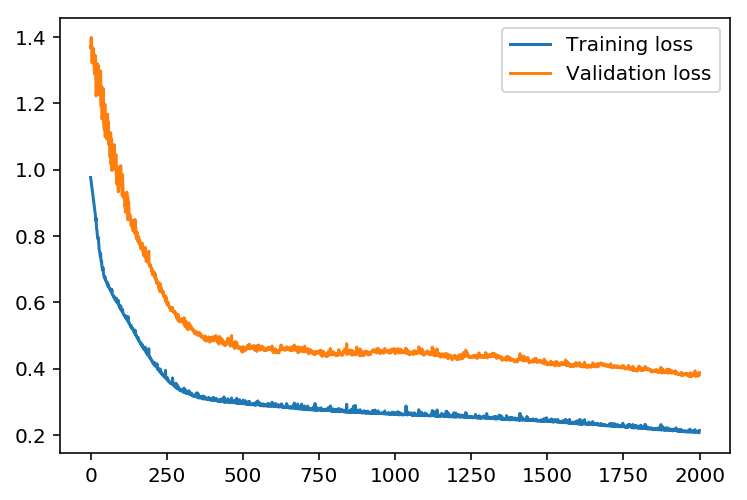

In [31]:
plt.plot(losses['train'], label='Training loss')
plt.plot(losses['validation'], label='Validation loss')
plt.legend()
_ = plt.ylim()

## Check out your predictions

Here, use the test data to view how well your network is modeling the data. If something is completely wrong here, make sure each step in your network is implemented correctly.

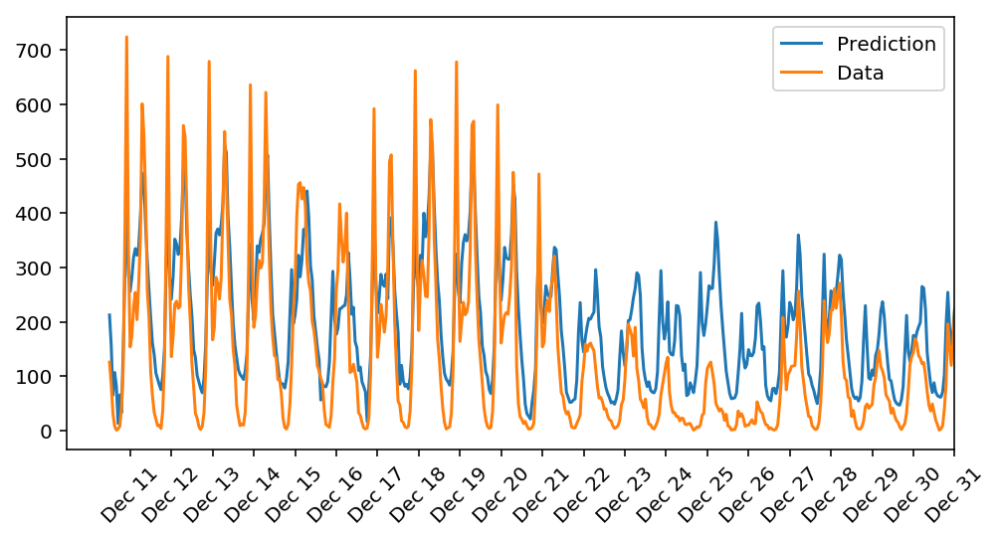

In [32]:
fig, ax = plt.subplots(figsize=(8,4))

mean, std = scaled_features['cnt']
predictions = network.run(test_features).T*std + mean
ax.plot(predictions[0], label='Prediction')
ax.plot((test_targets['cnt']*std + mean).values, label='Data')
ax.set_xlim(right=len(predictions))
ax.legend()

dates = pd.to_datetime(rides.ix[test_data.index]['dteday'])
dates = dates.apply(lambda d: d.strftime('%b %d'))
ax.set_xticks(np.arange(len(dates))[12::24])
_ = ax.set_xticklabels(dates[12::24], rotation=45)

## OPTIONAL: Thinking about your results(this question will not be evaluated in the rubric).
 
Answer these questions about your results. How well does the model predict the data? Where does it fail? Why does it fail where it does?

> **Note:** You can edit the text in this cell by double clicking on it. When you want to render the text, press control + enter

#### Your answer below
The model predicts well the data for Dece 15- Dec 16. It failed in the earlier year, which is kind of expected as the model is not yet properly trained. But as the years progress it got close in Dec 15 and 16. After it the data saw a sharp decline which again resulted in model deviating and predicting higher. 